# Курс по машинному обучению,   ВМК МГУ
## Градиентный бустинг деревьев

### Важно! О формате сдачи

* **Практически все выделенные задания из ноутбука оцениваются по системе <font color='red'>кросс-рецензирования</font>. Задания, в котором надо реализовать свой код и послать в систему, выделены здесь и в pdf отдельно**
* **В этом ноутбуке есть задание на ML-решение**
* **При решении ноутбука используйте данный шаблон. Не нужно удалять текстовые ячейки c разметкой частей ноутбука и формулировками заданий. Добавлять свои ячейки, при необходимости, конечно можно**
* **Везде, где в формулровке задания есть какой-либо вопрос (или просьба вывода), необходимо прописать ответ в ячейку (код или markdown).**
* **Наличие кода решения обязательно. Письменные ответы на вопросы без сопутствующего кода оцениваются в 0 баллов.**

**А также..**

Если в ячейке написана фраза "Вывод"/"Ответ на вопрос" итд, то ожидается ответ в виде текста (можете добавить ячейки с кодом, если считаете это необходимым, но это необязательно). Если в ячейке написано "Your code here", то ожидается ответ в виде кода (можете добавить ячейки с кодом, если считаете это необходимым, но это необязательно). Если есть и ячейка с фразой "Вывод", и ячейка с фразой "Your code here", то в ответе ожидается и код, и текст)

__В этом задании вы..:__

- Познакомитесь с несколькими новыми библиотеками машинного обучения
- Сравните между собой разные реализации градиентных бустингов
- Примените все полученные знания для получения лучшего скора на датасете фильмов




## Введение

Привет, ребятушки!

Сегодня мы с вами будем решать очень важную задачу, а именно оценивать цену поддержанных автомобилей в ряде стран. Делать мы это будем с помощью различных методов градиентного бустинга. Мы с вами узнаем, что в мире существует не только sklearn, и что существуют библиотеки, облегчающие нам задачу поиска оптимальных параметров для моделей.

**Внимание! Во всех заданиях в качестве целевой метрики используется MAE (средняя абсолютная ошибка).** Значение MAE вычисляется как

$$
  MAE = \sum_{i = 1}^N\dfrac{|a(x_i) - y_i|}{N},
$$

где $N$ - число объектов в тестовой выборке, $x_i$ - вектор признаков i-го объекта, $a(x_i)$ - предсказание на i-ом объекте, $y_i$ - значение целевого признака на i-м объекте.

## Установка дополнительных библиотек.

В этом задании нам понадобятся три бибиотеки, которыми вы ранее не пользовались в этом курсе, а именно:

**XGBoost**: Документация [здесь](https://xgboost.readthedocs.io/en/stable/).<br />
**LightGBM**: Документация [здесь](https://lightgbm.readthedocs.io/en/latest/index.html). Также дополнительно про установку [тут](https://pypi.org/project/lightgbm/).<br />
**Catboost**: Документация [здесь](https://catboost.ai/en/docs/). Можно найти также некоторую информацию на русском [тут](https://habr.com/ru/company/otus/blog/527554/).<br />
**HyperOpt**: Документация [здесь](http://hyperopt.github.io/hyperopt/). <br />

Все библиотеки легко ставятся через pip (либо альтернативные установщики вроде conda).


## Как правильно перебирать параметры

В этом ноутбуке мы будем несколько раз заниматься поиском оптимальных параметров для градиентного бустинга, перебирая задания по заданной сетке. В этом задании от Вас не будет требоваться найти самые лучшие параметры, но всё равно важно правильно составлять сетку для перебора. Для этого нужно понимать суть параметров и их смысл.



**learning_rate** -- темп обучения нашего метода. Для этого метода сетка перебора должна быть логарифмической, т.е. перебирать порядковые значения (к примеру, [1e-3, 1e-2, 1e-1, 1]). В большинстве случаев достаточно перебрать значения от 1e-5 до 1.<br />
**max_depth** -- максимальная глубина деревьев в ансамбле. Вообще говоря, эта величина зависит от числа признаков, но обычно лучше растить небольшие деревья. К примеру, библиотека CatBoost, которую мы будем исследовать сегодня, рекомендует перебирать значения до 10 (и уточняется, что обычно оптимальная глубина лежит от 6 до 10).<br />
**n_estimators** -- количество деревьев в ансамбле. Обычно стоит перебирать с каким-то крупным шагом (можно по логарифмической сетке). Здесь важно найти баланс между производительностью, временем обучения и качеством. Обычно нескольких тысяч деревьев бывает достаточно.<br />

Учтите, что в реальных задачах необходимо следить за тем, что оптимальные значения параметров не попадают на границы интервалов, т.е. что вы нашли хотя бы локальный минимум. Если Вы перебрали значения параметра от 1 до 10 и оказалось, что 10 - оптимальное значение, значит следует перебрать и бОльшие числа, чтобы убедиться, что качество не улучшается дальше (или по крайней мере убедиться, что рост качества сильно замедляется и на сильное улучшения рассчитывать не стоит.


## Подготовка датасета

Все библиотеки, используемые сегодня, мы будем проверять на одних и тех же параметрах: n_estimators=1000, max_depth=5, learning_rate=0.1. Таким образом мы устанавливаем, соответственно, число деревьев в ансамбле равным 1000, ограничиваем максимальную глубину деревьев 5 и устанавливаем темп обучения равным 0.1. Создадим сразу словарь, чтобы передавать эти параметры создаваемым регрессорам (если вдруг не знали, словарь можно передавать как параметры, поставив перед ним **).

Эти параметры мы вынесем в отдельную переменную `test_parameters`.

<span style="color:red">Загрузите датасет, с которым мы будем работать. Его можно найти на платформе cv-gml.ru, в задании `Град. бустинг (ML)`, по ссылке `Дополнительные файлы для решения`. Если Вы решите сохранить этот файл не рядом с ноутбуком, Вы можете исправить путь к этому файлу во второй ячейке ноутбука (в строке с `read_csv`).</span>

При желании можно почитать про этот датасет на платформе kaggle: [ссылка на данные](https://www.kaggle.com/bushnag/cars-in-the-middle-east?select=dataframe_YesIndex_YesHeader_C.csv). <span style="color:red"> Не скачивайте датасет из kaggle для выполнения ноутбука, поскольку его могут изменить.</span> Нас интересует файл dataframe_YesIndex_YesHeader_C.csv, поскольку он уже хорошо предобработан (хотя, конечно, датасаентисты должны сами уметь это делать, но ладно).
Давайте попробуем загрузить датасет в память и посмотреть, как он выглядит.

In [1]:
%matplotlib inline
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import mean_absolute_error, make_scorer

from hyperopt import hp, tpe, Trials
from hyperopt.fmin import fmin
from hyperopt.pyll import scope

from xgboost import XGBRegressor

from lightgbm import LGBMRegressor

from catboost import CatBoostRegressor

import matplotlib.pyplot as plt

import pandas as pd

import numpy as np

import time

In [2]:
test_parameters = {"n_estimators": 1000, "max_depth": 5, "learning_rate":0.1}

df = pd.read_csv('dataframe_YesIndex_YesHeader_C.csv', index_col=0)
df.head()

,Engine Capacity,Cylinders,Drive Type,Fuel Tank Capacity,Fuel Economy,Fuel Type,Horsepower,Torque,Transmission,Top Speed,...,Acceleration,Length,Width,Height,Wheelbase,Trunk Capacity,name,price,currency,Country
0,1.2,3,0,42.0,4.9,0,76,100.0,0,170,...,14.0,4.245,1.670,1.515,2.550,450.0,Mitsubishi Attrage 2021 1.2 GLX (Base),34099.0,0,0
1,1.2,3,0,42.0,4.9,0,76,100.0,0,170,...,14.0,4.245,1.670,1.515,2.550,450.0,Mitsubishi Attrage 2021 1.2 GLX (Base),34099.0,0,0
2,1.4,4,0,45.0,6.3,0,75,118.0,1,156,...,16.0,3.864,1.716,1.721,2.513,2800.0,Fiat Fiorino 2021 1.4L Standard,41250.0,0,0
3,1.6,4,0,50.0,6.4,0,102,145.0,0,180,...,11.0,4.354,1.994,1.529,2.635,510.0,Renault Symbol 2021 1.6L PE,44930.0,0,0
4,1.5,4,0,48.0,5.8,0,112,150.0,0,170,...,10.9,4.314,1.809,1.624,2.585,448.0,MG ZS 2021 1.5L STD,57787.0,0,0


### Задание 0 (без проверки, 0 баллов)

Посмотрите на цены автомобилей. Попробуйте понять, написаны они в одной валюте или нет. Если нет -- будут ли у нас серьезные проблемы при использовании деревьев? Стоит ли нам что-то сделать для того, чтобы нивелировать эту проблему?


In [3]:
pd.unique(df['currency'])

array([0, 1, 5, 3, 4, 2])

В глаза бросаются две проблемы: у нас имеется информация о производителе автомобиля, скрытая в текстовой переменной модели автомобиля (нет отдельного признака). Также имеются некоторые категориальные переменные. Со всем этим безобразием надо что-то сделать.

### **Задание 1 (кросс-проверка, 3 балла)**
**Данные**: датасет со стоимостью поддержанных автомобилей  
**Цели**: В данном задании следует выполнить следующие пункты (выполнять можно в любом порядке)
1. Изучить датасет, проверить наличие пропусков. При необходимости заменить их на среднее значение признака.
3. Добавить столбец brand с информацией о производителе автомобиля (для простоты можно взять первое слово в названии модели)
4. Решить, какие признаки Вы хотите сделать категориальными. Конвертировать выбранные категориальные столбцы в тип category. 
5. Создать датасет А с категориальными признаками в виде категорий. Для этого необходимо создать вектор целевых значений (столбец цен автомобилей) и матрицу признаков с категориальными переменными в виде категорий (получается путем удаления только целевой переменной из матрицы с данными). Дополнительно стоит создать список с названиями и индексами столбцов категориальных переменных (поможет в будущем).
6. Создать датасет B без категориальных признаков. Для этого необходимо создать вектор целевых значений (столбец цен автомобилей) и удалить из матрицы признаков столбец с целевыми переменными, а также все категориальные переменные.
8. Создать датасет C с категориальными признаками в виде one-hot encoding. Для этого необходимо создать вектор целевых значений (столбец цен автомобилей), удалить из матрицы признаков столбец с целевыми переменными и все категориальными переменные, а затем добавить новые признаки, соответствующие one-hot encoding категориальных переменных (здесь вам поможет функция `pd.get_dummies`).
9. Разбить датасеты на тренировочное и тестовое множества, используя `train_test_split(X, y, test_size=0.25, random_state=0)` (зафиксировав random_seed мы получим одинаковое разбиение на обучение/тест для всех трёх выборок).

In [4]:
datasets = {'A' : None, 'B': None, 'C': None}

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4560 entries, 0 to 5667
Data columns (total 21 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Engine Capacity     4560 non-null   float64
 1   Cylinders           4560 non-null   int64  
 2   Drive Type          4560 non-null   int64  
 3   Fuel Tank Capacity  4560 non-null   float64
 4   Fuel Economy        4560 non-null   float64
 5   Fuel Type           4560 non-null   int64  
 6   Horsepower          4560 non-null   int64  
 7   Torque              4560 non-null   float64
 8   Transmission        4560 non-null   int64  
 9   Top Speed           4560 non-null   int64  
 10  Seating Capacity    4560 non-null   int64  
 11  Acceleration        4560 non-null   float64
 12  Length              4560 non-null   float64
 13  Width               4560 non-null   float64
 14  Height              4560 non-null   float64
 15  Wheelbase           4560 non-null   float64
 16  Trunk 

In [5]:
if 'brand' not in df:
      df['brand'] = df.name.str.split().str[0] 

target = df.price
data = df.drop(['name','price'], axis=1)

types = {}
cat_idxs = [2,5,8,17,18,19]
cat_features = data.columns[cat_idxs]
for f in cat_features: 
  types[f] = 'category'

datasets['A'] = data.astype(types)
datasets['B'] = data.drop(cat_features, axis=1)
datasets['C'] = pd.get_dummies(data, columns=cat_features)

In [6]:
X_train = {}
X_test = {}

for c in 'ABC':
  X_train[c], X_test[c], y_train, y_test = train_test_split(datasets[c], target, 
                                                            test_size=0.25, random_state=42)

Итак, кажется, что у нас всё готово для того, чтобы начать искать ответы на волнующие нас вопросы. Начнем со столь любимой нами библиотеки, а именно...

## Градиентный бустинг со sklearn

Естественно, в sklearn имеется реализация градиентного бустинга, которая хранится в sklearn.ensemble.GradientBoostingRegressor. Преимущественно данным классом пользуются в учебных заданиях, поскольку в реальных задачах предпочтение отдаётся другим библиотекам. Давайте попробуем понять, заслуженно ли градиентный бустинг в sklearn не пользуется популярностью.

FYI: в sklearn имеется также реализация GradientBoostingClassifier для задач классификации, но пользоваться им мы сегодня не будем.

GradientBoostingRegressor из коробки не умеет работать с категориальными признаками. Мы к этому уже подготовились, закодировав наши признаки.

### **Задание 2 (кросс-проверка, 2 балла)**:

**Данные**: датасет со стоимостью поддержанных автомобилей    
**Метрика**: MAE    
**Цели**: В данном задании следует выполнить следующие пункты:    
1. Обучить sklearn.ensemble.GradientBoostingRegressor на датасетах B и C, используя параметры n_estimators=1000, max_depth=5, learning_rate=0.1 (наши `test_parameters`). Замерьте время обучения, получите предсказания данных моделей на тестовом множестве.
2. Обучить sklearn.ensemble.GradientBoostingRegressor на датасете B (можно и на C, если позволяют вычислительные ресурсы), используя кросс-валидацию на тренировочном множестве и подбирая значения для параметров n_estimators, learning_rate и max_depth. для простоты можете воспользоваться GridSearchCV. При необходимости можно оптимизировать параметры по одному, а не все сразу. Выведите лучшие параметры. Получите предсказания лучшей модели (с лучшими параметрами) на тестовом множестве. Для ускорения процесса не забудьте воспользоваться n_jobs.
3. Посчитать MAE для полученных предсказаний на тренировочном и тестовом множествах (можно воспользоваться sklearn.metrics.mean_absolute_error).
5. Вывести результаты и время в таблице DataFrame.
4. Сделайте выводы. Оцените полезность категориальных переменных и поиска оптимальных параметров. Оцените время, затраченное на обучение. Попробуйте дать оценку получившемуся MAE: оно большое или маленькое?


In [7]:
df_skl = pd.DataFrame(columns=['Dataset', 'Parameters', 'Time', 'MAE'])

gb = GradientBoostingRegressor(**test_parameters)
start = time.time()
gb.fit(X_train['B'], y_train)
end = time.time()
y_pred = gb.predict(X_test['B'])
mae = mean_absolute_error(y_test, y_pred)

df_skl.loc[len(df_skl)] = ['B', str(list(test_parameters.values())), end-start, mae]
print('Базовые параметры, датасет B')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

Базовые параметры, датасет B
Время обучения 6.876287937164307
MAE 133596.8919548871


In [8]:
gb = GradientBoostingRegressor(**test_parameters)
start = time.time()
gb.fit(X_train['C'], y_train)
end = time.time()
y_pred = gb.predict(X_test['C'])
mae = mean_absolute_error(y_test, y_pred)

df_skl.loc[len(df_skl)] = ['C', str(list(test_parameters.values())), end-start, mae]
print('Базовые параметры, датасет C')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

Базовые параметры, датасет C
Время обучения 11.510850191116333
MAE 30495.16950793853


In [9]:
gb = GradientBoostingRegressor()

params = {'n_estimators' : np.logspace(3, 3.5, 4, dtype=int),
          'max_depth' : np.array([6,10]),
          'learning_rate' : np.around(np.logspace(-2.3,-0.3,4), 3)}
          
grid = GridSearchCV(gb, params, scoring='neg_mean_absolute_error', 
                    n_jobs=-1, cv=4)

start = time.time()
grid.fit(X_train['B'], y_train)
end = time.time()

y_pred = grid.predict(X_test['B'])
mae = mean_absolute_error(y_test, y_pred)
mae_train = mean_absolute_error(y_train, grid.predict(X_train['B']))

df_skl.loc[len(df_skl)] = ['B', str(list(grid.best_params_.values())), end-start, mae]
print('Поиск по сетке, датасет B')
print(f'Время обучения {end-start}')
print(f'MAE test {mae}')
print(f'MAE train {mae_train}')

Поиск по сетке, датасет B
Время обучения 306.4632067680359
MAE test 132766.75828545837
MAE train 94469.89089139356


In [10]:
df_skl

,Dataset,Parameters,Time,MAE
0,B,"[1000, 5, 0.1]",6.876288,133596.891955
1,C,"[1000, 5, 0.1]",11.510850,30495.169508
2,B,"[0.005, 6, 3162]",306.463207,132766.758285


Оценим MAE, для этого посмотрим на среднее значение целевой переменной

In [11]:
target.mean()

148742.32807017543

**Ваши выводы:** 
- МАЕ для модели, обученной без категориальных переменных, получилось сравнимым со средним предсказываемой переменной, значит модель предсказывает слабо. А для модели, обученной по закодированным категориальным переменным, MAE получилось на порядок меньшим, однако нельзя судить большое оно или маленькое, т.к. предсказываемая переменная не нормированна, поэтому равные в процентном соотношении ошибки могут иметь очень разные абсолютные значения.
- Использование категориальных переменных дает большую точность модели даже с дефолтными параметрами, чем точность модели с подобранными параметрами, но без категориальных переменных.
- Подбор параметров для датасета без категориальных переменных не дает существенного преимущества, но время для обучения используется много, для сетки из всего 32 вариантов оно составило порядка 23 минут.

И так, sklearn предлагает нам привычный и простой способ тренировки моделей. Однако, для градиентного бустинга существует множество эвристик и трюков, помогающих улучшить результаты. И одна из библиотек, реализующая улучшенную версию бустинга, называется xgboost.

## Градиентный бустинг с XGBoost

XGBoost стала достаточно популярной библиотекой, которая позволяет добиться хороших результатов без особых усилий (во всяком случае, так гласят легенды). И у нас для вас две новости: хорошая и плохая. Хорошая – xgboost, хоть и является сторонней библиотекой, сохраняет интерфейс sklearn и даже прекрасно работает с GridSearchCV. Плохая – она тоже не умеет из коробки работать с категориальными признаками. Ну что же, давайте пощупаем это безобразие. На этот раз нас интересует класс xgboost.XGBRegressor.

Update: относительно недавно в xgboost появилась экспериментальная поддержка категориальных переменных, которая еще не добавлена в стабильную версию, поэтому ею мы пользоваться пока не будем.

### Задание 3 (кросс-проверка, 2 балла):
**Данные**: датасет со стоимостью поддержанных автомобилей  
**Метрика**: MAE  
**Цели**: В данном задании следует выполнить следующие пункты:  
1. Обучить xgboost.XGBRegressor на датасетах B и C, используя параметры n_estimators=1000, max_depth=5, learning_rate=0.1 (наши `test_parameters`). Замерьте время обучения. Получите предсказания данных моделей на тестовом множестве.
2. Обучить xgboost.XGBRegressor на датасетах B и C, используя кросс-валидацию на тренировочном множестве и подбирая значения для параметров n_estimators, learning_rate и max_depth (для простоты можете воспользоваться GridSearchCV). При необходимости можно оптимизировать параметры по одному, а не все сразу. Замерьте время перебора, получите предсказания лучшей модели (с лучшими параметрами) на тестовом множестве. В этом случае устанавливать n_jobs у GridSearchCV не рекомендую, поскольку xgboost сам умеет захватывать все доступные ресурсы, и если GridSearchCV начнет их размножать, то последствия будут печальны.
3. Посчитать MAE для полученных предсказаний на тренировочном и тестовом множествах (можно воспользоваться sklearn.metrics.mean_absolute_error).
1. Выведите результаты и время в таблице DataFrame.
4. Сделайте выводы. Оцените полезность категориальных переменных и поиска оптимальных параметров. Оцените время, затраченное на обучение. Сравните результаты со sklearn.

In [12]:
df_xgb = pd.DataFrame(columns=['Dataset', 'Parameters', 'Time', 'MAE'])

In [13]:
xgb = XGBRegressor(**test_parameters, objective ='reg:squarederror')
start = time.time()
xgb.fit(X_train['B'], y_train)
end = time.time()

In [14]:
y_pred = xgb.predict(X_test['B'])
mae = mean_absolute_error(y_test, y_pred)

df_xgb.loc[len(df_xgb)] = ['B', str(list(test_parameters.values())), end-start, mae]
print('XGBoost, Базовые параметры, датасет B')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

XGBoost, Базовые параметры, датасет B
Время обучения 1.219198226928711
MAE 133736.24562902618


In [15]:
xgb = XGBRegressor(**test_parameters, objective ='reg:squarederror')
start = time.time()
xgb.fit(X_train['C'], y_train)
end = time.time()

In [16]:
y_pred = xgb.predict(X_test['C'])
mae = mean_absolute_error(y_test, y_pred)

df_xgb.loc[len(df_xgb)] = ['C', str(list(test_parameters.values())), end-start, mae]
print('XGBoost, Базовые параметры, датасет C')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

XGBoost, Базовые параметры, датасет C
Время обучения 2.942471981048584
MAE 30267.431270505673


In [17]:
xgb = XGBRegressor(objective ='reg:squarederror')

params = {'n_estimators' : np.logspace(3, 3.5, 4, dtype=int),
          'max_depth' : np.array([6,10]),
          'learning_rate' : np.around(np.logspace(-2.3,-0.3,4), 3)}

grid = GridSearchCV(xgb, params, scoring='neg_mean_absolute_error', cv=4)

start = time.time()
grid.fit(X_train['B'], y_train)
end = time.time()

In [18]:
y_pred = grid.predict(X_test['B'])
mae = mean_absolute_error(y_test, y_pred)
mae_train = mean_absolute_error(y_train, grid.predict(X_train['B']))

df_xgb.loc[len(df_xgb)] = ['B', str(list(grid.best_params_.values())), end-start, mae]
print('XGBoost, Поиск по сетке, датасет B')
print(f'Время обучения {end-start}')
print(f'MAE test {mae}')
print(f'MAE train {mae_train}')

XGBoost, Поиск по сетке, датасет B
Время обучения 469.5292921066284
MAE test 133258.7412289268
MAE train 97182.2100563094


In [19]:
xgb = XGBRegressor(objective ='reg:squarederror')

params = {'n_estimators' : np.logspace(3, 3.5, 4, dtype=int),
          'max_depth' : np.array([6,10]),
          'learning_rate' : np.around(np.logspace(-2.3,-0.3,4), 3)}

grid = GridSearchCV(xgb, params, scoring='neg_mean_absolute_error', cv=4)

start = time.time()
grid.fit(X_train['C'], y_train)
end = time.time()

In [20]:
y_pred = grid.predict(X_test['C'])
mae = mean_absolute_error(y_test, y_pred)
mae_train = mean_absolute_error(y_train, grid.predict(X_train['C']))

df_xgb.loc[len(df_xgb)] = ['C', str(list(grid.best_params_.values())), end-start, mae]
print('XGBoost, Поиск по сетке, датасет C')
print(f'Время обучения {end-start}')
print(f'MAE test {mae}')
print(f'MAE train {mae_train}')

XGBoost, Поиск по сетке, датасет C
Время обучения 1098.7248108386993
MAE test 28653.00381689239
MAE train 2318.235985971194


In [21]:
df_xgb

,Dataset,Parameters,Time,MAE
0,B,"[1000, 5, 0.1]",1.219198,133736.245629
1,C,"[1000, 5, 0.1]",2.942472,30267.431271
2,B,"[0.005, 6, 3162]",469.529292,133258.741229
3,C,"[0.108, 6, 3162]",1098.724811,28653.003817


**Ваши выводы:** 
- Категориальные переменные дают большой импакт к результату
- Подбор параметров по сетке тоже дает прирост, для датасета с категориальными переменными - больше, хоть и занимает много времени, порядка 2-х часов в Colab

Таким вот несложным образом нам удалось воспользоваться еще одной библиотекой. Давайте перейдем к третьей библиотеке, которую мы сегодня изучим, и называется она lightgbm.

## Градиентный бустинг в lightgbm

Про Lightgbm легенды гласят, что она очень быстрая и легкая: что самый большой датасет она без проблем переварит за относительно небольшое время. А еще её разрабатывали не хухры кто, а сами мелкомягкие, так что попробовать её определённо стоит. На этот раз у нас вновь две новости, две хороших и две плохих. Первая хорошая — lightgbm тоже работает с GridSearchCV. Вторая хорошая — lightgbm умеет из коробки работать с категориальными признаками! Плохая — делает она это немного нетривиально (не зря я просил вас запомнить категориальные переменные!). Вторая плохая — да, нам придётся этим пользоваться.

Внимание! LightGBM может писать сотню радостных сообщений о том, что он увидел ваши categorical_feature и использует их. При желании можете заглушать эти оповещения, ибо в случае перебора параметров их становится слишком много. (заклинание для заглушения: `warnings.filterwarnings("ignore")`)

### Задание 4 (кросс-проверка, 3 балла):
**Данные**: датасет со стоимостью поддержанных автомобилей  
**Метрика**: MAE  
**Цели**: В данном задании следует выполнить следующие пункты:  
1. В случае датасета, сохраненном в numpy, lightgbm требует, чтобы категории были закодированы целыми числами от 0 до числа признаков(e.g. ['a', 'b', 'a'] -> [0, 1, 0]). Сделайте это для датасета A. Если вы используете pandas, то для датасета A достаточно установить соответствующие столбцы типа "категория", тогда categorical_feature='auto' сам всё подхватит.
2. Обучить lightgbm.LGBMRegressor на датасетах A, B и C, используя параметры используя параметры n_estimators=1000, max_depth=5, learning_rate=0.1. В случае датасета A, передайте в функцию fit индексы/имена категориальных признаков. Замерьте время обучения, получите предсказания данных моделей на тестовом множестве.
3. Обучить lightgbm.LGBMRegressor на датасетах A, B и C, используя кросс-валидацию на тренировочном множестве и подбирая значения для параметров n_estimators, learning_rate и max_depth (для простоты можете воспользоваться GridSearchCV). Замерьте время, потраченное на поиск оптимальных параметров(вновь не советую использовать n_jobs). Замерьте время перебора, получите предсказания лучшей модели (с лучшими параметрами) на тестовом множестве.
4. Посчитать MAE для полученных предсказаний на тренировочном и тестовом множествах (можно воспользоваться sklearn.metrics.mean_absolute_error). Сделайте выводы и полезности использования категориальных переменных и поиска оптимальных параметров.
5. Вывести результаты и время в таблице DataFrame.

In [22]:
import warnings
warnings.filterwarnings("ignore")

df_lgbm = pd.DataFrame(columns=['Dataset', 'Parameters', 'Time', 'MAE'])

In [23]:
lgbm = LGBMRegressor(**test_parameters, categorical_feature='auto')
start = time.time()
lgbm.fit(X_train['A'], y_train)
end = time.time()

In [24]:
y_pred = lgbm.predict(X_test['A'])
mae = mean_absolute_error(y_test, y_pred)

df_lgbm.loc[len(df_lgbm)] = ['A', str(list(test_parameters.values())), end-start, mae]
print('LightGBM, Базовые параметры, датасет A')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

LightGBM, Базовые параметры, датасет A
Время обучения 0.25876688957214355
MAE 30119.638513923986


In [25]:
lgbm = LGBMRegressor(**test_parameters)
start = time.time()
lgbm.fit(X_train['B'], y_train)
end = time.time()

In [26]:
y_pred = lgbm.predict(X_test['B'])
mae = mean_absolute_error(y_test, y_pred)

df_lgbm.loc[len(df_lgbm)] = ['B', str(list(test_parameters.values())), end-start, mae]
print('LightGBM, Базовые параметры, датасет B')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

LightGBM, Базовые параметры, датасет B
Время обучения 0.164872407913208
MAE 131218.58456279614


In [27]:
lgbm = LGBMRegressor(**test_parameters)
start = time.time()
lgbm.fit(X_train['C'], y_train)
end = time.time()

In [28]:
y_pred = lgbm.predict(X_test['C'])
mae = mean_absolute_error(y_test, y_pred)

df_lgbm.loc[len(df_lgbm)] = ['C', str(list(test_parameters.values())), end-start, mae]
print('LightGBM, Базовые параметры, датасет C')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

LightGBM, Базовые параметры, датасет C
Время обучения 0.2292330265045166
MAE 43735.54385998887


In [29]:
lgbm = LGBMRegressor(categorical_feature='auto')

params = {'n_estimators' : np.logspace(3, 3.5, 4, dtype=int),
          'max_depth' : np.array([6,10]),
          'learning_rate' : np.around(np.logspace(-2.3,-0.3,4), 3)}

grid = GridSearchCV(lgbm, params, scoring='neg_mean_absolute_error', cv=5)

start = time.time()
grid.fit(X_train['A'], y_train)
end = time.time()

In [30]:
y_pred = grid.predict(X_test['A'])
mae = mean_absolute_error(y_test, y_pred)
mae_train = mean_absolute_error(y_train, grid.predict(X_train['A']))

df_lgbm.loc[len(df_lgbm)] = ['A', str(list(grid.best_params_.values())), end-start, mae]
print('LightGBM, Поиск по сетке, датасет A')
print(f'Время обучения {end-start}')
print(f'MAE test {mae}')
print(f'MAE train {mae_train}')

LightGBM, Поиск по сетке, датасет A
Время обучения 148.38621997833252
MAE test 33800.64880596592
MAE train 17040.05117643437


In [31]:
lgbm = LGBMRegressor()

params = {'n_estimators' : np.logspace(3, 3.5, 4, dtype=int),
          'max_depth' : np.array([6,10]),
          'learning_rate' : np.around(np.logspace(-2.3,-0.3,4), 3)}

grid = GridSearchCV(lgbm, params, scoring='neg_mean_absolute_error', cv=5)

start = time.time()
grid.fit(X_train['B'], y_train)
end = time.time()

In [32]:
y_pred = grid.predict(X_test['B'])
mae = mean_absolute_error(y_test, y_pred)
mae_train = mean_absolute_error(y_train, grid.predict(X_train['B']))

df_lgbm.loc[len(df_lgbm)] = ['B', str(list(grid.best_params_.values())), end-start, mae]
print('LightGBM, Поиск по сетке, датасет B')
print(f'Время обучения {end-start}')
print(f'MAE test {mae}')
print(f'MAE train {mae_train}')

LightGBM, Поиск по сетке, датасет B
Время обучения 110.6730649471283
MAE test 138227.97595611424
MAE train 108367.6452275203


In [33]:
lgbm = LGBMRegressor()

params = {'n_estimators' : np.logspace(3, 3.5, 4, dtype=int),
          'max_depth' : np.array([6,10]),
          'learning_rate' : np.around(np.logspace(-2.3,-0.3,4), 3)}

grid = GridSearchCV(lgbm, params, scoring='neg_mean_absolute_error', cv=5)

start = time.time()
grid.fit(X_train['C'], y_train)
end = time.time()

In [34]:
y_pred = grid.predict(X_test['C'])
mae = mean_absolute_error(y_test, y_pred)
mae_train = mean_absolute_error(y_train, grid.predict(X_train['C']))

df_lgbm.loc[len(df_lgbm)] = ['C', str(list(grid.best_params_.values())), end-start, mae]
print('LightGBM, Поиск по сетке, датасет C')
print(f'Время обучения {end-start}')
print(f'MAE test {mae}')
print(f'MAE train {mae_train}')

LightGBM, Поиск по сетке, датасет C
Время обучения 162.37402820587158
MAE test 32527.21782993628
MAE train 3728.432460183109


In [35]:
df_lgbm

,Dataset,Parameters,Time,MAE
0,A,"[1000, 5, 0.1]",0.258767,30119.638514
1,B,"[1000, 5, 0.1]",0.164872,131218.584563
2,C,"[1000, 5, 0.1]",0.229233,43735.543860
3,A,"[0.005, 10, 1000]",148.386220,33800.648806
4,B,"[0.005, 10, 1000]",110.673065,138227.975956
5,C,"[0.108, 10, 3162]",162.374028,32527.217830


**Ваши выводы:** 
- Реализация LightGBM, действительно, обучается быстрее, чем xgboost и sklearn
- Прирост качества от использования категориальных переменных все так же имеется
- Интересно, что на датасете А базовые параметры показывают результат лучше, чем при поиске по сетке. В общем, сравнивать модели чисто по метрике на тесте не очень хорошо, справедливее сравнивать метрики на кросс-валидации, но в то же время, модель может переобучиться именно под конкретное разбиение фолдов

Как вы видите, иногда можно не возиться с OHE, а позволить библиотекам самим это сделать (хотя иногда при этом приходится повозиться с самими данными, чтобы библиотека съела данные).

Итак, мы с вами почти стали мастерами градиентного бустинга. Переходим к последней звезде нашего хит-парада.

## Градиентный бустинг в catboost

Библиотека, созданная в тёмных подвалах яндекса. По легендам эта библиотека умеет работать с категориальными данными, быстрая, эффективная, легко настраивается, из коробки понимает текстовые признаки в задачах классификации и спасла Брюса Уиллиса. Давайте проверим.
Вас, наверное, не удивить тем, что эта библиотека работает с GridSearchCV, но им мы пользоваться не будем. В catboost существует своя реализация перебора параметров, и мы попробуем им воспользоваться (ура, разнообразие!). В качестве регрессора нас интересует catboost.CatBoostRegressor.

Внимание! Эта библиотека еще более болтлива, чем lightgbm, но это (почти) полностью лечится с помощью verbose. К сожалению, отключением warnings её не сделать молчаливее. А еще эта библиотека может неожиданно создать вам парочку новых папок.

### Задание 5 (кросс-проверка, 3 балла):
**Данные**: датасет со стоимостью поддержанных автомобилей  
**Метрика**: MAE  
**Цели**: В данном задании следует выполнить следующие пункты:  
1. Обучить catboost.CatBoostRegressor на датасетах A, B и C, используя параметры используя параметры n_estimators=1000, max_depth=5, learning_rate=0.1. В случае датасета A, передайте на вход методу fit/конструктору параметр cat_features, содержащий имена/индексы категориальных переменных. В данном случае переводить категории в целые числа, как мы делали для lightgbm, не нужно. Замерьте время обучения, получите предсказания данных моделей на тестовом множестве.
2. Обучить catboost.CatBoostRegressor на датасетах A, B и C, используя метод grid_search (является методом экземпляра класса CatBoostRegressor). Замерьте время, потраченное на поиск оптимальных параметров. Замерьте время перебора, получите предсказания лучшей модели (с лучшими параметрами) на тестовом множестве.
3. Посчитать MAE для полученных предсказаний на тренировочном и тестовом множествах (можно воспользоваться sklearn.metrics.mean_absolute_error).
4. Сделайте выводы и полезности использования категориальных переменных и поиска оптимальных параметров.
5. Вывести результаты и время в таблице DataFrame.


In [36]:
df_ctb = pd.DataFrame(columns=['Dataset', 'Parameters', 'Time', 'MAE'])

In [37]:
ctb = CatBoostRegressor(**test_parameters, cat_features=list(cat_features))
start = time.time()
ctb.fit(X_train['A'], y_train, verbose=0)
end = time.time()

In [38]:
y_pred = ctb.predict(X_test['A'])
mae = mean_absolute_error(y_test, y_pred)

df_ctb.loc[len(df_ctb)] = ['A', str(list(test_parameters.values())), end-start, mae]
print('CatBoost, Базовые параметры, датасет A')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

CatBoost, Базовые параметры, датасет A
Время обучения 3.059070348739624
MAE 21824.905677674098


In [39]:
ctb = CatBoostRegressor(**test_parameters)
start = time.time()
ctb.fit(X_train['B'], y_train, verbose=0)
end = time.time()

In [40]:
y_pred = ctb.predict(X_test['B'])
mae = mean_absolute_error(y_test, y_pred)

df_ctb.loc[len(df_ctb)] = ['B', str(list(test_parameters.values())), end-start, mae]
print('CatBoost, Базовые параметры, датасет B')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

CatBoost, Базовые параметры, датасет B
Время обучения 0.9578380584716797
MAE 131578.58131734552


In [41]:
ctb = CatBoostRegressor(**test_parameters, train_dir='/tmp/catboost_info')
start = time.time()
ctb.fit(X_train['C'], y_train, verbose=0)
end = time.time()

In [42]:
y_pred = ctb.predict(X_test['C'])
mae = mean_absolute_error(y_test, y_pred)

df_ctb.loc[len(df_ctb)] = ['C', str(list(test_parameters.values())), end-start, mae]
print('CatBoost, Базовые параметры, датасет C')
print(f'Время обучения {end-start}')
print(f'MAE {mae}')

CatBoost, Базовые параметры, датасет C
Время обучения 1.1655349731445312
MAE 30867.43515568407


In [43]:
ctb = CatBoostRegressor(cat_features=list(cat_features), train_dir='/tmp/catboost_info', eval_metric='MAE')

params = {'n_estimators' : np.logspace(3, 3.5, 4, dtype=int),
          'max_depth' : np.array([6,10]),
          'learning_rate' : np.around(np.logspace(-2.3,-0.3,4), 3)}

start = time.time()
grid = ctb.grid_search(params, X_train['A'], y_train, verbose=False)
end = time.time()

0:	learn: 147730.5937678	test: 121401.1649315	best: 121401.1649315 (0)	total: 11.2ms	remaining: 11.2s
1:	learn: 147025.2026997	test: 120775.4894277	best: 120775.4894277 (1)	total: 20.1ms	remaining: 10s
2:	learn: 146335.4254377	test: 120157.5052449	best: 120157.5052449 (2)	total: 28.7ms	remaining: 9.53s
3:	learn: 145627.2137731	test: 119523.4608618	best: 119523.4608618 (3)	total: 33.7ms	remaining: 8.4s
4:	learn: 144943.5194446	test: 118904.9142829	best: 118904.9142829 (4)	total: 38.7ms	remaining: 7.7s
5:	learn: 144251.5111909	test: 118287.4953699	best: 118287.4953699 (5)	total: 45.3ms	remaining: 7.5s
6:	learn: 143566.7358968	test: 117707.0863329	best: 117707.0863329 (6)	total: 51.5ms	remaining: 7.31s
7:	learn: 142881.8830728	test: 117107.3968827	best: 117107.3968827 (7)	total: 56.9ms	remaining: 7.05s
8:	learn: 142205.0079700	test: 116505.3776980	best: 116505.3776980 (8)	total: 61.8ms	remaining: 6.81s
9:	learn: 141528.9108386	test: 115913.3074006	best: 115913.3074006 (9)	total: 66.8ms	re

106:	learn: 90461.2079201	test: 70422.3233132	best: 70422.3233132 (106)	total: 574ms	remaining: 4.79s
107:	learn: 90051.3483312	test: 70066.0165075	best: 70066.0165075 (107)	total: 580ms	remaining: 4.79s
108:	learn: 89655.4880154	test: 69722.8377230	best: 69722.8377230 (108)	total: 588ms	remaining: 4.81s
109:	learn: 89277.3069611	test: 69398.5313288	best: 69398.5313288 (109)	total: 596ms	remaining: 4.82s
110:	learn: 88892.3815552	test: 69078.6399145	best: 69078.6399145 (110)	total: 601ms	remaining: 4.81s
111:	learn: 88503.8188384	test: 68748.5395935	best: 68748.5395935 (111)	total: 606ms	remaining: 4.8s
112:	learn: 88111.0053046	test: 68418.7631988	best: 68418.7631988 (112)	total: 613ms	remaining: 4.81s
113:	learn: 87734.7488143	test: 68103.1492665	best: 68103.1492665 (113)	total: 619ms	remaining: 4.81s
114:	learn: 87359.5025225	test: 67756.4876352	best: 67756.4876352 (114)	total: 624ms	remaining: 4.8s
115:	learn: 86989.8915712	test: 67413.4595808	best: 67413.4595808 (115)	total: 627ms

190:	learn: 65420.6264918	test: 49771.2836820	best: 49771.2836820 (190)	total: 969ms	remaining: 4.11s
191:	learn: 65198.4516649	test: 49592.3421799	best: 49592.3421799 (191)	total: 977ms	remaining: 4.11s
192:	learn: 64972.2084955	test: 49412.5138228	best: 49412.5138228 (192)	total: 984ms	remaining: 4.11s
193:	learn: 64772.0138396	test: 49272.1031351	best: 49272.1031351 (193)	total: 991ms	remaining: 4.12s
194:	learn: 64542.2091059	test: 49098.9549427	best: 49098.9549427 (194)	total: 997ms	remaining: 4.12s
195:	learn: 64336.9598215	test: 48944.3105944	best: 48944.3105944 (195)	total: 1s	remaining: 4.11s
196:	learn: 64128.8339714	test: 48780.9765047	best: 48780.9765047 (196)	total: 1.01s	remaining: 4.11s
197:	learn: 63891.4343468	test: 48594.0374647	best: 48594.0374647 (197)	total: 1.01s	remaining: 4.1s
198:	learn: 63684.3428834	test: 48444.2673160	best: 48444.2673160 (198)	total: 1.02s	remaining: 4.1s
199:	learn: 63496.8649207	test: 48313.9410810	best: 48313.9410810 (199)	total: 1.02s	re

295:	learn: 53437.5578933	test: 40960.7140030	best: 40960.7140030 (295)	total: 1.37s	remaining: 3.25s
296:	learn: 53446.8410574	test: 40976.8841151	best: 40960.7140030 (295)	total: 1.37s	remaining: 3.25s
297:	learn: 53298.8308155	test: 40868.7324376	best: 40868.7324376 (297)	total: 1.38s	remaining: 3.25s
298:	learn: 53309.9513398	test: 40885.9397883	best: 40868.7324376 (297)	total: 1.38s	remaining: 3.24s
299:	learn: 53322.7926949	test: 40903.4147328	best: 40868.7324376 (297)	total: 1.38s	remaining: 3.23s
300:	learn: 53240.4427228	test: 40863.3970652	best: 40863.3970652 (300)	total: 1.39s	remaining: 3.23s
301:	learn: 53254.2982312	test: 40880.6729875	best: 40863.3970652 (300)	total: 1.39s	remaining: 3.22s
302:	learn: 53197.3705697	test: 40849.3228965	best: 40849.3228965 (302)	total: 1.4s	remaining: 3.22s
303:	learn: 53207.7520969	test: 40862.4248443	best: 40849.3228965 (302)	total: 1.4s	remaining: 3.21s
304:	learn: 53089.1766650	test: 40782.8864775	best: 40782.8864775 (304)	total: 1.41s

420:	learn: 55639.5506145	test: 44371.8777996	best: 40734.2644691 (312)	total: 1.76s	remaining: 2.43s
421:	learn: 55674.1269721	test: 44414.3805869	best: 40734.2644691 (312)	total: 1.77s	remaining: 2.42s
422:	learn: 55696.4492691	test: 44439.5439026	best: 40734.2644691 (312)	total: 1.77s	remaining: 2.42s
423:	learn: 55726.8040652	test: 44478.5189861	best: 40734.2644691 (312)	total: 1.78s	remaining: 2.41s
424:	learn: 55749.1704113	test: 44508.2206774	best: 40734.2644691 (312)	total: 1.78s	remaining: 2.41s
425:	learn: 55762.2971645	test: 44530.0890732	best: 40734.2644691 (312)	total: 1.79s	remaining: 2.41s
426:	learn: 55791.9454869	test: 44567.2029685	best: 40734.2644691 (312)	total: 1.79s	remaining: 2.4s
427:	learn: 55825.5420112	test: 44607.7251123	best: 40734.2644691 (312)	total: 1.8s	remaining: 2.4s
428:	learn: 55859.6140556	test: 44649.1800220	best: 40734.2644691 (312)	total: 1.8s	remaining: 2.39s
429:	learn: 55889.2127948	test: 44687.1863106	best: 40734.2644691 (312)	total: 1.8s	re

536:	learn: 58729.5245372	test: 48212.1058429	best: 40734.2644691 (312)	total: 2.16s	remaining: 1.86s
537:	learn: 58752.0421576	test: 48240.2224937	best: 40734.2644691 (312)	total: 2.17s	remaining: 1.86s
538:	learn: 58773.5162492	test: 48266.8681233	best: 40734.2644691 (312)	total: 2.17s	remaining: 1.86s
539:	learn: 58795.8181025	test: 48295.0030508	best: 40734.2644691 (312)	total: 2.18s	remaining: 1.85s
540:	learn: 58818.0455684	test: 48322.9974578	best: 40734.2644691 (312)	total: 2.18s	remaining: 1.85s
541:	learn: 58827.9377193	test: 48336.7462501	best: 40734.2644691 (312)	total: 2.19s	remaining: 1.85s
542:	learn: 58849.4220626	test: 48363.7179801	best: 40734.2644691 (312)	total: 2.19s	remaining: 1.85s
543:	learn: 58868.0697941	test: 48392.4729943	best: 40734.2644691 (312)	total: 2.2s	remaining: 1.85s
544:	learn: 58889.6969364	test: 48421.1397979	best: 40734.2644691 (312)	total: 2.21s	remaining: 1.84s
545:	learn: 58897.7652869	test: 48437.9836143	best: 40734.2644691 (312)	total: 2.21

668:	learn: 60745.6674619	test: 50925.9810559	best: 40734.2644691 (312)	total: 2.56s	remaining: 1.26s
669:	learn: 60741.1630229	test: 50924.1088158	best: 40734.2644691 (312)	total: 2.56s	remaining: 1.26s
670:	learn: 60752.6563333	test: 50939.7106065	best: 40734.2644691 (312)	total: 2.57s	remaining: 1.26s
671:	learn: 60764.0008605	test: 50955.1825213	best: 40734.2644691 (312)	total: 2.57s	remaining: 1.25s
672:	learn: 60775.2269658	test: 50970.3891160	best: 40734.2644691 (312)	total: 2.57s	remaining: 1.25s
673:	learn: 60784.2369174	test: 50983.7458788	best: 40734.2644691 (312)	total: 2.58s	remaining: 1.25s
674:	learn: 60795.3353024	test: 50998.8009787	best: 40734.2644691 (312)	total: 2.58s	remaining: 1.24s
675:	learn: 60792.6154171	test: 51001.4232320	best: 40734.2644691 (312)	total: 2.59s	remaining: 1.24s
676:	learn: 60792.1714796	test: 51003.4778568	best: 40734.2644691 (312)	total: 2.59s	remaining: 1.24s
677:	learn: 60803.0858957	test: 51018.3055315	best: 40734.2644691 (312)	total: 2.6

753:	learn: 61374.7358844	test: 51863.0468884	best: 40734.2644691 (312)	total: 2.78s	remaining: 908ms
754:	learn: 61381.9330825	test: 51873.6920895	best: 40734.2644691 (312)	total: 2.79s	remaining: 905ms
755:	learn: 61389.0049347	test: 51884.1213318	best: 40734.2644691 (312)	total: 2.79s	remaining: 901ms
756:	learn: 61396.0502043	test: 51894.3477766	best: 40734.2644691 (312)	total: 2.79s	remaining: 897ms
757:	learn: 61403.0531137	test: 51904.5231452	best: 40734.2644691 (312)	total: 2.8s	remaining: 893ms
758:	learn: 61410.0138833	test: 51914.6476927	best: 40734.2644691 (312)	total: 2.8s	remaining: 889ms
759:	learn: 61416.5482154	test: 51924.3307551	best: 40734.2644691 (312)	total: 2.8s	remaining: 885ms
760:	learn: 61423.0861890	test: 51935.2750842	best: 40734.2644691 (312)	total: 2.81s	remaining: 882ms
761:	learn: 61416.2618921	test: 51933.3545379	best: 40734.2644691 (312)	total: 2.81s	remaining: 879ms
762:	learn: 61423.0520263	test: 51943.2734652	best: 40734.2644691 (312)	total: 2.82s	

836:	learn: 61584.6423299	test: 52361.2759407	best: 40734.2644691 (312)	total: 2.98s	remaining: 580ms
837:	learn: 61588.3767263	test: 52369.6482513	best: 40734.2644691 (312)	total: 2.98s	remaining: 577ms
838:	learn: 61592.6579639	test: 52376.5574552	best: 40734.2644691 (312)	total: 2.99s	remaining: 574ms
839:	learn: 61596.9323549	test: 52383.5306176	best: 40734.2644691 (312)	total: 2.99s	remaining: 570ms
840:	learn: 61601.1845838	test: 52390.7588769	best: 40734.2644691 (312)	total: 3s	remaining: 566ms
841:	learn: 61605.0333936	test: 52398.4401462	best: 40734.2644691 (312)	total: 3s	remaining: 563ms
842:	learn: 61597.3167556	test: 52395.3731789	best: 40734.2644691 (312)	total: 3s	remaining: 559ms
843:	learn: 61601.1245709	test: 52402.3298664	best: 40734.2644691 (312)	total: 3.01s	remaining: 556ms
844:	learn: 61605.4560328	test: 52409.2904730	best: 40734.2644691 (312)	total: 3.01s	remaining: 552ms
845:	learn: 61609.1389426	test: 52415.7263836	best: 40734.2644691 (312)	total: 3.02s	remain

957:	learn: 59839.4988215	test: 51314.1583776	best: 40734.2644691 (312)	total: 3.34s	remaining: 147ms
958:	learn: 59841.5707086	test: 51318.2676953	best: 40734.2644691 (312)	total: 3.34s	remaining: 143ms
959:	learn: 59843.2374917	test: 51321.2629388	best: 40734.2644691 (312)	total: 3.35s	remaining: 140ms
960:	learn: 59845.2777997	test: 51325.3315264	best: 40734.2644691 (312)	total: 3.35s	remaining: 136ms
961:	learn: 59847.3627136	test: 51329.6077819	best: 40734.2644691 (312)	total: 3.36s	remaining: 133ms
962:	learn: 59849.3713445	test: 51333.6355372	best: 40734.2644691 (312)	total: 3.36s	remaining: 129ms
963:	learn: 59851.2528801	test: 51337.5145128	best: 40734.2644691 (312)	total: 3.37s	remaining: 126ms
964:	learn: 59853.2307721	test: 51341.5025289	best: 40734.2644691 (312)	total: 3.37s	remaining: 122ms
965:	learn: 59855.4625425	test: 51346.0589178	best: 40734.2644691 (312)	total: 3.37s	remaining: 119ms
966:	learn: 59857.1487006	test: 51349.7115647	best: 40734.2644691 (312)	total: 3.3

40:	learn: 66028.3982751	test: 50410.3747724	best: 50410.3747724 (40)	total: 241ms	remaining: 5.64s
41:	learn: 65090.4525259	test: 49682.4848998	best: 49682.4848998 (41)	total: 251ms	remaining: 5.72s
42:	learn: 64288.3094117	test: 49095.3452697	best: 49095.3452697 (42)	total: 257ms	remaining: 5.71s
43:	learn: 63322.4570613	test: 48410.3352307	best: 48410.3352307 (43)	total: 261ms	remaining: 5.67s
44:	learn: 62318.9422968	test: 47599.6711735	best: 47599.6711735 (44)	total: 265ms	remaining: 5.61s
45:	learn: 61886.5603004	test: 47220.3017993	best: 47220.3017993 (45)	total: 266ms	remaining: 5.52s
46:	learn: 61063.0179197	test: 46662.8889982	best: 46662.8889982 (46)	total: 269ms	remaining: 5.46s
47:	learn: 60269.6382209	test: 46078.4707821	best: 46078.4707821 (47)	total: 278ms	remaining: 5.5s
48:	learn: 59463.4930651	test: 45445.3396002	best: 45445.3396002 (48)	total: 286ms	remaining: 5.54s
49:	learn: 58634.0955711	test: 44823.9459255	best: 44823.9459255 (49)	total: 294ms	remaining: 5.59s
5

140:	learn: 59308.8618867	test: 50262.1665188	best: 40502.7002244 (66)	total: 638ms	remaining: 3.89s
141:	learn: 59366.9186222	test: 50342.2093217	best: 40502.7002244 (66)	total: 641ms	remaining: 3.87s
142:	learn: 59423.4684528	test: 50420.7534779	best: 40502.7002244 (66)	total: 643ms	remaining: 3.85s
143:	learn: 59473.2196778	test: 50490.8039826	best: 40502.7002244 (66)	total: 648ms	remaining: 3.85s
144:	learn: 59525.9446723	test: 50570.0366444	best: 40502.7002244 (66)	total: 652ms	remaining: 3.85s
145:	learn: 59574.8794790	test: 50646.6599021	best: 40502.7002244 (66)	total: 657ms	remaining: 3.84s
146:	learn: 59625.3109436	test: 50723.1440581	best: 40502.7002244 (66)	total: 659ms	remaining: 3.83s
147:	learn: 59665.6885513	test: 50786.1804352	best: 40502.7002244 (66)	total: 662ms	remaining: 3.81s
148:	learn: 59714.1856871	test: 50854.8691047	best: 40502.7002244 (66)	total: 665ms	remaining: 3.8s
149:	learn: 59752.5893600	test: 50918.5549928	best: 40502.7002244 (66)	total: 669ms	remainin

273:	learn: 49106.5487122	test: 43905.0787977	best: 40502.7002244 (66)	total: 1.03s	remaining: 2.73s
274:	learn: 48848.9518563	test: 43688.5328041	best: 40502.7002244 (66)	total: 1.04s	remaining: 2.74s
275:	learn: 48399.3401989	test: 43365.3816969	best: 40502.7002244 (66)	total: 1.04s	remaining: 2.74s
276:	learn: 47924.2880358	test: 43050.2186024	best: 40502.7002244 (66)	total: 1.05s	remaining: 2.75s
277:	learn: 47926.3215367	test: 43065.1026687	best: 40502.7002244 (66)	total: 1.06s	remaining: 2.74s
278:	learn: 47928.6267476	test: 43073.5411831	best: 40502.7002244 (66)	total: 1.06s	remaining: 2.75s
279:	learn: 47930.5002556	test: 43079.9050221	best: 40502.7002244 (66)	total: 1.06s	remaining: 2.74s
280:	learn: 47932.0144926	test: 43086.6780170	best: 40502.7002244 (66)	total: 1.07s	remaining: 2.73s
281:	learn: 47933.4162991	test: 43093.2954037	best: 40502.7002244 (66)	total: 1.07s	remaining: 2.72s
282:	learn: 47427.9503823	test: 42705.9886345	best: 40502.7002244 (66)	total: 1.08s	remaini

377:	learn: 35542.5255397	test: 33785.0569758	best: 33781.3331456 (376)	total: 1.43s	remaining: 2.35s
378:	learn: 35543.1620476	test: 33788.6952518	best: 33781.3331456 (376)	total: 1.43s	remaining: 2.34s
379:	learn: 35532.0026210	test: 33789.9626242	best: 33781.3331456 (376)	total: 1.44s	remaining: 2.34s
380:	learn: 35532.5856645	test: 33793.5066603	best: 33781.3331456 (376)	total: 1.44s	remaining: 2.34s
381:	learn: 35533.1132815	test: 33796.9692730	best: 33781.3331456 (376)	total: 1.44s	remaining: 2.33s
382:	learn: 35532.6254223	test: 33797.0847514	best: 33781.3331456 (376)	total: 1.44s	remaining: 2.33s
383:	learn: 35335.7003736	test: 33659.6546537	best: 33659.6546537 (383)	total: 1.45s	remaining: 2.33s
384:	learn: 35110.1791968	test: 33481.1312124	best: 33481.1312124 (384)	total: 1.46s	remaining: 2.33s
385:	learn: 34931.8190891	test: 33362.1113868	best: 33362.1113868 (385)	total: 1.47s	remaining: 2.33s
386:	learn: 34713.1311038	test: 33214.9887728	best: 33214.9887728 (386)	total: 1.4

488:	learn: 28696.0879894	test: 28504.7299729	best: 28504.7299729 (488)	total: 1.82s	remaining: 1.91s
489:	learn: 28692.8714109	test: 28506.0762668	best: 28504.7299729 (488)	total: 1.83s	remaining: 1.9s
490:	learn: 28555.1161417	test: 28370.6434125	best: 28370.6434125 (490)	total: 1.83s	remaining: 1.9s
491:	learn: 28551.9013144	test: 28371.9258255	best: 28370.6434125 (490)	total: 1.84s	remaining: 1.9s
492:	learn: 28478.0026923	test: 28301.2099545	best: 28301.2099545 (492)	total: 1.84s	remaining: 1.9s
493:	learn: 28406.2253403	test: 28235.3381109	best: 28235.3381109 (493)	total: 1.85s	remaining: 1.89s
494:	learn: 28336.4318472	test: 28170.7388750	best: 28170.7388750 (494)	total: 1.86s	remaining: 1.89s
495:	learn: 28257.0705512	test: 28096.3120749	best: 28096.3120749 (495)	total: 1.86s	remaining: 1.89s
496:	learn: 28254.2242534	test: 28097.7950198	best: 28096.3120749 (495)	total: 1.86s	remaining: 1.89s
497:	learn: 28251.3901494	test: 28099.2794482	best: 28096.3120749 (495)	total: 1.86s	r

588:	learn: 25105.1900481	test: 25292.0236620	best: 25291.4736975 (586)	total: 2.22s	remaining: 1.55s
589:	learn: 25042.4136788	test: 25227.0689544	best: 25227.0689544 (589)	total: 2.23s	remaining: 1.55s
590:	learn: 24998.5011792	test: 25185.7252048	best: 25185.7252048 (590)	total: 2.23s	remaining: 1.55s
591:	learn: 24996.8850490	test: 25186.3928942	best: 25185.7252048 (590)	total: 2.24s	remaining: 1.54s
592:	learn: 24946.9026200	test: 25159.1293056	best: 25159.1293056 (592)	total: 2.25s	remaining: 1.54s
593:	learn: 24946.0517546	test: 25158.8716648	best: 25158.8716648 (593)	total: 2.25s	remaining: 1.54s
594:	learn: 24901.5636109	test: 25120.3244405	best: 25120.3244405 (594)	total: 2.26s	remaining: 1.54s
595:	learn: 24900.0179264	test: 25117.1525031	best: 25117.1525031 (595)	total: 2.27s	remaining: 1.54s
596:	learn: 24856.4814919	test: 25072.6015622	best: 25072.6015622 (596)	total: 2.27s	remaining: 1.53s
597:	learn: 24818.8493522	test: 25032.0203712	best: 25032.0203712 (597)	total: 2.2

677:	learn: 23189.1085821	test: 23577.6755847	best: 23577.6755847 (677)	total: 2.62s	remaining: 1.24s
678:	learn: 23173.8615376	test: 23568.3962998	best: 23568.3962998 (678)	total: 2.63s	remaining: 1.24s
679:	learn: 23173.1576842	test: 23568.0477463	best: 23568.0477463 (679)	total: 2.63s	remaining: 1.24s
680:	learn: 23143.3884375	test: 23544.0471945	best: 23544.0471945 (680)	total: 2.64s	remaining: 1.24s
681:	learn: 23128.4719482	test: 23536.0840675	best: 23536.0840675 (681)	total: 2.65s	remaining: 1.23s
682:	learn: 23084.5829461	test: 23487.7911087	best: 23487.7911087 (682)	total: 2.65s	remaining: 1.23s
683:	learn: 23069.8090883	test: 23485.5490475	best: 23485.5490475 (683)	total: 2.66s	remaining: 1.23s
684:	learn: 23023.2608548	test: 23435.7446313	best: 23435.7446313 (684)	total: 2.66s	remaining: 1.22s
685:	learn: 22978.0073455	test: 23386.9143508	best: 23386.9143508 (685)	total: 2.67s	remaining: 1.22s
686:	learn: 22976.1350466	test: 23380.4938009	best: 23380.4938009 (686)	total: 2.6

769:	learn: 21132.8949507	test: 21682.7741318	best: 21681.4318606 (768)	total: 3.01s	remaining: 900ms
770:	learn: 21102.0799503	test: 21655.1553778	best: 21655.1553778 (770)	total: 3.02s	remaining: 897ms
771:	learn: 21070.1377270	test: 21623.3935486	best: 21623.3935486 (771)	total: 3.03s	remaining: 895ms
772:	learn: 21064.2725296	test: 21621.0164665	best: 21621.0164665 (772)	total: 3.04s	remaining: 892ms
773:	learn: 21058.5979017	test: 21618.6298876	best: 21618.6298876 (773)	total: 3.04s	remaining: 889ms
774:	learn: 21019.1378121	test: 21572.6785340	best: 21572.6785340 (774)	total: 3.05s	remaining: 886ms
775:	learn: 20988.8036824	test: 21544.6033153	best: 21544.6033153 (775)	total: 3.06s	remaining: 882ms
776:	learn: 20980.9241340	test: 21534.9954323	best: 21534.9954323 (776)	total: 3.06s	remaining: 879ms
777:	learn: 20943.8364245	test: 21504.5156259	best: 21504.5156259 (777)	total: 3.07s	remaining: 875ms
778:	learn: 20919.6916495	test: 21489.0749044	best: 21489.0749044 (778)	total: 3.0

856:	learn: 19015.9346423	test: 19778.7030915	best: 19778.7030915 (856)	total: 3.41s	remaining: 569ms
857:	learn: 18989.2950401	test: 19746.7333903	best: 19746.7333903 (857)	total: 3.42s	remaining: 566ms
858:	learn: 18982.7134194	test: 19738.7122460	best: 19738.7122460 (858)	total: 3.43s	remaining: 563ms
859:	learn: 18965.7488995	test: 19726.8177337	best: 19726.8177337 (859)	total: 3.43s	remaining: 559ms
860:	learn: 18933.4723678	test: 19689.7635493	best: 19689.7635493 (860)	total: 3.44s	remaining: 555ms
861:	learn: 18920.5818343	test: 19681.5886914	best: 19681.5886914 (861)	total: 3.44s	remaining: 551ms
862:	learn: 18879.8942024	test: 19631.4427507	best: 19631.4427507 (862)	total: 3.45s	remaining: 547ms
863:	learn: 18854.6313781	test: 19609.3769238	best: 19609.3769238 (863)	total: 3.45s	remaining: 544ms
864:	learn: 18841.8989181	test: 19600.9360673	best: 19600.9360673 (864)	total: 3.46s	remaining: 540ms
865:	learn: 18835.6559266	test: 19593.1017821	best: 19593.1017821 (865)	total: 3.4

941:	learn: 17427.8753451	test: 18450.7885879	best: 18450.7885879 (941)	total: 3.81s	remaining: 234ms
942:	learn: 17413.2214899	test: 18428.8897899	best: 18428.8897899 (942)	total: 3.81s	remaining: 231ms
943:	learn: 17391.2996117	test: 18408.3945753	best: 18408.3945753 (943)	total: 3.82s	remaining: 227ms
944:	learn: 17384.2506798	test: 18402.6996062	best: 18402.6996062 (944)	total: 3.83s	remaining: 223ms
945:	learn: 17371.6192995	test: 18388.0519703	best: 18388.0519703 (945)	total: 3.83s	remaining: 219ms
946:	learn: 17364.7617079	test: 18382.6156985	best: 18382.6156985 (946)	total: 3.83s	remaining: 215ms
947:	learn: 17355.0025944	test: 18375.5112796	best: 18375.5112796 (947)	total: 3.84s	remaining: 211ms
948:	learn: 17345.8695198	test: 18368.1485006	best: 18368.1485006 (948)	total: 3.85s	remaining: 207ms
949:	learn: 17324.8817429	test: 18355.1670442	best: 18355.1670442 (949)	total: 3.85s	remaining: 203ms
950:	learn: 17319.4025294	test: 18347.1628238	best: 18347.1628238 (950)	total: 3.8

40:	learn: 63451.2331052	test: 55211.7312498	best: 41431.5923084 (12)	total: 126ms	remaining: 2.94s
41:	learn: 63495.9597186	test: 55306.7043752	best: 41431.5923084 (12)	total: 128ms	remaining: 2.93s
42:	learn: 63526.5270994	test: 55411.2911564	best: 41431.5923084 (12)	total: 132ms	remaining: 2.93s
43:	learn: 60133.1949265	test: 52688.4346027	best: 41431.5923084 (12)	total: 139ms	remaining: 3.02s
44:	learn: 60162.5843690	test: 52760.9183535	best: 41431.5923084 (12)	total: 142ms	remaining: 3.01s
45:	learn: 60147.6821266	test: 52769.6188809	best: 41431.5923084 (12)	total: 145ms	remaining: 3.01s
46:	learn: 57401.6503491	test: 50462.6699326	best: 41431.5923084 (12)	total: 149ms	remaining: 3.03s
47:	learn: 57398.8402190	test: 50494.4308777	best: 41431.5923084 (12)	total: 152ms	remaining: 3.02s
48:	learn: 57407.6014056	test: 50539.3031075	best: 41431.5923084 (12)	total: 154ms	remaining: 3s
49:	learn: 54388.8224315	test: 47974.7896972	best: 41431.5923084 (12)	total: 159ms	remaining: 3.03s
50:

145:	learn: 24731.5593004	test: 25569.5505678	best: 25569.5505678 (145)	total: 520ms	remaining: 3.04s
146:	learn: 24622.9173277	test: 25493.4705954	best: 25493.4705954 (146)	total: 527ms	remaining: 3.06s
147:	learn: 24328.6507810	test: 25264.8308100	best: 25264.8308100 (147)	total: 535ms	remaining: 3.08s
148:	learn: 24186.0855999	test: 25139.1572721	best: 25139.1572721 (148)	total: 540ms	remaining: 3.08s
149:	learn: 24038.8020869	test: 24978.3037536	best: 24978.3037536 (149)	total: 544ms	remaining: 3.08s
150:	learn: 23935.8326762	test: 24805.9737785	best: 24805.9737785 (150)	total: 550ms	remaining: 3.09s
151:	learn: 23640.0344272	test: 24534.8737842	best: 24534.8737842 (151)	total: 555ms	remaining: 3.1s
152:	learn: 23600.3588376	test: 24480.7683308	best: 24480.7683308 (152)	total: 562ms	remaining: 3.11s
153:	learn: 23513.2528880	test: 24478.7306322	best: 24478.7306322 (153)	total: 569ms	remaining: 3.13s
154:	learn: 23458.9184571	test: 24404.3582770	best: 24404.3582770 (154)	total: 574m

235:	learn: 16788.8502593	test: 18805.4857401	best: 18805.4857401 (235)	total: 917ms	remaining: 2.97s
236:	learn: 16731.6203801	test: 18765.0999831	best: 18765.0999831 (236)	total: 924ms	remaining: 2.97s
237:	learn: 16717.4735032	test: 18771.3121534	best: 18765.0999831 (236)	total: 931ms	remaining: 2.98s
238:	learn: 16704.7949659	test: 18770.3725043	best: 18765.0999831 (236)	total: 938ms	remaining: 2.99s
239:	learn: 16677.4331832	test: 18764.9130743	best: 18764.9130743 (239)	total: 943ms	remaining: 2.98s
240:	learn: 16674.4962324	test: 18764.2325791	best: 18764.2325791 (240)	total: 947ms	remaining: 2.98s
241:	learn: 16616.2653882	test: 18718.1703125	best: 18718.1703125 (241)	total: 951ms	remaining: 2.98s
242:	learn: 16571.2831881	test: 18726.0162528	best: 18718.1703125 (241)	total: 959ms	remaining: 2.98s
243:	learn: 16560.8750157	test: 18711.8009963	best: 18711.8009963 (243)	total: 963ms	remaining: 2.98s
244:	learn: 16522.2386650	test: 18704.2690918	best: 18704.2690918 (244)	total: 968

322:	learn: 13989.7372056	test: 17167.0676673	best: 17167.0676673 (322)	total: 1.31s	remaining: 2.76s
323:	learn: 13982.0592967	test: 17166.6025983	best: 17166.6025983 (323)	total: 1.32s	remaining: 2.76s
324:	learn: 13971.0664284	test: 17165.5388843	best: 17165.5388843 (324)	total: 1.33s	remaining: 2.76s
325:	learn: 13966.3320528	test: 17162.3171286	best: 17162.3171286 (325)	total: 1.33s	remaining: 2.76s
326:	learn: 13938.5314216	test: 17132.0525177	best: 17132.0525177 (326)	total: 1.34s	remaining: 2.76s
327:	learn: 13907.8621483	test: 17123.4801883	best: 17123.4801883 (327)	total: 1.34s	remaining: 2.75s
328:	learn: 13897.5739615	test: 17116.8605299	best: 17116.8605299 (328)	total: 1.35s	remaining: 2.75s
329:	learn: 13832.3770289	test: 17043.4432857	best: 17043.4432857 (329)	total: 1.35s	remaining: 2.75s
330:	learn: 13819.0878915	test: 17033.5270821	best: 17033.5270821 (330)	total: 1.36s	remaining: 2.75s
331:	learn: 13813.0300381	test: 17033.4774153	best: 17033.4774153 (331)	total: 1.3

407:	learn: 12293.5388616	test: 16204.2109595	best: 16188.4601976 (405)	total: 1.71s	remaining: 2.48s
408:	learn: 12272.2748497	test: 16193.4656191	best: 16188.4601976 (405)	total: 1.72s	remaining: 2.48s
409:	learn: 12266.5234761	test: 16185.6194431	best: 16185.6194431 (409)	total: 1.72s	remaining: 2.48s
410:	learn: 12258.9987680	test: 16175.1192004	best: 16175.1192004 (410)	total: 1.73s	remaining: 2.48s
411:	learn: 12252.2052241	test: 16180.7682546	best: 16175.1192004 (410)	total: 1.73s	remaining: 2.48s
412:	learn: 12250.7132916	test: 16181.1454004	best: 16175.1192004 (410)	total: 1.74s	remaining: 2.47s
413:	learn: 12225.4352398	test: 16165.5654407	best: 16165.5654407 (413)	total: 1.74s	remaining: 2.47s
414:	learn: 12206.0823511	test: 16154.2879834	best: 16154.2879834 (414)	total: 1.75s	remaining: 2.47s
415:	learn: 12165.6161976	test: 16152.8893904	best: 16152.8893904 (415)	total: 1.76s	remaining: 2.47s
416:	learn: 12165.4114790	test: 16153.0043747	best: 16152.8893904 (415)	total: 1.7

491:	learn: 11058.4373976	test: 15557.8678067	best: 15552.6196464 (490)	total: 2.1s	remaining: 2.17s
492:	learn: 11057.9430046	test: 15560.4793661	best: 15552.6196464 (490)	total: 2.11s	remaining: 2.17s
493:	learn: 11047.4636694	test: 15558.4113560	best: 15552.6196464 (490)	total: 2.12s	remaining: 2.17s
494:	learn: 11039.4800321	test: 15556.0273115	best: 15552.6196464 (490)	total: 2.12s	remaining: 2.17s
495:	learn: 11028.0031436	test: 15553.3536871	best: 15552.6196464 (490)	total: 2.13s	remaining: 2.16s
496:	learn: 11024.5010244	test: 15559.2509419	best: 15552.6196464 (490)	total: 2.13s	remaining: 2.16s
497:	learn: 11012.9662674	test: 15567.7030153	best: 15552.6196464 (490)	total: 2.14s	remaining: 2.15s
498:	learn: 11002.4968774	test: 15562.1719789	best: 15552.6196464 (490)	total: 2.14s	remaining: 2.15s
499:	learn: 10997.0484101	test: 15554.1035471	best: 15552.6196464 (490)	total: 2.15s	remaining: 2.15s
500:	learn: 10950.0283078	test: 15521.2747395	best: 15521.2747395 (500)	total: 2.15

578:	learn: 9981.6149746	test: 15173.9173357	best: 15173.9173357 (578)	total: 2.5s	remaining: 1.82s
579:	learn: 9978.1903318	test: 15180.2628094	best: 15173.9173357 (578)	total: 2.51s	remaining: 1.81s
580:	learn: 9955.5362573	test: 15162.6654442	best: 15162.6654442 (580)	total: 2.51s	remaining: 1.81s
581:	learn: 9945.4355276	test: 15154.7188951	best: 15154.7188951 (581)	total: 2.52s	remaining: 1.81s
582:	learn: 9933.4598842	test: 15159.9878725	best: 15154.7188951 (581)	total: 2.52s	remaining: 1.8s
583:	learn: 9918.5333876	test: 15165.1015041	best: 15154.7188951 (581)	total: 2.53s	remaining: 1.8s
584:	learn: 9912.1329496	test: 15169.9461835	best: 15154.7188951 (581)	total: 2.53s	remaining: 1.8s
585:	learn: 9890.3465270	test: 15149.9461299	best: 15149.9461299 (585)	total: 2.54s	remaining: 1.79s
586:	learn: 9874.9125128	test: 15138.4512663	best: 15138.4512663 (586)	total: 2.55s	remaining: 1.79s
587:	learn: 9871.8516012	test: 15136.7065081	best: 15136.7065081 (587)	total: 2.55s	remaining: 

663:	learn: 9157.8258995	test: 14837.7148233	best: 14837.5786819 (662)	total: 2.9s	remaining: 1.47s
664:	learn: 9144.8738540	test: 14839.2789080	best: 14837.5786819 (662)	total: 2.9s	remaining: 1.46s
665:	learn: 9128.1983283	test: 14839.6295445	best: 14837.5786819 (662)	total: 2.91s	remaining: 1.46s
666:	learn: 9126.4023565	test: 14839.2497483	best: 14837.5786819 (662)	total: 2.92s	remaining: 1.46s
667:	learn: 9122.9172993	test: 14839.9209051	best: 14837.5786819 (662)	total: 2.92s	remaining: 1.45s
668:	learn: 9119.2120564	test: 14838.0886080	best: 14837.5786819 (662)	total: 2.92s	remaining: 1.45s
669:	learn: 9117.8004260	test: 14838.1071651	best: 14837.5786819 (662)	total: 2.93s	remaining: 1.44s
670:	learn: 9115.9640615	test: 14835.0802709	best: 14835.0802709 (670)	total: 2.94s	remaining: 1.44s
671:	learn: 9110.7874381	test: 14836.5247742	best: 14835.0802709 (670)	total: 2.95s	remaining: 1.44s
672:	learn: 9098.1942991	test: 14843.4384006	best: 14835.0802709 (670)	total: 2.95s	remaining

749:	learn: 8579.8100166	test: 14731.1663986	best: 14731.1663986 (749)	total: 3.33s	remaining: 1.11s
750:	learn: 8573.6961876	test: 14730.2739691	best: 14730.2739691 (750)	total: 3.34s	remaining: 1.11s
751:	learn: 8571.0998685	test: 14729.4428038	best: 14729.4428038 (751)	total: 3.35s	remaining: 1.1s
752:	learn: 8569.6218785	test: 14724.9670883	best: 14724.9670883 (752)	total: 3.35s	remaining: 1.1s
753:	learn: 8566.8791577	test: 14727.1390462	best: 14724.9670883 (752)	total: 3.36s	remaining: 1.09s
754:	learn: 8565.1859145	test: 14729.4366876	best: 14724.9670883 (752)	total: 3.36s	remaining: 1.09s
755:	learn: 8557.4835444	test: 14740.2459570	best: 14724.9670883 (752)	total: 3.37s	remaining: 1.09s
756:	learn: 8547.5229362	test: 14740.3636131	best: 14724.9670883 (752)	total: 3.37s	remaining: 1.08s
757:	learn: 8543.8548040	test: 14739.2906527	best: 14724.9670883 (752)	total: 3.38s	remaining: 1.08s
758:	learn: 8541.5889239	test: 14741.2670949	best: 14724.9670883 (752)	total: 3.38s	remaining

833:	learn: 8052.1075917	test: 14653.2314276	best: 14652.1463853 (831)	total: 3.73s	remaining: 743ms
834:	learn: 8036.2484624	test: 14644.0935082	best: 14644.0935082 (834)	total: 3.74s	remaining: 739ms
835:	learn: 8023.8490348	test: 14636.1437703	best: 14636.1437703 (835)	total: 3.75s	remaining: 735ms
836:	learn: 8015.3118989	test: 14631.3410827	best: 14631.3410827 (836)	total: 3.75s	remaining: 731ms
837:	learn: 8007.6910724	test: 14623.7494893	best: 14623.7494893 (837)	total: 3.76s	remaining: 726ms
838:	learn: 8004.5481664	test: 14622.7815380	best: 14622.7815380 (838)	total: 3.76s	remaining: 722ms
839:	learn: 8001.4205007	test: 14621.9870251	best: 14621.9870251 (839)	total: 3.77s	remaining: 718ms
840:	learn: 7995.8870511	test: 14621.9016544	best: 14621.9016544 (840)	total: 3.77s	remaining: 713ms
841:	learn: 7990.0943707	test: 14617.3280343	best: 14617.3280343 (841)	total: 3.78s	remaining: 709ms
842:	learn: 7983.9437468	test: 14621.7097900	best: 14617.3280343 (841)	total: 3.78s	remaini

916:	learn: 7584.1269556	test: 14490.6426891	best: 14482.8919325 (909)	total: 4.13s	remaining: 374ms
917:	learn: 7567.0507543	test: 14491.1187404	best: 14482.8919325 (909)	total: 4.14s	remaining: 370ms
918:	learn: 7561.6995009	test: 14487.8575957	best: 14482.8919325 (909)	total: 4.15s	remaining: 365ms
919:	learn: 7549.6455257	test: 14489.4971569	best: 14482.8919325 (909)	total: 4.15s	remaining: 361ms
920:	learn: 7543.0914930	test: 14487.8364609	best: 14482.8919325 (909)	total: 4.16s	remaining: 357ms
921:	learn: 7533.2486272	test: 14482.1801205	best: 14482.1801205 (921)	total: 4.16s	remaining: 352ms
922:	learn: 7532.6052509	test: 14482.0729512	best: 14482.0729512 (922)	total: 4.17s	remaining: 348ms
923:	learn: 7530.0739372	test: 14485.6708220	best: 14482.0729512 (922)	total: 4.17s	remaining: 343ms
924:	learn: 7528.2638646	test: 14484.5514165	best: 14482.0729512 (922)	total: 4.18s	remaining: 339ms
925:	learn: 7524.8949831	test: 14481.0413066	best: 14481.0413066 (925)	total: 4.18s	remaini

1:	learn: 60589.3330098	test: 48312.6498222	best: 48312.6498222 (1)	total: 9.86ms	remaining: 4.92s
2:	learn: 61431.9833895	test: 49984.5267540	best: 48312.6498222 (1)	total: 14.2ms	remaining: 4.7s
3:	learn: 64741.3514369	test: 53853.0256914	best: 48312.6498222 (1)	total: 20.4ms	remaining: 5.08s
4:	learn: 66744.5753088	test: 56348.0289740	best: 48312.6498222 (1)	total: 22.9ms	remaining: 4.55s
5:	learn: 67746.3970642	test: 57694.8492397	best: 48312.6498222 (1)	total: 26.1ms	remaining: 4.32s
6:	learn: 67962.9966726	test: 58183.2977289	best: 48312.6498222 (1)	total: 29.4ms	remaining: 4.17s
7:	learn: 68047.1329175	test: 58777.5529661	best: 48312.6498222 (1)	total: 32.5ms	remaining: 4.04s
8:	learn: 68053.9739304	test: 59120.3977486	best: 48312.6498222 (1)	total: 35.2ms	remaining: 3.88s
9:	learn: 52741.1047841	test: 47252.5071050	best: 47252.5071050 (9)	total: 38.4ms	remaining: 3.8s
10:	learn: 52832.7529209	test: 47506.7824283	best: 47252.5071050 (9)	total: 39.7ms	remaining: 3.57s
11:	learn: 

90:	learn: 13608.9607284	test: 17156.4643499	best: 17156.4643499 (90)	total: 353ms	remaining: 3.53s
91:	learn: 13572.2266763	test: 17145.3933633	best: 17145.3933633 (91)	total: 359ms	remaining: 3.55s
92:	learn: 13482.1989766	test: 17096.0140396	best: 17096.0140396 (92)	total: 367ms	remaining: 3.58s
93:	learn: 13446.2694207	test: 17154.2100703	best: 17096.0140396 (92)	total: 375ms	remaining: 3.61s
94:	learn: 13381.6612624	test: 17071.4134034	best: 17071.4134034 (94)	total: 379ms	remaining: 3.61s
95:	learn: 13349.8818055	test: 17006.0082010	best: 17006.0082010 (95)	total: 383ms	remaining: 3.6s
96:	learn: 13246.7959119	test: 16857.6237403	best: 16857.6237403 (96)	total: 386ms	remaining: 3.59s
97:	learn: 13229.6297635	test: 16845.8675982	best: 16845.8675982 (97)	total: 391ms	remaining: 3.6s
98:	learn: 13192.8057220	test: 16801.9283321	best: 16801.9283321 (98)	total: 395ms	remaining: 3.59s
99:	learn: 13129.4109299	test: 16851.6763959	best: 16801.9283321 (98)	total: 399ms	remaining: 3.59s
10

173:	learn: 9865.9189673	test: 15746.5647606	best: 15734.9239845 (171)	total: 754ms	remaining: 3.58s
174:	learn: 9839.3555221	test: 15705.9557580	best: 15705.9557580 (174)	total: 762ms	remaining: 3.59s
175:	learn: 9804.9560561	test: 15707.8584021	best: 15705.9557580 (174)	total: 768ms	remaining: 3.6s
176:	learn: 9735.5644712	test: 15697.0372588	best: 15697.0372588 (176)	total: 774ms	remaining: 3.6s
177:	learn: 9690.1434763	test: 15705.9042590	best: 15697.0372588 (176)	total: 778ms	remaining: 3.59s
178:	learn: 9676.7109812	test: 15706.6120988	best: 15697.0372588 (176)	total: 782ms	remaining: 3.59s
179:	learn: 9638.5048479	test: 15682.4601025	best: 15682.4601025 (179)	total: 786ms	remaining: 3.58s
180:	learn: 9633.1589375	test: 15699.1563589	best: 15682.4601025 (179)	total: 791ms	remaining: 3.58s
181:	learn: 9629.9872292	test: 15700.0086464	best: 15682.4601025 (179)	total: 796ms	remaining: 3.58s
182:	learn: 9588.3005501	test: 15699.0645833	best: 15682.4601025 (179)	total: 801ms	remaining

262:	learn: 7509.8933627	test: 15542.4325367	best: 15465.0739608 (241)	total: 1.15s	remaining: 3.23s
263:	learn: 7493.5406318	test: 15549.2586582	best: 15465.0739608 (241)	total: 1.16s	remaining: 3.23s
264:	learn: 7477.1558585	test: 15550.3204867	best: 15465.0739608 (241)	total: 1.17s	remaining: 3.23s
265:	learn: 7461.9500463	test: 15576.6714510	best: 15465.0739608 (241)	total: 1.17s	remaining: 3.24s
266:	learn: 7404.4366328	test: 15523.0668794	best: 15465.0739608 (241)	total: 1.18s	remaining: 3.23s
267:	learn: 7396.4153529	test: 15517.1618324	best: 15465.0739608 (241)	total: 1.18s	remaining: 3.23s
268:	learn: 7364.9694141	test: 15512.1004945	best: 15465.0739608 (241)	total: 1.19s	remaining: 3.22s
269:	learn: 7340.4726410	test: 15524.6046536	best: 15465.0739608 (241)	total: 1.19s	remaining: 3.22s
270:	learn: 7317.4844522	test: 15528.9109477	best: 15465.0739608 (241)	total: 1.2s	remaining: 3.21s
271:	learn: 7299.2278413	test: 15535.5061645	best: 15465.0739608 (241)	total: 1.2s	remaining

349:	learn: 6126.4593678	test: 15475.3548668	best: 15453.4097864 (296)	total: 1.55s	remaining: 2.87s
350:	learn: 6115.4774776	test: 15479.3084516	best: 15453.4097864 (296)	total: 1.55s	remaining: 2.87s
351:	learn: 6109.0928234	test: 15476.7205711	best: 15453.4097864 (296)	total: 1.56s	remaining: 2.87s
352:	learn: 6108.9926178	test: 15477.7860793	best: 15453.4097864 (296)	total: 1.57s	remaining: 2.87s
353:	learn: 6104.5273772	test: 15477.4387373	best: 15453.4097864 (296)	total: 1.57s	remaining: 2.87s
354:	learn: 6090.9185116	test: 15489.8524149	best: 15453.4097864 (296)	total: 1.58s	remaining: 2.87s
355:	learn: 6082.3527316	test: 15469.2928459	best: 15453.4097864 (296)	total: 1.58s	remaining: 2.86s
356:	learn: 6070.0165504	test: 15488.0323542	best: 15453.4097864 (296)	total: 1.59s	remaining: 2.86s
357:	learn: 6040.4176823	test: 15481.0373957	best: 15453.4097864 (296)	total: 1.59s	remaining: 2.85s
358:	learn: 6017.8543621	test: 15468.3662264	best: 15453.4097864 (296)	total: 1.6s	remainin

433:	learn: 5306.3557540	test: 15353.2007944	best: 15353.2007944 (433)	total: 1.95s	remaining: 2.54s
434:	learn: 5305.7313036	test: 15354.2264858	best: 15353.2007944 (433)	total: 1.96s	remaining: 2.54s
435:	learn: 5299.0045753	test: 15344.8151424	best: 15344.8151424 (435)	total: 1.96s	remaining: 2.53s
436:	learn: 5294.7219196	test: 15348.4186152	best: 15344.8151424 (435)	total: 1.97s	remaining: 2.53s
437:	learn: 5283.6318900	test: 15358.8362614	best: 15344.8151424 (435)	total: 1.97s	remaining: 2.53s
438:	learn: 5262.0009265	test: 15361.8558899	best: 15344.8151424 (435)	total: 1.97s	remaining: 2.52s
439:	learn: 5261.9106708	test: 15362.5120658	best: 15344.8151424 (435)	total: 1.98s	remaining: 2.52s
440:	learn: 5251.7031103	test: 15355.7095560	best: 15344.8151424 (435)	total: 1.98s	remaining: 2.52s
441:	learn: 5250.7222595	test: 15356.4194372	best: 15344.8151424 (435)	total: 1.99s	remaining: 2.51s
442:	learn: 5250.0560830	test: 15357.0341755	best: 15344.8151424 (435)	total: 1.99s	remaini

517:	learn: 4600.5545175	test: 15388.1855191	best: 15344.8151424 (435)	total: 2.34s	remaining: 2.18s
518:	learn: 4595.3291284	test: 15376.9066375	best: 15344.8151424 (435)	total: 2.35s	remaining: 2.17s
519:	learn: 4589.3313851	test: 15370.1182747	best: 15344.8151424 (435)	total: 2.35s	remaining: 2.17s
520:	learn: 4583.3468031	test: 15372.4621465	best: 15344.8151424 (435)	total: 2.36s	remaining: 2.17s
521:	learn: 4577.9309652	test: 15382.5006886	best: 15344.8151424 (435)	total: 2.37s	remaining: 2.17s
522:	learn: 4570.4704059	test: 15379.3450778	best: 15344.8151424 (435)	total: 2.37s	remaining: 2.16s
523:	learn: 4568.8433234	test: 15381.2495231	best: 15344.8151424 (435)	total: 2.38s	remaining: 2.16s
524:	learn: 4565.4960701	test: 15375.5444112	best: 15344.8151424 (435)	total: 2.38s	remaining: 2.15s
525:	learn: 4559.8165948	test: 15395.2964420	best: 15344.8151424 (435)	total: 2.38s	remaining: 2.15s
526:	learn: 4552.7383470	test: 15390.4444530	best: 15344.8151424 (435)	total: 2.39s	remaini

600:	learn: 4123.9167645	test: 15279.8920472	best: 15258.4204902 (578)	total: 2.74s	remaining: 1.82s
601:	learn: 4117.1999640	test: 15275.9106444	best: 15258.4204902 (578)	total: 2.75s	remaining: 1.82s
602:	learn: 4115.1116022	test: 15267.0833906	best: 15258.4204902 (578)	total: 2.75s	remaining: 1.81s
603:	learn: 4112.1513687	test: 15286.0409515	best: 15258.4204902 (578)	total: 2.76s	remaining: 1.81s
604:	learn: 4103.3357972	test: 15261.5576670	best: 15258.4204902 (578)	total: 2.77s	remaining: 1.81s
605:	learn: 4103.2048686	test: 15272.6412377	best: 15258.4204902 (578)	total: 2.77s	remaining: 1.8s
606:	learn: 4092.8775286	test: 15281.4660094	best: 15258.4204902 (578)	total: 2.78s	remaining: 1.8s
607:	learn: 4090.4014847	test: 15281.5602831	best: 15258.4204902 (578)	total: 2.78s	remaining: 1.79s
608:	learn: 4083.2609377	test: 15272.3209580	best: 15258.4204902 (578)	total: 2.79s	remaining: 1.79s
609:	learn: 4080.7869698	test: 15272.9687025	best: 15258.4204902 (578)	total: 2.79s	remaining

684:	learn: 3617.8865948	test: 15052.1486256	best: 15044.0159309 (681)	total: 3.14s	remaining: 1.44s
685:	learn: 3617.0842523	test: 15053.3997653	best: 15044.0159309 (681)	total: 3.15s	remaining: 1.44s
686:	learn: 3609.2182131	test: 15048.0522708	best: 15044.0159309 (681)	total: 3.16s	remaining: 1.44s
687:	learn: 3600.7157612	test: 15040.3312333	best: 15040.3312333 (687)	total: 3.16s	remaining: 1.43s
688:	learn: 3594.4633169	test: 15038.3015438	best: 15038.3015438 (688)	total: 3.17s	remaining: 1.43s
689:	learn: 3589.2511717	test: 15038.5275412	best: 15038.3015438 (688)	total: 3.17s	remaining: 1.42s
690:	learn: 3587.8957557	test: 15031.4584199	best: 15031.4584199 (690)	total: 3.18s	remaining: 1.42s
691:	learn: 3586.3906099	test: 15029.8557814	best: 15029.8557814 (691)	total: 3.18s	remaining: 1.42s
692:	learn: 3577.9388569	test: 15020.3003247	best: 15020.3003247 (692)	total: 3.19s	remaining: 1.41s
693:	learn: 3576.9917807	test: 15022.5380253	best: 15020.3003247 (692)	total: 3.19s	remaini

770:	learn: 3251.3524438	test: 15093.9665435	best: 15017.9596424 (696)	total: 3.54s	remaining: 1.05s
771:	learn: 3248.9716967	test: 15099.4015301	best: 15017.9596424 (696)	total: 3.55s	remaining: 1.05s
772:	learn: 3248.8859666	test: 15096.8622128	best: 15017.9596424 (696)	total: 3.56s	remaining: 1.04s
773:	learn: 3247.8183031	test: 15100.1029283	best: 15017.9596424 (696)	total: 3.56s	remaining: 1.04s
774:	learn: 3244.5299339	test: 15106.2231913	best: 15017.9596424 (696)	total: 3.57s	remaining: 1.03s
775:	learn: 3241.0781058	test: 15112.2792556	best: 15017.9596424 (696)	total: 3.57s	remaining: 1.03s
776:	learn: 3239.4177448	test: 15116.4080125	best: 15017.9596424 (696)	total: 3.58s	remaining: 1.03s
777:	learn: 3237.3203357	test: 15131.9560950	best: 15017.9596424 (696)	total: 3.58s	remaining: 1.02s
778:	learn: 3233.5544516	test: 15132.8234859	best: 15017.9596424 (696)	total: 3.59s	remaining: 1.02s
779:	learn: 3230.4490104	test: 15138.0231685	best: 15017.9596424 (696)	total: 3.59s	remaini

855:	learn: 2955.7237153	test: 15204.7682624	best: 15017.9596424 (696)	total: 3.94s	remaining: 663ms
856:	learn: 2950.7697196	test: 15209.3964601	best: 15017.9596424 (696)	total: 3.95s	remaining: 659ms
857:	learn: 2950.4597860	test: 15210.2981881	best: 15017.9596424 (696)	total: 3.96s	remaining: 655ms
858:	learn: 2943.1459429	test: 15212.7443903	best: 15017.9596424 (696)	total: 3.96s	remaining: 650ms
859:	learn: 2941.1188104	test: 15216.9531878	best: 15017.9596424 (696)	total: 3.97s	remaining: 646ms
860:	learn: 2934.3099813	test: 15222.9441653	best: 15017.9596424 (696)	total: 3.97s	remaining: 641ms
861:	learn: 2929.5560149	test: 15229.2525278	best: 15017.9596424 (696)	total: 3.98s	remaining: 636ms
862:	learn: 2926.4178866	test: 15221.4433283	best: 15017.9596424 (696)	total: 3.98s	remaining: 632ms
863:	learn: 2923.9737249	test: 15222.9087637	best: 15017.9596424 (696)	total: 3.99s	remaining: 627ms
864:	learn: 2921.1402331	test: 15228.4237613	best: 15017.9596424 (696)	total: 3.99s	remaini

939:	learn: 2673.1366420	test: 15257.8628988	best: 15017.9596424 (696)	total: 4.35s	remaining: 277ms
940:	learn: 2667.0966288	test: 15264.1049661	best: 15017.9596424 (696)	total: 4.35s	remaining: 273ms
941:	learn: 2664.4500271	test: 15263.5150942	best: 15017.9596424 (696)	total: 4.36s	remaining: 269ms
942:	learn: 2659.0081560	test: 15256.3173121	best: 15017.9596424 (696)	total: 4.37s	remaining: 264ms
943:	learn: 2652.3239626	test: 15251.1094087	best: 15017.9596424 (696)	total: 4.37s	remaining: 259ms
944:	learn: 2647.5228923	test: 15253.9653849	best: 15017.9596424 (696)	total: 4.38s	remaining: 255ms
945:	learn: 2643.8230032	test: 15247.4516547	best: 15017.9596424 (696)	total: 4.38s	remaining: 250ms
946:	learn: 2642.8346160	test: 15247.8377587	best: 15017.9596424 (696)	total: 4.39s	remaining: 246ms
947:	learn: 2638.7903913	test: 15244.6168743	best: 15017.9596424 (696)	total: 4.4s	remaining: 241ms
948:	learn: 2636.0679149	test: 15243.6360236	best: 15017.9596424 (696)	total: 4.4s	remaining

23:	learn: 132381.7245827	test: 107777.4799008	best: 107777.4799008 (23)	total: 93.8ms	remaining: 5.64s
24:	learn: 131750.4018315	test: 107226.9978499	best: 107226.9978499 (24)	total: 100ms	remaining: 5.78s
25:	learn: 131130.1418937	test: 106664.5898876	best: 106664.5898876 (25)	total: 107ms	remaining: 5.93s
26:	learn: 130508.9442455	test: 106115.1502657	best: 106115.1502657 (26)	total: 115ms	remaining: 6.13s
27:	learn: 129891.6703444	test: 105575.5588188	best: 105575.5588188 (27)	total: 119ms	remaining: 6.14s
28:	learn: 129269.9180697	test: 105029.8561273	best: 105029.8561273 (28)	total: 124ms	remaining: 6.14s
29:	learn: 128662.2445394	test: 104485.9456371	best: 104485.9456371 (29)	total: 130ms	remaining: 6.22s
30:	learn: 128054.9911877	test: 103952.9197207	best: 103952.9197207 (30)	total: 136ms	remaining: 6.3s
31:	learn: 127461.7472908	test: 103404.9880313	best: 103404.9880313 (31)	total: 140ms	remaining: 6.29s
32:	learn: 126866.9811654	test: 102879.8945452	best: 102879.8945452 (32)	

114:	learn: 87359.5025225	test: 67756.4876352	best: 67756.4876352 (114)	total: 490ms	remaining: 5.76s
115:	learn: 86989.8915712	test: 67413.4595808	best: 67413.4595808 (115)	total: 496ms	remaining: 5.77s
116:	learn: 86610.4112375	test: 67080.4322224	best: 67080.4322224 (116)	total: 503ms	remaining: 5.8s
117:	learn: 86247.5616717	test: 66769.2358463	best: 66769.2358463 (117)	total: 510ms	remaining: 5.83s
118:	learn: 85897.6786424	test: 66496.1193230	best: 66496.1193230 (118)	total: 514ms	remaining: 5.83s
119:	learn: 85514.2917090	test: 66154.8993283	best: 66154.8993283 (119)	total: 519ms	remaining: 5.82s
120:	learn: 85144.1030427	test: 65845.0273522	best: 65845.0273522 (120)	total: 523ms	remaining: 5.82s
121:	learn: 84783.9796651	test: 65531.6238295	best: 65531.6238295 (121)	total: 526ms	remaining: 5.8s
122:	learn: 84432.8553221	test: 65258.9442305	best: 65258.9442305 (122)	total: 531ms	remaining: 5.8s
123:	learn: 84082.9793877	test: 64980.8990969	best: 64980.8990969 (123)	total: 535ms	

200:	learn: 63280.7592660	test: 48157.8116898	best: 48157.8116898 (200)	total: 926ms	remaining: 5.83s
201:	learn: 63064.7543422	test: 47993.0988553	best: 47993.0988553 (201)	total: 934ms	remaining: 5.85s
202:	learn: 62847.6778097	test: 47830.4694107	best: 47830.4694107 (202)	total: 943ms	remaining: 5.87s
203:	learn: 62641.7690127	test: 47683.8747822	best: 47683.8747822 (203)	total: 949ms	remaining: 5.87s
204:	learn: 62452.2183388	test: 47543.0859022	best: 47543.0859022 (204)	total: 955ms	remaining: 5.88s
205:	learn: 62258.9930141	test: 47411.7564401	best: 47411.7564401 (205)	total: 961ms	remaining: 5.88s
206:	learn: 62112.9452318	test: 47314.7836528	best: 47314.7836528 (206)	total: 968ms	remaining: 5.89s
207:	learn: 61938.1306854	test: 47190.0152047	best: 47190.0152047 (207)	total: 974ms	remaining: 5.9s
208:	learn: 61741.6182670	test: 47038.7181359	best: 47038.7181359 (208)	total: 981ms	remaining: 5.9s
209:	learn: 61572.8634239	test: 46903.9135247	best: 46903.9135247 (209)	total: 988ms

281:	learn: 53875.3614514	test: 41188.7872158	best: 41188.7872158 (281)	total: 1.33s	remaining: 5.57s
282:	learn: 53772.9890664	test: 41132.2312383	best: 41132.2312383 (282)	total: 1.33s	remaining: 5.58s
283:	learn: 53760.5448887	test: 41121.7733583	best: 41121.7733583 (283)	total: 1.34s	remaining: 5.58s
284:	learn: 53752.8247373	test: 41121.8878097	best: 41121.7733583 (283)	total: 1.34s	remaining: 5.58s
285:	learn: 53748.8194104	test: 41123.6983448	best: 41121.7733583 (283)	total: 1.35s	remaining: 5.57s
286:	learn: 53748.5618547	test: 41129.8480299	best: 41121.7733583 (283)	total: 1.35s	remaining: 5.56s
287:	learn: 53747.4437813	test: 41133.4461129	best: 41121.7733583 (283)	total: 1.35s	remaining: 5.54s
288:	learn: 53652.2151945	test: 41075.0538809	best: 41075.0538809 (288)	total: 1.36s	remaining: 5.54s
289:	learn: 53642.7607684	test: 41075.5546530	best: 41075.0538809 (288)	total: 1.36s	remaining: 5.54s
290:	learn: 53544.0621673	test: 41022.8319968	best: 41022.8319968 (290)	total: 1.3

373:	learn: 54084.2994529	test: 42436.8499377	best: 40734.2644691 (312)	total: 1.67s	remaining: 4.87s
374:	learn: 54117.4678736	test: 42476.7204037	best: 40734.2644691 (312)	total: 1.67s	remaining: 4.88s
375:	learn: 54150.5939130	test: 42514.5117233	best: 40734.2644691 (312)	total: 1.68s	remaining: 4.88s
376:	learn: 54185.3471784	test: 42556.2074730	best: 40734.2644691 (312)	total: 1.69s	remaining: 4.88s
377:	learn: 54219.7063047	test: 42598.2317091	best: 40734.2644691 (312)	total: 1.69s	remaining: 4.88s
378:	learn: 54255.7713011	test: 42642.6848667	best: 40734.2644691 (312)	total: 1.7s	remaining: 4.87s
379:	learn: 54291.8434304	test: 42686.0193874	best: 40734.2644691 (312)	total: 1.7s	remaining: 4.86s
380:	learn: 54328.0086227	test: 42729.5628962	best: 40734.2644691 (312)	total: 1.7s	remaining: 4.84s
381:	learn: 54352.0218596	test: 42762.8362757	best: 40734.2644691 (312)	total: 1.7s	remaining: 4.84s
382:	learn: 54386.8466979	test: 42804.6880601	best: 40734.2644691 (312)	total: 1.71s	r

497:	learn: 57822.9294168	test: 47074.2961708	best: 40734.2644691 (312)	total: 2.06s	remaining: 4.01s
498:	learn: 57836.9581249	test: 47093.9336607	best: 40734.2644691 (312)	total: 2.07s	remaining: 4.01s
499:	learn: 57861.2900171	test: 47123.6828704	best: 40734.2644691 (312)	total: 2.07s	remaining: 4.01s
500:	learn: 57887.9378416	test: 47157.3980177	best: 40734.2644691 (312)	total: 2.08s	remaining: 4s
501:	learn: 57902.1021228	test: 47177.1602136	best: 40734.2644691 (312)	total: 2.08s	remaining: 4.01s
502:	learn: 57927.9099999	test: 47209.1727922	best: 40734.2644691 (312)	total: 2.09s	remaining: 4s
503:	learn: 57954.1608138	test: 47241.7827863	best: 40734.2644691 (312)	total: 2.09s	remaining: 3.99s
504:	learn: 57980.3056939	test: 47274.2299091	best: 40734.2644691 (312)	total: 2.09s	remaining: 3.98s
505:	learn: 58004.5199901	test: 47304.6167594	best: 40734.2644691 (312)	total: 2.09s	remaining: 3.97s
506:	learn: 58030.0924758	test: 47338.4685812	best: 40734.2644691 (312)	total: 2.1s	rema

578:	learn: 59480.7166682	test: 49208.9323159	best: 40734.2644691 (312)	total: 2.25s	remaining: 3.46s
579:	learn: 59499.0385413	test: 49232.6906531	best: 40734.2644691 (312)	total: 2.26s	remaining: 3.45s
580:	learn: 59517.2599555	test: 49256.3303288	best: 40734.2644691 (312)	total: 2.26s	remaining: 3.44s
581:	learn: 59535.1535449	test: 49279.8387752	best: 40734.2644691 (312)	total: 2.26s	remaining: 3.44s
582:	learn: 59548.2767602	test: 49300.6239838	best: 40734.2644691 (312)	total: 2.27s	remaining: 3.44s
583:	learn: 59566.4138391	test: 49324.3296038	best: 40734.2644691 (312)	total: 2.27s	remaining: 3.43s
584:	learn: 59583.8680672	test: 49347.1106901	best: 40734.2644691 (312)	total: 2.27s	remaining: 3.43s
585:	learn: 59601.6552194	test: 49370.3995353	best: 40734.2644691 (312)	total: 2.28s	remaining: 3.42s
586:	learn: 59618.0145258	test: 49392.9061407	best: 40734.2644691 (312)	total: 2.28s	remaining: 3.42s
587:	learn: 59635.6304501	test: 49415.9614614	best: 40734.2644691 (312)	total: 2.2

665:	learn: 60712.2362266	test: 50879.1061775	best: 40734.2644691 (312)	total: 2.45s	remaining: 2.95s
666:	learn: 60723.8361725	test: 50894.7792691	best: 40734.2644691 (312)	total: 2.45s	remaining: 2.94s
667:	learn: 60734.3593693	test: 50909.8536570	best: 40734.2644691 (312)	total: 2.46s	remaining: 2.94s
668:	learn: 60745.6674619	test: 50925.9810559	best: 40734.2644691 (312)	total: 2.46s	remaining: 2.94s
669:	learn: 60741.1630229	test: 50924.1088158	best: 40734.2644691 (312)	total: 2.47s	remaining: 2.93s
670:	learn: 60752.6563333	test: 50939.7106065	best: 40734.2644691 (312)	total: 2.47s	remaining: 2.93s
671:	learn: 60764.0008605	test: 50955.1825213	best: 40734.2644691 (312)	total: 2.47s	remaining: 2.93s
672:	learn: 60775.2269658	test: 50970.3891160	best: 40734.2644691 (312)	total: 2.48s	remaining: 2.92s
673:	learn: 60784.2369174	test: 50983.7458788	best: 40734.2644691 (312)	total: 2.48s	remaining: 2.92s
674:	learn: 60795.3353024	test: 50998.8009787	best: 40734.2644691 (312)	total: 2.4

752:	learn: 61367.5620069	test: 51852.6654516	best: 40734.2644691 (312)	total: 2.7s	remaining: 2.56s
753:	learn: 61374.7358844	test: 51863.0468884	best: 40734.2644691 (312)	total: 2.7s	remaining: 2.55s
754:	learn: 61381.9330825	test: 51873.6920895	best: 40734.2644691 (312)	total: 2.7s	remaining: 2.55s
755:	learn: 61389.0049347	test: 51884.1213318	best: 40734.2644691 (312)	total: 2.71s	remaining: 2.55s
756:	learn: 61396.0502043	test: 51894.3477766	best: 40734.2644691 (312)	total: 2.71s	remaining: 2.54s
757:	learn: 61403.0531137	test: 51904.5231452	best: 40734.2644691 (312)	total: 2.71s	remaining: 2.54s
758:	learn: 61410.0138833	test: 51914.6476927	best: 40734.2644691 (312)	total: 2.72s	remaining: 2.53s
759:	learn: 61416.5482154	test: 51924.3307551	best: 40734.2644691 (312)	total: 2.72s	remaining: 2.53s
760:	learn: 61423.0861890	test: 51935.2750842	best: 40734.2644691 (312)	total: 2.73s	remaining: 2.53s
761:	learn: 61416.2618921	test: 51933.3545379	best: 40734.2644691 (312)	total: 2.73s	

836:	learn: 61584.6423299	test: 52361.2759407	best: 40734.2644691 (312)	total: 2.89s	remaining: 2.18s
837:	learn: 61588.3767263	test: 52369.6482513	best: 40734.2644691 (312)	total: 2.9s	remaining: 2.17s
838:	learn: 61592.6579639	test: 52376.5574552	best: 40734.2644691 (312)	total: 2.9s	remaining: 2.17s
839:	learn: 61596.9323549	test: 52383.5306176	best: 40734.2644691 (312)	total: 2.9s	remaining: 2.17s
840:	learn: 61601.1845838	test: 52390.7588769	best: 40734.2644691 (312)	total: 2.91s	remaining: 2.16s
841:	learn: 61605.0333936	test: 52398.4401462	best: 40734.2644691 (312)	total: 2.91s	remaining: 2.16s
842:	learn: 61597.3167556	test: 52395.3731789	best: 40734.2644691 (312)	total: 2.92s	remaining: 2.16s
843:	learn: 61601.1245709	test: 52402.3298664	best: 40734.2644691 (312)	total: 2.92s	remaining: 2.16s
844:	learn: 61605.4560328	test: 52409.2904730	best: 40734.2644691 (312)	total: 2.93s	remaining: 2.15s
845:	learn: 61609.1389426	test: 52415.7263836	best: 40734.2644691 (312)	total: 2.93s	

969:	learn: 59696.3598749	test: 51233.2412111	best: 40734.2644691 (312)	total: 3.23s	remaining: 1.65s
970:	learn: 59698.3995826	test: 51236.5405543	best: 40734.2644691 (312)	total: 3.23s	remaining: 1.65s
971:	learn: 59546.1827654	test: 51117.3212018	best: 40734.2644691 (312)	total: 3.24s	remaining: 1.65s
972:	learn: 59548.0042466	test: 51120.6149566	best: 40734.2644691 (312)	total: 3.25s	remaining: 1.65s
973:	learn: 59549.5025104	test: 51123.2492428	best: 40734.2644691 (312)	total: 3.25s	remaining: 1.65s
974:	learn: 59551.3534906	test: 51127.0748540	best: 40734.2644691 (312)	total: 3.25s	remaining: 1.64s
975:	learn: 59553.1897584	test: 51130.8813581	best: 40734.2644691 (312)	total: 3.25s	remaining: 1.64s
976:	learn: 59555.0113941	test: 51134.6688505	best: 40734.2644691 (312)	total: 3.26s	remaining: 1.63s
977:	learn: 59398.4155599	test: 51008.2505387	best: 40734.2644691 (312)	total: 3.26s	remaining: 1.63s
978:	learn: 59400.4516017	test: 51012.4781519	best: 40734.2644691 (312)	total: 3.2

1058:	learn: 56449.2243480	test: 48866.9330499	best: 40734.2644691 (312)	total: 3.48s	remaining: 1.34s
1059:	learn: 56280.9842583	test: 48734.4673218	best: 40734.2644691 (312)	total: 3.49s	remaining: 1.34s
1060:	learn: 56137.3358565	test: 48621.2731586	best: 40734.2644691 (312)	total: 3.5s	remaining: 1.34s
1061:	learn: 56138.4567460	test: 48624.0738012	best: 40734.2644691 (312)	total: 3.5s	remaining: 1.33s
1062:	learn: 56007.1524676	test: 48533.0759349	best: 40734.2644691 (312)	total: 3.5s	remaining: 1.33s
1063:	learn: 56008.2640265	test: 48535.8675870	best: 40734.2644691 (312)	total: 3.51s	remaining: 1.33s
1064:	learn: 56009.4565208	test: 48538.8562676	best: 40734.2644691 (312)	total: 3.51s	remaining: 1.32s
1065:	learn: 55854.6778770	test: 48413.6052441	best: 40734.2644691 (312)	total: 3.51s	remaining: 1.32s
1066:	learn: 55847.2629938	test: 48407.7038189	best: 40734.2644691 (312)	total: 3.52s	remaining: 1.32s
1067:	learn: 55848.3490009	test: 48410.4492759	best: 40734.2644691 (312)	tot

1177:	learn: 51849.9382594	test: 45442.4011017	best: 40734.2644691 (312)	total: 3.82s	remaining: 937ms
1178:	learn: 51722.4653480	test: 45343.1092747	best: 40734.2644691 (312)	total: 3.83s	remaining: 934ms
1179:	learn: 51722.9866237	test: 45345.0429391	best: 40734.2644691 (312)	total: 3.83s	remaining: 931ms
1180:	learn: 51723.5010609	test: 45346.9669459	best: 40734.2644691 (312)	total: 3.83s	remaining: 928ms
1181:	learn: 51724.0086992	test: 45348.8813432	best: 40734.2644691 (312)	total: 3.83s	remaining: 924ms
1182:	learn: 51579.8920258	test: 45238.4000745	best: 40734.2644691 (312)	total: 3.84s	remaining: 922ms
1183:	learn: 51580.5154181	test: 45241.1689944	best: 40734.2644691 (312)	total: 3.85s	remaining: 920ms
1184:	learn: 51581.0112929	test: 45243.0621502	best: 40734.2644691 (312)	total: 3.85s	remaining: 916ms
1185:	learn: 51455.9213373	test: 45139.1501337	best: 40734.2644691 (312)	total: 3.85s	remaining: 913ms
1186:	learn: 51456.4125994	test: 45141.0264923	best: 40734.2644691 (312)	

1267:	learn: 48527.8006427	test: 42938.3819653	best: 40734.2644691 (312)	total: 4.07s	remaining: 639ms
1268:	learn: 48528.1365938	test: 42939.9511846	best: 40734.2644691 (312)	total: 4.07s	remaining: 635ms
1269:	learn: 48528.4670783	test: 42941.5125664	best: 40734.2644691 (312)	total: 4.07s	remaining: 632ms
1270:	learn: 48528.7934289	test: 42943.0661499	best: 40734.2644691 (312)	total: 4.08s	remaining: 628ms
1271:	learn: 48402.9720937	test: 42838.6512343	best: 40734.2644691 (312)	total: 4.08s	remaining: 626ms
1272:	learn: 48338.5577424	test: 42790.7572061	best: 40734.2644691 (312)	total: 4.09s	remaining: 623ms
1273:	learn: 48338.3729582	test: 42792.8276602	best: 40734.2644691 (312)	total: 4.09s	remaining: 620ms
1274:	learn: 48338.6994099	test: 42794.3770113	best: 40734.2644691 (312)	total: 4.09s	remaining: 617ms
1275:	learn: 48339.0204708	test: 42795.9186241	best: 40734.2644691 (312)	total: 4.1s	remaining: 613ms
1276:	learn: 48339.3361725	test: 42797.4525372	best: 40734.2644691 (312)	t

1380:	learn: 44349.9305169	test: 39789.3349769	best: 39787.2769904 (1379)	total: 4.41s	remaining: 274ms
1381:	learn: 44350.2293759	test: 39790.6452618	best: 39787.2769904 (1379)	total: 4.41s	remaining: 271ms
1382:	learn: 44350.6447649	test: 39792.0937594	best: 39787.2769904 (1379)	total: 4.41s	remaining: 268ms
1383:	learn: 44350.9334631	test: 39793.3902950	best: 39787.2769904 (1379)	total: 4.42s	remaining: 265ms
1384:	learn: 44326.0594049	test: 39787.1244209	best: 39787.1244209 (1384)	total: 4.42s	remaining: 262ms
1385:	learn: 44326.3452074	test: 39788.4233182	best: 39787.1244209 (1384)	total: 4.42s	remaining: 259ms
1386:	learn: 44231.6178541	test: 39720.1778479	best: 39720.1778479 (1386)	total: 4.43s	remaining: 256ms
1387:	learn: 44231.9061799	test: 39721.4721067	best: 39720.1778479 (1386)	total: 4.43s	remaining: 252ms
1388:	learn: 44232.1898001	test: 39722.7648943	best: 39720.1778479 (1386)	total: 4.43s	remaining: 249ms
1389:	learn: 44232.4687424	test: 39724.0512250	best: 39720.17784

1464:	learn: 41689.7803637	test: 37810.8291282	best: 37809.8255962 (1460)	total: 4.66s	remaining: 6.36ms
1465:	learn: 41595.7161663	test: 37736.0429855	best: 37736.0429855 (1465)	total: 4.66s	remaining: 3.18ms
1466:	learn: 41595.9994115	test: 37737.2459418	best: 37736.0429855 (1465)	total: 4.67s	remaining: 0us

bestTest = 37736.04299
bestIteration = 1465

0:	learn: 145199.1378359	test: 119150.2375662	best: 119150.2375662 (0)	total: 5.03ms	remaining: 7.37s
1:	learn: 142010.7841065	test: 116323.4331237	best: 116323.4331237 (1)	total: 10.4ms	remaining: 7.63s
2:	learn: 138948.3097513	test: 113581.3225887	best: 113581.3225887 (2)	total: 14.2ms	remaining: 6.95s
3:	learn: 135857.5653838	test: 110817.4219586	best: 110817.4219586 (3)	total: 17.7ms	remaining: 6.46s
4:	learn: 132931.6475004	test: 108168.9743862	best: 108168.9743862 (4)	total: 21.7ms	remaining: 6.34s
5:	learn: 130061.9308031	test: 105602.9096198	best: 105602.9096198 (5)	total: 26ms	remaining: 6.34s
6:	learn: 127271.2303362	test: 1

92:	learn: 54742.4811673	test: 44304.3056074	best: 40502.7002244 (66)	total: 323ms	remaining: 4.78s
93:	learn: 54892.3548394	test: 44490.9621983	best: 40502.7002244 (66)	total: 325ms	remaining: 4.75s
94:	learn: 55040.5345487	test: 44674.6938946	best: 40502.7002244 (66)	total: 328ms	remaining: 4.73s
95:	learn: 55168.1547876	test: 44844.8036731	best: 40502.7002244 (66)	total: 331ms	remaining: 4.72s
96:	learn: 55299.8596523	test: 45017.7885445	best: 40502.7002244 (66)	total: 337ms	remaining: 4.76s
97:	learn: 55443.3635420	test: 45192.6876312	best: 40502.7002244 (66)	total: 341ms	remaining: 4.76s
98:	learn: 55564.7094200	test: 45339.5460713	best: 40502.7002244 (66)	total: 346ms	remaining: 4.78s
99:	learn: 55704.8879156	test: 45508.7796355	best: 40502.7002244 (66)	total: 348ms	remaining: 4.76s
100:	learn: 55774.1847306	test: 45599.6584968	best: 40502.7002244 (66)	total: 351ms	remaining: 4.75s
101:	learn: 55905.0370468	test: 45761.2595756	best: 40502.7002244 (66)	total: 353ms	remaining: 4.73

191:	learn: 60732.2434325	test: 52569.1725160	best: 40502.7002244 (66)	total: 573ms	remaining: 3.8s
192:	learn: 60740.5303221	test: 52578.7489402	best: 40502.7002244 (66)	total: 578ms	remaining: 3.82s
193:	learn: 60750.5226810	test: 52594.4522887	best: 40502.7002244 (66)	total: 584ms	remaining: 3.83s
194:	learn: 60762.5019390	test: 52617.1275844	best: 40502.7002244 (66)	total: 588ms	remaining: 3.84s
195:	learn: 60775.2426286	test: 52641.2023512	best: 40502.7002244 (66)	total: 591ms	remaining: 3.83s
196:	learn: 60787.3726815	test: 52664.0083114	best: 40502.7002244 (66)	total: 594ms	remaining: 3.83s
197:	learn: 60795.6287815	test: 52681.7674833	best: 40502.7002244 (66)	total: 600ms	remaining: 3.84s
198:	learn: 60121.2502314	test: 52143.3137594	best: 40502.7002244 (66)	total: 605ms	remaining: 3.85s
199:	learn: 60124.5358022	test: 52151.8315779	best: 40502.7002244 (66)	total: 607ms	remaining: 3.84s
200:	learn: 60134.1153802	test: 52176.6239286	best: 40502.7002244 (66)	total: 610ms	remainin

314:	learn: 42367.6368226	test: 39028.6601879	best: 39028.6601879 (314)	total: 918ms	remaining: 3.36s
315:	learn: 42369.7780380	test: 39036.2165436	best: 39028.6601879 (314)	total: 922ms	remaining: 3.36s
316:	learn: 41965.4243872	test: 38708.9969323	best: 38708.9969323 (316)	total: 928ms	remaining: 3.37s
317:	learn: 41933.5955894	test: 38683.2434535	best: 38683.2434535 (317)	total: 935ms	remaining: 3.38s
318:	learn: 41934.5548736	test: 38688.3703356	best: 38683.2434535 (317)	total: 937ms	remaining: 3.37s
319:	learn: 41566.7415235	test: 38429.2608300	best: 38429.2608300 (319)	total: 941ms	remaining: 3.37s
320:	learn: 41567.3277318	test: 38434.5441644	best: 38429.2608300 (319)	total: 943ms	remaining: 3.37s
321:	learn: 41568.1765993	test: 38442.1592898	best: 38429.2608300 (319)	total: 947ms	remaining: 3.37s
322:	learn: 41218.0045303	test: 38173.9983071	best: 38173.9983071 (322)	total: 950ms	remaining: 3.36s
323:	learn: 41218.6441842	test: 38180.5180218	best: 38173.9983071 (322)	total: 952

399:	learn: 33781.2865082	test: 32552.4398253	best: 32549.0513433 (398)	total: 1.16s	remaining: 3.09s
400:	learn: 33772.2054576	test: 32555.1633441	best: 32549.0513433 (398)	total: 1.17s	remaining: 3.1s
401:	learn: 33772.9526680	test: 32558.6844107	best: 32549.0513433 (398)	total: 1.17s	remaining: 3.09s
402:	learn: 33545.2409126	test: 32358.5859347	best: 32358.5859347 (402)	total: 1.17s	remaining: 3.1s
403:	learn: 33318.7296248	test: 32188.8118870	best: 32188.8118870 (403)	total: 1.18s	remaining: 3.11s
404:	learn: 33319.4390745	test: 32192.2214283	best: 32188.8118870 (403)	total: 1.18s	remaining: 3.1s
405:	learn: 33226.1987790	test: 32119.3462116	best: 32119.3462116 (405)	total: 1.19s	remaining: 3.1s
406:	learn: 33226.8537110	test: 32122.6928771	best: 32119.3462116 (405)	total: 1.19s	remaining: 3.09s
407:	learn: 33006.8648778	test: 31934.2578207	best: 31934.2578207 (407)	total: 1.19s	remaining: 3.09s
408:	learn: 32870.4647395	test: 31819.8908337	best: 31819.8908337 (408)	total: 1.2s	re

514:	learn: 27535.4761069	test: 27546.5106088	best: 27546.5106088 (514)	total: 1.5s	remaining: 2.78s
515:	learn: 27489.9428489	test: 27518.8223984	best: 27518.8223984 (515)	total: 1.51s	remaining: 2.79s
516:	learn: 27436.5537723	test: 27480.1198828	best: 27480.1198828 (516)	total: 1.52s	remaining: 2.79s
517:	learn: 27366.2032544	test: 27432.4614129	best: 27432.4614129 (517)	total: 1.52s	remaining: 2.79s
518:	learn: 27363.7891473	test: 27433.6271052	best: 27432.4614129 (517)	total: 1.52s	remaining: 2.79s
519:	learn: 27319.2831868	test: 27378.3126848	best: 27378.3126848 (519)	total: 1.53s	remaining: 2.79s
520:	learn: 27318.5414272	test: 27378.5236928	best: 27378.3126848 (519)	total: 1.53s	remaining: 2.79s
521:	learn: 27317.9229449	test: 27380.1487112	best: 27378.3126848 (519)	total: 1.54s	remaining: 2.79s
522:	learn: 27315.1514756	test: 27382.7539966	best: 27378.3126848 (519)	total: 1.54s	remaining: 2.79s
523:	learn: 27192.5104208	test: 27278.4509060	best: 27278.4509060 (523)	total: 1.55

609:	learn: 24515.4933654	test: 24775.7946725	best: 24775.7946725 (609)	total: 1.9s	remaining: 2.66s
610:	learn: 24514.6633004	test: 24775.5012171	best: 24775.5012171 (610)	total: 1.9s	remaining: 2.67s
611:	learn: 24514.0054115	test: 24775.2836231	best: 24775.2836231 (611)	total: 1.91s	remaining: 2.67s
612:	learn: 24513.3469895	test: 24775.0612303	best: 24775.0612303 (612)	total: 1.92s	remaining: 2.67s
613:	learn: 24512.5164169	test: 24774.7552307	best: 24774.7552307 (613)	total: 1.92s	remaining: 2.67s
614:	learn: 24497.4858409	test: 24764.4969147	best: 24764.4969147 (614)	total: 1.93s	remaining: 2.67s
615:	learn: 24480.4229266	test: 24741.6884205	best: 24741.6884205 (615)	total: 1.93s	remaining: 2.67s
616:	learn: 24425.8610392	test: 24711.1104055	best: 24711.1104055 (616)	total: 1.93s	remaining: 2.66s
617:	learn: 24409.0910912	test: 24687.6798210	best: 24687.6798210 (617)	total: 1.94s	remaining: 2.66s
618:	learn: 24393.3923061	test: 24679.0137065	best: 24679.0137065 (618)	total: 1.94s

705:	learn: 22531.7027538	test: 22936.4998199	best: 22936.4998199 (705)	total: 2.29s	remaining: 2.47s
706:	learn: 22476.5613650	test: 22891.0328792	best: 22891.0328792 (706)	total: 2.3s	remaining: 2.47s
707:	learn: 22433.7601697	test: 22839.3190648	best: 22839.3190648 (707)	total: 2.3s	remaining: 2.47s
708:	learn: 22429.1445733	test: 22833.9766480	best: 22833.9766480 (708)	total: 2.31s	remaining: 2.47s
709:	learn: 22428.5405634	test: 22832.0964731	best: 22832.0964731 (709)	total: 2.32s	remaining: 2.47s
710:	learn: 22426.3114996	test: 22832.4082692	best: 22832.0964731 (709)	total: 2.32s	remaining: 2.47s
711:	learn: 22412.4122201	test: 22826.8749699	best: 22826.8749699 (711)	total: 2.33s	remaining: 2.46s
712:	learn: 22369.5305194	test: 22784.4294160	best: 22784.4294160 (712)	total: 2.33s	remaining: 2.46s
713:	learn: 22355.3285986	test: 22778.7111773	best: 22778.7111773 (713)	total: 2.33s	remaining: 2.46s
714:	learn: 22348.2679286	test: 22778.3429738	best: 22778.3429738 (714)	total: 2.34s

798:	learn: 20420.9613660	test: 21015.1684035	best: 21014.9720466 (797)	total: 2.69s	remaining: 2.25s
799:	learn: 20399.8475674	test: 21000.7083559	best: 21000.7083559 (799)	total: 2.69s	remaining: 2.25s
800:	learn: 20361.6884281	test: 20957.5434379	best: 20957.5434379 (800)	total: 2.7s	remaining: 2.25s
801:	learn: 20340.4542046	test: 20933.3299749	best: 20933.3299749 (801)	total: 2.71s	remaining: 2.25s
802:	learn: 20321.4296072	test: 20900.8151113	best: 20900.8151113 (802)	total: 2.71s	remaining: 2.24s
803:	learn: 20294.2361039	test: 20872.2251046	best: 20872.2251046 (803)	total: 2.72s	remaining: 2.24s
804:	learn: 20269.6278887	test: 20853.3164198	best: 20853.3164198 (804)	total: 2.72s	remaining: 2.24s
805:	learn: 20247.2014756	test: 20835.4536425	best: 20835.4536425 (805)	total: 2.73s	remaining: 2.23s
806:	learn: 20192.7553616	test: 20780.1688781	best: 20780.1688781 (806)	total: 2.73s	remaining: 2.23s
807:	learn: 20157.0209273	test: 20739.1019509	best: 20739.1019509 (807)	total: 2.74

888:	learn: 18429.2178444	test: 19224.8505543	best: 19224.8505543 (888)	total: 3.08s	remaining: 2s
889:	learn: 18389.2537589	test: 19182.8239389	best: 19182.8239389 (889)	total: 3.09s	remaining: 2s
890:	learn: 18382.3059462	test: 19183.7328198	best: 19182.8239389 (889)	total: 3.09s	remaining: 2s
891:	learn: 18365.4128019	test: 19172.5882421	best: 19172.5882421 (891)	total: 3.1s	remaining: 2s
892:	learn: 18342.7114097	test: 19157.6591102	best: 19157.6591102 (892)	total: 3.1s	remaining: 2s
893:	learn: 18325.4843226	test: 19151.7967042	best: 19151.7967042 (893)	total: 3.11s	remaining: 1.99s
894:	learn: 18285.3260776	test: 19114.3589273	best: 19114.3589273 (894)	total: 3.11s	remaining: 1.99s
895:	learn: 18260.7789452	test: 19092.6531726	best: 19092.6531726 (895)	total: 3.12s	remaining: 1.99s
896:	learn: 18237.1415027	test: 19067.7656734	best: 19067.7656734 (896)	total: 3.12s	remaining: 1.98s
897:	learn: 18214.4663681	test: 19044.2027114	best: 19044.2027114 (897)	total: 3.12s	remaining: 1.9

982:	learn: 16953.9633625	test: 18030.6709962	best: 18030.6709962 (982)	total: 3.47s	remaining: 1.71s
983:	learn: 16936.0462623	test: 18019.6054109	best: 18019.6054109 (983)	total: 3.48s	remaining: 1.71s
984:	learn: 16929.9835625	test: 18014.2552037	best: 18014.2552037 (984)	total: 3.48s	remaining: 1.71s
985:	learn: 16911.0007562	test: 18002.5133976	best: 18002.5133976 (985)	total: 3.49s	remaining: 1.7s
986:	learn: 16911.0453417	test: 18002.5903841	best: 18002.5133976 (985)	total: 3.5s	remaining: 1.7s
987:	learn: 16896.9597744	test: 17995.2563131	best: 17995.2563131 (987)	total: 3.5s	remaining: 1.7s
988:	learn: 16896.1433390	test: 17995.1825647	best: 17995.1825647 (988)	total: 3.51s	remaining: 1.7s
989:	learn: 16879.6709719	test: 17983.7308420	best: 17983.7308420 (989)	total: 3.51s	remaining: 1.69s
990:	learn: 16860.7754347	test: 17971.4385798	best: 17971.4385798 (990)	total: 3.52s	remaining: 1.69s
991:	learn: 16838.0924755	test: 17938.6550254	best: 17938.6550254 (991)	total: 3.52s	rem

1076:	learn: 16042.3686325	test: 17350.0169306	best: 17350.0169306 (1076)	total: 3.87s	remaining: 1.4s
1077:	learn: 16037.2396160	test: 17347.3161648	best: 17347.3161648 (1077)	total: 3.88s	remaining: 1.4s
1078:	learn: 16036.7819885	test: 17347.4303250	best: 17347.3161648 (1077)	total: 3.88s	remaining: 1.4s
1079:	learn: 16027.6210165	test: 17343.5056756	best: 17343.5056756 (1079)	total: 3.89s	remaining: 1.39s
1080:	learn: 16020.1195081	test: 17346.7585779	best: 17343.5056756 (1079)	total: 3.9s	remaining: 1.39s
1081:	learn: 16018.3378320	test: 17347.1843756	best: 17343.5056756 (1079)	total: 3.9s	remaining: 1.39s
1082:	learn: 16005.4274115	test: 17343.1672538	best: 17343.1672538 (1082)	total: 3.9s	remaining: 1.38s
1083:	learn: 15994.8851647	test: 17328.2177892	best: 17328.2177892 (1083)	total: 3.91s	remaining: 1.38s
1084:	learn: 15989.3526238	test: 17318.1478488	best: 17318.1478488 (1084)	total: 3.91s	remaining: 1.38s
1085:	learn: 15947.7326545	test: 17277.3956034	best: 17277.3956034 (10

1168:	learn: 15238.0497638	test: 16792.4154168	best: 16792.4154168 (1168)	total: 4.26s	remaining: 1.09s
1169:	learn: 15230.7779935	test: 16794.8969627	best: 16792.4154168 (1168)	total: 4.27s	remaining: 1.08s
1170:	learn: 15220.7051381	test: 16783.6086645	best: 16783.6086645 (1170)	total: 4.28s	remaining: 1.08s
1171:	learn: 15220.0817333	test: 16783.6053695	best: 16783.6053695 (1171)	total: 4.28s	remaining: 1.08s
1172:	learn: 15207.5919873	test: 16775.0001405	best: 16775.0001405 (1172)	total: 4.29s	remaining: 1.07s
1173:	learn: 15200.9220662	test: 16771.3411683	best: 16771.3411683 (1173)	total: 4.29s	remaining: 1.07s
1174:	learn: 15195.2208518	test: 16771.5539908	best: 16771.3411683 (1173)	total: 4.3s	remaining: 1.07s
1175:	learn: 15172.1288844	test: 16748.9882402	best: 16748.9882402 (1175)	total: 4.3s	remaining: 1.06s
1176:	learn: 15165.5200329	test: 16740.8395547	best: 16740.8395547 (1176)	total: 4.31s	remaining: 1.06s
1177:	learn: 15164.0253435	test: 16739.3695560	best: 16739.3695560

1259:	learn: 14652.6423744	test: 16425.8639051	best: 16425.8639051 (1259)	total: 4.67s	remaining: 767ms
1260:	learn: 14645.6335467	test: 16423.8087410	best: 16423.8087410 (1260)	total: 4.67s	remaining: 763ms
1261:	learn: 14637.7266491	test: 16421.1839885	best: 16421.1839885 (1261)	total: 4.68s	remaining: 760ms
1262:	learn: 14635.4329174	test: 16418.8469807	best: 16418.8469807 (1262)	total: 4.68s	remaining: 757ms
1263:	learn: 14634.3941954	test: 16420.0129893	best: 16418.8469807 (1262)	total: 4.69s	remaining: 753ms
1264:	learn: 14629.2551163	test: 16417.2319060	best: 16417.2319060 (1264)	total: 4.7s	remaining: 750ms
1265:	learn: 14615.1760717	test: 16405.3002737	best: 16405.3002737 (1265)	total: 4.7s	remaining: 747ms
1266:	learn: 14606.1560772	test: 16395.4662260	best: 16395.4662260 (1266)	total: 4.71s	remaining: 743ms
1267:	learn: 14601.8899890	test: 16392.6918611	best: 16392.6918611 (1267)	total: 4.71s	remaining: 739ms
1268:	learn: 14595.1117772	test: 16388.4178633	best: 16388.4178633

1348:	learn: 14122.7198608	test: 16015.2627203	best: 16015.2627203 (1348)	total: 5.06s	remaining: 443ms
1349:	learn: 14111.2764330	test: 16013.7712696	best: 16013.7712696 (1349)	total: 5.07s	remaining: 439ms
1350:	learn: 14106.1958510	test: 16008.4098817	best: 16008.4098817 (1350)	total: 5.08s	remaining: 436ms
1351:	learn: 14103.2134738	test: 16008.3666537	best: 16008.3666537 (1351)	total: 5.08s	remaining: 432ms
1352:	learn: 14103.5542161	test: 16010.3079146	best: 16008.3666537 (1351)	total: 5.09s	remaining: 429ms
1353:	learn: 14101.1830535	test: 16010.3181585	best: 16008.3666537 (1351)	total: 5.09s	remaining: 425ms
1354:	learn: 14101.4624564	test: 16011.3656550	best: 16008.3666537 (1351)	total: 5.1s	remaining: 421ms
1355:	learn: 14099.1430125	test: 16009.8442474	best: 16008.3666537 (1351)	total: 5.1s	remaining: 418ms
1356:	learn: 14093.2106487	test: 16005.8334608	best: 16005.8334608 (1356)	total: 5.11s	remaining: 414ms
1357:	learn: 14092.0152821	test: 16005.2551097	best: 16005.2551097

1440:	learn: 13577.0352755	test: 15758.3769580	best: 15758.3769580 (1440)	total: 5.46s	remaining: 98.5ms
1441:	learn: 13575.2546950	test: 15754.9239344	best: 15754.9239344 (1441)	total: 5.47s	remaining: 94.8ms
1442:	learn: 13569.9796274	test: 15750.6890274	best: 15750.6890274 (1442)	total: 5.47s	remaining: 91.1ms
1443:	learn: 13564.8686648	test: 15746.5210345	best: 15746.5210345 (1443)	total: 5.48s	remaining: 87.3ms
1444:	learn: 13563.3749495	test: 15745.4684836	best: 15745.4684836 (1444)	total: 5.49s	remaining: 83.5ms
1445:	learn: 13559.4423362	test: 15742.8553790	best: 15742.8553790 (1445)	total: 5.49s	remaining: 79.7ms
1446:	learn: 13558.6145436	test: 15741.7558788	best: 15741.7558788 (1446)	total: 5.49s	remaining: 75.9ms
1447:	learn: 13548.4872811	test: 15732.1048048	best: 15732.1048048 (1447)	total: 5.5s	remaining: 72.2ms
1448:	learn: 13538.1109906	test: 15730.0458990	best: 15730.0458990 (1448)	total: 5.5s	remaining: 68.4ms
1449:	learn: 13527.4980328	test: 15731.1899847	best: 1573

83:	learn: 35608.6709169	test: 34570.7228339	best: 34570.7228339 (83)	total: 265ms	remaining: 4.36s
84:	learn: 34755.2971710	test: 33792.9997068	best: 33792.9997068 (84)	total: 271ms	remaining: 4.41s
85:	learn: 34754.4350173	test: 33804.8230241	best: 33792.9997068 (84)	total: 273ms	remaining: 4.39s
86:	learn: 34753.9103414	test: 33816.6919266	best: 33792.9997068 (84)	total: 277ms	remaining: 4.39s
87:	learn: 34700.7260793	test: 33776.4573591	best: 33776.4573591 (87)	total: 281ms	remaining: 4.41s
88:	learn: 34678.8460505	test: 33780.1865403	best: 33776.4573591 (87)	total: 289ms	remaining: 4.48s
89:	learn: 33899.8503077	test: 33105.5128055	best: 33105.5128055 (89)	total: 294ms	remaining: 4.49s
90:	learn: 33277.8139812	test: 32602.6106699	best: 32602.6106699 (90)	total: 297ms	remaining: 4.48s
91:	learn: 33251.6053159	test: 32609.8219985	best: 32602.6106699 (90)	total: 298ms	remaining: 4.46s
92:	learn: 33226.8257086	test: 32616.7047322	best: 32602.6106699 (90)	total: 300ms	remaining: 4.43s


185:	learn: 19925.7370288	test: 21405.6001470	best: 21405.6001470 (185)	total: 662ms	remaining: 4.56s
186:	learn: 19911.5269279	test: 21389.8759593	best: 21389.8759593 (186)	total: 669ms	remaining: 4.58s
187:	learn: 19909.1104887	test: 21389.5978798	best: 21389.5978798 (187)	total: 675ms	remaining: 4.59s
188:	learn: 19796.2480314	test: 21311.7582621	best: 21311.7582621 (188)	total: 682ms	remaining: 4.61s
189:	learn: 19794.3409086	test: 21311.5996737	best: 21311.5996737 (189)	total: 687ms	remaining: 4.61s
190:	learn: 19677.1043385	test: 21211.1774244	best: 21211.1774244 (190)	total: 692ms	remaining: 4.62s
191:	learn: 19633.4443240	test: 21148.9112045	best: 21148.9112045 (191)	total: 697ms	remaining: 4.63s
192:	learn: 19603.8030238	test: 21126.4946940	best: 21126.4946940 (192)	total: 702ms	remaining: 4.63s
193:	learn: 19602.2058100	test: 21126.3943640	best: 21126.3943640 (193)	total: 706ms	remaining: 4.63s
194:	learn: 19484.2331544	test: 21057.3000724	best: 21057.3000724 (194)	total: 711

276:	learn: 15264.8632444	test: 17888.2578385	best: 17888.2578385 (276)	total: 1.05s	remaining: 4.53s
277:	learn: 15239.7115072	test: 17867.1910993	best: 17867.1910993 (277)	total: 1.06s	remaining: 4.54s
278:	learn: 15227.4650417	test: 17887.6325621	best: 17867.1910993 (277)	total: 1.07s	remaining: 4.55s
279:	learn: 15176.7800236	test: 17876.7269708	best: 17867.1910993 (277)	total: 1.08s	remaining: 4.56s
280:	learn: 15121.8626274	test: 17835.1636908	best: 17835.1636908 (280)	total: 1.08s	remaining: 4.56s
281:	learn: 15091.9106125	test: 17809.1153389	best: 17809.1153389 (281)	total: 1.08s	remaining: 4.56s
282:	learn: 15018.3510673	test: 17753.6683233	best: 17753.6683233 (282)	total: 1.09s	remaining: 4.56s
283:	learn: 15014.4001999	test: 17754.4180491	best: 17753.6683233 (282)	total: 1.1s	remaining: 4.57s
284:	learn: 14984.3263146	test: 17718.1263090	best: 17718.1263090 (284)	total: 1.1s	remaining: 4.56s
285:	learn: 14982.9046591	test: 17718.0266816	best: 17718.0266816 (285)	total: 1.11s

365:	learn: 13095.2003810	test: 16597.4308563	best: 16597.4308563 (365)	total: 1.45s	remaining: 4.35s
366:	learn: 13076.3466829	test: 16611.5244307	best: 16597.4308563 (365)	total: 1.45s	remaining: 4.36s
367:	learn: 13074.8589169	test: 16631.7049929	best: 16597.4308563 (365)	total: 1.46s	remaining: 4.36s
368:	learn: 13076.0261305	test: 16632.8182875	best: 16597.4308563 (365)	total: 1.47s	remaining: 4.36s
369:	learn: 13025.1636139	test: 16609.0576426	best: 16597.4308563 (365)	total: 1.47s	remaining: 4.37s
370:	learn: 13024.7175247	test: 16610.5411380	best: 16597.4308563 (365)	total: 1.48s	remaining: 4.36s
371:	learn: 12995.8311447	test: 16581.7685771	best: 16581.7685771 (371)	total: 1.48s	remaining: 4.36s
372:	learn: 12988.4960269	test: 16580.8517332	best: 16580.8517332 (372)	total: 1.48s	remaining: 4.35s
373:	learn: 12962.1964137	test: 16540.0758030	best: 16540.0758030 (373)	total: 1.49s	remaining: 4.34s
374:	learn: 12961.1394977	test: 16559.7067134	best: 16540.0758030 (373)	total: 1.4

457:	learn: 11546.6141500	test: 15831.8918962	best: 15828.6131122 (456)	total: 1.84s	remaining: 4.06s
458:	learn: 11529.4638005	test: 15814.6092066	best: 15814.6092066 (458)	total: 1.85s	remaining: 4.06s
459:	learn: 11512.5154137	test: 15795.9133827	best: 15795.9133827 (459)	total: 1.85s	remaining: 4.06s
460:	learn: 11509.2424229	test: 15800.5096762	best: 15795.9133827 (459)	total: 1.86s	remaining: 4.06s
461:	learn: 11476.5088959	test: 15775.3397114	best: 15775.3397114 (461)	total: 1.87s	remaining: 4.06s
462:	learn: 11466.4282338	test: 15774.0413708	best: 15774.0413708 (462)	total: 1.87s	remaining: 4.06s
463:	learn: 11454.3158142	test: 15757.1563721	best: 15757.1563721 (463)	total: 1.88s	remaining: 4.06s
464:	learn: 11445.2334543	test: 15748.0769904	best: 15748.0769904 (464)	total: 1.88s	remaining: 4.05s
465:	learn: 11435.5800461	test: 15759.6887050	best: 15748.0769904 (464)	total: 1.88s	remaining: 4.05s
466:	learn: 11420.4381018	test: 15752.1770305	best: 15748.0769904 (464)	total: 1.8

546:	learn: 10348.8657722	test: 15377.1330640	best: 15355.5459972 (542)	total: 2.24s	remaining: 3.77s
547:	learn: 10347.8483981	test: 15377.9508953	best: 15355.5459972 (542)	total: 2.25s	remaining: 3.77s
548:	learn: 10333.3556143	test: 15365.8543834	best: 15355.5459972 (542)	total: 2.25s	remaining: 3.77s
549:	learn: 10323.6225552	test: 15365.3402140	best: 15355.5459972 (542)	total: 2.26s	remaining: 3.77s
550:	learn: 10308.4678761	test: 15361.4516468	best: 15355.5459972 (542)	total: 2.27s	remaining: 3.77s
551:	learn: 10293.7344260	test: 15350.9310915	best: 15350.9310915 (551)	total: 2.27s	remaining: 3.77s
552:	learn: 10287.7896671	test: 15344.2525243	best: 15344.2525243 (552)	total: 2.28s	remaining: 3.77s
553:	learn: 10279.2331585	test: 15338.7560733	best: 15338.7560733 (553)	total: 2.28s	remaining: 3.76s
554:	learn: 10256.3659060	test: 15338.7704883	best: 15338.7560733 (553)	total: 2.29s	remaining: 3.76s
555:	learn: 10240.8055901	test: 15340.3771385	best: 15338.7560733 (553)	total: 2.2

635:	learn: 9411.9647958	test: 14934.7831890	best: 14915.0710272 (629)	total: 2.64s	remaining: 3.45s
636:	learn: 9395.6409826	test: 14927.7987230	best: 14915.0710272 (629)	total: 2.65s	remaining: 3.45s
637:	learn: 9386.9816458	test: 14918.6449155	best: 14915.0710272 (629)	total: 2.65s	remaining: 3.45s
638:	learn: 9386.6176998	test: 14919.8183580	best: 14915.0710272 (629)	total: 2.66s	remaining: 3.45s
639:	learn: 9371.4802840	test: 14915.8828201	best: 14915.0710272 (629)	total: 2.67s	remaining: 3.45s
640:	learn: 9370.6556861	test: 14916.4559177	best: 14915.0710272 (629)	total: 2.67s	remaining: 3.44s
641:	learn: 9365.5649386	test: 14924.8488826	best: 14915.0710272 (629)	total: 2.68s	remaining: 3.44s
642:	learn: 9343.8748014	test: 14920.2896165	best: 14915.0710272 (629)	total: 2.68s	remaining: 3.44s
643:	learn: 9329.8626361	test: 14902.9029862	best: 14902.9029862 (643)	total: 2.69s	remaining: 3.43s
644:	learn: 9324.3838665	test: 14898.8078431	best: 14898.8078431 (644)	total: 2.69s	remaini

718:	learn: 8775.3312632	test: 14791.1332432	best: 14784.7859690 (698)	total: 3.03s	remaining: 3.15s
719:	learn: 8766.6734368	test: 14785.3910064	best: 14784.7859690 (698)	total: 3.04s	remaining: 3.15s
720:	learn: 8764.1794396	test: 14779.6007005	best: 14779.6007005 (720)	total: 3.05s	remaining: 3.15s
721:	learn: 8757.4783750	test: 14780.4840474	best: 14779.6007005 (720)	total: 3.06s	remaining: 3.15s
722:	learn: 8745.0343921	test: 14776.3527062	best: 14776.3527062 (722)	total: 3.06s	remaining: 3.15s
723:	learn: 8737.5873362	test: 14778.2282098	best: 14776.3527062 (722)	total: 3.07s	remaining: 3.15s
724:	learn: 8727.4834424	test: 14771.0588603	best: 14771.0588603 (724)	total: 3.07s	remaining: 3.14s
725:	learn: 8721.7440176	test: 14778.0079942	best: 14771.0588603 (724)	total: 3.08s	remaining: 3.14s
726:	learn: 8714.2127999	test: 14772.1381630	best: 14771.0588603 (724)	total: 3.08s	remaining: 3.13s
727:	learn: 8712.2560447	test: 14769.6479110	best: 14769.6479110 (727)	total: 3.09s	remaini

810:	learn: 8179.2642115	test: 14689.7275857	best: 14686.1682035 (807)	total: 3.64s	remaining: 2.94s
811:	learn: 8178.8840208	test: 14690.5202333	best: 14686.1682035 (807)	total: 3.65s	remaining: 2.94s
812:	learn: 8174.5901160	test: 14693.3012102	best: 14686.1682035 (807)	total: 3.65s	remaining: 2.94s
813:	learn: 8167.4883803	test: 14676.0953186	best: 14676.0953186 (813)	total: 3.66s	remaining: 2.94s
814:	learn: 8167.3430762	test: 14677.3791524	best: 14676.0953186 (813)	total: 3.67s	remaining: 2.93s
815:	learn: 8159.4434207	test: 14678.8135491	best: 14676.0953186 (813)	total: 3.67s	remaining: 2.93s
816:	learn: 8155.0699991	test: 14682.1414193	best: 14676.0953186 (813)	total: 3.68s	remaining: 2.92s
817:	learn: 8150.4264017	test: 14682.5259188	best: 14676.0953186 (813)	total: 3.68s	remaining: 2.92s
818:	learn: 8139.9669319	test: 14678.2936894	best: 14676.0953186 (813)	total: 3.69s	remaining: 2.92s
819:	learn: 8135.0080163	test: 14676.8128172	best: 14676.0953186 (813)	total: 3.7s	remainin

900:	learn: 7667.8942903	test: 14514.0611122	best: 14514.0611122 (900)	total: 4.09s	remaining: 2.57s
901:	learn: 7667.2216762	test: 14513.9156659	best: 14513.9156659 (901)	total: 4.09s	remaining: 2.56s
902:	learn: 7664.8702348	test: 14516.1222054	best: 14513.9156659 (901)	total: 4.1s	remaining: 2.56s
903:	learn: 7661.6024705	test: 14513.7577756	best: 14513.7577756 (903)	total: 4.11s	remaining: 2.56s
904:	learn: 7647.0077580	test: 14500.1366324	best: 14500.1366324 (904)	total: 4.12s	remaining: 2.56s
905:	learn: 7644.6441523	test: 14500.9653236	best: 14500.1366324 (904)	total: 4.12s	remaining: 2.55s
906:	learn: 7639.3861606	test: 14495.1571318	best: 14495.1571318 (906)	total: 4.12s	remaining: 2.54s
907:	learn: 7633.5924937	test: 14490.1514285	best: 14490.1514285 (907)	total: 4.13s	remaining: 2.54s
908:	learn: 7632.8979806	test: 14487.8128033	best: 14487.8128033 (908)	total: 4.13s	remaining: 2.54s
909:	learn: 7616.2683701	test: 14482.8919325	best: 14482.8919325 (909)	total: 4.13s	remainin

987:	learn: 7208.9482552	test: 14468.1518773	best: 14456.3684469 (943)	total: 4.48s	remaining: 2.17s
988:	learn: 7201.5151273	test: 14470.8680687	best: 14456.3684469 (943)	total: 4.49s	remaining: 2.17s
989:	learn: 7195.2139519	test: 14471.5890420	best: 14456.3684469 (943)	total: 4.5s	remaining: 2.17s
990:	learn: 7184.8019630	test: 14474.8766522	best: 14456.3684469 (943)	total: 4.5s	remaining: 2.16s
991:	learn: 7183.3153072	test: 14468.7418126	best: 14456.3684469 (943)	total: 4.51s	remaining: 2.16s
992:	learn: 7181.4453025	test: 14468.9144052	best: 14456.3684469 (943)	total: 4.51s	remaining: 2.15s
993:	learn: 7164.2629950	test: 14466.5211020	best: 14456.3684469 (943)	total: 4.52s	remaining: 2.15s
994:	learn: 7165.2448197	test: 14457.1813190	best: 14456.3684469 (943)	total: 4.52s	remaining: 2.15s
995:	learn: 7163.9064798	test: 14456.9826012	best: 14456.3684469 (943)	total: 4.53s	remaining: 2.14s
996:	learn: 7158.5998617	test: 14452.5278878	best: 14452.5278878 (996)	total: 4.53s	remaining

1073:	learn: 6854.0395554	test: 14377.5358418	best: 14374.7425919 (1066)	total: 4.89s	remaining: 1.79s
1074:	learn: 6846.5090517	test: 14377.8526313	best: 14374.7425919 (1066)	total: 4.89s	remaining: 1.78s
1075:	learn: 6844.2685027	test: 14378.1410023	best: 14374.7425919 (1066)	total: 4.9s	remaining: 1.78s
1076:	learn: 6836.6031481	test: 14375.8647275	best: 14374.7425919 (1066)	total: 4.91s	remaining: 1.78s
1077:	learn: 6834.0570108	test: 14375.7050680	best: 14374.7425919 (1066)	total: 4.91s	remaining: 1.77s
1078:	learn: 6830.5045226	test: 14368.7145268	best: 14368.7145268 (1078)	total: 4.92s	remaining: 1.77s
1079:	learn: 6822.8028633	test: 14367.1303528	best: 14367.1303528 (1079)	total: 4.92s	remaining: 1.76s
1080:	learn: 6818.8922480	test: 14366.2267951	best: 14366.2267951 (1080)	total: 4.93s	remaining: 1.76s
1081:	learn: 6813.4682017	test: 14364.9003746	best: 14364.9003746 (1081)	total: 4.93s	remaining: 1.75s
1082:	learn: 6806.6358767	test: 14370.7957376	best: 14364.9003746 (1081)	t

1157:	learn: 6497.8622001	test: 14380.6700382	best: 14358.7807706 (1092)	total: 5.29s	remaining: 1.41s
1158:	learn: 6497.0731796	test: 14379.7412120	best: 14358.7807706 (1092)	total: 5.3s	remaining: 1.41s
1159:	learn: 6494.6828062	test: 14373.7975007	best: 14358.7807706 (1092)	total: 5.3s	remaining: 1.4s
1160:	learn: 6493.4919411	test: 14371.8367974	best: 14358.7807706 (1092)	total: 5.31s	remaining: 1.4s
1161:	learn: 6488.9051817	test: 14368.1496276	best: 14358.7807706 (1092)	total: 5.32s	remaining: 1.4s
1162:	learn: 6484.9461117	test: 14378.4594357	best: 14358.7807706 (1092)	total: 5.32s	remaining: 1.39s
1163:	learn: 6482.5960780	test: 14379.1562633	best: 14358.7807706 (1092)	total: 5.33s	remaining: 1.39s
1164:	learn: 6474.0822292	test: 14376.9325703	best: 14358.7807706 (1092)	total: 5.33s	remaining: 1.38s
1165:	learn: 6468.2318032	test: 14377.7524876	best: 14358.7807706 (1092)	total: 5.33s	remaining: 1.38s
1166:	learn: 6467.0431863	test: 14381.6247418	best: 14358.7807706 (1092)	total

1242:	learn: 6184.4691453	test: 14337.6348140	best: 14324.0787834 (1227)	total: 5.69s	remaining: 1.03s
1243:	learn: 6184.2087748	test: 14337.9352759	best: 14324.0787834 (1227)	total: 5.7s	remaining: 1.02s
1244:	learn: 6182.9683414	test: 14338.1087696	best: 14324.0787834 (1227)	total: 5.71s	remaining: 1.02s
1245:	learn: 6177.5766652	test: 14333.3787266	best: 14324.0787834 (1227)	total: 5.71s	remaining: 1.01s
1246:	learn: 6164.3789181	test: 14324.5708466	best: 14324.0787834 (1227)	total: 5.72s	remaining: 1.01s
1247:	learn: 6162.8743240	test: 14322.6293166	best: 14322.6293166 (1247)	total: 5.72s	remaining: 1s
1248:	learn: 6157.5742705	test: 14320.3562745	best: 14320.3562745 (1248)	total: 5.73s	remaining: 999ms
1249:	learn: 6152.1307564	test: 14317.1104292	best: 14317.1104292 (1249)	total: 5.73s	remaining: 995ms
1250:	learn: 6151.3307767	test: 14317.6689018	best: 14317.1104292 (1249)	total: 5.73s	remaining: 990ms
1251:	learn: 6150.1624068	test: 14318.8170081	best: 14317.1104292 (1249)	tota

1326:	learn: 5959.9354265	test: 14267.1108085	best: 14265.9393152 (1323)	total: 6.09s	remaining: 643ms
1327:	learn: 5958.6989524	test: 14268.9372911	best: 14265.9393152 (1323)	total: 6.1s	remaining: 639ms
1328:	learn: 5956.1496351	test: 14269.7443417	best: 14265.9393152 (1323)	total: 6.11s	remaining: 634ms
1329:	learn: 5955.3061376	test: 14267.7116728	best: 14265.9393152 (1323)	total: 6.12s	remaining: 630ms
1330:	learn: 5951.9304607	test: 14265.7135562	best: 14265.7135562 (1330)	total: 6.12s	remaining: 625ms
1331:	learn: 5950.9722544	test: 14267.0541551	best: 14265.7135562 (1330)	total: 6.12s	remaining: 621ms
1332:	learn: 5949.3579775	test: 14268.4312857	best: 14265.7135562 (1330)	total: 6.13s	remaining: 616ms
1333:	learn: 5948.0833555	test: 14268.1553575	best: 14265.7135562 (1330)	total: 6.13s	remaining: 612ms
1334:	learn: 5946.2393776	test: 14268.4324377	best: 14265.7135562 (1330)	total: 6.14s	remaining: 607ms
1335:	learn: 5939.3933926	test: 14264.2486992	best: 14264.2486992 (1335)	t

1411:	learn: 5706.2169125	test: 14241.9868623	best: 14227.1239214 (1360)	total: 6.5s	remaining: 253ms
1412:	learn: 5706.0891286	test: 14241.9556577	best: 14227.1239214 (1360)	total: 6.5s	remaining: 249ms
1413:	learn: 5701.8753489	test: 14241.4349478	best: 14227.1239214 (1360)	total: 6.51s	remaining: 244ms
1414:	learn: 5696.9156809	test: 14247.8895364	best: 14227.1239214 (1360)	total: 6.52s	remaining: 240ms
1415:	learn: 5692.2285180	test: 14245.3213299	best: 14227.1239214 (1360)	total: 6.52s	remaining: 235ms
1416:	learn: 5685.8578048	test: 14243.2630302	best: 14227.1239214 (1360)	total: 6.53s	remaining: 230ms
1417:	learn: 5685.7583799	test: 14243.3064222	best: 14227.1239214 (1360)	total: 6.53s	remaining: 226ms
1418:	learn: 5683.9724455	test: 14241.5217317	best: 14227.1239214 (1360)	total: 6.54s	remaining: 221ms
1419:	learn: 5675.9796363	test: 14237.0885136	best: 14227.1239214 (1360)	total: 6.54s	remaining: 217ms
1420:	learn: 5674.9878355	test: 14235.4749572	best: 14227.1239214 (1360)	to

36:	learn: 21662.4733245	test: 22018.6737699	best: 22018.6737699 (36)	total: 130ms	remaining: 5.04s
37:	learn: 21418.0653478	test: 21831.5607875	best: 21831.5607875 (37)	total: 137ms	remaining: 5.16s
38:	learn: 20896.0678862	test: 21789.6242913	best: 21789.6242913 (38)	total: 144ms	remaining: 5.29s
39:	learn: 20145.4037701	test: 21254.1149573	best: 21254.1149573 (39)	total: 153ms	remaining: 5.44s
40:	learn: 19852.5836427	test: 21201.0911264	best: 21201.0911264 (40)	total: 160ms	remaining: 5.58s
41:	learn: 19744.6996577	test: 21149.1841129	best: 21149.1841129 (41)	total: 166ms	remaining: 5.65s
42:	learn: 19514.2803452	test: 20858.6887282	best: 20858.6887282 (42)	total: 170ms	remaining: 5.65s
43:	learn: 19336.1031394	test: 20744.0981322	best: 20744.0981322 (43)	total: 175ms	remaining: 5.66s
44:	learn: 19218.3086692	test: 20686.7474267	best: 20686.7474267 (44)	total: 179ms	remaining: 5.65s
45:	learn: 18611.5693227	test: 20196.0195062	best: 20196.0195062 (45)	total: 182ms	remaining: 5.63s


120:	learn: 11945.6117570	test: 16286.8874748	best: 16286.8874748 (120)	total: 522ms	remaining: 5.81s
121:	learn: 11881.0124190	test: 16257.7099950	best: 16257.7099950 (121)	total: 528ms	remaining: 5.82s
122:	learn: 11868.7974201	test: 16242.9456800	best: 16242.9456800 (122)	total: 535ms	remaining: 5.85s
123:	learn: 11816.1560643	test: 16291.9415135	best: 16242.9456800 (122)	total: 544ms	remaining: 5.89s
124:	learn: 11800.9757327	test: 16305.6586186	best: 16242.9456800 (122)	total: 550ms	remaining: 5.9s
125:	learn: 11678.4638776	test: 16274.0257844	best: 16242.9456800 (122)	total: 554ms	remaining: 5.89s
126:	learn: 11628.7836475	test: 16252.0572296	best: 16242.9456800 (122)	total: 558ms	remaining: 5.89s
127:	learn: 11527.7248523	test: 16321.7364162	best: 16242.9456800 (122)	total: 562ms	remaining: 5.88s
128:	learn: 11492.0709916	test: 16272.0259684	best: 16242.9456800 (122)	total: 566ms	remaining: 5.87s
129:	learn: 11413.0371948	test: 16129.9228661	best: 16129.9228661 (129)	total: 570m

205:	learn: 8895.9743833	test: 15617.6498706	best: 15530.1845544 (193)	total: 920ms	remaining: 5.63s
206:	learn: 8857.6398266	test: 15609.7444058	best: 15530.1845544 (193)	total: 927ms	remaining: 5.64s
207:	learn: 8835.6807287	test: 15596.8444133	best: 15530.1845544 (193)	total: 935ms	remaining: 5.66s
208:	learn: 8800.7275736	test: 15592.3051366	best: 15530.1845544 (193)	total: 943ms	remaining: 5.68s
209:	learn: 8763.0939349	test: 15574.6367702	best: 15530.1845544 (193)	total: 949ms	remaining: 5.68s
210:	learn: 8734.0918220	test: 15556.9012098	best: 15530.1845544 (193)	total: 953ms	remaining: 5.67s
211:	learn: 8686.2591973	test: 15565.2852546	best: 15530.1845544 (193)	total: 957ms	remaining: 5.67s
212:	learn: 8648.3044218	test: 15589.4233767	best: 15530.1845544 (193)	total: 962ms	remaining: 5.66s
213:	learn: 8630.3441695	test: 15616.3170853	best: 15530.1845544 (193)	total: 966ms	remaining: 5.66s
214:	learn: 8607.7702522	test: 15605.4338293	best: 15530.1845544 (193)	total: 970ms	remaini

288:	learn: 6903.5794030	test: 15486.4255786	best: 15454.3133965 (284)	total: 1.31s	remaining: 5.36s
289:	learn: 6887.1765882	test: 15479.8668583	best: 15454.3133965 (284)	total: 1.32s	remaining: 5.37s
290:	learn: 6882.7027962	test: 15488.0789733	best: 15454.3133965 (284)	total: 1.33s	remaining: 5.38s
291:	learn: 6873.0832392	test: 15487.2720422	best: 15454.3133965 (284)	total: 1.34s	remaining: 5.38s
292:	learn: 6861.0592012	test: 15474.5143306	best: 15454.3133965 (284)	total: 1.34s	remaining: 5.37s
293:	learn: 6843.5411807	test: 15467.7772738	best: 15454.3133965 (284)	total: 1.34s	remaining: 5.37s
294:	learn: 6827.8032042	test: 15457.6402464	best: 15454.3133965 (284)	total: 1.35s	remaining: 5.36s
295:	learn: 6820.0465549	test: 15455.2884673	best: 15454.3133965 (284)	total: 1.35s	remaining: 5.35s
296:	learn: 6807.1780398	test: 15453.4097864	best: 15453.4097864 (296)	total: 1.36s	remaining: 5.34s
297:	learn: 6797.8037115	test: 15459.4958840	best: 15453.4097864 (296)	total: 1.36s	remaini

375:	learn: 5855.3631842	test: 15500.3374793	best: 15452.0258412 (363)	total: 1.71s	remaining: 4.95s
376:	learn: 5815.0440635	test: 15476.9516354	best: 15452.0258412 (363)	total: 1.71s	remaining: 4.95s
377:	learn: 5811.0192038	test: 15475.2544851	best: 15452.0258412 (363)	total: 1.72s	remaining: 4.96s
378:	learn: 5798.6576247	test: 15457.3884506	best: 15452.0258412 (363)	total: 1.73s	remaining: 4.96s
379:	learn: 5794.6643495	test: 15454.3898112	best: 15452.0258412 (363)	total: 1.73s	remaining: 4.96s
380:	learn: 5780.7610833	test: 15423.9551152	best: 15423.9551152 (380)	total: 1.74s	remaining: 4.96s
381:	learn: 5761.3190307	test: 15418.9211112	best: 15418.9211112 (381)	total: 1.74s	remaining: 4.95s
382:	learn: 5746.1897001	test: 15407.9485660	best: 15407.9485660 (382)	total: 1.75s	remaining: 4.95s
383:	learn: 5729.5904564	test: 15424.4954379	best: 15407.9485660 (382)	total: 1.75s	remaining: 4.94s
384:	learn: 5729.0356965	test: 15427.7588397	best: 15407.9485660 (382)	total: 1.76s	remaini

461:	learn: 5079.7722716	test: 15386.8940497	best: 15344.8151424 (435)	total: 2.11s	remaining: 4.59s
462:	learn: 5065.8116825	test: 15381.0387130	best: 15344.8151424 (435)	total: 2.12s	remaining: 4.59s
463:	learn: 5062.5953009	test: 15379.0415628	best: 15344.8151424 (435)	total: 2.12s	remaining: 4.59s
464:	learn: 5051.9530145	test: 15366.5083213	best: 15344.8151424 (435)	total: 2.13s	remaining: 4.59s
465:	learn: 5044.8303364	test: 15361.3365864	best: 15344.8151424 (435)	total: 2.13s	remaining: 4.58s
466:	learn: 5041.5998810	test: 15357.3131643	best: 15344.8151424 (435)	total: 2.14s	remaining: 4.58s
467:	learn: 5018.6405025	test: 15397.4114019	best: 15344.8151424 (435)	total: 2.14s	remaining: 4.57s
468:	learn: 5014.7999595	test: 15392.6583849	best: 15344.8151424 (435)	total: 2.15s	remaining: 4.57s
469:	learn: 5004.1770503	test: 15398.4010088	best: 15344.8151424 (435)	total: 2.15s	remaining: 4.56s
470:	learn: 4995.5898558	test: 15392.8010007	best: 15344.8151424 (435)	total: 2.16s	remaini

549:	learn: 4412.3408942	test: 15349.9923918	best: 15344.0351410 (544)	total: 2.51s	remaining: 4.18s
550:	learn: 4402.2314701	test: 15348.6276270	best: 15344.0351410 (544)	total: 2.51s	remaining: 4.18s
551:	learn: 4396.5267586	test: 15349.3922320	best: 15344.0351410 (544)	total: 2.52s	remaining: 4.18s
552:	learn: 4392.9742479	test: 15350.2005065	best: 15344.0351410 (544)	total: 2.52s	remaining: 4.17s
553:	learn: 4388.8502678	test: 15346.9989395	best: 15344.0351410 (544)	total: 2.53s	remaining: 4.17s
554:	learn: 4387.5805533	test: 15346.0165898	best: 15344.0351410 (544)	total: 2.54s	remaining: 4.17s
555:	learn: 4387.3758434	test: 15346.2906154	best: 15344.0351410 (544)	total: 2.54s	remaining: 4.16s
556:	learn: 4378.9277369	test: 15336.9051418	best: 15336.9051418 (556)	total: 2.55s	remaining: 4.16s
557:	learn: 4367.4087735	test: 15323.3492040	best: 15323.3492040 (557)	total: 2.55s	remaining: 4.16s
558:	learn: 4358.1611528	test: 15328.2201527	best: 15323.3492040 (557)	total: 2.56s	remaini

633:	learn: 3916.7434139	test: 15197.3278898	best: 15197.3278898 (633)	total: 2.9s	remaining: 3.81s
634:	learn: 3906.6647419	test: 15189.5808817	best: 15189.5808817 (634)	total: 2.91s	remaining: 3.81s
635:	learn: 3901.6090516	test: 15170.3996222	best: 15170.3996222 (635)	total: 2.91s	remaining: 3.81s
636:	learn: 3899.6689677	test: 15169.1372303	best: 15169.1372303 (636)	total: 2.92s	remaining: 3.8s
637:	learn: 3896.3893246	test: 15166.8188195	best: 15166.8188195 (637)	total: 2.92s	remaining: 3.8s
638:	learn: 3893.4768013	test: 15165.5542995	best: 15165.5542995 (638)	total: 2.93s	remaining: 3.79s
639:	learn: 3889.7888849	test: 15156.5126490	best: 15156.5126490 (639)	total: 2.93s	remaining: 3.79s
640:	learn: 3881.8923839	test: 15149.2654572	best: 15149.2654572 (640)	total: 2.94s	remaining: 3.79s
641:	learn: 3869.7874044	test: 15143.5440013	best: 15143.5440013 (641)	total: 2.94s	remaining: 3.78s
642:	learn: 3861.3213448	test: 15135.8853947	best: 15135.8853947 (642)	total: 2.95s	remaining:

717:	learn: 3471.1945583	test: 15075.1236411	best: 15017.9596424 (696)	total: 3.3s	remaining: 3.44s
718:	learn: 3467.3037359	test: 15072.6941367	best: 15017.9596424 (696)	total: 3.31s	remaining: 3.44s
719:	learn: 3460.2038845	test: 15072.7143720	best: 15017.9596424 (696)	total: 3.32s	remaining: 3.44s
720:	learn: 3450.5951977	test: 15074.3877405	best: 15017.9596424 (696)	total: 3.32s	remaining: 3.44s
721:	learn: 3450.5580557	test: 15075.0830857	best: 15017.9596424 (696)	total: 3.33s	remaining: 3.43s
722:	learn: 3442.5707766	test: 15079.1746635	best: 15017.9596424 (696)	total: 3.33s	remaining: 3.43s
723:	learn: 3442.0142296	test: 15078.4097689	best: 15017.9596424 (696)	total: 3.34s	remaining: 3.42s
724:	learn: 3444.0314223	test: 15081.3239119	best: 15017.9596424 (696)	total: 3.34s	remaining: 3.42s
725:	learn: 3443.0490877	test: 15079.9675652	best: 15017.9596424 (696)	total: 3.35s	remaining: 3.42s
726:	learn: 3441.5217510	test: 15084.3876737	best: 15017.9596424 (696)	total: 3.35s	remainin

803:	learn: 3150.8616134	test: 15175.6955631	best: 15017.9596424 (696)	total: 3.7s	remaining: 3.05s
804:	learn: 3141.2375543	test: 15176.7725589	best: 15017.9596424 (696)	total: 3.71s	remaining: 3.05s
805:	learn: 3139.9970527	test: 15176.5918643	best: 15017.9596424 (696)	total: 3.71s	remaining: 3.04s
806:	learn: 3138.0090512	test: 15177.0860665	best: 15017.9596424 (696)	total: 3.72s	remaining: 3.04s
807:	learn: 3133.8831252	test: 15169.2671424	best: 15017.9596424 (696)	total: 3.72s	remaining: 3.04s
808:	learn: 3133.4037762	test: 15170.8085132	best: 15017.9596424 (696)	total: 3.73s	remaining: 3.03s
809:	learn: 3128.2245195	test: 15175.1266891	best: 15017.9596424 (696)	total: 3.73s	remaining: 3.03s
810:	learn: 3122.7863222	test: 15209.3407283	best: 15017.9596424 (696)	total: 3.74s	remaining: 3.02s
811:	learn: 3120.9965632	test: 15204.3910102	best: 15017.9596424 (696)	total: 3.74s	remaining: 3.02s
812:	learn: 3117.2647694	test: 15204.5452186	best: 15017.9596424 (696)	total: 3.75s	remainin

889:	learn: 2827.0482447	test: 15257.7140852	best: 15017.9596424 (696)	total: 4.1s	remaining: 2.66s
890:	learn: 2821.9246046	test: 15258.9224200	best: 15017.9596424 (696)	total: 4.11s	remaining: 2.66s
891:	learn: 2818.1885149	test: 15253.1648029	best: 15017.9596424 (696)	total: 4.12s	remaining: 2.65s
892:	learn: 2815.4820538	test: 15255.6336570	best: 15017.9596424 (696)	total: 4.12s	remaining: 2.65s
893:	learn: 2813.7183559	test: 15257.1099545	best: 15017.9596424 (696)	total: 4.13s	remaining: 2.65s
894:	learn: 2813.2864981	test: 15257.1405343	best: 15017.9596424 (696)	total: 4.13s	remaining: 2.64s
895:	learn: 2809.6438936	test: 15259.2040441	best: 15017.9596424 (696)	total: 4.14s	remaining: 2.64s
896:	learn: 2806.3572101	test: 15257.5847270	best: 15017.9596424 (696)	total: 4.14s	remaining: 2.63s
897:	learn: 2802.6303133	test: 15252.5184590	best: 15017.9596424 (696)	total: 4.15s	remaining: 2.63s
898:	learn: 2795.6922225	test: 15256.2015127	best: 15017.9596424 (696)	total: 4.15s	remainin

974:	learn: 2566.8088860	test: 15245.1443101	best: 15017.9596424 (696)	total: 4.5s	remaining: 2.27s
975:	learn: 2561.9128928	test: 15244.7347476	best: 15017.9596424 (696)	total: 4.51s	remaining: 2.27s
976:	learn: 2561.1180769	test: 15246.8342085	best: 15017.9596424 (696)	total: 4.52s	remaining: 2.27s
977:	learn: 2559.2554722	test: 15255.4964540	best: 15017.9596424 (696)	total: 4.52s	remaining: 2.26s
978:	learn: 2558.4504122	test: 15258.4192972	best: 15017.9596424 (696)	total: 4.53s	remaining: 2.26s
979:	learn: 2549.9984876	test: 15267.3458844	best: 15017.9596424 (696)	total: 4.53s	remaining: 2.25s
980:	learn: 2547.8865012	test: 15258.9416930	best: 15017.9596424 (696)	total: 4.54s	remaining: 2.25s
981:	learn: 2542.5590293	test: 15264.7937992	best: 15017.9596424 (696)	total: 4.54s	remaining: 2.24s
982:	learn: 2540.5480489	test: 15264.6040488	best: 15017.9596424 (696)	total: 4.54s	remaining: 2.24s
983:	learn: 2538.1753536	test: 15265.7941208	best: 15017.9596424 (696)	total: 4.55s	remainin

1061:	learn: 2302.5905097	test: 15237.0206502	best: 15017.9596424 (696)	total: 4.9s	remaining: 1.87s
1062:	learn: 2299.8999141	test: 15239.9921821	best: 15017.9596424 (696)	total: 4.91s	remaining: 1.86s
1063:	learn: 2295.8185788	test: 15236.4105597	best: 15017.9596424 (696)	total: 4.91s	remaining: 1.86s
1064:	learn: 2295.2206816	test: 15241.2440860	best: 15017.9596424 (696)	total: 4.92s	remaining: 1.86s
1065:	learn: 2290.4481535	test: 15241.5700917	best: 15017.9596424 (696)	total: 4.92s	remaining: 1.85s
1066:	learn: 2287.7369574	test: 15245.1862878	best: 15017.9596424 (696)	total: 4.93s	remaining: 1.85s
1067:	learn: 2285.9593968	test: 15245.5051354	best: 15017.9596424 (696)	total: 4.93s	remaining: 1.84s
1068:	learn: 2284.7442171	test: 15246.1749875	best: 15017.9596424 (696)	total: 4.94s	remaining: 1.84s
1069:	learn: 2277.9113291	test: 15232.7141276	best: 15017.9596424 (696)	total: 4.94s	remaining: 1.83s
1070:	learn: 2276.1683829	test: 15234.8155652	best: 15017.9596424 (696)	total: 4.95

1148:	learn: 2124.7862031	test: 15199.2195544	best: 15017.9596424 (696)	total: 5.29s	remaining: 1.47s
1149:	learn: 2120.3850381	test: 15203.9811695	best: 15017.9596424 (696)	total: 5.3s	remaining: 1.46s
1150:	learn: 2120.3325722	test: 15204.0552536	best: 15017.9596424 (696)	total: 5.31s	remaining: 1.46s
1151:	learn: 2119.8600144	test: 15204.3819481	best: 15017.9596424 (696)	total: 5.32s	remaining: 1.45s
1152:	learn: 2119.6469906	test: 15203.5482268	best: 15017.9596424 (696)	total: 5.32s	remaining: 1.45s
1153:	learn: 2117.6148049	test: 15205.5129512	best: 15017.9596424 (696)	total: 5.33s	remaining: 1.44s
1154:	learn: 2116.3480454	test: 15211.7789414	best: 15017.9596424 (696)	total: 5.33s	remaining: 1.44s
1155:	learn: 2112.7044710	test: 15211.1686598	best: 15017.9596424 (696)	total: 5.33s	remaining: 1.44s
1156:	learn: 2111.6696428	test: 15210.7800666	best: 15017.9596424 (696)	total: 5.34s	remaining: 1.43s
1157:	learn: 2108.3872777	test: 15212.3152021	best: 15017.9596424 (696)	total: 5.34

1236:	learn: 1992.1148799	test: 15218.7017324	best: 15017.9596424 (696)	total: 5.7s	remaining: 1.06s
1237:	learn: 1988.3594113	test: 15219.5259811	best: 15017.9596424 (696)	total: 5.7s	remaining: 1.05s
1238:	learn: 1984.8094859	test: 15220.6207525	best: 15017.9596424 (696)	total: 5.71s	remaining: 1.05s
1239:	learn: 1980.3653341	test: 15219.8736174	best: 15017.9596424 (696)	total: 5.72s	remaining: 1.05s
1240:	learn: 1978.9900238	test: 15218.9133481	best: 15017.9596424 (696)	total: 5.72s	remaining: 1.04s
1241:	learn: 1976.9695523	test: 15219.2996699	best: 15017.9596424 (696)	total: 5.73s	remaining: 1.04s
1242:	learn: 1976.4118548	test: 15219.1182385	best: 15017.9596424 (696)	total: 5.73s	remaining: 1.03s
1243:	learn: 1973.6107364	test: 15211.7660720	best: 15017.9596424 (696)	total: 5.74s	remaining: 1.03s
1244:	learn: 1973.1290563	test: 15211.3257524	best: 15017.9596424 (696)	total: 5.74s	remaining: 1.02s
1245:	learn: 1970.9844402	test: 15211.1213215	best: 15017.9596424 (696)	total: 5.74s

1321:	learn: 1819.3540438	test: 15199.5367481	best: 15017.9596424 (696)	total: 6.09s	remaining: 668ms
1322:	learn: 1818.8016895	test: 15199.5391316	best: 15017.9596424 (696)	total: 6.1s	remaining: 664ms
1323:	learn: 1817.3008996	test: 15204.5786706	best: 15017.9596424 (696)	total: 6.11s	remaining: 660ms
1324:	learn: 1816.6353654	test: 15203.9134788	best: 15017.9596424 (696)	total: 6.12s	remaining: 656ms
1325:	learn: 1813.8183271	test: 15203.3923806	best: 15017.9596424 (696)	total: 6.12s	remaining: 651ms
1326:	learn: 1811.3261678	test: 15199.8858736	best: 15017.9596424 (696)	total: 6.12s	remaining: 646ms
1327:	learn: 1810.8925680	test: 15198.8528112	best: 15017.9596424 (696)	total: 6.13s	remaining: 641ms
1328:	learn: 1809.5682477	test: 15198.5128803	best: 15017.9596424 (696)	total: 6.13s	remaining: 637ms
1329:	learn: 1809.2331526	test: 15198.6583655	best: 15017.9596424 (696)	total: 6.14s	remaining: 632ms
1330:	learn: 1808.6545371	test: 15199.0002601	best: 15017.9596424 (696)	total: 6.14

1412:	learn: 1684.4016573	test: 15177.2917436	best: 15017.9596424 (696)	total: 6.5s	remaining: 248ms
1413:	learn: 1681.0005309	test: 15179.2898488	best: 15017.9596424 (696)	total: 6.5s	remaining: 244ms
1414:	learn: 1679.2756854	test: 15180.0671896	best: 15017.9596424 (696)	total: 6.51s	remaining: 239ms
1415:	learn: 1678.3971091	test: 15179.0152345	best: 15017.9596424 (696)	total: 6.52s	remaining: 235ms
1416:	learn: 1677.0456952	test: 15178.5703283	best: 15017.9596424 (696)	total: 6.52s	remaining: 230ms
1417:	learn: 1676.6362609	test: 15178.5533201	best: 15017.9596424 (696)	total: 6.53s	remaining: 225ms
1418:	learn: 1675.9927180	test: 15175.2612176	best: 15017.9596424 (696)	total: 6.53s	remaining: 221ms
1419:	learn: 1675.5396550	test: 15174.8080266	best: 15017.9596424 (696)	total: 6.53s	remaining: 216ms
1420:	learn: 1673.9465982	test: 15174.9843682	best: 15017.9596424 (696)	total: 6.54s	remaining: 212ms
1421:	learn: 1673.4243986	test: 15175.3458952	best: 15017.9596424 (696)	total: 6.54s

34:	learn: 125686.5251408	test: 101834.5889518	best: 101834.5889518 (34)	total: 139ms	remaining: 8.41s
35:	learn: 125099.0068525	test: 101309.9818891	best: 101309.9818891 (35)	total: 145ms	remaining: 8.53s
36:	learn: 124510.3681034	test: 100753.9117664	best: 100753.9117664 (36)	total: 152ms	remaining: 8.7s
37:	learn: 123911.8028811	test: 100212.7376395	best: 100212.7376395 (37)	total: 159ms	remaining: 8.87s
38:	learn: 123328.1564681	test: 99669.2825740	best: 99669.2825740 (38)	total: 166ms	remaining: 9.01s
39:	learn: 122747.8120412	test: 99137.1159637	best: 99137.1159637 (39)	total: 172ms	remaining: 9.07s
40:	learn: 122178.6484513	test: 98617.9424053	best: 98617.9424053 (40)	total: 175ms	remaining: 9.02s
41:	learn: 121601.3688995	test: 98088.1662810	best: 98088.1662810 (41)	total: 179ms	remaining: 8.99s
42:	learn: 121055.1257084	test: 97588.8654015	best: 97588.8654015 (42)	total: 184ms	remaining: 9.04s
43:	learn: 120497.6238092	test: 97089.3844561	best: 97089.3844561 (43)	total: 189ms	

127:	learn: 82685.4206548	test: 63766.0589274	best: 63766.0589274 (127)	total: 535ms	remaining: 8.47s
128:	learn: 82349.5803870	test: 63502.8595694	best: 63502.8595694 (128)	total: 539ms	remaining: 8.46s
129:	learn: 81993.7990634	test: 63195.0631018	best: 63195.0631018 (129)	total: 545ms	remaining: 8.49s
130:	learn: 81645.5245503	test: 62901.7847016	best: 62901.7847016 (130)	total: 552ms	remaining: 8.53s
131:	learn: 81298.9033008	test: 62621.9606437	best: 62621.9606437 (131)	total: 558ms	remaining: 8.55s
132:	learn: 80978.7353303	test: 62343.2278866	best: 62343.2278866 (132)	total: 562ms	remaining: 8.54s
133:	learn: 80664.7387383	test: 62098.9464988	best: 62098.9464988 (133)	total: 566ms	remaining: 8.53s
134:	learn: 80350.2510756	test: 61845.1589049	best: 61845.1589049 (134)	total: 571ms	remaining: 8.54s
135:	learn: 80006.6578162	test: 61547.9583268	best: 61547.9583268 (135)	total: 576ms	remaining: 8.54s
136:	learn: 79691.9844996	test: 61301.6995187	best: 61301.6995187 (136)	total: 580

221:	learn: 59596.0272307	test: 45407.4964412	best: 45407.4964412 (221)	total: 929ms	remaining: 8.09s
222:	learn: 59433.9949037	test: 45290.8810815	best: 45290.8810815 (222)	total: 935ms	remaining: 8.1s
223:	learn: 59260.4104114	test: 45164.8328397	best: 45164.8328397 (223)	total: 942ms	remaining: 8.12s
224:	learn: 59136.1891380	test: 45086.9728636	best: 45086.9728636 (224)	total: 948ms	remaining: 8.13s
225:	learn: 58981.6158893	test: 44973.4202543	best: 44973.4202543 (225)	total: 955ms	remaining: 8.14s
226:	learn: 58814.9589783	test: 44855.5224483	best: 44855.5224483 (226)	total: 959ms	remaining: 8.14s
227:	learn: 58635.7601726	test: 44723.6016182	best: 44723.6016182 (227)	total: 963ms	remaining: 8.14s
228:	learn: 58484.5022215	test: 44616.1538828	best: 44616.1538828 (228)	total: 967ms	remaining: 8.13s
229:	learn: 58312.2144552	test: 44494.2637953	best: 44494.2637953 (229)	total: 972ms	remaining: 8.13s
230:	learn: 58216.0468280	test: 44402.3533041	best: 44402.3533041 (230)	total: 974m

313:	learn: 52927.1612841	test: 40755.0297440	best: 40734.2644691 (312)	total: 1.23s	remaining: 7.23s
314:	learn: 52921.8831017	test: 40746.0345068	best: 40734.2644691 (312)	total: 1.24s	remaining: 7.24s
315:	learn: 52939.4774399	test: 40770.2987323	best: 40734.2644691 (312)	total: 1.24s	remaining: 7.24s
316:	learn: 52959.5051495	test: 40795.7507698	best: 40734.2644691 (312)	total: 1.25s	remaining: 7.23s
317:	learn: 52980.5618106	test: 40822.7576160	best: 40734.2644691 (312)	total: 1.25s	remaining: 7.22s
318:	learn: 53001.1852721	test: 40851.3008646	best: 40734.2644691 (312)	total: 1.26s	remaining: 7.23s
319:	learn: 53022.6988999	test: 40878.9316699	best: 40734.2644691 (312)	total: 1.26s	remaining: 7.22s
320:	learn: 53022.9581776	test: 40891.5763908	best: 40734.2644691 (312)	total: 1.26s	remaining: 7.22s
321:	learn: 53042.0047034	test: 40917.5203981	best: 40734.2644691 (312)	total: 1.27s	remaining: 7.21s
322:	learn: 53066.8608099	test: 40949.9931280	best: 40734.2644691 (312)	total: 1.2

412:	learn: 55376.9752834	test: 44034.3028417	best: 40734.2644691 (312)	total: 1.52s	remaining: 6.39s
413:	learn: 55410.8411998	test: 44077.3100500	best: 40734.2644691 (312)	total: 1.52s	remaining: 6.39s
414:	learn: 55442.6879310	test: 44119.5098799	best: 40734.2644691 (312)	total: 1.53s	remaining: 6.4s
415:	learn: 55477.3770877	test: 44162.6230598	best: 40734.2644691 (312)	total: 1.53s	remaining: 6.39s
416:	learn: 55511.2967332	test: 44205.2395369	best: 40734.2644691 (312)	total: 1.53s	remaining: 6.39s
417:	learn: 55543.2815835	test: 44248.4747069	best: 40734.2644691 (312)	total: 1.54s	remaining: 6.4s
418:	learn: 55571.7557483	test: 44286.9162793	best: 40734.2644691 (312)	total: 1.55s	remaining: 6.4s
419:	learn: 55606.2968757	test: 44329.7166108	best: 40734.2644691 (312)	total: 1.55s	remaining: 6.39s
420:	learn: 55639.5506145	test: 44371.8777996	best: 40734.2644691 (312)	total: 1.55s	remaining: 6.39s
421:	learn: 55674.1269721	test: 44414.3805869	best: 40734.2644691 (312)	total: 1.55s	

536:	learn: 58729.5245372	test: 48212.1058429	best: 40734.2644691 (312)	total: 1.82s	remaining: 5.49s
537:	learn: 58752.0421576	test: 48240.2224937	best: 40734.2644691 (312)	total: 1.82s	remaining: 5.48s
538:	learn: 58773.5162492	test: 48266.8681233	best: 40734.2644691 (312)	total: 1.83s	remaining: 5.47s
539:	learn: 58795.8181025	test: 48295.0030508	best: 40734.2644691 (312)	total: 1.83s	remaining: 5.47s
540:	learn: 58818.0455684	test: 48322.9974578	best: 40734.2644691 (312)	total: 1.83s	remaining: 5.46s
541:	learn: 58827.9377193	test: 48336.7462501	best: 40734.2644691 (312)	total: 1.84s	remaining: 5.46s
542:	learn: 58849.4220626	test: 48363.7179801	best: 40734.2644691 (312)	total: 1.84s	remaining: 5.46s
543:	learn: 58868.0697941	test: 48392.4729943	best: 40734.2644691 (312)	total: 1.85s	remaining: 5.47s
544:	learn: 58889.6969364	test: 48421.1397979	best: 40734.2644691 (312)	total: 1.85s	remaining: 5.47s
545:	learn: 58897.7652869	test: 48437.9836143	best: 40734.2644691 (312)	total: 1.8

620:	learn: 60126.9167478	test: 50087.6469384	best: 40734.2644691 (312)	total: 2.02s	remaining: 4.98s
621:	learn: 60141.0054152	test: 50106.5773090	best: 40734.2644691 (312)	total: 2.02s	remaining: 4.97s
622:	learn: 60155.7073853	test: 50125.9738319	best: 40734.2644691 (312)	total: 2.02s	remaining: 4.97s
623:	learn: 60170.3307877	test: 50145.3277400	best: 40734.2644691 (312)	total: 2.02s	remaining: 4.96s
624:	learn: 60184.6797239	test: 50164.5002503	best: 40734.2644691 (312)	total: 2.03s	remaining: 4.97s
625:	learn: 60199.0716763	test: 50184.5464287	best: 40734.2644691 (312)	total: 2.03s	remaining: 4.97s
626:	learn: 60213.6250377	test: 50204.5142214	best: 40734.2644691 (312)	total: 2.04s	remaining: 4.96s
627:	learn: 60227.5886225	test: 50223.1290374	best: 40734.2644691 (312)	total: 2.04s	remaining: 4.96s
628:	learn: 60241.8047022	test: 50241.9999149	best: 40734.2644691 (312)	total: 2.04s	remaining: 4.96s
629:	learn: 60255.9413616	test: 50260.7765415	best: 40734.2644691 (312)	total: 2.0

704:	learn: 61057.7950406	test: 51375.6023397	best: 40734.2644691 (312)	total: 2.21s	remaining: 4.54s
705:	learn: 61067.0779835	test: 51390.6855905	best: 40734.2644691 (312)	total: 2.22s	remaining: 4.55s
706:	learn: 61076.4214890	test: 51403.6295402	best: 40734.2644691 (312)	total: 2.22s	remaining: 4.55s
707:	learn: 61083.6799032	test: 51416.4968125	best: 40734.2644691 (312)	total: 2.23s	remaining: 4.55s
708:	learn: 61082.0725175	test: 51417.0757294	best: 40734.2644691 (312)	total: 2.23s	remaining: 4.55s
709:	learn: 61091.2520385	test: 51429.8245160	best: 40734.2644691 (312)	total: 2.24s	remaining: 4.55s
710:	learn: 61100.3781054	test: 51442.5096286	best: 40734.2644691 (312)	total: 2.24s	remaining: 4.55s
711:	learn: 61108.7734121	test: 51453.9335401	best: 40734.2644691 (312)	total: 2.24s	remaining: 4.55s
712:	learn: 61117.7938961	test: 51466.4928224	best: 40734.2644691 (312)	total: 2.25s	remaining: 4.54s
713:	learn: 61126.7617487	test: 51478.9893770	best: 40734.2644691 (312)	total: 2.2

819:	learn: 61679.1122338	test: 52387.0814537	best: 40734.2644691 (312)	total: 2.49s	remaining: 4.05s
820:	learn: 61683.8937299	test: 52394.6767883	best: 40734.2644691 (312)	total: 2.49s	remaining: 4.05s
821:	learn: 61688.6447222	test: 52402.2341878	best: 40734.2644691 (312)	total: 2.5s	remaining: 4.04s
822:	learn: 61533.1330176	test: 52270.7530051	best: 40734.2644691 (312)	total: 2.5s	remaining: 4.05s
823:	learn: 61537.7751887	test: 52278.7457149	best: 40734.2644691 (312)	total: 2.51s	remaining: 4.05s
824:	learn: 61542.4875717	test: 52286.2298109	best: 40734.2644691 (312)	total: 2.51s	remaining: 4.04s
825:	learn: 61546.8679700	test: 52293.2125495	best: 40734.2644691 (312)	total: 2.51s	remaining: 4.04s
826:	learn: 61551.7192826	test: 52300.7949555	best: 40734.2644691 (312)	total: 2.52s	remaining: 4.04s
827:	learn: 61556.3419548	test: 52308.1676923	best: 40734.2644691 (312)	total: 2.52s	remaining: 4.04s
828:	learn: 61560.3927694	test: 52314.4662955	best: 40734.2644691 (312)	total: 2.52s

941:	learn: 60297.9697778	test: 51639.5460484	best: 40734.2644691 (312)	total: 2.8s	remaining: 3.6s
942:	learn: 60300.2684355	test: 51643.7988480	best: 40734.2644691 (312)	total: 2.8s	remaining: 3.6s
943:	learn: 60302.1824016	test: 51647.7289718	best: 40734.2644691 (312)	total: 2.8s	remaining: 3.59s
944:	learn: 60304.3968260	test: 51652.0244563	best: 40734.2644691 (312)	total: 2.81s	remaining: 3.59s
945:	learn: 60139.5139717	test: 51525.0812019	best: 40734.2644691 (312)	total: 2.81s	remaining: 3.59s
946:	learn: 60141.5583931	test: 51530.1071127	best: 40734.2644691 (312)	total: 2.82s	remaining: 3.59s
947:	learn: 60133.1372353	test: 51525.1247028	best: 40734.2644691 (312)	total: 2.82s	remaining: 3.59s
948:	learn: 59975.7810694	test: 51394.5507073	best: 40734.2644691 (312)	total: 2.83s	remaining: 3.59s
949:	learn: 59977.8385642	test: 51398.7351491	best: 40734.2644691 (312)	total: 2.83s	remaining: 3.59s
950:	learn: 59980.0127498	test: 51402.9654493	best: 40734.2644691 (312)	total: 2.83s	re

1048:	learn: 56965.5858394	test: 49238.8658377	best: 40734.2644691 (312)	total: 3.08s	remaining: 3.24s
1049:	learn: 56966.7666596	test: 49241.7640932	best: 40734.2644691 (312)	total: 3.08s	remaining: 3.24s
1050:	learn: 56967.9366028	test: 49244.6478732	best: 40734.2644691 (312)	total: 3.08s	remaining: 3.23s
1051:	learn: 56969.0957297	test: 49247.5172501	best: 40734.2644691 (312)	total: 3.08s	remaining: 3.23s
1052:	learn: 56970.4018861	test: 49251.3058293	best: 40734.2644691 (312)	total: 3.09s	remaining: 3.23s
1053:	learn: 56817.5034844	test: 49130.8653605	best: 40734.2644691 (312)	total: 3.1s	remaining: 3.23s
1054:	learn: 56789.5676876	test: 49128.1409013	best: 40734.2644691 (312)	total: 3.1s	remaining: 3.23s
1055:	learn: 56614.9469123	test: 49001.5102154	best: 40734.2644691 (312)	total: 3.11s	remaining: 3.23s
1056:	learn: 56616.0743694	test: 49004.3240878	best: 40734.2644691 (312)	total: 3.11s	remaining: 3.23s
1057:	learn: 56617.1912594	test: 49007.1239061	best: 40734.2644691 (312)	to

1156:	learn: 52773.1869883	test: 46164.1816662	best: 40734.2644691 (312)	total: 3.38s	remaining: 2.91s
1157:	learn: 52773.7676576	test: 46166.2142760	best: 40734.2644691 (312)	total: 3.38s	remaining: 2.91s
1158:	learn: 52774.1874581	test: 46168.4823193	best: 40734.2644691 (312)	total: 3.39s	remaining: 2.91s
1159:	learn: 52769.3461048	test: 46164.3102958	best: 40734.2644691 (312)	total: 3.39s	remaining: 2.91s
1160:	learn: 52639.2018785	test: 46057.1055581	best: 40734.2644691 (312)	total: 3.4s	remaining: 2.91s
1161:	learn: 52639.5254231	test: 46058.6860383	best: 40734.2644691 (312)	total: 3.4s	remaining: 2.9s
1162:	learn: 52489.2417278	test: 45943.1505264	best: 40734.2644691 (312)	total: 3.41s	remaining: 2.9s
1163:	learn: 52358.5409327	test: 45833.2752576	best: 40734.2644691 (312)	total: 3.41s	remaining: 2.9s
1164:	learn: 52271.1097830	test: 45766.6973965	best: 40734.2644691 (312)	total: 3.42s	remaining: 2.9s
1165:	learn: 52271.8177961	test: 45769.3454976	best: 40734.2644691 (312)	total:

1259:	learn: 48747.1719332	test: 43104.1756333	best: 40734.2644691 (312)	total: 3.67s	remaining: 2.6s
1260:	learn: 48747.7088756	test: 43105.9915265	best: 40734.2644691 (312)	total: 3.67s	remaining: 2.6s
1261:	learn: 48748.0612498	test: 43108.4361737	best: 40734.2644691 (312)	total: 3.68s	remaining: 2.6s
1262:	learn: 48748.2685729	test: 43109.6534620	best: 40734.2644691 (312)	total: 3.68s	remaining: 2.6s
1263:	learn: 48748.5953149	test: 43111.2172519	best: 40734.2644691 (312)	total: 3.68s	remaining: 2.59s
1264:	learn: 48644.0398544	test: 43027.0089904	best: 40734.2644691 (312)	total: 3.69s	remaining: 2.59s
1265:	learn: 48644.3709875	test: 43028.5749283	best: 40734.2644691 (312)	total: 3.69s	remaining: 2.59s
1266:	learn: 48527.4591927	test: 42936.8048692	best: 40734.2644691 (312)	total: 3.69s	remaining: 2.59s
1267:	learn: 48527.8006427	test: 42938.3819653	best: 40734.2644691 (312)	total: 3.7s	remaining: 2.58s
1268:	learn: 48528.1365938	test: 42939.9511846	best: 40734.2644691 (312)	total

1357:	learn: 44970.1301091	test: 40238.5690230	best: 40235.1987448 (1355)	total: 3.97s	remaining: 2.33s
1358:	learn: 44970.3067965	test: 40239.8262210	best: 40235.1987448 (1355)	total: 3.97s	remaining: 2.32s
1359:	learn: 44970.6014497	test: 40241.1684194	best: 40235.1987448 (1355)	total: 3.98s	remaining: 2.32s
1360:	learn: 44971.2036524	test: 40242.9889990	best: 40235.1987448 (1355)	total: 3.98s	remaining: 2.32s
1361:	learn: 44971.4879528	test: 40244.3170682	best: 40235.1987448 (1355)	total: 3.98s	remaining: 2.31s
1362:	learn: 44971.7674599	test: 40245.6385042	best: 40235.1987448 (1355)	total: 3.98s	remaining: 2.31s
1363:	learn: 44972.0422016	test: 40246.9533403	best: 40235.1987448 (1355)	total: 3.99s	remaining: 2.31s
1364:	learn: 44972.3224227	test: 40248.3093970	best: 40235.1987448 (1355)	total: 3.99s	remaining: 2.31s
1365:	learn: 44972.5977972	test: 40250.4350241	best: 40235.1987448 (1355)	total: 3.99s	remaining: 2.3s
1366:	learn: 44874.3939111	test: 40170.7771603	best: 40170.777160

1455:	learn: 41981.9454769	test: 38027.5443948	best: 38023.7186780 (1452)	total: 4.25s	remaining: 2.04s
1456:	learn: 41904.8397274	test: 37967.6545777	best: 37967.6545777 (1456)	total: 4.26s	remaining: 2.04s
1457:	learn: 41832.4038220	test: 37916.7375635	best: 37916.7375635 (1457)	total: 4.26s	remaining: 2.04s
1458:	learn: 41832.6930470	test: 37917.9544708	best: 37916.7375635 (1457)	total: 4.27s	remaining: 2.03s
1459:	learn: 41759.1992921	test: 37866.2355413	best: 37866.2355413 (1459)	total: 4.27s	remaining: 2.03s
1460:	learn: 41691.1476702	test: 37809.8255962	best: 37809.8255962 (1460)	total: 4.28s	remaining: 2.03s
1461:	learn: 41691.6241714	test: 37811.2309625	best: 37809.8255962 (1460)	total: 4.29s	remaining: 2.03s
1462:	learn: 41691.9148247	test: 37812.4466603	best: 37809.8255962 (1460)	total: 4.29s	remaining: 2.02s
1463:	learn: 41692.2010514	test: 37813.6562863	best: 37809.8255962 (1460)	total: 4.29s	remaining: 2.02s
1464:	learn: 41689.7803637	test: 37810.8291282	best: 37809.82559

1558:	learn: 39047.4720088	test: 35871.7978164	best: 35870.5727527 (1557)	total: 4.56s	remaining: 1.74s
1559:	learn: 39047.7034857	test: 35872.8554489	best: 35870.5727527 (1557)	total: 4.56s	remaining: 1.74s
1560:	learn: 39047.7459851	test: 35873.9109818	best: 35870.5727527 (1557)	total: 4.56s	remaining: 1.73s
1561:	learn: 39047.9471766	test: 35874.9797839	best: 35870.5727527 (1557)	total: 4.57s	remaining: 1.73s
1562:	learn: 38969.3763900	test: 35809.5487748	best: 35809.5487748 (1562)	total: 4.57s	remaining: 1.73s
1563:	learn: 38969.6011535	test: 35810.5948449	best: 35809.5487748 (1562)	total: 4.58s	remaining: 1.73s
1564:	learn: 38896.8599430	test: 35755.2971147	best: 35755.2971147 (1564)	total: 4.58s	remaining: 1.72s
1565:	learn: 38897.0929653	test: 35756.3750727	best: 35755.2971147 (1564)	total: 4.59s	remaining: 1.72s
1566:	learn: 38831.7461385	test: 35698.7250094	best: 35698.7250094 (1566)	total: 4.59s	remaining: 1.72s
1567:	learn: 38831.9758069	test: 35699.7678408	best: 35698.72500

1648:	learn: 36686.0280874	test: 34073.6269622	best: 34072.5851889 (1647)	total: 4.84s	remaining: 1.48s
1649:	learn: 36684.2454342	test: 34072.3196302	best: 34072.3196302 (1649)	total: 4.85s	remaining: 1.48s
1650:	learn: 36630.7820666	test: 34025.1633630	best: 34025.1633630 (1650)	total: 4.86s	remaining: 1.48s
1651:	learn: 36605.9251731	test: 34005.7887192	best: 34005.7887192 (1651)	total: 4.86s	remaining: 1.48s
1652:	learn: 36568.2949042	test: 33978.5946122	best: 33978.5946122 (1652)	total: 4.87s	remaining: 1.48s
1653:	learn: 36568.5168903	test: 33979.9384684	best: 33978.5946122 (1652)	total: 4.87s	remaining: 1.47s
1654:	learn: 36544.8824914	test: 33961.0063558	best: 33961.0063558 (1654)	total: 4.87s	remaining: 1.47s
1655:	learn: 36540.6047286	test: 33957.3854285	best: 33957.3854285 (1655)	total: 4.88s	remaining: 1.47s
1656:	learn: 36540.9024887	test: 33958.4468960	best: 33957.3854285 (1655)	total: 4.88s	remaining: 1.46s
1657:	learn: 36541.1964276	test: 33959.5030620	best: 33957.38542

1749:	learn: 34458.2944494	test: 32322.1470083	best: 32322.1470083 (1749)	total: 5.15s	remaining: 1.19s
1750:	learn: 34456.3596302	test: 32322.4342922	best: 32322.1470083 (1749)	total: 5.15s	remaining: 1.19s
1751:	learn: 34434.1636351	test: 32302.8421461	best: 32302.8421461 (1751)	total: 5.16s	remaining: 1.18s
1752:	learn: 34433.9414584	test: 32303.1125338	best: 32302.8421461 (1751)	total: 5.17s	remaining: 1.18s
1753:	learn: 34432.3283119	test: 32301.9262968	best: 32301.9262968 (1753)	total: 5.17s	remaining: 1.18s
1754:	learn: 34391.1588595	test: 32270.5682374	best: 32270.5682374 (1754)	total: 5.18s	remaining: 1.18s
1755:	learn: 34391.3751252	test: 32271.4600099	best: 32270.5682374 (1754)	total: 5.18s	remaining: 1.17s
1756:	learn: 34391.5882481	test: 32272.3473284	best: 32270.5682374 (1754)	total: 5.18s	remaining: 1.17s
1757:	learn: 34349.7182538	test: 32235.9550603	best: 32235.9550603 (1757)	total: 5.18s	remaining: 1.17s
1758:	learn: 34290.3723479	test: 32189.1411493	best: 32189.14114

1841:	learn: 32630.9646675	test: 30866.5913460	best: 30866.5913460 (1841)	total: 5.44s	remaining: 921ms
1842:	learn: 32605.0551019	test: 30846.7169568	best: 30846.7169568 (1842)	total: 5.45s	remaining: 919ms
1843:	learn: 32578.7949587	test: 30829.7002178	best: 30829.7002178 (1843)	total: 5.45s	remaining: 917ms
1844:	learn: 32543.5962112	test: 30799.1278850	best: 30799.1278850 (1844)	total: 5.46s	remaining: 915ms
1845:	learn: 32518.6051480	test: 30777.1862900	best: 30777.1862900 (1845)	total: 5.47s	remaining: 912ms
1846:	learn: 32474.1849792	test: 30744.7108250	best: 30744.7108250 (1846)	total: 5.47s	remaining: 909ms
1847:	learn: 32449.9754958	test: 30725.8597608	best: 30725.8597608 (1847)	total: 5.47s	remaining: 907ms
1848:	learn: 32415.9357231	test: 30696.5633372	best: 30696.5633372 (1848)	total: 5.48s	remaining: 904ms
1849:	learn: 32416.1432821	test: 30697.8712819	best: 30696.5633372 (1848)	total: 5.48s	remaining: 901ms
1850:	learn: 32396.2900804	test: 30681.0266881	best: 30681.02668

1928:	learn: 31092.1798943	test: 29658.8298438	best: 29658.8298438 (1928)	total: 5.74s	remaining: 669ms
1929:	learn: 31092.3713921	test: 29659.5283929	best: 29658.8298438 (1928)	total: 5.74s	remaining: 666ms
1930:	learn: 31090.9568350	test: 29659.9293247	best: 29658.8298438 (1928)	total: 5.74s	remaining: 663ms
1931:	learn: 31056.8640265	test: 29632.9129991	best: 29632.9129991 (1931)	total: 5.75s	remaining: 661ms
1932:	learn: 31028.8885292	test: 29614.1554159	best: 29614.1554159 (1932)	total: 5.76s	remaining: 658ms
1933:	learn: 31029.0801546	test: 29614.8329704	best: 29614.1554159 (1932)	total: 5.76s	remaining: 655ms
1934:	learn: 31013.4546627	test: 29606.3878607	best: 29606.3878607 (1934)	total: 5.76s	remaining: 652ms
1935:	learn: 31013.7277214	test: 29607.2232403	best: 29606.3878607 (1934)	total: 5.77s	remaining: 649ms
1936:	learn: 30996.0943617	test: 29595.0466509	best: 29595.0466509 (1936)	total: 5.77s	remaining: 647ms
1937:	learn: 30967.5162158	test: 29573.7524431	best: 29573.75244

2022:	learn: 30087.5518623	test: 28956.0119730	best: 28955.3578246 (2021)	total: 6.03s	remaining: 390ms
2023:	learn: 30087.6934063	test: 28956.5938025	best: 28955.3578246 (2021)	total: 6.03s	remaining: 387ms
2024:	learn: 30086.5271414	test: 28956.9874893	best: 28955.3578246 (2021)	total: 6.03s	remaining: 384ms
2025:	learn: 30085.3637236	test: 28957.3800688	best: 28955.3578246 (2021)	total: 6.04s	remaining: 381ms
2026:	learn: 30085.5018801	test: 28957.9566122	best: 28955.3578246 (2021)	total: 6.04s	remaining: 378ms
2027:	learn: 30084.3373759	test: 28958.3555678	best: 28955.3578246 (2021)	total: 6.04s	remaining: 376ms
2028:	learn: 30084.4699472	test: 28958.9388771	best: 28955.3578246 (2021)	total: 6.05s	remaining: 373ms
2029:	learn: 30083.3060923	test: 28959.3337769	best: 28955.3578246 (2021)	total: 6.05s	remaining: 370ms
2030:	learn: 30076.9568334	test: 28954.7211652	best: 28954.7211652 (2030)	total: 6.06s	remaining: 367ms
2031:	learn: 30075.8653235	test: 28955.3016762	best: 28954.72116

2117:	learn: 29222.8550116	test: 28334.6778203	best: 28334.3405109 (2116)	total: 6.32s	remaining: 107ms
2118:	learn: 29221.8840647	test: 28335.0140986	best: 28334.3405109 (2116)	total: 6.33s	remaining: 105ms
2119:	learn: 29220.9153799	test: 28335.3493482	best: 28334.3405109 (2116)	total: 6.33s	remaining: 102ms
2120:	learn: 29219.9489509	test: 28335.6835716	best: 28334.3405109 (2116)	total: 6.33s	remaining: 98.6ms
2121:	learn: 29218.9848409	test: 28336.0167712	best: 28334.3405109 (2116)	total: 6.34s	remaining: 95.6ms
2122:	learn: 29218.6952256	test: 28335.8923846	best: 28334.3405109 (2116)	total: 6.34s	remaining: 92.7ms
2123:	learn: 29215.8530191	test: 28334.6614523	best: 28334.3405109 (2116)	total: 6.35s	remaining: 89.7ms
2124:	learn: 29194.9468333	test: 28320.4590985	best: 28320.4590985 (2124)	total: 6.36s	remaining: 86.8ms
2125:	learn: 29193.9918296	test: 28320.7920667	best: 28320.4590985 (2124)	total: 6.36s	remaining: 83.8ms
2126:	learn: 29193.0390396	test: 28321.1240089	best: 28320

47:	learn: 60269.6382209	test: 46078.4707821	best: 46078.4707821 (47)	total: 171ms	remaining: 7.51s
48:	learn: 59463.4930651	test: 45445.3396002	best: 45445.3396002 (48)	total: 178ms	remaining: 7.63s
49:	learn: 58634.0955711	test: 44823.9459255	best: 44823.9459255 (49)	total: 184ms	remaining: 7.75s
50:	learn: 57865.2169867	test: 44185.4594192	best: 44185.4594192 (50)	total: 191ms	remaining: 7.86s
51:	learn: 57126.5443131	test: 43711.4353738	best: 43711.4353738 (51)	total: 195ms	remaining: 7.89s
52:	learn: 56496.8800461	test: 43188.8324136	best: 43188.8324136 (52)	total: 199ms	remaining: 7.89s
53:	learn: 56020.4643597	test: 42900.2306563	best: 42900.2306563 (53)	total: 202ms	remaining: 7.87s
54:	learn: 55555.6290786	test: 42603.8439635	best: 42603.8439635 (54)	total: 206ms	remaining: 7.86s
55:	learn: 55354.6346039	test: 42443.4080269	best: 42443.4080269 (55)	total: 208ms	remaining: 7.78s
56:	learn: 54608.9741433	test: 41888.6692192	best: 41888.6692192 (56)	total: 211ms	remaining: 7.75s


158:	learn: 60123.1638235	test: 51456.0573104	best: 40502.7002244 (66)	total: 470ms	remaining: 5.9s
159:	learn: 60156.9075404	test: 51506.6499647	best: 40502.7002244 (66)	total: 475ms	remaining: 5.91s
160:	learn: 60192.3437960	test: 51559.0722116	best: 40502.7002244 (66)	total: 477ms	remaining: 5.9s
161:	learn: 60222.4125817	test: 51609.2765473	best: 40502.7002244 (66)	total: 481ms	remaining: 5.91s
162:	learn: 60252.4875962	test: 51664.2342670	best: 40502.7002244 (66)	total: 487ms	remaining: 5.95s
163:	learn: 60273.9796942	test: 51707.1541222	best: 40502.7002244 (66)	total: 494ms	remaining: 5.99s
164:	learn: 60302.7174743	test: 51764.5379408	best: 40502.7002244 (66)	total: 497ms	remaining: 5.99s
165:	learn: 60326.1124406	test: 51807.3174767	best: 40502.7002244 (66)	total: 500ms	remaining: 5.99s
166:	learn: 60353.6749099	test: 51849.2483461	best: 40502.7002244 (66)	total: 502ms	remaining: 5.98s
167:	learn: 60382.8994253	test: 51893.9473446	best: 40502.7002244 (66)	total: 504ms	remaining

256:	learn: 51005.7555628	test: 45372.0612199	best: 40502.7002244 (66)	total: 761ms	remaining: 5.62s
257:	learn: 50531.3214002	test: 44939.6766040	best: 40502.7002244 (66)	total: 768ms	remaining: 5.64s
258:	learn: 50534.1885353	test: 44947.9100309	best: 40502.7002244 (66)	total: 771ms	remaining: 5.64s
259:	learn: 50537.0563263	test: 44956.9001218	best: 40502.7002244 (66)	total: 773ms	remaining: 5.63s
260:	learn: 50539.7705938	test: 44965.6836671	best: 40502.7002244 (66)	total: 775ms	remaining: 5.62s
261:	learn: 50542.3892958	test: 44974.4510372	best: 40502.7002244 (66)	total: 778ms	remaining: 5.62s
262:	learn: 50544.8085459	test: 44982.8356543	best: 40502.7002244 (66)	total: 780ms	remaining: 5.61s
263:	learn: 50547.1628297	test: 44991.2955988	best: 40502.7002244 (66)	total: 783ms	remaining: 5.61s
264:	learn: 50549.3023703	test: 44999.2993377	best: 40502.7002244 (66)	total: 785ms	remaining: 5.59s
265:	learn: 50550.8685176	test: 45010.5589183	best: 40502.7002244 (66)	total: 786ms	remaini

371:	learn: 36254.9062219	test: 34374.0564485	best: 34374.0564485 (371)	total: 1.06s	remaining: 5.08s
372:	learn: 36254.9613271	test: 34377.4816955	best: 34374.0564485 (371)	total: 1.06s	remaining: 5.08s
373:	learn: 36025.2135366	test: 34197.0308922	best: 34197.0308922 (373)	total: 1.07s	remaining: 5.09s
374:	learn: 36026.6226577	test: 34201.3726211	best: 34197.0308922 (373)	total: 1.07s	remaining: 5.09s
375:	learn: 35800.6735704	test: 34003.0299042	best: 34003.0299042 (375)	total: 1.08s	remaining: 5.11s
376:	learn: 35541.8322490	test: 33781.3331456	best: 33781.3331456 (376)	total: 1.09s	remaining: 5.12s
377:	learn: 35542.5255397	test: 33785.0569758	best: 33781.3331456 (376)	total: 1.09s	remaining: 5.11s
378:	learn: 35543.1620476	test: 33788.6952518	best: 33781.3331456 (376)	total: 1.09s	remaining: 5.1s
379:	learn: 35532.0026210	test: 33789.9626242	best: 33781.3331456 (376)	total: 1.09s	remaining: 5.1s
380:	learn: 35532.5856645	test: 33793.5066603	best: 33781.3331456 (376)	total: 1.09s

474:	learn: 29197.7949076	test: 28915.2372924	best: 28913.9921031 (473)	total: 1.35s	remaining: 4.78s
475:	learn: 29193.8347829	test: 28916.4639592	best: 28913.9921031 (473)	total: 1.35s	remaining: 4.77s
476:	learn: 29052.9567209	test: 28782.5807682	best: 28782.5807682 (476)	total: 1.36s	remaining: 4.78s
477:	learn: 29053.3727126	test: 28784.8461992	best: 28782.5807682 (476)	total: 1.37s	remaining: 4.79s
478:	learn: 28961.6260110	test: 28713.8408295	best: 28713.8408295 (478)	total: 1.37s	remaining: 4.8s
479:	learn: 28957.7463541	test: 28714.9766865	best: 28713.8408295 (478)	total: 1.38s	remaining: 4.8s
480:	learn: 28953.9073077	test: 28716.0956083	best: 28713.8408295 (478)	total: 1.38s	remaining: 4.79s
481:	learn: 28950.1007043	test: 28717.2320309	best: 28713.8408295 (478)	total: 1.38s	remaining: 4.79s
482:	learn: 28867.7302210	test: 28641.8130532	best: 28641.8130532 (482)	total: 1.39s	remaining: 4.79s
483:	learn: 28864.1133281	test: 28643.0254242	best: 28641.8130532 (482)	total: 1.39s

562:	learn: 25673.9201819	test: 25853.6968223	best: 25853.6968223 (562)	total: 1.65s	remaining: 4.66s
563:	learn: 25629.7437848	test: 25801.9036082	best: 25801.9036082 (563)	total: 1.66s	remaining: 4.67s
564:	learn: 25559.2702270	test: 25729.0264817	best: 25729.0264817 (564)	total: 1.66s	remaining: 4.68s
565:	learn: 25538.1437446	test: 25700.6955763	best: 25700.6955763 (565)	total: 1.67s	remaining: 4.69s
566:	learn: 25499.7016693	test: 25670.9164515	best: 25670.9164515 (566)	total: 1.68s	remaining: 4.69s
567:	learn: 25462.9576124	test: 25648.3216614	best: 25648.3216614 (567)	total: 1.68s	remaining: 4.69s
568:	learn: 25461.2457228	test: 25649.1808915	best: 25648.3216614 (567)	total: 1.68s	remaining: 4.68s
569:	learn: 25410.8900589	test: 25602.6422540	best: 25602.6422540 (569)	total: 1.68s	remaining: 4.68s
570:	learn: 25409.9864821	test: 25602.4634352	best: 25602.4634352 (570)	total: 1.69s	remaining: 4.68s
571:	learn: 25375.3849378	test: 25557.1615748	best: 25557.1615748 (571)	total: 1.6

664:	learn: 23469.1770785	test: 23803.8851722	best: 23803.8851722 (664)	total: 2.05s	remaining: 4.58s
665:	learn: 23428.0286576	test: 23779.5814744	best: 23779.5814744 (665)	total: 2.05s	remaining: 4.59s
666:	learn: 23427.2366483	test: 23779.2126443	best: 23779.2126443 (666)	total: 2.06s	remaining: 4.59s
667:	learn: 23396.7695787	test: 23758.5686213	best: 23758.5686213 (667)	total: 2.07s	remaining: 4.6s
668:	learn: 23396.1575592	test: 23758.2877043	best: 23758.2877043 (668)	total: 2.07s	remaining: 4.6s
669:	learn: 23395.4190507	test: 23757.9396448	best: 23757.9396448 (669)	total: 2.08s	remaining: 4.6s
670:	learn: 23346.2585174	test: 23716.3647348	best: 23716.3647348 (670)	total: 2.08s	remaining: 4.59s
671:	learn: 23345.5346745	test: 23716.0366700	best: 23716.0366700 (671)	total: 2.08s	remaining: 4.59s
672:	learn: 23306.0993051	test: 23694.3483507	best: 23694.3483507 (672)	total: 2.09s	remaining: 4.59s
673:	learn: 23292.8018215	test: 23676.2418412	best: 23676.2418412 (673)	total: 2.09s	

765:	learn: 21230.4954583	test: 21776.5693897	best: 21776.3162709 (764)	total: 2.44s	remaining: 4.42s
766:	learn: 21213.8671578	test: 21772.5204027	best: 21772.5204027 (766)	total: 2.45s	remaining: 4.43s
767:	learn: 21178.1013845	test: 21725.2858684	best: 21725.2858684 (767)	total: 2.45s	remaining: 4.43s
768:	learn: 21140.0243345	test: 21681.4318606	best: 21681.4318606 (768)	total: 2.46s	remaining: 4.43s
769:	learn: 21132.8949507	test: 21682.7741318	best: 21681.4318606 (768)	total: 2.47s	remaining: 4.43s
770:	learn: 21102.0799503	test: 21655.1553778	best: 21655.1553778 (770)	total: 2.47s	remaining: 4.43s
771:	learn: 21070.1377270	test: 21623.3935486	best: 21623.3935486 (771)	total: 2.48s	remaining: 4.43s
772:	learn: 21064.2725296	test: 21621.0164665	best: 21621.0164665 (772)	total: 2.48s	remaining: 4.43s
773:	learn: 21058.5979017	test: 21618.6298876	best: 21618.6298876 (773)	total: 2.49s	remaining: 4.43s
774:	learn: 21019.1378121	test: 21572.6785340	best: 21572.6785340 (774)	total: 2.4

846:	learn: 19220.8808444	test: 19949.3165821	best: 19949.3165821 (846)	total: 2.85s	remaining: 4.39s
847:	learn: 19188.4991173	test: 19918.6670370	best: 19918.6670370 (847)	total: 2.85s	remaining: 4.39s
848:	learn: 19167.3649045	test: 19899.0637546	best: 19899.0637546 (848)	total: 2.86s	remaining: 4.4s
849:	learn: 19149.4310279	test: 19881.2738719	best: 19881.2738719 (849)	total: 2.87s	remaining: 4.4s
850:	learn: 19111.6767048	test: 19849.4393694	best: 19849.4393694 (850)	total: 2.87s	remaining: 4.4s
851:	learn: 19098.7176976	test: 19844.5038663	best: 19844.5038663 (851)	total: 2.88s	remaining: 4.4s
852:	learn: 19088.6821189	test: 19838.5335750	best: 19838.5335750 (852)	total: 2.89s	remaining: 4.4s
853:	learn: 19068.2696260	test: 19824.5751143	best: 19824.5751143 (853)	total: 2.89s	remaining: 4.4s
854:	learn: 19043.7421476	test: 19798.3602358	best: 19798.3602358 (854)	total: 2.9s	remaining: 4.4s
855:	learn: 19030.9835166	test: 19790.7490400	best: 19790.7490400 (855)	total: 2.9s	remain

934:	learn: 17558.1619060	test: 18544.3862454	best: 18544.3862454 (934)	total: 3.33s	remaining: 4.34s
935:	learn: 17548.6244733	test: 18540.1108409	best: 18540.1108409 (935)	total: 3.33s	remaining: 4.34s
936:	learn: 17532.2365433	test: 18532.2635227	best: 18532.2635227 (936)	total: 3.34s	remaining: 4.34s
937:	learn: 17502.3981163	test: 18514.9329997	best: 18514.9329997 (937)	total: 3.35s	remaining: 4.34s
938:	learn: 17486.5922329	test: 18510.8202019	best: 18510.8202019 (938)	total: 3.35s	remaining: 4.34s
939:	learn: 17480.7800945	test: 18506.7799183	best: 18506.7799183 (939)	total: 3.36s	remaining: 4.33s
940:	learn: 17446.6375499	test: 18467.8396372	best: 18467.8396372 (940)	total: 3.36s	remaining: 4.33s
941:	learn: 17427.8753451	test: 18450.7885879	best: 18450.7885879 (941)	total: 3.37s	remaining: 4.33s
942:	learn: 17413.2214899	test: 18428.8897899	best: 18428.8897899 (942)	total: 3.37s	remaining: 4.33s
943:	learn: 17391.2996117	test: 18408.3945753	best: 18408.3945753 (943)	total: 3.3

1031:	learn: 16461.4315996	test: 17669.0128246	best: 17668.0789527 (1030)	total: 3.73s	remaining: 4.05s
1032:	learn: 16434.0104959	test: 17634.2198680	best: 17634.2198680 (1032)	total: 3.73s	remaining: 4.05s
1033:	learn: 16430.5378263	test: 17630.8507830	best: 17630.8507830 (1033)	total: 3.74s	remaining: 4.05s
1034:	learn: 16429.3000420	test: 17630.8591065	best: 17630.8507830 (1033)	total: 3.75s	remaining: 4.05s
1035:	learn: 16411.3652921	test: 17630.1529631	best: 17630.1529631 (1035)	total: 3.75s	remaining: 4.05s
1036:	learn: 16409.2942835	test: 17629.7517994	best: 17629.7517994 (1036)	total: 3.76s	remaining: 4.05s
1037:	learn: 16384.1976980	test: 17608.3459362	best: 17608.3459362 (1037)	total: 3.76s	remaining: 4.04s
1038:	learn: 16372.0896778	test: 17597.3349315	best: 17597.3349315 (1038)	total: 3.76s	remaining: 4.04s
1039:	learn: 16371.1201373	test: 17597.5022764	best: 17597.3349315 (1038)	total: 3.77s	remaining: 4.04s
1040:	learn: 16370.1951035	test: 17597.6332972	best: 17597.33493

1126:	learn: 15523.6773680	test: 16978.2411708	best: 16978.1225233 (1125)	total: 4.12s	remaining: 3.76s
1127:	learn: 15507.7927636	test: 16969.4047855	best: 16969.4047855 (1127)	total: 4.13s	remaining: 3.75s
1128:	learn: 15503.2306218	test: 16967.1265743	best: 16967.1265743 (1128)	total: 4.14s	remaining: 3.75s
1129:	learn: 15497.5846124	test: 16962.1446568	best: 16962.1446568 (1129)	total: 4.14s	remaining: 3.75s
1130:	learn: 15490.3571054	test: 16956.2677128	best: 16956.2677128 (1130)	total: 4.15s	remaining: 3.75s
1131:	learn: 15482.8456544	test: 16957.7270992	best: 16956.2677128 (1130)	total: 4.15s	remaining: 3.75s
1132:	learn: 15477.8112984	test: 16955.1208059	best: 16955.1208059 (1132)	total: 4.16s	remaining: 3.75s
1133:	learn: 15473.8636521	test: 16953.6942907	best: 16953.6942907 (1133)	total: 4.16s	remaining: 3.74s
1134:	learn: 15472.9313988	test: 16953.0977140	best: 16953.0977140 (1134)	total: 4.17s	remaining: 3.74s
1135:	learn: 15466.0525919	test: 16939.5484822	best: 16939.54848

1214:	learn: 14922.5642083	test: 16603.7982151	best: 16603.7982151 (1214)	total: 4.52s	remaining: 3.49s
1215:	learn: 14920.8876889	test: 16602.4952265	best: 16602.4952265 (1215)	total: 4.53s	remaining: 3.49s
1216:	learn: 14906.0752813	test: 16585.6761102	best: 16585.6761102 (1216)	total: 4.53s	remaining: 3.49s
1217:	learn: 14888.7449592	test: 16571.3862194	best: 16571.3862194 (1217)	total: 4.54s	remaining: 3.49s
1218:	learn: 14887.6792172	test: 16571.1143332	best: 16571.1143332 (1218)	total: 4.54s	remaining: 3.48s
1219:	learn: 14884.5494161	test: 16570.0496940	best: 16570.0496940 (1219)	total: 4.55s	remaining: 3.48s
1220:	learn: 14884.1231389	test: 16570.0681899	best: 16570.0496940 (1219)	total: 4.55s	remaining: 3.48s
1221:	learn: 14884.2379461	test: 16570.9001040	best: 16570.0496940 (1219)	total: 4.56s	remaining: 3.48s
1222:	learn: 14878.3494939	test: 16570.7847105	best: 16570.0496940 (1219)	total: 4.57s	remaining: 3.48s
1223:	learn: 14878.2758979	test: 16570.7546737	best: 16570.04969

1300:	learn: 14413.2945228	test: 16258.1762777	best: 16258.1762777 (1300)	total: 4.91s	remaining: 3.22s
1301:	learn: 14413.6277743	test: 16258.8150546	best: 16258.1762777 (1300)	total: 4.92s	remaining: 3.22s
1302:	learn: 14408.8331223	test: 16254.3101666	best: 16254.3101666 (1302)	total: 4.92s	remaining: 3.22s
1303:	learn: 14400.4085214	test: 16241.7047008	best: 16241.7047008 (1303)	total: 4.93s	remaining: 3.21s
1304:	learn: 14392.7069130	test: 16234.2974400	best: 16234.2974400 (1304)	total: 4.94s	remaining: 3.21s
1305:	learn: 14386.4188400	test: 16230.3731540	best: 16230.3731540 (1305)	total: 4.95s	remaining: 3.21s
1306:	learn: 14378.0202635	test: 16223.3248385	best: 16223.3248385 (1306)	total: 4.95s	remaining: 3.21s
1307:	learn: 14377.6849003	test: 16223.5245570	best: 16223.3248385 (1306)	total: 4.96s	remaining: 3.21s
1308:	learn: 14377.9333512	test: 16222.2556620	best: 16222.2556620 (1308)	total: 4.96s	remaining: 3.2s
1309:	learn: 14372.2449182	test: 16216.6079916	best: 16216.607991

1384:	learn: 13896.6214778	test: 15888.1091666	best: 15887.2385739 (1380)	total: 5.31s	remaining: 2.95s
1385:	learn: 13895.7685180	test: 15887.3638410	best: 15887.2385739 (1380)	total: 5.32s	remaining: 2.95s
1386:	learn: 13889.6235352	test: 15880.2926497	best: 15880.2926497 (1386)	total: 5.32s	remaining: 2.94s
1387:	learn: 13884.3118923	test: 15877.9663323	best: 15877.9663323 (1387)	total: 5.33s	remaining: 2.94s
1388:	learn: 13879.1569487	test: 15875.6921894	best: 15875.6921894 (1388)	total: 5.34s	remaining: 2.94s
1389:	learn: 13873.2113599	test: 15886.1588083	best: 15875.6921894 (1388)	total: 5.34s	remaining: 2.94s
1390:	learn: 13866.8283691	test: 15882.5460587	best: 15875.6921894 (1388)	total: 5.35s	remaining: 2.93s
1391:	learn: 13861.4510603	test: 15877.7227223	best: 15875.6921894 (1388)	total: 5.35s	remaining: 2.93s
1392:	learn: 13849.7709416	test: 15864.8154058	best: 15864.8154058 (1392)	total: 5.36s	remaining: 2.92s
1393:	learn: 13844.9737603	test: 15865.0523324	best: 15864.81540

1472:	learn: 13401.0099338	test: 15664.0944766	best: 15660.0115995 (1471)	total: 5.71s	remaining: 2.64s
1473:	learn: 13398.0336238	test: 15667.2850107	best: 15660.0115995 (1471)	total: 5.71s	remaining: 2.64s
1474:	learn: 13392.3683956	test: 15663.9211528	best: 15660.0115995 (1471)	total: 5.72s	remaining: 2.63s
1475:	learn: 13388.6140382	test: 15663.8813760	best: 15660.0115995 (1471)	total: 5.73s	remaining: 2.63s
1476:	learn: 13375.7815852	test: 15651.2410147	best: 15651.2410147 (1476)	total: 5.73s	remaining: 2.63s
1477:	learn: 13373.3182741	test: 15655.3015419	best: 15651.2410147 (1476)	total: 5.74s	remaining: 2.62s
1478:	learn: 13364.3348948	test: 15650.5633237	best: 15650.5633237 (1478)	total: 5.74s	remaining: 2.62s
1479:	learn: 13359.2944559	test: 15647.5246246	best: 15647.5246246 (1479)	total: 5.75s	remaining: 2.62s
1480:	learn: 13350.5725504	test: 15643.5199872	best: 15643.5199872 (1480)	total: 5.75s	remaining: 2.61s
1481:	learn: 13347.1051699	test: 15639.7560570	best: 15639.75605

1564:	learn: 12950.1299115	test: 15473.8870810	best: 15473.8870810 (1564)	total: 6.1s	remaining: 2.29s
1565:	learn: 12943.5758399	test: 15470.8792315	best: 15470.8792315 (1565)	total: 6.11s	remaining: 2.29s
1566:	learn: 12937.3797299	test: 15463.5772981	best: 15463.5772981 (1566)	total: 6.11s	remaining: 2.29s
1567:	learn: 12931.1944101	test: 15461.8079514	best: 15461.8079514 (1567)	total: 6.12s	remaining: 2.29s
1568:	learn: 12930.7845990	test: 15462.3416921	best: 15461.8079514 (1567)	total: 6.13s	remaining: 2.28s
1569:	learn: 12925.8747260	test: 15461.3658514	best: 15461.3658514 (1569)	total: 6.13s	remaining: 2.28s
1570:	learn: 12921.8114754	test: 15456.7456121	best: 15456.7456121 (1570)	total: 6.14s	remaining: 2.28s
1571:	learn: 12920.5104737	test: 15458.3838170	best: 15456.7456121 (1570)	total: 6.14s	remaining: 2.27s
1572:	learn: 12912.9040181	test: 15448.0090634	best: 15448.0090634 (1572)	total: 6.15s	remaining: 2.27s
1573:	learn: 12912.0445625	test: 15448.6552717	best: 15448.009063

1651:	learn: 12571.6712628	test: 15287.7935250	best: 15287.7935250 (1651)	total: 6.5s	remaining: 1.97s
1652:	learn: 12562.1381615	test: 15282.3867442	best: 15282.3867442 (1652)	total: 6.5s	remaining: 1.97s
1653:	learn: 12559.2571558	test: 15283.5207696	best: 15282.3867442 (1652)	total: 6.51s	remaining: 1.97s
1654:	learn: 12557.0865683	test: 15283.9810272	best: 15282.3867442 (1652)	total: 6.52s	remaining: 1.97s
1655:	learn: 12550.0869289	test: 15282.5271726	best: 15282.3867442 (1652)	total: 6.52s	remaining: 1.96s
1656:	learn: 12540.6325716	test: 15272.9189652	best: 15272.9189652 (1656)	total: 6.53s	remaining: 1.96s
1657:	learn: 12535.3086781	test: 15274.6552620	best: 15272.9189652 (1656)	total: 6.53s	remaining: 1.95s
1658:	learn: 12525.7552240	test: 15271.5191503	best: 15271.5191503 (1658)	total: 6.53s	remaining: 1.95s
1659:	learn: 12520.6290518	test: 15270.9984006	best: 15270.9984006 (1659)	total: 6.54s	remaining: 1.95s
1660:	learn: 12519.6964109	test: 15270.6046071	best: 15270.6046071

1741:	learn: 12230.1617501	test: 15136.8463827	best: 15136.4001561 (1739)	total: 6.89s	remaining: 1.63s
1742:	learn: 12226.5964699	test: 15134.8208272	best: 15134.8208272 (1742)	total: 6.9s	remaining: 1.63s
1743:	learn: 12225.0247898	test: 15135.1806249	best: 15134.8208272 (1742)	total: 6.91s	remaining: 1.62s
1744:	learn: 12224.6048152	test: 15135.9964301	best: 15134.8208272 (1742)	total: 6.91s	remaining: 1.62s
1745:	learn: 12220.5221092	test: 15134.1226350	best: 15134.1226350 (1745)	total: 6.92s	remaining: 1.62s
1746:	learn: 12218.7581297	test: 15134.5826962	best: 15134.1226350 (1745)	total: 6.92s	remaining: 1.61s
1747:	learn: 12206.8773249	test: 15131.8186736	best: 15131.8186736 (1747)	total: 6.93s	remaining: 1.61s
1748:	learn: 12206.3964124	test: 15133.8805848	best: 15131.8186736 (1747)	total: 6.93s	remaining: 1.6s
1749:	learn: 12205.4139998	test: 15136.1273691	best: 15131.8186736 (1747)	total: 6.94s	remaining: 1.6s
1750:	learn: 12203.7935843	test: 15135.7370841	best: 15131.8186736 

1828:	learn: 11924.7869416	test: 15004.8583423	best: 15004.8297338 (1827)	total: 7.29s	remaining: 1.29s
1829:	learn: 11922.2097096	test: 15004.4226035	best: 15004.4226035 (1829)	total: 7.3s	remaining: 1.29s
1830:	learn: 11919.1964891	test: 15001.4504707	best: 15001.4504707 (1830)	total: 7.3s	remaining: 1.29s
1831:	learn: 11917.8845629	test: 15001.8713784	best: 15001.4504707 (1830)	total: 7.31s	remaining: 1.28s
1832:	learn: 11917.4289447	test: 15001.8902468	best: 15001.4504707 (1830)	total: 7.32s	remaining: 1.28s
1833:	learn: 11912.4238917	test: 14999.8598291	best: 14999.8598291 (1833)	total: 7.32s	remaining: 1.28s
1834:	learn: 11909.7415773	test: 15000.0684002	best: 14999.8598291 (1833)	total: 7.32s	remaining: 1.27s
1835:	learn: 11905.8811640	test: 14996.6152264	best: 14996.6152264 (1835)	total: 7.33s	remaining: 1.27s
1836:	learn: 11903.2825217	test: 14997.5224609	best: 14996.6152264 (1835)	total: 7.33s	remaining: 1.26s
1837:	learn: 11902.5180555	test: 14995.9839637	best: 14995.9839637

1917:	learn: 11642.8701384	test: 14865.8447328	best: 14863.2260943 (1916)	total: 7.69s	remaining: 946ms
1918:	learn: 11637.2651311	test: 14862.2510730	best: 14862.2510730 (1918)	total: 7.69s	remaining: 942ms
1919:	learn: 11635.9556355	test: 14862.9858732	best: 14862.2510730 (1918)	total: 7.7s	remaining: 939ms
1920:	learn: 11633.9942401	test: 14860.3673298	best: 14860.3673298 (1920)	total: 7.71s	remaining: 935ms
1921:	learn: 11628.2841502	test: 14853.1632870	best: 14853.1632870 (1921)	total: 7.71s	remaining: 931ms
1922:	learn: 11623.3850933	test: 14847.0658329	best: 14847.0658329 (1922)	total: 7.72s	remaining: 927ms
1923:	learn: 11622.0270615	test: 14847.2420579	best: 14847.0658329 (1922)	total: 7.72s	remaining: 923ms
1924:	learn: 11620.6407390	test: 14846.7754751	best: 14846.7754751 (1924)	total: 7.73s	remaining: 919ms
1925:	learn: 11620.1760548	test: 14846.0039303	best: 14846.0039303 (1925)	total: 7.73s	remaining: 915ms
1926:	learn: 11611.0189676	test: 14840.2940439	best: 14840.294043

2008:	learn: 11326.2121990	test: 14718.8661785	best: 14718.8661785 (2008)	total: 8.08s	remaining: 583ms
2009:	learn: 11324.1370355	test: 14720.5279642	best: 14718.8661785 (2008)	total: 8.09s	remaining: 580ms
2010:	learn: 11321.1771263	test: 14720.3645620	best: 14718.8661785 (2008)	total: 8.1s	remaining: 576ms
2011:	learn: 11318.6706794	test: 14717.8450378	best: 14717.8450378 (2011)	total: 8.1s	remaining: 572ms
2012:	learn: 11317.2493251	test: 14716.7668650	best: 14716.7668650 (2012)	total: 8.11s	remaining: 568ms
2013:	learn: 11311.7626950	test: 14712.0585553	best: 14712.0585553 (2013)	total: 8.11s	remaining: 564ms
2014:	learn: 11306.3366116	test: 14706.3656128	best: 14706.3656128 (2014)	total: 8.12s	remaining: 560ms
2015:	learn: 11304.8983262	test: 14706.6830596	best: 14706.3656128 (2014)	total: 8.12s	remaining: 556ms
2016:	learn: 11301.9531127	test: 14705.4280995	best: 14705.4280995 (2016)	total: 8.13s	remaining: 552ms
2017:	learn: 11301.3372452	test: 14705.6319873	best: 14705.4280995

2096:	learn: 11053.9701730	test: 14620.1538930	best: 14620.1538930 (2096)	total: 8.47s	remaining: 230ms
2097:	learn: 11052.0700951	test: 14619.7402960	best: 14619.7402960 (2097)	total: 8.48s	remaining: 226ms
2098:	learn: 11050.4718522	test: 14622.0457563	best: 14619.7402960 (2097)	total: 8.49s	remaining: 222ms
2099:	learn: 11046.0931196	test: 14618.1333871	best: 14618.1333871 (2099)	total: 8.49s	remaining: 218ms
2100:	learn: 11042.6990593	test: 14613.9206293	best: 14613.9206293 (2100)	total: 8.5s	remaining: 214ms
2101:	learn: 11034.4733911	test: 14610.6343292	best: 14610.6343292 (2101)	total: 8.51s	remaining: 210ms
2102:	learn: 11027.9291006	test: 14609.4108951	best: 14609.4108951 (2102)	total: 8.51s	remaining: 206ms
2103:	learn: 11026.1814892	test: 14609.5158273	best: 14609.4108951 (2102)	total: 8.52s	remaining: 202ms
2104:	learn: 11024.4046042	test: 14609.4164564	best: 14609.4108951 (2102)	total: 8.52s	remaining: 198ms
2105:	learn: 11021.6963473	test: 14605.6952254	best: 14605.695225

46:	learn: 57401.6503491	test: 50462.6699326	best: 41431.5923084 (12)	total: 142ms	remaining: 6.35s
47:	learn: 57398.8402190	test: 50494.4308777	best: 41431.5923084 (12)	total: 145ms	remaining: 6.36s
48:	learn: 57407.6014056	test: 50539.3031075	best: 41431.5923084 (12)	total: 148ms	remaining: 6.37s
49:	learn: 54388.8224315	test: 47974.7896972	best: 41431.5923084 (12)	total: 155ms	remaining: 6.51s
50:	learn: 54392.9130615	test: 48011.5324338	best: 41431.5923084 (12)	total: 158ms	remaining: 6.51s
51:	learn: 54392.8878400	test: 48069.5421184	best: 41431.5923084 (12)	total: 164ms	remaining: 6.63s
52:	learn: 52366.1564748	test: 46545.8762785	best: 41431.5923084 (12)	total: 168ms	remaining: 6.67s
53:	learn: 52010.6111095	test: 46489.0665228	best: 41431.5923084 (12)	total: 173ms	remaining: 6.73s
54:	learn: 52010.7320710	test: 46517.8893739	best: 41431.5923084 (12)	total: 175ms	remaining: 6.66s
55:	learn: 52007.5822959	test: 46551.0123214	best: 41431.5923084 (12)	total: 176ms	remaining: 6.6s
5

139:	learn: 25677.3300850	test: 26519.0983250	best: 26519.0983250 (139)	total: 447ms	remaining: 6.43s
140:	learn: 25490.6963438	test: 26326.7124606	best: 26326.7124606 (140)	total: 453ms	remaining: 6.46s
141:	learn: 25308.8080064	test: 26115.6239314	best: 26115.6239314 (141)	total: 459ms	remaining: 6.5s
142:	learn: 25239.4882818	test: 26014.4609275	best: 26014.4609275 (142)	total: 465ms	remaining: 6.54s
143:	learn: 25050.5342334	test: 25859.1196374	best: 25859.1196374 (143)	total: 472ms	remaining: 6.58s
144:	learn: 24789.0360341	test: 25643.3486132	best: 25643.3486132 (144)	total: 476ms	remaining: 6.6s
145:	learn: 24731.5593004	test: 25569.5505678	best: 25569.5505678 (145)	total: 480ms	remaining: 6.6s
146:	learn: 24622.9173277	test: 25493.4705954	best: 25493.4705954 (146)	total: 484ms	remaining: 6.6s
147:	learn: 24328.6507810	test: 25264.8308100	best: 25264.8308100 (147)	total: 488ms	remaining: 6.61s
148:	learn: 24186.0855999	test: 25139.1572721	best: 25139.1572721 (148)	total: 492ms	r

234:	learn: 16911.6382081	test: 18921.4587477	best: 18921.4587477 (234)	total: 848ms	remaining: 6.93s
235:	learn: 16788.8502593	test: 18805.4857401	best: 18805.4857401 (235)	total: 856ms	remaining: 6.95s
236:	learn: 16731.6203801	test: 18765.0999831	best: 18765.0999831 (236)	total: 862ms	remaining: 6.97s
237:	learn: 16717.4735032	test: 18771.3121534	best: 18765.0999831 (236)	total: 869ms	remaining: 6.99s
238:	learn: 16704.7949659	test: 18770.3725043	best: 18765.0999831 (236)	total: 874ms	remaining: 7s
239:	learn: 16677.4331832	test: 18764.9130743	best: 18764.9130743 (239)	total: 878ms	remaining: 7s
240:	learn: 16674.4962324	test: 18764.2325791	best: 18764.2325791 (240)	total: 883ms	remaining: 7.01s
241:	learn: 16616.2653882	test: 18718.1703125	best: 18718.1703125 (241)	total: 886ms	remaining: 7s
242:	learn: 16571.2831881	test: 18726.0162528	best: 18718.1703125 (241)	total: 890ms	remaining: 7s
243:	learn: 16560.8750157	test: 18711.8009963	best: 18711.8009963 (243)	total: 894ms	remaining

328:	learn: 13897.5739615	test: 17116.8605299	best: 17116.8605299 (328)	total: 1.24s	remaining: 6.88s
329:	learn: 13832.3770289	test: 17043.4432857	best: 17043.4432857 (329)	total: 1.25s	remaining: 6.89s
330:	learn: 13819.0878915	test: 17033.5270821	best: 17033.5270821 (330)	total: 1.25s	remaining: 6.91s
331:	learn: 13813.0300381	test: 17033.4774153	best: 17033.4774153 (331)	total: 1.26s	remaining: 6.92s
332:	learn: 13783.8723385	test: 17015.0980765	best: 17015.0980765 (332)	total: 1.27s	remaining: 6.94s
333:	learn: 13779.1672487	test: 17013.1266429	best: 17013.1266429 (333)	total: 1.27s	remaining: 6.94s
334:	learn: 13776.9981746	test: 17014.7435419	best: 17013.1266429 (333)	total: 1.28s	remaining: 6.94s
335:	learn: 13777.2072958	test: 17014.8487330	best: 17013.1266429 (333)	total: 1.28s	remaining: 6.93s
336:	learn: 13760.7655749	test: 17012.1961083	best: 17012.1961083 (336)	total: 1.28s	remaining: 6.92s
337:	learn: 13752.4456194	test: 17007.8277268	best: 17007.8277268 (337)	total: 1.2

421:	learn: 12114.7016825	test: 16145.7746188	best: 16142.8891265 (419)	total: 1.64s	remaining: 6.71s
422:	learn: 12095.9034920	test: 16138.3941006	best: 16138.3941006 (422)	total: 1.64s	remaining: 6.72s
423:	learn: 12079.0695552	test: 16128.4510466	best: 16128.4510466 (423)	total: 1.65s	remaining: 6.73s
424:	learn: 12078.1464726	test: 16127.5553407	best: 16127.5553407 (424)	total: 1.66s	remaining: 6.74s
425:	learn: 12068.8965842	test: 16120.4017145	best: 16120.4017145 (425)	total: 1.66s	remaining: 6.75s
426:	learn: 12047.1117309	test: 16094.9598954	best: 16094.9598954 (426)	total: 1.67s	remaining: 6.75s
427:	learn: 12010.3294815	test: 16100.0255026	best: 16094.9598954 (426)	total: 1.67s	remaining: 6.75s
428:	learn: 12009.0693125	test: 16102.0452853	best: 16094.9598954 (426)	total: 1.68s	remaining: 6.74s
429:	learn: 11967.6576370	test: 16065.0076670	best: 16065.0076670 (429)	total: 1.68s	remaining: 6.74s
430:	learn: 11897.8073802	test: 16011.8674845	best: 16011.8674845 (430)	total: 1.6

514:	learn: 10761.8589884	test: 15512.0556513	best: 15487.5872022 (509)	total: 2.03s	remaining: 6.45s
515:	learn: 10744.4000425	test: 15500.9130008	best: 15487.5872022 (509)	total: 2.03s	remaining: 6.46s
516:	learn: 10742.6281904	test: 15504.3454153	best: 15487.5872022 (509)	total: 2.04s	remaining: 6.46s
517:	learn: 10735.4327400	test: 15497.7012061	best: 15487.5872022 (509)	total: 2.05s	remaining: 6.46s
518:	learn: 10726.7942668	test: 15489.1985326	best: 15487.5872022 (509)	total: 2.05s	remaining: 6.47s
519:	learn: 10706.9899850	test: 15493.6707827	best: 15487.5872022 (509)	total: 2.06s	remaining: 6.48s
520:	learn: 10680.3759974	test: 15485.5236409	best: 15485.5236409 (520)	total: 2.06s	remaining: 6.47s
521:	learn: 10678.0287985	test: 15481.2843645	best: 15481.2843645 (521)	total: 2.07s	remaining: 6.47s
522:	learn: 10663.5071032	test: 15466.3642381	best: 15466.3642381 (522)	total: 2.07s	remaining: 6.47s
523:	learn: 10652.1042755	test: 15475.3009405	best: 15466.3642381 (522)	total: 2.0

605:	learn: 9690.0904635	test: 15038.9447901	best: 15038.9447901 (605)	total: 2.42s	remaining: 6.18s
606:	learn: 9675.0215287	test: 15014.3848390	best: 15014.3848390 (606)	total: 2.42s	remaining: 6.18s
607:	learn: 9665.0389412	test: 15010.7817989	best: 15010.7817989 (607)	total: 2.43s	remaining: 6.18s
608:	learn: 9664.5807549	test: 15011.9251385	best: 15010.7817989 (607)	total: 2.44s	remaining: 6.18s
609:	learn: 9641.7862022	test: 15000.6677869	best: 15000.6677869 (609)	total: 2.44s	remaining: 6.18s
610:	learn: 9624.2322679	test: 14995.0395956	best: 14995.0395956 (610)	total: 2.45s	remaining: 6.18s
611:	learn: 9621.9171785	test: 14996.5636434	best: 14995.0395956 (610)	total: 2.45s	remaining: 6.18s
612:	learn: 9616.6513545	test: 14994.8220916	best: 14994.8220916 (612)	total: 2.46s	remaining: 6.17s
613:	learn: 9604.2410014	test: 14993.5041382	best: 14993.5041382 (613)	total: 2.46s	remaining: 6.17s
614:	learn: 9592.5193441	test: 15002.0561671	best: 14993.5041382 (613)	total: 2.46s	remaini

695:	learn: 8968.0523739	test: 14801.9125841	best: 14801.9125841 (695)	total: 2.82s	remaining: 5.9s
696:	learn: 8961.8224591	test: 14788.0049681	best: 14788.0049681 (696)	total: 2.82s	remaining: 5.9s
697:	learn: 8960.0434648	test: 14787.6557960	best: 14787.6557960 (697)	total: 2.83s	remaining: 5.9s
698:	learn: 8955.5385014	test: 14784.7859690	best: 14784.7859690 (698)	total: 2.83s	remaining: 5.9s
699:	learn: 8943.3055773	test: 14801.9128058	best: 14784.7859690 (698)	total: 2.84s	remaining: 5.9s
700:	learn: 8938.4090148	test: 14800.0360695	best: 14784.7859690 (698)	total: 2.85s	remaining: 5.9s
701:	learn: 8936.7964177	test: 14798.9872050	best: 14784.7859690 (698)	total: 2.85s	remaining: 5.89s
702:	learn: 8924.9646049	test: 14792.3550957	best: 14784.7859690 (698)	total: 2.85s	remaining: 5.89s
703:	learn: 8913.4834566	test: 14796.3942624	best: 14784.7859690 (698)	total: 2.86s	remaining: 5.89s
704:	learn: 8898.7950432	test: 14796.6073635	best: 14784.7859690 (698)	total: 2.86s	remaining: 5.

787:	learn: 8315.8590312	test: 14720.4181293	best: 14720.4181293 (787)	total: 3.22s	remaining: 5.58s
788:	learn: 8307.4750405	test: 14713.0508564	best: 14713.0508564 (788)	total: 3.22s	remaining: 5.58s
789:	learn: 8301.6764696	test: 14713.5082274	best: 14713.0508564 (788)	total: 3.23s	remaining: 5.58s
790:	learn: 8300.5362412	test: 14719.8684156	best: 14713.0508564 (788)	total: 3.24s	remaining: 5.58s
791:	learn: 8298.9095203	test: 14718.8670510	best: 14713.0508564 (788)	total: 3.24s	remaining: 5.58s
792:	learn: 8296.2803527	test: 14710.8385580	best: 14710.8385580 (792)	total: 3.25s	remaining: 5.58s
793:	learn: 8286.7633727	test: 14708.3255353	best: 14708.3255353 (793)	total: 3.25s	remaining: 5.57s
794:	learn: 8282.0957023	test: 14709.4081149	best: 14708.3255353 (793)	total: 3.26s	remaining: 5.57s
795:	learn: 8277.1157030	test: 14712.5859103	best: 14708.3255353 (793)	total: 3.26s	remaining: 5.56s
796:	learn: 8266.7969504	test: 14725.0873746	best: 14708.3255353 (793)	total: 3.27s	remaini

877:	learn: 7783.4302569	test: 14558.1305689	best: 14541.5526645 (874)	total: 3.62s	remaining: 5.25s
878:	learn: 7779.6495346	test: 14560.1465255	best: 14541.5526645 (874)	total: 3.62s	remaining: 5.25s
879:	learn: 7777.7675984	test: 14561.4973163	best: 14541.5526645 (874)	total: 3.63s	remaining: 5.26s
880:	learn: 7768.2215190	test: 14561.0843798	best: 14541.5526645 (874)	total: 3.64s	remaining: 5.26s
881:	learn: 7765.1852889	test: 14564.8621648	best: 14541.5526645 (874)	total: 3.64s	remaining: 5.25s
882:	learn: 7755.1144064	test: 14554.1946963	best: 14541.5526645 (874)	total: 3.65s	remaining: 5.25s
883:	learn: 7755.1760927	test: 14554.4610707	best: 14541.5526645 (874)	total: 3.65s	remaining: 5.25s
884:	learn: 7750.0866806	test: 14555.3743297	best: 14541.5526645 (874)	total: 3.65s	remaining: 5.24s
885:	learn: 7750.0078419	test: 14555.6288752	best: 14541.5526645 (874)	total: 3.66s	remaining: 5.24s
886:	learn: 7744.2039368	test: 14555.3181794	best: 14541.5526645 (874)	total: 3.66s	remaini

968:	learn: 7308.4232232	test: 14483.7031955	best: 14456.3684469 (943)	total: 4.01s	remaining: 4.9s
969:	learn: 7302.1732674	test: 14487.8571726	best: 14456.3684469 (943)	total: 4.01s	remaining: 4.9s
970:	learn: 7296.9648485	test: 14490.4697251	best: 14456.3684469 (943)	total: 4.02s	remaining: 4.9s
971:	learn: 7283.6070408	test: 14484.5192422	best: 14456.3684469 (943)	total: 4.03s	remaining: 4.9s
972:	learn: 7278.0123957	test: 14485.3954110	best: 14456.3684469 (943)	total: 4.04s	remaining: 4.9s
973:	learn: 7271.6799743	test: 14490.0373665	best: 14456.3684469 (943)	total: 4.04s	remaining: 4.89s
974:	learn: 7267.3163810	test: 14486.9427562	best: 14456.3684469 (943)	total: 4.04s	remaining: 4.89s
975:	learn: 7260.5478538	test: 14486.6940723	best: 14456.3684469 (943)	total: 4.05s	remaining: 4.88s
976:	learn: 7255.6776616	test: 14483.9035610	best: 14456.3684469 (943)	total: 4.05s	remaining: 4.88s
977:	learn: 7252.8355181	test: 14480.7273707	best: 14456.3684469 (943)	total: 4.06s	remaining: 4

1060:	learn: 6902.7377221	test: 14388.4477081	best: 14385.7073221 (1059)	total: 4.4s	remaining: 4.54s
1061:	learn: 6897.7375854	test: 14392.4384189	best: 14385.7073221 (1059)	total: 4.41s	remaining: 4.54s
1062:	learn: 6892.7055937	test: 14389.2291634	best: 14385.7073221 (1059)	total: 4.42s	remaining: 4.53s
1063:	learn: 6888.1752145	test: 14389.6780647	best: 14385.7073221 (1059)	total: 4.42s	remaining: 4.53s
1064:	learn: 6883.8757610	test: 14388.9800492	best: 14385.7073221 (1059)	total: 4.43s	remaining: 4.53s
1065:	learn: 6877.1026558	test: 14383.5383906	best: 14383.5383906 (1065)	total: 4.44s	remaining: 4.53s
1066:	learn: 6869.3841354	test: 14374.7425919	best: 14374.7425919 (1066)	total: 4.44s	remaining: 4.52s
1067:	learn: 6866.5090333	test: 14382.8621420	best: 14374.7425919 (1066)	total: 4.45s	remaining: 4.52s
1068:	learn: 6861.4882560	test: 14378.6995645	best: 14374.7425919 (1066)	total: 4.45s	remaining: 4.52s
1069:	learn: 6860.5079289	test: 14378.3219838	best: 14374.7425919 (1066)	t

1148:	learn: 6527.6733451	test: 14369.3448447	best: 14358.7807706 (1092)	total: 4.8s	remaining: 4.2s
1149:	learn: 6523.9090671	test: 14370.1674335	best: 14358.7807706 (1092)	total: 4.81s	remaining: 4.2s
1150:	learn: 6520.8108313	test: 14370.5908945	best: 14358.7807706 (1092)	total: 4.82s	remaining: 4.2s
1151:	learn: 6517.4088502	test: 14372.5018900	best: 14358.7807706 (1092)	total: 4.82s	remaining: 4.19s
1152:	learn: 6514.9748638	test: 14373.0432750	best: 14358.7807706 (1092)	total: 4.83s	remaining: 4.19s
1153:	learn: 6511.5339765	test: 14375.1165991	best: 14358.7807706 (1092)	total: 4.83s	remaining: 4.19s
1154:	learn: 6509.3062584	test: 14378.7757627	best: 14358.7807706 (1092)	total: 4.84s	remaining: 4.18s
1155:	learn: 6503.0566180	test: 14379.1623998	best: 14358.7807706 (1092)	total: 4.84s	remaining: 4.18s
1156:	learn: 6499.6918943	test: 14378.5775840	best: 14358.7807706 (1092)	total: 4.85s	remaining: 4.17s
1157:	learn: 6497.8622001	test: 14380.6700382	best: 14358.7807706 (1092)	tota

1241:	learn: 6185.7771126	test: 14331.7375167	best: 14324.0787834 (1227)	total: 5.2s	remaining: 3.82s
1242:	learn: 6184.4691453	test: 14337.6348140	best: 14324.0787834 (1227)	total: 5.21s	remaining: 3.81s
1243:	learn: 6184.2087748	test: 14337.9352759	best: 14324.0787834 (1227)	total: 5.21s	remaining: 3.81s
1244:	learn: 6182.9683414	test: 14338.1087696	best: 14324.0787834 (1227)	total: 5.22s	remaining: 3.81s
1245:	learn: 6177.5766652	test: 14333.3787266	best: 14324.0787834 (1227)	total: 5.22s	remaining: 3.81s
1246:	learn: 6164.3789181	test: 14324.5708466	best: 14324.0787834 (1227)	total: 5.23s	remaining: 3.8s
1247:	learn: 6162.8743240	test: 14322.6293166	best: 14322.6293166 (1247)	total: 5.23s	remaining: 3.8s
1248:	learn: 6157.5742705	test: 14320.3562745	best: 14320.3562745 (1248)	total: 5.24s	remaining: 3.79s
1249:	learn: 6152.1307564	test: 14317.1104292	best: 14317.1104292 (1249)	total: 5.24s	remaining: 3.79s
1250:	learn: 6151.3307767	test: 14317.6689018	best: 14317.1104292 (1249)	tot

1334:	learn: 5946.2393776	test: 14268.4324377	best: 14265.7135562 (1330)	total: 5.6s	remaining: 3.43s
1335:	learn: 5939.3933926	test: 14264.2486992	best: 14264.2486992 (1335)	total: 5.6s	remaining: 3.43s
1336:	learn: 5937.0215838	test: 14266.8559573	best: 14264.2486992 (1335)	total: 5.61s	remaining: 3.43s
1337:	learn: 5936.1112650	test: 14267.0345268	best: 14264.2486992 (1335)	total: 5.62s	remaining: 3.42s
1338:	learn: 5933.9659184	test: 14266.9375951	best: 14264.2486992 (1335)	total: 5.62s	remaining: 3.42s
1339:	learn: 5930.4154890	test: 14265.0185562	best: 14264.2486992 (1335)	total: 5.63s	remaining: 3.42s
1340:	learn: 5922.2257441	test: 14267.2517296	best: 14264.2486992 (1335)	total: 5.63s	remaining: 3.42s
1341:	learn: 5919.3094376	test: 14269.6481620	best: 14264.2486992 (1335)	total: 5.64s	remaining: 3.41s
1342:	learn: 5915.7020720	test: 14265.1580982	best: 14264.2486992 (1335)	total: 5.64s	remaining: 3.41s
1343:	learn: 5911.1431354	test: 14267.7147362	best: 14264.2486992 (1335)	to

1426:	learn: 5657.2018721	test: 14235.5676549	best: 14227.1239214 (1360)	total: 5.99s	remaining: 3.05s
1427:	learn: 5656.5181813	test: 14235.8632987	best: 14227.1239214 (1360)	total: 6s	remaining: 3.05s
1428:	learn: 5655.4500791	test: 14235.8175121	best: 14227.1239214 (1360)	total: 6.01s	remaining: 3.05s
1429:	learn: 5654.2978235	test: 14236.5513128	best: 14227.1239214 (1360)	total: 6.01s	remaining: 3.04s
1430:	learn: 5651.6524490	test: 14236.7865083	best: 14227.1239214 (1360)	total: 6.02s	remaining: 3.04s
1431:	learn: 5648.0817543	test: 14237.0162856	best: 14227.1239214 (1360)	total: 6.02s	remaining: 3.04s
1432:	learn: 5647.1149331	test: 14238.3595682	best: 14227.1239214 (1360)	total: 6.03s	remaining: 3.03s
1433:	learn: 5642.9779403	test: 14238.0761706	best: 14227.1239214 (1360)	total: 6.03s	remaining: 3.03s
1434:	learn: 5642.7704797	test: 14237.6417734	best: 14227.1239214 (1360)	total: 6.04s	remaining: 3.02s
1435:	learn: 5641.1348326	test: 14237.5887167	best: 14227.1239214 (1360)	tot

1520:	learn: 5442.6151438	test: 14184.7316718	best: 14182.8610811 (1516)	total: 6.39s	remaining: 2.66s
1521:	learn: 5437.6037445	test: 14180.0202752	best: 14180.0202752 (1521)	total: 6.4s	remaining: 2.66s
1522:	learn: 5434.4055916	test: 14178.0101934	best: 14178.0101934 (1522)	total: 6.4s	remaining: 2.65s
1523:	learn: 5424.6879860	test: 14179.1293060	best: 14178.0101934 (1522)	total: 6.41s	remaining: 2.65s
1524:	learn: 5423.5239086	test: 14180.2785449	best: 14178.0101934 (1522)	total: 6.42s	remaining: 2.65s
1525:	learn: 5422.2260452	test: 14180.3092222	best: 14178.0101934 (1522)	total: 6.42s	remaining: 2.64s
1526:	learn: 5420.5852390	test: 14179.9872841	best: 14178.0101934 (1522)	total: 6.42s	remaining: 2.64s
1527:	learn: 5418.7621794	test: 14186.1562190	best: 14178.0101934 (1522)	total: 6.43s	remaining: 2.63s
1528:	learn: 5415.1190215	test: 14183.3412909	best: 14178.0101934 (1522)	total: 6.43s	remaining: 2.63s
1529:	learn: 5412.2777715	test: 14182.1688791	best: 14178.0101934 (1522)	to

1610:	learn: 5211.5015228	test: 14157.3732509	best: 14151.4593361 (1605)	total: 6.78s	remaining: 2.29s
1611:	learn: 5210.7006490	test: 14159.8560358	best: 14151.4593361 (1605)	total: 6.79s	remaining: 2.28s
1612:	learn: 5209.4505537	test: 14159.2425323	best: 14151.4593361 (1605)	total: 6.8s	remaining: 2.28s
1613:	learn: 5208.6126114	test: 14159.0531389	best: 14151.4593361 (1605)	total: 6.8s	remaining: 2.28s
1614:	learn: 5203.7451707	test: 14158.9291403	best: 14151.4593361 (1605)	total: 6.81s	remaining: 2.27s
1615:	learn: 5202.1290581	test: 14159.1348176	best: 14151.4593361 (1605)	total: 6.82s	remaining: 2.27s
1616:	learn: 5198.3820522	test: 14158.6266999	best: 14151.4593361 (1605)	total: 6.82s	remaining: 2.26s
1617:	learn: 5197.1286923	test: 14157.0823659	best: 14151.4593361 (1605)	total: 6.82s	remaining: 2.26s
1618:	learn: 5196.9813356	test: 14157.3210329	best: 14151.4593361 (1605)	total: 6.83s	remaining: 2.26s
1619:	learn: 5195.7924979	test: 14156.6455138	best: 14151.4593361 (1605)	to

1698:	learn: 5041.4442319	test: 14153.2264269	best: 14145.6453926 (1649)	total: 7.18s	remaining: 1.92s
1699:	learn: 5038.1687795	test: 14149.4937379	best: 14145.6453926 (1649)	total: 7.18s	remaining: 1.92s
1700:	learn: 5036.5995856	test: 14150.3123424	best: 14145.6453926 (1649)	total: 7.19s	remaining: 1.92s
1701:	learn: 5035.9610250	test: 14147.9310352	best: 14145.6453926 (1649)	total: 7.2s	remaining: 1.91s
1702:	learn: 5033.2891585	test: 14146.9100555	best: 14145.6453926 (1649)	total: 7.21s	remaining: 1.91s
1703:	learn: 5032.5126869	test: 14144.8883821	best: 14144.8883821 (1703)	total: 7.21s	remaining: 1.9s
1704:	learn: 5032.5005279	test: 14145.4560660	best: 14144.8883821 (1703)	total: 7.21s	remaining: 1.9s
1705:	learn: 5031.7894372	test: 14143.0111823	best: 14143.0111823 (1705)	total: 7.22s	remaining: 1.9s
1706:	learn: 5028.1774742	test: 14143.6901105	best: 14143.0111823 (1705)	total: 7.22s	remaining: 1.89s
1707:	learn: 5026.8966567	test: 14143.7204682	best: 14143.0111823 (1705)	tota

1785:	learn: 4876.9035420	test: 14135.4003800	best: 14133.9274619 (1781)	total: 7.57s	remaining: 1.56s
1786:	learn: 4876.6947528	test: 14134.7259595	best: 14133.9274619 (1781)	total: 7.58s	remaining: 1.56s
1787:	learn: 4872.5694323	test: 14134.6076619	best: 14133.9274619 (1781)	total: 7.59s	remaining: 1.55s
1788:	learn: 4872.2743683	test: 14135.0092720	best: 14133.9274619 (1781)	total: 7.6s	remaining: 1.55s
1789:	learn: 4872.3905291	test: 14133.1303850	best: 14133.1303850 (1789)	total: 7.6s	remaining: 1.55s
1790:	learn: 4870.4365283	test: 14132.2682788	best: 14132.2682788 (1790)	total: 7.61s	remaining: 1.54s
1791:	learn: 4867.6127946	test: 14130.7142757	best: 14130.7142757 (1791)	total: 7.61s	remaining: 1.54s
1792:	learn: 4865.4792556	test: 14130.3215736	best: 14130.3215736 (1792)	total: 7.62s	remaining: 1.53s
1793:	learn: 4863.5598814	test: 14130.5815094	best: 14130.3215736 (1792)	total: 7.62s	remaining: 1.53s
1794:	learn: 4862.6048023	test: 14130.9754859	best: 14130.3215736 (1792)	to

1873:	learn: 4715.8855662	test: 14117.2828128	best: 14114.7525252 (1850)	total: 7.97s	remaining: 1.19s
1874:	learn: 4711.9412732	test: 14115.6425790	best: 14114.7525252 (1850)	total: 7.97s	remaining: 1.19s
1875:	learn: 4710.5729534	test: 14115.0471475	best: 14114.7525252 (1850)	total: 7.98s	remaining: 1.18s
1876:	learn: 4706.7386835	test: 14113.7175365	best: 14113.7175365 (1876)	total: 7.99s	remaining: 1.18s
1877:	learn: 4701.8319212	test: 14113.2280715	best: 14113.2280715 (1877)	total: 8s	remaining: 1.18s
1878:	learn: 4699.1808873	test: 14112.2813248	best: 14112.2813248 (1878)	total: 8s	remaining: 1.17s
1879:	learn: 4698.5149499	test: 14113.4588546	best: 14112.2813248 (1878)	total: 8.01s	remaining: 1.17s
1880:	learn: 4697.1771823	test: 14112.1070222	best: 14112.1070222 (1880)	total: 8.01s	remaining: 1.16s
1881:	learn: 4696.3681152	test: 14113.4728399	best: 14112.1070222 (1880)	total: 8.01s	remaining: 1.16s
1882:	learn: 4692.4558623	test: 14115.9082238	best: 14112.1070222 (1880)	total:

1960:	learn: 4569.1067757	test: 14101.2310852	best: 14101.2310852 (1960)	total: 8.37s	remaining: 824ms
1961:	learn: 4566.4974338	test: 14099.5863221	best: 14099.5863221 (1961)	total: 8.38s	remaining: 820ms
1962:	learn: 4563.4440673	test: 14100.1931650	best: 14099.5863221 (1961)	total: 8.38s	remaining: 816ms
1963:	learn: 4560.3069531	test: 14098.5461881	best: 14098.5461881 (1963)	total: 8.39s	remaining: 812ms
1964:	learn: 4558.9863673	test: 14097.1199651	best: 14097.1199651 (1964)	total: 8.4s	remaining: 808ms
1965:	learn: 4558.0349440	test: 14096.0443774	best: 14096.0443774 (1965)	total: 8.4s	remaining: 804ms
1966:	learn: 4555.8782320	test: 14096.8086253	best: 14096.0443774 (1965)	total: 8.41s	remaining: 799ms
1967:	learn: 4552.4129292	test: 14097.1319469	best: 14096.0443774 (1965)	total: 8.41s	remaining: 795ms
1968:	learn: 4550.9298397	test: 14097.4689392	best: 14096.0443774 (1965)	total: 8.42s	remaining: 791ms
1969:	learn: 4550.4125702	test: 14095.9520165	best: 14095.9520165 (1969)	to

2044:	learn: 4436.5857771	test: 14069.9947744	best: 14065.0582945 (2013)	total: 8.76s	remaining: 467ms
2045:	learn: 4434.7385439	test: 14068.5042761	best: 14065.0582945 (2013)	total: 8.77s	remaining: 463ms
2046:	learn: 4434.1061214	test: 14068.5207383	best: 14065.0582945 (2013)	total: 8.78s	remaining: 459ms
2047:	learn: 4431.5768440	test: 14068.3400896	best: 14065.0582945 (2013)	total: 8.79s	remaining: 455ms
2048:	learn: 4429.4151248	test: 14067.7856906	best: 14065.0582945 (2013)	total: 8.79s	remaining: 451ms
2049:	learn: 4426.7721016	test: 14069.2883350	best: 14065.0582945 (2013)	total: 8.8s	remaining: 447ms
2050:	learn: 4426.1766395	test: 14069.6549877	best: 14065.0582945 (2013)	total: 8.8s	remaining: 442ms
2051:	learn: 4424.9414248	test: 14068.4158167	best: 14065.0582945 (2013)	total: 8.81s	remaining: 438ms
2052:	learn: 4422.4532620	test: 14068.5667615	best: 14065.0582945 (2013)	total: 8.81s	remaining: 434ms
2053:	learn: 4420.7578441	test: 14068.5894840	best: 14065.0582945 (2013)	to

2131:	learn: 4294.8755074	test: 14107.2212521	best: 14055.8386450 (2069)	total: 9.16s	remaining: 94.5ms
2132:	learn: 4294.3858269	test: 14107.0661186	best: 14055.8386450 (2069)	total: 9.17s	remaining: 90.3ms
2133:	learn: 4293.4943198	test: 14107.3203214	best: 14055.8386450 (2069)	total: 9.17s	remaining: 86ms
2134:	learn: 4291.6376763	test: 14107.0487594	best: 14055.8386450 (2069)	total: 9.18s	remaining: 81.7ms
2135:	learn: 4291.3932194	test: 14107.0955879	best: 14055.8386450 (2069)	total: 9.19s	remaining: 77.4ms
2136:	learn: 4290.1091698	test: 14105.5681009	best: 14055.8386450 (2069)	total: 9.19s	remaining: 73.1ms
2137:	learn: 4289.1445078	test: 14108.3911846	best: 14055.8386450 (2069)	total: 9.2s	remaining: 68.8ms
2138:	learn: 4288.0716043	test: 14108.0839762	best: 14055.8386450 (2069)	total: 9.2s	remaining: 64.5ms
2139:	learn: 4285.1945861	test: 14113.8803542	best: 14055.8386450 (2069)	total: 9.21s	remaining: 60.2ms
2140:	learn: 4284.9349223	test: 14113.0974706	best: 14055.8386450 (2

70:	learn: 15310.2603025	test: 18357.9859222	best: 18304.3467808 (69)	total: 295ms	remaining: 8.64s
71:	learn: 15197.5738181	test: 18314.3879442	best: 18304.3467808 (69)	total: 302ms	remaining: 8.72s
72:	learn: 15095.6050671	test: 18171.1449734	best: 18171.1449734 (72)	total: 309ms	remaining: 8.79s
73:	learn: 14922.1474806	test: 18138.1336499	best: 18138.1336499 (73)	total: 315ms	remaining: 8.86s
74:	learn: 14832.2914330	test: 18082.9837908	best: 18082.9837908 (74)	total: 322ms	remaining: 8.91s
75:	learn: 14660.0686023	test: 17788.3396851	best: 17788.3396851 (75)	total: 327ms	remaining: 8.94s
76:	learn: 14618.6572124	test: 17752.0485953	best: 17752.0485953 (76)	total: 331ms	remaining: 8.92s
77:	learn: 14488.8270450	test: 17628.3118998	best: 17628.3118998 (77)	total: 334ms	remaining: 8.9s
78:	learn: 14465.2421430	test: 17604.6854859	best: 17604.6854859 (78)	total: 338ms	remaining: 8.87s
79:	learn: 14431.1821871	test: 17571.4595146	best: 17571.4595146 (79)	total: 341ms	remaining: 8.85s
8

158:	learn: 10357.5295228	test: 15904.5087649	best: 15904.5087649 (158)	total: 692ms	remaining: 8.69s
159:	learn: 10271.0917744	test: 15842.2316482	best: 15842.2316482 (159)	total: 700ms	remaining: 8.72s
160:	learn: 10244.1087604	test: 15848.0577751	best: 15842.2316482 (159)	total: 707ms	remaining: 8.75s
161:	learn: 10229.5319241	test: 15820.3220096	best: 15820.3220096 (161)	total: 714ms	remaining: 8.78s
162:	learn: 10172.6034344	test: 15789.6004574	best: 15789.6004574 (162)	total: 720ms	remaining: 8.79s
163:	learn: 10096.5634563	test: 15784.6436550	best: 15784.6436550 (163)	total: 723ms	remaining: 8.78s
164:	learn: 10064.3098155	test: 15793.8645396	best: 15784.6436550 (163)	total: 727ms	remaining: 8.77s
165:	learn: 10028.5178790	test: 15796.2760548	best: 15784.6436550 (163)	total: 731ms	remaining: 8.76s
166:	learn: 9974.4177930	test: 15797.0102171	best: 15784.6436550 (163)	total: 737ms	remaining: 8.76s
167:	learn: 9970.2741457	test: 15798.5280834	best: 15784.6436550 (163)	total: 741ms

247:	learn: 7828.6240327	test: 15640.0757563	best: 15465.0739608 (241)	total: 1.09s	remaining: 8.41s
248:	learn: 7788.3200163	test: 15615.5065783	best: 15465.0739608 (241)	total: 1.1s	remaining: 8.43s
249:	learn: 7760.9371424	test: 15624.1823973	best: 15465.0739608 (241)	total: 1.11s	remaining: 8.45s
250:	learn: 7741.9386882	test: 15626.4847651	best: 15465.0739608 (241)	total: 1.12s	remaining: 8.48s
251:	learn: 7726.9561787	test: 15603.7419448	best: 15465.0739608 (241)	total: 1.12s	remaining: 8.48s
252:	learn: 7715.3321068	test: 15628.3072746	best: 15465.0739608 (241)	total: 1.13s	remaining: 8.47s
253:	learn: 7683.0217749	test: 15648.3895114	best: 15465.0739608 (241)	total: 1.13s	remaining: 8.46s
254:	learn: 7671.0201843	test: 15620.4618963	best: 15465.0739608 (241)	total: 1.14s	remaining: 8.45s
255:	learn: 7660.3331258	test: 15608.4191547	best: 15465.0739608 (241)	total: 1.14s	remaining: 8.45s
256:	learn: 7646.6766056	test: 15598.4681772	best: 15465.0739608 (241)	total: 1.14s	remainin

336:	learn: 6269.0208172	test: 15513.9778381	best: 15453.4097864 (296)	total: 1.49s	remaining: 8.05s
337:	learn: 6265.7139110	test: 15516.1925210	best: 15453.4097864 (296)	total: 1.5s	remaining: 8.06s
338:	learn: 6252.7880768	test: 15508.3256448	best: 15453.4097864 (296)	total: 1.51s	remaining: 8.07s
339:	learn: 6239.5994682	test: 15515.4974120	best: 15453.4097864 (296)	total: 1.51s	remaining: 8.08s
340:	learn: 6231.7231727	test: 15494.9987806	best: 15453.4097864 (296)	total: 1.52s	remaining: 8.09s
341:	learn: 6219.7181063	test: 15487.2780694	best: 15453.4097864 (296)	total: 1.52s	remaining: 8.08s
342:	learn: 6215.9273073	test: 15489.2696437	best: 15453.4097864 (296)	total: 1.53s	remaining: 8.07s
343:	learn: 6212.4104108	test: 15490.3350231	best: 15453.4097864 (296)	total: 1.53s	remaining: 8.07s
344:	learn: 6196.3907785	test: 15490.7586056	best: 15453.4097864 (296)	total: 1.54s	remaining: 8.06s
345:	learn: 6182.5429750	test: 15483.5281330	best: 15453.4097864 (296)	total: 1.54s	remainin

424:	learn: 5402.3053800	test: 15409.3471343	best: 15370.1660886 (411)	total: 1.89s	remaining: 7.7s
425:	learn: 5397.6095673	test: 15409.7517942	best: 15370.1660886 (411)	total: 1.9s	remaining: 7.71s
426:	learn: 5394.4089984	test: 15403.2408583	best: 15370.1660886 (411)	total: 1.91s	remaining: 7.71s
427:	learn: 5380.0902003	test: 15404.2144260	best: 15370.1660886 (411)	total: 1.91s	remaining: 7.72s
428:	learn: 5378.4692238	test: 15392.5654577	best: 15370.1660886 (411)	total: 1.92s	remaining: 7.73s
429:	learn: 5370.7595775	test: 15392.2160121	best: 15370.1660886 (411)	total: 1.93s	remaining: 7.73s
430:	learn: 5359.0644741	test: 15388.2515259	best: 15370.1660886 (411)	total: 1.93s	remaining: 7.72s
431:	learn: 5334.3945633	test: 15388.2183520	best: 15370.1660886 (411)	total: 1.94s	remaining: 7.71s
432:	learn: 5316.0478107	test: 15353.8051501	best: 15353.8051501 (432)	total: 1.94s	remaining: 7.71s
433:	learn: 5306.3557540	test: 15353.2007944	best: 15353.2007944 (433)	total: 1.94s	remaining

510:	learn: 4681.1019846	test: 15411.9768618	best: 15344.8151424 (435)	total: 2.29s	remaining: 7.36s
511:	learn: 4678.8541234	test: 15403.9469661	best: 15344.8151424 (435)	total: 2.3s	remaining: 7.37s
512:	learn: 4672.3388948	test: 15397.5872040	best: 15344.8151424 (435)	total: 2.3s	remaining: 7.37s
513:	learn: 4654.2683526	test: 15407.3318875	best: 15344.8151424 (435)	total: 2.31s	remaining: 7.37s
514:	learn: 4647.0983424	test: 15407.1560753	best: 15344.8151424 (435)	total: 2.32s	remaining: 7.38s
515:	learn: 4632.9775790	test: 15384.1386427	best: 15344.8151424 (435)	total: 2.32s	remaining: 7.37s
516:	learn: 4613.8063998	test: 15386.7182910	best: 15344.8151424 (435)	total: 2.33s	remaining: 7.37s
517:	learn: 4600.5545175	test: 15388.1855191	best: 15344.8151424 (435)	total: 2.33s	remaining: 7.36s
518:	learn: 4595.3291284	test: 15376.9066375	best: 15344.8151424 (435)	total: 2.33s	remaining: 7.35s
519:	learn: 4589.3313851	test: 15370.1182747	best: 15344.8151424 (435)	total: 2.34s	remaining

597:	learn: 4147.3077479	test: 15287.6311256	best: 15258.4204902 (578)	total: 2.69s	remaining: 7s
598:	learn: 4141.9614211	test: 15289.7745279	best: 15258.4204902 (578)	total: 2.69s	remaining: 7s
599:	learn: 4129.4485771	test: 15277.7464289	best: 15258.4204902 (578)	total: 2.7s	remaining: 7s
600:	learn: 4123.9167645	test: 15279.8920472	best: 15258.4204902 (578)	total: 2.71s	remaining: 6.99s
601:	learn: 4117.1999640	test: 15275.9106444	best: 15258.4204902 (578)	total: 2.71s	remaining: 7s
602:	learn: 4115.1116022	test: 15267.0833906	best: 15258.4204902 (578)	total: 2.72s	remaining: 7s
603:	learn: 4112.1513687	test: 15286.0409515	best: 15258.4204902 (578)	total: 2.72s	remaining: 6.99s
604:	learn: 4103.3357972	test: 15261.5576670	best: 15258.4204902 (578)	total: 2.73s	remaining: 6.99s
605:	learn: 4103.2048686	test: 15272.6412377	best: 15258.4204902 (578)	total: 2.73s	remaining: 6.98s
606:	learn: 4092.8775286	test: 15281.4660094	best: 15258.4204902 (578)	total: 2.74s	remaining: 6.98s
607:	l

686:	learn: 3609.2182131	test: 15048.0522708	best: 15044.0159309 (681)	total: 3.08s	remaining: 6.58s
687:	learn: 3600.7157612	test: 15040.3312333	best: 15040.3312333 (687)	total: 3.09s	remaining: 6.58s
688:	learn: 3594.4633169	test: 15038.3015438	best: 15038.3015438 (688)	total: 3.1s	remaining: 6.58s
689:	learn: 3589.2511717	test: 15038.5275412	best: 15038.3015438 (688)	total: 3.1s	remaining: 6.58s
690:	learn: 3587.8957557	test: 15031.4584199	best: 15031.4584199 (690)	total: 3.11s	remaining: 6.58s
691:	learn: 3586.3906099	test: 15029.8557814	best: 15029.8557814 (691)	total: 3.11s	remaining: 6.58s
692:	learn: 3577.9388569	test: 15020.3003247	best: 15020.3003247 (692)	total: 3.12s	remaining: 6.57s
693:	learn: 3576.9917807	test: 15022.5380253	best: 15020.3003247 (692)	total: 3.12s	remaining: 6.57s
694:	learn: 3570.4984493	test: 15020.0948291	best: 15020.0948291 (694)	total: 3.13s	remaining: 6.57s
695:	learn: 3569.9360716	test: 15021.0016380	best: 15020.0948291 (694)	total: 3.13s	remaining

774:	learn: 3244.5299339	test: 15106.2231913	best: 15017.9596424 (696)	total: 3.48s	remaining: 6.19s
775:	learn: 3241.0781058	test: 15112.2792556	best: 15017.9596424 (696)	total: 3.48s	remaining: 6.19s
776:	learn: 3239.4177448	test: 15116.4080125	best: 15017.9596424 (696)	total: 3.49s	remaining: 6.19s
777:	learn: 3237.3203357	test: 15131.9560950	best: 15017.9596424 (696)	total: 3.5s	remaining: 6.19s
778:	learn: 3233.5544516	test: 15132.8234859	best: 15017.9596424 (696)	total: 3.5s	remaining: 6.19s
779:	learn: 3230.4490104	test: 15138.0231685	best: 15017.9596424 (696)	total: 3.51s	remaining: 6.18s
780:	learn: 3226.4524640	test: 15154.3780355	best: 15017.9596424 (696)	total: 3.52s	remaining: 6.18s
781:	learn: 3223.0536086	test: 15157.0692050	best: 15017.9596424 (696)	total: 3.52s	remaining: 6.17s
782:	learn: 3227.3455121	test: 15166.0305162	best: 15017.9596424 (696)	total: 3.52s	remaining: 6.17s
783:	learn: 3222.2103152	test: 15160.4586953	best: 15017.9596424 (696)	total: 3.53s	remaining

860:	learn: 2934.3099813	test: 15222.9441653	best: 15017.9596424 (696)	total: 3.98s	remaining: 5.98s
861:	learn: 2929.5560149	test: 15229.2525278	best: 15017.9596424 (696)	total: 3.99s	remaining: 5.98s
862:	learn: 2926.4178866	test: 15221.4433283	best: 15017.9596424 (696)	total: 4s	remaining: 5.98s
863:	learn: 2923.9737249	test: 15222.9087637	best: 15017.9596424 (696)	total: 4.01s	remaining: 5.99s
864:	learn: 2921.1402331	test: 15228.4237613	best: 15017.9596424 (696)	total: 4.02s	remaining: 5.99s
865:	learn: 2916.4357480	test: 15226.5174239	best: 15017.9596424 (696)	total: 4.02s	remaining: 5.98s
866:	learn: 2913.7641991	test: 15224.6318181	best: 15017.9596424 (696)	total: 4.03s	remaining: 5.98s
867:	learn: 2910.1599342	test: 15227.4511256	best: 15017.9596424 (696)	total: 4.04s	remaining: 5.98s
868:	learn: 2906.5939907	test: 15229.3073172	best: 15017.9596424 (696)	total: 4.04s	remaining: 5.98s
869:	learn: 2901.5623445	test: 15222.3391078	best: 15017.9596424 (696)	total: 4.05s	remaining:

944:	learn: 2647.5228923	test: 15253.9653849	best: 15017.9596424 (696)	total: 4.48s	remaining: 5.73s
945:	learn: 2643.8230032	test: 15247.4516547	best: 15017.9596424 (696)	total: 4.49s	remaining: 5.73s
946:	learn: 2642.8346160	test: 15247.8377587	best: 15017.9596424 (696)	total: 4.49s	remaining: 5.73s
947:	learn: 2638.7903913	test: 15244.6168743	best: 15017.9596424 (696)	total: 4.5s	remaining: 5.72s
948:	learn: 2636.0679149	test: 15243.6360236	best: 15017.9596424 (696)	total: 4.5s	remaining: 5.72s
949:	learn: 2631.0667400	test: 15249.1647392	best: 15017.9596424 (696)	total: 4.51s	remaining: 5.72s
950:	learn: 2628.7567659	test: 15246.6506999	best: 15017.9596424 (696)	total: 4.52s	remaining: 5.71s
951:	learn: 2627.0017911	test: 15247.8825051	best: 15017.9596424 (696)	total: 4.52s	remaining: 5.71s
952:	learn: 2621.1840568	test: 15249.9209943	best: 15017.9596424 (696)	total: 4.52s	remaining: 5.7s
953:	learn: 2616.8597052	test: 15254.4742776	best: 15017.9596424 (696)	total: 4.53s	remaining:

1032:	learn: 2374.3085917	test: 15230.9898390	best: 15017.9596424 (696)	total: 4.87s	remaining: 5.29s
1033:	learn: 2371.5682794	test: 15232.8053971	best: 15017.9596424 (696)	total: 4.88s	remaining: 5.28s
1034:	learn: 2370.6063795	test: 15232.8098837	best: 15017.9596424 (696)	total: 4.88s	remaining: 5.28s
1035:	learn: 2369.1255477	test: 15232.5158959	best: 15017.9596424 (696)	total: 4.89s	remaining: 5.28s
1036:	learn: 2365.0334146	test: 15228.5394721	best: 15017.9596424 (696)	total: 4.9s	remaining: 5.28s
1037:	learn: 2362.4093968	test: 15226.8745854	best: 15017.9596424 (696)	total: 4.9s	remaining: 5.27s
1038:	learn: 2354.7182219	test: 15224.0126473	best: 15017.9596424 (696)	total: 4.91s	remaining: 5.27s
1039:	learn: 2349.3086809	test: 15225.4955243	best: 15017.9596424 (696)	total: 4.91s	remaining: 5.26s
1040:	learn: 2345.0289903	test: 15221.3031433	best: 15017.9596424 (696)	total: 4.92s	remaining: 5.26s
1041:	learn: 2341.5561439	test: 15226.7968723	best: 15017.9596424 (696)	total: 4.92s

1119:	learn: 2180.5112332	test: 15202.2737059	best: 15017.9596424 (696)	total: 5.26s	remaining: 4.86s
1120:	learn: 2179.3717509	test: 15201.7991510	best: 15017.9596424 (696)	total: 5.27s	remaining: 4.86s
1121:	learn: 2176.0296193	test: 15196.8530552	best: 15017.9596424 (696)	total: 5.28s	remaining: 4.86s
1122:	learn: 2175.1827829	test: 15197.1240757	best: 15017.9596424 (696)	total: 5.29s	remaining: 4.85s
1123:	learn: 2171.7939758	test: 15196.3592818	best: 15017.9596424 (696)	total: 5.29s	remaining: 4.85s
1124:	learn: 2169.9739684	test: 15197.1475095	best: 15017.9596424 (696)	total: 5.3s	remaining: 4.85s
1125:	learn: 2169.1929260	test: 15197.2579875	best: 15017.9596424 (696)	total: 5.3s	remaining: 4.84s
1126:	learn: 2166.8359565	test: 15198.1931737	best: 15017.9596424 (696)	total: 5.3s	remaining: 4.83s
1127:	learn: 2164.8453813	test: 15198.8661605	best: 15017.9596424 (696)	total: 5.31s	remaining: 4.83s
1128:	learn: 2161.5436301	test: 15195.4101431	best: 15017.9596424 (696)	total: 5.31s	

1207:	learn: 2037.7905594	test: 15233.1060860	best: 15017.9596424 (696)	total: 5.67s	remaining: 4.44s
1208:	learn: 2032.8574407	test: 15236.7739693	best: 15017.9596424 (696)	total: 5.67s	remaining: 4.43s
1209:	learn: 2029.5468859	test: 15237.4700373	best: 15017.9596424 (696)	total: 5.68s	remaining: 4.43s
1210:	learn: 2025.9898087	test: 15239.2074187	best: 15017.9596424 (696)	total: 5.69s	remaining: 4.43s
1211:	learn: 2025.4712451	test: 15238.9915834	best: 15017.9596424 (696)	total: 5.69s	remaining: 4.42s
1212:	learn: 2024.5300816	test: 15244.3281621	best: 15017.9596424 (696)	total: 5.7s	remaining: 4.42s
1213:	learn: 2024.2794522	test: 15244.6624883	best: 15017.9596424 (696)	total: 5.7s	remaining: 4.42s
1214:	learn: 2027.4753298	test: 15231.1751099	best: 15017.9596424 (696)	total: 5.71s	remaining: 4.41s
1215:	learn: 2026.5171694	test: 15232.1305522	best: 15017.9596424 (696)	total: 5.71s	remaining: 4.41s
1216:	learn: 2024.9251677	test: 15231.4808297	best: 15017.9596424 (696)	total: 5.71s

1292:	learn: 1878.2910363	test: 15227.5366785	best: 15017.9596424 (696)	total: 6.06s	remaining: 4.04s
1293:	learn: 1875.5421011	test: 15226.3202809	best: 15017.9596424 (696)	total: 6.07s	remaining: 4.03s
1294:	learn: 1871.8429280	test: 15212.9348167	best: 15017.9596424 (696)	total: 6.08s	remaining: 4.03s
1295:	learn: 1870.7524130	test: 15212.5072167	best: 15017.9596424 (696)	total: 6.08s	remaining: 4.03s
1296:	learn: 1868.9367648	test: 15210.6072185	best: 15017.9596424 (696)	total: 6.09s	remaining: 4.02s
1297:	learn: 1868.1237030	test: 15208.5078291	best: 15017.9596424 (696)	total: 6.09s	remaining: 4.02s
1298:	learn: 1863.6866493	test: 15201.2206138	best: 15017.9596424 (696)	total: 6.1s	remaining: 4.01s
1299:	learn: 1860.7871392	test: 15198.6419878	best: 15017.9596424 (696)	total: 6.1s	remaining: 4.01s
1300:	learn: 1858.5343284	test: 15199.1484732	best: 15017.9596424 (696)	total: 6.11s	remaining: 4s
1301:	learn: 1854.9980214	test: 15200.8929479	best: 15017.9596424 (696)	total: 6.11s	re

1380:	learn: 1738.8741758	test: 15210.4322964	best: 15017.9596424 (696)	total: 6.46s	remaining: 3.62s
1381:	learn: 1738.2746353	test: 15209.0553037	best: 15017.9596424 (696)	total: 6.47s	remaining: 3.61s
1382:	learn: 1737.0071803	test: 15212.0631653	best: 15017.9596424 (696)	total: 6.47s	remaining: 3.61s
1383:	learn: 1734.1292588	test: 15214.4077658	best: 15017.9596424 (696)	total: 6.48s	remaining: 3.6s
1384:	learn: 1731.7963611	test: 15208.6291223	best: 15017.9596424 (696)	total: 6.49s	remaining: 3.6s
1385:	learn: 1729.3436941	test: 15201.7358159	best: 15017.9596424 (696)	total: 6.49s	remaining: 3.6s
1386:	learn: 1727.1498244	test: 15199.4096078	best: 15017.9596424 (696)	total: 6.5s	remaining: 3.59s
1387:	learn: 1722.9841776	test: 15198.2027215	best: 15017.9596424 (696)	total: 6.5s	remaining: 3.59s
1388:	learn: 1722.6822924	test: 15193.2931706	best: 15017.9596424 (696)	total: 6.51s	remaining: 3.58s
1389:	learn: 1722.4768340	test: 15193.9049939	best: 15017.9596424 (696)	total: 6.51s	re

1467:	learn: 1605.3181734	test: 15194.1205235	best: 15017.9596424 (696)	total: 6.86s	remaining: 3.2s
1468:	learn: 1603.7954017	test: 15193.6789186	best: 15017.9596424 (696)	total: 6.86s	remaining: 3.2s
1469:	learn: 1602.7017065	test: 15194.1961764	best: 15017.9596424 (696)	total: 6.87s	remaining: 3.2s
1470:	learn: 1599.8825082	test: 15198.4142705	best: 15017.9596424 (696)	total: 6.88s	remaining: 3.19s
1471:	learn: 1599.7975698	test: 15198.8274483	best: 15017.9596424 (696)	total: 6.88s	remaining: 3.19s
1472:	learn: 1593.6047579	test: 15196.6741283	best: 15017.9596424 (696)	total: 6.89s	remaining: 3.19s
1473:	learn: 1593.1409632	test: 15197.2301889	best: 15017.9596424 (696)	total: 6.89s	remaining: 3.18s
1474:	learn: 1591.8212123	test: 15198.5898293	best: 15017.9596424 (696)	total: 6.9s	remaining: 3.17s
1475:	learn: 1586.7769940	test: 15197.8729953	best: 15017.9596424 (696)	total: 6.9s	remaining: 3.17s
1476:	learn: 1586.3671782	test: 15198.1646283	best: 15017.9596424 (696)	total: 6.91s	re

1553:	learn: 1471.3452009	test: 15209.0541296	best: 15017.9596424 (696)	total: 7.25s	remaining: 2.8s
1554:	learn: 1469.9992353	test: 15207.9919203	best: 15017.9596424 (696)	total: 7.26s	remaining: 2.8s
1555:	learn: 1469.0439334	test: 15209.0651352	best: 15017.9596424 (696)	total: 7.27s	remaining: 2.79s
1556:	learn: 1467.1049604	test: 15209.5241923	best: 15017.9596424 (696)	total: 7.28s	remaining: 2.79s
1557:	learn: 1466.2827199	test: 15208.3722728	best: 15017.9596424 (696)	total: 7.28s	remaining: 2.79s
1558:	learn: 1465.0013411	test: 15211.4059685	best: 15017.9596424 (696)	total: 7.29s	remaining: 2.78s
1559:	learn: 1464.5293293	test: 15210.6191755	best: 15017.9596424 (696)	total: 7.29s	remaining: 2.78s
1560:	learn: 1464.4192528	test: 15208.8108036	best: 15017.9596424 (696)	total: 7.3s	remaining: 2.77s
1561:	learn: 1463.2176865	test: 15205.6142496	best: 15017.9596424 (696)	total: 7.3s	remaining: 2.77s
1562:	learn: 1460.4511063	test: 15208.8356834	best: 15017.9596424 (696)	total: 7.31s	r

1641:	learn: 1364.4889438	test: 15216.7000538	best: 15017.9596424 (696)	total: 7.65s	remaining: 2.38s
1642:	learn: 1364.1387965	test: 15215.9897727	best: 15017.9596424 (696)	total: 7.66s	remaining: 2.38s
1643:	learn: 1364.4807323	test: 15215.1680286	best: 15017.9596424 (696)	total: 7.66s	remaining: 2.38s
1644:	learn: 1364.1500523	test: 15216.6147436	best: 15017.9596424 (696)	total: 7.67s	remaining: 2.37s
1645:	learn: 1363.5964445	test: 15216.3735632	best: 15017.9596424 (696)	total: 7.68s	remaining: 2.37s
1646:	learn: 1361.9437410	test: 15215.5779762	best: 15017.9596424 (696)	total: 7.68s	remaining: 2.37s
1647:	learn: 1361.6705817	test: 15215.4982488	best: 15017.9596424 (696)	total: 7.69s	remaining: 2.36s
1648:	learn: 1359.7161967	test: 15215.6142230	best: 15017.9596424 (696)	total: 7.69s	remaining: 2.35s
1649:	learn: 1359.4226258	test: 15214.3570350	best: 15017.9596424 (696)	total: 7.69s	remaining: 2.35s
1650:	learn: 1358.1648249	test: 15213.9129353	best: 15017.9596424 (696)	total: 7.7

1727:	learn: 1277.1337660	test: 15214.3465709	best: 15017.9596424 (696)	total: 8.05s	remaining: 1.98s
1728:	learn: 1276.3208900	test: 15211.8839838	best: 15017.9596424 (696)	total: 8.06s	remaining: 1.98s
1729:	learn: 1275.7418075	test: 15221.4398527	best: 15017.9596424 (696)	total: 8.06s	remaining: 1.98s
1730:	learn: 1274.7612281	test: 15221.3208548	best: 15017.9596424 (696)	total: 8.07s	remaining: 1.97s
1731:	learn: 1274.1470593	test: 15220.5889074	best: 15017.9596424 (696)	total: 8.08s	remaining: 1.97s
1732:	learn: 1273.1888807	test: 15216.3739908	best: 15017.9596424 (696)	total: 8.08s	remaining: 1.96s
1733:	learn: 1272.6734447	test: 15215.4044821	best: 15017.9596424 (696)	total: 8.09s	remaining: 1.96s
1734:	learn: 1271.4221108	test: 15213.1923030	best: 15017.9596424 (696)	total: 8.09s	remaining: 1.95s
1735:	learn: 1269.4448074	test: 15214.8805791	best: 15017.9596424 (696)	total: 8.09s	remaining: 1.95s
1736:	learn: 1268.5891153	test: 15215.6034062	best: 15017.9596424 (696)	total: 8.1

1815:	learn: 1191.9615024	test: 15231.2244360	best: 15017.9596424 (696)	total: 8.45s	remaining: 1.57s
1816:	learn: 1191.1126464	test: 15229.3294020	best: 15017.9596424 (696)	total: 8.46s	remaining: 1.57s
1817:	learn: 1193.3401161	test: 15236.6220073	best: 15017.9596424 (696)	total: 8.46s	remaining: 1.56s
1818:	learn: 1193.1058184	test: 15236.9338020	best: 15017.9596424 (696)	total: 8.47s	remaining: 1.56s
1819:	learn: 1191.4442537	test: 15231.4413022	best: 15017.9596424 (696)	total: 8.47s	remaining: 1.55s
1820:	learn: 1189.8070672	test: 15239.4185312	best: 15017.9596424 (696)	total: 8.48s	remaining: 1.55s
1821:	learn: 1188.4435138	test: 15232.2562995	best: 15017.9596424 (696)	total: 8.48s	remaining: 1.55s
1822:	learn: 1187.9085489	test: 15231.5400835	best: 15017.9596424 (696)	total: 8.49s	remaining: 1.54s
1823:	learn: 1187.0112159	test: 15232.2012860	best: 15017.9596424 (696)	total: 8.49s	remaining: 1.54s
1824:	learn: 1186.4061051	test: 15232.3711379	best: 15017.9596424 (696)	total: 8.5

1902:	learn: 1107.4988323	test: 15243.5048425	best: 15017.9596424 (696)	total: 8.84s	remaining: 1.17s
1903:	learn: 1104.1448772	test: 15245.1201313	best: 15017.9596424 (696)	total: 8.85s	remaining: 1.16s
1904:	learn: 1103.6876514	test: 15245.4571040	best: 15017.9596424 (696)	total: 8.86s	remaining: 1.16s
1905:	learn: 1101.3932664	test: 15244.3332474	best: 15017.9596424 (696)	total: 8.87s	remaining: 1.15s
1906:	learn: 1101.0998716	test: 15244.2522259	best: 15017.9596424 (696)	total: 8.87s	remaining: 1.15s
1907:	learn: 1101.1672503	test: 15244.3972448	best: 15017.9596424 (696)	total: 8.88s	remaining: 1.14s
1908:	learn: 1100.8119855	test: 15244.3053844	best: 15017.9596424 (696)	total: 8.88s	remaining: 1.14s
1909:	learn: 1100.4317049	test: 15242.8717011	best: 15017.9596424 (696)	total: 8.89s	remaining: 1.14s
1910:	learn: 1098.2264140	test: 15243.8206428	best: 15017.9596424 (696)	total: 8.89s	remaining: 1.13s
1911:	learn: 1097.4488978	test: 15243.9542340	best: 15017.9596424 (696)	total: 8.9

1988:	learn: 1038.3234251	test: 15274.2254057	best: 15017.9596424 (696)	total: 9.24s	remaining: 767ms
1989:	learn: 1038.0273342	test: 15273.9009600	best: 15017.9596424 (696)	total: 9.25s	remaining: 762ms
1990:	learn: 1036.8556907	test: 15274.3317461	best: 15017.9596424 (696)	total: 9.26s	remaining: 758ms
1991:	learn: 1036.2639699	test: 15273.7458679	best: 15017.9596424 (696)	total: 9.26s	remaining: 753ms
1992:	learn: 1035.9808496	test: 15273.9831972	best: 15017.9596424 (696)	total: 9.27s	remaining: 749ms
1993:	learn: 1035.0746053	test: 15273.5544974	best: 15017.9596424 (696)	total: 9.27s	remaining: 744ms
1994:	learn: 1034.9905929	test: 15272.9596033	best: 15017.9596424 (696)	total: 9.28s	remaining: 739ms
1995:	learn: 1034.2590050	test: 15273.7761568	best: 15017.9596424 (696)	total: 9.28s	remaining: 735ms
1996:	learn: 1033.3551911	test: 15275.2372047	best: 15017.9596424 (696)	total: 9.29s	remaining: 730ms
1997:	learn: 1032.0725182	test: 15275.1280912	best: 15017.9596424 (696)	total: 9.2

2074:	learn: 982.8252110	test: 15282.5726747	best: 15017.9596424 (696)	total: 9.64s	remaining: 367ms
2075:	learn: 982.7345664	test: 15282.3186273	best: 15017.9596424 (696)	total: 9.64s	remaining: 362ms
2076:	learn: 981.1096653	test: 15282.1261471	best: 15017.9596424 (696)	total: 9.65s	remaining: 358ms
2077:	learn: 980.1267935	test: 15281.4627042	best: 15017.9596424 (696)	total: 9.66s	remaining: 353ms
2078:	learn: 979.7556153	test: 15281.1791968	best: 15017.9596424 (696)	total: 9.66s	remaining: 349ms
2079:	learn: 979.2805164	test: 15280.7782821	best: 15017.9596424 (696)	total: 9.67s	remaining: 344ms
2080:	learn: 978.1305565	test: 15277.4132203	best: 15017.9596424 (696)	total: 9.67s	remaining: 339ms
2081:	learn: 977.4797443	test: 15277.0926522	best: 15017.9596424 (696)	total: 9.68s	remaining: 335ms
2082:	learn: 976.3567781	test: 15275.7727637	best: 15017.9596424 (696)	total: 9.68s	remaining: 330ms
2083:	learn: 977.6206516	test: 15275.0959332	best: 15017.9596424 (696)	total: 9.69s	remaini

3:	learn: 145627.2137731	test: 119523.4608618	best: 119523.4608618 (3)	total: 13.8ms	remaining: 10.9s
4:	learn: 144943.5194446	test: 118904.9142829	best: 118904.9142829 (4)	total: 20.1ms	remaining: 12.7s
5:	learn: 144251.5111909	test: 118287.4953699	best: 118287.4953699 (5)	total: 26.5ms	remaining: 13.9s
6:	learn: 143566.7358968	test: 117707.0863329	best: 117707.0863329 (6)	total: 32.5ms	remaining: 14.7s
7:	learn: 142881.8830728	test: 117107.3968827	best: 117107.3968827 (7)	total: 39.1ms	remaining: 15.4s
8:	learn: 142205.0079700	test: 116505.3776980	best: 116505.3776980 (8)	total: 45.3ms	remaining: 15.9s
9:	learn: 141528.9108386	test: 115913.3074006	best: 115913.3074006 (9)	total: 48.9ms	remaining: 15.4s
10:	learn: 140841.9889288	test: 115300.4612156	best: 115300.4612156 (10)	total: 51.2ms	remaining: 14.7s
11:	learn: 140175.3465171	test: 114708.5207624	best: 114708.5207624 (11)	total: 54.9ms	remaining: 14.4s
12:	learn: 139512.1592745	test: 114126.2147146	best: 114126.2147146 (12)	total

100:	learn: 92833.6051599	test: 72437.6090295	best: 72437.6090295 (100)	total: 408ms	remaining: 12.4s
101:	learn: 92424.6373574	test: 72094.3052266	best: 72094.3052266 (101)	total: 415ms	remaining: 12.4s
102:	learn: 92024.9432220	test: 71769.3477987	best: 71769.3477987 (102)	total: 421ms	remaining: 12.5s
103:	learn: 91629.2989922	test: 71411.8778799	best: 71411.8778799 (103)	total: 427ms	remaining: 12.6s
104:	learn: 91227.1743078	test: 71076.3258883	best: 71076.3258883 (104)	total: 434ms	remaining: 12.6s
105:	learn: 90852.9592527	test: 70766.1894331	best: 70766.1894331 (105)	total: 441ms	remaining: 12.7s
106:	learn: 90461.2079201	test: 70422.3233132	best: 70422.3233132 (106)	total: 446ms	remaining: 12.7s
107:	learn: 90051.3483312	test: 70066.0165075	best: 70066.0165075 (107)	total: 451ms	remaining: 12.7s
108:	learn: 89655.4880154	test: 69722.8377230	best: 69722.8377230 (108)	total: 454ms	remaining: 12.7s
109:	learn: 89277.3069611	test: 69398.5313288	best: 69398.5313288 (109)	total: 460

199:	learn: 63496.8649207	test: 48313.9410810	best: 48313.9410810 (199)	total: 809ms	remaining: 12s
200:	learn: 63280.7592660	test: 48157.8116898	best: 48157.8116898 (200)	total: 816ms	remaining: 12s
201:	learn: 63064.7543422	test: 47993.0988553	best: 47993.0988553 (201)	total: 822ms	remaining: 12.1s
202:	learn: 62847.6778097	test: 47830.4694107	best: 47830.4694107 (202)	total: 830ms	remaining: 12.1s
203:	learn: 62641.7690127	test: 47683.8747822	best: 47683.8747822 (203)	total: 838ms	remaining: 12.2s
204:	learn: 62452.2183388	test: 47543.0859022	best: 47543.0859022 (204)	total: 844ms	remaining: 12.2s
205:	learn: 62258.9930141	test: 47411.7564401	best: 47411.7564401 (205)	total: 848ms	remaining: 12.2s
206:	learn: 62112.9452318	test: 47314.7836528	best: 47314.7836528 (206)	total: 851ms	remaining: 12.2s
207:	learn: 61938.1306854	test: 47190.0152047	best: 47190.0152047 (207)	total: 855ms	remaining: 12.1s
208:	learn: 61741.6182670	test: 47038.7181359	best: 47038.7181359 (208)	total: 858ms	r

290:	learn: 53544.0621673	test: 41022.8319968	best: 41022.8319968 (290)	total: 1.12s	remaining: 11s
291:	learn: 53452.8240632	test: 40962.5443444	best: 40962.5443444 (291)	total: 1.12s	remaining: 11s
292:	learn: 53455.0698129	test: 40968.2222223	best: 40962.5443444 (291)	total: 1.13s	remaining: 11.1s
293:	learn: 53461.0051281	test: 40980.0285854	best: 40962.5443444 (291)	total: 1.13s	remaining: 11s
294:	learn: 53451.2953868	test: 40972.6286778	best: 40962.5443444 (291)	total: 1.14s	remaining: 11s
295:	learn: 53437.5578933	test: 40960.7140030	best: 40960.7140030 (295)	total: 1.14s	remaining: 11s
296:	learn: 53446.8410574	test: 40976.8841151	best: 40960.7140030 (295)	total: 1.14s	remaining: 11s
297:	learn: 53298.8308155	test: 40868.7324376	best: 40868.7324376 (297)	total: 1.15s	remaining: 11s
298:	learn: 53309.9513398	test: 40885.9397883	best: 40868.7324376 (297)	total: 1.15s	remaining: 11s
299:	learn: 53322.7926949	test: 40903.4147328	best: 40868.7324376 (297)	total: 1.15s	remaining: 11

389:	learn: 54638.1090481	test: 43108.7177374	best: 40734.2644691 (312)	total: 1.4s	remaining: 9.94s
390:	learn: 54653.7518681	test: 43128.2681467	best: 40734.2644691 (312)	total: 1.41s	remaining: 9.96s
391:	learn: 54689.6299986	test: 43171.6832359	best: 40734.2644691 (312)	total: 1.41s	remaining: 9.95s
392:	learn: 54714.3211534	test: 43206.6776442	best: 40734.2644691 (312)	total: 1.41s	remaining: 9.97s
393:	learn: 54749.0593846	test: 43250.2479626	best: 40734.2644691 (312)	total: 1.42s	remaining: 9.96s
394:	learn: 54784.8232876	test: 43294.4700511	best: 40734.2644691 (312)	total: 1.42s	remaining: 9.95s
395:	learn: 54811.6198493	test: 43331.9967998	best: 40734.2644691 (312)	total: 1.43s	remaining: 9.96s
396:	learn: 54844.6233492	test: 43371.7956687	best: 40734.2644691 (312)	total: 1.43s	remaining: 9.96s
397:	learn: 54877.6795622	test: 43413.0275796	best: 40734.2644691 (312)	total: 1.43s	remaining: 9.95s
398:	learn: 54913.2109957	test: 43456.6185275	best: 40734.2644691 (312)	total: 1.43

513:	learn: 58207.6761165	test: 47559.0123691	best: 40734.2644691 (312)	total: 1.71s	remaining: 8.79s
514:	learn: 58232.5960700	test: 47590.0641372	best: 40734.2644691 (312)	total: 1.71s	remaining: 8.8s
515:	learn: 58255.7294491	test: 47620.0788267	best: 40734.2644691 (312)	total: 1.72s	remaining: 8.8s
516:	learn: 58280.5425017	test: 47650.9689218	best: 40734.2644691 (312)	total: 1.72s	remaining: 8.79s
517:	learn: 58305.2919670	test: 47681.7047356	best: 40734.2644691 (312)	total: 1.72s	remaining: 8.78s
518:	learn: 58317.0160273	test: 47697.7309605	best: 40734.2644691 (312)	total: 1.72s	remaining: 8.78s
519:	learn: 58341.4993214	test: 47728.1602021	best: 40734.2644691 (312)	total: 1.73s	remaining: 8.77s
520:	learn: 58365.8506857	test: 47758.4374642	best: 40734.2644691 (312)	total: 1.73s	remaining: 8.76s
521:	learn: 58390.2131611	test: 47788.1474665	best: 40734.2644691 (312)	total: 1.73s	remaining: 8.76s
522:	learn: 58412.9244130	test: 47816.7764791	best: 40734.2644691 (312)	total: 1.74s

595:	learn: 59772.2495670	test: 49598.6577810	best: 40734.2644691 (312)	total: 1.9s	remaining: 8.19s
596:	learn: 59789.0362575	test: 49620.8074546	best: 40734.2644691 (312)	total: 1.91s	remaining: 8.19s
597:	learn: 59805.7317877	test: 49642.8465011	best: 40734.2644691 (312)	total: 1.91s	remaining: 8.18s
598:	learn: 59822.3351810	test: 49664.7754732	best: 40734.2644691 (312)	total: 1.91s	remaining: 8.18s
599:	learn: 59838.8469086	test: 49686.5949205	best: 40734.2644691 (312)	total: 1.91s	remaining: 8.17s
600:	learn: 59855.2910723	test: 49708.3053902	best: 40734.2644691 (312)	total: 1.92s	remaining: 8.17s
601:	learn: 59859.3889979	test: 49716.5086227	best: 40734.2644691 (312)	total: 1.92s	remaining: 8.17s
602:	learn: 59856.7219035	test: 49719.6923357	best: 40734.2644691 (312)	total: 1.93s	remaining: 8.18s
603:	learn: 59873.2597046	test: 49741.7987552	best: 40734.2644691 (312)	total: 1.94s	remaining: 8.2s
604:	learn: 59889.3249135	test: 49763.2268922	best: 40734.2644691 (312)	total: 1.94s

710:	learn: 61100.3781054	test: 51442.5096286	best: 40734.2644691 (312)	total: 2.18s	remaining: 7.52s
711:	learn: 61108.7734121	test: 51453.9335401	best: 40734.2644691 (312)	total: 2.19s	remaining: 7.53s
712:	learn: 61117.7938961	test: 51466.4928224	best: 40734.2644691 (312)	total: 2.19s	remaining: 7.52s
713:	learn: 61126.7617487	test: 51478.9893770	best: 40734.2644691 (312)	total: 2.19s	remaining: 7.52s
714:	learn: 61134.8967672	test: 51489.5656285	best: 40734.2644691 (312)	total: 2.2s	remaining: 7.53s
715:	learn: 61141.9498937	test: 51498.6450847	best: 40734.2644691 (312)	total: 2.21s	remaining: 7.54s
716:	learn: 61150.2161433	test: 51510.6216207	best: 40734.2644691 (312)	total: 2.21s	remaining: 7.54s
717:	learn: 61158.9888083	test: 51522.8673352	best: 40734.2644691 (312)	total: 2.21s	remaining: 7.54s
718:	learn: 61167.1686755	test: 51533.8766013	best: 40734.2644691 (312)	total: 2.22s	remaining: 7.53s
719:	learn: 61175.8385470	test: 51545.9998820	best: 40734.2644691 (312)	total: 2.22

795:	learn: 61559.4129350	test: 52194.2768712	best: 40734.2644691 (312)	total: 2.38s	remaining: 7.07s
796:	learn: 61564.9587140	test: 52202.7624487	best: 40734.2644691 (312)	total: 2.38s	remaining: 7.06s
797:	learn: 61570.4699701	test: 52211.2056447	best: 40734.2644691 (312)	total: 2.38s	remaining: 7.06s
798:	learn: 61575.4420524	test: 52221.3197875	best: 40734.2644691 (312)	total: 2.39s	remaining: 7.06s
799:	learn: 61580.8932218	test: 52229.7174362	best: 40734.2644691 (312)	total: 2.39s	remaining: 7.06s
800:	learn: 61586.3103666	test: 52238.0731426	best: 40734.2644691 (312)	total: 2.39s	remaining: 7.05s
801:	learn: 61591.6936651	test: 52246.3871163	best: 40734.2644691 (312)	total: 2.4s	remaining: 7.05s
802:	learn: 61597.0432949	test: 52254.6595656	best: 40734.2644691 (312)	total: 2.4s	remaining: 7.04s
803:	learn: 61602.3594326	test: 52262.8906980	best: 40734.2644691 (312)	total: 2.4s	remaining: 7.04s
804:	learn: 61607.6422540	test: 52271.0807199	best: 40734.2644691 (312)	total: 2.4s	r

881:	learn: 61266.7949509	test: 52249.6491526	best: 40734.2644691 (312)	total: 2.58s	remaining: 6.66s
882:	learn: 61270.0449847	test: 52255.3158818	best: 40734.2644691 (312)	total: 2.58s	remaining: 6.65s
883:	learn: 61273.2726545	test: 52260.9543085	best: 40734.2644691 (312)	total: 2.58s	remaining: 6.65s
884:	learn: 61276.4780795	test: 52266.5645739	best: 40734.2644691 (312)	total: 2.58s	remaining: 6.64s
885:	learn: 61279.6613785	test: 52272.1468188	best: 40734.2644691 (312)	total: 2.58s	remaining: 6.64s
886:	learn: 61101.8272383	test: 52124.8960779	best: 40734.2644691 (312)	total: 2.59s	remaining: 6.64s
887:	learn: 61104.6185885	test: 52131.4387036	best: 40734.2644691 (312)	total: 2.59s	remaining: 6.64s
888:	learn: 61107.7882204	test: 52137.0068123	best: 40734.2644691 (312)	total: 2.6s	remaining: 6.64s
889:	learn: 61110.9153721	test: 52142.5145192	best: 40734.2644691 (312)	total: 2.6s	remaining: 6.63s
890:	learn: 61114.0964926	test: 52148.3242099	best: 40734.2644691 (312)	total: 2.6s	

966:	learn: 59857.1487006	test: 51349.7115647	best: 40734.2644691 (312)	total: 2.77s	remaining: 6.29s
967:	learn: 59692.5525861	test: 51225.3444268	best: 40734.2644691 (312)	total: 2.78s	remaining: 6.29s
968:	learn: 59694.4562206	test: 51229.3441580	best: 40734.2644691 (312)	total: 2.78s	remaining: 6.29s
969:	learn: 59696.3598749	test: 51233.2412111	best: 40734.2644691 (312)	total: 2.79s	remaining: 6.29s
970:	learn: 59698.3995826	test: 51236.5405543	best: 40734.2644691 (312)	total: 2.79s	remaining: 6.3s
971:	learn: 59546.1827654	test: 51117.3212018	best: 40734.2644691 (312)	total: 2.8s	remaining: 6.3s
972:	learn: 59548.0042466	test: 51120.6149566	best: 40734.2644691 (312)	total: 2.8s	remaining: 6.3s
973:	learn: 59549.5025104	test: 51123.2492428	best: 40734.2644691 (312)	total: 2.8s	remaining: 6.3s
974:	learn: 59551.3534906	test: 51127.0748540	best: 40734.2644691 (312)	total: 2.81s	remaining: 6.29s
975:	learn: 59553.1897584	test: 51130.8813581	best: 40734.2644691 (312)	total: 2.81s	rema

1079:	learn: 55332.3359412	test: 48032.1833628	best: 40734.2644691 (312)	total: 3.07s	remaining: 5.93s
1080:	learn: 55333.3283940	test: 48034.7900109	best: 40734.2644691 (312)	total: 3.08s	remaining: 5.92s
1081:	learn: 55334.3110999	test: 48037.3836402	best: 40734.2644691 (312)	total: 3.08s	remaining: 5.92s
1082:	learn: 55183.1958288	test: 47925.4755615	best: 40734.2644691 (312)	total: 3.09s	remaining: 5.93s
1083:	learn: 55184.1698131	test: 47928.0555201	best: 40734.2644691 (312)	total: 3.09s	remaining: 5.92s
1084:	learn: 55185.1341608	test: 47930.6225930	best: 40734.2644691 (312)	total: 3.09s	remaining: 5.92s
1085:	learn: 55178.6828580	test: 47924.2467107	best: 40734.2644691 (312)	total: 3.1s	remaining: 5.92s
1086:	learn: 55179.6278186	test: 47926.7878885	best: 40734.2644691 (312)	total: 3.1s	remaining: 5.91s
1087:	learn: 55157.1767177	test: 47914.1692432	best: 40734.2644691 (312)	total: 3.1s	remaining: 5.91s
1088:	learn: 55158.1062802	test: 47916.6891121	best: 40734.2644691 (312)	tot

1159:	learn: 52769.3461048	test: 46164.3102958	best: 40734.2644691 (312)	total: 3.27s	remaining: 5.64s
1160:	learn: 52639.2018785	test: 46057.1055581	best: 40734.2644691 (312)	total: 3.27s	remaining: 5.64s
1161:	learn: 52639.5254231	test: 46058.6860383	best: 40734.2644691 (312)	total: 3.28s	remaining: 5.64s
1162:	learn: 52489.2417278	test: 45943.1505264	best: 40734.2644691 (312)	total: 3.29s	remaining: 5.65s
1163:	learn: 52358.5409327	test: 45833.2752576	best: 40734.2644691 (312)	total: 3.29s	remaining: 5.65s
1164:	learn: 52271.1097830	test: 45766.6973965	best: 40734.2644691 (312)	total: 3.3s	remaining: 5.65s
1165:	learn: 52271.8177961	test: 45769.3454976	best: 40734.2644691 (312)	total: 3.3s	remaining: 5.65s
1166:	learn: 52148.9671587	test: 45666.1468903	best: 40734.2644691 (312)	total: 3.3s	remaining: 5.65s
1167:	learn: 52006.2855694	test: 45546.9773685	best: 40734.2644691 (312)	total: 3.31s	remaining: 5.65s
1168:	learn: 52006.8675382	test: 45548.9950101	best: 40734.2644691 (312)	tot

1266:	learn: 48527.4591927	test: 42936.8048692	best: 40734.2644691 (312)	total: 3.55s	remaining: 5.31s
1267:	learn: 48527.8006427	test: 42938.3819653	best: 40734.2644691 (312)	total: 3.55s	remaining: 5.31s
1268:	learn: 48528.1365938	test: 42939.9511846	best: 40734.2644691 (312)	total: 3.56s	remaining: 5.3s
1269:	learn: 48528.4670783	test: 42941.5125664	best: 40734.2644691 (312)	total: 3.56s	remaining: 5.3s
1270:	learn: 48528.7934289	test: 42943.0661499	best: 40734.2644691 (312)	total: 3.56s	remaining: 5.3s
1271:	learn: 48402.9720937	test: 42838.6512343	best: 40734.2644691 (312)	total: 3.57s	remaining: 5.3s
1272:	learn: 48338.5577424	test: 42790.7572061	best: 40734.2644691 (312)	total: 3.57s	remaining: 5.3s
1273:	learn: 48338.3729582	test: 42792.8276602	best: 40734.2644691 (312)	total: 3.58s	remaining: 5.3s
1274:	learn: 48338.6994099	test: 42794.3770113	best: 40734.2644691 (312)	total: 3.58s	remaining: 5.3s
1275:	learn: 48339.0204708	test: 42795.9186241	best: 40734.2644691 (312)	total: 

1358:	learn: 44970.3067965	test: 40239.8262210	best: 40235.1987448 (1355)	total: 3.85s	remaining: 5.11s
1359:	learn: 44970.6014497	test: 40241.1684194	best: 40235.1987448 (1355)	total: 3.85s	remaining: 5.11s
1360:	learn: 44971.2036524	test: 40242.9889990	best: 40235.1987448 (1355)	total: 3.86s	remaining: 5.11s
1361:	learn: 44971.4879528	test: 40244.3170682	best: 40235.1987448 (1355)	total: 3.86s	remaining: 5.1s
1362:	learn: 44971.7674599	test: 40245.6385042	best: 40235.1987448 (1355)	total: 3.86s	remaining: 5.1s
1363:	learn: 44972.0422016	test: 40246.9533403	best: 40235.1987448 (1355)	total: 3.87s	remaining: 5.1s
1364:	learn: 44972.3224227	test: 40248.3093970	best: 40235.1987448 (1355)	total: 3.87s	remaining: 5.1s
1365:	learn: 44972.5977972	test: 40250.4350241	best: 40235.1987448 (1355)	total: 3.87s	remaining: 5.09s
1366:	learn: 44874.3939111	test: 40170.7771603	best: 40170.7771603 (1366)	total: 3.88s	remaining: 5.1s
1367:	learn: 44788.9443305	test: 40108.3520804	best: 40108.3520804 (1

1439:	learn: 42315.2706999	test: 38260.4046098	best: 38260.4046098 (1439)	total: 4.14s	remaining: 4.96s
1440:	learn: 42315.5774611	test: 38261.6580734	best: 38260.4046098 (1439)	total: 4.15s	remaining: 4.95s
1441:	learn: 42315.8796322	test: 38262.9052765	best: 38260.4046098 (1439)	total: 4.15s	remaining: 4.95s
1442:	learn: 42234.1376363	test: 38203.9892773	best: 38203.9892773 (1442)	total: 4.16s	remaining: 4.95s
1443:	learn: 42234.3142078	test: 38205.3542403	best: 38203.9892773 (1442)	total: 4.16s	remaining: 4.95s
1444:	learn: 42172.4506341	test: 38161.9821274	best: 38161.9821274 (1444)	total: 4.17s	remaining: 4.95s
1445:	learn: 42172.7104063	test: 38163.5525778	best: 38161.9821274 (1444)	total: 4.17s	remaining: 4.95s
1446:	learn: 42173.0218756	test: 38164.8396104	best: 38161.9821274 (1444)	total: 4.17s	remaining: 4.95s
1447:	learn: 42173.3234998	test: 38166.1564027	best: 38161.9821274 (1444)	total: 4.18s	remaining: 4.94s
1448:	learn: 42160.9934669	test: 38163.0652191	best: 38161.98212

1540:	learn: 39664.7151200	test: 36339.7252538	best: 36337.8831655 (1539)	total: 4.44s	remaining: 4.67s
1541:	learn: 39591.0356612	test: 36286.3263665	best: 36286.3263665 (1541)	total: 4.44s	remaining: 4.67s
1542:	learn: 39591.2389855	test: 36287.3805611	best: 36286.3263665 (1541)	total: 4.45s	remaining: 4.67s
1543:	learn: 39523.9225554	test: 36241.9760007	best: 36241.9760007 (1543)	total: 4.45s	remaining: 4.67s
1544:	learn: 39470.1225763	test: 36200.1578184	best: 36200.1578184 (1544)	total: 4.46s	remaining: 4.67s
1545:	learn: 39402.2526469	test: 36150.0653369	best: 36150.0653369 (1545)	total: 4.46s	remaining: 4.67s
1546:	learn: 39313.0187220	test: 36079.8587634	best: 36079.8587634 (1546)	total: 4.47s	remaining: 4.67s
1547:	learn: 39311.0189729	test: 36078.0340170	best: 36078.0340170 (1547)	total: 4.47s	remaining: 4.66s
1548:	learn: 39311.1184338	test: 36079.4785457	best: 36078.0340170 (1547)	total: 4.47s	remaining: 4.66s
1549:	learn: 39311.3091072	test: 36080.5601498	best: 36078.03401

1636:	learn: 36923.3011570	test: 34260.2802604	best: 34260.1150175 (1634)	total: 4.73s	remaining: 4.41s
1637:	learn: 36921.0577875	test: 34260.5651790	best: 34260.1150175 (1634)	total: 4.73s	remaining: 4.4s
1638:	learn: 36921.3237567	test: 34261.6130815	best: 34260.1150175 (1634)	total: 4.73s	remaining: 4.4s
1639:	learn: 36920.5882477	test: 34262.4049198	best: 34260.1150175 (1634)	total: 4.74s	remaining: 4.4s
1640:	learn: 36856.0780846	test: 34205.8082624	best: 34205.8082624 (1640)	total: 4.75s	remaining: 4.4s
1641:	learn: 36856.3415548	test: 34206.8569894	best: 34205.8082624 (1640)	total: 4.75s	remaining: 4.39s
1642:	learn: 36856.6013307	test: 34207.9004785	best: 34205.8082624 (1640)	total: 4.75s	remaining: 4.39s
1643:	learn: 36807.4068556	test: 34168.1009225	best: 34168.1009225 (1643)	total: 4.76s	remaining: 4.39s
1644:	learn: 36798.8140945	test: 34161.9541628	best: 34161.9541628 (1644)	total: 4.76s	remaining: 4.39s
1645:	learn: 36794.9798354	test: 34160.4586238	best: 34160.4586238 (

1739:	learn: 34549.2009989	test: 32392.3411478	best: 32389.0528739 (1736)	total: 5.03s	remaining: 4.11s
1740:	learn: 34549.4195924	test: 32393.2554010	best: 32389.0528739 (1736)	total: 5.03s	remaining: 4.11s
1741:	learn: 34505.3481724	test: 32353.5997219	best: 32353.5997219 (1741)	total: 5.04s	remaining: 4.11s
1742:	learn: 34505.5663503	test: 32354.5127186	best: 32353.5997219 (1741)	total: 5.04s	remaining: 4.1s
1743:	learn: 34502.0647845	test: 32352.0739233	best: 32352.0739233 (1743)	total: 5.05s	remaining: 4.11s
1744:	learn: 34502.3928065	test: 32353.1900444	best: 32352.0739233 (1743)	total: 5.05s	remaining: 4.1s
1745:	learn: 34502.6066369	test: 32354.0940049	best: 32352.0739233 (1743)	total: 5.05s	remaining: 4.1s
1746:	learn: 34502.8173110	test: 32354.9934506	best: 32352.0739233 (1743)	total: 5.06s	remaining: 4.1s
1747:	learn: 34502.7408992	test: 32356.4178594	best: 32352.0739233 (1743)	total: 5.07s	remaining: 4.1s
1748:	learn: 34502.9450303	test: 32357.3080083	best: 32352.0739233 (1

1835:	learn: 32705.2737923	test: 30922.9517759	best: 30922.9184099 (1834)	total: 5.32s	remaining: 3.84s
1836:	learn: 32705.4851706	test: 30924.3758427	best: 30922.9184099 (1834)	total: 5.32s	remaining: 3.84s
1837:	learn: 32705.6481157	test: 30925.2106806	best: 30922.9184099 (1834)	total: 5.33s	remaining: 3.84s
1838:	learn: 32705.3910403	test: 30925.3167603	best: 30922.9184099 (1834)	total: 5.33s	remaining: 3.84s
1839:	learn: 32678.7383574	test: 30906.5901134	best: 30906.5901134 (1839)	total: 5.34s	remaining: 3.83s
1840:	learn: 32676.5245949	test: 30908.0816122	best: 30906.5901134 (1839)	total: 5.34s	remaining: 3.83s
1841:	learn: 32630.9646675	test: 30866.5913460	best: 30866.5913460 (1841)	total: 5.35s	remaining: 3.83s
1842:	learn: 32605.0551019	test: 30846.7169568	best: 30846.7169568 (1842)	total: 5.35s	remaining: 3.83s
1843:	learn: 32578.7949587	test: 30829.7002178	best: 30829.7002178 (1843)	total: 5.36s	remaining: 3.83s
1844:	learn: 32543.5962112	test: 30799.1278850	best: 30799.12788

1921:	learn: 31195.2362857	test: 29737.8986345	best: 29737.1903250 (1920)	total: 5.62s	remaining: 3.62s
1922:	learn: 31160.3644232	test: 29710.2238929	best: 29710.2238929 (1922)	total: 5.62s	remaining: 3.62s
1923:	learn: 31126.9261365	test: 29684.2681465	best: 29684.2681465 (1923)	total: 5.63s	remaining: 3.62s
1924:	learn: 31127.1263902	test: 29684.9755628	best: 29684.2681465 (1923)	total: 5.63s	remaining: 3.62s
1925:	learn: 31127.2644326	test: 29685.8702707	best: 29684.2681465 (1923)	total: 5.64s	remaining: 3.62s
1926:	learn: 31127.4589286	test: 29686.5701598	best: 29684.2681465 (1923)	total: 5.64s	remaining: 3.61s
1927:	learn: 31126.0425417	test: 29686.9717837	best: 29684.2681465 (1923)	total: 5.64s	remaining: 3.61s
1928:	learn: 31092.1798943	test: 29658.8298438	best: 29658.8298438 (1928)	total: 5.65s	remaining: 3.61s
1929:	learn: 31092.3713921	test: 29659.5283929	best: 29658.8298438 (1928)	total: 5.65s	remaining: 3.61s
1930:	learn: 31090.9568350	test: 29659.9293247	best: 29658.82984

2017:	learn: 30162.5079604	test: 29008.1813971	best: 29008.1813971 (2017)	total: 5.91s	remaining: 3.35s
2018:	learn: 30135.0272880	test: 28988.5387479	best: 28988.5387479 (2018)	total: 5.92s	remaining: 3.35s
2019:	learn: 30113.8444281	test: 28973.8146956	best: 28973.8146956 (2019)	total: 5.92s	remaining: 3.35s
2020:	learn: 30112.6724076	test: 28974.2252773	best: 28973.8146956 (2019)	total: 5.93s	remaining: 3.35s
2021:	learn: 30087.3706209	test: 28955.3578246	best: 28955.3578246 (2021)	total: 5.93s	remaining: 3.35s
2022:	learn: 30087.5518623	test: 28956.0119730	best: 28955.3578246 (2021)	total: 5.94s	remaining: 3.34s
2023:	learn: 30087.6934063	test: 28956.5938025	best: 28955.3578246 (2021)	total: 5.94s	remaining: 3.34s
2024:	learn: 30086.5271414	test: 28956.9874893	best: 28955.3578246 (2021)	total: 5.94s	remaining: 3.34s
2025:	learn: 30085.3637236	test: 28957.3800688	best: 28955.3578246 (2021)	total: 5.94s	remaining: 3.33s
2026:	learn: 30085.5018801	test: 28957.9566122	best: 28955.35782

2109:	learn: 29313.3336403	test: 28398.2231805	best: 28397.8722768 (2108)	total: 6.2s	remaining: 3.09s
2110:	learn: 29280.1436240	test: 28370.9586452	best: 28370.9586452 (2110)	total: 6.21s	remaining: 3.09s
2111:	learn: 29279.2101576	test: 28371.3615673	best: 28370.9586452 (2110)	total: 6.21s	remaining: 3.09s
2112:	learn: 29255.1717465	test: 28354.2219629	best: 28354.2219629 (2112)	total: 6.22s	remaining: 3.09s
2113:	learn: 29254.8939282	test: 28354.4352451	best: 28354.2219629 (2112)	total: 6.23s	remaining: 3.09s
2114:	learn: 29253.9093939	test: 28354.7788236	best: 28354.2219629 (2112)	total: 6.23s	remaining: 3.08s
2115:	learn: 29230.5531088	test: 28337.7959312	best: 28337.7959312 (2115)	total: 6.24s	remaining: 3.08s
2116:	learn: 29223.8282270	test: 28334.3405109	best: 28334.3405109 (2116)	total: 6.24s	remaining: 3.08s
2117:	learn: 29222.8550116	test: 28334.6778203	best: 28334.3405109 (2116)	total: 6.24s	remaining: 3.08s
2118:	learn: 29221.8840647	test: 28335.0140986	best: 28334.340510

2199:	learn: 28599.4534504	test: 27924.1786128	best: 27924.1786128 (2199)	total: 6.5s	remaining: 2.84s
2200:	learn: 28598.6155989	test: 27924.4847870	best: 27924.1786128 (2199)	total: 6.5s	remaining: 2.84s
2201:	learn: 28571.0442376	test: 27899.6798291	best: 27899.6798291 (2201)	total: 6.51s	remaining: 2.84s
2202:	learn: 28570.8430097	test: 27899.7958363	best: 27899.6798291 (2201)	total: 6.51s	remaining: 2.84s
2203:	learn: 28544.8213923	test: 27877.7342701	best: 27877.7342701 (2203)	total: 6.52s	remaining: 2.83s
2204:	learn: 28525.7427972	test: 27864.6500777	best: 27864.6500777 (2204)	total: 6.53s	remaining: 2.83s
2205:	learn: 28524.9115728	test: 27864.9435349	best: 27864.6500777 (2204)	total: 6.53s	remaining: 2.83s
2206:	learn: 28524.0822137	test: 27865.2360283	best: 27864.6500777 (2204)	total: 6.53s	remaining: 2.83s
2207:	learn: 28523.2510911	test: 27865.5352108	best: 27864.6500777 (2204)	total: 6.54s	remaining: 2.82s
2208:	learn: 28523.3994173	test: 27866.0025803	best: 27864.6500777

2281:	learn: 27949.9034569	test: 27461.0332138	best: 27461.0332138 (2281)	total: 6.8s	remaining: 2.62s
2282:	learn: 27943.6619327	test: 27458.4636762	best: 27458.4636762 (2282)	total: 6.8s	remaining: 2.62s
2283:	learn: 27919.7975743	test: 27438.3258056	best: 27438.3258056 (2283)	total: 6.81s	remaining: 2.62s
2284:	learn: 27904.9093073	test: 27424.3729122	best: 27424.3729122 (2284)	total: 6.82s	remaining: 2.62s
2285:	learn: 27904.1878627	test: 27424.6442699	best: 27424.3729122 (2284)	total: 6.82s	remaining: 2.61s
2286:	learn: 27885.8364009	test: 27411.0751574	best: 27411.0751574 (2286)	total: 6.83s	remaining: 2.61s
2287:	learn: 27885.1169041	test: 27411.3447222	best: 27411.0751574 (2286)	total: 6.83s	remaining: 2.61s
2288:	learn: 27884.4030532	test: 27411.6065392	best: 27411.0751574 (2286)	total: 6.83s	remaining: 2.6s
2289:	learn: 27883.9587491	test: 27411.6685670	best: 27411.0751574 (2286)	total: 6.84s	remaining: 2.6s
2290:	learn: 27865.5747148	test: 27395.8595895	best: 27395.8595895 (

2367:	learn: 27295.1240510	test: 27000.6132860	best: 27000.1045166 (2365)	total: 7.09s	remaining: 2.38s
2368:	learn: 27294.5179284	test: 27000.8612391	best: 27000.1045166 (2365)	total: 7.09s	remaining: 2.37s
2369:	learn: 27293.9130048	test: 27001.1082590	best: 27000.1045166 (2365)	total: 7.09s	remaining: 2.37s
2370:	learn: 27293.3052323	test: 27001.3593365	best: 27000.1045166 (2365)	total: 7.1s	remaining: 2.37s
2371:	learn: 27275.8107860	test: 26987.4130372	best: 26987.4130372 (2371)	total: 7.11s	remaining: 2.37s
2372:	learn: 27274.0730612	test: 26985.5505513	best: 26985.5505513 (2372)	total: 7.11s	remaining: 2.36s
2373:	learn: 27273.4695986	test: 26985.7939576	best: 26985.5505513 (2372)	total: 7.11s	remaining: 2.36s
2374:	learn: 27272.8632684	test: 26986.0413235	best: 26985.5505513 (2372)	total: 7.12s	remaining: 2.36s
2375:	learn: 27272.2621875	test: 26986.2828901	best: 26985.5505513 (2372)	total: 7.12s	remaining: 2.36s
2376:	learn: 27267.3995959	test: 26984.5460542	best: 26984.546054

2459:	learn: 26831.3421889	test: 26680.8872652	best: 26680.8872652 (2459)	total: 7.49s	remaining: 2.14s
2460:	learn: 26819.1502278	test: 26670.6451054	best: 26670.6451054 (2460)	total: 7.5s	remaining: 2.13s
2461:	learn: 26818.6467635	test: 26670.8570411	best: 26670.6451054 (2460)	total: 7.5s	remaining: 2.13s
2462:	learn: 26807.8363036	test: 26660.9269059	best: 26660.9269059 (2462)	total: 7.51s	remaining: 2.13s
2463:	learn: 26801.2700546	test: 26657.1103263	best: 26657.1103263 (2463)	total: 7.51s	remaining: 2.13s
2464:	learn: 26791.9683632	test: 26652.2769328	best: 26652.2769328 (2464)	total: 7.52s	remaining: 2.13s
2465:	learn: 26779.2612432	test: 26642.8128681	best: 26642.8128681 (2465)	total: 7.52s	remaining: 2.12s
2466:	learn: 26766.9878088	test: 26633.4215085	best: 26633.4215085 (2466)	total: 7.53s	remaining: 2.12s
2467:	learn: 26766.4903246	test: 26633.6382098	best: 26633.4215085 (2466)	total: 7.53s	remaining: 2.12s
2468:	learn: 26757.4621138	test: 26628.8290516	best: 26628.8290516

2538:	learn: 26302.9972097	test: 26270.8408501	best: 26270.8184191 (2537)	total: 7.79s	remaining: 1.91s
2539:	learn: 26289.8797111	test: 26259.1792059	best: 26259.1792059 (2539)	total: 7.8s	remaining: 1.91s
2540:	learn: 26276.3669648	test: 26248.0967381	best: 26248.0967381 (2540)	total: 7.8s	remaining: 1.91s
2541:	learn: 26263.2841654	test: 26235.4319975	best: 26235.4319975 (2541)	total: 7.81s	remaining: 1.91s
2542:	learn: 26260.2286994	test: 26234.3049959	best: 26234.3049959 (2542)	total: 7.82s	remaining: 1.9s
2543:	learn: 26260.0802649	test: 26234.3240351	best: 26234.3049959 (2542)	total: 7.82s	remaining: 1.9s
2544:	learn: 26259.9313332	test: 26234.3423985	best: 26234.3049959 (2542)	total: 7.82s	remaining: 1.9s
2545:	learn: 26238.2164632	test: 26212.9110142	best: 26212.9110142 (2545)	total: 7.83s	remaining: 1.89s
2546:	learn: 26237.9888517	test: 26212.8324345	best: 26212.8324345 (2546)	total: 7.83s	remaining: 1.89s
2547:	learn: 26237.8397312	test: 26212.8500689	best: 26212.8324345 (2

2635:	learn: 25734.4431052	test: 25821.0621269	best: 25820.9775331 (2634)	total: 8.19s	remaining: 1.63s
2636:	learn: 25719.1564280	test: 25805.3066620	best: 25805.3066620 (2636)	total: 8.19s	remaining: 1.63s
2637:	learn: 25718.9805793	test: 25805.3387303	best: 25805.3066620 (2636)	total: 8.2s	remaining: 1.63s
2638:	learn: 25707.7584183	test: 25793.9835020	best: 25793.9835020 (2638)	total: 8.21s	remaining: 1.63s
2639:	learn: 25707.5598357	test: 25793.9030058	best: 25793.9030058 (2639)	total: 8.21s	remaining: 1.62s
2640:	learn: 25707.3551795	test: 25793.9083802	best: 25793.9030058 (2639)	total: 8.22s	remaining: 1.62s
2641:	learn: 25707.1908516	test: 25793.8409523	best: 25793.8409523 (2641)	total: 8.22s	remaining: 1.62s
2642:	learn: 25707.0355830	test: 25793.8388782	best: 25793.8388782 (2642)	total: 8.22s	remaining: 1.61s
2643:	learn: 25695.9003406	test: 25784.6955924	best: 25784.6955924 (2643)	total: 8.23s	remaining: 1.61s
2644:	learn: 25687.8437262	test: 25778.0432092	best: 25778.043209

2726:	learn: 25207.7484658	test: 25368.3668660	best: 25368.3668660 (2726)	total: 8.58s	remaining: 1.37s
2727:	learn: 25202.5332481	test: 25364.2319835	best: 25364.2319835 (2727)	total: 8.59s	remaining: 1.37s
2728:	learn: 25202.3037932	test: 25363.5078237	best: 25363.5078237 (2728)	total: 8.59s	remaining: 1.36s
2729:	learn: 25202.1640528	test: 25363.4446801	best: 25363.4446801 (2729)	total: 8.6s	remaining: 1.36s
2730:	learn: 25188.9285783	test: 25348.2554594	best: 25348.2554594 (2730)	total: 8.61s	remaining: 1.36s
2731:	learn: 25187.1780014	test: 25347.9016940	best: 25347.9016940 (2731)	total: 8.61s	remaining: 1.35s
2732:	learn: 25187.0117548	test: 25347.9196569	best: 25347.9016940 (2731)	total: 8.62s	remaining: 1.35s
2733:	learn: 25182.2816237	test: 25343.8559887	best: 25343.8559887 (2733)	total: 8.62s	remaining: 1.35s
2734:	learn: 25174.9416911	test: 25335.0075737	best: 25335.0075737 (2734)	total: 8.63s	remaining: 1.35s
2735:	learn: 25174.7627771	test: 25334.9275237	best: 25334.927523

2821:	learn: 24738.8559104	test: 24967.1435615	best: 24967.1435615 (2821)	total: 8.98s	remaining: 1.08s
2822:	learn: 24733.0746404	test: 24961.3390654	best: 24961.3390654 (2822)	total: 8.98s	remaining: 1.08s
2823:	learn: 24721.9552619	test: 24952.3080167	best: 24952.3080167 (2823)	total: 8.99s	remaining: 1.07s
2824:	learn: 24720.5768871	test: 24951.4954336	best: 24951.4954336 (2824)	total: 8.99s	remaining: 1.07s
2825:	learn: 24716.2409609	test: 24947.7693596	best: 24947.7693596 (2825)	total: 9s	remaining: 1.07s
2826:	learn: 24716.0668560	test: 24947.6817663	best: 24947.6817663 (2826)	total: 9.01s	remaining: 1.07s
2827:	learn: 24714.6675838	test: 24947.5099758	best: 24947.5099758 (2827)	total: 9.01s	remaining: 1.06s
2828:	learn: 24700.3368393	test: 24931.9915449	best: 24931.9915449 (2828)	total: 9.01s	remaining: 1.06s
2829:	learn: 24693.3167660	test: 24926.1790246	best: 24926.1790246 (2829)	total: 9.02s	remaining: 1.06s
2830:	learn: 24683.7200484	test: 24914.6374151	best: 24914.6374151 

2918:	learn: 24325.5769214	test: 24598.9431600	best: 24598.9431600 (2918)	total: 9.37s	remaining: 780ms
2919:	learn: 24325.4826912	test: 24598.6906460	best: 24598.6906460 (2919)	total: 9.38s	remaining: 777ms
2920:	learn: 24320.5113407	test: 24592.5500527	best: 24592.5500527 (2920)	total: 9.39s	remaining: 775ms
2921:	learn: 24307.6062853	test: 24577.5134217	best: 24577.5134217 (2921)	total: 9.39s	remaining: 772ms
2922:	learn: 24307.3744052	test: 24577.0519033	best: 24577.0519033 (2922)	total: 9.4s	remaining: 769ms
2923:	learn: 24298.1919732	test: 24565.9940667	best: 24565.9940667 (2923)	total: 9.41s	remaining: 766ms
2924:	learn: 24295.7398336	test: 24565.4621378	best: 24565.4621378 (2924)	total: 9.41s	remaining: 763ms
2925:	learn: 24290.5478719	test: 24564.3251927	best: 24564.3251927 (2925)	total: 9.42s	remaining: 759ms
2926:	learn: 24290.4530929	test: 24564.0749516	best: 24564.0749516 (2926)	total: 9.42s	remaining: 756ms
2927:	learn: 24280.9146795	test: 24553.2177871	best: 24553.217787

3007:	learn: 23861.0879226	test: 24212.0510175	best: 24212.0510175 (3007)	total: 9.77s	remaining: 500ms
3008:	learn: 23860.9885117	test: 24211.8180179	best: 24211.8180179 (3008)	total: 9.78s	remaining: 497ms
3009:	learn: 23851.7114120	test: 24205.5616491	best: 24205.5616491 (3009)	total: 9.78s	remaining: 494ms
3010:	learn: 23841.5074814	test: 24192.6484731	best: 24192.6484731 (3010)	total: 9.79s	remaining: 491ms
3011:	learn: 23828.8747768	test: 24180.1266825	best: 24180.1266825 (3011)	total: 9.8s	remaining: 488ms
3012:	learn: 23818.7841604	test: 24167.2835059	best: 24167.2835059 (3012)	total: 9.8s	remaining: 485ms
3013:	learn: 23816.7058744	test: 24166.3774199	best: 24166.3774199 (3013)	total: 9.81s	remaining: 482ms
3014:	learn: 23813.5149401	test: 24165.7177608	best: 24165.7177608 (3014)	total: 9.81s	remaining: 478ms
3015:	learn: 23800.8311390	test: 24153.3426916	best: 24153.3426916 (3015)	total: 9.81s	remaining: 475ms
3016:	learn: 23797.2494531	test: 24153.3132855	best: 24153.3132855

3105:	learn: 23331.0416213	test: 23714.7247033	best: 23714.7247033 (3105)	total: 10.2s	remaining: 183ms
3106:	learn: 23329.2001922	test: 23713.3561032	best: 23713.3561032 (3106)	total: 10.2s	remaining: 180ms
3107:	learn: 23327.2236396	test: 23710.7938924	best: 23710.7938924 (3107)	total: 10.2s	remaining: 177ms
3108:	learn: 23318.8672095	test: 23707.6292967	best: 23707.6292967 (3108)	total: 10.2s	remaining: 174ms
3109:	learn: 23308.9582124	test: 23698.3738318	best: 23698.3738318 (3109)	total: 10.2s	remaining: 170ms
3110:	learn: 23295.0199884	test: 23687.0865434	best: 23687.0865434 (3110)	total: 10.2s	remaining: 167ms
3111:	learn: 23285.2601011	test: 23675.6041818	best: 23675.6041818 (3111)	total: 10.2s	remaining: 164ms
3112:	learn: 23285.2344831	test: 23675.0544166	best: 23675.0544166 (3112)	total: 10.2s	remaining: 161ms
3113:	learn: 23274.8468648	test: 23663.8776521	best: 23663.8776521 (3113)	total: 10.2s	remaining: 157ms
3114:	learn: 23274.8347842	test: 23663.8753023	best: 23663.87530

33:	learn: 73488.6127726	test: 56328.6440354	best: 56328.6440354 (33)	total: 139ms	remaining: 12.8s
34:	learn: 72165.0889771	test: 55316.6294852	best: 55316.6294852 (34)	total: 146ms	remaining: 13.1s
35:	learn: 70875.6920670	test: 54339.4006518	best: 54339.4006518 (35)	total: 153ms	remaining: 13.3s
36:	learn: 69712.7861978	test: 53466.4676209	best: 53466.4676209 (36)	total: 161ms	remaining: 13.6s
37:	learn: 68541.7021761	test: 52546.0694059	best: 52546.0694059 (37)	total: 167ms	remaining: 13.7s
38:	learn: 67672.1655752	test: 51718.8126877	best: 51718.8126877 (38)	total: 169ms	remaining: 13.6s
39:	learn: 66960.0371306	test: 51051.7005804	best: 51051.7005804 (39)	total: 171ms	remaining: 13.4s
40:	learn: 66028.3982751	test: 50410.3747724	best: 50410.3747724 (40)	total: 175ms	remaining: 13.3s
41:	learn: 65090.4525259	test: 49682.4848998	best: 49682.4848998 (41)	total: 180ms	remaining: 13.4s
42:	learn: 64288.3094117	test: 49095.3452697	best: 49095.3452697 (42)	total: 182ms	remaining: 13.2s


121:	learn: 57981.1184080	test: 48427.0334241	best: 40502.7002244 (66)	total: 419ms	remaining: 10.4s
122:	learn: 58069.4956201	test: 48545.8046907	best: 40502.7002244 (66)	total: 425ms	remaining: 10.5s
123:	learn: 58158.0270369	test: 48663.5052715	best: 40502.7002244 (66)	total: 427ms	remaining: 10.5s
124:	learn: 58245.3350431	test: 48780.8280014	best: 40502.7002244 (66)	total: 430ms	remaining: 10.4s
125:	learn: 58324.5528969	test: 48899.3825518	best: 40502.7002244 (66)	total: 436ms	remaining: 10.5s
126:	learn: 58406.7066870	test: 49009.1645805	best: 40502.7002244 (66)	total: 438ms	remaining: 10.5s
127:	learn: 58486.9400608	test: 49116.4243891	best: 40502.7002244 (66)	total: 440ms	remaining: 10.4s
128:	learn: 58565.1986462	test: 49227.9245173	best: 40502.7002244 (66)	total: 446ms	remaining: 10.5s
129:	learn: 58642.2781286	test: 49330.7920111	best: 40502.7002244 (66)	total: 449ms	remaining: 10.5s
130:	learn: 58717.6388777	test: 49431.3427671	best: 40502.7002244 (66)	total: 450ms	remaini

244:	learn: 54613.8943478	test: 48074.8958191	best: 40502.7002244 (66)	total: 723ms	remaining: 8.61s
245:	learn: 54616.1371104	test: 48081.8964131	best: 40502.7002244 (66)	total: 726ms	remaining: 8.6s
246:	learn: 54619.0830945	test: 48091.6734651	best: 40502.7002244 (66)	total: 728ms	remaining: 8.59s
247:	learn: 54084.1075324	test: 47716.0263042	best: 40502.7002244 (66)	total: 733ms	remaining: 8.62s
248:	learn: 53921.1273543	test: 47631.7896016	best: 40502.7002244 (66)	total: 739ms	remaining: 8.65s
249:	learn: 53230.4762756	test: 47039.2753038	best: 40502.7002244 (66)	total: 745ms	remaining: 8.68s
250:	learn: 52834.0828160	test: 46774.0440580	best: 40502.7002244 (66)	total: 752ms	remaining: 8.72s
251:	learn: 52836.9086298	test: 46783.5504780	best: 40502.7002244 (66)	total: 755ms	remaining: 8.72s
252:	learn: 52818.8419664	test: 46792.9637297	best: 40502.7002244 (66)	total: 760ms	remaining: 8.74s
253:	learn: 52821.4421782	test: 46802.1358931	best: 40502.7002244 (66)	total: 762ms	remainin

343:	learn: 39377.6184395	test: 36790.4120875	best: 36790.4120875 (343)	total: 1s	remaining: 8.24s
344:	learn: 39030.9010942	test: 36524.5316379	best: 36524.5316379 (344)	total: 1.01s	remaining: 8.27s
345:	learn: 39031.3752094	test: 36528.6117767	best: 36524.5316379 (344)	total: 1.01s	remaining: 8.27s
346:	learn: 38727.8830356	test: 36285.3601877	best: 36285.3601877 (346)	total: 1.02s	remaining: 8.29s
347:	learn: 38386.4675842	test: 36015.3527328	best: 36015.3527328 (347)	total: 1.03s	remaining: 8.31s
348:	learn: 38096.3232030	test: 35787.9405045	best: 35787.9405045 (348)	total: 1.03s	remaining: 8.33s
349:	learn: 38096.8752280	test: 35792.0729120	best: 35787.9405045 (348)	total: 1.04s	remaining: 8.33s
350:	learn: 38097.3624161	test: 35796.1103784	best: 35787.9405045 (348)	total: 1.04s	remaining: 8.32s
351:	learn: 37770.9555243	test: 35530.3228995	best: 35530.3228995 (351)	total: 1.04s	remaining: 8.33s
352:	learn: 37771.4589304	test: 35534.3741378	best: 35530.3228995 (351)	total: 1.04s	

439:	learn: 30951.6656581	test: 30286.3553570	best: 30286.3553570 (439)	total: 1.31s	remaining: 8.11s
440:	learn: 30797.7537546	test: 30162.3519827	best: 30162.3519827 (440)	total: 1.32s	remaining: 8.13s
441:	learn: 30647.2562826	test: 30047.0456464	best: 30047.0456464 (441)	total: 1.32s	remaining: 8.15s
442:	learn: 30647.6952223	test: 30049.6878551	best: 30047.0456464 (441)	total: 1.33s	remaining: 8.14s
443:	learn: 30641.4719474	test: 30054.4528572	best: 30047.0456464 (441)	total: 1.33s	remaining: 8.16s
444:	learn: 30641.8677645	test: 30057.0312805	best: 30047.0456464 (441)	total: 1.33s	remaining: 8.15s
445:	learn: 30636.0811062	test: 30057.8923382	best: 30047.0456464 (441)	total: 1.34s	remaining: 8.15s
446:	learn: 30514.5973982	test: 29964.8184723	best: 29964.8184723 (446)	total: 1.34s	remaining: 8.16s
447:	learn: 30375.7372261	test: 29845.9722501	best: 29845.9722501 (447)	total: 1.35s	remaining: 8.17s
448:	learn: 30376.0672634	test: 29848.4154406	best: 29845.9722501 (447)	total: 1.3

530:	learn: 26951.3371702	test: 27062.0985462	best: 27062.0985462 (530)	total: 1.6s	remaining: 7.95s
531:	learn: 26837.0394485	test: 26943.9442768	best: 26943.9442768 (531)	total: 1.61s	remaining: 7.96s
532:	learn: 26834.8340753	test: 26944.9708474	best: 26943.9442768 (531)	total: 1.61s	remaining: 7.96s
533:	learn: 26788.0860734	test: 26920.7524284	best: 26920.7524284 (533)	total: 1.62s	remaining: 7.97s
534:	learn: 26787.4376523	test: 26921.0123726	best: 26920.7524284 (533)	total: 1.63s	remaining: 7.99s
535:	learn: 26737.0352812	test: 26885.5063925	best: 26885.5063925 (535)	total: 1.63s	remaining: 8s
536:	learn: 26683.6987678	test: 26847.5099848	best: 26847.5099848 (536)	total: 1.64s	remaining: 7.99s
537:	learn: 26646.8080098	test: 26803.5016226	best: 26803.5016226 (537)	total: 1.64s	remaining: 8s
538:	learn: 26645.9098872	test: 26803.4744697	best: 26803.4744697 (538)	total: 1.64s	remaining: 8s
539:	learn: 26641.2526577	test: 26798.3582752	best: 26798.3582752 (539)	total: 1.64s	remaini

627:	learn: 24223.7277061	test: 24530.8137880	best: 24530.8137880 (627)	total: 2s	remaining: 8.06s
628:	learn: 24165.9454348	test: 24457.1751974	best: 24457.1751974 (628)	total: 2s	remaining: 8.07s
629:	learn: 24165.0748963	test: 24456.7888933	best: 24456.7888933 (629)	total: 2.01s	remaining: 8.08s
630:	learn: 24099.1334231	test: 24379.9286408	best: 24379.9286408 (630)	total: 2.02s	remaining: 8.09s
631:	learn: 24083.5208508	test: 24367.2858001	best: 24367.2858001 (631)	total: 2.02s	remaining: 8.1s
632:	learn: 24069.6377064	test: 24359.9621088	best: 24359.9621088 (632)	total: 2.03s	remaining: 8.11s
633:	learn: 24055.0131931	test: 24338.5410063	best: 24338.5410063 (633)	total: 2.03s	remaining: 8.11s
634:	learn: 24055.3527834	test: 24339.0199505	best: 24338.5410063 (633)	total: 2.04s	remaining: 8.11s
635:	learn: 24027.8095860	test: 24313.4929625	best: 24313.4929625 (635)	total: 2.04s	remaining: 8.1s
636:	learn: 23977.9466715	test: 24261.7108549	best: 24261.7108549 (636)	total: 2.04s	remai

720:	learn: 22239.0090457	test: 22683.3752890	best: 22683.3752890 (720)	total: 2.4s	remaining: 8.11s
721:	learn: 22199.1154789	test: 22642.4090433	best: 22642.4090433 (721)	total: 2.4s	remaining: 8.12s
722:	learn: 22155.3162587	test: 22596.0596972	best: 22596.0596972 (722)	total: 2.41s	remaining: 8.13s
723:	learn: 22143.4786983	test: 22590.7357824	best: 22590.7357824 (723)	total: 2.42s	remaining: 8.14s
724:	learn: 22116.1942270	test: 22575.9507193	best: 22575.9507193 (724)	total: 2.42s	remaining: 8.15s
725:	learn: 22109.1871917	test: 22577.9054674	best: 22575.9507193 (724)	total: 2.43s	remaining: 8.14s
726:	learn: 22071.8808935	test: 22543.7079793	best: 22543.7079793 (726)	total: 2.43s	remaining: 8.14s
727:	learn: 22038.2309421	test: 22501.2097148	best: 22501.2097148 (727)	total: 2.43s	remaining: 8.14s
728:	learn: 22029.0866400	test: 22494.1835172	best: 22494.1835172 (728)	total: 2.44s	remaining: 8.14s
729:	learn: 22022.5000826	test: 22486.0819507	best: 22486.0819507 (729)	total: 2.44s

814:	learn: 20021.4775349	test: 20632.1430064	best: 20632.1430064 (814)	total: 2.79s	remaining: 8.04s
815:	learn: 20006.4259938	test: 20623.7362586	best: 20623.7362586 (815)	total: 2.8s	remaining: 8.05s
816:	learn: 19961.8597764	test: 20583.9823536	best: 20583.9823536 (816)	total: 2.81s	remaining: 8.05s
817:	learn: 19953.4038846	test: 20574.9620984	best: 20574.9620984 (817)	total: 2.81s	remaining: 8.06s
818:	learn: 19916.2484241	test: 20533.1137205	best: 20533.1137205 (818)	total: 2.82s	remaining: 8.07s
819:	learn: 19896.0495557	test: 20505.8857096	best: 20505.8857096 (819)	total: 2.83s	remaining: 8.07s
820:	learn: 19894.6396174	test: 20505.7315825	best: 20505.7315825 (820)	total: 2.83s	remaining: 8.07s
821:	learn: 19875.3600662	test: 20493.6051916	best: 20493.6051916 (821)	total: 2.83s	remaining: 8.07s
822:	learn: 19855.5447047	test: 20480.6116317	best: 20480.6116317 (822)	total: 2.84s	remaining: 8.06s
823:	learn: 19827.4874520	test: 20464.3951652	best: 20464.3951652 (823)	total: 2.84

903:	learn: 18144.2962830	test: 18999.6565155	best: 18998.9221027 (902)	total: 3.29s	remaining: 8.21s
904:	learn: 18130.4303061	test: 18991.7856463	best: 18991.7856463 (904)	total: 3.29s	remaining: 8.22s
905:	learn: 18108.9393322	test: 18968.8866480	best: 18968.8866480 (905)	total: 3.3s	remaining: 8.22s
906:	learn: 18093.7282024	test: 18954.8759221	best: 18954.8759221 (906)	total: 3.31s	remaining: 8.23s
907:	learn: 18083.3745234	test: 18948.0733334	best: 18948.0733334 (907)	total: 3.32s	remaining: 8.23s
908:	learn: 18080.6351171	test: 18945.0989785	best: 18945.0989785 (908)	total: 3.32s	remaining: 8.24s
909:	learn: 18054.0226295	test: 18932.1067981	best: 18932.1067981 (909)	total: 3.33s	remaining: 8.24s
910:	learn: 18026.5026644	test: 18902.0451396	best: 18902.0451396 (910)	total: 3.34s	remaining: 8.24s
911:	learn: 18018.3418257	test: 18894.3268161	best: 18894.3268161 (911)	total: 3.34s	remaining: 8.24s
912:	learn: 17973.6912157	test: 18848.5470121	best: 18848.5470121 (912)	total: 3.35

1005:	learn: 16692.0417178	test: 17831.1620744	best: 17831.1620744 (1005)	total: 3.79s	remaining: 8.13s
1006:	learn: 16667.3702555	test: 17801.6955597	best: 17801.6955597 (1006)	total: 3.8s	remaining: 8.13s
1007:	learn: 16654.3433912	test: 17783.0588854	best: 17783.0588854 (1007)	total: 3.81s	remaining: 8.13s
1008:	learn: 16641.6173602	test: 17768.3726626	best: 17768.3726626 (1008)	total: 3.81s	remaining: 8.13s
1009:	learn: 16632.8317733	test: 17761.3291636	best: 17761.3291636 (1009)	total: 3.82s	remaining: 8.14s
1010:	learn: 16628.3594265	test: 17757.3787021	best: 17757.3787021 (1010)	total: 3.83s	remaining: 8.14s
1011:	learn: 16624.3751352	test: 17752.5617844	best: 17752.5617844 (1011)	total: 3.83s	remaining: 8.15s
1012:	learn: 16623.7476041	test: 17752.5852756	best: 17752.5617844 (1011)	total: 3.84s	remaining: 8.14s
1013:	learn: 16622.3237367	test: 17751.4543671	best: 17751.4543671 (1013)	total: 3.84s	remaining: 8.14s
1014:	learn: 16604.0831922	test: 17744.9597338	best: 17744.959733

1085:	learn: 15947.7326545	test: 17277.3956034	best: 17277.3956034 (1085)	total: 4.19s	remaining: 8.01s
1086:	learn: 15939.0420251	test: 17273.6526274	best: 17273.6526274 (1086)	total: 4.2s	remaining: 8.02s
1087:	learn: 15938.0695016	test: 17273.8713177	best: 17273.6526274 (1086)	total: 4.2s	remaining: 8.02s
1088:	learn: 15911.2009418	test: 17256.1072968	best: 17256.1072968 (1088)	total: 4.21s	remaining: 8.02s
1089:	learn: 15904.7838671	test: 17259.8412251	best: 17256.1072968 (1088)	total: 4.22s	remaining: 8.02s
1090:	learn: 15889.7882952	test: 17250.0637008	best: 17250.0637008 (1090)	total: 4.22s	remaining: 8.02s
1091:	learn: 15877.4797076	test: 17244.3265103	best: 17244.3265103 (1091)	total: 4.23s	remaining: 8.02s
1092:	learn: 15865.7073911	test: 17240.2324510	best: 17240.2324510 (1092)	total: 4.23s	remaining: 8.01s
1093:	learn: 15854.5313995	test: 17232.2144061	best: 17232.2144061 (1093)	total: 4.24s	remaining: 8.01s
1094:	learn: 15851.1061832	test: 17228.0016174	best: 17228.0016174

1166:	learn: 15261.9699027	test: 16809.0315600	best: 16809.0315600 (1166)	total: 4.58s	remaining: 7.84s
1167:	learn: 15240.9615431	test: 16793.4105529	best: 16793.4105529 (1167)	total: 4.59s	remaining: 7.84s
1168:	learn: 15238.0497638	test: 16792.4154168	best: 16792.4154168 (1168)	total: 4.6s	remaining: 7.84s
1169:	learn: 15230.7779935	test: 16794.8969627	best: 16792.4154168 (1168)	total: 4.61s	remaining: 7.84s
1170:	learn: 15220.7051381	test: 16783.6086645	best: 16783.6086645 (1170)	total: 4.62s	remaining: 7.85s
1171:	learn: 15220.0817333	test: 16783.6053695	best: 16783.6053695 (1171)	total: 4.62s	remaining: 7.84s
1172:	learn: 15207.5919873	test: 16775.0001405	best: 16775.0001405 (1172)	total: 4.62s	remaining: 7.84s
1173:	learn: 15200.9220662	test: 16771.3411683	best: 16771.3411683 (1173)	total: 4.63s	remaining: 7.84s
1174:	learn: 15195.2208518	test: 16771.5539908	best: 16771.3411683 (1173)	total: 4.63s	remaining: 7.83s
1175:	learn: 15172.1288844	test: 16748.9882402	best: 16748.988240

1250:	learn: 14699.2692155	test: 16460.9655523	best: 16460.9655523 (1250)	total: 4.98s	remaining: 7.6s
1251:	learn: 14693.5194208	test: 16462.0104679	best: 16460.9655523 (1250)	total: 4.98s	remaining: 7.6s
1252:	learn: 14693.6738026	test: 16462.8069393	best: 16460.9655523 (1250)	total: 4.99s	remaining: 7.6s
1253:	learn: 14670.9251405	test: 16441.1155270	best: 16441.1155270 (1253)	total: 5s	remaining: 7.61s
1254:	learn: 14667.9893234	test: 16441.6445144	best: 16441.1155270 (1253)	total: 5.01s	remaining: 7.61s
1255:	learn: 14662.0794026	test: 16435.9171614	best: 16435.9171614 (1255)	total: 5.02s	remaining: 7.61s
1256:	learn: 14660.8871261	test: 16434.3481360	best: 16434.3481360 (1256)	total: 5.02s	remaining: 7.61s
1257:	learn: 14654.8017950	test: 16426.2337718	best: 16426.2337718 (1257)	total: 5.03s	remaining: 7.61s
1258:	learn: 14654.2861463	test: 16426.2140311	best: 16426.2140311 (1258)	total: 5.03s	remaining: 7.6s
1259:	learn: 14652.6423744	test: 16425.8639051	best: 16425.8639051 (125

1334:	learn: 14214.3976743	test: 16094.7102664	best: 16094.7102664 (1334)	total: 5.38s	remaining: 7.36s
1335:	learn: 14214.7343022	test: 16095.3197683	best: 16094.7102664 (1334)	total: 5.38s	remaining: 7.36s
1336:	learn: 14202.3651796	test: 16088.0488096	best: 16088.0488096 (1336)	total: 5.39s	remaining: 7.36s
1337:	learn: 14190.6736784	test: 16072.4528062	best: 16072.4528062 (1337)	total: 5.45s	remaining: 7.43s
1338:	learn: 14166.0709226	test: 16047.5360164	best: 16047.5360164 (1338)	total: 5.46s	remaining: 7.43s
1339:	learn: 14162.5228744	test: 16046.4168179	best: 16046.4168179 (1339)	total: 5.46s	remaining: 7.43s
1340:	learn: 14156.9198268	test: 16039.7481865	best: 16039.7481865 (1340)	total: 5.47s	remaining: 7.43s
1341:	learn: 14157.2390108	test: 16040.8350280	best: 16039.7481865 (1340)	total: 5.48s	remaining: 7.43s
1342:	learn: 14149.7946222	test: 16034.5598276	best: 16034.5598276 (1342)	total: 5.48s	remaining: 7.42s
1343:	learn: 14145.0981560	test: 16030.4506819	best: 16030.45068

1423:	learn: 13669.3050019	test: 15789.3688564	best: 15789.3688564 (1423)	total: 5.88s	remaining: 7.18s
1424:	learn: 13666.5318245	test: 15793.4418723	best: 15789.3688564 (1423)	total: 5.89s	remaining: 7.18s
1425:	learn: 13665.1752342	test: 15791.1353532	best: 15789.3688564 (1423)	total: 5.9s	remaining: 7.18s
1426:	learn: 13653.9027069	test: 15781.9974964	best: 15781.9974964 (1426)	total: 5.91s	remaining: 7.18s
1427:	learn: 13651.2058997	test: 15785.9946542	best: 15781.9974964 (1426)	total: 5.91s	remaining: 7.18s
1428:	learn: 13648.0878427	test: 15780.5226821	best: 15780.5226821 (1428)	total: 5.92s	remaining: 7.17s
1429:	learn: 13643.8402421	test: 15780.5644827	best: 15780.5226821 (1428)	total: 5.92s	remaining: 7.17s
1430:	learn: 13635.2208970	test: 15773.1475437	best: 15773.1475437 (1430)	total: 5.92s	remaining: 7.17s
1431:	learn: 13620.3966939	test: 15760.9842929	best: 15760.9842929 (1431)	total: 5.93s	remaining: 7.16s
1432:	learn: 13614.8668926	test: 15771.2184358	best: 15760.984292

1503:	learn: 13248.1605959	test: 15611.4360516	best: 15610.0713536 (1502)	total: 6.28s	remaining: 6.93s
1504:	learn: 13242.9316762	test: 15611.5498030	best: 15610.0713536 (1502)	total: 6.29s	remaining: 6.93s
1505:	learn: 13235.3106543	test: 15609.6896831	best: 15609.6896831 (1505)	total: 6.3s	remaining: 6.93s
1506:	learn: 13235.1150875	test: 15611.3627680	best: 15609.6896831 (1505)	total: 6.31s	remaining: 6.93s
1507:	learn: 13229.9132834	test: 15620.9488327	best: 15609.6896831 (1505)	total: 6.32s	remaining: 6.93s
1508:	learn: 13219.7048448	test: 15614.9761939	best: 15609.6896831 (1505)	total: 6.32s	remaining: 6.92s
1509:	learn: 13218.2213181	test: 15611.7395175	best: 15609.6896831 (1505)	total: 6.32s	remaining: 6.92s
1510:	learn: 13212.9660615	test: 15606.0001283	best: 15606.0001283 (1510)	total: 6.33s	remaining: 6.91s
1511:	learn: 13205.2209881	test: 15601.5494305	best: 15601.5494305 (1511)	total: 6.33s	remaining: 6.91s
1512:	learn: 13199.2237997	test: 15598.9996425	best: 15598.999642

1596:	learn: 12781.3529967	test: 15381.3536211	best: 15381.3536211 (1596)	total: 6.77s	remaining: 6.63s
1597:	learn: 12776.9592310	test: 15378.3987386	best: 15378.3987386 (1597)	total: 6.78s	remaining: 6.63s
1598:	learn: 12776.5385797	test: 15377.9133124	best: 15377.9133124 (1598)	total: 6.78s	remaining: 6.63s
1599:	learn: 12770.4197078	test: 15375.0145775	best: 15375.0145775 (1599)	total: 6.79s	remaining: 6.63s
1600:	learn: 12764.8833356	test: 15374.4521345	best: 15374.4521345 (1600)	total: 6.8s	remaining: 6.63s
1601:	learn: 12764.6557756	test: 15374.4630617	best: 15374.4521345 (1600)	total: 6.81s	remaining: 6.63s
1602:	learn: 12763.1358256	test: 15373.5305974	best: 15373.5305974 (1602)	total: 6.81s	remaining: 6.62s
1603:	learn: 12761.0284950	test: 15372.5924676	best: 15372.5924676 (1603)	total: 6.81s	remaining: 6.62s
1604:	learn: 12760.4971572	test: 15372.5629671	best: 15372.5629671 (1604)	total: 6.82s	remaining: 6.62s
1605:	learn: 12755.9230955	test: 15372.3576498	best: 15372.357649

1684:	learn: 12417.6350070	test: 15232.5689914	best: 15230.3352957 (1683)	total: 7.17s	remaining: 6.28s
1685:	learn: 12416.7185746	test: 15229.1679270	best: 15229.1679270 (1685)	total: 7.17s	remaining: 6.28s
1686:	learn: 12410.0864803	test: 15222.7891728	best: 15222.7891728 (1686)	total: 7.18s	remaining: 6.28s
1687:	learn: 12404.4039373	test: 15217.7591863	best: 15217.7591863 (1687)	total: 7.18s	remaining: 6.27s
1688:	learn: 12400.6744458	test: 15214.6307562	best: 15214.6307562 (1688)	total: 7.19s	remaining: 6.27s
1689:	learn: 12397.2505472	test: 15213.9842765	best: 15213.9842765 (1689)	total: 7.2s	remaining: 6.27s
1690:	learn: 12396.5226331	test: 15215.5292789	best: 15213.9842765 (1689)	total: 7.2s	remaining: 6.26s
1691:	learn: 12393.7931297	test: 15213.7811318	best: 15213.7811318 (1691)	total: 7.21s	remaining: 6.26s
1692:	learn: 12390.5931023	test: 15218.6080749	best: 15213.7811318 (1691)	total: 7.21s	remaining: 6.26s
1693:	learn: 12384.7985203	test: 15215.8057445	best: 15213.7811318

1773:	learn: 12106.0214289	test: 15089.6001793	best: 15089.6001793 (1773)	total: 7.68s	remaining: 6.01s
1774:	learn: 12105.8656788	test: 15089.2226366	best: 15089.2226366 (1774)	total: 7.69s	remaining: 6.01s
1775:	learn: 12102.9978096	test: 15082.2427795	best: 15082.2427795 (1775)	total: 7.7s	remaining: 6.01s
1776:	learn: 12100.5662419	test: 15079.7216724	best: 15079.7216724 (1776)	total: 7.7s	remaining: 6s
1777:	learn: 12093.2742287	test: 15072.6548052	best: 15072.6548052 (1777)	total: 7.71s	remaining: 6s
1778:	learn: 12089.9941362	test: 15071.2828618	best: 15071.2828618 (1778)	total: 7.72s	remaining: 6s
1779:	learn: 12084.6451731	test: 15068.2403425	best: 15068.2403425 (1779)	total: 7.72s	remaining: 6s
1780:	learn: 12084.0366533	test: 15067.8043984	best: 15067.8043984 (1780)	total: 7.73s	remaining: 5.99s
1781:	learn: 12083.1003874	test: 15070.7355990	best: 15067.8043984 (1780)	total: 7.74s	remaining: 5.99s
1782:	learn: 12082.4505881	test: 15070.5012758	best: 15067.8043984 (1780)	tota

1864:	learn: 11809.7795772	test: 14952.8697013	best: 14951.5066880 (1863)	total: 8.16s	remaining: 5.67s
1865:	learn: 11808.6337729	test: 14952.2994023	best: 14951.5066880 (1863)	total: 8.16s	remaining: 5.67s
1866:	learn: 11806.3335137	test: 14952.0474541	best: 14951.5066880 (1863)	total: 8.17s	remaining: 5.67s
1867:	learn: 11805.0485518	test: 14950.7753875	best: 14950.7753875 (1867)	total: 8.18s	remaining: 5.66s
1868:	learn: 11795.1387124	test: 14945.2965001	best: 14945.2965001 (1868)	total: 8.18s	remaining: 5.66s
1869:	learn: 11794.2117755	test: 14945.7224819	best: 14945.2965001 (1868)	total: 8.19s	remaining: 5.66s
1870:	learn: 11792.1604001	test: 14946.5358519	best: 14945.2965001 (1868)	total: 8.19s	remaining: 5.65s
1871:	learn: 11791.5850455	test: 14947.5134716	best: 14945.2965001 (1868)	total: 8.2s	remaining: 5.65s
1872:	learn: 11790.3257021	test: 14947.6423245	best: 14945.2965001 (1868)	total: 8.2s	remaining: 5.64s
1873:	learn: 11786.7910464	test: 14946.9327845	best: 14945.2965001

1960:	learn: 11514.0137372	test: 14797.6502398	best: 14797.6502398 (1960)	total: 8.68s	remaining: 5.32s
1961:	learn: 11512.7989317	test: 14800.1134783	best: 14797.6502398 (1960)	total: 8.69s	remaining: 5.32s
1962:	learn: 11505.3133434	test: 14797.2530015	best: 14797.2530015 (1962)	total: 8.7s	remaining: 5.31s
1963:	learn: 11503.6664685	test: 14799.8278462	best: 14797.2530015 (1962)	total: 8.7s	remaining: 5.31s
1964:	learn: 11502.1712051	test: 14798.4443823	best: 14797.2530015 (1962)	total: 8.71s	remaining: 5.31s
1965:	learn: 11491.5450264	test: 14796.0108322	best: 14796.0108322 (1965)	total: 8.72s	remaining: 5.3s
1966:	learn: 11481.2104101	test: 14796.0852553	best: 14796.0108322 (1965)	total: 8.72s	remaining: 5.3s
1967:	learn: 11476.9422831	test: 14789.2946519	best: 14789.2946519 (1967)	total: 8.72s	remaining: 5.29s
1968:	learn: 11475.9192103	test: 14789.3154932	best: 14789.2946519 (1967)	total: 8.73s	remaining: 5.29s
1969:	learn: 11472.2160797	test: 14789.5955319	best: 14789.2946519 (

2064:	learn: 11162.4065770	test: 14667.2851072	best: 14666.4453911 (2062)	total: 9.28s	remaining: 4.93s
2065:	learn: 11157.2385923	test: 14662.3946873	best: 14662.3946873 (2065)	total: 9.29s	remaining: 4.93s
2066:	learn: 11151.1679375	test: 14660.2002536	best: 14660.2002536 (2066)	total: 9.29s	remaining: 4.92s
2067:	learn: 11148.6449817	test: 14660.0227465	best: 14660.0227465 (2067)	total: 9.3s	remaining: 4.92s
2068:	learn: 11143.9116531	test: 14659.0388249	best: 14659.0388249 (2068)	total: 9.31s	remaining: 4.92s
2069:	learn: 11143.1853725	test: 14661.9174376	best: 14659.0388249 (2068)	total: 9.31s	remaining: 4.91s
2070:	learn: 11139.1997130	test: 14662.6955542	best: 14659.0388249 (2068)	total: 9.32s	remaining: 4.91s
2071:	learn: 11134.8848849	test: 14664.0217792	best: 14659.0388249 (2068)	total: 9.32s	remaining: 4.9s
2072:	learn: 11130.4587713	test: 14662.1439439	best: 14659.0388249 (2068)	total: 9.33s	remaining: 4.9s
2073:	learn: 11123.6128121	test: 14659.6475148	best: 14659.0388249 

2150:	learn: 10868.0568622	test: 14536.6067251	best: 14536.6067251 (2150)	total: 9.68s	remaining: 4.55s
2151:	learn: 10866.3745231	test: 14538.7311401	best: 14536.6067251 (2150)	total: 9.69s	remaining: 4.54s
2152:	learn: 10863.9523472	test: 14537.1951286	best: 14536.6067251 (2150)	total: 9.69s	remaining: 4.54s
2153:	learn: 10855.5662061	test: 14536.6476110	best: 14536.6067251 (2150)	total: 9.71s	remaining: 4.54s
2154:	learn: 10849.1985192	test: 14530.3366351	best: 14530.3366351 (2154)	total: 9.71s	remaining: 4.54s
2155:	learn: 10846.2110341	test: 14526.6072516	best: 14526.6072516 (2155)	total: 9.72s	remaining: 4.54s
2156:	learn: 10843.4626189	test: 14526.3739610	best: 14526.3739610 (2156)	total: 9.73s	remaining: 4.53s
2157:	learn: 10830.1417037	test: 14514.9100820	best: 14514.9100820 (2157)	total: 9.73s	remaining: 4.53s
2158:	learn: 10827.3286990	test: 14512.1528918	best: 14512.1528918 (2158)	total: 9.74s	remaining: 4.52s
2159:	learn: 10824.6716386	test: 14511.5212680	best: 14511.52126

2237:	learn: 10590.8304366	test: 14369.6437871	best: 14369.6437871 (2237)	total: 10.1s	remaining: 4.19s
2238:	learn: 10589.5349881	test: 14367.8751787	best: 14367.8751787 (2238)	total: 10.2s	remaining: 4.18s
2239:	learn: 10587.6948060	test: 14367.8860878	best: 14367.8751787 (2238)	total: 10.2s	remaining: 4.18s
2240:	learn: 10587.5567455	test: 14367.8732291	best: 14367.8732291 (2240)	total: 10.2s	remaining: 4.18s
2241:	learn: 10581.8706189	test: 14369.3907805	best: 14367.8732291 (2240)	total: 10.2s	remaining: 4.17s
2242:	learn: 10579.5435772	test: 14367.4373942	best: 14367.4373942 (2242)	total: 10.2s	remaining: 4.17s
2243:	learn: 10578.0258021	test: 14364.9794436	best: 14364.9794436 (2243)	total: 10.2s	remaining: 4.17s
2244:	learn: 10575.9274460	test: 14362.4822068	best: 14362.4822068 (2244)	total: 10.2s	remaining: 4.16s
2245:	learn: 10571.8168449	test: 14359.4388830	best: 14359.4388830 (2245)	total: 10.2s	remaining: 4.16s
2246:	learn: 10570.4787923	test: 14358.2690448	best: 14358.26904

2336:	learn: 10286.8919581	test: 14254.5498130	best: 14252.9100701 (2335)	total: 10.7s	remaining: 3.77s
2337:	learn: 10284.0597368	test: 14253.6840234	best: 14252.9100701 (2335)	total: 10.7s	remaining: 3.77s
2338:	learn: 10281.4118910	test: 14253.9146609	best: 14252.9100701 (2335)	total: 10.7s	remaining: 3.76s
2339:	learn: 10280.6312008	test: 14254.3497057	best: 14252.9100701 (2335)	total: 10.7s	remaining: 3.76s
2340:	learn: 10275.4651602	test: 14252.6372949	best: 14252.6372949 (2340)	total: 10.7s	remaining: 3.75s
2341:	learn: 10272.6871033	test: 14250.9838001	best: 14250.9838001 (2341)	total: 10.7s	remaining: 3.75s
2342:	learn: 10266.8282870	test: 14243.1917493	best: 14243.1917493 (2342)	total: 10.7s	remaining: 3.75s
2343:	learn: 10263.0506371	test: 14240.6546168	best: 14240.6546168 (2343)	total: 10.7s	remaining: 3.74s
2344:	learn: 10255.1530541	test: 14235.1969470	best: 14235.1969470 (2344)	total: 10.7s	remaining: 3.74s
2345:	learn: 10252.6061917	test: 14236.4196687	best: 14235.19694

2417:	learn: 10046.7150520	test: 14163.9145900	best: 14163.9145900 (2417)	total: 11.1s	remaining: 3.41s
2418:	learn: 10044.4184105	test: 14163.2989145	best: 14163.2989145 (2418)	total: 11.1s	remaining: 3.4s
2419:	learn: 10043.6477396	test: 14162.5965425	best: 14162.5965425 (2419)	total: 11.1s	remaining: 3.4s
2420:	learn: 10040.7492124	test: 14162.1342052	best: 14162.1342052 (2420)	total: 11.1s	remaining: 3.4s
2421:	learn: 10038.4649028	test: 14161.3445502	best: 14161.3445502 (2421)	total: 11.1s	remaining: 3.39s
2422:	learn: 10032.5262023	test: 14159.3028682	best: 14159.3028682 (2422)	total: 11.1s	remaining: 3.39s
2423:	learn: 10027.0191115	test: 14155.0981530	best: 14155.0981530 (2423)	total: 11.1s	remaining: 3.38s
2424:	learn: 10023.6995698	test: 14155.6711918	best: 14155.0981530 (2423)	total: 11.1s	remaining: 3.38s
2425:	learn: 10023.1165767	test: 14155.8056349	best: 14155.0981530 (2423)	total: 11.1s	remaining: 3.37s
2426:	learn: 10015.5538119	test: 14152.6763272	best: 14152.6763272 

2501:	learn: 9836.8617931	test: 14106.2284824	best: 14105.7229620 (2500)	total: 11.5s	remaining: 3.02s
2502:	learn: 9827.2616649	test: 14100.9883979	best: 14100.9883979 (2502)	total: 11.5s	remaining: 3.02s
2503:	learn: 9825.0393575	test: 14100.0270304	best: 14100.0270304 (2503)	total: 11.5s	remaining: 3.02s
2504:	learn: 9823.7829984	test: 14099.3326985	best: 14099.3326985 (2504)	total: 11.5s	remaining: 3.01s
2505:	learn: 9822.0207682	test: 14098.6471050	best: 14098.6471050 (2505)	total: 11.5s	remaining: 3.01s
2506:	learn: 9818.5572526	test: 14095.9514017	best: 14095.9514017 (2506)	total: 11.5s	remaining: 3s
2507:	learn: 9816.1551164	test: 14095.7367550	best: 14095.7367550 (2507)	total: 11.5s	remaining: 3s
2508:	learn: 9814.0420259	test: 14093.9412465	best: 14093.9412465 (2508)	total: 11.5s	remaining: 3s
2509:	learn: 9811.0524310	test: 14095.5306750	best: 14093.9412465 (2508)	total: 11.5s	remaining: 2.99s
2510:	learn: 9810.4876380	test: 14094.9231977	best: 14093.9412465 (2508)	total: 11

2584:	learn: 9651.0191595	test: 14041.7017655	best: 14038.5735237 (2579)	total: 11.9s	remaining: 2.65s
2585:	learn: 9648.7069510	test: 14041.0493174	best: 14038.5735237 (2579)	total: 11.9s	remaining: 2.64s
2586:	learn: 9647.7526287	test: 14040.6404572	best: 14038.5735237 (2579)	total: 11.9s	remaining: 2.64s
2587:	learn: 9644.6844610	test: 14042.9683526	best: 14038.5735237 (2579)	total: 11.9s	remaining: 2.63s
2588:	learn: 9642.3010457	test: 14041.6971628	best: 14038.5735237 (2579)	total: 11.9s	remaining: 2.63s
2589:	learn: 9640.5909967	test: 14042.5851353	best: 14038.5735237 (2579)	total: 11.9s	remaining: 2.63s
2590:	learn: 9638.4089530	test: 14041.1545823	best: 14038.5735237 (2579)	total: 11.9s	remaining: 2.62s
2591:	learn: 9632.9094349	test: 14038.2709588	best: 14038.2709588 (2591)	total: 11.9s	remaining: 2.62s
2592:	learn: 9630.4248024	test: 14039.5096258	best: 14038.2709588 (2591)	total: 11.9s	remaining: 2.61s
2593:	learn: 9626.2884074	test: 14038.6097819	best: 14038.2709588 (2591)	

2669:	learn: 9475.7843611	test: 14013.6346978	best: 14008.2437143 (2656)	total: 12.3s	remaining: 2.26s
2670:	learn: 9473.6343345	test: 14014.5489079	best: 14008.2437143 (2656)	total: 12.3s	remaining: 2.25s
2671:	learn: 9469.4033132	test: 14016.0061037	best: 14008.2437143 (2656)	total: 12.3s	remaining: 2.25s
2672:	learn: 9467.6952307	test: 14015.3880623	best: 14008.2437143 (2656)	total: 12.3s	remaining: 2.25s
2673:	learn: 9466.4802348	test: 14015.4601074	best: 14008.2437143 (2656)	total: 12.3s	remaining: 2.24s
2674:	learn: 9466.1580884	test: 14015.8011686	best: 14008.2437143 (2656)	total: 12.3s	remaining: 2.24s
2675:	learn: 9461.6996040	test: 14006.4248964	best: 14006.4248964 (2675)	total: 12.3s	remaining: 2.23s
2676:	learn: 9460.0550849	test: 14004.5839516	best: 14004.5839516 (2676)	total: 12.3s	remaining: 2.23s
2677:	learn: 9458.6768994	test: 14005.3288500	best: 14004.5839516 (2676)	total: 12.3s	remaining: 2.23s
2678:	learn: 9458.4741857	test: 14005.7949578	best: 14004.5839516 (2676)	

2751:	learn: 9310.9263161	test: 13969.9692367	best: 13969.1225025 (2748)	total: 12.7s	remaining: 1.89s
2752:	learn: 9309.8743743	test: 13971.8014690	best: 13969.1225025 (2748)	total: 12.7s	remaining: 1.88s
2753:	learn: 9307.7856355	test: 13971.1287811	best: 13969.1225025 (2748)	total: 12.7s	remaining: 1.88s
2754:	learn: 9305.8479422	test: 13972.6409654	best: 13969.1225025 (2748)	total: 12.7s	remaining: 1.87s
2755:	learn: 9305.5853647	test: 13972.9454712	best: 13969.1225025 (2748)	total: 12.7s	remaining: 1.87s
2756:	learn: 9305.3373990	test: 13973.5328841	best: 13969.1225025 (2748)	total: 12.7s	remaining: 1.86s
2757:	learn: 9302.8911610	test: 13973.5354009	best: 13969.1225025 (2748)	total: 12.7s	remaining: 1.86s
2758:	learn: 9301.2862411	test: 13979.5523157	best: 13969.1225025 (2748)	total: 12.7s	remaining: 1.85s
2759:	learn: 9299.2559419	test: 13976.7700144	best: 13969.1225025 (2748)	total: 12.7s	remaining: 1.85s
2760:	learn: 9299.3415321	test: 13976.1414966	best: 13969.1225025 (2748)	

2832:	learn: 9173.3916221	test: 13968.5989087	best: 13967.5068285 (2831)	total: 13.1s	remaining: 1.51s
2833:	learn: 9172.5583235	test: 13968.6384189	best: 13967.5068285 (2831)	total: 13.1s	remaining: 1.51s
2834:	learn: 9170.8192525	test: 13967.6544066	best: 13967.5068285 (2831)	total: 13.1s	remaining: 1.51s
2835:	learn: 9168.1142319	test: 13964.8140741	best: 13964.8140741 (2835)	total: 13.1s	remaining: 1.5s
2836:	learn: 9166.0777544	test: 13965.2499050	best: 13964.8140741 (2835)	total: 13.1s	remaining: 1.5s
2837:	learn: 9163.9296704	test: 13964.6320480	best: 13964.6320480 (2837)	total: 13.1s	remaining: 1.49s
2838:	learn: 9162.9295353	test: 13964.1148657	best: 13964.1148657 (2838)	total: 13.1s	remaining: 1.49s
2839:	learn: 9159.9275902	test: 13962.2622047	best: 13962.2622047 (2839)	total: 13.1s	remaining: 1.48s
2840:	learn: 9157.1102198	test: 13961.6538059	best: 13961.6538059 (2840)	total: 13.1s	remaining: 1.48s
2841:	learn: 9151.0992073	test: 13958.0881314	best: 13958.0881314 (2841)	to

2919:	learn: 9014.6832729	test: 13940.4113634	best: 13936.5332952 (2884)	total: 13.4s	remaining: 1.11s
2920:	learn: 9012.0255692	test: 13940.1776008	best: 13936.5332952 (2884)	total: 13.5s	remaining: 1.11s
2921:	learn: 9011.6587944	test: 13940.0737577	best: 13936.5332952 (2884)	total: 13.5s	remaining: 1.11s
2922:	learn: 9011.2361080	test: 13940.5811194	best: 13936.5332952 (2884)	total: 13.5s	remaining: 1.1s
2923:	learn: 9010.7575562	test: 13940.5517748	best: 13936.5332952 (2884)	total: 13.5s	remaining: 1.1s
2924:	learn: 9010.5140983	test: 13941.1957244	best: 13936.5332952 (2884)	total: 13.5s	remaining: 1.09s
2925:	learn: 9009.9257773	test: 13941.2083174	best: 13936.5332952 (2884)	total: 13.5s	remaining: 1.09s
2926:	learn: 9008.9015283	test: 13940.7882657	best: 13936.5332952 (2884)	total: 13.5s	remaining: 1.08s
2927:	learn: 9008.2996429	test: 13941.0535217	best: 13936.5332952 (2884)	total: 13.5s	remaining: 1.08s
2928:	learn: 9006.5190256	test: 13941.4445570	best: 13936.5332952 (2884)	to

2999:	learn: 8895.5779221	test: 13917.3598940	best: 13916.9356971 (2996)	total: 13.9s	remaining: 751ms
3000:	learn: 8892.3277700	test: 13915.4242402	best: 13915.4242402 (3000)	total: 13.9s	remaining: 747ms
3001:	learn: 8889.7002879	test: 13917.0246922	best: 13915.4242402 (3000)	total: 13.9s	remaining: 742ms
3002:	learn: 8888.5366566	test: 13917.7162560	best: 13915.4242402 (3000)	total: 13.9s	remaining: 737ms
3003:	learn: 8886.6810016	test: 13917.0656179	best: 13915.4242402 (3000)	total: 13.9s	remaining: 733ms
3004:	learn: 8885.5240904	test: 13916.6280913	best: 13915.4242402 (3000)	total: 13.9s	remaining: 728ms
3005:	learn: 8885.2702492	test: 13916.4166308	best: 13915.4242402 (3000)	total: 13.9s	remaining: 724ms
3006:	learn: 8883.1546430	test: 13912.9463066	best: 13912.9463066 (3006)	total: 14s	remaining: 719ms
3007:	learn: 8882.2542368	test: 13912.9685694	best: 13912.9463066 (3006)	total: 14s	remaining: 715ms
3008:	learn: 8881.5082722	test: 13913.1100992	best: 13912.9463066 (3006)	tota

3080:	learn: 8755.5974545	test: 13868.9158004	best: 13868.6855151 (3079)	total: 14.3s	remaining: 376ms
3081:	learn: 8755.2656552	test: 13869.1726800	best: 13868.6855151 (3079)	total: 14.3s	remaining: 371ms
3082:	learn: 8754.4019115	test: 13869.2359715	best: 13868.6855151 (3079)	total: 14.3s	remaining: 367ms
3083:	learn: 8751.4762030	test: 13868.3075174	best: 13868.3075174 (3083)	total: 14.3s	remaining: 362ms
3084:	learn: 8751.1103984	test: 13868.4963296	best: 13868.3075174 (3083)	total: 14.3s	remaining: 358ms
3085:	learn: 8749.8415251	test: 13868.4892225	best: 13868.3075174 (3083)	total: 14.3s	remaining: 353ms
3086:	learn: 8748.4073336	test: 13866.9928858	best: 13866.9928858 (3086)	total: 14.3s	remaining: 348ms
3087:	learn: 8747.2646584	test: 13866.9960206	best: 13866.9928858 (3086)	total: 14.3s	remaining: 344ms
3088:	learn: 8746.0681135	test: 13866.5288646	best: 13866.5288646 (3088)	total: 14.4s	remaining: 339ms
3089:	learn: 8745.0193257	test: 13865.3060595	best: 13865.3060595 (3089)	

0:	learn: 133396.6215222	test: 108520.8580884	best: 108520.8580884 (0)	total: 6.91ms	remaining: 21.8s
1:	learn: 119714.7383155	test: 96392.4794363	best: 96392.4794363 (1)	total: 14.7ms	remaining: 23.3s
2:	learn: 107813.3282137	test: 85730.8122288	best: 85730.8122288 (2)	total: 21.6ms	remaining: 22.7s
3:	learn: 96884.7483313	test: 76130.0955627	best: 76130.0955627 (3)	total: 27.7ms	remaining: 21.9s
4:	learn: 87577.0956526	test: 67603.9845693	best: 67603.9845693 (4)	total: 34.2ms	remaining: 21.6s
5:	learn: 79629.6764488	test: 61089.3538113	best: 61089.3538113 (5)	total: 37.9ms	remaining: 20s
6:	learn: 73319.0189958	test: 56290.7333297	best: 56290.7333297 (6)	total: 43.2ms	remaining: 19.5s
7:	learn: 68136.0427284	test: 52492.8231121	best: 52492.8231121 (7)	total: 48.3ms	remaining: 19s
8:	learn: 63024.8964477	test: 48644.9977121	best: 48644.9977121 (8)	total: 54.9ms	remaining: 19.2s
9:	learn: 58762.4355631	test: 45354.0953005	best: 45354.0953005 (9)	total: 60.4ms	remaining: 19s
10:	learn: 

93:	learn: 33222.5813668	test: 32629.4053477	best: 32602.6106699 (90)	total: 329ms	remaining: 10.7s
94:	learn: 33198.5529108	test: 32634.9215778	best: 32602.6106699 (90)	total: 332ms	remaining: 10.7s
95:	learn: 32450.9120006	test: 31954.7163726	best: 31954.7163726 (95)	total: 341ms	remaining: 10.9s
96:	learn: 32299.1775978	test: 31894.5560950	best: 31894.5560950 (96)	total: 347ms	remaining: 11s
97:	learn: 32278.2426915	test: 31902.2781687	best: 31894.5560950 (96)	total: 352ms	remaining: 11s
98:	learn: 32274.7635028	test: 31908.0475699	best: 31894.5560950 (96)	total: 361ms	remaining: 11.2s
99:	learn: 31727.6802885	test: 31510.2781633	best: 31510.2781633 (99)	total: 369ms	remaining: 11.3s
100:	learn: 31724.0687526	test: 31514.6107929	best: 31510.2781633 (99)	total: 371ms	remaining: 11.3s
101:	learn: 31704.9418571	test: 31517.9277404	best: 31510.2781633 (99)	total: 375ms	remaining: 11.2s
102:	learn: 31687.3781479	test: 31521.6417183	best: 31510.2781633 (99)	total: 377ms	remaining: 11.2s
1

178:	learn: 20630.9495047	test: 21924.4195522	best: 21924.4195522 (178)	total: 726ms	remaining: 12.1s
179:	learn: 20549.4566444	test: 21886.2246392	best: 21886.2246392 (179)	total: 733ms	remaining: 12.1s
180:	learn: 20375.3133931	test: 21697.3683465	best: 21697.3683465 (180)	total: 740ms	remaining: 12.2s
181:	learn: 20242.1653309	test: 21594.2099404	best: 21594.2099404 (181)	total: 747ms	remaining: 12.2s
182:	learn: 20113.1119178	test: 21538.3025130	best: 21538.3025130 (182)	total: 755ms	remaining: 12.3s
183:	learn: 20110.9037193	test: 21538.2989809	best: 21538.2989809 (183)	total: 761ms	remaining: 12.3s
184:	learn: 20074.5785920	test: 21517.3347033	best: 21517.3347033 (184)	total: 768ms	remaining: 12.4s
185:	learn: 19925.7370288	test: 21405.6001470	best: 21405.6001470 (185)	total: 773ms	remaining: 12.4s
186:	learn: 19911.5269279	test: 21389.8759593	best: 21389.8759593 (186)	total: 779ms	remaining: 12.4s
187:	learn: 19909.1104887	test: 21389.5978798	best: 21389.5978798 (187)	total: 784

280:	learn: 15121.8626274	test: 17835.1636908	best: 17835.1636908 (280)	total: 1.32s	remaining: 13.5s
281:	learn: 15091.9106125	test: 17809.1153389	best: 17809.1153389 (281)	total: 1.32s	remaining: 13.5s
282:	learn: 15018.3510673	test: 17753.6683233	best: 17753.6683233 (282)	total: 1.33s	remaining: 13.6s
283:	learn: 15014.4001999	test: 17754.4180491	best: 17753.6683233 (282)	total: 1.34s	remaining: 13.6s
284:	learn: 14984.3263146	test: 17718.1263090	best: 17718.1263090 (284)	total: 1.35s	remaining: 13.6s
285:	learn: 14982.9046591	test: 17718.0266816	best: 17718.0266816 (285)	total: 1.35s	remaining: 13.6s
286:	learn: 14953.8255066	test: 17716.5941338	best: 17716.5941338 (286)	total: 1.36s	remaining: 13.6s
287:	learn: 14933.4143914	test: 17715.5341078	best: 17715.5341078 (287)	total: 1.36s	remaining: 13.6s
288:	learn: 14917.1291688	test: 17676.3977249	best: 17676.3977249 (288)	total: 1.36s	remaining: 13.6s
289:	learn: 14906.4782474	test: 17679.5559257	best: 17676.3977249 (288)	total: 1.3

372:	learn: 12988.4960269	test: 16580.8517332	best: 16580.8517332 (372)	total: 1.8s	remaining: 13.5s
373:	learn: 12962.1964137	test: 16540.0758030	best: 16540.0758030 (373)	total: 1.81s	remaining: 13.5s
374:	learn: 12961.1394977	test: 16559.7067134	best: 16540.0758030 (373)	total: 1.81s	remaining: 13.5s
375:	learn: 12950.1650776	test: 16554.2343360	best: 16540.0758030 (373)	total: 1.82s	remaining: 13.5s
376:	learn: 12918.4071447	test: 16520.4947758	best: 16520.4947758 (376)	total: 1.83s	remaining: 13.5s
377:	learn: 12879.9755894	test: 16514.2883664	best: 16514.2883664 (377)	total: 1.84s	remaining: 13.5s
378:	learn: 12873.8673014	test: 16510.5908635	best: 16510.5908635 (378)	total: 1.84s	remaining: 13.5s
379:	learn: 12808.3756483	test: 16445.5936054	best: 16445.5936054 (379)	total: 1.85s	remaining: 13.5s
380:	learn: 12806.9741451	test: 16447.9545329	best: 16445.5936054 (379)	total: 1.86s	remaining: 13.5s
381:	learn: 12790.7319437	test: 16429.9758577	best: 16429.9758577 (381)	total: 1.86

471:	learn: 11350.0265456	test: 15701.3581621	best: 15701.3581621 (471)	total: 2.32s	remaining: 13.2s
472:	learn: 11347.6882937	test: 15701.8859154	best: 15701.3581621 (471)	total: 2.33s	remaining: 13.2s
473:	learn: 11344.1368164	test: 15701.1653050	best: 15701.1653050 (473)	total: 2.33s	remaining: 13.2s
474:	learn: 11338.6309924	test: 15698.3388251	best: 15698.3388251 (474)	total: 2.34s	remaining: 13.2s
475:	learn: 11308.7643655	test: 15677.2911851	best: 15677.2911851 (475)	total: 2.35s	remaining: 13.2s
476:	learn: 11307.5922345	test: 15681.6466148	best: 15677.2911851 (475)	total: 2.35s	remaining: 13.3s
477:	learn: 11305.9576075	test: 15682.3756784	best: 15677.2911851 (475)	total: 2.36s	remaining: 13.2s
478:	learn: 11292.3238932	test: 15679.1127441	best: 15677.2911851 (475)	total: 2.36s	remaining: 13.2s
479:	learn: 11272.6932140	test: 15650.7778759	best: 15650.7778759 (479)	total: 2.37s	remaining: 13.2s
480:	learn: 11247.8541449	test: 15639.2510984	best: 15639.2510984 (480)	total: 2.3

560:	learn: 10166.7141083	test: 15292.6092175	best: 15291.7837911 (559)	total: 2.71s	remaining: 12.6s
561:	learn: 10145.5447454	test: 15266.2498870	best: 15266.2498870 (561)	total: 2.72s	remaining: 12.6s
562:	learn: 10143.4700852	test: 15265.9295908	best: 15265.9295908 (562)	total: 2.73s	remaining: 12.6s
563:	learn: 10132.0106394	test: 15257.8718937	best: 15257.8718937 (563)	total: 2.74s	remaining: 12.6s
564:	learn: 10121.5449919	test: 15260.2969410	best: 15257.8718937 (563)	total: 2.75s	remaining: 12.6s
565:	learn: 10116.3827826	test: 15256.8149161	best: 15256.8149161 (565)	total: 2.75s	remaining: 12.6s
566:	learn: 10111.2911277	test: 15246.4428213	best: 15246.4428213 (566)	total: 2.76s	remaining: 12.6s
567:	learn: 10093.1197348	test: 15227.5926925	best: 15227.5926925 (567)	total: 2.77s	remaining: 12.6s
568:	learn: 10088.8341612	test: 15227.5567334	best: 15227.5567334 (568)	total: 2.77s	remaining: 12.6s
569:	learn: 10080.0904652	test: 15219.2024886	best: 15219.2024886 (569)	total: 2.7

654:	learn: 9240.7570517	test: 14862.0133374	best: 14861.7516865 (652)	total: 3.2s	remaining: 12.3s
655:	learn: 9220.7358967	test: 14848.5614713	best: 14848.5614713 (655)	total: 3.21s	remaining: 12.3s
656:	learn: 9212.5636960	test: 14849.4654876	best: 14848.5614713 (655)	total: 3.22s	remaining: 12.3s
657:	learn: 9209.9216525	test: 14844.6410001	best: 14844.6410001 (657)	total: 3.22s	remaining: 12.3s
658:	learn: 9197.5012243	test: 14844.3579451	best: 14844.3579451 (658)	total: 3.23s	remaining: 12.3s
659:	learn: 9190.5096825	test: 14844.0446442	best: 14844.0446442 (659)	total: 3.24s	remaining: 12.3s
660:	learn: 9182.7708137	test: 14839.0058667	best: 14839.0058667 (660)	total: 3.25s	remaining: 12.3s
661:	learn: 9179.8856143	test: 14846.3227741	best: 14839.0058667 (660)	total: 3.25s	remaining: 12.3s
662:	learn: 9168.1520487	test: 14837.5786819	best: 14837.5786819 (662)	total: 3.26s	remaining: 12.3s
663:	learn: 9157.8258995	test: 14837.7148233	best: 14837.5786819 (662)	total: 3.26s	remainin

753:	learn: 8566.8791577	test: 14727.1390462	best: 14724.9670883 (752)	total: 3.71s	remaining: 11.8s
754:	learn: 8565.1859145	test: 14729.4366876	best: 14724.9670883 (752)	total: 3.71s	remaining: 11.8s
755:	learn: 8557.4835444	test: 14740.2459570	best: 14724.9670883 (752)	total: 3.72s	remaining: 11.8s
756:	learn: 8547.5229362	test: 14740.3636131	best: 14724.9670883 (752)	total: 3.73s	remaining: 11.8s
757:	learn: 8543.8548040	test: 14739.2906527	best: 14724.9670883 (752)	total: 3.74s	remaining: 11.9s
758:	learn: 8541.5889239	test: 14741.2670949	best: 14724.9670883 (752)	total: 3.74s	remaining: 11.8s
759:	learn: 8540.6196026	test: 14744.2950535	best: 14724.9670883 (752)	total: 3.75s	remaining: 11.8s
760:	learn: 8532.8953565	test: 14749.1329165	best: 14724.9670883 (752)	total: 3.75s	remaining: 11.8s
761:	learn: 8522.1945099	test: 14744.3365654	best: 14724.9670883 (752)	total: 3.76s	remaining: 11.8s
762:	learn: 8517.7773383	test: 14735.1682419	best: 14724.9670883 (752)	total: 3.76s	remaini

853:	learn: 7904.3327506	test: 14586.0644558	best: 14584.5740087 (852)	total: 4.2s	remaining: 11.4s
854:	learn: 7899.9051480	test: 14587.5373487	best: 14584.5740087 (852)	total: 4.21s	remaining: 11.4s
855:	learn: 7893.4104143	test: 14579.1786276	best: 14579.1786276 (855)	total: 4.22s	remaining: 11.4s
856:	learn: 7891.9672134	test: 14575.6875501	best: 14575.6875501 (856)	total: 4.22s	remaining: 11.4s
857:	learn: 7883.3858395	test: 14559.2202470	best: 14559.2202470 (857)	total: 4.23s	remaining: 11.4s
858:	learn: 7873.9347072	test: 14559.8719098	best: 14559.2202470 (857)	total: 4.24s	remaining: 11.4s
859:	learn: 7870.5810714	test: 14557.7563266	best: 14557.7563266 (859)	total: 4.24s	remaining: 11.4s
860:	learn: 7870.4815217	test: 14559.3331962	best: 14557.7563266 (859)	total: 4.25s	remaining: 11.3s
861:	learn: 7866.9499758	test: 14558.3574998	best: 14557.7563266 (859)	total: 4.25s	remaining: 11.3s
862:	learn: 7865.5541249	test: 14557.6481015	best: 14557.6481015 (862)	total: 4.25s	remainin

936:	learn: 7465.6463900	test: 14474.1441708	best: 14464.1726185 (929)	total: 4.6s	remaining: 10.9s
937:	learn: 7457.4414656	test: 14485.1753508	best: 14464.1726185 (929)	total: 4.61s	remaining: 10.9s
938:	learn: 7456.7354368	test: 14487.8613071	best: 14464.1726185 (929)	total: 4.62s	remaining: 10.9s
939:	learn: 7448.2438361	test: 14478.6181845	best: 14464.1726185 (929)	total: 4.62s	remaining: 10.9s
940:	learn: 7443.4997284	test: 14477.6681682	best: 14464.1726185 (929)	total: 4.63s	remaining: 10.9s
941:	learn: 7433.4039239	test: 14468.6804801	best: 14464.1726185 (929)	total: 4.64s	remaining: 10.9s
942:	learn: 7426.7367399	test: 14464.7504277	best: 14464.1726185 (929)	total: 4.64s	remaining: 10.9s
943:	learn: 7422.0926231	test: 14456.3684469	best: 14456.3684469 (943)	total: 4.64s	remaining: 10.9s
944:	learn: 7413.4053227	test: 14464.4595772	best: 14456.3684469 (943)	total: 4.65s	remaining: 10.9s
945:	learn: 7410.4029595	test: 14468.0800496	best: 14456.3684469 (943)	total: 4.65s	remainin

1020:	learn: 7062.9604781	test: 14433.3559216	best: 14432.7301821 (1019)	total: 5s	remaining: 10.5s
1021:	learn: 7059.4179132	test: 14432.2360303	best: 14432.2360303 (1021)	total: 5.01s	remaining: 10.5s
1022:	learn: 7056.4193127	test: 14430.3677237	best: 14430.3677237 (1022)	total: 5.02s	remaining: 10.5s
1023:	learn: 7055.3692146	test: 14429.9220972	best: 14429.9220972 (1023)	total: 5.02s	remaining: 10.5s
1024:	learn: 7050.0844434	test: 14436.7941158	best: 14429.9220972 (1023)	total: 5.03s	remaining: 10.5s
1025:	learn: 7045.7700778	test: 14433.0986671	best: 14429.9220972 (1023)	total: 5.04s	remaining: 10.5s
1026:	learn: 7042.5911722	test: 14433.8379826	best: 14429.9220972 (1023)	total: 5.04s	remaining: 10.5s
1027:	learn: 7041.4276464	test: 14433.8140150	best: 14429.9220972 (1023)	total: 5.05s	remaining: 10.5s
1028:	learn: 7039.1402860	test: 14434.6598980	best: 14429.9220972 (1023)	total: 5.05s	remaining: 10.5s
1029:	learn: 7037.8368379	test: 14434.4976727	best: 14429.9220972 (1023)	tot

1102:	learn: 6714.2917476	test: 14367.8042345	best: 14358.7807706 (1092)	total: 5.4s	remaining: 10.1s
1103:	learn: 6709.3130692	test: 14363.6662622	best: 14358.7807706 (1092)	total: 5.41s	remaining: 10.1s
1104:	learn: 6706.2681793	test: 14371.5018607	best: 14358.7807706 (1092)	total: 5.41s	remaining: 10.1s
1105:	learn: 6702.7457535	test: 14373.8767310	best: 14358.7807706 (1092)	total: 5.42s	remaining: 10.1s
1106:	learn: 6695.2238679	test: 14376.3859779	best: 14358.7807706 (1092)	total: 5.43s	remaining: 10.1s
1107:	learn: 6693.3113120	test: 14374.5770149	best: 14358.7807706 (1092)	total: 5.43s	remaining: 10.1s
1108:	learn: 6693.0043316	test: 14374.9988043	best: 14358.7807706 (1092)	total: 5.44s	remaining: 10.1s
1109:	learn: 6686.7368800	test: 14375.4167112	best: 14358.7807706 (1092)	total: 5.44s	remaining: 10.1s
1110:	learn: 6679.2250342	test: 14376.0864136	best: 14358.7807706 (1092)	total: 5.45s	remaining: 10.1s
1111:	learn: 6675.9752419	test: 14370.6490835	best: 14358.7807706 (1092)	t

1201:	learn: 6334.2693822	test: 14333.8993057	best: 14333.8993057 (1201)	total: 5.89s	remaining: 9.6s
1202:	learn: 6332.8602017	test: 14333.4916275	best: 14333.4916275 (1202)	total: 5.89s	remaining: 9.6s
1203:	learn: 6332.8266255	test: 14333.8185661	best: 14333.4916275 (1202)	total: 5.9s	remaining: 9.6s
1204:	learn: 6332.2009939	test: 14331.9473431	best: 14331.9473431 (1204)	total: 5.91s	remaining: 9.6s
1205:	learn: 6329.2104112	test: 14331.5789748	best: 14331.5789748 (1205)	total: 5.92s	remaining: 9.6s
1206:	learn: 6325.3191559	test: 14331.1825404	best: 14331.1825404 (1206)	total: 5.92s	remaining: 9.6s
1207:	learn: 6321.1552568	test: 14331.2187108	best: 14331.1825404 (1206)	total: 5.93s	remaining: 9.59s
1208:	learn: 6320.7414530	test: 14330.7000341	best: 14330.7000341 (1208)	total: 5.94s	remaining: 9.59s
1209:	learn: 6312.6792619	test: 14331.9003814	best: 14330.7000341 (1208)	total: 5.94s	remaining: 9.59s
1210:	learn: 6308.7893719	test: 14330.0235903	best: 14330.0235903 (1210)	total: 

1293:	learn: 6051.4236614	test: 14294.8522991	best: 14294.8160378 (1292)	total: 6.39s	remaining: 9.22s
1294:	learn: 6045.2840577	test: 14291.9438880	best: 14291.9438880 (1294)	total: 6.4s	remaining: 9.22s
1295:	learn: 6040.1788095	test: 14288.0951586	best: 14288.0951586 (1295)	total: 6.41s	remaining: 9.22s
1296:	learn: 6038.8927528	test: 14288.3991171	best: 14288.0951586 (1295)	total: 6.41s	remaining: 9.22s
1297:	learn: 6032.9851986	test: 14284.6427396	best: 14284.6427396 (1297)	total: 6.42s	remaining: 9.22s
1298:	learn: 6031.5474525	test: 14285.8491724	best: 14284.6427396 (1297)	total: 6.43s	remaining: 9.22s
1299:	learn: 6030.3316922	test: 14286.8630206	best: 14284.6427396 (1297)	total: 6.43s	remaining: 9.21s
1300:	learn: 6029.8383055	test: 14286.7582227	best: 14284.6427396 (1297)	total: 6.43s	remaining: 9.21s
1301:	learn: 6027.9530997	test: 14290.8451285	best: 14284.6427396 (1297)	total: 6.44s	remaining: 9.2s
1302:	learn: 6027.0066118	test: 14290.8689821	best: 14284.6427396 (1297)	to

1373:	learn: 5807.8608131	test: 14235.2387281	best: 14227.1239214 (1360)	total: 6.79s	remaining: 8.84s
1374:	learn: 5806.5862093	test: 14236.9920869	best: 14227.1239214 (1360)	total: 6.8s	remaining: 8.83s
1375:	learn: 5804.3019598	test: 14237.5737038	best: 14227.1239214 (1360)	total: 6.8s	remaining: 8.83s
1376:	learn: 5803.4390949	test: 14238.4861864	best: 14227.1239214 (1360)	total: 6.81s	remaining: 8.83s
1377:	learn: 5795.6025863	test: 14236.0558847	best: 14227.1239214 (1360)	total: 6.82s	remaining: 8.83s
1378:	learn: 5793.6148276	test: 14238.0347716	best: 14227.1239214 (1360)	total: 6.83s	remaining: 8.82s
1379:	learn: 5785.5565053	test: 14238.2571603	best: 14227.1239214 (1360)	total: 6.83s	remaining: 8.82s
1380:	learn: 5783.1823772	test: 14240.1291748	best: 14227.1239214 (1360)	total: 6.83s	remaining: 8.81s
1381:	learn: 5781.4447484	test: 14239.5640455	best: 14227.1239214 (1360)	total: 6.84s	remaining: 8.81s
1382:	learn: 5775.1551258	test: 14245.1307047	best: 14227.1239214 (1360)	to

1470:	learn: 5557.2544556	test: 14206.5642905	best: 14206.5642905 (1470)	total: 7.31s	remaining: 8.4s
1471:	learn: 5555.7552017	test: 14206.2675707	best: 14206.2675707 (1471)	total: 7.32s	remaining: 8.4s
1472:	learn: 5554.3913629	test: 14206.3030929	best: 14206.2675707 (1471)	total: 7.33s	remaining: 8.4s
1473:	learn: 5551.4996494	test: 14202.8122705	best: 14202.8122705 (1473)	total: 7.34s	remaining: 8.4s
1474:	learn: 5550.7682671	test: 14202.4552567	best: 14202.4552567 (1474)	total: 7.35s	remaining: 8.41s
1475:	learn: 5550.3261236	test: 14201.7793909	best: 14201.7793909 (1475)	total: 7.36s	remaining: 8.41s
1476:	learn: 5549.5841254	test: 14202.1294936	best: 14201.7793909 (1475)	total: 7.37s	remaining: 8.4s
1477:	learn: 5549.0495911	test: 14203.1445693	best: 14201.7793909 (1475)	total: 7.37s	remaining: 8.4s
1478:	learn: 5546.6837977	test: 14204.6998808	best: 14201.7793909 (1475)	total: 7.38s	remaining: 8.39s
1479:	learn: 5544.0568095	test: 14201.7181578	best: 14201.7181578 (1479)	total:

1553:	learn: 5349.8646513	test: 14174.7380971	best: 14174.7380971 (1553)	total: 7.91s	remaining: 8.19s
1554:	learn: 5347.3738146	test: 14175.1096049	best: 14174.7380971 (1553)	total: 7.92s	remaining: 8.19s
1555:	learn: 5340.3950325	test: 14175.2166503	best: 14174.7380971 (1553)	total: 7.93s	remaining: 8.19s
1556:	learn: 5340.1620274	test: 14174.9108203	best: 14174.7380971 (1553)	total: 7.94s	remaining: 8.19s
1557:	learn: 5339.7484067	test: 14175.7396790	best: 14174.7380971 (1553)	total: 7.95s	remaining: 8.19s
1558:	learn: 5338.5463890	test: 14175.0892818	best: 14174.7380971 (1553)	total: 7.96s	remaining: 8.18s
1559:	learn: 5338.4277272	test: 14175.3496892	best: 14174.7380971 (1553)	total: 7.96s	remaining: 8.18s
1560:	learn: 5333.4676504	test: 14175.7958106	best: 14174.7380971 (1553)	total: 7.97s	remaining: 8.17s
1561:	learn: 5329.2819722	test: 14175.2557774	best: 14174.7380971 (1553)	total: 7.97s	remaining: 8.16s
1562:	learn: 5323.4810720	test: 14179.4225942	best: 14174.7380971 (1553)	

1643:	learn: 5147.2693999	test: 14154.7115827	best: 14151.4593361 (1605)	total: 8.39s	remaining: 7.75s
1644:	learn: 5147.3743249	test: 14155.1708727	best: 14151.4593361 (1605)	total: 8.4s	remaining: 7.75s
1645:	learn: 5146.3381176	test: 14155.0556475	best: 14151.4593361 (1605)	total: 8.41s	remaining: 7.75s
1646:	learn: 5144.2175460	test: 14155.6281308	best: 14151.4593361 (1605)	total: 8.42s	remaining: 7.74s
1647:	learn: 5143.1184227	test: 14156.3491799	best: 14151.4593361 (1605)	total: 8.42s	remaining: 7.74s
1648:	learn: 5140.4192146	test: 14153.2393121	best: 14151.4593361 (1605)	total: 8.43s	remaining: 7.74s
1649:	learn: 5136.3583340	test: 14145.6453926	best: 14145.6453926 (1649)	total: 8.44s	remaining: 7.73s
1650:	learn: 5134.6337934	test: 14147.7166379	best: 14145.6453926 (1649)	total: 8.44s	remaining: 7.72s
1651:	learn: 5131.8233472	test: 14148.7481463	best: 14145.6453926 (1649)	total: 8.44s	remaining: 7.72s
1652:	learn: 5131.5414352	test: 14149.0260235	best: 14145.6453926 (1649)	t

1742:	learn: 4963.9843641	test: 14152.4060453	best: 14141.8817441 (1734)	total: 8.91s	remaining: 7.25s
1743:	learn: 4962.1156534	test: 14152.1412574	best: 14141.8817441 (1734)	total: 8.91s	remaining: 7.25s
1744:	learn: 4960.1751035	test: 14150.1414662	best: 14141.8817441 (1734)	total: 8.92s	remaining: 7.25s
1745:	learn: 4953.7821834	test: 14145.0895924	best: 14141.8817441 (1734)	total: 8.93s	remaining: 7.24s
1746:	learn: 4953.6365579	test: 14145.1281305	best: 14141.8817441 (1734)	total: 8.94s	remaining: 7.24s
1747:	learn: 4952.9668031	test: 14144.6494580	best: 14141.8817441 (1734)	total: 8.94s	remaining: 7.24s
1748:	learn: 4951.4127052	test: 14143.7316826	best: 14141.8817441 (1734)	total: 8.95s	remaining: 7.23s
1749:	learn: 4950.9010777	test: 14144.4404044	best: 14141.8817441 (1734)	total: 8.96s	remaining: 7.23s
1750:	learn: 4950.2515494	test: 14144.5299849	best: 14141.8817441 (1734)	total: 8.96s	remaining: 7.22s
1751:	learn: 4948.2010799	test: 14142.7426788	best: 14141.8817441 (1734)	

1835:	learn: 4774.3128431	test: 14120.8900457	best: 14116.6196122 (1832)	total: 9.38s	remaining: 6.78s
1836:	learn: 4771.8731856	test: 14116.4776587	best: 14116.4776587 (1836)	total: 9.39s	remaining: 6.77s
1837:	learn: 4771.0717034	test: 14116.2971103	best: 14116.2971103 (1837)	total: 9.4s	remaining: 6.77s
1838:	learn: 4770.0041446	test: 14115.8934425	best: 14115.8934425 (1838)	total: 9.4s	remaining: 6.77s
1839:	learn: 4768.3343928	test: 14118.0855837	best: 14115.8934425 (1838)	total: 9.41s	remaining: 6.76s
1840:	learn: 4767.0421180	test: 14118.5602060	best: 14115.8934425 (1838)	total: 9.42s	remaining: 6.76s
1841:	learn: 4766.9317150	test: 14119.1501243	best: 14115.8934425 (1838)	total: 9.42s	remaining: 6.75s
1842:	learn: 4765.4762205	test: 14118.1712888	best: 14115.8934425 (1838)	total: 9.43s	remaining: 6.75s
1843:	learn: 4763.7379022	test: 14117.1754216	best: 14115.8934425 (1838)	total: 9.43s	remaining: 6.74s
1844:	learn: 4761.3826198	test: 14120.1401673	best: 14115.8934425 (1838)	to

1915:	learn: 4645.5676663	test: 14110.0131271	best: 14110.0131271 (1915)	total: 9.78s	remaining: 6.36s
1916:	learn: 4641.6117928	test: 14113.0705448	best: 14110.0131271 (1915)	total: 9.79s	remaining: 6.36s
1917:	learn: 4638.9875300	test: 14115.2556469	best: 14110.0131271 (1915)	total: 9.8s	remaining: 6.36s
1918:	learn: 4638.5464119	test: 14115.0196516	best: 14110.0131271 (1915)	total: 9.81s	remaining: 6.35s
1919:	learn: 4637.2602186	test: 14116.2283524	best: 14110.0131271 (1915)	total: 9.81s	remaining: 6.35s
1920:	learn: 4632.8590859	test: 14117.6102548	best: 14110.0131271 (1915)	total: 9.82s	remaining: 6.34s
1921:	learn: 4632.3732411	test: 14117.1809347	best: 14110.0131271 (1915)	total: 9.82s	remaining: 6.34s
1922:	learn: 4631.3307882	test: 14116.7800232	best: 14110.0131271 (1915)	total: 9.83s	remaining: 6.33s
1923:	learn: 4630.8055112	test: 14116.6386589	best: 14110.0131271 (1915)	total: 9.83s	remaining: 6.33s
1924:	learn: 4629.9150654	test: 14116.9437936	best: 14110.0131271 (1915)	t

2019:	learn: 4476.3606270	test: 14068.7444737	best: 14065.0582945 (2013)	total: 10.3s	remaining: 5.83s
2020:	learn: 4475.3934266	test: 14067.2422879	best: 14065.0582945 (2013)	total: 10.3s	remaining: 5.82s
2021:	learn: 4472.3063139	test: 14072.0015649	best: 14065.0582945 (2013)	total: 10.3s	remaining: 5.82s
2022:	learn: 4470.2920426	test: 14073.5730130	best: 14065.0582945 (2013)	total: 10.3s	remaining: 5.81s
2023:	learn: 4469.0356630	test: 14072.1420140	best: 14065.0582945 (2013)	total: 10.3s	remaining: 5.81s
2024:	learn: 4467.7313504	test: 14073.8485939	best: 14065.0582945 (2013)	total: 10.3s	remaining: 5.81s
2025:	learn: 4465.7116208	test: 14071.7993749	best: 14065.0582945 (2013)	total: 10.3s	remaining: 5.8s
2026:	learn: 4464.5710276	test: 14070.8656228	best: 14065.0582945 (2013)	total: 10.4s	remaining: 5.8s
2027:	learn: 4463.2789548	test: 14071.0018827	best: 14065.0582945 (2013)	total: 10.4s	remaining: 5.79s
2028:	learn: 4460.6164724	test: 14070.6468777	best: 14065.0582945 (2013)	to

2112:	learn: 4323.2276002	test: 14092.9565389	best: 14055.8386450 (2069)	total: 10.8s	remaining: 5.35s
2113:	learn: 4322.3914894	test: 14092.5256331	best: 14055.8386450 (2069)	total: 10.8s	remaining: 5.35s
2114:	learn: 4320.7992600	test: 14095.2581122	best: 14055.8386450 (2069)	total: 10.8s	remaining: 5.34s
2115:	learn: 4319.3543426	test: 14093.1831553	best: 14055.8386450 (2069)	total: 10.8s	remaining: 5.34s
2116:	learn: 4316.8942172	test: 14095.4650136	best: 14055.8386450 (2069)	total: 10.8s	remaining: 5.34s
2117:	learn: 4316.1617836	test: 14096.2589903	best: 14055.8386450 (2069)	total: 10.8s	remaining: 5.33s
2118:	learn: 4315.7070803	test: 14096.5154965	best: 14055.8386450 (2069)	total: 10.8s	remaining: 5.33s
2119:	learn: 4313.7449255	test: 14095.5122490	best: 14055.8386450 (2069)	total: 10.8s	remaining: 5.32s
2120:	learn: 4312.2819451	test: 14094.5836233	best: 14055.8386450 (2069)	total: 10.8s	remaining: 5.32s
2121:	learn: 4312.0996017	test: 14094.5682177	best: 14055.8386450 (2069)	

2212:	learn: 4191.8177213	test: 14124.8630330	best: 14055.8386450 (2069)	total: 11.3s	remaining: 4.85s
2213:	learn: 4190.8445796	test: 14126.0788287	best: 14055.8386450 (2069)	total: 11.3s	remaining: 4.84s
2214:	learn: 4190.5517001	test: 14126.4949415	best: 14055.8386450 (2069)	total: 11.3s	remaining: 4.84s
2215:	learn: 4190.1917925	test: 14126.9813447	best: 14055.8386450 (2069)	total: 11.3s	remaining: 4.83s
2216:	learn: 4189.0663741	test: 14126.8675651	best: 14055.8386450 (2069)	total: 11.3s	remaining: 4.83s
2217:	learn: 4188.5944295	test: 14127.1329306	best: 14055.8386450 (2069)	total: 11.3s	remaining: 4.83s
2218:	learn: 4187.3377702	test: 14129.8234841	best: 14055.8386450 (2069)	total: 11.3s	remaining: 4.82s
2219:	learn: 4186.4563575	test: 14128.3304352	best: 14055.8386450 (2069)	total: 11.3s	remaining: 4.82s
2220:	learn: 4182.7920524	test: 14126.5123753	best: 14055.8386450 (2069)	total: 11.4s	remaining: 4.81s
2221:	learn: 4182.1412767	test: 14125.0324312	best: 14055.8386450 (2069)	

2304:	learn: 4052.3817282	test: 14146.4210860	best: 14055.8386450 (2069)	total: 11.8s	remaining: 4.38s
2305:	learn: 4051.6179182	test: 14147.5254159	best: 14055.8386450 (2069)	total: 11.8s	remaining: 4.37s
2306:	learn: 4051.3763727	test: 14147.2502675	best: 14055.8386450 (2069)	total: 11.8s	remaining: 4.37s
2307:	learn: 4050.6269281	test: 14146.1096624	best: 14055.8386450 (2069)	total: 11.8s	remaining: 4.37s
2308:	learn: 4049.0111025	test: 14145.5918963	best: 14055.8386450 (2069)	total: 11.8s	remaining: 4.36s
2309:	learn: 4046.7364914	test: 14146.1090109	best: 14055.8386450 (2069)	total: 11.8s	remaining: 4.36s
2310:	learn: 4044.2072390	test: 14146.9934847	best: 14055.8386450 (2069)	total: 11.8s	remaining: 4.35s
2311:	learn: 4043.7356564	test: 14146.8632152	best: 14055.8386450 (2069)	total: 11.8s	remaining: 4.35s
2312:	learn: 4043.5532357	test: 14147.0822064	best: 14055.8386450 (2069)	total: 11.8s	remaining: 4.34s
2313:	learn: 4042.7515967	test: 14146.5494455	best: 14055.8386450 (2069)	

2405:	learn: 3927.1615227	test: 14126.2623735	best: 14055.8386450 (2069)	total: 12.3s	remaining: 3.86s
2406:	learn: 3926.7340632	test: 14126.8277116	best: 14055.8386450 (2069)	total: 12.3s	remaining: 3.86s
2407:	learn: 3925.7555208	test: 14126.5183093	best: 14055.8386450 (2069)	total: 12.3s	remaining: 3.85s
2408:	learn: 3923.8112274	test: 14128.6155445	best: 14055.8386450 (2069)	total: 12.3s	remaining: 3.85s
2409:	learn: 3923.1301183	test: 14129.2089497	best: 14055.8386450 (2069)	total: 12.3s	remaining: 3.84s
2410:	learn: 3922.1774450	test: 14129.3086693	best: 14055.8386450 (2069)	total: 12.3s	remaining: 3.84s
2411:	learn: 3921.6006611	test: 14129.6769383	best: 14055.8386450 (2069)	total: 12.3s	remaining: 3.83s
2412:	learn: 3919.7479773	test: 14128.1051894	best: 14055.8386450 (2069)	total: 12.3s	remaining: 3.83s
2413:	learn: 3918.8390288	test: 14127.3161878	best: 14055.8386450 (2069)	total: 12.3s	remaining: 3.83s
2414:	learn: 3915.1983689	test: 14127.8452523	best: 14055.8386450 (2069)	

2487:	learn: 3835.2575805	test: 14133.0784463	best: 14055.8386450 (2069)	total: 12.8s	remaining: 3.46s
2488:	learn: 3833.9972621	test: 14132.7847342	best: 14055.8386450 (2069)	total: 12.8s	remaining: 3.46s
2489:	learn: 3831.1267805	test: 14135.8566148	best: 14055.8386450 (2069)	total: 12.8s	remaining: 3.45s
2490:	learn: 3828.4419025	test: 14138.1188079	best: 14055.8386450 (2069)	total: 12.8s	remaining: 3.45s
2491:	learn: 3825.7328098	test: 14137.6784666	best: 14055.8386450 (2069)	total: 12.8s	remaining: 3.44s
2492:	learn: 3822.8936409	test: 14134.6311032	best: 14055.8386450 (2069)	total: 12.8s	remaining: 3.44s
2493:	learn: 3822.7637177	test: 14134.8492967	best: 14055.8386450 (2069)	total: 12.8s	remaining: 3.43s
2494:	learn: 3822.6978927	test: 14136.2866369	best: 14055.8386450 (2069)	total: 12.8s	remaining: 3.43s
2495:	learn: 3820.8469517	test: 14137.7964688	best: 14055.8386450 (2069)	total: 12.8s	remaining: 3.42s
2496:	learn: 3820.7724130	test: 14138.2047560	best: 14055.8386450 (2069)	

2588:	learn: 3701.5966477	test: 14125.8486360	best: 14055.8386450 (2069)	total: 13.3s	remaining: 2.95s
2589:	learn: 3700.5201109	test: 14126.1458495	best: 14055.8386450 (2069)	total: 13.3s	remaining: 2.94s
2590:	learn: 3700.3495023	test: 14126.2441493	best: 14055.8386450 (2069)	total: 13.3s	remaining: 2.94s
2591:	learn: 3698.0598593	test: 14123.5652238	best: 14055.8386450 (2069)	total: 13.3s	remaining: 2.93s
2592:	learn: 3697.9327575	test: 14123.2901299	best: 14055.8386450 (2069)	total: 13.3s	remaining: 2.93s
2593:	learn: 3695.4286954	test: 14120.5507073	best: 14055.8386450 (2069)	total: 13.3s	remaining: 2.92s
2594:	learn: 3695.3235803	test: 14120.7263391	best: 14055.8386450 (2069)	total: 13.4s	remaining: 2.92s
2595:	learn: 3694.2429882	test: 14117.8315141	best: 14055.8386450 (2069)	total: 13.4s	remaining: 2.91s
2596:	learn: 3693.1984190	test: 14120.1767323	best: 14055.8386450 (2069)	total: 13.4s	remaining: 2.91s
2597:	learn: 3691.7038636	test: 14121.3825649	best: 14055.8386450 (2069)	

2674:	learn: 3580.1829590	test: 14136.1717690	best: 14055.8386450 (2069)	total: 13.8s	remaining: 2.51s
2675:	learn: 3576.5738343	test: 14134.4024463	best: 14055.8386450 (2069)	total: 13.8s	remaining: 2.5s
2676:	learn: 3576.3683436	test: 14133.7615483	best: 14055.8386450 (2069)	total: 13.8s	remaining: 2.5s
2677:	learn: 3575.7541192	test: 14133.5033116	best: 14055.8386450 (2069)	total: 13.8s	remaining: 2.49s
2678:	learn: 3575.2979063	test: 14131.4757087	best: 14055.8386450 (2069)	total: 13.8s	remaining: 2.49s
2679:	learn: 3573.9414445	test: 14131.9773647	best: 14055.8386450 (2069)	total: 13.8s	remaining: 2.48s
2680:	learn: 3570.1795086	test: 14130.0573956	best: 14055.8386450 (2069)	total: 13.8s	remaining: 2.48s
2681:	learn: 3569.4405874	test: 14130.2240649	best: 14055.8386450 (2069)	total: 13.8s	remaining: 2.47s
2682:	learn: 3567.4276957	test: 14130.8947578	best: 14055.8386450 (2069)	total: 13.8s	remaining: 2.47s
2683:	learn: 3567.1988239	test: 14131.1516431	best: 14055.8386450 (2069)	to

2755:	learn: 3466.3369902	test: 14128.4102754	best: 14055.8386450 (2069)	total: 14.2s	remaining: 2.09s
2756:	learn: 3463.5728563	test: 14128.7954415	best: 14055.8386450 (2069)	total: 14.2s	remaining: 2.08s
2757:	learn: 3462.7708343	test: 14133.3951647	best: 14055.8386450 (2069)	total: 14.2s	remaining: 2.08s
2758:	learn: 3461.4407948	test: 14133.4063174	best: 14055.8386450 (2069)	total: 14.2s	remaining: 2.07s
2759:	learn: 3460.3794174	test: 14133.5331711	best: 14055.8386450 (2069)	total: 14.2s	remaining: 2.07s
2760:	learn: 3458.3591239	test: 14130.7858293	best: 14055.8386450 (2069)	total: 14.2s	remaining: 2.06s
2761:	learn: 3457.3987595	test: 14130.7714964	best: 14055.8386450 (2069)	total: 14.2s	remaining: 2.06s
2762:	learn: 3456.4775168	test: 14129.7690152	best: 14055.8386450 (2069)	total: 14.2s	remaining: 2.05s
2763:	learn: 3454.4139766	test: 14127.0715556	best: 14055.8386450 (2069)	total: 14.2s	remaining: 2.05s
2764:	learn: 3453.9018920	test: 14129.2065919	best: 14055.8386450 (2069)	

2842:	learn: 3383.1820805	test: 14138.1159240	best: 14055.8386450 (2069)	total: 14.6s	remaining: 1.63s
2843:	learn: 3381.9622649	test: 14141.2708256	best: 14055.8386450 (2069)	total: 14.6s	remaining: 1.63s
2844:	learn: 3380.7654469	test: 14140.2340490	best: 14055.8386450 (2069)	total: 14.6s	remaining: 1.62s
2845:	learn: 3379.3542959	test: 14141.3911788	best: 14055.8386450 (2069)	total: 14.6s	remaining: 1.62s
2846:	learn: 3378.7962763	test: 14141.7374920	best: 14055.8386450 (2069)	total: 14.6s	remaining: 1.61s
2847:	learn: 3377.0239751	test: 14142.2943008	best: 14055.8386450 (2069)	total: 14.6s	remaining: 1.61s
2848:	learn: 3376.6300832	test: 14142.4695405	best: 14055.8386450 (2069)	total: 14.6s	remaining: 1.6s
2849:	learn: 3374.3181392	test: 14144.0530144	best: 14055.8386450 (2069)	total: 14.6s	remaining: 1.6s
2850:	learn: 3373.2221701	test: 14143.8017218	best: 14055.8386450 (2069)	total: 14.6s	remaining: 1.59s
2851:	learn: 3372.2052935	test: 14149.0337971	best: 14055.8386450 (2069)	to

2925:	learn: 3314.5040451	test: 14145.8945318	best: 14055.8386450 (2069)	total: 15s	remaining: 1.21s
2926:	learn: 3314.4425398	test: 14146.0943943	best: 14055.8386450 (2069)	total: 15s	remaining: 1.2s
2927:	learn: 3312.8826105	test: 14145.7574353	best: 14055.8386450 (2069)	total: 15s	remaining: 1.2s
2928:	learn: 3309.6384503	test: 14140.7535086	best: 14055.8386450 (2069)	total: 15s	remaining: 1.19s
2929:	learn: 3309.0140632	test: 14141.3233821	best: 14055.8386450 (2069)	total: 15s	remaining: 1.19s
2930:	learn: 3308.6253616	test: 14141.0946903	best: 14055.8386450 (2069)	total: 15s	remaining: 1.18s
2931:	learn: 3307.8910371	test: 14142.2781660	best: 14055.8386450 (2069)	total: 15s	remaining: 1.18s
2932:	learn: 3307.0334986	test: 14138.5993208	best: 14055.8386450 (2069)	total: 15s	remaining: 1.17s
2933:	learn: 3306.5924742	test: 14139.3387955	best: 14055.8386450 (2069)	total: 15s	remaining: 1.17s
2934:	learn: 3306.1005321	test: 14139.1725772	best: 14055.8386450 (2069)	total: 15s	remaining

3012:	learn: 3239.3942225	test: 14130.6002862	best: 14055.8386450 (2069)	total: 15.4s	remaining: 759ms
3013:	learn: 3239.3891740	test: 14130.7576365	best: 14055.8386450 (2069)	total: 15.4s	remaining: 754ms
3014:	learn: 3236.8138736	test: 14130.4784871	best: 14055.8386450 (2069)	total: 15.4s	remaining: 749ms
3015:	learn: 3235.1385682	test: 14130.1645694	best: 14055.8386450 (2069)	total: 15.4s	remaining: 744ms
3016:	learn: 3234.5957028	test: 14130.0927915	best: 14055.8386450 (2069)	total: 15.4s	remaining: 739ms
3017:	learn: 3233.9973035	test: 14129.9178260	best: 14055.8386450 (2069)	total: 15.4s	remaining: 734ms
3018:	learn: 3233.4220188	test: 14129.8951652	best: 14055.8386450 (2069)	total: 15.4s	remaining: 729ms
3019:	learn: 3233.1451653	test: 14130.5938020	best: 14055.8386450 (2069)	total: 15.4s	remaining: 724ms
3020:	learn: 3231.9888263	test: 14130.5568655	best: 14055.8386450 (2069)	total: 15.4s	remaining: 719ms
3021:	learn: 3230.9247921	test: 14130.2949281	best: 14055.8386450 (2069)	

3096:	learn: 3150.9971703	test: 14123.5172314	best: 14055.8386450 (2069)	total: 15.7s	remaining: 331ms
3097:	learn: 3149.8367102	test: 14123.5218649	best: 14055.8386450 (2069)	total: 15.8s	remaining: 325ms
3098:	learn: 3149.6403496	test: 14124.8131178	best: 14055.8386450 (2069)	total: 15.8s	remaining: 320ms
3099:	learn: 3149.5315374	test: 14125.0082531	best: 14055.8386450 (2069)	total: 15.8s	remaining: 315ms
3100:	learn: 3146.5087365	test: 14126.2713494	best: 14055.8386450 (2069)	total: 15.8s	remaining: 310ms
3101:	learn: 3146.0724160	test: 14126.2574933	best: 14055.8386450 (2069)	total: 15.8s	remaining: 305ms
3102:	learn: 3144.3737125	test: 14126.2018916	best: 14055.8386450 (2069)	total: 15.8s	remaining: 300ms
3103:	learn: 3142.6318192	test: 14120.4197790	best: 14055.8386450 (2069)	total: 15.8s	remaining: 295ms
3104:	learn: 3141.3710373	test: 14120.0995358	best: 14055.8386450 (2069)	total: 15.8s	remaining: 290ms
3105:	learn: 3140.7549152	test: 14118.4851711	best: 14055.8386450 (2069)	

21:	learn: 34054.5098513	test: 33372.7291009	best: 33372.7291009 (21)	total: 74.6ms	remaining: 10.7s
22:	learn: 34016.8887441	test: 33349.3347995	best: 33349.3347995 (22)	total: 78.1ms	remaining: 10.7s
23:	learn: 32619.6577350	test: 32347.8165028	best: 32347.8165028 (23)	total: 84.7ms	remaining: 11.1s
24:	learn: 32603.9510232	test: 32358.9738762	best: 32347.8165028 (23)	total: 87.4ms	remaining: 11s
25:	learn: 31373.7411118	test: 30628.2983276	best: 30628.2983276 (25)	total: 94.4ms	remaining: 11.4s
26:	learn: 30535.7567433	test: 29228.8920297	best: 29228.8920297 (26)	total: 102ms	remaining: 11.8s
27:	learn: 28906.7379076	test: 27900.7322682	best: 27900.7322682 (27)	total: 108ms	remaining: 12.1s
28:	learn: 28102.9410866	test: 27229.0309695	best: 27229.0309695 (28)	total: 113ms	remaining: 12.2s
29:	learn: 26813.1039473	test: 26008.8174436	best: 26008.8174436 (29)	total: 116ms	remaining: 12.2s
30:	learn: 26495.1293785	test: 25610.1295306	best: 25610.1295306 (30)	total: 120ms	remaining: 12.

113:	learn: 12378.6270633	test: 16611.9859980	best: 16595.7245028 (112)	total: 477ms	remaining: 12.8s
114:	learn: 12357.0148508	test: 16611.3057506	best: 16595.7245028 (112)	total: 485ms	remaining: 12.9s
115:	learn: 12306.7388227	test: 16526.9396866	best: 16526.9396866 (115)	total: 492ms	remaining: 12.9s
116:	learn: 12265.6539494	test: 16528.6315121	best: 16526.9396866 (115)	total: 499ms	remaining: 13s
117:	learn: 12180.8505233	test: 16495.2613551	best: 16495.2613551 (117)	total: 506ms	remaining: 13s
118:	learn: 12073.5091812	test: 16426.9096069	best: 16426.9096069 (118)	total: 511ms	remaining: 13.1s
119:	learn: 12012.2884558	test: 16385.6829696	best: 16385.6829696 (119)	total: 514ms	remaining: 13s
120:	learn: 11945.6117570	test: 16286.8874748	best: 16286.8874748 (120)	total: 518ms	remaining: 13s
121:	learn: 11881.0124190	test: 16257.7099950	best: 16257.7099950 (121)	total: 521ms	remaining: 13s
122:	learn: 11868.7974201	test: 16242.9456800	best: 16242.9456800 (122)	total: 527ms	remaini

199:	learn: 9077.3733178	test: 15647.8376144	best: 15530.1845544 (193)	total: 875ms	remaining: 13s
200:	learn: 9047.8836132	test: 15651.0817700	best: 15530.1845544 (193)	total: 882ms	remaining: 13s
201:	learn: 9027.1371733	test: 15664.0836880	best: 15530.1845544 (193)	total: 889ms	remaining: 13s
202:	learn: 8975.2520087	test: 15638.5591155	best: 15530.1845544 (193)	total: 897ms	remaining: 13.1s
203:	learn: 8930.7433022	test: 15627.4735334	best: 15530.1845544 (193)	total: 904ms	remaining: 13.1s
204:	learn: 8908.8830070	test: 15618.3206386	best: 15530.1845544 (193)	total: 910ms	remaining: 13.1s
205:	learn: 8895.9743833	test: 15617.6498706	best: 15530.1845544 (193)	total: 915ms	remaining: 13.1s
206:	learn: 8857.6398266	test: 15609.7444058	best: 15530.1845544 (193)	total: 919ms	remaining: 13.1s
207:	learn: 8835.6807287	test: 15596.8444133	best: 15530.1845544 (193)	total: 923ms	remaining: 13.1s
208:	learn: 8800.7275736	test: 15592.3051366	best: 15530.1845544 (193)	total: 926ms	remaining: 13

286:	learn: 6927.4288884	test: 15491.4082674	best: 15454.3133965 (284)	total: 1.27s	remaining: 12.8s
287:	learn: 6916.3939757	test: 15489.9460757	best: 15454.3133965 (284)	total: 1.28s	remaining: 12.8s
288:	learn: 6903.5794030	test: 15486.4255786	best: 15454.3133965 (284)	total: 1.29s	remaining: 12.8s
289:	learn: 6887.1765882	test: 15479.8668583	best: 15454.3133965 (284)	total: 1.29s	remaining: 12.8s
290:	learn: 6882.7027962	test: 15488.0789733	best: 15454.3133965 (284)	total: 1.3s	remaining: 12.8s
291:	learn: 6873.0832392	test: 15487.2720422	best: 15454.3133965 (284)	total: 1.3s	remaining: 12.8s
292:	learn: 6861.0592012	test: 15474.5143306	best: 15454.3133965 (284)	total: 1.31s	remaining: 12.8s
293:	learn: 6843.5411807	test: 15467.7772738	best: 15454.3133965 (284)	total: 1.31s	remaining: 12.8s
294:	learn: 6827.8032042	test: 15457.6402464	best: 15454.3133965 (284)	total: 1.32s	remaining: 12.8s
295:	learn: 6820.0465549	test: 15455.2884673	best: 15454.3133965 (284)	total: 1.32s	remaining

371:	learn: 5899.1642038	test: 15488.8275151	best: 15452.0258412 (363)	total: 1.67s	remaining: 12.5s
372:	learn: 5887.0454467	test: 15497.6576552	best: 15452.0258412 (363)	total: 1.68s	remaining: 12.5s
373:	learn: 5871.4286888	test: 15510.9717257	best: 15452.0258412 (363)	total: 1.68s	remaining: 12.6s
374:	learn: 5862.8913523	test: 15501.4207836	best: 15452.0258412 (363)	total: 1.69s	remaining: 12.6s
375:	learn: 5855.3631842	test: 15500.3374793	best: 15452.0258412 (363)	total: 1.7s	remaining: 12.6s
376:	learn: 5815.0440635	test: 15476.9516354	best: 15452.0258412 (363)	total: 1.71s	remaining: 12.6s
377:	learn: 5811.0192038	test: 15475.2544851	best: 15452.0258412 (363)	total: 1.71s	remaining: 12.6s
378:	learn: 5798.6576247	test: 15457.3884506	best: 15452.0258412 (363)	total: 1.71s	remaining: 12.6s
379:	learn: 5794.6643495	test: 15454.3898112	best: 15452.0258412 (363)	total: 1.72s	remaining: 12.6s
380:	learn: 5780.7610833	test: 15423.9551152	best: 15423.9551152 (380)	total: 1.72s	remainin

456:	learn: 5140.3025061	test: 15388.8272299	best: 15344.8151424 (435)	total: 2.07s	remaining: 12.2s
457:	learn: 5118.5335306	test: 15388.8672907	best: 15344.8151424 (435)	total: 2.08s	remaining: 12.3s
458:	learn: 5105.2742843	test: 15386.5220557	best: 15344.8151424 (435)	total: 2.08s	remaining: 12.3s
459:	learn: 5097.3691158	test: 15384.7427166	best: 15344.8151424 (435)	total: 2.09s	remaining: 12.3s
460:	learn: 5084.5427452	test: 15390.8376007	best: 15344.8151424 (435)	total: 2.1s	remaining: 12.3s
461:	learn: 5079.7722716	test: 15386.8940497	best: 15344.8151424 (435)	total: 2.1s	remaining: 12.3s
462:	learn: 5065.8116825	test: 15381.0387130	best: 15344.8151424 (435)	total: 2.11s	remaining: 12.3s
463:	learn: 5062.5953009	test: 15379.0415628	best: 15344.8151424 (435)	total: 2.11s	remaining: 12.3s
464:	learn: 5051.9530145	test: 15366.5083213	best: 15344.8151424 (435)	total: 2.12s	remaining: 12.3s
465:	learn: 5044.8303364	test: 15361.3365864	best: 15344.8151424 (435)	total: 2.12s	remaining

544:	learn: 4443.6883521	test: 15344.0351410	best: 15344.0351410 (544)	total: 2.47s	remaining: 11.9s
545:	learn: 4440.1828799	test: 15349.7518826	best: 15344.0351410 (544)	total: 2.48s	remaining: 11.9s
546:	learn: 4428.0565354	test: 15346.7360916	best: 15344.0351410 (544)	total: 2.48s	remaining: 11.9s
547:	learn: 4424.2247995	test: 15349.3439671	best: 15344.0351410 (544)	total: 2.49s	remaining: 11.9s
548:	learn: 4414.7670640	test: 15352.7419359	best: 15344.0351410 (544)	total: 2.5s	remaining: 11.9s
549:	learn: 4412.3408942	test: 15349.9923918	best: 15344.0351410 (544)	total: 2.5s	remaining: 11.9s
550:	learn: 4402.2314701	test: 15348.6276270	best: 15344.0351410 (544)	total: 2.51s	remaining: 11.9s
551:	learn: 4396.5267586	test: 15349.3922320	best: 15344.0351410 (544)	total: 2.51s	remaining: 11.9s
552:	learn: 4392.9742479	test: 15350.2005065	best: 15344.0351410 (544)	total: 2.52s	remaining: 11.9s
553:	learn: 4388.8502678	test: 15346.9989395	best: 15344.0351410 (544)	total: 2.52s	remaining

628:	learn: 3929.3720831	test: 15220.6606973	best: 15214.0719307 (627)	total: 2.86s	remaining: 11.5s
629:	learn: 3927.7732817	test: 15220.0234166	best: 15214.0719307 (627)	total: 2.87s	remaining: 11.5s
630:	learn: 3924.9010849	test: 15213.2585889	best: 15213.2585889 (630)	total: 2.88s	remaining: 11.5s
631:	learn: 3921.1559993	test: 15211.2284085	best: 15211.2284085 (631)	total: 2.88s	remaining: 11.5s
632:	learn: 3916.6767266	test: 15199.3948039	best: 15199.3948039 (632)	total: 2.89s	remaining: 11.5s
633:	learn: 3916.7434139	test: 15197.3278898	best: 15197.3278898 (633)	total: 2.9s	remaining: 11.6s
634:	learn: 3906.6647419	test: 15189.5808817	best: 15189.5808817 (634)	total: 2.9s	remaining: 11.5s
635:	learn: 3901.6090516	test: 15170.3996222	best: 15170.3996222 (635)	total: 2.9s	remaining: 11.5s
636:	learn: 3899.6689677	test: 15169.1372303	best: 15169.1372303 (636)	total: 2.91s	remaining: 11.5s
637:	learn: 3896.3893246	test: 15166.8188195	best: 15166.8188195 (637)	total: 2.91s	remaining:

714:	learn: 3485.9858236	test: 15070.6734128	best: 15017.9596424 (696)	total: 3.26s	remaining: 11.2s
715:	learn: 3475.4246413	test: 15074.2059015	best: 15017.9596424 (696)	total: 3.28s	remaining: 11.2s
716:	learn: 3471.3627602	test: 15073.6930729	best: 15017.9596424 (696)	total: 3.29s	remaining: 11.2s
717:	learn: 3471.1945583	test: 15075.1236411	best: 15017.9596424 (696)	total: 3.3s	remaining: 11.2s
718:	learn: 3467.3037359	test: 15072.6941367	best: 15017.9596424 (696)	total: 3.31s	remaining: 11.2s
719:	learn: 3460.2038845	test: 15072.7143720	best: 15017.9596424 (696)	total: 3.31s	remaining: 11.2s
720:	learn: 3450.5951977	test: 15074.3877405	best: 15017.9596424 (696)	total: 3.32s	remaining: 11.2s
721:	learn: 3450.5580557	test: 15075.0830857	best: 15017.9596424 (696)	total: 3.32s	remaining: 11.2s
722:	learn: 3442.5707766	test: 15079.1746635	best: 15017.9596424 (696)	total: 3.33s	remaining: 11.2s
723:	learn: 3442.0142296	test: 15078.4097689	best: 15017.9596424 (696)	total: 3.34s	remainin

805:	learn: 3139.9970527	test: 15176.5918643	best: 15017.9596424 (696)	total: 4.01s	remaining: 11.7s
806:	learn: 3138.0090512	test: 15177.0860665	best: 15017.9596424 (696)	total: 4.02s	remaining: 11.7s
807:	learn: 3133.8831252	test: 15169.2671424	best: 15017.9596424 (696)	total: 4.03s	remaining: 11.8s
808:	learn: 3133.4037762	test: 15170.8085132	best: 15017.9596424 (696)	total: 4.04s	remaining: 11.8s
809:	learn: 3128.2245195	test: 15175.1266891	best: 15017.9596424 (696)	total: 4.05s	remaining: 11.8s
810:	learn: 3122.7863222	test: 15209.3407283	best: 15017.9596424 (696)	total: 4.07s	remaining: 11.8s
811:	learn: 3120.9965632	test: 15204.3910102	best: 15017.9596424 (696)	total: 4.08s	remaining: 11.8s
812:	learn: 3117.2647694	test: 15204.5452186	best: 15017.9596424 (696)	total: 4.09s	remaining: 11.8s
813:	learn: 3123.5512141	test: 15206.0418129	best: 15017.9596424 (696)	total: 4.1s	remaining: 11.8s
814:	learn: 3117.2291226	test: 15211.7680268	best: 15017.9596424 (696)	total: 4.12s	remainin

891:	learn: 2818.1885149	test: 15253.1648029	best: 15017.9596424 (696)	total: 4.88s	remaining: 12.4s
892:	learn: 2815.4820538	test: 15255.6336570	best: 15017.9596424 (696)	total: 4.89s	remaining: 12.4s
893:	learn: 2813.7183559	test: 15257.1099545	best: 15017.9596424 (696)	total: 4.9s	remaining: 12.4s
894:	learn: 2813.2864981	test: 15257.1405343	best: 15017.9596424 (696)	total: 4.91s	remaining: 12.4s
895:	learn: 2809.6438936	test: 15259.2040441	best: 15017.9596424 (696)	total: 4.92s	remaining: 12.5s
896:	learn: 2806.3572101	test: 15257.5847270	best: 15017.9596424 (696)	total: 4.93s	remaining: 12.5s
897:	learn: 2802.6303133	test: 15252.5184590	best: 15017.9596424 (696)	total: 4.94s	remaining: 12.5s
898:	learn: 2795.6922225	test: 15256.2015127	best: 15017.9596424 (696)	total: 4.95s	remaining: 12.5s
899:	learn: 2792.3961664	test: 15257.7232799	best: 15017.9596424 (696)	total: 4.96s	remaining: 12.5s
900:	learn: 2788.1587262	test: 15255.3754471	best: 15017.9596424 (696)	total: 4.97s	remainin

980:	learn: 2547.8865012	test: 15258.9416930	best: 15017.9596424 (696)	total: 5.64s	remaining: 12.5s
981:	learn: 2542.5590293	test: 15264.7937992	best: 15017.9596424 (696)	total: 5.65s	remaining: 12.5s
982:	learn: 2540.5480489	test: 15264.6040488	best: 15017.9596424 (696)	total: 5.66s	remaining: 12.5s
983:	learn: 2538.1753536	test: 15265.7941208	best: 15017.9596424 (696)	total: 5.67s	remaining: 12.5s
984:	learn: 2534.3186162	test: 15263.8717986	best: 15017.9596424 (696)	total: 5.68s	remaining: 12.5s
985:	learn: 2532.4438882	test: 15263.1253528	best: 15017.9596424 (696)	total: 5.68s	remaining: 12.5s
986:	learn: 2530.8706456	test: 15263.7057312	best: 15017.9596424 (696)	total: 5.7s	remaining: 12.6s
987:	learn: 2529.5746447	test: 15263.1826897	best: 15017.9596424 (696)	total: 5.7s	remaining: 12.6s
988:	learn: 2524.4906022	test: 15260.2883725	best: 15017.9596424 (696)	total: 5.71s	remaining: 12.6s
989:	learn: 2520.6545174	test: 15252.8025967	best: 15017.9596424 (696)	total: 5.72s	remaining

1062:	learn: 2299.8999141	test: 15239.9921821	best: 15017.9596424 (696)	total: 6.46s	remaining: 12.7s
1063:	learn: 2295.8185788	test: 15236.4105597	best: 15017.9596424 (696)	total: 6.46s	remaining: 12.7s
1064:	learn: 2295.2206816	test: 15241.2440860	best: 15017.9596424 (696)	total: 6.47s	remaining: 12.8s
1065:	learn: 2290.4481535	test: 15241.5700917	best: 15017.9596424 (696)	total: 6.49s	remaining: 12.8s
1066:	learn: 2287.7369574	test: 15245.1862878	best: 15017.9596424 (696)	total: 6.5s	remaining: 12.8s
1067:	learn: 2285.9593968	test: 15245.5051354	best: 15017.9596424 (696)	total: 6.51s	remaining: 12.8s
1068:	learn: 2284.7442171	test: 15246.1749875	best: 15017.9596424 (696)	total: 6.52s	remaining: 12.8s
1069:	learn: 2277.9113291	test: 15232.7141276	best: 15017.9596424 (696)	total: 6.54s	remaining: 12.8s
1070:	learn: 2276.1683829	test: 15234.8155652	best: 15017.9596424 (696)	total: 6.55s	remaining: 12.8s
1071:	learn: 2273.8333924	test: 15236.9689150	best: 15017.9596424 (696)	total: 6.56

1148:	learn: 2124.7862031	test: 15199.2195544	best: 15017.9596424 (696)	total: 7.33s	remaining: 12.8s
1149:	learn: 2120.3850381	test: 15203.9811695	best: 15017.9596424 (696)	total: 7.34s	remaining: 12.8s
1150:	learn: 2120.3325722	test: 15204.0552536	best: 15017.9596424 (696)	total: 7.35s	remaining: 12.8s
1151:	learn: 2119.8600144	test: 15204.3819481	best: 15017.9596424 (696)	total: 7.35s	remaining: 12.8s
1152:	learn: 2119.6469906	test: 15203.5482268	best: 15017.9596424 (696)	total: 7.36s	remaining: 12.8s
1153:	learn: 2117.6148049	test: 15205.5129512	best: 15017.9596424 (696)	total: 7.37s	remaining: 12.8s
1154:	learn: 2116.3480454	test: 15211.7789414	best: 15017.9596424 (696)	total: 7.37s	remaining: 12.8s
1155:	learn: 2112.7044710	test: 15211.1686598	best: 15017.9596424 (696)	total: 7.38s	remaining: 12.8s
1156:	learn: 2111.6696428	test: 15210.7800666	best: 15017.9596424 (696)	total: 7.38s	remaining: 12.8s
1157:	learn: 2108.3872777	test: 15212.3152021	best: 15017.9596424 (696)	total: 7.3

1232:	learn: 1999.2188737	test: 15221.5888502	best: 15017.9596424 (696)	total: 7.94s	remaining: 12.4s
1233:	learn: 1994.5001886	test: 15221.3137658	best: 15017.9596424 (696)	total: 7.95s	remaining: 12.4s
1234:	learn: 1993.4976141	test: 15220.9290983	best: 15017.9596424 (696)	total: 7.96s	remaining: 12.4s
1235:	learn: 1993.2132484	test: 15220.4787502	best: 15017.9596424 (696)	total: 7.96s	remaining: 12.4s
1236:	learn: 1992.1148799	test: 15218.7017324	best: 15017.9596424 (696)	total: 7.97s	remaining: 12.4s
1237:	learn: 1988.3594113	test: 15219.5259811	best: 15017.9596424 (696)	total: 7.97s	remaining: 12.4s
1238:	learn: 1984.8094859	test: 15220.6207525	best: 15017.9596424 (696)	total: 7.98s	remaining: 12.4s
1239:	learn: 1980.3653341	test: 15219.8736174	best: 15017.9596424 (696)	total: 7.98s	remaining: 12.4s
1240:	learn: 1978.9900238	test: 15218.9133481	best: 15017.9596424 (696)	total: 7.99s	remaining: 12.4s
1241:	learn: 1976.9695523	test: 15219.2996699	best: 15017.9596424 (696)	total: 7.9

1316:	learn: 1825.5041335	test: 15200.8974471	best: 15017.9596424 (696)	total: 8.48s	remaining: 11.9s
1317:	learn: 1822.9847733	test: 15202.3312602	best: 15017.9596424 (696)	total: 8.49s	remaining: 11.9s
1318:	learn: 1821.6409820	test: 15198.4175109	best: 15017.9596424 (696)	total: 8.5s	remaining: 11.9s
1319:	learn: 1820.1162253	test: 15197.9877837	best: 15017.9596424 (696)	total: 8.51s	remaining: 11.9s
1320:	learn: 1820.3700435	test: 15198.9340227	best: 15017.9596424 (696)	total: 8.51s	remaining: 11.9s
1321:	learn: 1819.3540438	test: 15199.5367481	best: 15017.9596424 (696)	total: 8.52s	remaining: 11.9s
1322:	learn: 1818.8016895	test: 15199.5391316	best: 15017.9596424 (696)	total: 8.53s	remaining: 11.9s
1323:	learn: 1817.3008996	test: 15204.5786706	best: 15017.9596424 (696)	total: 8.53s	remaining: 11.8s
1324:	learn: 1816.6353654	test: 15203.9134788	best: 15017.9596424 (696)	total: 8.54s	remaining: 11.8s
1325:	learn: 1813.8183271	test: 15203.3923806	best: 15017.9596424 (696)	total: 8.54

1407:	learn: 1693.3483275	test: 15180.1743232	best: 15017.9596424 (696)	total: 9.09s	remaining: 11.3s
1408:	learn: 1693.3640384	test: 15179.7606986	best: 15017.9596424 (696)	total: 9.09s	remaining: 11.3s
1409:	learn: 1691.6702914	test: 15176.0619490	best: 15017.9596424 (696)	total: 9.1s	remaining: 11.3s
1410:	learn: 1690.8149036	test: 15173.8614642	best: 15017.9596424 (696)	total: 9.11s	remaining: 11.3s
1411:	learn: 1685.5527313	test: 15177.9286169	best: 15017.9596424 (696)	total: 9.12s	remaining: 11.3s
1412:	learn: 1684.4016573	test: 15177.2917436	best: 15017.9596424 (696)	total: 9.13s	remaining: 11.3s
1413:	learn: 1681.0005309	test: 15179.2898488	best: 15017.9596424 (696)	total: 9.14s	remaining: 11.3s
1414:	learn: 1679.2756854	test: 15180.0671896	best: 15017.9596424 (696)	total: 9.15s	remaining: 11.3s
1415:	learn: 1678.3971091	test: 15179.0152345	best: 15017.9596424 (696)	total: 9.16s	remaining: 11.3s
1416:	learn: 1677.0456952	test: 15178.5703283	best: 15017.9596424 (696)	total: 9.17

1498:	learn: 1546.9339038	test: 15207.1136009	best: 15017.9596424 (696)	total: 9.9s	remaining: 11s
1499:	learn: 1546.7616968	test: 15207.0025740	best: 15017.9596424 (696)	total: 9.91s	remaining: 11s
1500:	learn: 1546.7333105	test: 15207.1772862	best: 15017.9596424 (696)	total: 9.92s	remaining: 11s
1501:	learn: 1544.6337265	test: 15204.6707175	best: 15017.9596424 (696)	total: 9.93s	remaining: 11s
1502:	learn: 1544.6536467	test: 15204.6712575	best: 15017.9596424 (696)	total: 9.94s	remaining: 11s
1503:	learn: 1543.5800064	test: 15203.6005222	best: 15017.9596424 (696)	total: 9.95s	remaining: 11s
1504:	learn: 1541.9381615	test: 15204.2086109	best: 15017.9596424 (696)	total: 9.96s	remaining: 11s
1505:	learn: 1541.0013876	test: 15204.3171700	best: 15017.9596424 (696)	total: 9.96s	remaining: 11s
1506:	learn: 1539.4560181	test: 15205.4155287	best: 15017.9596424 (696)	total: 9.97s	remaining: 10.9s
1507:	learn: 1537.6329309	test: 15206.3482869	best: 15017.9596424 (696)	total: 9.98s	remaining: 10.

1582:	learn: 1439.7109240	test: 15212.0010933	best: 15017.9596424 (696)	total: 10.5s	remaining: 10.5s
1583:	learn: 1437.7317105	test: 15218.1845402	best: 15017.9596424 (696)	total: 10.5s	remaining: 10.5s
1584:	learn: 1435.3691484	test: 15215.4940341	best: 15017.9596424 (696)	total: 10.5s	remaining: 10.5s
1585:	learn: 1434.4957854	test: 15213.3479814	best: 15017.9596424 (696)	total: 10.5s	remaining: 10.5s
1586:	learn: 1433.7858967	test: 15213.8114217	best: 15017.9596424 (696)	total: 10.5s	remaining: 10.5s
1587:	learn: 1432.1645844	test: 15214.1933554	best: 15017.9596424 (696)	total: 10.5s	remaining: 10.4s
1588:	learn: 1431.5911442	test: 15210.8932054	best: 15017.9596424 (696)	total: 10.5s	remaining: 10.4s
1589:	learn: 1430.6413303	test: 15210.7399918	best: 15017.9596424 (696)	total: 10.6s	remaining: 10.4s
1590:	learn: 1429.2216060	test: 15213.5047745	best: 15017.9596424 (696)	total: 10.6s	remaining: 10.4s
1591:	learn: 1428.3982920	test: 15214.3064752	best: 15017.9596424 (696)	total: 10.

1676:	learn: 1331.7414002	test: 15209.1049656	best: 15017.9596424 (696)	total: 11.3s	remaining: 10s
1677:	learn: 1331.2801320	test: 15209.4621841	best: 15017.9596424 (696)	total: 11.3s	remaining: 10s
1678:	learn: 1330.7734710	test: 15208.6984502	best: 15017.9596424 (696)	total: 11.3s	remaining: 10s
1679:	learn: 1329.7947209	test: 15208.4361486	best: 15017.9596424 (696)	total: 11.4s	remaining: 10s
1680:	learn: 1326.1991718	test: 15204.2362273	best: 15017.9596424 (696)	total: 11.4s	remaining: 10s
1681:	learn: 1324.7550356	test: 15208.5504159	best: 15017.9596424 (696)	total: 11.4s	remaining: 10s
1682:	learn: 1324.1106617	test: 15207.8842341	best: 15017.9596424 (696)	total: 11.4s	remaining: 10s
1683:	learn: 1325.0841021	test: 15213.8272051	best: 15017.9596424 (696)	total: 11.4s	remaining: 10s
1684:	learn: 1323.8706822	test: 15212.9979517	best: 15017.9596424 (696)	total: 11.4s	remaining: 10s
1685:	learn: 1324.2901473	test: 15208.7872663	best: 15017.9596424 (696)	total: 11.4s	remaining: 10s


1760:	learn: 1244.7607271	test: 15224.1910597	best: 15017.9596424 (696)	total: 11.9s	remaining: 9.49s
1761:	learn: 1242.5763536	test: 15227.0252930	best: 15017.9596424 (696)	total: 11.9s	remaining: 9.48s
1762:	learn: 1241.7556896	test: 15225.8534820	best: 15017.9596424 (696)	total: 11.9s	remaining: 9.48s
1763:	learn: 1240.8766017	test: 15225.2050051	best: 15017.9596424 (696)	total: 12s	remaining: 9.47s
1764:	learn: 1240.1184937	test: 15225.4795708	best: 15017.9596424 (696)	total: 12s	remaining: 9.47s
1765:	learn: 1239.1690867	test: 15226.3536364	best: 15017.9596424 (696)	total: 12s	remaining: 9.46s
1766:	learn: 1237.9348150	test: 15227.4954439	best: 15017.9596424 (696)	total: 12s	remaining: 9.46s
1767:	learn: 1235.0761841	test: 15232.3923294	best: 15017.9596424 (696)	total: 12s	remaining: 9.46s
1768:	learn: 1234.6119389	test: 15233.2074981	best: 15017.9596424 (696)	total: 12s	remaining: 9.45s
1769:	learn: 1234.3785007	test: 15232.9502114	best: 15017.9596424 (696)	total: 12s	remaining: 

1853:	learn: 1157.9634631	test: 15238.5383120	best: 15017.9596424 (696)	total: 12.5s	remaining: 8.84s
1854:	learn: 1157.9476715	test: 15237.9385736	best: 15017.9596424 (696)	total: 12.5s	remaining: 8.84s
1855:	learn: 1157.5392927	test: 15237.6652043	best: 15017.9596424 (696)	total: 12.6s	remaining: 8.84s
1856:	learn: 1156.6643220	test: 15237.2274546	best: 15017.9596424 (696)	total: 12.6s	remaining: 8.83s
1857:	learn: 1155.8793805	test: 15237.0800143	best: 15017.9596424 (696)	total: 12.6s	remaining: 8.83s
1858:	learn: 1155.1328304	test: 15236.5136530	best: 15017.9596424 (696)	total: 12.6s	remaining: 8.82s
1859:	learn: 1154.7233772	test: 15236.0257481	best: 15017.9596424 (696)	total: 12.6s	remaining: 8.81s
1860:	learn: 1154.2341022	test: 15235.0976184	best: 15017.9596424 (696)	total: 12.6s	remaining: 8.81s
1861:	learn: 1154.1780231	test: 15234.9075560	best: 15017.9596424 (696)	total: 12.6s	remaining: 8.8s
1862:	learn: 1152.3034830	test: 15234.9590314	best: 15017.9596424 (696)	total: 12.6

1938:	learn: 1077.3742079	test: 15255.2378926	best: 15017.9596424 (696)	total: 13s	remaining: 8.18s
1939:	learn: 1076.2577482	test: 15257.9761808	best: 15017.9596424 (696)	total: 13s	remaining: 8.18s
1940:	learn: 1074.7664180	test: 15259.0568513	best: 15017.9596424 (696)	total: 13s	remaining: 8.17s
1941:	learn: 1073.5382903	test: 15259.4246083	best: 15017.9596424 (696)	total: 13s	remaining: 8.16s
1942:	learn: 1071.3912996	test: 15260.5363100	best: 15017.9596424 (696)	total: 13s	remaining: 8.16s
1943:	learn: 1071.1706060	test: 15260.3298234	best: 15017.9596424 (696)	total: 13s	remaining: 8.15s
1944:	learn: 1069.2058919	test: 15259.0689574	best: 15017.9596424 (696)	total: 13s	remaining: 8.14s
1945:	learn: 1067.5313321	test: 15259.9507446	best: 15017.9596424 (696)	total: 13s	remaining: 8.13s
1946:	learn: 1065.3534086	test: 15260.1854774	best: 15017.9596424 (696)	total: 13s	remaining: 8.13s
1947:	learn: 1064.2252335	test: 15259.1878222	best: 15017.9596424 (696)	total: 13s	remaining: 8.12s


2022:	learn: 1015.2572733	test: 15280.4938179	best: 15017.9596424 (696)	total: 13.6s	remaining: 7.64s
2023:	learn: 1014.9993693	test: 15281.7272732	best: 15017.9596424 (696)	total: 13.6s	remaining: 7.64s
2024:	learn: 1014.6813324	test: 15281.3507250	best: 15017.9596424 (696)	total: 13.6s	remaining: 7.63s
2025:	learn: 1014.2810738	test: 15281.4189505	best: 15017.9596424 (696)	total: 13.6s	remaining: 7.63s
2026:	learn: 1013.6347511	test: 15281.1559842	best: 15017.9596424 (696)	total: 13.6s	remaining: 7.62s
2027:	learn: 1014.2136226	test: 15284.5296043	best: 15017.9596424 (696)	total: 13.6s	remaining: 7.61s
2028:	learn: 1015.4780197	test: 15283.2855281	best: 15017.9596424 (696)	total: 13.6s	remaining: 7.61s
2029:	learn: 1015.0894872	test: 15283.5935459	best: 15017.9596424 (696)	total: 13.6s	remaining: 7.6s
2030:	learn: 1014.7859561	test: 15285.4323580	best: 15017.9596424 (696)	total: 13.6s	remaining: 7.59s
2031:	learn: 1014.6462678	test: 15285.0555764	best: 15017.9596424 (696)	total: 13.6

2107:	learn: 963.1005080	test: 15277.7898407	best: 15017.9596424 (696)	total: 14s	remaining: 6.99s
2108:	learn: 962.7145557	test: 15277.9624463	best: 15017.9596424 (696)	total: 14s	remaining: 6.98s
2109:	learn: 962.7935821	test: 15278.5467862	best: 15017.9596424 (696)	total: 14s	remaining: 6.98s
2110:	learn: 962.1968733	test: 15279.0946625	best: 15017.9596424 (696)	total: 14s	remaining: 6.97s
2111:	learn: 960.2068123	test: 15279.4679846	best: 15017.9596424 (696)	total: 14s	remaining: 6.96s
2112:	learn: 959.3529096	test: 15279.3945292	best: 15017.9596424 (696)	total: 14s	remaining: 6.96s
2113:	learn: 955.8891333	test: 15282.6877316	best: 15017.9596424 (696)	total: 14s	remaining: 6.95s
2114:	learn: 955.5170248	test: 15282.7655403	best: 15017.9596424 (696)	total: 14s	remaining: 6.94s
2115:	learn: 953.6129599	test: 15282.2742947	best: 15017.9596424 (696)	total: 14s	remaining: 6.93s
2116:	learn: 951.9114693	test: 15283.6115386	best: 15017.9596424 (696)	total: 14s	remaining: 6.93s
2117:	lear

2206:	learn: 893.0637520	test: 15286.8653962	best: 15017.9596424 (696)	total: 14.5s	remaining: 6.29s
2207:	learn: 896.0873372	test: 15286.1917979	best: 15017.9596424 (696)	total: 14.5s	remaining: 6.28s
2208:	learn: 894.4667282	test: 15288.4323335	best: 15017.9596424 (696)	total: 14.6s	remaining: 6.28s
2209:	learn: 892.4232018	test: 15291.5173877	best: 15017.9596424 (696)	total: 14.6s	remaining: 6.27s
2210:	learn: 891.7844364	test: 15291.6846303	best: 15017.9596424 (696)	total: 14.6s	remaining: 6.26s
2211:	learn: 891.3316601	test: 15290.9115245	best: 15017.9596424 (696)	total: 14.6s	remaining: 6.26s
2212:	learn: 891.2590219	test: 15292.5087552	best: 15017.9596424 (696)	total: 14.6s	remaining: 6.25s
2213:	learn: 891.1218741	test: 15292.5434659	best: 15017.9596424 (696)	total: 14.6s	remaining: 6.25s
2214:	learn: 890.0975224	test: 15292.1432322	best: 15017.9596424 (696)	total: 14.6s	remaining: 6.24s
2215:	learn: 889.3944581	test: 15292.1288992	best: 15017.9596424 (696)	total: 14.6s	remaini

2289:	learn: 838.2431622	test: 15300.3586442	best: 15017.9596424 (696)	total: 15s	remaining: 5.7s
2290:	learn: 838.1869817	test: 15300.5850896	best: 15017.9596424 (696)	total: 15s	remaining: 5.7s
2291:	learn: 838.0182892	test: 15300.8071885	best: 15017.9596424 (696)	total: 15s	remaining: 5.69s
2292:	learn: 837.5652538	test: 15300.9850690	best: 15017.9596424 (696)	total: 15s	remaining: 5.68s
2293:	learn: 837.1003600	test: 15301.9107932	best: 15017.9596424 (696)	total: 15s	remaining: 5.68s
2294:	learn: 836.6130796	test: 15304.1841954	best: 15017.9596424 (696)	total: 15s	remaining: 5.67s
2295:	learn: 836.1054059	test: 15304.4238281	best: 15017.9596424 (696)	total: 15s	remaining: 5.67s
2296:	learn: 836.0152886	test: 15304.4050861	best: 15017.9596424 (696)	total: 15s	remaining: 5.66s
2297:	learn: 836.1953554	test: 15305.2975076	best: 15017.9596424 (696)	total: 15s	remaining: 5.65s
2298:	learn: 834.9831694	test: 15305.4499903	best: 15017.9596424 (696)	total: 15s	remaining: 5.64s
2299:	learn:

2389:	learn: 780.0205249	test: 15307.1039414	best: 15017.9596424 (696)	total: 15.5s	remaining: 5.02s
2390:	learn: 779.5099513	test: 15305.7450994	best: 15017.9596424 (696)	total: 15.5s	remaining: 5.01s
2391:	learn: 778.8859157	test: 15307.1119978	best: 15017.9596424 (696)	total: 15.6s	remaining: 5.01s
2392:	learn: 778.9963936	test: 15305.4198697	best: 15017.9596424 (696)	total: 15.6s	remaining: 5s
2393:	learn: 778.5412682	test: 15305.6751466	best: 15017.9596424 (696)	total: 15.6s	remaining: 5s
2394:	learn: 778.1181907	test: 15305.0859126	best: 15017.9596424 (696)	total: 15.6s	remaining: 4.99s
2395:	learn: 776.5853356	test: 15302.4261107	best: 15017.9596424 (696)	total: 15.6s	remaining: 4.99s
2396:	learn: 775.0491212	test: 15302.0325952	best: 15017.9596424 (696)	total: 15.6s	remaining: 4.98s
2397:	learn: 774.8253671	test: 15301.9619590	best: 15017.9596424 (696)	total: 15.6s	remaining: 4.97s
2398:	learn: 774.6619525	test: 15302.1562539	best: 15017.9596424 (696)	total: 15.6s	remaining: 4.

2489:	learn: 728.3429822	test: 15310.5223624	best: 15017.9596424 (696)	total: 16.1s	remaining: 4.35s
2490:	learn: 727.4840733	test: 15309.3219181	best: 15017.9596424 (696)	total: 16.1s	remaining: 4.35s
2491:	learn: 726.7596144	test: 15308.5465930	best: 15017.9596424 (696)	total: 16.1s	remaining: 4.34s
2492:	learn: 725.8269297	test: 15308.8798934	best: 15017.9596424 (696)	total: 16.2s	remaining: 4.34s
2493:	learn: 725.1866712	test: 15308.8364057	best: 15017.9596424 (696)	total: 16.2s	remaining: 4.33s
2494:	learn: 724.9620870	test: 15309.1766931	best: 15017.9596424 (696)	total: 16.2s	remaining: 4.33s
2495:	learn: 724.7136594	test: 15308.5532627	best: 15017.9596424 (696)	total: 16.2s	remaining: 4.32s
2496:	learn: 724.4933996	test: 15309.5059816	best: 15017.9596424 (696)	total: 16.2s	remaining: 4.31s
2497:	learn: 724.3880875	test: 15309.4221301	best: 15017.9596424 (696)	total: 16.2s	remaining: 4.31s
2498:	learn: 724.3041025	test: 15309.4080954	best: 15017.9596424 (696)	total: 16.2s	remaini

2596:	learn: 682.3369847	test: 15300.1175603	best: 15017.9596424 (696)	total: 16.9s	remaining: 3.69s
2597:	learn: 681.8852907	test: 15299.9161459	best: 15017.9596424 (696)	total: 17s	remaining: 3.68s
2598:	learn: 681.8418324	test: 15300.1341823	best: 15017.9596424 (696)	total: 17s	remaining: 3.67s
2599:	learn: 681.5827586	test: 15300.4427894	best: 15017.9596424 (696)	total: 17s	remaining: 3.67s
2600:	learn: 681.3075751	test: 15300.4927190	best: 15017.9596424 (696)	total: 17s	remaining: 3.66s
2601:	learn: 680.8625172	test: 15299.8606855	best: 15017.9596424 (696)	total: 17s	remaining: 3.66s
2602:	learn: 680.5511094	test: 15299.4166233	best: 15017.9596424 (696)	total: 17s	remaining: 3.65s
2603:	learn: 680.2519529	test: 15300.0089564	best: 15017.9596424 (696)	total: 17s	remaining: 3.65s
2604:	learn: 678.8507644	test: 15299.4168413	best: 15017.9596424 (696)	total: 17s	remaining: 3.64s
2605:	learn: 677.8127425	test: 15297.8066241	best: 15017.9596424 (696)	total: 17s	remaining: 3.63s
2606:	le

2679:	learn: 647.8251411	test: 15291.2511664	best: 15017.9596424 (696)	total: 17.6s	remaining: 3.16s
2680:	learn: 646.9470259	test: 15292.0733048	best: 15017.9596424 (696)	total: 17.6s	remaining: 3.15s
2681:	learn: 646.9772023	test: 15292.8724640	best: 15017.9596424 (696)	total: 17.6s	remaining: 3.15s
2682:	learn: 645.9324599	test: 15293.4817229	best: 15017.9596424 (696)	total: 17.6s	remaining: 3.14s
2683:	learn: 645.1849709	test: 15293.1514094	best: 15017.9596424 (696)	total: 17.6s	remaining: 3.13s
2684:	learn: 644.6348958	test: 15294.8414982	best: 15017.9596424 (696)	total: 17.6s	remaining: 3.13s
2685:	learn: 643.7777712	test: 15293.1793378	best: 15017.9596424 (696)	total: 17.6s	remaining: 3.12s
2686:	learn: 643.9145941	test: 15293.5119869	best: 15017.9596424 (696)	total: 17.6s	remaining: 3.12s
2687:	learn: 643.2351846	test: 15294.4280348	best: 15017.9596424 (696)	total: 17.6s	remaining: 3.11s
2688:	learn: 642.4162882	test: 15293.9722502	best: 15017.9596424 (696)	total: 17.6s	remaini

2763:	learn: 611.3117761	test: 15301.0969455	best: 15017.9596424 (696)	total: 18.4s	remaining: 2.64s
2764:	learn: 611.0402487	test: 15300.9888421	best: 15017.9596424 (696)	total: 18.4s	remaining: 2.64s
2765:	learn: 610.6399678	test: 15299.9001818	best: 15017.9596424 (696)	total: 18.4s	remaining: 2.63s
2766:	learn: 610.1536194	test: 15299.6142677	best: 15017.9596424 (696)	total: 18.4s	remaining: 2.62s
2767:	learn: 609.9548475	test: 15299.4082878	best: 15017.9596424 (696)	total: 18.4s	remaining: 2.62s
2768:	learn: 609.7865767	test: 15299.4832548	best: 15017.9596424 (696)	total: 18.4s	remaining: 2.61s
2769:	learn: 609.6232225	test: 15299.4435848	best: 15017.9596424 (696)	total: 18.4s	remaining: 2.6s
2770:	learn: 609.3274880	test: 15299.4495244	best: 15017.9596424 (696)	total: 18.4s	remaining: 2.6s
2771:	learn: 608.8695225	test: 15299.9390148	best: 15017.9596424 (696)	total: 18.4s	remaining: 2.59s
2772:	learn: 608.5585914	test: 15299.7171477	best: 15017.9596424 (696)	total: 18.4s	remaining

2850:	learn: 580.1413630	test: 15304.5969320	best: 15017.9596424 (696)	total: 18.8s	remaining: 2.05s
2851:	learn: 579.9941272	test: 15303.9474543	best: 15017.9596424 (696)	total: 18.8s	remaining: 2.04s
2852:	learn: 579.8996046	test: 15303.5317871	best: 15017.9596424 (696)	total: 18.8s	remaining: 2.04s
2853:	learn: 579.6787750	test: 15303.2926649	best: 15017.9596424 (696)	total: 18.8s	remaining: 2.03s
2854:	learn: 579.2620661	test: 15303.0835813	best: 15017.9596424 (696)	total: 18.8s	remaining: 2.02s
2855:	learn: 578.7871008	test: 15303.5033691	best: 15017.9596424 (696)	total: 18.8s	remaining: 2.02s
2856:	learn: 578.8102575	test: 15303.8134552	best: 15017.9596424 (696)	total: 18.8s	remaining: 2.01s
2857:	learn: 578.6110149	test: 15302.5190339	best: 15017.9596424 (696)	total: 18.8s	remaining: 2s
2858:	learn: 578.1752412	test: 15301.4345262	best: 15017.9596424 (696)	total: 18.8s	remaining: 2s
2859:	learn: 577.9041385	test: 15303.9995877	best: 15017.9596424 (696)	total: 18.9s	remaining: 1.

2941:	learn: 549.8744102	test: 15304.3635034	best: 15017.9596424 (696)	total: 19.4s	remaining: 1.45s
2942:	learn: 549.7829201	test: 15304.4105533	best: 15017.9596424 (696)	total: 19.4s	remaining: 1.44s
2943:	learn: 549.6127442	test: 15304.4753994	best: 15017.9596424 (696)	total: 19.4s	remaining: 1.43s
2944:	learn: 549.4427027	test: 15304.6729615	best: 15017.9596424 (696)	total: 19.4s	remaining: 1.43s
2945:	learn: 548.8074435	test: 15304.5407640	best: 15017.9596424 (696)	total: 19.4s	remaining: 1.42s
2946:	learn: 548.3331515	test: 15304.4402464	best: 15017.9596424 (696)	total: 19.4s	remaining: 1.42s
2947:	learn: 548.0664358	test: 15304.5287483	best: 15017.9596424 (696)	total: 19.4s	remaining: 1.41s
2948:	learn: 548.0006060	test: 15304.7758107	best: 15017.9596424 (696)	total: 19.4s	remaining: 1.4s
2949:	learn: 546.9136439	test: 15304.3613597	best: 15017.9596424 (696)	total: 19.4s	remaining: 1.4s
2950:	learn: 546.8448307	test: 15304.2025841	best: 15017.9596424 (696)	total: 19.5s	remaining

3032:	learn: 516.0143698	test: 15295.4091011	best: 15017.9596424 (696)	total: 20s	remaining: 849ms
3033:	learn: 515.7342311	test: 15295.2544567	best: 15017.9596424 (696)	total: 20s	remaining: 842ms
3034:	learn: 514.8226530	test: 15294.9224961	best: 15017.9596424 (696)	total: 20s	remaining: 836ms
3035:	learn: 514.6764560	test: 15293.8771956	best: 15017.9596424 (696)	total: 20s	remaining: 829ms
3036:	learn: 513.8533759	test: 15294.2573587	best: 15017.9596424 (696)	total: 20s	remaining: 823ms
3037:	learn: 514.4333770	test: 15294.2829829	best: 15017.9596424 (696)	total: 20s	remaining: 816ms
3038:	learn: 514.1531981	test: 15294.2517432	best: 15017.9596424 (696)	total: 20s	remaining: 810ms
3039:	learn: 513.7202858	test: 15295.0599457	best: 15017.9596424 (696)	total: 20s	remaining: 803ms
3040:	learn: 513.6380491	test: 15294.9676154	best: 15017.9596424 (696)	total: 20s	remaining: 797ms
3041:	learn: 511.8722855	test: 15293.4225500	best: 15017.9596424 (696)	total: 20s	remaining: 790ms
3042:	lear

3134:	learn: 487.1270384	test: 15297.0052950	best: 15017.9596424 (696)	total: 20.6s	remaining: 177ms
3135:	learn: 486.9621916	test: 15297.3002672	best: 15017.9596424 (696)	total: 20.6s	remaining: 170ms
3136:	learn: 486.6664880	test: 15298.4390880	best: 15017.9596424 (696)	total: 20.6s	remaining: 164ms
3137:	learn: 486.2629472	test: 15298.5096449	best: 15017.9596424 (696)	total: 20.6s	remaining: 157ms
3138:	learn: 486.0522208	test: 15298.7426454	best: 15017.9596424 (696)	total: 20.6s	remaining: 151ms
3139:	learn: 485.8831029	test: 15298.9685534	best: 15017.9596424 (696)	total: 20.6s	remaining: 144ms
3140:	learn: 485.4706356	test: 15298.9163601	best: 15017.9596424 (696)	total: 20.6s	remaining: 138ms
3141:	learn: 484.6296852	test: 15299.4385942	best: 15017.9596424 (696)	total: 20.6s	remaining: 131ms
3142:	learn: 484.5681465	test: 15299.6584344	best: 15017.9596424 (696)	total: 20.6s	remaining: 125ms
3143:	learn: 484.3766701	test: 15297.3310017	best: 15017.9596424 (696)	total: 20.6s	remaini

58:	learn: 113107.1469103	test: 90529.5285561	best: 90529.5285561 (58)	total: 1.15s	remaining: 18.4s
59:	learn: 112574.4208904	test: 90072.5587692	best: 90072.5587692 (59)	total: 1.16s	remaining: 18.2s
60:	learn: 112043.5146997	test: 89607.3838501	best: 89607.3838501 (60)	total: 1.18s	remaining: 18.1s
61:	learn: 111534.1423187	test: 89164.5286418	best: 89164.5286418 (61)	total: 1.2s	remaining: 18.1s
62:	learn: 111023.7095306	test: 88692.6991422	best: 88692.6991422 (62)	total: 1.22s	remaining: 18.1s
63:	learn: 110519.8326732	test: 88249.8207093	best: 88249.8207093 (63)	total: 1.24s	remaining: 18.1s
64:	learn: 110013.4562629	test: 87785.3101061	best: 87785.3101061 (64)	total: 1.25s	remaining: 17.9s
65:	learn: 109492.4610823	test: 87310.4488538	best: 87310.4488538 (65)	total: 1.25s	remaining: 17.7s
66:	learn: 109015.5080408	test: 86881.8609389	best: 86881.8609389 (66)	total: 1.27s	remaining: 17.6s
67:	learn: 108498.7682691	test: 86415.7972694	best: 86415.7972694 (67)	total: 1.27s	remainin

145:	learn: 77658.7616943	test: 59518.1918552	best: 59518.1918552 (145)	total: 2.42s	remaining: 14.2s
146:	learn: 77385.3135258	test: 59292.9257189	best: 59292.9257189 (146)	total: 2.45s	remaining: 14.2s
147:	learn: 77083.5375729	test: 59045.5872351	best: 59045.5872351 (147)	total: 2.47s	remaining: 14.2s
148:	learn: 76791.1848925	test: 58808.6539645	best: 58808.6539645 (148)	total: 2.48s	remaining: 14.2s
149:	learn: 76495.2869870	test: 58554.6447553	best: 58554.6447553 (149)	total: 2.48s	remaining: 14.1s
150:	learn: 76205.3410474	test: 58324.3286718	best: 58324.3286718 (150)	total: 2.5s	remaining: 14.1s
151:	learn: 75894.6464774	test: 58076.0988181	best: 58076.0988181 (151)	total: 2.53s	remaining: 14.1s
152:	learn: 75596.7355434	test: 57824.5973599	best: 57824.5973599 (152)	total: 2.54s	remaining: 14.1s
153:	learn: 75310.6405420	test: 57589.0755667	best: 57589.0755667 (153)	total: 2.55s	remaining: 14s
154:	learn: 75024.7087167	test: 57363.3336309	best: 57363.3336309 (154)	total: 2.55s	

228:	learn: 58562.5901048	test: 44375.8294883	best: 44375.8294883 (228)	total: 3.55s	remaining: 12s
229:	learn: 58380.3100538	test: 44233.6970625	best: 44233.6970625 (229)	total: 3.58s	remaining: 12s
230:	learn: 58274.5739823	test: 44136.7866564	best: 44136.7866564 (230)	total: 3.58s	remaining: 11.9s
231:	learn: 58104.1847820	test: 44006.6107610	best: 44006.6107610 (231)	total: 3.6s	remaining: 11.9s
232:	learn: 57941.9752527	test: 43882.2698839	best: 43882.2698839 (232)	total: 3.61s	remaining: 11.9s
233:	learn: 57763.5681444	test: 43744.9663491	best: 43744.9663491 (233)	total: 3.63s	remaining: 11.9s
234:	learn: 57605.3035641	test: 43626.4530677	best: 43626.4530677 (234)	total: 3.65s	remaining: 11.9s
235:	learn: 57453.7914528	test: 43514.5227672	best: 43514.5227672 (235)	total: 3.67s	remaining: 11.9s
236:	learn: 57277.9784670	test: 43387.1000329	best: 43387.1000329 (236)	total: 3.69s	remaining: 11.9s
237:	learn: 57181.7972472	test: 43300.1978102	best: 43300.1978102 (237)	total: 3.69s	re

319:	learn: 50795.3333286	test: 38991.1665762	best: 38959.4929960 (317)	total: 4.37s	remaining: 9.29s
320:	learn: 50726.7669022	test: 38954.2558966	best: 38954.2558966 (320)	total: 4.39s	remaining: 9.29s
321:	learn: 50704.2990936	test: 38927.9713292	best: 38927.9713292 (321)	total: 4.42s	remaining: 9.3s
322:	learn: 50714.3725636	test: 38940.4827670	best: 38927.9713292 (321)	total: 4.44s	remaining: 9.3s
323:	learn: 50730.5848684	test: 38960.9395827	best: 38927.9713292 (321)	total: 4.44s	remaining: 9.27s
324:	learn: 50617.5556239	test: 38888.7453383	best: 38888.7453383 (324)	total: 4.46s	remaining: 9.26s
325:	learn: 50627.2100755	test: 38906.9193863	best: 38888.7453383 (324)	total: 4.47s	remaining: 9.24s
326:	learn: 50643.2122630	test: 38927.8808211	best: 38888.7453383 (324)	total: 4.47s	remaining: 9.2s
327:	learn: 50647.8496794	test: 38936.1239193	best: 38888.7453383 (324)	total: 4.47s	remaining: 9.17s
328:	learn: 50666.9603890	test: 38961.1685781	best: 38888.7453383 (324)	total: 4.48s	

408:	learn: 51780.1864689	test: 40911.8604815	best: 38831.5745293 (330)	total: 4.9s	remaining: 7.08s
409:	learn: 51814.1011552	test: 40955.8995173	best: 38831.5745293 (330)	total: 4.9s	remaining: 7.05s
410:	learn: 51847.9245185	test: 40999.7267622	best: 38831.5745293 (330)	total: 4.9s	remaining: 7.03s
411:	learn: 51868.0368437	test: 41027.3631685	best: 38831.5745293 (330)	total: 4.91s	remaining: 7s
412:	learn: 51899.3169127	test: 41067.4939893	best: 38831.5745293 (330)	total: 4.91s	remaining: 6.97s
413:	learn: 51933.0272154	test: 41110.9602532	best: 38831.5745293 (330)	total: 4.91s	remaining: 6.95s
414:	learn: 51951.3803630	test: 41135.7775856	best: 38831.5745293 (330)	total: 4.92s	remaining: 6.93s
415:	learn: 51969.2978825	test: 41161.0981847	best: 38831.5745293 (330)	total: 4.93s	remaining: 6.92s
416:	learn: 52002.6650890	test: 41204.2251881	best: 38831.5745293 (330)	total: 4.93s	remaining: 6.89s
417:	learn: 52035.8999381	test: 41247.1367928	best: 38831.5745293 (330)	total: 4.93s	rem

510:	learn: 54633.1482648	test: 44529.6121085	best: 38831.5745293 (330)	total: 5.29s	remaining: 5.06s
511:	learn: 54658.8429797	test: 44560.9231728	best: 38831.5745293 (330)	total: 5.29s	remaining: 5.05s
512:	learn: 54685.3949812	test: 44593.6214311	best: 38831.5745293 (330)	total: 5.3s	remaining: 5.03s
513:	learn: 54711.2656596	test: 44625.4568657	best: 38831.5745293 (330)	total: 5.3s	remaining: 5.01s
514:	learn: 54725.2214060	test: 44645.8042349	best: 38831.5745293 (330)	total: 5.3s	remaining: 5s
515:	learn: 54751.6231066	test: 44678.2976046	best: 38831.5745293 (330)	total: 5.31s	remaining: 4.98s
516:	learn: 54777.8167147	test: 44710.5973153	best: 38831.5745293 (330)	total: 5.31s	remaining: 4.96s
517:	learn: 54802.8765448	test: 44741.6145325	best: 38831.5745293 (330)	total: 5.31s	remaining: 4.94s
518:	learn: 54827.1851966	test: 44772.6697415	best: 38831.5745293 (330)	total: 5.32s	remaining: 4.93s
519:	learn: 54852.9231885	test: 44804.7900691	best: 38831.5745293 (330)	total: 5.32s	rem

637:	learn: 56937.5581486	test: 47571.4592860	best: 38831.5745293 (330)	total: 5.69s	remaining: 3.23s
638:	learn: 56951.9835665	test: 47590.8432041	best: 38831.5745293 (330)	total: 5.69s	remaining: 3.21s
639:	learn: 56956.1372873	test: 47599.4014758	best: 38831.5745293 (330)	total: 5.69s	remaining: 3.2s
640:	learn: 56967.8291236	test: 47616.1907732	best: 38831.5745293 (330)	total: 5.71s	remaining: 3.19s
641:	learn: 56976.1252381	test: 47629.9668455	best: 38831.5745293 (330)	total: 5.71s	remaining: 3.19s
642:	learn: 56990.2520892	test: 47648.5571633	best: 38831.5745293 (330)	total: 5.72s	remaining: 3.17s
643:	learn: 57002.5335435	test: 47664.9526281	best: 38831.5745293 (330)	total: 5.72s	remaining: 3.16s
644:	learn: 57016.5362978	test: 47683.7978683	best: 38831.5745293 (330)	total: 5.72s	remaining: 3.15s
645:	learn: 57030.4608669	test: 47702.5489856	best: 38831.5745293 (330)	total: 5.72s	remaining: 3.14s
646:	learn: 57044.3076516	test: 47721.2064499	best: 38831.5745293 (330)	total: 5.73

734:	learn: 57692.9749706	test: 48793.7928318	best: 38831.5745293 (330)	total: 5.96s	remaining: 2.15s
735:	learn: 57701.5192090	test: 48806.0538303	best: 38831.5745293 (330)	total: 5.96s	remaining: 2.14s
736:	learn: 57708.7572192	test: 48817.7877966	best: 38831.5745293 (330)	total: 5.96s	remaining: 2.13s
737:	learn: 57716.3464821	test: 48829.4635074	best: 38831.5745293 (330)	total: 5.97s	remaining: 2.12s
738:	learn: 57724.5044727	test: 48842.4418642	best: 38831.5745293 (330)	total: 5.97s	remaining: 2.11s
739:	learn: 57732.8631480	test: 48854.4887884	best: 38831.5745293 (330)	total: 5.98s	remaining: 2.1s
740:	learn: 57739.8042934	test: 48865.8665948	best: 38831.5745293 (330)	total: 5.98s	remaining: 2.09s
741:	learn: 57738.2766001	test: 48868.2154743	best: 38831.5745293 (330)	total: 5.99s	remaining: 2.08s
742:	learn: 57734.8027874	test: 48871.9997881	best: 38831.5745293 (330)	total: 6s	remaining: 2.08s
743:	learn: 57742.9925907	test: 48883.8317037	best: 38831.5745293 (330)	total: 6s	rema

821:	learn: 57848.8601941	test: 49324.8790692	best: 38831.5745293 (330)	total: 6.28s	remaining: 1.36s
822:	learn: 57854.1503422	test: 49333.0921229	best: 38831.5745293 (330)	total: 6.28s	remaining: 1.35s
823:	learn: 57859.3397975	test: 49341.4655489	best: 38831.5745293 (330)	total: 6.28s	remaining: 1.34s
824:	learn: 57863.9332188	test: 49348.2915042	best: 38831.5745293 (330)	total: 6.29s	remaining: 1.33s
825:	learn: 57869.0458178	test: 49356.5444650	best: 38831.5745293 (330)	total: 6.29s	remaining: 1.32s
826:	learn: 57874.0650813	test: 49364.4044157	best: 38831.5745293 (330)	total: 6.29s	remaining: 1.32s
827:	learn: 57879.0682991	test: 49372.2822447	best: 38831.5745293 (330)	total: 6.29s	remaining: 1.31s
828:	learn: 57884.0277517	test: 49380.0639074	best: 38831.5745293 (330)	total: 6.3s	remaining: 1.3s
829:	learn: 57888.7758738	test: 49388.2244782	best: 38831.5745293 (330)	total: 6.3s	remaining: 1.29s
830:	learn: 57893.5380732	test: 49396.5970443	best: 38831.5745293 (330)	total: 6.3s	r

925:	learn: 57267.1743107	test: 49174.0348040	best: 38831.5745293 (330)	total: 6.55s	remaining: 524ms
926:	learn: 57269.9220890	test: 49178.9731869	best: 38831.5745293 (330)	total: 6.55s	remaining: 516ms
927:	learn: 57272.6569852	test: 49185.6256216	best: 38831.5745293 (330)	total: 6.56s	remaining: 509ms
928:	learn: 57275.3709648	test: 49190.5139295	best: 38831.5745293 (330)	total: 6.56s	remaining: 501ms
929:	learn: 57278.0656018	test: 49195.3778226	best: 38831.5745293 (330)	total: 6.56s	remaining: 494ms
930:	learn: 57280.7410002	test: 49200.2174228	best: 38831.5745293 (330)	total: 6.56s	remaining: 486ms
931:	learn: 57283.4022444	test: 49204.9566972	best: 38831.5745293 (330)	total: 6.57s	remaining: 479ms
932:	learn: 57117.2170387	test: 49068.8463551	best: 38831.5745293 (330)	total: 6.58s	remaining: 472ms
933:	learn: 56990.8063790	test: 48964.9959979	best: 38831.5745293 (330)	total: 6.58s	remaining: 465ms
934:	learn: 56837.3915216	test: 48840.8571369	best: 38831.5745293 (330)	total: 6.6

9:	learn: 119716.5667259	test: 96551.2400052	best: 96551.2400052 (9)	total: 174ms	remaining: 17.2s
10:	learn: 117261.7225426	test: 94422.8168761	best: 94422.8168761 (10)	total: 198ms	remaining: 17.8s
11:	learn: 114848.6222223	test: 92297.7174870	best: 92297.7174870 (11)	total: 216ms	remaining: 17.8s
12:	learn: 112449.5686084	test: 90151.3320550	best: 90151.3320550 (12)	total: 236ms	remaining: 17.9s
13:	learn: 110137.1113321	test: 88082.4666371	best: 88082.4666371 (13)	total: 255ms	remaining: 17.9s
14:	learn: 107723.2965235	test: 85912.9017457	best: 85912.9017457 (14)	total: 259ms	remaining: 17s
15:	learn: 105511.2658988	test: 83944.6028706	best: 83944.6028706 (15)	total: 281ms	remaining: 17.3s
16:	learn: 103273.6377385	test: 81870.1241348	best: 81870.1241348 (16)	total: 287ms	remaining: 16.6s
17:	learn: 101145.3685880	test: 79960.3793083	best: 79960.3793083 (17)	total: 310ms	remaining: 16.9s
18:	learn: 99049.3205701	test: 78149.3675765	best: 78149.3675765 (18)	total: 328ms	remaining: 1

114:	learn: 56402.6883661	test: 46226.7633539	best: 38947.4491005 (66)	total: 1.09s	remaining: 8.42s
115:	learn: 56510.9720138	test: 46368.3674770	best: 38947.4491005 (66)	total: 1.09s	remaining: 8.35s
116:	learn: 56617.0466199	test: 46507.2758370	best: 38947.4491005 (66)	total: 1.1s	remaining: 8.28s
117:	learn: 56718.9404528	test: 46644.4522230	best: 38947.4491005 (66)	total: 1.1s	remaining: 8.23s
118:	learn: 56812.9608214	test: 46763.0598898	best: 38947.4491005 (66)	total: 1.1s	remaining: 8.19s
119:	learn: 56912.4688713	test: 46893.1268200	best: 38947.4491005 (66)	total: 1.11s	remaining: 8.12s
120:	learn: 56944.6638532	test: 46959.0931317	best: 38947.4491005 (66)	total: 1.11s	remaining: 8.1s
121:	learn: 57039.8604049	test: 47084.6772249	best: 38947.4491005 (66)	total: 1.12s	remaining: 8.04s
122:	learn: 57132.4052146	test: 47207.9567753	best: 38947.4491005 (66)	total: 1.12s	remaining: 7.99s
123:	learn: 57223.6114953	test: 47328.3027807	best: 38947.4491005 (66)	total: 1.12s	remaining: 

219:	learn: 56234.3756837	test: 48526.5822614	best: 38947.4491005 (66)	total: 1.4s	remaining: 4.97s
220:	learn: 56240.6264393	test: 48536.4080501	best: 38947.4491005 (66)	total: 1.4s	remaining: 4.95s
221:	learn: 56247.7672489	test: 48551.9299410	best: 38947.4491005 (66)	total: 1.41s	remaining: 4.93s
222:	learn: 55534.6824982	test: 47978.7337781	best: 38947.4491005 (66)	total: 1.43s	remaining: 4.98s
223:	learn: 55541.5099805	test: 47992.5069134	best: 38947.4491005 (66)	total: 1.43s	remaining: 4.96s
224:	learn: 54816.9418886	test: 47373.0723143	best: 38947.4491005 (66)	total: 1.45s	remaining: 5.01s
225:	learn: 54824.4085672	test: 47394.9599547	best: 38947.4491005 (66)	total: 1.46s	remaining: 4.99s
226:	learn: 54832.0946577	test: 47410.9707911	best: 38947.4491005 (66)	total: 1.46s	remaining: 4.96s
227:	learn: 54836.7531715	test: 47419.9221530	best: 38947.4491005 (66)	total: 1.46s	remaining: 4.95s
228:	learn: 54843.9003848	test: 47435.2279663	best: 38947.4491005 (66)	total: 1.46s	remaining

302:	learn: 40624.3351867	test: 36806.2868277	best: 36769.7706777 (299)	total: 2s	remaining: 4.61s
303:	learn: 40149.5889969	test: 36423.2428800	best: 36423.2428800 (303)	total: 2.02s	remaining: 4.64s
304:	learn: 39688.7994071	test: 36046.0688494	best: 36046.0688494 (304)	total: 2.05s	remaining: 4.67s
305:	learn: 39695.0438001	test: 36057.4745631	best: 36046.0688494 (304)	total: 2.05s	remaining: 4.65s
306:	learn: 39324.1570690	test: 35768.7552073	best: 35768.7552073 (306)	total: 2.07s	remaining: 4.67s
307:	learn: 39330.9645153	test: 35780.8903779	best: 35768.7552073 (306)	total: 2.07s	remaining: 4.65s
308:	learn: 39337.6383179	test: 35797.0731752	best: 35768.7552073 (306)	total: 2.08s	remaining: 4.64s
309:	learn: 39330.6288633	test: 35801.7928410	best: 35768.7552073 (306)	total: 2.09s	remaining: 4.66s
310:	learn: 39336.5319734	test: 35812.6609857	best: 35768.7552073 (306)	total: 2.09s	remaining: 4.64s
311:	learn: 39342.2340767	test: 35823.2794370	best: 35768.7552073 (306)	total: 2.09s	

384:	learn: 30507.7302961	test: 29157.2012076	best: 29157.2012076 (384)	total: 2.74s	remaining: 4.37s
385:	learn: 30514.6283623	test: 29167.8216659	best: 29157.2012076 (384)	total: 2.74s	remaining: 4.36s
386:	learn: 30521.3406246	test: 29178.1981213	best: 29157.2012076 (384)	total: 2.74s	remaining: 4.34s
387:	learn: 30370.7910833	test: 29058.8572262	best: 29058.8572262 (387)	total: 2.75s	remaining: 4.34s
388:	learn: 30377.0865117	test: 29069.7471922	best: 29058.8572262 (387)	total: 2.75s	remaining: 4.32s
389:	learn: 30139.2269578	test: 28881.4652368	best: 28881.4652368 (389)	total: 2.77s	remaining: 4.33s
390:	learn: 30145.3751047	test: 28891.1881031	best: 28881.4652368 (389)	total: 2.77s	remaining: 4.31s
391:	learn: 30151.3555791	test: 28900.7340466	best: 28881.4652368 (389)	total: 2.77s	remaining: 4.29s
392:	learn: 30157.1714471	test: 28910.0662790	best: 28881.4652368 (389)	total: 2.77s	remaining: 4.28s
393:	learn: 30162.8264449	test: 28919.2611766	best: 28881.4652368 (389)	total: 2.7

465:	learn: 25571.2508861	test: 25496.7759750	best: 25496.7759750 (465)	total: 3.35s	remaining: 3.84s
466:	learn: 25569.2027537	test: 25498.6341090	best: 25496.7759750 (465)	total: 3.36s	remaining: 3.83s
467:	learn: 25491.5701519	test: 25444.8480726	best: 25444.8480726 (467)	total: 3.37s	remaining: 3.83s
468:	learn: 25494.9307876	test: 25450.4175348	best: 25444.8480726 (467)	total: 3.37s	remaining: 3.81s
469:	learn: 25495.0438283	test: 25455.8076389	best: 25444.8480726 (467)	total: 3.38s	remaining: 3.81s
470:	learn: 25490.6002690	test: 25457.6120297	best: 25444.8480726 (467)	total: 3.38s	remaining: 3.8s
471:	learn: 25322.3781280	test: 25317.5546146	best: 25317.5546146 (471)	total: 3.4s	remaining: 3.81s
472:	learn: 25321.1189716	test: 25323.7289352	best: 25317.5546146 (471)	total: 3.41s	remaining: 3.79s
473:	learn: 25319.6214616	test: 25328.5623633	best: 25317.5546146 (471)	total: 3.41s	remaining: 3.78s
474:	learn: 25318.1238116	test: 25333.3196542	best: 25317.5546146 (471)	total: 3.41s

559:	learn: 22704.6080002	test: 23326.3471082	best: 23322.8807016 (556)	total: 3.96s	remaining: 3.11s
560:	learn: 22688.8037620	test: 23306.2719261	best: 23306.2719261 (560)	total: 3.97s	remaining: 3.11s
561:	learn: 22666.1359376	test: 23291.1303665	best: 23291.1303665 (561)	total: 3.98s	remaining: 3.1s
562:	learn: 22666.4299869	test: 23292.2077237	best: 23291.1303665 (561)	total: 3.99s	remaining: 3.1s
563:	learn: 22665.5812801	test: 23294.2074621	best: 23291.1303665 (561)	total: 3.99s	remaining: 3.09s
564:	learn: 22665.8310455	test: 23295.2522296	best: 23291.1303665 (561)	total: 4s	remaining: 3.08s
565:	learn: 22532.5991664	test: 23181.0230225	best: 23181.0230225 (565)	total: 4.02s	remaining: 3.08s
566:	learn: 22529.6249432	test: 23178.1653936	best: 23178.1653936 (566)	total: 4.02s	remaining: 3.07s
567:	learn: 22445.0875032	test: 23109.7547697	best: 23109.7547697 (567)	total: 4.04s	remaining: 3.08s
568:	learn: 22445.3451148	test: 23110.7779181	best: 23109.7547697 (567)	total: 4.05s	re

643:	learn: 20394.4252249	test: 21432.1459117	best: 21432.1459117 (643)	total: 4.88s	remaining: 2.7s
644:	learn: 20286.7845287	test: 21320.2870092	best: 21320.2870092 (644)	total: 4.92s	remaining: 2.71s
645:	learn: 20286.5444477	test: 21320.4417120	best: 21320.2870092 (644)	total: 4.92s	remaining: 2.7s
646:	learn: 20285.9163637	test: 21320.7406034	best: 21320.2870092 (644)	total: 4.93s	remaining: 2.69s
647:	learn: 20285.6601471	test: 21320.8777452	best: 21320.2870092 (644)	total: 4.94s	remaining: 2.68s
648:	learn: 20285.3972368	test: 21321.0073484	best: 21320.2870092 (644)	total: 4.95s	remaining: 2.67s
649:	learn: 20202.9467799	test: 21246.4810297	best: 21246.4810297 (649)	total: 4.98s	remaining: 2.68s
650:	learn: 20124.2933572	test: 21173.0773740	best: 21173.0773740 (650)	total: 5.01s	remaining: 2.69s
651:	learn: 20124.1082293	test: 21172.9552629	best: 21172.9552629 (651)	total: 5.02s	remaining: 2.68s
652:	learn: 20104.6189318	test: 21167.7350382	best: 21167.7350382 (652)	total: 5.05s

726:	learn: 17918.3473722	test: 19505.7884425	best: 19505.7884425 (726)	total: 6.84s	remaining: 2.57s
727:	learn: 17901.2356370	test: 19503.4118149	best: 19503.4118149 (727)	total: 6.87s	remaining: 2.57s
728:	learn: 17842.7938288	test: 19455.7198395	best: 19455.7198395 (728)	total: 6.9s	remaining: 2.57s
729:	learn: 17804.2050761	test: 19424.8351051	best: 19424.8351051 (729)	total: 6.94s	remaining: 2.57s
730:	learn: 17745.9471241	test: 19381.9972948	best: 19381.9972948 (730)	total: 6.97s	remaining: 2.56s
731:	learn: 17678.5897327	test: 19328.6604512	best: 19328.6604512 (731)	total: 6.99s	remaining: 2.56s
732:	learn: 17674.8257507	test: 19324.9688688	best: 19324.9688688 (732)	total: 7.01s	remaining: 2.55s
733:	learn: 17648.7960933	test: 19298.9467378	best: 19298.9467378 (733)	total: 7.02s	remaining: 2.54s
734:	learn: 17606.9085407	test: 19267.6483648	best: 19267.6483648 (734)	total: 7.04s	remaining: 2.54s
735:	learn: 17579.1075997	test: 19239.2306469	best: 19239.2306469 (735)	total: 7.05

809:	learn: 15857.2661850	test: 18053.8103637	best: 18053.8103637 (809)	total: 9.01s	remaining: 2.11s
810:	learn: 15840.3978986	test: 18047.3458998	best: 18047.3458998 (810)	total: 9.06s	remaining: 2.11s
811:	learn: 15836.6484739	test: 18049.2752215	best: 18047.3458998 (810)	total: 9.11s	remaining: 2.11s
812:	learn: 15798.2397523	test: 18009.1062524	best: 18009.1062524 (812)	total: 9.14s	remaining: 2.1s
813:	learn: 15776.1489983	test: 17995.2392629	best: 17995.2392629 (813)	total: 9.17s	remaining: 2.1s
814:	learn: 15767.4745411	test: 17988.8297836	best: 17988.8297836 (814)	total: 9.21s	remaining: 2.09s
815:	learn: 15750.8839480	test: 17982.9818898	best: 17982.9818898 (815)	total: 9.23s	remaining: 2.08s
816:	learn: 15714.4987581	test: 17944.5937742	best: 17944.5937742 (816)	total: 9.27s	remaining: 2.08s
817:	learn: 15676.1054034	test: 17928.3531470	best: 17928.3531470 (817)	total: 9.3s	remaining: 2.07s
818:	learn: 15664.5430382	test: 17922.2171021	best: 17922.2171021 (818)	total: 9.32s	

894:	learn: 13815.7022091	test: 16717.1100069	best: 16716.4047908 (893)	total: 11s	remaining: 1.29s
895:	learn: 13785.4868821	test: 16689.3867537	best: 16689.3867537 (895)	total: 11s	remaining: 1.27s
896:	learn: 13751.3907842	test: 16641.6967191	best: 16641.6967191 (896)	total: 11s	remaining: 1.26s
897:	learn: 13748.2063464	test: 16642.3400207	best: 16641.6967191 (896)	total: 11s	remaining: 1.25s
898:	learn: 13725.7748687	test: 16627.5512684	best: 16627.5512684 (898)	total: 11.1s	remaining: 1.24s
899:	learn: 13699.6747274	test: 16604.7774453	best: 16604.7774453 (899)	total: 11.1s	remaining: 1.23s
900:	learn: 13666.2873691	test: 16577.7935693	best: 16577.7935693 (900)	total: 11.1s	remaining: 1.22s
901:	learn: 13653.0703512	test: 16572.9786397	best: 16572.9786397 (901)	total: 11.1s	remaining: 1.21s
902:	learn: 13634.6874876	test: 16566.2745429	best: 16566.2745429 (902)	total: 11.1s	remaining: 1.2s
903:	learn: 13613.3311966	test: 16546.7167866	best: 16546.7167866 (903)	total: 11.1s	remain

976:	learn: 12029.9860832	test: 15580.4567360	best: 15580.4567360 (976)	total: 12.9s	remaining: 303ms
977:	learn: 12021.2169065	test: 15577.4306476	best: 15577.4306476 (977)	total: 12.9s	remaining: 290ms
978:	learn: 11998.0058952	test: 15558.2308889	best: 15558.2308889 (978)	total: 12.9s	remaining: 277ms
979:	learn: 11968.3321219	test: 15539.0669148	best: 15539.0669148 (979)	total: 12.9s	remaining: 264ms
980:	learn: 11939.2468837	test: 15523.7524138	best: 15523.7524138 (980)	total: 13s	remaining: 251ms
981:	learn: 11931.6979876	test: 15523.2962969	best: 15523.2962969 (981)	total: 13s	remaining: 238ms
982:	learn: 11916.6596340	test: 15519.7275926	best: 15519.7275926 (982)	total: 13s	remaining: 225ms
983:	learn: 11898.6768484	test: 15514.3284177	best: 15514.3284177 (983)	total: 13s	remaining: 212ms
984:	learn: 11889.4928978	test: 15512.3206436	best: 15512.3206436 (984)	total: 13.1s	remaining: 199ms
985:	learn: 11876.2756337	test: 15499.2732529	best: 15499.2732529 (985)	total: 13.1s	remai

64:	learn: 38157.5152781	test: 35286.4014074	best: 35286.4014074 (64)	total: 491ms	remaining: 7.06s
65:	learn: 38194.0451500	test: 35346.7507332	best: 35286.4014074 (64)	total: 493ms	remaining: 6.97s
66:	learn: 36579.3715529	test: 34082.4748109	best: 34082.4748109 (66)	total: 520ms	remaining: 7.24s
67:	learn: 35107.3901077	test: 32914.3259496	best: 32914.3259496 (67)	total: 549ms	remaining: 7.52s
68:	learn: 35152.6410051	test: 32983.7052809	best: 32914.3259496 (67)	total: 551ms	remaining: 7.43s
69:	learn: 34148.6217241	test: 32404.3923630	best: 32404.3923630 (69)	total: 560ms	remaining: 7.45s
70:	learn: 33389.4817246	test: 31744.5242407	best: 31744.5242407 (70)	total: 570ms	remaining: 7.45s
71:	learn: 33432.4901304	test: 31809.3742802	best: 31744.5242407 (70)	total: 573ms	remaining: 7.38s
72:	learn: 33464.8912146	test: 31862.8244751	best: 31744.5242407 (70)	total: 575ms	remaining: 7.31s
73:	learn: 33492.9781939	test: 31910.6756183	best: 31744.5242407 (70)	total: 577ms	remaining: 7.22s


155:	learn: 18351.0559506	test: 20210.5408715	best: 20210.5408715 (155)	total: 1.53s	remaining: 8.26s
156:	learn: 18290.6932756	test: 20156.5189436	best: 20156.5189436 (156)	total: 1.55s	remaining: 8.33s
157:	learn: 18083.9358647	test: 19932.5633005	best: 19932.5633005 (157)	total: 1.57s	remaining: 8.35s
158:	learn: 17925.7342745	test: 19776.3863438	best: 19776.3863438 (158)	total: 1.57s	remaining: 8.32s
159:	learn: 17642.4652352	test: 19530.9858636	best: 19530.9858636 (159)	total: 1.59s	remaining: 8.35s
160:	learn: 17612.9142755	test: 19517.6684784	best: 19517.6684784 (160)	total: 1.61s	remaining: 8.38s
161:	learn: 17337.4683763	test: 19257.6668879	best: 19257.6668879 (161)	total: 1.63s	remaining: 8.41s
162:	learn: 17337.0922700	test: 19259.8800579	best: 19257.6668879 (161)	total: 1.64s	remaining: 8.43s
163:	learn: 17055.3579660	test: 19012.1903563	best: 19012.1903563 (163)	total: 1.66s	remaining: 8.46s
164:	learn: 16879.6289710	test: 18845.5021096	best: 18845.5021096 (164)	total: 1.6

237:	learn: 10342.6594854	test: 15533.4607328	best: 15533.4607328 (237)	total: 3.02s	remaining: 9.68s
238:	learn: 10317.4208771	test: 15533.4965842	best: 15533.4607328 (237)	total: 3.05s	remaining: 9.71s
239:	learn: 10241.1036309	test: 15477.9356152	best: 15477.9356152 (239)	total: 3.07s	remaining: 9.72s
240:	learn: 10214.5013595	test: 15459.1128246	best: 15459.1128246 (240)	total: 3.09s	remaining: 9.73s
241:	learn: 10135.6731184	test: 15428.8067655	best: 15428.8067655 (241)	total: 3.11s	remaining: 9.73s
242:	learn: 10118.7143931	test: 15422.3684341	best: 15422.3684341 (242)	total: 3.13s	remaining: 9.74s
243:	learn: 10100.2057703	test: 15423.9910573	best: 15422.3684341 (242)	total: 3.14s	remaining: 9.74s
244:	learn: 10048.7092310	test: 15419.1865133	best: 15419.1865133 (244)	total: 3.16s	remaining: 9.75s
245:	learn: 10042.4271490	test: 15417.4035429	best: 15417.4035429 (245)	total: 3.17s	remaining: 9.73s
246:	learn: 9982.7893615	test: 15387.9993952	best: 15387.9993952 (246)	total: 3.19

324:	learn: 7676.0851155	test: 14633.4676983	best: 14628.0576272 (320)	total: 4.93s	remaining: 10.2s
325:	learn: 7674.4807683	test: 14634.4775538	best: 14628.0576272 (320)	total: 4.96s	remaining: 10.2s
326:	learn: 7652.0837520	test: 14622.4079415	best: 14622.4079415 (326)	total: 4.98s	remaining: 10.3s
327:	learn: 7628.0161644	test: 14617.8953663	best: 14617.8953663 (327)	total: 5.01s	remaining: 10.3s
328:	learn: 7607.0698669	test: 14619.0959351	best: 14617.8953663 (327)	total: 5.04s	remaining: 10.3s
329:	learn: 7580.9232603	test: 14610.2074253	best: 14610.2074253 (329)	total: 5.06s	remaining: 10.3s
330:	learn: 7557.6962108	test: 14611.2564740	best: 14610.2074253 (329)	total: 5.08s	remaining: 10.3s
331:	learn: 7550.9804152	test: 14605.3644245	best: 14605.3644245 (331)	total: 5.11s	remaining: 10.3s
332:	learn: 7547.0761637	test: 14604.9243663	best: 14604.9243663 (332)	total: 5.13s	remaining: 10.3s
333:	learn: 7512.0621925	test: 14591.1994237	best: 14591.1994237 (333)	total: 5.17s	remaini

407:	learn: 6212.9357624	test: 14206.1630166	best: 14203.3837433 (406)	total: 6.81s	remaining: 9.89s
408:	learn: 6176.5303711	test: 14184.3653469	best: 14184.3653469 (408)	total: 6.84s	remaining: 9.88s
409:	learn: 6170.6840480	test: 14184.4924520	best: 14184.3653469 (408)	total: 6.86s	remaining: 9.88s
410:	learn: 6160.4500524	test: 14182.3502128	best: 14182.3502128 (410)	total: 6.88s	remaining: 9.87s
411:	learn: 6152.4658852	test: 14178.5963140	best: 14178.5963140 (411)	total: 6.91s	remaining: 9.85s
412:	learn: 6122.6841024	test: 14170.2080563	best: 14170.2080563 (412)	total: 6.92s	remaining: 9.84s
413:	learn: 6098.7481912	test: 14155.1328209	best: 14155.1328209 (413)	total: 6.94s	remaining: 9.83s
414:	learn: 6093.3021163	test: 14153.0335858	best: 14153.0335858 (414)	total: 6.96s	remaining: 9.82s
415:	learn: 6079.3935420	test: 14151.3083039	best: 14151.3083039 (415)	total: 6.99s	remaining: 9.81s
416:	learn: 6068.3908598	test: 14149.5834646	best: 14149.5834646 (416)	total: 7.01s	remaini

497:	learn: 5037.4080774	test: 13839.9151073	best: 13839.6841928 (496)	total: 8.95s	remaining: 9.03s
498:	learn: 5024.7038596	test: 13842.5331598	best: 13839.6841928 (496)	total: 8.98s	remaining: 9.02s
499:	learn: 5017.0255207	test: 13838.2218277	best: 13838.2218277 (499)	total: 9.01s	remaining: 9.01s
500:	learn: 5005.1750848	test: 13845.1211065	best: 13838.2218277 (499)	total: 9.03s	remaining: 8.99s
501:	learn: 4998.5711255	test: 13845.0961259	best: 13838.2218277 (499)	total: 9.05s	remaining: 8.97s
502:	learn: 4983.2924719	test: 13839.2622698	best: 13838.2218277 (499)	total: 9.07s	remaining: 8.96s
503:	learn: 4956.3171400	test: 13835.8555429	best: 13835.8555429 (503)	total: 9.09s	remaining: 8.94s
504:	learn: 4954.0309251	test: 13837.5338088	best: 13835.8555429 (503)	total: 9.11s	remaining: 8.93s
505:	learn: 4941.2597937	test: 13835.4104640	best: 13835.4104640 (505)	total: 9.13s	remaining: 8.91s
506:	learn: 4937.3267715	test: 13835.1853061	best: 13835.1853061 (506)	total: 9.15s	remaini

579:	learn: 4261.5037987	test: 13696.6944365	best: 13696.6944365 (579)	total: 11.1s	remaining: 8.03s
580:	learn: 4250.8511889	test: 13689.7015992	best: 13689.7015992 (580)	total: 11.1s	remaining: 8.01s
581:	learn: 4242.2695960	test: 13682.9860327	best: 13682.9860327 (581)	total: 11.1s	remaining: 7.99s
582:	learn: 4237.1106977	test: 13681.8654584	best: 13681.8654584 (582)	total: 11.1s	remaining: 7.97s
583:	learn: 4227.7946051	test: 13681.6038753	best: 13681.6038753 (583)	total: 11.2s	remaining: 7.95s
584:	learn: 4214.7437783	test: 13680.9388151	best: 13680.9388151 (584)	total: 11.2s	remaining: 7.93s
585:	learn: 4208.6956463	test: 13676.0539534	best: 13676.0539534 (585)	total: 11.2s	remaining: 7.91s
586:	learn: 4197.1981832	test: 13675.3123971	best: 13675.3123971 (586)	total: 11.2s	remaining: 7.89s
587:	learn: 4186.7717412	test: 13675.5750019	best: 13675.3123971 (586)	total: 11.2s	remaining: 7.87s
588:	learn: 4173.0193762	test: 13674.8860389	best: 13674.8860389 (588)	total: 11.3s	remaini

668:	learn: 3483.0518601	test: 13582.2298791	best: 13579.0690217 (665)	total: 12.8s	remaining: 6.33s
669:	learn: 3478.7896980	test: 13581.5659779	best: 13579.0690217 (665)	total: 12.8s	remaining: 6.31s
670:	learn: 3475.4849035	test: 13582.2895852	best: 13579.0690217 (665)	total: 12.8s	remaining: 6.29s
671:	learn: 3469.9576690	test: 13577.5792737	best: 13577.5792737 (671)	total: 12.9s	remaining: 6.28s
672:	learn: 3466.7818453	test: 13577.7538135	best: 13577.5792737 (671)	total: 12.9s	remaining: 6.25s
673:	learn: 3459.4973699	test: 13573.0636575	best: 13573.0636575 (673)	total: 12.9s	remaining: 6.24s
674:	learn: 3455.6840943	test: 13573.0147841	best: 13573.0147841 (674)	total: 12.9s	remaining: 6.22s
675:	learn: 3453.6831353	test: 13572.8987680	best: 13572.8987680 (675)	total: 12.9s	remaining: 6.2s
676:	learn: 3448.8570501	test: 13572.9648213	best: 13572.8987680 (675)	total: 13s	remaining: 6.18s
677:	learn: 3444.4991448	test: 13572.9533454	best: 13572.8987680 (675)	total: 13s	remaining: 6

758:	learn: 2972.2179186	test: 13559.3027415	best: 13552.2514523 (739)	total: 14.7s	remaining: 4.66s
759:	learn: 2971.3331125	test: 13558.5723688	best: 13552.2514523 (739)	total: 14.7s	remaining: 4.64s
760:	learn: 2969.2999963	test: 13559.2857155	best: 13552.2514523 (739)	total: 14.7s	remaining: 4.63s
761:	learn: 2955.7039888	test: 13561.6967190	best: 13552.2514523 (739)	total: 14.8s	remaining: 4.61s
762:	learn: 2953.0448336	test: 13560.9761964	best: 13552.2514523 (739)	total: 14.8s	remaining: 4.59s
763:	learn: 2948.3362178	test: 13558.3413345	best: 13552.2514523 (739)	total: 14.8s	remaining: 4.57s
764:	learn: 2941.6722966	test: 13553.0599016	best: 13552.2514523 (739)	total: 14.8s	remaining: 4.55s
765:	learn: 2937.0786029	test: 13547.5071451	best: 13547.5071451 (765)	total: 14.8s	remaining: 4.53s
766:	learn: 2935.0482370	test: 13547.7702241	best: 13547.5071451 (765)	total: 14.8s	remaining: 4.51s
767:	learn: 2930.9022826	test: 13549.7562381	best: 13547.5071451 (765)	total: 14.9s	remaini

840:	learn: 2619.2242715	test: 13510.6316387	best: 13510.6316387 (840)	total: 16.4s	remaining: 3.09s
841:	learn: 2615.4758239	test: 13508.2984717	best: 13508.2984717 (841)	total: 16.4s	remaining: 3.07s
842:	learn: 2610.7865200	test: 13506.8860078	best: 13506.8860078 (842)	total: 16.4s	remaining: 3.06s
843:	learn: 2608.0145909	test: 13505.4119464	best: 13505.4119464 (843)	total: 16.4s	remaining: 3.04s
844:	learn: 2603.6273733	test: 13504.6711530	best: 13504.6711530 (844)	total: 16.5s	remaining: 3.02s
845:	learn: 2599.8993026	test: 13501.7909271	best: 13501.7909271 (845)	total: 16.5s	remaining: 3s
846:	learn: 2595.6937735	test: 13501.8185061	best: 13501.7909271 (845)	total: 16.5s	remaining: 2.98s
847:	learn: 2592.2670492	test: 13500.7005649	best: 13500.7005649 (847)	total: 16.5s	remaining: 2.96s
848:	learn: 2583.5076066	test: 13499.5913722	best: 13499.5913722 (848)	total: 16.5s	remaining: 2.94s
849:	learn: 2580.2604412	test: 13496.9253292	best: 13496.9253292 (849)	total: 16.6s	remaining:

926:	learn: 2331.4614585	test: 13465.8552884	best: 13465.0350819 (921)	total: 18.5s	remaining: 1.46s
927:	learn: 2329.7480763	test: 13465.5694492	best: 13465.0350819 (921)	total: 18.5s	remaining: 1.44s
928:	learn: 2326.6776412	test: 13465.5147144	best: 13465.0350819 (921)	total: 18.5s	remaining: 1.42s
929:	learn: 2319.8962379	test: 13467.3554688	best: 13465.0350819 (921)	total: 18.6s	remaining: 1.4s
930:	learn: 2319.6891923	test: 13467.4210248	best: 13465.0350819 (921)	total: 18.6s	remaining: 1.38s
931:	learn: 2318.9120230	test: 13467.2216024	best: 13465.0350819 (921)	total: 18.6s	remaining: 1.36s
932:	learn: 2318.1033131	test: 13467.7152575	best: 13465.0350819 (921)	total: 18.7s	remaining: 1.34s
933:	learn: 2313.7827112	test: 13469.5653238	best: 13465.0350819 (921)	total: 18.7s	remaining: 1.32s
934:	learn: 2313.4151512	test: 13469.3640827	best: 13465.0350819 (921)	total: 18.7s	remaining: 1.3s
935:	learn: 2310.3018552	test: 13469.9721702	best: 13465.0350819 (921)	total: 18.8s	remaining

19:	learn: 28600.3176262	test: 29815.1241495	best: 29815.1241495 (19)	total: 248ms	remaining: 12.2s
20:	learn: 28598.9201371	test: 29866.5705413	best: 29815.1241495 (19)	total: 252ms	remaining: 11.8s
21:	learn: 28513.3385156	test: 29899.4330409	best: 29815.1241495 (19)	total: 264ms	remaining: 11.7s
22:	learn: 28473.1648763	test: 29854.0367315	best: 29815.1241495 (19)	total: 271ms	remaining: 11.5s
23:	learn: 26897.0718804	test: 28956.2710038	best: 28956.2710038 (23)	total: 296ms	remaining: 12s
24:	learn: 26887.7619719	test: 28961.8088484	best: 28956.2710038 (23)	total: 334ms	remaining: 13s
25:	learn: 26435.7617065	test: 28586.4546927	best: 28586.4546927 (25)	total: 344ms	remaining: 12.9s
26:	learn: 26416.5992891	test: 28567.0613617	best: 28567.0613617 (26)	total: 355ms	remaining: 12.8s
27:	learn: 26405.1845871	test: 28585.5889974	best: 28567.0613617 (26)	total: 366ms	remaining: 12.7s
28:	learn: 25928.1994427	test: 28097.2586286	best: 28097.2586286 (28)	total: 381ms	remaining: 12.8s
29:	

110:	learn: 5795.8638497	test: 16713.6619080	best: 16713.6619080 (110)	total: 2.13s	remaining: 17.1s
111:	learn: 5792.9895962	test: 16714.2593081	best: 16713.6619080 (110)	total: 2.16s	remaining: 17.1s
112:	learn: 5762.5248104	test: 16668.4915777	best: 16668.4915777 (112)	total: 2.18s	remaining: 17.1s
113:	learn: 5759.1010714	test: 16665.2213025	best: 16665.2213025 (113)	total: 2.2s	remaining: 17.1s
114:	learn: 5721.8104263	test: 16664.4249415	best: 16664.4249415 (114)	total: 2.22s	remaining: 17.1s
115:	learn: 5690.4976250	test: 16651.8750667	best: 16651.8750667 (115)	total: 2.24s	remaining: 17.1s
116:	learn: 5642.9770582	test: 16667.7573103	best: 16651.8750667 (115)	total: 2.26s	remaining: 17.1s
117:	learn: 5509.5604798	test: 16678.6237896	best: 16651.8750667 (115)	total: 2.29s	remaining: 17.1s
118:	learn: 5461.7408634	test: 16659.7481219	best: 16651.8750667 (115)	total: 2.31s	remaining: 17.1s
119:	learn: 5459.5823144	test: 16659.4625194	best: 16651.8750667 (115)	total: 2.33s	remainin

202:	learn: 2688.1610894	test: 16452.8643163	best: 16408.2664647 (193)	total: 4.05s	remaining: 15.9s
203:	learn: 2666.8185370	test: 16442.2663399	best: 16408.2664647 (193)	total: 4.07s	remaining: 15.9s
204:	learn: 2631.2164939	test: 16409.1981342	best: 16408.2664647 (193)	total: 4.09s	remaining: 15.9s
205:	learn: 2610.3331476	test: 16399.3274986	best: 16399.3274986 (205)	total: 4.13s	remaining: 15.9s
206:	learn: 2584.0153818	test: 16388.1940706	best: 16388.1940706 (206)	total: 4.16s	remaining: 15.9s
207:	learn: 2567.2123148	test: 16383.3419440	best: 16383.3419440 (207)	total: 4.18s	remaining: 15.9s
208:	learn: 2558.2991533	test: 16375.7165307	best: 16375.7165307 (208)	total: 4.21s	remaining: 15.9s
209:	learn: 2552.7933090	test: 16375.9820369	best: 16375.7165307 (208)	total: 4.23s	remaining: 15.9s
210:	learn: 2527.1026822	test: 16385.3616382	best: 16375.7165307 (208)	total: 4.25s	remaining: 15.9s
211:	learn: 2521.3620004	test: 16384.0470761	best: 16375.7165307 (208)	total: 4.28s	remaini

291:	learn: 1574.4588308	test: 16323.7886034	best: 16323.7886034 (291)	total: 6.2s	remaining: 15s
292:	learn: 1568.0945577	test: 16324.2719809	best: 16323.7886034 (291)	total: 6.22s	remaining: 15s
293:	learn: 1563.1621388	test: 16323.8464209	best: 16323.7886034 (291)	total: 6.24s	remaining: 15s
294:	learn: 1561.3570253	test: 16322.1919766	best: 16322.1919766 (294)	total: 6.26s	remaining: 15s
295:	learn: 1542.3113498	test: 16323.4822987	best: 16322.1919766 (294)	total: 6.28s	remaining: 14.9s
296:	learn: 1540.6109501	test: 16324.7360652	best: 16322.1919766 (294)	total: 6.29s	remaining: 14.9s
297:	learn: 1536.3552469	test: 16324.5707174	best: 16322.1919766 (294)	total: 6.32s	remaining: 14.9s
298:	learn: 1535.3696206	test: 16324.5994974	best: 16322.1919766 (294)	total: 6.33s	remaining: 14.8s
299:	learn: 1523.1008063	test: 16326.5916384	best: 16322.1919766 (294)	total: 6.36s	remaining: 14.8s
300:	learn: 1520.4764011	test: 16325.1848342	best: 16322.1919766 (294)	total: 6.37s	remaining: 14.8s

374:	learn: 1053.7877182	test: 16276.1231872	best: 16265.1529506 (308)	total: 7.86s	remaining: 13.1s
375:	learn: 1046.7064395	test: 16268.8485544	best: 16265.1529506 (308)	total: 7.88s	remaining: 13.1s
376:	learn: 1042.2867845	test: 16270.2641692	best: 16265.1529506 (308)	total: 7.9s	remaining: 13.1s
377:	learn: 1040.8254415	test: 16269.8018828	best: 16265.1529506 (308)	total: 7.92s	remaining: 13s
378:	learn: 1030.7417669	test: 16268.4823171	best: 16265.1529506 (308)	total: 7.94s	remaining: 13s
379:	learn: 1029.6761728	test: 16270.7593918	best: 16265.1529506 (308)	total: 7.96s	remaining: 13s
380:	learn: 1019.7183336	test: 16267.3654904	best: 16265.1529506 (308)	total: 7.98s	remaining: 13s
381:	learn: 1008.9344744	test: 16271.2404861	best: 16265.1529506 (308)	total: 8s	remaining: 12.9s
382:	learn: 1000.6737483	test: 16276.7400077	best: 16265.1529506 (308)	total: 8.02s	remaining: 12.9s
383:	learn: 998.5354973	test: 16275.8549855	best: 16265.1529506 (308)	total: 8.04s	remaining: 12.9s
384

461:	learn: 749.7405133	test: 16271.3585047	best: 16257.5563912 (443)	total: 9.74s	remaining: 11.3s
462:	learn: 742.2420928	test: 16270.8028731	best: 16257.5563912 (443)	total: 9.77s	remaining: 11.3s
463:	learn: 741.4995526	test: 16270.4072031	best: 16257.5563912 (443)	total: 9.79s	remaining: 11.3s
464:	learn: 738.4208561	test: 16273.2372843	best: 16257.5563912 (443)	total: 9.81s	remaining: 11.3s
465:	learn: 736.9082304	test: 16270.0191056	best: 16257.5563912 (443)	total: 9.83s	remaining: 11.3s
466:	learn: 735.1998810	test: 16269.6660668	best: 16257.5563912 (443)	total: 9.86s	remaining: 11.3s
467:	learn: 729.7189994	test: 16267.8934523	best: 16257.5563912 (443)	total: 9.88s	remaining: 11.2s
468:	learn: 725.6572814	test: 16262.8627897	best: 16257.5563912 (443)	total: 9.9s	remaining: 11.2s
469:	learn: 724.7741992	test: 16263.3336294	best: 16257.5563912 (443)	total: 9.92s	remaining: 11.2s
470:	learn: 721.8733486	test: 16258.7961003	best: 16257.5563912 (443)	total: 9.94s	remaining: 11.2s
4

551:	learn: 520.9300901	test: 16281.3648373	best: 16257.5563912 (443)	total: 11.6s	remaining: 9.42s
552:	learn: 519.5175512	test: 16281.2162293	best: 16257.5563912 (443)	total: 11.6s	remaining: 9.4s
553:	learn: 517.3744205	test: 16280.4352717	best: 16257.5563912 (443)	total: 11.6s	remaining: 9.37s
554:	learn: 515.9211682	test: 16280.9708849	best: 16257.5563912 (443)	total: 11.7s	remaining: 9.35s
555:	learn: 515.1871402	test: 16284.4294374	best: 16257.5563912 (443)	total: 11.7s	remaining: 9.33s
556:	learn: 511.4552868	test: 16286.9190803	best: 16257.5563912 (443)	total: 11.7s	remaining: 9.31s
557:	learn: 509.1779152	test: 16285.4323852	best: 16257.5563912 (443)	total: 11.7s	remaining: 9.29s
558:	learn: 508.9063700	test: 16283.9913447	best: 16257.5563912 (443)	total: 11.7s	remaining: 9.26s
559:	learn: 507.3367292	test: 16284.3044804	best: 16257.5563912 (443)	total: 11.8s	remaining: 9.24s
560:	learn: 506.3157052	test: 16284.3042699	best: 16257.5563912 (443)	total: 11.8s	remaining: 9.22s
5

641:	learn: 393.0416626	test: 16302.8909631	best: 16257.5563912 (443)	total: 13.4s	remaining: 7.5s
642:	learn: 390.2669340	test: 16301.7755608	best: 16257.5563912 (443)	total: 13.5s	remaining: 7.48s
643:	learn: 386.5424437	test: 16301.7463623	best: 16257.5563912 (443)	total: 13.5s	remaining: 7.46s
644:	learn: 384.9715057	test: 16299.4445594	best: 16257.5563912 (443)	total: 13.5s	remaining: 7.44s
645:	learn: 383.8178647	test: 16299.9106127	best: 16257.5563912 (443)	total: 13.5s	remaining: 7.42s
646:	learn: 383.0187639	test: 16299.2856887	best: 16257.5563912 (443)	total: 13.6s	remaining: 7.39s
647:	learn: 382.7866522	test: 16299.1465681	best: 16257.5563912 (443)	total: 13.6s	remaining: 7.37s
648:	learn: 380.6063890	test: 16297.5895418	best: 16257.5563912 (443)	total: 13.6s	remaining: 7.35s
649:	learn: 379.5804450	test: 16297.6852795	best: 16257.5563912 (443)	total: 13.6s	remaining: 7.33s
650:	learn: 378.6601367	test: 16298.5796638	best: 16257.5563912 (443)	total: 13.6s	remaining: 7.31s
6

730:	learn: 280.8408381	test: 16309.6673832	best: 16257.5563912 (443)	total: 15.3s	remaining: 5.63s
731:	learn: 279.4739680	test: 16308.7716849	best: 16257.5563912 (443)	total: 15.3s	remaining: 5.61s
732:	learn: 277.8256357	test: 16307.8738638	best: 16257.5563912 (443)	total: 15.3s	remaining: 5.59s
733:	learn: 276.7090205	test: 16307.6826577	best: 16257.5563912 (443)	total: 15.4s	remaining: 5.57s
734:	learn: 274.7592827	test: 16308.7806644	best: 16257.5563912 (443)	total: 15.4s	remaining: 5.54s
735:	learn: 273.4656214	test: 16309.6717987	best: 16257.5563912 (443)	total: 15.4s	remaining: 5.52s
736:	learn: 273.9162237	test: 16311.3363860	best: 16257.5563912 (443)	total: 15.4s	remaining: 5.5s
737:	learn: 272.2470684	test: 16311.5223534	best: 16257.5563912 (443)	total: 15.4s	remaining: 5.48s
738:	learn: 270.9408644	test: 16310.8712098	best: 16257.5563912 (443)	total: 15.5s	remaining: 5.46s
739:	learn: 270.6974736	test: 16310.8921651	best: 16257.5563912 (443)	total: 15.5s	remaining: 5.44s
7

821:	learn: 208.4998274	test: 16311.7325725	best: 16257.5563912 (443)	total: 17.2s	remaining: 3.72s
822:	learn: 208.0542731	test: 16311.7396153	best: 16257.5563912 (443)	total: 17.2s	remaining: 3.7s
823:	learn: 208.0027783	test: 16311.7800502	best: 16257.5563912 (443)	total: 17.2s	remaining: 3.68s
824:	learn: 207.6268043	test: 16311.9159900	best: 16257.5563912 (443)	total: 17.3s	remaining: 3.66s
825:	learn: 206.5935144	test: 16312.3525824	best: 16257.5563912 (443)	total: 17.3s	remaining: 3.64s
826:	learn: 206.7310275	test: 16308.7633467	best: 16257.5563912 (443)	total: 17.3s	remaining: 3.62s
827:	learn: 205.4526007	test: 16313.0293502	best: 16257.5563912 (443)	total: 17.3s	remaining: 3.6s
828:	learn: 204.4946087	test: 16312.9514890	best: 16257.5563912 (443)	total: 17.4s	remaining: 3.58s
829:	learn: 204.1511567	test: 16313.1249592	best: 16257.5563912 (443)	total: 17.4s	remaining: 3.56s
830:	learn: 203.7838829	test: 16313.0329854	best: 16257.5563912 (443)	total: 17.4s	remaining: 3.54s
83

909:	learn: 164.1214045	test: 16315.7040314	best: 16257.5563912 (443)	total: 19.1s	remaining: 1.89s
910:	learn: 163.9332590	test: 16315.7745286	best: 16257.5563912 (443)	total: 19.1s	remaining: 1.86s
911:	learn: 163.5818766	test: 16317.4362400	best: 16257.5563912 (443)	total: 19.1s	remaining: 1.84s
912:	learn: 163.4533857	test: 16317.4933404	best: 16257.5563912 (443)	total: 19.1s	remaining: 1.82s
913:	learn: 163.4132283	test: 16317.4093723	best: 16257.5563912 (443)	total: 19.1s	remaining: 1.8s
914:	learn: 163.2035047	test: 16317.8590598	best: 16257.5563912 (443)	total: 19.2s	remaining: 1.78s
915:	learn: 163.0813587	test: 16317.8865799	best: 16257.5563912 (443)	total: 19.2s	remaining: 1.76s
916:	learn: 162.9836257	test: 16317.8612137	best: 16257.5563912 (443)	total: 19.2s	remaining: 1.74s
917:	learn: 162.9896945	test: 16317.8335755	best: 16257.5563912 (443)	total: 19.2s	remaining: 1.72s
918:	learn: 161.8856591	test: 16317.8792981	best: 16257.5563912 (443)	total: 19.2s	remaining: 1.69s
9

994:	learn: 131.7437230	test: 16317.2804793	best: 16257.5563912 (443)	total: 21s	remaining: 106ms
995:	learn: 131.4651628	test: 16317.3393281	best: 16257.5563912 (443)	total: 21s	remaining: 84.5ms
996:	learn: 131.5391756	test: 16317.4080601	best: 16257.5563912 (443)	total: 21.1s	remaining: 63.3ms
997:	learn: 131.1397092	test: 16317.6944761	best: 16257.5563912 (443)	total: 21.1s	remaining: 42.2ms
998:	learn: 130.8217995	test: 16316.9901503	best: 16257.5563912 (443)	total: 21.1s	remaining: 21.1ms
999:	learn: 130.2302631	test: 16316.9769549	best: 16257.5563912 (443)	total: 21.1s	remaining: 0us

bestTest = 16257.55639
bestIteration = 443

0:	learn: 147735.3806498	test: 121416.6433064	best: 121416.6433064 (0)	total: 22.9ms	remaining: 33.5s
1:	learn: 147026.3509537	test: 120793.1807966	best: 120793.1807966 (1)	total: 29.5ms	remaining: 21.6s
2:	learn: 146349.7254541	test: 120204.2189319	best: 120204.2189319 (2)	total: 51.3ms	remaining: 25s
3:	learn: 145659.3913535	test: 119570.7655786	best: 1

79:	learn: 102819.3918272	test: 81429.7349971	best: 81429.7349971 (79)	total: 1.13s	remaining: 19.5s
80:	learn: 102342.8703668	test: 80983.7236568	best: 80983.7236568 (80)	total: 1.13s	remaining: 19.4s
81:	learn: 101868.5167534	test: 80573.5993976	best: 80573.5993976 (81)	total: 1.14s	remaining: 19.2s
82:	learn: 101388.4529093	test: 80126.6378035	best: 80126.6378035 (82)	total: 1.14s	remaining: 19s
83:	learn: 100944.6605925	test: 79734.7815116	best: 79734.7815116 (83)	total: 1.16s	remaining: 19.1s
84:	learn: 100497.8879726	test: 79331.1878078	best: 79331.1878078 (84)	total: 1.18s	remaining: 19.2s
85:	learn: 100051.9677321	test: 78937.5884976	best: 78937.5884976 (85)	total: 1.2s	remaining: 19.3s
86:	learn: 99615.0620074	test: 78559.7361748	best: 78559.7361748 (86)	total: 1.22s	remaining: 19.3s
87:	learn: 99180.6153901	test: 78173.6749222	best: 78173.6749222 (87)	total: 1.24s	remaining: 19.4s
88:	learn: 98732.8006320	test: 77799.2724729	best: 77799.2724729 (88)	total: 1.26s	remaining: 19

172:	learn: 70105.1694810	test: 53432.1963258	best: 53432.1963258 (172)	total: 2.38s	remaining: 17.8s
173:	learn: 69854.0289981	test: 53226.1915970	best: 53226.1915970 (173)	total: 2.4s	remaining: 17.9s
174:	learn: 69603.1744186	test: 53038.3466150	best: 53038.3466150 (174)	total: 2.43s	remaining: 17.9s
175:	learn: 69349.2349469	test: 52842.4696187	best: 52842.4696187 (175)	total: 2.44s	remaining: 17.9s
176:	learn: 69069.1650982	test: 52622.0637403	best: 52622.0637403 (176)	total: 2.44s	remaining: 17.8s
177:	learn: 68821.1469135	test: 52418.6355976	best: 52418.6355976 (177)	total: 2.46s	remaining: 17.8s
178:	learn: 68557.6668912	test: 52216.9156393	best: 52216.9156393 (178)	total: 2.48s	remaining: 17.8s
179:	learn: 68317.7867969	test: 52016.7021103	best: 52016.7021103 (179)	total: 2.48s	remaining: 17.7s
180:	learn: 68065.3764616	test: 51823.7430346	best: 51823.7430346 (180)	total: 2.49s	remaining: 17.7s
181:	learn: 67835.5603395	test: 51641.3116426	best: 51641.3116426 (181)	total: 2.51

265:	learn: 53281.4269257	test: 40486.6053828	best: 40486.6053828 (265)	total: 3.62s	remaining: 16.4s
266:	learn: 53224.2221383	test: 40443.4320194	best: 40443.4320194 (266)	total: 3.63s	remaining: 16.3s
267:	learn: 53170.0817766	test: 40401.7013481	best: 40401.7013481 (267)	total: 3.63s	remaining: 16.2s
268:	learn: 53019.1525740	test: 40302.7949286	best: 40302.7949286 (268)	total: 3.66s	remaining: 16.3s
269:	learn: 52884.0593457	test: 40205.0830521	best: 40205.0830521 (269)	total: 3.68s	remaining: 16.3s
270:	learn: 52829.7844613	test: 40166.1677933	best: 40166.1677933 (270)	total: 3.69s	remaining: 16.3s
271:	learn: 52781.3791395	test: 40130.9644412	best: 40130.9644412 (271)	total: 3.69s	remaining: 16.2s
272:	learn: 52667.1841301	test: 40053.0018580	best: 40053.0018580 (272)	total: 3.7s	remaining: 16.2s
273:	learn: 52621.7722474	test: 40020.6019123	best: 40020.6019123 (273)	total: 3.7s	remaining: 16.1s
274:	learn: 52578.4447813	test: 39989.8537552	best: 39989.8537552 (274)	total: 3.71s

371:	learn: 50868.7473422	test: 39656.9983031	best: 38831.5745293 (330)	total: 4.25s	remaining: 12.5s
372:	learn: 50901.4362642	test: 39698.8638799	best: 38831.5745293 (330)	total: 4.26s	remaining: 12.5s
373:	learn: 50934.4039441	test: 39741.4924593	best: 38831.5745293 (330)	total: 4.26s	remaining: 12.4s
374:	learn: 50967.5594128	test: 39784.1600907	best: 38831.5745293 (330)	total: 4.26s	remaining: 12.4s
375:	learn: 50982.5317958	test: 39808.0380564	best: 38831.5745293 (330)	total: 4.27s	remaining: 12.4s
376:	learn: 51013.9947995	test: 39848.1259112	best: 38831.5745293 (330)	total: 4.27s	remaining: 12.3s
377:	learn: 51046.2313513	test: 39889.3329765	best: 38831.5745293 (330)	total: 4.27s	remaining: 12.3s
378:	learn: 51080.1247450	test: 39931.5698931	best: 38831.5745293 (330)	total: 4.27s	remaining: 12.3s
379:	learn: 50966.4715949	test: 39859.5586941	best: 38831.5745293 (330)	total: 4.29s	remaining: 12.3s
380:	learn: 51000.7819299	test: 39901.7521430	best: 38831.5745293 (330)	total: 4.2

462:	learn: 53386.4776591	test: 42968.8713906	best: 38831.5745293 (330)	total: 4.65s	remaining: 10.1s
463:	learn: 53417.9654354	test: 43006.8260101	best: 38831.5745293 (330)	total: 4.65s	remaining: 10.1s
464:	learn: 53446.6746066	test: 43043.1072667	best: 38831.5745293 (330)	total: 4.66s	remaining: 10s
465:	learn: 53476.7374153	test: 43079.3814798	best: 38831.5745293 (330)	total: 4.66s	remaining: 10s
466:	learn: 53507.2229769	test: 43119.4042305	best: 38831.5745293 (330)	total: 4.66s	remaining: 9.99s
467:	learn: 53538.4411799	test: 43157.1460607	best: 38831.5745293 (330)	total: 4.67s	remaining: 9.96s
468:	learn: 53569.6140681	test: 43195.2194658	best: 38831.5745293 (330)	total: 4.67s	remaining: 9.93s
469:	learn: 53600.4316070	test: 43232.9949241	best: 38831.5745293 (330)	total: 4.67s	remaining: 9.9s
470:	learn: 53617.7415804	test: 43257.2562090	best: 38831.5745293 (330)	total: 4.67s	remaining: 9.88s
471:	learn: 53647.3913633	test: 43294.6510105	best: 38831.5745293 (330)	total: 4.67s	re

579:	learn: 56065.6695955	test: 46392.2294497	best: 38831.5745293 (330)	total: 5.04s	remaining: 7.71s
580:	learn: 56084.4804427	test: 46416.9062843	best: 38831.5745293 (330)	total: 5.04s	remaining: 7.69s
581:	learn: 56103.7316967	test: 46442.4742532	best: 38831.5745293 (330)	total: 5.05s	remaining: 7.68s
582:	learn: 56115.7893527	test: 46462.1989809	best: 38831.5745293 (330)	total: 5.05s	remaining: 7.66s
583:	learn: 56134.9101469	test: 46487.1169458	best: 38831.5745293 (330)	total: 5.05s	remaining: 7.64s
584:	learn: 56153.7408930	test: 46512.7062245	best: 38831.5745293 (330)	total: 5.05s	remaining: 7.62s
585:	learn: 56172.6528007	test: 46537.3751900	best: 38831.5745293 (330)	total: 5.06s	remaining: 7.6s
586:	learn: 56191.4613726	test: 46561.9209458	best: 38831.5745293 (330)	total: 5.06s	remaining: 7.58s
587:	learn: 56210.1735224	test: 46586.3441073	best: 38831.5745293 (330)	total: 5.06s	remaining: 7.56s
588:	learn: 56218.3951047	test: 46599.8075095	best: 38831.5745293 (330)	total: 5.06

733:	learn: 57684.3581800	test: 48781.3468783	best: 38831.5745293 (330)	total: 5.44s	remaining: 5.43s
734:	learn: 57692.9749706	test: 48793.7928318	best: 38831.5745293 (330)	total: 5.44s	remaining: 5.42s
735:	learn: 57701.5192090	test: 48806.0538303	best: 38831.5745293 (330)	total: 5.44s	remaining: 5.41s
736:	learn: 57708.7572192	test: 48817.7877966	best: 38831.5745293 (330)	total: 5.45s	remaining: 5.39s
737:	learn: 57716.3464821	test: 48829.4635074	best: 38831.5745293 (330)	total: 5.45s	remaining: 5.38s
738:	learn: 57724.5044727	test: 48842.4418642	best: 38831.5745293 (330)	total: 5.45s	remaining: 5.37s
739:	learn: 57732.8631480	test: 48854.4887884	best: 38831.5745293 (330)	total: 5.45s	remaining: 5.36s
740:	learn: 57739.8042934	test: 48865.8665948	best: 38831.5745293 (330)	total: 5.46s	remaining: 5.34s
741:	learn: 57738.2766001	test: 48868.2154743	best: 38831.5745293 (330)	total: 5.46s	remaining: 5.33s
742:	learn: 57734.8027874	test: 48871.9997881	best: 38831.5745293 (330)	total: 5.4

873:	learn: 58010.5733011	test: 49636.7350104	best: 38831.5745293 (330)	total: 5.83s	remaining: 3.95s
874:	learn: 58014.2693977	test: 49642.9426786	best: 38831.5745293 (330)	total: 5.83s	remaining: 3.94s
875:	learn: 57838.1786569	test: 49503.1564495	best: 38831.5745293 (330)	total: 5.85s	remaining: 3.94s
876:	learn: 57841.8748279	test: 49509.3334390	best: 38831.5745293 (330)	total: 5.85s	remaining: 3.93s
877:	learn: 57845.5463635	test: 49515.4795775	best: 38831.5745293 (330)	total: 5.85s	remaining: 3.92s
878:	learn: 57849.1534394	test: 49521.5936551	best: 38831.5745293 (330)	total: 5.85s	remaining: 3.91s
879:	learn: 57852.7761074	test: 49527.6785662	best: 38831.5745293 (330)	total: 5.85s	remaining: 3.9s
880:	learn: 57854.8372052	test: 49533.6888135	best: 38831.5745293 (330)	total: 5.85s	remaining: 3.89s
881:	learn: 57858.4112865	test: 49539.7128336	best: 38831.5745293 (330)	total: 5.86s	remaining: 3.88s
882:	learn: 57861.9613808	test: 49545.7067666	best: 38831.5745293 (330)	total: 5.86

967:	learn: 55569.4396285	test: 47866.9518874	best: 38831.5745293 (330)	total: 6.22s	remaining: 3.21s
968:	learn: 55572.0355293	test: 47871.6261783	best: 38831.5745293 (330)	total: 6.22s	remaining: 3.2s
969:	learn: 55403.9188135	test: 47732.5902492	best: 38831.5745293 (330)	total: 6.24s	remaining: 3.2s
970:	learn: 55406.2987295	test: 47736.4427568	best: 38831.5745293 (330)	total: 6.24s	remaining: 3.19s
971:	learn: 55408.7629927	test: 47740.9638435	best: 38831.5745293 (330)	total: 6.25s	remaining: 3.18s
972:	learn: 55411.1678833	test: 47745.3855714	best: 38831.5745293 (330)	total: 6.25s	remaining: 3.17s
973:	learn: 55413.6021404	test: 47749.8831744	best: 38831.5745293 (330)	total: 6.25s	remaining: 3.16s
974:	learn: 55415.7036684	test: 47753.0381766	best: 38831.5745293 (330)	total: 6.25s	remaining: 3.15s
975:	learn: 55418.1030719	test: 47757.4913216	best: 38831.5745293 (330)	total: 6.26s	remaining: 3.15s
976:	learn: 55420.4850345	test: 47761.9222253	best: 38831.5745293 (330)	total: 6.26s

1067:	learn: 51683.2508233	test: 44911.0239519	best: 38831.5745293 (330)	total: 6.82s	remaining: 2.55s
1068:	learn: 51678.0296508	test: 44907.6637913	best: 38831.5745293 (330)	total: 6.82s	remaining: 2.54s
1069:	learn: 51679.8873480	test: 44911.2459406	best: 38831.5745293 (330)	total: 6.82s	remaining: 2.53s
1070:	learn: 51681.7310934	test: 44914.8101988	best: 38831.5745293 (330)	total: 6.82s	remaining: 2.52s
1071:	learn: 51683.4194080	test: 44918.0320185	best: 38831.5745293 (330)	total: 6.82s	remaining: 2.51s
1072:	learn: 51685.2351853	test: 44921.5608351	best: 38831.5745293 (330)	total: 6.82s	remaining: 2.5s
1073:	learn: 51546.5342114	test: 44810.2305709	best: 38831.5745293 (330)	total: 6.84s	remaining: 2.5s
1074:	learn: 51548.3818544	test: 44813.7919204	best: 38831.5745293 (330)	total: 6.85s	remaining: 2.5s
1075:	learn: 51543.2644348	test: 44810.4431801	best: 38831.5745293 (330)	total: 6.85s	remaining: 2.49s
1076:	learn: 51545.0796238	test: 44813.9687784	best: 38831.5745293 (330)	tot

1178:	learn: 47765.2838814	test: 41956.0784978	best: 38831.5745293 (330)	total: 7.43s	remaining: 1.81s
1179:	learn: 47766.7133481	test: 41958.9520109	best: 38831.5745293 (330)	total: 7.43s	remaining: 1.81s
1180:	learn: 47745.8924612	test: 41941.4427323	best: 38831.5745293 (330)	total: 7.43s	remaining: 1.8s
1181:	learn: 47747.3030193	test: 41944.2956373	best: 38831.5745293 (330)	total: 7.43s	remaining: 1.79s
1182:	learn: 47748.7044779	test: 41947.1342935	best: 38831.5745293 (330)	total: 7.43s	remaining: 1.78s
1183:	learn: 47633.9990315	test: 41855.7617486	best: 38831.5745293 (330)	total: 7.45s	remaining: 1.78s
1184:	learn: 47503.4394926	test: 41756.4239088	best: 38831.5745293 (330)	total: 7.47s	remaining: 1.78s
1185:	learn: 47504.8750357	test: 41759.3024259	best: 38831.5745293 (330)	total: 7.47s	remaining: 1.77s
1186:	learn: 47376.2497620	test: 41657.1322201	best: 38831.5745293 (330)	total: 7.49s	remaining: 1.77s
1187:	learn: 47377.5042075	test: 41659.8435835	best: 38831.5745293 (330)	t

1271:	learn: 44319.4718165	test: 39328.2238577	best: 38831.5745293 (330)	total: 8.04s	remaining: 1.23s
1272:	learn: 44320.7986794	test: 39330.7958731	best: 38831.5745293 (330)	total: 8.04s	remaining: 1.23s
1273:	learn: 44224.2081528	test: 39249.4837106	best: 38831.5745293 (330)	total: 8.04s	remaining: 1.22s
1274:	learn: 44225.5341108	test: 39252.0553661	best: 38831.5745293 (330)	total: 8.05s	remaining: 1.21s
1275:	learn: 44123.1076852	test: 39166.7336830	best: 38831.5745293 (330)	total: 8.06s	remaining: 1.21s
1276:	learn: 44009.6728831	test: 39068.0424967	best: 38831.5745293 (330)	total: 8.08s	remaining: 1.2s
1277:	learn: 44011.0466249	test: 39070.6479365	best: 38831.5745293 (330)	total: 8.09s	remaining: 1.2s
1278:	learn: 44012.4108735	test: 39073.2403633	best: 38831.5745293 (330)	total: 8.09s	remaining: 1.19s
1279:	learn: 44013.7645711	test: 39075.8198422	best: 38831.5745293 (330)	total: 8.09s	remaining: 1.18s
1280:	learn: 44014.2737633	test: 39076.7876822	best: 38831.5745293 (330)	to

1356:	learn: 41170.9370462	test: 36830.4011975	best: 36830.4011975 (1356)	total: 8.64s	remaining: 700ms
1357:	learn: 41172.4377770	test: 36833.0332195	best: 36830.4011975 (1356)	total: 8.64s	remaining: 694ms
1358:	learn: 41173.9276272	test: 36835.6520958	best: 36830.4011975 (1356)	total: 8.64s	remaining: 687ms
1359:	learn: 41081.6412097	test: 36764.6370029	best: 36764.6370029 (1359)	total: 8.67s	remaining: 682ms
1360:	learn: 41083.1515785	test: 36767.2758681	best: 36764.6370029 (1359)	total: 8.67s	remaining: 675ms
1361:	learn: 41084.5733560	test: 36769.8421427	best: 36764.6370029 (1359)	total: 8.67s	remaining: 669ms
1362:	learn: 40991.8974229	test: 36695.9688941	best: 36695.9688941 (1362)	total: 8.7s	remaining: 664ms
1363:	learn: 40993.3813725	test: 36698.5820598	best: 36695.9688941 (1362)	total: 8.7s	remaining: 657ms
1364:	learn: 40994.8616444	test: 36701.2182068	best: 36695.9688941 (1362)	total: 8.7s	remaining: 650ms
1365:	learn: 40996.2899905	test: 36704.0575078	best: 36695.9688941 

1448:	learn: 38657.2394406	test: 34978.3450050	best: 34975.9323700 (1447)	total: 9.24s	remaining: 115ms
1449:	learn: 38658.5915139	test: 34980.7096227	best: 34975.9323700 (1447)	total: 9.24s	remaining: 108ms
1450:	learn: 38659.9338186	test: 34983.0624302	best: 34975.9323700 (1447)	total: 9.24s	remaining: 102ms
1451:	learn: 38661.2664073	test: 34985.4034866	best: 34975.9323700 (1447)	total: 9.24s	remaining: 95.5ms
1452:	learn: 38662.5893321	test: 34987.7328506	best: 34975.9323700 (1447)	total: 9.24s	remaining: 89.1ms
1453:	learn: 38598.1071293	test: 34944.9273188	best: 34944.9273188 (1453)	total: 9.25s	remaining: 82.7ms
1454:	learn: 38514.6876248	test: 34882.7401259	best: 34882.7401259 (1454)	total: 9.27s	remaining: 76.4ms
1455:	learn: 38428.4897388	test: 34813.7551336	best: 34813.7551336 (1455)	total: 9.29s	remaining: 70.2ms
1456:	learn: 38354.3587577	test: 34754.8736307	best: 34754.8736307 (1456)	total: 9.31s	remaining: 63.9ms
1457:	learn: 38281.0211240	test: 34701.2927479	best: 34701

114:	learn: 56402.6883661	test: 46226.7633539	best: 38947.4491005 (66)	total: 1.05s	remaining: 12.3s
115:	learn: 56510.9720138	test: 46368.3674770	best: 38947.4491005 (66)	total: 1.05s	remaining: 12.2s
116:	learn: 56617.0466199	test: 46507.2758370	best: 38947.4491005 (66)	total: 1.05s	remaining: 12.1s
117:	learn: 56718.9404528	test: 46644.4522230	best: 38947.4491005 (66)	total: 1.05s	remaining: 12s
118:	learn: 56812.9608214	test: 46763.0598898	best: 38947.4491005 (66)	total: 1.06s	remaining: 12s
119:	learn: 56912.4688713	test: 46893.1268200	best: 38947.4491005 (66)	total: 1.06s	remaining: 11.9s
120:	learn: 56944.6638532	test: 46959.0931317	best: 38947.4491005 (66)	total: 1.06s	remaining: 11.8s
121:	learn: 57039.8604049	test: 47084.6772249	best: 38947.4491005 (66)	total: 1.06s	remaining: 11.7s
122:	learn: 57132.4052146	test: 47207.9567753	best: 38947.4491005 (66)	total: 1.06s	remaining: 11.6s
123:	learn: 57223.6114953	test: 47328.3027807	best: 38947.4491005 (66)	total: 1.06s	remaining: 

232:	learn: 52788.6387334	test: 45871.5740485	best: 38947.4491005 (66)	total: 1.44s	remaining: 7.63s
233:	learn: 52796.3719029	test: 45893.1103698	best: 38947.4491005 (66)	total: 1.46s	remaining: 7.7s
234:	learn: 52804.3924804	test: 45909.1653727	best: 38947.4491005 (66)	total: 1.46s	remaining: 7.67s
235:	learn: 52040.6160809	test: 45310.8884526	best: 38947.4491005 (66)	total: 1.48s	remaining: 7.74s
236:	learn: 52047.5909354	test: 45326.3100184	best: 38947.4491005 (66)	total: 1.49s	remaining: 7.74s
237:	learn: 51454.1612776	test: 44831.1332549	best: 38947.4491005 (66)	total: 1.51s	remaining: 7.79s
238:	learn: 51462.6317648	test: 44847.5264285	best: 38947.4491005 (66)	total: 1.51s	remaining: 7.75s
239:	learn: 51470.8266201	test: 44863.5429723	best: 38947.4491005 (66)	total: 1.51s	remaining: 7.72s
240:	learn: 51478.5829061	test: 44880.2942490	best: 38947.4491005 (66)	total: 1.51s	remaining: 7.7s
241:	learn: 51484.4369132	test: 44896.5324821	best: 38947.4491005 (66)	total: 1.52s	remaining

328:	learn: 38211.0841349	test: 34992.7303287	best: 34992.7303287 (328)	total: 2.07s	remaining: 7.16s
329:	learn: 37922.7371271	test: 34757.8996464	best: 34757.8996464 (329)	total: 2.09s	remaining: 7.19s
330:	learn: 37927.0705753	test: 34766.5850820	best: 34757.8996464 (329)	total: 2.09s	remaining: 7.17s
331:	learn: 37928.8043995	test: 34775.5904341	best: 34757.8996464 (329)	total: 2.09s	remaining: 7.14s
332:	learn: 37526.5005559	test: 34443.7124377	best: 34443.7124377 (332)	total: 2.11s	remaining: 7.18s
333:	learn: 37100.8831921	test: 34093.6283919	best: 34093.6283919 (333)	total: 2.13s	remaining: 7.22s
334:	learn: 36765.6796326	test: 33849.7673220	best: 33849.7673220 (334)	total: 2.14s	remaining: 7.22s
335:	learn: 36750.2739603	test: 33855.4464838	best: 33849.7673220 (334)	total: 2.14s	remaining: 7.21s
336:	learn: 36358.6619241	test: 33579.0311061	best: 33579.0311061 (336)	total: 2.16s	remaining: 7.25s
337:	learn: 36364.6133216	test: 33589.2365961	best: 33579.0311061 (336)	total: 2.1

427:	learn: 27465.3949301	test: 26836.2620252	best: 26836.2620252 (427)	total: 2.9s	remaining: 7.03s
428:	learn: 27469.8502875	test: 26843.6433974	best: 26836.2620252 (427)	total: 2.9s	remaining: 7.01s
429:	learn: 27361.1897237	test: 26775.9628113	best: 26775.9628113 (429)	total: 2.9s	remaining: 7s
430:	learn: 27352.4934811	test: 26774.8323015	best: 26774.8323015 (430)	total: 2.92s	remaining: 7.02s
431:	learn: 27184.2795364	test: 26646.5578136	best: 26646.5578136 (431)	total: 2.94s	remaining: 7.05s
432:	learn: 27016.9080241	test: 26493.5173842	best: 26493.5173842 (432)	total: 2.96s	remaining: 7.07s
433:	learn: 26906.3178091	test: 26418.3901777	best: 26418.3901777 (433)	total: 2.97s	remaining: 7.07s
434:	learn: 26904.3017125	test: 26424.7507163	best: 26418.3901777 (433)	total: 2.97s	remaining: 7.05s
435:	learn: 26901.9126838	test: 26428.7780291	best: 26418.3901777 (433)	total: 2.98s	remaining: 7.04s
436:	learn: 26906.2114437	test: 26435.9379311	best: 26418.3901777 (433)	total: 2.98s	rem

509:	learn: 24039.4331304	test: 24356.7425691	best: 24353.1250540 (508)	total: 3.51s	remaining: 6.58s
510:	learn: 23932.5235869	test: 24278.8378891	best: 24278.8378891 (510)	total: 3.53s	remaining: 6.61s
511:	learn: 23930.4013052	test: 24280.2018798	best: 24278.8378891 (510)	total: 3.56s	remaining: 6.64s
512:	learn: 23901.7871604	test: 24265.2444783	best: 24265.2444783 (512)	total: 3.56s	remaining: 6.63s
513:	learn: 23900.8559096	test: 24268.7324541	best: 24265.2444783 (512)	total: 3.57s	remaining: 6.62s
514:	learn: 23900.7409970	test: 24270.4848081	best: 24265.2444783 (512)	total: 3.58s	remaining: 6.61s
515:	learn: 23830.2107542	test: 24223.5638128	best: 24223.5638128 (515)	total: 3.58s	remaining: 6.6s
516:	learn: 23829.2429724	test: 24226.7970270	best: 24223.5638128 (515)	total: 3.58s	remaining: 6.59s
517:	learn: 23828.2640724	test: 24229.9679070	best: 24223.5638128 (515)	total: 3.59s	remaining: 6.58s
518:	learn: 23829.9003521	test: 24232.9493480	best: 24223.5638128 (515)	total: 3.59

590:	learn: 21865.2469020	test: 22650.4211241	best: 22646.9325752 (586)	total: 4.32s	remaining: 6.41s
591:	learn: 21843.0193016	test: 22640.7619998	best: 22640.7619998 (591)	total: 4.33s	remaining: 6.4s
592:	learn: 21726.9755490	test: 22540.8092785	best: 22540.8092785 (592)	total: 4.36s	remaining: 6.43s
593:	learn: 21609.2305847	test: 22454.1725367	best: 22454.1725367 (593)	total: 4.39s	remaining: 6.45s
594:	learn: 21607.3727384	test: 22455.8868995	best: 22454.1725367 (593)	total: 4.41s	remaining: 6.47s
595:	learn: 21607.3863787	test: 22456.5604275	best: 22454.1725367 (593)	total: 4.42s	remaining: 6.46s
596:	learn: 21502.6720394	test: 22352.9145498	best: 22352.9145498 (596)	total: 4.44s	remaining: 6.47s
597:	learn: 21484.3160582	test: 22340.5189872	best: 22340.5189872 (597)	total: 4.45s	remaining: 6.46s
598:	learn: 21484.0486876	test: 22341.0606653	best: 22340.5189872 (597)	total: 4.47s	remaining: 6.48s
599:	learn: 21450.5776407	test: 22314.6494444	best: 22314.6494444 (599)	total: 4.48

675:	learn: 19512.2693117	test: 20684.0059757	best: 20684.0059757 (675)	total: 5.34s	remaining: 6.25s
676:	learn: 19512.1373992	test: 20684.4537068	best: 20684.0059757 (675)	total: 5.35s	remaining: 6.24s
677:	learn: 19436.7473513	test: 20622.3631951	best: 20622.3631951 (677)	total: 5.37s	remaining: 6.25s
678:	learn: 19436.6225359	test: 20622.7791625	best: 20622.3631951 (677)	total: 5.38s	remaining: 6.24s
679:	learn: 19435.4130148	test: 20622.7440805	best: 20622.3631951 (677)	total: 5.39s	remaining: 6.24s
680:	learn: 19362.2256508	test: 20564.3377228	best: 20564.3377228 (680)	total: 5.41s	remaining: 6.25s
681:	learn: 19311.0866246	test: 20529.8397936	best: 20529.8397936 (681)	total: 5.43s	remaining: 6.25s
682:	learn: 19255.4885495	test: 20490.2988486	best: 20490.2988486 (682)	total: 5.45s	remaining: 6.26s
683:	learn: 19206.7068601	test: 20455.6799353	best: 20455.6799353 (683)	total: 5.48s	remaining: 6.27s
684:	learn: 19159.2128929	test: 20421.7883805	best: 20421.7883805 (684)	total: 5.5

762:	learn: 16749.3088007	test: 18681.3636713	best: 18681.3636713 (762)	total: 7.04s	remaining: 6.49s
763:	learn: 16747.2556628	test: 18680.9484067	best: 18680.9484067 (763)	total: 7.05s	remaining: 6.49s
764:	learn: 16745.1977147	test: 18680.5713036	best: 18680.5713036 (764)	total: 7.06s	remaining: 6.48s
765:	learn: 16726.2818957	test: 18668.4193500	best: 18668.4193500 (765)	total: 7.09s	remaining: 6.49s
766:	learn: 16682.8595759	test: 18627.0016233	best: 18627.0016233 (766)	total: 7.11s	remaining: 6.49s
767:	learn: 16668.9039227	test: 18629.8407702	best: 18627.0016233 (766)	total: 7.14s	remaining: 6.5s
768:	learn: 16608.8825209	test: 18567.6121108	best: 18567.6121108 (768)	total: 7.16s	remaining: 6.5s
769:	learn: 16598.8661706	test: 18559.3238118	best: 18559.3238118 (769)	total: 7.18s	remaining: 6.5s
770:	learn: 16578.5784057	test: 18557.7035660	best: 18557.7035660 (770)	total: 7.2s	remaining: 6.5s
771:	learn: 16567.5750334	test: 18552.8966877	best: 18552.8966877 (771)	total: 7.22s	re

846:	learn: 15030.7473262	test: 17546.7531464	best: 17546.7531464 (846)	total: 8.73s	remaining: 6.39s
847:	learn: 15025.1652029	test: 17541.0311117	best: 17541.0311117 (847)	total: 8.75s	remaining: 6.39s
848:	learn: 14981.5803878	test: 17518.5048329	best: 17518.5048329 (848)	total: 8.78s	remaining: 6.39s
849:	learn: 14958.5596933	test: 17498.7776344	best: 17498.7776344 (849)	total: 8.8s	remaining: 6.39s
850:	learn: 14954.3492573	test: 17495.9561446	best: 17495.9561446 (850)	total: 8.82s	remaining: 6.39s
851:	learn: 14908.3649268	test: 17443.7321674	best: 17443.7321674 (851)	total: 8.85s	remaining: 6.38s
852:	learn: 14875.5518583	test: 17422.2568308	best: 17422.2568308 (852)	total: 8.87s	remaining: 6.38s
853:	learn: 14820.6920116	test: 17381.8114192	best: 17381.8114192 (853)	total: 8.91s	remaining: 6.4s
854:	learn: 14791.6579236	test: 17362.4681861	best: 17362.4681861 (854)	total: 8.94s	remaining: 6.4s
855:	learn: 14777.6645635	test: 17358.4954821	best: 17358.4954821 (855)	total: 8.97s	

929:	learn: 12977.5353449	test: 16142.8861452	best: 16142.8861452 (929)	total: 10.6s	remaining: 6.12s
930:	learn: 12972.3948390	test: 16142.7109381	best: 16142.7109381 (930)	total: 10.6s	remaining: 6.11s
931:	learn: 12951.8688584	test: 16131.1774841	best: 16131.1774841 (931)	total: 10.6s	remaining: 6.11s
932:	learn: 12931.0175877	test: 16116.8656072	best: 16116.8656072 (932)	total: 10.7s	remaining: 6.11s
933:	learn: 12907.6212860	test: 16096.8896745	best: 16096.8896745 (933)	total: 10.7s	remaining: 6.1s
934:	learn: 12893.6122985	test: 16084.9295286	best: 16084.9295286 (934)	total: 10.7s	remaining: 6.09s
935:	learn: 12874.4782267	test: 16085.4950614	best: 16084.9295286 (934)	total: 10.7s	remaining: 6.09s
936:	learn: 12846.9116683	test: 16059.6424794	best: 16059.6424794 (936)	total: 10.7s	remaining: 6.08s
937:	learn: 12833.6974570	test: 16046.0639338	best: 16046.0639338 (937)	total: 10.8s	remaining: 6.07s
938:	learn: 12821.3934589	test: 16044.8434154	best: 16044.8434154 (938)	total: 10.8

1019:	learn: 11279.9189232	test: 15180.0362933	best: 15180.0362933 (1019)	total: 12.5s	remaining: 5.46s
1020:	learn: 11266.2883293	test: 15173.4324320	best: 15173.4324320 (1020)	total: 12.5s	remaining: 5.45s
1021:	learn: 11264.1748716	test: 15172.0502399	best: 15172.0502399 (1021)	total: 12.5s	remaining: 5.44s
1022:	learn: 11260.7753168	test: 15170.5681353	best: 15170.5681353 (1022)	total: 12.5s	remaining: 5.44s
1023:	learn: 11241.1302838	test: 15170.9581437	best: 15170.5681353 (1022)	total: 12.5s	remaining: 5.43s
1024:	learn: 11228.2860102	test: 15164.3657227	best: 15164.3657227 (1024)	total: 12.6s	remaining: 5.42s
1025:	learn: 11214.8001485	test: 15155.4600626	best: 15155.4600626 (1025)	total: 12.6s	remaining: 5.41s
1026:	learn: 11198.4564062	test: 15141.8168663	best: 15141.8168663 (1026)	total: 12.6s	remaining: 5.4s
1027:	learn: 11182.4434448	test: 15123.8608858	best: 15123.8608858 (1027)	total: 12.6s	remaining: 5.39s
1028:	learn: 11165.6118053	test: 15120.3451565	best: 15120.345156

1099:	learn: 10337.1955454	test: 14746.4426825	best: 14746.4426825 (1099)	total: 14.1s	remaining: 4.71s
1100:	learn: 10323.6941171	test: 14737.9312638	best: 14737.9312638 (1100)	total: 14.1s	remaining: 4.7s
1101:	learn: 10319.4946434	test: 14736.4494980	best: 14736.4494980 (1101)	total: 14.2s	remaining: 4.69s
1102:	learn: 10310.8490860	test: 14733.9387190	best: 14733.9387190 (1102)	total: 14.2s	remaining: 4.68s
1103:	learn: 10304.5737457	test: 14728.7928041	best: 14728.7928041 (1103)	total: 14.2s	remaining: 4.67s
1104:	learn: 10292.9181199	test: 14723.0735204	best: 14723.0735204 (1104)	total: 14.2s	remaining: 4.66s
1105:	learn: 10280.0055000	test: 14714.3162899	best: 14714.3162899 (1105)	total: 14.3s	remaining: 4.65s
1106:	learn: 10260.7662620	test: 14700.8301435	best: 14700.8301435 (1106)	total: 14.3s	remaining: 4.64s
1107:	learn: 10249.3382989	test: 14692.9343780	best: 14692.9343780 (1107)	total: 14.3s	remaining: 4.63s
1108:	learn: 10241.5948681	test: 14691.9851067	best: 14691.985106

1180:	learn: 9560.0984507	test: 14381.8008786	best: 14381.8008786 (1180)	total: 15.8s	remaining: 3.82s
1181:	learn: 9555.7765034	test: 14381.2238342	best: 14381.2238342 (1181)	total: 15.8s	remaining: 3.81s
1182:	learn: 9542.9293215	test: 14376.5155835	best: 14376.5155835 (1182)	total: 15.8s	remaining: 3.8s
1183:	learn: 9535.4553199	test: 14369.6363042	best: 14369.6363042 (1183)	total: 15.9s	remaining: 3.79s
1184:	learn: 9527.1841961	test: 14362.8157848	best: 14362.8157848 (1184)	total: 15.9s	remaining: 3.78s
1185:	learn: 9510.7398414	test: 14359.6926368	best: 14359.6926368 (1185)	total: 15.9s	remaining: 3.77s
1186:	learn: 9508.7102922	test: 14360.5621696	best: 14359.6926368 (1185)	total: 15.9s	remaining: 3.75s
1187:	learn: 9506.9314769	test: 14360.1504037	best: 14359.6926368 (1185)	total: 15.9s	remaining: 3.74s
1188:	learn: 9502.8438301	test: 14362.3271211	best: 14359.6926368 (1185)	total: 15.9s	remaining: 3.73s
1189:	learn: 9496.5607736	test: 14362.9900082	best: 14359.6926368 (1185)	t

1268:	learn: 8886.1722659	test: 14138.1257809	best: 14138.1257809 (1268)	total: 17.7s	remaining: 2.75s
1269:	learn: 8881.9836003	test: 14137.3065781	best: 14137.3065781 (1269)	total: 17.7s	remaining: 2.74s
1270:	learn: 8880.8665576	test: 14137.6783346	best: 14137.3065781 (1269)	total: 17.7s	remaining: 2.73s
1271:	learn: 8871.1352566	test: 14131.9532815	best: 14131.9532815 (1271)	total: 17.7s	remaining: 2.72s
1272:	learn: 8863.2654469	test: 14127.3716679	best: 14127.3716679 (1272)	total: 17.7s	remaining: 2.7s
1273:	learn: 8842.4735756	test: 14123.9231725	best: 14123.9231725 (1273)	total: 17.8s	remaining: 2.69s
1274:	learn: 8841.4195540	test: 14123.3956363	best: 14123.3956363 (1274)	total: 17.8s	remaining: 2.68s
1275:	learn: 8833.7210349	test: 14119.1401245	best: 14119.1401245 (1275)	total: 17.8s	remaining: 2.67s
1276:	learn: 8829.1443438	test: 14116.9359202	best: 14116.9359202 (1276)	total: 17.8s	remaining: 2.65s
1277:	learn: 8823.1305659	test: 14111.5708896	best: 14111.5708896 (1277)	t

1350:	learn: 8344.8354313	test: 13977.6461124	best: 13977.6461124 (1350)	total: 19.3s	remaining: 1.66s
1351:	learn: 8337.0049652	test: 13969.2902683	best: 13969.2902683 (1351)	total: 19.3s	remaining: 1.65s
1352:	learn: 8326.3370092	test: 13964.2380337	best: 13964.2380337 (1352)	total: 19.4s	remaining: 1.63s
1353:	learn: 8318.6571095	test: 13958.6232231	best: 13958.6232231 (1353)	total: 19.4s	remaining: 1.62s
1354:	learn: 8316.2196114	test: 13963.6182635	best: 13958.6232231 (1353)	total: 19.4s	remaining: 1.6s
1355:	learn: 8310.7022796	test: 13961.8072246	best: 13958.6232231 (1353)	total: 19.4s	remaining: 1.59s
1356:	learn: 8307.8529902	test: 13964.5733766	best: 13958.6232231 (1353)	total: 19.4s	remaining: 1.57s
1357:	learn: 8305.3800556	test: 13961.6071381	best: 13958.6232231 (1353)	total: 19.5s	remaining: 1.56s
1358:	learn: 8292.0652731	test: 13956.5327071	best: 13956.5327071 (1358)	total: 19.5s	remaining: 1.55s
1359:	learn: 8287.4405895	test: 13954.6326062	best: 13954.6326062 (1359)	t

1433:	learn: 7828.5351790	test: 13782.3498111	best: 13782.3498111 (1433)	total: 21s	remaining: 483ms
1434:	learn: 7817.1813082	test: 13776.6739771	best: 13776.6739771 (1434)	total: 21s	remaining: 469ms
1435:	learn: 7806.8808820	test: 13774.5815234	best: 13774.5815234 (1435)	total: 21.1s	remaining: 454ms
1436:	learn: 7799.6427175	test: 13772.5159512	best: 13772.5159512 (1436)	total: 21.1s	remaining: 440ms
1437:	learn: 7791.9003556	test: 13770.5952457	best: 13770.5952457 (1437)	total: 21.1s	remaining: 426ms
1438:	learn: 7790.9618287	test: 13770.2748523	best: 13770.2748523 (1438)	total: 21.1s	remaining: 411ms
1439:	learn: 7784.8978851	test: 13768.1982470	best: 13768.1982470 (1439)	total: 21.1s	remaining: 396ms
1440:	learn: 7776.2723270	test: 13764.8527847	best: 13764.8527847 (1440)	total: 21.1s	remaining: 381ms
1441:	learn: 7773.8457325	test: 13763.1883921	best: 13763.1883921 (1441)	total: 21.2s	remaining: 367ms
1442:	learn: 7768.3396398	test: 13759.7306758	best: 13759.7306758 (1442)	tota

55:	learn: 43262.4921444	test: 38735.8459401	best: 36725.8479367 (14)	total: 358ms	remaining: 9.03s
56:	learn: 41245.3438373	test: 37198.4907313	best: 36725.8479367 (14)	total: 381ms	remaining: 9.41s
57:	learn: 41308.3142440	test: 37297.5030562	best: 36725.8479367 (14)	total: 384ms	remaining: 9.32s
58:	learn: 41333.5074736	test: 37338.1234550	best: 36725.8479367 (14)	total: 387ms	remaining: 9.24s
59:	learn: 41381.7256772	test: 37416.7990111	best: 36725.8479367 (14)	total: 390ms	remaining: 9.13s
60:	learn: 39607.7251809	test: 36023.0573304	best: 36023.0573304 (60)	total: 414ms	remaining: 9.53s
61:	learn: 39654.2750946	test: 36090.9192923	best: 36023.0573304 (60)	total: 416ms	remaining: 9.43s
62:	learn: 39695.5469819	test: 36159.3384132	best: 36023.0573304 (60)	total: 418ms	remaining: 9.31s
63:	learn: 39724.1652627	test: 36214.9536115	best: 36023.0573304 (60)	total: 422ms	remaining: 9.26s
64:	learn: 38157.5152781	test: 35286.4014074	best: 35286.4014074 (64)	total: 431ms	remaining: 9.29s


147:	learn: 20045.0600302	test: 21580.5001418	best: 21580.2501935 (146)	total: 1.38s	remaining: 12.3s
148:	learn: 19594.0327393	test: 21210.3699263	best: 21210.3699263 (148)	total: 1.4s	remaining: 12.4s
149:	learn: 19224.4879462	test: 20871.3157647	best: 20871.3157647 (149)	total: 1.42s	remaining: 12.5s
150:	learn: 19134.2599343	test: 20848.9189360	best: 20848.9189360 (150)	total: 1.45s	remaining: 12.6s
151:	learn: 18711.6329544	test: 20508.1705285	best: 20508.1705285 (151)	total: 1.48s	remaining: 12.8s
152:	learn: 18712.3902869	test: 20511.9856661	best: 20508.1705285 (151)	total: 1.5s	remaining: 12.9s
153:	learn: 18717.4901067	test: 20509.6833353	best: 20508.1705285 (151)	total: 1.52s	remaining: 12.9s
154:	learn: 18557.2349872	test: 20411.4452011	best: 20411.4452011 (154)	total: 1.54s	remaining: 13s
155:	learn: 18351.0559506	test: 20210.5408715	best: 20210.5408715 (155)	total: 1.56s	remaining: 13.2s
156:	learn: 18290.6932756	test: 20156.5189436	best: 20156.5189436 (156)	total: 1.59s	r

229:	learn: 10933.5004795	test: 15814.5718836	best: 15813.3827794 (228)	total: 3.02s	remaining: 16.2s
230:	learn: 10823.7708939	test: 15728.2721178	best: 15728.2721178 (230)	total: 3.04s	remaining: 16.3s
231:	learn: 10725.9252807	test: 15689.0841086	best: 15689.0841086 (231)	total: 3.06s	remaining: 16.3s
232:	learn: 10635.8455868	test: 15673.1141760	best: 15673.1141760 (232)	total: 3.08s	remaining: 16.3s
233:	learn: 10582.4451074	test: 15626.5867404	best: 15626.5867404 (233)	total: 3.1s	remaining: 16.3s
234:	learn: 10498.6018444	test: 15578.9813442	best: 15578.9813442 (234)	total: 3.12s	remaining: 16.4s
235:	learn: 10453.5827587	test: 15554.4556575	best: 15554.4556575 (235)	total: 3.14s	remaining: 16.4s
236:	learn: 10375.8934443	test: 15541.2412280	best: 15541.2412280 (236)	total: 3.16s	remaining: 16.4s
237:	learn: 10342.6594854	test: 15533.4607328	best: 15533.4607328 (237)	total: 3.18s	remaining: 16.4s
238:	learn: 10317.4208771	test: 15533.4965842	best: 15533.4607328 (237)	total: 3.2s

320:	learn: 7778.9139723	test: 14628.0576272	best: 14628.0576272 (320)	total: 4.85s	remaining: 17.3s
321:	learn: 7763.5904038	test: 14633.7351705	best: 14628.0576272 (320)	total: 4.88s	remaining: 17.3s
322:	learn: 7736.5285270	test: 14636.3695211	best: 14628.0576272 (320)	total: 4.9s	remaining: 17.4s
323:	learn: 7696.7523571	test: 14628.8446982	best: 14628.0576272 (320)	total: 4.92s	remaining: 17.4s
324:	learn: 7676.0851155	test: 14633.4676983	best: 14628.0576272 (320)	total: 4.95s	remaining: 17.4s
325:	learn: 7674.4807683	test: 14634.4775538	best: 14628.0576272 (320)	total: 4.96s	remaining: 17.4s
326:	learn: 7652.0837520	test: 14622.4079415	best: 14622.4079415 (326)	total: 4.98s	remaining: 17.4s
327:	learn: 7628.0161644	test: 14617.8953663	best: 14617.8953663 (327)	total: 5s	remaining: 17.4s
328:	learn: 7607.0698669	test: 14619.0959351	best: 14617.8953663 (327)	total: 5.02s	remaining: 17.4s
329:	learn: 7580.9232603	test: 14610.2074253	best: 14610.2074253 (329)	total: 5.04s	remaining: 

402:	learn: 6277.6481814	test: 14247.8693634	best: 14247.8693634 (402)	total: 6.48s	remaining: 17.1s
403:	learn: 6269.0895923	test: 14237.4967802	best: 14237.4967802 (403)	total: 6.51s	remaining: 17.1s
404:	learn: 6253.1438591	test: 14234.5591444	best: 14234.5591444 (404)	total: 6.53s	remaining: 17.1s
405:	learn: 6236.1863453	test: 14223.2692289	best: 14223.2692289 (405)	total: 6.56s	remaining: 17.1s
406:	learn: 6222.9739853	test: 14203.3837433	best: 14203.3837433 (406)	total: 6.58s	remaining: 17.1s
407:	learn: 6212.9357624	test: 14206.1630166	best: 14203.3837433 (406)	total: 6.59s	remaining: 17.1s
408:	learn: 6176.5303711	test: 14184.3653469	best: 14184.3653469 (408)	total: 6.61s	remaining: 17.1s
409:	learn: 6170.6840480	test: 14184.4924520	best: 14184.3653469 (408)	total: 6.63s	remaining: 17.1s
410:	learn: 6160.4500524	test: 14182.3502128	best: 14182.3502128 (410)	total: 6.65s	remaining: 17.1s
411:	learn: 6152.4658852	test: 14178.5963140	best: 14178.5963140 (411)	total: 6.67s	remaini

489:	learn: 5125.4119571	test: 13859.4272205	best: 13859.4272205 (489)	total: 8.56s	remaining: 17.1s
490:	learn: 5113.0055227	test: 13862.4056241	best: 13859.4272205 (489)	total: 8.57s	remaining: 17s
491:	learn: 5084.6885843	test: 13856.8964126	best: 13856.8964126 (491)	total: 8.6s	remaining: 17s
492:	learn: 5080.6166188	test: 13858.0272062	best: 13856.8964126 (491)	total: 8.62s	remaining: 17s
493:	learn: 5077.0845293	test: 13857.6439859	best: 13856.8964126 (491)	total: 8.64s	remaining: 17s
494:	learn: 5076.8674886	test: 13858.0589609	best: 13856.8964126 (491)	total: 8.66s	remaining: 17s
495:	learn: 5060.7604524	test: 13851.0350191	best: 13851.0350191 (495)	total: 8.68s	remaining: 17s
496:	learn: 5043.1124043	test: 13839.6841928	best: 13839.6841928 (496)	total: 8.7s	remaining: 17s
497:	learn: 5037.4080774	test: 13839.9151073	best: 13839.6841928 (496)	total: 8.72s	remaining: 17s
498:	learn: 5024.7038596	test: 13842.5331598	best: 13839.6841928 (496)	total: 8.74s	remaining: 17s
499:	learn

576:	learn: 4303.6136613	test: 13712.8675759	best: 13703.5077444 (573)	total: 10.4s	remaining: 16.1s
577:	learn: 4285.7849886	test: 13708.3258548	best: 13703.5077444 (573)	total: 10.4s	remaining: 16s
578:	learn: 4268.0450494	test: 13701.7610276	best: 13701.7610276 (578)	total: 10.4s	remaining: 16s
579:	learn: 4261.5037987	test: 13696.6944365	best: 13696.6944365 (579)	total: 10.5s	remaining: 16s
580:	learn: 4250.8511889	test: 13689.7015992	best: 13689.7015992 (580)	total: 10.5s	remaining: 16.1s
581:	learn: 4242.2695960	test: 13682.9860327	best: 13682.9860327 (581)	total: 10.6s	remaining: 16.1s
582:	learn: 4237.1106977	test: 13681.8654584	best: 13681.8654584 (582)	total: 10.6s	remaining: 16.1s
583:	learn: 4227.7946051	test: 13681.6038753	best: 13681.6038753 (583)	total: 10.6s	remaining: 16.1s
584:	learn: 4214.7437783	test: 13680.9388151	best: 13680.9388151 (584)	total: 10.6s	remaining: 16.1s
585:	learn: 4208.6956463	test: 13676.0539534	best: 13676.0539534 (585)	total: 10.7s	remaining: 16

658:	learn: 3543.8280027	test: 13597.6146344	best: 13597.6146344 (658)	total: 12.3s	remaining: 15.1s
659:	learn: 3525.2715629	test: 13600.1711873	best: 13597.6146344 (658)	total: 12.3s	remaining: 15.1s
660:	learn: 3519.9293908	test: 13597.3660008	best: 13597.3660008 (660)	total: 12.4s	remaining: 15.1s
661:	learn: 3515.2855716	test: 13591.6939864	best: 13591.6939864 (661)	total: 12.4s	remaining: 15.1s
662:	learn: 3511.2630107	test: 13585.8961945	best: 13585.8961945 (662)	total: 12.4s	remaining: 15s
663:	learn: 3507.0618806	test: 13589.8212122	best: 13585.8961945 (662)	total: 12.4s	remaining: 15s
664:	learn: 3496.3981782	test: 13584.5760911	best: 13584.5760911 (664)	total: 12.4s	remaining: 15s
665:	learn: 3487.1563293	test: 13579.0690217	best: 13579.0690217 (665)	total: 12.5s	remaining: 15s
666:	learn: 3485.9230692	test: 13581.2032332	best: 13579.0690217 (665)	total: 12.5s	remaining: 15s
667:	learn: 3483.6145918	test: 13582.3334906	best: 13579.0690217 (665)	total: 12.5s	remaining: 15s
66

746:	learn: 3039.1759606	test: 13564.0990295	best: 13552.2514523 (739)	total: 14.2s	remaining: 13.7s
747:	learn: 3032.5047709	test: 13564.8676037	best: 13552.2514523 (739)	total: 14.2s	remaining: 13.7s
748:	learn: 3027.4875224	test: 13569.0740457	best: 13552.2514523 (739)	total: 14.3s	remaining: 13.7s
749:	learn: 3019.2198176	test: 13569.5062370	best: 13552.2514523 (739)	total: 14.3s	remaining: 13.6s
750:	learn: 3012.5655796	test: 13567.8537292	best: 13552.2514523 (739)	total: 14.3s	remaining: 13.6s
751:	learn: 3009.2176158	test: 13567.2841162	best: 13552.2514523 (739)	total: 14.3s	remaining: 13.6s
752:	learn: 3002.4624079	test: 13565.9579325	best: 13552.2514523 (739)	total: 14.3s	remaining: 13.6s
753:	learn: 2999.0425265	test: 13565.1806325	best: 13552.2514523 (739)	total: 14.4s	remaining: 13.6s
754:	learn: 2987.5649804	test: 13560.7190899	best: 13552.2514523 (739)	total: 14.4s	remaining: 13.6s
755:	learn: 2981.3414794	test: 13560.5665443	best: 13552.2514523 (739)	total: 14.4s	remaini

836:	learn: 2638.8537512	test: 13518.3437321	best: 13516.5604601 (826)	total: 16.1s	remaining: 12.1s
837:	learn: 2634.1206412	test: 13514.8574956	best: 13514.8574956 (837)	total: 16.1s	remaining: 12.1s
838:	learn: 2626.9824451	test: 13514.8408103	best: 13514.8408103 (838)	total: 16.1s	remaining: 12.1s
839:	learn: 2620.7787567	test: 13514.4047245	best: 13514.4047245 (839)	total: 16.2s	remaining: 12.1s
840:	learn: 2619.2242715	test: 13510.6316387	best: 13510.6316387 (840)	total: 16.2s	remaining: 12.1s
841:	learn: 2615.4758239	test: 13508.2984717	best: 13508.2984717 (841)	total: 16.2s	remaining: 12s
842:	learn: 2610.7865200	test: 13506.8860078	best: 13506.8860078 (842)	total: 16.2s	remaining: 12s
843:	learn: 2608.0145909	test: 13505.4119464	best: 13505.4119464 (843)	total: 16.3s	remaining: 12s
844:	learn: 2603.6273733	test: 13504.6711530	best: 13504.6711530 (844)	total: 16.3s	remaining: 12s
845:	learn: 2599.8993026	test: 13501.7909271	best: 13501.7909271 (845)	total: 16.3s	remaining: 12s


925:	learn: 2332.8495997	test: 13465.9170077	best: 13465.0350819 (921)	total: 18.4s	remaining: 10.7s
926:	learn: 2331.4614585	test: 13465.8552884	best: 13465.0350819 (921)	total: 18.4s	remaining: 10.7s
927:	learn: 2329.7480763	test: 13465.5694492	best: 13465.0350819 (921)	total: 18.5s	remaining: 10.7s
928:	learn: 2326.6776412	test: 13465.5147144	best: 13465.0350819 (921)	total: 18.5s	remaining: 10.7s
929:	learn: 2319.8962379	test: 13467.3554688	best: 13465.0350819 (921)	total: 18.5s	remaining: 10.7s
930:	learn: 2319.6891923	test: 13467.4210248	best: 13465.0350819 (921)	total: 18.5s	remaining: 10.7s
931:	learn: 2318.9120230	test: 13467.2216024	best: 13465.0350819 (921)	total: 18.5s	remaining: 10.6s
932:	learn: 2318.1033131	test: 13467.7152575	best: 13465.0350819 (921)	total: 18.6s	remaining: 10.6s
933:	learn: 2313.7827112	test: 13469.5653238	best: 13465.0350819 (921)	total: 18.6s	remaining: 10.6s
934:	learn: 2313.4151512	test: 13469.3640827	best: 13465.0350819 (921)	total: 18.6s	remaini

1011:	learn: 2063.2102851	test: 13470.4183186	best: 13465.0350819 (921)	total: 20.6s	remaining: 9.25s
1012:	learn: 2062.0733171	test: 13469.6965114	best: 13465.0350819 (921)	total: 20.6s	remaining: 9.24s
1013:	learn: 2060.3904010	test: 13469.7627977	best: 13465.0350819 (921)	total: 20.6s	remaining: 9.22s
1014:	learn: 2057.8560391	test: 13465.3850283	best: 13465.0350819 (921)	total: 20.7s	remaining: 9.21s
1015:	learn: 2053.7329045	test: 13464.3966390	best: 13464.3966390 (1015)	total: 20.7s	remaining: 9.19s
1016:	learn: 2052.1760315	test: 13464.1389603	best: 13464.1389603 (1016)	total: 20.7s	remaining: 9.18s
1017:	learn: 2047.5909036	test: 13463.9894979	best: 13463.9894979 (1017)	total: 20.8s	remaining: 9.16s
1018:	learn: 2042.1562102	test: 13465.6388893	best: 13463.9894979 (1017)	total: 20.8s	remaining: 9.15s
1019:	learn: 2037.0619879	test: 13466.9318232	best: 13463.9894979 (1017)	total: 20.8s	remaining: 9.13s
1020:	learn: 2034.3886218	test: 13466.2722281	best: 13463.9894979 (1017)	tota

1096:	learn: 1848.5571125	test: 13440.7907396	best: 13439.3824242 (1093)	total: 23s	remaining: 7.75s
1097:	learn: 1844.8986002	test: 13438.8118933	best: 13438.8118933 (1097)	total: 23s	remaining: 7.73s
1098:	learn: 1843.4356570	test: 13438.9938253	best: 13438.8118933 (1097)	total: 23s	remaining: 7.71s
1099:	learn: 1842.3117178	test: 13439.3255116	best: 13438.8118933 (1097)	total: 23.1s	remaining: 7.7s
1100:	learn: 1839.0672995	test: 13439.1579939	best: 13438.8118933 (1097)	total: 23.1s	remaining: 7.68s
1101:	learn: 1838.1048719	test: 13438.8668269	best: 13438.8118933 (1097)	total: 23.1s	remaining: 7.66s
1102:	learn: 1838.0029387	test: 13439.0444289	best: 13438.8118933 (1097)	total: 23.1s	remaining: 7.64s
1103:	learn: 1835.7403293	test: 13438.1535967	best: 13438.1535967 (1103)	total: 23.2s	remaining: 7.62s
1104:	learn: 1833.7359862	test: 13436.5227369	best: 13436.5227369 (1104)	total: 23.2s	remaining: 7.6s
1105:	learn: 1833.2962131	test: 13436.5575869	best: 13436.5227369 (1104)	total: 2

1183:	learn: 1664.9706574	test: 13430.5938358	best: 13429.1111586 (1144)	total: 25.1s	remaining: 6s
1184:	learn: 1663.3864952	test: 13429.9162344	best: 13429.1111586 (1144)	total: 25.1s	remaining: 5.97s
1185:	learn: 1661.6317238	test: 13428.9658639	best: 13428.9658639 (1185)	total: 25.1s	remaining: 5.96s
1186:	learn: 1660.2121044	test: 13427.5915503	best: 13427.5915503 (1186)	total: 25.2s	remaining: 5.93s
1187:	learn: 1656.9347495	test: 13426.3236117	best: 13426.3236117 (1187)	total: 25.2s	remaining: 5.91s
1188:	learn: 1656.7543274	test: 13426.2768118	best: 13426.2768118 (1188)	total: 25.2s	remaining: 5.89s
1189:	learn: 1654.9601872	test: 13426.0893803	best: 13426.0893803 (1189)	total: 25.2s	remaining: 5.87s
1190:	learn: 1653.2285591	test: 13428.3846644	best: 13426.0893803 (1189)	total: 25.2s	remaining: 5.85s
1191:	learn: 1652.4295154	test: 13428.3036771	best: 13426.0893803 (1189)	total: 25.3s	remaining: 5.83s
1192:	learn: 1649.2177483	test: 13427.6537788	best: 13426.0893803 (1189)	tot

1266:	learn: 1509.3648201	test: 13392.6671631	best: 13391.9127327 (1263)	total: 27.9s	remaining: 4.4s
1267:	learn: 1506.9533245	test: 13393.1716471	best: 13391.9127327 (1263)	total: 27.9s	remaining: 4.38s
1268:	learn: 1501.5782069	test: 13395.7718639	best: 13391.9127327 (1263)	total: 27.9s	remaining: 4.36s
1269:	learn: 1497.9190498	test: 13397.1316600	best: 13391.9127327 (1263)	total: 28s	remaining: 4.34s
1270:	learn: 1495.0059261	test: 13397.6137872	best: 13391.9127327 (1263)	total: 28s	remaining: 4.32s
1271:	learn: 1488.8765555	test: 13397.1162493	best: 13391.9127327 (1263)	total: 28.1s	remaining: 4.3s
1272:	learn: 1484.0792423	test: 13400.6819842	best: 13391.9127327 (1263)	total: 28.1s	remaining: 4.28s
1273:	learn: 1482.1239015	test: 13402.4776185	best: 13391.9127327 (1263)	total: 28.1s	remaining: 4.26s
1274:	learn: 1482.1271975	test: 13402.5815356	best: 13391.9127327 (1263)	total: 28.1s	remaining: 4.24s
1275:	learn: 1481.9727539	test: 13402.1585596	best: 13391.9127327 (1263)	total:

1349:	learn: 1338.5664545	test: 13398.6437710	best: 13390.7304392 (1306)	total: 30.2s	remaining: 2.62s
1350:	learn: 1337.0077991	test: 13398.2890849	best: 13390.7304392 (1306)	total: 30.2s	remaining: 2.59s
1351:	learn: 1335.2344963	test: 13398.3501841	best: 13390.7304392 (1306)	total: 30.2s	remaining: 2.57s
1352:	learn: 1333.4193372	test: 13399.3215184	best: 13390.7304392 (1306)	total: 30.3s	remaining: 2.55s
1353:	learn: 1331.1581572	test: 13398.5324842	best: 13390.7304392 (1306)	total: 30.3s	remaining: 2.53s
1354:	learn: 1328.0065313	test: 13397.7746385	best: 13390.7304392 (1306)	total: 30.3s	remaining: 2.51s
1355:	learn: 1325.8409748	test: 13397.1791876	best: 13390.7304392 (1306)	total: 30.4s	remaining: 2.48s
1356:	learn: 1322.0279564	test: 13396.9675790	best: 13390.7304392 (1306)	total: 30.4s	remaining: 2.46s
1357:	learn: 1321.1961037	test: 13396.3167158	best: 13390.7304392 (1306)	total: 30.4s	remaining: 2.44s
1358:	learn: 1320.1776673	test: 13396.2012795	best: 13390.7304392 (1306)	

1431:	learn: 1224.8938119	test: 13388.3546036	best: 13383.4673565 (1407)	total: 33s	remaining: 806ms
1432:	learn: 1223.6128973	test: 13388.3499809	best: 13383.4673565 (1407)	total: 33s	remaining: 784ms
1433:	learn: 1223.9648888	test: 13393.5507076	best: 13383.4673565 (1407)	total: 33.1s	remaining: 761ms
1434:	learn: 1220.0034814	test: 13393.4307522	best: 13383.4673565 (1407)	total: 33.1s	remaining: 738ms
1435:	learn: 1219.7372497	test: 13393.4608808	best: 13383.4673565 (1407)	total: 33.1s	remaining: 715ms
1436:	learn: 1216.3918755	test: 13392.7065015	best: 13383.4673565 (1407)	total: 33.2s	remaining: 692ms
1437:	learn: 1214.1391321	test: 13390.9776283	best: 13383.4673565 (1407)	total: 33.2s	remaining: 670ms
1438:	learn: 1213.7332838	test: 13391.1043602	best: 13383.4673565 (1407)	total: 33.2s	remaining: 647ms
1439:	learn: 1212.6103965	test: 13390.6439510	best: 13383.4673565 (1407)	total: 33.3s	remaining: 624ms
1440:	learn: 1211.5564603	test: 13388.4069760	best: 13383.4673565 (1407)	tota

53:	learn: 12656.8378069	test: 19252.4893010	best: 19252.4893010 (53)	total: 1.12s	remaining: 29.4s
54:	learn: 12441.2578083	test: 19092.6652442	best: 19092.6652442 (54)	total: 1.15s	remaining: 29.5s
55:	learn: 12077.1236527	test: 18851.2563883	best: 18851.2563883 (55)	total: 1.17s	remaining: 29.6s
56:	learn: 11854.5865016	test: 18801.2736181	best: 18801.2736181 (56)	total: 1.2s	remaining: 29.7s
57:	learn: 11770.2685686	test: 18806.0995793	best: 18801.2736181 (56)	total: 1.22s	remaining: 29.6s
58:	learn: 11549.7175225	test: 18751.5621237	best: 18751.5621237 (58)	total: 1.24s	remaining: 29.5s
59:	learn: 11265.4073294	test: 18641.7887974	best: 18641.7887974 (59)	total: 1.25s	remaining: 29.4s
60:	learn: 11131.9632659	test: 18617.2297596	best: 18617.2297596 (60)	total: 1.27s	remaining: 29.3s
61:	learn: 10803.6830462	test: 18488.3134181	best: 18488.3134181 (61)	total: 1.29s	remaining: 29.2s
62:	learn: 10688.1214283	test: 18503.3505360	best: 18488.3134181 (61)	total: 1.31s	remaining: 29.1s
6

144:	learn: 4372.9747853	test: 16485.1676201	best: 16470.5538192 (141)	total: 3.25s	remaining: 29.6s
145:	learn: 4345.5675474	test: 16489.2537515	best: 16470.5538192 (141)	total: 3.28s	remaining: 29.7s
146:	learn: 4307.9066227	test: 16476.4980981	best: 16470.5538192 (141)	total: 3.31s	remaining: 29.7s
147:	learn: 4282.7914980	test: 16480.4469748	best: 16470.5538192 (141)	total: 3.33s	remaining: 29.7s
148:	learn: 4247.1594683	test: 16470.8073231	best: 16470.5538192 (141)	total: 3.36s	remaining: 29.7s
149:	learn: 4196.8898886	test: 16451.7459267	best: 16451.7459267 (149)	total: 3.39s	remaining: 29.8s
150:	learn: 4143.9580292	test: 16466.2831375	best: 16451.7459267 (149)	total: 3.41s	remaining: 29.7s
151:	learn: 4136.2255302	test: 16469.0918306	best: 16451.7459267 (149)	total: 3.44s	remaining: 29.8s
152:	learn: 4107.4672951	test: 16470.2938102	best: 16451.7459267 (149)	total: 3.47s	remaining: 29.8s
153:	learn: 4080.9114451	test: 16471.5233026	best: 16451.7459267 (149)	total: 3.5s	remainin

227:	learn: 2297.9555276	test: 16381.9038227	best: 16359.3521009 (220)	total: 5.21s	remaining: 28.3s
228:	learn: 2285.1308753	test: 16375.1459616	best: 16359.3521009 (220)	total: 5.24s	remaining: 28.3s
229:	learn: 2260.5846461	test: 16376.1104773	best: 16359.3521009 (220)	total: 5.27s	remaining: 28.4s
230:	learn: 2230.3975904	test: 16373.0514582	best: 16359.3521009 (220)	total: 5.29s	remaining: 28.3s
231:	learn: 2214.1564959	test: 16374.5182182	best: 16359.3521009 (220)	total: 5.32s	remaining: 28.3s
232:	learn: 2212.1166474	test: 16374.8662738	best: 16359.3521009 (220)	total: 5.33s	remaining: 28.3s
233:	learn: 2207.8233901	test: 16377.9559797	best: 16359.3521009 (220)	total: 5.35s	remaining: 28.2s
234:	learn: 2176.9440129	test: 16360.6236349	best: 16359.3521009 (220)	total: 5.37s	remaining: 28.2s
235:	learn: 2162.4056064	test: 16373.6412143	best: 16359.3521009 (220)	total: 5.39s	remaining: 28.1s
236:	learn: 2152.4157447	test: 16367.7788142	best: 16359.3521009 (220)	total: 5.41s	remaini

311:	learn: 1401.4271828	test: 16274.0665110	best: 16265.1529506 (308)	total: 7.33s	remaining: 27.1s
312:	learn: 1391.9161732	test: 16273.7436123	best: 16265.1529506 (308)	total: 7.36s	remaining: 27.1s
313:	learn: 1391.2895880	test: 16274.0610759	best: 16265.1529506 (308)	total: 7.4s	remaining: 27.2s
314:	learn: 1381.2819474	test: 16276.5266041	best: 16265.1529506 (308)	total: 7.43s	remaining: 27.2s
315:	learn: 1371.1994905	test: 16275.0454753	best: 16265.1529506 (308)	total: 7.46s	remaining: 27.2s
316:	learn: 1362.5038730	test: 16279.7192258	best: 16265.1529506 (308)	total: 7.5s	remaining: 27.2s
317:	learn: 1360.6838909	test: 16280.3808695	best: 16265.1529506 (308)	total: 7.54s	remaining: 27.2s
318:	learn: 1359.9419630	test: 16280.6507659	best: 16265.1529506 (308)	total: 7.54s	remaining: 27.1s
319:	learn: 1355.6806153	test: 16278.6930419	best: 16265.1529506 (308)	total: 7.58s	remaining: 27.2s
320:	learn: 1353.5589038	test: 16277.9175448	best: 16265.1529506 (308)	total: 7.61s	remaining

394:	learn: 966.1572443	test: 16283.8963839	best: 16265.1529506 (308)	total: 9.49s	remaining: 25.7s
395:	learn: 963.9052237	test: 16284.7998746	best: 16265.1529506 (308)	total: 9.51s	remaining: 25.7s
396:	learn: 959.8768853	test: 16286.8853851	best: 16265.1529506 (308)	total: 9.53s	remaining: 25.7s
397:	learn: 959.1683795	test: 16286.8578663	best: 16265.1529506 (308)	total: 9.55s	remaining: 25.7s
398:	learn: 953.6519114	test: 16285.4673786	best: 16265.1529506 (308)	total: 9.57s	remaining: 25.6s
399:	learn: 951.5832040	test: 16283.9325615	best: 16265.1529506 (308)	total: 9.59s	remaining: 25.6s
400:	learn: 949.4816354	test: 16283.4342167	best: 16265.1529506 (308)	total: 9.61s	remaining: 25.5s
401:	learn: 946.7679820	test: 16282.7578908	best: 16265.1529506 (308)	total: 9.62s	remaining: 25.5s
402:	learn: 944.9177702	test: 16283.4344970	best: 16265.1529506 (308)	total: 9.64s	remaining: 25.4s
403:	learn: 941.7512621	test: 16285.6819073	best: 16265.1529506 (308)	total: 9.65s	remaining: 25.4s


481:	learn: 692.0689249	test: 16267.7150300	best: 16257.5563912 (443)	total: 11.2s	remaining: 22.9s
482:	learn: 690.1534453	test: 16270.3392536	best: 16257.5563912 (443)	total: 11.2s	remaining: 22.9s
483:	learn: 686.2776622	test: 16271.5729780	best: 16257.5563912 (443)	total: 11.3s	remaining: 22.9s
484:	learn: 681.8687477	test: 16274.4547209	best: 16257.5563912 (443)	total: 11.3s	remaining: 22.8s
485:	learn: 674.0364921	test: 16272.0391481	best: 16257.5563912 (443)	total: 11.3s	remaining: 22.8s
486:	learn: 672.5061048	test: 16270.1035715	best: 16257.5563912 (443)	total: 11.3s	remaining: 22.8s
487:	learn: 669.9344027	test: 16268.0016870	best: 16257.5563912 (443)	total: 11.3s	remaining: 22.7s
488:	learn: 669.5539850	test: 16268.3313064	best: 16257.5563912 (443)	total: 11.4s	remaining: 22.7s
489:	learn: 666.0632950	test: 16266.9630004	best: 16257.5563912 (443)	total: 11.4s	remaining: 22.7s
490:	learn: 664.9593951	test: 16267.5681839	best: 16257.5563912 (443)	total: 11.4s	remaining: 22.6s


567:	learn: 494.2400006	test: 16286.2368529	best: 16257.5563912 (443)	total: 12.9s	remaining: 20.4s
568:	learn: 493.6001559	test: 16285.2201474	best: 16257.5563912 (443)	total: 12.9s	remaining: 20.4s
569:	learn: 490.9928968	test: 16285.4290585	best: 16257.5563912 (443)	total: 12.9s	remaining: 20.4s
570:	learn: 489.9418679	test: 16286.4772463	best: 16257.5563912 (443)	total: 13s	remaining: 20.3s
571:	learn: 489.2896264	test: 16285.9280553	best: 16257.5563912 (443)	total: 13s	remaining: 20.3s
572:	learn: 488.7232315	test: 16285.2210689	best: 16257.5563912 (443)	total: 13s	remaining: 20.3s
573:	learn: 486.7256578	test: 16284.2557104	best: 16257.5563912 (443)	total: 13s	remaining: 20.3s
574:	learn: 485.1208458	test: 16285.0113505	best: 16257.5563912 (443)	total: 13s	remaining: 20.2s
575:	learn: 484.5544930	test: 16285.0448502	best: 16257.5563912 (443)	total: 13.1s	remaining: 20.2s
576:	learn: 480.5560269	test: 16284.9198200	best: 16257.5563912 (443)	total: 13.1s	remaining: 20.2s
577:	learn

650:	learn: 378.6601367	test: 16298.5796638	best: 16257.5563912 (443)	total: 14.6s	remaining: 18.3s
651:	learn: 377.3415354	test: 16298.4510467	best: 16257.5563912 (443)	total: 14.6s	remaining: 18.2s
652:	learn: 375.2334027	test: 16299.9545359	best: 16257.5563912 (443)	total: 14.6s	remaining: 18.2s
653:	learn: 375.1884342	test: 16299.7729893	best: 16257.5563912 (443)	total: 14.6s	remaining: 18.2s
654:	learn: 373.3318423	test: 16300.4143987	best: 16257.5563912 (443)	total: 14.7s	remaining: 18.2s
655:	learn: 372.8555683	test: 16300.2391584	best: 16257.5563912 (443)	total: 14.7s	remaining: 18.1s
656:	learn: 371.3665442	test: 16300.2053726	best: 16257.5563912 (443)	total: 14.7s	remaining: 18.1s
657:	learn: 371.3538606	test: 16299.5624047	best: 16257.5563912 (443)	total: 14.7s	remaining: 18.1s
658:	learn: 369.9017157	test: 16298.2540756	best: 16257.5563912 (443)	total: 14.7s	remaining: 18.1s
659:	learn: 368.6122709	test: 16301.3588433	best: 16257.5563912 (443)	total: 14.8s	remaining: 18s
66

734:	learn: 274.7592827	test: 16308.7806644	best: 16257.5563912 (443)	total: 16.3s	remaining: 16.2s
735:	learn: 273.4656214	test: 16309.6717987	best: 16257.5563912 (443)	total: 16.3s	remaining: 16.2s
736:	learn: 273.9162237	test: 16311.3363860	best: 16257.5563912 (443)	total: 16.3s	remaining: 16.2s
737:	learn: 272.2470684	test: 16311.5223534	best: 16257.5563912 (443)	total: 16.3s	remaining: 16.1s
738:	learn: 270.9408644	test: 16310.8712098	best: 16257.5563912 (443)	total: 16.4s	remaining: 16.1s
739:	learn: 270.6974736	test: 16310.8921651	best: 16257.5563912 (443)	total: 16.4s	remaining: 16.1s
740:	learn: 269.7608733	test: 16310.9078224	best: 16257.5563912 (443)	total: 16.4s	remaining: 16.1s
741:	learn: 269.1430137	test: 16310.8324371	best: 16257.5563912 (443)	total: 16.4s	remaining: 16s
742:	learn: 268.2540004	test: 16310.6525009	best: 16257.5563912 (443)	total: 16.4s	remaining: 16s
743:	learn: 266.7551916	test: 16311.7251924	best: 16257.5563912 (443)	total: 16.5s	remaining: 16s
744:	l

824:	learn: 207.6268043	test: 16311.9159900	best: 16257.5563912 (443)	total: 18.1s	remaining: 14.1s
825:	learn: 206.5935144	test: 16312.3525824	best: 16257.5563912 (443)	total: 18.2s	remaining: 14.1s
826:	learn: 206.7310275	test: 16308.7633467	best: 16257.5563912 (443)	total: 18.2s	remaining: 14.1s
827:	learn: 205.4526007	test: 16313.0293502	best: 16257.5563912 (443)	total: 18.2s	remaining: 14.1s
828:	learn: 204.4946087	test: 16312.9514890	best: 16257.5563912 (443)	total: 18.2s	remaining: 14s
829:	learn: 204.1511567	test: 16313.1249592	best: 16257.5563912 (443)	total: 18.3s	remaining: 14s
830:	learn: 203.7838829	test: 16313.0329854	best: 16257.5563912 (443)	total: 18.3s	remaining: 14s
831:	learn: 202.6494048	test: 16313.0540343	best: 16257.5563912 (443)	total: 18.3s	remaining: 14s
832:	learn: 201.4436327	test: 16312.7687601	best: 16257.5563912 (443)	total: 18.3s	remaining: 14s
833:	learn: 200.8545983	test: 16312.8458407	best: 16257.5563912 (443)	total: 18.3s	remaining: 13.9s
834:	learn

916:	learn: 162.9836257	test: 16317.8612137	best: 16257.5563912 (443)	total: 20s	remaining: 12s
917:	learn: 162.9896945	test: 16317.8335755	best: 16257.5563912 (443)	total: 20s	remaining: 12s
918:	learn: 161.8856591	test: 16317.8792981	best: 16257.5563912 (443)	total: 20.1s	remaining: 12s
919:	learn: 161.1583375	test: 16317.5252251	best: 16257.5563912 (443)	total: 20.1s	remaining: 11.9s
920:	learn: 161.1499913	test: 16317.5262749	best: 16257.5563912 (443)	total: 20.1s	remaining: 11.9s
921:	learn: 160.4036227	test: 16318.2875450	best: 16257.5563912 (443)	total: 20.1s	remaining: 11.9s
922:	learn: 159.4544494	test: 16318.4811438	best: 16257.5563912 (443)	total: 20.1s	remaining: 11.9s
923:	learn: 159.0902353	test: 16318.5108902	best: 16257.5563912 (443)	total: 20.2s	remaining: 11.8s
924:	learn: 158.9196863	test: 16317.8823055	best: 16257.5563912 (443)	total: 20.2s	remaining: 11.8s
925:	learn: 158.4633638	test: 16317.8661107	best: 16257.5563912 (443)	total: 20.2s	remaining: 11.8s
926:	learn

1000:	learn: 130.0199665	test: 16316.8070827	best: 16257.5563912 (443)	total: 21.7s	remaining: 10.1s
1001:	learn: 129.7564224	test: 16317.1925015	best: 16257.5563912 (443)	total: 21.8s	remaining: 10.1s
1002:	learn: 128.9035906	test: 16317.1449005	best: 16257.5563912 (443)	total: 21.8s	remaining: 10.1s
1003:	learn: 129.4114449	test: 16317.0660009	best: 16257.5563912 (443)	total: 21.8s	remaining: 10.1s
1004:	learn: 129.4061296	test: 16316.7673192	best: 16257.5563912 (443)	total: 21.8s	remaining: 10s
1005:	learn: 129.1652119	test: 16316.8867419	best: 16257.5563912 (443)	total: 21.8s	remaining: 10s
1006:	learn: 128.7063026	test: 16317.0374113	best: 16257.5563912 (443)	total: 21.9s	remaining: 9.99s
1007:	learn: 128.1375796	test: 16316.9488990	best: 16257.5563912 (443)	total: 21.9s	remaining: 9.97s
1008:	learn: 127.5419018	test: 16316.9563835	best: 16257.5563912 (443)	total: 21.9s	remaining: 9.94s
1009:	learn: 127.1296740	test: 16316.7173031	best: 16257.5563912 (443)	total: 21.9s	remaining: 

1085:	learn: 105.5296612	test: 16316.6120763	best: 16257.5563912 (443)	total: 23.6s	remaining: 8.29s
1086:	learn: 105.0002412	test: 16316.3643058	best: 16257.5563912 (443)	total: 23.6s	remaining: 8.27s
1087:	learn: 104.1509575	test: 16316.9649510	best: 16257.5563912 (443)	total: 23.7s	remaining: 8.25s
1088:	learn: 103.7348413	test: 16317.0262687	best: 16257.5563912 (443)	total: 23.7s	remaining: 8.22s
1089:	learn: 103.3542968	test: 16316.2899677	best: 16257.5563912 (443)	total: 23.7s	remaining: 8.2s
1090:	learn: 102.7371793	test: 16315.9175755	best: 16257.5563912 (443)	total: 23.7s	remaining: 8.18s
1091:	learn: 102.6470227	test: 16316.0423778	best: 16257.5563912 (443)	total: 23.8s	remaining: 8.16s
1092:	learn: 102.0817570	test: 16316.3375527	best: 16257.5563912 (443)	total: 23.8s	remaining: 8.13s
1093:	learn: 101.6921732	test: 16316.3356895	best: 16257.5563912 (443)	total: 23.8s	remaining: 8.11s
1094:	learn: 101.2378847	test: 16316.5889011	best: 16257.5563912 (443)	total: 23.8s	remainin

1175:	learn: 84.5193457	test: 16317.0045431	best: 16257.5563912 (443)	total: 25.5s	remaining: 6.31s
1176:	learn: 84.3906015	test: 16317.0447556	best: 16257.5563912 (443)	total: 25.5s	remaining: 6.29s
1177:	learn: 84.0590086	test: 16317.2694557	best: 16257.5563912 (443)	total: 25.6s	remaining: 6.27s
1178:	learn: 83.8196437	test: 16317.1282364	best: 16257.5563912 (443)	total: 25.6s	remaining: 6.25s
1179:	learn: 83.7504484	test: 16317.1415615	best: 16257.5563912 (443)	total: 25.6s	remaining: 6.23s
1180:	learn: 83.6117155	test: 16317.7331492	best: 16257.5563912 (443)	total: 25.6s	remaining: 6.21s
1181:	learn: 83.4148034	test: 16317.8009843	best: 16257.5563912 (443)	total: 25.6s	remaining: 6.18s
1182:	learn: 83.2932521	test: 16317.8463026	best: 16257.5563912 (443)	total: 25.7s	remaining: 6.16s
1183:	learn: 82.8353543	test: 16318.0873759	best: 16257.5563912 (443)	total: 25.7s	remaining: 6.14s
1184:	learn: 82.7521838	test: 16318.0712077	best: 16257.5563912 (443)	total: 25.7s	remaining: 6.11s


1265:	learn: 67.7483061	test: 16321.0063504	best: 16257.5563912 (443)	total: 27.4s	remaining: 4.34s
1266:	learn: 67.6537807	test: 16321.0426949	best: 16257.5563912 (443)	total: 27.4s	remaining: 4.32s
1267:	learn: 67.4970363	test: 16321.1320957	best: 16257.5563912 (443)	total: 27.4s	remaining: 4.3s
1268:	learn: 67.3308273	test: 16320.9544717	best: 16257.5563912 (443)	total: 27.4s	remaining: 4.28s
1269:	learn: 67.0528283	test: 16321.2714910	best: 16257.5563912 (443)	total: 27.5s	remaining: 4.26s
1270:	learn: 66.2007999	test: 16321.3621789	best: 16257.5563912 (443)	total: 27.5s	remaining: 4.24s
1271:	learn: 65.7226553	test: 16321.5476890	best: 16257.5563912 (443)	total: 27.5s	remaining: 4.21s
1272:	learn: 65.5537576	test: 16321.4899382	best: 16257.5563912 (443)	total: 27.5s	remaining: 4.19s
1273:	learn: 65.3298719	test: 16321.5261071	best: 16257.5563912 (443)	total: 27.5s	remaining: 4.17s
1274:	learn: 65.2104241	test: 16321.6614637	best: 16257.5563912 (443)	total: 27.6s	remaining: 4.15s
1

1355:	learn: 55.1098400	test: 16321.2000648	best: 16257.5563912 (443)	total: 29.3s	remaining: 2.4s
1356:	learn: 54.8660365	test: 16320.9813531	best: 16257.5563912 (443)	total: 29.3s	remaining: 2.37s
1357:	learn: 54.6354677	test: 16320.9161745	best: 16257.5563912 (443)	total: 29.3s	remaining: 2.35s
1358:	learn: 54.5048380	test: 16320.9261928	best: 16257.5563912 (443)	total: 29.3s	remaining: 2.33s
1359:	learn: 54.4084403	test: 16320.8847918	best: 16257.5563912 (443)	total: 29.4s	remaining: 2.31s
1360:	learn: 54.4037715	test: 16320.7705716	best: 16257.5563912 (443)	total: 29.4s	remaining: 2.29s
1361:	learn: 54.2362914	test: 16320.6960095	best: 16257.5563912 (443)	total: 29.4s	remaining: 2.27s
1362:	learn: 54.1223411	test: 16320.5830771	best: 16257.5563912 (443)	total: 29.4s	remaining: 2.24s
1363:	learn: 54.0359862	test: 16320.6167842	best: 16257.5563912 (443)	total: 29.4s	remaining: 2.22s
1364:	learn: 53.7807893	test: 16320.6935907	best: 16257.5563912 (443)	total: 29.5s	remaining: 2.2s
13

1446:	learn: 46.6891892	test: 16318.9448829	best: 16257.5563912 (443)	total: 31.2s	remaining: 431ms
1447:	learn: 46.6098893	test: 16318.6769177	best: 16257.5563912 (443)	total: 31.2s	remaining: 409ms
1448:	learn: 46.6216299	test: 16318.7414741	best: 16257.5563912 (443)	total: 31.2s	remaining: 388ms
1449:	learn: 46.3390783	test: 16319.1028914	best: 16257.5563912 (443)	total: 31.2s	remaining: 366ms
1450:	learn: 46.4538614	test: 16319.2045612	best: 16257.5563912 (443)	total: 31.3s	remaining: 345ms
1451:	learn: 46.4533159	test: 16319.2299104	best: 16257.5563912 (443)	total: 31.3s	remaining: 323ms
1452:	learn: 46.4320576	test: 16319.2762969	best: 16257.5563912 (443)	total: 31.3s	remaining: 302ms
1453:	learn: 46.3961060	test: 16319.3756374	best: 16257.5563912 (443)	total: 31.3s	remaining: 280ms
1454:	learn: 46.3406440	test: 16319.6077583	best: 16257.5563912 (443)	total: 31.3s	remaining: 258ms
1455:	learn: 46.1696840	test: 16319.5049526	best: 16257.5563912 (443)	total: 31.4s	remaining: 237ms


71:	learn: 106600.9972388	test: 84733.9407550	best: 84733.9407550 (71)	total: 1.04s	remaining: 30.1s
72:	learn: 106115.1738111	test: 84314.3251868	best: 84314.3251868 (72)	total: 1.07s	remaining: 30.5s
73:	learn: 105651.4947491	test: 83910.0853524	best: 83910.0853524 (73)	total: 1.1s	remaining: 30.8s
74:	learn: 105174.7992692	test: 83494.1206249	best: 83494.1206249 (74)	total: 1.12s	remaining: 31s
75:	learn: 104700.4084156	test: 83091.5594163	best: 83091.5594163 (75)	total: 1.13s	remaining: 30.8s
76:	learn: 104212.0771289	test: 82665.5769587	best: 82665.5769587 (76)	total: 1.13s	remaining: 30.5s
77:	learn: 103736.8817908	test: 82254.4177218	best: 82254.4177218 (77)	total: 1.14s	remaining: 30.3s
78:	learn: 103271.5428316	test: 81833.8346730	best: 81833.8346730 (78)	total: 1.16s	remaining: 30.5s
79:	learn: 102819.3918272	test: 81429.7349971	best: 81429.7349971 (79)	total: 1.17s	remaining: 30.3s
80:	learn: 102342.8703668	test: 80983.7236568	best: 80983.7236568 (80)	total: 1.18s	remaining:

165:	learn: 71966.6995449	test: 54886.6674176	best: 54886.6674176 (165)	total: 2.29s	remaining: 27.4s
166:	learn: 71701.5211009	test: 54679.3675877	best: 54679.3675877 (166)	total: 2.3s	remaining: 27.4s
167:	learn: 71437.1134569	test: 54485.2190112	best: 54485.2190112 (167)	total: 2.31s	remaining: 27.3s
168:	learn: 71164.8155668	test: 54255.1080313	best: 54255.1080313 (168)	total: 2.32s	remaining: 27.2s
169:	learn: 70899.7635691	test: 54052.7690182	best: 54052.7690182 (169)	total: 2.34s	remaining: 27.3s
170:	learn: 70629.1639713	test: 53839.7879443	best: 53839.7879443 (170)	total: 2.36s	remaining: 27.4s
171:	learn: 70363.9570224	test: 53638.6692732	best: 53638.6692732 (171)	total: 2.37s	remaining: 27.4s
172:	learn: 70105.1694810	test: 53432.1963258	best: 53432.1963258 (172)	total: 2.39s	remaining: 27.4s
173:	learn: 69854.0289981	test: 53226.1915970	best: 53226.1915970 (173)	total: 2.41s	remaining: 27.4s
174:	learn: 69603.1744186	test: 53038.3466150	best: 53038.3466150 (174)	total: 2.43

258:	learn: 54155.9441955	test: 41085.2120436	best: 41085.2120436 (258)	total: 3.52s	remaining: 25.8s
259:	learn: 54011.9837176	test: 40992.5366423	best: 40992.5366423 (259)	total: 3.55s	remaining: 25.8s
260:	learn: 53869.4998088	test: 40905.2176751	best: 40905.2176751 (260)	total: 3.56s	remaining: 25.8s
261:	learn: 53715.7203224	test: 40804.1597573	best: 40804.1597573 (261)	total: 3.56s	remaining: 25.8s
262:	learn: 53559.5214470	test: 40695.9359520	best: 40695.9359520 (262)	total: 3.58s	remaining: 25.8s
263:	learn: 53495.6860300	test: 40645.1493707	best: 40645.1493707 (263)	total: 3.58s	remaining: 25.7s
264:	learn: 53434.9825555	test: 40597.5670778	best: 40597.5670778 (264)	total: 3.59s	remaining: 25.6s
265:	learn: 53281.4269257	test: 40486.6053828	best: 40486.6053828 (265)	total: 3.6s	remaining: 25.6s
266:	learn: 53224.2221383	test: 40443.4320194	best: 40443.4320194 (266)	total: 3.61s	remaining: 25.5s
267:	learn: 53170.0817766	test: 40401.7013481	best: 40401.7013481 (267)	total: 3.61

362:	learn: 50805.0667102	test: 39487.8787089	best: 38831.5745293 (330)	total: 4.15s	remaining: 20.5s
363:	learn: 50824.8350608	test: 39519.8669775	best: 38831.5745293 (330)	total: 4.16s	remaining: 20.4s
364:	learn: 50855.8632493	test: 39558.6881806	best: 38831.5745293 (330)	total: 4.16s	remaining: 20.4s
365:	learn: 50867.6072228	test: 39578.7542651	best: 38831.5745293 (330)	total: 4.17s	remaining: 20.4s
366:	learn: 50898.3942479	test: 39617.1408701	best: 38831.5745293 (330)	total: 4.17s	remaining: 20.3s
367:	learn: 50903.2469627	test: 39630.6299635	best: 38831.5745293 (330)	total: 4.18s	remaining: 20.3s
368:	learn: 50935.1803420	test: 39670.6945106	best: 38831.5745293 (330)	total: 4.18s	remaining: 20.2s
369:	learn: 50967.4243918	test: 39711.3032148	best: 38831.5745293 (330)	total: 4.18s	remaining: 20.2s
370:	learn: 50984.5636839	test: 39735.9297757	best: 38831.5745293 (330)	total: 4.18s	remaining: 20.1s
371:	learn: 50868.7473422	test: 39656.9983031	best: 38831.5745293 (330)	total: 4.2

451:	learn: 53044.0722192	test: 42555.0116370	best: 38831.5745293 (330)	total: 4.55s	remaining: 17.1s
452:	learn: 53074.4764162	test: 42592.8433009	best: 38831.5745293 (330)	total: 4.55s	remaining: 17.1s
453:	learn: 53103.5201267	test: 42627.7120199	best: 38831.5745293 (330)	total: 4.56s	remaining: 17.1s
454:	learn: 53135.4475596	test: 42666.5015862	best: 38831.5745293 (330)	total: 4.56s	remaining: 17s
455:	learn: 53167.5488359	test: 42705.4161240	best: 38831.5745293 (330)	total: 4.56s	remaining: 17s
456:	learn: 53199.6666656	test: 42744.1373000	best: 38831.5745293 (330)	total: 4.57s	remaining: 17s
457:	learn: 53231.6380561	test: 42782.9097521	best: 38831.5745293 (330)	total: 4.57s	remaining: 16.9s
458:	learn: 53263.5129437	test: 42821.3411482	best: 38831.5745293 (330)	total: 4.57s	remaining: 16.9s
459:	learn: 53294.0890774	test: 42858.8198599	best: 38831.5745293 (330)	total: 4.58s	remaining: 16.9s
460:	learn: 53325.8689695	test: 42897.0103388	best: 38831.5745293 (330)	total: 4.58s	rem

579:	learn: 56065.6695955	test: 46392.2294497	best: 38831.5745293 (330)	total: 4.95s	remaining: 13.4s
580:	learn: 56084.4804427	test: 46416.9062843	best: 38831.5745293 (330)	total: 4.95s	remaining: 13.4s
581:	learn: 56103.7316967	test: 46442.4742532	best: 38831.5745293 (330)	total: 4.95s	remaining: 13.4s
582:	learn: 56115.7893527	test: 46462.1989809	best: 38831.5745293 (330)	total: 4.96s	remaining: 13.4s
583:	learn: 56134.9101469	test: 46487.1169458	best: 38831.5745293 (330)	total: 4.96s	remaining: 13.3s
584:	learn: 56153.7408930	test: 46512.7062245	best: 38831.5745293 (330)	total: 4.97s	remaining: 13.3s
585:	learn: 56172.6528007	test: 46537.3751900	best: 38831.5745293 (330)	total: 4.97s	remaining: 13.3s
586:	learn: 56191.4613726	test: 46561.9209458	best: 38831.5745293 (330)	total: 4.97s	remaining: 13.3s
587:	learn: 56210.1735224	test: 46586.3441073	best: 38831.5745293 (330)	total: 4.97s	remaining: 13.2s
588:	learn: 56218.3951047	test: 46599.8075095	best: 38831.5745293 (330)	total: 4.9

731:	learn: 57667.8532617	test: 48758.3002508	best: 38831.5745293 (330)	total: 5.33s	remaining: 10.4s
732:	learn: 57676.3124686	test: 48770.3190590	best: 38831.5745293 (330)	total: 5.34s	remaining: 10.3s
733:	learn: 57684.3581800	test: 48781.3468783	best: 38831.5745293 (330)	total: 5.34s	remaining: 10.3s
734:	learn: 57692.9749706	test: 48793.7928318	best: 38831.5745293 (330)	total: 5.34s	remaining: 10.3s
735:	learn: 57701.5192090	test: 48806.0538303	best: 38831.5745293 (330)	total: 5.34s	remaining: 10.3s
736:	learn: 57708.7572192	test: 48817.7877966	best: 38831.5745293 (330)	total: 5.35s	remaining: 10.3s
737:	learn: 57716.3464821	test: 48829.4635074	best: 38831.5745293 (330)	total: 5.36s	remaining: 10.3s
738:	learn: 57724.5044727	test: 48842.4418642	best: 38831.5745293 (330)	total: 5.36s	remaining: 10.3s
739:	learn: 57732.8631480	test: 48854.4887884	best: 38831.5745293 (330)	total: 5.36s	remaining: 10.3s
740:	learn: 57739.8042934	test: 48865.8665948	best: 38831.5745293 (330)	total: 5.3

867:	learn: 57988.0749838	test: 49598.5941088	best: 38831.5745293 (330)	total: 5.72s	remaining: 8.48s
868:	learn: 57991.7719113	test: 49604.9456320	best: 38831.5745293 (330)	total: 5.73s	remaining: 8.47s
869:	learn: 57995.5936845	test: 49611.3111803	best: 38831.5745293 (330)	total: 5.73s	remaining: 8.46s
870:	learn: 57999.3901407	test: 49617.6449357	best: 38831.5745293 (330)	total: 5.73s	remaining: 8.44s
871:	learn: 58003.1614142	test: 49623.9470571	best: 38831.5745293 (330)	total: 5.73s	remaining: 8.43s
872:	learn: 58006.8524225	test: 49630.4961822	best: 38831.5745293 (330)	total: 5.74s	remaining: 8.42s
873:	learn: 58010.5733011	test: 49636.7350104	best: 38831.5745293 (330)	total: 5.74s	remaining: 8.4s
874:	learn: 58014.2693977	test: 49642.9426786	best: 38831.5745293 (330)	total: 5.74s	remaining: 8.39s
875:	learn: 57838.1786569	test: 49503.1564495	best: 38831.5745293 (330)	total: 5.76s	remaining: 8.41s
876:	learn: 57841.8748279	test: 49509.3334390	best: 38831.5745293 (330)	total: 5.76

967:	learn: 55569.4396285	test: 47866.9518874	best: 38831.5745293 (330)	total: 6.14s	remaining: 7.52s
968:	learn: 55572.0355293	test: 47871.6261783	best: 38831.5745293 (330)	total: 6.14s	remaining: 7.51s
969:	learn: 55403.9188135	test: 47732.5902492	best: 38831.5745293 (330)	total: 6.17s	remaining: 7.53s
970:	learn: 55406.2987295	test: 47736.4427568	best: 38831.5745293 (330)	total: 6.17s	remaining: 7.52s
971:	learn: 55408.7629927	test: 47740.9638435	best: 38831.5745293 (330)	total: 6.17s	remaining: 7.51s
972:	learn: 55411.1678833	test: 47745.3855714	best: 38831.5745293 (330)	total: 6.18s	remaining: 7.5s
973:	learn: 55413.6021404	test: 47749.8831744	best: 38831.5745293 (330)	total: 6.18s	remaining: 7.49s
974:	learn: 55415.7036684	test: 47753.0381766	best: 38831.5745293 (330)	total: 6.18s	remaining: 7.47s
975:	learn: 55418.1030719	test: 47757.4913216	best: 38831.5745293 (330)	total: 6.18s	remaining: 7.46s
976:	learn: 55420.4850345	test: 47761.9222253	best: 38831.5745293 (330)	total: 6.18

1065:	learn: 51825.6086973	test: 45021.9487872	best: 38831.5745293 (330)	total: 6.75s	remaining: 6.89s
1066:	learn: 51681.4857064	test: 44908.1821392	best: 38831.5745293 (330)	total: 6.78s	remaining: 6.91s
1067:	learn: 51683.2508233	test: 44911.0239519	best: 38831.5745293 (330)	total: 6.79s	remaining: 6.9s
1068:	learn: 51678.0296508	test: 44907.6637913	best: 38831.5745293 (330)	total: 6.79s	remaining: 6.89s
1069:	learn: 51679.8873480	test: 44911.2459406	best: 38831.5745293 (330)	total: 6.79s	remaining: 6.88s
1070:	learn: 51681.7310934	test: 44914.8101988	best: 38831.5745293 (330)	total: 6.79s	remaining: 6.87s
1071:	learn: 51683.4194080	test: 44918.0320185	best: 38831.5745293 (330)	total: 6.79s	remaining: 6.86s
1072:	learn: 51685.2351853	test: 44921.5608351	best: 38831.5745293 (330)	total: 6.8s	remaining: 6.85s
1073:	learn: 51546.5342114	test: 44810.2305709	best: 38831.5745293 (330)	total: 6.82s	remaining: 6.86s
1074:	learn: 51548.3818544	test: 44813.7919204	best: 38831.5745293 (330)	to

1163:	learn: 47979.5493676	test: 42111.2211642	best: 38831.5745293 (330)	total: 7.38s	remaining: 6.28s
1164:	learn: 47980.9007046	test: 42115.3857703	best: 38831.5745293 (330)	total: 7.38s	remaining: 6.27s
1165:	learn: 47982.2726152	test: 42118.1086676	best: 38831.5745293 (330)	total: 7.39s	remaining: 6.26s
1166:	learn: 47983.7885731	test: 42121.1001058	best: 38831.5745293 (330)	total: 7.39s	remaining: 6.25s
1167:	learn: 47985.1424055	test: 42123.7823006	best: 38831.5745293 (330)	total: 7.39s	remaining: 6.24s
1168:	learn: 47986.6343975	test: 42126.7436028	best: 38831.5745293 (330)	total: 7.4s	remaining: 6.23s
1169:	learn: 47988.1146511	test: 42129.6901147	best: 38831.5745293 (330)	total: 7.4s	remaining: 6.22s
1170:	learn: 47989.5832303	test: 42132.6219102	best: 38831.5745293 (330)	total: 7.4s	remaining: 6.21s
1171:	learn: 47990.3317076	test: 42137.0852662	best: 38831.5745293 (330)	total: 7.41s	remaining: 6.21s
1172:	learn: 47991.7753923	test: 42139.9858989	best: 38831.5745293 (330)	tot

1259:	learn: 44941.3224572	test: 39826.5843597	best: 38831.5745293 (330)	total: 7.99s	remaining: 5.67s
1260:	learn: 44942.7009061	test: 39829.1167100	best: 38831.5745293 (330)	total: 8s	remaining: 5.66s
1261:	learn: 44943.9527665	test: 39831.6507884	best: 38831.5745293 (330)	total: 8s	remaining: 5.65s
1262:	learn: 44845.4575628	test: 39757.0312398	best: 38831.5745293 (330)	total: 8.01s	remaining: 5.65s
1263:	learn: 44846.7173741	test: 39759.5593086	best: 38831.5745293 (330)	total: 8.01s	remaining: 5.64s
1264:	learn: 44748.8940866	test: 39683.8381185	best: 38831.5745293 (330)	total: 8.04s	remaining: 5.65s
1265:	learn: 44750.1625548	test: 39686.3796977	best: 38831.5745293 (330)	total: 8.04s	remaining: 5.64s
1266:	learn: 44751.5764257	test: 39689.4908882	best: 38831.5745293 (330)	total: 8.04s	remaining: 5.63s
1267:	learn: 44640.6585108	test: 39597.1486127	best: 38831.5745293 (330)	total: 8.07s	remaining: 5.64s
1268:	learn: 44642.0134957	test: 39599.7679479	best: 38831.5745293 (330)	total:

1341:	learn: 42106.5661761	test: 37595.5826116	best: 37595.5826116 (1341)	total: 8.62s	remaining: 5.21s
1342:	learn: 42107.9181434	test: 37598.0422731	best: 37595.5826116 (1341)	total: 8.62s	remaining: 5.21s
1343:	learn: 42003.9682553	test: 37508.7422523	best: 37508.7422523 (1343)	total: 8.64s	remaining: 5.21s
1344:	learn: 41902.4671035	test: 37422.6699958	best: 37422.6699958 (1344)	total: 8.67s	remaining: 5.21s
1345:	learn: 41802.7390368	test: 37335.7328105	best: 37335.7328105 (1345)	total: 8.69s	remaining: 5.22s
1346:	learn: 41804.1464628	test: 37338.2537820	best: 37335.7328105 (1345)	total: 8.69s	remaining: 5.21s
1347:	learn: 41805.5461523	test: 37340.7621624	best: 37335.7328105 (1345)	total: 8.69s	remaining: 5.2s
1348:	learn: 41806.9354233	test: 37343.2580147	best: 37335.7328105 (1345)	total: 8.69s	remaining: 5.19s
1349:	learn: 41727.3580009	test: 37281.7963030	best: 37281.7963030 (1349)	total: 8.71s	remaining: 5.18s
1350:	learn: 41728.7273786	test: 37284.3194511	best: 37281.796303

1447:	learn: 38655.8705282	test: 34975.9323700	best: 34975.9323700 (1447)	total: 9.46s	remaining: 4.61s
1448:	learn: 38657.2394406	test: 34978.3450050	best: 34975.9323700 (1447)	total: 9.46s	remaining: 4.61s
1449:	learn: 38658.5915139	test: 34980.7096227	best: 34975.9323700 (1447)	total: 9.47s	remaining: 4.6s
1450:	learn: 38659.9338186	test: 34983.0624302	best: 34975.9323700 (1447)	total: 9.47s	remaining: 4.59s
1451:	learn: 38661.2664073	test: 34985.4034866	best: 34975.9323700 (1447)	total: 9.47s	remaining: 4.58s
1452:	learn: 38662.5893321	test: 34987.7328506	best: 34975.9323700 (1447)	total: 9.47s	remaining: 4.57s
1453:	learn: 38598.1071293	test: 34944.9273188	best: 34944.9273188 (1453)	total: 9.48s	remaining: 4.56s
1454:	learn: 38514.6876248	test: 34882.7401259	best: 34882.7401259 (1454)	total: 9.51s	remaining: 4.57s
1455:	learn: 38428.4897388	test: 34813.7551336	best: 34813.7551336 (1455)	total: 9.53s	remaining: 4.57s
1456:	learn: 38354.3587577	test: 34754.8736307	best: 34754.873630

1527:	learn: 36160.5467740	test: 33133.6541290	best: 33133.6541290 (1527)	total: 10.1s	remaining: 4.13s
1528:	learn: 36162.0291263	test: 33136.1251717	best: 33133.6541290 (1527)	total: 10.1s	remaining: 4.12s
1529:	learn: 36163.4709209	test: 33138.4647615	best: 33133.6541290 (1527)	total: 10.1s	remaining: 4.11s
1530:	learn: 36164.9097549	test: 33140.8250333	best: 33133.6541290 (1527)	total: 10.1s	remaining: 4.1s
1531:	learn: 36095.0713864	test: 33083.2981654	best: 33083.2981654 (1531)	total: 10.1s	remaining: 4.1s
1532:	learn: 36014.9853179	test: 33026.2013813	best: 33026.2013813 (1532)	total: 10.1s	remaining: 4.09s
1533:	learn: 36016.4870332	test: 33028.4683440	best: 33026.2013813 (1532)	total: 10.1s	remaining: 4.09s
1534:	learn: 35975.7424320	test: 32997.4021846	best: 32997.4021846 (1534)	total: 10.1s	remaining: 4.08s
1535:	learn: 35907.8182822	test: 32944.1029060	best: 32944.1029060 (1535)	total: 10.1s	remaining: 4.08s
1536:	learn: 35860.3606793	test: 32905.2772539	best: 32905.2772539

1613:	learn: 34058.6653357	test: 31573.5569399	best: 31573.5569399 (1613)	total: 10.7s	remaining: 3.58s
1614:	learn: 34000.2542610	test: 31525.3154132	best: 31525.3154132 (1614)	total: 10.7s	remaining: 3.58s
1615:	learn: 34001.6786446	test: 31527.5891104	best: 31525.3154132 (1614)	total: 10.7s	remaining: 3.57s
1616:	learn: 33935.9338528	test: 31473.5125630	best: 31473.5125630 (1616)	total: 10.7s	remaining: 3.57s
1617:	learn: 33937.1433197	test: 31475.6208182	best: 31473.5125630 (1616)	total: 10.7s	remaining: 3.56s
1618:	learn: 33866.9561129	test: 31425.4385368	best: 31425.4385368 (1618)	total: 10.8s	remaining: 3.56s
1619:	learn: 33811.8455018	test: 31380.7428356	best: 31380.7428356 (1619)	total: 10.8s	remaining: 3.56s
1620:	learn: 33813.2733681	test: 31383.0038681	best: 31380.7428356 (1619)	total: 10.8s	remaining: 3.55s
1621:	learn: 33814.6016691	test: 31385.6851087	best: 31380.7428356 (1619)	total: 10.8s	remaining: 3.54s
1622:	learn: 33754.3999916	test: 31342.8625635	best: 31342.86256

1700:	learn: 31877.0203568	test: 29910.2616420	best: 29910.2616420 (1700)	total: 11.5s	remaining: 3.07s
1701:	learn: 31878.4530864	test: 29912.4434752	best: 29910.2616420 (1700)	total: 11.5s	remaining: 3.06s
1702:	learn: 31879.8764635	test: 29914.6144113	best: 29910.2616420 (1700)	total: 11.5s	remaining: 3.05s
1703:	learn: 31824.0020551	test: 29877.4663954	best: 29877.4663954 (1703)	total: 11.5s	remaining: 3.05s
1704:	learn: 31825.4370882	test: 29879.6515689	best: 29877.4663954 (1703)	total: 11.5s	remaining: 3.04s
1705:	learn: 31784.7409015	test: 29849.9989902	best: 29849.9989902 (1705)	total: 11.6s	remaining: 3.04s
1706:	learn: 31735.5407953	test: 29809.8477668	best: 29809.8477668 (1706)	total: 11.6s	remaining: 3.04s
1707:	learn: 31681.3426296	test: 29768.3278808	best: 29768.3278808 (1707)	total: 11.6s	remaining: 3.03s
1708:	learn: 31682.8143912	test: 29770.5440509	best: 29768.3278808 (1707)	total: 11.6s	remaining: 3.02s
1709:	learn: 31637.9513241	test: 29739.0998510	best: 29739.09985

1798:	learn: 29832.3469798	test: 28343.4014678	best: 28343.4014678 (1798)	total: 12.3s	remaining: 2.44s
1799:	learn: 29833.5640754	test: 28345.3368754	best: 28343.4014678 (1798)	total: 12.3s	remaining: 2.43s
1800:	learn: 29834.7748208	test: 28347.2626166	best: 28343.4014678 (1798)	total: 12.3s	remaining: 2.42s
1801:	learn: 29835.9775788	test: 28349.1787396	best: 28343.4014678 (1798)	total: 12.3s	remaining: 2.41s
1802:	learn: 29835.0692413	test: 28348.5779291	best: 28343.4014678 (1798)	total: 12.4s	remaining: 2.4s
1803:	learn: 29836.2595338	test: 28350.4787274	best: 28343.4014678 (1798)	total: 12.4s	remaining: 2.4s
1804:	learn: 29831.9468621	test: 28345.9727176	best: 28343.4014678 (1798)	total: 12.4s	remaining: 2.39s
1805:	learn: 29829.8703086	test: 28346.1037786	best: 28343.4014678 (1798)	total: 12.4s	remaining: 2.38s
1806:	learn: 29795.6997526	test: 28320.1037368	best: 28320.1037368 (1806)	total: 12.4s	remaining: 2.38s
1807:	learn: 29773.7806627	test: 28301.1558192	best: 28301.1558192

1877:	learn: 28592.8342428	test: 27389.8040778	best: 27389.8040778 (1877)	total: 12.9s	remaining: 1.9s
1878:	learn: 28593.8683094	test: 27391.4996311	best: 27389.8040778 (1877)	total: 12.9s	remaining: 1.9s
1879:	learn: 28594.8954501	test: 27393.1867158	best: 27389.8040778 (1877)	total: 13s	remaining: 1.89s
1880:	learn: 28595.9175586	test: 27394.9385711	best: 27389.8040778 (1877)	total: 13s	remaining: 1.88s
1881:	learn: 28594.6407991	test: 27394.8121294	best: 27389.8040778 (1877)	total: 13s	remaining: 1.87s
1882:	learn: 28595.6236530	test: 27396.6667567	best: 27389.8040778 (1877)	total: 13s	remaining: 1.87s
1883:	learn: 28594.8789184	test: 27397.9682966	best: 27389.8040778 (1877)	total: 13s	remaining: 1.86s
1884:	learn: 28552.1378835	test: 27362.3196660	best: 27362.3196660 (1884)	total: 13s	remaining: 1.85s
1885:	learn: 28553.1380835	test: 27363.9645149	best: 27362.3196660 (1884)	total: 13s	remaining: 1.85s
1886:	learn: 28504.3425550	test: 27321.3121263	best: 27321.3121263 (1886)	total:

1965:	learn: 27524.2488347	test: 26609.7839627	best: 26609.7839627 (1965)	total: 13.8s	remaining: 1.31s
1966:	learn: 27525.1073394	test: 26611.2748700	best: 26609.7839627 (1965)	total: 13.8s	remaining: 1.31s
1967:	learn: 27525.9445341	test: 26612.6713139	best: 26609.7839627 (1965)	total: 13.8s	remaining: 1.3s
1968:	learn: 27505.1933580	test: 26598.0472284	best: 26598.0472284 (1968)	total: 13.8s	remaining: 1.29s
1969:	learn: 27492.7114182	test: 26590.1721504	best: 26590.1721504 (1969)	total: 13.8s	remaining: 1.29s
1970:	learn: 27493.5701897	test: 26591.5134287	best: 26590.1721504 (1969)	total: 13.8s	remaining: 1.28s
1971:	learn: 27494.6579413	test: 26593.3561163	best: 26590.1721504 (1969)	total: 13.8s	remaining: 1.27s
1972:	learn: 27493.9669911	test: 26593.2718879	best: 26590.1721504 (1969)	total: 13.8s	remaining: 1.27s
1973:	learn: 27494.8563282	test: 26594.8071787	best: 26590.1721504 (1969)	total: 13.8s	remaining: 1.26s
1974:	learn: 27494.1749890	test: 26595.9607187	best: 26590.172150

2055:	learn: 26577.3203355	test: 25893.6638652	best: 25889.4045602 (2051)	total: 14.6s	remaining: 696ms
2056:	learn: 26577.9610873	test: 25894.7466788	best: 25889.4045602 (2051)	total: 14.6s	remaining: 689ms
2057:	learn: 26562.2069388	test: 25883.8481385	best: 25883.8481385 (2057)	total: 14.6s	remaining: 682ms
2058:	learn: 26561.8447335	test: 25884.7620596	best: 25883.8481385 (2057)	total: 14.6s	remaining: 675ms
2059:	learn: 26562.4871354	test: 25885.8413122	best: 25883.8481385 (2057)	total: 14.6s	remaining: 667ms
2060:	learn: 26561.8408273	test: 25886.2797194	best: 25883.8481385 (2057)	total: 14.6s	remaining: 661ms
2061:	learn: 26522.8924837	test: 25849.5709547	best: 25849.5709547 (2061)	total: 14.7s	remaining: 654ms
2062:	learn: 26523.5233901	test: 25850.6450903	best: 25849.5709547 (2061)	total: 14.7s	remaining: 647ms
2063:	learn: 26491.3053400	test: 25825.8288044	best: 25825.8288044 (2063)	total: 14.7s	remaining: 640ms
2064:	learn: 26490.6801949	test: 25826.8035651	best: 25825.82880

0:	learn: 145221.1574934	test: 119221.4380924	best: 119221.4380924 (0)	total: 19.4ms	remaining: 41.8s
1:	learn: 142015.7779466	test: 116403.5416414	best: 116403.5416414 (1)	total: 26.2ms	remaining: 28.2s
2:	learn: 139014.7487984	test: 113792.3137648	best: 113792.3137648 (2)	total: 48.6ms	remaining: 34.8s
3:	learn: 136002.8194012	test: 111030.4078225	best: 111030.4078225 (3)	total: 56.9ms	remaining: 30.6s
4:	learn: 133096.9187209	test: 108462.2207808	best: 108462.2207808 (4)	total: 78.6ms	remaining: 33.8s
5:	learn: 130254.0252878	test: 105937.3888821	best: 105937.3888821 (5)	total: 98.6ms	remaining: 35.3s
6:	learn: 127543.0381026	test: 103493.1383606	best: 103493.1383606 (6)	total: 118ms	remaining: 36.1s
7:	learn: 124858.3246251	test: 101169.8493457	best: 101169.8493457 (7)	total: 139ms	remaining: 37.2s
8:	learn: 122286.7950189	test: 98822.2039189	best: 98822.2039189 (8)	total: 158ms	remaining: 37.7s
9:	learn: 119716.5667259	test: 96551.2400052	best: 96551.2400052 (9)	total: 177ms	remai

105:	learn: 55471.2880951	test: 44939.0927684	best: 38947.4491005 (66)	total: 1.05s	remaining: 20.3s
106:	learn: 55537.5284018	test: 45045.9307442	best: 38947.4491005 (66)	total: 1.05s	remaining: 20.1s
107:	learn: 55664.0819220	test: 45212.9088443	best: 38947.4491005 (66)	total: 1.06s	remaining: 20.1s
108:	learn: 55789.7160850	test: 45376.3925244	best: 38947.4491005 (66)	total: 1.06s	remaining: 19.9s
109:	learn: 55854.4117095	test: 45474.1640637	best: 38947.4491005 (66)	total: 1.06s	remaining: 19.8s
110:	learn: 55973.1278410	test: 45627.8564574	best: 38947.4491005 (66)	total: 1.07s	remaining: 19.7s
111:	learn: 56086.9425507	test: 45781.5181957	best: 38947.4491005 (66)	total: 1.07s	remaining: 19.6s
112:	learn: 56200.5408253	test: 45940.5058911	best: 38947.4491005 (66)	total: 1.07s	remaining: 19.4s
113:	learn: 56307.8120530	test: 46088.8276622	best: 38947.4491005 (66)	total: 1.08s	remaining: 19.3s
114:	learn: 56402.6883661	test: 46226.7633539	best: 38947.4491005 (66)	total: 1.08s	remaini

190:	learn: 59025.0877500	test: 50472.1251395	best: 38947.4491005 (66)	total: 1.26s	remaining: 12.9s
191:	learn: 59040.6240171	test: 50498.8920236	best: 38947.4491005 (66)	total: 1.26s	remaining: 12.9s
192:	learn: 59055.3961177	test: 50524.5627751	best: 38947.4491005 (66)	total: 1.26s	remaining: 12.8s
193:	learn: 59069.7141304	test: 50549.6437462	best: 38947.4491005 (66)	total: 1.26s	remaining: 12.8s
194:	learn: 59083.5907648	test: 50574.1484870	best: 38947.4491005 (66)	total: 1.27s	remaining: 12.7s
195:	learn: 59094.2706457	test: 50602.0843451	best: 38947.4491005 (66)	total: 1.27s	remaining: 12.7s
196:	learn: 59107.2557078	test: 50625.4450657	best: 38947.4491005 (66)	total: 1.28s	remaining: 12.7s
197:	learn: 59119.8275648	test: 50648.2690783	best: 38947.4491005 (66)	total: 1.28s	remaining: 12.6s
198:	learn: 59131.9852840	test: 50670.5687139	best: 38947.4491005 (66)	total: 1.28s	remaining: 12.6s
199:	learn: 59143.7391007	test: 50692.3560198	best: 38947.4491005 (66)	total: 1.28s	remaini

272:	learn: 46641.5231193	test: 41418.4723034	best: 38947.4491005 (66)	total: 1.68s	remaining: 11.6s
273:	learn: 46039.3478425	test: 40943.5505440	best: 38947.4491005 (66)	total: 1.71s	remaining: 11.7s
274:	learn: 45943.0112000	test: 40909.9420728	best: 38947.4491005 (66)	total: 1.72s	remaining: 11.7s
275:	learn: 45948.1859533	test: 40921.2776311	best: 38947.4491005 (66)	total: 1.72s	remaining: 11.7s
276:	learn: 45618.9292433	test: 40690.0526688	best: 38947.4491005 (66)	total: 1.72s	remaining: 11.7s
277:	learn: 45102.5190646	test: 40250.5194117	best: 38947.4491005 (66)	total: 1.74s	remaining: 11.8s
278:	learn: 45108.6635904	test: 40263.1864215	best: 38947.4491005 (66)	total: 1.75s	remaining: 11.7s
279:	learn: 45113.1474238	test: 40278.6606148	best: 38947.4491005 (66)	total: 1.75s	remaining: 11.7s
280:	learn: 44643.7852955	test: 39924.4602303	best: 38947.4491005 (66)	total: 1.77s	remaining: 11.8s
281:	learn: 44649.4371392	test: 39935.8899884	best: 38947.4491005 (66)	total: 1.77s	remaini

368:	learn: 31893.9239192	test: 30193.6478245	best: 30193.6478245 (368)	total: 2.51s	remaining: 12.1s
369:	learn: 31891.6032205	test: 30201.6121061	best: 30193.6478245 (368)	total: 2.52s	remaining: 12.1s
370:	learn: 31898.9157964	test: 30213.5428276	best: 30193.6478245 (368)	total: 2.52s	remaining: 12.1s
371:	learn: 31668.9887120	test: 30024.9636141	best: 30024.9636141 (371)	total: 2.55s	remaining: 12.2s
372:	learn: 31472.8730749	test: 29858.2514715	best: 29858.2514715 (372)	total: 2.56s	remaining: 12.2s
373:	learn: 31239.4019059	test: 29676.8572073	best: 29676.8572073 (373)	total: 2.57s	remaining: 12.2s
374:	learn: 31110.8103342	test: 29584.4588598	best: 29584.4588598 (374)	total: 2.57s	remaining: 12.2s
375:	learn: 31107.9625931	test: 29592.2057334	best: 29584.4588598 (374)	total: 2.58s	remaining: 12.2s
376:	learn: 31062.5232408	test: 29570.4741247	best: 29570.4741247 (376)	total: 2.58s	remaining: 12.2s
377:	learn: 30964.7015851	test: 29501.1610847	best: 29501.1610847 (377)	total: 2.6

467:	learn: 25491.5701519	test: 25444.8480726	best: 25444.8480726 (467)	total: 3.32s	remaining: 12s
468:	learn: 25494.9307876	test: 25450.4175348	best: 25444.8480726 (467)	total: 3.33s	remaining: 11.9s
469:	learn: 25495.0438283	test: 25455.8076389	best: 25444.8480726 (467)	total: 3.33s	remaining: 11.9s
470:	learn: 25490.6002690	test: 25457.6120297	best: 25444.8480726 (467)	total: 3.34s	remaining: 11.9s
471:	learn: 25322.3781280	test: 25317.5546146	best: 25317.5546146 (471)	total: 3.37s	remaining: 12s
472:	learn: 25321.1189716	test: 25323.7289352	best: 25317.5546146 (471)	total: 3.37s	remaining: 12s
473:	learn: 25319.6214616	test: 25328.5623633	best: 25317.5546146 (471)	total: 3.37s	remaining: 12s
474:	learn: 25318.1238116	test: 25333.3196542	best: 25317.5546146 (471)	total: 3.38s	remaining: 11.9s
475:	learn: 25257.7110365	test: 25278.8062790	best: 25278.8062790 (475)	total: 3.38s	remaining: 11.9s
476:	learn: 25260.7365173	test: 25283.8043882	best: 25278.8062790 (475)	total: 3.38s	remai

554:	learn: 22770.0730220	test: 23380.1576176	best: 23380.1576176 (554)	total: 3.92s	remaining: 11.3s
555:	learn: 22721.7690894	test: 23330.6739924	best: 23330.6739924 (555)	total: 3.93s	remaining: 11.3s
556:	learn: 22703.5721372	test: 23322.8807016	best: 23322.8807016 (556)	total: 3.94s	remaining: 11.3s
557:	learn: 22703.9443113	test: 23324.0668927	best: 23322.8807016 (556)	total: 3.94s	remaining: 11.3s
558:	learn: 22704.2881426	test: 23325.2237592	best: 23322.8807016 (556)	total: 3.95s	remaining: 11.3s
559:	learn: 22704.6080002	test: 23326.3471082	best: 23322.8807016 (556)	total: 3.95s	remaining: 11.3s
560:	learn: 22688.8037620	test: 23306.2719261	best: 23306.2719261 (560)	total: 3.96s	remaining: 11.3s
561:	learn: 22666.1359376	test: 23291.1303665	best: 23291.1303665 (561)	total: 3.98s	remaining: 11.3s
562:	learn: 22666.4299869	test: 23292.2077237	best: 23291.1303665 (561)	total: 3.98s	remaining: 11.2s
563:	learn: 22665.5812801	test: 23294.2074621	best: 23291.1303665 (561)	total: 3.9

649:	learn: 20202.9467799	test: 21246.4810297	best: 21246.4810297 (649)	total: 4.93s	remaining: 11.4s
650:	learn: 20124.2933572	test: 21173.0773740	best: 21173.0773740 (650)	total: 4.96s	remaining: 11.4s
651:	learn: 20124.1082293	test: 21172.9552629	best: 21172.9552629 (651)	total: 4.97s	remaining: 11.4s
652:	learn: 20104.6189318	test: 21167.7350382	best: 21167.7350382 (652)	total: 4.99s	remaining: 11.5s
653:	learn: 20104.4088059	test: 21167.8857955	best: 21167.7350382 (652)	total: 5s	remaining: 11.5s
654:	learn: 20102.8640582	test: 21166.1069881	best: 21166.1069881 (654)	total: 5.01s	remaining: 11.5s
655:	learn: 20047.0402466	test: 21134.6052313	best: 21134.6052313 (655)	total: 5.03s	remaining: 11.5s
656:	learn: 20046.8558501	test: 21134.7359820	best: 21134.6052313 (655)	total: 5.03s	remaining: 11.5s
657:	learn: 19971.0244792	test: 21066.4356444	best: 21066.4356444 (657)	total: 5.05s	remaining: 11.5s
658:	learn: 19954.8123964	test: 21055.6916276	best: 21055.6916276 (658)	total: 5.07s	

736:	learn: 17536.8024212	test: 19212.9417990	best: 19212.9417990 (736)	total: 6.42s	remaining: 12.3s
737:	learn: 17474.5249818	test: 19159.1974355	best: 19159.1974355 (737)	total: 6.45s	remaining: 12.4s
738:	learn: 17416.8437007	test: 19108.8187757	best: 19108.8187757 (738)	total: 6.47s	remaining: 12.4s
739:	learn: 17376.8059026	test: 19086.4688335	best: 19086.4688335 (739)	total: 6.5s	remaining: 12.4s
740:	learn: 17363.2666255	test: 19072.1206384	best: 19072.1206384 (740)	total: 6.51s	remaining: 12.4s
741:	learn: 17333.9040888	test: 19052.6911042	best: 19052.6911042 (741)	total: 6.53s	remaining: 12.4s
742:	learn: 17271.4880663	test: 19006.3355096	best: 19006.3355096 (742)	total: 6.55s	remaining: 12.4s
743:	learn: 17245.5196081	test: 19005.2346843	best: 19005.2346843 (743)	total: 6.57s	remaining: 12.5s
744:	learn: 17240.1936831	test: 19002.8076704	best: 19002.8076704 (744)	total: 6.59s	remaining: 12.5s
745:	learn: 17178.2772672	test: 18959.0475492	best: 18959.0475492 (745)	total: 6.61

819:	learn: 15653.0723143	test: 17915.7171805	best: 17915.7171805 (819)	total: 8.11s	remaining: 13.2s
820:	learn: 15642.8305150	test: 17907.8560718	best: 17907.8560718 (820)	total: 8.13s	remaining: 13.2s
821:	learn: 15626.9505450	test: 17902.0488582	best: 17902.0488582 (821)	total: 8.16s	remaining: 13.2s
822:	learn: 15618.6080673	test: 17899.5348268	best: 17899.5348268 (822)	total: 8.18s	remaining: 13.2s
823:	learn: 15583.3073413	test: 17885.9294309	best: 17885.9294309 (823)	total: 8.2s	remaining: 13.2s
824:	learn: 15568.6845611	test: 17880.0815762	best: 17880.0815762 (824)	total: 8.22s	remaining: 13.2s
825:	learn: 15535.5084144	test: 17877.3282056	best: 17877.3282056 (825)	total: 8.24s	remaining: 13.3s
826:	learn: 15524.6382145	test: 17870.9539814	best: 17870.9539814 (826)	total: 8.26s	remaining: 13.3s
827:	learn: 15510.8869321	test: 17862.0784938	best: 17862.0784938 (827)	total: 8.28s	remaining: 13.3s
828:	learn: 15484.6844950	test: 17834.7769354	best: 17834.7769354 (828)	total: 8.29

900:	learn: 13666.2873691	test: 16577.7935693	best: 16577.7935693 (900)	total: 9.77s	remaining: 13.6s
901:	learn: 13653.0703512	test: 16572.9786397	best: 16572.9786397 (901)	total: 9.79s	remaining: 13.6s
902:	learn: 13634.6874876	test: 16566.2745429	best: 16566.2745429 (902)	total: 9.82s	remaining: 13.6s
903:	learn: 13613.3311966	test: 16546.7167866	best: 16546.7167866 (903)	total: 9.84s	remaining: 13.6s
904:	learn: 13577.8478201	test: 16519.8869477	best: 16519.8869477 (904)	total: 9.86s	remaining: 13.6s
905:	learn: 13546.2457423	test: 16493.8361022	best: 16493.8361022 (905)	total: 9.88s	remaining: 13.6s
906:	learn: 13516.5961464	test: 16483.9100207	best: 16483.9100207 (906)	total: 9.9s	remaining: 13.6s
907:	learn: 13506.7218453	test: 16477.4053598	best: 16477.4053598 (907)	total: 9.92s	remaining: 13.6s
908:	learn: 13499.9765172	test: 16478.3842602	best: 16477.4053598 (907)	total: 9.93s	remaining: 13.6s
909:	learn: 13471.3564252	test: 16459.3197933	best: 16459.3197933 (909)	total: 9.95

982:	learn: 11916.6596340	test: 15519.7275926	best: 15519.7275926 (982)	total: 11.4s	remaining: 13.6s
983:	learn: 11898.6768484	test: 15514.3284177	best: 15514.3284177 (983)	total: 11.5s	remaining: 13.6s
984:	learn: 11889.4928978	test: 15512.3206436	best: 15512.3206436 (984)	total: 11.5s	remaining: 13.6s
985:	learn: 11876.2756337	test: 15499.2732529	best: 15499.2732529 (985)	total: 11.5s	remaining: 13.6s
986:	learn: 11860.5475971	test: 15494.0409696	best: 15494.0409696 (986)	total: 11.5s	remaining: 13.6s
987:	learn: 11838.1179937	test: 15477.9983351	best: 15477.9983351 (987)	total: 11.6s	remaining: 13.6s
988:	learn: 11822.5060136	test: 15475.2189385	best: 15475.2189385 (988)	total: 11.6s	remaining: 13.6s
989:	learn: 11802.5069324	test: 15461.5358205	best: 15461.5358205 (989)	total: 11.6s	remaining: 13.6s
990:	learn: 11785.6329038	test: 15446.6996707	best: 15446.6996707 (990)	total: 11.6s	remaining: 13.6s
991:	learn: 11765.1889032	test: 15436.1437530	best: 15436.1437530 (991)	total: 11.

1062:	learn: 10731.3551924	test: 14931.6578946	best: 14931.6578946 (1062)	total: 13.1s	remaining: 13.5s
1063:	learn: 10720.7214515	test: 14929.8134635	best: 14929.8134635 (1063)	total: 13.2s	remaining: 13.5s
1064:	learn: 10707.4897494	test: 14922.9262947	best: 14922.9262947 (1064)	total: 13.2s	remaining: 13.5s
1065:	learn: 10702.5274242	test: 14922.8784166	best: 14922.8784166 (1065)	total: 13.2s	remaining: 13.5s
1066:	learn: 10690.2440531	test: 14916.4131630	best: 14916.4131630 (1066)	total: 13.2s	remaining: 13.5s
1067:	learn: 10678.2553064	test: 14908.1852916	best: 14908.1852916 (1067)	total: 13.3s	remaining: 13.5s
1068:	learn: 10668.0054753	test: 14903.2950073	best: 14903.2950073 (1068)	total: 13.3s	remaining: 13.5s
1069:	learn: 10647.6631956	test: 14897.3498920	best: 14897.3498920 (1069)	total: 13.3s	remaining: 13.5s
1070:	learn: 10635.2199728	test: 14892.6570696	best: 14892.6570696 (1070)	total: 13.3s	remaining: 13.5s
1071:	learn: 10632.7211548	test: 14893.7357398	best: 14892.65706

1142:	learn: 9893.4148369	test: 14516.2103133	best: 14514.9435193 (1141)	total: 14.8s	remaining: 13.1s
1143:	learn: 9870.6151748	test: 14511.8844290	best: 14511.8844290 (1143)	total: 14.9s	remaining: 13.1s
1144:	learn: 9862.9958095	test: 14508.1942018	best: 14508.1942018 (1144)	total: 14.9s	remaining: 13.1s
1145:	learn: 9855.3349067	test: 14507.0128441	best: 14507.0128441 (1145)	total: 14.9s	remaining: 13.1s
1146:	learn: 9847.6059761	test: 14506.1433138	best: 14506.1433138 (1146)	total: 14.9s	remaining: 13.1s
1147:	learn: 9834.3837278	test: 14497.7059440	best: 14497.7059440 (1147)	total: 14.9s	remaining: 13.1s
1148:	learn: 9830.3149644	test: 14495.6959661	best: 14495.6959661 (1148)	total: 15s	remaining: 13.1s
1149:	learn: 9820.1855117	test: 14494.1133239	best: 14494.1133239 (1149)	total: 15s	remaining: 13.1s
1150:	learn: 9809.9959903	test: 14489.6731822	best: 14489.6731822 (1150)	total: 15s	remaining: 13.1s
1151:	learn: 9796.2585849	test: 14489.1283358	best: 14489.1283358 (1151)	total:

1227:	learn: 9225.5255220	test: 14283.8189744	best: 14283.8189744 (1227)	total: 16.6s	remaining: 12.5s
1228:	learn: 9209.7796181	test: 14277.4596707	best: 14277.4596707 (1228)	total: 16.6s	remaining: 12.5s
1229:	learn: 9191.6199956	test: 14263.5537633	best: 14263.5537633 (1229)	total: 16.6s	remaining: 12.5s
1230:	learn: 9190.5287570	test: 14264.0527920	best: 14263.5537633 (1229)	total: 16.6s	remaining: 12.5s
1231:	learn: 9172.6716456	test: 14255.9684574	best: 14255.9684574 (1231)	total: 16.6s	remaining: 12.5s
1232:	learn: 9163.8061843	test: 14249.6239845	best: 14249.6239845 (1232)	total: 16.7s	remaining: 12.4s
1233:	learn: 9161.0367301	test: 14249.4208778	best: 14249.4208778 (1233)	total: 16.7s	remaining: 12.4s
1234:	learn: 9155.8297199	test: 14247.8355715	best: 14247.8355715 (1234)	total: 16.7s	remaining: 12.4s
1235:	learn: 9149.4635921	test: 14246.4126487	best: 14246.4126487 (1235)	total: 16.7s	remaining: 12.4s
1236:	learn: 9135.7511960	test: 14237.7094136	best: 14237.7094136 (1236)	

1310:	learn: 8592.6043645	test: 14043.5840793	best: 14043.2568808 (1309)	total: 18.2s	remaining: 11.7s
1311:	learn: 8580.8737334	test: 14043.5051042	best: 14043.2568808 (1309)	total: 18.3s	remaining: 11.7s
1312:	learn: 8571.0934001	test: 14045.5862639	best: 14043.2568808 (1309)	total: 18.3s	remaining: 11.7s
1313:	learn: 8559.3381570	test: 14040.5752411	best: 14040.5752411 (1313)	total: 18.3s	remaining: 11.7s
1314:	learn: 8558.9450072	test: 14040.4539749	best: 14040.4539749 (1314)	total: 18.3s	remaining: 11.7s
1315:	learn: 8558.7097288	test: 14040.8463219	best: 14040.4539749 (1314)	total: 18.3s	remaining: 11.7s
1316:	learn: 8558.1434018	test: 14040.7638311	best: 14040.4539749 (1314)	total: 18.3s	remaining: 11.7s
1317:	learn: 8550.3506556	test: 14036.5644272	best: 14036.5644272 (1317)	total: 18.4s	remaining: 11.6s
1318:	learn: 8542.0145277	test: 14029.5850014	best: 14029.5850014 (1318)	total: 18.4s	remaining: 11.6s
1319:	learn: 8540.1660000	test: 14028.8939577	best: 14028.8939577 (1319)	

1396:	learn: 8087.9362654	test: 13885.4981461	best: 13885.4981461 (1396)	total: 20.1s	remaining: 10.9s
1397:	learn: 8080.8651504	test: 13886.6510877	best: 13885.4981461 (1396)	total: 20.2s	remaining: 10.9s
1398:	learn: 8078.6067688	test: 13885.6993435	best: 13885.4981461 (1396)	total: 20.2s	remaining: 10.9s
1399:	learn: 8070.3762551	test: 13883.6642589	best: 13883.6642589 (1399)	total: 20.2s	remaining: 10.9s
1400:	learn: 8060.7935343	test: 13876.5518245	best: 13876.5518245 (1400)	total: 20.2s	remaining: 10.9s
1401:	learn: 8058.6461358	test: 13872.4370161	best: 13872.4370161 (1401)	total: 20.2s	remaining: 10.9s
1402:	learn: 8055.5856574	test: 13871.0563021	best: 13871.0563021 (1402)	total: 20.3s	remaining: 10.9s
1403:	learn: 8051.7983273	test: 13869.2245059	best: 13869.2245059 (1403)	total: 20.3s	remaining: 10.8s
1404:	learn: 8049.5868492	test: 13867.1540968	best: 13867.1540968 (1404)	total: 20.3s	remaining: 10.8s
1405:	learn: 8036.5481259	test: 13861.2118990	best: 13861.2118990 (1405)	

1476:	learn: 7545.5521049	test: 13678.0702161	best: 13678.0702161 (1476)	total: 22s	remaining: 10.1s
1477:	learn: 7542.3051150	test: 13676.8917076	best: 13676.8917076 (1477)	total: 22.1s	remaining: 10.1s
1478:	learn: 7537.6713901	test: 13675.4888622	best: 13675.4888622 (1478)	total: 22.1s	remaining: 10.1s
1479:	learn: 7531.2002982	test: 13672.5194900	best: 13672.5194900 (1479)	total: 22.1s	remaining: 10.1s
1480:	learn: 7526.2889349	test: 13671.7169545	best: 13671.7169545 (1480)	total: 22.1s	remaining: 10.1s
1481:	learn: 7521.3975135	test: 13671.6028243	best: 13671.6028243 (1481)	total: 22.2s	remaining: 10.1s
1482:	learn: 7510.9613777	test: 13663.7646281	best: 13663.7646281 (1482)	total: 22.2s	remaining: 10s
1483:	learn: 7510.0462838	test: 13663.2886939	best: 13663.2886939 (1483)	total: 22.2s	remaining: 10s
1484:	learn: 7506.0202733	test: 13661.8695633	best: 13661.8695633 (1484)	total: 22.2s	remaining: 10s
1485:	learn: 7502.3508048	test: 13660.8059669	best: 13660.8059669 (1485)	total: 2

1559:	learn: 7110.1738997	test: 13536.6098478	best: 13536.6098478 (1559)	total: 24s	remaining: 9.13s
1560:	learn: 7103.4785733	test: 13533.7411801	best: 13533.7411801 (1560)	total: 24s	remaining: 9.12s
1561:	learn: 7100.9851562	test: 13533.1355281	best: 13533.1355281 (1561)	total: 24s	remaining: 9.11s
1562:	learn: 7099.1740657	test: 13531.2741824	best: 13531.2741824 (1562)	total: 24s	remaining: 9.09s
1563:	learn: 7093.5871857	test: 13527.4352840	best: 13527.4352840 (1563)	total: 24.1s	remaining: 9.08s
1564:	learn: 7086.9513011	test: 13525.1307875	best: 13525.1307875 (1564)	total: 24.1s	remaining: 9.07s
1565:	learn: 7084.1482513	test: 13524.4635619	best: 13524.4635619 (1565)	total: 24.1s	remaining: 9.05s
1566:	learn: 7071.0651690	test: 13517.6175884	best: 13517.6175884 (1566)	total: 24.1s	remaining: 9.04s
1567:	learn: 7069.2582956	test: 13516.8125695	best: 13516.8125695 (1567)	total: 24.1s	remaining: 9.03s
1568:	learn: 7063.7918257	test: 13513.6515118	best: 13513.6515118 (1568)	total: 2

1646:	learn: 6713.6099871	test: 13397.0663127	best: 13397.0663127 (1646)	total: 25.9s	remaining: 7.97s
1647:	learn: 6711.2058948	test: 13394.0746722	best: 13394.0746722 (1647)	total: 25.9s	remaining: 7.96s
1648:	learn: 6708.6740184	test: 13394.5664106	best: 13394.0746722 (1647)	total: 25.9s	remaining: 7.94s
1649:	learn: 6705.9821431	test: 13393.8108261	best: 13393.8108261 (1649)	total: 26s	remaining: 7.93s
1650:	learn: 6700.2021211	test: 13392.5441108	best: 13392.5441108 (1650)	total: 26s	remaining: 7.91s
1651:	learn: 6699.1098151	test: 13391.7989731	best: 13391.7989731 (1651)	total: 26s	remaining: 7.9s
1652:	learn: 6694.6113886	test: 13389.8220092	best: 13389.8220092 (1652)	total: 26s	remaining: 7.89s
1653:	learn: 6693.1169060	test: 13390.2074501	best: 13389.8220092 (1652)	total: 26s	remaining: 7.87s
1654:	learn: 6690.2480305	test: 13388.5512849	best: 13388.5512849 (1654)	total: 26.1s	remaining: 7.86s
1655:	learn: 6684.3866786	test: 13389.8057096	best: 13388.5512849 (1654)	total: 26.1

1728:	learn: 6404.7999981	test: 13303.6761108	best: 13303.6761108 (1728)	total: 27.8s	remaining: 6.83s
1729:	learn: 6404.2574865	test: 13305.2244326	best: 13303.6761108 (1728)	total: 27.8s	remaining: 6.82s
1730:	learn: 6403.2835169	test: 13305.3020634	best: 13303.6761108 (1728)	total: 27.9s	remaining: 6.81s
1731:	learn: 6398.8030985	test: 13305.1845100	best: 13303.6761108 (1728)	total: 27.9s	remaining: 6.79s
1732:	learn: 6397.0323774	test: 13304.1339947	best: 13303.6761108 (1728)	total: 27.9s	remaining: 6.78s
1733:	learn: 6390.3097644	test: 13302.5951663	best: 13302.5951663 (1733)	total: 27.9s	remaining: 6.76s
1734:	learn: 6389.5391856	test: 13301.9774886	best: 13301.9774886 (1734)	total: 27.9s	remaining: 6.74s
1735:	learn: 6388.2367020	test: 13301.6553506	best: 13301.6553506 (1735)	total: 27.9s	remaining: 6.73s
1736:	learn: 6383.8992127	test: 13299.0591457	best: 13299.0591457 (1736)	total: 28s	remaining: 6.72s
1737:	learn: 6380.6541777	test: 13296.2487008	best: 13296.2487008 (1737)	to

1816:	learn: 6112.3282696	test: 13226.2197264	best: 13226.2197264 (1816)	total: 29.7s	remaining: 5.5s
1817:	learn: 6111.7643378	test: 13226.4536735	best: 13226.2197264 (1816)	total: 29.7s	remaining: 5.49s
1818:	learn: 6110.7568337	test: 13224.9701186	best: 13224.9701186 (1818)	total: 29.7s	remaining: 5.47s
1819:	learn: 6107.3248202	test: 13224.4013711	best: 13224.4013711 (1819)	total: 29.8s	remaining: 5.46s
1820:	learn: 6106.6950366	test: 13224.6046041	best: 13224.4013711 (1819)	total: 29.8s	remaining: 5.45s
1821:	learn: 6105.0747752	test: 13223.3021347	best: 13223.3021347 (1821)	total: 29.8s	remaining: 5.43s
1822:	learn: 6104.6964111	test: 13223.2144782	best: 13223.2144782 (1822)	total: 29.8s	remaining: 5.41s
1823:	learn: 6101.1524408	test: 13222.4424630	best: 13222.4424630 (1823)	total: 29.8s	remaining: 5.4s
1824:	learn: 6095.4880440	test: 13220.4926599	best: 13220.4926599 (1824)	total: 29.9s	remaining: 5.38s
1825:	learn: 6093.3354765	test: 13220.6500903	best: 13220.4926599 (1824)	to

1905:	learn: 5828.5363198	test: 13161.2698383	best: 13161.2698383 (1905)	total: 31.6s	remaining: 4.11s
1906:	learn: 5823.9150829	test: 13159.5375092	best: 13159.5375092 (1906)	total: 31.6s	remaining: 4.1s
1907:	learn: 5820.7552414	test: 13160.2991982	best: 13159.5375092 (1906)	total: 31.7s	remaining: 4.08s
1908:	learn: 5818.1429789	test: 13160.7923440	best: 13159.5375092 (1906)	total: 31.7s	remaining: 4.07s
1909:	learn: 5813.7883530	test: 13160.0940572	best: 13159.5375092 (1906)	total: 31.7s	remaining: 4.05s
1910:	learn: 5808.8970948	test: 13159.0642832	best: 13159.0642832 (1910)	total: 31.7s	remaining: 4.03s
1911:	learn: 5806.3430397	test: 13158.4764610	best: 13158.4764610 (1911)	total: 31.8s	remaining: 4.02s
1912:	learn: 5802.2477686	test: 13155.9907395	best: 13155.9907395 (1912)	total: 31.8s	remaining: 4s
1913:	learn: 5797.2970031	test: 13155.1910964	best: 13155.1910964 (1913)	total: 31.8s	remaining: 3.99s
1914:	learn: 5792.8680756	test: 13152.3706270	best: 13152.3706270 (1914)	tota

1991:	learn: 5531.1475512	test: 13070.2845638	best: 13070.2845638 (1991)	total: 33.5s	remaining: 2.73s
1992:	learn: 5529.9084094	test: 13070.4960827	best: 13070.2845638 (1991)	total: 33.5s	remaining: 2.71s
1993:	learn: 5525.9174423	test: 13070.0876727	best: 13070.0876727 (1993)	total: 33.6s	remaining: 2.69s
1994:	learn: 5521.7065742	test: 13068.9752535	best: 13068.9752535 (1994)	total: 33.6s	remaining: 2.68s
1995:	learn: 5519.6067522	test: 13068.2257482	best: 13068.2257482 (1995)	total: 33.6s	remaining: 2.66s
1996:	learn: 5515.6324542	test: 13067.4557613	best: 13067.4557613 (1996)	total: 33.6s	remaining: 2.64s
1997:	learn: 5513.6795884	test: 13066.2379286	best: 13066.2379286 (1997)	total: 33.7s	remaining: 2.63s
1998:	learn: 5512.2508045	test: 13065.7109484	best: 13065.7109484 (1998)	total: 33.7s	remaining: 2.61s
1999:	learn: 5509.5263124	test: 13063.5710843	best: 13063.5710843 (1999)	total: 33.7s	remaining: 2.59s
2000:	learn: 5500.9801827	test: 13063.9885310	best: 13063.5710843 (1999)	

2073:	learn: 5287.0660702	test: 13017.8961727	best: 13017.7170695 (2071)	total: 35.4s	remaining: 1.37s
2074:	learn: 5285.2459370	test: 13017.8060540	best: 13017.7170695 (2071)	total: 35.5s	remaining: 1.35s
2075:	learn: 5281.2103718	test: 13016.3393374	best: 13016.3393374 (2075)	total: 35.5s	remaining: 1.33s
2076:	learn: 5276.8309517	test: 13014.7522021	best: 13014.7522021 (2076)	total: 35.5s	remaining: 1.32s
2077:	learn: 5272.7425172	test: 13013.5036959	best: 13013.5036959 (2077)	total: 35.5s	remaining: 1.3s
2078:	learn: 5264.4916158	test: 13011.5737401	best: 13011.5737401 (2078)	total: 35.5s	remaining: 1.28s
2079:	learn: 5259.9474309	test: 13011.6204158	best: 13011.5737401 (2078)	total: 35.6s	remaining: 1.26s
2080:	learn: 5259.0401454	test: 13012.6489160	best: 13011.5737401 (2078)	total: 35.6s	remaining: 1.25s
2081:	learn: 5257.7864234	test: 13011.9936761	best: 13011.5737401 (2078)	total: 35.6s	remaining: 1.23s
2082:	learn: 5256.9164262	test: 13011.0574353	best: 13011.0574353 (2082)	t

0:	learn: 133515.8950715	test: 108855.1910023	best: 108855.1910023 (0)	total: 23.9ms	remaining: 51.5s
1:	learn: 119779.9175629	test: 96734.3706626	best: 96734.3706626 (1)	total: 30.7ms	remaining: 33.1s
2:	learn: 108166.5950277	test: 86551.0148496	best: 86551.0148496 (2)	total: 53.4ms	remaining: 38.3s
3:	learn: 97416.1583147	test: 76588.6012626	best: 76588.6012626 (3)	total: 64.3ms	remaining: 34.6s
4:	learn: 87942.5237618	test: 68334.3203173	best: 68334.3203173 (4)	total: 84.7ms	remaining: 36.4s
5:	learn: 79764.4708764	test: 60769.4328032	best: 60769.4328032 (5)	total: 88.4ms	remaining: 31.6s
6:	learn: 73609.1225268	test: 56064.8543764	best: 56064.8543764 (6)	total: 105ms	remaining: 32.2s
7:	learn: 67587.6245328	test: 51339.3027230	best: 51339.3027230 (7)	total: 116ms	remaining: 31.1s
8:	learn: 62624.9083478	test: 47491.4575982	best: 47491.4575982 (8)	total: 120ms	remaining: 28.7s
9:	learn: 58250.1843361	test: 44081.9589014	best: 44081.9589014 (9)	total: 123ms	remaining: 26.4s
10:	learn

92:	learn: 27944.3848184	test: 27884.6396438	best: 27856.7530515 (90)	total: 631ms	remaining: 14s
93:	learn: 27579.3655126	test: 27578.3002888	best: 27578.3002888 (93)	total: 636ms	remaining: 13.9s
94:	learn: 27588.4274281	test: 27597.5347131	best: 27578.3002888 (93)	total: 638ms	remaining: 13.8s
95:	learn: 27596.0842579	test: 27614.8528327	best: 27578.3002888 (93)	total: 640ms	remaining: 13.7s
96:	learn: 26971.7233449	test: 27110.8858424	best: 27110.8858424 (96)	total: 663ms	remaining: 14.1s
97:	learn: 26976.4644372	test: 27124.8083558	best: 27110.8858424 (96)	total: 666ms	remaining: 14s
98:	learn: 26416.8031923	test: 26626.6916214	best: 26626.6916214 (98)	total: 688ms	remaining: 14.3s
99:	learn: 26398.0135209	test: 26611.4421199	best: 26611.4421199 (99)	total: 695ms	remaining: 14.3s
100:	learn: 26382.2705186	test: 26595.9144245	best: 26595.9144245 (100)	total: 703ms	remaining: 14.3s
101:	learn: 26259.0073786	test: 26559.3648686	best: 26559.3648686 (101)	total: 704ms	remaining: 14.2s


174:	learn: 15761.1445374	test: 18176.6104903	best: 18176.6104903 (174)	total: 1.87s	remaining: 21.2s
175:	learn: 15634.9655879	test: 18149.6751533	best: 18149.6751533 (175)	total: 1.9s	remaining: 21.3s
176:	learn: 15633.6728761	test: 18154.8507715	best: 18149.6751533 (175)	total: 1.92s	remaining: 21.5s
177:	learn: 15484.8931474	test: 18084.9743535	best: 18084.9743535 (177)	total: 1.94s	remaining: 21.6s
178:	learn: 15278.0284907	test: 17899.6203651	best: 17899.6203651 (178)	total: 1.96s	remaining: 21.7s
179:	learn: 15107.0731164	test: 17793.9425417	best: 17793.9425417 (179)	total: 1.99s	remaining: 21.8s
180:	learn: 14952.7287172	test: 17752.4153599	best: 17752.4153599 (180)	total: 2.01s	remaining: 21.9s
181:	learn: 14866.7438375	test: 17713.8154304	best: 17713.8154304 (181)	total: 2.02s	remaining: 21.9s
182:	learn: 14790.0687307	test: 17722.6647628	best: 17713.8154304 (181)	total: 2.04s	remaining: 22s
183:	learn: 14692.3274914	test: 17684.3797022	best: 17684.3797022 (183)	total: 2.06s	

259:	learn: 9450.7062529	test: 15157.2188193	best: 15157.2188193 (259)	total: 3.58s	remaining: 26.1s
260:	learn: 9426.0767292	test: 15162.0426091	best: 15157.2188193 (259)	total: 3.61s	remaining: 26.2s
261:	learn: 9425.0451587	test: 15165.7823841	best: 15157.2188193 (259)	total: 3.62s	remaining: 26.1s
262:	learn: 9411.6826127	test: 15162.5682178	best: 15157.2188193 (259)	total: 3.64s	remaining: 26.1s
263:	learn: 9384.6441478	test: 15158.3447328	best: 15157.2188193 (259)	total: 3.65s	remaining: 26.2s
264:	learn: 9369.5643473	test: 15159.0616420	best: 15157.2188193 (259)	total: 3.67s	remaining: 26.2s
265:	learn: 9347.4325574	test: 15155.9821267	best: 15155.9821267 (265)	total: 3.69s	remaining: 26.2s
266:	learn: 9318.0490162	test: 15159.1143413	best: 15155.9821267 (265)	total: 3.71s	remaining: 26.2s
267:	learn: 9294.2116676	test: 15149.2292970	best: 15149.2292970 (267)	total: 3.73s	remaining: 26.2s
268:	learn: 9219.0988321	test: 15134.2718584	best: 15134.2718584 (268)	total: 3.75s	remaini

351:	learn: 7164.1654107	test: 14533.6560067	best: 14515.3259051 (345)	total: 5.44s	remaining: 27.9s
352:	learn: 7146.9957185	test: 14532.3160293	best: 14515.3259051 (345)	total: 5.47s	remaining: 27.9s
353:	learn: 7114.5298491	test: 14502.3397538	best: 14502.3397538 (353)	total: 5.49s	remaining: 27.9s
354:	learn: 7107.1862141	test: 14506.8940333	best: 14502.3397538 (353)	total: 5.51s	remaining: 27.9s
355:	learn: 7089.7142921	test: 14498.5647741	best: 14498.5647741 (355)	total: 5.53s	remaining: 27.9s
356:	learn: 7069.8476601	test: 14478.9393385	best: 14478.9393385 (356)	total: 5.55s	remaining: 28s
357:	learn: 7054.2753209	test: 14473.1203012	best: 14473.1203012 (357)	total: 5.57s	remaining: 28s
358:	learn: 7030.2825709	test: 14460.3063637	best: 14460.3063637 (358)	total: 5.59s	remaining: 28s
359:	learn: 7024.4773441	test: 14465.1918115	best: 14460.3063637 (358)	total: 5.61s	remaining: 28s
360:	learn: 7005.9667863	test: 14469.6622430	best: 14460.3063637 (358)	total: 5.63s	remaining: 28s


442:	learn: 5718.6824303	test: 14059.7329702	best: 14059.7329702 (442)	total: 7.33s	remaining: 28.3s
443:	learn: 5700.2200347	test: 14057.3232799	best: 14057.3232799 (443)	total: 7.36s	remaining: 28.3s
444:	learn: 5694.4915543	test: 14054.8563733	best: 14054.8563733 (444)	total: 7.37s	remaining: 28.3s
445:	learn: 5684.3883115	test: 14052.5959988	best: 14052.5959988 (445)	total: 7.39s	remaining: 28.3s
446:	learn: 5668.8933032	test: 14052.8206836	best: 14052.5959988 (445)	total: 7.41s	remaining: 28.3s
447:	learn: 5656.6515307	test: 14040.2846270	best: 14040.2846270 (447)	total: 7.43s	remaining: 28.3s
448:	learn: 5649.9048182	test: 14034.8025865	best: 14034.8025865 (448)	total: 7.45s	remaining: 28.3s
449:	learn: 5607.5517585	test: 14027.4107764	best: 14027.4107764 (449)	total: 7.47s	remaining: 28.3s
450:	learn: 5604.2195085	test: 14028.7261519	best: 14027.4107764 (449)	total: 7.49s	remaining: 28.3s
451:	learn: 5582.5226318	test: 14030.7485208	best: 14027.4107764 (449)	total: 7.51s	remaini

533:	learn: 4687.4483235	test: 13762.9737513	best: 13762.9737513 (533)	total: 9.25s	remaining: 28.1s
534:	learn: 4676.9706714	test: 13758.5652684	best: 13758.5652684 (534)	total: 9.28s	remaining: 28.1s
535:	learn: 4668.7480885	test: 13760.8092963	best: 13758.5652684 (534)	total: 9.3s	remaining: 28.1s
536:	learn: 4665.7288374	test: 13760.5546006	best: 13758.5652684 (534)	total: 9.32s	remaining: 28.1s
537:	learn: 4663.6045938	test: 13762.7700300	best: 13758.5652684 (534)	total: 9.34s	remaining: 28.1s
538:	learn: 4656.5121260	test: 13756.3087293	best: 13756.3087293 (538)	total: 9.36s	remaining: 28.1s
539:	learn: 4643.1471327	test: 13750.7865813	best: 13750.7865813 (539)	total: 9.38s	remaining: 28s
540:	learn: 4621.6028316	test: 13753.3592528	best: 13750.7865813 (539)	total: 9.4s	remaining: 28s
541:	learn: 4610.1780559	test: 13759.9034144	best: 13750.7865813 (539)	total: 9.43s	remaining: 28s
542:	learn: 4590.3767621	test: 13759.9518501	best: 13750.7865813 (539)	total: 9.45s	remaining: 28s


615:	learn: 3891.8953703	test: 13650.7997660	best: 13650.7997660 (615)	total: 11.1s	remaining: 27.8s
616:	learn: 3884.9331972	test: 13640.6289085	best: 13640.6289085 (616)	total: 11.1s	remaining: 27.8s
617:	learn: 3874.4973592	test: 13638.2427363	best: 13638.2427363 (617)	total: 11.2s	remaining: 27.8s
618:	learn: 3857.7223335	test: 13637.6566427	best: 13637.6566427 (618)	total: 11.2s	remaining: 27.8s
619:	learn: 3845.7899196	test: 13636.4386827	best: 13636.4386827 (619)	total: 11.2s	remaining: 27.7s
620:	learn: 3834.8343617	test: 13631.0011193	best: 13631.0011193 (620)	total: 11.2s	remaining: 27.7s
621:	learn: 3830.7431337	test: 13635.2441461	best: 13631.0011193 (620)	total: 11.3s	remaining: 27.7s
622:	learn: 3826.6660637	test: 13637.8085976	best: 13631.0011193 (620)	total: 11.3s	remaining: 27.7s
623:	learn: 3826.1759135	test: 13637.5045627	best: 13631.0011193 (620)	total: 11.3s	remaining: 27.6s
624:	learn: 3820.4007593	test: 13636.0248903	best: 13631.0011193 (620)	total: 11.3s	remaini

706:	learn: 3254.8685756	test: 13566.4488748	best: 13566.2220167 (698)	total: 13s	remaining: 26.6s
707:	learn: 3249.4568596	test: 13566.3264986	best: 13566.2220167 (698)	total: 13s	remaining: 26.6s
708:	learn: 3246.5366457	test: 13565.7714322	best: 13565.7714322 (708)	total: 13.1s	remaining: 26.6s
709:	learn: 3237.4015126	test: 13566.4245109	best: 13565.7714322 (708)	total: 13.1s	remaining: 26.6s
710:	learn: 3229.8885510	test: 13567.1848447	best: 13565.7714322 (708)	total: 13.1s	remaining: 26.6s
711:	learn: 3227.7852825	test: 13566.5651509	best: 13565.7714322 (708)	total: 13.1s	remaining: 26.6s
712:	learn: 3218.9785503	test: 13566.8974963	best: 13565.7714322 (708)	total: 13.2s	remaining: 26.6s
713:	learn: 3217.3941337	test: 13564.9961586	best: 13564.9961586 (713)	total: 13.2s	remaining: 26.6s
714:	learn: 3210.0302986	test: 13566.2519862	best: 13564.9961586 (713)	total: 13.2s	remaining: 26.5s
715:	learn: 3205.6229349	test: 13563.9041500	best: 13563.9041500 (715)	total: 13.2s	remaining: 

796:	learn: 2802.3957816	test: 13536.5915878	best: 13535.2996765 (795)	total: 14.9s	remaining: 25.4s
797:	learn: 2790.2367360	test: 13534.9332443	best: 13534.9332443 (797)	total: 15s	remaining: 25.4s
798:	learn: 2787.8412208	test: 13532.9215946	best: 13532.9215946 (798)	total: 15s	remaining: 25.4s
799:	learn: 2787.6329508	test: 13533.3640640	best: 13532.9215946 (798)	total: 15s	remaining: 25.4s
800:	learn: 2782.7068583	test: 13531.5376260	best: 13531.5376260 (800)	total: 15s	remaining: 25.4s
801:	learn: 2780.3427508	test: 13534.3332353	best: 13531.5376260 (800)	total: 15.1s	remaining: 25.4s
802:	learn: 2775.3484468	test: 13532.5233323	best: 13531.5376260 (800)	total: 15.1s	remaining: 25.4s
803:	learn: 2762.2550569	test: 13529.3628864	best: 13529.3628864 (803)	total: 15.1s	remaining: 25.3s
804:	learn: 2755.8214710	test: 13530.3511668	best: 13529.3628864 (803)	total: 15.1s	remaining: 25.3s
805:	learn: 2750.5698297	test: 13527.3493296	best: 13527.3493296 (805)	total: 15.1s	remaining: 25.3

887:	learn: 2453.1557713	test: 13488.8631087	best: 13481.0508160 (881)	total: 16.9s	remaining: 24.1s
888:	learn: 2448.2922583	test: 13487.1846907	best: 13481.0508160 (881)	total: 16.9s	remaining: 24.1s
889:	learn: 2447.5995982	test: 13486.9187285	best: 13481.0508160 (881)	total: 16.9s	remaining: 24s
890:	learn: 2441.5776757	test: 13486.6889709	best: 13481.0508160 (881)	total: 17s	remaining: 24s
891:	learn: 2434.8382160	test: 13484.5190749	best: 13481.0508160 (881)	total: 17s	remaining: 24s
892:	learn: 2432.3308874	test: 13484.7897842	best: 13481.0508160 (881)	total: 17s	remaining: 24s
893:	learn: 2427.7137026	test: 13483.3243484	best: 13481.0508160 (881)	total: 17s	remaining: 24s
894:	learn: 2424.8750316	test: 13482.4167295	best: 13481.0508160 (881)	total: 17s	remaining: 24s
895:	learn: 2423.6287788	test: 13481.0296349	best: 13481.0296349 (895)	total: 17.1s	remaining: 23.9s
896:	learn: 2420.0542857	test: 13480.5562751	best: 13480.5562751 (896)	total: 17.1s	remaining: 23.9s
897:	learn: 

969:	learn: 2199.3093408	test: 13471.5239768	best: 13465.0350819 (921)	total: 18.6s	remaining: 22.7s
970:	learn: 2196.1410442	test: 13473.8051042	best: 13465.0350819 (921)	total: 18.6s	remaining: 22.7s
971:	learn: 2189.8618030	test: 13480.1244945	best: 13465.0350819 (921)	total: 18.7s	remaining: 22.7s
972:	learn: 2187.1500399	test: 13479.0043969	best: 13465.0350819 (921)	total: 18.7s	remaining: 22.7s
973:	learn: 2185.3488023	test: 13479.2231531	best: 13465.0350819 (921)	total: 18.7s	remaining: 22.7s
974:	learn: 2181.6753425	test: 13478.0702284	best: 13465.0350819 (921)	total: 18.7s	remaining: 22.7s
975:	learn: 2181.2949484	test: 13477.8422194	best: 13465.0350819 (921)	total: 18.8s	remaining: 22.6s
976:	learn: 2178.6497902	test: 13476.3283768	best: 13465.0350819 (921)	total: 18.8s	remaining: 22.6s
977:	learn: 2175.0812204	test: 13476.0525441	best: 13465.0350819 (921)	total: 18.8s	remaining: 22.6s
978:	learn: 2173.6129638	test: 13475.3839592	best: 13465.0350819 (921)	total: 18.8s	remaini

1059:	learn: 1934.0291287	test: 13454.5679413	best: 13451.6367319 (1044)	total: 20.6s	remaining: 21.2s
1060:	learn: 1929.2710745	test: 13453.4904925	best: 13451.6367319 (1044)	total: 20.6s	remaining: 21.2s
1061:	learn: 1928.9924315	test: 13454.0928672	best: 13451.6367319 (1044)	total: 20.6s	remaining: 21.2s
1062:	learn: 1924.9080402	test: 13454.5585105	best: 13451.6367319 (1044)	total: 20.6s	remaining: 21.2s
1063:	learn: 1922.4435547	test: 13455.9500324	best: 13451.6367319 (1044)	total: 20.6s	remaining: 21.2s
1064:	learn: 1921.7462010	test: 13455.3982688	best: 13451.6367319 (1044)	total: 20.7s	remaining: 21.1s
1065:	learn: 1921.3486167	test: 13455.4998926	best: 13451.6367319 (1044)	total: 20.7s	remaining: 21.1s
1066:	learn: 1920.4171967	test: 13455.5009290	best: 13451.6367319 (1044)	total: 20.7s	remaining: 21.1s
1067:	learn: 1917.7787132	test: 13455.0444230	best: 13451.6367319 (1044)	total: 20.7s	remaining: 21.1s
1068:	learn: 1915.3673365	test: 13455.9888172	best: 13451.6367319 (1044)	

1145:	learn: 1760.3808137	test: 13430.2592823	best: 13429.1111586 (1144)	total: 22.5s	remaining: 19.8s
1146:	learn: 1757.0301678	test: 13432.4327307	best: 13429.1111586 (1144)	total: 22.5s	remaining: 19.7s
1147:	learn: 1756.1019471	test: 13432.2577238	best: 13429.1111586 (1144)	total: 22.5s	remaining: 19.7s
1148:	learn: 1754.1345909	test: 13432.5633069	best: 13429.1111586 (1144)	total: 22.5s	remaining: 19.7s
1149:	learn: 1751.9122327	test: 13433.1722222	best: 13429.1111586 (1144)	total: 22.6s	remaining: 19.7s
1150:	learn: 1750.5178353	test: 13433.3788857	best: 13429.1111586 (1144)	total: 22.6s	remaining: 19.7s
1151:	learn: 1749.8810436	test: 13433.4047051	best: 13429.1111586 (1144)	total: 22.6s	remaining: 19.7s
1152:	learn: 1748.7448202	test: 13434.0545450	best: 13429.1111586 (1144)	total: 22.6s	remaining: 19.6s
1153:	learn: 1744.1529251	test: 13431.9649144	best: 13429.1111586 (1144)	total: 22.6s	remaining: 19.6s
1154:	learn: 1742.6579939	test: 13432.0666591	best: 13429.1111586 (1144)	

1226:	learn: 1578.7478952	test: 13415.8568020	best: 13415.1049165 (1223)	total: 24.2s	remaining: 18.3s
1227:	learn: 1575.8988174	test: 13416.2580052	best: 13415.1049165 (1223)	total: 24.2s	remaining: 18.2s
1228:	learn: 1576.2646658	test: 13417.8309905	best: 13415.1049165 (1223)	total: 24.2s	remaining: 18.2s
1229:	learn: 1572.7337638	test: 13414.2419378	best: 13414.2419378 (1229)	total: 24.2s	remaining: 18.2s
1230:	learn: 1572.6129088	test: 13414.5119580	best: 13414.2419378 (1229)	total: 24.3s	remaining: 18.2s
1231:	learn: 1568.2627818	test: 13413.6805277	best: 13413.6805277 (1231)	total: 24.3s	remaining: 18.2s
1232:	learn: 1563.9725675	test: 13412.5734409	best: 13412.5734409 (1232)	total: 24.3s	remaining: 18.2s
1233:	learn: 1562.4245339	test: 13413.0107365	best: 13412.5734409 (1232)	total: 24.3s	remaining: 18.1s
1234:	learn: 1561.1329985	test: 13413.1521026	best: 13412.5734409 (1232)	total: 24.3s	remaining: 18.1s
1235:	learn: 1559.9693851	test: 13413.5360255	best: 13412.5734409 (1232)	

1308:	learn: 1414.1311641	test: 13391.1660949	best: 13390.7304392 (1306)	total: 26.1s	remaining: 16.8s
1309:	learn: 1413.6510165	test: 13391.9491522	best: 13390.7304392 (1306)	total: 26.1s	remaining: 16.8s
1310:	learn: 1411.1203783	test: 13391.0075597	best: 13390.7304392 (1306)	total: 26.1s	remaining: 16.8s
1311:	learn: 1408.7764106	test: 13392.5459681	best: 13390.7304392 (1306)	total: 26.1s	remaining: 16.8s
1312:	learn: 1405.0687903	test: 13395.1408458	best: 13390.7304392 (1306)	total: 26.2s	remaining: 16.8s
1313:	learn: 1404.2092931	test: 13395.7645690	best: 13390.7304392 (1306)	total: 26.2s	remaining: 16.7s
1314:	learn: 1403.6185518	test: 13395.7601600	best: 13390.7304392 (1306)	total: 26.2s	remaining: 16.7s
1315:	learn: 1401.2524921	test: 13396.6441384	best: 13390.7304392 (1306)	total: 26.2s	remaining: 16.7s
1316:	learn: 1399.3697669	test: 13395.7099031	best: 13390.7304392 (1306)	total: 26.2s	remaining: 16.7s
1317:	learn: 1397.2771670	test: 13396.2705289	best: 13390.7304392 (1306)	

1388:	learn: 1276.2170503	test: 13389.3709317	best: 13389.3709317 (1388)	total: 27.8s	remaining: 15.3s
1389:	learn: 1275.3467450	test: 13389.6453648	best: 13389.3709317 (1388)	total: 27.8s	remaining: 15.3s
1390:	learn: 1274.0511370	test: 13389.4241028	best: 13389.3709317 (1388)	total: 27.8s	remaining: 15.3s
1391:	learn: 1273.1202966	test: 13389.5576491	best: 13389.3709317 (1388)	total: 27.9s	remaining: 15.2s
1392:	learn: 1272.8098639	test: 13389.9963831	best: 13389.3709317 (1388)	total: 27.9s	remaining: 15.2s
1393:	learn: 1272.1700672	test: 13389.9888967	best: 13389.3709317 (1388)	total: 27.9s	remaining: 15.2s
1394:	learn: 1270.9068806	test: 13390.1665452	best: 13389.3709317 (1388)	total: 27.9s	remaining: 15.2s
1395:	learn: 1269.6958524	test: 13389.6473155	best: 13389.3709317 (1388)	total: 27.9s	remaining: 15.2s
1396:	learn: 1268.5002363	test: 13389.5581355	best: 13389.3709317 (1388)	total: 28s	remaining: 15.1s
1397:	learn: 1267.3307240	test: 13389.8144581	best: 13389.3709317 (1388)	to

1476:	learn: 1155.2893556	test: 13384.9846713	best: 13383.4673565 (1407)	total: 29.7s	remaining: 13.6s
1477:	learn: 1153.0695901	test: 13385.3421813	best: 13383.4673565 (1407)	total: 29.7s	remaining: 13.6s
1478:	learn: 1152.5334757	test: 13385.0610196	best: 13383.4673565 (1407)	total: 29.8s	remaining: 13.6s
1479:	learn: 1150.7345478	test: 13384.1270340	best: 13383.4673565 (1407)	total: 29.8s	remaining: 13.6s
1480:	learn: 1148.7067986	test: 13384.1813701	best: 13383.4673565 (1407)	total: 29.8s	remaining: 13.5s
1481:	learn: 1148.6663584	test: 13384.2169467	best: 13383.4673565 (1407)	total: 29.8s	remaining: 13.5s
1482:	learn: 1147.4670792	test: 13383.9943451	best: 13383.4673565 (1407)	total: 29.8s	remaining: 13.5s
1483:	learn: 1145.1503036	test: 13382.0030726	best: 13382.0030726 (1483)	total: 29.9s	remaining: 13.5s
1484:	learn: 1142.2860826	test: 13382.8467311	best: 13382.0030726 (1483)	total: 29.9s	remaining: 13.5s
1485:	learn: 1139.3750543	test: 13382.8240070	best: 13382.0030726 (1483)	

1557:	learn: 1052.1979554	test: 13364.8717258	best: 13364.5483419 (1548)	total: 31.4s	remaining: 12s
1558:	learn: 1051.0255697	test: 13364.7069922	best: 13364.5483419 (1548)	total: 31.4s	remaining: 12s
1559:	learn: 1049.4896912	test: 13363.4266307	best: 13363.4266307 (1559)	total: 31.5s	remaining: 12s
1560:	learn: 1048.3803891	test: 13364.4361259	best: 13363.4266307 (1559)	total: 31.5s	remaining: 12s
1561:	learn: 1046.9859943	test: 13365.3969008	best: 13363.4266307 (1559)	total: 31.5s	remaining: 11.9s
1562:	learn: 1046.5679564	test: 13365.2888000	best: 13363.4266307 (1559)	total: 31.5s	remaining: 11.9s
1563:	learn: 1045.5147509	test: 13363.7887526	best: 13363.4266307 (1559)	total: 31.5s	remaining: 11.9s
1564:	learn: 1044.8318396	test: 13364.5534554	best: 13363.4266307 (1559)	total: 31.6s	remaining: 11.9s
1565:	learn: 1042.5892771	test: 13363.5939012	best: 13363.4266307 (1559)	total: 31.6s	remaining: 11.9s
1566:	learn: 1041.5732771	test: 13363.6224905	best: 13363.4266307 (1559)	total: 3

1643:	learn: 964.2570050	test: 13356.8619115	best: 13354.3463874 (1627)	total: 33.4s	remaining: 10.3s
1644:	learn: 962.8221532	test: 13355.6061447	best: 13354.3463874 (1627)	total: 33.4s	remaining: 10.3s
1645:	learn: 961.1614515	test: 13354.8518226	best: 13354.3463874 (1627)	total: 33.4s	remaining: 10.3s
1646:	learn: 960.9577138	test: 13354.8479608	best: 13354.3463874 (1627)	total: 33.4s	remaining: 10.3s
1647:	learn: 957.3112691	test: 13352.9117624	best: 13352.9117624 (1647)	total: 33.4s	remaining: 10.3s
1648:	learn: 955.3183333	test: 13354.5665890	best: 13352.9117624 (1647)	total: 33.5s	remaining: 10.2s
1649:	learn: 953.8948774	test: 13355.9191618	best: 13352.9117624 (1647)	total: 33.5s	remaining: 10.2s
1650:	learn: 953.4021282	test: 13356.1497941	best: 13352.9117624 (1647)	total: 33.5s	remaining: 10.2s
1651:	learn: 953.2534809	test: 13356.0409755	best: 13352.9117624 (1647)	total: 33.5s	remaining: 10.2s
1652:	learn: 952.8892600	test: 13356.0194360	best: 13352.9117624 (1647)	total: 33.

1732:	learn: 870.1132540	test: 13352.9396749	best: 13349.6868898 (1724)	total: 35.3s	remaining: 8.57s
1733:	learn: 869.8029073	test: 13352.4852762	best: 13349.6868898 (1724)	total: 35.3s	remaining: 8.56s
1734:	learn: 869.1440087	test: 13352.5009114	best: 13349.6868898 (1724)	total: 35.4s	remaining: 8.54s
1735:	learn: 867.8562677	test: 13353.7943302	best: 13349.6868898 (1724)	total: 35.4s	remaining: 8.52s
1736:	learn: 867.5618544	test: 13353.7193698	best: 13349.6868898 (1724)	total: 35.4s	remaining: 8.5s
1737:	learn: 867.1080598	test: 13353.6015636	best: 13349.6868898 (1724)	total: 35.4s	remaining: 8.48s
1738:	learn: 866.8018590	test: 13353.8933141	best: 13349.6868898 (1724)	total: 35.4s	remaining: 8.46s
1739:	learn: 865.4990075	test: 13354.5737474	best: 13349.6868898 (1724)	total: 35.5s	remaining: 8.44s
1740:	learn: 862.5854928	test: 13358.6394851	best: 13349.6868898 (1724)	total: 35.5s	remaining: 8.41s
1741:	learn: 861.6883136	test: 13359.4740578	best: 13349.6868898 (1724)	total: 35.5

1820:	learn: 786.0472337	test: 13352.5225099	best: 13349.6868898 (1724)	total: 37.2s	remaining: 6.8s
1821:	learn: 783.9854938	test: 13353.0076371	best: 13349.6868898 (1724)	total: 37.2s	remaining: 6.79s
1822:	learn: 783.4113534	test: 13352.8313814	best: 13349.6868898 (1724)	total: 37.3s	remaining: 6.76s
1823:	learn: 782.4652420	test: 13352.3360628	best: 13349.6868898 (1724)	total: 37.3s	remaining: 6.75s
1824:	learn: 782.4008407	test: 13352.3929900	best: 13349.6868898 (1724)	total: 37.3s	remaining: 6.72s
1825:	learn: 781.9448303	test: 13352.9298165	best: 13349.6868898 (1724)	total: 37.3s	remaining: 6.7s
1826:	learn: 781.3889350	test: 13353.1428346	best: 13349.6868898 (1724)	total: 37.3s	remaining: 6.68s
1827:	learn: 780.9935652	test: 13353.4664366	best: 13349.6868898 (1724)	total: 37.4s	remaining: 6.66s
1828:	learn: 779.7981046	test: 13353.2713667	best: 13349.6868898 (1724)	total: 37.4s	remaining: 6.64s
1829:	learn: 779.6757340	test: 13353.4076687	best: 13349.6868898 (1724)	total: 37.4s

1908:	learn: 717.5929330	test: 13352.3370569	best: 13347.5102863 (1861)	total: 39.1s	remaining: 5.02s
1909:	learn: 716.5708305	test: 13351.2292768	best: 13347.5102863 (1861)	total: 39.1s	remaining: 5s
1910:	learn: 715.4868774	test: 13350.4154408	best: 13347.5102863 (1861)	total: 39.1s	remaining: 4.98s
1911:	learn: 714.7679618	test: 13350.3598221	best: 13347.5102863 (1861)	total: 39.2s	remaining: 4.96s
1912:	learn: 714.2708933	test: 13350.2253129	best: 13347.5102863 (1861)	total: 39.2s	remaining: 4.93s
1913:	learn: 714.0284782	test: 13350.6878381	best: 13347.5102863 (1861)	total: 39.2s	remaining: 4.92s
1914:	learn: 713.8161285	test: 13350.6974944	best: 13347.5102863 (1861)	total: 39.2s	remaining: 4.89s
1915:	learn: 713.5725557	test: 13350.3701949	best: 13347.5102863 (1861)	total: 39.2s	remaining: 4.87s
1916:	learn: 713.4071866	test: 13351.3763670	best: 13347.5102863 (1861)	total: 39.3s	remaining: 4.85s
1917:	learn: 712.5601074	test: 13351.2367179	best: 13347.5102863 (1861)	total: 39.3s	

1993:	learn: 667.2919963	test: 13360.6960984	best: 13347.5102863 (1861)	total: 41s	remaining: 3.29s
1994:	learn: 667.1204827	test: 13360.9625437	best: 13347.5102863 (1861)	total: 41s	remaining: 3.27s
1995:	learn: 666.4494618	test: 13361.3561288	best: 13347.5102863 (1861)	total: 41s	remaining: 3.25s
1996:	learn: 665.6866072	test: 13361.2888904	best: 13347.5102863 (1861)	total: 41.1s	remaining: 3.23s
1997:	learn: 665.2124043	test: 13361.4385053	best: 13347.5102863 (1861)	total: 41.1s	remaining: 3.21s
1998:	learn: 664.3784969	test: 13361.1854583	best: 13347.5102863 (1861)	total: 41.1s	remaining: 3.19s
1999:	learn: 663.7865668	test: 13361.4408260	best: 13347.5102863 (1861)	total: 41.1s	remaining: 3.17s
2000:	learn: 662.8304495	test: 13361.2505257	best: 13347.5102863 (1861)	total: 41.1s	remaining: 3.15s
2001:	learn: 661.7355448	test: 13360.8588400	best: 13347.5102863 (1861)	total: 41.2s	remaining: 3.12s
2002:	learn: 660.5131180	test: 13360.8424685	best: 13347.5102863 (1861)	total: 41.2s	rem

2081:	learn: 612.8958293	test: 13360.0008405	best: 13347.5102863 (1861)	total: 43.3s	remaining: 1.5s
2082:	learn: 612.5208892	test: 13359.6635508	best: 13347.5102863 (1861)	total: 43.3s	remaining: 1.48s
2083:	learn: 612.2716259	test: 13359.8166695	best: 13347.5102863 (1861)	total: 43.3s	remaining: 1.46s
2084:	learn: 611.6602088	test: 13359.6930801	best: 13347.5102863 (1861)	total: 43.3s	remaining: 1.43s
2085:	learn: 610.9432557	test: 13359.6527223	best: 13347.5102863 (1861)	total: 43.4s	remaining: 1.41s
2086:	learn: 610.5016001	test: 13359.8556310	best: 13347.5102863 (1861)	total: 43.4s	remaining: 1.39s
2087:	learn: 609.8176863	test: 13360.1146765	best: 13347.5102863 (1861)	total: 43.4s	remaining: 1.37s
2088:	learn: 609.7265639	test: 13360.1543281	best: 13347.5102863 (1861)	total: 43.4s	remaining: 1.35s
2089:	learn: 608.9999807	test: 13360.2884391	best: 13347.5102863 (1861)	total: 43.5s	remaining: 1.33s
2090:	learn: 608.8171256	test: 13360.3177951	best: 13347.5102863 (1861)	total: 43.5

14:	learn: 38822.0819421	test: 37855.4006620	best: 37471.8036005 (13)	total: 120ms	remaining: 17.2s
15:	learn: 38880.8672262	test: 38069.7501150	best: 37471.8036005 (13)	total: 124ms	remaining: 16.5s
16:	learn: 32998.4204914	test: 33131.8779361	best: 33131.8779361 (16)	total: 147ms	remaining: 18.5s
17:	learn: 33121.2217898	test: 33356.0754791	best: 33131.8779361 (16)	total: 149ms	remaining: 17.7s
18:	learn: 31156.3055825	test: 31735.4678735	best: 31735.4678735 (18)	total: 158ms	remaining: 17.7s
19:	learn: 28600.3176262	test: 29815.1241495	best: 29815.1241495 (19)	total: 181ms	remaining: 19.3s
20:	learn: 28598.9201371	test: 29866.5705413	best: 29815.1241495 (19)	total: 183ms	remaining: 18.6s
21:	learn: 28513.3385156	test: 29899.4330409	best: 29815.1241495 (19)	total: 190ms	remaining: 18.4s
22:	learn: 28473.1648763	test: 29854.0367315	best: 29815.1241495 (19)	total: 193ms	remaining: 17.9s
23:	learn: 26897.0718804	test: 28956.2710038	best: 28956.2710038 (23)	total: 204ms	remaining: 18.1s


103:	learn: 6230.7146172	test: 16977.3289566	best: 16966.6061386 (101)	total: 1.79s	remaining: 35.3s
104:	learn: 6094.5062046	test: 16939.7750970	best: 16939.7750970 (104)	total: 1.82s	remaining: 35.5s
105:	learn: 6080.4175253	test: 16925.3320663	best: 16925.3320663 (105)	total: 1.84s	remaining: 35.7s
106:	learn: 6066.3093695	test: 16919.1959786	best: 16919.1959786 (106)	total: 1.87s	remaining: 35.7s
107:	learn: 5986.6739694	test: 16884.9532103	best: 16884.9532103 (107)	total: 1.89s	remaining: 35.7s
108:	learn: 5912.1199761	test: 16795.2987663	best: 16795.2987663 (108)	total: 1.91s	remaining: 35.7s
109:	learn: 5850.9631597	test: 16751.3583491	best: 16751.3583491 (109)	total: 1.93s	remaining: 35.8s
110:	learn: 5795.8638497	test: 16713.6619080	best: 16713.6619080 (110)	total: 1.95s	remaining: 35.8s
111:	learn: 5792.9895962	test: 16714.2593081	best: 16713.6619080 (110)	total: 1.96s	remaining: 35.8s
112:	learn: 5762.5248104	test: 16668.4915777	best: 16668.4915777 (112)	total: 1.98s	remaini

193:	learn: 2855.0701148	test: 16408.2664647	best: 16408.2664647 (193)	total: 3.72s	remaining: 37.6s
194:	learn: 2840.8778358	test: 16414.2206683	best: 16408.2664647 (193)	total: 3.75s	remaining: 37.7s
195:	learn: 2814.1388797	test: 16419.0570979	best: 16408.2664647 (193)	total: 3.78s	remaining: 37.7s
196:	learn: 2794.1914214	test: 16430.3712989	best: 16408.2664647 (193)	total: 3.8s	remaining: 37.7s
197:	learn: 2774.6500100	test: 16429.4893262	best: 16408.2664647 (193)	total: 3.82s	remaining: 37.7s
198:	learn: 2751.7061166	test: 16430.7290114	best: 16408.2664647 (193)	total: 3.84s	remaining: 37.7s
199:	learn: 2741.4001130	test: 16435.5797450	best: 16408.2664647 (193)	total: 3.86s	remaining: 37.7s
200:	learn: 2715.1877821	test: 16445.4321927	best: 16408.2664647 (193)	total: 3.88s	remaining: 37.7s
201:	learn: 2699.8357446	test: 16455.4778909	best: 16408.2664647 (193)	total: 3.9s	remaining: 37.7s
202:	learn: 2688.1610894	test: 16452.8643163	best: 16408.2664647 (193)	total: 3.92s	remaining

279:	learn: 1673.5710925	test: 16351.6858566	best: 16330.2536580 (263)	total: 5.64s	remaining: 37.7s
280:	learn: 1672.1559336	test: 16351.5678181	best: 16330.2536580 (263)	total: 5.66s	remaining: 37.7s
281:	learn: 1661.1913905	test: 16356.7428076	best: 16330.2536580 (263)	total: 5.68s	remaining: 37.7s
282:	learn: 1654.0262332	test: 16357.3003693	best: 16330.2536580 (263)	total: 5.7s	remaining: 37.7s
283:	learn: 1655.2224302	test: 16353.6058615	best: 16330.2536580 (263)	total: 5.72s	remaining: 37.7s
284:	learn: 1656.9455693	test: 16360.3966884	best: 16330.2536580 (263)	total: 5.75s	remaining: 37.7s
285:	learn: 1641.0441890	test: 16332.2449860	best: 16330.2536580 (263)	total: 5.77s	remaining: 37.7s
286:	learn: 1635.7829464	test: 16330.5785886	best: 16330.2536580 (263)	total: 5.79s	remaining: 37.6s
287:	learn: 1628.7854502	test: 16332.2418206	best: 16330.2536580 (263)	total: 5.81s	remaining: 37.6s
288:	learn: 1621.9490355	test: 16333.5414383	best: 16330.2536580 (263)	total: 5.83s	remainin

370:	learn: 1059.9676782	test: 16280.9540422	best: 16265.1529506 (308)	total: 7.53s	remaining: 36.2s
371:	learn: 1059.2942552	test: 16279.9339180	best: 16265.1529506 (308)	total: 7.55s	remaining: 36.2s
372:	learn: 1058.8694397	test: 16279.9354920	best: 16265.1529506 (308)	total: 7.58s	remaining: 36.2s
373:	learn: 1055.2643593	test: 16277.8190298	best: 16265.1529506 (308)	total: 7.6s	remaining: 36.2s
374:	learn: 1053.7877182	test: 16276.1231872	best: 16265.1529506 (308)	total: 7.63s	remaining: 36.2s
375:	learn: 1046.7064395	test: 16268.8485544	best: 16265.1529506 (308)	total: 7.64s	remaining: 36.2s
376:	learn: 1042.2867845	test: 16270.2641692	best: 16265.1529506 (308)	total: 7.67s	remaining: 36.1s
377:	learn: 1040.8254415	test: 16269.8018828	best: 16265.1529506 (308)	total: 7.68s	remaining: 36.1s
378:	learn: 1030.7417669	test: 16268.4823171	best: 16265.1529506 (308)	total: 7.7s	remaining: 36.1s
379:	learn: 1029.6761728	test: 16270.7593918	best: 16265.1529506 (308)	total: 7.72s	remaining

458:	learn: 755.0903662	test: 16273.4188746	best: 16257.5563912 (443)	total: 9.41s	remaining: 34.8s
459:	learn: 753.6889716	test: 16272.6283111	best: 16257.5563912 (443)	total: 9.44s	remaining: 34.7s
460:	learn: 750.5492299	test: 16271.9396280	best: 16257.5563912 (443)	total: 9.46s	remaining: 34.8s
461:	learn: 749.7405133	test: 16271.3585047	best: 16257.5563912 (443)	total: 9.48s	remaining: 34.7s
462:	learn: 742.2420928	test: 16270.8028731	best: 16257.5563912 (443)	total: 9.51s	remaining: 34.7s
463:	learn: 741.4995526	test: 16270.4072031	best: 16257.5563912 (443)	total: 9.53s	remaining: 34.7s
464:	learn: 738.4208561	test: 16273.2372843	best: 16257.5563912 (443)	total: 9.54s	remaining: 34.7s
465:	learn: 736.9082304	test: 16270.0191056	best: 16257.5563912 (443)	total: 9.56s	remaining: 34.6s
466:	learn: 735.1998810	test: 16269.6660668	best: 16257.5563912 (443)	total: 9.58s	remaining: 34.6s
467:	learn: 729.7189994	test: 16267.8934523	best: 16257.5563912 (443)	total: 9.6s	remaining: 34.6s
4

548:	learn: 531.8432179	test: 16277.7112216	best: 16257.5563912 (443)	total: 11.3s	remaining: 33.1s
549:	learn: 527.3336535	test: 16276.7427716	best: 16257.5563912 (443)	total: 11.4s	remaining: 33.1s
550:	learn: 524.2993469	test: 16282.5320698	best: 16257.5563912 (443)	total: 11.4s	remaining: 33.1s
551:	learn: 520.9300901	test: 16281.3648373	best: 16257.5563912 (443)	total: 11.4s	remaining: 33.1s
552:	learn: 519.5175512	test: 16281.2162293	best: 16257.5563912 (443)	total: 11.4s	remaining: 33.1s
553:	learn: 517.3744205	test: 16280.4352717	best: 16257.5563912 (443)	total: 11.4s	remaining: 33.1s
554:	learn: 515.9211682	test: 16280.9708849	best: 16257.5563912 (443)	total: 11.5s	remaining: 33s
555:	learn: 515.1871402	test: 16284.4294374	best: 16257.5563912 (443)	total: 11.5s	remaining: 33s
556:	learn: 511.4552868	test: 16286.9190803	best: 16257.5563912 (443)	total: 11.5s	remaining: 33s
557:	learn: 509.1779152	test: 16285.4323852	best: 16257.5563912 (443)	total: 11.5s	remaining: 33s
558:	lea

638:	learn: 395.9620929	test: 16301.9718964	best: 16257.5563912 (443)	total: 13.3s	remaining: 31.5s
639:	learn: 395.1006050	test: 16302.0000530	best: 16257.5563912 (443)	total: 13.3s	remaining: 31.5s
640:	learn: 394.1213946	test: 16302.4336449	best: 16257.5563912 (443)	total: 13.3s	remaining: 31.5s
641:	learn: 393.0416626	test: 16302.8909631	best: 16257.5563912 (443)	total: 13.4s	remaining: 31.5s
642:	learn: 390.2669340	test: 16301.7755608	best: 16257.5563912 (443)	total: 13.4s	remaining: 31.4s
643:	learn: 386.5424437	test: 16301.7463623	best: 16257.5563912 (443)	total: 13.4s	remaining: 31.4s
644:	learn: 384.9715057	test: 16299.4445594	best: 16257.5563912 (443)	total: 13.4s	remaining: 31.4s
645:	learn: 383.8178647	test: 16299.9106127	best: 16257.5563912 (443)	total: 13.4s	remaining: 31.4s
646:	learn: 383.0187639	test: 16299.2856887	best: 16257.5563912 (443)	total: 13.5s	remaining: 31.3s
647:	learn: 382.7866522	test: 16299.1465681	best: 16257.5563912 (443)	total: 13.5s	remaining: 31.4s


726:	learn: 282.4204285	test: 16309.0610105	best: 16257.5563912 (443)	total: 15.4s	remaining: 30.3s
727:	learn: 281.2913196	test: 16309.5415839	best: 16257.5563912 (443)	total: 15.5s	remaining: 30.3s
728:	learn: 282.5028639	test: 16309.3692801	best: 16257.5563912 (443)	total: 15.5s	remaining: 30.3s
729:	learn: 281.6424362	test: 16309.5283798	best: 16257.5563912 (443)	total: 15.5s	remaining: 30.3s
730:	learn: 280.8408381	test: 16309.6673832	best: 16257.5563912 (443)	total: 15.5s	remaining: 30.2s
731:	learn: 279.4739680	test: 16308.7716849	best: 16257.5563912 (443)	total: 15.6s	remaining: 30.2s
732:	learn: 277.8256357	test: 16307.8738638	best: 16257.5563912 (443)	total: 15.6s	remaining: 30.2s
733:	learn: 276.7090205	test: 16307.6826577	best: 16257.5563912 (443)	total: 15.6s	remaining: 30.2s
734:	learn: 274.7592827	test: 16308.7806644	best: 16257.5563912 (443)	total: 15.6s	remaining: 30.1s
735:	learn: 273.4656214	test: 16309.6717987	best: 16257.5563912 (443)	total: 15.6s	remaining: 30.1s


817:	learn: 212.2557273	test: 16310.7266247	best: 16257.5563912 (443)	total: 17.3s	remaining: 28.3s
818:	learn: 211.7519931	test: 16311.1769812	best: 16257.5563912 (443)	total: 17.4s	remaining: 28.3s
819:	learn: 211.1042822	test: 16311.1598845	best: 16257.5563912 (443)	total: 17.4s	remaining: 28.3s
820:	learn: 209.8194085	test: 16311.5889551	best: 16257.5563912 (443)	total: 17.4s	remaining: 28.3s
821:	learn: 208.4998274	test: 16311.7325725	best: 16257.5563912 (443)	total: 17.4s	remaining: 28.3s
822:	learn: 208.0542731	test: 16311.7396153	best: 16257.5563912 (443)	total: 17.5s	remaining: 28.2s
823:	learn: 208.0027783	test: 16311.7800502	best: 16257.5563912 (443)	total: 17.5s	remaining: 28.2s
824:	learn: 207.6268043	test: 16311.9159900	best: 16257.5563912 (443)	total: 17.5s	remaining: 28.2s
825:	learn: 206.5935144	test: 16312.3525824	best: 16257.5563912 (443)	total: 17.5s	remaining: 28.2s
826:	learn: 206.7310275	test: 16308.7633467	best: 16257.5563912 (443)	total: 17.5s	remaining: 28.1s


907:	learn: 164.9410926	test: 16316.3023668	best: 16257.5563912 (443)	total: 19.3s	remaining: 26.4s
908:	learn: 164.6412991	test: 16316.1933860	best: 16257.5563912 (443)	total: 19.3s	remaining: 26.4s
909:	learn: 164.1214045	test: 16315.7040314	best: 16257.5563912 (443)	total: 19.3s	remaining: 26.4s
910:	learn: 163.9332590	test: 16315.7745286	best: 16257.5563912 (443)	total: 19.3s	remaining: 26.4s
911:	learn: 163.5818766	test: 16317.4362400	best: 16257.5563912 (443)	total: 19.4s	remaining: 26.4s
912:	learn: 163.4533857	test: 16317.4933404	best: 16257.5563912 (443)	total: 19.4s	remaining: 26.3s
913:	learn: 163.4132283	test: 16317.4093723	best: 16257.5563912 (443)	total: 19.4s	remaining: 26.3s
914:	learn: 163.2035047	test: 16317.8590598	best: 16257.5563912 (443)	total: 19.4s	remaining: 26.3s
915:	learn: 163.0813587	test: 16317.8865799	best: 16257.5563912 (443)	total: 19.4s	remaining: 26.3s
916:	learn: 162.9836257	test: 16317.8612137	best: 16257.5563912 (443)	total: 19.4s	remaining: 26.2s


998:	learn: 130.8217995	test: 16316.9901503	best: 16257.5563912 (443)	total: 21.2s	remaining: 24.5s
999:	learn: 130.2302631	test: 16316.9769549	best: 16257.5563912 (443)	total: 21.2s	remaining: 24.5s
1000:	learn: 130.0199665	test: 16316.8070827	best: 16257.5563912 (443)	total: 21.2s	remaining: 24.5s
1001:	learn: 129.7564224	test: 16317.1925015	best: 16257.5563912 (443)	total: 21.3s	remaining: 24.4s
1002:	learn: 128.9035906	test: 16317.1449005	best: 16257.5563912 (443)	total: 21.3s	remaining: 24.4s
1003:	learn: 129.4114449	test: 16317.0660009	best: 16257.5563912 (443)	total: 21.3s	remaining: 24.4s
1004:	learn: 129.4061296	test: 16316.7673192	best: 16257.5563912 (443)	total: 21.3s	remaining: 24.4s
1005:	learn: 129.1652119	test: 16316.8867419	best: 16257.5563912 (443)	total: 21.3s	remaining: 24.3s
1006:	learn: 128.7063026	test: 16317.0374113	best: 16257.5563912 (443)	total: 21.4s	remaining: 24.3s
1007:	learn: 128.1375796	test: 16316.9488990	best: 16257.5563912 (443)	total: 21.4s	remaining

1088:	learn: 103.7348413	test: 16317.0262687	best: 16257.5563912 (443)	total: 23.1s	remaining: 22.6s
1089:	learn: 103.3542968	test: 16316.2899677	best: 16257.5563912 (443)	total: 23.1s	remaining: 22.6s
1090:	learn: 102.7371793	test: 16315.9175755	best: 16257.5563912 (443)	total: 23.2s	remaining: 22.6s
1091:	learn: 102.6470227	test: 16316.0423778	best: 16257.5563912 (443)	total: 23.2s	remaining: 22.5s
1092:	learn: 102.0817570	test: 16316.3375527	best: 16257.5563912 (443)	total: 23.2s	remaining: 22.5s
1093:	learn: 101.6921732	test: 16316.3356895	best: 16257.5563912 (443)	total: 23.2s	remaining: 22.5s
1094:	learn: 101.2378847	test: 16316.5889011	best: 16257.5563912 (443)	total: 23.2s	remaining: 22.5s
1095:	learn: 101.4604161	test: 16316.3873974	best: 16257.5563912 (443)	total: 23.3s	remaining: 22.5s
1096:	learn: 101.3242958	test: 16316.3862086	best: 16257.5563912 (443)	total: 23.3s	remaining: 22.4s
1097:	learn: 101.2268119	test: 16316.4796510	best: 16257.5563912 (443)	total: 23.3s	remaini

1178:	learn: 83.8196437	test: 16317.1282364	best: 16257.5563912 (443)	total: 25s	remaining: 20.7s
1179:	learn: 83.7504484	test: 16317.1415615	best: 16257.5563912 (443)	total: 25s	remaining: 20.7s
1180:	learn: 83.6117155	test: 16317.7331492	best: 16257.5563912 (443)	total: 25.1s	remaining: 20.7s
1181:	learn: 83.4148034	test: 16317.8009843	best: 16257.5563912 (443)	total: 25.1s	remaining: 20.7s
1182:	learn: 83.2932521	test: 16317.8463026	best: 16257.5563912 (443)	total: 25.1s	remaining: 20.6s
1183:	learn: 82.8353543	test: 16318.0873759	best: 16257.5563912 (443)	total: 25.2s	remaining: 20.6s
1184:	learn: 82.7521838	test: 16318.0712077	best: 16257.5563912 (443)	total: 25.2s	remaining: 20.6s
1185:	learn: 82.9214665	test: 16317.9271944	best: 16257.5563912 (443)	total: 25.2s	remaining: 20.6s
1186:	learn: 82.6842925	test: 16317.5908519	best: 16257.5563912 (443)	total: 25.2s	remaining: 20.6s
1187:	learn: 82.6711981	test: 16317.5742574	best: 16257.5563912 (443)	total: 25.3s	remaining: 20.5s
1188

1266:	learn: 67.6537807	test: 16321.0426949	best: 16257.5563912 (443)	total: 26.9s	remaining: 18.9s
1267:	learn: 67.4970363	test: 16321.1320957	best: 16257.5563912 (443)	total: 27s	remaining: 18.8s
1268:	learn: 67.3308273	test: 16320.9544717	best: 16257.5563912 (443)	total: 27s	remaining: 18.8s
1269:	learn: 67.0528283	test: 16321.2714910	best: 16257.5563912 (443)	total: 27s	remaining: 18.8s
1270:	learn: 66.2007999	test: 16321.3621789	best: 16257.5563912 (443)	total: 27s	remaining: 18.8s
1271:	learn: 65.7226553	test: 16321.5476890	best: 16257.5563912 (443)	total: 27.1s	remaining: 18.8s
1272:	learn: 65.5537576	test: 16321.4899382	best: 16257.5563912 (443)	total: 27.1s	remaining: 18.7s
1273:	learn: 65.3298719	test: 16321.5261071	best: 16257.5563912 (443)	total: 27.1s	remaining: 18.7s
1274:	learn: 65.2104241	test: 16321.6614637	best: 16257.5563912 (443)	total: 27.1s	remaining: 18.7s
1275:	learn: 64.8455702	test: 16321.6528241	best: 16257.5563912 (443)	total: 27.1s	remaining: 18.7s
1276:	le

1355:	learn: 55.1098400	test: 16321.2000648	best: 16257.5563912 (443)	total: 28.9s	remaining: 17s
1356:	learn: 54.8660365	test: 16320.9813531	best: 16257.5563912 (443)	total: 28.9s	remaining: 17s
1357:	learn: 54.6354677	test: 16320.9161745	best: 16257.5563912 (443)	total: 29s	remaining: 17s
1358:	learn: 54.5048380	test: 16320.9261928	best: 16257.5563912 (443)	total: 29s	remaining: 17s
1359:	learn: 54.4084403	test: 16320.8847918	best: 16257.5563912 (443)	total: 29s	remaining: 16.9s
1360:	learn: 54.4037715	test: 16320.7705716	best: 16257.5563912 (443)	total: 29s	remaining: 16.9s
1361:	learn: 54.2362914	test: 16320.6960095	best: 16257.5563912 (443)	total: 29.1s	remaining: 16.9s
1362:	learn: 54.1223411	test: 16320.5830771	best: 16257.5563912 (443)	total: 29.1s	remaining: 16.9s
1363:	learn: 54.0359862	test: 16320.6167842	best: 16257.5563912 (443)	total: 29.1s	remaining: 16.9s
1364:	learn: 53.7807893	test: 16320.6935907	best: 16257.5563912 (443)	total: 29.2s	remaining: 16.9s
1365:	learn: 53.

1446:	learn: 46.6891892	test: 16318.9448829	best: 16257.5563912 (443)	total: 31s	remaining: 15.1s
1447:	learn: 46.6098893	test: 16318.6769177	best: 16257.5563912 (443)	total: 31s	remaining: 15.1s
1448:	learn: 46.6216299	test: 16318.7414741	best: 16257.5563912 (443)	total: 31s	remaining: 15.1s
1449:	learn: 46.3390783	test: 16319.1028914	best: 16257.5563912 (443)	total: 31s	remaining: 15.1s
1450:	learn: 46.4538614	test: 16319.2045612	best: 16257.5563912 (443)	total: 31.1s	remaining: 15.1s
1451:	learn: 46.4533159	test: 16319.2299104	best: 16257.5563912 (443)	total: 31.1s	remaining: 15s
1452:	learn: 46.4320576	test: 16319.2762969	best: 16257.5563912 (443)	total: 31.1s	remaining: 15s
1453:	learn: 46.3961060	test: 16319.3756374	best: 16257.5563912 (443)	total: 31.1s	remaining: 15s
1454:	learn: 46.3406440	test: 16319.6077583	best: 16257.5563912 (443)	total: 31.1s	remaining: 15s
1455:	learn: 46.1696840	test: 16319.5049526	best: 16257.5563912 (443)	total: 31.2s	remaining: 14.9s
1456:	learn: 46.

1536:	learn: 39.4014674	test: 16319.8384899	best: 16257.5563912 (443)	total: 32.9s	remaining: 13.2s
1537:	learn: 39.2310254	test: 16320.1585733	best: 16257.5563912 (443)	total: 32.9s	remaining: 13.2s
1538:	learn: 39.1318876	test: 16320.0675377	best: 16257.5563912 (443)	total: 32.9s	remaining: 13.2s
1539:	learn: 39.0845437	test: 16320.0531538	best: 16257.5563912 (443)	total: 33s	remaining: 13.1s
1540:	learn: 39.0724559	test: 16320.0414531	best: 16257.5563912 (443)	total: 33s	remaining: 13.1s
1541:	learn: 39.0072350	test: 16319.9991702	best: 16257.5563912 (443)	total: 33s	remaining: 13.1s
1542:	learn: 38.9609741	test: 16319.9624109	best: 16257.5563912 (443)	total: 33s	remaining: 13.1s
1543:	learn: 38.8638523	test: 16319.9375711	best: 16257.5563912 (443)	total: 33s	remaining: 13.1s
1544:	learn: 38.8014479	test: 16319.9364827	best: 16257.5563912 (443)	total: 33.1s	remaining: 13s
1545:	learn: 38.6782658	test: 16319.9735465	best: 16257.5563912 (443)	total: 33.1s	remaining: 13s
1546:	learn: 3

1625:	learn: 33.3522641	test: 16321.2010559	best: 16257.5563912 (443)	total: 34.8s	remaining: 11.3s
1626:	learn: 33.3171466	test: 16321.2116238	best: 16257.5563912 (443)	total: 34.8s	remaining: 11.3s
1627:	learn: 33.2882203	test: 16321.1914983	best: 16257.5563912 (443)	total: 34.9s	remaining: 11.3s
1628:	learn: 33.3192504	test: 16321.1436737	best: 16257.5563912 (443)	total: 34.9s	remaining: 11.2s
1629:	learn: 33.2766686	test: 16321.0251475	best: 16257.5563912 (443)	total: 34.9s	remaining: 11.2s
1630:	learn: 33.2250917	test: 16321.1071932	best: 16257.5563912 (443)	total: 34.9s	remaining: 11.2s
1631:	learn: 33.2020521	test: 16321.1171973	best: 16257.5563912 (443)	total: 35s	remaining: 11.2s
1632:	learn: 33.0941097	test: 16321.1747647	best: 16257.5563912 (443)	total: 35s	remaining: 11.2s
1633:	learn: 33.0205817	test: 16321.1838241	best: 16257.5563912 (443)	total: 35s	remaining: 11.1s
1634:	learn: 32.9975196	test: 16321.1520449	best: 16257.5563912 (443)	total: 35s	remaining: 11.1s
1635:	le

1715:	learn: 30.1042154	test: 16321.6957620	best: 16257.5563912 (443)	total: 36.8s	remaining: 9.39s
1716:	learn: 30.0700572	test: 16322.0708009	best: 16257.5563912 (443)	total: 36.8s	remaining: 9.37s
1717:	learn: 30.0293243	test: 16322.0719662	best: 16257.5563912 (443)	total: 36.8s	remaining: 9.35s
1718:	learn: 30.0804787	test: 16321.9636970	best: 16257.5563912 (443)	total: 36.9s	remaining: 9.33s
1719:	learn: 30.2175742	test: 16321.8510767	best: 16257.5563912 (443)	total: 36.9s	remaining: 9.3s
1720:	learn: 30.1828390	test: 16321.8531678	best: 16257.5563912 (443)	total: 36.9s	remaining: 9.28s
1721:	learn: 30.1995286	test: 16321.7591328	best: 16257.5563912 (443)	total: 36.9s	remaining: 9.26s
1722:	learn: 30.1503525	test: 16321.7811148	best: 16257.5563912 (443)	total: 36.9s	remaining: 9.24s
1723:	learn: 30.1050726	test: 16321.7483988	best: 16257.5563912 (443)	total: 37s	remaining: 9.22s
1724:	learn: 30.0892330	test: 16321.7319095	best: 16257.5563912 (443)	total: 37s	remaining: 9.19s
1725:

1803:	learn: 26.3734791	test: 16324.2362393	best: 16257.5563912 (443)	total: 38.7s	remaining: 7.5s
1804:	learn: 26.3825320	test: 16324.2327560	best: 16257.5563912 (443)	total: 38.7s	remaining: 7.48s
1805:	learn: 26.5248653	test: 16324.3550668	best: 16257.5563912 (443)	total: 38.7s	remaining: 7.46s
1806:	learn: 26.5372255	test: 16324.3835495	best: 16257.5563912 (443)	total: 38.7s	remaining: 7.44s
1807:	learn: 26.4608376	test: 16324.3032182	best: 16257.5563912 (443)	total: 38.8s	remaining: 7.42s
1808:	learn: 26.4116040	test: 16324.1967378	best: 16257.5563912 (443)	total: 38.8s	remaining: 7.4s
1809:	learn: 26.5018726	test: 16324.0851788	best: 16257.5563912 (443)	total: 38.8s	remaining: 7.38s
1810:	learn: 26.4439151	test: 16324.1443034	best: 16257.5563912 (443)	total: 38.8s	remaining: 7.35s
1811:	learn: 26.2783828	test: 16324.1048903	best: 16257.5563912 (443)	total: 38.8s	remaining: 7.33s
1812:	learn: 26.1460714	test: 16324.1207727	best: 16257.5563912 (443)	total: 38.9s	remaining: 7.31s
18

1890:	learn: 23.6187039	test: 16324.1644097	best: 16257.5563912 (443)	total: 40.6s	remaining: 5.64s
1891:	learn: 23.5455092	test: 16324.0663467	best: 16257.5563912 (443)	total: 40.6s	remaining: 5.62s
1892:	learn: 23.4918186	test: 16324.0319882	best: 16257.5563912 (443)	total: 40.6s	remaining: 5.6s
1893:	learn: 23.4833952	test: 16324.1322865	best: 16257.5563912 (443)	total: 40.7s	remaining: 5.58s
1894:	learn: 23.5166021	test: 16324.1067734	best: 16257.5563912 (443)	total: 40.7s	remaining: 5.56s
1895:	learn: 23.6474623	test: 16324.2222833	best: 16257.5563912 (443)	total: 40.7s	remaining: 5.54s
1896:	learn: 23.6167314	test: 16324.2671118	best: 16257.5563912 (443)	total: 40.7s	remaining: 5.52s
1897:	learn: 23.5712459	test: 16324.3404920	best: 16257.5563912 (443)	total: 40.7s	remaining: 5.49s
1898:	learn: 23.5121083	test: 16324.3224258	best: 16257.5563912 (443)	total: 40.8s	remaining: 5.47s
1899:	learn: 23.4873486	test: 16324.2663205	best: 16257.5563912 (443)	total: 40.8s	remaining: 5.45s
1

1981:	learn: 19.2050768	test: 16323.7671505	best: 16257.5563912 (443)	total: 42.5s	remaining: 3.68s
1982:	learn: 19.1446023	test: 16323.7589430	best: 16257.5563912 (443)	total: 42.5s	remaining: 3.66s
1983:	learn: 19.0954938	test: 16323.8052504	best: 16257.5563912 (443)	total: 42.5s	remaining: 3.64s
1984:	learn: 19.0719782	test: 16323.7891075	best: 16257.5563912 (443)	total: 42.5s	remaining: 3.62s
1985:	learn: 18.9981142	test: 16323.7509279	best: 16257.5563912 (443)	total: 42.5s	remaining: 3.6s
1986:	learn: 18.9750881	test: 16323.8497383	best: 16257.5563912 (443)	total: 42.6s	remaining: 3.58s
1987:	learn: 18.9699811	test: 16323.7714670	best: 16257.5563912 (443)	total: 42.6s	remaining: 3.56s
1988:	learn: 18.9447910	test: 16323.6812537	best: 16257.5563912 (443)	total: 42.6s	remaining: 3.53s
1989:	learn: 18.9302866	test: 16323.6768742	best: 16257.5563912 (443)	total: 42.6s	remaining: 3.51s
1990:	learn: 18.9085541	test: 16323.6685703	best: 16257.5563912 (443)	total: 42.6s	remaining: 3.49s
1

2070:	learn: 16.4597166	test: 16323.5877980	best: 16257.5563912 (443)	total: 44.4s	remaining: 1.78s
2071:	learn: 16.4042566	test: 16323.7719402	best: 16257.5563912 (443)	total: 44.4s	remaining: 1.76s
2072:	learn: 16.3811182	test: 16323.7628750	best: 16257.5563912 (443)	total: 44.4s	remaining: 1.74s
2073:	learn: 16.3625824	test: 16323.8090414	best: 16257.5563912 (443)	total: 44.4s	remaining: 1.71s
2074:	learn: 16.3452589	test: 16323.8495904	best: 16257.5563912 (443)	total: 44.5s	remaining: 1.69s
2075:	learn: 16.3278744	test: 16323.8561507	best: 16257.5563912 (443)	total: 44.5s	remaining: 1.67s
2076:	learn: 16.2738711	test: 16323.8414769	best: 16257.5563912 (443)	total: 44.5s	remaining: 1.65s
2077:	learn: 16.2252001	test: 16323.8455434	best: 16257.5563912 (443)	total: 44.5s	remaining: 1.63s
2078:	learn: 16.0821649	test: 16323.9160574	best: 16257.5563912 (443)	total: 44.5s	remaining: 1.61s
2079:	learn: 16.0627849	test: 16323.9301700	best: 16257.5563912 (443)	total: 44.6s	remaining: 1.58s


4:	learn: 144985.8350489	test: 118972.0810244	best: 118972.0810244 (4)	total: 63.6ms	remaining: 40.1s
5:	learn: 144309.8175395	test: 118379.4255069	best: 118379.4255069 (5)	total: 75.5ms	remaining: 39.7s
6:	learn: 143613.8746623	test: 117777.4729636	best: 117777.4729636 (6)	total: 80.9ms	remaining: 36.5s
7:	learn: 142933.5789533	test: 117170.1118015	best: 117170.1118015 (7)	total: 86.6ms	remaining: 34.1s
8:	learn: 142262.0844977	test: 116574.0488800	best: 116574.0488800 (8)	total: 109ms	remaining: 38.1s
9:	learn: 141610.0822781	test: 116007.1630039	best: 116007.1630039 (9)	total: 131ms	remaining: 41.3s
10:	learn: 140953.9846651	test: 115380.4342503	best: 115380.4342503 (10)	total: 140ms	remaining: 40.1s
11:	learn: 140299.4219643	test: 114831.4634494	best: 114831.4634494 (11)	total: 157ms	remaining: 41.3s
12:	learn: 139641.6596080	test: 114264.9803817	best: 114264.9803817 (12)	total: 165ms	remaining: 40.1s
13:	learn: 138997.4248748	test: 113690.3192105	best: 113690.3192105 (13)	total: 1

97:	learn: 94854.8899771	test: 74382.9260539	best: 74382.9260539 (97)	total: 1.29s	remaining: 40.4s
98:	learn: 94456.0327101	test: 74039.2882260	best: 74039.2882260 (98)	total: 1.32s	remaining: 40.8s
99:	learn: 94043.5596028	test: 73658.9033280	best: 73658.9033280 (99)	total: 1.34s	remaining: 41.1s
100:	learn: 93638.8706071	test: 73299.3652776	best: 73299.3652776 (100)	total: 1.36s	remaining: 41.3s
101:	learn: 93233.4582770	test: 72915.0092459	best: 72915.0092459 (101)	total: 1.37s	remaining: 41.2s
102:	learn: 92849.4583544	test: 72590.2583247	best: 72590.2583247 (102)	total: 1.39s	remaining: 41.3s
103:	learn: 92432.2474349	test: 72208.7773807	best: 72208.7773807 (103)	total: 1.41s	remaining: 41.5s
104:	learn: 92026.5856808	test: 71855.8140782	best: 71855.8140782 (104)	total: 1.43s	remaining: 41.6s
105:	learn: 91657.5965524	test: 71546.1092714	best: 71546.1092714 (105)	total: 1.45s	remaining: 41.7s
106:	learn: 91245.9164283	test: 71169.7383926	best: 71169.7383926 (106)	total: 1.45s	rem

185:	learn: 66852.7831757	test: 50871.6041885	best: 50871.6041885 (185)	total: 2.55s	remaining: 40.8s
186:	learn: 66648.5654533	test: 50712.7855250	best: 50712.7855250 (186)	total: 2.57s	remaining: 41s
187:	learn: 66401.3315506	test: 50530.7813399	best: 50530.7813399 (187)	total: 2.58s	remaining: 40.9s
188:	learn: 66181.1242153	test: 50367.0673603	best: 50367.0673603 (188)	total: 2.61s	remaining: 41s
189:	learn: 65954.7903199	test: 50193.1089093	best: 50193.1089093 (189)	total: 2.61s	remaining: 40.8s
190:	learn: 65738.2268578	test: 50028.3659665	best: 50028.3659665 (190)	total: 2.63s	remaining: 40.9s
191:	learn: 65499.4645027	test: 49826.2665605	best: 49826.2665605 (191)	total: 2.64s	remaining: 40.8s
192:	learn: 65297.0121847	test: 49669.9595817	best: 49669.9595817 (192)	total: 2.65s	remaining: 40.8s
193:	learn: 65051.6210090	test: 49480.7478453	best: 49480.7478453 (193)	total: 2.67s	remaining: 40.9s
194:	learn: 64821.5887297	test: 49302.6500012	best: 49302.6500012 (194)	total: 2.69s	r

272:	learn: 52667.1841301	test: 40053.0018580	best: 40053.0018580 (272)	total: 3.79s	remaining: 40.1s
273:	learn: 52621.7722474	test: 40020.6019123	best: 40020.6019123 (273)	total: 3.79s	remaining: 39.9s
274:	learn: 52578.4447813	test: 39989.8537552	best: 39989.8537552 (274)	total: 3.79s	remaining: 39.8s
275:	learn: 52538.4654542	test: 39961.4914437	best: 39961.4914437 (275)	total: 3.79s	remaining: 39.7s
276:	learn: 52428.4268167	test: 39898.6060403	best: 39898.6060403 (276)	total: 3.8s	remaining: 39.6s
277:	learn: 52360.2874188	test: 39840.2382479	best: 39840.2382479 (277)	total: 3.8s	remaining: 39.5s
278:	learn: 52328.7009277	test: 39823.1534005	best: 39823.1534005 (278)	total: 3.81s	remaining: 39.4s
279:	learn: 52181.4768843	test: 39724.2575682	best: 39724.2575682 (279)	total: 3.82s	remaining: 39.3s
280:	learn: 52149.9140113	test: 39701.4374879	best: 39701.4374879 (280)	total: 3.82s	remaining: 39.2s
281:	learn: 52067.5998378	test: 39645.7707294	best: 39645.7707294 (281)	total: 3.83s

365:	learn: 50867.6072228	test: 39578.7542651	best: 38831.5745293 (330)	total: 4.42s	remaining: 33.8s
366:	learn: 50898.3942479	test: 39617.1408701	best: 38831.5745293 (330)	total: 4.42s	remaining: 33.7s
367:	learn: 50903.2469627	test: 39630.6299635	best: 38831.5745293 (330)	total: 4.43s	remaining: 33.6s
368:	learn: 50935.1803420	test: 39670.6945106	best: 38831.5745293 (330)	total: 4.43s	remaining: 33.5s
369:	learn: 50967.4243918	test: 39711.3032148	best: 38831.5745293 (330)	total: 4.43s	remaining: 33.4s
370:	learn: 50984.5636839	test: 39735.9297757	best: 38831.5745293 (330)	total: 4.44s	remaining: 33.4s
371:	learn: 50868.7473422	test: 39656.9983031	best: 38831.5745293 (330)	total: 4.46s	remaining: 33.4s
372:	learn: 50901.4362642	test: 39698.8638799	best: 38831.5745293 (330)	total: 4.46s	remaining: 33.4s
373:	learn: 50934.4039441	test: 39741.4924593	best: 38831.5745293 (330)	total: 4.46s	remaining: 33.3s
374:	learn: 50967.5594128	test: 39784.1600907	best: 38831.5745293 (330)	total: 4.4

451:	learn: 53044.0722192	test: 42555.0116370	best: 38831.5745293 (330)	total: 4.83s	remaining: 29s
452:	learn: 53074.4764162	test: 42592.8433009	best: 38831.5745293 (330)	total: 4.83s	remaining: 28.9s
453:	learn: 53103.5201267	test: 42627.7120199	best: 38831.5745293 (330)	total: 4.84s	remaining: 28.9s
454:	learn: 53135.4475596	test: 42666.5015862	best: 38831.5745293 (330)	total: 4.84s	remaining: 28.8s
455:	learn: 53167.5488359	test: 42705.4161240	best: 38831.5745293 (330)	total: 4.84s	remaining: 28.7s
456:	learn: 53199.6666656	test: 42744.1373000	best: 38831.5745293 (330)	total: 4.84s	remaining: 28.7s
457:	learn: 53231.6380561	test: 42782.9097521	best: 38831.5745293 (330)	total: 4.85s	remaining: 28.6s
458:	learn: 53263.5129437	test: 42821.3411482	best: 38831.5745293 (330)	total: 4.85s	remaining: 28.6s
459:	learn: 53294.0890774	test: 42858.8198599	best: 38831.5745293 (330)	total: 4.85s	remaining: 28.5s
460:	learn: 53325.8689695	test: 42897.0103388	best: 38831.5745293 (330)	total: 4.86s

577:	learn: 56047.7186552	test: 46361.0455046	best: 38831.5745293 (330)	total: 5.22s	remaining: 23.4s
578:	learn: 56067.2586079	test: 46386.6714038	best: 38831.5745293 (330)	total: 5.22s	remaining: 23.3s
579:	learn: 56065.6695955	test: 46392.2294497	best: 38831.5745293 (330)	total: 5.25s	remaining: 23.4s
580:	learn: 56084.4804427	test: 46416.9062843	best: 38831.5745293 (330)	total: 5.25s	remaining: 23.3s
581:	learn: 56103.7316967	test: 46442.4742532	best: 38831.5745293 (330)	total: 5.25s	remaining: 23.3s
582:	learn: 56115.7893527	test: 46462.1989809	best: 38831.5745293 (330)	total: 5.26s	remaining: 23.3s
583:	learn: 56134.9101469	test: 46487.1169458	best: 38831.5745293 (330)	total: 5.26s	remaining: 23.2s
584:	learn: 56153.7408930	test: 46512.7062245	best: 38831.5745293 (330)	total: 5.27s	remaining: 23.2s
585:	learn: 56172.6528007	test: 46537.3751900	best: 38831.5745293 (330)	total: 5.27s	remaining: 23.2s
586:	learn: 56191.4613726	test: 46561.9209458	best: 38831.5745293 (330)	total: 5.2

719:	learn: 57584.3347329	test: 48627.9059360	best: 38831.5745293 (330)	total: 5.61s	remaining: 19s
720:	learn: 57590.6618506	test: 48639.4748913	best: 38831.5745293 (330)	total: 5.62s	remaining: 19s
721:	learn: 57599.0084247	test: 48651.3035167	best: 38831.5745293 (330)	total: 5.62s	remaining: 19s
722:	learn: 57607.8703807	test: 48665.6904631	best: 38831.5745293 (330)	total: 5.62s	remaining: 19s
723:	learn: 57617.0360433	test: 48678.7110698	best: 38831.5745293 (330)	total: 5.62s	remaining: 18.9s
724:	learn: 57626.1484538	test: 48691.6666447	best: 38831.5745293 (330)	total: 5.62s	remaining: 18.9s
725:	learn: 57625.6994314	test: 48694.2286220	best: 38831.5745293 (330)	total: 5.63s	remaining: 18.9s
726:	learn: 57625.2446746	test: 48696.7772149	best: 38831.5745293 (330)	total: 5.63s	remaining: 18.9s
727:	learn: 57634.1984295	test: 48709.5390008	best: 38831.5745293 (330)	total: 5.63s	remaining: 18.8s
728:	learn: 57641.9428743	test: 48721.2189492	best: 38831.5745293 (330)	total: 5.64s	remai

862:	learn: 57969.2185655	test: 49568.5022782	best: 38831.5745293 (330)	total: 6.01s	remaining: 16s
863:	learn: 57972.8926886	test: 49573.7032084	best: 38831.5745293 (330)	total: 6.01s	remaining: 16s
864:	learn: 57976.8370193	test: 49580.2007022	best: 38831.5745293 (330)	total: 6.01s	remaining: 16s
865:	learn: 57980.7553819	test: 49586.6657441	best: 38831.5745293 (330)	total: 6.01s	remaining: 15.9s
866:	learn: 57984.2080628	test: 49592.1891430	best: 38831.5745293 (330)	total: 6.02s	remaining: 15.9s
867:	learn: 57988.0749838	test: 49598.5941088	best: 38831.5745293 (330)	total: 6.02s	remaining: 15.9s
868:	learn: 57991.7719113	test: 49604.9456320	best: 38831.5745293 (330)	total: 6.02s	remaining: 15.9s
869:	learn: 57995.5936845	test: 49611.3111803	best: 38831.5745293 (330)	total: 6.03s	remaining: 15.9s
870:	learn: 57999.3901407	test: 49617.6449357	best: 38831.5745293 (330)	total: 6.03s	remaining: 15.9s
871:	learn: 58003.1614142	test: 49623.9470571	best: 38831.5745293 (330)	total: 6.03s	rem

965:	learn: 55717.6876186	test: 47989.3062285	best: 38831.5745293 (330)	total: 6.41s	remaining: 14.6s
966:	learn: 55712.4109034	test: 47984.9755806	best: 38831.5745293 (330)	total: 6.41s	remaining: 14.6s
967:	learn: 55569.4396285	test: 47866.9518874	best: 38831.5745293 (330)	total: 6.44s	remaining: 14.6s
968:	learn: 55572.0355293	test: 47871.6261783	best: 38831.5745293 (330)	total: 6.44s	remaining: 14.6s
969:	learn: 55403.9188135	test: 47732.5902492	best: 38831.5745293 (330)	total: 6.47s	remaining: 14.6s
970:	learn: 55406.2987295	test: 47736.4427568	best: 38831.5745293 (330)	total: 6.47s	remaining: 14.6s
971:	learn: 55408.7629927	test: 47740.9638435	best: 38831.5745293 (330)	total: 6.47s	remaining: 14.6s
972:	learn: 55411.1678833	test: 47745.3855714	best: 38831.5745293 (330)	total: 6.47s	remaining: 14.6s
973:	learn: 55413.6021404	test: 47749.8831744	best: 38831.5745293 (330)	total: 6.47s	remaining: 14.5s
974:	learn: 55415.7036684	test: 47753.0381766	best: 38831.5745293 (330)	total: 6.4

1066:	learn: 51681.4857064	test: 44908.1821392	best: 38831.5745293 (330)	total: 7.05s	remaining: 13.9s
1067:	learn: 51683.2508233	test: 44911.0239519	best: 38831.5745293 (330)	total: 7.06s	remaining: 13.8s
1068:	learn: 51678.0296508	test: 44907.6637913	best: 38831.5745293 (330)	total: 7.06s	remaining: 13.8s
1069:	learn: 51679.8873480	test: 44911.2459406	best: 38831.5745293 (330)	total: 7.06s	remaining: 13.8s
1070:	learn: 51681.7310934	test: 44914.8101988	best: 38831.5745293 (330)	total: 7.07s	remaining: 13.8s
1071:	learn: 51683.4194080	test: 44918.0320185	best: 38831.5745293 (330)	total: 7.07s	remaining: 13.8s
1072:	learn: 51685.2351853	test: 44921.5608351	best: 38831.5745293 (330)	total: 7.07s	remaining: 13.8s
1073:	learn: 51546.5342114	test: 44810.2305709	best: 38831.5745293 (330)	total: 7.1s	remaining: 13.8s
1074:	learn: 51548.3818544	test: 44813.7919204	best: 38831.5745293 (330)	total: 7.1s	remaining: 13.8s
1075:	learn: 51543.2644348	test: 44810.4431801	best: 38831.5745293 (330)	to

1174:	learn: 47994.3014686	test: 42145.9601349	best: 38831.5745293 (330)	total: 7.68s	remaining: 13s
1175:	learn: 47995.6759741	test: 42148.8403500	best: 38831.5745293 (330)	total: 7.68s	remaining: 13s
1176:	learn: 47997.0733291	test: 42151.6825662	best: 38831.5745293 (330)	total: 7.68s	remaining: 13s
1177:	learn: 47865.0934221	test: 42043.6372538	best: 38831.5745293 (330)	total: 7.69s	remaining: 13s
1178:	learn: 47765.2838814	test: 41956.0784978	best: 38831.5745293 (330)	total: 7.71s	remaining: 13s
1179:	learn: 47766.7133481	test: 41958.9520109	best: 38831.5745293 (330)	total: 7.72s	remaining: 13s
1180:	learn: 47745.8924612	test: 41941.4427323	best: 38831.5745293 (330)	total: 7.72s	remaining: 12.9s
1181:	learn: 47747.3030193	test: 41944.2956373	best: 38831.5745293 (330)	total: 7.72s	remaining: 12.9s
1182:	learn: 47748.7044779	test: 41947.1342935	best: 38831.5745293 (330)	total: 7.72s	remaining: 12.9s
1183:	learn: 47633.9990315	test: 41855.7617486	best: 38831.5745293 (330)	total: 7.75s

1267:	learn: 44640.6585108	test: 39597.1486127	best: 38831.5745293 (330)	total: 8.29s	remaining: 12.4s
1268:	learn: 44642.0134957	test: 39599.7679479	best: 38831.5745293 (330)	total: 8.3s	remaining: 12.4s
1269:	learn: 44535.1899633	test: 39509.9668112	best: 38831.5745293 (330)	total: 8.32s	remaining: 12.4s
1270:	learn: 44426.9745847	test: 39419.0822543	best: 38831.5745293 (330)	total: 8.35s	remaining: 12.4s
1271:	learn: 44319.4718165	test: 39328.2238577	best: 38831.5745293 (330)	total: 8.36s	remaining: 12.4s
1272:	learn: 44320.7986794	test: 39330.7958731	best: 38831.5745293 (330)	total: 8.36s	remaining: 12.4s
1273:	learn: 44224.2081528	test: 39249.4837106	best: 38831.5745293 (330)	total: 8.37s	remaining: 12.4s
1274:	learn: 44225.5341108	test: 39252.0553661	best: 38831.5745293 (330)	total: 8.37s	remaining: 12.4s
1275:	learn: 44123.1076852	test: 39166.7336830	best: 38831.5745293 (330)	total: 8.39s	remaining: 12.4s
1276:	learn: 44009.6728831	test: 39068.0424967	best: 38831.5745293 (330)	t

1352:	learn: 41565.6893713	test: 37154.1698275	best: 37154.1698275 (1352)	total: 8.91s	remaining: 11.9s
1353:	learn: 41473.9993985	test: 37076.5671986	best: 37076.5671986 (1353)	total: 8.93s	remaining: 11.9s
1354:	learn: 41366.8842727	test: 36986.0567245	best: 36986.0567245 (1354)	total: 8.96s	remaining: 11.9s
1355:	learn: 41269.7531676	test: 36905.3116446	best: 36905.3116446 (1355)	total: 8.98s	remaining: 12s
1356:	learn: 41170.9370462	test: 36830.4011975	best: 36830.4011975 (1356)	total: 9s	remaining: 12s
1357:	learn: 41172.4377770	test: 36833.0332195	best: 36830.4011975 (1356)	total: 9s	remaining: 12s
1358:	learn: 41173.9276272	test: 36835.6520958	best: 36830.4011975 (1356)	total: 9s	remaining: 11.9s
1359:	learn: 41081.6412097	test: 36764.6370029	best: 36764.6370029 (1359)	total: 9.02s	remaining: 11.9s
1360:	learn: 41083.1515785	test: 36767.2758681	best: 36764.6370029 (1359)	total: 9.02s	remaining: 11.9s
1361:	learn: 41084.5733560	test: 36769.8421427	best: 36764.6370029 (1359)	total

1438:	learn: 38913.5528794	test: 35172.4274022	best: 35172.4274022 (1438)	total: 9.53s	remaining: 11.4s
1439:	learn: 38914.9275162	test: 35174.8214291	best: 35172.4274022 (1438)	total: 9.53s	remaining: 11.4s
1440:	learn: 38916.2922338	test: 35177.2034990	best: 35172.4274022 (1438)	total: 9.53s	remaining: 11.4s
1441:	learn: 38917.4932023	test: 35179.6996983	best: 35172.4274022 (1438)	total: 9.54s	remaining: 11.4s
1442:	learn: 38823.2634256	test: 35104.9643510	best: 35104.9643510 (1442)	total: 9.56s	remaining: 11.4s
1443:	learn: 38824.5335640	test: 35107.2841881	best: 35104.9643510 (1442)	total: 9.56s	remaining: 11.4s
1444:	learn: 38826.0568535	test: 35109.9279916	best: 35104.9643510 (1442)	total: 9.57s	remaining: 11.4s
1445:	learn: 38827.4019162	test: 35112.2830262	best: 35104.9643510 (1442)	total: 9.57s	remaining: 11.4s
1446:	learn: 38739.7124792	test: 35044.8905538	best: 35044.8905538 (1446)	total: 9.6s	remaining: 11.4s
1447:	learn: 38655.8705282	test: 34975.9323700	best: 34975.932370

1519:	learn: 36479.5012926	test: 33376.4203730	best: 33371.0886346 (1517)	total: 10.1s	remaining: 10.9s
1520:	learn: 36480.8710639	test: 33378.9791674	best: 33371.0886346 (1517)	total: 10.1s	remaining: 10.9s
1521:	learn: 36415.8436562	test: 33325.1027579	best: 33325.1027579 (1521)	total: 10.1s	remaining: 10.9s
1522:	learn: 36417.2544378	test: 33327.4296225	best: 33325.1027579 (1521)	total: 10.1s	remaining: 10.9s
1523:	learn: 36343.0102734	test: 33273.2064579	best: 33273.2064579 (1523)	total: 10.2s	remaining: 10.9s
1524:	learn: 36285.9679142	test: 33233.0544548	best: 33233.0544548 (1524)	total: 10.2s	remaining: 10.9s
1525:	learn: 36287.2816799	test: 33235.3233327	best: 33233.0544548 (1524)	total: 10.2s	remaining: 10.9s
1526:	learn: 36220.2663318	test: 33178.7408238	best: 33178.7408238 (1526)	total: 10.2s	remaining: 10.9s
1527:	learn: 36160.5467740	test: 33133.6541290	best: 33133.6541290 (1527)	total: 10.2s	remaining: 10.9s
1528:	learn: 36162.0291263	test: 33136.1251717	best: 33133.65412

1617:	learn: 33937.1433197	test: 31475.6208182	best: 31473.5125630 (1616)	total: 10.9s	remaining: 10.4s
1618:	learn: 33866.9561129	test: 31425.4385368	best: 31425.4385368 (1618)	total: 11s	remaining: 10.4s
1619:	learn: 33811.8455018	test: 31380.7428356	best: 31380.7428356 (1619)	total: 11s	remaining: 10.5s
1620:	learn: 33813.2733681	test: 31383.0038681	best: 31380.7428356 (1619)	total: 11s	remaining: 10.4s
1621:	learn: 33814.6016691	test: 31385.6851087	best: 31380.7428356 (1619)	total: 11s	remaining: 10.4s
1622:	learn: 33754.3999916	test: 31342.8625635	best: 31342.8625635 (1622)	total: 11s	remaining: 10.4s
1623:	learn: 33755.8282822	test: 31345.1308429	best: 31342.8625635 (1622)	total: 11s	remaining: 10.4s
1624:	learn: 33757.2106763	test: 31347.1104584	best: 31342.8625635 (1622)	total: 11s	remaining: 10.4s
1625:	learn: 33704.6202066	test: 31307.2917370	best: 31307.2917370 (1625)	total: 11s	remaining: 10.4s
1626:	learn: 33642.8620608	test: 31257.7903803	best: 31257.7903803 (1626)	total:

1698:	learn: 31902.1761400	test: 29930.1179068	best: 29930.1179068 (1698)	total: 11.8s	remaining: 10.1s
1699:	learn: 31903.6122669	test: 29932.3082312	best: 29930.1179068 (1698)	total: 11.8s	remaining: 10.1s
1700:	learn: 31877.0203568	test: 29910.2616420	best: 29910.2616420 (1700)	total: 11.8s	remaining: 10.1s
1701:	learn: 31878.4530864	test: 29912.4434752	best: 29910.2616420 (1700)	total: 11.8s	remaining: 10.1s
1702:	learn: 31879.8764635	test: 29914.6144113	best: 29910.2616420 (1700)	total: 11.8s	remaining: 10.1s
1703:	learn: 31824.0020551	test: 29877.4663954	best: 29877.4663954 (1703)	total: 11.8s	remaining: 10.1s
1704:	learn: 31825.4370882	test: 29879.6515689	best: 29877.4663954 (1703)	total: 11.8s	remaining: 10.1s
1705:	learn: 31784.7409015	test: 29849.9989902	best: 29849.9989902 (1705)	total: 11.8s	remaining: 10.1s
1706:	learn: 31735.5407953	test: 29809.8477668	best: 29809.8477668 (1706)	total: 11.8s	remaining: 10.1s
1707:	learn: 31681.3426296	test: 29768.3278808	best: 29768.32788

1794:	learn: 29966.7517126	test: 28453.4412370	best: 28453.4412370 (1794)	total: 12.6s	remaining: 9.61s
1795:	learn: 29932.0012156	test: 28430.3083780	best: 28430.3083780 (1795)	total: 12.6s	remaining: 9.61s
1796:	learn: 29880.4330151	test: 28385.8235872	best: 28385.8235872 (1796)	total: 12.7s	remaining: 9.61s
1797:	learn: 29881.6572363	test: 28387.7633309	best: 28385.8235872 (1796)	total: 12.7s	remaining: 9.6s
1798:	learn: 29832.3469798	test: 28343.4014678	best: 28343.4014678 (1798)	total: 12.7s	remaining: 9.61s
1799:	learn: 29833.5640754	test: 28345.3368754	best: 28343.4014678 (1798)	total: 12.7s	remaining: 9.6s
1800:	learn: 29834.7748208	test: 28347.2626166	best: 28343.4014678 (1798)	total: 12.7s	remaining: 9.59s
1801:	learn: 29835.9775788	test: 28349.1787396	best: 28343.4014678 (1798)	total: 12.7s	remaining: 9.58s
1802:	learn: 29835.0692413	test: 28348.5779291	best: 28343.4014678 (1798)	total: 12.7s	remaining: 9.57s
1803:	learn: 29836.2595338	test: 28350.4787274	best: 28343.4014678

1881:	learn: 28594.6407991	test: 27394.8121294	best: 27389.8040778 (1877)	total: 13.4s	remaining: 9.13s
1882:	learn: 28595.6236530	test: 27396.6667567	best: 27389.8040778 (1877)	total: 13.4s	remaining: 9.12s
1883:	learn: 28594.8789184	test: 27397.9682966	best: 27389.8040778 (1877)	total: 13.4s	remaining: 9.11s
1884:	learn: 28552.1378835	test: 27362.3196660	best: 27362.3196660 (1884)	total: 13.5s	remaining: 9.12s
1885:	learn: 28553.1380835	test: 27363.9645149	best: 27362.3196660 (1884)	total: 13.5s	remaining: 9.11s
1886:	learn: 28504.3425550	test: 27321.3121263	best: 27321.3121263 (1886)	total: 13.5s	remaining: 9.12s
1887:	learn: 28505.3483520	test: 27322.9597140	best: 27321.3121263 (1886)	total: 13.5s	remaining: 9.1s
1888:	learn: 28486.6349442	test: 27307.6301628	best: 27307.6301628 (1888)	total: 13.5s	remaining: 9.1s
1889:	learn: 28452.1595819	test: 27281.1442019	best: 27281.1442019 (1889)	total: 13.5s	remaining: 9.1s
1890:	learn: 28453.1700935	test: 27282.7922705	best: 27281.1442019 

1981:	learn: 27386.4519026	test: 26506.2781927	best: 26506.2781927 (1981)	total: 14.4s	remaining: 8.6s
1982:	learn: 27362.0216996	test: 26490.7938865	best: 26490.7938865 (1982)	total: 14.5s	remaining: 8.6s
1983:	learn: 27355.1515747	test: 26488.1654022	best: 26488.1654022 (1983)	total: 14.5s	remaining: 8.59s
1984:	learn: 27343.1913958	test: 26478.5395084	best: 26478.5395084 (1984)	total: 14.5s	remaining: 8.58s
1985:	learn: 27342.5359116	test: 26479.6803152	best: 26478.5395084 (1984)	total: 14.5s	remaining: 8.57s
1986:	learn: 27300.2068829	test: 26440.1518867	best: 26440.1518867 (1986)	total: 14.5s	remaining: 8.57s
1987:	learn: 27300.9905933	test: 26441.5165495	best: 26440.1518867 (1986)	total: 14.5s	remaining: 8.56s
1988:	learn: 27301.7578047	test: 26442.8851818	best: 26440.1518867 (1986)	total: 14.5s	remaining: 8.56s
1989:	learn: 27302.5522522	test: 26444.2043022	best: 26440.1518867 (1986)	total: 14.5s	remaining: 8.55s
1990:	learn: 27274.4820573	test: 26423.7296674	best: 26423.7296674

2073:	learn: 26353.3292778	test: 25722.5203384	best: 25722.5203384 (2073)	total: 15.3s	remaining: 8.02s
2074:	learn: 26353.9327504	test: 25723.5594541	best: 25722.5203384 (2073)	total: 15.3s	remaining: 8.01s
2075:	learn: 26330.6039519	test: 25702.9055373	best: 25702.9055373 (2075)	total: 15.3s	remaining: 8.01s
2076:	learn: 26314.4164078	test: 25691.6715589	best: 25691.6715589 (2076)	total: 15.3s	remaining: 8.01s
2077:	learn: 26315.0230223	test: 25692.7044257	best: 25691.6715589 (2076)	total: 15.3s	remaining: 8s
2078:	learn: 26314.4139075	test: 25693.6559592	best: 25691.6715589 (2076)	total: 15.3s	remaining: 7.99s
2079:	learn: 26313.8065926	test: 25694.5935215	best: 25691.6715589 (2076)	total: 15.3s	remaining: 7.98s
2080:	learn: 26314.3723141	test: 25695.9654501	best: 25691.6715589 (2076)	total: 15.4s	remaining: 7.97s
2081:	learn: 26286.2995153	test: 25671.5772559	best: 25671.5772559 (2081)	total: 15.4s	remaining: 7.97s
2082:	learn: 26251.9274177	test: 25641.3366942	best: 25641.3366942 

2174:	learn: 25533.0659095	test: 25142.8720311	best: 25142.8720311 (2174)	total: 16.1s	remaining: 7.31s
2175:	learn: 25532.5309343	test: 25143.6282968	best: 25142.8720311 (2174)	total: 16.1s	remaining: 7.3s
2176:	learn: 25531.9963211	test: 25144.3816357	best: 25142.8720311 (2174)	total: 16.1s	remaining: 7.29s
2177:	learn: 25531.4620725	test: 25145.1320595	best: 25142.8720311 (2174)	total: 16.1s	remaining: 7.28s
2178:	learn: 25530.9281910	test: 25145.8795796	best: 25142.8720311 (2174)	total: 16.1s	remaining: 7.27s
2179:	learn: 25530.3946791	test: 25146.6242076	best: 25142.8720311 (2174)	total: 16.1s	remaining: 7.27s
2180:	learn: 25522.4253191	test: 25142.7723930	best: 25142.7723930 (2180)	total: 16.1s	remaining: 7.26s
2181:	learn: 25521.8893002	test: 25143.5184964	best: 25142.7723930 (2180)	total: 16.1s	remaining: 7.25s
2182:	learn: 25521.3560137	test: 25144.2533292	best: 25142.7723930 (2180)	total: 16.2s	remaining: 7.24s
2183:	learn: 25521.7643650	test: 25145.0157226	best: 25142.772393

2270:	learn: 24858.8141249	test: 24690.1506459	best: 24690.1506459 (2270)	total: 16.7s	remaining: 6.56s
2271:	learn: 24858.3461843	test: 24690.7407727	best: 24690.1506459 (2270)	total: 16.7s	remaining: 6.55s
2272:	learn: 24857.8785949	test: 24691.3285835	best: 24690.1506459 (2270)	total: 16.7s	remaining: 6.54s
2273:	learn: 24849.9491640	test: 24684.4901510	best: 24684.4901510 (2273)	total: 16.7s	remaining: 6.54s
2274:	learn: 24842.9006891	test: 24681.7014862	best: 24681.7014862 (2274)	total: 16.7s	remaining: 6.53s
2275:	learn: 24842.4330145	test: 24682.2948069	best: 24681.7014862 (2274)	total: 16.7s	remaining: 6.52s
2276:	learn: 24841.9661267	test: 24682.8857862	best: 24681.7014862 (2274)	total: 16.8s	remaining: 6.51s
2277:	learn: 24823.8845120	test: 24670.7666148	best: 24670.7666148 (2277)	total: 16.8s	remaining: 6.51s
2278:	learn: 24823.4254478	test: 24671.3614469	best: 24670.7666148 (2277)	total: 16.8s	remaining: 6.5s
2279:	learn: 24817.1217635	test: 24667.2233504	best: 24667.223350

2372:	learn: 24120.3768082	test: 24145.5476543	best: 24144.9765760 (2371)	total: 17.5s	remaining: 5.83s
2373:	learn: 24114.2237180	test: 24139.4620877	best: 24139.4620877 (2373)	total: 17.5s	remaining: 5.82s
2374:	learn: 24114.3874365	test: 24139.9565496	best: 24139.4620877 (2373)	total: 17.5s	remaining: 5.81s
2375:	learn: 24094.6611905	test: 24122.5602694	best: 24122.5602694 (2375)	total: 17.6s	remaining: 5.81s
2376:	learn: 24073.4922356	test: 24106.3659035	best: 24106.3659035 (2376)	total: 17.6s	remaining: 5.8s
2377:	learn: 24073.1332345	test: 24106.8687522	best: 24106.3659035 (2376)	total: 17.6s	remaining: 5.8s
2378:	learn: 24072.7743274	test: 24107.3695269	best: 24106.3659035 (2376)	total: 17.6s	remaining: 5.79s
2379:	learn: 24072.4185498	test: 24107.8626337	best: 24106.3659035 (2376)	total: 17.6s	remaining: 5.78s
2380:	learn: 24053.3178238	test: 24093.2924463	best: 24093.2924463 (2380)	total: 17.6s	remaining: 5.78s
2381:	learn: 24052.9675933	test: 24093.7858859	best: 24093.2924463

2457:	learn: 23625.5105453	test: 23777.4734759	best: 23777.4734759 (2457)	total: 18.2s	remaining: 5.2s
2458:	learn: 23604.5868927	test: 23764.4787668	best: 23764.4787668 (2458)	total: 18.2s	remaining: 5.2s
2459:	learn: 23604.3162118	test: 23764.9478101	best: 23764.4787668 (2458)	total: 18.2s	remaining: 5.19s
2460:	learn: 23604.0453852	test: 23765.4148520	best: 23764.4787668 (2458)	total: 18.2s	remaining: 5.18s
2461:	learn: 23604.0477702	test: 23765.7093922	best: 23764.4787668 (2458)	total: 18.2s	remaining: 5.17s
2462:	learn: 23588.5975143	test: 23752.7748379	best: 23752.7748379 (2462)	total: 18.2s	remaining: 5.17s
2463:	learn: 23568.8957398	test: 23738.1197481	best: 23738.1197481 (2463)	total: 18.2s	remaining: 5.17s
2464:	learn: 23568.6314853	test: 23738.5749628	best: 23738.1197481 (2463)	total: 18.2s	remaining: 5.16s
2465:	learn: 23549.1367266	test: 23723.8874637	best: 23723.8874637 (2465)	total: 18.3s	remaining: 5.16s
2466:	learn: 23548.9521830	test: 23723.5051593	best: 23723.5051593

2543:	learn: 22890.9067398	test: 23216.9254709	best: 23216.2753489 (2542)	total: 19.2s	remaining: 4.66s
2544:	learn: 22891.0963382	test: 23217.3753694	best: 23216.2753489 (2542)	total: 19.2s	remaining: 4.65s
2545:	learn: 22891.1287624	test: 23217.6653710	best: 23216.2753489 (2542)	total: 19.2s	remaining: 4.64s
2546:	learn: 22891.1712897	test: 23217.9009516	best: 23216.2753489 (2542)	total: 19.2s	remaining: 4.63s
2547:	learn: 22890.9701215	test: 23218.3376250	best: 23216.2753489 (2542)	total: 19.2s	remaining: 4.63s
2548:	learn: 22891.0241970	test: 23218.7781098	best: 23216.2753489 (2542)	total: 19.2s	remaining: 4.62s
2549:	learn: 22878.1833736	test: 23210.2488756	best: 23210.2488756 (2549)	total: 19.2s	remaining: 4.61s
2550:	learn: 22872.2334156	test: 23206.7039757	best: 23206.7039757 (2550)	total: 19.2s	remaining: 4.6s
2551:	learn: 22860.4996678	test: 23194.3264806	best: 23194.3264806 (2551)	total: 19.2s	remaining: 4.6s
2552:	learn: 22845.7751966	test: 23180.9965322	best: 23180.9965322

2634:	learn: 22351.8972925	test: 22762.1071781	best: 22761.4547909 (2633)	total: 20.2s	remaining: 4.04s
2635:	learn: 22351.8943780	test: 22762.3417971	best: 22761.4547909 (2633)	total: 20.2s	remaining: 4.03s
2636:	learn: 22351.9997576	test: 22762.6604952	best: 22761.4547909 (2633)	total: 20.2s	remaining: 4.02s
2637:	learn: 22352.0122776	test: 22763.0388633	best: 22761.4547909 (2633)	total: 20.2s	remaining: 4.01s
2638:	learn: 22324.2188643	test: 22740.0368616	best: 22740.0368616 (2638)	total: 20.2s	remaining: 4.01s
2639:	learn: 22318.7655648	test: 22736.2862964	best: 22736.2862964 (2639)	total: 20.2s	remaining: 4s
2640:	learn: 22318.8041455	test: 22736.4906643	best: 22736.2862964 (2639)	total: 20.2s	remaining: 3.99s
2641:	learn: 22318.2465758	test: 22736.0899795	best: 22736.0899795 (2641)	total: 20.3s	remaining: 3.99s
2642:	learn: 22313.8450529	test: 22734.2073478	best: 22734.2073478 (2642)	total: 20.3s	remaining: 3.98s
2643:	learn: 22313.8596948	test: 22734.5739195	best: 22734.2073478 

2715:	learn: 21897.1746443	test: 22413.1753449	best: 22413.0229985 (2714)	total: 21s	remaining: 3.44s
2716:	learn: 21883.9057016	test: 22400.1772891	best: 22400.1772891 (2716)	total: 21s	remaining: 3.44s
2717:	learn: 21883.9986066	test: 22400.4881836	best: 22400.1772891 (2716)	total: 21s	remaining: 3.43s
2718:	learn: 21870.7892206	test: 22391.5705954	best: 22391.5705954 (2718)	total: 21.1s	remaining: 3.43s
2719:	learn: 21870.7906763	test: 22391.7216566	best: 22391.5705954 (2718)	total: 21.1s	remaining: 3.42s
2720:	learn: 21870.1198805	test: 22391.6308417	best: 22391.5705954 (2718)	total: 21.1s	remaining: 3.42s
2721:	learn: 21851.0724615	test: 22374.7868263	best: 22374.7868263 (2721)	total: 21.1s	remaining: 3.41s
2722:	learn: 21851.0330286	test: 22374.9682869	best: 22374.7868263 (2721)	total: 21.1s	remaining: 3.4s
2723:	learn: 21837.9370981	test: 22366.1093420	best: 22366.1093420 (2723)	total: 21.1s	remaining: 3.39s
2724:	learn: 21837.9198956	test: 22366.2955411	best: 22366.1093420 (272

2810:	learn: 21318.6534089	test: 21959.3573540	best: 21959.3573540 (2810)	total: 22s	remaining: 2.74s
2811:	learn: 21318.7170193	test: 21959.4538937	best: 21959.3573540 (2810)	total: 22s	remaining: 2.74s
2812:	learn: 21309.2596257	test: 21949.0887468	best: 21949.0887468 (2812)	total: 22s	remaining: 2.73s
2813:	learn: 21308.8001708	test: 21948.5113502	best: 21948.5113502 (2813)	total: 22s	remaining: 2.72s
2814:	learn: 21284.4522209	test: 21930.6306309	best: 21930.6306309 (2814)	total: 22s	remaining: 2.71s
2815:	learn: 21284.3828670	test: 21930.7563939	best: 21930.6306309 (2814)	total: 22s	remaining: 2.71s
2816:	learn: 21265.0069464	test: 21916.7383248	best: 21916.7383248 (2816)	total: 22.1s	remaining: 2.7s
2817:	learn: 21264.9894870	test: 21916.8356257	best: 21916.7383248 (2816)	total: 22.1s	remaining: 2.69s
2818:	learn: 21261.3018438	test: 21914.3892760	best: 21914.3892760 (2818)	total: 22.1s	remaining: 2.69s
2819:	learn: 21241.4764710	test: 21899.8561257	best: 21899.8561257 (2819)	tot

2891:	learn: 20752.2367966	test: 21463.4397374	best: 21463.4397374 (2891)	total: 23.1s	remaining: 2.15s
2892:	learn: 20752.2018521	test: 21463.5097934	best: 21463.4397374 (2891)	total: 23.1s	remaining: 2.14s
2893:	learn: 20752.1617901	test: 21463.5773318	best: 21463.4397374 (2891)	total: 23.1s	remaining: 2.14s
2894:	learn: 20752.1216674	test: 21463.6733684	best: 21463.4397374 (2891)	total: 23.1s	remaining: 2.13s
2895:	learn: 20752.1687524	test: 21463.6169334	best: 21463.4397374 (2891)	total: 23.1s	remaining: 2.12s
2896:	learn: 20752.1273153	test: 21463.6821320	best: 21463.4397374 (2891)	total: 23.1s	remaining: 2.11s
2897:	learn: 20751.9476713	test: 21463.5815870	best: 21463.4397374 (2891)	total: 23.1s	remaining: 2.1s
2898:	learn: 20751.7679574	test: 21463.4805782	best: 21463.4397374 (2891)	total: 23.1s	remaining: 2.1s
2899:	learn: 20751.3444438	test: 21462.9533299	best: 21462.9533299 (2899)	total: 23.1s	remaining: 2.09s
2900:	learn: 20751.0708194	test: 21462.8912780	best: 21462.8912780

2972:	learn: 20368.7530060	test: 21134.4045325	best: 21134.4045325 (2972)	total: 23.9s	remaining: 1.52s
2973:	learn: 20349.2385005	test: 21114.6780847	best: 21114.6780847 (2973)	total: 23.9s	remaining: 1.51s
2974:	learn: 20349.1860298	test: 21114.7206395	best: 21114.6780847 (2973)	total: 23.9s	remaining: 1.5s
2975:	learn: 20349.1065174	test: 21114.7095880	best: 21114.6780847 (2973)	total: 23.9s	remaining: 1.5s
2976:	learn: 20348.7181610	test: 21114.2316574	best: 21114.2316574 (2976)	total: 23.9s	remaining: 1.49s
2977:	learn: 20348.7070427	test: 21114.2663351	best: 21114.2316574 (2976)	total: 23.9s	remaining: 1.48s
2978:	learn: 20338.3074161	test: 21106.3955387	best: 21106.3955387 (2978)	total: 24s	remaining: 1.47s
2979:	learn: 20320.8057427	test: 21092.9672768	best: 21092.9672768 (2979)	total: 24s	remaining: 1.46s
2980:	learn: 20320.6563074	test: 21092.8945440	best: 21092.8945440 (2980)	total: 24s	remaining: 1.46s
2981:	learn: 20301.2562537	test: 21075.7292828	best: 21075.7292828 (2981

3066:	learn: 19759.6202714	test: 20622.6675053	best: 20622.6675053 (3066)	total: 24.9s	remaining: 772ms
3067:	learn: 19746.3796143	test: 20609.8600491	best: 20609.8600491 (3067)	total: 24.9s	remaining: 764ms
3068:	learn: 19732.0690086	test: 20599.6554359	best: 20599.6554359 (3068)	total: 25s	remaining: 756ms
3069:	learn: 19719.3994372	test: 20586.8072042	best: 20586.8072042 (3069)	total: 25s	remaining: 749ms
3070:	learn: 19709.1561577	test: 20577.2307926	best: 20577.2307926 (3070)	total: 25s	remaining: 741ms
3071:	learn: 19709.0365891	test: 20577.6502895	best: 20577.2307926 (3070)	total: 25s	remaining: 733ms
3072:	learn: 19708.9248151	test: 20577.5690056	best: 20577.2307926 (3070)	total: 25s	remaining: 725ms
3073:	learn: 19705.9332050	test: 20576.2473026	best: 20576.2473026 (3073)	total: 25s	remaining: 717ms
3074:	learn: 19705.7459105	test: 20576.1696444	best: 20576.1696444 (3074)	total: 25s	remaining: 709ms
3075:	learn: 19691.5394788	test: 20566.0761408	best: 20566.0761408 (3075)	tota

3156:	learn: 19226.7509548	test: 20190.2657006	best: 20190.2657006 (3156)	total: 26.2s	remaining: 41.4ms
3157:	learn: 19208.3812691	test: 20174.4005908	best: 20174.4005908 (3157)	total: 26.2s	remaining: 33.2ms
3158:	learn: 19208.2318815	test: 20174.1855310	best: 20174.1855310 (3158)	total: 26.3s	remaining: 25ms
3159:	learn: 19202.8091967	test: 20168.4631583	best: 20168.4631583 (3159)	total: 26.3s	remaining: 16.6ms
3160:	learn: 19194.0917798	test: 20158.0407870	best: 20158.0407870 (3160)	total: 26.3s	remaining: 8.32ms
3161:	learn: 19194.0636110	test: 20157.8552605	best: 20157.8552605 (3161)	total: 26.3s	remaining: 0us

bestTest = 20157.85526
bestIteration = 3161

0:	learn: 145221.1574934	test: 119221.4380924	best: 119221.4380924 (0)	total: 19.4ms	remaining: 1m 1s
1:	learn: 142015.7779466	test: 116403.5416414	best: 116403.5416414 (1)	total: 25.9ms	remaining: 40.9s
2:	learn: 139014.7487984	test: 113792.3137648	best: 113792.3137648 (2)	total: 44.6ms	remaining: 47s
3:	learn: 136002.8194012	

112:	learn: 56200.5408253	test: 45940.5058911	best: 38947.4491005 (66)	total: 1.28s	remaining: 34.5s
113:	learn: 56307.8120530	test: 46088.8276622	best: 38947.4491005 (66)	total: 1.28s	remaining: 34.3s
114:	learn: 56402.6883661	test: 46226.7633539	best: 38947.4491005 (66)	total: 1.29s	remaining: 34.2s
115:	learn: 56510.9720138	test: 46368.3674770	best: 38947.4491005 (66)	total: 1.29s	remaining: 33.9s
116:	learn: 56617.0466199	test: 46507.2758370	best: 38947.4491005 (66)	total: 1.29s	remaining: 33.7s
117:	learn: 56718.9404528	test: 46644.4522230	best: 38947.4491005 (66)	total: 1.3s	remaining: 33.5s
118:	learn: 56812.9608214	test: 46763.0598898	best: 38947.4491005 (66)	total: 1.3s	remaining: 33.4s
119:	learn: 56912.4688713	test: 46893.1268200	best: 38947.4491005 (66)	total: 1.31s	remaining: 33.1s
120:	learn: 56944.6638532	test: 46959.0931317	best: 38947.4491005 (66)	total: 1.32s	remaining: 33.1s
121:	learn: 57039.8604049	test: 47084.6772249	best: 38947.4491005 (66)	total: 1.32s	remaining

233:	learn: 52796.3719029	test: 45893.1103698	best: 38947.4491005 (66)	total: 1.71s	remaining: 21.5s
234:	learn: 52804.3924804	test: 45909.1653727	best: 38947.4491005 (66)	total: 1.72s	remaining: 21.4s
235:	learn: 52040.6160809	test: 45310.8884526	best: 38947.4491005 (66)	total: 1.74s	remaining: 21.6s
236:	learn: 52047.5909354	test: 45326.3100184	best: 38947.4491005 (66)	total: 1.75s	remaining: 21.6s
237:	learn: 51454.1612776	test: 44831.1332549	best: 38947.4491005 (66)	total: 1.77s	remaining: 21.8s
238:	learn: 51462.6317648	test: 44847.5264285	best: 38947.4491005 (66)	total: 1.77s	remaining: 21.7s
239:	learn: 51470.8266201	test: 44863.5429723	best: 38947.4491005 (66)	total: 1.77s	remaining: 21.6s
240:	learn: 51478.5829061	test: 44880.2942490	best: 38947.4491005 (66)	total: 1.77s	remaining: 21.5s
241:	learn: 51484.4369132	test: 44896.5324821	best: 38947.4491005 (66)	total: 1.77s	remaining: 21.4s
242:	learn: 50851.7412064	test: 44445.2133209	best: 38947.4491005 (66)	total: 1.79s	remaini

316:	learn: 39011.3125594	test: 35566.6314886	best: 35566.6314886 (316)	total: 2.33s	remaining: 20.9s
317:	learn: 39016.1227580	test: 35576.1322976	best: 35566.6314886 (316)	total: 2.33s	remaining: 20.9s
318:	learn: 39020.7596459	test: 35585.4148274	best: 35566.6314886 (316)	total: 2.34s	remaining: 20.8s
319:	learn: 38610.1597674	test: 35270.6997344	best: 35270.6997344 (319)	total: 2.36s	remaining: 21s
320:	learn: 38614.9082769	test: 35282.4754020	best: 35270.6997344 (319)	total: 2.37s	remaining: 20.9s
321:	learn: 38616.2716494	test: 35290.2036559	best: 35270.6997344 (319)	total: 2.37s	remaining: 20.9s
322:	learn: 38620.4507695	test: 35298.3731711	best: 35270.6997344 (319)	total: 2.38s	remaining: 20.9s
323:	learn: 38623.3518963	test: 35303.4427538	best: 35270.6997344 (319)	total: 2.38s	remaining: 20.9s
324:	learn: 38627.4265770	test: 35311.9911829	best: 35270.6997344 (319)	total: 2.38s	remaining: 20.8s
325:	learn: 38631.3531267	test: 35320.3432136	best: 35270.6997344 (319)	total: 2.38s

415:	learn: 28228.0924306	test: 27436.8797420	best: 27436.8797420 (415)	total: 3.17s	remaining: 21s
416:	learn: 28225.2030489	test: 27443.3316879	best: 27436.8797420 (415)	total: 3.18s	remaining: 20.9s
417:	learn: 28230.1348389	test: 27451.2909805	best: 27436.8797420 (415)	total: 3.18s	remaining: 20.9s
418:	learn: 28234.5966277	test: 27458.7387123	best: 27436.8797420 (415)	total: 3.18s	remaining: 20.8s
419:	learn: 28106.7931505	test: 27358.3058371	best: 27358.3058371 (419)	total: 3.19s	remaining: 20.9s
420:	learn: 27906.3510631	test: 27188.7967139	best: 27188.7967139 (420)	total: 3.22s	remaining: 21s
421:	learn: 27896.0108776	test: 27186.7030157	best: 27186.7030157 (421)	total: 3.22s	remaining: 20.9s
422:	learn: 27900.4951812	test: 27194.2073464	best: 27186.7030157 (421)	total: 3.23s	remaining: 20.9s
423:	learn: 27802.4538304	test: 27124.1828557	best: 27124.1828557 (423)	total: 3.24s	remaining: 20.9s
424:	learn: 27806.8865838	test: 27131.6482281	best: 27124.1828557 (423)	total: 3.25s	r

497:	learn: 24536.7575772	test: 24748.4160390	best: 24748.4160390 (497)	total: 3.8s	remaining: 20.3s
498:	learn: 24535.5769508	test: 24752.3360707	best: 24748.4160390 (497)	total: 3.8s	remaining: 20.3s
499:	learn: 24426.8442775	test: 24673.4399599	best: 24673.4399599 (499)	total: 3.82s	remaining: 20.3s
500:	learn: 24425.7677027	test: 24677.3103155	best: 24673.4399599 (499)	total: 3.82s	remaining: 20.3s
501:	learn: 24427.9242189	test: 24681.1038136	best: 24673.4399599 (499)	total: 3.83s	remaining: 20.3s
502:	learn: 24429.7130441	test: 24684.6519737	best: 24673.4399599 (499)	total: 3.83s	remaining: 20.3s
503:	learn: 24304.7034717	test: 24579.6810666	best: 24579.6810666 (503)	total: 3.86s	remaining: 20.3s
504:	learn: 24240.0259010	test: 24530.1296221	best: 24530.1296221 (504)	total: 3.86s	remaining: 20.3s
505:	learn: 24180.9502662	test: 24484.1587115	best: 24484.1587115 (505)	total: 3.87s	remaining: 20.3s
506:	learn: 24179.9349109	test: 24487.8130354	best: 24484.1587115 (505)	total: 3.87s

580:	learn: 22005.3202577	test: 22767.3881385	best: 22767.3881385 (580)	total: 4.41s	remaining: 19.6s
581:	learn: 22005.6361977	test: 22768.9850367	best: 22767.3881385 (580)	total: 4.42s	remaining: 19.6s
582:	learn: 21986.4503551	test: 22751.6727122	best: 22751.6727122 (582)	total: 4.43s	remaining: 19.6s
583:	learn: 21985.6432472	test: 22751.2600080	best: 22751.2600080 (583)	total: 4.46s	remaining: 19.7s
584:	learn: 21985.6352492	test: 22751.9558670	best: 22751.2600080 (583)	total: 4.46s	remaining: 19.7s
585:	learn: 21985.5039048	test: 22752.6950403	best: 22751.2600080 (583)	total: 4.47s	remaining: 19.6s
586:	learn: 21864.8392469	test: 22646.9325752	best: 22646.9325752 (586)	total: 4.49s	remaining: 19.7s
587:	learn: 21864.8424485	test: 22647.5994166	best: 22646.9325752 (586)	total: 4.49s	remaining: 19.7s
588:	learn: 21864.8283127	test: 22648.2450505	best: 22646.9325752 (586)	total: 4.5s	remaining: 19.6s
589:	learn: 21864.8002053	test: 22648.8700184	best: 22646.9325752 (586)	total: 4.5s

661:	learn: 19934.5426809	test: 21039.2792694	best: 21039.2792694 (661)	total: 5.25s	remaining: 19.8s
662:	learn: 19934.3766074	test: 21039.6616923	best: 21039.2792694 (661)	total: 5.26s	remaining: 19.8s
663:	learn: 19918.6440357	test: 21029.1655201	best: 21029.1655201 (663)	total: 5.29s	remaining: 19.9s
664:	learn: 19848.5230762	test: 20966.5994943	best: 20966.5994943 (664)	total: 5.31s	remaining: 19.9s
665:	learn: 19837.5615929	test: 20961.3260438	best: 20961.3260438 (665)	total: 5.33s	remaining: 20s
666:	learn: 19820.0903086	test: 20957.2235285	best: 20957.2235285 (666)	total: 5.34s	remaining: 20s
667:	learn: 19811.1815438	test: 20939.6404640	best: 20939.6404640 (667)	total: 5.35s	remaining: 20s
668:	learn: 19790.7557440	test: 20924.9542690	best: 20924.9542690 (668)	total: 5.35s	remaining: 20s
669:	learn: 19776.0497303	test: 20914.9280110	best: 20914.9280110 (669)	total: 5.37s	remaining: 20s
670:	learn: 19723.7180923	test: 20856.4145582	best: 20856.4145582 (670)	total: 5.38s	remaini

748:	learn: 17134.1785428	test: 18942.8020185	best: 18942.8020185 (748)	total: 6.72s	remaining: 21.7s
749:	learn: 17103.5035134	test: 18912.3521243	best: 18912.3521243 (749)	total: 6.75s	remaining: 21.7s
750:	learn: 17080.8123885	test: 18899.3249539	best: 18899.3249539 (750)	total: 6.78s	remaining: 21.8s
751:	learn: 17070.7547347	test: 18898.3842884	best: 18898.3842884 (751)	total: 6.78s	remaining: 21.7s
752:	learn: 17043.3260052	test: 18879.9733208	best: 18879.9733208 (752)	total: 6.8s	remaining: 21.8s
753:	learn: 16997.1941601	test: 18834.1973941	best: 18834.1973941 (753)	total: 6.83s	remaining: 21.8s
754:	learn: 16996.5538853	test: 18834.4230999	best: 18834.1973941 (753)	total: 6.83s	remaining: 21.8s
755:	learn: 16960.1813259	test: 18793.5605716	best: 18793.5605716 (755)	total: 6.85s	remaining: 21.8s
756:	learn: 16918.4392939	test: 18780.0940555	best: 18780.0940555 (756)	total: 6.87s	remaining: 21.8s
757:	learn: 16880.3212325	test: 18753.0004140	best: 18753.0004140 (757)	total: 6.89

835:	learn: 15257.4328972	test: 17687.9165686	best: 17687.9165686 (835)	total: 8.43s	remaining: 23.4s
836:	learn: 15243.6271515	test: 17682.9780971	best: 17682.9780971 (836)	total: 8.45s	remaining: 23.5s
837:	learn: 15223.1087647	test: 17668.9852597	best: 17668.9852597 (837)	total: 8.48s	remaining: 23.5s
838:	learn: 15207.2248747	test: 17660.0461739	best: 17660.0461739 (838)	total: 8.5s	remaining: 23.5s
839:	learn: 15165.8267873	test: 17641.7366968	best: 17641.7366968 (839)	total: 8.52s	remaining: 23.5s
840:	learn: 15160.8657224	test: 17639.0464675	best: 17639.0464675 (840)	total: 8.53s	remaining: 23.5s
841:	learn: 15133.6674553	test: 17617.4754314	best: 17617.4754314 (841)	total: 8.55s	remaining: 23.5s
842:	learn: 15113.2030995	test: 17601.2730056	best: 17601.2730056 (842)	total: 8.56s	remaining: 23.6s
843:	learn: 15073.3633802	test: 17564.8314533	best: 17564.8314533 (843)	total: 8.58s	remaining: 23.6s
844:	learn: 15068.7955272	test: 17562.2143664	best: 17562.2143664 (844)	total: 8.59

918:	learn: 13244.9290407	test: 16320.0270610	best: 16320.0270610 (918)	total: 10.1s	remaining: 24.7s
919:	learn: 13217.1182285	test: 16297.8540585	best: 16297.8540585 (919)	total: 10.2s	remaining: 24.7s
920:	learn: 13201.5807047	test: 16292.2306826	best: 16292.2306826 (920)	total: 10.2s	remaining: 24.8s
921:	learn: 13186.3898698	test: 16279.7182260	best: 16279.7182260 (921)	total: 10.2s	remaining: 24.8s
922:	learn: 13139.8259091	test: 16254.1663778	best: 16254.1663778 (922)	total: 10.2s	remaining: 24.8s
923:	learn: 13134.9959893	test: 16257.9354176	best: 16254.1663778 (922)	total: 10.2s	remaining: 24.8s
924:	learn: 13113.7819434	test: 16247.7922112	best: 16247.7922112 (924)	total: 10.3s	remaining: 24.8s
925:	learn: 13078.8126511	test: 16222.1683173	best: 16222.1683173 (925)	total: 10.3s	remaining: 24.8s
926:	learn: 13058.1615091	test: 16197.1902450	best: 16197.1902450 (926)	total: 10.3s	remaining: 24.8s
927:	learn: 13038.7047425	test: 16187.8602052	best: 16187.8602052 (927)	total: 10.

1008:	learn: 11455.5510221	test: 15265.4732968	best: 15265.4732968 (1008)	total: 12s	remaining: 25.6s
1009:	learn: 11433.8406241	test: 15256.3420199	best: 15256.3420199 (1009)	total: 12s	remaining: 25.6s
1010:	learn: 11412.0122159	test: 15236.1302558	best: 15236.1302558 (1010)	total: 12s	remaining: 25.6s
1011:	learn: 11388.3936245	test: 15222.0230227	best: 15222.0230227 (1011)	total: 12.1s	remaining: 25.6s
1012:	learn: 11379.6497379	test: 15216.3597381	best: 15216.3597381 (1012)	total: 12.1s	remaining: 25.6s
1013:	learn: 11360.2129480	test: 15214.3740860	best: 15214.3740860 (1013)	total: 12.1s	remaining: 25.7s
1014:	learn: 11341.5700227	test: 15202.4684509	best: 15202.4684509 (1014)	total: 12.1s	remaining: 25.7s
1015:	learn: 11335.1485127	test: 15204.1280038	best: 15202.4684509 (1014)	total: 12.1s	remaining: 25.7s
1016:	learn: 11311.5452352	test: 15195.7888057	best: 15195.7888057 (1016)	total: 12.2s	remaining: 25.7s
1017:	learn: 11300.1903483	test: 15192.5694301	best: 15192.5694301 (10

1091:	learn: 10406.1627279	test: 14789.2702502	best: 14789.2702502 (1091)	total: 13.9s	remaining: 26.4s
1092:	learn: 10397.4705347	test: 14786.1351566	best: 14786.1351566 (1092)	total: 13.9s	remaining: 26.4s
1093:	learn: 10391.0466732	test: 14777.3854539	best: 14777.3854539 (1093)	total: 14s	remaining: 26.4s
1094:	learn: 10381.8302923	test: 14771.2786151	best: 14771.2786151 (1094)	total: 14s	remaining: 26.4s
1095:	learn: 10380.0992807	test: 14770.8382920	best: 14770.8382920 (1095)	total: 14s	remaining: 26.4s
1096:	learn: 10364.7687386	test: 14762.4158898	best: 14762.4158898 (1096)	total: 14s	remaining: 26.4s
1097:	learn: 10349.4625913	test: 14755.8712201	best: 14755.8712201 (1097)	total: 14s	remaining: 26.4s
1098:	learn: 10340.4204570	test: 14747.7600319	best: 14747.7600319 (1098)	total: 14.1s	remaining: 26.4s
1099:	learn: 10337.1955454	test: 14746.4426825	best: 14746.4426825 (1099)	total: 14.1s	remaining: 26.4s
1100:	learn: 10323.6941171	test: 14737.9312638	best: 14737.9312638 (1100)	

1171:	learn: 9619.4737419	test: 14401.7479263	best: 14401.7479263 (1171)	total: 15.6s	remaining: 26.5s
1172:	learn: 9610.2025443	test: 14396.5734493	best: 14396.5734493 (1172)	total: 15.6s	remaining: 26.5s
1173:	learn: 9605.1577956	test: 14396.5106361	best: 14396.5106361 (1173)	total: 15.7s	remaining: 26.5s
1174:	learn: 9600.8773841	test: 14396.5032402	best: 14396.5032402 (1174)	total: 15.7s	remaining: 26.5s
1175:	learn: 9592.4479094	test: 14394.9383003	best: 14394.9383003 (1175)	total: 15.7s	remaining: 26.5s
1176:	learn: 9581.2960243	test: 14389.1400052	best: 14389.1400052 (1176)	total: 15.7s	remaining: 26.5s
1177:	learn: 9577.1481629	test: 14387.6487133	best: 14387.6487133 (1177)	total: 15.7s	remaining: 26.5s
1178:	learn: 9570.1087997	test: 14384.9224942	best: 14384.9224942 (1178)	total: 15.8s	remaining: 26.5s
1179:	learn: 9569.9838368	test: 14384.9348561	best: 14384.9224942 (1178)	total: 15.8s	remaining: 26.5s
1180:	learn: 9560.0984507	test: 14381.8008786	best: 14381.8008786 (1180)	

1257:	learn: 8953.6554597	test: 14156.0924971	best: 14154.8883771 (1256)	total: 17.6s	remaining: 26.6s
1258:	learn: 8951.2420226	test: 14154.3264600	best: 14154.3264600 (1258)	total: 17.6s	remaining: 26.6s
1259:	learn: 8946.0122734	test: 14154.0870035	best: 14154.0870035 (1259)	total: 17.6s	remaining: 26.6s
1260:	learn: 8936.6838597	test: 14149.9253272	best: 14149.9253272 (1260)	total: 17.6s	remaining: 26.6s
1261:	learn: 8934.6780928	test: 14149.3869414	best: 14149.3869414 (1261)	total: 17.7s	remaining: 26.6s
1262:	learn: 8926.1761213	test: 14151.9744979	best: 14149.3869414 (1261)	total: 17.7s	remaining: 26.6s
1263:	learn: 8921.5661661	test: 14151.3565785	best: 14149.3869414 (1261)	total: 17.7s	remaining: 26.6s
1264:	learn: 8919.7058095	test: 14150.7574528	best: 14149.3869414 (1261)	total: 17.7s	remaining: 26.6s
1265:	learn: 8912.9650918	test: 14150.6611610	best: 14149.3869414 (1261)	total: 17.7s	remaining: 26.6s
1266:	learn: 8900.5391125	test: 14144.5791355	best: 14144.5791355 (1266)	

1346:	learn: 8357.2526260	test: 13979.4275652	best: 13979.4275652 (1346)	total: 19.5s	remaining: 26.2s
1347:	learn: 8354.8155966	test: 13978.9278100	best: 13978.9278100 (1347)	total: 19.5s	remaining: 26.2s
1348:	learn: 8346.7373721	test: 13978.0716376	best: 13978.0716376 (1348)	total: 19.5s	remaining: 26.2s
1349:	learn: 8345.3493708	test: 13977.7543370	best: 13977.7543370 (1349)	total: 19.6s	remaining: 26.2s
1350:	learn: 8344.8354313	test: 13977.6461124	best: 13977.6461124 (1350)	total: 19.6s	remaining: 26.2s
1351:	learn: 8337.0049652	test: 13969.2902683	best: 13969.2902683 (1351)	total: 19.6s	remaining: 26.2s
1352:	learn: 8326.3370092	test: 13964.2380337	best: 13964.2380337 (1352)	total: 19.6s	remaining: 26.2s
1353:	learn: 8318.6571095	test: 13958.6232231	best: 13958.6232231 (1353)	total: 19.6s	remaining: 26.2s
1354:	learn: 8316.2196114	test: 13963.6182635	best: 13958.6232231 (1353)	total: 19.7s	remaining: 26.2s
1355:	learn: 8310.7022796	test: 13961.8072246	best: 13958.6232231 (1353)	

1426:	learn: 7849.9335050	test: 13786.4327882	best: 13784.6667801 (1425)	total: 21.2s	remaining: 25.8s
1427:	learn: 7846.6294614	test: 13786.4411638	best: 13784.6667801 (1425)	total: 21.2s	remaining: 25.8s
1428:	learn: 7844.5700270	test: 13785.3575562	best: 13784.6667801 (1425)	total: 21.3s	remaining: 25.8s
1429:	learn: 7842.0184812	test: 13785.5948260	best: 13784.6667801 (1425)	total: 21.3s	remaining: 25.8s
1430:	learn: 7840.9193741	test: 13784.9490734	best: 13784.6667801 (1425)	total: 21.3s	remaining: 25.7s
1431:	learn: 7839.8385004	test: 13783.0837341	best: 13783.0837341 (1431)	total: 21.3s	remaining: 25.7s
1432:	learn: 7837.2522884	test: 13783.4955066	best: 13783.0837341 (1431)	total: 21.3s	remaining: 25.7s
1433:	learn: 7828.5351790	test: 13782.3498111	best: 13782.3498111 (1433)	total: 21.3s	remaining: 25.7s
1434:	learn: 7817.1813082	test: 13776.6739771	best: 13776.6739771 (1434)	total: 21.4s	remaining: 25.7s
1435:	learn: 7806.8808820	test: 13774.5815234	best: 13774.5815234 (1435)	

1514:	learn: 7370.6413394	test: 13628.1355227	best: 13628.0507928 (1513)	total: 23.1s	remaining: 25.1s
1515:	learn: 7363.9354323	test: 13624.0820152	best: 13624.0820152 (1515)	total: 23.1s	remaining: 25.1s
1516:	learn: 7362.6550711	test: 13624.5287181	best: 13624.0820152 (1515)	total: 23.1s	remaining: 25.1s
1517:	learn: 7351.4567573	test: 13619.2877222	best: 13619.2877222 (1517)	total: 23.1s	remaining: 25.1s
1518:	learn: 7345.7607523	test: 13616.0439217	best: 13616.0439217 (1518)	total: 23.2s	remaining: 25.1s
1519:	learn: 7338.5940121	test: 13611.7051038	best: 13611.7051038 (1519)	total: 23.2s	remaining: 25s
1520:	learn: 7332.3225808	test: 13609.9502008	best: 13609.9502008 (1520)	total: 23.2s	remaining: 25s
1521:	learn: 7320.7684306	test: 13605.9928375	best: 13605.9928375 (1521)	total: 23.2s	remaining: 25s
1522:	learn: 7311.4983082	test: 13601.8505264	best: 13601.8505264 (1522)	total: 23.2s	remaining: 25s
1523:	learn: 7310.0638439	test: 13603.2209378	best: 13601.8505264 (1522)	total: 2

1594:	learn: 6938.9974508	test: 13479.2854972	best: 13479.2517032 (1593)	total: 24.8s	remaining: 24.4s
1595:	learn: 6933.8161850	test: 13471.2035417	best: 13471.2035417 (1595)	total: 24.8s	remaining: 24.4s
1596:	learn: 6933.2831483	test: 13471.6661198	best: 13471.2035417 (1595)	total: 24.8s	remaining: 24.4s
1597:	learn: 6926.6582583	test: 13465.6456530	best: 13465.6456530 (1597)	total: 24.9s	remaining: 24.3s
1598:	learn: 6926.2168344	test: 13465.6439527	best: 13465.6439527 (1598)	total: 24.9s	remaining: 24.3s
1599:	learn: 6918.7145305	test: 13460.5181429	best: 13460.5181429 (1599)	total: 24.9s	remaining: 24.3s
1600:	learn: 6914.2271677	test: 13458.4578765	best: 13458.4578765 (1600)	total: 24.9s	remaining: 24.3s
1601:	learn: 6913.2359481	test: 13457.3414171	best: 13457.3414171 (1601)	total: 24.9s	remaining: 24.3s
1602:	learn: 6907.2955425	test: 13452.2428982	best: 13452.2428982 (1602)	total: 25s	remaining: 24.3s
1603:	learn: 6906.1189700	test: 13452.5960476	best: 13452.2428982 (1602)	to

1676:	learn: 6628.0856401	test: 13370.8167935	best: 13370.8167935 (1676)	total: 26.5s	remaining: 23.5s
1677:	learn: 6622.3632734	test: 13368.9742652	best: 13368.9742652 (1677)	total: 26.6s	remaining: 23.5s
1678:	learn: 6618.3716060	test: 13367.8257886	best: 13367.8257886 (1678)	total: 26.6s	remaining: 23.5s
1679:	learn: 6614.5702088	test: 13367.8388251	best: 13367.8257886 (1678)	total: 26.6s	remaining: 23.5s
1680:	learn: 6613.5537973	test: 13368.1826322	best: 13367.8257886 (1678)	total: 26.6s	remaining: 23.4s
1681:	learn: 6606.5815510	test: 13365.8876021	best: 13365.8876021 (1681)	total: 26.6s	remaining: 23.4s
1682:	learn: 6602.1564721	test: 13362.7714561	best: 13362.7714561 (1682)	total: 26.6s	remaining: 23.4s
1683:	learn: 6600.6658517	test: 13362.5818239	best: 13362.5818239 (1683)	total: 26.7s	remaining: 23.4s
1684:	learn: 6597.2918770	test: 13360.5460698	best: 13360.5460698 (1684)	total: 26.7s	remaining: 23.4s
1685:	learn: 6591.5955143	test: 13357.5490405	best: 13357.5490405 (1685)	

1760:	learn: 6292.1697448	test: 13271.4609535	best: 13271.4609535 (1760)	total: 28.4s	remaining: 22.6s
1761:	learn: 6291.7988650	test: 13271.7951129	best: 13271.4609535 (1760)	total: 28.4s	remaining: 22.6s
1762:	learn: 6291.5794611	test: 13272.0479605	best: 13271.4609535 (1760)	total: 28.5s	remaining: 22.6s
1763:	learn: 6288.2362436	test: 13275.1345099	best: 13271.4609535 (1760)	total: 28.5s	remaining: 22.6s
1764:	learn: 6282.5836803	test: 13273.0631028	best: 13271.4609535 (1760)	total: 28.5s	remaining: 22.6s
1765:	learn: 6275.9013711	test: 13270.9588195	best: 13270.9588195 (1765)	total: 28.5s	remaining: 22.6s
1766:	learn: 6275.0699492	test: 13270.0946976	best: 13270.0946976 (1766)	total: 28.6s	remaining: 22.5s
1767:	learn: 6270.9987212	test: 13268.8576014	best: 13268.8576014 (1767)	total: 28.6s	remaining: 22.5s
1768:	learn: 6266.0357724	test: 13268.7958232	best: 13268.7958232 (1768)	total: 28.6s	remaining: 22.5s
1769:	learn: 6264.4983543	test: 13269.8174939	best: 13268.7958232 (1768)	

1841:	learn: 6046.7639307	test: 13210.1482964	best: 13210.1482964 (1841)	total: 30.1s	remaining: 21.6s
1842:	learn: 6043.5824986	test: 13209.5868322	best: 13209.5868322 (1842)	total: 30.2s	remaining: 21.6s
1843:	learn: 6037.8347391	test: 13206.8905980	best: 13206.8905980 (1843)	total: 30.2s	remaining: 21.6s
1844:	learn: 6035.5585260	test: 13204.4448523	best: 13204.4448523 (1844)	total: 30.2s	remaining: 21.6s
1845:	learn: 6032.1117204	test: 13204.2581558	best: 13204.2581558 (1845)	total: 30.2s	remaining: 21.6s
1846:	learn: 6031.4739754	test: 13204.2235338	best: 13204.2235338 (1846)	total: 30.3s	remaining: 21.5s
1847:	learn: 6026.6169585	test: 13203.0332383	best: 13203.0332383 (1847)	total: 30.3s	remaining: 21.5s
1848:	learn: 6021.9600888	test: 13200.1179488	best: 13200.1179488 (1848)	total: 30.3s	remaining: 21.5s
1849:	learn: 6018.0385935	test: 13200.4023009	best: 13200.1179488 (1848)	total: 30.3s	remaining: 21.5s
1850:	learn: 6012.5637133	test: 13199.3541670	best: 13199.3541670 (1850)	

1930:	learn: 5735.7468721	test: 13138.2197349	best: 13137.1371386 (1929)	total: 32.1s	remaining: 20.4s
1931:	learn: 5734.0135146	test: 13137.4909763	best: 13137.1371386 (1929)	total: 32.1s	remaining: 20.4s
1932:	learn: 5732.0267131	test: 13136.1576812	best: 13136.1576812 (1932)	total: 32.1s	remaining: 20.4s
1933:	learn: 5728.1902510	test: 13136.2642232	best: 13136.1576812 (1932)	total: 32.1s	remaining: 20.4s
1934:	learn: 5723.2567234	test: 13133.4385312	best: 13133.4385312 (1934)	total: 32.2s	remaining: 20.4s
1935:	learn: 5721.1095889	test: 13132.3983574	best: 13132.3983574 (1935)	total: 32.2s	remaining: 20.4s
1936:	learn: 5718.3225165	test: 13131.8777699	best: 13131.8777699 (1936)	total: 32.2s	remaining: 20.4s
1937:	learn: 5717.7318018	test: 13131.9546120	best: 13131.8777699 (1936)	total: 32.3s	remaining: 20.4s
1938:	learn: 5716.4844714	test: 13131.0705323	best: 13131.0705323 (1938)	total: 32.3s	remaining: 20.4s
1939:	learn: 5711.5511800	test: 13130.6763178	best: 13130.6763178 (1939)	

2015:	learn: 5463.8620696	test: 13056.9094849	best: 13055.9756950 (2007)	total: 34.2s	remaining: 19.4s
2016:	learn: 5458.6794156	test: 13054.0081797	best: 13054.0081797 (2016)	total: 34.2s	remaining: 19.4s
2017:	learn: 5458.3288188	test: 13054.0213649	best: 13054.0081797 (2016)	total: 34.3s	remaining: 19.4s
2018:	learn: 5454.6484563	test: 13052.8232711	best: 13052.8232711 (2018)	total: 34.3s	remaining: 19.4s
2019:	learn: 5449.8693406	test: 13049.6133955	best: 13049.6133955 (2019)	total: 34.3s	remaining: 19.4s
2020:	learn: 5449.7901557	test: 13049.6281819	best: 13049.6133955 (2019)	total: 34.3s	remaining: 19.4s
2021:	learn: 5448.8056053	test: 13048.9782942	best: 13048.9782942 (2021)	total: 34.4s	remaining: 19.4s
2022:	learn: 5447.9004599	test: 13048.7279334	best: 13048.7279334 (2022)	total: 34.4s	remaining: 19.4s
2023:	learn: 5446.8365691	test: 13048.5663579	best: 13048.5663579 (2023)	total: 34.4s	remaining: 19.3s
2024:	learn: 5444.6675219	test: 13047.7336278	best: 13047.7336278 (2024)	

2099:	learn: 5214.9145261	test: 12998.3124568	best: 12998.3124568 (2099)	total: 36.1s	remaining: 18.3s
2100:	learn: 5210.3725528	test: 12994.7208649	best: 12994.7208649 (2100)	total: 36.2s	remaining: 18.3s
2101:	learn: 5209.5209885	test: 12994.3559882	best: 12994.3559882 (2101)	total: 36.2s	remaining: 18.3s
2102:	learn: 5207.2214987	test: 12994.3157172	best: 12994.3157172 (2102)	total: 36.2s	remaining: 18.2s
2103:	learn: 5205.9960009	test: 12994.0612938	best: 12994.0612938 (2103)	total: 36.2s	remaining: 18.2s
2104:	learn: 5202.7786167	test: 12991.8530225	best: 12991.8530225 (2104)	total: 36.3s	remaining: 18.2s
2105:	learn: 5197.6796098	test: 12992.8898833	best: 12991.8530225 (2104)	total: 36.3s	remaining: 18.2s
2106:	learn: 5194.1546895	test: 12991.0288815	best: 12991.0288815 (2106)	total: 36.3s	remaining: 18.2s
2107:	learn: 5191.5175803	test: 12989.4217486	best: 12989.4217486 (2107)	total: 36.3s	remaining: 18.2s
2108:	learn: 5189.3218729	test: 12988.2733917	best: 12988.2733917 (2108)	

2188:	learn: 5001.1707634	test: 12945.4791589	best: 12944.0431738 (2187)	total: 38.1s	remaining: 16.9s
2189:	learn: 4997.7366698	test: 12943.4219680	best: 12943.4219680 (2189)	total: 38.1s	remaining: 16.9s
2190:	learn: 4996.5718041	test: 12942.8384643	best: 12942.8384643 (2190)	total: 38.1s	remaining: 16.9s
2191:	learn: 4992.9529461	test: 12941.1411801	best: 12941.1411801 (2191)	total: 38.2s	remaining: 16.9s
2192:	learn: 4989.0122251	test: 12941.1287874	best: 12941.1287874 (2192)	total: 38.2s	remaining: 16.9s
2193:	learn: 4988.1489344	test: 12939.5507510	best: 12939.5507510 (2193)	total: 38.2s	remaining: 16.9s
2194:	learn: 4986.4361339	test: 12938.4040317	best: 12938.4040317 (2194)	total: 38.2s	remaining: 16.8s
2195:	learn: 4983.8127205	test: 12936.5591604	best: 12936.5591604 (2195)	total: 38.2s	remaining: 16.8s
2196:	learn: 4976.2921509	test: 12934.6941813	best: 12934.6941813 (2196)	total: 38.3s	remaining: 16.8s
2197:	learn: 4975.0251034	test: 12935.2437803	best: 12934.6941813 (2196)	

2268:	learn: 4812.7724177	test: 12890.9468834	best: 12890.9468834 (2268)	total: 39.8s	remaining: 15.6s
2269:	learn: 4811.3579361	test: 12890.1933207	best: 12890.1933207 (2269)	total: 39.8s	remaining: 15.6s
2270:	learn: 4806.3488389	test: 12890.1124975	best: 12890.1124975 (2270)	total: 39.8s	remaining: 15.6s
2271:	learn: 4804.8095049	test: 12889.0082406	best: 12889.0082406 (2271)	total: 39.8s	remaining: 15.6s
2272:	learn: 4803.6287488	test: 12888.1359194	best: 12888.1359194 (2272)	total: 39.8s	remaining: 15.6s
2273:	learn: 4801.5201471	test: 12886.7857270	best: 12886.7857270 (2273)	total: 39.9s	remaining: 15.6s
2274:	learn: 4800.0153763	test: 12887.4544673	best: 12886.7857270 (2273)	total: 39.9s	remaining: 15.5s
2275:	learn: 4798.7284211	test: 12887.1581556	best: 12886.7857270 (2273)	total: 39.9s	remaining: 15.5s
2276:	learn: 4796.3111934	test: 12886.4529225	best: 12886.4529225 (2276)	total: 39.9s	remaining: 15.5s
2277:	learn: 4795.1512901	test: 12886.8763181	best: 12886.4529225 (2276)	

2349:	learn: 4625.1881495	test: 12850.2987642	best: 12850.2987642 (2349)	total: 41.4s	remaining: 14.3s
2350:	learn: 4623.2048133	test: 12848.5888335	best: 12848.5888335 (2350)	total: 41.5s	remaining: 14.3s
2351:	learn: 4620.2081835	test: 12849.1668998	best: 12848.5888335 (2350)	total: 41.5s	remaining: 14.3s
2352:	learn: 4617.2146399	test: 12848.3120836	best: 12848.3120836 (2352)	total: 41.5s	remaining: 14.3s
2353:	learn: 4616.2407398	test: 12847.6630572	best: 12847.6630572 (2353)	total: 41.5s	remaining: 14.3s
2354:	learn: 4613.3153635	test: 12846.1042023	best: 12846.1042023 (2354)	total: 41.5s	remaining: 14.2s
2355:	learn: 4609.8529667	test: 12844.8068308	best: 12844.8068308 (2355)	total: 41.6s	remaining: 14.2s
2356:	learn: 4606.1773776	test: 12844.4333809	best: 12844.4333809 (2356)	total: 41.6s	remaining: 14.2s
2357:	learn: 4602.5236840	test: 12842.6816466	best: 12842.6816466 (2357)	total: 41.6s	remaining: 14.2s
2358:	learn: 4602.1864869	test: 12842.9312855	best: 12842.6816466 (2357)	

2431:	learn: 4453.3050158	test: 12806.9519392	best: 12806.2859255 (2429)	total: 43.1s	remaining: 12.9s
2432:	learn: 4452.1899225	test: 12807.4528932	best: 12806.2859255 (2429)	total: 43.2s	remaining: 12.9s
2433:	learn: 4451.1438351	test: 12806.5501096	best: 12806.2859255 (2429)	total: 43.2s	remaining: 12.9s
2434:	learn: 4449.9343869	test: 12806.5505797	best: 12806.2859255 (2429)	total: 43.2s	remaining: 12.9s
2435:	learn: 4449.4616081	test: 12806.8284249	best: 12806.2859255 (2429)	total: 43.2s	remaining: 12.9s
2436:	learn: 4448.6727559	test: 12806.2418705	best: 12806.2418705 (2436)	total: 43.2s	remaining: 12.9s
2437:	learn: 4447.8402045	test: 12805.3236215	best: 12805.3236215 (2437)	total: 43.3s	remaining: 12.8s
2438:	learn: 4444.8138985	test: 12805.1497601	best: 12805.1497601 (2438)	total: 43.3s	remaining: 12.8s
2439:	learn: 4443.5427107	test: 12803.9105594	best: 12803.9105594 (2439)	total: 43.3s	remaining: 12.8s
2440:	learn: 4440.1992940	test: 12803.4639081	best: 12803.4639081 (2440)	

2511:	learn: 4314.2388095	test: 12778.7594250	best: 12778.7594250 (2511)	total: 44.8s	remaining: 11.6s
2512:	learn: 4310.6818187	test: 12777.2302621	best: 12777.2302621 (2512)	total: 44.8s	remaining: 11.6s
2513:	learn: 4310.2942762	test: 12777.4256913	best: 12777.2302621 (2512)	total: 44.9s	remaining: 11.6s
2514:	learn: 4308.8058285	test: 12776.7629510	best: 12776.7629510 (2514)	total: 44.9s	remaining: 11.5s
2515:	learn: 4304.9729060	test: 12776.8016216	best: 12776.7629510 (2514)	total: 44.9s	remaining: 11.5s
2516:	learn: 4303.7378106	test: 12775.6764223	best: 12775.6764223 (2516)	total: 44.9s	remaining: 11.5s
2517:	learn: 4303.3601416	test: 12776.0982555	best: 12775.6764223 (2516)	total: 45s	remaining: 11.5s
2518:	learn: 4300.7732438	test: 12775.7669014	best: 12775.6764223 (2516)	total: 45s	remaining: 11.5s
2519:	learn: 4298.3530147	test: 12774.1862657	best: 12774.1862657 (2519)	total: 45s	remaining: 11.5s
2520:	learn: 4296.4786656	test: 12773.3901957	best: 12773.3901957 (2520)	total:

2591:	learn: 4173.8356769	test: 12752.2880277	best: 12751.5093382 (2588)	total: 46.5s	remaining: 10.2s
2592:	learn: 4172.4461770	test: 12752.4681296	best: 12751.5093382 (2588)	total: 46.5s	remaining: 10.2s
2593:	learn: 4171.1636079	test: 12752.2054461	best: 12751.5093382 (2588)	total: 46.6s	remaining: 10.2s
2594:	learn: 4169.2701978	test: 12753.0828529	best: 12751.5093382 (2588)	total: 46.6s	remaining: 10.2s
2595:	learn: 4166.1871921	test: 12751.5644345	best: 12751.5093382 (2588)	total: 46.6s	remaining: 10.2s
2596:	learn: 4163.3619794	test: 12750.2654801	best: 12750.2654801 (2596)	total: 46.6s	remaining: 10.1s
2597:	learn: 4163.0844356	test: 12750.6964013	best: 12750.2654801 (2596)	total: 46.7s	remaining: 10.1s
2598:	learn: 4162.0528072	test: 12750.6809006	best: 12750.2654801 (2596)	total: 46.7s	remaining: 10.1s
2599:	learn: 4161.2188539	test: 12751.4105694	best: 12750.2654801 (2596)	total: 46.7s	remaining: 10.1s
2600:	learn: 4159.7037009	test: 12750.9097383	best: 12750.2654801 (2596)	

2671:	learn: 4039.8500541	test: 12729.2654359	best: 12729.2654359 (2671)	total: 48.2s	remaining: 8.84s
2672:	learn: 4038.0768666	test: 12728.7600832	best: 12728.7600832 (2672)	total: 48.3s	remaining: 8.83s
2673:	learn: 4037.0883126	test: 12728.5540276	best: 12728.5540276 (2673)	total: 48.3s	remaining: 8.81s
2674:	learn: 4034.5272783	test: 12728.9790425	best: 12728.5540276 (2673)	total: 48.3s	remaining: 8.79s
2675:	learn: 4033.5823814	test: 12728.9796362	best: 12728.5540276 (2673)	total: 48.3s	remaining: 8.78s
2676:	learn: 4030.5080144	test: 12729.0944842	best: 12728.5540276 (2673)	total: 48.3s	remaining: 8.76s
2677:	learn: 4028.8501056	test: 12728.9324066	best: 12728.5540276 (2673)	total: 48.4s	remaining: 8.74s
2678:	learn: 4026.7290587	test: 12726.6908545	best: 12726.6908545 (2678)	total: 48.4s	remaining: 8.73s
2679:	learn: 4025.3662514	test: 12726.4114140	best: 12726.4114140 (2679)	total: 48.4s	remaining: 8.71s
2680:	learn: 4023.9071134	test: 12726.0201958	best: 12726.0201958 (2680)	

2759:	learn: 3904.7944239	test: 12717.0060910	best: 12716.2137870 (2756)	total: 50.2s	remaining: 7.31s
2760:	learn: 3901.9625089	test: 12715.6711765	best: 12715.6711765 (2760)	total: 50.2s	remaining: 7.29s
2761:	learn: 3901.5237920	test: 12715.8457434	best: 12715.6711765 (2760)	total: 50.2s	remaining: 7.27s
2762:	learn: 3900.6559752	test: 12715.8545408	best: 12715.6711765 (2760)	total: 50.2s	remaining: 7.25s
2763:	learn: 3897.9259296	test: 12714.6881594	best: 12714.6881594 (2763)	total: 50.3s	remaining: 7.24s
2764:	learn: 3896.8204060	test: 12715.2693308	best: 12714.6881594 (2763)	total: 50.3s	remaining: 7.22s
2765:	learn: 3890.8500437	test: 12713.4055004	best: 12713.4055004 (2765)	total: 50.3s	remaining: 7.2s
2766:	learn: 3889.3337698	test: 12712.4651990	best: 12712.4651990 (2766)	total: 50.3s	remaining: 7.18s
2767:	learn: 3887.4403756	test: 12712.7451509	best: 12712.4651990 (2766)	total: 50.3s	remaining: 7.17s
2768:	learn: 3886.8804633	test: 12712.2642353	best: 12712.2642353 (2768)	t

2840:	learn: 3779.3568460	test: 12703.3258359	best: 12703.3258359 (2840)	total: 51.9s	remaining: 5.86s
2841:	learn: 3776.8161180	test: 12700.7368197	best: 12700.7368197 (2841)	total: 51.9s	remaining: 5.84s
2842:	learn: 3775.4441510	test: 12701.0836860	best: 12700.7368197 (2841)	total: 51.9s	remaining: 5.83s
2843:	learn: 3773.9539892	test: 12701.3156190	best: 12700.7368197 (2841)	total: 52s	remaining: 5.81s
2844:	learn: 3773.1643942	test: 12701.4672886	best: 12700.7368197 (2841)	total: 52s	remaining: 5.79s
2845:	learn: 3771.8955407	test: 12702.2695099	best: 12700.7368197 (2841)	total: 52s	remaining: 5.77s
2846:	learn: 3770.4776692	test: 12702.2115722	best: 12700.7368197 (2841)	total: 52s	remaining: 5.75s
2847:	learn: 3768.6357091	test: 12702.4583911	best: 12700.7368197 (2841)	total: 52s	remaining: 5.74s
2848:	learn: 3764.2327416	test: 12702.0075991	best: 12700.7368197 (2841)	total: 52s	remaining: 5.72s
2849:	learn: 3763.5471582	test: 12701.4446459	best: 12700.7368197 (2841)	total: 52.1s

2924:	learn: 3660.2807097	test: 12690.9179219	best: 12689.7290919 (2920)	total: 53.8s	remaining: 4.36s
2925:	learn: 3658.0944213	test: 12690.7217630	best: 12689.7290919 (2920)	total: 53.8s	remaining: 4.34s
2926:	learn: 3656.4919785	test: 12690.6179169	best: 12689.7290919 (2920)	total: 53.8s	remaining: 4.32s
2927:	learn: 3654.2399268	test: 12689.5165430	best: 12689.5165430 (2927)	total: 53.8s	remaining: 4.3s
2928:	learn: 3653.9530380	test: 12689.6167755	best: 12689.5165430 (2927)	total: 53.9s	remaining: 4.29s
2929:	learn: 3652.4440098	test: 12690.0720308	best: 12689.5165430 (2927)	total: 53.9s	remaining: 4.27s
2930:	learn: 3651.7022243	test: 12689.9822263	best: 12689.5165430 (2927)	total: 53.9s	remaining: 4.25s
2931:	learn: 3648.6912488	test: 12690.2542719	best: 12689.5165430 (2927)	total: 53.9s	remaining: 4.23s
2932:	learn: 3647.8467432	test: 12690.5998952	best: 12689.5165430 (2927)	total: 53.9s	remaining: 4.21s
2933:	learn: 3645.4981740	test: 12690.3422737	best: 12689.5165430 (2927)	t

3005:	learn: 3552.1767877	test: 12682.8727437	best: 12681.6077075 (3001)	total: 55.5s	remaining: 2.88s
3006:	learn: 3551.5023928	test: 12683.3008003	best: 12681.6077075 (3001)	total: 55.5s	remaining: 2.86s
3007:	learn: 3548.7076921	test: 12684.1252463	best: 12681.6077075 (3001)	total: 55.5s	remaining: 2.84s
3008:	learn: 3548.3715267	test: 12684.1856992	best: 12681.6077075 (3001)	total: 55.6s	remaining: 2.83s
3009:	learn: 3547.4162215	test: 12684.2325616	best: 12681.6077075 (3001)	total: 55.6s	remaining: 2.81s
3010:	learn: 3546.8176759	test: 12684.8908830	best: 12681.6077075 (3001)	total: 55.6s	remaining: 2.79s
3011:	learn: 3543.5108824	test: 12685.0113417	best: 12681.6077075 (3001)	total: 55.6s	remaining: 2.77s
3012:	learn: 3542.9603347	test: 12685.1635468	best: 12681.6077075 (3001)	total: 55.6s	remaining: 2.75s
3013:	learn: 3541.9970412	test: 12684.3206651	best: 12681.6077075 (3001)	total: 55.7s	remaining: 2.73s
3014:	learn: 3540.9603738	test: 12683.9965176	best: 12681.6077075 (3001)	

3092:	learn: 3432.7483484	test: 12663.5138206	best: 12663.5138206 (3092)	total: 57.6s	remaining: 1.28s
3093:	learn: 3431.2150641	test: 12663.4297808	best: 12663.4297808 (3093)	total: 57.6s	remaining: 1.27s
3094:	learn: 3429.3982346	test: 12664.0045171	best: 12663.4297808 (3093)	total: 57.6s	remaining: 1.25s
3095:	learn: 3428.4422801	test: 12663.5930645	best: 12663.4297808 (3093)	total: 57.7s	remaining: 1.23s
3096:	learn: 3426.4129804	test: 12663.4508455	best: 12663.4297808 (3093)	total: 57.7s	remaining: 1.21s
3097:	learn: 3425.1458431	test: 12663.9477285	best: 12663.4297808 (3093)	total: 57.7s	remaining: 1.19s
3098:	learn: 3422.3937254	test: 12664.8226400	best: 12663.4297808 (3093)	total: 57.7s	remaining: 1.17s
3099:	learn: 3421.7800244	test: 12664.9128682	best: 12663.4297808 (3093)	total: 57.7s	remaining: 1.15s
3100:	learn: 3421.1985087	test: 12665.1869046	best: 12663.4297808 (3093)	total: 57.7s	remaining: 1.14s
3101:	learn: 3420.2754862	test: 12664.9750821	best: 12663.4297808 (3093)	

25:	learn: 51913.8349920	test: 43264.2129063	best: 36725.8479367 (14)	total: 217ms	remaining: 26.1s
26:	learn: 52268.0658663	test: 43740.7758538	best: 36725.8479367 (14)	total: 219ms	remaining: 25.5s
27:	learn: 52610.2647349	test: 44179.4582570	best: 36725.8479367 (14)	total: 221ms	remaining: 24.7s
28:	learn: 52916.3313516	test: 44575.5000246	best: 36725.8479367 (14)	total: 223ms	remaining: 24s
29:	learn: 53185.8941127	test: 44933.7104426	best: 36725.8479367 (14)	total: 225ms	remaining: 23.5s
30:	learn: 53426.5206068	test: 45252.6492699	best: 36725.8479367 (14)	total: 227ms	remaining: 23s
31:	learn: 53639.4223956	test: 45541.5306560	best: 36725.8479367 (14)	total: 229ms	remaining: 22.4s
32:	learn: 53826.8047472	test: 45801.5913632	best: 36725.8479367 (14)	total: 231ms	remaining: 21.9s
33:	learn: 53995.8780438	test: 46046.7442280	best: 36725.8479367 (14)	total: 239ms	remaining: 22s
34:	learn: 53837.8437754	test: 45973.8925536	best: 36725.8479367 (14)	total: 262ms	remaining: 23.4s
35:	le

115:	learn: 24708.8082500	test: 25424.8976519	best: 25424.8976519 (115)	total: 814ms	remaining: 21.4s
116:	learn: 24668.9496790	test: 25393.9965849	best: 25393.9965849 (116)	total: 825ms	remaining: 21.5s
117:	learn: 24667.1420382	test: 25397.3517018	best: 25393.9965849 (116)	total: 830ms	remaining: 21.4s
118:	learn: 24633.9536577	test: 25373.0953706	best: 25373.0953706 (118)	total: 838ms	remaining: 21.4s
119:	learn: 24122.4915904	test: 24938.8707593	best: 24938.8707593 (119)	total: 861ms	remaining: 21.8s
120:	learn: 23711.4066113	test: 24604.0915984	best: 24604.0915984 (120)	total: 885ms	remaining: 22.2s
121:	learn: 23697.7829826	test: 24601.1291376	best: 24601.1291376 (121)	total: 895ms	remaining: 22.3s
122:	learn: 23413.7016563	test: 24399.0500998	best: 24399.0500998 (122)	total: 915ms	remaining: 22.6s
123:	learn: 23310.9571192	test: 24284.2826633	best: 24284.2826633 (123)	total: 920ms	remaining: 22.5s
124:	learn: 23226.9636676	test: 24205.6618001	best: 24205.6618001 (124)	total: 923

206:	learn: 12548.9898997	test: 16481.8327333	best: 16481.8327333 (206)	total: 2.47s	remaining: 35.2s
207:	learn: 12477.4962850	test: 16498.7498927	best: 16481.8327333 (206)	total: 2.49s	remaining: 35.4s
208:	learn: 12329.5778607	test: 16374.6231801	best: 16374.6231801 (208)	total: 2.52s	remaining: 35.6s
209:	learn: 12270.9092002	test: 16326.1522477	best: 16326.1522477 (209)	total: 2.54s	remaining: 35.8s
210:	learn: 12249.8326777	test: 16337.0419768	best: 16326.1522477 (209)	total: 2.56s	remaining: 35.9s
211:	learn: 12139.0285892	test: 16291.1938989	best: 16291.1938989 (211)	total: 2.58s	remaining: 36s
212:	learn: 12015.3486264	test: 16258.5636297	best: 16258.5636297 (212)	total: 2.6s	remaining: 36s
213:	learn: 11970.4846819	test: 16221.3284780	best: 16221.3284780 (213)	total: 2.62s	remaining: 36.1s
214:	learn: 11889.3955350	test: 16182.8548218	best: 16182.8548218 (214)	total: 2.64s	remaining: 36.2s
215:	learn: 11783.0698528	test: 16121.3050271	best: 16121.3050271 (215)	total: 2.66s	re

287:	learn: 8615.8935830	test: 14954.7381054	best: 14954.7381054 (287)	total: 4.14s	remaining: 41.3s
288:	learn: 8582.8253330	test: 14923.5902404	best: 14923.5902404 (288)	total: 4.17s	remaining: 41.4s
289:	learn: 8574.4266543	test: 14937.3980103	best: 14923.5902404 (288)	total: 4.19s	remaining: 41.5s
290:	learn: 8557.7528011	test: 14939.3482421	best: 14923.5902404 (288)	total: 4.21s	remaining: 41.6s
291:	learn: 8528.6910103	test: 14939.4437479	best: 14923.5902404 (288)	total: 4.23s	remaining: 41.6s
292:	learn: 8486.2166278	test: 14911.7044892	best: 14911.7044892 (292)	total: 4.25s	remaining: 41.7s
293:	learn: 8429.0144912	test: 14889.8476991	best: 14889.8476991 (293)	total: 4.27s	remaining: 41.7s
294:	learn: 8396.6313228	test: 14864.6756082	best: 14864.6756082 (294)	total: 4.32s	remaining: 42s
295:	learn: 8392.7881026	test: 14866.8228278	best: 14864.6756082 (294)	total: 4.35s	remaining: 42.1s
296:	learn: 8361.5702357	test: 14849.4956032	best: 14849.4956032 (296)	total: 4.38s	remaining

374:	learn: 6812.9178510	test: 14400.5602339	best: 14400.5602339 (374)	total: 6.06s	remaining: 45s
375:	learn: 6801.4865106	test: 14401.0463100	best: 14400.5602339 (374)	total: 6.08s	remaining: 45.1s
376:	learn: 6754.4584625	test: 14379.7104283	best: 14379.7104283 (376)	total: 6.11s	remaining: 45.1s
377:	learn: 6717.6973138	test: 14364.3166136	best: 14364.3166136 (377)	total: 6.14s	remaining: 45.2s
378:	learn: 6692.6322974	test: 14373.0270790	best: 14364.3166136 (377)	total: 6.16s	remaining: 45.2s
379:	learn: 6690.1085309	test: 14370.3447289	best: 14364.3166136 (377)	total: 6.18s	remaining: 45.2s
380:	learn: 6678.7780176	test: 14371.3089716	best: 14364.3166136 (377)	total: 6.2s	remaining: 45.2s
381:	learn: 6665.6622653	test: 14372.9242855	best: 14364.3166136 (377)	total: 6.22s	remaining: 45.3s
382:	learn: 6639.5199255	test: 14366.9456993	best: 14364.3166136 (377)	total: 6.24s	remaining: 45.3s
383:	learn: 6620.9239395	test: 14348.4922470	best: 14348.4922470 (383)	total: 6.26s	remaining:

457:	learn: 5516.2630033	test: 14005.0361914	best: 14003.3096409 (454)	total: 8.24s	remaining: 48.6s
458:	learn: 5509.6017413	test: 13994.5245784	best: 13994.5245784 (458)	total: 8.26s	remaining: 48.7s
459:	learn: 5503.4277523	test: 13995.6976736	best: 13994.5245784 (458)	total: 8.29s	remaining: 48.7s
460:	learn: 5475.3909792	test: 13988.3900608	best: 13988.3900608 (460)	total: 8.31s	remaining: 48.7s
461:	learn: 5472.2333741	test: 13987.2316518	best: 13987.2316518 (461)	total: 8.33s	remaining: 48.7s
462:	learn: 5461.5086616	test: 13980.2733969	best: 13980.2733969 (462)	total: 8.35s	remaining: 48.7s
463:	learn: 5438.7409170	test: 13966.4459357	best: 13966.4459357 (463)	total: 8.37s	remaining: 48.7s
464:	learn: 5417.9355602	test: 13967.1347080	best: 13966.4459357 (463)	total: 8.39s	remaining: 48.6s
465:	learn: 5398.3624613	test: 13950.0472548	best: 13950.0472548 (465)	total: 8.41s	remaining: 48.6s
466:	learn: 5394.4313431	test: 13947.9078010	best: 13947.9078010 (466)	total: 8.43s	remaini

545:	learn: 4559.5442629	test: 13756.7531089	best: 13750.7865813 (539)	total: 10.1s	remaining: 48.6s
546:	learn: 4551.5118922	test: 13755.8227798	best: 13750.7865813 (539)	total: 10.2s	remaining: 48.6s
547:	learn: 4549.2377746	test: 13752.1454802	best: 13750.7865813 (539)	total: 10.2s	remaining: 48.6s
548:	learn: 4543.0794252	test: 13745.8014076	best: 13745.8014076 (548)	total: 10.2s	remaining: 48.6s
549:	learn: 4534.7097555	test: 13746.5001542	best: 13745.8014076 (548)	total: 10.2s	remaining: 48.6s
550:	learn: 4523.2697587	test: 13746.8842689	best: 13745.8014076 (548)	total: 10.3s	remaining: 48.6s
551:	learn: 4494.0984509	test: 13743.2028071	best: 13743.2028071 (551)	total: 10.3s	remaining: 48.6s
552:	learn: 4490.0682583	test: 13743.4185065	best: 13743.2028071 (551)	total: 10.3s	remaining: 48.6s
553:	learn: 4489.6514319	test: 13740.8428912	best: 13740.8428912 (553)	total: 10.3s	remaining: 48.5s
554:	learn: 4469.0780711	test: 13732.9769417	best: 13732.9769417 (554)	total: 10.3s	remaini

635:	learn: 3725.5225126	test: 13624.8920831	best: 13624.8920831 (635)	total: 12s	remaining: 47.8s
636:	learn: 3721.0561774	test: 13622.2480475	best: 13622.2480475 (636)	total: 12.1s	remaining: 47.8s
637:	learn: 3713.5717281	test: 13626.1033343	best: 13622.2480475 (636)	total: 12.1s	remaining: 47.8s
638:	learn: 3699.2291011	test: 13629.0501509	best: 13622.2480475 (636)	total: 12.1s	remaining: 47.8s
639:	learn: 3697.0925485	test: 13632.1146010	best: 13622.2480475 (636)	total: 12.1s	remaining: 47.8s
640:	learn: 3688.0743505	test: 13630.0082445	best: 13622.2480475 (636)	total: 12.2s	remaining: 47.8s
641:	learn: 3676.5800987	test: 13630.8213643	best: 13622.2480475 (636)	total: 12.2s	remaining: 47.8s
642:	learn: 3670.0413765	test: 13632.2630442	best: 13622.2480475 (636)	total: 12.2s	remaining: 47.8s
643:	learn: 3661.8213571	test: 13628.5648615	best: 13622.2480475 (636)	total: 12.2s	remaining: 47.7s
644:	learn: 3657.6568437	test: 13627.8980690	best: 13622.2480475 (636)	total: 12.2s	remaining

723:	learn: 3168.0454095	test: 13564.2768710	best: 13559.7016985 (719)	total: 14s	remaining: 47s
724:	learn: 3155.2212139	test: 13561.8539508	best: 13559.7016985 (719)	total: 14s	remaining: 47s
725:	learn: 3151.8121085	test: 13560.5084784	best: 13559.7016985 (719)	total: 14s	remaining: 47s
726:	learn: 3146.6705536	test: 13559.9478384	best: 13559.7016985 (719)	total: 14s	remaining: 47s
727:	learn: 3142.8080064	test: 13557.5757128	best: 13557.5757128 (727)	total: 14s	remaining: 47s
728:	learn: 3137.9477009	test: 13557.8004116	best: 13557.5757128 (727)	total: 14.1s	remaining: 46.9s
729:	learn: 3130.4655774	test: 13561.8129041	best: 13557.5757128 (727)	total: 14.1s	remaining: 46.9s
730:	learn: 3127.5068881	test: 13564.3883043	best: 13557.5757128 (727)	total: 14.1s	remaining: 46.9s
731:	learn: 3124.6782232	test: 13564.8503233	best: 13557.5757128 (727)	total: 14.1s	remaining: 46.9s
732:	learn: 3115.8223668	test: 13562.5437343	best: 13557.5757128 (727)	total: 14.1s	remaining: 46.9s
733:	learn

812:	learn: 2713.6757742	test: 13527.7372215	best: 13523.1393737 (806)	total: 15.9s	remaining: 46s
813:	learn: 2709.6163167	test: 13530.3148487	best: 13523.1393737 (806)	total: 15.9s	remaining: 46s
814:	learn: 2707.1475935	test: 13530.6318642	best: 13523.1393737 (806)	total: 16s	remaining: 46s
815:	learn: 2704.7873581	test: 13528.5559946	best: 13523.1393737 (806)	total: 16s	remaining: 46s
816:	learn: 2701.3197536	test: 13528.0340986	best: 13523.1393737 (806)	total: 16s	remaining: 45.9s
817:	learn: 2701.0268920	test: 13527.9902964	best: 13523.1393737 (806)	total: 16s	remaining: 45.9s
818:	learn: 2696.7264179	test: 13527.8704734	best: 13523.1393737 (806)	total: 16s	remaining: 45.9s
819:	learn: 2688.6715028	test: 13524.5361156	best: 13523.1393737 (806)	total: 16.1s	remaining: 45.9s
820:	learn: 2688.3108142	test: 13523.8552403	best: 13523.1393737 (806)	total: 16.1s	remaining: 45.9s
821:	learn: 2686.8477247	test: 13525.1500671	best: 13523.1393737 (806)	total: 16.1s	remaining: 45.8s
822:	lea

894:	learn: 2424.8750316	test: 13482.4167295	best: 13481.0508160 (881)	total: 17.7s	remaining: 44.7s
895:	learn: 2423.6287788	test: 13481.0296349	best: 13481.0296349 (895)	total: 17.7s	remaining: 44.7s
896:	learn: 2420.0542857	test: 13480.5562751	best: 13480.5562751 (896)	total: 17.7s	remaining: 44.7s
897:	learn: 2417.5508023	test: 13479.2762860	best: 13479.2762860 (897)	total: 17.7s	remaining: 44.7s
898:	learn: 2417.4442926	test: 13479.3284851	best: 13479.2762860 (897)	total: 17.8s	remaining: 44.7s
899:	learn: 2413.5644875	test: 13475.7886524	best: 13475.7886524 (899)	total: 17.8s	remaining: 44.7s
900:	learn: 2411.6548113	test: 13476.1169385	best: 13475.7886524 (899)	total: 17.8s	remaining: 44.7s
901:	learn: 2408.5193064	test: 13476.5038963	best: 13475.7886524 (899)	total: 17.8s	remaining: 44.6s
902:	learn: 2408.0036300	test: 13476.2987332	best: 13475.7886524 (899)	total: 17.8s	remaining: 44.6s
903:	learn: 2407.4757228	test: 13476.4057846	best: 13475.7886524 (899)	total: 17.9s	remaini

982:	learn: 2163.0564066	test: 13475.3972708	best: 13465.0350819 (921)	total: 19.6s	remaining: 43.4s
983:	learn: 2158.2860300	test: 13472.6808315	best: 13465.0350819 (921)	total: 19.6s	remaining: 43.4s
984:	learn: 2155.9029880	test: 13472.3545518	best: 13465.0350819 (921)	total: 19.6s	remaining: 43.3s
985:	learn: 2152.8412227	test: 13472.3279133	best: 13465.0350819 (921)	total: 19.6s	remaining: 43.3s
986:	learn: 2149.0793818	test: 13471.8507874	best: 13465.0350819 (921)	total: 19.7s	remaining: 43.3s
987:	learn: 2148.8585100	test: 13471.9484428	best: 13465.0350819 (921)	total: 19.7s	remaining: 43.3s
988:	learn: 2148.1932344	test: 13472.4026630	best: 13465.0350819 (921)	total: 19.7s	remaining: 43.2s
989:	learn: 2146.3157136	test: 13469.6189419	best: 13465.0350819 (921)	total: 19.7s	remaining: 43.2s
990:	learn: 2142.5780161	test: 13470.0516094	best: 13465.0350819 (921)	total: 19.7s	remaining: 43.2s
991:	learn: 2142.5929181	test: 13470.1688427	best: 13465.0350819 (921)	total: 19.7s	remaini

1070:	learn: 1905.3451459	test: 13452.4478620	best: 13451.6367319 (1044)	total: 21.4s	remaining: 41.8s
1071:	learn: 1902.0481953	test: 13453.0376128	best: 13451.6367319 (1044)	total: 21.5s	remaining: 41.8s
1072:	learn: 1899.5248142	test: 13454.6522443	best: 13451.6367319 (1044)	total: 21.5s	remaining: 41.8s
1073:	learn: 1896.3945370	test: 13451.0035863	best: 13451.0035863 (1073)	total: 21.5s	remaining: 41.8s
1074:	learn: 1892.6322424	test: 13447.8865622	best: 13447.8865622 (1074)	total: 21.5s	remaining: 41.8s
1075:	learn: 1891.5754523	test: 13447.4121084	best: 13447.4121084 (1075)	total: 21.6s	remaining: 41.8s
1076:	learn: 1891.2807991	test: 13448.0593735	best: 13447.4121084 (1075)	total: 21.6s	remaining: 41.8s
1077:	learn: 1890.1700199	test: 13448.1369667	best: 13447.4121084 (1075)	total: 21.6s	remaining: 41.7s
1078:	learn: 1888.7575849	test: 13447.2457855	best: 13447.2457855 (1078)	total: 21.6s	remaining: 41.7s
1079:	learn: 1884.9498447	test: 13446.9274213	best: 13446.9274213 (1079)	

1151:	learn: 1749.8810436	test: 13433.4047051	best: 13429.1111586 (1144)	total: 23.3s	remaining: 40.7s
1152:	learn: 1748.7448202	test: 13434.0545450	best: 13429.1111586 (1144)	total: 23.4s	remaining: 40.7s
1153:	learn: 1744.1529251	test: 13431.9649144	best: 13429.1111586 (1144)	total: 23.4s	remaining: 40.7s
1154:	learn: 1742.6579939	test: 13432.0666591	best: 13429.1111586 (1144)	total: 23.4s	remaining: 40.7s
1155:	learn: 1739.3277999	test: 13432.0012817	best: 13429.1111586 (1144)	total: 23.5s	remaining: 40.7s
1156:	learn: 1734.1987793	test: 13433.0289533	best: 13429.1111586 (1144)	total: 23.5s	remaining: 40.7s
1157:	learn: 1730.0668958	test: 13432.0290124	best: 13429.1111586 (1144)	total: 23.5s	remaining: 40.7s
1158:	learn: 1728.8852687	test: 13431.8915553	best: 13429.1111586 (1144)	total: 23.6s	remaining: 40.7s
1159:	learn: 1727.1766143	test: 13429.9399295	best: 13429.1111586 (1144)	total: 23.6s	remaining: 40.7s
1160:	learn: 1723.7303426	test: 13435.6528050	best: 13429.1111586 (1144)	

1235:	learn: 1559.9693851	test: 13413.5360255	best: 13412.5734409 (1232)	total: 25.3s	remaining: 39.4s
1236:	learn: 1558.8816236	test: 13413.1793326	best: 13412.5734409 (1232)	total: 25.3s	remaining: 39.3s
1237:	learn: 1555.0510340	test: 13411.8718402	best: 13411.8718402 (1237)	total: 25.3s	remaining: 39.3s
1238:	learn: 1552.0033806	test: 13410.6930459	best: 13410.6930459 (1238)	total: 25.3s	remaining: 39.3s
1239:	learn: 1551.3439650	test: 13409.8594763	best: 13409.8594763 (1239)	total: 25.4s	remaining: 39.3s
1240:	learn: 1551.0767141	test: 13409.8260227	best: 13409.8260227 (1240)	total: 25.4s	remaining: 39.3s
1241:	learn: 1548.5297197	test: 13407.9376077	best: 13407.9376077 (1241)	total: 25.4s	remaining: 39.3s
1242:	learn: 1545.5859807	test: 13407.9189986	best: 13407.9189986 (1242)	total: 25.4s	remaining: 39.2s
1243:	learn: 1543.6831717	test: 13407.6911715	best: 13407.6911715 (1243)	total: 25.4s	remaining: 39.2s
1244:	learn: 1543.6025502	test: 13407.7581454	best: 13407.6911715 (1243)	

1315:	learn: 1401.2524921	test: 13396.6441384	best: 13390.7304392 (1306)	total: 27s	remaining: 37.8s
1316:	learn: 1399.3697669	test: 13395.7099031	best: 13390.7304392 (1306)	total: 27s	remaining: 37.8s
1317:	learn: 1397.2771670	test: 13396.2705289	best: 13390.7304392 (1306)	total: 27s	remaining: 37.8s
1318:	learn: 1396.4090019	test: 13395.9383059	best: 13390.7304392 (1306)	total: 27.1s	remaining: 37.8s
1319:	learn: 1393.0855605	test: 13393.8122800	best: 13390.7304392 (1306)	total: 27.1s	remaining: 37.8s
1320:	learn: 1392.6671574	test: 13394.7013464	best: 13390.7304392 (1306)	total: 27.1s	remaining: 37.8s
1321:	learn: 1391.1334661	test: 13396.0510649	best: 13390.7304392 (1306)	total: 27.1s	remaining: 37.8s
1322:	learn: 1389.0352934	test: 13397.2505620	best: 13390.7304392 (1306)	total: 27.2s	remaining: 37.7s
1323:	learn: 1386.5435303	test: 13396.4280699	best: 13390.7304392 (1306)	total: 27.2s	remaining: 37.7s
1324:	learn: 1383.9840741	test: 13398.4218976	best: 13390.7304392 (1306)	total:

1404:	learn: 1251.3744200	test: 13384.7023097	best: 13384.5380291 (1402)	total: 28.9s	remaining: 36.1s
1405:	learn: 1250.6570263	test: 13384.4398290	best: 13384.4398290 (1405)	total: 28.9s	remaining: 36.1s
1406:	learn: 1250.1498997	test: 13384.0051140	best: 13384.0051140 (1406)	total: 28.9s	remaining: 36.1s
1407:	learn: 1249.7565572	test: 13383.4673565	best: 13383.4673565 (1407)	total: 28.9s	remaining: 36.1s
1408:	learn: 1247.4616384	test: 13383.9205590	best: 13383.4673565 (1407)	total: 29s	remaining: 36s
1409:	learn: 1247.3689581	test: 13383.8648152	best: 13383.4673565 (1407)	total: 29s	remaining: 36s
1410:	learn: 1246.6605353	test: 13384.2546054	best: 13383.4673565 (1407)	total: 29s	remaining: 36s
1411:	learn: 1243.9668289	test: 13386.5661033	best: 13383.4673565 (1407)	total: 29s	remaining: 36s
1412:	learn: 1243.2294540	test: 13386.2004374	best: 13383.4673565 (1407)	total: 29s	remaining: 35.9s
1413:	learn: 1241.5797609	test: 13386.2843933	best: 13383.4673565 (1407)	total: 29.1s	remai

1484:	learn: 1142.2860826	test: 13382.8467311	best: 13382.0030726 (1483)	total: 30.5s	remaining: 34.5s
1485:	learn: 1139.3750543	test: 13382.8240070	best: 13382.0030726 (1483)	total: 30.6s	remaining: 34.5s
1486:	learn: 1139.0273422	test: 13382.8263555	best: 13382.0030726 (1483)	total: 30.6s	remaining: 34.5s
1487:	learn: 1137.9609212	test: 13382.4299322	best: 13382.0030726 (1483)	total: 30.6s	remaining: 34.4s
1488:	learn: 1136.8873329	test: 13382.5282645	best: 13382.0030726 (1483)	total: 30.6s	remaining: 34.4s
1489:	learn: 1135.8121424	test: 13382.5216841	best: 13382.0030726 (1483)	total: 30.7s	remaining: 34.4s
1490:	learn: 1135.4153885	test: 13382.6194722	best: 13382.0030726 (1483)	total: 30.7s	remaining: 34.4s
1491:	learn: 1134.3104225	test: 13382.0250608	best: 13382.0030726 (1483)	total: 30.7s	remaining: 34.4s
1492:	learn: 1131.7323415	test: 13382.6116588	best: 13382.0030726 (1483)	total: 30.7s	remaining: 34.3s
1493:	learn: 1130.3129849	test: 13382.1136282	best: 13382.0030726 (1483)	

1565:	learn: 1042.5892771	test: 13363.5939012	best: 13363.4266307 (1559)	total: 32.2s	remaining: 32.9s
1566:	learn: 1041.5732771	test: 13363.6224905	best: 13363.4266307 (1559)	total: 32.3s	remaining: 32.8s
1567:	learn: 1040.8322113	test: 13363.5230630	best: 13363.4266307 (1559)	total: 32.3s	remaining: 32.8s
1568:	learn: 1039.8457848	test: 13363.8062786	best: 13363.4266307 (1559)	total: 32.3s	remaining: 32.8s
1569:	learn: 1038.5785675	test: 13363.2564089	best: 13363.2564089 (1569)	total: 32.3s	remaining: 32.8s
1570:	learn: 1038.4506138	test: 13364.0246434	best: 13363.2564089 (1569)	total: 32.4s	remaining: 32.8s
1571:	learn: 1037.6306939	test: 13363.9855385	best: 13363.2564089 (1569)	total: 32.4s	remaining: 32.8s
1572:	learn: 1035.4287554	test: 13364.1752826	best: 13363.2564089 (1569)	total: 32.4s	remaining: 32.7s
1573:	learn: 1035.3005936	test: 13364.1748342	best: 13363.2564089 (1569)	total: 32.4s	remaining: 32.7s
1574:	learn: 1034.8341776	test: 13363.7834302	best: 13363.2564089 (1569)	

1655:	learn: 947.0182675	test: 13354.8577260	best: 13352.9117624 (1647)	total: 34.2s	remaining: 31.1s
1656:	learn: 945.8872448	test: 13355.2088258	best: 13352.9117624 (1647)	total: 34.2s	remaining: 31s
1657:	learn: 945.5380881	test: 13355.1677115	best: 13352.9117624 (1647)	total: 34.2s	remaining: 31s
1658:	learn: 945.4768776	test: 13355.2071916	best: 13352.9117624 (1647)	total: 34.2s	remaining: 31s
1659:	learn: 944.4051339	test: 13355.6138434	best: 13352.9117624 (1647)	total: 34.3s	remaining: 31s
1660:	learn: 942.5028963	test: 13355.4117977	best: 13352.9117624 (1647)	total: 34.3s	remaining: 31s
1661:	learn: 940.4264677	test: 13355.0723507	best: 13352.9117624 (1647)	total: 34.3s	remaining: 30.9s
1662:	learn: 939.8929018	test: 13354.9009943	best: 13352.9117624 (1647)	total: 34.3s	remaining: 30.9s
1663:	learn: 938.4452984	test: 13354.2097133	best: 13352.9117624 (1647)	total: 34.3s	remaining: 30.9s
1664:	learn: 938.1370906	test: 13353.8047071	best: 13352.9117624 (1647)	total: 34.4s	remaini

1742:	learn: 860.5478744	test: 13360.9829556	best: 13349.6868898 (1724)	total: 36.1s	remaining: 29.4s
1743:	learn: 859.6650856	test: 13360.8812668	best: 13349.6868898 (1724)	total: 36.1s	remaining: 29.4s
1744:	learn: 858.7725159	test: 13361.0282528	best: 13349.6868898 (1724)	total: 36.1s	remaining: 29.3s
1745:	learn: 857.8782478	test: 13361.0079682	best: 13349.6868898 (1724)	total: 36.2s	remaining: 29.3s
1746:	learn: 856.4900182	test: 13361.6781850	best: 13349.6868898 (1724)	total: 36.2s	remaining: 29.3s
1747:	learn: 856.0543057	test: 13362.4732003	best: 13349.6868898 (1724)	total: 36.2s	remaining: 29.3s
1748:	learn: 855.3451541	test: 13362.1869029	best: 13349.6868898 (1724)	total: 36.2s	remaining: 29.3s
1749:	learn: 854.2217733	test: 13361.4503557	best: 13349.6868898 (1724)	total: 36.2s	remaining: 29.2s
1750:	learn: 852.1190170	test: 13360.8348786	best: 13349.6868898 (1724)	total: 36.3s	remaining: 29.2s
1751:	learn: 850.9707635	test: 13360.4103463	best: 13349.6868898 (1724)	total: 36.

1823:	learn: 782.4652420	test: 13352.3360628	best: 13349.6868898 (1724)	total: 37.8s	remaining: 27.7s
1824:	learn: 782.4008407	test: 13352.3929900	best: 13349.6868898 (1724)	total: 37.8s	remaining: 27.7s
1825:	learn: 781.9448303	test: 13352.9298165	best: 13349.6868898 (1724)	total: 37.8s	remaining: 27.7s
1826:	learn: 781.3889350	test: 13353.1428346	best: 13349.6868898 (1724)	total: 37.9s	remaining: 27.7s
1827:	learn: 780.9935652	test: 13353.4664366	best: 13349.6868898 (1724)	total: 37.9s	remaining: 27.6s
1828:	learn: 779.7981046	test: 13353.2713667	best: 13349.6868898 (1724)	total: 37.9s	remaining: 27.6s
1829:	learn: 779.6757340	test: 13353.4076687	best: 13349.6868898 (1724)	total: 37.9s	remaining: 27.6s
1830:	learn: 778.7773601	test: 13354.5583577	best: 13349.6868898 (1724)	total: 37.9s	remaining: 27.6s
1831:	learn: 778.3013636	test: 13354.3727035	best: 13349.6868898 (1724)	total: 38s	remaining: 27.6s
1832:	learn: 777.0854831	test: 13353.6931136	best: 13349.6868898 (1724)	total: 38s	r

1912:	learn: 714.2708933	test: 13350.2253129	best: 13347.5102863 (1861)	total: 39.9s	remaining: 26.1s
1913:	learn: 714.0284782	test: 13350.6878381	best: 13347.5102863 (1861)	total: 40s	remaining: 26.1s
1914:	learn: 713.8161285	test: 13350.6974944	best: 13347.5102863 (1861)	total: 40s	remaining: 26s
1915:	learn: 713.5725557	test: 13350.3701949	best: 13347.5102863 (1861)	total: 40s	remaining: 26s
1916:	learn: 713.4071866	test: 13351.3763670	best: 13347.5102863 (1861)	total: 40s	remaining: 26s
1917:	learn: 712.5601074	test: 13351.2367179	best: 13347.5102863 (1861)	total: 40.1s	remaining: 26s
1918:	learn: 712.1770667	test: 13351.4427222	best: 13347.5102863 (1861)	total: 40.1s	remaining: 26s
1919:	learn: 711.3359344	test: 13351.7270275	best: 13347.5102863 (1861)	total: 40.1s	remaining: 25.9s
1920:	learn: 711.1406875	test: 13351.9338758	best: 13347.5102863 (1861)	total: 40.1s	remaining: 25.9s
1921:	learn: 710.6388416	test: 13352.0111991	best: 13347.5102863 (1861)	total: 40.1s	remaining: 25.9

2002:	learn: 660.5131180	test: 13360.8424685	best: 13347.5102863 (1861)	total: 41.9s	remaining: 24.2s
2003:	learn: 660.2699612	test: 13360.7226125	best: 13347.5102863 (1861)	total: 41.9s	remaining: 24.2s
2004:	learn: 659.8670320	test: 13360.8034888	best: 13347.5102863 (1861)	total: 41.9s	remaining: 24.2s
2005:	learn: 658.9325706	test: 13361.2721441	best: 13347.5102863 (1861)	total: 42s	remaining: 24.2s
2006:	learn: 658.6936280	test: 13361.0748229	best: 13347.5102863 (1861)	total: 42s	remaining: 24.2s
2007:	learn: 658.4807021	test: 13360.8843315	best: 13347.5102863 (1861)	total: 42s	remaining: 24.1s
2008:	learn: 657.4205935	test: 13359.8936390	best: 13347.5102863 (1861)	total: 42s	remaining: 24.1s
2009:	learn: 656.2645196	test: 13359.6071605	best: 13347.5102863 (1861)	total: 42s	remaining: 24.1s
2010:	learn: 655.4833938	test: 13359.9446970	best: 13347.5102863 (1861)	total: 42.1s	remaining: 24.1s
2011:	learn: 655.3289809	test: 13359.8943583	best: 13347.5102863 (1861)	total: 42.1s	remaini

2083:	learn: 612.2716259	test: 13359.8166695	best: 13347.5102863 (1861)	total: 43.6s	remaining: 22.6s
2084:	learn: 611.6602088	test: 13359.6930801	best: 13347.5102863 (1861)	total: 43.6s	remaining: 22.5s
2085:	learn: 610.9432557	test: 13359.6527223	best: 13347.5102863 (1861)	total: 43.7s	remaining: 22.5s
2086:	learn: 610.5016001	test: 13359.8556310	best: 13347.5102863 (1861)	total: 43.7s	remaining: 22.5s
2087:	learn: 609.8176863	test: 13360.1146765	best: 13347.5102863 (1861)	total: 43.7s	remaining: 22.5s
2088:	learn: 609.7265639	test: 13360.1543281	best: 13347.5102863 (1861)	total: 43.7s	remaining: 22.5s
2089:	learn: 608.9999807	test: 13360.2884391	best: 13347.5102863 (1861)	total: 43.7s	remaining: 22.4s
2090:	learn: 608.8171256	test: 13360.3177951	best: 13347.5102863 (1861)	total: 43.8s	remaining: 22.4s
2091:	learn: 608.2914635	test: 13360.0387805	best: 13347.5102863 (1861)	total: 43.8s	remaining: 22.4s
2092:	learn: 607.9969048	test: 13359.8994156	best: 13347.5102863 (1861)	total: 43.

2172:	learn: 569.0148295	test: 13356.8469082	best: 13347.5102863 (1861)	total: 45.8s	remaining: 20.8s
2173:	learn: 568.7613044	test: 13356.8679648	best: 13347.5102863 (1861)	total: 45.8s	remaining: 20.8s
2174:	learn: 568.6835223	test: 13356.7428898	best: 13347.5102863 (1861)	total: 45.8s	remaining: 20.8s
2175:	learn: 568.2948215	test: 13356.9860284	best: 13347.5102863 (1861)	total: 45.8s	remaining: 20.8s
2176:	learn: 568.2635406	test: 13356.9959289	best: 13347.5102863 (1861)	total: 45.8s	remaining: 20.7s
2177:	learn: 567.8438071	test: 13356.7313867	best: 13347.5102863 (1861)	total: 45.9s	remaining: 20.7s
2178:	learn: 567.5146878	test: 13356.5679686	best: 13347.5102863 (1861)	total: 45.9s	remaining: 20.7s
2179:	learn: 567.2032392	test: 13356.5565672	best: 13347.5102863 (1861)	total: 45.9s	remaining: 20.7s
2180:	learn: 566.8100776	test: 13357.0910316	best: 13347.5102863 (1861)	total: 45.9s	remaining: 20.7s
2181:	learn: 566.6250849	test: 13357.1290767	best: 13347.5102863 (1861)	total: 46s

2260:	learn: 528.2580682	test: 13358.6592519	best: 13347.5102863 (1861)	total: 47.9s	remaining: 19.1s
2261:	learn: 527.8455095	test: 13358.6946074	best: 13347.5102863 (1861)	total: 47.9s	remaining: 19.1s
2262:	learn: 527.6072661	test: 13359.4634850	best: 13347.5102863 (1861)	total: 48s	remaining: 19.1s
2263:	learn: 526.7942071	test: 13359.2127634	best: 13347.5102863 (1861)	total: 48s	remaining: 19s
2264:	learn: 526.5325897	test: 13358.7376561	best: 13347.5102863 (1861)	total: 48s	remaining: 19s
2265:	learn: 526.2006865	test: 13358.1302779	best: 13347.5102863 (1861)	total: 48s	remaining: 19s
2266:	learn: 526.1288018	test: 13358.1764132	best: 13347.5102863 (1861)	total: 48.1s	remaining: 19s
2267:	learn: 524.9382998	test: 13357.3855555	best: 13347.5102863 (1861)	total: 48.1s	remaining: 18.9s
2268:	learn: 524.4171119	test: 13356.9883224	best: 13347.5102863 (1861)	total: 48.1s	remaining: 18.9s
2269:	learn: 523.4302758	test: 13357.4290628	best: 13347.5102863 (1861)	total: 48.1s	remaining: 18

2346:	learn: 493.8998087	test: 13355.6157578	best: 13347.5102863 (1861)	total: 50s	remaining: 17.4s
2347:	learn: 493.4338161	test: 13355.7475738	best: 13347.5102863 (1861)	total: 50s	remaining: 17.4s
2348:	learn: 493.3505265	test: 13355.5957704	best: 13347.5102863 (1861)	total: 50.1s	remaining: 17.3s
2349:	learn: 493.1131507	test: 13355.9188435	best: 13347.5102863 (1861)	total: 50.1s	remaining: 17.3s
2350:	learn: 492.9763048	test: 13355.6341129	best: 13347.5102863 (1861)	total: 50.1s	remaining: 17.3s
2351:	learn: 492.7579588	test: 13355.5153919	best: 13347.5102863 (1861)	total: 50.2s	remaining: 17.3s
2352:	learn: 491.9595128	test: 13355.6979133	best: 13347.5102863 (1861)	total: 50.2s	remaining: 17.3s
2353:	learn: 491.6446475	test: 13355.5640414	best: 13347.5102863 (1861)	total: 50.2s	remaining: 17.2s
2354:	learn: 491.4892248	test: 13355.6590526	best: 13347.5102863 (1861)	total: 50.2s	remaining: 17.2s
2355:	learn: 491.2435733	test: 13355.4058119	best: 13347.5102863 (1861)	total: 50.2s	r

2432:	learn: 461.8725051	test: 13358.8682267	best: 13347.5102863 (1861)	total: 52.1s	remaining: 15.6s
2433:	learn: 460.9548284	test: 13358.3431804	best: 13347.5102863 (1861)	total: 52.2s	remaining: 15.6s
2434:	learn: 460.7354601	test: 13358.4334275	best: 13347.5102863 (1861)	total: 52.2s	remaining: 15.6s
2435:	learn: 460.1469342	test: 13358.4689900	best: 13347.5102863 (1861)	total: 52.2s	remaining: 15.6s
2436:	learn: 459.6358234	test: 13358.3348834	best: 13347.5102863 (1861)	total: 52.2s	remaining: 15.5s
2437:	learn: 459.8281043	test: 13357.9023660	best: 13347.5102863 (1861)	total: 52.3s	remaining: 15.5s
2438:	learn: 459.0486258	test: 13357.4603828	best: 13347.5102863 (1861)	total: 52.3s	remaining: 15.5s
2439:	learn: 458.6798876	test: 13357.2662785	best: 13347.5102863 (1861)	total: 52.3s	remaining: 15.5s
2440:	learn: 458.3489172	test: 13357.3278637	best: 13347.5102863 (1861)	total: 52.3s	remaining: 15.5s
2441:	learn: 457.5348103	test: 13357.0147082	best: 13347.5102863 (1861)	total: 52.

2515:	learn: 429.1612798	test: 13356.5947925	best: 13347.5102863 (1861)	total: 54s	remaining: 13.9s
2516:	learn: 428.9559617	test: 13356.5007652	best: 13347.5102863 (1861)	total: 54.1s	remaining: 13.9s
2517:	learn: 428.7698181	test: 13356.6690445	best: 13347.5102863 (1861)	total: 54.1s	remaining: 13.8s
2518:	learn: 428.2767834	test: 13356.3712130	best: 13347.5102863 (1861)	total: 54.1s	remaining: 13.8s
2519:	learn: 427.5804713	test: 13355.7253225	best: 13347.5102863 (1861)	total: 54.1s	remaining: 13.8s
2520:	learn: 427.1157341	test: 13355.9221611	best: 13347.5102863 (1861)	total: 54.2s	remaining: 13.8s
2521:	learn: 426.0290425	test: 13355.1988868	best: 13347.5102863 (1861)	total: 54.2s	remaining: 13.7s
2522:	learn: 425.7029310	test: 13355.2335962	best: 13347.5102863 (1861)	total: 54.2s	remaining: 13.7s
2523:	learn: 425.6366201	test: 13355.1398053	best: 13347.5102863 (1861)	total: 54.2s	remaining: 13.7s
2524:	learn: 424.1284227	test: 13354.5655418	best: 13347.5102863 (1861)	total: 54.2s

2596:	learn: 399.8439333	test: 13351.1810307	best: 13347.5102863 (1861)	total: 56.1s	remaining: 12.2s
2597:	learn: 399.6112275	test: 13351.2747092	best: 13347.5102863 (1861)	total: 56.1s	remaining: 12.2s
2598:	learn: 399.1015247	test: 13351.3179189	best: 13347.5102863 (1861)	total: 56.1s	remaining: 12.2s
2599:	learn: 398.9246252	test: 13351.5916226	best: 13347.5102863 (1861)	total: 56.2s	remaining: 12.1s
2600:	learn: 398.4444826	test: 13351.3553668	best: 13347.5102863 (1861)	total: 56.2s	remaining: 12.1s
2601:	learn: 397.8426405	test: 13351.3359278	best: 13347.5102863 (1861)	total: 56.2s	remaining: 12.1s
2602:	learn: 397.6590460	test: 13351.2113539	best: 13347.5102863 (1861)	total: 56.2s	remaining: 12.1s
2603:	learn: 397.5257774	test: 13351.1910964	best: 13347.5102863 (1861)	total: 56.2s	remaining: 12.1s
2604:	learn: 396.9796245	test: 13351.0031038	best: 13347.5102863 (1861)	total: 56.3s	remaining: 12s
2605:	learn: 396.6780248	test: 13350.6965640	best: 13347.5102863 (1861)	total: 56.3s

2681:	learn: 374.5456670	test: 13350.3407416	best: 13347.5102863 (1861)	total: 58s	remaining: 10.4s
2682:	learn: 373.9455440	test: 13350.4065250	best: 13347.5102863 (1861)	total: 58s	remaining: 10.4s
2683:	learn: 373.1484984	test: 13350.5765829	best: 13347.5102863 (1861)	total: 58.1s	remaining: 10.3s
2684:	learn: 373.0365814	test: 13350.3785847	best: 13347.5102863 (1861)	total: 58.1s	remaining: 10.3s
2685:	learn: 372.7774972	test: 13348.2689006	best: 13347.5102863 (1861)	total: 58.1s	remaining: 10.3s
2686:	learn: 372.3938234	test: 13348.4386114	best: 13347.5102863 (1861)	total: 58.1s	remaining: 10.3s
2687:	learn: 372.3357459	test: 13348.5771923	best: 13347.5102863 (1861)	total: 58.2s	remaining: 10.3s
2688:	learn: 372.0943115	test: 13348.3215745	best: 13347.5102863 (1861)	total: 58.2s	remaining: 10.2s
2689:	learn: 371.9427563	test: 13348.0421749	best: 13347.5102863 (1861)	total: 58.2s	remaining: 10.2s
2690:	learn: 371.2768054	test: 13348.0098675	best: 13347.5102863 (1861)	total: 58.2s	r

2762:	learn: 348.7848022	test: 13352.9213536	best: 13347.5102863 (1861)	total: 59.9s	remaining: 8.65s
2763:	learn: 348.6568670	test: 13353.0062880	best: 13347.5102863 (1861)	total: 59.9s	remaining: 8.63s
2764:	learn: 348.5224246	test: 13353.0900364	best: 13347.5102863 (1861)	total: 60s	remaining: 8.61s
2765:	learn: 348.3172335	test: 13352.9709815	best: 13347.5102863 (1861)	total: 60s	remaining: 8.59s
2766:	learn: 348.1912512	test: 13352.9404197	best: 13347.5102863 (1861)	total: 1m	remaining: 8.57s
2767:	learn: 347.3589694	test: 13351.5387473	best: 13347.5102863 (1861)	total: 1m	remaining: 8.54s
2768:	learn: 347.0201095	test: 13351.9469530	best: 13347.5102863 (1861)	total: 1m	remaining: 8.52s
2769:	learn: 346.6230042	test: 13352.3254335	best: 13347.5102863 (1861)	total: 1m	remaining: 8.5s
2770:	learn: 346.3875090	test: 13352.3015838	best: 13347.5102863 (1861)	total: 1m	remaining: 8.48s
2771:	learn: 345.9407075	test: 13352.0776133	best: 13347.5102863 (1861)	total: 1m	remaining: 8.46s
277

2846:	learn: 325.9148413	test: 13351.7483603	best: 13347.5102863 (1861)	total: 1m 1s	remaining: 6.84s
2847:	learn: 325.6148398	test: 13351.7119947	best: 13347.5102863 (1861)	total: 1m 1s	remaining: 6.82s
2848:	learn: 325.4899728	test: 13351.8618018	best: 13347.5102863 (1861)	total: 1m 1s	remaining: 6.8s
2849:	learn: 325.3636784	test: 13351.7948209	best: 13347.5102863 (1861)	total: 1m 1s	remaining: 6.78s
2850:	learn: 325.2693169	test: 13351.8319879	best: 13347.5102863 (1861)	total: 1m 1s	remaining: 6.75s
2851:	learn: 325.1694728	test: 13351.8180614	best: 13347.5102863 (1861)	total: 1m 1s	remaining: 6.73s
2852:	learn: 324.9205751	test: 13351.7474265	best: 13347.5102863 (1861)	total: 1m 1s	remaining: 6.71s
2853:	learn: 324.6054312	test: 13351.6205518	best: 13347.5102863 (1861)	total: 1m 1s	remaining: 6.69s
2854:	learn: 324.3643181	test: 13351.5092738	best: 13347.5102863 (1861)	total: 1m 1s	remaining: 6.67s
2855:	learn: 323.7269809	test: 13351.6238706	best: 13347.5102863 (1861)	total: 1m 2

2934:	learn: 306.1450667	test: 13352.9458616	best: 13347.5102863 (1861)	total: 1m 3s	remaining: 4.93s
2935:	learn: 305.6996580	test: 13352.7396079	best: 13347.5102863 (1861)	total: 1m 3s	remaining: 4.91s
2936:	learn: 305.5330709	test: 13352.7557726	best: 13347.5102863 (1861)	total: 1m 3s	remaining: 4.89s
2937:	learn: 305.3519543	test: 13352.5338260	best: 13347.5102863 (1861)	total: 1m 3s	remaining: 4.87s
2938:	learn: 304.8534099	test: 13352.9504343	best: 13347.5102863 (1861)	total: 1m 3s	remaining: 4.84s
2939:	learn: 304.7534350	test: 13352.7767739	best: 13347.5102863 (1861)	total: 1m 3s	remaining: 4.82s
2940:	learn: 304.6581788	test: 13352.8765593	best: 13347.5102863 (1861)	total: 1m 3s	remaining: 4.8s
2941:	learn: 304.5682607	test: 13352.8794786	best: 13347.5102863 (1861)	total: 1m 3s	remaining: 4.78s
2942:	learn: 304.5113445	test: 13352.8880426	best: 13347.5102863 (1861)	total: 1m 3s	remaining: 4.76s
2943:	learn: 304.4507449	test: 13353.0008414	best: 13347.5102863 (1861)	total: 1m 3

3020:	learn: 288.8221442	test: 13356.0321888	best: 13347.5102863 (1861)	total: 1m 5s	remaining: 3.06s
3021:	learn: 288.6610762	test: 13355.9934793	best: 13347.5102863 (1861)	total: 1m 5s	remaining: 3.04s
3022:	learn: 288.5546000	test: 13355.9774547	best: 13347.5102863 (1861)	total: 1m 5s	remaining: 3.02s
3023:	learn: 288.3835615	test: 13356.0950382	best: 13347.5102863 (1861)	total: 1m 5s	remaining: 3s
3024:	learn: 288.1351416	test: 13356.1910789	best: 13347.5102863 (1861)	total: 1m 5s	remaining: 2.98s
3025:	learn: 288.0092201	test: 13356.4252871	best: 13347.5102863 (1861)	total: 1m 5s	remaining: 2.96s
3026:	learn: 287.5562301	test: 13356.5457865	best: 13347.5102863 (1861)	total: 1m 5s	remaining: 2.94s
3027:	learn: 287.5310355	test: 13356.5271693	best: 13347.5102863 (1861)	total: 1m 5s	remaining: 2.91s
3028:	learn: 287.2611103	test: 13356.3566185	best: 13347.5102863 (1861)	total: 1m 5s	remaining: 2.89s
3029:	learn: 286.9044635	test: 13356.1113615	best: 13347.5102863 (1861)	total: 1m 5s	

3106:	learn: 271.6108903	test: 13356.9751847	best: 13347.5102863 (1861)	total: 1m 7s	remaining: 1.2s
3107:	learn: 271.4745094	test: 13356.8764933	best: 13347.5102863 (1861)	total: 1m 7s	remaining: 1.18s
3108:	learn: 271.2968114	test: 13356.8197873	best: 13347.5102863 (1861)	total: 1m 7s	remaining: 1.16s
3109:	learn: 271.2151320	test: 13356.8057786	best: 13347.5102863 (1861)	total: 1m 7s	remaining: 1.13s
3110:	learn: 271.0380536	test: 13356.8286232	best: 13347.5102863 (1861)	total: 1m 7s	remaining: 1.11s
3111:	learn: 270.8203198	test: 13357.2128891	best: 13347.5102863 (1861)	total: 1m 7s	remaining: 1.09s
3112:	learn: 270.6646816	test: 13357.2808559	best: 13347.5102863 (1861)	total: 1m 7s	remaining: 1.07s
3113:	learn: 270.4972427	test: 13358.0662326	best: 13347.5102863 (1861)	total: 1m 7s	remaining: 1.05s
3114:	learn: 270.4187801	test: 13358.0957520	best: 13347.5102863 (1861)	total: 1m 7s	remaining: 1.02s
3115:	learn: 270.1523635	test: 13358.1957438	best: 13347.5102863 (1861)	total: 1m 7

31:	learn: 21711.8320365	test: 25300.9138881	best: 25300.9138881 (31)	total: 308ms	remaining: 30.1s
32:	learn: 21103.5695792	test: 24941.0896941	best: 24941.0896941 (32)	total: 338ms	remaining: 32.1s
33:	learn: 20469.0514471	test: 24320.7807601	best: 24320.7807601 (33)	total: 377ms	remaining: 34.7s
34:	learn: 19410.9615216	test: 23399.0048968	best: 23399.0048968 (34)	total: 398ms	remaining: 35.5s
35:	learn: 18711.4377242	test: 22987.0554713	best: 22987.0554713 (35)	total: 420ms	remaining: 36.5s
36:	learn: 17895.1575830	test: 22402.4237451	best: 22402.4237451 (36)	total: 439ms	remaining: 37.1s
37:	learn: 17462.4164831	test: 22141.8520827	best: 22141.8520827 (37)	total: 459ms	remaining: 37.7s
38:	learn: 16924.8100254	test: 21682.1242518	best: 21682.1242518 (38)	total: 477ms	remaining: 38.2s
39:	learn: 16615.1403204	test: 21476.8753445	best: 21476.8753445 (39)	total: 498ms	remaining: 38.9s
40:	learn: 15882.1218801	test: 20877.3522627	best: 20877.3522627 (40)	total: 524ms	remaining: 39.9s


123:	learn: 5318.7654087	test: 16654.8392426	best: 16651.8750667 (115)	total: 2.44s	remaining: 59.7s
124:	learn: 5300.4586968	test: 16649.7365057	best: 16649.7365057 (124)	total: 2.46s	remaining: 59.8s
125:	learn: 5258.4239126	test: 16659.2932333	best: 16649.7365057 (124)	total: 2.49s	remaining: 60s
126:	learn: 5161.0998031	test: 16676.5466408	best: 16649.7365057 (124)	total: 2.51s	remaining: 1m
127:	learn: 5140.8229995	test: 16661.8851920	best: 16649.7365057 (124)	total: 2.53s	remaining: 1m
128:	learn: 5081.1510632	test: 16630.8082760	best: 16630.8082760 (128)	total: 2.55s	remaining: 1m
129:	learn: 5054.4106198	test: 16619.7201353	best: 16619.7201353 (129)	total: 2.57s	remaining: 1m
130:	learn: 4980.9560804	test: 16581.6463986	best: 16581.6463986 (130)	total: 2.59s	remaining: 1m
131:	learn: 4883.0752654	test: 16570.7209341	best: 16570.7209341 (131)	total: 2.62s	remaining: 1m
132:	learn: 4860.4544613	test: 16559.8866195	best: 16559.8866195 (132)	total: 2.64s	remaining: 1m
133:	learn: 4

211:	learn: 2521.3620004	test: 16384.0470761	best: 16375.7165307 (208)	total: 4.34s	remaining: 1m
212:	learn: 2512.6782907	test: 16376.3468648	best: 16375.7165307 (208)	total: 4.36s	remaining: 1m
213:	learn: 2489.4958474	test: 16370.6983646	best: 16370.6983646 (213)	total: 4.39s	remaining: 1m
214:	learn: 2460.9773607	test: 16375.7777552	best: 16370.6983646 (213)	total: 4.41s	remaining: 1m
215:	learn: 2456.9555642	test: 16373.6922668	best: 16370.6983646 (213)	total: 4.43s	remaining: 1m
216:	learn: 2449.0720405	test: 16369.5178138	best: 16369.5178138 (216)	total: 4.45s	remaining: 1m
217:	learn: 2434.6575648	test: 16367.0980245	best: 16367.0980245 (217)	total: 4.47s	remaining: 1m
218:	learn: 2434.0964866	test: 16367.4378006	best: 16367.0980245 (217)	total: 4.49s	remaining: 1m
219:	learn: 2429.8143481	test: 16366.2270205	best: 16366.2270205 (219)	total: 4.51s	remaining: 1m
220:	learn: 2387.5145470	test: 16359.3521009	best: 16359.3521009 (220)	total: 4.53s	remaining: 1m
221:	learn: 2373.310

301:	learn: 1515.2704559	test: 16326.2334958	best: 16322.1919766 (294)	total: 6.24s	remaining: 59.1s
302:	learn: 1497.1412209	test: 16329.5669518	best: 16322.1919766 (294)	total: 6.26s	remaining: 59.1s
303:	learn: 1496.2989961	test: 16330.3315543	best: 16322.1919766 (294)	total: 6.29s	remaining: 59.1s
304:	learn: 1491.6125424	test: 16325.2973700	best: 16322.1919766 (294)	total: 6.32s	remaining: 59.2s
305:	learn: 1469.2105218	test: 16325.2244556	best: 16322.1919766 (294)	total: 6.34s	remaining: 59.2s
306:	learn: 1456.0224498	test: 16324.0341041	best: 16322.1919766 (294)	total: 6.36s	remaining: 59.1s
307:	learn: 1446.9411083	test: 16332.5925254	best: 16322.1919766 (294)	total: 6.38s	remaining: 59.1s
308:	learn: 1436.6683391	test: 16265.1529506	best: 16265.1529506 (308)	total: 6.4s	remaining: 59.1s
309:	learn: 1430.8288796	test: 16267.0920879	best: 16265.1529506 (308)	total: 6.42s	remaining: 59s
310:	learn: 1415.9496251	test: 16265.8918046	best: 16265.1529506 (308)	total: 6.44s	remaining:

391:	learn: 982.3675457	test: 16283.0403342	best: 16265.1529506 (308)	total: 8.18s	remaining: 57.8s
392:	learn: 977.6719578	test: 16281.6287000	best: 16265.1529506 (308)	total: 8.24s	remaining: 58.1s
393:	learn: 970.2035931	test: 16282.7111264	best: 16265.1529506 (308)	total: 8.27s	remaining: 58.1s
394:	learn: 966.1572443	test: 16283.8963839	best: 16265.1529506 (308)	total: 8.3s	remaining: 58.1s
395:	learn: 963.9052237	test: 16284.7998746	best: 16265.1529506 (308)	total: 8.32s	remaining: 58.1s
396:	learn: 959.8768853	test: 16286.8853851	best: 16265.1529506 (308)	total: 8.34s	remaining: 58.1s
397:	learn: 959.1683795	test: 16286.8578663	best: 16265.1529506 (308)	total: 8.36s	remaining: 58.1s
398:	learn: 953.6519114	test: 16285.4673786	best: 16265.1529506 (308)	total: 8.38s	remaining: 58s
399:	learn: 951.5832040	test: 16283.9325615	best: 16265.1529506 (308)	total: 8.41s	remaining: 58.1s
400:	learn: 949.4816354	test: 16283.4342167	best: 16265.1529506 (308)	total: 8.44s	remaining: 58.1s
401

476:	learn: 709.8303086	test: 16260.9442956	best: 16257.5563912 (443)	total: 10.1s	remaining: 57s
477:	learn: 707.6113659	test: 16261.0022432	best: 16257.5563912 (443)	total: 10.2s	remaining: 57s
478:	learn: 708.9348569	test: 16262.0963372	best: 16257.5563912 (443)	total: 10.2s	remaining: 57s
479:	learn: 703.6290859	test: 16261.8191999	best: 16257.5563912 (443)	total: 10.2s	remaining: 57s
480:	learn: 695.7543411	test: 16262.9906471	best: 16257.5563912 (443)	total: 10.2s	remaining: 57s
481:	learn: 692.0689249	test: 16267.7150300	best: 16257.5563912 (443)	total: 10.2s	remaining: 56.9s
482:	learn: 690.1534453	test: 16270.3392536	best: 16257.5563912 (443)	total: 10.3s	remaining: 56.9s
483:	learn: 686.2776622	test: 16271.5729780	best: 16257.5563912 (443)	total: 10.3s	remaining: 56.9s
484:	learn: 681.8687477	test: 16274.4547209	best: 16257.5563912 (443)	total: 10.3s	remaining: 56.8s
485:	learn: 674.0364921	test: 16272.0391481	best: 16257.5563912 (443)	total: 10.3s	remaining: 56.8s
486:	learn

567:	learn: 494.2400006	test: 16286.2368529	best: 16257.5563912 (443)	total: 12s	remaining: 55s
568:	learn: 493.6001559	test: 16285.2201474	best: 16257.5563912 (443)	total: 12.1s	remaining: 55s
569:	learn: 490.9928968	test: 16285.4290585	best: 16257.5563912 (443)	total: 12.1s	remaining: 55s
570:	learn: 489.9418679	test: 16286.4772463	best: 16257.5563912 (443)	total: 12.1s	remaining: 55s
571:	learn: 489.2896264	test: 16285.9280553	best: 16257.5563912 (443)	total: 12.1s	remaining: 55s
572:	learn: 488.7232315	test: 16285.2210689	best: 16257.5563912 (443)	total: 12.2s	remaining: 55s
573:	learn: 486.7256578	test: 16284.2557104	best: 16257.5563912 (443)	total: 12.2s	remaining: 54.9s
574:	learn: 485.1208458	test: 16285.0113505	best: 16257.5563912 (443)	total: 12.2s	remaining: 54.9s
575:	learn: 484.5544930	test: 16285.0448502	best: 16257.5563912 (443)	total: 12.2s	remaining: 54.9s
576:	learn: 480.5560269	test: 16284.9198200	best: 16257.5563912 (443)	total: 12.2s	remaining: 54.9s
577:	learn: 47

653:	learn: 375.1884342	test: 16299.7729893	best: 16257.5563912 (443)	total: 13.9s	remaining: 53.4s
654:	learn: 373.3318423	test: 16300.4143987	best: 16257.5563912 (443)	total: 14s	remaining: 53.4s
655:	learn: 372.8555683	test: 16300.2391584	best: 16257.5563912 (443)	total: 14s	remaining: 53.4s
656:	learn: 371.3665442	test: 16300.2053726	best: 16257.5563912 (443)	total: 14s	remaining: 53.4s
657:	learn: 371.3538606	test: 16299.5624047	best: 16257.5563912 (443)	total: 14s	remaining: 53.4s
658:	learn: 369.9017157	test: 16298.2540756	best: 16257.5563912 (443)	total: 14.1s	remaining: 53.4s
659:	learn: 368.6122709	test: 16301.3588433	best: 16257.5563912 (443)	total: 14.1s	remaining: 53.3s
660:	learn: 367.8125961	test: 16301.6473409	best: 16257.5563912 (443)	total: 14.1s	remaining: 53.3s
661:	learn: 365.9638743	test: 16302.3564644	best: 16257.5563912 (443)	total: 14.1s	remaining: 53.3s
662:	learn: 364.5989324	test: 16302.7679252	best: 16257.5563912 (443)	total: 14.1s	remaining: 53.3s
663:	lea

742:	learn: 268.2540004	test: 16310.6525009	best: 16257.5563912 (443)	total: 16.2s	remaining: 52.9s
743:	learn: 266.7551916	test: 16311.7251924	best: 16257.5563912 (443)	total: 16.3s	remaining: 52.9s
744:	learn: 266.3930401	test: 16312.3466506	best: 16257.5563912 (443)	total: 16.3s	remaining: 52.9s
745:	learn: 264.3410186	test: 16311.6017625	best: 16257.5563912 (443)	total: 16.3s	remaining: 52.8s
746:	learn: 263.0519301	test: 16310.6044323	best: 16257.5563912 (443)	total: 16.3s	remaining: 52.8s
747:	learn: 260.7040210	test: 16311.4572052	best: 16257.5563912 (443)	total: 16.4s	remaining: 52.8s
748:	learn: 261.7423842	test: 16311.8800444	best: 16257.5563912 (443)	total: 16.4s	remaining: 52.8s
749:	learn: 259.9475308	test: 16310.1446232	best: 16257.5563912 (443)	total: 16.4s	remaining: 52.7s
750:	learn: 258.9873990	test: 16310.5729335	best: 16257.5563912 (443)	total: 16.4s	remaining: 52.7s
751:	learn: 258.1778809	test: 16310.5618878	best: 16257.5563912 (443)	total: 16.4s	remaining: 52.7s


833:	learn: 200.8545983	test: 16312.8458407	best: 16257.5563912 (443)	total: 18.4s	remaining: 51.3s
834:	learn: 200.6029990	test: 16312.9758772	best: 16257.5563912 (443)	total: 18.4s	remaining: 51.3s
835:	learn: 200.7775289	test: 16313.0997286	best: 16257.5563912 (443)	total: 18.4s	remaining: 51.3s
836:	learn: 200.8145630	test: 16313.3395278	best: 16257.5563912 (443)	total: 18.5s	remaining: 51.3s
837:	learn: 200.3110190	test: 16314.0679228	best: 16257.5563912 (443)	total: 18.5s	remaining: 51.3s
838:	learn: 200.1483974	test: 16313.9737026	best: 16257.5563912 (443)	total: 18.5s	remaining: 51.2s
839:	learn: 199.9468191	test: 16313.7155771	best: 16257.5563912 (443)	total: 18.5s	remaining: 51.2s
840:	learn: 199.9551430	test: 16313.1267932	best: 16257.5563912 (443)	total: 18.5s	remaining: 51.2s
841:	learn: 196.3808187	test: 16313.2111117	best: 16257.5563912 (443)	total: 18.6s	remaining: 51.1s
842:	learn: 196.2859717	test: 16313.4958229	best: 16257.5563912 (443)	total: 18.6s	remaining: 51.1s


924:	learn: 158.9196863	test: 16317.8823055	best: 16257.5563912 (443)	total: 20.3s	remaining: 49s
925:	learn: 158.4633638	test: 16317.8661107	best: 16257.5563912 (443)	total: 20.3s	remaining: 49s
926:	learn: 157.8771610	test: 16318.4788820	best: 16257.5563912 (443)	total: 20.3s	remaining: 49s
927:	learn: 156.4191645	test: 16318.6990202	best: 16257.5563912 (443)	total: 20.3s	remaining: 49s
928:	learn: 156.2398931	test: 16318.9171539	best: 16257.5563912 (443)	total: 20.4s	remaining: 49s
929:	learn: 156.1400539	test: 16318.9250109	best: 16257.5563912 (443)	total: 20.4s	remaining: 48.9s
930:	learn: 155.4366776	test: 16319.0128326	best: 16257.5563912 (443)	total: 20.4s	remaining: 48.9s
931:	learn: 155.5077400	test: 16318.1810107	best: 16257.5563912 (443)	total: 20.4s	remaining: 48.9s
932:	learn: 155.3920248	test: 16318.2643061	best: 16257.5563912 (443)	total: 20.4s	remaining: 48.9s
933:	learn: 155.2186895	test: 16318.3798526	best: 16257.5563912 (443)	total: 20.5s	remaining: 48.8s
934:	learn

1012:	learn: 126.7226230	test: 16317.2389098	best: 16257.5563912 (443)	total: 22.2s	remaining: 47.1s
1013:	learn: 126.3172680	test: 16317.5025310	best: 16257.5563912 (443)	total: 22.2s	remaining: 47.1s
1014:	learn: 125.5637482	test: 16318.0283323	best: 16257.5563912 (443)	total: 22.2s	remaining: 47.1s
1015:	learn: 124.9549450	test: 16317.8208426	best: 16257.5563912 (443)	total: 22.3s	remaining: 47s
1016:	learn: 124.6594682	test: 16317.9626688	best: 16257.5563912 (443)	total: 22.3s	remaining: 47s
1017:	learn: 124.5096490	test: 16317.7610804	best: 16257.5563912 (443)	total: 22.3s	remaining: 47s
1018:	learn: 124.3450579	test: 16317.8343709	best: 16257.5563912 (443)	total: 22.3s	remaining: 47s
1019:	learn: 124.2545210	test: 16318.0992306	best: 16257.5563912 (443)	total: 22.4s	remaining: 46.9s
1020:	learn: 124.7248568	test: 16318.6933103	best: 16257.5563912 (443)	total: 22.4s	remaining: 46.9s
1021:	learn: 123.7182244	test: 16318.6259757	best: 16257.5563912 (443)	total: 22.4s	remaining: 46.9

1099:	learn: 100.7380942	test: 16316.7063351	best: 16257.5563912 (443)	total: 24.1s	remaining: 45.2s
1100:	learn: 100.3947046	test: 16316.5984132	best: 16257.5563912 (443)	total: 24.1s	remaining: 45.1s
1101:	learn: 100.1096372	test: 16316.6137114	best: 16257.5563912 (443)	total: 24.1s	remaining: 45.1s
1102:	learn: 99.8941061	test: 16316.5904091	best: 16257.5563912 (443)	total: 24.2s	remaining: 45.1s
1103:	learn: 99.7715955	test: 16316.5484870	best: 16257.5563912 (443)	total: 24.2s	remaining: 45.1s
1104:	learn: 99.5417160	test: 16316.5521396	best: 16257.5563912 (443)	total: 24.2s	remaining: 45.1s
1105:	learn: 98.8693111	test: 16317.2056683	best: 16257.5563912 (443)	total: 24.2s	remaining: 45s
1106:	learn: 98.7453371	test: 16317.5717815	best: 16257.5563912 (443)	total: 24.2s	remaining: 45s
1107:	learn: 98.7171642	test: 16317.4927257	best: 16257.5563912 (443)	total: 24.3s	remaining: 45s
1108:	learn: 98.5829783	test: 16317.3887743	best: 16257.5563912 (443)	total: 24.3s	remaining: 45s
1109:

1188:	learn: 82.5561631	test: 16317.3584000	best: 16257.5563912 (443)	total: 26s	remaining: 43.2s
1189:	learn: 82.3007540	test: 16317.1363417	best: 16257.5563912 (443)	total: 26s	remaining: 43.1s
1190:	learn: 81.9721433	test: 16316.8343182	best: 16257.5563912 (443)	total: 26.1s	remaining: 43.1s
1191:	learn: 82.1382467	test: 16315.3763373	best: 16257.5563912 (443)	total: 26.1s	remaining: 43.1s
1192:	learn: 82.0166106	test: 16315.3091373	best: 16257.5563912 (443)	total: 26.1s	remaining: 43.1s
1193:	learn: 81.7935549	test: 16315.7216682	best: 16257.5563912 (443)	total: 26.1s	remaining: 43.1s
1194:	learn: 81.6980116	test: 16315.7350345	best: 16257.5563912 (443)	total: 26.1s	remaining: 43s
1195:	learn: 81.6147832	test: 16315.7477989	best: 16257.5563912 (443)	total: 26.2s	remaining: 43s
1196:	learn: 81.4428935	test: 16315.5645368	best: 16257.5563912 (443)	total: 26.2s	remaining: 43s
1197:	learn: 81.3306484	test: 16315.4511303	best: 16257.5563912 (443)	total: 26.2s	remaining: 43s
1198:	learn:

1276:	learn: 65.2840186	test: 16322.4507000	best: 16257.5563912 (443)	total: 27.9s	remaining: 41.2s
1277:	learn: 64.9121750	test: 16322.7352440	best: 16257.5563912 (443)	total: 28s	remaining: 41.2s
1278:	learn: 64.8750858	test: 16322.7771706	best: 16257.5563912 (443)	total: 28s	remaining: 41.2s
1279:	learn: 64.6630520	test: 16322.5647950	best: 16257.5563912 (443)	total: 28s	remaining: 41.2s
1280:	learn: 64.6035386	test: 16322.5881015	best: 16257.5563912 (443)	total: 28s	remaining: 41.2s
1281:	learn: 64.7448691	test: 16322.2000682	best: 16257.5563912 (443)	total: 28.1s	remaining: 41.1s
1282:	learn: 64.5945276	test: 16322.2022470	best: 16257.5563912 (443)	total: 28.1s	remaining: 41.1s
1283:	learn: 64.4816630	test: 16322.2119660	best: 16257.5563912 (443)	total: 28.1s	remaining: 41.1s
1284:	learn: 64.4336634	test: 16322.1501662	best: 16257.5563912 (443)	total: 28.1s	remaining: 41.1s
1285:	learn: 64.2469200	test: 16322.0858050	best: 16257.5563912 (443)	total: 28.1s	remaining: 41s
1286:	lear

1361:	learn: 54.2362914	test: 16320.6960095	best: 16257.5563912 (443)	total: 29.8s	remaining: 39.4s
1362:	learn: 54.1223411	test: 16320.5830771	best: 16257.5563912 (443)	total: 29.8s	remaining: 39.4s
1363:	learn: 54.0359862	test: 16320.6167842	best: 16257.5563912 (443)	total: 29.9s	remaining: 39.4s
1364:	learn: 53.7807893	test: 16320.6935907	best: 16257.5563912 (443)	total: 29.9s	remaining: 39.4s
1365:	learn: 53.7411087	test: 16320.6827043	best: 16257.5563912 (443)	total: 29.9s	remaining: 39.3s
1366:	learn: 53.6090045	test: 16320.8163969	best: 16257.5563912 (443)	total: 29.9s	remaining: 39.3s
1367:	learn: 53.5465488	test: 16320.8714725	best: 16257.5563912 (443)	total: 30s	remaining: 39.3s
1368:	learn: 53.4145960	test: 16320.8700561	best: 16257.5563912 (443)	total: 30s	remaining: 39.3s
1369:	learn: 53.4010392	test: 16320.8345459	best: 16257.5563912 (443)	total: 30s	remaining: 39.2s
1370:	learn: 53.2165662	test: 16320.8371898	best: 16257.5563912 (443)	total: 30s	remaining: 39.2s
1371:	le

1449:	learn: 46.3390783	test: 16319.1028914	best: 16257.5563912 (443)	total: 31.8s	remaining: 37.6s
1450:	learn: 46.4538614	test: 16319.2045612	best: 16257.5563912 (443)	total: 31.8s	remaining: 37.5s
1451:	learn: 46.4533159	test: 16319.2299104	best: 16257.5563912 (443)	total: 31.9s	remaining: 37.5s
1452:	learn: 46.4320576	test: 16319.2762969	best: 16257.5563912 (443)	total: 31.9s	remaining: 37.5s
1453:	learn: 46.3961060	test: 16319.3756374	best: 16257.5563912 (443)	total: 31.9s	remaining: 37.5s
1454:	learn: 46.3406440	test: 16319.6077583	best: 16257.5563912 (443)	total: 31.9s	remaining: 37.5s
1455:	learn: 46.1696840	test: 16319.5049526	best: 16257.5563912 (443)	total: 31.9s	remaining: 37.4s
1456:	learn: 46.0686427	test: 16319.6517990	best: 16257.5563912 (443)	total: 32s	remaining: 37.4s
1457:	learn: 46.0156719	test: 16319.5671744	best: 16257.5563912 (443)	total: 32s	remaining: 37.4s
1458:	learn: 45.9689132	test: 16319.5152372	best: 16257.5563912 (443)	total: 32s	remaining: 37.4s
1459:	

1537:	learn: 39.2310254	test: 16320.1585733	best: 16257.5563912 (443)	total: 33.7s	remaining: 35.6s
1538:	learn: 39.1318876	test: 16320.0675377	best: 16257.5563912 (443)	total: 33.8s	remaining: 35.6s
1539:	learn: 39.0845437	test: 16320.0531538	best: 16257.5563912 (443)	total: 33.8s	remaining: 35.6s
1540:	learn: 39.0724559	test: 16320.0414531	best: 16257.5563912 (443)	total: 33.8s	remaining: 35.6s
1541:	learn: 39.0072350	test: 16319.9991702	best: 16257.5563912 (443)	total: 33.8s	remaining: 35.6s
1542:	learn: 38.9609741	test: 16319.9624109	best: 16257.5563912 (443)	total: 33.9s	remaining: 35.5s
1543:	learn: 38.8638523	test: 16319.9375711	best: 16257.5563912 (443)	total: 33.9s	remaining: 35.5s
1544:	learn: 38.8014479	test: 16319.9364827	best: 16257.5563912 (443)	total: 33.9s	remaining: 35.5s
1545:	learn: 38.6782658	test: 16319.9735465	best: 16257.5563912 (443)	total: 33.9s	remaining: 35.5s
1546:	learn: 38.4096533	test: 16319.8885254	best: 16257.5563912 (443)	total: 33.9s	remaining: 35.4s


1627:	learn: 33.2882203	test: 16321.1914983	best: 16257.5563912 (443)	total: 35.7s	remaining: 33.6s
1628:	learn: 33.3192504	test: 16321.1436737	best: 16257.5563912 (443)	total: 35.7s	remaining: 33.6s
1629:	learn: 33.2766686	test: 16321.0251475	best: 16257.5563912 (443)	total: 35.7s	remaining: 33.6s
1630:	learn: 33.2250917	test: 16321.1071932	best: 16257.5563912 (443)	total: 35.7s	remaining: 33.6s
1631:	learn: 33.2020521	test: 16321.1171973	best: 16257.5563912 (443)	total: 35.8s	remaining: 33.5s
1632:	learn: 33.0941097	test: 16321.1747647	best: 16257.5563912 (443)	total: 35.8s	remaining: 33.5s
1633:	learn: 33.0205817	test: 16321.1838241	best: 16257.5563912 (443)	total: 35.8s	remaining: 33.5s
1634:	learn: 32.9975196	test: 16321.1520449	best: 16257.5563912 (443)	total: 35.8s	remaining: 33.5s
1635:	learn: 32.9579825	test: 16321.1053118	best: 16257.5563912 (443)	total: 35.8s	remaining: 33.4s
1636:	learn: 33.0847322	test: 16321.3871277	best: 16257.5563912 (443)	total: 35.9s	remaining: 33.4s


1716:	learn: 30.0700572	test: 16322.0708009	best: 16257.5563912 (443)	total: 37.6s	remaining: 31.6s
1717:	learn: 30.0293243	test: 16322.0719662	best: 16257.5563912 (443)	total: 37.6s	remaining: 31.6s
1718:	learn: 30.0804787	test: 16321.9636970	best: 16257.5563912 (443)	total: 37.7s	remaining: 31.6s
1719:	learn: 30.2175742	test: 16321.8510767	best: 16257.5563912 (443)	total: 37.7s	remaining: 31.6s
1720:	learn: 30.1828390	test: 16321.8531678	best: 16257.5563912 (443)	total: 37.7s	remaining: 31.6s
1721:	learn: 30.1995286	test: 16321.7591328	best: 16257.5563912 (443)	total: 37.7s	remaining: 31.5s
1722:	learn: 30.1503525	test: 16321.7811148	best: 16257.5563912 (443)	total: 37.7s	remaining: 31.5s
1723:	learn: 30.1050726	test: 16321.7483988	best: 16257.5563912 (443)	total: 37.8s	remaining: 31.5s
1724:	learn: 30.0892330	test: 16321.7319095	best: 16257.5563912 (443)	total: 37.8s	remaining: 31.5s
1725:	learn: 29.9921863	test: 16321.9542283	best: 16257.5563912 (443)	total: 37.8s	remaining: 31.4s


1807:	learn: 26.4608376	test: 16324.3032182	best: 16257.5563912 (443)	total: 39.5s	remaining: 29.6s
1808:	learn: 26.4116040	test: 16324.1967378	best: 16257.5563912 (443)	total: 39.6s	remaining: 29.6s
1809:	learn: 26.5018726	test: 16324.0851788	best: 16257.5563912 (443)	total: 39.6s	remaining: 29.6s
1810:	learn: 26.4439151	test: 16324.1443034	best: 16257.5563912 (443)	total: 39.6s	remaining: 29.6s
1811:	learn: 26.2783828	test: 16324.1048903	best: 16257.5563912 (443)	total: 39.6s	remaining: 29.5s
1812:	learn: 26.1460714	test: 16324.1207727	best: 16257.5563912 (443)	total: 39.7s	remaining: 29.5s
1813:	learn: 26.0323894	test: 16324.1431829	best: 16257.5563912 (443)	total: 39.7s	remaining: 29.5s
1814:	learn: 25.9862752	test: 16324.1371967	best: 16257.5563912 (443)	total: 39.7s	remaining: 29.5s
1815:	learn: 25.9538252	test: 16324.1319011	best: 16257.5563912 (443)	total: 39.7s	remaining: 29.4s
1816:	learn: 25.9208488	test: 16324.1379312	best: 16257.5563912 (443)	total: 39.7s	remaining: 29.4s


1896:	learn: 23.6167314	test: 16324.2671118	best: 16257.5563912 (443)	total: 41.5s	remaining: 27.6s
1897:	learn: 23.5712459	test: 16324.3404920	best: 16257.5563912 (443)	total: 41.5s	remaining: 27.6s
1898:	learn: 23.5121083	test: 16324.3224258	best: 16257.5563912 (443)	total: 41.5s	remaining: 27.6s
1899:	learn: 23.4873486	test: 16324.2663205	best: 16257.5563912 (443)	total: 41.5s	remaining: 27.6s
1900:	learn: 23.1198147	test: 16324.2044474	best: 16257.5563912 (443)	total: 41.6s	remaining: 27.6s
1901:	learn: 23.1023864	test: 16324.2946559	best: 16257.5563912 (443)	total: 41.6s	remaining: 27.5s
1902:	learn: 23.0414524	test: 16324.3669705	best: 16257.5563912 (443)	total: 41.6s	remaining: 27.5s
1903:	learn: 22.9885027	test: 16324.3769013	best: 16257.5563912 (443)	total: 41.6s	remaining: 27.5s
1904:	learn: 22.9085841	test: 16324.3312780	best: 16257.5563912 (443)	total: 41.6s	remaining: 27.5s
1905:	learn: 22.8757555	test: 16324.3336385	best: 16257.5563912 (443)	total: 41.7s	remaining: 27.4s


1988:	learn: 18.9447910	test: 16323.6812537	best: 16257.5563912 (443)	total: 43.6s	remaining: 25.7s
1989:	learn: 18.9302866	test: 16323.6768742	best: 16257.5563912 (443)	total: 43.6s	remaining: 25.7s
1990:	learn: 18.9085541	test: 16323.6685703	best: 16257.5563912 (443)	total: 43.6s	remaining: 25.7s
1991:	learn: 18.8588709	test: 16323.6908150	best: 16257.5563912 (443)	total: 43.7s	remaining: 25.7s
1992:	learn: 19.2354222	test: 16323.8414271	best: 16257.5563912 (443)	total: 43.7s	remaining: 25.6s
1993:	learn: 19.1333423	test: 16323.8114207	best: 16257.5563912 (443)	total: 43.7s	remaining: 25.6s
1994:	learn: 19.0520210	test: 16323.7654925	best: 16257.5563912 (443)	total: 43.7s	remaining: 25.6s
1995:	learn: 19.0871607	test: 16323.5371252	best: 16257.5563912 (443)	total: 43.8s	remaining: 25.6s
1996:	learn: 19.0870325	test: 16323.3079409	best: 16257.5563912 (443)	total: 43.8s	remaining: 25.5s
1997:	learn: 19.0449535	test: 16323.2941340	best: 16257.5563912 (443)	total: 43.8s	remaining: 25.5s


2077:	learn: 16.2252001	test: 16323.8455434	best: 16257.5563912 (443)	total: 45.5s	remaining: 23.7s
2078:	learn: 16.0821649	test: 16323.9160574	best: 16257.5563912 (443)	total: 45.6s	remaining: 23.7s
2079:	learn: 16.0627849	test: 16323.9301700	best: 16257.5563912 (443)	total: 45.6s	remaining: 23.7s
2080:	learn: 16.1577806	test: 16323.9434243	best: 16257.5563912 (443)	total: 45.6s	remaining: 23.7s
2081:	learn: 16.1888323	test: 16323.9437247	best: 16257.5563912 (443)	total: 45.6s	remaining: 23.7s
2082:	learn: 16.1273039	test: 16323.9532612	best: 16257.5563912 (443)	total: 45.6s	remaining: 23.6s
2083:	learn: 16.0554461	test: 16324.0275674	best: 16257.5563912 (443)	total: 45.7s	remaining: 23.6s
2084:	learn: 16.1276982	test: 16324.0321331	best: 16257.5563912 (443)	total: 45.7s	remaining: 23.6s
2085:	learn: 16.1205347	test: 16324.0173688	best: 16257.5563912 (443)	total: 45.7s	remaining: 23.6s
2086:	learn: 16.0316773	test: 16323.9823473	best: 16257.5563912 (443)	total: 45.7s	remaining: 23.5s


2165:	learn: 14.5643587	test: 16324.5190523	best: 16257.5563912 (443)	total: 47.7s	remaining: 21.9s
2166:	learn: 14.5654506	test: 16324.5237609	best: 16257.5563912 (443)	total: 47.7s	remaining: 21.9s
2167:	learn: 14.5241468	test: 16324.4947949	best: 16257.5563912 (443)	total: 47.7s	remaining: 21.9s
2168:	learn: 14.4706478	test: 16324.5383769	best: 16257.5563912 (443)	total: 47.7s	remaining: 21.9s
2169:	learn: 14.4270777	test: 16324.5222100	best: 16257.5563912 (443)	total: 47.8s	remaining: 21.8s
2170:	learn: 14.3938962	test: 16324.5213503	best: 16257.5563912 (443)	total: 47.8s	remaining: 21.8s
2171:	learn: 14.4401428	test: 16324.1109299	best: 16257.5563912 (443)	total: 47.8s	remaining: 21.8s
2172:	learn: 14.3978728	test: 16324.0825097	best: 16257.5563912 (443)	total: 47.8s	remaining: 21.8s
2173:	learn: 14.3449384	test: 16324.0959452	best: 16257.5563912 (443)	total: 47.8s	remaining: 21.7s
2174:	learn: 14.3217729	test: 16324.1445212	best: 16257.5563912 (443)	total: 47.9s	remaining: 21.7s


2251:	learn: 13.7283224	test: 16323.5468084	best: 16257.5563912 (443)	total: 49.8s	remaining: 20.1s
2252:	learn: 13.6863607	test: 16323.5700456	best: 16257.5563912 (443)	total: 49.8s	remaining: 20.1s
2253:	learn: 13.6260672	test: 16323.6761549	best: 16257.5563912 (443)	total: 49.8s	remaining: 20.1s
2254:	learn: 13.5983394	test: 16323.6446376	best: 16257.5563912 (443)	total: 49.8s	remaining: 20s
2255:	learn: 13.5909036	test: 16323.6357993	best: 16257.5563912 (443)	total: 49.9s	remaining: 20s
2256:	learn: 13.5227635	test: 16323.7264075	best: 16257.5563912 (443)	total: 49.9s	remaining: 20s
2257:	learn: 13.5405105	test: 16323.7629767	best: 16257.5563912 (443)	total: 49.9s	remaining: 20s
2258:	learn: 13.8428828	test: 16324.1029200	best: 16257.5563912 (443)	total: 49.9s	remaining: 20s
2259:	learn: 13.8174801	test: 16324.1117679	best: 16257.5563912 (443)	total: 49.9s	remaining: 19.9s
2260:	learn: 13.7777343	test: 16324.0822345	best: 16257.5563912 (443)	total: 50s	remaining: 19.9s
2261:	learn:

2335:	learn: 12.6106714	test: 16324.2741872	best: 16257.5563912 (443)	total: 51.6s	remaining: 18.3s
2336:	learn: 12.6857446	test: 16324.0931158	best: 16257.5563912 (443)	total: 51.6s	remaining: 18.2s
2337:	learn: 12.6730691	test: 16324.0912904	best: 16257.5563912 (443)	total: 51.7s	remaining: 18.2s
2338:	learn: 12.9673367	test: 16323.9227171	best: 16257.5563912 (443)	total: 51.7s	remaining: 18.2s
2339:	learn: 12.9340035	test: 16323.9355577	best: 16257.5563912 (443)	total: 51.7s	remaining: 18.2s
2340:	learn: 12.9051798	test: 16323.9334992	best: 16257.5563912 (443)	total: 51.7s	remaining: 18.1s
2341:	learn: 12.8835948	test: 16323.9155112	best: 16257.5563912 (443)	total: 51.8s	remaining: 18.1s
2342:	learn: 12.8969152	test: 16323.9386707	best: 16257.5563912 (443)	total: 51.8s	remaining: 18.1s
2343:	learn: 12.8690331	test: 16323.9475894	best: 16257.5563912 (443)	total: 51.8s	remaining: 18.1s
2344:	learn: 12.7955352	test: 16323.8925132	best: 16257.5563912 (443)	total: 51.8s	remaining: 18.1s


2426:	learn: 10.8620227	test: 16323.8406919	best: 16257.5563912 (443)	total: 53.8s	remaining: 16.3s
2427:	learn: 10.8307611	test: 16323.8196476	best: 16257.5563912 (443)	total: 53.8s	remaining: 16.3s
2428:	learn: 10.8201596	test: 16323.8092005	best: 16257.5563912 (443)	total: 53.8s	remaining: 16.2s
2429:	learn: 10.8244336	test: 16323.8109023	best: 16257.5563912 (443)	total: 53.8s	remaining: 16.2s
2430:	learn: 10.8083630	test: 16323.8187945	best: 16257.5563912 (443)	total: 53.9s	remaining: 16.2s
2431:	learn: 10.7930881	test: 16323.8215513	best: 16257.5563912 (443)	total: 53.9s	remaining: 16.2s
2432:	learn: 10.7587758	test: 16323.7942522	best: 16257.5563912 (443)	total: 53.9s	remaining: 16.2s
2433:	learn: 10.7480017	test: 16323.7906559	best: 16257.5563912 (443)	total: 53.9s	remaining: 16.1s
2434:	learn: 10.7296204	test: 16323.7652237	best: 16257.5563912 (443)	total: 54s	remaining: 16.1s
2435:	learn: 10.7082112	test: 16323.7608334	best: 16257.5563912 (443)	total: 54s	remaining: 16.1s
2436

2515:	learn: 9.9369283	test: 16323.4984356	best: 16257.5563912 (443)	total: 55.7s	remaining: 14.3s
2516:	learn: 9.9042132	test: 16323.4691917	best: 16257.5563912 (443)	total: 55.8s	remaining: 14.3s
2517:	learn: 9.8765786	test: 16323.5011191	best: 16257.5563912 (443)	total: 55.8s	remaining: 14.3s
2518:	learn: 9.8536301	test: 16323.5264972	best: 16257.5563912 (443)	total: 55.8s	remaining: 14.2s
2519:	learn: 9.8026386	test: 16323.5020042	best: 16257.5563912 (443)	total: 55.8s	remaining: 14.2s
2520:	learn: 9.6701880	test: 16323.5115158	best: 16257.5563912 (443)	total: 55.9s	remaining: 14.2s
2521:	learn: 9.5911630	test: 16323.4831249	best: 16257.5563912 (443)	total: 55.9s	remaining: 14.2s
2522:	learn: 9.5677383	test: 16323.4784196	best: 16257.5563912 (443)	total: 55.9s	remaining: 14.2s
2523:	learn: 9.5422445	test: 16323.4913783	best: 16257.5563912 (443)	total: 55.9s	remaining: 14.1s
2524:	learn: 9.5192595	test: 16323.4976141	best: 16257.5563912 (443)	total: 55.9s	remaining: 14.1s
2525:	lear

2604:	learn: 8.2457059	test: 16323.8322316	best: 16257.5563912 (443)	total: 57.8s	remaining: 12.4s
2605:	learn: 8.2181760	test: 16323.8220845	best: 16257.5563912 (443)	total: 57.8s	remaining: 12.3s
2606:	learn: 8.1970390	test: 16323.8357275	best: 16257.5563912 (443)	total: 57.9s	remaining: 12.3s
2607:	learn: 8.1783020	test: 16323.8283738	best: 16257.5563912 (443)	total: 57.9s	remaining: 12.3s
2608:	learn: 8.1370868	test: 16323.7994250	best: 16257.5563912 (443)	total: 57.9s	remaining: 12.3s
2609:	learn: 8.0992509	test: 16323.8085429	best: 16257.5563912 (443)	total: 57.9s	remaining: 12.3s
2610:	learn: 8.1043878	test: 16323.7522440	best: 16257.5563912 (443)	total: 58s	remaining: 12.2s
2611:	learn: 8.0935550	test: 16323.7467356	best: 16257.5563912 (443)	total: 58s	remaining: 12.2s
2612:	learn: 8.0862088	test: 16323.7457527	best: 16257.5563912 (443)	total: 58s	remaining: 12.2s
2613:	learn: 8.0753939	test: 16323.7416137	best: 16257.5563912 (443)	total: 58s	remaining: 12.2s
2614:	learn: 8.072

2697:	learn: 7.2878905	test: 16324.2530958	best: 16257.5563912 (443)	total: 1m	remaining: 10.3s
2698:	learn: 7.3108487	test: 16324.2694919	best: 16257.5563912 (443)	total: 1m	remaining: 10.3s
2699:	learn: 7.3042638	test: 16324.2512644	best: 16257.5563912 (443)	total: 1m	remaining: 10.3s
2700:	learn: 7.2551172	test: 16324.2240486	best: 16257.5563912 (443)	total: 1m	remaining: 10.3s
2701:	learn: 7.2485034	test: 16324.2254154	best: 16257.5563912 (443)	total: 1m	remaining: 10.3s
2702:	learn: 7.2504630	test: 16324.2138860	best: 16257.5563912 (443)	total: 1m	remaining: 10.2s
2703:	learn: 7.2403764	test: 16324.1999197	best: 16257.5563912 (443)	total: 1m	remaining: 10.2s
2704:	learn: 7.2358380	test: 16324.2082359	best: 16257.5563912 (443)	total: 1m	remaining: 10.2s
2705:	learn: 7.2268463	test: 16324.2071107	best: 16257.5563912 (443)	total: 1m	remaining: 10.2s
2706:	learn: 7.2188840	test: 16324.2038057	best: 16257.5563912 (443)	total: 1m	remaining: 10.1s
2707:	learn: 7.2117049	test: 16324.20349

2781:	learn: 6.6175682	test: 16323.7086254	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.47s
2782:	learn: 6.6031354	test: 16323.6994570	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.45s
2783:	learn: 6.6233693	test: 16323.6588444	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.43s
2784:	learn: 6.6034387	test: 16323.6611473	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.41s
2785:	learn: 6.5905733	test: 16323.6728138	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.38s
2786:	learn: 6.7060061	test: 16323.4920357	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.36s
2787:	learn: 6.7042576	test: 16323.4978689	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.34s
2788:	learn: 6.6725815	test: 16323.5225047	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.32s
2789:	learn: 6.6845005	test: 16323.5557032	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.29s
2790:	learn: 6.7579845	test: 16323.4724311	best: 16257.5563912 (443)	total: 1m 2s	remaining: 8.27s
2791:	lear

2872:	learn: 6.3807103	test: 16323.4948246	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.45s
2873:	learn: 6.3412317	test: 16323.4988303	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.42s
2874:	learn: 6.3380824	test: 16323.4995146	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.4s
2875:	learn: 6.3308342	test: 16323.4947045	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.38s
2876:	learn: 6.3136004	test: 16323.4939118	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.36s
2877:	learn: 6.3016697	test: 16323.4886498	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.33s
2878:	learn: 6.2930439	test: 16323.4881078	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.31s
2879:	learn: 6.2139635	test: 16323.4373591	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.29s
2880:	learn: 6.2123195	test: 16323.3547137	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.27s
2881:	learn: 6.1051921	test: 16323.3571811	best: 16257.5563912 (443)	total: 1m 4s	remaining: 6.25s
2882:	learn

2955:	learn: 5.2683667	test: 16323.0628555	best: 16257.5563912 (443)	total: 1m 5s	remaining: 4.59s
2956:	learn: 5.2505551	test: 16323.1111022	best: 16257.5563912 (443)	total: 1m 5s	remaining: 4.57s
2957:	learn: 5.2373651	test: 16323.1128929	best: 16257.5563912 (443)	total: 1m 5s	remaining: 4.55s
2958:	learn: 5.2224512	test: 16323.1112202	best: 16257.5563912 (443)	total: 1m 6s	remaining: 4.53s
2959:	learn: 5.2058862	test: 16323.1198575	best: 16257.5563912 (443)	total: 1m 6s	remaining: 4.51s
2960:	learn: 5.1975251	test: 16323.0702941	best: 16257.5563912 (443)	total: 1m 6s	remaining: 4.48s
2961:	learn: 5.1828207	test: 16323.0556773	best: 16257.5563912 (443)	total: 1m 6s	remaining: 4.46s
2962:	learn: 5.1695294	test: 16323.0711244	best: 16257.5563912 (443)	total: 1m 6s	remaining: 4.44s
2963:	learn: 5.1628277	test: 16323.0768708	best: 16257.5563912 (443)	total: 1m 6s	remaining: 4.42s
2964:	learn: 5.1579840	test: 16323.0696569	best: 16257.5563912 (443)	total: 1m 6s	remaining: 4.39s
2965:	lear

3042:	learn: 4.4443266	test: 16323.1299434	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.68s
3043:	learn: 4.4173529	test: 16323.1454119	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.66s
3044:	learn: 4.3813475	test: 16323.1376222	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.63s
3045:	learn: 4.3802293	test: 16323.1291199	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.61s
3046:	learn: 4.3718869	test: 16323.1302331	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.59s
3047:	learn: 4.3620912	test: 16323.1249477	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.57s
3048:	learn: 4.3554571	test: 16323.1326970	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.55s
3049:	learn: 4.3431153	test: 16323.1266566	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.52s
3050:	learn: 4.3344860	test: 16323.1242922	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.5s
3051:	learn: 4.3653247	test: 16323.1456466	best: 16257.5563912 (443)	total: 1m 8s	remaining: 2.48s
3052:	learn

3129:	learn: 3.9492815	test: 16322.6500998	best: 16257.5563912 (443)	total: 1m 10s	remaining: 722ms
3130:	learn: 3.9382827	test: 16322.6618455	best: 16257.5563912 (443)	total: 1m 10s	remaining: 699ms
3131:	learn: 3.9375138	test: 16322.6640305	best: 16257.5563912 (443)	total: 1m 10s	remaining: 677ms
3132:	learn: 3.9374268	test: 16322.6626918	best: 16257.5563912 (443)	total: 1m 10s	remaining: 654ms
3133:	learn: 3.9293814	test: 16322.6598420	best: 16257.5563912 (443)	total: 1m 10s	remaining: 631ms
3134:	learn: 3.9150919	test: 16322.6695782	best: 16257.5563912 (443)	total: 1m 10s	remaining: 609ms
3135:	learn: 3.9069306	test: 16322.7542541	best: 16257.5563912 (443)	total: 1m 10s	remaining: 586ms
3136:	learn: 3.9049412	test: 16322.7385583	best: 16257.5563912 (443)	total: 1m 10s	remaining: 564ms
3137:	learn: 3.9112788	test: 16322.7490338	best: 16257.5563912 (443)	total: 1m 10s	remaining: 541ms
3138:	learn: 3.9012335	test: 16322.7464122	best: 16257.5563912 (443)	total: 1m 10s	remaining: 519ms


138:	learn: 50594.9606217	test: 55283.5551003	best: 52987.9377580 (77)
139:	learn: 50607.1429165	test: 55310.3707408	best: 52987.9377580 (77)
140:	learn: 50607.0952362	test: 55329.2448104	best: 52987.9377580 (77)
141:	learn: 50621.5406381	test: 55359.1896362	best: 52987.9377580 (77)
142:	learn: 50631.5631716	test: 55389.9803390	best: 52987.9377580 (77)
143:	learn: 50635.0551144	test: 55409.9378763	best: 52987.9377580 (77)
144:	learn: 50615.2317830	test: 55419.6446398	best: 52987.9377580 (77)
145:	learn: 50629.8728626	test: 55454.6106740	best: 52987.9377580 (77)
146:	learn: 50620.9953517	test: 55464.4107000	best: 52987.9377580 (77)
147:	learn: 50611.9116662	test: 55468.9511831	best: 52987.9377580 (77)
148:	learn: 50611.4857871	test: 55479.6353195	best: 52987.9377580 (77)
149:	learn: 50625.1198680	test: 55507.0386583	best: 52987.9377580 (77)
150:	learn: 50627.3321661	test: 55532.2009301	best: 52987.9377580 (77)
151:	learn: 50607.6933124	test: 55534.4674155	best: 52987.9377580 (77)
152:	l

334:	learn: 30535.8758550	test: 36280.9248217	best: 36280.9248217 (334)
335:	learn: 30427.2374951	test: 36171.7641332	best: 36171.7641332 (335)
336:	learn: 30177.1425573	test: 35901.8772424	best: 35901.8772424 (336)
337:	learn: 30057.0970179	test: 35780.9486188	best: 35780.9486188 (337)
338:	learn: 30054.8782196	test: 35786.6764134	best: 35780.9486188 (337)
339:	learn: 30055.7975699	test: 35790.5457892	best: 35780.9486188 (337)
340:	learn: 30045.5696415	test: 35785.7845429	best: 35780.9486188 (337)
341:	learn: 30012.0463549	test: 35763.6347774	best: 35763.6347774 (341)
342:	learn: 29936.5931746	test: 35702.4723088	best: 35702.4723088 (342)
343:	learn: 29712.4600569	test: 35480.1638108	best: 35480.1638108 (343)
344:	learn: 29636.6377983	test: 35395.3715820	best: 35395.3715820 (344)
345:	learn: 29542.1447199	test: 35296.1092501	best: 35296.1092501 (345)
346:	learn: 29311.4327350	test: 35052.5614580	best: 35052.5614580 (346)
347:	learn: 29199.7951182	test: 34952.9786648	best: 34952.978664

706:	learn: 15863.2486722	test: 23986.9665393	best: 23986.9665393 (706)
707:	learn: 15838.1759853	test: 23969.3870911	best: 23969.3870911 (707)
708:	learn: 15804.3893409	test: 23948.6969588	best: 23948.6969588 (708)
709:	learn: 15800.8991973	test: 23945.9869508	best: 23945.9869508 (709)
710:	learn: 15782.6540009	test: 23933.8493822	best: 23933.8493822 (710)
711:	learn: 15762.4681970	test: 23923.7301117	best: 23923.7301117 (711)
712:	learn: 15755.9101086	test: 23921.1856361	best: 23921.1856361 (712)
713:	learn: 15749.9731329	test: 23921.2314478	best: 23921.1856361 (712)
714:	learn: 15742.2035577	test: 23918.1775043	best: 23918.1775043 (714)
715:	learn: 15690.5729252	test: 23888.7458941	best: 23888.7458941 (715)
716:	learn: 15668.9445005	test: 23877.7037518	best: 23877.7037518 (716)
717:	learn: 15648.1011914	test: 23862.1441579	best: 23862.1441579 (717)
718:	learn: 15631.8110414	test: 23858.0454702	best: 23858.0454702 (718)
719:	learn: 15626.5216975	test: 23856.2427790	best: 23856.242779

969:	learn: 11142.5521705	test: 21581.6567810	best: 21581.6567810 (969)
970:	learn: 11132.9335421	test: 21580.4548323	best: 21580.4548323 (970)
971:	learn: 11121.0037305	test: 21574.4602751	best: 21574.4602751 (971)
972:	learn: 11111.0848324	test: 21570.3832585	best: 21570.3832585 (972)
973:	learn: 11093.8271114	test: 21564.1489943	best: 21564.1489943 (973)
974:	learn: 11075.9806976	test: 21557.4346210	best: 21557.4346210 (974)
975:	learn: 11062.4924384	test: 21548.2236725	best: 21548.2236725 (975)
976:	learn: 11043.9233959	test: 21539.5203078	best: 21539.5203078 (976)
977:	learn: 11031.2448788	test: 21536.7201597	best: 21536.7201597 (977)
978:	learn: 11009.4737840	test: 21524.0920157	best: 21524.0920157 (978)
979:	learn: 10989.9423322	test: 21513.4063363	best: 21513.4063363 (979)
980:	learn: 10985.2107689	test: 21512.0068678	best: 21512.0068678 (980)
981:	learn: 10967.4459910	test: 21504.3598679	best: 21504.3598679 (981)
982:	learn: 10948.2585244	test: 21495.1438620	best: 21495.143862

1100:	learn: 9469.1754859	test: 20831.8324160	best: 20831.8324160 (1100)
1101:	learn: 9459.1092156	test: 20828.2170325	best: 20828.2170325 (1101)
1102:	learn: 9450.7053733	test: 20824.1785896	best: 20824.1785896 (1102)
1103:	learn: 9437.9807805	test: 20815.6694938	best: 20815.6694938 (1103)
1104:	learn: 9427.0997871	test: 20812.3252187	best: 20812.3252187 (1104)
1105:	learn: 9415.0382753	test: 20807.3818497	best: 20807.3818497 (1105)
1106:	learn: 9407.8436242	test: 20804.6506431	best: 20804.6506431 (1106)
1107:	learn: 9395.8850313	test: 20799.4460904	best: 20799.4460904 (1107)
1108:	learn: 9389.9841305	test: 20797.5782283	best: 20797.5782283 (1108)
1109:	learn: 9378.8230354	test: 20790.7940338	best: 20790.7940338 (1109)
1110:	learn: 9371.2109070	test: 20788.3139111	best: 20788.3139111 (1110)
1111:	learn: 9361.1719881	test: 20786.0931056	best: 20786.0931056 (1111)
1112:	learn: 9349.6634341	test: 20781.7063955	best: 20781.7063955 (1112)
1113:	learn: 9340.3193544	test: 20778.6539881	best:

1219:	learn: 8320.8357592	test: 20400.8454969	best: 20400.8454969 (1219)
1220:	learn: 8305.8786780	test: 20392.2808993	best: 20392.2808993 (1220)
1221:	learn: 8299.4510686	test: 20389.0829075	best: 20389.0829075 (1221)
1222:	learn: 8291.9890479	test: 20386.7091330	best: 20386.7091330 (1222)
1223:	learn: 8283.7800925	test: 20384.8535051	best: 20384.8535051 (1223)
1224:	learn: 8272.8291935	test: 20381.8798480	best: 20381.8798480 (1224)
1225:	learn: 8262.1057925	test: 20375.9207904	best: 20375.9207904 (1225)
1226:	learn: 8257.1623499	test: 20376.7987524	best: 20375.9207904 (1225)
1227:	learn: 8247.4404738	test: 20374.5870525	best: 20374.5870525 (1227)
1228:	learn: 8237.6711855	test: 20371.7938962	best: 20371.7938962 (1228)
1229:	learn: 8233.3850585	test: 20369.2227216	best: 20369.2227216 (1229)
1230:	learn: 8226.2908564	test: 20368.3408499	best: 20368.3408499 (1230)
1231:	learn: 8220.5925001	test: 20366.8777283	best: 20366.8777283 (1231)
1232:	learn: 8211.6006961	test: 20364.3016073	best:

1338:	learn: 7431.0306388	test: 20142.1706569	best: 20142.1706569 (1338)
1339:	learn: 7423.3309574	test: 20139.9562124	best: 20139.9562124 (1339)
1340:	learn: 7416.9446376	test: 20137.7992431	best: 20137.7992431 (1340)
1341:	learn: 7410.5680198	test: 20136.4031140	best: 20136.4031140 (1341)
1342:	learn: 7403.8228883	test: 20135.0187255	best: 20135.0187255 (1342)
1343:	learn: 7399.3487725	test: 20133.9791597	best: 20133.9791597 (1343)
1344:	learn: 7392.0269480	test: 20132.3785090	best: 20132.3785090 (1344)
1345:	learn: 7384.9924174	test: 20129.4604658	best: 20129.4604658 (1345)
1346:	learn: 7380.7914650	test: 20129.6475207	best: 20129.4604658 (1345)
1347:	learn: 7376.2085121	test: 20129.5502182	best: 20129.4604658 (1345)
1348:	learn: 7369.2239437	test: 20126.7996123	best: 20126.7996123 (1348)
1349:	learn: 7365.3239361	test: 20125.3634502	best: 20125.3634502 (1349)
1350:	learn: 7357.9152835	test: 20122.4634401	best: 20122.4634401 (1350)
1351:	learn: 7353.3963868	test: 20122.2325165	best:

1460:	learn: 6760.3979184	test: 19972.6810475	best: 19972.6810475 (1460)
1461:	learn: 6757.1291631	test: 19971.2663395	best: 19971.2663395 (1461)
1462:	learn: 6751.8876254	test: 19969.5128168	best: 19969.5128168 (1462)
1463:	learn: 6747.4194030	test: 19969.4549716	best: 19969.4549716 (1463)
1464:	learn: 6740.9281655	test: 19965.7222745	best: 19965.7222745 (1464)
1465:	learn: 6735.4808662	test: 19965.2600667	best: 19965.2600667 (1465)
1466:	learn: 6729.7570905	test: 19964.6807425	best: 19964.6807425 (1466)
1467:	learn: 6722.9193903	test: 19964.4618296	best: 19964.4618296 (1467)
1468:	learn: 6714.9379097	test: 19962.9211519	best: 19962.9211519 (1468)
1469:	learn: 6709.6646340	test: 19961.2216554	best: 19961.2216554 (1469)
1470:	learn: 6703.5950321	test: 19960.0500355	best: 19960.0500355 (1470)
1471:	learn: 6699.9705928	test: 19959.6834410	best: 19959.6834410 (1471)
1472:	learn: 6696.5974759	test: 19959.2652047	best: 19959.2652047 (1472)
1473:	learn: 6691.1761440	test: 19957.4919070	best:

1593:	learn: 6110.1379805	test: 19843.1716282	best: 19843.1716282 (1593)
1594:	learn: 6106.2956659	test: 19842.7416339	best: 19842.7416339 (1594)
1595:	learn: 6104.1277272	test: 19843.0980406	best: 19842.7416339 (1594)
1596:	learn: 6100.7652107	test: 19842.8891317	best: 19842.7416339 (1594)
1597:	learn: 6097.5081573	test: 19842.4471140	best: 19842.4471140 (1597)
1598:	learn: 6090.0086950	test: 19840.7087346	best: 19840.7087346 (1598)
1599:	learn: 6086.8220925	test: 19839.8730264	best: 19839.8730264 (1599)
1600:	learn: 6079.8586688	test: 19838.7504940	best: 19838.7504940 (1600)
1601:	learn: 6073.3726816	test: 19836.7098255	best: 19836.7098255 (1601)
1602:	learn: 6067.9972098	test: 19834.2728947	best: 19834.2728947 (1602)
1603:	learn: 6063.8160285	test: 19833.8210260	best: 19833.8210260 (1603)
1604:	learn: 6057.5476462	test: 19833.2056937	best: 19833.2056937 (1604)
1605:	learn: 6053.0460834	test: 19830.8739216	best: 19830.8739216 (1605)
1606:	learn: 6050.0128036	test: 19831.1884167	best:

1713:	learn: 5621.2853586	test: 19753.0019603	best: 19753.0019603 (1713)
1714:	learn: 5619.5452839	test: 19752.7913505	best: 19752.7913505 (1714)
1715:	learn: 5616.7229759	test: 19752.8716421	best: 19752.7913505 (1714)
1716:	learn: 5613.4403316	test: 19752.4998564	best: 19752.4998564 (1716)
1717:	learn: 5611.1881439	test: 19752.4876371	best: 19752.4876371 (1717)
1718:	learn: 5608.9989227	test: 19751.9305738	best: 19751.9305738 (1718)
1719:	learn: 5607.6024472	test: 19752.4451649	best: 19751.9305738 (1718)
1720:	learn: 5601.6177545	test: 19751.4039842	best: 19751.4039842 (1720)
1721:	learn: 5598.8579217	test: 19751.0921284	best: 19751.0921284 (1721)
1722:	learn: 5596.0533979	test: 19751.7050417	best: 19751.0921284 (1721)
1723:	learn: 5591.8775226	test: 19751.4382809	best: 19751.0921284 (1721)
1724:	learn: 5589.2948030	test: 19751.0456351	best: 19751.0456351 (1724)	total: 1m 24s	remaining: 1m 10s
1725:	learn: 5586.5820803	test: 19750.2806766	best: 19750.2806766 (1725)
1726:	learn: 5581.0

1832:	learn: 5226.8077591	test: 19668.5690480	best: 19667.5359174 (1831)
1833:	learn: 5224.1180456	test: 19668.9619038	best: 19667.5359174 (1831)
1834:	learn: 5221.8418399	test: 19668.2992027	best: 19667.5359174 (1831)
1835:	learn: 5219.7732452	test: 19668.5162880	best: 19667.5359174 (1831)
1836:	learn: 5216.6818535	test: 19668.7956003	best: 19667.5359174 (1831)
1837:	learn: 5214.7088437	test: 19667.8336938	best: 19667.5359174 (1831)
1838:	learn: 5212.3240527	test: 19667.1170910	best: 19667.1170910 (1838)
1839:	learn: 5210.5611881	test: 19666.4588277	best: 19666.4588277 (1839)
1840:	learn: 5207.1297218	test: 19665.2768285	best: 19665.2768285 (1840)
1841:	learn: 5202.4583429	test: 19665.1774357	best: 19665.1774357 (1841)
1842:	learn: 5199.6395863	test: 19664.5695698	best: 19664.5695698 (1842)
1843:	learn: 5194.9301613	test: 19664.9347156	best: 19664.5695698 (1842)
1844:	learn: 5190.7601992	test: 19662.7245357	best: 19662.7245357 (1844)
1845:	learn: 5188.0057806	test: 19662.8715481	best:

1959:	learn: 4839.0418316	test: 19608.1962158	best: 19608.1962158 (1959)
1960:	learn: 4835.3207741	test: 19606.7465857	best: 19606.7465857 (1960)
1961:	learn: 4833.1082888	test: 19606.3599720	best: 19606.3599720 (1961)
1962:	learn: 4828.7546948	test: 19605.9531397	best: 19605.9531397 (1962)
1963:	learn: 4825.3295382	test: 19606.4453468	best: 19605.9531397 (1962)
1964:	learn: 4824.6935306	test: 19606.4902008	best: 19605.9531397 (1962)
1965:	learn: 4820.8437617	test: 19606.5964979	best: 19605.9531397 (1962)
1966:	learn: 4817.7161247	test: 19605.7621923	best: 19605.7621923 (1966)
1967:	learn: 4814.5312387	test: 19606.0938172	best: 19605.7621923 (1966)
1968:	learn: 4810.9125838	test: 19605.9126566	best: 19605.7621923 (1966)
1969:	learn: 4808.8610618	test: 19606.0899683	best: 19605.7621923 (1966)
1970:	learn: 4807.6831725	test: 19606.0279821	best: 19605.7621923 (1966)
1971:	learn: 4804.7690365	test: 19606.0394952	best: 19605.7621923 (1966)
1972:	learn: 4801.9245148	test: 19605.6132029	best:

2077:	learn: 4518.1155644	test: 19568.8786135	best: 19568.8786135 (2077)
2078:	learn: 4513.5760113	test: 19568.7915115	best: 19568.7915115 (2078)
2079:	learn: 4511.0276623	test: 19568.1309468	best: 19568.1309468 (2079)
2080:	learn: 4509.1238135	test: 19567.4907902	best: 19567.4907902 (2080)
2081:	learn: 4506.6656267	test: 19567.1540345	best: 19567.1540345 (2081)
2082:	learn: 4503.5470784	test: 19565.9105068	best: 19565.9105068 (2082)
2083:	learn: 4500.8151589	test: 19564.7032839	best: 19564.7032839 (2083)
2084:	learn: 4498.6008320	test: 19564.5523183	best: 19564.5523183 (2084)
2085:	learn: 4496.6900784	test: 19564.5122339	best: 19564.5122339 (2085)
2086:	learn: 4493.1571004	test: 19564.2450649	best: 19564.2450649 (2086)
2087:	learn: 4491.1452942	test: 19564.7319317	best: 19564.2450649 (2086)
2088:	learn: 4487.0284817	test: 19564.0875423	best: 19564.0875423 (2088)
2089:	learn: 4484.1288752	test: 19563.2395825	best: 19563.2395825 (2089)
2090:	learn: 4481.7434614	test: 19562.2035226	best:

2208:	learn: 4217.4852551	test: 19537.9632679	best: 19537.9632679 (2208)
2209:	learn: 4213.7847907	test: 19538.0339648	best: 19537.9632679 (2208)
2210:	learn: 4212.6643374	test: 19537.8335107	best: 19537.8335107 (2210)
2211:	learn: 4210.5406286	test: 19538.4022726	best: 19537.8335107 (2210)
2212:	learn: 4208.7717080	test: 19538.2591920	best: 19537.8335107 (2210)
2213:	learn: 4205.3211321	test: 19538.2076564	best: 19537.8335107 (2210)
2214:	learn: 4203.7140638	test: 19537.6539266	best: 19537.6539266 (2214)
2215:	learn: 4202.0261454	test: 19537.0540842	best: 19537.0540842 (2215)
2216:	learn: 4198.1107437	test: 19535.7870474	best: 19535.7870474 (2216)
2217:	learn: 4195.5200188	test: 19535.1674795	best: 19535.1674795 (2217)
2218:	learn: 4193.1063010	test: 19536.1481819	best: 19535.1674795 (2217)
2219:	learn: 4190.0275021	test: 19535.4909024	best: 19535.1674795 (2217)
2220:	learn: 4187.7497799	test: 19534.7892330	best: 19534.7892330 (2220)
2221:	learn: 4183.4317154	test: 19534.5055360	best:

2332:	learn: 3933.1233879	test: 19513.8644322	best: 19513.3616953 (2325)
2333:	learn: 3932.3076430	test: 19513.9265960	best: 19513.3616953 (2325)
2334:	learn: 3929.0705110	test: 19513.5879209	best: 19513.3616953 (2325)
2335:	learn: 3927.1117189	test: 19513.4164189	best: 19513.3616953 (2325)
2336:	learn: 3924.8998968	test: 19513.2994701	best: 19513.2994701 (2336)
2337:	learn: 3923.5795136	test: 19512.7836244	best: 19512.7836244 (2337)
2338:	learn: 3921.9480992	test: 19511.9589842	best: 19511.9589842 (2338)
2339:	learn: 3920.4789544	test: 19512.3681418	best: 19511.9589842 (2338)
2340:	learn: 3918.5544237	test: 19512.3894476	best: 19511.9589842 (2338)
2341:	learn: 3917.7551450	test: 19512.5074492	best: 19511.9589842 (2338)
2342:	learn: 3916.6117939	test: 19513.0031466	best: 19511.9589842 (2338)
2343:	learn: 3915.3560114	test: 19513.0501988	best: 19511.9589842 (2338)
2344:	learn: 3913.9966324	test: 19513.2039072	best: 19511.9589842 (2338)
2345:	learn: 3911.4534291	test: 19512.8378881	best:

2450:	learn: 3709.3566629	test: 19493.6767963	best: 19493.4525820 (2449)
2451:	learn: 3708.0381297	test: 19493.4303019	best: 19493.4303019 (2451)
2452:	learn: 3705.8196181	test: 19493.3534105	best: 19493.3534105 (2452)
2453:	learn: 3704.3873445	test: 19493.1747324	best: 19493.1747324 (2453)
2454:	learn: 3702.1159631	test: 19493.2534315	best: 19493.1747324 (2453)
2455:	learn: 3700.1492964	test: 19493.1019733	best: 19493.1019733 (2455)
2456:	learn: 3697.5831488	test: 19492.2937600	best: 19492.2937600 (2456)
2457:	learn: 3696.0834295	test: 19493.0734453	best: 19492.2937600 (2456)
2458:	learn: 3694.0076768	test: 19493.1307434	best: 19492.2937600 (2456)
2459:	learn: 3691.5398598	test: 19493.3433055	best: 19492.2937600 (2456)
2460:	learn: 3688.3125576	test: 19494.0671791	best: 19492.2937600 (2456)
2461:	learn: 3686.8111107	test: 19494.2582536	best: 19492.2937600 (2456)
2462:	learn: 3685.5743495	test: 19493.6499591	best: 19492.2937600 (2456)
2463:	learn: 3683.6615834	test: 19493.3597364	best:

2574:	learn: 3502.2896672	test: 19480.8884060	best: 19480.8884060 (2574)
2575:	learn: 3500.4333664	test: 19481.3191228	best: 19480.8884060 (2574)
2576:	learn: 3499.2008509	test: 19481.1302555	best: 19480.8884060 (2574)
2577:	learn: 3497.8707888	test: 19481.2509777	best: 19480.8884060 (2574)
2578:	learn: 3497.0406014	test: 19481.1972978	best: 19480.8884060 (2574)
2579:	learn: 3496.0848446	test: 19481.1514744	best: 19480.8884060 (2574)
2580:	learn: 3495.4243486	test: 19481.2309541	best: 19480.8884060 (2574)
2581:	learn: 3493.6259296	test: 19480.9579991	best: 19480.8884060 (2574)
2582:	learn: 3492.4462233	test: 19480.0614237	best: 19480.0614237 (2582)
2583:	learn: 3490.6085627	test: 19480.2765791	best: 19480.0614237 (2582)
2584:	learn: 3488.0110257	test: 19481.2059147	best: 19480.0614237 (2582)
2585:	learn: 3486.8486928	test: 19480.8194394	best: 19480.0614237 (2582)
2586:	learn: 3485.8426782	test: 19480.5361402	best: 19480.0614237 (2582)
2587:	learn: 3484.8017743	test: 19480.5373009	best:

2696:	learn: 3322.1255561	test: 19460.3061015	best: 19460.2449892 (2695)
2697:	learn: 3319.7112329	test: 19459.7458923	best: 19459.7458923 (2697)
2698:	learn: 3317.1275803	test: 19460.2771747	best: 19459.7458923 (2697)
2699:	learn: 3315.9894651	test: 19460.0633817	best: 19459.7458923 (2697)
2700:	learn: 3315.3347780	test: 19460.1499639	best: 19459.7458923 (2697)
2701:	learn: 3314.7084683	test: 19460.0492960	best: 19459.7458923 (2697)
2702:	learn: 3312.4553393	test: 19459.4865340	best: 19459.4865340 (2702)
2703:	learn: 3309.8452174	test: 19458.8837605	best: 19458.8837605 (2703)
2704:	learn: 3307.8729298	test: 19459.4456688	best: 19458.8837605 (2703)
2705:	learn: 3306.4810745	test: 19459.5019402	best: 19458.8837605 (2703)
2706:	learn: 3304.2753949	test: 19459.3502922	best: 19458.8837605 (2703)
2707:	learn: 3302.6439140	test: 19459.1104147	best: 19458.8837605 (2703)
2708:	learn: 3301.0273473	test: 19458.9556206	best: 19458.8837605 (2703)
2709:	learn: 3296.9977278	test: 19459.4523273	best:

2816:	learn: 3140.5027193	test: 19449.3922350	best: 19449.3922350 (2816)
2817:	learn: 3139.6428929	test: 19449.1631637	best: 19449.1631637 (2817)
2818:	learn: 3138.5611138	test: 19448.9258777	best: 19448.9258777 (2818)
2819:	learn: 3137.7407180	test: 19449.0299760	best: 19448.9258777 (2818)
2820:	learn: 3136.8311101	test: 19448.7523372	best: 19448.7523372 (2820)
2821:	learn: 3135.8565588	test: 19448.8832524	best: 19448.7523372 (2820)
2822:	learn: 3135.0456765	test: 19448.6800900	best: 19448.6800900 (2822)
2823:	learn: 3132.8443985	test: 19448.4039786	best: 19448.4039786 (2823)
2824:	learn: 3130.8987332	test: 19447.6869122	best: 19447.6869122 (2824)
2825:	learn: 3130.0103076	test: 19447.6016434	best: 19447.6016434 (2825)
2826:	learn: 3128.4900566	test: 19447.0574090	best: 19447.0574090 (2826)
2827:	learn: 3127.6434882	test: 19446.5486684	best: 19446.5486684 (2827)
2828:	learn: 3126.2410903	test: 19446.8534133	best: 19446.5486684 (2827)
2829:	learn: 3125.3392170	test: 19446.7079817	best:

2929:	learn: 2997.4095113	test: 19439.8349337	best: 19439.0342119 (2919)
2930:	learn: 2996.3987829	test: 19439.7590648	best: 19439.0342119 (2919)
2931:	learn: 2995.2237612	test: 19439.3716246	best: 19439.0342119 (2919)
2932:	learn: 2993.5962349	test: 19439.0878027	best: 19439.0342119 (2919)
2933:	learn: 2991.6643095	test: 19439.0040652	best: 19439.0040652 (2933)
2934:	learn: 2989.9922035	test: 19439.5548067	best: 19439.0040652 (2933)
2935:	learn: 2989.0908944	test: 19439.1520314	best: 19439.0040652 (2933)
2936:	learn: 2988.8497610	test: 19439.1545410	best: 19439.0040652 (2933)
2937:	learn: 2987.1310837	test: 19439.6923751	best: 19439.0040652 (2933)
2938:	learn: 2985.6255300	test: 19439.6956199	best: 19439.0040652 (2933)
2939:	learn: 2984.8958695	test: 19439.5694541	best: 19439.0040652 (2933)
2940:	learn: 2983.7263748	test: 19439.6258218	best: 19439.0040652 (2933)
2941:	learn: 2981.9909595	test: 19439.5874051	best: 19439.0040652 (2933)
2942:	learn: 2980.3855335	test: 19439.1218132	best:

3051:	learn: 2834.1070383	test: 19436.9411360	best: 19435.5422310 (3022)
3052:	learn: 2832.2740342	test: 19436.6135929	best: 19435.5422310 (3022)
3053:	learn: 2830.8158471	test: 19436.9989141	best: 19435.5422310 (3022)
3054:	learn: 2829.7188179	test: 19436.7020287	best: 19435.5422310 (3022)
3055:	learn: 2828.3923920	test: 19436.5142255	best: 19435.5422310 (3022)
3056:	learn: 2826.9672532	test: 19436.6107487	best: 19435.5422310 (3022)
3057:	learn: 2825.5194312	test: 19436.1196155	best: 19435.5422310 (3022)
3058:	learn: 2824.3284181	test: 19435.7637636	best: 19435.5422310 (3022)
3059:	learn: 2823.5209046	test: 19435.6530833	best: 19435.5422310 (3022)
3060:	learn: 2822.4697648	test: 19435.9596662	best: 19435.5422310 (3022)
3061:	learn: 2820.8355652	test: 19436.1839144	best: 19435.5422310 (3022)
3062:	learn: 2818.8614196	test: 19436.4993953	best: 19435.5422310 (3022)
3063:	learn: 2818.1503959	test: 19436.8148346	best: 19435.5422310 (3022)
3064:	learn: 2817.3247495	test: 19437.0172469	best:

In [44]:
ctb = CatBoostRegressor(**grid['params'], cat_features=list(cat_features), 
                        train_dir='/tmp/catboost_info', eval_metric='MAE')
ctb.fit(X_train['A'], y_train, verbose=0)
y_pred = ctb.predict(X_test['A'])
mae = mean_absolute_error(y_test, y_pred)
mae_train = mean_absolute_error(y_train, ctb.predict(X_train['A']))

df_ctb.loc[len(df_ctb)] = ['A', str(list(grid['params'].values())), end-start, mae]
print('CatBoost, Поиск по сетке, датасет A')
print(f'Время обучения {end-start}')
print(f'MAE test {mae}')
print(f'MAE train {mae_train}')

CatBoost, Поиск по сетке, датасет A
Время обучения 899.7746479511261
MAE test 20875.68554014202
MAE train 7509.5554428790765


In [45]:
ctb = CatBoostRegressor(train_dir='/tmp/catboost_info', eval_metric='MAE')

params = {'n_estimators' : np.logspace(3, 3.5, 4, dtype=int),
          'max_depth' : np.array([6,10]),
          'learning_rate' : np.around(np.logspace(-2.3,-0.3,4), 3)}

start = time.time()
grid = ctb.grid_search(params, X_train['B'], y_train, verbose=False)
end = time.time()

0:	learn: 147731.4587522	test: 121315.8647226	best: 121315.8647226 (0)	total: 4.1ms	remaining: 4.1s
1:	learn: 147041.3431305	test: 120644.0606493	best: 120644.0606493 (1)	total: 8.61ms	remaining: 4.29s
2:	learn: 146349.2774928	test: 119932.8404787	best: 119932.8404787 (2)	total: 10ms	remaining: 3.33s
3:	learn: 145647.8435046	test: 119240.3022994	best: 119240.3022994 (3)	total: 13.2ms	remaining: 3.29s
4:	learn: 144958.7803679	test: 118569.9339264	best: 118569.9339264 (4)	total: 16.2ms	remaining: 3.22s
5:	learn: 144269.8145454	test: 117881.8009716	best: 117881.8009716 (5)	total: 20.1ms	remaining: 3.34s
6:	learn: 143586.4578077	test: 117213.1237199	best: 117213.1237199 (6)	total: 24.7ms	remaining: 3.5s
7:	learn: 142906.8491658	test: 116547.2005929	best: 116547.2005929 (7)	total: 27.7ms	remaining: 3.43s
8:	learn: 142226.6639022	test: 115883.3352645	best: 115883.3352645 (8)	total: 31.1ms	remaining: 3.42s
9:	learn: 141548.0116413	test: 115209.2974780	best: 115209.2974780 (9)	total: 33.1ms	re

97:	learn: 123452.0305500	test: 101210.5936051	best: 98837.1550527 (57)	total: 160ms	remaining: 1.48s
98:	learn: 123437.1085851	test: 101296.2348281	best: 98837.1550527 (57)	total: 164ms	remaining: 1.5s
99:	learn: 123436.7333743	test: 101372.0074868	best: 98837.1550527 (57)	total: 168ms	remaining: 1.51s
100:	learn: 123447.2306300	test: 101457.8865451	best: 98837.1550527 (57)	total: 171ms	remaining: 1.52s
101:	learn: 123458.4799762	test: 101535.8774754	best: 98837.1550527 (57)	total: 174ms	remaining: 1.53s
102:	learn: 123471.7285310	test: 101598.2645762	best: 98837.1550527 (57)	total: 178ms	remaining: 1.55s
103:	learn: 123482.9311248	test: 101687.5548669	best: 98837.1550527 (57)	total: 181ms	remaining: 1.55s
104:	learn: 123485.9781991	test: 101746.2154159	best: 98837.1550527 (57)	total: 183ms	remaining: 1.56s
105:	learn: 123509.7939790	test: 101843.4497357	best: 98837.1550527 (57)	total: 187ms	remaining: 1.57s
106:	learn: 123516.8151217	test: 101923.1440475	best: 98837.1550527 (57)	tota

214:	learn: 124122.9343851	test: 108148.5145093	best: 98837.1550527 (57)	total: 352ms	remaining: 1.29s
215:	learn: 124122.4347607	test: 108187.6612470	best: 98837.1550527 (57)	total: 356ms	remaining: 1.29s
216:	learn: 124123.3255922	test: 108254.4522116	best: 98837.1550527 (57)	total: 359ms	remaining: 1.29s
217:	learn: 124125.3915281	test: 108309.4952783	best: 98837.1550527 (57)	total: 362ms	remaining: 1.3s
218:	learn: 124127.9816784	test: 108369.4467241	best: 98837.1550527 (57)	total: 365ms	remaining: 1.3s
219:	learn: 124125.2404954	test: 108414.8506382	best: 98837.1550527 (57)	total: 368ms	remaining: 1.3s
220:	learn: 124134.5331542	test: 108457.1993068	best: 98837.1550527 (57)	total: 371ms	remaining: 1.31s
221:	learn: 124148.2821251	test: 108495.7623417	best: 98837.1550527 (57)	total: 374ms	remaining: 1.31s
222:	learn: 124151.5416229	test: 108535.4890041	best: 98837.1550527 (57)	total: 375ms	remaining: 1.31s
223:	learn: 124158.8222427	test: 108587.0690912	best: 98837.1550527 (57)	tot

345:	learn: 124972.4449099	test: 112585.8396807	best: 98837.1550527 (57)	total: 544ms	remaining: 1.03s
346:	learn: 124961.0830220	test: 112615.2853782	best: 98837.1550527 (57)	total: 547ms	remaining: 1.03s
347:	learn: 124970.8620850	test: 112638.8537026	best: 98837.1550527 (57)	total: 550ms	remaining: 1.03s
348:	learn: 124976.1995107	test: 112658.3316386	best: 98837.1550527 (57)	total: 553ms	remaining: 1.03s
349:	learn: 124982.2686772	test: 112680.9213523	best: 98837.1550527 (57)	total: 557ms	remaining: 1.03s
350:	learn: 124990.6638891	test: 112707.5161537	best: 98837.1550527 (57)	total: 560ms	remaining: 1.03s
351:	learn: 125001.9888251	test: 112735.6425030	best: 98837.1550527 (57)	total: 563ms	remaining: 1.04s
352:	learn: 125009.6827881	test: 112750.4227265	best: 98837.1550527 (57)	total: 567ms	remaining: 1.04s
353:	learn: 125017.0445184	test: 112768.6672956	best: 98837.1550527 (57)	total: 569ms	remaining: 1.04s
354:	learn: 125027.5599909	test: 112789.1193122	best: 98837.1550527 (57)	

473:	learn: 125631.1810564	test: 114937.7276815	best: 98837.1550527 (57)	total: 736ms	remaining: 816ms
474:	learn: 125634.9637761	test: 114947.8223418	best: 98837.1550527 (57)	total: 739ms	remaining: 817ms
475:	learn: 125636.7532938	test: 114959.0224422	best: 98837.1550527 (57)	total: 742ms	remaining: 817ms
476:	learn: 125643.3038696	test: 114972.2226584	best: 98837.1550527 (57)	total: 744ms	remaining: 816ms
477:	learn: 125644.7969005	test: 114981.9460294	best: 98837.1550527 (57)	total: 746ms	remaining: 815ms
478:	learn: 125651.2610850	test: 114998.8181224	best: 98837.1550527 (57)	total: 749ms	remaining: 815ms
479:	learn: 125655.0886875	test: 115011.8043755	best: 98837.1550527 (57)	total: 752ms	remaining: 814ms
480:	learn: 125658.6279707	test: 115023.2196476	best: 98837.1550527 (57)	total: 754ms	remaining: 813ms
481:	learn: 125664.0707755	test: 115037.0039209	best: 98837.1550527 (57)	total: 757ms	remaining: 813ms
482:	learn: 125667.9476306	test: 115049.1077326	best: 98837.1550527 (57)	

600:	learn: 125966.7307458	test: 116282.5536706	best: 98837.1550527 (57)	total: 928ms	remaining: 616ms
601:	learn: 125965.4626427	test: 116294.6187003	best: 98837.1550527 (57)	total: 931ms	remaining: 616ms
602:	learn: 125965.6746051	test: 116301.6527292	best: 98837.1550527 (57)	total: 934ms	remaining: 615ms
603:	learn: 125967.0394143	test: 116312.8132923	best: 98837.1550527 (57)	total: 938ms	remaining: 615ms
604:	learn: 125968.7381629	test: 116321.1834795	best: 98837.1550527 (57)	total: 941ms	remaining: 614ms
605:	learn: 125971.1419741	test: 116329.8329709	best: 98837.1550527 (57)	total: 944ms	remaining: 614ms
606:	learn: 125973.8052439	test: 116341.3055850	best: 98837.1550527 (57)	total: 948ms	remaining: 614ms
607:	learn: 125970.6889781	test: 116350.6919647	best: 98837.1550527 (57)	total: 951ms	remaining: 613ms
608:	learn: 125973.3039226	test: 116357.5804651	best: 98837.1550527 (57)	total: 952ms	remaining: 611ms
609:	learn: 125975.4459395	test: 116364.9458464	best: 98837.1550527 (57)	

733:	learn: 126057.4931869	test: 117120.5816176	best: 98837.1550527 (57)	total: 1.12s	remaining: 405ms
734:	learn: 126057.7338620	test: 117125.1434161	best: 98837.1550527 (57)	total: 1.12s	remaining: 404ms
735:	learn: 126058.4870043	test: 117130.2080504	best: 98837.1550527 (57)	total: 1.12s	remaining: 403ms
736:	learn: 126054.9262936	test: 117131.1787319	best: 98837.1550527 (57)	total: 1.13s	remaining: 402ms
737:	learn: 126056.2357672	test: 117137.9878242	best: 98837.1550527 (57)	total: 1.13s	remaining: 401ms
738:	learn: 126055.3930240	test: 117139.6305722	best: 98837.1550527 (57)	total: 1.13s	remaining: 400ms
739:	learn: 126054.9193166	test: 117146.0690281	best: 98837.1550527 (57)	total: 1.13s	remaining: 399ms
740:	learn: 126055.8648449	test: 117150.6739545	best: 98837.1550527 (57)	total: 1.14s	remaining: 398ms
741:	learn: 126055.6045016	test: 117159.6827695	best: 98837.1550527 (57)	total: 1.14s	remaining: 397ms
742:	learn: 126056.2455341	test: 117165.3236264	best: 98837.1550527 (57)	

866:	learn: 126000.6581479	test: 117567.3919613	best: 98837.1550527 (57)	total: 1.31s	remaining: 201ms
867:	learn: 126000.7311483	test: 117571.1026286	best: 98837.1550527 (57)	total: 1.31s	remaining: 200ms
868:	learn: 126000.6834732	test: 117573.3649259	best: 98837.1550527 (57)	total: 1.31s	remaining: 198ms
869:	learn: 125999.7660770	test: 117576.0601191	best: 98837.1550527 (57)	total: 1.32s	remaining: 197ms
870:	learn: 125998.8458820	test: 117578.0836072	best: 98837.1550527 (57)	total: 1.32s	remaining: 196ms
871:	learn: 125999.1957491	test: 117583.8615103	best: 98837.1550527 (57)	total: 1.32s	remaining: 194ms
872:	learn: 125976.9547963	test: 117586.7938679	best: 98837.1550527 (57)	total: 1.32s	remaining: 193ms
873:	learn: 125950.0217548	test: 117605.1286257	best: 98837.1550527 (57)	total: 1.33s	remaining: 192ms
874:	learn: 125950.0202830	test: 117607.3385689	best: 98837.1550527 (57)	total: 1.33s	remaining: 190ms
875:	learn: 125950.2693815	test: 117611.3716126	best: 98837.1550527 (57)	

999:	learn: 125670.5107709	test: 117873.4589619	best: 98837.1550527 (57)	total: 1.5s	remaining: 0us

bestTest = 98837.15505
bestIteration = 57

0:	learn: 145203.1167644	test: 118757.8565953	best: 118757.8565953 (0)	total: 2.94ms	remaining: 2.93s
1:	learn: 142085.7454909	test: 115723.6468593	best: 115723.6468593 (1)	total: 5.83ms	remaining: 2.91s
2:	learn: 139041.9849638	test: 112593.3454006	best: 112593.3454006 (2)	total: 9.41ms	remaining: 3.13s
3:	learn: 136151.5330101	test: 109725.7374633	best: 109725.7374633 (3)	total: 13ms	remaining: 3.25s
4:	learn: 133473.9861435	test: 107123.7276356	best: 107123.7276356 (4)	total: 16.1ms	remaining: 3.21s
5:	learn: 131169.9589474	test: 104815.5070271	best: 104815.5070271 (5)	total: 19.3ms	remaining: 3.2s
6:	learn: 129214.1500334	test: 102980.2019969	best: 102980.2019969 (6)	total: 20.8ms	remaining: 2.94s
7:	learn: 127577.2947421	test: 101415.6967894	best: 101415.6967894 (7)	total: 21.8ms	remaining: 2.71s
8:	learn: 126226.2908357	test: 100331.34799

119:	learn: 126214.2473717	test: 115904.3419400	best: 99020.1129067 (11)	total: 188ms	remaining: 1.38s
120:	learn: 126233.2856070	test: 115951.0405944	best: 99020.1129067 (11)	total: 192ms	remaining: 1.39s
121:	learn: 126255.7696120	test: 116000.7789680	best: 99020.1129067 (11)	total: 195ms	remaining: 1.4s
122:	learn: 126274.6935034	test: 116059.3092448	best: 99020.1129067 (11)	total: 198ms	remaining: 1.41s
123:	learn: 126295.4945547	test: 116114.4957910	best: 99020.1129067 (11)	total: 201ms	remaining: 1.42s
124:	learn: 126315.4542520	test: 116156.0874415	best: 99020.1129067 (11)	total: 203ms	remaining: 1.42s
125:	learn: 126334.8250730	test: 116198.5552815	best: 99020.1129067 (11)	total: 205ms	remaining: 1.42s
126:	learn: 126349.6965132	test: 116258.3603887	best: 99020.1129067 (11)	total: 208ms	remaining: 1.43s
127:	learn: 126349.3795081	test: 116289.8733904	best: 99020.1129067 (11)	total: 209ms	remaining: 1.43s
128:	learn: 126358.5655929	test: 116325.9161524	best: 99020.1129067 (11)	t

239:	learn: 125363.4541614	test: 118192.0792207	best: 99020.1129067 (11)	total: 381ms	remaining: 1.21s
240:	learn: 125270.5471944	test: 118214.6292249	best: 99020.1129067 (11)	total: 384ms	remaining: 1.21s
241:	learn: 125192.5260786	test: 118226.5867634	best: 99020.1129067 (11)	total: 387ms	remaining: 1.21s
242:	learn: 125075.9277493	test: 118264.1243591	best: 99020.1129067 (11)	total: 389ms	remaining: 1.21s
243:	learn: 125068.0574430	test: 118261.7471219	best: 99020.1129067 (11)	total: 392ms	remaining: 1.22s
244:	learn: 125056.7112750	test: 118258.4915756	best: 99020.1129067 (11)	total: 395ms	remaining: 1.22s
245:	learn: 125050.2331639	test: 118262.9318543	best: 99020.1129067 (11)	total: 398ms	remaining: 1.22s
246:	learn: 125049.2333457	test: 118269.4656933	best: 99020.1129067 (11)	total: 400ms	remaining: 1.22s
247:	learn: 124991.5846420	test: 118295.7996133	best: 99020.1129067 (11)	total: 402ms	remaining: 1.22s
248:	learn: 124988.1276127	test: 118297.2806183	best: 99020.1129067 (11)	

383:	learn: 121828.5186707	test: 119421.0351132	best: 99020.1129067 (11)	total: 570ms	remaining: 914ms
384:	learn: 121780.8008832	test: 119439.1863444	best: 99020.1129067 (11)	total: 573ms	remaining: 915ms
385:	learn: 121641.3522140	test: 119467.9743062	best: 99020.1129067 (11)	total: 576ms	remaining: 916ms
386:	learn: 121623.1677672	test: 119473.3490313	best: 99020.1129067 (11)	total: 579ms	remaining: 917ms
387:	learn: 121619.6838169	test: 119471.4970815	best: 99020.1129067 (11)	total: 583ms	remaining: 919ms
388:	learn: 121617.4255208	test: 119471.9322380	best: 99020.1129067 (11)	total: 586ms	remaining: 920ms
389:	learn: 121615.3421650	test: 119472.4775051	best: 99020.1129067 (11)	total: 588ms	remaining: 920ms
390:	learn: 121613.5797603	test: 119473.4474926	best: 99020.1129067 (11)	total: 590ms	remaining: 919ms
391:	learn: 121545.4630375	test: 119481.5771369	best: 99020.1129067 (11)	total: 594ms	remaining: 921ms
392:	learn: 121542.2992915	test: 119482.0272631	best: 99020.1129067 (11)	

523:	learn: 117428.4539270	test: 119628.8210667	best: 99020.1129067 (11)	total: 762ms	remaining: 692ms
524:	learn: 117425.4981623	test: 119629.1759680	best: 99020.1129067 (11)	total: 764ms	remaining: 691ms
525:	learn: 117362.1895463	test: 119603.5402807	best: 99020.1129067 (11)	total: 767ms	remaining: 691ms
526:	learn: 117352.6493007	test: 119606.0619282	best: 99020.1129067 (11)	total: 770ms	remaining: 691ms
527:	learn: 117351.1348199	test: 119605.8512658	best: 99020.1129067 (11)	total: 772ms	remaining: 690ms
528:	learn: 117349.5402596	test: 119606.2058376	best: 99020.1129067 (11)	total: 775ms	remaining: 690ms
529:	learn: 117326.6426384	test: 119603.9184777	best: 99020.1129067 (11)	total: 778ms	remaining: 690ms
530:	learn: 117324.7230166	test: 119603.0626361	best: 99020.1129067 (11)	total: 781ms	remaining: 690ms
531:	learn: 117256.2224143	test: 119618.7944919	best: 99020.1129067 (11)	total: 785ms	remaining: 690ms
532:	learn: 117201.4405537	test: 119596.7960976	best: 99020.1129067 (11)	

668:	learn: 113438.3123741	test: 119225.9353079	best: 99020.1129067 (11)	total: 953ms	remaining: 472ms
669:	learn: 113399.8297710	test: 119212.0862761	best: 99020.1129067 (11)	total: 956ms	remaining: 471ms
670:	learn: 113360.6634016	test: 119197.0170349	best: 99020.1129067 (11)	total: 959ms	remaining: 470ms
671:	learn: 113326.4925173	test: 119180.6554853	best: 99020.1129067 (11)	total: 963ms	remaining: 470ms
672:	learn: 113305.3081963	test: 119178.7007016	best: 99020.1129067 (11)	total: 966ms	remaining: 469ms
673:	learn: 113254.8772769	test: 119158.2372618	best: 99020.1129067 (11)	total: 970ms	remaining: 469ms
674:	learn: 113223.5734179	test: 119169.3753283	best: 99020.1129067 (11)	total: 973ms	remaining: 468ms
675:	learn: 113207.8297861	test: 119155.5536396	best: 99020.1129067 (11)	total: 976ms	remaining: 468ms
676:	learn: 113189.7524239	test: 119142.3693254	best: 99020.1129067 (11)	total: 979ms	remaining: 467ms
677:	learn: 113172.7279826	test: 119127.2038018	best: 99020.1129067 (11)	

806:	learn: 109450.9670304	test: 118717.1751141	best: 99020.1129067 (11)	total: 1.14s	remaining: 274ms
807:	learn: 109439.4267213	test: 118708.7840325	best: 99020.1129067 (11)	total: 1.15s	remaining: 273ms
808:	learn: 109416.5237025	test: 118712.6755879	best: 99020.1129067 (11)	total: 1.15s	remaining: 272ms
809:	learn: 109402.6191752	test: 118700.0313219	best: 99020.1129067 (11)	total: 1.15s	remaining: 271ms
810:	learn: 109375.5723565	test: 118695.6307418	best: 99020.1129067 (11)	total: 1.16s	remaining: 269ms
811:	learn: 109361.8887415	test: 118685.4463354	best: 99020.1129067 (11)	total: 1.16s	remaining: 268ms
812:	learn: 109343.3820160	test: 118672.6767217	best: 99020.1129067 (11)	total: 1.16s	remaining: 267ms
813:	learn: 109318.8456040	test: 118684.7154896	best: 99020.1129067 (11)	total: 1.16s	remaining: 266ms
814:	learn: 109291.5147902	test: 118683.2668510	best: 99020.1129067 (11)	total: 1.17s	remaining: 265ms
815:	learn: 109257.9101657	test: 118672.7214632	best: 99020.1129067 (11)	

935:	learn: 106737.7198005	test: 118181.1714025	best: 99020.1129067 (11)	total: 1.33s	remaining: 91.3ms
936:	learn: 106727.1261770	test: 118175.9170218	best: 99020.1129067 (11)	total: 1.34s	remaining: 90ms
937:	learn: 106706.5541680	test: 118195.1845090	best: 99020.1129067 (11)	total: 1.34s	remaining: 88.7ms
938:	learn: 106681.6148747	test: 118195.1803762	best: 99020.1129067 (11)	total: 1.34s	remaining: 87.4ms
939:	learn: 106673.4451449	test: 118192.5623459	best: 99020.1129067 (11)	total: 1.35s	remaining: 86.1ms
940:	learn: 106655.6754402	test: 118184.4488594	best: 99020.1129067 (11)	total: 1.35s	remaining: 84.7ms
941:	learn: 106636.3616924	test: 118176.2830841	best: 99020.1129067 (11)	total: 1.35s	remaining: 83.4ms
942:	learn: 106628.4928599	test: 118182.2535078	best: 99020.1129067 (11)	total: 1.36s	remaining: 82.1ms
943:	learn: 106603.0185698	test: 118175.4971078	best: 99020.1129067 (11)	total: 1.36s	remaining: 80.7ms
944:	learn: 106576.4710696	test: 118167.5064972	best: 99020.112906

76:	learn: 121728.6598256	test: 119016.3672486	best: 99003.5574725 (2)	total: 86.4ms	remaining: 1.03s
77:	learn: 121679.2506268	test: 119039.4593840	best: 99003.5574725 (2)	total: 88.5ms	remaining: 1.04s
78:	learn: 121676.5238559	test: 119059.6814545	best: 99003.5574725 (2)	total: 90.8ms	remaining: 1.06s
79:	learn: 121602.4453619	test: 118995.8753644	best: 99003.5574725 (2)	total: 94.3ms	remaining: 1.08s
80:	learn: 121400.9818523	test: 119060.1566239	best: 99003.5574725 (2)	total: 97.7ms	remaining: 1.11s
81:	learn: 121383.3764246	test: 119042.9502579	best: 99003.5574725 (2)	total: 101ms	remaining: 1.13s
82:	learn: 121292.5232627	test: 119095.8091147	best: 99003.5574725 (2)	total: 104ms	remaining: 1.15s
83:	learn: 121281.3253608	test: 119104.8450395	best: 99003.5574725 (2)	total: 107ms	remaining: 1.17s
84:	learn: 121149.0658793	test: 119078.9612116	best: 99003.5574725 (2)	total: 110ms	remaining: 1.19s
85:	learn: 120689.6162313	test: 119102.6147131	best: 99003.5574725 (2)	total: 113ms	re

212:	learn: 105724.2231532	test: 118567.3557657	best: 99003.5574725 (2)	total: 278ms	remaining: 1.03s
213:	learn: 105630.8293277	test: 118583.0880838	best: 99003.5574725 (2)	total: 281ms	remaining: 1.03s
214:	learn: 105555.8783206	test: 118528.1821605	best: 99003.5574725 (2)	total: 283ms	remaining: 1.03s
215:	learn: 105493.3116121	test: 118503.5173425	best: 99003.5574725 (2)	total: 287ms	remaining: 1.04s
216:	learn: 105423.3585949	test: 118438.2731673	best: 99003.5574725 (2)	total: 291ms	remaining: 1.05s
217:	learn: 105342.7084421	test: 118452.0000322	best: 99003.5574725 (2)	total: 295ms	remaining: 1.06s
218:	learn: 105251.3512792	test: 118422.5519324	best: 99003.5574725 (2)	total: 298ms	remaining: 1.06s
219:	learn: 105179.2456899	test: 118422.5194825	best: 99003.5574725 (2)	total: 301ms	remaining: 1.07s
220:	learn: 105079.6022816	test: 118393.6405324	best: 99003.5574725 (2)	total: 302ms	remaining: 1.06s
221:	learn: 104966.5160989	test: 118450.0830716	best: 99003.5574725 (2)	total: 303

349:	learn: 98437.7658214	test: 117624.4255139	best: 99003.5574725 (2)	total: 467ms	remaining: 866ms
350:	learn: 98416.1353888	test: 117627.5059836	best: 99003.5574725 (2)	total: 469ms	remaining: 868ms
351:	learn: 98373.0347823	test: 117642.3037441	best: 99003.5574725 (2)	total: 473ms	remaining: 870ms
352:	learn: 98343.5998316	test: 117640.6566470	best: 99003.5574725 (2)	total: 476ms	remaining: 873ms
353:	learn: 98309.6075045	test: 117621.7685835	best: 99003.5574725 (2)	total: 480ms	remaining: 875ms
354:	learn: 98296.9964250	test: 117600.7566233	best: 99003.5574725 (2)	total: 483ms	remaining: 878ms
355:	learn: 98252.9327049	test: 117605.1915480	best: 99003.5574725 (2)	total: 487ms	remaining: 880ms
356:	learn: 98214.0098988	test: 117633.4290694	best: 99003.5574725 (2)	total: 490ms	remaining: 882ms
357:	learn: 98209.0166929	test: 117628.4383640	best: 99003.5574725 (2)	total: 493ms	remaining: 884ms
358:	learn: 98168.8063275	test: 117605.2456935	best: 99003.5574725 (2)	total: 494ms	remaini

485:	learn: 94963.2688129	test: 117769.4769794	best: 99003.5574725 (2)	total: 659ms	remaining: 697ms
486:	learn: 94948.3171939	test: 117774.2804724	best: 99003.5574725 (2)	total: 662ms	remaining: 698ms
487:	learn: 94911.2321788	test: 117747.0513273	best: 99003.5574725 (2)	total: 665ms	remaining: 698ms
488:	learn: 94886.9368205	test: 117742.0811402	best: 99003.5574725 (2)	total: 668ms	remaining: 698ms
489:	learn: 94866.6960062	test: 117738.1530082	best: 99003.5574725 (2)	total: 671ms	remaining: 699ms
490:	learn: 94853.7053649	test: 117757.1094384	best: 99003.5574725 (2)	total: 674ms	remaining: 699ms
491:	learn: 94836.4290983	test: 117763.0117264	best: 99003.5574725 (2)	total: 677ms	remaining: 699ms
492:	learn: 94817.4290176	test: 117750.5810355	best: 99003.5574725 (2)	total: 680ms	remaining: 700ms
493:	learn: 94806.4891937	test: 117754.7411885	best: 99003.5574725 (2)	total: 683ms	remaining: 699ms
494:	learn: 94776.1484699	test: 117761.7754786	best: 99003.5574725 (2)	total: 684ms	remaini

603:	learn: 92845.0590149	test: 117721.9844710	best: 99003.5574725 (2)	total: 849ms	remaining: 557ms
604:	learn: 92833.4637762	test: 117734.4296407	best: 99003.5574725 (2)	total: 852ms	remaining: 556ms
605:	learn: 92815.7862099	test: 117736.1406542	best: 99003.5574725 (2)	total: 855ms	remaining: 556ms
606:	learn: 92805.2212130	test: 117751.5109537	best: 99003.5574725 (2)	total: 858ms	remaining: 555ms
607:	learn: 92799.4973262	test: 117750.5959014	best: 99003.5574725 (2)	total: 861ms	remaining: 555ms
608:	learn: 92775.4397520	test: 117761.7720144	best: 99003.5574725 (2)	total: 864ms	remaining: 555ms
609:	learn: 92750.0657077	test: 117785.8683830	best: 99003.5574725 (2)	total: 867ms	remaining: 554ms
610:	learn: 92728.8470832	test: 117787.7279060	best: 99003.5574725 (2)	total: 870ms	remaining: 554ms
611:	learn: 92708.8032413	test: 117779.1778530	best: 99003.5574725 (2)	total: 872ms	remaining: 553ms
612:	learn: 92705.9810378	test: 117782.4405324	best: 99003.5574725 (2)	total: 874ms	remaini

741:	learn: 91042.9836439	test: 117783.9574932	best: 99003.5574725 (2)	total: 1.04s	remaining: 362ms
742:	learn: 91030.7722891	test: 117787.4503096	best: 99003.5574725 (2)	total: 1.04s	remaining: 361ms
743:	learn: 91024.1555732	test: 117789.8973882	best: 99003.5574725 (2)	total: 1.05s	remaining: 361ms
744:	learn: 91018.9349676	test: 117793.3142897	best: 99003.5574725 (2)	total: 1.05s	remaining: 360ms
745:	learn: 91013.4328844	test: 117789.0172576	best: 99003.5574725 (2)	total: 1.05s	remaining: 359ms
746:	learn: 91005.8461202	test: 117800.9366068	best: 99003.5574725 (2)	total: 1.06s	remaining: 358ms
747:	learn: 90999.6717144	test: 117799.6574746	best: 99003.5574725 (2)	total: 1.06s	remaining: 358ms
748:	learn: 90991.4695207	test: 117789.6542057	best: 99003.5574725 (2)	total: 1.06s	remaining: 357ms
749:	learn: 90974.1991942	test: 117768.7017332	best: 99003.5574725 (2)	total: 1.06s	remaining: 355ms
750:	learn: 90971.3142154	test: 117771.5407883	best: 99003.5574725 (2)	total: 1.07s	remaini

877:	learn: 89752.6828011	test: 117955.3208679	best: 99003.5574725 (2)	total: 1.23s	remaining: 172ms
878:	learn: 89742.9971318	test: 117959.1260331	best: 99003.5574725 (2)	total: 1.24s	remaining: 171ms
879:	learn: 89732.3718149	test: 117957.9876945	best: 99003.5574725 (2)	total: 1.24s	remaining: 169ms
880:	learn: 89723.3230901	test: 117967.5557138	best: 99003.5574725 (2)	total: 1.25s	remaining: 168ms
881:	learn: 89706.8502488	test: 117988.5657189	best: 99003.5574725 (2)	total: 1.25s	remaining: 167ms
882:	learn: 89697.4391360	test: 117985.1076281	best: 99003.5574725 (2)	total: 1.25s	remaining: 166ms
883:	learn: 89692.8162607	test: 117977.3965967	best: 99003.5574725 (2)	total: 1.25s	remaining: 165ms
884:	learn: 89686.3078726	test: 117978.4675232	best: 99003.5574725 (2)	total: 1.26s	remaining: 163ms
885:	learn: 89679.4779358	test: 117990.1099926	best: 99003.5574725 (2)	total: 1.26s	remaining: 162ms
886:	learn: 89670.4029664	test: 117985.3024570	best: 99003.5574725 (2)	total: 1.26s	remaini

12:	learn: 123993.3039059	test: 119359.9522060	best: 103386.7323737 (0)	total: 14.5ms	remaining: 1.1s
13:	learn: 123910.8125232	test: 119352.9016775	best: 103386.7323737 (0)	total: 15.9ms	remaining: 1.12s
14:	learn: 123188.8925491	test: 119899.1231247	best: 103386.7323737 (0)	total: 18.4ms	remaining: 1.21s
15:	learn: 121616.5262280	test: 121015.3817150	best: 103386.7323737 (0)	total: 22ms	remaining: 1.35s
16:	learn: 121532.0544759	test: 120999.7264460	best: 103386.7323737 (0)	total: 25.2ms	remaining: 1.46s
17:	learn: 120607.3965680	test: 120645.3079354	best: 103386.7323737 (0)	total: 28.8ms	remaining: 1.57s
18:	learn: 119573.6465574	test: 119995.4645022	best: 103386.7323737 (0)	total: 32.2ms	remaining: 1.66s
19:	learn: 119554.9597401	test: 120066.6243098	best: 103386.7323737 (0)	total: 34.5ms	remaining: 1.69s
20:	learn: 118985.1858650	test: 120419.8017375	best: 103386.7323737 (0)	total: 37.5ms	remaining: 1.75s
21:	learn: 118206.5065124	test: 120060.6363798	best: 103386.7323737 (0)	tota

145:	learn: 91244.1133196	test: 118017.5622505	best: 103386.7323737 (0)	total: 204ms	remaining: 1.19s
146:	learn: 91131.2667181	test: 118041.3655430	best: 103386.7323737 (0)	total: 207ms	remaining: 1.2s
147:	learn: 91039.1123234	test: 118054.1015441	best: 103386.7323737 (0)	total: 210ms	remaining: 1.21s
148:	learn: 90995.9090659	test: 118009.4921083	best: 103386.7323737 (0)	total: 215ms	remaining: 1.23s
149:	learn: 90967.6140838	test: 118060.6794341	best: 103386.7323737 (0)	total: 218ms	remaining: 1.24s
150:	learn: 90953.1185494	test: 118040.3568469	best: 103386.7323737 (0)	total: 221ms	remaining: 1.24s
151:	learn: 90933.0301715	test: 118033.1645450	best: 103386.7323737 (0)	total: 224ms	remaining: 1.25s
152:	learn: 90823.6498507	test: 118044.0426054	best: 103386.7323737 (0)	total: 228ms	remaining: 1.26s
153:	learn: 90799.3652467	test: 118047.3607397	best: 103386.7323737 (0)	total: 231ms	remaining: 1.27s
154:	learn: 90796.0155253	test: 118056.9281441	best: 103386.7323737 (0)	total: 232m

267:	learn: 87192.5841365	test: 119296.9188409	best: 103386.7323737 (0)	total: 397ms	remaining: 1.08s
268:	learn: 87160.6775559	test: 119297.1254829	best: 103386.7323737 (0)	total: 400ms	remaining: 1.08s
269:	learn: 87130.9796386	test: 119302.5351240	best: 103386.7323737 (0)	total: 403ms	remaining: 1.09s
270:	learn: 87090.4800318	test: 119337.0430523	best: 103386.7323737 (0)	total: 407ms	remaining: 1.09s
271:	learn: 87071.3773492	test: 119359.6330518	best: 103386.7323737 (0)	total: 410ms	remaining: 1.1s
272:	learn: 87056.9625011	test: 119358.2103839	best: 103386.7323737 (0)	total: 414ms	remaining: 1.1s
273:	learn: 87050.2811939	test: 119359.1023703	best: 103386.7323737 (0)	total: 418ms	remaining: 1.11s
274:	learn: 87050.6238220	test: 119364.2352479	best: 103386.7323737 (0)	total: 421ms	remaining: 1.11s
275:	learn: 87016.9785396	test: 119325.4478376	best: 103386.7323737 (0)	total: 422ms	remaining: 1.11s
276:	learn: 87006.4316525	test: 119334.1920853	best: 103386.7323737 (0)	total: 423ms

405:	learn: 85331.9297272	test: 119440.9036736	best: 103386.7323737 (0)	total: 589ms	remaining: 861ms
406:	learn: 85329.8643510	test: 119447.7937985	best: 103386.7323737 (0)	total: 592ms	remaining: 862ms
407:	learn: 85326.1311986	test: 119468.2693519	best: 103386.7323737 (0)	total: 595ms	remaining: 863ms
408:	learn: 85307.3164884	test: 119471.0979121	best: 103386.7323737 (0)	total: 598ms	remaining: 865ms
409:	learn: 85305.2803377	test: 119474.5584624	best: 103386.7323737 (0)	total: 602ms	remaining: 866ms
410:	learn: 85297.4153226	test: 119452.5089327	best: 103386.7323737 (0)	total: 605ms	remaining: 867ms
411:	learn: 85295.6849168	test: 119449.5897282	best: 103386.7323737 (0)	total: 609ms	remaining: 869ms
412:	learn: 85283.8934932	test: 119455.4071344	best: 103386.7323737 (0)	total: 612ms	remaining: 870ms
413:	learn: 85263.8202584	test: 119452.9898847	best: 103386.7323737 (0)	total: 613ms	remaining: 868ms
414:	learn: 85259.2319991	test: 119466.5329376	best: 103386.7323737 (0)	total: 614

539:	learn: 84352.6584652	test: 119824.7713578	best: 103386.7323737 (0)	total: 781ms	remaining: 665ms
540:	learn: 84342.3681283	test: 119863.9988373	best: 103386.7323737 (0)	total: 784ms	remaining: 665ms
541:	learn: 84338.0059104	test: 119855.1414013	best: 103386.7323737 (0)	total: 787ms	remaining: 665ms
542:	learn: 84331.2930062	test: 119863.5792106	best: 103386.7323737 (0)	total: 790ms	remaining: 665ms
543:	learn: 84327.7435546	test: 119865.8360556	best: 103386.7323737 (0)	total: 793ms	remaining: 665ms
544:	learn: 84320.9028709	test: 119875.0664361	best: 103386.7323737 (0)	total: 796ms	remaining: 665ms
545:	learn: 84313.3935649	test: 119881.1250374	best: 103386.7323737 (0)	total: 799ms	remaining: 665ms
546:	learn: 84309.4289287	test: 119859.1881885	best: 103386.7323737 (0)	total: 803ms	remaining: 665ms
547:	learn: 84308.9012189	test: 119856.8404724	best: 103386.7323737 (0)	total: 804ms	remaining: 663ms
548:	learn: 84281.6018631	test: 119856.8961833	best: 103386.7323737 (0)	total: 806

673:	learn: 83716.5964084	test: 120077.2062925	best: 103386.7323737 (0)	total: 970ms	remaining: 469ms
674:	learn: 83709.0419712	test: 120088.1961871	best: 103386.7323737 (0)	total: 973ms	remaining: 469ms
675:	learn: 83706.4469442	test: 120077.4757870	best: 103386.7323737 (0)	total: 977ms	remaining: 468ms
676:	learn: 83694.8576929	test: 120092.6229765	best: 103386.7323737 (0)	total: 980ms	remaining: 468ms
677:	learn: 83694.2239391	test: 120081.4016328	best: 103386.7323737 (0)	total: 984ms	remaining: 467ms
678:	learn: 83689.5411825	test: 120077.7371650	best: 103386.7323737 (0)	total: 987ms	remaining: 467ms
679:	learn: 83683.6433224	test: 120079.4641116	best: 103386.7323737 (0)	total: 991ms	remaining: 466ms
680:	learn: 83677.5663766	test: 120081.8696752	best: 103386.7323737 (0)	total: 994ms	remaining: 466ms
681:	learn: 83672.5965139	test: 120072.5901063	best: 103386.7323737 (0)	total: 997ms	remaining: 465ms
682:	learn: 83667.2461542	test: 120065.1224957	best: 103386.7323737 (0)	total: 999

794:	learn: 83298.4609178	test: 120161.1984978	best: 103386.7323737 (0)	total: 1.16s	remaining: 299ms
795:	learn: 83298.7080132	test: 120160.6179361	best: 103386.7323737 (0)	total: 1.16s	remaining: 298ms
796:	learn: 83299.0355057	test: 120160.3354776	best: 103386.7323737 (0)	total: 1.17s	remaining: 297ms
797:	learn: 83299.3047988	test: 120156.0373906	best: 103386.7323737 (0)	total: 1.17s	remaining: 296ms
798:	learn: 83296.5870754	test: 120155.3404109	best: 103386.7323737 (0)	total: 1.17s	remaining: 295ms
799:	learn: 83294.0684847	test: 120169.6393381	best: 103386.7323737 (0)	total: 1.18s	remaining: 294ms
800:	learn: 83288.4355767	test: 120172.6681167	best: 103386.7323737 (0)	total: 1.18s	remaining: 294ms
801:	learn: 83284.8817348	test: 120171.5324888	best: 103386.7323737 (0)	total: 1.18s	remaining: 292ms
802:	learn: 83282.4916649	test: 120167.5439745	best: 103386.7323737 (0)	total: 1.19s	remaining: 291ms
803:	learn: 83281.8960815	test: 120161.1666474	best: 103386.7323737 (0)	total: 1.1

914:	learn: 83038.6383635	test: 120248.2508572	best: 103386.7323737 (0)	total: 1.35s	remaining: 126ms
915:	learn: 83034.9390317	test: 120248.1024267	best: 103386.7323737 (0)	total: 1.36s	remaining: 124ms
916:	learn: 83030.4527324	test: 120252.5191824	best: 103386.7323737 (0)	total: 1.36s	remaining: 123ms
917:	learn: 83024.6065500	test: 120272.2450573	best: 103386.7323737 (0)	total: 1.36s	remaining: 122ms
918:	learn: 83022.2947576	test: 120270.2450688	best: 103386.7323737 (0)	total: 1.37s	remaining: 120ms
919:	learn: 83021.5866916	test: 120268.6394831	best: 103386.7323737 (0)	total: 1.37s	remaining: 119ms
920:	learn: 83016.3726251	test: 120273.6264388	best: 103386.7323737 (0)	total: 1.37s	remaining: 118ms
921:	learn: 83015.7953171	test: 120268.3495571	best: 103386.7323737 (0)	total: 1.38s	remaining: 117ms
922:	learn: 83013.5999903	test: 120267.4972875	best: 103386.7323737 (0)	total: 1.38s	remaining: 115ms
923:	learn: 83008.6465401	test: 120261.5776029	best: 103386.7323737 (0)	total: 1.3

47:	learn: 124915.4708213	test: 99322.0124413	best: 99322.0124413 (47)	total: 57.7ms	remaining: 1.71s
48:	learn: 124769.1492772	test: 99213.3514168	best: 99213.3514168 (48)	total: 60.7ms	remaining: 1.75s
49:	learn: 124633.6867713	test: 99129.9694951	best: 99129.9694951 (49)	total: 63.9ms	remaining: 1.81s
50:	learn: 124520.9928954	test: 99076.7990301	best: 99076.7990301 (50)	total: 67.2ms	remaining: 1.87s
51:	learn: 124410.8483770	test: 99003.5631966	best: 99003.5631966 (51)	total: 70.5ms	remaining: 1.92s
52:	learn: 124290.1366392	test: 98935.8094260	best: 98935.8094260 (52)	total: 74.1ms	remaining: 1.98s
53:	learn: 124202.7968422	test: 98886.9528412	best: 98886.9528412 (53)	total: 77.3ms	remaining: 2.02s
54:	learn: 124115.2061922	test: 98848.4831029	best: 98848.4831029 (54)	total: 81.5ms	remaining: 2.09s
55:	learn: 124039.5193831	test: 98847.1403979	best: 98847.1403979 (55)	total: 84.7ms	remaining: 2.13s
56:	learn: 123965.4236814	test: 98843.9792842	best: 98843.9792842 (56)	total: 86ms

178:	learn: 123982.7412924	test: 106494.1080938	best: 98837.1550527 (57)	total: 249ms	remaining: 1.79s
179:	learn: 123983.4160048	test: 106550.8906057	best: 98837.1550527 (57)	total: 252ms	remaining: 1.8s
180:	learn: 123987.7881264	test: 106604.0666548	best: 98837.1550527 (57)	total: 255ms	remaining: 1.81s
181:	learn: 123990.8761517	test: 106646.2715962	best: 98837.1550527 (57)	total: 258ms	remaining: 1.82s
182:	learn: 123996.2742293	test: 106697.1718532	best: 98837.1550527 (57)	total: 261ms	remaining: 1.83s
183:	learn: 124004.6622170	test: 106739.2272921	best: 98837.1550527 (57)	total: 264ms	remaining: 1.84s
184:	learn: 124011.0644415	test: 106780.6920097	best: 98837.1550527 (57)	total: 268ms	remaining: 1.86s
185:	learn: 124015.0977613	test: 106835.8151632	best: 98837.1550527 (57)	total: 271ms	remaining: 1.87s
186:	learn: 124018.7101064	test: 106887.3809160	best: 98837.1550527 (57)	total: 273ms	remaining: 1.87s
187:	learn: 124016.0030699	test: 106931.3755623	best: 98837.1550527 (57)	t

315:	learn: 124752.8430495	test: 111796.0998927	best: 98837.1550527 (57)	total: 438ms	remaining: 1.6s
316:	learn: 124763.9554887	test: 111821.0393542	best: 98837.1550527 (57)	total: 440ms	remaining: 1.6s
317:	learn: 124775.1752447	test: 111847.8169204	best: 98837.1550527 (57)	total: 443ms	remaining: 1.6s
318:	learn: 124784.2257823	test: 111871.5528109	best: 98837.1550527 (57)	total: 446ms	remaining: 1.61s
319:	learn: 124791.2835408	test: 111894.3582445	best: 98837.1550527 (57)	total: 450ms	remaining: 1.61s
320:	learn: 124798.3367028	test: 111917.9308445	best: 98837.1550527 (57)	total: 454ms	remaining: 1.62s
321:	learn: 124807.2825347	test: 111955.7215623	best: 98837.1550527 (57)	total: 457ms	remaining: 1.63s
322:	learn: 124812.1808672	test: 111979.1817962	best: 98837.1550527 (57)	total: 461ms	remaining: 1.63s
323:	learn: 124820.4623923	test: 112000.0438171	best: 98837.1550527 (57)	total: 463ms	remaining: 1.63s
324:	learn: 124828.7750793	test: 112021.3618258	best: 98837.1550527 (57)	tot

461:	learn: 125584.8363572	test: 114761.5688967	best: 98837.1550527 (57)	total: 630ms	remaining: 1.37s
462:	learn: 125590.2057996	test: 114780.2015328	best: 98837.1550527 (57)	total: 633ms	remaining: 1.37s
463:	learn: 125595.7610939	test: 114794.3403852	best: 98837.1550527 (57)	total: 637ms	remaining: 1.38s
464:	learn: 125596.5235201	test: 114806.1120599	best: 98837.1550527 (57)	total: 641ms	remaining: 1.38s
465:	learn: 125602.6201516	test: 114819.9664120	best: 98837.1550527 (57)	total: 644ms	remaining: 1.38s
466:	learn: 125605.3549775	test: 114837.8812085	best: 98837.1550527 (57)	total: 647ms	remaining: 1.39s
467:	learn: 125611.4362997	test: 114850.5392233	best: 98837.1550527 (57)	total: 650ms	remaining: 1.39s
468:	learn: 125612.7147755	test: 114867.3273023	best: 98837.1550527 (57)	total: 653ms	remaining: 1.39s
469:	learn: 125617.7129110	test: 114879.6275338	best: 98837.1550527 (57)	total: 657ms	remaining: 1.39s
470:	learn: 125620.5334994	test: 114891.4269189	best: 98837.1550527 (57)	

595:	learn: 125955.8295412	test: 116241.5343194	best: 98837.1550527 (57)	total: 820ms	remaining: 1.2s
596:	learn: 125958.8948192	test: 116249.3361498	best: 98837.1550527 (57)	total: 821ms	remaining: 1.2s
597:	learn: 125959.4088533	test: 116256.1721743	best: 98837.1550527 (57)	total: 824ms	remaining: 1.2s
598:	learn: 125960.9072106	test: 116266.5343835	best: 98837.1550527 (57)	total: 827ms	remaining: 1.2s
599:	learn: 125963.9785570	test: 116275.3369006	best: 98837.1550527 (57)	total: 831ms	remaining: 1.2s
600:	learn: 125966.7307458	test: 116282.5536706	best: 98837.1550527 (57)	total: 835ms	remaining: 1.2s
601:	learn: 125965.4626427	test: 116294.6187003	best: 98837.1550527 (57)	total: 838ms	remaining: 1.2s
602:	learn: 125965.6746051	test: 116301.6527292	best: 98837.1550527 (57)	total: 841ms	remaining: 1.2s
603:	learn: 125967.0394143	test: 116312.8132923	best: 98837.1550527 (57)	total: 844ms	remaining: 1.21s
604:	learn: 125968.7381629	test: 116321.1834795	best: 98837.1550527 (57)	total: 8

738:	learn: 126055.3930240	test: 117139.6305722	best: 98837.1550527 (57)	total: 1.01s	remaining: 994ms
739:	learn: 126054.9193166	test: 117146.0690281	best: 98837.1550527 (57)	total: 1.01s	remaining: 994ms
740:	learn: 126055.8648449	test: 117150.6739545	best: 98837.1550527 (57)	total: 1.01s	remaining: 994ms
741:	learn: 126055.6045016	test: 117159.6827695	best: 98837.1550527 (57)	total: 1.02s	remaining: 995ms
742:	learn: 126056.2455341	test: 117165.3236264	best: 98837.1550527 (57)	total: 1.02s	remaining: 995ms
743:	learn: 126056.5593578	test: 117168.5188823	best: 98837.1550527 (57)	total: 1.02s	remaining: 995ms
744:	learn: 126057.2878421	test: 117172.6328076	best: 98837.1550527 (57)	total: 1.03s	remaining: 995ms
745:	learn: 126058.1201759	test: 117175.3192757	best: 98837.1550527 (57)	total: 1.03s	remaining: 995ms
746:	learn: 126058.8458429	test: 117179.9378953	best: 98837.1550527 (57)	total: 1.03s	remaining: 995ms
747:	learn: 126059.4415523	test: 117183.4484848	best: 98837.1550527 (57)	

884:	learn: 125942.6524196	test: 117628.6162374	best: 98837.1550527 (57)	total: 1.2s	remaining: 788ms
885:	learn: 125941.8766225	test: 117631.8848938	best: 98837.1550527 (57)	total: 1.2s	remaining: 788ms
886:	learn: 125942.6452638	test: 117636.7404861	best: 98837.1550527 (57)	total: 1.2s	remaining: 788ms
887:	learn: 125942.6614840	test: 117637.8283756	best: 98837.1550527 (57)	total: 1.21s	remaining: 787ms
888:	learn: 125942.0449709	test: 117639.7174561	best: 98837.1550527 (57)	total: 1.21s	remaining: 787ms
889:	learn: 125935.6842083	test: 117639.9159832	best: 98837.1550527 (57)	total: 1.21s	remaining: 786ms
890:	learn: 125932.8112004	test: 117643.7601364	best: 98837.1550527 (57)	total: 1.22s	remaining: 786ms
891:	learn: 125932.6363333	test: 117645.7411973	best: 98837.1550527 (57)	total: 1.22s	remaining: 785ms
892:	learn: 125931.7305398	test: 117648.7786216	best: 98837.1550527 (57)	total: 1.22s	remaining: 785ms
893:	learn: 125932.0918419	test: 117652.0475007	best: 98837.1550527 (57)	tot

1025:	learn: 125619.2439128	test: 117931.4221391	best: 98837.1550527 (57)	total: 1.39s	remaining: 597ms
1026:	learn: 125618.8333591	test: 117932.3635877	best: 98837.1550527 (57)	total: 1.39s	remaining: 596ms
1027:	learn: 125604.6563270	test: 117939.5428965	best: 98837.1550527 (57)	total: 1.4s	remaining: 596ms
1028:	learn: 125600.7169818	test: 117938.7146649	best: 98837.1550527 (57)	total: 1.4s	remaining: 595ms
1029:	learn: 125574.8518929	test: 117944.3854543	best: 98837.1550527 (57)	total: 1.4s	remaining: 595ms
1030:	learn: 125568.3943824	test: 117940.2504025	best: 98837.1550527 (57)	total: 1.4s	remaining: 594ms
1031:	learn: 125567.8904537	test: 117940.9046849	best: 98837.1550527 (57)	total: 1.41s	remaining: 593ms
1032:	learn: 125566.7848971	test: 117941.9609676	best: 98837.1550527 (57)	total: 1.41s	remaining: 592ms
1033:	learn: 125564.7424042	test: 117944.3187052	best: 98837.1550527 (57)	total: 1.41s	remaining: 592ms
1034:	learn: 125563.7083886	test: 117945.7651015	best: 98837.1550527

1169:	learn: 124810.1623527	test: 118204.8314476	best: 98837.1550527 (57)	total: 1.58s	remaining: 400ms
1170:	learn: 124793.4919397	test: 118202.8552684	best: 98837.1550527 (57)	total: 1.58s	remaining: 399ms
1171:	learn: 124782.1049285	test: 118208.5340924	best: 98837.1550527 (57)	total: 1.58s	remaining: 398ms
1172:	learn: 124780.5688654	test: 118207.1441869	best: 98837.1550527 (57)	total: 1.58s	remaining: 398ms
1173:	learn: 124779.2237209	test: 118207.4172249	best: 98837.1550527 (57)	total: 1.59s	remaining: 397ms
1174:	learn: 124778.5291472	test: 118207.2530302	best: 98837.1550527 (57)	total: 1.59s	remaining: 396ms
1175:	learn: 124777.8090231	test: 118207.8654102	best: 98837.1550527 (57)	total: 1.59s	remaining: 394ms
1176:	learn: 124775.2719948	test: 118206.7113781	best: 98837.1550527 (57)	total: 1.6s	remaining: 394ms
1177:	learn: 124773.3483486	test: 118208.0559111	best: 98837.1550527 (57)	total: 1.6s	remaining: 393ms
1178:	learn: 124773.1087019	test: 118209.7763939	best: 98837.15505

1304:	learn: 124210.1763250	test: 118396.8562436	best: 98837.1550527 (57)	total: 1.77s	remaining: 220ms
1305:	learn: 124209.5402411	test: 118398.6085431	best: 98837.1550527 (57)	total: 1.77s	remaining: 218ms
1306:	learn: 124205.0831343	test: 118402.2976982	best: 98837.1550527 (57)	total: 1.77s	remaining: 217ms
1307:	learn: 124204.0747597	test: 118404.3766929	best: 98837.1550527 (57)	total: 1.78s	remaining: 216ms
1308:	learn: 124203.5541333	test: 118405.7507475	best: 98837.1550527 (57)	total: 1.78s	remaining: 215ms
1309:	learn: 124201.7861036	test: 118404.8970208	best: 98837.1550527 (57)	total: 1.78s	remaining: 214ms
1310:	learn: 124189.5102291	test: 118415.9685912	best: 98837.1550527 (57)	total: 1.79s	remaining: 213ms
1311:	learn: 124179.5056150	test: 118418.3821684	best: 98837.1550527 (57)	total: 1.79s	remaining: 212ms
1312:	learn: 124171.8519856	test: 118426.0706220	best: 98837.1550527 (57)	total: 1.79s	remaining: 211ms
1313:	learn: 124161.5565666	test: 118432.5361683	best: 98837.155

1429:	learn: 123515.1759641	test: 118685.8522204	best: 98837.1550527 (57)	total: 1.96s	remaining: 50.7ms
1430:	learn: 123504.1778686	test: 118690.9219167	best: 98837.1550527 (57)	total: 1.96s	remaining: 49.4ms
1431:	learn: 123484.9012277	test: 118692.0039158	best: 98837.1550527 (57)	total: 1.97s	remaining: 48.1ms
1432:	learn: 123483.4051615	test: 118693.3108183	best: 98837.1550527 (57)	total: 1.97s	remaining: 46.8ms
1433:	learn: 123482.7679189	test: 118693.5751342	best: 98837.1550527 (57)	total: 1.97s	remaining: 45.4ms
1434:	learn: 123479.9876738	test: 118691.7840966	best: 98837.1550527 (57)	total: 1.98s	remaining: 44.1ms
1435:	learn: 123470.4488120	test: 118692.5409056	best: 98837.1550527 (57)	total: 1.98s	remaining: 42.8ms
1436:	learn: 123468.9229797	test: 118691.0428653	best: 98837.1550527 (57)	total: 1.99s	remaining: 41.4ms
1437:	learn: 123459.3288623	test: 118698.1600620	best: 98837.1550527 (57)	total: 1.99s	remaining: 40.1ms
1438:	learn: 123447.1682221	test: 118704.3608644	best: 

44:	learn: 124340.9948125	test: 108077.7864717	best: 99020.1129067 (11)	total: 126ms	remaining: 3.99s
45:	learn: 124345.9201350	test: 108282.8077451	best: 99020.1129067 (11)	total: 130ms	remaining: 4.02s
46:	learn: 124360.9531040	test: 108495.2036634	best: 99020.1129067 (11)	total: 135ms	remaining: 4.07s
47:	learn: 124314.8461035	test: 108694.9770421	best: 99020.1129067 (11)	total: 139ms	remaining: 4.11s
48:	learn: 124394.8068600	test: 108864.6856841	best: 99020.1129067 (11)	total: 143ms	remaining: 4.15s
49:	learn: 124412.0496372	test: 109013.7762179	best: 99020.1129067 (11)	total: 147ms	remaining: 4.18s
50:	learn: 124466.5911481	test: 109233.5473814	best: 99020.1129067 (11)	total: 150ms	remaining: 4.16s
51:	learn: 124480.6605332	test: 109391.0594540	best: 99020.1129067 (11)	total: 153ms	remaining: 4.16s
52:	learn: 124513.5683443	test: 109606.0183887	best: 99020.1129067 (11)	total: 156ms	remaining: 4.17s
53:	learn: 124543.0706068	test: 109824.8246695	best: 99020.1129067 (11)	total: 159

215:	learn: 125946.1950263	test: 117905.3081033	best: 99020.1129067 (11)	total: 473ms	remaining: 2.74s
216:	learn: 125930.5438439	test: 117900.1888230	best: 99020.1129067 (11)	total: 476ms	remaining: 2.74s
217:	learn: 125928.2056190	test: 117905.5361060	best: 99020.1129067 (11)	total: 479ms	remaining: 2.75s
218:	learn: 125925.6729548	test: 117910.6584855	best: 99020.1129067 (11)	total: 482ms	remaining: 2.75s
219:	learn: 125916.4604084	test: 117924.1415857	best: 99020.1129067 (11)	total: 485ms	remaining: 2.75s
220:	learn: 125913.5048704	test: 117931.2482752	best: 99020.1129067 (11)	total: 489ms	remaining: 2.75s
221:	learn: 125909.5873034	test: 117951.1786689	best: 99020.1129067 (11)	total: 492ms	remaining: 2.76s
222:	learn: 125910.5643536	test: 117969.6117571	best: 99020.1129067 (11)	total: 495ms	remaining: 2.76s
223:	learn: 125906.2101064	test: 117969.2536858	best: 99020.1129067 (11)	total: 498ms	remaining: 2.76s
224:	learn: 125896.6939341	test: 117957.3923416	best: 99020.1129067 (11)	

343:	learn: 122523.8414206	test: 119241.6508093	best: 99020.1129067 (11)	total: 665ms	remaining: 2.17s
344:	learn: 122499.7261025	test: 119247.1595979	best: 99020.1129067 (11)	total: 668ms	remaining: 2.17s
345:	learn: 122496.7802939	test: 119247.4292956	best: 99020.1129067 (11)	total: 670ms	remaining: 2.17s
346:	learn: 122494.0232797	test: 119246.8695983	best: 99020.1129067 (11)	total: 672ms	remaining: 2.17s
347:	learn: 122491.6526122	test: 119247.8831089	best: 99020.1129067 (11)	total: 674ms	remaining: 2.17s
348:	learn: 122474.7005974	test: 119244.4417641	best: 99020.1129067 (11)	total: 676ms	remaining: 2.17s
349:	learn: 122471.8520449	test: 119244.0263457	best: 99020.1129067 (11)	total: 678ms	remaining: 2.16s
350:	learn: 122414.3625012	test: 119261.3999358	best: 99020.1129067 (11)	total: 681ms	remaining: 2.17s
351:	learn: 122408.9957954	test: 119262.6553223	best: 99020.1129067 (11)	total: 685ms	remaining: 2.17s
352:	learn: 122406.2036854	test: 119262.7561699	best: 99020.1129067 (11)	

481:	learn: 118622.6309835	test: 119658.4539935	best: 99020.1129067 (11)	total: 857ms	remaining: 1.75s
482:	learn: 118621.0006828	test: 119657.1397844	best: 99020.1129067 (11)	total: 860ms	remaining: 1.75s
483:	learn: 118574.4172439	test: 119654.2273945	best: 99020.1129067 (11)	total: 863ms	remaining: 1.75s
484:	learn: 118498.4831742	test: 119674.7576277	best: 99020.1129067 (11)	total: 866ms	remaining: 1.75s
485:	learn: 118435.0433414	test: 119664.8373283	best: 99020.1129067 (11)	total: 869ms	remaining: 1.75s
486:	learn: 118430.7032850	test: 119662.0700154	best: 99020.1129067 (11)	total: 872ms	remaining: 1.75s
487:	learn: 118407.1312566	test: 119665.2926644	best: 99020.1129067 (11)	total: 876ms	remaining: 1.76s
488:	learn: 118365.8887827	test: 119694.7164687	best: 99020.1129067 (11)	total: 879ms	remaining: 1.76s
489:	learn: 118331.9461254	test: 119683.6044818	best: 99020.1129067 (11)	total: 882ms	remaining: 1.76s
490:	learn: 118298.2146195	test: 119673.8182211	best: 99020.1129067 (11)	

616:	learn: 115068.5368414	test: 119299.6641720	best: 99020.1129067 (11)	total: 1.05s	remaining: 1.44s
617:	learn: 115052.5375270	test: 119306.8415801	best: 99020.1129067 (11)	total: 1.05s	remaining: 1.44s
618:	learn: 115012.0924814	test: 119308.4724711	best: 99020.1129067 (11)	total: 1.05s	remaining: 1.44s
619:	learn: 114980.0015326	test: 119297.9691431	best: 99020.1129067 (11)	total: 1.05s	remaining: 1.44s
620:	learn: 114939.1335871	test: 119312.3796848	best: 99020.1129067 (11)	total: 1.06s	remaining: 1.44s
621:	learn: 114906.0128172	test: 119306.4071923	best: 99020.1129067 (11)	total: 1.06s	remaining: 1.44s
622:	learn: 114880.9215415	test: 119298.4289334	best: 99020.1129067 (11)	total: 1.06s	remaining: 1.44s
623:	learn: 114861.6834472	test: 119300.9512159	best: 99020.1129067 (11)	total: 1.07s	remaining: 1.44s
624:	learn: 114842.1885015	test: 119284.5232065	best: 99020.1129067 (11)	total: 1.07s	remaining: 1.44s
625:	learn: 114806.0303270	test: 119283.2339820	best: 99020.1129067 (11)	

749:	learn: 110966.3051136	test: 118934.5621089	best: 99020.1129067 (11)	total: 1.24s	remaining: 1.18s
750:	learn: 110928.0793824	test: 118934.9186870	best: 99020.1129067 (11)	total: 1.24s	remaining: 1.18s
751:	learn: 110907.6244328	test: 118935.0797930	best: 99020.1129067 (11)	total: 1.24s	remaining: 1.18s
752:	learn: 110883.9008867	test: 118947.9093120	best: 99020.1129067 (11)	total: 1.25s	remaining: 1.18s
753:	learn: 110850.2938827	test: 118922.0134831	best: 99020.1129067 (11)	total: 1.25s	remaining: 1.18s
754:	learn: 110817.0920337	test: 118943.9458451	best: 99020.1129067 (11)	total: 1.25s	remaining: 1.18s
755:	learn: 110809.7090553	test: 118940.2862340	best: 99020.1129067 (11)	total: 1.25s	remaining: 1.18s
756:	learn: 110779.0092956	test: 118922.0200455	best: 99020.1129067 (11)	total: 1.26s	remaining: 1.18s
757:	learn: 110759.7485489	test: 118912.4412265	best: 99020.1129067 (11)	total: 1.26s	remaining: 1.18s
758:	learn: 110715.7979351	test: 118903.0647363	best: 99020.1129067 (11)	

877:	learn: 107915.6021552	test: 118517.0029931	best: 99020.1129067 (11)	total: 1.43s	remaining: 959ms
878:	learn: 107903.4564994	test: 118516.4349228	best: 99020.1129067 (11)	total: 1.43s	remaining: 958ms
879:	learn: 107876.0834258	test: 118500.4502404	best: 99020.1129067 (11)	total: 1.44s	remaining: 957ms
880:	learn: 107853.1149747	test: 118499.5558873	best: 99020.1129067 (11)	total: 1.44s	remaining: 957ms
881:	learn: 107828.2186892	test: 118489.9901177	best: 99020.1129067 (11)	total: 1.44s	remaining: 957ms
882:	learn: 107811.3743110	test: 118480.1639955	best: 99020.1129067 (11)	total: 1.45s	remaining: 957ms
883:	learn: 107786.3057103	test: 118475.5939362	best: 99020.1129067 (11)	total: 1.45s	remaining: 956ms
884:	learn: 107775.1439982	test: 118467.9979350	best: 99020.1129067 (11)	total: 1.45s	remaining: 955ms
885:	learn: 107759.7834817	test: 118468.9027823	best: 99020.1129067 (11)	total: 1.45s	remaining: 954ms
886:	learn: 107734.7126427	test: 118464.7358844	best: 99020.1129067 (11)	

1000:	learn: 105667.9932561	test: 117966.9406473	best: 99020.1129067 (11)	total: 1.62s	remaining: 755ms
1001:	learn: 105651.8411000	test: 117974.8347817	best: 99020.1129067 (11)	total: 1.62s	remaining: 754ms
1002:	learn: 105636.9837207	test: 117992.2947075	best: 99020.1129067 (11)	total: 1.63s	remaining: 753ms
1003:	learn: 105611.4918741	test: 117970.3917833	best: 99020.1129067 (11)	total: 1.63s	remaining: 752ms
1004:	learn: 105592.2071737	test: 117957.8906192	best: 99020.1129067 (11)	total: 1.63s	remaining: 751ms
1005:	learn: 105563.2319066	test: 117934.3598164	best: 99020.1129067 (11)	total: 1.64s	remaining: 750ms
1006:	learn: 105542.2540061	test: 117953.7615213	best: 99020.1129067 (11)	total: 1.64s	remaining: 749ms
1007:	learn: 105531.2484474	test: 117944.0527768	best: 99020.1129067 (11)	total: 1.64s	remaining: 748ms
1008:	learn: 105516.1672199	test: 117942.8817444	best: 99020.1129067 (11)	total: 1.65s	remaining: 747ms
1009:	learn: 105494.9666489	test: 117934.2203748	best: 99020.112

1127:	learn: 103828.0773664	test: 117722.9304401	best: 99020.1129067 (11)	total: 1.81s	remaining: 545ms
1128:	learn: 103813.8654196	test: 117737.1153034	best: 99020.1129067 (11)	total: 1.82s	remaining: 544ms
1129:	learn: 103801.1773155	test: 117735.6587796	best: 99020.1129067 (11)	total: 1.82s	remaining: 543ms
1130:	learn: 103779.5043554	test: 117725.0916781	best: 99020.1129067 (11)	total: 1.82s	remaining: 542ms
1131:	learn: 103769.9658896	test: 117720.6017701	best: 99020.1129067 (11)	total: 1.83s	remaining: 541ms
1132:	learn: 103761.9216381	test: 117724.1900447	best: 99020.1129067 (11)	total: 1.83s	remaining: 539ms
1133:	learn: 103754.6304252	test: 117737.0866517	best: 99020.1129067 (11)	total: 1.83s	remaining: 538ms
1134:	learn: 103750.3446012	test: 117738.2653946	best: 99020.1129067 (11)	total: 1.83s	remaining: 537ms
1135:	learn: 103747.1563273	test: 117737.7981013	best: 99020.1129067 (11)	total: 1.84s	remaining: 536ms
1136:	learn: 103739.2810606	test: 117737.4140823	best: 99020.112

1255:	learn: 102291.6843430	test: 117575.3083688	best: 99020.1129067 (11)	total: 2s	remaining: 337ms
1256:	learn: 102283.1458185	test: 117584.8926065	best: 99020.1129067 (11)	total: 2.01s	remaining: 336ms
1257:	learn: 102269.5346360	test: 117578.7025167	best: 99020.1129067 (11)	total: 2.01s	remaining: 334ms
1258:	learn: 102256.1479008	test: 117581.9718064	best: 99020.1129067 (11)	total: 2.02s	remaining: 333ms
1259:	learn: 102235.1551330	test: 117565.2794323	best: 99020.1129067 (11)	total: 2.02s	remaining: 332ms
1260:	learn: 102224.8826204	test: 117556.2631840	best: 99020.1129067 (11)	total: 2.02s	remaining: 330ms
1261:	learn: 102214.6379573	test: 117555.7737851	best: 99020.1129067 (11)	total: 2.02s	remaining: 329ms
1262:	learn: 102210.5099259	test: 117554.8683710	best: 99020.1129067 (11)	total: 2.03s	remaining: 328ms
1263:	learn: 102199.8463054	test: 117552.3225473	best: 99020.1129067 (11)	total: 2.03s	remaining: 326ms
1264:	learn: 102184.0975989	test: 117558.6514732	best: 99020.112906

1386:	learn: 100880.0121180	test: 117465.7055482	best: 99020.1129067 (11)	total: 2.19s	remaining: 127ms
1387:	learn: 100872.3318658	test: 117462.5717520	best: 99020.1129067 (11)	total: 2.2s	remaining: 125ms
1388:	learn: 100860.5006548	test: 117469.2760975	best: 99020.1129067 (11)	total: 2.2s	remaining: 124ms
1389:	learn: 100854.2951902	test: 117469.3868563	best: 99020.1129067 (11)	total: 2.2s	remaining: 122ms
1390:	learn: 100847.0146619	test: 117466.6215962	best: 99020.1129067 (11)	total: 2.21s	remaining: 121ms
1391:	learn: 100830.0299053	test: 117477.3411936	best: 99020.1129067 (11)	total: 2.21s	remaining: 119ms
1392:	learn: 100821.1156057	test: 117485.9554429	best: 99020.1129067 (11)	total: 2.21s	remaining: 118ms
1393:	learn: 100816.3645893	test: 117476.0515057	best: 99020.1129067 (11)	total: 2.22s	remaining: 116ms
1394:	learn: 100812.3365195	test: 117472.3544843	best: 99020.1129067 (11)	total: 2.22s	remaining: 115ms
1395:	learn: 100808.3372163	test: 117474.2920012	best: 99020.112906

44:	learn: 126148.0631692	test: 118055.3931573	best: 99003.5574725 (2)	total: 53.5ms	remaining: 1.69s
45:	learn: 126149.5579642	test: 118113.4517213	best: 99003.5574725 (2)	total: 56.9ms	remaining: 1.76s
46:	learn: 126136.3621731	test: 118136.8473857	best: 99003.5574725 (2)	total: 59ms	remaining: 1.78s
47:	learn: 125640.3629143	test: 118090.3441995	best: 99003.5574725 (2)	total: 62.7ms	remaining: 1.85s
48:	learn: 125609.1616529	test: 118079.7522985	best: 99003.5574725 (2)	total: 66ms	remaining: 1.91s
49:	learn: 125255.8203146	test: 118131.9907740	best: 99003.5574725 (2)	total: 70ms	remaining: 1.98s
50:	learn: 125222.5902357	test: 118114.7529242	best: 99003.5574725 (2)	total: 72.7ms	remaining: 2.02s
51:	learn: 125182.9873605	test: 118112.2763350	best: 99003.5574725 (2)	total: 76.5ms	remaining: 2.08s
52:	learn: 125166.4115654	test: 118131.2679019	best: 99003.5574725 (2)	total: 79.1ms	remaining: 2.11s
53:	learn: 124823.3630363	test: 118312.9737123	best: 99003.5574725 (2)	total: 80.8ms	rem

174:	learn: 109118.6544251	test: 119450.9016601	best: 99003.5574725 (2)	total: 245ms	remaining: 1.81s
175:	learn: 109017.1353087	test: 119393.2763452	best: 99003.5574725 (2)	total: 248ms	remaining: 1.82s
176:	learn: 108875.9632877	test: 119324.2608202	best: 99003.5574725 (2)	total: 251ms	remaining: 1.83s
177:	learn: 108815.1022883	test: 119300.8212139	best: 99003.5574725 (2)	total: 254ms	remaining: 1.84s
178:	learn: 108739.4257084	test: 119391.1827523	best: 99003.5574725 (2)	total: 258ms	remaining: 1.85s
179:	learn: 108650.7945767	test: 119363.3896684	best: 99003.5574725 (2)	total: 261ms	remaining: 1.87s
180:	learn: 108578.1545602	test: 119311.0161802	best: 99003.5574725 (2)	total: 264ms	remaining: 1.88s
181:	learn: 108484.2203049	test: 119310.8201414	best: 99003.5574725 (2)	total: 267ms	remaining: 1.89s
182:	learn: 108374.7726763	test: 119298.1026162	best: 99003.5574725 (2)	total: 270ms	remaining: 1.9s
183:	learn: 108218.0175033	test: 119301.8629141	best: 99003.5574725 (2)	total: 272m

305:	learn: 100133.6690511	test: 117669.9576223	best: 99003.5574725 (2)	total: 437ms	remaining: 1.66s
306:	learn: 100116.5139785	test: 117665.8027772	best: 99003.5574725 (2)	total: 440ms	remaining: 1.66s
307:	learn: 100079.0311411	test: 117662.6416971	best: 99003.5574725 (2)	total: 443ms	remaining: 1.67s
308:	learn: 100032.5473000	test: 117670.3304586	best: 99003.5574725 (2)	total: 447ms	remaining: 1.68s
309:	learn: 99975.9104312	test: 117662.1424982	best: 99003.5574725 (2)	total: 450ms	remaining: 1.68s
310:	learn: 99965.9313120	test: 117654.2936438	best: 99003.5574725 (2)	total: 454ms	remaining: 1.69s
311:	learn: 99907.6380359	test: 117621.3972984	best: 99003.5574725 (2)	total: 457ms	remaining: 1.69s
312:	learn: 99877.2442315	test: 117585.6906758	best: 99003.5574725 (2)	total: 461ms	remaining: 1.7s
313:	learn: 99864.4838133	test: 117598.1222282	best: 99003.5574725 (2)	total: 463ms	remaining: 1.7s
314:	learn: 99834.3392661	test: 117585.8317314	best: 99003.5574725 (2)	total: 464ms	remai

427:	learn: 96179.0321553	test: 117537.0499324	best: 99003.5574725 (2)	total: 627ms	remaining: 1.52s
428:	learn: 96141.6755482	test: 117505.8618595	best: 99003.5574725 (2)	total: 629ms	remaining: 1.52s
429:	learn: 96128.2267768	test: 117503.1458675	best: 99003.5574725 (2)	total: 633ms	remaining: 1.53s
430:	learn: 96093.7248044	test: 117467.8696038	best: 99003.5574725 (2)	total: 637ms	remaining: 1.53s
431:	learn: 96084.0787806	test: 117466.9009456	best: 99003.5574725 (2)	total: 640ms	remaining: 1.53s
432:	learn: 96069.4244397	test: 117462.6278129	best: 99003.5574725 (2)	total: 644ms	remaining: 1.54s
433:	learn: 96031.2119453	test: 117450.8715181	best: 99003.5574725 (2)	total: 648ms	remaining: 1.54s
434:	learn: 95997.6579066	test: 117472.3286368	best: 99003.5574725 (2)	total: 651ms	remaining: 1.54s
435:	learn: 95978.7689458	test: 117506.3115521	best: 99003.5574725 (2)	total: 655ms	remaining: 1.55s
436:	learn: 95951.7002504	test: 117483.6071349	best: 99003.5574725 (2)	total: 656ms	remaini

556:	learn: 93631.0720865	test: 117862.3597478	best: 99003.5574725 (2)	total: 818ms	remaining: 1.34s
557:	learn: 93614.1967345	test: 117859.9448181	best: 99003.5574725 (2)	total: 822ms	remaining: 1.34s
558:	learn: 93595.8446336	test: 117848.7693729	best: 99003.5574725 (2)	total: 825ms	remaining: 1.34s
559:	learn: 93587.0682755	test: 117873.2716521	best: 99003.5574725 (2)	total: 829ms	remaining: 1.34s
560:	learn: 93569.3611934	test: 117847.8674217	best: 99003.5574725 (2)	total: 832ms	remaining: 1.34s
561:	learn: 93566.1753184	test: 117863.4760516	best: 99003.5574725 (2)	total: 836ms	remaining: 1.34s
562:	learn: 93538.5755231	test: 117852.7400020	best: 99003.5574725 (2)	total: 839ms	remaining: 1.35s
563:	learn: 93528.4306274	test: 117869.4474130	best: 99003.5574725 (2)	total: 843ms	remaining: 1.35s
564:	learn: 93528.1282197	test: 117868.3095391	best: 99003.5574725 (2)	total: 846ms	remaining: 1.35s
565:	learn: 93524.0797825	test: 117871.3172897	best: 99003.5574725 (2)	total: 847ms	remaini

680:	learn: 91732.6573552	test: 117716.6441850	best: 99003.5574725 (2)	total: 1.01s	remaining: 1.16s
681:	learn: 91731.9572181	test: 117719.5025954	best: 99003.5574725 (2)	total: 1.01s	remaining: 1.16s
682:	learn: 91730.2846064	test: 117722.7211809	best: 99003.5574725 (2)	total: 1.01s	remaining: 1.16s
683:	learn: 91696.3465795	test: 117733.9838802	best: 99003.5574725 (2)	total: 1.02s	remaining: 1.16s
684:	learn: 91682.5340103	test: 117733.5671441	best: 99003.5574725 (2)	total: 1.02s	remaining: 1.16s
685:	learn: 91665.6991521	test: 117752.1981644	best: 99003.5574725 (2)	total: 1.02s	remaining: 1.16s
686:	learn: 91645.5059527	test: 117742.0211586	best: 99003.5574725 (2)	total: 1.02s	remaining: 1.16s
687:	learn: 91631.9376500	test: 117740.6266064	best: 99003.5574725 (2)	total: 1.03s	remaining: 1.17s
688:	learn: 91624.7580596	test: 117741.5620740	best: 99003.5574725 (2)	total: 1.03s	remaining: 1.17s
689:	learn: 91613.6559093	test: 117737.0606435	best: 99003.5574725 (2)	total: 1.03s	remaini

807:	learn: 90361.5299061	test: 117919.8123705	best: 99003.5574725 (2)	total: 1.2s	remaining: 978ms
808:	learn: 90356.9650999	test: 117917.9595490	best: 99003.5574725 (2)	total: 1.2s	remaining: 977ms
809:	learn: 90352.9795121	test: 117923.5720093	best: 99003.5574725 (2)	total: 1.2s	remaining: 977ms
810:	learn: 90339.2788144	test: 117910.5213549	best: 99003.5574725 (2)	total: 1.21s	remaining: 977ms
811:	learn: 90337.0046765	test: 117914.9165426	best: 99003.5574725 (2)	total: 1.21s	remaining: 976ms
812:	learn: 90328.5482701	test: 117917.1522929	best: 99003.5574725 (2)	total: 1.21s	remaining: 977ms
813:	learn: 90318.1827723	test: 117911.7613208	best: 99003.5574725 (2)	total: 1.22s	remaining: 976ms
814:	learn: 90316.5355875	test: 117913.9601437	best: 99003.5574725 (2)	total: 1.22s	remaining: 976ms
815:	learn: 90300.9864510	test: 117915.0274950	best: 99003.5574725 (2)	total: 1.22s	remaining: 976ms
816:	learn: 90295.3630366	test: 117916.6492821	best: 99003.5574725 (2)	total: 1.22s	remaining:

936:	learn: 89259.5840711	test: 117969.6790585	best: 99003.5574725 (2)	total: 1.39s	remaining: 786ms
937:	learn: 89259.5631891	test: 117967.2507259	best: 99003.5574725 (2)	total: 1.39s	remaining: 785ms
938:	learn: 89256.2814755	test: 117965.9072530	best: 99003.5574725 (2)	total: 1.39s	remaining: 784ms
939:	learn: 89244.8759617	test: 117958.7647854	best: 99003.5574725 (2)	total: 1.4s	remaining: 784ms
940:	learn: 89237.4962529	test: 117957.9615456	best: 99003.5574725 (2)	total: 1.4s	remaining: 783ms
941:	learn: 89229.4579944	test: 117960.4491924	best: 99003.5574725 (2)	total: 1.4s	remaining: 783ms
942:	learn: 89227.6553872	test: 117956.6777341	best: 99003.5574725 (2)	total: 1.41s	remaining: 782ms
943:	learn: 89214.7337951	test: 117965.3104804	best: 99003.5574725 (2)	total: 1.41s	remaining: 781ms
944:	learn: 89211.2762510	test: 117968.3793920	best: 99003.5574725 (2)	total: 1.41s	remaining: 781ms
945:	learn: 89208.7717988	test: 117969.0323463	best: 99003.5574725 (2)	total: 1.42s	remaining:

1056:	learn: 88432.8698225	test: 118204.4459795	best: 99003.5574725 (2)	total: 1.58s	remaining: 613ms
1057:	learn: 88426.6388351	test: 118199.7085089	best: 99003.5574725 (2)	total: 1.58s	remaining: 612ms
1058:	learn: 88422.5496079	test: 118197.7434341	best: 99003.5574725 (2)	total: 1.58s	remaining: 611ms
1059:	learn: 88410.7051581	test: 118202.9862297	best: 99003.5574725 (2)	total: 1.59s	remaining: 610ms
1060:	learn: 88389.8037689	test: 118177.1912503	best: 99003.5574725 (2)	total: 1.59s	remaining: 609ms
1061:	learn: 88386.4858386	test: 118189.0453679	best: 99003.5574725 (2)	total: 1.59s	remaining: 608ms
1062:	learn: 88382.7367157	test: 118193.5205236	best: 99003.5574725 (2)	total: 1.6s	remaining: 607ms
1063:	learn: 88378.9591176	test: 118191.6308357	best: 99003.5574725 (2)	total: 1.6s	remaining: 607ms
1064:	learn: 88376.2999966	test: 118186.0178022	best: 99003.5574725 (2)	total: 1.6s	remaining: 606ms
1065:	learn: 88365.3473425	test: 118183.7323359	best: 99003.5574725 (2)	total: 1.6s	r

1183:	learn: 87682.3897489	test: 118294.0338878	best: 99003.5574725 (2)	total: 1.77s	remaining: 423ms
1184:	learn: 87673.7727396	test: 118289.7889651	best: 99003.5574725 (2)	total: 1.77s	remaining: 422ms
1185:	learn: 87670.5529193	test: 118286.7898753	best: 99003.5574725 (2)	total: 1.78s	remaining: 421ms
1186:	learn: 87664.2293650	test: 118291.0709559	best: 99003.5574725 (2)	total: 1.78s	remaining: 420ms
1187:	learn: 87661.1212065	test: 118298.3076875	best: 99003.5574725 (2)	total: 1.78s	remaining: 419ms
1188:	learn: 87653.3212721	test: 118294.9422146	best: 99003.5574725 (2)	total: 1.79s	remaining: 418ms
1189:	learn: 87650.5885003	test: 118295.0542995	best: 99003.5574725 (2)	total: 1.79s	remaining: 417ms
1190:	learn: 87639.0255064	test: 118297.8860732	best: 99003.5574725 (2)	total: 1.79s	remaining: 416ms
1191:	learn: 87636.4193239	test: 118298.6619164	best: 99003.5574725 (2)	total: 1.8s	remaining: 415ms
1192:	learn: 87635.2932877	test: 118298.0299483	best: 99003.5574725 (2)	total: 1.8s

1308:	learn: 87145.7638345	test: 118506.9060047	best: 99003.5574725 (2)	total: 1.96s	remaining: 236ms
1309:	learn: 87145.7603490	test: 118507.0538093	best: 99003.5574725 (2)	total: 1.96s	remaining: 235ms
1310:	learn: 87141.5158179	test: 118507.1718861	best: 99003.5574725 (2)	total: 1.96s	remaining: 234ms
1311:	learn: 87138.7349681	test: 118506.9713902	best: 99003.5574725 (2)	total: 1.97s	remaining: 232ms
1312:	learn: 87134.3600904	test: 118500.3743518	best: 99003.5574725 (2)	total: 1.97s	remaining: 231ms
1313:	learn: 87133.8172568	test: 118502.3104722	best: 99003.5574725 (2)	total: 1.97s	remaining: 230ms
1314:	learn: 87123.2860981	test: 118508.6824537	best: 99003.5574725 (2)	total: 1.98s	remaining: 229ms
1315:	learn: 87110.1074801	test: 118519.2438679	best: 99003.5574725 (2)	total: 1.98s	remaining: 227ms
1316:	learn: 87109.4379059	test: 118516.1763908	best: 99003.5574725 (2)	total: 1.98s	remaining: 226ms
1317:	learn: 87107.1936999	test: 118516.7959472	best: 99003.5574725 (2)	total: 1.9

1394:	learn: 86795.4079544	test: 118597.6567661	best: 99003.5574725 (2)	total: 2.15s	remaining: 111ms
1395:	learn: 86791.5686059	test: 118610.9062926	best: 99003.5574725 (2)	total: 2.16s	remaining: 110ms
1396:	learn: 86788.8151127	test: 118612.2033995	best: 99003.5574725 (2)	total: 2.16s	remaining: 108ms
1397:	learn: 86787.1060275	test: 118614.2937248	best: 99003.5574725 (2)	total: 2.16s	remaining: 107ms
1398:	learn: 86777.5111661	test: 118607.0196167	best: 99003.5574725 (2)	total: 2.17s	remaining: 105ms
1399:	learn: 86776.9378051	test: 118605.8533152	best: 99003.5574725 (2)	total: 2.17s	remaining: 104ms
1400:	learn: 86776.7429130	test: 118605.1174678	best: 99003.5574725 (2)	total: 2.17s	remaining: 102ms
1401:	learn: 86774.4105072	test: 118611.0990288	best: 99003.5574725 (2)	total: 2.17s	remaining: 101ms
1402:	learn: 86771.7813698	test: 118616.4204417	best: 99003.5574725 (2)	total: 2.17s	remaining: 99.3ms
1403:	learn: 86767.2738634	test: 118620.5672207	best: 99003.5574725 (2)	total: 2.

55:	learn: 102431.3882058	test: 118533.0040151	best: 103386.7323737 (0)	total: 68ms	remaining: 1.71s
56:	learn: 101774.3340939	test: 118251.1190256	best: 103386.7323737 (0)	total: 70.9ms	remaining: 1.75s
57:	learn: 101638.4424061	test: 118196.0953309	best: 103386.7323737 (0)	total: 74ms	remaining: 1.8s
58:	learn: 101505.7125811	test: 118296.8713965	best: 103386.7323737 (0)	total: 77.5ms	remaining: 1.85s
59:	learn: 101352.9286976	test: 118113.5270490	best: 103386.7323737 (0)	total: 81.3ms	remaining: 1.91s
60:	learn: 101114.0478409	test: 118126.2851310	best: 103386.7323737 (0)	total: 84.8ms	remaining: 1.95s
61:	learn: 100938.2450141	test: 118241.4376663	best: 103386.7323737 (0)	total: 88.1ms	remaining: 2s
62:	learn: 100699.9578016	test: 118319.7316723	best: 103386.7323737 (0)	total: 91.9ms	remaining: 2.05s
63:	learn: 100473.3590517	test: 118249.0346016	best: 103386.7323737 (0)	total: 94.5ms	remaining: 2.07s
64:	learn: 100171.9623235	test: 118194.4793167	best: 103386.7323737 (0)	total: 95

173:	learn: 89964.6027531	test: 118117.7282105	best: 103386.7323737 (0)	total: 259ms	remaining: 1.92s
174:	learn: 89906.4904570	test: 118172.3370776	best: 103386.7323737 (0)	total: 262ms	remaining: 1.94s
175:	learn: 89894.5592363	test: 118165.8927778	best: 103386.7323737 (0)	total: 265ms	remaining: 1.95s
176:	learn: 89893.8576133	test: 118183.9687856	best: 103386.7323737 (0)	total: 269ms	remaining: 1.96s
177:	learn: 89822.2046899	test: 118189.0369163	best: 103386.7323737 (0)	total: 272ms	remaining: 1.97s
178:	learn: 89725.7071051	test: 118183.1127514	best: 103386.7323737 (0)	total: 275ms	remaining: 1.98s
179:	learn: 89706.4106375	test: 118170.0193223	best: 103386.7323737 (0)	total: 278ms	remaining: 1.99s
180:	learn: 89690.0857654	test: 118166.4204116	best: 103386.7323737 (0)	total: 281ms	remaining: 2s
181:	learn: 89658.9235896	test: 118163.9714635	best: 103386.7323737 (0)	total: 285ms	remaining: 2.01s
182:	learn: 89610.0672709	test: 118121.7868677	best: 103386.7323737 (0)	total: 286ms	

301:	learn: 86513.3096926	test: 119397.3458046	best: 103386.7323737 (0)	total: 448ms	remaining: 1.73s
302:	learn: 86482.6203700	test: 119395.5051791	best: 103386.7323737 (0)	total: 451ms	remaining: 1.73s
303:	learn: 86466.9109869	test: 119376.8645705	best: 103386.7323737 (0)	total: 454ms	remaining: 1.74s
304:	learn: 86426.4960006	test: 119349.3760439	best: 103386.7323737 (0)	total: 458ms	remaining: 1.74s
305:	learn: 86418.0015542	test: 119344.3492101	best: 103386.7323737 (0)	total: 461ms	remaining: 1.75s
306:	learn: 86410.8978224	test: 119347.2974909	best: 103386.7323737 (0)	total: 464ms	remaining: 1.75s
307:	learn: 86392.0829146	test: 119354.9276036	best: 103386.7323737 (0)	total: 467ms	remaining: 1.76s
308:	learn: 86379.4404450	test: 119374.1052382	best: 103386.7323737 (0)	total: 471ms	remaining: 1.76s
309:	learn: 86333.2293726	test: 119336.4791036	best: 103386.7323737 (0)	total: 474ms	remaining: 1.77s
310:	learn: 86293.3899520	test: 119314.3347990	best: 103386.7323737 (0)	total: 478

425:	learn: 85171.2634551	test: 119432.7820512	best: 103386.7323737 (0)	total: 640ms	remaining: 1.56s
426:	learn: 85162.3271309	test: 119459.7880040	best: 103386.7323737 (0)	total: 643ms	remaining: 1.56s
427:	learn: 85155.5395739	test: 119461.2349596	best: 103386.7323737 (0)	total: 646ms	remaining: 1.57s
428:	learn: 85143.5920882	test: 119475.2485392	best: 103386.7323737 (0)	total: 652ms	remaining: 1.58s
429:	learn: 85133.2087660	test: 119497.4673377	best: 103386.7323737 (0)	total: 657ms	remaining: 1.58s
430:	learn: 85111.1032637	test: 119501.8884073	best: 103386.7323737 (0)	total: 661ms	remaining: 1.59s
431:	learn: 85109.0730313	test: 119501.8732572	best: 103386.7323737 (0)	total: 666ms	remaining: 1.6s
432:	learn: 85095.2520366	test: 119521.3059628	best: 103386.7323737 (0)	total: 669ms	remaining: 1.6s
433:	learn: 85076.4831955	test: 119524.5690931	best: 103386.7323737 (0)	total: 671ms	remaining: 1.6s
434:	learn: 85076.5097917	test: 119524.4563445	best: 103386.7323737 (0)	total: 672ms	

543:	learn: 84327.7435546	test: 119865.8360556	best: 103386.7323737 (0)	total: 831ms	remaining: 1.41s
544:	learn: 84320.9028709	test: 119875.0664361	best: 103386.7323737 (0)	total: 834ms	remaining: 1.41s
545:	learn: 84313.3935649	test: 119881.1250374	best: 103386.7323737 (0)	total: 837ms	remaining: 1.41s
546:	learn: 84309.4289287	test: 119859.1881885	best: 103386.7323737 (0)	total: 841ms	remaining: 1.41s
547:	learn: 84308.9012189	test: 119856.8404724	best: 103386.7323737 (0)	total: 844ms	remaining: 1.42s
548:	learn: 84281.6018631	test: 119856.8961833	best: 103386.7323737 (0)	total: 848ms	remaining: 1.42s
549:	learn: 84270.3955701	test: 119847.8288288	best: 103386.7323737 (0)	total: 851ms	remaining: 1.42s
550:	learn: 84268.8785164	test: 119850.1289571	best: 103386.7323737 (0)	total: 855ms	remaining: 1.42s
551:	learn: 84260.1811258	test: 119847.3862397	best: 103386.7323737 (0)	total: 858ms	remaining: 1.42s
552:	learn: 84257.8000868	test: 119868.0066355	best: 103386.7323737 (0)	total: 861

667:	learn: 83741.9144540	test: 120070.9131649	best: 103386.7323737 (0)	total: 1.02s	remaining: 1.22s
668:	learn: 83740.5799619	test: 120073.5528491	best: 103386.7323737 (0)	total: 1.02s	remaining: 1.22s
669:	learn: 83740.6955872	test: 120082.5952577	best: 103386.7323737 (0)	total: 1.03s	remaining: 1.22s
670:	learn: 83728.3899596	test: 120079.7410301	best: 103386.7323737 (0)	total: 1.03s	remaining: 1.22s
671:	learn: 83725.1902477	test: 120080.3045884	best: 103386.7323737 (0)	total: 1.03s	remaining: 1.22s
672:	learn: 83717.1546960	test: 120081.3522930	best: 103386.7323737 (0)	total: 1.04s	remaining: 1.22s
673:	learn: 83716.5964084	test: 120077.2062925	best: 103386.7323737 (0)	total: 1.04s	remaining: 1.22s
674:	learn: 83709.0419712	test: 120088.1961871	best: 103386.7323737 (0)	total: 1.04s	remaining: 1.23s
675:	learn: 83706.4469442	test: 120077.4757870	best: 103386.7323737 (0)	total: 1.05s	remaining: 1.23s
676:	learn: 83694.8576929	test: 120092.6229765	best: 103386.7323737 (0)	total: 1.0

789:	learn: 83318.4216626	test: 120150.3033505	best: 103386.7323737 (0)	total: 1.21s	remaining: 1.04s
790:	learn: 83309.1829262	test: 120160.6983505	best: 103386.7323737 (0)	total: 1.22s	remaining: 1.04s
791:	learn: 83309.4476760	test: 120161.1265959	best: 103386.7323737 (0)	total: 1.22s	remaining: 1.04s
792:	learn: 83308.9787270	test: 120161.6386559	best: 103386.7323737 (0)	total: 1.22s	remaining: 1.04s
793:	learn: 83304.4225564	test: 120155.9715408	best: 103386.7323737 (0)	total: 1.23s	remaining: 1.04s
794:	learn: 83298.4609178	test: 120161.1984978	best: 103386.7323737 (0)	total: 1.23s	remaining: 1.04s
795:	learn: 83298.7080132	test: 120160.6179361	best: 103386.7323737 (0)	total: 1.23s	remaining: 1.04s
796:	learn: 83299.0355057	test: 120160.3354776	best: 103386.7323737 (0)	total: 1.24s	remaining: 1.04s
797:	learn: 83299.3047988	test: 120156.0373906	best: 103386.7323737 (0)	total: 1.24s	remaining: 1.04s
798:	learn: 83296.5870754	test: 120155.3404109	best: 103386.7323737 (0)	total: 1.2

909:	learn: 83042.1542162	test: 120255.9237414	best: 103386.7323737 (0)	total: 1.4s	remaining: 859ms
910:	learn: 83040.7398868	test: 120255.7621031	best: 103386.7323737 (0)	total: 1.41s	remaining: 859ms
911:	learn: 83038.8936482	test: 120255.3819857	best: 103386.7323737 (0)	total: 1.41s	remaining: 858ms
912:	learn: 83038.8068341	test: 120248.6864147	best: 103386.7323737 (0)	total: 1.41s	remaining: 858ms
913:	learn: 83038.9103023	test: 120248.6618113	best: 103386.7323737 (0)	total: 1.42s	remaining: 857ms
914:	learn: 83038.6383635	test: 120248.2508572	best: 103386.7323737 (0)	total: 1.42s	remaining: 857ms
915:	learn: 83034.9390317	test: 120248.1024267	best: 103386.7323737 (0)	total: 1.42s	remaining: 856ms
916:	learn: 83030.4527324	test: 120252.5191824	best: 103386.7323737 (0)	total: 1.43s	remaining: 856ms
917:	learn: 83024.6065500	test: 120272.2450573	best: 103386.7323737 (0)	total: 1.43s	remaining: 855ms
918:	learn: 83022.2947576	test: 120270.2450688	best: 103386.7323737 (0)	total: 1.43

1032:	learn: 82823.8471895	test: 120333.2396196	best: 103386.7323737 (0)	total: 1.59s	remaining: 670ms
1033:	learn: 82820.6663555	test: 120330.7013921	best: 103386.7323737 (0)	total: 1.6s	remaining: 669ms
1034:	learn: 82819.4362224	test: 120329.1757846	best: 103386.7323737 (0)	total: 1.6s	remaining: 668ms
1035:	learn: 82814.1564996	test: 120335.6333190	best: 103386.7323737 (0)	total: 1.6s	remaining: 668ms
1036:	learn: 82814.0897703	test: 120335.0573879	best: 103386.7323737 (0)	total: 1.61s	remaining: 667ms
1037:	learn: 82810.5649028	test: 120339.5157954	best: 103386.7323737 (0)	total: 1.61s	remaining: 666ms
1038:	learn: 82810.4048711	test: 120339.0979969	best: 103386.7323737 (0)	total: 1.61s	remaining: 665ms
1039:	learn: 82809.9516340	test: 120337.3878871	best: 103386.7323737 (0)	total: 1.62s	remaining: 664ms
1040:	learn: 82807.3301051	test: 120334.8442469	best: 103386.7323737 (0)	total: 1.62s	remaining: 664ms
1041:	learn: 82806.1363047	test: 120335.0397019	best: 103386.7323737 (0)	tot

1147:	learn: 82666.9888961	test: 120407.0941277	best: 103386.7323737 (0)	total: 1.79s	remaining: 496ms
1148:	learn: 82662.0921704	test: 120415.5724095	best: 103386.7323737 (0)	total: 1.79s	remaining: 495ms
1149:	learn: 82660.1805091	test: 120418.7140346	best: 103386.7323737 (0)	total: 1.79s	remaining: 494ms
1150:	learn: 82659.8620100	test: 120418.4757393	best: 103386.7323737 (0)	total: 1.8s	remaining: 493ms
1151:	learn: 82659.5008530	test: 120419.5254585	best: 103386.7323737 (0)	total: 1.8s	remaining: 492ms
1152:	learn: 82659.5319023	test: 120418.7052539	best: 103386.7323737 (0)	total: 1.8s	remaining: 491ms
1153:	learn: 82657.5322001	test: 120419.6997014	best: 103386.7323737 (0)	total: 1.81s	remaining: 490ms
1154:	learn: 82653.8827766	test: 120414.4779411	best: 103386.7323737 (0)	total: 1.81s	remaining: 490ms
1155:	learn: 82653.0052686	test: 120413.0331899	best: 103386.7323737 (0)	total: 1.81s	remaining: 488ms
1156:	learn: 82652.7366216	test: 120412.1029670	best: 103386.7323737 (0)	tot

1270:	learn: 82539.8461668	test: 120438.5199353	best: 103386.7323737 (0)	total: 1.98s	remaining: 305ms
1271:	learn: 82538.8370627	test: 120438.9891411	best: 103386.7323737 (0)	total: 1.98s	remaining: 304ms
1272:	learn: 82538.7282551	test: 120438.4216771	best: 103386.7323737 (0)	total: 1.98s	remaining: 302ms
1273:	learn: 82538.4943616	test: 120438.2818945	best: 103386.7323737 (0)	total: 1.99s	remaining: 301ms
1274:	learn: 82536.1932864	test: 120440.2541145	best: 103386.7323737 (0)	total: 1.99s	remaining: 300ms
1275:	learn: 82535.1732451	test: 120437.1561849	best: 103386.7323737 (0)	total: 2s	remaining: 299ms
1276:	learn: 82534.8131943	test: 120441.3798624	best: 103386.7323737 (0)	total: 2s	remaining: 297ms
1277:	learn: 82534.1559862	test: 120444.6974229	best: 103386.7323737 (0)	total: 2s	remaining: 296ms
1278:	learn: 82533.9292587	test: 120446.2948160	best: 103386.7323737 (0)	total: 2s	remaining: 295ms
1279:	learn: 82533.6415811	test: 120445.2830892	best: 103386.7323737 (0)	total: 2.01s

1389:	learn: 82458.5716998	test: 120466.9291571	best: 103386.7323737 (0)	total: 2.17s	remaining: 120ms
1390:	learn: 82458.5174566	test: 120466.5668577	best: 103386.7323737 (0)	total: 2.17s	remaining: 119ms
1391:	learn: 82458.1074950	test: 120465.7074196	best: 103386.7323737 (0)	total: 2.17s	remaining: 117ms
1392:	learn: 82458.0274885	test: 120465.4275475	best: 103386.7323737 (0)	total: 2.18s	remaining: 116ms
1393:	learn: 82458.0620492	test: 120465.8987828	best: 103386.7323737 (0)	total: 2.18s	remaining: 114ms
1394:	learn: 82455.8489330	test: 120467.3523594	best: 103386.7323737 (0)	total: 2.18s	remaining: 113ms
1395:	learn: 82455.8187143	test: 120467.3462008	best: 103386.7323737 (0)	total: 2.19s	remaining: 111ms
1396:	learn: 82455.8632095	test: 120467.8026261	best: 103386.7323737 (0)	total: 2.19s	remaining: 110ms
1397:	learn: 82455.6741005	test: 120467.5704893	best: 103386.7323737 (0)	total: 2.19s	remaining: 108ms
1398:	learn: 82453.7538444	test: 120467.6449106	best: 103386.7323737 (0)	

38:	learn: 126854.3149327	test: 100909.0029648	best: 100909.0029648 (38)	total: 51.1ms	remaining: 2.77s
39:	learn: 126575.2720114	test: 100633.6388623	best: 100633.6388623 (39)	total: 54.3ms	remaining: 2.87s
40:	learn: 126323.0805060	test: 100435.5233436	best: 100435.5233436 (40)	total: 57.6ms	remaining: 2.97s
41:	learn: 126095.4292935	test: 100242.5268262	best: 100242.5268262 (41)	total: 61.2ms	remaining: 3.08s
42:	learn: 125856.0585624	test: 100050.3361099	best: 100050.3361099 (42)	total: 64.1ms	remaining: 3.14s
43:	learn: 125660.9403023	test: 99891.9691049	best: 99891.9691049 (43)	total: 67.2ms	remaining: 3.22s
44:	learn: 125459.9417073	test: 99751.5377238	best: 99751.5377238 (44)	total: 70.4ms	remaining: 3.3s
45:	learn: 125261.6154634	test: 99611.5928275	best: 99611.5928275 (45)	total: 73.4ms	remaining: 3.36s
46:	learn: 125096.2661734	test: 99455.3017240	best: 99455.3017240 (46)	total: 76.6ms	remaining: 3.43s
47:	learn: 124915.4708213	test: 99322.0124413	best: 99322.0124413 (47)	to

165:	learn: 123884.5947983	test: 105789.6038841	best: 98837.1550527 (57)	total: 243ms	remaining: 2.91s
166:	learn: 123890.1281048	test: 105843.5476939	best: 98837.1550527 (57)	total: 248ms	remaining: 2.95s
167:	learn: 123896.1522140	test: 105893.6503469	best: 98837.1550527 (57)	total: 251ms	remaining: 2.97s
168:	learn: 123903.4720431	test: 105933.7378283	best: 98837.1550527 (57)	total: 254ms	remaining: 2.99s
169:	learn: 123906.5184938	test: 105985.5405899	best: 98837.1550527 (57)	total: 258ms	remaining: 3s
170:	learn: 123900.2502170	test: 106049.8056990	best: 98837.1550527 (57)	total: 261ms	remaining: 3.03s
171:	learn: 123911.1486581	test: 106121.7113040	best: 98837.1550527 (57)	total: 264ms	remaining: 3.04s
172:	learn: 123922.7029665	test: 106170.8377863	best: 98837.1550527 (57)	total: 267ms	remaining: 3.06s
173:	learn: 123938.2387304	test: 106220.3607136	best: 98837.1550527 (57)	total: 270ms	remaining: 3.08s
174:	learn: 123952.9172622	test: 106263.1029993	best: 98837.1550527 (57)	tot

291:	learn: 124583.7619393	test: 111071.6066733	best: 98837.1550527 (57)	total: 435ms	remaining: 2.78s
292:	learn: 124593.1269422	test: 111103.3088956	best: 98837.1550527 (57)	total: 439ms	remaining: 2.79s
293:	learn: 124590.8361130	test: 111139.4460851	best: 98837.1550527 (57)	total: 442ms	remaining: 2.79s
294:	learn: 124603.8251183	test: 111166.8440930	best: 98837.1550527 (57)	total: 444ms	remaining: 2.8s
295:	learn: 124607.5246076	test: 111218.1702066	best: 98837.1550527 (57)	total: 447ms	remaining: 2.8s
296:	learn: 124614.8555185	test: 111248.8776577	best: 98837.1550527 (57)	total: 450ms	remaining: 2.81s
297:	learn: 124615.9959732	test: 111286.5340405	best: 98837.1550527 (57)	total: 453ms	remaining: 2.82s
298:	learn: 124625.6783928	test: 111307.8202228	best: 98837.1550527 (57)	total: 455ms	remaining: 2.82s
299:	learn: 124628.5875307	test: 111338.4477069	best: 98837.1550527 (57)	total: 458ms	remaining: 2.83s
300:	learn: 124633.7048863	test: 111369.7953306	best: 98837.1550527 (57)	to

423:	learn: 125405.3202446	test: 114167.3174491	best: 98837.1550527 (57)	total: 627ms	remaining: 2.56s
424:	learn: 125409.2505278	test: 114178.1022654	best: 98837.1550527 (57)	total: 630ms	remaining: 2.56s
425:	learn: 125416.7662481	test: 114192.5805303	best: 98837.1550527 (57)	total: 632ms	remaining: 2.56s
426:	learn: 125418.1850827	test: 114207.9403469	best: 98837.1550527 (57)	total: 636ms	remaining: 2.57s
427:	learn: 125424.9232056	test: 114221.0998194	best: 98837.1550527 (57)	total: 639ms	remaining: 2.58s
428:	learn: 125429.1216340	test: 114234.0406315	best: 98837.1550527 (57)	total: 642ms	remaining: 2.58s
429:	learn: 125433.2120433	test: 114256.3527005	best: 98837.1550527 (57)	total: 645ms	remaining: 2.59s
430:	learn: 125440.2868158	test: 114273.0355580	best: 98837.1550527 (57)	total: 649ms	remaining: 2.6s
431:	learn: 125444.7919619	test: 114294.8611638	best: 98837.1550527 (57)	total: 652ms	remaining: 2.6s
432:	learn: 125449.2176604	test: 114312.5611752	best: 98837.1550527 (57)	to

555:	learn: 125874.4357354	test: 115889.5222263	best: 98837.1550527 (57)	total: 818ms	remaining: 2.35s
556:	learn: 125875.1053655	test: 115893.5228606	best: 98837.1550527 (57)	total: 821ms	remaining: 2.35s
557:	learn: 125877.2211026	test: 115901.0656476	best: 98837.1550527 (57)	total: 824ms	remaining: 2.36s
558:	learn: 125880.9210843	test: 115909.4662809	best: 98837.1550527 (57)	total: 827ms	remaining: 2.36s
559:	learn: 125883.9111747	test: 115916.8314420	best: 98837.1550527 (57)	total: 829ms	remaining: 2.36s
560:	learn: 125885.2916491	test: 115922.3024668	best: 98837.1550527 (57)	total: 832ms	remaining: 2.36s
561:	learn: 125889.0816667	test: 115931.2668823	best: 98837.1550527 (57)	total: 835ms	remaining: 2.36s
562:	learn: 125890.3299039	test: 115939.8519907	best: 98837.1550527 (57)	total: 838ms	remaining: 2.37s
563:	learn: 125888.8985882	test: 115944.9383237	best: 98837.1550527 (57)	total: 841ms	remaining: 2.37s
564:	learn: 125891.9478366	test: 115955.1436437	best: 98837.1550527 (57)	

683:	learn: 126048.7844299	test: 116862.4221939	best: 98837.1550527 (57)	total: 1.01s	remaining: 2.17s
684:	learn: 126047.8258504	test: 116869.6546633	best: 98837.1550527 (57)	total: 1.01s	remaining: 2.17s
685:	learn: 126048.0686115	test: 116875.3520245	best: 98837.1550527 (57)	total: 1.01s	remaining: 2.17s
686:	learn: 126049.7733626	test: 116881.1378112	best: 98837.1550527 (57)	total: 1.02s	remaining: 2.17s
687:	learn: 126050.1531473	test: 116889.0242893	best: 98837.1550527 (57)	total: 1.02s	remaining: 2.18s
688:	learn: 126051.1837711	test: 116894.3926722	best: 98837.1550527 (57)	total: 1.02s	remaining: 2.18s
689:	learn: 126052.5108779	test: 116900.1134825	best: 98837.1550527 (57)	total: 1.03s	remaining: 2.18s
690:	learn: 126047.3244370	test: 116900.9154725	best: 98837.1550527 (57)	total: 1.03s	remaining: 2.18s
691:	learn: 126044.5076459	test: 116904.0727852	best: 98837.1550527 (57)	total: 1.03s	remaining: 2.19s
692:	learn: 126045.5978582	test: 116909.6824411	best: 98837.1550527 (57)	

823:	learn: 126029.5024458	test: 117432.6527519	best: 98837.1550527 (57)	total: 1.2s	remaining: 1.93s
824:	learn: 126030.8128341	test: 117440.0462114	best: 98837.1550527 (57)	total: 1.2s	remaining: 1.93s
825:	learn: 126031.0933037	test: 117443.8173206	best: 98837.1550527 (57)	total: 1.2s	remaining: 1.94s
826:	learn: 126030.5669529	test: 117445.4083854	best: 98837.1550527 (57)	total: 1.21s	remaining: 1.94s
827:	learn: 126030.4938080	test: 117446.3173929	best: 98837.1550527 (57)	total: 1.21s	remaining: 1.94s
828:	learn: 126030.7094012	test: 117450.7741150	best: 98837.1550527 (57)	total: 1.21s	remaining: 1.94s
829:	learn: 126031.0242374	test: 117455.3572919	best: 98837.1550527 (57)	total: 1.22s	remaining: 1.94s
830:	learn: 126030.8978110	test: 117458.0445178	best: 98837.1550527 (57)	total: 1.22s	remaining: 1.94s
831:	learn: 126030.2343894	test: 117460.3407977	best: 98837.1550527 (57)	total: 1.22s	remaining: 1.94s
832:	learn: 126030.0657756	test: 117463.4332693	best: 98837.1550527 (57)	tot

956:	learn: 125812.7468128	test: 117791.4165964	best: 98837.1550527 (57)	total: 1.39s	remaining: 1.74s
957:	learn: 125809.7232894	test: 117790.6437646	best: 98837.1550527 (57)	total: 1.39s	remaining: 1.74s
958:	learn: 125809.0646449	test: 117794.5992781	best: 98837.1550527 (57)	total: 1.4s	remaining: 1.74s
959:	learn: 125787.9308343	test: 117802.0782945	best: 98837.1550527 (57)	total: 1.4s	remaining: 1.74s
960:	learn: 125787.5102434	test: 117803.5275923	best: 98837.1550527 (57)	total: 1.4s	remaining: 1.74s
961:	learn: 125786.9310273	test: 117805.2724557	best: 98837.1550527 (57)	total: 1.41s	remaining: 1.74s
962:	learn: 125786.5813516	test: 117808.0744689	best: 98837.1550527 (57)	total: 1.41s	remaining: 1.74s
963:	learn: 125785.7210234	test: 117809.5893906	best: 98837.1550527 (57)	total: 1.41s	remaining: 1.75s
964:	learn: 125784.4698542	test: 117809.8606238	best: 98837.1550527 (57)	total: 1.42s	remaining: 1.75s
965:	learn: 125784.1307137	test: 117811.5430027	best: 98837.1550527 (57)	tot

1085:	learn: 125286.5614866	test: 118036.6082190	best: 98837.1550527 (57)	total: 1.58s	remaining: 1.55s
1086:	learn: 125280.3467994	test: 118041.0886219	best: 98837.1550527 (57)	total: 1.58s	remaining: 1.55s
1087:	learn: 125262.4012266	test: 118051.4220904	best: 98837.1550527 (57)	total: 1.59s	remaining: 1.55s
1088:	learn: 125261.4232992	test: 118050.6053989	best: 98837.1550527 (57)	total: 1.59s	remaining: 1.55s
1089:	learn: 125259.4826987	test: 118052.0552037	best: 98837.1550527 (57)	total: 1.59s	remaining: 1.56s
1090:	learn: 125258.5527457	test: 118053.3616584	best: 98837.1550527 (57)	total: 1.6s	remaining: 1.56s
1091:	learn: 125257.9024341	test: 118054.3788537	best: 98837.1550527 (57)	total: 1.6s	remaining: 1.55s
1092:	learn: 125256.8526402	test: 118055.2965687	best: 98837.1550527 (57)	total: 1.6s	remaining: 1.55s
1093:	learn: 125255.0270368	test: 118060.2242160	best: 98837.1550527 (57)	total: 1.6s	remaining: 1.55s
1094:	learn: 125245.3961123	test: 118060.7734321	best: 98837.1550527

1212:	learn: 124641.6590340	test: 118241.9944125	best: 98837.1550527 (57)	total: 1.77s	remaining: 1.37s
1213:	learn: 124640.9636297	test: 118244.2064821	best: 98837.1550527 (57)	total: 1.77s	remaining: 1.37s
1214:	learn: 124637.9360654	test: 118245.5417053	best: 98837.1550527 (57)	total: 1.78s	remaining: 1.37s
1215:	learn: 124635.9535015	test: 118244.5075282	best: 98837.1550527 (57)	total: 1.78s	remaining: 1.37s
1216:	learn: 124633.9407261	test: 118245.1766736	best: 98837.1550527 (57)	total: 1.78s	remaining: 1.37s
1217:	learn: 124617.8792801	test: 118252.1744606	best: 98837.1550527 (57)	total: 1.79s	remaining: 1.37s
1218:	learn: 124609.6234789	test: 118256.7384049	best: 98837.1550527 (57)	total: 1.79s	remaining: 1.37s
1219:	learn: 124608.2508338	test: 118257.4093927	best: 98837.1550527 (57)	total: 1.79s	remaining: 1.37s
1220:	learn: 124607.2951810	test: 118257.8812781	best: 98837.1550527 (57)	total: 1.79s	remaining: 1.37s
1221:	learn: 124604.9378284	test: 118258.0080718	best: 98837.155

1345:	learn: 123958.2357179	test: 118490.7331976	best: 98837.1550527 (57)	total: 1.96s	remaining: 1.18s
1346:	learn: 123949.2776854	test: 118497.8661413	best: 98837.1550527 (57)	total: 1.96s	remaining: 1.18s
1347:	learn: 123948.2162170	test: 118497.6071516	best: 98837.1550527 (57)	total: 1.97s	remaining: 1.18s
1348:	learn: 123947.5278507	test: 118497.9354290	best: 98837.1550527 (57)	total: 1.97s	remaining: 1.18s
1349:	learn: 123933.6538544	test: 118500.1609304	best: 98837.1550527 (57)	total: 1.97s	remaining: 1.17s
1350:	learn: 123932.8003124	test: 118499.5992222	best: 98837.1550527 (57)	total: 1.98s	remaining: 1.17s
1351:	learn: 123924.2932695	test: 118508.6566132	best: 98837.1550527 (57)	total: 1.98s	remaining: 1.17s
1352:	learn: 123912.8536432	test: 118514.7578890	best: 98837.1550527 (57)	total: 1.98s	remaining: 1.17s
1353:	learn: 123911.5079990	test: 118514.0513682	best: 98837.1550527 (57)	total: 1.99s	remaining: 1.17s
1354:	learn: 123910.5900797	test: 118514.1721088	best: 98837.155

1477:	learn: 123281.7717511	test: 118758.0360389	best: 98837.1550527 (57)	total: 2.15s	remaining: 984ms
1478:	learn: 123278.4267182	test: 118765.6745669	best: 98837.1550527 (57)	total: 2.15s	remaining: 983ms
1479:	learn: 123263.2416003	test: 118772.7945804	best: 98837.1550527 (57)	total: 2.16s	remaining: 983ms
1480:	learn: 123262.2511020	test: 118773.2512423	best: 98837.1550527 (57)	total: 2.16s	remaining: 982ms
1481:	learn: 123245.9784076	test: 118788.5123240	best: 98837.1550527 (57)	total: 2.16s	remaining: 982ms
1482:	learn: 123240.0872156	test: 118792.5380882	best: 98837.1550527 (57)	total: 2.17s	remaining: 981ms
1483:	learn: 123226.8690330	test: 118787.5503925	best: 98837.1550527 (57)	total: 2.17s	remaining: 980ms
1484:	learn: 123226.1597697	test: 118788.6798239	best: 98837.1550527 (57)	total: 2.17s	remaining: 980ms
1485:	learn: 123212.2560226	test: 118787.5324506	best: 98837.1550527 (57)	total: 2.18s	remaining: 980ms
1486:	learn: 123208.0694868	test: 118786.9898583	best: 98837.155

1603:	learn: 122463.6745600	test: 118972.1522778	best: 98837.1550527 (57)	total: 2.34s	remaining: 803ms
1604:	learn: 122456.9339823	test: 118973.8138585	best: 98837.1550527 (57)	total: 2.34s	remaining: 802ms
1605:	learn: 122456.1233676	test: 118973.6844169	best: 98837.1550527 (57)	total: 2.35s	remaining: 801ms
1606:	learn: 122455.4509100	test: 118973.4925197	best: 98837.1550527 (57)	total: 2.35s	remaining: 800ms
1607:	learn: 122454.0888313	test: 118972.7320798	best: 98837.1550527 (57)	total: 2.35s	remaining: 799ms
1608:	learn: 122453.6176545	test: 118972.9264398	best: 98837.1550527 (57)	total: 2.36s	remaining: 798ms
1609:	learn: 122435.4746833	test: 118979.2689988	best: 98837.1550527 (57)	total: 2.36s	remaining: 798ms
1610:	learn: 122431.8329026	test: 118981.6543275	best: 98837.1550527 (57)	total: 2.36s	remaining: 797ms
1611:	learn: 122425.7415211	test: 118983.8140967	best: 98837.1550527 (57)	total: 2.37s	remaining: 796ms
1612:	learn: 122424.9688885	test: 118983.8427064	best: 98837.155

1732:	learn: 121820.4189570	test: 119047.3484540	best: 98837.1550527 (57)	total: 2.53s	remaining: 615ms
1733:	learn: 121805.9798097	test: 119039.1393638	best: 98837.1550527 (57)	total: 2.54s	remaining: 614ms
1734:	learn: 121805.5301706	test: 119039.3065535	best: 98837.1550527 (57)	total: 2.54s	remaining: 613ms
1735:	learn: 121804.8783689	test: 119039.9685830	best: 98837.1550527 (57)	total: 2.54s	remaining: 612ms
1736:	learn: 121785.5782807	test: 119044.7310554	best: 98837.1550527 (57)	total: 2.54s	remaining: 611ms
1737:	learn: 121768.2560110	test: 119059.3262145	best: 98837.1550527 (57)	total: 2.55s	remaining: 610ms
1738:	learn: 121765.2393615	test: 119059.0717520	best: 98837.1550527 (57)	total: 2.55s	remaining: 609ms
1739:	learn: 121756.3363053	test: 119061.0751432	best: 98837.1550527 (57)	total: 2.55s	remaining: 608ms
1740:	learn: 121755.2352822	test: 119061.9162265	best: 98837.1550527 (57)	total: 2.56s	remaining: 607ms
1741:	learn: 121754.6731216	test: 119061.9807440	best: 98837.155

1866:	learn: 121154.5531395	test: 119143.5702632	best: 98837.1550527 (57)	total: 2.72s	remaining: 419ms
1867:	learn: 121135.9216106	test: 119143.5766120	best: 98837.1550527 (57)	total: 2.73s	remaining: 418ms
1868:	learn: 121135.0517911	test: 119143.3073066	best: 98837.1550527 (57)	total: 2.73s	remaining: 417ms
1869:	learn: 121128.1446360	test: 119142.1972331	best: 98837.1550527 (57)	total: 2.73s	remaining: 415ms
1870:	learn: 121119.3384406	test: 119145.0538509	best: 98837.1550527 (57)	total: 2.74s	remaining: 414ms
1871:	learn: 121106.4379577	test: 119143.1139479	best: 98837.1550527 (57)	total: 2.74s	remaining: 413ms
1872:	learn: 121094.7271318	test: 119146.8869256	best: 98837.1550527 (57)	total: 2.75s	remaining: 412ms
1873:	learn: 121078.9157024	test: 119155.2753192	best: 98837.1550527 (57)	total: 2.75s	remaining: 411ms
1874:	learn: 121078.2857506	test: 119154.9085060	best: 98837.1550527 (57)	total: 2.75s	remaining: 410ms
1875:	learn: 121066.3462199	test: 119155.0810251	best: 98837.155

2000:	learn: 120374.8401301	test: 119206.4073903	best: 98837.1550527 (57)	total: 2.91s	remaining: 223ms
2001:	learn: 120371.2924892	test: 119206.2529663	best: 98837.1550527 (57)	total: 2.92s	remaining: 221ms
2002:	learn: 120354.8185865	test: 119202.2719833	best: 98837.1550527 (57)	total: 2.92s	remaining: 220ms
2003:	learn: 120353.4366910	test: 119202.3635139	best: 98837.1550527 (57)	total: 2.92s	remaining: 219ms
2004:	learn: 120346.9637019	test: 119203.4103134	best: 98837.1550527 (57)	total: 2.93s	remaining: 218ms
2005:	learn: 120338.1546656	test: 119199.2500930	best: 98837.1550527 (57)	total: 2.93s	remaining: 216ms
2006:	learn: 120337.9941916	test: 119200.1919742	best: 98837.1550527 (57)	total: 2.93s	remaining: 215ms
2007:	learn: 120328.3329710	test: 119196.4116781	best: 98837.1550527 (57)	total: 2.94s	remaining: 214ms
2008:	learn: 120327.9226185	test: 119196.3423565	best: 98837.1550527 (57)	total: 2.94s	remaining: 212ms
2009:	learn: 120318.9075927	test: 119194.6180359	best: 98837.155

2123:	learn: 119519.5236891	test: 119209.9070974	best: 98837.1550527 (57)	total: 3.1s	remaining: 43.9ms
2124:	learn: 119518.6805774	test: 119210.3449219	best: 98837.1550527 (57)	total: 3.11s	remaining: 42.4ms
2125:	learn: 119513.5279120	test: 119211.7503890	best: 98837.1550527 (57)	total: 3.11s	remaining: 41ms
2126:	learn: 119513.3111783	test: 119211.9283346	best: 98837.1550527 (57)	total: 3.11s	remaining: 39.5ms
2127:	learn: 119501.7146408	test: 119212.8887616	best: 98837.1550527 (57)	total: 3.12s	remaining: 38.1ms
2128:	learn: 119498.4252519	test: 119214.4938880	best: 98837.1550527 (57)	total: 3.12s	remaining: 36.7ms
2129:	learn: 119491.4881325	test: 119212.6388139	best: 98837.1550527 (57)	total: 3.13s	remaining: 35.2ms
2130:	learn: 119480.3996068	test: 119215.6747504	best: 98837.1550527 (57)	total: 3.13s	remaining: 33.8ms
2131:	learn: 119466.8342588	test: 119219.1088492	best: 98837.1550527 (57)	total: 3.13s	remaining: 32.4ms
2132:	learn: 119449.2887452	test: 119214.6353439	best: 988

55:	learn: 124584.5562064	test: 110166.7507308	best: 99020.1129067 (11)	total: 81.2ms	remaining: 3.04s
56:	learn: 124620.7786796	test: 110332.0517276	best: 99020.1129067 (11)	total: 85ms	remaining: 3.13s
57:	learn: 124657.9501475	test: 110532.9874558	best: 99020.1129067 (11)	total: 88.9ms	remaining: 3.21s
58:	learn: 124701.4553469	test: 110676.4940752	best: 99020.1129067 (11)	total: 92.1ms	remaining: 3.27s
59:	learn: 124741.3335130	test: 110808.1844591	best: 99020.1129067 (11)	total: 94.9ms	remaining: 3.31s
60:	learn: 124798.1389450	test: 110924.6177817	best: 99020.1129067 (11)	total: 97.9ms	remaining: 3.36s
61:	learn: 124857.3121978	test: 111047.6076789	best: 99020.1129067 (11)	total: 102ms	remaining: 3.43s
62:	learn: 124896.9391259	test: 111176.1588900	best: 99020.1129067 (11)	total: 105ms	remaining: 3.47s
63:	learn: 124956.5415909	test: 111279.6950818	best: 99020.1129067 (11)	total: 106ms	remaining: 3.45s
64:	learn: 124992.9000841	test: 111428.9216397	best: 99020.1129067 (11)	total:

191:	learn: 126382.8742129	test: 117685.6177965	best: 99020.1129067 (11)	total: 271ms	remaining: 2.77s
192:	learn: 126375.0756658	test: 117691.1668943	best: 99020.1129067 (11)	total: 274ms	remaining: 2.78s
193:	learn: 126363.2105844	test: 117691.0948722	best: 99020.1129067 (11)	total: 277ms	remaining: 2.79s
194:	learn: 126299.7344870	test: 117722.4172973	best: 99020.1129067 (11)	total: 280ms	remaining: 2.81s
195:	learn: 126298.6808331	test: 117735.6923472	best: 99020.1129067 (11)	total: 284ms	remaining: 2.83s
196:	learn: 126298.3014099	test: 117745.1261150	best: 99020.1129067 (11)	total: 285ms	remaining: 2.83s
197:	learn: 126300.2737040	test: 117770.2314722	best: 99020.1129067 (11)	total: 288ms	remaining: 2.85s
198:	learn: 126297.4093037	test: 117781.2340168	best: 99020.1129067 (11)	total: 292ms	remaining: 2.87s
199:	learn: 126295.9317774	test: 117799.5912755	best: 99020.1129067 (11)	total: 295ms	remaining: 2.88s
200:	learn: 126293.3189193	test: 117810.6957587	best: 99020.1129067 (11)	

314:	learn: 123161.0357250	test: 119004.6998790	best: 99020.1129067 (11)	total: 463ms	remaining: 2.7s
315:	learn: 123117.0839086	test: 119058.3099731	best: 99020.1129067 (11)	total: 466ms	remaining: 2.71s
316:	learn: 123094.5437334	test: 119063.3764593	best: 99020.1129067 (11)	total: 469ms	remaining: 2.72s
317:	learn: 123092.4069359	test: 119068.1239799	best: 99020.1129067 (11)	total: 472ms	remaining: 2.73s
318:	learn: 123090.4058885	test: 119071.9651299	best: 99020.1129067 (11)	total: 475ms	remaining: 2.73s
319:	learn: 123050.3210305	test: 119084.9277502	best: 99020.1129067 (11)	total: 478ms	remaining: 2.74s
320:	learn: 123046.3522538	test: 119091.6420197	best: 99020.1129067 (11)	total: 481ms	remaining: 2.75s
321:	learn: 123012.8759356	test: 119103.2979649	best: 99020.1129067 (11)	total: 485ms	remaining: 2.76s
322:	learn: 122951.8697855	test: 119144.9527337	best: 99020.1129067 (11)	total: 488ms	remaining: 2.77s
323:	learn: 122949.8869691	test: 119148.7963816	best: 99020.1129067 (11)	t

452:	learn: 119806.4672616	test: 119663.0199029	best: 99020.1129067 (11)	total: 655ms	remaining: 2.46s
453:	learn: 119805.3353652	test: 119664.0167189	best: 99020.1129067 (11)	total: 657ms	remaining: 2.46s
454:	learn: 119744.9259646	test: 119685.8316191	best: 99020.1129067 (11)	total: 660ms	remaining: 2.46s
455:	learn: 119743.2696915	test: 119687.1652973	best: 99020.1129067 (11)	total: 664ms	remaining: 2.47s
456:	learn: 119681.2848794	test: 119686.4716658	best: 99020.1129067 (11)	total: 667ms	remaining: 2.48s
457:	learn: 119624.7852122	test: 119710.4389210	best: 99020.1129067 (11)	total: 670ms	remaining: 2.48s
458:	learn: 119559.5755896	test: 119721.3552298	best: 99020.1129067 (11)	total: 673ms	remaining: 2.49s
459:	learn: 119527.3590436	test: 119696.8735717	best: 99020.1129067 (11)	total: 676ms	remaining: 2.49s
460:	learn: 119483.6211345	test: 119666.9585622	best: 99020.1129067 (11)	total: 680ms	remaining: 2.5s
461:	learn: 119478.7358861	test: 119665.2730370	best: 99020.1129067 (11)	t

577:	learn: 116067.2264380	test: 119458.1202151	best: 99020.1129067 (11)	total: 847ms	remaining: 2.31s
578:	learn: 116065.0566262	test: 119470.6137459	best: 99020.1129067 (11)	total: 850ms	remaining: 2.31s
579:	learn: 116043.6601591	test: 119462.1796663	best: 99020.1129067 (11)	total: 854ms	remaining: 2.32s
580:	learn: 116022.7291018	test: 119454.9988853	best: 99020.1129067 (11)	total: 859ms	remaining: 2.32s
581:	learn: 115968.2205465	test: 119433.8554309	best: 99020.1129067 (11)	total: 863ms	remaining: 2.33s
582:	learn: 115967.3077065	test: 119433.6661106	best: 99020.1129067 (11)	total: 866ms	remaining: 2.33s
583:	learn: 115923.9958174	test: 119438.1772424	best: 99020.1129067 (11)	total: 870ms	remaining: 2.34s
584:	learn: 115906.7521150	test: 119435.0416740	best: 99020.1129067 (11)	total: 874ms	remaining: 2.34s
585:	learn: 115905.4389323	test: 119434.0329383	best: 99020.1129067 (11)	total: 876ms	remaining: 2.35s
586:	learn: 115894.2406354	test: 119433.7807036	best: 99020.1129067 (11)	

701:	learn: 112410.8545461	test: 119028.3568038	best: 99020.1129067 (11)	total: 1.04s	remaining: 2.14s
702:	learn: 112366.7871039	test: 119041.2135774	best: 99020.1129067 (11)	total: 1.04s	remaining: 2.14s
703:	learn: 112353.6350850	test: 119025.5740472	best: 99020.1129067 (11)	total: 1.04s	remaining: 2.15s
704:	learn: 112334.1790920	test: 119009.2819456	best: 99020.1129067 (11)	total: 1.04s	remaining: 2.15s
705:	learn: 112292.7358953	test: 119034.5086633	best: 99020.1129067 (11)	total: 1.05s	remaining: 2.15s
706:	learn: 112266.7390474	test: 119036.3122420	best: 99020.1129067 (11)	total: 1.05s	remaining: 2.15s
707:	learn: 112253.7764906	test: 119022.4899384	best: 99020.1129067 (11)	total: 1.05s	remaining: 2.15s
708:	learn: 112226.8951861	test: 119027.3179857	best: 99020.1129067 (11)	total: 1.06s	remaining: 2.16s
709:	learn: 112189.7636808	test: 119010.6477438	best: 99020.1129067 (11)	total: 1.06s	remaining: 2.16s
710:	learn: 112166.7187383	test: 119023.2759559	best: 99020.1129067 (11)	

824:	learn: 109052.8995045	test: 118660.1862966	best: 99020.1129067 (11)	total: 1.23s	remaining: 1.98s
825:	learn: 109036.4658298	test: 118669.2554185	best: 99020.1129067 (11)	total: 1.23s	remaining: 1.98s
826:	learn: 109013.7030796	test: 118659.4618238	best: 99020.1129067 (11)	total: 1.23s	remaining: 1.98s
827:	learn: 108984.8458031	test: 118671.0359478	best: 99020.1129067 (11)	total: 1.24s	remaining: 1.98s
828:	learn: 108966.0152503	test: 118677.2327035	best: 99020.1129067 (11)	total: 1.24s	remaining: 1.98s
829:	learn: 108951.3687657	test: 118665.3103229	best: 99020.1129067 (11)	total: 1.24s	remaining: 1.99s
830:	learn: 108938.7309339	test: 118661.5176104	best: 99020.1129067 (11)	total: 1.25s	remaining: 1.99s
831:	learn: 108925.6501261	test: 118645.3927220	best: 99020.1129067 (11)	total: 1.25s	remaining: 1.99s
832:	learn: 108903.8699367	test: 118654.6581462	best: 99020.1129067 (11)	total: 1.25s	remaining: 1.99s
833:	learn: 108872.4282309	test: 118659.3667718	best: 99020.1129067 (11)	

938:	learn: 106681.6148747	test: 118195.1803762	best: 99020.1129067 (11)	total: 1.42s	remaining: 1.83s
939:	learn: 106673.4451449	test: 118192.5623459	best: 99020.1129067 (11)	total: 1.42s	remaining: 1.83s
940:	learn: 106655.6754402	test: 118184.4488594	best: 99020.1129067 (11)	total: 1.42s	remaining: 1.84s
941:	learn: 106636.3616924	test: 118176.2830841	best: 99020.1129067 (11)	total: 1.43s	remaining: 1.84s
942:	learn: 106628.4928599	test: 118182.2535078	best: 99020.1129067 (11)	total: 1.43s	remaining: 1.84s
943:	learn: 106603.0185698	test: 118175.4971078	best: 99020.1129067 (11)	total: 1.43s	remaining: 1.84s
944:	learn: 106576.4710696	test: 118167.5064972	best: 99020.1129067 (11)	total: 1.44s	remaining: 1.84s
945:	learn: 106552.1648034	test: 118155.0786076	best: 99020.1129067 (11)	total: 1.44s	remaining: 1.84s
946:	learn: 106535.0662361	test: 118157.4781017	best: 99020.1129067 (11)	total: 1.44s	remaining: 1.84s
947:	learn: 106509.4564954	test: 118150.5242486	best: 99020.1129067 (11)	

1061:	learn: 104705.3895607	test: 117835.3341377	best: 99020.1129067 (11)	total: 1.61s	remaining: 1.65s
1062:	learn: 104695.0012973	test: 117836.3163458	best: 99020.1129067 (11)	total: 1.61s	remaining: 1.65s
1063:	learn: 104684.3910985	test: 117844.6869679	best: 99020.1129067 (11)	total: 1.61s	remaining: 1.65s
1064:	learn: 104679.6430764	test: 117842.4208852	best: 99020.1129067 (11)	total: 1.62s	remaining: 1.65s
1065:	learn: 104667.4770612	test: 117842.8727104	best: 99020.1129067 (11)	total: 1.62s	remaining: 1.65s
1066:	learn: 104661.2078185	test: 117847.1910487	best: 99020.1129067 (11)	total: 1.62s	remaining: 1.66s
1067:	learn: 104642.3588406	test: 117829.9877386	best: 99020.1129067 (11)	total: 1.63s	remaining: 1.66s
1068:	learn: 104628.3439453	test: 117822.0179820	best: 99020.1129067 (11)	total: 1.63s	remaining: 1.66s
1069:	learn: 104618.9074893	test: 117826.4835488	best: 99020.1129067 (11)	total: 1.63s	remaining: 1.66s
1070:	learn: 104600.8274365	test: 117822.4884779	best: 99020.112

1182:	learn: 103144.9911989	test: 117614.8756231	best: 99020.1129067 (11)	total: 1.8s	remaining: 1.48s
1183:	learn: 103138.7368864	test: 117617.8931436	best: 99020.1129067 (11)	total: 1.8s	remaining: 1.48s
1184:	learn: 103132.2053864	test: 117623.2332966	best: 99020.1129067 (11)	total: 1.81s	remaining: 1.48s
1185:	learn: 103114.6615836	test: 117612.1618943	best: 99020.1129067 (11)	total: 1.81s	remaining: 1.48s
1186:	learn: 103106.2116421	test: 117606.1024718	best: 99020.1129067 (11)	total: 1.82s	remaining: 1.48s
1187:	learn: 103097.7690037	test: 117608.7439963	best: 99020.1129067 (11)	total: 1.82s	remaining: 1.48s
1188:	learn: 103082.5383272	test: 117603.2823216	best: 99020.1129067 (11)	total: 1.82s	remaining: 1.48s
1189:	learn: 103069.1463020	test: 117605.3172770	best: 99020.1129067 (11)	total: 1.83s	remaining: 1.48s
1190:	learn: 103057.2432670	test: 117622.3268192	best: 99020.1129067 (11)	total: 1.83s	remaining: 1.48s
1191:	learn: 103049.4852515	test: 117618.5238456	best: 99020.11290

1300:	learn: 101773.5834976	test: 117540.1785267	best: 99020.1129067 (11)	total: 1.99s	remaining: 1.3s
1301:	learn: 101766.6170690	test: 117540.7747748	best: 99020.1129067 (11)	total: 1.99s	remaining: 1.3s
1302:	learn: 101757.0724970	test: 117539.3639522	best: 99020.1129067 (11)	total: 2s	remaining: 1.3s
1303:	learn: 101746.8090745	test: 117540.5085621	best: 99020.1129067 (11)	total: 2s	remaining: 1.3s
1304:	learn: 101735.0758966	test: 117539.6794719	best: 99020.1129067 (11)	total: 2s	remaining: 1.3s
1305:	learn: 101724.1414633	test: 117542.1045864	best: 99020.1129067 (11)	total: 2.01s	remaining: 1.3s
1306:	learn: 101717.4959254	test: 117543.3850122	best: 99020.1129067 (11)	total: 2.01s	remaining: 1.3s
1307:	learn: 101701.4109810	test: 117529.8516117	best: 99020.1129067 (11)	total: 2.01s	remaining: 1.3s
1308:	learn: 101686.4089475	test: 117543.7077393	best: 99020.1129067 (11)	total: 2.02s	remaining: 1.3s
1309:	learn: 101682.3084731	test: 117540.3271470	best: 99020.1129067 (11)	total: 2

1422:	learn: 100587.9070621	test: 117435.4477407	best: 99020.1129067 (11)	total: 2.18s	remaining: 1.12s
1423:	learn: 100583.5394218	test: 117430.0939064	best: 99020.1129067 (11)	total: 2.19s	remaining: 1.12s
1424:	learn: 100569.4571078	test: 117420.4133444	best: 99020.1129067 (11)	total: 2.19s	remaining: 1.12s
1425:	learn: 100550.6846635	test: 117404.9621306	best: 99020.1129067 (11)	total: 2.19s	remaining: 1.12s
1426:	learn: 100538.0144351	test: 117396.6340672	best: 99020.1129067 (11)	total: 2.2s	remaining: 1.12s
1427:	learn: 100532.1108303	test: 117387.0617375	best: 99020.1129067 (11)	total: 2.2s	remaining: 1.12s
1428:	learn: 100518.8187248	test: 117385.1001226	best: 99020.1129067 (11)	total: 2.2s	remaining: 1.12s
1429:	learn: 100511.2548035	test: 117385.9217258	best: 99020.1129067 (11)	total: 2.21s	remaining: 1.12s
1430:	learn: 100500.0870871	test: 117385.9702587	best: 99020.1129067 (11)	total: 2.21s	remaining: 1.12s
1431:	learn: 100490.9450724	test: 117383.1315829	best: 99020.112906

1536:	learn: 99601.5451188	test: 117408.7464419	best: 99020.1129067 (11)	total: 2.37s	remaining: 953ms
1537:	learn: 99594.4476432	test: 117410.2418590	best: 99020.1129067 (11)	total: 2.38s	remaining: 952ms
1538:	learn: 99572.2315247	test: 117399.2955457	best: 99020.1129067 (11)	total: 2.38s	remaining: 951ms
1539:	learn: 99564.7083945	test: 117402.5551740	best: 99020.1129067 (11)	total: 2.38s	remaining: 950ms
1540:	learn: 99556.9880846	test: 117404.2323630	best: 99020.1129067 (11)	total: 2.39s	remaining: 949ms
1541:	learn: 99543.4367920	test: 117402.1131545	best: 99020.1129067 (11)	total: 2.39s	remaining: 948ms
1542:	learn: 99536.0285235	test: 117402.9305237	best: 99020.1129067 (11)	total: 2.39s	remaining: 947ms
1543:	learn: 99519.8325916	test: 117401.5517814	best: 99020.1129067 (11)	total: 2.4s	remaining: 946ms
1544:	learn: 99516.1562778	test: 117402.9477118	best: 99020.1129067 (11)	total: 2.4s	remaining: 945ms
1545:	learn: 99505.5755547	test: 117403.6907995	best: 99020.1129067 (11)	to

1659:	learn: 98595.4753617	test: 117443.6123412	best: 99020.1129067 (11)	total: 2.56s	remaining: 764ms
1660:	learn: 98588.6522906	test: 117439.1584999	best: 99020.1129067 (11)	total: 2.57s	remaining: 763ms
1661:	learn: 98575.0100686	test: 117440.5900387	best: 99020.1129067 (11)	total: 2.57s	remaining: 762ms
1662:	learn: 98572.8689230	test: 117438.9746497	best: 99020.1129067 (11)	total: 2.58s	remaining: 761ms
1663:	learn: 98561.2970308	test: 117435.9843629	best: 99020.1129067 (11)	total: 2.58s	remaining: 760ms
1664:	learn: 98555.8001804	test: 117440.8411532	best: 99020.1129067 (11)	total: 2.58s	remaining: 759ms
1665:	learn: 98550.2235707	test: 117442.5011808	best: 99020.1129067 (11)	total: 2.59s	remaining: 757ms
1666:	learn: 98541.4630133	test: 117444.3450160	best: 99020.1129067 (11)	total: 2.59s	remaining: 756ms
1667:	learn: 98535.1777791	test: 117443.5547635	best: 99020.1129067 (11)	total: 2.59s	remaining: 755ms
1668:	learn: 98524.5989498	test: 117442.7428536	best: 99020.1129067 (11)	

1779:	learn: 97718.6475743	test: 117394.7368600	best: 99020.1129067 (11)	total: 2.76s	remaining: 579ms
1780:	learn: 97710.3061922	test: 117399.1530435	best: 99020.1129067 (11)	total: 2.76s	remaining: 578ms
1781:	learn: 97697.6617152	test: 117398.8807809	best: 99020.1129067 (11)	total: 2.76s	remaining: 577ms
1782:	learn: 97689.6960557	test: 117397.5905649	best: 99020.1129067 (11)	total: 2.77s	remaining: 576ms
1783:	learn: 97684.1698958	test: 117399.4266001	best: 99020.1129067 (11)	total: 2.77s	remaining: 575ms
1784:	learn: 97677.2656267	test: 117390.6839539	best: 99020.1129067 (11)	total: 2.77s	remaining: 574ms
1785:	learn: 97672.1721935	test: 117389.5644040	best: 99020.1129067 (11)	total: 2.78s	remaining: 573ms
1786:	learn: 97666.0755817	test: 117395.1188045	best: 99020.1129067 (11)	total: 2.78s	remaining: 571ms
1787:	learn: 97662.2372595	test: 117392.4911630	best: 99020.1129067 (11)	total: 2.79s	remaining: 570ms
1788:	learn: 97659.9789907	test: 117392.7049109	best: 99020.1129067 (11)	

1895:	learn: 96979.4086937	test: 117415.7955229	best: 99020.1129067 (11)	total: 2.95s	remaining: 401ms
1896:	learn: 96970.0795400	test: 117413.9290875	best: 99020.1129067 (11)	total: 2.95s	remaining: 400ms
1897:	learn: 96964.7949751	test: 117415.7880363	best: 99020.1129067 (11)	total: 2.96s	remaining: 399ms
1898:	learn: 96958.3533175	test: 117412.4513889	best: 99020.1129067 (11)	total: 2.96s	remaining: 397ms
1899:	learn: 96950.4292613	test: 117411.7842733	best: 99020.1129067 (11)	total: 2.96s	remaining: 396ms
1900:	learn: 96948.3813628	test: 117411.5770855	best: 99020.1129067 (11)	total: 2.96s	remaining: 395ms
1901:	learn: 96942.7650818	test: 117412.1161943	best: 99020.1129067 (11)	total: 2.97s	remaining: 393ms
1902:	learn: 96940.2552567	test: 117408.2004510	best: 99020.1129067 (11)	total: 2.97s	remaining: 392ms
1903:	learn: 96933.6452639	test: 117411.0449771	best: 99020.1129067 (11)	total: 2.98s	remaining: 391ms
1904:	learn: 96922.5717676	test: 117409.1791019	best: 99020.1129067 (11)	

2020:	learn: 96270.0024874	test: 117425.3366632	best: 99020.1129067 (11)	total: 3.14s	remaining: 207ms
2021:	learn: 96267.9489571	test: 117426.5534182	best: 99020.1129067 (11)	total: 3.14s	remaining: 205ms
2022:	learn: 96263.8409324	test: 117432.1455173	best: 99020.1129067 (11)	total: 3.15s	remaining: 204ms
2023:	learn: 96261.6942782	test: 117430.9425024	best: 99020.1129067 (11)	total: 3.15s	remaining: 202ms
2024:	learn: 96256.6437402	test: 117432.4026275	best: 99020.1129067 (11)	total: 3.15s	remaining: 201ms
2025:	learn: 96253.9435429	test: 117434.2765972	best: 99020.1129067 (11)	total: 3.15s	remaining: 199ms
2026:	learn: 96250.1581142	test: 117429.1296786	best: 99020.1129067 (11)	total: 3.16s	remaining: 198ms
2027:	learn: 96244.3087691	test: 117427.9190066	best: 99020.1129067 (11)	total: 3.16s	remaining: 196ms
2028:	learn: 96238.9634864	test: 117429.7309212	best: 99020.1129067 (11)	total: 3.17s	remaining: 195ms
2029:	learn: 96222.6634246	test: 117441.0193809	best: 99020.1129067 (11)	

2143:	learn: 95561.3825714	test: 117447.5847793	best: 99020.1129067 (11)	total: 3.33s	remaining: 15.5ms
2144:	learn: 95559.2529025	test: 117445.8443784	best: 99020.1129067 (11)	total: 3.33s	remaining: 14ms
2145:	learn: 95545.4873014	test: 117461.5545893	best: 99020.1129067 (11)	total: 3.34s	remaining: 12.4ms
2146:	learn: 95536.6608643	test: 117458.7283577	best: 99020.1129067 (11)	total: 3.34s	remaining: 10.9ms
2147:	learn: 95532.2193476	test: 117463.0560587	best: 99020.1129067 (11)	total: 3.35s	remaining: 9.35ms
2148:	learn: 95530.8744834	test: 117462.6346336	best: 99020.1129067 (11)	total: 3.35s	remaining: 7.79ms
2149:	learn: 95524.2168867	test: 117459.5176336	best: 99020.1129067 (11)	total: 3.35s	remaining: 6.24ms
2150:	learn: 95523.1929557	test: 117460.9606814	best: 99020.1129067 (11)	total: 3.35s	remaining: 4.68ms
2151:	learn: 95522.1477488	test: 117459.9436800	best: 99020.1129067 (11)	total: 3.36s	remaining: 3.12ms
2152:	learn: 95511.1041217	test: 117455.3825333	best: 99020.112906

117:	learn: 117038.4410404	test: 119863.3900952	best: 99003.5574725 (2)	total: 156ms	remaining: 2.69s
118:	learn: 116673.3056895	test: 119995.7934204	best: 99003.5574725 (2)	total: 159ms	remaining: 2.72s
119:	learn: 116644.6742528	test: 120039.7678106	best: 99003.5574725 (2)	total: 162ms	remaining: 2.75s
120:	learn: 116382.3153067	test: 119938.0104927	best: 99003.5574725 (2)	total: 166ms	remaining: 2.79s
121:	learn: 116094.1345929	test: 120101.0226417	best: 99003.5574725 (2)	total: 169ms	remaining: 2.81s
122:	learn: 115887.6859033	test: 120176.6627612	best: 99003.5574725 (2)	total: 172ms	remaining: 2.84s
123:	learn: 115601.9030487	test: 120111.7090605	best: 99003.5574725 (2)	total: 175ms	remaining: 2.86s
124:	learn: 115419.7228476	test: 119979.6601586	best: 99003.5574725 (2)	total: 178ms	remaining: 2.89s
125:	learn: 115183.1342863	test: 119985.8375457	best: 99003.5574725 (2)	total: 182ms	remaining: 2.92s
126:	learn: 115017.2873143	test: 120097.7466516	best: 99003.5574725 (2)	total: 185

236:	learn: 104042.9328014	test: 118440.0096111	best: 99003.5574725 (2)	total: 346ms	remaining: 2.8s
237:	learn: 103977.1018249	test: 118402.0521333	best: 99003.5574725 (2)	total: 349ms	remaining: 2.81s
238:	learn: 103877.3099020	test: 118364.3100561	best: 99003.5574725 (2)	total: 352ms	remaining: 2.82s
239:	learn: 103829.8422340	test: 118335.0033160	best: 99003.5574725 (2)	total: 355ms	remaining: 2.83s
240:	learn: 103796.7824050	test: 118298.6381487	best: 99003.5574725 (2)	total: 359ms	remaining: 2.85s
241:	learn: 103678.2398005	test: 118299.2474989	best: 99003.5574725 (2)	total: 362ms	remaining: 2.86s
242:	learn: 103660.3087550	test: 118304.8360497	best: 99003.5574725 (2)	total: 365ms	remaining: 2.87s
243:	learn: 103600.8752396	test: 118282.7184848	best: 99003.5574725 (2)	total: 368ms	remaining: 2.88s
244:	learn: 103519.4169198	test: 118221.1272926	best: 99003.5574725 (2)	total: 372ms	remaining: 2.9s
245:	learn: 103468.3250273	test: 118197.6571688	best: 99003.5574725 (2)	total: 375ms

358:	learn: 98168.8063275	test: 117605.2456935	best: 99003.5574725 (2)	total: 537ms	remaining: 2.69s
359:	learn: 98120.0063446	test: 117611.5905958	best: 99003.5574725 (2)	total: 540ms	remaining: 2.69s
360:	learn: 98094.6155166	test: 117618.2243948	best: 99003.5574725 (2)	total: 543ms	remaining: 2.7s
361:	learn: 98049.4809788	test: 117653.2845824	best: 99003.5574725 (2)	total: 546ms	remaining: 2.7s
362:	learn: 98035.5042595	test: 117615.0994826	best: 99003.5574725 (2)	total: 549ms	remaining: 2.71s
363:	learn: 98013.0383834	test: 117634.6628762	best: 99003.5574725 (2)	total: 553ms	remaining: 2.72s
364:	learn: 97996.3486206	test: 117631.8801427	best: 99003.5574725 (2)	total: 557ms	remaining: 2.73s
365:	learn: 97961.0614275	test: 117615.8668236	best: 99003.5574725 (2)	total: 560ms	remaining: 2.74s
366:	learn: 97933.1545678	test: 117622.1973276	best: 99003.5574725 (2)	total: 565ms	remaining: 2.75s
367:	learn: 97926.7475708	test: 117612.8809860	best: 99003.5574725 (2)	total: 568ms	remaining

440:	learn: 95874.2806870	test: 117440.1493199	best: 99003.5574725 (2)	total: 732ms	remaining: 2.84s
441:	learn: 95853.3741867	test: 117461.5283276	best: 99003.5574725 (2)	total: 736ms	remaining: 2.85s
442:	learn: 95812.7376337	test: 117494.5327183	best: 99003.5574725 (2)	total: 741ms	remaining: 2.86s
443:	learn: 95794.3065179	test: 117517.9775188	best: 99003.5574725 (2)	total: 746ms	remaining: 2.87s
444:	learn: 95766.3622022	test: 117530.2550313	best: 99003.5574725 (2)	total: 751ms	remaining: 2.88s
445:	learn: 95744.5627686	test: 117530.7936896	best: 99003.5574725 (2)	total: 755ms	remaining: 2.89s
446:	learn: 95729.5930924	test: 117531.0690228	best: 99003.5574725 (2)	total: 759ms	remaining: 2.9s
447:	learn: 95717.0183650	test: 117544.6979824	best: 99003.5574725 (2)	total: 763ms	remaining: 2.9s
448:	learn: 95704.3950460	test: 117546.1520710	best: 99003.5574725 (2)	total: 766ms	remaining: 2.91s
449:	learn: 95681.8488470	test: 117555.0330813	best: 99003.5574725 (2)	total: 769ms	remaining

569:	learn: 93437.8091575	test: 117835.8125515	best: 99003.5574725 (2)	total: 1.13s	remaining: 3.13s
570:	learn: 93424.2692269	test: 117806.7028444	best: 99003.5574725 (2)	total: 1.13s	remaining: 3.13s
571:	learn: 93408.0918790	test: 117810.6158348	best: 99003.5574725 (2)	total: 1.13s	remaining: 3.13s
572:	learn: 93403.7212484	test: 117813.4139047	best: 99003.5574725 (2)	total: 1.14s	remaining: 3.13s
573:	learn: 93370.1749223	test: 117802.7885777	best: 99003.5574725 (2)	total: 1.14s	remaining: 3.14s
574:	learn: 93344.2399819	test: 117778.1510805	best: 99003.5574725 (2)	total: 1.14s	remaining: 3.14s
575:	learn: 93324.6787077	test: 117775.0498065	best: 99003.5574725 (2)	total: 1.15s	remaining: 3.15s
576:	learn: 93307.6504906	test: 117763.6426715	best: 99003.5574725 (2)	total: 1.15s	remaining: 3.15s
577:	learn: 93291.4701760	test: 117758.5953937	best: 99003.5574725 (2)	total: 1.16s	remaining: 3.15s
578:	learn: 93274.0378986	test: 117761.9480341	best: 99003.5574725 (2)	total: 1.16s	remaini

657:	learn: 92013.3676926	test: 117723.7297420	best: 99003.5574725 (2)	total: 1.32s	remaining: 3s
658:	learn: 92000.5443091	test: 117706.5431179	best: 99003.5574725 (2)	total: 1.32s	remaining: 3s
659:	learn: 91991.5472421	test: 117738.2572509	best: 99003.5574725 (2)	total: 1.33s	remaining: 3s
660:	learn: 91976.2544975	test: 117734.0903626	best: 99003.5574725 (2)	total: 1.33s	remaining: 3s
661:	learn: 91974.1016985	test: 117732.7392127	best: 99003.5574725 (2)	total: 1.33s	remaining: 3s
662:	learn: 91962.2591397	test: 117723.9490461	best: 99003.5574725 (2)	total: 1.33s	remaining: 3s
663:	learn: 91949.8599970	test: 117728.4388676	best: 99003.5574725 (2)	total: 1.34s	remaining: 3s
664:	learn: 91942.0380626	test: 117723.2385676	best: 99003.5574725 (2)	total: 1.34s	remaining: 3s
665:	learn: 91937.8800036	test: 117724.7793949	best: 99003.5574725 (2)	total: 1.34s	remaining: 3s
666:	learn: 91920.2593683	test: 117733.9251605	best: 99003.5574725 (2)	total: 1.35s	remaining: 3s
667:	learn: 91908.21

783:	learn: 90620.1818491	test: 117822.6722258	best: 99003.5574725 (2)	total: 1.51s	remaining: 2.64s
784:	learn: 90612.8368729	test: 117822.7357570	best: 99003.5574725 (2)	total: 1.51s	remaining: 2.64s
785:	learn: 90595.3457708	test: 117820.8336314	best: 99003.5574725 (2)	total: 1.52s	remaining: 2.64s
786:	learn: 90568.0702787	test: 117825.2963474	best: 99003.5574725 (2)	total: 1.52s	remaining: 2.64s
787:	learn: 90560.0124127	test: 117846.8400538	best: 99003.5574725 (2)	total: 1.52s	remaining: 2.64s
788:	learn: 90546.4425757	test: 117850.4245349	best: 99003.5574725 (2)	total: 1.53s	remaining: 2.64s
789:	learn: 90534.0784342	test: 117847.5590682	best: 99003.5574725 (2)	total: 1.53s	remaining: 2.64s
790:	learn: 90522.4281241	test: 117843.9096466	best: 99003.5574725 (2)	total: 1.53s	remaining: 2.64s
791:	learn: 90510.0520573	test: 117840.5874720	best: 99003.5574725 (2)	total: 1.54s	remaining: 2.64s
792:	learn: 90500.0780570	test: 117840.4954026	best: 99003.5574725 (2)	total: 1.54s	remaini

902:	learn: 89507.1411034	test: 117981.0353463	best: 99003.5574725 (2)	total: 1.7s	remaining: 2.36s
903:	learn: 89504.9924720	test: 117979.5331578	best: 99003.5574725 (2)	total: 1.71s	remaining: 2.36s
904:	learn: 89498.3225512	test: 117977.7694138	best: 99003.5574725 (2)	total: 1.71s	remaining: 2.36s
905:	learn: 89492.3408568	test: 117979.9000537	best: 99003.5574725 (2)	total: 1.71s	remaining: 2.36s
906:	learn: 89489.7333305	test: 117986.1362134	best: 99003.5574725 (2)	total: 1.72s	remaining: 2.36s
907:	learn: 89484.9197860	test: 117987.8459645	best: 99003.5574725 (2)	total: 1.72s	remaining: 2.36s
908:	learn: 89478.5107422	test: 117985.4517983	best: 99003.5574725 (2)	total: 1.72s	remaining: 2.36s
909:	learn: 89456.2964063	test: 118014.4270956	best: 99003.5574725 (2)	total: 1.73s	remaining: 2.36s
910:	learn: 89447.2610801	test: 118008.9160732	best: 99003.5574725 (2)	total: 1.73s	remaining: 2.36s
911:	learn: 89442.7131723	test: 118008.2978149	best: 99003.5574725 (2)	total: 1.73s	remainin

1025:	learn: 88654.4688753	test: 118100.2064025	best: 99003.5574725 (2)	total: 1.89s	remaining: 2.08s
1026:	learn: 88636.6337286	test: 118091.3975639	best: 99003.5574725 (2)	total: 1.9s	remaining: 2.08s
1027:	learn: 88633.3334587	test: 118096.0924753	best: 99003.5574725 (2)	total: 1.9s	remaining: 2.08s
1028:	learn: 88630.4327949	test: 118104.1280187	best: 99003.5574725 (2)	total: 1.9s	remaining: 2.08s
1029:	learn: 88610.6793690	test: 118113.1341961	best: 99003.5574725 (2)	total: 1.91s	remaining: 2.08s
1030:	learn: 88607.7553572	test: 118118.9840308	best: 99003.5574725 (2)	total: 1.91s	remaining: 2.08s
1031:	learn: 88601.9333816	test: 118118.9636257	best: 99003.5574725 (2)	total: 1.91s	remaining: 2.08s
1032:	learn: 88597.2345825	test: 118119.9624860	best: 99003.5574725 (2)	total: 1.92s	remaining: 2.08s
1033:	learn: 88591.5182342	test: 118116.5608395	best: 99003.5574725 (2)	total: 1.92s	remaining: 2.08s
1034:	learn: 88586.8358196	test: 118121.5693636	best: 99003.5574725 (2)	total: 1.92s	

1145:	learn: 87901.3406381	test: 118245.4537696	best: 99003.5574725 (2)	total: 2.08s	remaining: 1.83s
1146:	learn: 87897.6064847	test: 118247.6336618	best: 99003.5574725 (2)	total: 2.09s	remaining: 1.83s
1147:	learn: 87891.2065188	test: 118253.3422488	best: 99003.5574725 (2)	total: 2.09s	remaining: 1.83s
1148:	learn: 87889.2262208	test: 118249.8211094	best: 99003.5574725 (2)	total: 2.09s	remaining: 1.83s
1149:	learn: 87882.1717336	test: 118250.1755749	best: 99003.5574725 (2)	total: 2.1s	remaining: 1.83s
1150:	learn: 87880.5861909	test: 118248.6161984	best: 99003.5574725 (2)	total: 2.1s	remaining: 1.83s
1151:	learn: 87879.3629569	test: 118249.0727958	best: 99003.5574725 (2)	total: 2.1s	remaining: 1.83s
1152:	learn: 87866.7589901	test: 118246.1827561	best: 99003.5574725 (2)	total: 2.11s	remaining: 1.83s
1153:	learn: 87860.3372554	test: 118252.4721371	best: 99003.5574725 (2)	total: 2.11s	remaining: 1.83s
1154:	learn: 87852.4068058	test: 118258.5950147	best: 99003.5574725 (2)	total: 2.11s	

1260:	learn: 87331.2641634	test: 118390.0857351	best: 99003.5574725 (2)	total: 2.27s	remaining: 1.61s
1261:	learn: 87329.8991588	test: 118392.0999734	best: 99003.5574725 (2)	total: 2.28s	remaining: 1.61s
1262:	learn: 87325.5805446	test: 118394.6231987	best: 99003.5574725 (2)	total: 2.28s	remaining: 1.61s
1263:	learn: 87323.3303465	test: 118401.6237104	best: 99003.5574725 (2)	total: 2.28s	remaining: 1.61s
1264:	learn: 87318.7670575	test: 118400.9250659	best: 99003.5574725 (2)	total: 2.29s	remaining: 1.61s
1265:	learn: 87317.5529960	test: 118400.8635580	best: 99003.5574725 (2)	total: 2.29s	remaining: 1.61s
1266:	learn: 87311.7845757	test: 118409.2790009	best: 99003.5574725 (2)	total: 2.29s	remaining: 1.61s
1267:	learn: 87308.8380612	test: 118407.1247323	best: 99003.5574725 (2)	total: 2.3s	remaining: 1.6s
1268:	learn: 87306.4454645	test: 118408.3058884	best: 99003.5574725 (2)	total: 2.3s	remaining: 1.6s
1269:	learn: 87302.4431665	test: 118404.1575306	best: 99003.5574725 (2)	total: 2.3s	re

1387:	learn: 86821.9649932	test: 118601.9527998	best: 99003.5574725 (2)	total: 2.46s	remaining: 1.36s
1388:	learn: 86820.6333157	test: 118601.3962323	best: 99003.5574725 (2)	total: 2.47s	remaining: 1.36s
1389:	learn: 86820.0006161	test: 118601.2581543	best: 99003.5574725 (2)	total: 2.47s	remaining: 1.36s
1390:	learn: 86815.3765514	test: 118601.1188732	best: 99003.5574725 (2)	total: 2.48s	remaining: 1.36s
1391:	learn: 86813.0702024	test: 118603.4913515	best: 99003.5574725 (2)	total: 2.48s	remaining: 1.36s
1392:	learn: 86799.5788232	test: 118599.8963044	best: 99003.5574725 (2)	total: 2.48s	remaining: 1.35s
1393:	learn: 86796.6601175	test: 118601.2803819	best: 99003.5574725 (2)	total: 2.48s	remaining: 1.35s
1394:	learn: 86795.4079544	test: 118597.6567661	best: 99003.5574725 (2)	total: 2.49s	remaining: 1.35s
1395:	learn: 86791.5686059	test: 118610.9062926	best: 99003.5574725 (2)	total: 2.49s	remaining: 1.35s
1396:	learn: 86788.8151127	test: 118612.2033995	best: 99003.5574725 (2)	total: 2.4

1507:	learn: 86365.4096893	test: 118665.9616128	best: 99003.5574725 (2)	total: 2.66s	remaining: 1.14s
1508:	learn: 86358.9677547	test: 118669.7338593	best: 99003.5574725 (2)	total: 2.66s	remaining: 1.14s
1509:	learn: 86352.9441287	test: 118673.7678237	best: 99003.5574725 (2)	total: 2.67s	remaining: 1.14s
1510:	learn: 86347.4590409	test: 118672.0886358	best: 99003.5574725 (2)	total: 2.67s	remaining: 1.14s
1511:	learn: 86346.9806728	test: 118672.8701664	best: 99003.5574725 (2)	total: 2.67s	remaining: 1.13s
1512:	learn: 86338.1920555	test: 118674.1483022	best: 99003.5574725 (2)	total: 2.67s	remaining: 1.13s
1513:	learn: 86336.2403848	test: 118673.2853892	best: 99003.5574725 (2)	total: 2.68s	remaining: 1.13s
1514:	learn: 86335.1252399	test: 118672.9526607	best: 99003.5574725 (2)	total: 2.68s	remaining: 1.13s
1515:	learn: 86331.4858348	test: 118676.7258822	best: 99003.5574725 (2)	total: 2.69s	remaining: 1.13s
1516:	learn: 86328.7997284	test: 118683.5917417	best: 99003.5574725 (2)	total: 2.6

1629:	learn: 85985.2342418	test: 118761.2500917	best: 99003.5574725 (2)	total: 2.85s	remaining: 916ms
1630:	learn: 85979.5207983	test: 118760.3343045	best: 99003.5574725 (2)	total: 2.85s	remaining: 915ms
1631:	learn: 85971.0921246	test: 118756.4278996	best: 99003.5574725 (2)	total: 2.86s	remaining: 914ms
1632:	learn: 85971.6815196	test: 118757.8540809	best: 99003.5574725 (2)	total: 2.86s	remaining: 912ms
1633:	learn: 85970.2028597	test: 118755.7082550	best: 99003.5574725 (2)	total: 2.86s	remaining: 911ms
1634:	learn: 85968.4111482	test: 118757.4964437	best: 99003.5574725 (2)	total: 2.87s	remaining: 910ms
1635:	learn: 85967.9847532	test: 118757.1794626	best: 99003.5574725 (2)	total: 2.87s	remaining: 909ms
1636:	learn: 85963.4014881	test: 118755.5047106	best: 99003.5574725 (2)	total: 2.87s	remaining: 907ms
1637:	learn: 85962.9812258	test: 118755.6036259	best: 99003.5574725 (2)	total: 2.88s	remaining: 906ms
1638:	learn: 85956.0502122	test: 118756.4942980	best: 99003.5574725 (2)	total: 2.8

1756:	learn: 85673.9948898	test: 118865.2767741	best: 99003.5574725 (2)	total: 3.04s	remaining: 687ms
1757:	learn: 85670.5289320	test: 118869.5638654	best: 99003.5574725 (2)	total: 3.04s	remaining: 686ms
1758:	learn: 85668.7088700	test: 118872.2889818	best: 99003.5574725 (2)	total: 3.05s	remaining: 685ms
1759:	learn: 85667.7939256	test: 118873.1154931	best: 99003.5574725 (2)	total: 3.05s	remaining: 683ms
1760:	learn: 85664.3223991	test: 118870.4473118	best: 99003.5574725 (2)	total: 3.06s	remaining: 682ms
1761:	learn: 85663.8950594	test: 118868.8547218	best: 99003.5574725 (2)	total: 3.06s	remaining: 680ms
1762:	learn: 85663.8387143	test: 118868.7389665	best: 99003.5574725 (2)	total: 3.06s	remaining: 679ms
1763:	learn: 85661.8523332	test: 118870.3723429	best: 99003.5574725 (2)	total: 3.06s	remaining: 678ms
1764:	learn: 85658.9065228	test: 118870.9634389	best: 99003.5574725 (2)	total: 3.07s	remaining: 676ms
1765:	learn: 85655.0693448	test: 118874.7399060	best: 99003.5574725 (2)	total: 3.0

1869:	learn: 85407.7221969	test: 118944.8844422	best: 99003.5574725 (2)	total: 3.23s	remaining: 491ms
1870:	learn: 85407.5915898	test: 118945.3285532	best: 99003.5574725 (2)	total: 3.24s	remaining: 490ms
1871:	learn: 85407.4807957	test: 118945.2685757	best: 99003.5574725 (2)	total: 3.24s	remaining: 488ms
1872:	learn: 85405.8841132	test: 118949.6838020	best: 99003.5574725 (2)	total: 3.24s	remaining: 487ms
1873:	learn: 85402.3633917	test: 118953.7395670	best: 99003.5574725 (2)	total: 3.25s	remaining: 485ms
1874:	learn: 85401.2738990	test: 118954.0836461	best: 99003.5574725 (2)	total: 3.25s	remaining: 484ms
1875:	learn: 85396.2112601	test: 118957.4822499	best: 99003.5574725 (2)	total: 3.25s	remaining: 482ms
1876:	learn: 85392.6001982	test: 118954.0583326	best: 99003.5574725 (2)	total: 3.26s	remaining: 481ms
1877:	learn: 85392.4157042	test: 118956.0851939	best: 99003.5574725 (2)	total: 3.26s	remaining: 479ms
1878:	learn: 85389.2991555	test: 118960.0319288	best: 99003.5574725 (2)	total: 3.2

1993:	learn: 85145.0992086	test: 119046.4017038	best: 99003.5574725 (2)	total: 3.42s	remaining: 275ms
1994:	learn: 85143.8554625	test: 119047.3701350	best: 99003.5574725 (2)	total: 3.43s	remaining: 273ms
1995:	learn: 85141.2479293	test: 119052.1021892	best: 99003.5574725 (2)	total: 3.43s	remaining: 272ms
1996:	learn: 85139.3603104	test: 119048.6388570	best: 99003.5574725 (2)	total: 3.44s	remaining: 270ms
1997:	learn: 85136.9908386	test: 119050.1572793	best: 99003.5574725 (2)	total: 3.44s	remaining: 268ms
1998:	learn: 85136.6035924	test: 119050.1211972	best: 99003.5574725 (2)	total: 3.44s	remaining: 267ms
1999:	learn: 85136.7383270	test: 119048.4276030	best: 99003.5574725 (2)	total: 3.44s	remaining: 265ms
2000:	learn: 85134.1862918	test: 119051.3003900	best: 99003.5574725 (2)	total: 3.45s	remaining: 264ms
2001:	learn: 85134.0608551	test: 119051.2725663	best: 99003.5574725 (2)	total: 3.45s	remaining: 262ms
2002:	learn: 85133.8287668	test: 119052.2074615	best: 99003.5574725 (2)	total: 3.4

2110:	learn: 84910.1014608	test: 119133.4747638	best: 99003.5574725 (2)	total: 3.62s	remaining: 73.7ms
2111:	learn: 84909.1967704	test: 119135.4146441	best: 99003.5574725 (2)	total: 3.62s	remaining: 72ms
2112:	learn: 84908.8929873	test: 119134.8698058	best: 99003.5574725 (2)	total: 3.62s	remaining: 70.3ms
2113:	learn: 84908.4223907	test: 119136.3549865	best: 99003.5574725 (2)	total: 3.63s	remaining: 68.6ms
2114:	learn: 84905.2607831	test: 119140.1297898	best: 99003.5574725 (2)	total: 3.63s	remaining: 66.9ms
2115:	learn: 84902.7108201	test: 119137.4749969	best: 99003.5574725 (2)	total: 3.63s	remaining: 65.2ms
2116:	learn: 84901.2258152	test: 119138.5489174	best: 99003.5574725 (2)	total: 3.64s	remaining: 63.5ms
2117:	learn: 84899.7724706	test: 119140.3189754	best: 99003.5574725 (2)	total: 3.64s	remaining: 61.9ms
2118:	learn: 84898.1941810	test: 119141.7023672	best: 99003.5574725 (2)	total: 3.64s	remaining: 60.2ms
2119:	learn: 84896.5938890	test: 119141.1347053	best: 99003.5574725 (2)	tot

74:	learn: 98272.7871523	test: 118261.6069376	best: 103386.7323737 (0)	total: 94ms	remaining: 2.6s
75:	learn: 98098.9053521	test: 118611.7817958	best: 103386.7323737 (0)	total: 96.8ms	remaining: 2.65s
76:	learn: 97925.4510843	test: 118643.4625379	best: 103386.7323737 (0)	total: 100ms	remaining: 2.71s
77:	learn: 97605.8451159	test: 118664.8708214	best: 103386.7323737 (0)	total: 104ms	remaining: 2.76s
78:	learn: 97470.2640936	test: 118602.4062697	best: 103386.7323737 (0)	total: 107ms	remaining: 2.8s
79:	learn: 97264.8806976	test: 118496.9114173	best: 103386.7323737 (0)	total: 110ms	remaining: 2.85s
80:	learn: 97209.4944468	test: 118382.1555526	best: 103386.7323737 (0)	total: 113ms	remaining: 2.89s
81:	learn: 97015.6114185	test: 118479.3727292	best: 103386.7323737 (0)	total: 116ms	remaining: 2.94s
82:	learn: 96917.1596986	test: 118530.3246081	best: 103386.7323737 (0)	total: 119ms	remaining: 2.98s
83:	learn: 96747.3842431	test: 118554.6831941	best: 103386.7323737 (0)	total: 123ms	remaining

197:	learn: 89153.5984553	test: 118549.4820954	best: 103386.7323737 (0)	total: 285ms	remaining: 2.82s
198:	learn: 89125.2600229	test: 118557.2669099	best: 103386.7323737 (0)	total: 289ms	remaining: 2.84s
199:	learn: 89118.8486064	test: 118550.5315218	best: 103386.7323737 (0)	total: 292ms	remaining: 2.85s
200:	learn: 89047.9123287	test: 118584.6987760	best: 103386.7323737 (0)	total: 295ms	remaining: 2.87s
201:	learn: 89046.7476716	test: 118619.3902317	best: 103386.7323737 (0)	total: 298ms	remaining: 2.88s
202:	learn: 88998.3196162	test: 118641.0060985	best: 103386.7323737 (0)	total: 302ms	remaining: 2.9s
203:	learn: 88924.9792082	test: 118592.4520171	best: 103386.7323737 (0)	total: 305ms	remaining: 2.91s
204:	learn: 88828.8668568	test: 118618.3111446	best: 103386.7323737 (0)	total: 308ms	remaining: 2.93s
205:	learn: 88789.2040177	test: 118601.7711181	best: 103386.7323737 (0)	total: 312ms	remaining: 2.95s
206:	learn: 88770.6795057	test: 118668.8695971	best: 103386.7323737 (0)	total: 315m

307:	learn: 86392.0829146	test: 119354.9276036	best: 103386.7323737 (0)	total: 478ms	remaining: 2.86s
308:	learn: 86379.4404450	test: 119374.1052382	best: 103386.7323737 (0)	total: 481ms	remaining: 2.87s
309:	learn: 86333.2293726	test: 119336.4791036	best: 103386.7323737 (0)	total: 485ms	remaining: 2.88s
310:	learn: 86293.3899520	test: 119314.3347990	best: 103386.7323737 (0)	total: 488ms	remaining: 2.89s
311:	learn: 86289.7168481	test: 119329.1165340	best: 103386.7323737 (0)	total: 491ms	remaining: 2.9s
312:	learn: 86259.8616380	test: 119335.7671866	best: 103386.7323737 (0)	total: 495ms	remaining: 2.91s
313:	learn: 86238.7734150	test: 119323.5072247	best: 103386.7323737 (0)	total: 498ms	remaining: 2.92s
314:	learn: 86238.7696805	test: 119326.5582306	best: 103386.7323737 (0)	total: 501ms	remaining: 2.92s
315:	learn: 86226.9089994	test: 119325.2484961	best: 103386.7323737 (0)	total: 504ms	remaining: 2.93s
316:	learn: 86223.0340192	test: 119327.1927684	best: 103386.7323737 (0)	total: 507m

430:	learn: 85111.1032637	test: 119501.8884073	best: 103386.7323737 (0)	total: 669ms	remaining: 2.67s
431:	learn: 85109.0730313	test: 119501.8732572	best: 103386.7323737 (0)	total: 672ms	remaining: 2.68s
432:	learn: 85095.2520366	test: 119521.3059628	best: 103386.7323737 (0)	total: 676ms	remaining: 2.69s
433:	learn: 85076.4831955	test: 119524.5690931	best: 103386.7323737 (0)	total: 679ms	remaining: 2.69s
434:	learn: 85076.5097917	test: 119524.4563445	best: 103386.7323737 (0)	total: 682ms	remaining: 2.69s
435:	learn: 85070.6675287	test: 119544.9406885	best: 103386.7323737 (0)	total: 685ms	remaining: 2.7s
436:	learn: 85070.4481287	test: 119544.4541909	best: 103386.7323737 (0)	total: 688ms	remaining: 2.7s
437:	learn: 85058.6540674	test: 119525.9244046	best: 103386.7323737 (0)	total: 692ms	remaining: 2.71s
438:	learn: 85056.2640109	test: 119527.9478107	best: 103386.7323737 (0)	total: 695ms	remaining: 2.71s
439:	learn: 85041.7753738	test: 119541.8069926	best: 103386.7323737 (0)	total: 699ms

552:	learn: 84257.8000868	test: 119868.0066355	best: 103386.7323737 (0)	total: 860ms	remaining: 2.49s
553:	learn: 84250.6644414	test: 119876.4318846	best: 103386.7323737 (0)	total: 864ms	remaining: 2.49s
554:	learn: 84231.2712889	test: 119912.1389862	best: 103386.7323737 (0)	total: 867ms	remaining: 2.5s
555:	learn: 84220.1887256	test: 119922.2023499	best: 103386.7323737 (0)	total: 870ms	remaining: 2.5s
556:	learn: 84219.7315995	test: 119919.9193015	best: 103386.7323737 (0)	total: 874ms	remaining: 2.5s
557:	learn: 84216.9176936	test: 119924.2511168	best: 103386.7323737 (0)	total: 877ms	remaining: 2.51s
558:	learn: 84217.8075050	test: 119924.2618513	best: 103386.7323737 (0)	total: 881ms	remaining: 2.52s
559:	learn: 84205.1767017	test: 119920.0735656	best: 103386.7323737 (0)	total: 886ms	remaining: 2.52s
560:	learn: 84202.6843318	test: 119927.3652460	best: 103386.7323737 (0)	total: 889ms	remaining: 2.52s
561:	learn: 84193.9825892	test: 119929.2784007	best: 103386.7323737 (0)	total: 892ms	

671:	learn: 83725.1902477	test: 120080.3045884	best: 103386.7323737 (0)	total: 1.05s	remaining: 2.32s
672:	learn: 83717.1546960	test: 120081.3522930	best: 103386.7323737 (0)	total: 1.05s	remaining: 2.32s
673:	learn: 83716.5964084	test: 120077.2062925	best: 103386.7323737 (0)	total: 1.06s	remaining: 2.32s
674:	learn: 83709.0419712	test: 120088.1961871	best: 103386.7323737 (0)	total: 1.06s	remaining: 2.33s
675:	learn: 83706.4469442	test: 120077.4757870	best: 103386.7323737 (0)	total: 1.06s	remaining: 2.33s
676:	learn: 83694.8576929	test: 120092.6229765	best: 103386.7323737 (0)	total: 1.07s	remaining: 2.33s
677:	learn: 83694.2239391	test: 120081.4016328	best: 103386.7323737 (0)	total: 1.07s	remaining: 2.33s
678:	learn: 83689.5411825	test: 120077.7371650	best: 103386.7323737 (0)	total: 1.07s	remaining: 2.33s
679:	learn: 83683.6433224	test: 120079.4641116	best: 103386.7323737 (0)	total: 1.08s	remaining: 2.34s
680:	learn: 83677.5663766	test: 120081.8696752	best: 103386.7323737 (0)	total: 1.0

793:	learn: 83304.4225564	test: 120155.9715408	best: 103386.7323737 (0)	total: 1.24s	remaining: 2.13s
794:	learn: 83298.4609178	test: 120161.1984978	best: 103386.7323737 (0)	total: 1.25s	remaining: 2.13s
795:	learn: 83298.7080132	test: 120160.6179361	best: 103386.7323737 (0)	total: 1.25s	remaining: 2.13s
796:	learn: 83299.0355057	test: 120160.3354776	best: 103386.7323737 (0)	total: 1.25s	remaining: 2.13s
797:	learn: 83299.3047988	test: 120156.0373906	best: 103386.7323737 (0)	total: 1.25s	remaining: 2.13s
798:	learn: 83296.5870754	test: 120155.3404109	best: 103386.7323737 (0)	total: 1.26s	remaining: 2.13s
799:	learn: 83294.0684847	test: 120169.6393381	best: 103386.7323737 (0)	total: 1.26s	remaining: 2.14s
800:	learn: 83288.4355767	test: 120172.6681167	best: 103386.7323737 (0)	total: 1.27s	remaining: 2.14s
801:	learn: 83284.8817348	test: 120171.5324888	best: 103386.7323737 (0)	total: 1.27s	remaining: 2.14s
802:	learn: 83282.4916649	test: 120167.5439745	best: 103386.7323737 (0)	total: 1.2

902:	learn: 83053.9360865	test: 120257.2783887	best: 103386.7323737 (0)	total: 1.44s	remaining: 1.99s
903:	learn: 83051.4366503	test: 120253.5450096	best: 103386.7323737 (0)	total: 1.44s	remaining: 1.99s
904:	learn: 83052.2885854	test: 120253.3240223	best: 103386.7323737 (0)	total: 1.44s	remaining: 1.99s
905:	learn: 83052.0773094	test: 120252.2693045	best: 103386.7323737 (0)	total: 1.45s	remaining: 1.99s
906:	learn: 83051.3834682	test: 120247.5784133	best: 103386.7323737 (0)	total: 1.45s	remaining: 1.99s
907:	learn: 83048.3543006	test: 120254.6457433	best: 103386.7323737 (0)	total: 1.45s	remaining: 1.99s
908:	learn: 83047.8669135	test: 120252.8474642	best: 103386.7323737 (0)	total: 1.46s	remaining: 1.99s
909:	learn: 83042.1542162	test: 120255.9237414	best: 103386.7323737 (0)	total: 1.46s	remaining: 1.99s
910:	learn: 83040.7398868	test: 120255.7621031	best: 103386.7323737 (0)	total: 1.46s	remaining: 1.99s
911:	learn: 83038.8936482	test: 120255.3819857	best: 103386.7323737 (0)	total: 1.4

985:	learn: 82909.1886944	test: 120286.0845452	best: 103386.7323737 (0)	total: 1.63s	remaining: 1.93s
986:	learn: 82904.6880632	test: 120285.8039435	best: 103386.7323737 (0)	total: 1.63s	remaining: 1.93s
987:	learn: 82901.2943313	test: 120285.0369058	best: 103386.7323737 (0)	total: 1.64s	remaining: 1.93s
988:	learn: 82898.8695954	test: 120287.1010690	best: 103386.7323737 (0)	total: 1.64s	remaining: 1.93s
989:	learn: 82894.6601159	test: 120283.2792152	best: 103386.7323737 (0)	total: 1.64s	remaining: 1.93s
990:	learn: 82889.9296628	test: 120290.4662006	best: 103386.7323737 (0)	total: 1.65s	remaining: 1.93s
991:	learn: 82887.0080399	test: 120294.1426252	best: 103386.7323737 (0)	total: 1.65s	remaining: 1.93s
992:	learn: 82884.8294166	test: 120293.5909313	best: 103386.7323737 (0)	total: 1.65s	remaining: 1.93s
993:	learn: 82884.3454158	test: 120293.3550184	best: 103386.7323737 (0)	total: 1.66s	remaining: 1.93s
994:	learn: 82879.2124506	test: 120301.5684032	best: 103386.7323737 (0)	total: 1.6

1108:	learn: 82717.0078837	test: 120376.6969361	best: 103386.7323737 (0)	total: 1.82s	remaining: 1.72s
1109:	learn: 82716.9873633	test: 120376.9049661	best: 103386.7323737 (0)	total: 1.82s	remaining: 1.72s
1110:	learn: 82712.6385541	test: 120381.8961778	best: 103386.7323737 (0)	total: 1.83s	remaining: 1.72s
1111:	learn: 82711.5592560	test: 120383.9258551	best: 103386.7323737 (0)	total: 1.83s	remaining: 1.72s
1112:	learn: 82711.9346078	test: 120381.6316111	best: 103386.7323737 (0)	total: 1.83s	remaining: 1.72s
1113:	learn: 82710.4541883	test: 120377.8054811	best: 103386.7323737 (0)	total: 1.84s	remaining: 1.72s
1114:	learn: 82708.1404379	test: 120379.4983349	best: 103386.7323737 (0)	total: 1.84s	remaining: 1.72s
1115:	learn: 82705.7784579	test: 120376.6279979	best: 103386.7323737 (0)	total: 1.84s	remaining: 1.72s
1116:	learn: 82705.4826328	test: 120378.5404810	best: 103386.7323737 (0)	total: 1.85s	remaining: 1.72s
1117:	learn: 82705.0808442	test: 120378.4142844	best: 103386.7323737 (0)	

1222:	learn: 82584.3142095	test: 120430.0441760	best: 103386.7323737 (0)	total: 2.01s	remaining: 1.53s
1223:	learn: 82581.0929730	test: 120433.0953565	best: 103386.7323737 (0)	total: 2.02s	remaining: 1.53s
1224:	learn: 82580.7768550	test: 120432.4932653	best: 103386.7323737 (0)	total: 2.02s	remaining: 1.53s
1225:	learn: 82579.1318912	test: 120429.3858198	best: 103386.7323737 (0)	total: 2.02s	remaining: 1.53s
1226:	learn: 82579.0436913	test: 120429.3973357	best: 103386.7323737 (0)	total: 2.03s	remaining: 1.53s
1227:	learn: 82579.0225494	test: 120428.2392480	best: 103386.7323737 (0)	total: 2.03s	remaining: 1.53s
1228:	learn: 82578.6861918	test: 120428.7822234	best: 103386.7323737 (0)	total: 2.03s	remaining: 1.53s
1229:	learn: 82578.3469378	test: 120427.9166013	best: 103386.7323737 (0)	total: 2.04s	remaining: 1.53s
1230:	learn: 82577.8239034	test: 120428.0699307	best: 103386.7323737 (0)	total: 2.04s	remaining: 1.53s
1231:	learn: 82576.9239538	test: 120428.1940766	best: 103386.7323737 (0)	

1342:	learn: 82493.8032005	test: 120462.0538442	best: 103386.7323737 (0)	total: 2.2s	remaining: 1.33s
1343:	learn: 82492.9132780	test: 120461.7541086	best: 103386.7323737 (0)	total: 2.21s	remaining: 1.33s
1344:	learn: 82492.9094562	test: 120460.6234498	best: 103386.7323737 (0)	total: 2.21s	remaining: 1.33s
1345:	learn: 82491.4920450	test: 120462.3740230	best: 103386.7323737 (0)	total: 2.21s	remaining: 1.33s
1346:	learn: 82490.3245137	test: 120463.6457021	best: 103386.7323737 (0)	total: 2.22s	remaining: 1.33s
1347:	learn: 82490.1225285	test: 120466.5460516	best: 103386.7323737 (0)	total: 2.22s	remaining: 1.33s
1348:	learn: 82489.1925209	test: 120465.2536167	best: 103386.7323737 (0)	total: 2.22s	remaining: 1.33s
1349:	learn: 82487.8083728	test: 120465.2640954	best: 103386.7323737 (0)	total: 2.23s	remaining: 1.32s
1350:	learn: 82487.2107031	test: 120464.6966544	best: 103386.7323737 (0)	total: 2.23s	remaining: 1.32s
1351:	learn: 82485.9667080	test: 120462.7242583	best: 103386.7323737 (0)	t

1452:	learn: 82425.6609248	test: 120488.2681803	best: 103386.7323737 (0)	total: 2.4s	remaining: 1.16s
1453:	learn: 82424.4920621	test: 120486.3192722	best: 103386.7323737 (0)	total: 2.4s	remaining: 1.16s
1454:	learn: 82424.4926258	test: 120486.5779667	best: 103386.7323737 (0)	total: 2.4s	remaining: 1.15s
1455:	learn: 82424.0669674	test: 120487.6148260	best: 103386.7323737 (0)	total: 2.4s	remaining: 1.15s
1456:	learn: 82422.2650449	test: 120488.0983236	best: 103386.7323737 (0)	total: 2.41s	remaining: 1.15s
1457:	learn: 82422.2664870	test: 120489.0254601	best: 103386.7323737 (0)	total: 2.41s	remaining: 1.15s
1458:	learn: 82419.1947323	test: 120487.6886686	best: 103386.7323737 (0)	total: 2.41s	remaining: 1.15s
1459:	learn: 82419.0871013	test: 120487.5105267	best: 103386.7323737 (0)	total: 2.42s	remaining: 1.15s
1460:	learn: 82418.7415729	test: 120487.7008995	best: 103386.7323737 (0)	total: 2.42s	remaining: 1.15s
1461:	learn: 82418.7275115	test: 120488.7054589	best: 103386.7323737 (0)	tota

1567:	learn: 82377.7652514	test: 120513.0775953	best: 103386.7323737 (0)	total: 2.59s	remaining: 968ms
1568:	learn: 82377.8781566	test: 120513.4812939	best: 103386.7323737 (0)	total: 2.59s	remaining: 967ms
1569:	learn: 82377.0695730	test: 120513.2161645	best: 103386.7323737 (0)	total: 2.6s	remaining: 966ms
1570:	learn: 82376.0348913	test: 120513.3879923	best: 103386.7323737 (0)	total: 2.6s	remaining: 965ms
1571:	learn: 82375.7801583	test: 120513.9273766	best: 103386.7323737 (0)	total: 2.6s	remaining: 964ms
1572:	learn: 82374.9621842	test: 120515.6496647	best: 103386.7323737 (0)	total: 2.61s	remaining: 963ms
1573:	learn: 82374.2360236	test: 120516.1438600	best: 103386.7323737 (0)	total: 2.61s	remaining: 962ms
1574:	learn: 82374.1950474	test: 120513.7444768	best: 103386.7323737 (0)	total: 2.61s	remaining: 961ms
1575:	learn: 82374.1891450	test: 120513.7234388	best: 103386.7323737 (0)	total: 2.62s	remaining: 960ms
1576:	learn: 82374.1347410	test: 120513.8345348	best: 103386.7323737 (0)	tot

1686:	learn: 82333.8071041	test: 120525.1526020	best: 103386.7323737 (0)	total: 2.78s	remaining: 770ms
1687:	learn: 82333.5022956	test: 120525.9622855	best: 103386.7323737 (0)	total: 2.78s	remaining: 769ms
1688:	learn: 82333.0653958	test: 120529.3809287	best: 103386.7323737 (0)	total: 2.79s	remaining: 768ms
1689:	learn: 82333.0844578	test: 120529.6797833	best: 103386.7323737 (0)	total: 2.79s	remaining: 766ms
1690:	learn: 82333.1990138	test: 120530.0207726	best: 103386.7323737 (0)	total: 2.79s	remaining: 765ms
1691:	learn: 82332.3001926	test: 120531.1140172	best: 103386.7323737 (0)	total: 2.8s	remaining: 764ms
1692:	learn: 82332.2064267	test: 120530.7297876	best: 103386.7323737 (0)	total: 2.8s	remaining: 763ms
1693:	learn: 82331.9625337	test: 120530.0693719	best: 103386.7323737 (0)	total: 2.81s	remaining: 762ms
1694:	learn: 82331.1181132	test: 120529.4839983	best: 103386.7323737 (0)	total: 2.81s	remaining: 761ms
1695:	learn: 82330.8776158	test: 120530.7155826	best: 103386.7323737 (0)	to

1801:	learn: 82298.8156046	test: 120546.0437797	best: 103386.7323737 (0)	total: 2.97s	remaining: 581ms
1802:	learn: 82298.8891865	test: 120545.9941132	best: 103386.7323737 (0)	total: 2.98s	remaining: 579ms
1803:	learn: 82298.8100418	test: 120546.1025639	best: 103386.7323737 (0)	total: 2.98s	remaining: 578ms
1804:	learn: 82298.5319991	test: 120545.4020103	best: 103386.7323737 (0)	total: 2.98s	remaining: 577ms
1805:	learn: 82298.6292210	test: 120545.7150624	best: 103386.7323737 (0)	total: 2.99s	remaining: 575ms
1806:	learn: 82298.4887767	test: 120545.7194400	best: 103386.7323737 (0)	total: 2.99s	remaining: 574ms
1807:	learn: 82298.4384183	test: 120545.4769076	best: 103386.7323737 (0)	total: 2.99s	remaining: 573ms
1808:	learn: 82297.9843764	test: 120545.3453643	best: 103386.7323737 (0)	total: 3s	remaining: 571ms
1809:	learn: 82297.9031869	test: 120545.0813064	best: 103386.7323737 (0)	total: 3s	remaining: 570ms
1810:	learn: 82297.9540890	test: 120546.7335121	best: 103386.7323737 (0)	total:

1921:	learn: 82273.0865488	test: 120545.8055370	best: 103386.7323737 (0)	total: 3.17s	remaining: 382ms
1922:	learn: 82273.0999949	test: 120546.4793680	best: 103386.7323737 (0)	total: 3.17s	remaining: 381ms
1923:	learn: 82272.8322244	test: 120546.8943578	best: 103386.7323737 (0)	total: 3.17s	remaining: 379ms
1924:	learn: 82272.5965048	test: 120546.6193728	best: 103386.7323737 (0)	total: 3.17s	remaining: 378ms
1925:	learn: 82272.5756627	test: 120546.4672866	best: 103386.7323737 (0)	total: 3.18s	remaining: 376ms
1926:	learn: 82272.4292852	test: 120547.2441189	best: 103386.7323737 (0)	total: 3.18s	remaining: 375ms
1927:	learn: 82272.2749680	test: 120548.1661150	best: 103386.7323737 (0)	total: 3.19s	remaining: 373ms
1928:	learn: 82272.2555657	test: 120547.2675742	best: 103386.7323737 (0)	total: 3.19s	remaining: 372ms
1929:	learn: 82271.9892240	test: 120546.3017851	best: 103386.7323737 (0)	total: 3.19s	remaining: 371ms
1930:	learn: 82271.8778828	test: 120547.1246188	best: 103386.7323737 (0)	

2035:	learn: 82257.5110242	test: 120553.3698676	best: 103386.7323737 (0)	total: 3.36s	remaining: 195ms
2036:	learn: 82257.3040288	test: 120553.2020349	best: 103386.7323737 (0)	total: 3.36s	remaining: 193ms
2037:	learn: 82257.0586049	test: 120552.9045872	best: 103386.7323737 (0)	total: 3.36s	remaining: 192ms
2038:	learn: 82257.0295588	test: 120553.1495411	best: 103386.7323737 (0)	total: 3.37s	remaining: 190ms
2039:	learn: 82257.1412765	test: 120551.2110755	best: 103386.7323737 (0)	total: 3.37s	remaining: 188ms
2040:	learn: 82257.1174592	test: 120551.2810702	best: 103386.7323737 (0)	total: 3.37s	remaining: 187ms
2041:	learn: 82257.0680570	test: 120551.2748994	best: 103386.7323737 (0)	total: 3.38s	remaining: 185ms
2042:	learn: 82257.0200242	test: 120551.0551074	best: 103386.7323737 (0)	total: 3.38s	remaining: 184ms
2043:	learn: 82256.4017354	test: 120551.5732978	best: 103386.7323737 (0)	total: 3.38s	remaining: 182ms
2044:	learn: 82256.2386528	test: 120551.0605326	best: 103386.7323737 (0)	

2153:	learn: 82236.1775790	test: 120545.2063419	best: 103386.7323737 (0)	total: 3.55s	remaining: 0us

bestTest = 103386.7324
bestIteration = 0

0:	learn: 147731.4587522	test: 121315.8647226	best: 121315.8647226 (0)	total: 3.34ms	remaining: 10.6s
1:	learn: 147041.3431305	test: 120644.0606493	best: 120644.0606493 (1)	total: 6.7ms	remaining: 10.6s
2:	learn: 146349.2774928	test: 119932.8404787	best: 119932.8404787 (2)	total: 10.3ms	remaining: 10.8s
3:	learn: 145647.8435046	test: 119240.3022994	best: 119240.3022994 (3)	total: 13.4ms	remaining: 10.6s
4:	learn: 144958.7803679	test: 118569.9339264	best: 118569.9339264 (4)	total: 17ms	remaining: 10.8s
5:	learn: 144269.8145454	test: 117881.8009716	best: 117881.8009716 (5)	total: 20.3ms	remaining: 10.7s
6:	learn: 143586.4578077	test: 117213.1237199	best: 117213.1237199 (6)	total: 23.7ms	remaining: 10.7s
7:	learn: 142906.8491658	test: 116547.2005929	best: 116547.2005929 (7)	total: 26.4ms	remaining: 10.4s
8:	learn: 142226.6639022	test: 115883.33526

116:	learn: 123589.1294931	test: 102637.6458413	best: 98837.1550527 (57)	total: 187ms	remaining: 4.87s
117:	learn: 123599.1723973	test: 102716.3499764	best: 98837.1550527 (57)	total: 190ms	remaining: 4.91s
118:	learn: 123616.0212338	test: 102779.9554915	best: 98837.1550527 (57)	total: 194ms	remaining: 4.96s
119:	learn: 123618.7727711	test: 102853.7962618	best: 98837.1550527 (57)	total: 197ms	remaining: 5s
120:	learn: 123626.9693058	test: 102928.0797736	best: 98837.1550527 (57)	total: 200ms	remaining: 5.03s
121:	learn: 123627.2193529	test: 102975.9026871	best: 98837.1550527 (57)	total: 204ms	remaining: 5.09s
122:	learn: 123629.3424905	test: 103040.7949575	best: 98837.1550527 (57)	total: 208ms	remaining: 5.13s
123:	learn: 123636.8320054	test: 103113.1310143	best: 98837.1550527 (57)	total: 211ms	remaining: 5.16s
124:	learn: 123632.6951250	test: 103187.8572549	best: 98837.1550527 (57)	total: 214ms	remaining: 5.19s
125:	learn: 123647.9190592	test: 103261.3493032	best: 98837.1550527 (57)	tot

241:	learn: 124267.2689932	test: 109330.0174988	best: 98837.1550527 (57)	total: 377ms	remaining: 4.55s
242:	learn: 124278.6188143	test: 109367.0800056	best: 98837.1550527 (57)	total: 379ms	remaining: 4.56s
243:	learn: 124286.9053943	test: 109399.7288711	best: 98837.1550527 (57)	total: 383ms	remaining: 4.58s
244:	learn: 124285.0440611	test: 109437.5904598	best: 98837.1550527 (57)	total: 386ms	remaining: 4.6s
245:	learn: 124286.5688131	test: 109478.0502432	best: 98837.1550527 (57)	total: 389ms	remaining: 4.62s
246:	learn: 124289.7345783	test: 109504.3271553	best: 98837.1550527 (57)	total: 392ms	remaining: 4.63s
247:	learn: 124298.2509055	test: 109535.3601165	best: 98837.1550527 (57)	total: 396ms	remaining: 4.65s
248:	learn: 124308.2579549	test: 109578.2788513	best: 98837.1550527 (57)	total: 399ms	remaining: 4.67s
249:	learn: 124312.1683142	test: 109628.4669172	best: 98837.1550527 (57)	total: 402ms	remaining: 4.68s
250:	learn: 124316.1668773	test: 109662.1973934	best: 98837.1550527 (57)	t

369:	learn: 125125.5676041	test: 113134.1233974	best: 98837.1550527 (57)	total: 567ms	remaining: 4.28s
370:	learn: 125125.7766081	test: 113149.8418343	best: 98837.1550527 (57)	total: 570ms	remaining: 4.29s
371:	learn: 125126.0557294	test: 113166.1867604	best: 98837.1550527 (57)	total: 573ms	remaining: 4.3s
372:	learn: 125130.0337523	test: 113185.3756121	best: 98837.1550527 (57)	total: 576ms	remaining: 4.31s
373:	learn: 125132.9881818	test: 113219.2430936	best: 98837.1550527 (57)	total: 580ms	remaining: 4.32s
374:	learn: 125142.6937121	test: 113239.0669855	best: 98837.1550527 (57)	total: 582ms	remaining: 4.33s
375:	learn: 125145.3451879	test: 113261.2342654	best: 98837.1550527 (57)	total: 585ms	remaining: 4.34s
376:	learn: 125149.1514796	test: 113289.4630216	best: 98837.1550527 (57)	total: 589ms	remaining: 4.35s
377:	learn: 125157.6469384	test: 113312.1052678	best: 98837.1550527 (57)	total: 592ms	remaining: 4.36s
378:	learn: 125164.5170432	test: 113335.8579490	best: 98837.1550527 (57)	t

493:	learn: 125698.4782661	test: 115181.5417654	best: 98837.1550527 (57)	total: 758ms	remaining: 4.09s
494:	learn: 125703.9137493	test: 115201.7327515	best: 98837.1550527 (57)	total: 761ms	remaining: 4.1s
495:	learn: 125702.8235089	test: 115215.3111365	best: 98837.1550527 (57)	total: 764ms	remaining: 4.11s
496:	learn: 125706.1230660	test: 115228.0532510	best: 98837.1550527 (57)	total: 768ms	remaining: 4.12s
497:	learn: 125711.4938115	test: 115239.0892584	best: 98837.1550527 (57)	total: 769ms	remaining: 4.11s
498:	learn: 125716.8278132	test: 115250.0701462	best: 98837.1550527 (57)	total: 770ms	remaining: 4.11s
499:	learn: 125717.9040917	test: 115259.6869506	best: 98837.1550527 (57)	total: 773ms	remaining: 4.12s
500:	learn: 125721.2696504	test: 115269.8354550	best: 98837.1550527 (57)	total: 777ms	remaining: 4.12s
501:	learn: 125727.8140368	test: 115285.2803581	best: 98837.1550527 (57)	total: 780ms	remaining: 4.13s
502:	learn: 125731.3656911	test: 115299.8860137	best: 98837.1550527 (57)	t

617:	learn: 125992.2577041	test: 116430.1814581	best: 98837.1550527 (57)	total: 950ms	remaining: 3.91s
618:	learn: 125993.4425318	test: 116435.1780498	best: 98837.1550527 (57)	total: 953ms	remaining: 3.92s
619:	learn: 125996.1758609	test: 116442.5459247	best: 98837.1550527 (57)	total: 956ms	remaining: 3.92s
620:	learn: 125995.5409722	test: 116460.5385373	best: 98837.1550527 (57)	total: 959ms	remaining: 3.92s
621:	learn: 125997.4638754	test: 116467.1739968	best: 98837.1550527 (57)	total: 962ms	remaining: 3.93s
622:	learn: 125998.4718763	test: 116475.3735958	best: 98837.1550527 (57)	total: 964ms	remaining: 3.93s
623:	learn: 125999.2500572	test: 116483.1903016	best: 98837.1550527 (57)	total: 968ms	remaining: 3.94s
624:	learn: 126001.1192137	test: 116488.8573090	best: 98837.1550527 (57)	total: 972ms	remaining: 3.94s
625:	learn: 126002.5124671	test: 116497.5597864	best: 98837.1550527 (57)	total: 976ms	remaining: 3.95s
626:	learn: 126002.6096392	test: 116501.7429614	best: 98837.1550527 (57)	

746:	learn: 126058.8458429	test: 117179.9378953	best: 98837.1550527 (57)	total: 1.14s	remaining: 3.69s
747:	learn: 126059.4415523	test: 117183.4484848	best: 98837.1550527 (57)	total: 1.14s	remaining: 3.69s
748:	learn: 126059.7636234	test: 117188.1899116	best: 98837.1550527 (57)	total: 1.15s	remaining: 3.69s
749:	learn: 126060.0156614	test: 117192.0137178	best: 98837.1550527 (57)	total: 1.15s	remaining: 3.7s
750:	learn: 126060.2438196	test: 117197.3239399	best: 98837.1550527 (57)	total: 1.15s	remaining: 3.7s
751:	learn: 126060.4722175	test: 117201.0204149	best: 98837.1550527 (57)	total: 1.16s	remaining: 3.7s
752:	learn: 126060.7162976	test: 117207.5317316	best: 98837.1550527 (57)	total: 1.16s	remaining: 3.71s
753:	learn: 126060.9265280	test: 117210.7029772	best: 98837.1550527 (57)	total: 1.16s	remaining: 3.71s
754:	learn: 126056.4800341	test: 117215.0963323	best: 98837.1550527 (57)	total: 1.17s	remaining: 3.71s
755:	learn: 126053.7776853	test: 117217.1096854	best: 98837.1550527 (57)	tot

884:	learn: 125942.6524196	test: 117628.6162374	best: 98837.1550527 (57)	total: 1.33s	remaining: 3.43s
885:	learn: 125941.8766225	test: 117631.8848938	best: 98837.1550527 (57)	total: 1.34s	remaining: 3.44s
886:	learn: 125942.6452638	test: 117636.7404861	best: 98837.1550527 (57)	total: 1.34s	remaining: 3.44s
887:	learn: 125942.6614840	test: 117637.8283756	best: 98837.1550527 (57)	total: 1.34s	remaining: 3.44s
888:	learn: 125942.0449709	test: 117639.7174561	best: 98837.1550527 (57)	total: 1.35s	remaining: 3.44s
889:	learn: 125935.6842083	test: 117639.9159832	best: 98837.1550527 (57)	total: 1.35s	remaining: 3.44s
890:	learn: 125932.8112004	test: 117643.7601364	best: 98837.1550527 (57)	total: 1.35s	remaining: 3.45s
891:	learn: 125932.6363333	test: 117645.7411973	best: 98837.1550527 (57)	total: 1.35s	remaining: 3.45s
892:	learn: 125931.7305398	test: 117648.7786216	best: 98837.1550527 (57)	total: 1.36s	remaining: 3.45s
893:	learn: 125932.0918419	test: 117652.0475007	best: 98837.1550527 (57)	

1013:	learn: 125648.1397005	test: 117912.5034003	best: 98837.1550527 (57)	total: 1.53s	remaining: 3.23s
1014:	learn: 125646.6806447	test: 117913.3583724	best: 98837.1550527 (57)	total: 1.53s	remaining: 3.23s
1015:	learn: 125643.3080152	test: 117916.3535728	best: 98837.1550527 (57)	total: 1.53s	remaining: 3.24s
1016:	learn: 125642.2034370	test: 117919.5509807	best: 98837.1550527 (57)	total: 1.53s	remaining: 3.24s
1017:	learn: 125641.5529022	test: 117920.9373932	best: 98837.1550527 (57)	total: 1.54s	remaining: 3.24s
1018:	learn: 125639.7395139	test: 117921.2786621	best: 98837.1550527 (57)	total: 1.54s	remaining: 3.24s
1019:	learn: 125639.1078110	test: 117922.6265877	best: 98837.1550527 (57)	total: 1.54s	remaining: 3.24s
1020:	learn: 125637.3958975	test: 117922.2145935	best: 98837.1550527 (57)	total: 1.55s	remaining: 3.24s
1021:	learn: 125636.9739632	test: 117924.3515566	best: 98837.1550527 (57)	total: 1.55s	remaining: 3.25s
1022:	learn: 125635.5459360	test: 117921.5161619	best: 98837.155

1134:	learn: 125030.4868792	test: 118134.9613654	best: 98837.1550527 (57)	total: 1.72s	remaining: 3.07s
1135:	learn: 125027.4872905	test: 118139.2225411	best: 98837.1550527 (57)	total: 1.72s	remaining: 3.07s
1136:	learn: 125026.3622517	test: 118139.0507581	best: 98837.1550527 (57)	total: 1.72s	remaining: 3.07s
1137:	learn: 125025.5042111	test: 118139.5220751	best: 98837.1550527 (57)	total: 1.73s	remaining: 3.07s
1138:	learn: 125024.6045476	test: 118140.5343246	best: 98837.1550527 (57)	total: 1.73s	remaining: 3.07s
1139:	learn: 125006.3399433	test: 118147.1453329	best: 98837.1550527 (57)	total: 1.73s	remaining: 3.07s
1140:	learn: 124999.2851866	test: 118153.4537617	best: 98837.1550527 (57)	total: 1.74s	remaining: 3.07s
1141:	learn: 124988.5727743	test: 118166.0626738	best: 98837.1550527 (57)	total: 1.74s	remaining: 3.08s
1142:	learn: 124987.8873759	test: 118166.8949209	best: 98837.1550527 (57)	total: 1.74s	remaining: 3.08s
1143:	learn: 124986.5656074	test: 118167.6272476	best: 98837.155

1262:	learn: 124433.4961801	test: 118335.9153963	best: 98837.1550527 (57)	total: 1.91s	remaining: 2.87s
1263:	learn: 124412.6594829	test: 118338.0238623	best: 98837.1550527 (57)	total: 1.91s	remaining: 2.87s
1264:	learn: 124411.9005756	test: 118338.2610548	best: 98837.1550527 (57)	total: 1.91s	remaining: 2.87s
1265:	learn: 124394.8861454	test: 118342.1479700	best: 98837.1550527 (57)	total: 1.92s	remaining: 2.87s
1266:	learn: 124390.8275501	test: 118340.0920930	best: 98837.1550527 (57)	total: 1.92s	remaining: 2.87s
1267:	learn: 124390.0941074	test: 118340.5172793	best: 98837.1550527 (57)	total: 1.92s	remaining: 2.87s
1268:	learn: 124383.4430169	test: 118344.8656895	best: 98837.1550527 (57)	total: 1.92s	remaining: 2.87s
1269:	learn: 124382.1293590	test: 118344.9120617	best: 98837.1550527 (57)	total: 1.93s	remaining: 2.87s
1270:	learn: 124381.3996353	test: 118345.3087286	best: 98837.1550527 (57)	total: 1.93s	remaining: 2.87s
1271:	learn: 124376.5337101	test: 118344.9547609	best: 98837.155

1387:	learn: 123748.4920336	test: 118583.5245983	best: 98837.1550527 (57)	total: 2.1s	remaining: 2.68s
1388:	learn: 123748.1036250	test: 118585.4909787	best: 98837.1550527 (57)	total: 2.1s	remaining: 2.68s
1389:	learn: 123747.1952483	test: 118585.3862194	best: 98837.1550527 (57)	total: 2.1s	remaining: 2.68s
1390:	learn: 123746.8969667	test: 118590.3681679	best: 98837.1550527 (57)	total: 2.11s	remaining: 2.68s
1391:	learn: 123737.4507816	test: 118592.3498655	best: 98837.1550527 (57)	total: 2.11s	remaining: 2.68s
1392:	learn: 123736.2288181	test: 118591.8784128	best: 98837.1550527 (57)	total: 2.11s	remaining: 2.68s
1393:	learn: 123735.2295002	test: 118592.2677970	best: 98837.1550527 (57)	total: 2.12s	remaining: 2.68s
1394:	learn: 123722.7510759	test: 118595.8372869	best: 98837.1550527 (57)	total: 2.12s	remaining: 2.69s
1395:	learn: 123721.8736257	test: 118596.0786827	best: 98837.1550527 (57)	total: 2.12s	remaining: 2.69s
1396:	learn: 123721.1379272	test: 118596.1989034	best: 98837.155052

1517:	learn: 123005.9233406	test: 118854.1940894	best: 98837.1550527 (57)	total: 2.29s	remaining: 2.48s
1518:	learn: 123004.9323511	test: 118853.5125712	best: 98837.1550527 (57)	total: 2.29s	remaining: 2.48s
1519:	learn: 123004.3668973	test: 118853.7366248	best: 98837.1550527 (57)	total: 2.29s	remaining: 2.48s
1520:	learn: 122996.4558101	test: 118857.5507421	best: 98837.1550527 (57)	total: 2.3s	remaining: 2.48s
1521:	learn: 122976.5117384	test: 118874.6996897	best: 98837.1550527 (57)	total: 2.3s	remaining: 2.48s
1522:	learn: 122975.6609655	test: 118874.5289694	best: 98837.1550527 (57)	total: 2.3s	remaining: 2.48s
1523:	learn: 122967.4926602	test: 118874.7325608	best: 98837.1550527 (57)	total: 2.31s	remaining: 2.48s
1524:	learn: 122966.9250881	test: 118874.9682678	best: 98837.1550527 (57)	total: 2.31s	remaining: 2.48s
1525:	learn: 122965.9769219	test: 118874.7008703	best: 98837.1550527 (57)	total: 2.31s	remaining: 2.48s
1526:	learn: 122965.2603204	test: 118874.8040857	best: 98837.155052

1642:	learn: 122259.5534246	test: 119009.2192833	best: 98837.1550527 (57)	total: 2.48s	remaining: 2.29s
1643:	learn: 122253.5075173	test: 119017.1803199	best: 98837.1550527 (57)	total: 2.48s	remaining: 2.29s
1644:	learn: 122252.7356943	test: 119017.1310552	best: 98837.1550527 (57)	total: 2.49s	remaining: 2.29s
1645:	learn: 122252.0149133	test: 119016.9057940	best: 98837.1550527 (57)	total: 2.49s	remaining: 2.29s
1646:	learn: 122251.4914650	test: 119016.7438203	best: 98837.1550527 (57)	total: 2.49s	remaining: 2.29s
1647:	learn: 122250.8705655	test: 119017.0546052	best: 98837.1550527 (57)	total: 2.5s	remaining: 2.29s
1648:	learn: 122250.4227671	test: 119017.8842270	best: 98837.1550527 (57)	total: 2.5s	remaining: 2.29s
1649:	learn: 122249.7453436	test: 119017.6541044	best: 98837.1550527 (57)	total: 2.5s	remaining: 2.29s
1650:	learn: 122248.9518863	test: 119018.1021891	best: 98837.1550527 (57)	total: 2.5s	remaining: 2.29s
1651:	learn: 122239.6108693	test: 119017.2933567	best: 98837.1550527

1763:	learn: 121657.1545670	test: 119059.7468545	best: 98837.1550527 (57)	total: 2.67s	remaining: 2.12s
1764:	learn: 121645.5592215	test: 119061.8956735	best: 98837.1550527 (57)	total: 2.67s	remaining: 2.12s
1765:	learn: 121645.1299170	test: 119062.0183373	best: 98837.1550527 (57)	total: 2.68s	remaining: 2.12s
1766:	learn: 121644.5373652	test: 119061.6921195	best: 98837.1550527 (57)	total: 2.68s	remaining: 2.12s
1767:	learn: 121639.4540085	test: 119063.6479705	best: 98837.1550527 (57)	total: 2.68s	remaining: 2.12s
1768:	learn: 121625.8681739	test: 119065.8602477	best: 98837.1550527 (57)	total: 2.69s	remaining: 2.12s
1769:	learn: 121615.0944643	test: 119066.1702329	best: 98837.1550527 (57)	total: 2.69s	remaining: 2.11s
1770:	learn: 121613.1056848	test: 119066.6526069	best: 98837.1550527 (57)	total: 2.69s	remaining: 2.11s
1771:	learn: 121608.7683737	test: 119065.8827619	best: 98837.1550527 (57)	total: 2.69s	remaining: 2.11s
1772:	learn: 121593.0079857	test: 119063.7826884	best: 98837.155

1897:	learn: 120976.6336883	test: 119182.1020927	best: 98837.1550527 (57)	total: 2.86s	remaining: 1.91s
1898:	learn: 120976.2082424	test: 119181.9870408	best: 98837.1550527 (57)	total: 2.86s	remaining: 1.9s
1899:	learn: 120963.3294078	test: 119180.4169789	best: 98837.1550527 (57)	total: 2.87s	remaining: 1.9s
1900:	learn: 120950.9443379	test: 119172.5358339	best: 98837.1550527 (57)	total: 2.87s	remaining: 1.9s
1901:	learn: 120946.3392848	test: 119172.8679665	best: 98837.1550527 (57)	total: 2.87s	remaining: 1.9s
1902:	learn: 120927.3056659	test: 119171.1855524	best: 98837.1550527 (57)	total: 2.88s	remaining: 1.9s
1903:	learn: 120918.5032749	test: 119170.7327505	best: 98837.1550527 (57)	total: 2.88s	remaining: 1.9s
1904:	learn: 120911.1136655	test: 119175.0209982	best: 98837.1550527 (57)	total: 2.88s	remaining: 1.9s
1905:	learn: 120909.7330380	test: 119174.8391810	best: 98837.1550527 (57)	total: 2.89s	remaining: 1.9s
1906:	learn: 120909.3376376	test: 119175.0928595	best: 98837.1550527 (57

2018:	learn: 120260.5911452	test: 119188.9084544	best: 98837.1550527 (57)	total: 3.05s	remaining: 1.73s
2019:	learn: 120255.8657616	test: 119187.3825401	best: 98837.1550527 (57)	total: 3.06s	remaining: 1.73s
2020:	learn: 120248.4980518	test: 119193.5625964	best: 98837.1550527 (57)	total: 3.06s	remaining: 1.73s
2021:	learn: 120238.0881851	test: 119190.2021422	best: 98837.1550527 (57)	total: 3.06s	remaining: 1.73s
2022:	learn: 120227.0589731	test: 119191.8839686	best: 98837.1550527 (57)	total: 3.07s	remaining: 1.73s
2023:	learn: 120215.5603495	test: 119196.7671699	best: 98837.1550527 (57)	total: 3.07s	remaining: 1.73s
2024:	learn: 120206.8737893	test: 119191.9831946	best: 98837.1550527 (57)	total: 3.07s	remaining: 1.73s
2025:	learn: 120192.4086280	test: 119203.8720389	best: 98837.1550527 (57)	total: 3.08s	remaining: 1.72s
2026:	learn: 120181.8861675	test: 119200.0099767	best: 98837.1550527 (57)	total: 3.08s	remaining: 1.72s
2027:	learn: 120175.0753994	test: 119200.5725218	best: 98837.155

2149:	learn: 119346.1909999	test: 119225.9802013	best: 98837.1550527 (57)	total: 3.24s	remaining: 1.53s
2150:	learn: 119333.0404539	test: 119229.0028339	best: 98837.1550527 (57)	total: 3.25s	remaining: 1.52s
2151:	learn: 119321.3198356	test: 119230.7808115	best: 98837.1550527 (57)	total: 3.25s	remaining: 1.52s
2152:	learn: 119316.1167970	test: 119234.5559125	best: 98837.1550527 (57)	total: 3.25s	remaining: 1.52s
2153:	learn: 119304.0866339	test: 119236.6466344	best: 98837.1550527 (57)	total: 3.25s	remaining: 1.52s
2154:	learn: 119298.2850521	test: 119239.4076510	best: 98837.1550527 (57)	total: 3.26s	remaining: 1.52s
2155:	learn: 119298.0497920	test: 119239.5661122	best: 98837.1550527 (57)	total: 3.26s	remaining: 1.52s
2156:	learn: 119297.5845319	test: 119238.5590575	best: 98837.1550527 (57)	total: 3.26s	remaining: 1.52s
2157:	learn: 119286.5073217	test: 119235.4480894	best: 98837.1550527 (57)	total: 3.27s	remaining: 1.52s
2158:	learn: 119286.2741763	test: 119235.5958007	best: 98837.155

2282:	learn: 118558.7999563	test: 119228.3762050	best: 98837.1550527 (57)	total: 3.43s	remaining: 1.32s
2283:	learn: 118551.3393498	test: 119228.3270725	best: 98837.1550527 (57)	total: 3.43s	remaining: 1.32s
2284:	learn: 118543.7234292	test: 119227.3435286	best: 98837.1550527 (57)	total: 3.44s	remaining: 1.32s
2285:	learn: 118531.7254027	test: 119225.6695800	best: 98837.1550527 (57)	total: 3.44s	remaining: 1.32s
2286:	learn: 118519.9827545	test: 119225.2903969	best: 98837.1550527 (57)	total: 3.44s	remaining: 1.32s
2287:	learn: 118519.7668522	test: 119225.4909117	best: 98837.1550527 (57)	total: 3.45s	remaining: 1.32s
2288:	learn: 118519.0715087	test: 119225.9205272	best: 98837.1550527 (57)	total: 3.45s	remaining: 1.31s
2289:	learn: 118518.8142107	test: 119225.7017269	best: 98837.1550527 (57)	total: 3.45s	remaining: 1.31s
2290:	learn: 118514.1218228	test: 119224.7628746	best: 98837.1550527 (57)	total: 3.45s	remaining: 1.31s
2291:	learn: 118509.8871510	test: 119221.0100670	best: 98837.155

2397:	learn: 117924.4480241	test: 119179.7022308	best: 98837.1550527 (57)	total: 3.63s	remaining: 1.15s
2398:	learn: 117923.3336985	test: 119180.0811229	best: 98837.1550527 (57)	total: 3.63s	remaining: 1.15s
2399:	learn: 117923.0403774	test: 119180.0950725	best: 98837.1550527 (57)	total: 3.63s	remaining: 1.15s
2400:	learn: 117908.3736535	test: 119174.9109163	best: 98837.1550527 (57)	total: 3.63s	remaining: 1.15s
2401:	learn: 117907.6179182	test: 119175.0201416	best: 98837.1550527 (57)	total: 3.64s	remaining: 1.15s
2402:	learn: 117899.5913902	test: 119178.7977653	best: 98837.1550527 (57)	total: 3.64s	remaining: 1.15s
2403:	learn: 117883.4379917	test: 119183.3071614	best: 98837.1550527 (57)	total: 3.64s	remaining: 1.15s
2404:	learn: 117878.7313665	test: 119182.4101268	best: 98837.1550527 (57)	total: 3.65s	remaining: 1.15s
2405:	learn: 117868.8598606	test: 119188.9436591	best: 98837.1550527 (57)	total: 3.65s	remaining: 1.15s
2406:	learn: 117859.9397117	test: 119184.0897936	best: 98837.155

2527:	learn: 117118.1834821	test: 119038.0695558	best: 98837.1550527 (57)	total: 3.82s	remaining: 957ms
2528:	learn: 117113.5239751	test: 119036.4001570	best: 98837.1550527 (57)	total: 3.82s	remaining: 956ms
2529:	learn: 117113.0223488	test: 119035.9343330	best: 98837.1550527 (57)	total: 3.82s	remaining: 955ms
2530:	learn: 117112.7231101	test: 119035.6874582	best: 98837.1550527 (57)	total: 3.83s	remaining: 954ms
2531:	learn: 117097.4805717	test: 119029.6289367	best: 98837.1550527 (57)	total: 3.83s	remaining: 953ms
2532:	learn: 117097.1415862	test: 119029.3981357	best: 98837.1550527 (57)	total: 3.83s	remaining: 952ms
2533:	learn: 117084.2495770	test: 119024.0046969	best: 98837.1550527 (57)	total: 3.83s	remaining: 951ms
2534:	learn: 117080.8367998	test: 119019.3831428	best: 98837.1550527 (57)	total: 3.84s	remaining: 950ms
2535:	learn: 117065.0585981	test: 119010.1574571	best: 98837.1550527 (57)	total: 3.84s	remaining: 948ms
2536:	learn: 117057.5128734	test: 119012.9900634	best: 98837.155

2645:	learn: 116241.3616622	test: 118939.3877958	best: 98837.1550527 (57)	total: 4.01s	remaining: 781ms
2646:	learn: 116227.4908743	test: 118946.8953584	best: 98837.1550527 (57)	total: 4.01s	remaining: 780ms
2647:	learn: 116222.1344064	test: 118942.4125619	best: 98837.1550527 (57)	total: 4.01s	remaining: 779ms
2648:	learn: 116221.8103416	test: 118941.9855724	best: 98837.1550527 (57)	total: 4.02s	remaining: 778ms
2649:	learn: 116218.8886668	test: 118937.6537413	best: 98837.1550527 (57)	total: 4.02s	remaining: 777ms
2650:	learn: 116217.5138644	test: 118936.9160103	best: 98837.1550527 (57)	total: 4.02s	remaining: 776ms
2651:	learn: 116203.8964770	test: 118929.2596974	best: 98837.1550527 (57)	total: 4.03s	remaining: 774ms
2652:	learn: 116187.9608392	test: 118930.5486948	best: 98837.1550527 (57)	total: 4.03s	remaining: 773ms
2653:	learn: 116174.4239360	test: 118938.9233988	best: 98837.1550527 (57)	total: 4.03s	remaining: 772ms
2654:	learn: 116173.8730137	test: 118938.9929134	best: 98837.155

2767:	learn: 115362.5484944	test: 118894.4801035	best: 98837.1550527 (57)	total: 4.2s	remaining: 597ms
2768:	learn: 115353.9184396	test: 118899.4346619	best: 98837.1550527 (57)	total: 4.2s	remaining: 596ms
2769:	learn: 115349.7195655	test: 118895.1356965	best: 98837.1550527 (57)	total: 4.2s	remaining: 595ms
2770:	learn: 115338.1683994	test: 118897.9793310	best: 98837.1550527 (57)	total: 4.21s	remaining: 594ms
2771:	learn: 115335.6708072	test: 118897.7741478	best: 98837.1550527 (57)	total: 4.21s	remaining: 592ms
2772:	learn: 115327.7771199	test: 118901.4674694	best: 98837.1550527 (57)	total: 4.21s	remaining: 591ms
2773:	learn: 115323.5778406	test: 118897.1879221	best: 98837.1550527 (57)	total: 4.21s	remaining: 590ms
2774:	learn: 115311.2999185	test: 118889.7495275	best: 98837.1550527 (57)	total: 4.22s	remaining: 588ms
2775:	learn: 115301.2662137	test: 118883.7691024	best: 98837.1550527 (57)	total: 4.22s	remaining: 587ms
2776:	learn: 115291.8624551	test: 118886.6596018	best: 98837.155052

2888:	learn: 114458.7195045	test: 118835.9521501	best: 98837.1550527 (57)	total: 4.39s	remaining: 415ms
2889:	learn: 114455.2891727	test: 118837.8310175	best: 98837.1550527 (57)	total: 4.39s	remaining: 413ms
2890:	learn: 114451.8694893	test: 118839.7033651	best: 98837.1550527 (57)	total: 4.39s	remaining: 412ms
2891:	learn: 114447.5742620	test: 118835.3326942	best: 98837.1550527 (57)	total: 4.4s	remaining: 411ms
2892:	learn: 114437.1175199	test: 118836.6798875	best: 98837.1550527 (57)	total: 4.4s	remaining: 409ms
2893:	learn: 114427.7505564	test: 118837.6314237	best: 98837.1550527 (57)	total: 4.41s	remaining: 408ms
2894:	learn: 114423.4750753	test: 118833.2792270	best: 98837.1550527 (57)	total: 4.41s	remaining: 407ms
2895:	learn: 114419.2113236	test: 118828.9413193	best: 98837.1550527 (57)	total: 4.41s	remaining: 405ms
2896:	learn: 114412.0638976	test: 118830.1096839	best: 98837.1550527 (57)	total: 4.41s	remaining: 404ms
2897:	learn: 114400.9491694	test: 118826.2012799	best: 98837.15505

2998:	learn: 113748.0840105	test: 118793.2680075	best: 98837.1550527 (57)	total: 4.58s	remaining: 249ms
2999:	learn: 113741.6902256	test: 118792.6349751	best: 98837.1550527 (57)	total: 4.58s	remaining: 248ms
3000:	learn: 113730.9345718	test: 118795.1356198	best: 98837.1550527 (57)	total: 4.59s	remaining: 246ms
3001:	learn: 113720.9605065	test: 118797.4799537	best: 98837.1550527 (57)	total: 4.59s	remaining: 245ms
3002:	learn: 113714.9885689	test: 118795.0371192	best: 98837.1550527 (57)	total: 4.59s	remaining: 243ms
3003:	learn: 113709.0409872	test: 118791.5507180	best: 98837.1550527 (57)	total: 4.6s	remaining: 242ms
3004:	learn: 113705.8422273	test: 118793.0485238	best: 98837.1550527 (57)	total: 4.6s	remaining: 240ms
3005:	learn: 113699.9835531	test: 118789.5884333	best: 98837.1550527 (57)	total: 4.6s	remaining: 239ms
3006:	learn: 113690.8735178	test: 118783.5203724	best: 98837.1550527 (57)	total: 4.61s	remaining: 237ms
3007:	learn: 113684.5090470	test: 118782.8859279	best: 98837.155052

3118:	learn: 112950.6752076	test: 118762.8846198	best: 98837.1550527 (57)	total: 4.77s	remaining: 65.8ms
3119:	learn: 112943.3560105	test: 118761.6041532	best: 98837.1550527 (57)	total: 4.78s	remaining: 64.3ms
3120:	learn: 112939.9853803	test: 118761.2301969	best: 98837.1550527 (57)	total: 4.78s	remaining: 62.8ms
3121:	learn: 112934.4012210	test: 118761.7823979	best: 98837.1550527 (57)	total: 4.78s	remaining: 61.3ms
3122:	learn: 112931.6083064	test: 118759.9001495	best: 98837.1550527 (57)	total: 4.78s	remaining: 59.8ms
3123:	learn: 112923.0184181	test: 118758.2247502	best: 98837.1550527 (57)	total: 4.79s	remaining: 58.2ms
3124:	learn: 112913.4383364	test: 118757.2995400	best: 98837.1550527 (57)	total: 4.79s	remaining: 56.7ms
3125:	learn: 112903.3834094	test: 118754.5040927	best: 98837.1550527 (57)	total: 4.79s	remaining: 55.2ms
3126:	learn: 112898.2303657	test: 118753.0690981	best: 98837.1550527 (57)	total: 4.8s	remaining: 53.7ms
3127:	learn: 112888.2649181	test: 118756.7839433	best: 9

68:	learn: 125074.6168339	test: 111995.1586959	best: 99020.1129067 (11)	total: 91.2ms	remaining: 4.09s
69:	learn: 125102.6249839	test: 112129.4633548	best: 99020.1129067 (11)	total: 93.9ms	remaining: 4.15s
70:	learn: 125135.8974514	test: 112247.9921217	best: 99020.1129067 (11)	total: 96.9ms	remaining: 4.22s
71:	learn: 125164.2638810	test: 112371.0758115	best: 99020.1129067 (11)	total: 99.9ms	remaining: 4.29s
72:	learn: 125146.8818537	test: 112495.3867315	best: 99020.1129067 (11)	total: 103ms	remaining: 4.37s
73:	learn: 125186.8737218	test: 112595.8219532	best: 99020.1129067 (11)	total: 107ms	remaining: 4.47s
74:	learn: 125236.9530721	test: 112692.5193281	best: 99020.1129067 (11)	total: 109ms	remaining: 4.49s
75:	learn: 125254.1063428	test: 112781.0613734	best: 99020.1129067 (11)	total: 113ms	remaining: 4.59s
76:	learn: 125283.6915249	test: 112859.6947232	best: 99020.1129067 (11)	total: 116ms	remaining: 4.66s
77:	learn: 125328.2139069	test: 112924.3373036	best: 99020.1129067 (11)	total:

198:	learn: 126297.4093037	test: 117781.2340168	best: 99020.1129067 (11)	total: 283ms	remaining: 4.21s
199:	learn: 126295.9317774	test: 117799.5912755	best: 99020.1129067 (11)	total: 286ms	remaining: 4.24s
200:	learn: 126293.3189193	test: 117810.6957587	best: 99020.1129067 (11)	total: 290ms	remaining: 4.27s
201:	learn: 126236.9663913	test: 117783.9971825	best: 99020.1129067 (11)	total: 293ms	remaining: 4.29s
202:	learn: 126231.7187068	test: 117792.4657401	best: 99020.1129067 (11)	total: 296ms	remaining: 4.31s
203:	learn: 126229.4141383	test: 117821.9206010	best: 99020.1129067 (11)	total: 299ms	remaining: 4.33s
204:	learn: 126222.5981685	test: 117833.5362591	best: 99020.1129067 (11)	total: 301ms	remaining: 4.35s
205:	learn: 126223.1904997	test: 117845.6495466	best: 99020.1129067 (11)	total: 304ms	remaining: 4.37s
206:	learn: 126206.9678746	test: 117861.1445807	best: 99020.1129067 (11)	total: 307ms	remaining: 4.39s
207:	learn: 126200.3940207	test: 117870.5716440	best: 99020.1129067 (11)	

324:	learn: 122936.2844412	test: 119146.1969903	best: 99020.1129067 (11)	total: 474ms	remaining: 4.14s
325:	learn: 122922.9943431	test: 119148.5557288	best: 99020.1129067 (11)	total: 477ms	remaining: 4.15s
326:	learn: 122823.4931132	test: 119181.2617506	best: 99020.1129067 (11)	total: 481ms	remaining: 4.17s
327:	learn: 122753.0606052	test: 119204.7887180	best: 99020.1129067 (11)	total: 484ms	remaining: 4.18s
328:	learn: 122750.0215628	test: 119204.8226759	best: 99020.1129067 (11)	total: 486ms	remaining: 4.19s
329:	learn: 122708.8894752	test: 119199.0829249	best: 99020.1129067 (11)	total: 490ms	remaining: 4.21s
330:	learn: 122671.9974943	test: 119217.6926930	best: 99020.1129067 (11)	total: 494ms	remaining: 4.22s
331:	learn: 122637.7970831	test: 119179.5901146	best: 99020.1129067 (11)	total: 497ms	remaining: 4.23s
332:	learn: 122634.4718427	test: 119180.8510018	best: 99020.1129067 (11)	total: 500ms	remaining: 4.24s
333:	learn: 122630.3813145	test: 119178.7751833	best: 99020.1129067 (11)	

443:	learn: 120174.2136830	test: 119701.2291355	best: 99020.1129067 (11)	total: 666ms	remaining: 4.08s
444:	learn: 120138.2618359	test: 119686.5610877	best: 99020.1129067 (11)	total: 669ms	remaining: 4.09s
445:	learn: 120137.1980600	test: 119687.6435360	best: 99020.1129067 (11)	total: 671ms	remaining: 4.09s
446:	learn: 120064.9267390	test: 119670.6314322	best: 99020.1129067 (11)	total: 675ms	remaining: 4.1s
447:	learn: 120012.0509853	test: 119662.2168061	best: 99020.1129067 (11)	total: 678ms	remaining: 4.11s
448:	learn: 119953.5274531	test: 119668.7661583	best: 99020.1129067 (11)	total: 681ms	remaining: 4.12s
449:	learn: 119913.0046413	test: 119660.3801840	best: 99020.1129067 (11)	total: 684ms	remaining: 4.13s
450:	learn: 119858.5583114	test: 119674.6766773	best: 99020.1129067 (11)	total: 688ms	remaining: 4.13s
451:	learn: 119809.4218592	test: 119660.7381444	best: 99020.1129067 (11)	total: 691ms	remaining: 4.14s
452:	learn: 119806.4672616	test: 119663.0199029	best: 99020.1129067 (11)	t

570:	learn: 116292.4688864	test: 119555.8422435	best: 99020.1129067 (11)	total: 858ms	remaining: 3.89s
571:	learn: 116270.0761505	test: 119526.6278179	best: 99020.1129067 (11)	total: 862ms	remaining: 3.9s
572:	learn: 116268.4850981	test: 119523.5472824	best: 99020.1129067 (11)	total: 866ms	remaining: 3.91s
573:	learn: 116227.2805431	test: 119493.2845815	best: 99020.1129067 (11)	total: 869ms	remaining: 3.92s
574:	learn: 116187.7205348	test: 119469.3930219	best: 99020.1129067 (11)	total: 872ms	remaining: 3.92s
575:	learn: 116165.8545081	test: 119440.9086058	best: 99020.1129067 (11)	total: 876ms	remaining: 3.93s
576:	learn: 116103.1521887	test: 119443.0957754	best: 99020.1129067 (11)	total: 879ms	remaining: 3.94s
577:	learn: 116067.2264380	test: 119458.1202151	best: 99020.1129067 (11)	total: 882ms	remaining: 3.94s
578:	learn: 116065.0566262	test: 119470.6137459	best: 99020.1129067 (11)	total: 886ms	remaining: 3.95s
579:	learn: 116043.6601591	test: 119462.1796663	best: 99020.1129067 (11)	t

687:	learn: 112854.8517753	test: 119114.5561686	best: 99020.1129067 (11)	total: 1.05s	remaining: 3.77s
688:	learn: 112827.6514741	test: 119111.4916065	best: 99020.1129067 (11)	total: 1.05s	remaining: 3.78s
689:	learn: 112788.1888427	test: 119116.1072464	best: 99020.1129067 (11)	total: 1.05s	remaining: 3.78s
690:	learn: 112757.5519916	test: 119104.2000751	best: 99020.1129067 (11)	total: 1.06s	remaining: 3.79s
691:	learn: 112743.3938619	test: 119087.2891876	best: 99020.1129067 (11)	total: 1.06s	remaining: 3.79s
692:	learn: 112729.4146535	test: 119070.5936951	best: 99020.1129067 (11)	total: 1.07s	remaining: 3.8s
693:	learn: 112668.5905753	test: 119070.9547203	best: 99020.1129067 (11)	total: 1.07s	remaining: 3.8s
694:	learn: 112632.9206112	test: 119072.5359419	best: 99020.1129067 (11)	total: 1.07s	remaining: 3.81s
695:	learn: 112588.4327690	test: 119072.1104084	best: 99020.1129067 (11)	total: 1.08s	remaining: 3.81s
696:	learn: 112549.4809514	test: 119062.8592589	best: 99020.1129067 (11)	to

803:	learn: 109541.9991292	test: 118748.9291625	best: 99020.1129067 (11)	total: 1.24s	remaining: 3.64s
804:	learn: 109512.6355241	test: 118747.6279063	best: 99020.1129067 (11)	total: 1.25s	remaining: 3.65s
805:	learn: 109475.9166273	test: 118727.7895492	best: 99020.1129067 (11)	total: 1.25s	remaining: 3.65s
806:	learn: 109450.9670304	test: 118717.1751141	best: 99020.1129067 (11)	total: 1.25s	remaining: 3.65s
807:	learn: 109439.4267213	test: 118708.7840325	best: 99020.1129067 (11)	total: 1.26s	remaining: 3.66s
808:	learn: 109416.5237025	test: 118712.6755879	best: 99020.1129067 (11)	total: 1.26s	remaining: 3.66s
809:	learn: 109402.6191752	test: 118700.0313219	best: 99020.1129067 (11)	total: 1.26s	remaining: 3.67s
810:	learn: 109375.5723565	test: 118695.6307418	best: 99020.1129067 (11)	total: 1.27s	remaining: 3.67s
811:	learn: 109361.8887415	test: 118685.4463354	best: 99020.1129067 (11)	total: 1.27s	remaining: 3.67s
812:	learn: 109343.3820160	test: 118672.6767217	best: 99020.1129067 (11)	

922:	learn: 106995.8145756	test: 118229.0601799	best: 99020.1129067 (11)	total: 1.43s	remaining: 3.48s
923:	learn: 106973.9908894	test: 118229.2053426	best: 99020.1129067 (11)	total: 1.44s	remaining: 3.48s
924:	learn: 106955.2944694	test: 118232.0749030	best: 99020.1129067 (11)	total: 1.44s	remaining: 3.48s
925:	learn: 106944.6331264	test: 118218.2993864	best: 99020.1129067 (11)	total: 1.44s	remaining: 3.49s
926:	learn: 106931.9249189	test: 118206.6945741	best: 99020.1129067 (11)	total: 1.45s	remaining: 3.49s
927:	learn: 106904.2411325	test: 118198.1983400	best: 99020.1129067 (11)	total: 1.45s	remaining: 3.49s
928:	learn: 106877.8014824	test: 118199.0429606	best: 99020.1129067 (11)	total: 1.45s	remaining: 3.5s
929:	learn: 106869.4984734	test: 118188.1469899	best: 99020.1129067 (11)	total: 1.46s	remaining: 3.5s
930:	learn: 106846.5325441	test: 118209.1465186	best: 99020.1129067 (11)	total: 1.46s	remaining: 3.5s
931:	learn: 106831.5342243	test: 118212.1391601	best: 99020.1129067 (11)	tot

1039:	learn: 105005.6385255	test: 117862.8764272	best: 99020.1129067 (11)	total: 1.63s	remaining: 3.32s
1040:	learn: 104991.6414205	test: 117847.4340006	best: 99020.1129067 (11)	total: 1.63s	remaining: 3.32s
1041:	learn: 104987.5864816	test: 117844.7917642	best: 99020.1129067 (11)	total: 1.63s	remaining: 3.32s
1042:	learn: 104964.4839939	test: 117837.8268098	best: 99020.1129067 (11)	total: 1.64s	remaining: 3.33s
1043:	learn: 104940.5749469	test: 117819.8467731	best: 99020.1129067 (11)	total: 1.64s	remaining: 3.33s
1044:	learn: 104938.2003275	test: 117820.8044440	best: 99020.1129067 (11)	total: 1.64s	remaining: 3.33s
1045:	learn: 104920.2022215	test: 117843.5826590	best: 99020.1129067 (11)	total: 1.65s	remaining: 3.33s
1046:	learn: 104897.7577170	test: 117824.0933253	best: 99020.1129067 (11)	total: 1.65s	remaining: 3.33s
1047:	learn: 104894.6010328	test: 117824.7637976	best: 99020.1129067 (11)	total: 1.65s	remaining: 3.34s
1048:	learn: 104879.3380926	test: 117827.3180232	best: 99020.112

1155:	learn: 103485.2950456	test: 117681.6765538	best: 99020.1129067 (11)	total: 1.82s	remaining: 3.16s
1156:	learn: 103473.1463458	test: 117682.0159144	best: 99020.1129067 (11)	total: 1.82s	remaining: 3.16s
1157:	learn: 103468.3792477	test: 117674.2581393	best: 99020.1129067 (11)	total: 1.83s	remaining: 3.16s
1158:	learn: 103460.8610269	test: 117663.6710268	best: 99020.1129067 (11)	total: 1.83s	remaining: 3.16s
1159:	learn: 103450.2611790	test: 117661.8623900	best: 99020.1129067 (11)	total: 1.83s	remaining: 3.16s
1160:	learn: 103436.3831283	test: 117653.9935232	best: 99020.1129067 (11)	total: 1.84s	remaining: 3.16s
1161:	learn: 103419.4748164	test: 117650.6139268	best: 99020.1129067 (11)	total: 1.84s	remaining: 3.17s
1162:	learn: 103408.5807568	test: 117644.6180513	best: 99020.1129067 (11)	total: 1.84s	remaining: 3.17s
1163:	learn: 103397.6700428	test: 117649.9209158	best: 99020.1129067 (11)	total: 1.84s	remaining: 3.17s
1164:	learn: 103379.1682508	test: 117641.9912721	best: 99020.112

1270:	learn: 102122.8374841	test: 117541.4341098	best: 99020.1129067 (11)	total: 2.01s	remaining: 2.99s
1271:	learn: 102115.6968698	test: 117540.7182790	best: 99020.1129067 (11)	total: 2.02s	remaining: 3s
1272:	learn: 102109.2115883	test: 117540.0206573	best: 99020.1129067 (11)	total: 2.02s	remaining: 3s
1273:	learn: 102087.2407651	test: 117534.1282937	best: 99020.1129067 (11)	total: 2.02s	remaining: 3s
1274:	learn: 102079.2586025	test: 117532.1536667	best: 99020.1129067 (11)	total: 2.02s	remaining: 3s
1275:	learn: 102068.9903670	test: 117530.6111723	best: 99020.1129067 (11)	total: 2.03s	remaining: 3s
1276:	learn: 102052.7514916	test: 117534.9343934	best: 99020.1129067 (11)	total: 2.03s	remaining: 3s
1277:	learn: 102041.7395435	test: 117532.1834636	best: 99020.1129067 (11)	total: 2.03s	remaining: 3s
1278:	learn: 102025.0156676	test: 117537.5306236	best: 99020.1129067 (11)	total: 2.04s	remaining: 3s
1279:	learn: 102010.7337317	test: 117530.2954549	best: 99020.1129067 (11)	total: 2.04s	r

1384:	learn: 100900.8926518	test: 117471.3914910	best: 99020.1129067 (11)	total: 2.21s	remaining: 2.83s
1385:	learn: 100890.8932671	test: 117469.5678899	best: 99020.1129067 (11)	total: 2.21s	remaining: 2.83s
1386:	learn: 100880.0121180	test: 117465.7055482	best: 99020.1129067 (11)	total: 2.21s	remaining: 2.83s
1387:	learn: 100872.3318658	test: 117462.5717520	best: 99020.1129067 (11)	total: 2.21s	remaining: 2.83s
1388:	learn: 100860.5006548	test: 117469.2760975	best: 99020.1129067 (11)	total: 2.22s	remaining: 2.83s
1389:	learn: 100854.2951902	test: 117469.3868563	best: 99020.1129067 (11)	total: 2.22s	remaining: 2.83s
1390:	learn: 100847.0146619	test: 117466.6215962	best: 99020.1129067 (11)	total: 2.22s	remaining: 2.83s
1391:	learn: 100830.0299053	test: 117477.3411936	best: 99020.1129067 (11)	total: 2.23s	remaining: 2.83s
1392:	learn: 100821.1156057	test: 117485.9554429	best: 99020.1129067 (11)	total: 2.23s	remaining: 2.83s
1393:	learn: 100816.3645893	test: 117476.0515057	best: 99020.112

1498:	learn: 99894.8736432	test: 117386.4304749	best: 99020.1129067 (11)	total: 2.4s	remaining: 2.66s
1499:	learn: 99887.1822949	test: 117388.9051757	best: 99020.1129067 (11)	total: 2.4s	remaining: 2.66s
1500:	learn: 99878.3829188	test: 117384.3472016	best: 99020.1129067 (11)	total: 2.4s	remaining: 2.66s
1501:	learn: 99874.2489010	test: 117380.2115598	best: 99020.1129067 (11)	total: 2.41s	remaining: 2.66s
1502:	learn: 99867.5194737	test: 117373.0405159	best: 99020.1129067 (11)	total: 2.41s	remaining: 2.66s
1503:	learn: 99858.0855620	test: 117375.2473109	best: 99020.1129067 (11)	total: 2.41s	remaining: 2.66s
1504:	learn: 99851.6748011	test: 117377.5780219	best: 99020.1129067 (11)	total: 2.42s	remaining: 2.66s
1505:	learn: 99846.3704750	test: 117402.4933552	best: 99020.1129067 (11)	total: 2.42s	remaining: 2.66s
1506:	learn: 99832.7862027	test: 117399.2102249	best: 99020.1129067 (11)	total: 2.43s	remaining: 2.67s
1507:	learn: 99827.7456541	test: 117402.5160265	best: 99020.1129067 (11)	tot

1624:	learn: 98870.7966241	test: 117427.8243546	best: 99020.1129067 (11)	total: 2.79s	remaining: 2.64s
1625:	learn: 98864.6181386	test: 117422.2429843	best: 99020.1129067 (11)	total: 2.8s	remaining: 2.64s
1626:	learn: 98857.7433995	test: 117424.2318142	best: 99020.1129067 (11)	total: 2.8s	remaining: 2.64s
1627:	learn: 98850.5899048	test: 117427.3501224	best: 99020.1129067 (11)	total: 2.8s	remaining: 2.64s
1628:	learn: 98841.2730754	test: 117431.8434339	best: 99020.1129067 (11)	total: 2.81s	remaining: 2.64s
1629:	learn: 98837.2498922	test: 117433.8563395	best: 99020.1129067 (11)	total: 2.81s	remaining: 2.64s
1630:	learn: 98833.9909560	test: 117433.2417156	best: 99020.1129067 (11)	total: 2.82s	remaining: 2.64s
1631:	learn: 98826.6446198	test: 117435.8187590	best: 99020.1129067 (11)	total: 2.82s	remaining: 2.64s
1632:	learn: 98821.4826125	test: 117444.7701799	best: 99020.1129067 (11)	total: 2.82s	remaining: 2.64s
1633:	learn: 98812.0715212	test: 117445.2221193	best: 99020.1129067 (11)	tot

1717:	learn: 98152.1304230	test: 117421.0998494	best: 99020.1129067 (11)	total: 3.03s	remaining: 2.54s
1718:	learn: 98144.7416577	test: 117415.7942143	best: 99020.1129067 (11)	total: 3.03s	remaining: 2.54s
1719:	learn: 98137.0272217	test: 117415.2684131	best: 99020.1129067 (11)	total: 3.04s	remaining: 2.54s
1720:	learn: 98126.0718514	test: 117415.5351115	best: 99020.1129067 (11)	total: 3.04s	remaining: 2.54s
1721:	learn: 98119.3653965	test: 117413.9869277	best: 99020.1129067 (11)	total: 3.04s	remaining: 2.54s
1722:	learn: 98106.6026580	test: 117403.8263401	best: 99020.1129067 (11)	total: 3.04s	remaining: 2.54s
1723:	learn: 98099.0537093	test: 117406.1135539	best: 99020.1129067 (11)	total: 3.05s	remaining: 2.54s
1724:	learn: 98087.3778529	test: 117409.5088771	best: 99020.1129067 (11)	total: 3.05s	remaining: 2.54s
1725:	learn: 98083.1235978	test: 117407.8955737	best: 99020.1129067 (11)	total: 3.06s	remaining: 2.54s
1726:	learn: 98073.8678018	test: 117405.8134484	best: 99020.1129067 (11)	

1818:	learn: 97459.7966794	test: 117411.5927206	best: 99020.1129067 (11)	total: 3.18s	remaining: 2.35s
1819:	learn: 97456.2012211	test: 117413.1928639	best: 99020.1129067 (11)	total: 3.18s	remaining: 2.35s
1820:	learn: 97446.5365046	test: 117409.7237755	best: 99020.1129067 (11)	total: 3.19s	remaining: 2.35s
1821:	learn: 97435.9601916	test: 117408.3842742	best: 99020.1129067 (11)	total: 3.19s	remaining: 2.35s
1822:	learn: 97429.5934659	test: 117413.6137642	best: 99020.1129067 (11)	total: 3.19s	remaining: 2.35s
1823:	learn: 97421.1443767	test: 117410.1004178	best: 99020.1129067 (11)	total: 3.19s	remaining: 2.34s
1824:	learn: 97413.0839786	test: 117407.5410948	best: 99020.1129067 (11)	total: 3.2s	remaining: 2.34s
1825:	learn: 97404.7597266	test: 117401.2753756	best: 99020.1129067 (11)	total: 3.2s	remaining: 2.34s
1826:	learn: 97392.6630603	test: 117403.7114306	best: 99020.1129067 (11)	total: 3.2s	remaining: 2.34s
1827:	learn: 97386.0524606	test: 117403.9971673	best: 99020.1129067 (11)	tot

1936:	learn: 96733.7765920	test: 117368.5904483	best: 99020.1129067 (11)	total: 3.37s	remaining: 2.13s
1937:	learn: 96725.6655739	test: 117364.5712321	best: 99020.1129067 (11)	total: 3.38s	remaining: 2.13s
1938:	learn: 96720.8821286	test: 117367.4951405	best: 99020.1129067 (11)	total: 3.38s	remaining: 2.13s
1939:	learn: 96714.8726604	test: 117364.9899280	best: 99020.1129067 (11)	total: 3.38s	remaining: 2.13s
1940:	learn: 96710.0770571	test: 117376.7475808	best: 99020.1129067 (11)	total: 3.39s	remaining: 2.13s
1941:	learn: 96707.5041391	test: 117381.1346073	best: 99020.1129067 (11)	total: 3.39s	remaining: 2.13s
1942:	learn: 96701.1459886	test: 117380.4328858	best: 99020.1129067 (11)	total: 3.39s	remaining: 2.13s
1943:	learn: 96694.6872381	test: 117379.0441537	best: 99020.1129067 (11)	total: 3.4s	remaining: 2.13s
1944:	learn: 96692.1881508	test: 117380.3817520	best: 99020.1129067 (11)	total: 3.4s	remaining: 2.13s
1945:	learn: 96683.7924958	test: 117381.4021747	best: 99020.1129067 (11)	to

2045:	learn: 96120.5775670	test: 117434.6509980	best: 99020.1129067 (11)	total: 3.56s	remaining: 1.94s
2046:	learn: 96113.7362552	test: 117436.8701001	best: 99020.1129067 (11)	total: 3.57s	remaining: 1.94s
2047:	learn: 96107.1429293	test: 117439.1981076	best: 99020.1129067 (11)	total: 3.57s	remaining: 1.94s
2048:	learn: 96100.1239212	test: 117438.5530621	best: 99020.1129067 (11)	total: 3.57s	remaining: 1.94s
2049:	learn: 96098.0354765	test: 117438.4988708	best: 99020.1129067 (11)	total: 3.58s	remaining: 1.94s
2050:	learn: 96093.0118243	test: 117438.9773299	best: 99020.1129067 (11)	total: 3.58s	remaining: 1.94s
2051:	learn: 96088.5684687	test: 117439.6028605	best: 99020.1129067 (11)	total: 3.58s	remaining: 1.94s
2052:	learn: 96083.8210217	test: 117435.2174316	best: 99020.1129067 (11)	total: 3.59s	remaining: 1.94s
2053:	learn: 96079.2236409	test: 117438.3774247	best: 99020.1129067 (11)	total: 3.59s	remaining: 1.94s
2054:	learn: 96077.3632336	test: 117439.4491640	best: 99020.1129067 (11)	

2159:	learn: 95473.6126331	test: 117455.2679771	best: 99020.1129067 (11)	total: 3.75s	remaining: 1.74s
2160:	learn: 95471.4386404	test: 117454.7919143	best: 99020.1129067 (11)	total: 3.76s	remaining: 1.74s
2161:	learn: 95467.1095401	test: 117452.1982121	best: 99020.1129067 (11)	total: 3.76s	remaining: 1.74s
2162:	learn: 95465.1510315	test: 117451.9792209	best: 99020.1129067 (11)	total: 3.76s	remaining: 1.74s
2163:	learn: 95459.9864231	test: 117457.0698926	best: 99020.1129067 (11)	total: 3.77s	remaining: 1.74s
2164:	learn: 95447.8546620	test: 117463.2099913	best: 99020.1129067 (11)	total: 3.77s	remaining: 1.74s
2165:	learn: 95446.5672244	test: 117460.9770830	best: 99020.1129067 (11)	total: 3.77s	remaining: 1.74s
2166:	learn: 95440.6367148	test: 117456.5425173	best: 99020.1129067 (11)	total: 3.78s	remaining: 1.73s
2167:	learn: 95434.4434352	test: 117456.7140176	best: 99020.1129067 (11)	total: 3.78s	remaining: 1.73s
2168:	learn: 95424.8384120	test: 117459.1973671	best: 99020.1129067 (11)	

2274:	learn: 94939.7291770	test: 117478.4269727	best: 99020.1129067 (11)	total: 3.95s	remaining: 1.54s
2275:	learn: 94935.2663442	test: 117479.9523564	best: 99020.1129067 (11)	total: 3.95s	remaining: 1.54s
2276:	learn: 94933.0546127	test: 117486.7220115	best: 99020.1129067 (11)	total: 3.95s	remaining: 1.54s
2277:	learn: 94930.4148509	test: 117486.2362282	best: 99020.1129067 (11)	total: 3.96s	remaining: 1.53s
2278:	learn: 94926.3063954	test: 117486.3665234	best: 99020.1129067 (11)	total: 3.96s	remaining: 1.53s
2279:	learn: 94921.5636160	test: 117485.3303654	best: 99020.1129067 (11)	total: 3.96s	remaining: 1.53s
2280:	learn: 94918.4525370	test: 117482.3047983	best: 99020.1129067 (11)	total: 3.97s	remaining: 1.53s
2281:	learn: 94910.9704678	test: 117479.7780303	best: 99020.1129067 (11)	total: 3.97s	remaining: 1.53s
2282:	learn: 94910.4514435	test: 117484.9262112	best: 99020.1129067 (11)	total: 3.97s	remaining: 1.53s
2283:	learn: 94898.4115350	test: 117484.3445283	best: 99020.1129067 (11)	

2391:	learn: 94395.4036314	test: 117507.7177076	best: 99020.1129067 (11)	total: 4.14s	remaining: 1.33s
2392:	learn: 94393.5755407	test: 117513.4873303	best: 99020.1129067 (11)	total: 4.14s	remaining: 1.33s
2393:	learn: 94390.4197287	test: 117511.5032839	best: 99020.1129067 (11)	total: 4.14s	remaining: 1.33s
2394:	learn: 94386.1952147	test: 117513.4448878	best: 99020.1129067 (11)	total: 4.15s	remaining: 1.33s
2395:	learn: 94381.6845007	test: 117510.4131460	best: 99020.1129067 (11)	total: 4.15s	remaining: 1.33s
2396:	learn: 94377.9635023	test: 117511.3733726	best: 99020.1129067 (11)	total: 4.15s	remaining: 1.32s
2397:	learn: 94372.6290726	test: 117509.7091310	best: 99020.1129067 (11)	total: 4.16s	remaining: 1.32s
2398:	learn: 94370.9479262	test: 117509.4598549	best: 99020.1129067 (11)	total: 4.16s	remaining: 1.32s
2399:	learn: 94360.6664805	test: 117509.2214705	best: 99020.1129067 (11)	total: 4.16s	remaining: 1.32s
2400:	learn: 94359.0234525	test: 117509.2016833	best: 99020.1129067 (11)	

2504:	learn: 93950.4014522	test: 117602.8523813	best: 99020.1129067 (11)	total: 4.33s	remaining: 1.14s
2505:	learn: 93943.7524710	test: 117601.3208897	best: 99020.1129067 (11)	total: 4.33s	remaining: 1.13s
2506:	learn: 93940.6698179	test: 117600.2665896	best: 99020.1129067 (11)	total: 4.34s	remaining: 1.13s
2507:	learn: 93940.0463497	test: 117601.4346076	best: 99020.1129067 (11)	total: 4.34s	remaining: 1.13s
2508:	learn: 93934.1637041	test: 117597.4947542	best: 99020.1129067 (11)	total: 4.34s	remaining: 1.13s
2509:	learn: 93930.1443838	test: 117599.0139613	best: 99020.1129067 (11)	total: 4.35s	remaining: 1.13s
2510:	learn: 93925.7672495	test: 117604.9478272	best: 99020.1129067 (11)	total: 4.35s	remaining: 1.13s
2511:	learn: 93922.2619149	test: 117602.5987595	best: 99020.1129067 (11)	total: 4.35s	remaining: 1.13s
2512:	learn: 93916.9098785	test: 117607.8076632	best: 99020.1129067 (11)	total: 4.36s	remaining: 1.13s
2513:	learn: 93912.8717855	test: 117612.0854205	best: 99020.1129067 (11)	

2618:	learn: 93532.9844206	test: 117638.8867576	best: 99020.1129067 (11)	total: 4.52s	remaining: 937ms
2619:	learn: 93529.3498001	test: 117638.9162930	best: 99020.1129067 (11)	total: 4.52s	remaining: 936ms
2620:	learn: 93527.7071660	test: 117637.8816804	best: 99020.1129067 (11)	total: 4.53s	remaining: 935ms
2621:	learn: 93524.9432323	test: 117637.7976349	best: 99020.1129067 (11)	total: 4.53s	remaining: 933ms
2622:	learn: 93519.9383039	test: 117647.0467125	best: 99020.1129067 (11)	total: 4.53s	remaining: 932ms
2623:	learn: 93511.2041490	test: 117642.4313541	best: 99020.1129067 (11)	total: 4.54s	remaining: 930ms
2624:	learn: 93503.8794140	test: 117638.8094421	best: 99020.1129067 (11)	total: 4.54s	remaining: 929ms
2625:	learn: 93502.7785975	test: 117636.8368784	best: 99020.1129067 (11)	total: 4.54s	remaining: 927ms
2626:	learn: 93501.9884198	test: 117638.0244786	best: 99020.1129067 (11)	total: 4.55s	remaining: 926ms
2627:	learn: 93498.0713608	test: 117638.3122295	best: 99020.1129067 (11)	

2736:	learn: 93113.2381239	test: 117661.0992069	best: 99020.1129067 (11)	total: 4.71s	remaining: 732ms
2737:	learn: 93110.4586556	test: 117665.4791666	best: 99020.1129067 (11)	total: 4.71s	remaining: 730ms
2738:	learn: 93108.5826832	test: 117665.9173616	best: 99020.1129067 (11)	total: 4.72s	remaining: 729ms
2739:	learn: 93104.7773025	test: 117670.6856140	best: 99020.1129067 (11)	total: 4.72s	remaining: 727ms
2740:	learn: 93099.7735275	test: 117670.5712990	best: 99020.1129067 (11)	total: 4.72s	remaining: 726ms
2741:	learn: 93095.6065369	test: 117668.7902204	best: 99020.1129067 (11)	total: 4.73s	remaining: 724ms
2742:	learn: 93094.8662675	test: 117668.0560193	best: 99020.1129067 (11)	total: 4.73s	remaining: 723ms
2743:	learn: 93094.5168973	test: 117668.1111602	best: 99020.1129067 (11)	total: 4.73s	remaining: 721ms
2744:	learn: 93088.5819170	test: 117671.6385320	best: 99020.1129067 (11)	total: 4.74s	remaining: 720ms
2745:	learn: 93082.2346449	test: 117667.0340299	best: 99020.1129067 (11)	

2848:	learn: 92744.5026392	test: 117708.7472297	best: 99020.1129067 (11)	total: 4.9s	remaining: 539ms
2849:	learn: 92741.4750350	test: 117706.6449750	best: 99020.1129067 (11)	total: 4.91s	remaining: 537ms
2850:	learn: 92737.9564814	test: 117706.1054650	best: 99020.1129067 (11)	total: 4.91s	remaining: 536ms
2851:	learn: 92735.5543549	test: 117709.9434313	best: 99020.1129067 (11)	total: 4.91s	remaining: 534ms
2852:	learn: 92732.9786938	test: 117712.0002778	best: 99020.1129067 (11)	total: 4.92s	remaining: 533ms
2853:	learn: 92726.2004850	test: 117713.4513935	best: 99020.1129067 (11)	total: 4.92s	remaining: 531ms
2854:	learn: 92723.3876640	test: 117713.7092958	best: 99020.1129067 (11)	total: 4.92s	remaining: 529ms
2855:	learn: 92720.1845632	test: 117712.0029792	best: 99020.1129067 (11)	total: 4.93s	remaining: 528ms
2856:	learn: 92717.9669326	test: 117714.8306745	best: 99020.1129067 (11)	total: 4.93s	remaining: 526ms
2857:	learn: 92710.8962329	test: 117712.3321219	best: 99020.1129067 (11)	t

2966:	learn: 92388.0660931	test: 117760.6942273	best: 99020.1129067 (11)	total: 5.09s	remaining: 335ms
2967:	learn: 92383.9019456	test: 117760.9048458	best: 99020.1129067 (11)	total: 5.1s	remaining: 333ms
2968:	learn: 92381.1620444	test: 117758.8075177	best: 99020.1129067 (11)	total: 5.1s	remaining: 332ms
2969:	learn: 92379.7929884	test: 117758.7204927	best: 99020.1129067 (11)	total: 5.1s	remaining: 330ms
2970:	learn: 92376.3245213	test: 117763.4818987	best: 99020.1129067 (11)	total: 5.11s	remaining: 328ms
2971:	learn: 92374.1421621	test: 117762.4717957	best: 99020.1129067 (11)	total: 5.11s	remaining: 327ms
2972:	learn: 92369.0514600	test: 117763.2125253	best: 99020.1129067 (11)	total: 5.11s	remaining: 325ms
2973:	learn: 92364.5944072	test: 117764.5847149	best: 99020.1129067 (11)	total: 5.12s	remaining: 323ms
2974:	learn: 92361.4358024	test: 117763.3555319	best: 99020.1129067 (11)	total: 5.12s	remaining: 322ms
2975:	learn: 92358.0340248	test: 117763.3773200	best: 99020.1129067 (11)	tot

3077:	learn: 92085.7982117	test: 117799.7656918	best: 99020.1129067 (11)	total: 5.29s	remaining: 144ms
3078:	learn: 92085.4182187	test: 117799.8184116	best: 99020.1129067 (11)	total: 5.29s	remaining: 143ms
3079:	learn: 92084.5577621	test: 117799.5055078	best: 99020.1129067 (11)	total: 5.29s	remaining: 141ms
3080:	learn: 92080.1325511	test: 117804.4526690	best: 99020.1129067 (11)	total: 5.29s	remaining: 139ms
3081:	learn: 92074.7947005	test: 117806.4139316	best: 99020.1129067 (11)	total: 5.3s	remaining: 138ms
3082:	learn: 92072.7986465	test: 117806.1924760	best: 99020.1129067 (11)	total: 5.3s	remaining: 136ms
3083:	learn: 92070.5635495	test: 117808.0861540	best: 99020.1129067 (11)	total: 5.31s	remaining: 134ms
3084:	learn: 92068.5554617	test: 117808.3911899	best: 99020.1129067 (11)	total: 5.31s	remaining: 133ms
3085:	learn: 92066.9748281	test: 117810.0992162	best: 99020.1129067 (11)	total: 5.31s	remaining: 131ms
3086:	learn: 92063.1274110	test: 117807.2259850	best: 99020.1129067 (11)	to

24:	learn: 126211.3268560	test: 116202.0267297	best: 99003.5574725 (2)	total: 33.8ms	remaining: 4.24s
25:	learn: 126260.3986897	test: 116315.5716732	best: 99003.5574725 (2)	total: 36.2ms	remaining: 4.37s
26:	learn: 126306.9235341	test: 116510.2444131	best: 99003.5574725 (2)	total: 38.6ms	remaining: 4.48s
27:	learn: 126376.8540499	test: 116732.5933018	best: 99003.5574725 (2)	total: 42ms	remaining: 4.7s
28:	learn: 126386.9099504	test: 116948.9074394	best: 99003.5574725 (2)	total: 45.4ms	remaining: 4.9s
29:	learn: 126429.8568291	test: 117094.1578841	best: 99003.5574725 (2)	total: 48.5ms	remaining: 5.06s
30:	learn: 126416.0079101	test: 117137.2225938	best: 99003.5574725 (2)	total: 51.7ms	remaining: 5.22s
31:	learn: 126416.3019318	test: 117267.2837248	best: 99003.5574725 (2)	total: 55.1ms	remaining: 5.39s
32:	learn: 126398.0900853	test: 117360.9994524	best: 99003.5574725 (2)	total: 57.8ms	remaining: 5.48s
33:	learn: 126414.4408083	test: 117445.2388741	best: 99003.5574725 (2)	total: 59.4ms	r

149:	learn: 111887.5746935	test: 119649.2207020	best: 99003.5574725 (2)	total: 224ms	remaining: 4.5s
150:	learn: 111691.4204463	test: 119670.6647380	best: 99003.5574725 (2)	total: 228ms	remaining: 4.54s
151:	learn: 111533.0746607	test: 119649.3254157	best: 99003.5574725 (2)	total: 231ms	remaining: 4.57s
152:	learn: 111422.5760596	test: 119626.0532868	best: 99003.5574725 (2)	total: 234ms	remaining: 4.61s
153:	learn: 111286.8598185	test: 119587.6371285	best: 99003.5574725 (2)	total: 238ms	remaining: 4.65s
154:	learn: 111213.8280041	test: 119521.0548664	best: 99003.5574725 (2)	total: 242ms	remaining: 4.69s
155:	learn: 111098.0856963	test: 119453.5389887	best: 99003.5574725 (2)	total: 245ms	remaining: 4.72s
156:	learn: 111029.8166828	test: 119430.5790727	best: 99003.5574725 (2)	total: 249ms	remaining: 4.76s
157:	learn: 110944.2590163	test: 119352.2590054	best: 99003.5574725 (2)	total: 252ms	remaining: 4.79s
158:	learn: 110784.6395628	test: 119319.8051687	best: 99003.5574725 (2)	total: 255m

254:	learn: 102822.0319294	test: 118190.9942993	best: 99003.5574725 (2)	total: 415ms	remaining: 4.74s
255:	learn: 102764.8121168	test: 118208.6741042	best: 99003.5574725 (2)	total: 419ms	remaining: 4.75s
256:	learn: 102688.2292516	test: 118213.5670910	best: 99003.5574725 (2)	total: 422ms	remaining: 4.78s
257:	learn: 102578.2770650	test: 118151.2998450	best: 99003.5574725 (2)	total: 426ms	remaining: 4.79s
258:	learn: 102543.5358369	test: 118160.5147572	best: 99003.5574725 (2)	total: 429ms	remaining: 4.81s
259:	learn: 102503.6789786	test: 118150.5194103	best: 99003.5574725 (2)	total: 433ms	remaining: 4.83s
260:	learn: 102408.3553063	test: 118131.3835081	best: 99003.5574725 (2)	total: 436ms	remaining: 4.85s
261:	learn: 102365.0252701	test: 118167.0837480	best: 99003.5574725 (2)	total: 440ms	remaining: 4.87s
262:	learn: 102302.1081791	test: 118122.0267521	best: 99003.5574725 (2)	total: 443ms	remaining: 4.89s
263:	learn: 102267.3016216	test: 118163.1509130	best: 99003.5574725 (2)	total: 447

368:	learn: 97902.5483800	test: 117608.5691378	best: 99003.5574725 (2)	total: 609ms	remaining: 4.61s
369:	learn: 97865.3557209	test: 117573.6587073	best: 99003.5574725 (2)	total: 613ms	remaining: 4.62s
370:	learn: 97848.7117442	test: 117590.9255818	best: 99003.5574725 (2)	total: 616ms	remaining: 4.63s
371:	learn: 97824.6750159	test: 117598.9357053	best: 99003.5574725 (2)	total: 619ms	remaining: 4.65s
372:	learn: 97797.6299392	test: 117611.3803939	best: 99003.5574725 (2)	total: 622ms	remaining: 4.65s
373:	learn: 97774.9888781	test: 117613.4494185	best: 99003.5574725 (2)	total: 626ms	remaining: 4.67s
374:	learn: 97757.0708492	test: 117609.2018106	best: 99003.5574725 (2)	total: 630ms	remaining: 4.68s
375:	learn: 97725.9332540	test: 117648.4026801	best: 99003.5574725 (2)	total: 633ms	remaining: 4.69s
376:	learn: 97692.4750958	test: 117681.0781034	best: 99003.5574725 (2)	total: 637ms	remaining: 4.71s
377:	learn: 97663.6854966	test: 117692.3860207	best: 99003.5574725 (2)	total: 640ms	remaini

482:	learn: 95025.0763597	test: 117759.4679770	best: 99003.5574725 (2)	total: 802ms	remaining: 4.45s
483:	learn: 94990.7505051	test: 117768.1011951	best: 99003.5574725 (2)	total: 805ms	remaining: 4.45s
484:	learn: 94974.1079782	test: 117767.2145986	best: 99003.5574725 (2)	total: 808ms	remaining: 4.46s
485:	learn: 94963.2688129	test: 117769.4769794	best: 99003.5574725 (2)	total: 811ms	remaining: 4.47s
486:	learn: 94948.3171939	test: 117774.2804724	best: 99003.5574725 (2)	total: 815ms	remaining: 4.47s
487:	learn: 94911.2321788	test: 117747.0513273	best: 99003.5574725 (2)	total: 819ms	remaining: 4.49s
488:	learn: 94886.9368205	test: 117742.0811402	best: 99003.5574725 (2)	total: 824ms	remaining: 4.5s
489:	learn: 94866.6960062	test: 117738.1530082	best: 99003.5574725 (2)	total: 828ms	remaining: 4.51s
490:	learn: 94853.7053649	test: 117757.1094384	best: 99003.5574725 (2)	total: 831ms	remaining: 4.52s
491:	learn: 94836.4290983	test: 117763.0117264	best: 99003.5574725 (2)	total: 836ms	remainin

592:	learn: 93012.9027094	test: 117724.4235717	best: 99003.5574725 (2)	total: 994ms	remaining: 4.3s
593:	learn: 93003.8275733	test: 117740.2749720	best: 99003.5574725 (2)	total: 997ms	remaining: 4.31s
594:	learn: 92994.9035642	test: 117742.5015111	best: 99003.5574725 (2)	total: 1s	remaining: 4.32s
595:	learn: 92979.4310692	test: 117740.5701373	best: 99003.5574725 (2)	total: 1s	remaining: 4.32s
596:	learn: 92969.2769565	test: 117725.2400830	best: 99003.5574725 (2)	total: 1.01s	remaining: 4.33s
597:	learn: 92944.6793575	test: 117717.4833335	best: 99003.5574725 (2)	total: 1.01s	remaining: 4.33s
598:	learn: 92914.1614535	test: 117709.3146008	best: 99003.5574725 (2)	total: 1.01s	remaining: 4.34s
599:	learn: 92908.4835516	test: 117708.4165340	best: 99003.5574725 (2)	total: 1.02s	remaining: 4.34s
600:	learn: 92887.1089113	test: 117708.8967567	best: 99003.5574725 (2)	total: 1.02s	remaining: 4.35s
601:	learn: 92871.5679183	test: 117714.9318257	best: 99003.5574725 (2)	total: 1.02s	remaining: 4.3

708:	learn: 91409.5697367	test: 117734.7267998	best: 99003.5574725 (2)	total: 1.19s	remaining: 4.11s
709:	learn: 91402.7108500	test: 117731.7782705	best: 99003.5574725 (2)	total: 1.19s	remaining: 4.11s
710:	learn: 91398.9134838	test: 117737.5380486	best: 99003.5574725 (2)	total: 1.19s	remaining: 4.12s
711:	learn: 91391.9583131	test: 117735.9406443	best: 99003.5574725 (2)	total: 1.2s	remaining: 4.12s
712:	learn: 91376.1996655	test: 117737.5554289	best: 99003.5574725 (2)	total: 1.2s	remaining: 4.12s
713:	learn: 91367.2259231	test: 117736.6223377	best: 99003.5574725 (2)	total: 1.2s	remaining: 4.13s
714:	learn: 91364.8016750	test: 117736.5817900	best: 99003.5574725 (2)	total: 1.21s	remaining: 4.13s
715:	learn: 91333.0229516	test: 117723.8750140	best: 99003.5574725 (2)	total: 1.21s	remaining: 4.14s
716:	learn: 91324.7922162	test: 117712.6455745	best: 99003.5574725 (2)	total: 1.21s	remaining: 4.14s
717:	learn: 91296.3729502	test: 117690.9368351	best: 99003.5574725 (2)	total: 1.22s	remaining:

814:	learn: 90316.5355875	test: 117913.9601437	best: 99003.5574725 (2)	total: 1.38s	remaining: 3.97s
815:	learn: 90300.9864510	test: 117915.0274950	best: 99003.5574725 (2)	total: 1.38s	remaining: 3.97s
816:	learn: 90295.3630366	test: 117916.6492821	best: 99003.5574725 (2)	total: 1.39s	remaining: 3.98s
817:	learn: 90284.3149868	test: 117923.0084554	best: 99003.5574725 (2)	total: 1.39s	remaining: 3.98s
818:	learn: 90273.0986663	test: 117921.2597057	best: 99003.5574725 (2)	total: 1.39s	remaining: 3.99s
819:	learn: 90265.4572580	test: 117923.6285821	best: 99003.5574725 (2)	total: 1.4s	remaining: 3.99s
820:	learn: 90255.6330655	test: 117927.6094415	best: 99003.5574725 (2)	total: 1.4s	remaining: 4s
821:	learn: 90249.0760189	test: 117921.5542806	best: 99003.5574725 (2)	total: 1.4s	remaining: 4s
822:	learn: 90247.4073639	test: 117923.8146476	best: 99003.5574725 (2)	total: 1.41s	remaining: 4s
823:	learn: 90242.0207933	test: 117916.7446043	best: 99003.5574725 (2)	total: 1.41s	remaining: 4s
824:	

913:	learn: 89429.6679113	test: 118006.9767168	best: 99003.5574725 (2)	total: 1.58s	remaining: 3.88s
914:	learn: 89420.4682917	test: 118012.3594794	best: 99003.5574725 (2)	total: 1.58s	remaining: 3.89s
915:	learn: 89400.3301830	test: 117964.9408652	best: 99003.5574725 (2)	total: 1.59s	remaining: 3.9s
916:	learn: 89393.2695494	test: 117968.5463924	best: 99003.5574725 (2)	total: 1.59s	remaining: 3.91s
917:	learn: 89391.8673899	test: 117968.0576065	best: 99003.5574725 (2)	total: 1.6s	remaining: 3.91s
918:	learn: 89383.3036387	test: 117972.9442583	best: 99003.5574725 (2)	total: 1.6s	remaining: 3.92s
919:	learn: 89378.4819803	test: 117979.7980862	best: 99003.5574725 (2)	total: 1.61s	remaining: 3.92s
920:	learn: 89375.6318187	test: 117989.7064518	best: 99003.5574725 (2)	total: 1.61s	remaining: 3.92s
921:	learn: 89360.2216381	test: 117989.8653696	best: 99003.5574725 (2)	total: 1.61s	remaining: 3.92s
922:	learn: 89346.6910609	test: 117987.5721313	best: 99003.5574725 (2)	total: 1.62s	remaining:

1015:	learn: 88766.2795069	test: 118071.2452760	best: 99003.5574725 (2)	total: 1.77s	remaining: 3.74s
1016:	learn: 88761.3706563	test: 118095.0450416	best: 99003.5574725 (2)	total: 1.77s	remaining: 3.74s
1017:	learn: 88758.1526229	test: 118096.5750968	best: 99003.5574725 (2)	total: 1.78s	remaining: 3.74s
1018:	learn: 88741.7721128	test: 118107.1924814	best: 99003.5574725 (2)	total: 1.78s	remaining: 3.74s
1019:	learn: 88733.6592038	test: 118106.6065660	best: 99003.5574725 (2)	total: 1.78s	remaining: 3.75s
1020:	learn: 88713.7215449	test: 118111.2141418	best: 99003.5574725 (2)	total: 1.79s	remaining: 3.75s
1021:	learn: 88690.6611000	test: 118118.4771566	best: 99003.5574725 (2)	total: 1.79s	remaining: 3.75s
1022:	learn: 88669.7930008	test: 118106.2777152	best: 99003.5574725 (2)	total: 1.79s	remaining: 3.75s
1023:	learn: 88662.0549975	test: 118101.9493177	best: 99003.5574725 (2)	total: 1.8s	remaining: 3.75s
1024:	learn: 88660.3801444	test: 118100.7946036	best: 99003.5574725 (2)	total: 1.8s

1126:	learn: 88018.6673973	test: 118231.0810351	best: 99003.5574725 (2)	total: 1.97s	remaining: 3.55s
1127:	learn: 88005.2594146	test: 118229.3777562	best: 99003.5574725 (2)	total: 1.97s	remaining: 3.55s
1128:	learn: 87993.5633901	test: 118222.1161613	best: 99003.5574725 (2)	total: 1.97s	remaining: 3.55s
1129:	learn: 87984.6343695	test: 118228.4540870	best: 99003.5574725 (2)	total: 1.97s	remaining: 3.55s
1130:	learn: 87979.9356569	test: 118233.8630158	best: 99003.5574725 (2)	total: 1.98s	remaining: 3.55s
1131:	learn: 87974.1588933	test: 118237.2681500	best: 99003.5574725 (2)	total: 1.98s	remaining: 3.55s
1132:	learn: 87962.4303953	test: 118235.4415829	best: 99003.5574725 (2)	total: 1.99s	remaining: 3.56s
1133:	learn: 87960.8321001	test: 118236.4050311	best: 99003.5574725 (2)	total: 1.99s	remaining: 3.56s
1134:	learn: 87951.5140775	test: 118239.3021969	best: 99003.5574725 (2)	total: 1.99s	remaining: 3.56s
1135:	learn: 87948.0093236	test: 118236.5018368	best: 99003.5574725 (2)	total: 2s	

1241:	learn: 87408.9190660	test: 118401.4149474	best: 99003.5574725 (2)	total: 2.16s	remaining: 3.33s
1242:	learn: 87403.5952196	test: 118401.3829511	best: 99003.5574725 (2)	total: 2.16s	remaining: 3.34s
1243:	learn: 87401.6289988	test: 118397.2772279	best: 99003.5574725 (2)	total: 2.16s	remaining: 3.34s
1244:	learn: 87400.8297883	test: 118392.5599395	best: 99003.5574725 (2)	total: 2.17s	remaining: 3.34s
1245:	learn: 87400.1973991	test: 118389.7725806	best: 99003.5574725 (2)	total: 2.17s	remaining: 3.34s
1246:	learn: 87399.0609515	test: 118391.5873721	best: 99003.5574725 (2)	total: 2.17s	remaining: 3.34s
1247:	learn: 87396.2628539	test: 118391.8612714	best: 99003.5574725 (2)	total: 2.18s	remaining: 3.34s
1248:	learn: 87390.4937041	test: 118388.1112684	best: 99003.5574725 (2)	total: 2.18s	remaining: 3.34s
1249:	learn: 87386.4653629	test: 118383.5890505	best: 99003.5574725 (2)	total: 2.19s	remaining: 3.34s
1250:	learn: 87386.4275006	test: 118383.5872621	best: 99003.5574725 (2)	total: 2.1

1355:	learn: 86930.7821063	test: 118562.8583111	best: 99003.5574725 (2)	total: 2.35s	remaining: 3.13s
1356:	learn: 86929.7689859	test: 118560.1436001	best: 99003.5574725 (2)	total: 2.36s	remaining: 3.13s
1357:	learn: 86928.1036558	test: 118558.1322650	best: 99003.5574725 (2)	total: 2.36s	remaining: 3.13s
1358:	learn: 86926.3839814	test: 118557.9926044	best: 99003.5574725 (2)	total: 2.36s	remaining: 3.13s
1359:	learn: 86923.5391929	test: 118558.3407744	best: 99003.5574725 (2)	total: 2.37s	remaining: 3.13s
1360:	learn: 86920.7801859	test: 118557.4960155	best: 99003.5574725 (2)	total: 2.37s	remaining: 3.13s
1361:	learn: 86918.0986395	test: 118559.6825017	best: 99003.5574725 (2)	total: 2.37s	remaining: 3.13s
1362:	learn: 86912.8181290	test: 118559.0812117	best: 99003.5574725 (2)	total: 2.38s	remaining: 3.14s
1363:	learn: 86911.1573063	test: 118563.8941976	best: 99003.5574725 (2)	total: 2.38s	remaining: 3.14s
1364:	learn: 86907.5792222	test: 118568.6721685	best: 99003.5574725 (2)	total: 2.3

1470:	learn: 86512.0724416	test: 118614.8673053	best: 99003.5574725 (2)	total: 2.54s	remaining: 2.92s
1471:	learn: 86506.0422393	test: 118615.8584005	best: 99003.5574725 (2)	total: 2.55s	remaining: 2.92s
1472:	learn: 86499.7595286	test: 118621.5353105	best: 99003.5574725 (2)	total: 2.55s	remaining: 2.92s
1473:	learn: 86491.3452112	test: 118622.6335574	best: 99003.5574725 (2)	total: 2.55s	remaining: 2.92s
1474:	learn: 86490.5414860	test: 118622.8733454	best: 99003.5574725 (2)	total: 2.56s	remaining: 2.92s
1475:	learn: 86488.4363501	test: 118622.8207091	best: 99003.5574725 (2)	total: 2.56s	remaining: 2.92s
1476:	learn: 86488.2654746	test: 118624.4326610	best: 99003.5574725 (2)	total: 2.56s	remaining: 2.92s
1477:	learn: 86484.3116422	test: 118624.3231830	best: 99003.5574725 (2)	total: 2.57s	remaining: 2.93s
1478:	learn: 86478.1515466	test: 118630.2839322	best: 99003.5574725 (2)	total: 2.57s	remaining: 2.93s
1479:	learn: 86471.3518363	test: 118632.4871786	best: 99003.5574725 (2)	total: 2.5

1581:	learn: 86127.8285125	test: 118720.9025756	best: 99003.5574725 (2)	total: 2.73s	remaining: 2.73s
1582:	learn: 86125.1019491	test: 118722.6710125	best: 99003.5574725 (2)	total: 2.74s	remaining: 2.73s
1583:	learn: 86124.7544732	test: 118723.3905151	best: 99003.5574725 (2)	total: 2.74s	remaining: 2.73s
1584:	learn: 86123.5083015	test: 118720.5644490	best: 99003.5574725 (2)	total: 2.75s	remaining: 2.73s
1585:	learn: 86122.3628184	test: 118717.8251828	best: 99003.5574725 (2)	total: 2.75s	remaining: 2.73s
1586:	learn: 86113.2426809	test: 118712.7329853	best: 99003.5574725 (2)	total: 2.75s	remaining: 2.73s
1587:	learn: 86112.8423425	test: 118711.3298616	best: 99003.5574725 (2)	total: 2.76s	remaining: 2.73s
1588:	learn: 86110.0657487	test: 118710.2563942	best: 99003.5574725 (2)	total: 2.76s	remaining: 2.73s
1589:	learn: 86108.0271523	test: 118712.0809221	best: 99003.5574725 (2)	total: 2.76s	remaining: 2.73s
1590:	learn: 86105.7018439	test: 118715.9430491	best: 99003.5574725 (2)	total: 2.7

1690:	learn: 85823.7742445	test: 118782.2145736	best: 99003.5574725 (2)	total: 2.93s	remaining: 2.55s
1691:	learn: 85823.2172313	test: 118784.8977983	best: 99003.5574725 (2)	total: 2.93s	remaining: 2.55s
1692:	learn: 85819.8294551	test: 118779.0473352	best: 99003.5574725 (2)	total: 2.93s	remaining: 2.55s
1693:	learn: 85816.3012104	test: 118779.4429734	best: 99003.5574725 (2)	total: 2.94s	remaining: 2.55s
1694:	learn: 85807.9205240	test: 118782.5094332	best: 99003.5574725 (2)	total: 2.94s	remaining: 2.54s
1695:	learn: 85805.1744429	test: 118784.1880726	best: 99003.5574725 (2)	total: 2.94s	remaining: 2.54s
1696:	learn: 85802.8407380	test: 118786.7610429	best: 99003.5574725 (2)	total: 2.95s	remaining: 2.54s
1697:	learn: 85801.2142884	test: 118788.8477634	best: 99003.5574725 (2)	total: 2.95s	remaining: 2.54s
1698:	learn: 85801.0797399	test: 118792.7892566	best: 99003.5574725 (2)	total: 2.95s	remaining: 2.54s
1699:	learn: 85796.8378492	test: 118789.5417487	best: 99003.5574725 (2)	total: 2.9

1807:	learn: 85534.9699967	test: 118935.4781054	best: 99003.5574725 (2)	total: 3.12s	remaining: 2.33s
1808:	learn: 85534.5722399	test: 118934.6736508	best: 99003.5574725 (2)	total: 3.12s	remaining: 2.33s
1809:	learn: 85531.9317249	test: 118937.1172159	best: 99003.5574725 (2)	total: 3.12s	remaining: 2.33s
1810:	learn: 85531.7178442	test: 118938.0560300	best: 99003.5574725 (2)	total: 3.13s	remaining: 2.33s
1811:	learn: 85527.9622379	test: 118940.2630045	best: 99003.5574725 (2)	total: 3.13s	remaining: 2.33s
1812:	learn: 85523.6676443	test: 118941.0054391	best: 99003.5574725 (2)	total: 3.13s	remaining: 2.33s
1813:	learn: 85521.8650781	test: 118940.6133076	best: 99003.5574725 (2)	total: 3.14s	remaining: 2.33s
1814:	learn: 85521.1183414	test: 118943.4350299	best: 99003.5574725 (2)	total: 3.14s	remaining: 2.33s
1815:	learn: 85518.3243211	test: 118943.5112128	best: 99003.5574725 (2)	total: 3.15s	remaining: 2.33s
1816:	learn: 85518.1774506	test: 118943.3281911	best: 99003.5574725 (2)	total: 3.1

1922:	learn: 85284.6406804	test: 119007.0017155	best: 99003.5574725 (2)	total: 3.31s	remaining: 2.13s
1923:	learn: 85278.0258419	test: 119006.7041764	best: 99003.5574725 (2)	total: 3.31s	remaining: 2.13s
1924:	learn: 85277.7368883	test: 119006.3386392	best: 99003.5574725 (2)	total: 3.32s	remaining: 2.13s
1925:	learn: 85272.9468398	test: 118999.7207409	best: 99003.5574725 (2)	total: 3.32s	remaining: 2.13s
1926:	learn: 85271.3564736	test: 119000.4944239	best: 99003.5574725 (2)	total: 3.32s	remaining: 2.13s
1927:	learn: 85271.2599372	test: 119000.7932387	best: 99003.5574725 (2)	total: 3.33s	remaining: 2.13s
1928:	learn: 85270.5793210	test: 119001.0917610	best: 99003.5574725 (2)	total: 3.33s	remaining: 2.13s
1929:	learn: 85267.8845652	test: 119002.2197782	best: 99003.5574725 (2)	total: 3.33s	remaining: 2.13s
1930:	learn: 85265.6898986	test: 119000.9079561	best: 99003.5574725 (2)	total: 3.34s	remaining: 2.13s
1931:	learn: 85262.0007450	test: 119001.6914617	best: 99003.5574725 (2)	total: 3.3

2016:	learn: 85099.0732728	test: 119068.3185787	best: 99003.5574725 (2)	total: 3.5s	remaining: 1.99s
2017:	learn: 85094.7911266	test: 119070.4059314	best: 99003.5574725 (2)	total: 3.5s	remaining: 1.99s
2018:	learn: 85091.8692459	test: 119069.7784058	best: 99003.5574725 (2)	total: 3.51s	remaining: 1.99s
2019:	learn: 85086.0989601	test: 119061.2874703	best: 99003.5574725 (2)	total: 3.51s	remaining: 1.99s
2020:	learn: 85083.3823538	test: 119064.3907948	best: 99003.5574725 (2)	total: 3.52s	remaining: 1.98s
2021:	learn: 85083.2241165	test: 119065.4462126	best: 99003.5574725 (2)	total: 3.52s	remaining: 1.98s
2022:	learn: 85083.0161681	test: 119063.7671268	best: 99003.5574725 (2)	total: 3.52s	remaining: 1.98s
2023:	learn: 85080.1980946	test: 119067.1409568	best: 99003.5574725 (2)	total: 3.52s	remaining: 1.98s
2024:	learn: 85077.6670975	test: 119068.3915328	best: 99003.5574725 (2)	total: 3.53s	remaining: 1.98s
2025:	learn: 85075.0798485	test: 119070.8131204	best: 99003.5574725 (2)	total: 3.53s

2126:	learn: 84881.6890967	test: 119146.8645067	best: 99003.5574725 (2)	total: 3.69s	remaining: 1.8s
2127:	learn: 84880.2925320	test: 119148.3881428	best: 99003.5574725 (2)	total: 3.7s	remaining: 1.8s
2128:	learn: 84875.0360450	test: 119147.1275708	best: 99003.5574725 (2)	total: 3.7s	remaining: 1.8s
2129:	learn: 84874.8518418	test: 119147.7688678	best: 99003.5574725 (2)	total: 3.7s	remaining: 1.79s
2130:	learn: 84874.8765218	test: 119146.1070799	best: 99003.5574725 (2)	total: 3.71s	remaining: 1.79s
2131:	learn: 84867.4541134	test: 119148.3549686	best: 99003.5574725 (2)	total: 3.71s	remaining: 1.79s
2132:	learn: 84865.4183938	test: 119144.4112348	best: 99003.5574725 (2)	total: 3.71s	remaining: 1.79s
2133:	learn: 84860.0863131	test: 119147.8188265	best: 99003.5574725 (2)	total: 3.72s	remaining: 1.79s
2134:	learn: 84858.8429182	test: 119149.9432159	best: 99003.5574725 (2)	total: 3.72s	remaining: 1.79s
2135:	learn: 84852.5897200	test: 119151.8634308	best: 99003.5574725 (2)	total: 3.72s	rem

2240:	learn: 84688.8012136	test: 119245.2378016	best: 99003.5574725 (2)	total: 3.89s	remaining: 1.6s
2241:	learn: 84686.2186383	test: 119248.1733880	best: 99003.5574725 (2)	total: 3.89s	remaining: 1.6s
2242:	learn: 84683.0530264	test: 119246.1426665	best: 99003.5574725 (2)	total: 3.9s	remaining: 1.59s
2243:	learn: 84682.1814211	test: 119247.6573913	best: 99003.5574725 (2)	total: 3.9s	remaining: 1.59s
2244:	learn: 84681.5321379	test: 119246.4855247	best: 99003.5574725 (2)	total: 3.9s	remaining: 1.59s
2245:	learn: 84680.0780056	test: 119250.9475368	best: 99003.5574725 (2)	total: 3.9s	remaining: 1.59s
2246:	learn: 84675.3953465	test: 119246.9176465	best: 99003.5574725 (2)	total: 3.91s	remaining: 1.59s
2247:	learn: 84672.4028976	test: 119248.9973370	best: 99003.5574725 (2)	total: 3.91s	remaining: 1.59s
2248:	learn: 84671.6774794	test: 119248.3656424	best: 99003.5574725 (2)	total: 3.91s	remaining: 1.59s
2249:	learn: 84668.8002675	test: 119251.3229856	best: 99003.5574725 (2)	total: 3.92s	rem

2358:	learn: 84517.6763362	test: 119299.4335941	best: 99003.5574725 (2)	total: 4.08s	remaining: 1.39s
2359:	learn: 84516.3500014	test: 119299.7923154	best: 99003.5574725 (2)	total: 4.08s	remaining: 1.39s
2360:	learn: 84515.2942021	test: 119301.3237151	best: 99003.5574725 (2)	total: 4.09s	remaining: 1.39s
2361:	learn: 84513.1736050	test: 119300.6965166	best: 99003.5574725 (2)	total: 4.09s	remaining: 1.39s
2362:	learn: 84511.0627939	test: 119301.5463405	best: 99003.5574725 (2)	total: 4.09s	remaining: 1.38s
2363:	learn: 84510.9324924	test: 119301.0058231	best: 99003.5574725 (2)	total: 4.1s	remaining: 1.38s
2364:	learn: 84510.0916879	test: 119301.4915431	best: 99003.5574725 (2)	total: 4.1s	remaining: 1.38s
2365:	learn: 84507.4198439	test: 119304.5569910	best: 99003.5574725 (2)	total: 4.1s	remaining: 1.38s
2366:	learn: 84504.9956461	test: 119301.9304729	best: 99003.5574725 (2)	total: 4.11s	remaining: 1.38s
2367:	learn: 84500.3046950	test: 119302.3682180	best: 99003.5574725 (2)	total: 4.11s	

2474:	learn: 84349.8994461	test: 119348.5953746	best: 99003.5574725 (2)	total: 4.27s	remaining: 1.19s
2475:	learn: 84349.9651573	test: 119349.5252204	best: 99003.5574725 (2)	total: 4.27s	remaining: 1.18s
2476:	learn: 84349.8705804	test: 119349.8569123	best: 99003.5574725 (2)	total: 4.28s	remaining: 1.18s
2477:	learn: 84349.0611610	test: 119348.9374806	best: 99003.5574725 (2)	total: 4.28s	remaining: 1.18s
2478:	learn: 84344.5825209	test: 119353.5629406	best: 99003.5574725 (2)	total: 4.28s	remaining: 1.18s
2479:	learn: 84339.4385524	test: 119347.1259455	best: 99003.5574725 (2)	total: 4.29s	remaining: 1.18s
2480:	learn: 84339.2922296	test: 119347.7341360	best: 99003.5574725 (2)	total: 4.29s	remaining: 1.18s
2481:	learn: 84338.7703234	test: 119347.8122056	best: 99003.5574725 (2)	total: 4.29s	remaining: 1.18s
2482:	learn: 84338.7646171	test: 119347.4801463	best: 99003.5574725 (2)	total: 4.3s	remaining: 1.18s
2483:	learn: 84338.0768967	test: 119350.6388991	best: 99003.5574725 (2)	total: 4.3s

2587:	learn: 84221.6768801	test: 119425.6182360	best: 99003.5574725 (2)	total: 4.46s	remaining: 990ms
2588:	learn: 84221.4361266	test: 119425.8366298	best: 99003.5574725 (2)	total: 4.47s	remaining: 989ms
2589:	learn: 84219.2527073	test: 119426.9512655	best: 99003.5574725 (2)	total: 4.47s	remaining: 987ms
2590:	learn: 84219.5918870	test: 119426.7090043	best: 99003.5574725 (2)	total: 4.47s	remaining: 986ms
2591:	learn: 84219.3122194	test: 119427.7778805	best: 99003.5574725 (2)	total: 4.48s	remaining: 984ms
2592:	learn: 84218.4080882	test: 119428.9054075	best: 99003.5574725 (2)	total: 4.48s	remaining: 983ms
2593:	learn: 84216.7399347	test: 119430.8558058	best: 99003.5574725 (2)	total: 4.48s	remaining: 982ms
2594:	learn: 84216.1587227	test: 119431.4406134	best: 99003.5574725 (2)	total: 4.49s	remaining: 980ms
2595:	learn: 84214.5694375	test: 119431.0140893	best: 99003.5574725 (2)	total: 4.49s	remaining: 979ms
2596:	learn: 84213.9726897	test: 119432.8604286	best: 99003.5574725 (2)	total: 4.4

2697:	learn: 84093.6760617	test: 119475.6538069	best: 99003.5574725 (2)	total: 4.66s	remaining: 801ms
2698:	learn: 84092.1393399	test: 119476.3996669	best: 99003.5574725 (2)	total: 4.66s	remaining: 799ms
2699:	learn: 84090.5710229	test: 119477.9845578	best: 99003.5574725 (2)	total: 4.66s	remaining: 798ms
2700:	learn: 84089.9490767	test: 119477.9347456	best: 99003.5574725 (2)	total: 4.66s	remaining: 796ms
2701:	learn: 84087.9563007	test: 119477.4954603	best: 99003.5574725 (2)	total: 4.67s	remaining: 795ms
2702:	learn: 84087.5907715	test: 119478.6316613	best: 99003.5574725 (2)	total: 4.67s	remaining: 793ms
2703:	learn: 84085.9251664	test: 119481.0611949	best: 99003.5574725 (2)	total: 4.67s	remaining: 792ms
2704:	learn: 84085.8450206	test: 119481.1475321	best: 99003.5574725 (2)	total: 4.68s	remaining: 790ms
2705:	learn: 84084.2834045	test: 119484.2885807	best: 99003.5574725 (2)	total: 4.68s	remaining: 789ms
2706:	learn: 84082.9544017	test: 119483.8077457	best: 99003.5574725 (2)	total: 4.6

2815:	learn: 83969.4775130	test: 119524.4020745	best: 99003.5574725 (2)	total: 4.85s	remaining: 596ms
2816:	learn: 83969.3394892	test: 119524.2604400	best: 99003.5574725 (2)	total: 4.85s	remaining: 594ms
2817:	learn: 83969.4243587	test: 119524.1915643	best: 99003.5574725 (2)	total: 4.85s	remaining: 593ms
2818:	learn: 83969.2024826	test: 119524.2346037	best: 99003.5574725 (2)	total: 4.86s	remaining: 591ms
2819:	learn: 83967.6216883	test: 119524.4242095	best: 99003.5574725 (2)	total: 4.86s	remaining: 590ms
2820:	learn: 83966.0753143	test: 119521.7774033	best: 99003.5574725 (2)	total: 4.86s	remaining: 588ms
2821:	learn: 83963.6828721	test: 119525.0822706	best: 99003.5574725 (2)	total: 4.87s	remaining: 586ms
2822:	learn: 83963.6363036	test: 119526.2955116	best: 99003.5574725 (2)	total: 4.87s	remaining: 585ms
2823:	learn: 83961.2509044	test: 119526.6421458	best: 99003.5574725 (2)	total: 4.87s	remaining: 583ms
2824:	learn: 83960.2497338	test: 119529.4472902	best: 99003.5574725 (2)	total: 4.8

2930:	learn: 83870.8718218	test: 119551.1863576	best: 99003.5574725 (2)	total: 5.04s	remaining: 397ms
2931:	learn: 83866.9205148	test: 119544.3922760	best: 99003.5574725 (2)	total: 5.04s	remaining: 396ms
2932:	learn: 83864.4288752	test: 119547.1862282	best: 99003.5574725 (2)	total: 5.05s	remaining: 394ms
2933:	learn: 83862.2052660	test: 119548.0059608	best: 99003.5574725 (2)	total: 5.05s	remaining: 393ms
2934:	learn: 83861.2892377	test: 119550.8319070	best: 99003.5574725 (2)	total: 5.05s	remaining: 391ms
2935:	learn: 83861.2633166	test: 119551.1106873	best: 99003.5574725 (2)	total: 5.06s	remaining: 389ms
2936:	learn: 83860.9680970	test: 119551.2864572	best: 99003.5574725 (2)	total: 5.06s	remaining: 388ms
2937:	learn: 83860.5357377	test: 119550.4564875	best: 99003.5574725 (2)	total: 5.07s	remaining: 386ms
2938:	learn: 83859.4456043	test: 119553.5140014	best: 99003.5574725 (2)	total: 5.07s	remaining: 385ms
2939:	learn: 83858.0868646	test: 119552.8746146	best: 99003.5574725 (2)	total: 5.0

3045:	learn: 83773.3971856	test: 119604.8434672	best: 99003.5574725 (2)	total: 5.23s	remaining: 199ms
3046:	learn: 83772.2132097	test: 119604.4132466	best: 99003.5574725 (2)	total: 5.24s	remaining: 198ms
3047:	learn: 83771.8213336	test: 119606.0129706	best: 99003.5574725 (2)	total: 5.24s	remaining: 196ms
3048:	learn: 83772.1880503	test: 119606.1366435	best: 99003.5574725 (2)	total: 5.24s	remaining: 194ms
3049:	learn: 83771.6905872	test: 119604.7692050	best: 99003.5574725 (2)	total: 5.25s	remaining: 193ms
3050:	learn: 83770.7896848	test: 119606.8400931	best: 99003.5574725 (2)	total: 5.25s	remaining: 191ms
3051:	learn: 83769.6617012	test: 119607.1380685	best: 99003.5574725 (2)	total: 5.25s	remaining: 189ms
3052:	learn: 83766.6845797	test: 119609.1498424	best: 99003.5574725 (2)	total: 5.26s	remaining: 188ms
3053:	learn: 83765.9579911	test: 119608.0316985	best: 99003.5574725 (2)	total: 5.26s	remaining: 186ms
3054:	learn: 83765.9789775	test: 119607.9154806	best: 99003.5574725 (2)	total: 5.2

3155:	learn: 83668.9292404	test: 119623.6888369	best: 99003.5574725 (2)	total: 5.43s	remaining: 10.3ms
3156:	learn: 83666.4723275	test: 119624.5961498	best: 99003.5574725 (2)	total: 5.43s	remaining: 8.6ms
3157:	learn: 83666.2459125	test: 119624.8713764	best: 99003.5574725 (2)	total: 5.43s	remaining: 6.88ms
3158:	learn: 83664.5272033	test: 119624.0157756	best: 99003.5574725 (2)	total: 5.44s	remaining: 5.16ms
3159:	learn: 83664.4932650	test: 119624.9020489	best: 99003.5574725 (2)	total: 5.44s	remaining: 3.44ms
3160:	learn: 83663.8305921	test: 119624.7106106	best: 99003.5574725 (2)	total: 5.44s	remaining: 1.72ms
3161:	learn: 83661.7536374	test: 119625.2682012	best: 99003.5574725 (2)	total: 5.45s	remaining: 0us

bestTest = 99003.55747
bestIteration = 2

0:	learn: 125184.6562865	test: 103386.7323737	best: 103386.7323737 (0)	total: 2.94ms	remaining: 9.28s
1:	learn: 124740.7419628	test: 109383.0668094	best: 103386.7323737 (0)	total: 6.67ms	remaining: 10.5s
2:	learn: 124973.8674326	test: 11391

103:	learn: 94470.9304796	test: 118175.1642461	best: 103386.7323737 (0)	total: 164ms	remaining: 4.82s
104:	learn: 94414.5876573	test: 118172.1287857	best: 103386.7323737 (0)	total: 167ms	remaining: 4.85s
105:	learn: 94295.3763040	test: 118037.0360219	best: 103386.7323737 (0)	total: 170ms	remaining: 4.9s
106:	learn: 94287.7182336	test: 118102.5547149	best: 103386.7323737 (0)	total: 173ms	remaining: 4.94s
107:	learn: 94167.6785402	test: 118084.3889443	best: 103386.7323737 (0)	total: 176ms	remaining: 4.99s
108:	learn: 94138.5207922	test: 118059.6469328	best: 103386.7323737 (0)	total: 180ms	remaining: 5.04s
109:	learn: 93949.7334329	test: 117987.8627098	best: 103386.7323737 (0)	total: 183ms	remaining: 5.09s
110:	learn: 93718.4468300	test: 117915.9927508	best: 103386.7323737 (0)	total: 186ms	remaining: 5.12s
111:	learn: 93709.2277432	test: 117951.1374755	best: 103386.7323737 (0)	total: 190ms	remaining: 5.17s
112:	learn: 93549.7105164	test: 117943.8383712	best: 103386.7323737 (0)	total: 194m

217:	learn: 88338.4896137	test: 119091.4388467	best: 103386.7323737 (0)	total: 357ms	remaining: 4.81s
218:	learn: 88322.3900213	test: 119096.9925315	best: 103386.7323737 (0)	total: 360ms	remaining: 4.84s
219:	learn: 88310.7577924	test: 119119.9872001	best: 103386.7323737 (0)	total: 364ms	remaining: 4.86s
220:	learn: 88297.1192345	test: 119120.0370958	best: 103386.7323737 (0)	total: 367ms	remaining: 4.88s
221:	learn: 88280.4748665	test: 119124.1798803	best: 103386.7323737 (0)	total: 370ms	remaining: 4.9s
222:	learn: 88244.7221218	test: 119087.7577397	best: 103386.7323737 (0)	total: 373ms	remaining: 4.92s
223:	learn: 88240.4264207	test: 119092.0319900	best: 103386.7323737 (0)	total: 377ms	remaining: 4.94s
224:	learn: 88235.4755574	test: 119069.9047242	best: 103386.7323737 (0)	total: 380ms	remaining: 4.96s
225:	learn: 88200.6305667	test: 119070.1320518	best: 103386.7323737 (0)	total: 384ms	remaining: 4.99s
226:	learn: 88172.4313357	test: 119140.1801258	best: 103386.7323737 (0)	total: 388m

329:	learn: 86060.6933673	test: 119435.2697835	best: 103386.7323737 (0)	total: 550ms	remaining: 4.72s
330:	learn: 86025.5740096	test: 119406.6160653	best: 103386.7323737 (0)	total: 554ms	remaining: 4.74s
331:	learn: 86025.6245809	test: 119404.9690449	best: 103386.7323737 (0)	total: 557ms	remaining: 4.75s
332:	learn: 86024.0559688	test: 119406.1629308	best: 103386.7323737 (0)	total: 561ms	remaining: 4.76s
333:	learn: 85991.7085208	test: 119403.4996389	best: 103386.7323737 (0)	total: 564ms	remaining: 4.77s
334:	learn: 85965.1799447	test: 119404.1543268	best: 103386.7323737 (0)	total: 567ms	remaining: 4.79s
335:	learn: 85965.1863667	test: 119401.8479635	best: 103386.7323737 (0)	total: 569ms	remaining: 4.79s
336:	learn: 85940.7409865	test: 119447.7619004	best: 103386.7323737 (0)	total: 573ms	remaining: 4.8s
337:	learn: 85925.4150532	test: 119434.5855582	best: 103386.7323737 (0)	total: 576ms	remaining: 4.81s
338:	learn: 85917.0702154	test: 119419.4399204	best: 103386.7323737 (0)	total: 579m

445:	learn: 84980.6562810	test: 119599.4586217	best: 103386.7323737 (0)	total: 743ms	remaining: 4.53s
446:	learn: 84972.5464226	test: 119600.8766803	best: 103386.7323737 (0)	total: 747ms	remaining: 4.54s
447:	learn: 84964.1809602	test: 119624.9728725	best: 103386.7323737 (0)	total: 750ms	remaining: 4.54s
448:	learn: 84950.9374870	test: 119602.7678792	best: 103386.7323737 (0)	total: 753ms	remaining: 4.55s
449:	learn: 84949.0506474	test: 119608.8781369	best: 103386.7323737 (0)	total: 756ms	remaining: 4.56s
450:	learn: 84934.5905318	test: 119610.1369655	best: 103386.7323737 (0)	total: 760ms	remaining: 4.57s
451:	learn: 84933.3176282	test: 119608.4395806	best: 103386.7323737 (0)	total: 764ms	remaining: 4.58s
452:	learn: 84923.9887157	test: 119610.2055269	best: 103386.7323737 (0)	total: 767ms	remaining: 4.59s
453:	learn: 84914.7813269	test: 119605.6349582	best: 103386.7323737 (0)	total: 771ms	remaining: 4.6s
454:	learn: 84913.9215235	test: 119591.7838857	best: 103386.7323737 (0)	total: 774m

562:	learn: 84188.5466012	test: 119943.6362790	best: 103386.7323737 (0)	total: 933ms	remaining: 4.31s
563:	learn: 84180.7067500	test: 119950.5866072	best: 103386.7323737 (0)	total: 936ms	remaining: 4.31s
564:	learn: 84173.1947625	test: 119959.0811669	best: 103386.7323737 (0)	total: 940ms	remaining: 4.32s
565:	learn: 84172.8618057	test: 119959.7146143	best: 103386.7323737 (0)	total: 943ms	remaining: 4.33s
566:	learn: 84170.6034911	test: 119958.3182890	best: 103386.7323737 (0)	total: 946ms	remaining: 4.33s
567:	learn: 84168.4320088	test: 119956.0156376	best: 103386.7323737 (0)	total: 950ms	remaining: 4.34s
568:	learn: 84161.3384928	test: 119970.4595882	best: 103386.7323737 (0)	total: 953ms	remaining: 4.34s
569:	learn: 84159.8578186	test: 119969.1911886	best: 103386.7323737 (0)	total: 956ms	remaining: 4.35s
570:	learn: 84150.0859256	test: 119960.9581179	best: 103386.7323737 (0)	total: 959ms	remaining: 4.35s
571:	learn: 84144.2020066	test: 119959.9160336	best: 103386.7323737 (0)	total: 962

671:	learn: 83725.1902477	test: 120080.3045884	best: 103386.7323737 (0)	total: 1.12s	remaining: 4.17s
672:	learn: 83717.1546960	test: 120081.3522930	best: 103386.7323737 (0)	total: 1.13s	remaining: 4.17s
673:	learn: 83716.5964084	test: 120077.2062925	best: 103386.7323737 (0)	total: 1.13s	remaining: 4.17s
674:	learn: 83709.0419712	test: 120088.1961871	best: 103386.7323737 (0)	total: 1.13s	remaining: 4.18s
675:	learn: 83706.4469442	test: 120077.4757870	best: 103386.7323737 (0)	total: 1.14s	remaining: 4.18s
676:	learn: 83694.8576929	test: 120092.6229765	best: 103386.7323737 (0)	total: 1.14s	remaining: 4.19s
677:	learn: 83694.2239391	test: 120081.4016328	best: 103386.7323737 (0)	total: 1.14s	remaining: 4.19s
678:	learn: 83689.5411825	test: 120077.7371650	best: 103386.7323737 (0)	total: 1.15s	remaining: 4.19s
679:	learn: 83683.6433224	test: 120079.4641116	best: 103386.7323737 (0)	total: 1.15s	remaining: 4.2s
680:	learn: 83677.5663766	test: 120081.8696752	best: 103386.7323737 (0)	total: 1.15

790:	learn: 83309.1829262	test: 120160.6983505	best: 103386.7323737 (0)	total: 1.31s	remaining: 3.94s
791:	learn: 83309.4476760	test: 120161.1265959	best: 103386.7323737 (0)	total: 1.32s	remaining: 3.94s
792:	learn: 83308.9787270	test: 120161.6386559	best: 103386.7323737 (0)	total: 1.32s	remaining: 3.94s
793:	learn: 83304.4225564	test: 120155.9715408	best: 103386.7323737 (0)	total: 1.32s	remaining: 3.95s
794:	learn: 83298.4609178	test: 120161.1984978	best: 103386.7323737 (0)	total: 1.33s	remaining: 3.95s
795:	learn: 83298.7080132	test: 120160.6179361	best: 103386.7323737 (0)	total: 1.33s	remaining: 3.96s
796:	learn: 83299.0355057	test: 120160.3354776	best: 103386.7323737 (0)	total: 1.33s	remaining: 3.96s
797:	learn: 83299.3047988	test: 120156.0373906	best: 103386.7323737 (0)	total: 1.34s	remaining: 3.96s
798:	learn: 83296.5870754	test: 120155.3404109	best: 103386.7323737 (0)	total: 1.34s	remaining: 3.96s
799:	learn: 83294.0684847	test: 120169.6393381	best: 103386.7323737 (0)	total: 1.3

902:	learn: 83053.9360865	test: 120257.2783887	best: 103386.7323737 (0)	total: 1.51s	remaining: 3.77s
903:	learn: 83051.4366503	test: 120253.5450096	best: 103386.7323737 (0)	total: 1.51s	remaining: 3.77s
904:	learn: 83052.2885854	test: 120253.3240223	best: 103386.7323737 (0)	total: 1.51s	remaining: 3.78s
905:	learn: 83052.0773094	test: 120252.2693045	best: 103386.7323737 (0)	total: 1.52s	remaining: 3.78s
906:	learn: 83051.3834682	test: 120247.5784133	best: 103386.7323737 (0)	total: 1.52s	remaining: 3.78s
907:	learn: 83048.3543006	test: 120254.6457433	best: 103386.7323737 (0)	total: 1.52s	remaining: 3.78s
908:	learn: 83047.8669135	test: 120252.8474642	best: 103386.7323737 (0)	total: 1.53s	remaining: 3.79s
909:	learn: 83042.1542162	test: 120255.9237414	best: 103386.7323737 (0)	total: 1.53s	remaining: 3.79s
910:	learn: 83040.7398868	test: 120255.7621031	best: 103386.7323737 (0)	total: 1.53s	remaining: 3.79s
911:	learn: 83038.8936482	test: 120255.3819857	best: 103386.7323737 (0)	total: 1.5

1022:	learn: 82834.3416669	test: 120314.4386298	best: 103386.7323737 (0)	total: 1.7s	remaining: 3.55s
1023:	learn: 82834.3484589	test: 120318.4043045	best: 103386.7323737 (0)	total: 1.7s	remaining: 3.55s
1024:	learn: 82834.8563807	test: 120317.6384975	best: 103386.7323737 (0)	total: 1.71s	remaining: 3.55s
1025:	learn: 82831.7385519	test: 120322.7860187	best: 103386.7323737 (0)	total: 1.71s	remaining: 3.56s
1026:	learn: 82831.5022985	test: 120323.3172945	best: 103386.7323737 (0)	total: 1.71s	remaining: 3.56s
1027:	learn: 82828.6838892	test: 120323.5937628	best: 103386.7323737 (0)	total: 1.71s	remaining: 3.56s
1028:	learn: 82829.1278506	test: 120325.1343182	best: 103386.7323737 (0)	total: 1.72s	remaining: 3.56s
1029:	learn: 82826.9792473	test: 120329.9162464	best: 103386.7323737 (0)	total: 1.72s	remaining: 3.56s
1030:	learn: 82824.6999935	test: 120332.2982046	best: 103386.7323737 (0)	total: 1.72s	remaining: 3.56s
1031:	learn: 82824.3269875	test: 120331.4714450	best: 103386.7323737 (0)	to

1140:	learn: 82675.9266543	test: 120389.8666243	best: 103386.7323737 (0)	total: 1.89s	remaining: 3.35s
1141:	learn: 82676.0484182	test: 120389.6090715	best: 103386.7323737 (0)	total: 1.89s	remaining: 3.35s
1142:	learn: 82675.5721671	test: 120391.6479429	best: 103386.7323737 (0)	total: 1.9s	remaining: 3.35s
1143:	learn: 82674.3846203	test: 120391.9581517	best: 103386.7323737 (0)	total: 1.9s	remaining: 3.35s
1144:	learn: 82672.4323586	test: 120400.0638636	best: 103386.7323737 (0)	total: 1.9s	remaining: 3.35s
1145:	learn: 82670.9327618	test: 120399.1223448	best: 103386.7323737 (0)	total: 1.91s	remaining: 3.35s
1146:	learn: 82670.4523617	test: 120398.8049705	best: 103386.7323737 (0)	total: 1.91s	remaining: 3.35s
1147:	learn: 82666.9888961	test: 120407.0941277	best: 103386.7323737 (0)	total: 1.91s	remaining: 3.36s
1148:	learn: 82662.0921704	test: 120415.5724095	best: 103386.7323737 (0)	total: 1.92s	remaining: 3.36s
1149:	learn: 82660.1805091	test: 120418.7140346	best: 103386.7323737 (0)	tot

1246:	learn: 82559.6549673	test: 120432.7341612	best: 103386.7323737 (0)	total: 2.08s	remaining: 3.2s
1247:	learn: 82558.7315551	test: 120431.4116469	best: 103386.7323737 (0)	total: 2.09s	remaining: 3.2s
1248:	learn: 82557.7614333	test: 120430.9512421	best: 103386.7323737 (0)	total: 2.09s	remaining: 3.2s
1249:	learn: 82557.8648837	test: 120433.1390881	best: 103386.7323737 (0)	total: 2.09s	remaining: 3.2s
1250:	learn: 82557.0333232	test: 120429.8891689	best: 103386.7323737 (0)	total: 2.1s	remaining: 3.2s
1251:	learn: 82557.0010081	test: 120433.8805680	best: 103386.7323737 (0)	total: 2.1s	remaining: 3.21s
1252:	learn: 82555.8861944	test: 120430.4352706	best: 103386.7323737 (0)	total: 2.1s	remaining: 3.21s
1253:	learn: 82555.3796804	test: 120432.0637212	best: 103386.7323737 (0)	total: 2.11s	remaining: 3.21s
1254:	learn: 82554.6755290	test: 120433.0678333	best: 103386.7323737 (0)	total: 2.11s	remaining: 3.21s
1255:	learn: 82552.8512308	test: 120434.6680708	best: 103386.7323737 (0)	total: 2

1360:	learn: 82480.8881359	test: 120460.5385869	best: 103386.7323737 (0)	total: 2.28s	remaining: 3.01s
1361:	learn: 82480.7052743	test: 120463.5271986	best: 103386.7323737 (0)	total: 2.28s	remaining: 3.01s
1362:	learn: 82479.9929962	test: 120463.3432687	best: 103386.7323737 (0)	total: 2.28s	remaining: 3.01s
1363:	learn: 82477.9894445	test: 120464.4109883	best: 103386.7323737 (0)	total: 2.29s	remaining: 3.01s
1364:	learn: 82477.5478255	test: 120464.7896791	best: 103386.7323737 (0)	total: 2.29s	remaining: 3.01s
1365:	learn: 82477.5962236	test: 120464.7404392	best: 103386.7323737 (0)	total: 2.29s	remaining: 3.01s
1366:	learn: 82476.7966258	test: 120465.9153518	best: 103386.7323737 (0)	total: 2.29s	remaining: 3.01s
1367:	learn: 82476.0703626	test: 120464.6499765	best: 103386.7323737 (0)	total: 2.3s	remaining: 3.01s
1368:	learn: 82475.0732423	test: 120466.4860132	best: 103386.7323737 (0)	total: 2.3s	remaining: 3.01s
1369:	learn: 82474.6707333	test: 120466.3721432	best: 103386.7323737 (0)	to

1478:	learn: 82409.1534914	test: 120493.1834776	best: 103386.7323737 (0)	total: 2.47s	remaining: 2.81s
1479:	learn: 82408.7983683	test: 120493.8627252	best: 103386.7323737 (0)	total: 2.47s	remaining: 2.81s
1480:	learn: 82408.2324952	test: 120496.0938999	best: 103386.7323737 (0)	total: 2.47s	remaining: 2.81s
1481:	learn: 82407.6895013	test: 120499.1433468	best: 103386.7323737 (0)	total: 2.48s	remaining: 2.81s
1482:	learn: 82407.7215817	test: 120499.1535170	best: 103386.7323737 (0)	total: 2.48s	remaining: 2.81s
1483:	learn: 82406.6457461	test: 120499.1462636	best: 103386.7323737 (0)	total: 2.48s	remaining: 2.81s
1484:	learn: 82406.6802486	test: 120499.2354147	best: 103386.7323737 (0)	total: 2.49s	remaining: 2.81s
1485:	learn: 82406.2287293	test: 120499.7509434	best: 103386.7323737 (0)	total: 2.49s	remaining: 2.81s
1486:	learn: 82406.3247409	test: 120499.3945541	best: 103386.7323737 (0)	total: 2.5s	remaining: 2.81s
1487:	learn: 82407.3014923	test: 120498.3164220	best: 103386.7323737 (0)	t

1592:	learn: 82365.8712226	test: 120515.0544627	best: 103386.7323737 (0)	total: 2.66s	remaining: 2.62s
1593:	learn: 82364.5728906	test: 120513.2476693	best: 103386.7323737 (0)	total: 2.66s	remaining: 2.62s
1594:	learn: 82364.3048100	test: 120513.0128489	best: 103386.7323737 (0)	total: 2.67s	remaining: 2.62s
1595:	learn: 82364.8490744	test: 120512.2845155	best: 103386.7323737 (0)	total: 2.67s	remaining: 2.62s
1596:	learn: 82364.7456128	test: 120513.3132948	best: 103386.7323737 (0)	total: 2.67s	remaining: 2.62s
1597:	learn: 82364.2896140	test: 120512.6816163	best: 103386.7323737 (0)	total: 2.67s	remaining: 2.62s
1598:	learn: 82364.3396057	test: 120511.4587257	best: 103386.7323737 (0)	total: 2.68s	remaining: 2.62s
1599:	learn: 82363.2844814	test: 120512.0331801	best: 103386.7323737 (0)	total: 2.68s	remaining: 2.62s
1600:	learn: 82362.9387791	test: 120511.9595498	best: 103386.7323737 (0)	total: 2.69s	remaining: 2.62s
1601:	learn: 82362.3400000	test: 120512.1380926	best: 103386.7323737 (0)	

1708:	learn: 82325.1257781	test: 120535.5754811	best: 103386.7323737 (0)	total: 2.85s	remaining: 2.42s
1709:	learn: 82325.1132853	test: 120534.8771268	best: 103386.7323737 (0)	total: 2.85s	remaining: 2.42s
1710:	learn: 82324.3583722	test: 120534.7685010	best: 103386.7323737 (0)	total: 2.86s	remaining: 2.42s
1711:	learn: 82324.3457197	test: 120534.8447716	best: 103386.7323737 (0)	total: 2.86s	remaining: 2.42s
1712:	learn: 82324.6281146	test: 120532.9112654	best: 103386.7323737 (0)	total: 2.86s	remaining: 2.42s
1713:	learn: 82324.5771285	test: 120532.8769556	best: 103386.7323737 (0)	total: 2.87s	remaining: 2.42s
1714:	learn: 82324.4536858	test: 120533.6279800	best: 103386.7323737 (0)	total: 2.87s	remaining: 2.42s
1715:	learn: 82324.2485367	test: 120532.6794635	best: 103386.7323737 (0)	total: 2.88s	remaining: 2.42s
1716:	learn: 82323.1441974	test: 120533.8583603	best: 103386.7323737 (0)	total: 2.88s	remaining: 2.42s
1717:	learn: 82321.7072234	test: 120535.6371703	best: 103386.7323737 (0)	

1810:	learn: 82297.9540890	test: 120546.7335121	best: 103386.7323737 (0)	total: 3.04s	remaining: 2.27s
1811:	learn: 82297.7949162	test: 120547.2008734	best: 103386.7323737 (0)	total: 3.05s	remaining: 2.27s
1812:	learn: 82297.7059624	test: 120546.9592230	best: 103386.7323737 (0)	total: 3.05s	remaining: 2.27s
1813:	learn: 82297.4094042	test: 120548.8294194	best: 103386.7323737 (0)	total: 3.06s	remaining: 2.27s
1814:	learn: 82297.2340865	test: 120549.1880902	best: 103386.7323737 (0)	total: 3.06s	remaining: 2.27s
1815:	learn: 82297.2772925	test: 120549.1455579	best: 103386.7323737 (0)	total: 3.06s	remaining: 2.27s
1816:	learn: 82297.0700715	test: 120548.9893089	best: 103386.7323737 (0)	total: 3.06s	remaining: 2.27s
1817:	learn: 82296.8747675	test: 120548.5001530	best: 103386.7323737 (0)	total: 3.07s	remaining: 2.27s
1818:	learn: 82297.2888866	test: 120545.5436382	best: 103386.7323737 (0)	total: 3.07s	remaining: 2.27s
1819:	learn: 82297.1225769	test: 120546.8152167	best: 103386.7323737 (0)	

1928:	learn: 82272.2555657	test: 120547.2675742	best: 103386.7323737 (0)	total: 3.24s	remaining: 2.07s
1929:	learn: 82271.9892240	test: 120546.3017851	best: 103386.7323737 (0)	total: 3.24s	remaining: 2.07s
1930:	learn: 82271.8778828	test: 120547.1246188	best: 103386.7323737 (0)	total: 3.24s	remaining: 2.07s
1931:	learn: 82271.7793837	test: 120547.5397218	best: 103386.7323737 (0)	total: 3.25s	remaining: 2.07s
1932:	learn: 82271.4093478	test: 120546.9543988	best: 103386.7323737 (0)	total: 3.25s	remaining: 2.07s
1933:	learn: 82271.1459730	test: 120547.0087222	best: 103386.7323737 (0)	total: 3.25s	remaining: 2.07s
1934:	learn: 82271.2079678	test: 120546.6885190	best: 103386.7323737 (0)	total: 3.26s	remaining: 2.06s
1935:	learn: 82271.2447259	test: 120546.9705566	best: 103386.7323737 (0)	total: 3.26s	remaining: 2.06s
1936:	learn: 82270.4935832	test: 120546.1093165	best: 103386.7323737 (0)	total: 3.26s	remaining: 2.06s
1937:	learn: 82270.4564866	test: 120547.1264353	best: 103386.7323737 (0)	

2044:	learn: 82256.2386528	test: 120551.0605326	best: 103386.7323737 (0)	total: 3.43s	remaining: 1.87s
2045:	learn: 82256.1172392	test: 120550.2207104	best: 103386.7323737 (0)	total: 3.43s	remaining: 1.87s
2046:	learn: 82255.8935144	test: 120549.9684753	best: 103386.7323737 (0)	total: 3.43s	remaining: 1.87s
2047:	learn: 82255.6505556	test: 120549.2468080	best: 103386.7323737 (0)	total: 3.44s	remaining: 1.87s
2048:	learn: 82255.2342736	test: 120550.9875668	best: 103386.7323737 (0)	total: 3.44s	remaining: 1.87s
2049:	learn: 82255.1327865	test: 120551.2147526	best: 103386.7323737 (0)	total: 3.45s	remaining: 1.87s
2050:	learn: 82254.8811766	test: 120551.9950121	best: 103386.7323737 (0)	total: 3.45s	remaining: 1.87s
2051:	learn: 82254.7507652	test: 120552.3278543	best: 103386.7323737 (0)	total: 3.45s	remaining: 1.87s
2052:	learn: 82254.6095729	test: 120552.6733870	best: 103386.7323737 (0)	total: 3.46s	remaining: 1.87s
2053:	learn: 82254.5913787	test: 120552.6964075	best: 103386.7323737 (0)	

2152:	learn: 82236.2036729	test: 120545.1377920	best: 103386.7323737 (0)	total: 3.62s	remaining: 1.7s
2153:	learn: 82236.1775790	test: 120545.2063419	best: 103386.7323737 (0)	total: 3.62s	remaining: 1.69s
2154:	learn: 82236.2158502	test: 120545.2207842	best: 103386.7323737 (0)	total: 3.62s	remaining: 1.69s
2155:	learn: 82235.5744018	test: 120545.5051054	best: 103386.7323737 (0)	total: 3.63s	remaining: 1.69s
2156:	learn: 82235.1895864	test: 120545.7655646	best: 103386.7323737 (0)	total: 3.63s	remaining: 1.69s
2157:	learn: 82235.0639315	test: 120546.0466149	best: 103386.7323737 (0)	total: 3.63s	remaining: 1.69s
2158:	learn: 82234.8697401	test: 120546.6079902	best: 103386.7323737 (0)	total: 3.64s	remaining: 1.69s
2159:	learn: 82234.8572803	test: 120546.5702880	best: 103386.7323737 (0)	total: 3.64s	remaining: 1.69s
2160:	learn: 82234.7300768	test: 120546.4922562	best: 103386.7323737 (0)	total: 3.64s	remaining: 1.69s
2161:	learn: 82234.7884482	test: 120546.3684120	best: 103386.7323737 (0)	t

2266:	learn: 82219.1026774	test: 120552.3893630	best: 103386.7323737 (0)	total: 3.81s	remaining: 1.5s
2267:	learn: 82219.1363614	test: 120551.8932893	best: 103386.7323737 (0)	total: 3.81s	remaining: 1.5s
2268:	learn: 82219.0002054	test: 120552.0720991	best: 103386.7323737 (0)	total: 3.82s	remaining: 1.5s
2269:	learn: 82218.9969044	test: 120552.0609753	best: 103386.7323737 (0)	total: 3.82s	remaining: 1.5s
2270:	learn: 82218.8996915	test: 120551.7100246	best: 103386.7323737 (0)	total: 3.82s	remaining: 1.5s
2271:	learn: 82218.8685200	test: 120550.7363629	best: 103386.7323737 (0)	total: 3.83s	remaining: 1.5s
2272:	learn: 82218.8241874	test: 120550.6837464	best: 103386.7323737 (0)	total: 3.83s	remaining: 1.5s
2273:	learn: 82218.8431929	test: 120550.6578306	best: 103386.7323737 (0)	total: 3.83s	remaining: 1.5s
2274:	learn: 82218.8188636	test: 120550.5475367	best: 103386.7323737 (0)	total: 3.83s	remaining: 1.5s
2275:	learn: 82218.6509804	test: 120550.3301565	best: 103386.7323737 (0)	total: 3.

2374:	learn: 82205.8046885	test: 120559.7832445	best: 103386.7323737 (0)	total: 4s	remaining: 1.33s
2375:	learn: 82205.6645249	test: 120560.1889184	best: 103386.7323737 (0)	total: 4.01s	remaining: 1.32s
2376:	learn: 82205.3636223	test: 120560.1431919	best: 103386.7323737 (0)	total: 4.01s	remaining: 1.32s
2377:	learn: 82205.3669573	test: 120560.0522784	best: 103386.7323737 (0)	total: 4.01s	remaining: 1.32s
2378:	learn: 82205.2684746	test: 120559.9688729	best: 103386.7323737 (0)	total: 4.02s	remaining: 1.32s
2379:	learn: 82205.3272988	test: 120559.7991160	best: 103386.7323737 (0)	total: 4.02s	remaining: 1.32s
2380:	learn: 82205.2344962	test: 120560.0502577	best: 103386.7323737 (0)	total: 4.02s	remaining: 1.32s
2381:	learn: 82205.1647503	test: 120559.9057888	best: 103386.7323737 (0)	total: 4.03s	remaining: 1.32s
2382:	learn: 82205.0763946	test: 120560.1530384	best: 103386.7323737 (0)	total: 4.03s	remaining: 1.32s
2383:	learn: 82205.0852204	test: 120560.0386901	best: 103386.7323737 (0)	tot

2488:	learn: 82194.4882440	test: 120565.4159723	best: 103386.7323737 (0)	total: 4.2s	remaining: 1.13s
2489:	learn: 82194.4465373	test: 120565.5381106	best: 103386.7323737 (0)	total: 4.2s	remaining: 1.13s
2490:	learn: 82194.6426686	test: 120566.6193080	best: 103386.7323737 (0)	total: 4.2s	remaining: 1.13s
2491:	learn: 82195.0471343	test: 120569.4386705	best: 103386.7323737 (0)	total: 4.21s	remaining: 1.13s
2492:	learn: 82194.7711460	test: 120570.7605551	best: 103386.7323737 (0)	total: 4.21s	remaining: 1.13s
2493:	learn: 82194.4576565	test: 120571.1015581	best: 103386.7323737 (0)	total: 4.21s	remaining: 1.13s
2494:	learn: 82194.3627324	test: 120570.9598530	best: 103386.7323737 (0)	total: 4.22s	remaining: 1.13s
2495:	learn: 82194.4110634	test: 120570.7011108	best: 103386.7323737 (0)	total: 4.22s	remaining: 1.13s
2496:	learn: 82194.2110970	test: 120570.5548323	best: 103386.7323737 (0)	total: 4.22s	remaining: 1.13s
2497:	learn: 82193.9980164	test: 120569.8261921	best: 103386.7323737 (0)	tot

2603:	learn: 82186.0927878	test: 120574.5651999	best: 103386.7323737 (0)	total: 4.39s	remaining: 941ms
2604:	learn: 82185.9373075	test: 120573.8015365	best: 103386.7323737 (0)	total: 4.39s	remaining: 940ms
2605:	learn: 82185.9329890	test: 120573.7456423	best: 103386.7323737 (0)	total: 4.4s	remaining: 938ms
2606:	learn: 82185.7733088	test: 120573.7487738	best: 103386.7323737 (0)	total: 4.4s	remaining: 937ms
2607:	learn: 82185.8066571	test: 120573.8256087	best: 103386.7323737 (0)	total: 4.4s	remaining: 936ms
2608:	learn: 82185.7976275	test: 120573.6093732	best: 103386.7323737 (0)	total: 4.41s	remaining: 934ms
2609:	learn: 82185.7905636	test: 120573.7298771	best: 103386.7323737 (0)	total: 4.41s	remaining: 933ms
2610:	learn: 82185.7455730	test: 120573.8971682	best: 103386.7323737 (0)	total: 4.41s	remaining: 932ms
2611:	learn: 82185.6994422	test: 120573.8506865	best: 103386.7323737 (0)	total: 4.42s	remaining: 930ms
2612:	learn: 82185.7570664	test: 120573.6792710	best: 103386.7323737 (0)	tot

2712:	learn: 82177.8143881	test: 120575.9528713	best: 103386.7323737 (0)	total: 4.58s	remaining: 759ms
2713:	learn: 82177.8253327	test: 120576.6212392	best: 103386.7323737 (0)	total: 4.59s	remaining: 757ms
2714:	learn: 82177.6784575	test: 120576.2662217	best: 103386.7323737 (0)	total: 4.59s	remaining: 756ms
2715:	learn: 82177.5895891	test: 120576.2841453	best: 103386.7323737 (0)	total: 4.59s	remaining: 754ms
2716:	learn: 82177.5926474	test: 120576.8412294	best: 103386.7323737 (0)	total: 4.6s	remaining: 753ms
2717:	learn: 82177.5510217	test: 120576.8829511	best: 103386.7323737 (0)	total: 4.6s	remaining: 751ms
2718:	learn: 82177.5294251	test: 120576.9116968	best: 103386.7323737 (0)	total: 4.6s	remaining: 750ms
2719:	learn: 82177.4695782	test: 120576.5475988	best: 103386.7323737 (0)	total: 4.61s	remaining: 749ms
2720:	learn: 82177.2358048	test: 120576.9246636	best: 103386.7323737 (0)	total: 4.61s	remaining: 747ms
2721:	learn: 82177.1391335	test: 120577.0740745	best: 103386.7323737 (0)	tot

2824:	learn: 82172.0207267	test: 120578.6185583	best: 103386.7323737 (0)	total: 4.77s	remaining: 570ms
2825:	learn: 82171.8017046	test: 120578.8044264	best: 103386.7323737 (0)	total: 4.78s	remaining: 568ms
2826:	learn: 82171.7879334	test: 120578.8712157	best: 103386.7323737 (0)	total: 4.78s	remaining: 567ms
2827:	learn: 82171.7908588	test: 120578.7060723	best: 103386.7323737 (0)	total: 4.78s	remaining: 565ms
2828:	learn: 82171.7543998	test: 120578.7386428	best: 103386.7323737 (0)	total: 4.79s	remaining: 564ms
2829:	learn: 82171.6332905	test: 120579.1530579	best: 103386.7323737 (0)	total: 4.79s	remaining: 562ms
2830:	learn: 82171.5838240	test: 120579.0714565	best: 103386.7323737 (0)	total: 4.79s	remaining: 561ms
2831:	learn: 82171.6016123	test: 120579.3836675	best: 103386.7323737 (0)	total: 4.8s	remaining: 559ms
2832:	learn: 82171.5763981	test: 120579.3528322	best: 103386.7323737 (0)	total: 4.8s	remaining: 557ms
2833:	learn: 82171.4516867	test: 120578.9312315	best: 103386.7323737 (0)	to

2927:	learn: 82166.4685993	test: 120575.9462603	best: 103386.7323737 (0)	total: 4.96s	remaining: 397ms
2928:	learn: 82166.3102699	test: 120575.6241207	best: 103386.7323737 (0)	total: 4.97s	remaining: 395ms
2929:	learn: 82166.2481986	test: 120575.6928560	best: 103386.7323737 (0)	total: 4.97s	remaining: 394ms
2930:	learn: 82166.1774004	test: 120576.6455776	best: 103386.7323737 (0)	total: 4.97s	remaining: 392ms
2931:	learn: 82166.0937961	test: 120576.8459774	best: 103386.7323737 (0)	total: 4.98s	remaining: 391ms
2932:	learn: 82166.0611980	test: 120576.8295140	best: 103386.7323737 (0)	total: 4.98s	remaining: 389ms
2933:	learn: 82165.9775352	test: 120576.7688531	best: 103386.7323737 (0)	total: 4.98s	remaining: 387ms
2934:	learn: 82165.8180867	test: 120576.8381080	best: 103386.7323737 (0)	total: 4.99s	remaining: 386ms
2935:	learn: 82165.7844537	test: 120576.6896330	best: 103386.7323737 (0)	total: 4.99s	remaining: 384ms
2936:	learn: 82165.7267841	test: 120576.5668467	best: 103386.7323737 (0)	

3032:	learn: 82161.1530484	test: 120577.7817977	best: 103386.7323737 (0)	total: 5.16s	remaining: 219ms
3033:	learn: 82161.2868108	test: 120577.7501323	best: 103386.7323737 (0)	total: 5.16s	remaining: 218ms
3034:	learn: 82161.2753934	test: 120577.8289536	best: 103386.7323737 (0)	total: 5.17s	remaining: 216ms
3035:	learn: 82161.3329631	test: 120576.5815066	best: 103386.7323737 (0)	total: 5.17s	remaining: 215ms
3036:	learn: 82161.3181704	test: 120576.5233488	best: 103386.7323737 (0)	total: 5.17s	remaining: 213ms
3037:	learn: 82161.2064817	test: 120576.5547233	best: 103386.7323737 (0)	total: 5.18s	remaining: 211ms
3038:	learn: 82161.2280853	test: 120576.5300748	best: 103386.7323737 (0)	total: 5.18s	remaining: 210ms
3039:	learn: 82160.9177865	test: 120576.4638267	best: 103386.7323737 (0)	total: 5.18s	remaining: 208ms
3040:	learn: 82160.9070587	test: 120576.6169459	best: 103386.7323737 (0)	total: 5.19s	remaining: 206ms
3041:	learn: 82160.9034482	test: 120576.6071510	best: 103386.7323737 (0)	

3141:	learn: 82157.2734503	test: 120580.3657376	best: 103386.7323737 (0)	total: 5.35s	remaining: 34.1ms
3142:	learn: 82157.2776980	test: 120580.3725338	best: 103386.7323737 (0)	total: 5.36s	remaining: 32.4ms
3143:	learn: 82157.2667098	test: 120580.3920680	best: 103386.7323737 (0)	total: 5.36s	remaining: 30.7ms
3144:	learn: 82157.2700696	test: 120580.3610212	best: 103386.7323737 (0)	total: 5.36s	remaining: 29ms
3145:	learn: 82157.1175144	test: 120580.5261355	best: 103386.7323737 (0)	total: 5.37s	remaining: 27.3ms
3146:	learn: 82157.1512014	test: 120580.5305766	best: 103386.7323737 (0)	total: 5.37s	remaining: 25.6ms
3147:	learn: 82157.0664568	test: 120580.5062388	best: 103386.7323737 (0)	total: 5.37s	remaining: 23.9ms
3148:	learn: 82157.2220922	test: 120581.6730857	best: 103386.7323737 (0)	total: 5.38s	remaining: 22.2ms
3149:	learn: 82157.2094553	test: 120581.6671179	best: 103386.7323737 (0)	total: 5.38s	remaining: 20.5ms
3150:	learn: 82157.2832882	test: 120581.5981992	best: 103386.73237

60:	learn: 123244.6662058	test: 98790.2370882	best: 98778.7304097 (58)	total: 813ms	remaining: 12.5s
61:	learn: 123205.6186905	test: 98798.1966365	best: 98778.7304097 (58)	total: 832ms	remaining: 12.6s
62:	learn: 123173.2832789	test: 98826.5142684	best: 98778.7304097 (58)	total: 835ms	remaining: 12.4s
63:	learn: 123137.2536126	test: 98837.5596762	best: 98778.7304097 (58)	total: 837ms	remaining: 12.2s
64:	learn: 123094.9938713	test: 98879.4315518	best: 98778.7304097 (58)	total: 854ms	remaining: 12.3s
65:	learn: 123051.3571280	test: 98913.0579711	best: 98778.7304097 (58)	total: 869ms	remaining: 12.3s
66:	learn: 123017.1157728	test: 98945.3274117	best: 98778.7304097 (58)	total: 885ms	remaining: 12.3s
67:	learn: 122984.4619544	test: 98998.7528858	best: 98778.7304097 (58)	total: 902ms	remaining: 12.4s
68:	learn: 122951.3026100	test: 99061.8684395	best: 98778.7304097 (58)	total: 918ms	remaining: 12.4s
69:	learn: 122937.4704381	test: 99122.8607068	best: 98778.7304097 (58)	total: 923ms	remaini

152:	learn: 122431.6134774	test: 104683.2871402	best: 98778.7304097 (58)	total: 2.22s	remaining: 12.3s
153:	learn: 122430.8334230	test: 104735.1499260	best: 98778.7304097 (58)	total: 2.23s	remaining: 12.3s
154:	learn: 122425.8249545	test: 104807.5159819	best: 98778.7304097 (58)	total: 2.25s	remaining: 12.3s
155:	learn: 122428.5988519	test: 104868.8370919	best: 98778.7304097 (58)	total: 2.27s	remaining: 12.3s
156:	learn: 122422.7030065	test: 104924.2168001	best: 98778.7304097 (58)	total: 2.29s	remaining: 12.3s
157:	learn: 122414.7906529	test: 104992.1941292	best: 98778.7304097 (58)	total: 2.31s	remaining: 12.3s
158:	learn: 122410.5769129	test: 105039.8353170	best: 98778.7304097 (58)	total: 2.33s	remaining: 12.3s
159:	learn: 122405.6993128	test: 105092.0195208	best: 98778.7304097 (58)	total: 2.33s	remaining: 12.2s
160:	learn: 122400.4113179	test: 105151.0819686	best: 98778.7304097 (58)	total: 2.35s	remaining: 12.2s
161:	learn: 122391.8649723	test: 105200.7053547	best: 98778.7304097 (58)	

242:	learn: 122091.3211476	test: 109130.3334072	best: 98778.7304097 (58)	total: 3.46s	remaining: 10.8s
243:	learn: 122090.4076345	test: 109179.1722919	best: 98778.7304097 (58)	total: 3.48s	remaining: 10.8s
244:	learn: 122106.4217365	test: 109207.9946300	best: 98778.7304097 (58)	total: 3.48s	remaining: 10.7s
245:	learn: 122120.8357644	test: 109241.3448697	best: 98778.7304097 (58)	total: 3.49s	remaining: 10.7s
246:	learn: 122109.2842452	test: 109283.0084215	best: 98778.7304097 (58)	total: 3.5s	remaining: 10.7s
247:	learn: 122099.5107065	test: 109324.5935422	best: 98778.7304097 (58)	total: 3.52s	remaining: 10.7s
248:	learn: 122096.3951216	test: 109357.2670085	best: 98778.7304097 (58)	total: 3.54s	remaining: 10.7s
249:	learn: 122099.2587617	test: 109387.3491388	best: 98778.7304097 (58)	total: 3.54s	remaining: 10.6s
250:	learn: 122100.4565028	test: 109443.9730031	best: 98778.7304097 (58)	total: 3.56s	remaining: 10.6s
251:	learn: 122096.7605095	test: 109479.8603573	best: 98778.7304097 (58)	t

327:	learn: 121928.4292306	test: 111972.2553287	best: 98778.7304097 (58)	total: 4.48s	remaining: 9.18s
328:	learn: 121939.1103558	test: 111994.4126243	best: 98778.7304097 (58)	total: 4.48s	remaining: 9.15s
329:	learn: 121929.2559961	test: 112027.3990414	best: 98778.7304097 (58)	total: 4.5s	remaining: 9.14s
330:	learn: 121924.1802206	test: 112054.1140907	best: 98778.7304097 (58)	total: 4.52s	remaining: 9.14s
331:	learn: 121933.8001081	test: 112072.8461996	best: 98778.7304097 (58)	total: 4.52s	remaining: 9.1s
332:	learn: 121917.9565850	test: 112096.5876284	best: 98778.7304097 (58)	total: 4.54s	remaining: 9.09s
333:	learn: 121910.0853069	test: 112120.7392826	best: 98778.7304097 (58)	total: 4.55s	remaining: 9.08s
334:	learn: 121904.5137085	test: 112146.0432368	best: 98778.7304097 (58)	total: 4.57s	remaining: 9.07s
335:	learn: 121899.0834626	test: 112175.7402368	best: 98778.7304097 (58)	total: 4.58s	remaining: 9.06s
336:	learn: 121897.1858601	test: 112206.1555594	best: 98778.7304097 (58)	to

421:	learn: 121985.1173359	test: 114004.4828608	best: 98778.7304097 (58)	total: 5.53s	remaining: 7.57s
422:	learn: 121988.2257363	test: 114023.4236209	best: 98778.7304097 (58)	total: 5.55s	remaining: 7.57s
423:	learn: 121981.2734880	test: 114036.1022576	best: 98778.7304097 (58)	total: 5.57s	remaining: 7.57s
424:	learn: 121975.3044603	test: 114043.8840874	best: 98778.7304097 (58)	total: 5.59s	remaining: 7.57s
425:	learn: 121978.5310439	test: 114053.2521905	best: 98778.7304097 (58)	total: 5.62s	remaining: 7.57s
426:	learn: 121981.0811681	test: 114063.9529431	best: 98778.7304097 (58)	total: 5.62s	remaining: 7.54s
427:	learn: 121985.0409125	test: 114075.2002926	best: 98778.7304097 (58)	total: 5.63s	remaining: 7.52s
428:	learn: 121979.8142209	test: 114092.4013386	best: 98778.7304097 (58)	total: 5.65s	remaining: 7.52s
429:	learn: 121977.1788493	test: 114110.5182401	best: 98778.7304097 (58)	total: 5.67s	remaining: 7.51s
430:	learn: 121979.5383680	test: 114123.6721296	best: 98778.7304097 (58)	

514:	learn: 121982.3511260	test: 115296.0832076	best: 98778.7304097 (58)	total: 6.77s	remaining: 6.37s
515:	learn: 121985.2571316	test: 115308.7035667	best: 98778.7304097 (58)	total: 6.77s	remaining: 6.35s
516:	learn: 121988.2523023	test: 115319.0924692	best: 98778.7304097 (58)	total: 6.78s	remaining: 6.33s
517:	learn: 121988.9716007	test: 115335.5681559	best: 98778.7304097 (58)	total: 6.8s	remaining: 6.33s
518:	learn: 121987.6124074	test: 115347.0106803	best: 98778.7304097 (58)	total: 6.81s	remaining: 6.32s
519:	learn: 121991.1833715	test: 115356.4760810	best: 98778.7304097 (58)	total: 6.81s	remaining: 6.29s
520:	learn: 121995.1868945	test: 115371.1446719	best: 98778.7304097 (58)	total: 6.83s	remaining: 6.28s
521:	learn: 121999.0233155	test: 115380.8031687	best: 98778.7304097 (58)	total: 6.83s	remaining: 6.26s
522:	learn: 122002.2123301	test: 115395.1958257	best: 98778.7304097 (58)	total: 6.85s	remaining: 6.25s
523:	learn: 122005.7740274	test: 115404.4754494	best: 98778.7304097 (58)	t

604:	learn: 122004.2518600	test: 116126.0811009	best: 98778.7304097 (58)	total: 7.58s	remaining: 4.95s
605:	learn: 122004.6709484	test: 116133.6553022	best: 98778.7304097 (58)	total: 7.6s	remaining: 4.94s
606:	learn: 122005.4340519	test: 116140.9435169	best: 98778.7304097 (58)	total: 7.62s	remaining: 4.93s
607:	learn: 122007.7443917	test: 116147.7697122	best: 98778.7304097 (58)	total: 7.63s	remaining: 4.92s
608:	learn: 122009.4735903	test: 116154.5847087	best: 98778.7304097 (58)	total: 7.63s	remaining: 4.9s
609:	learn: 122012.5974828	test: 116161.6820619	best: 98778.7304097 (58)	total: 7.63s	remaining: 4.88s
610:	learn: 122014.4414506	test: 116167.7059153	best: 98778.7304097 (58)	total: 7.63s	remaining: 4.86s
611:	learn: 122011.1712183	test: 116175.4596562	best: 98778.7304097 (58)	total: 7.65s	remaining: 4.85s
612:	learn: 121998.6524448	test: 116178.9420630	best: 98778.7304097 (58)	total: 7.66s	remaining: 4.84s
613:	learn: 121996.6813539	test: 116187.7594154	best: 98778.7304097 (58)	to

686:	learn: 121930.3370282	test: 116707.2949101	best: 98778.7304097 (58)	total: 8.41s	remaining: 3.83s
687:	learn: 121918.1758155	test: 116708.4374842	best: 98778.7304097 (58)	total: 8.43s	remaining: 3.82s
688:	learn: 121917.6596761	test: 116709.4455173	best: 98778.7304097 (58)	total: 8.43s	remaining: 3.81s
689:	learn: 121918.7228618	test: 116715.1714400	best: 98778.7304097 (58)	total: 8.44s	remaining: 3.79s
690:	learn: 121914.8883363	test: 116719.5111606	best: 98778.7304097 (58)	total: 8.45s	remaining: 3.78s
691:	learn: 121914.4908499	test: 116724.4195035	best: 98778.7304097 (58)	total: 8.46s	remaining: 3.76s
692:	learn: 121915.3001040	test: 116728.6564137	best: 98778.7304097 (58)	total: 8.46s	remaining: 3.75s
693:	learn: 121911.4325935	test: 116737.5148485	best: 98778.7304097 (58)	total: 8.47s	remaining: 3.74s
694:	learn: 121909.2833581	test: 116744.0769231	best: 98778.7304097 (58)	total: 8.49s	remaining: 3.73s
695:	learn: 121910.1176849	test: 116749.9894068	best: 98778.7304097 (58)	

782:	learn: 121715.5633049	test: 117152.4399125	best: 98778.7304097 (58)	total: 9.24s	remaining: 2.56s
783:	learn: 121715.6102746	test: 117155.3621778	best: 98778.7304097 (58)	total: 9.24s	remaining: 2.55s
784:	learn: 121714.7439118	test: 117157.3907350	best: 98778.7304097 (58)	total: 9.26s	remaining: 2.54s
785:	learn: 121714.6147554	test: 117159.8623151	best: 98778.7304097 (58)	total: 9.27s	remaining: 2.52s
786:	learn: 121715.7874993	test: 117165.2223608	best: 98778.7304097 (58)	total: 9.27s	remaining: 2.51s
787:	learn: 121705.6394857	test: 117173.5529446	best: 98778.7304097 (58)	total: 9.29s	remaining: 2.5s
788:	learn: 121695.8508082	test: 117184.4254800	best: 98778.7304097 (58)	total: 9.3s	remaining: 2.49s
789:	learn: 121695.2976250	test: 117188.7705647	best: 98778.7304097 (58)	total: 9.32s	remaining: 2.48s
790:	learn: 121692.9066985	test: 117191.5153320	best: 98778.7304097 (58)	total: 9.33s	remaining: 2.47s
791:	learn: 121690.5251517	test: 117202.5217024	best: 98778.7304097 (58)	to

864:	learn: 121525.7823845	test: 117422.5427375	best: 98778.7304097 (58)	total: 10.1s	remaining: 1.57s
865:	learn: 121521.9620465	test: 117422.6974849	best: 98778.7304097 (58)	total: 10.1s	remaining: 1.56s
866:	learn: 121519.5471791	test: 117426.3933846	best: 98778.7304097 (58)	total: 10.1s	remaining: 1.55s
867:	learn: 121518.5050363	test: 117429.1410251	best: 98778.7304097 (58)	total: 10.1s	remaining: 1.53s
868:	learn: 121516.5997928	test: 117433.1625148	best: 98778.7304097 (58)	total: 10.1s	remaining: 1.52s
869:	learn: 121516.1818570	test: 117434.9586856	best: 98778.7304097 (58)	total: 10.1s	remaining: 1.51s
870:	learn: 121514.8025076	test: 117436.7004109	best: 98778.7304097 (58)	total: 10.1s	remaining: 1.5s
871:	learn: 121513.7575632	test: 117437.1342729	best: 98778.7304097 (58)	total: 10.1s	remaining: 1.48s
872:	learn: 121511.2123063	test: 117440.1065950	best: 98778.7304097 (58)	total: 10.1s	remaining: 1.47s
873:	learn: 121509.0888204	test: 117441.1441235	best: 98778.7304097 (58)	t

966:	learn: 121316.7255834	test: 117656.8238356	best: 98778.7304097 (58)	total: 10.9s	remaining: 372ms
967:	learn: 121314.9382567	test: 117657.4188323	best: 98778.7304097 (58)	total: 10.9s	remaining: 361ms
968:	learn: 121313.7643205	test: 117658.9435906	best: 98778.7304097 (58)	total: 10.9s	remaining: 349ms
969:	learn: 121312.5676857	test: 117659.1632252	best: 98778.7304097 (58)	total: 10.9s	remaining: 338ms
970:	learn: 121311.0050259	test: 117660.1021662	best: 98778.7304097 (58)	total: 10.9s	remaining: 326ms
971:	learn: 121307.2532874	test: 117659.3246053	best: 98778.7304097 (58)	total: 10.9s	remaining: 315ms
972:	learn: 121301.6764636	test: 117661.5365470	best: 98778.7304097 (58)	total: 10.9s	remaining: 304ms
973:	learn: 121286.6126376	test: 117668.4596911	best: 98778.7304097 (58)	total: 11s	remaining: 293ms
974:	learn: 121285.7764676	test: 117669.9466264	best: 98778.7304097 (58)	total: 11s	remaining: 282ms
975:	learn: 121281.8929731	test: 117669.5905840	best: 98778.7304097 (58)	tota

54:	learn: 122393.0094675	test: 109457.9991010	best: 98907.3353664 (12)	total: 683ms	remaining: 11.7s
55:	learn: 122333.2626838	test: 109666.5198853	best: 98907.3353664 (12)	total: 701ms	remaining: 11.8s
56:	learn: 122252.9973061	test: 109845.6885051	best: 98907.3353664 (12)	total: 719ms	remaining: 11.9s
57:	learn: 122263.8455035	test: 110019.1581109	best: 98907.3353664 (12)	total: 734ms	remaining: 11.9s
58:	learn: 122228.6357338	test: 110141.5220645	best: 98907.3353664 (12)	total: 750ms	remaining: 12s
59:	learn: 122197.9198536	test: 110278.6787857	best: 98907.3353664 (12)	total: 766ms	remaining: 12s
60:	learn: 122194.9548580	test: 110394.9970571	best: 98907.3353664 (12)	total: 771ms	remaining: 11.9s
61:	learn: 122203.8884018	test: 110555.2607893	best: 98907.3353664 (12)	total: 785ms	remaining: 11.9s
62:	learn: 122178.9294643	test: 110695.5544305	best: 98907.3353664 (12)	total: 801ms	remaining: 11.9s
63:	learn: 122128.5328147	test: 110795.3447699	best: 98907.3353664 (12)	total: 816ms	r

147:	learn: 122154.9833162	test: 116616.6274619	best: 98907.3353664 (12)	total: 1.7s	remaining: 9.79s
148:	learn: 122149.6572448	test: 116632.1383160	best: 98907.3353664 (12)	total: 1.72s	remaining: 9.82s
149:	learn: 122152.6840080	test: 116655.4600292	best: 98907.3353664 (12)	total: 1.73s	remaining: 9.79s
150:	learn: 122132.3214038	test: 116692.2910321	best: 98907.3353664 (12)	total: 1.74s	remaining: 9.81s
151:	learn: 122131.2549528	test: 116709.8859752	best: 98907.3353664 (12)	total: 1.75s	remaining: 9.74s
152:	learn: 122129.2884185	test: 116747.0455008	best: 98907.3353664 (12)	total: 1.76s	remaining: 9.75s
153:	learn: 122132.3347353	test: 116765.7284820	best: 98907.3353664 (12)	total: 1.76s	remaining: 9.69s
154:	learn: 122125.9891868	test: 116778.9247239	best: 98907.3353664 (12)	total: 1.77s	remaining: 9.63s
155:	learn: 122109.0647718	test: 116789.0874308	best: 98907.3353664 (12)	total: 1.78s	remaining: 9.63s
156:	learn: 122088.7739464	test: 116838.1247959	best: 98907.3353664 (12)	t

229:	learn: 121176.2572851	test: 117896.3299963	best: 98907.3353664 (12)	total: 2.51s	remaining: 8.41s
230:	learn: 121171.0666590	test: 117910.5497805	best: 98907.3353664 (12)	total: 2.53s	remaining: 8.42s
231:	learn: 121165.4440105	test: 117920.7209838	best: 98907.3353664 (12)	total: 2.53s	remaining: 8.39s
232:	learn: 121161.3208688	test: 117926.4333191	best: 98907.3353664 (12)	total: 2.55s	remaining: 8.4s
233:	learn: 121147.9992854	test: 117936.0120837	best: 98907.3353664 (12)	total: 2.57s	remaining: 8.4s
234:	learn: 121144.4138947	test: 117943.9804099	best: 98907.3353664 (12)	total: 2.57s	remaining: 8.37s
235:	learn: 121136.9690218	test: 117940.5748221	best: 98907.3353664 (12)	total: 2.58s	remaining: 8.37s
236:	learn: 121090.0666829	test: 117958.4741688	best: 98907.3353664 (12)	total: 2.6s	remaining: 8.37s
237:	learn: 121069.3683879	test: 117944.5877161	best: 98907.3353664 (12)	total: 2.62s	remaining: 8.38s
238:	learn: 121065.9328884	test: 117948.8782740	best: 98907.3353664 (12)	tot

315:	learn: 119055.4478777	test: 118346.5914216	best: 98907.3353664 (12)	total: 3.52s	remaining: 7.61s
316:	learn: 119007.9598295	test: 118354.7279352	best: 98907.3353664 (12)	total: 3.53s	remaining: 7.61s
317:	learn: 119003.6645518	test: 118354.3672616	best: 98907.3353664 (12)	total: 3.54s	remaining: 7.59s
318:	learn: 118996.2972578	test: 118347.2923239	best: 98907.3353664 (12)	total: 3.56s	remaining: 7.59s
319:	learn: 118951.0710657	test: 118330.4598553	best: 98907.3353664 (12)	total: 3.57s	remaining: 7.59s
320:	learn: 118945.9097482	test: 118333.0141912	best: 98907.3353664 (12)	total: 3.58s	remaining: 7.57s
321:	learn: 118936.0616190	test: 118333.9541054	best: 98907.3353664 (12)	total: 3.59s	remaining: 7.56s
322:	learn: 118924.5805682	test: 118341.3654877	best: 98907.3353664 (12)	total: 3.61s	remaining: 7.56s
323:	learn: 118847.7509254	test: 118326.3368638	best: 98907.3353664 (12)	total: 3.62s	remaining: 7.56s
324:	learn: 118823.5593315	test: 118333.4840100	best: 98907.3353664 (12)	

400:	learn: 116925.6253396	test: 118460.5104414	best: 98907.3353664 (12)	total: 4.54s	remaining: 6.78s
401:	learn: 116923.9582890	test: 118460.4277936	best: 98907.3353664 (12)	total: 4.54s	remaining: 6.76s
402:	learn: 116877.4909854	test: 118447.1111562	best: 98907.3353664 (12)	total: 4.56s	remaining: 6.76s
403:	learn: 116806.7969042	test: 118391.7028543	best: 98907.3353664 (12)	total: 4.58s	remaining: 6.75s
404:	learn: 116750.7462469	test: 118417.7662519	best: 98907.3353664 (12)	total: 4.58s	remaining: 6.73s
405:	learn: 116712.3676063	test: 118414.3062008	best: 98907.3353664 (12)	total: 4.59s	remaining: 6.72s
406:	learn: 116668.0857836	test: 118420.8275932	best: 98907.3353664 (12)	total: 4.61s	remaining: 6.71s
407:	learn: 116666.2607512	test: 118420.6333782	best: 98907.3353664 (12)	total: 4.61s	remaining: 6.69s
408:	learn: 116661.1338911	test: 118421.0789775	best: 98907.3353664 (12)	total: 4.63s	remaining: 6.69s
409:	learn: 116659.8855506	test: 118422.1996880	best: 98907.3353664 (12)	

481:	learn: 113732.8635910	test: 118504.1570223	best: 98907.3353664 (12)	total: 5.54s	remaining: 5.96s
482:	learn: 113724.3521138	test: 118504.7177874	best: 98907.3353664 (12)	total: 5.56s	remaining: 5.96s
483:	learn: 113682.1534693	test: 118517.9382680	best: 98907.3353664 (12)	total: 5.58s	remaining: 5.95s
484:	learn: 113629.2008005	test: 118509.3632316	best: 98907.3353664 (12)	total: 5.6s	remaining: 5.95s
485:	learn: 113622.7882443	test: 118510.4640613	best: 98907.3353664 (12)	total: 5.62s	remaining: 5.94s
486:	learn: 113525.8204275	test: 118512.6674460	best: 98907.3353664 (12)	total: 5.63s	remaining: 5.93s
487:	learn: 113508.6184213	test: 118508.6793080	best: 98907.3353664 (12)	total: 5.65s	remaining: 5.92s
488:	learn: 113503.8920498	test: 118509.7826110	best: 98907.3353664 (12)	total: 5.66s	remaining: 5.92s
489:	learn: 113414.9730335	test: 118532.4077417	best: 98907.3353664 (12)	total: 5.68s	remaining: 5.91s
490:	learn: 113390.9700523	test: 118528.1434145	best: 98907.3353664 (12)	t

582:	learn: 111350.1930511	test: 118551.6913450	best: 98907.3353664 (12)	total: 6.55s	remaining: 4.69s
583:	learn: 111325.3014455	test: 118534.2089216	best: 98907.3353664 (12)	total: 6.57s	remaining: 4.68s
584:	learn: 111323.7173620	test: 118534.4833814	best: 98907.3353664 (12)	total: 6.57s	remaining: 4.66s
585:	learn: 111308.1790813	test: 118538.8721507	best: 98907.3353664 (12)	total: 6.59s	remaining: 4.66s
586:	learn: 111306.4832567	test: 118540.2069567	best: 98907.3353664 (12)	total: 6.61s	remaining: 4.65s
587:	learn: 111280.3832366	test: 118531.6649436	best: 98907.3353664 (12)	total: 6.62s	remaining: 4.64s
588:	learn: 111276.6947696	test: 118529.5489831	best: 98907.3353664 (12)	total: 6.64s	remaining: 4.63s
589:	learn: 111274.5926574	test: 118530.5790347	best: 98907.3353664 (12)	total: 6.64s	remaining: 4.62s
590:	learn: 111273.6018191	test: 118530.6344152	best: 98907.3353664 (12)	total: 6.64s	remaining: 4.6s
591:	learn: 111239.5748525	test: 118552.3831620	best: 98907.3353664 (12)	t

672:	learn: 108543.9499355	test: 118409.3843096	best: 98907.3353664 (12)	total: 7.6s	remaining: 3.69s
673:	learn: 108472.8996936	test: 118396.5350709	best: 98907.3353664 (12)	total: 7.62s	remaining: 3.68s
674:	learn: 108452.0197700	test: 118388.3826126	best: 98907.3353664 (12)	total: 7.63s	remaining: 3.67s
675:	learn: 108448.7126010	test: 118388.8608431	best: 98907.3353664 (12)	total: 7.65s	remaining: 3.67s
676:	learn: 108379.8475324	test: 118378.1390483	best: 98907.3353664 (12)	total: 7.66s	remaining: 3.66s
677:	learn: 108378.5891355	test: 118377.8319779	best: 98907.3353664 (12)	total: 7.67s	remaining: 3.64s
678:	learn: 108369.0224477	test: 118380.7554276	best: 98907.3353664 (12)	total: 7.68s	remaining: 3.63s
679:	learn: 108341.6078401	test: 118378.5939587	best: 98907.3353664 (12)	total: 7.7s	remaining: 3.62s
680:	learn: 108329.2189181	test: 118377.8015365	best: 98907.3353664 (12)	total: 7.71s	remaining: 3.61s
681:	learn: 108298.7021932	test: 118373.0061528	best: 98907.3353664 (12)	to

753:	learn: 105322.1458157	test: 118153.8832566	best: 98907.3353664 (12)	total: 8.83s	remaining: 2.88s
754:	learn: 105278.6186907	test: 118142.5165356	best: 98907.3353664 (12)	total: 8.85s	remaining: 2.87s
755:	learn: 105239.6607967	test: 118139.7630826	best: 98907.3353664 (12)	total: 8.87s	remaining: 2.86s
756:	learn: 105184.3865528	test: 118109.5611349	best: 98907.3353664 (12)	total: 8.89s	remaining: 2.85s
757:	learn: 105176.2720682	test: 118107.3825964	best: 98907.3353664 (12)	total: 8.9s	remaining: 2.84s
758:	learn: 105134.3688791	test: 118086.6987743	best: 98907.3353664 (12)	total: 8.92s	remaining: 2.83s
759:	learn: 105081.8477201	test: 118080.6232195	best: 98907.3353664 (12)	total: 8.94s	remaining: 2.82s
760:	learn: 105022.1292714	test: 118085.9080652	best: 98907.3353664 (12)	total: 8.95s	remaining: 2.81s
761:	learn: 104974.7083164	test: 118084.0301422	best: 98907.3353664 (12)	total: 8.97s	remaining: 2.8s
762:	learn: 104917.2121033	test: 118062.3895016	best: 98907.3353664 (12)	to

845:	learn: 102361.7362314	test: 117803.1351062	best: 98907.3353664 (12)	total: 10.3s	remaining: 1.87s
846:	learn: 102338.2424781	test: 117801.2864962	best: 98907.3353664 (12)	total: 10.3s	remaining: 1.86s
847:	learn: 102310.7084567	test: 117800.4062149	best: 98907.3353664 (12)	total: 10.3s	remaining: 1.85s
848:	learn: 102282.1310869	test: 117794.9153454	best: 98907.3353664 (12)	total: 10.3s	remaining: 1.84s
849:	learn: 102269.9189181	test: 117787.6424643	best: 98907.3353664 (12)	total: 10.4s	remaining: 1.83s
850:	learn: 102221.5099642	test: 117783.6404082	best: 98907.3353664 (12)	total: 10.4s	remaining: 1.81s
851:	learn: 102191.1041039	test: 117797.7391945	best: 98907.3353664 (12)	total: 10.4s	remaining: 1.8s
852:	learn: 102144.4990247	test: 117794.2854226	best: 98907.3353664 (12)	total: 10.4s	remaining: 1.79s
853:	learn: 102102.1386690	test: 117777.4199797	best: 98907.3353664 (12)	total: 10.4s	remaining: 1.78s
854:	learn: 102073.7098353	test: 117769.9359235	best: 98907.3353664 (12)	t

936:	learn: 99724.4673733	test: 117452.1233005	best: 98907.3353664 (12)	total: 11.8s	remaining: 790ms
937:	learn: 99686.9246695	test: 117440.5224154	best: 98907.3353664 (12)	total: 11.8s	remaining: 778ms
938:	learn: 99651.6659354	test: 117431.4966339	best: 98907.3353664 (12)	total: 11.8s	remaining: 766ms
939:	learn: 99634.0335334	test: 117418.8687299	best: 98907.3353664 (12)	total: 11.8s	remaining: 754ms
940:	learn: 99608.5456917	test: 117420.6100736	best: 98907.3353664 (12)	total: 11.8s	remaining: 742ms
941:	learn: 99575.5623991	test: 117426.6822141	best: 98907.3353664 (12)	total: 11.8s	remaining: 729ms
942:	learn: 99554.9363064	test: 117421.6645440	best: 98907.3353664 (12)	total: 11.9s	remaining: 717ms
943:	learn: 99535.0111626	test: 117417.9554486	best: 98907.3353664 (12)	total: 11.9s	remaining: 704ms
944:	learn: 99525.2517578	test: 117409.8433429	best: 98907.3353664 (12)	total: 11.9s	remaining: 692ms
945:	learn: 99508.3060929	test: 117400.4508220	best: 98907.3353664 (12)	total: 11.

46:	learn: 121994.7362001	test: 116884.1536705	best: 99240.5468598 (2)	total: 430ms	remaining: 8.71s
47:	learn: 121978.5324369	test: 116902.8452362	best: 99240.5468598 (2)	total: 432ms	remaining: 8.56s
48:	learn: 121958.6325388	test: 116936.2084288	best: 99240.5468598 (2)	total: 436ms	remaining: 8.46s
49:	learn: 121450.0195742	test: 116911.6287601	best: 99240.5468598 (2)	total: 452ms	remaining: 8.59s
50:	learn: 121412.3670306	test: 116960.6399040	best: 99240.5468598 (2)	total: 459ms	remaining: 8.53s
51:	learn: 121393.9828655	test: 116960.7207004	best: 99240.5468598 (2)	total: 467ms	remaining: 8.52s
52:	learn: 121378.6023508	test: 116975.2281452	best: 99240.5468598 (2)	total: 469ms	remaining: 8.38s
53:	learn: 121305.6091339	test: 117008.7398106	best: 99240.5468598 (2)	total: 477ms	remaining: 8.36s
54:	learn: 120977.0982332	test: 116977.9208420	best: 99240.5468598 (2)	total: 493ms	remaining: 8.46s
55:	learn: 120969.1209112	test: 117004.0447105	best: 99240.5468598 (2)	total: 496ms	remaini

137:	learn: 108796.9598852	test: 118083.8172118	best: 99240.5468598 (2)	total: 1.26s	remaining: 7.85s
138:	learn: 108542.6491548	test: 118058.9359825	best: 99240.5468598 (2)	total: 1.27s	remaining: 7.9s
139:	learn: 108283.9829123	test: 118025.7891092	best: 99240.5468598 (2)	total: 1.29s	remaining: 7.94s
140:	learn: 108277.9005492	test: 118021.6844699	best: 99240.5468598 (2)	total: 1.3s	remaining: 7.9s
141:	learn: 108155.8055793	test: 117980.1881158	best: 99240.5468598 (2)	total: 1.31s	remaining: 7.92s
142:	learn: 107848.4119335	test: 118069.6436651	best: 99240.5468598 (2)	total: 1.33s	remaining: 7.95s
143:	learn: 107770.8310361	test: 118047.6153855	best: 99240.5468598 (2)	total: 1.34s	remaining: 7.98s
144:	learn: 107502.9202447	test: 117891.3642601	best: 99240.5468598 (2)	total: 1.36s	remaining: 8.01s
145:	learn: 107379.4712543	test: 117900.3983950	best: 99240.5468598 (2)	total: 1.37s	remaining: 8.04s
146:	learn: 107376.7468309	test: 117899.5396321	best: 99240.5468598 (2)	total: 1.38s	

229:	learn: 96648.9149760	test: 117141.0930986	best: 99240.5468598 (2)	total: 2.7s	remaining: 9.05s
230:	learn: 96567.6716960	test: 117118.2300072	best: 99240.5468598 (2)	total: 2.72s	remaining: 9.06s
231:	learn: 96470.9247424	test: 117176.5580234	best: 99240.5468598 (2)	total: 2.74s	remaining: 9.07s
232:	learn: 96384.9199702	test: 117165.9317262	best: 99240.5468598 (2)	total: 2.76s	remaining: 9.07s
233:	learn: 96296.8570736	test: 117158.7956217	best: 99240.5468598 (2)	total: 2.77s	remaining: 9.07s
234:	learn: 96242.1489595	test: 117138.3725937	best: 99240.5468598 (2)	total: 2.79s	remaining: 9.08s
235:	learn: 96187.7476352	test: 117082.0169717	best: 99240.5468598 (2)	total: 2.8s	remaining: 9.07s
236:	learn: 96126.6843640	test: 117056.4196126	best: 99240.5468598 (2)	total: 2.82s	remaining: 9.07s
237:	learn: 96057.7033091	test: 117079.7284857	best: 99240.5468598 (2)	total: 2.83s	remaining: 9.08s
238:	learn: 95985.4922129	test: 117083.2434532	best: 99240.5468598 (2)	total: 2.85s	remaining

318:	learn: 91571.4914664	test: 117239.9874018	best: 99240.5468598 (2)	total: 4.15s	remaining: 8.86s
319:	learn: 91541.3208410	test: 117246.6290580	best: 99240.5468598 (2)	total: 4.17s	remaining: 8.86s
320:	learn: 91508.1572274	test: 117268.2893670	best: 99240.5468598 (2)	total: 4.19s	remaining: 8.86s
321:	learn: 91480.4682708	test: 117275.0416516	best: 99240.5468598 (2)	total: 4.21s	remaining: 8.85s
322:	learn: 91441.9918058	test: 117272.8201107	best: 99240.5468598 (2)	total: 4.22s	remaining: 8.85s
323:	learn: 91414.4602093	test: 117258.8217542	best: 99240.5468598 (2)	total: 4.24s	remaining: 8.84s
324:	learn: 91351.4837925	test: 117250.8896851	best: 99240.5468598 (2)	total: 4.25s	remaining: 8.83s
325:	learn: 91273.1879662	test: 117265.4720122	best: 99240.5468598 (2)	total: 4.27s	remaining: 8.82s
326:	learn: 91229.4540906	test: 117270.3110773	best: 99240.5468598 (2)	total: 4.28s	remaining: 8.81s
327:	learn: 91209.9094197	test: 117265.5408695	best: 99240.5468598 (2)	total: 4.3s	remainin

408:	learn: 88876.5487350	test: 117662.2095950	best: 99240.5468598 (2)	total: 5.61s	remaining: 8.1s
409:	learn: 88862.9741860	test: 117668.9721089	best: 99240.5468598 (2)	total: 5.63s	remaining: 8.1s
410:	learn: 88848.3644367	test: 117680.5110995	best: 99240.5468598 (2)	total: 5.64s	remaining: 8.09s
411:	learn: 88837.8586884	test: 117690.0114784	best: 99240.5468598 (2)	total: 5.66s	remaining: 8.08s
412:	learn: 88827.3272845	test: 117708.9245268	best: 99240.5468598 (2)	total: 5.68s	remaining: 8.07s
413:	learn: 88815.1426709	test: 117712.0210562	best: 99240.5468598 (2)	total: 5.7s	remaining: 8.06s
414:	learn: 88781.5446863	test: 117694.5193226	best: 99240.5468598 (2)	total: 5.71s	remaining: 8.05s
415:	learn: 88770.2567453	test: 117709.6979195	best: 99240.5468598 (2)	total: 5.73s	remaining: 8.04s
416:	learn: 88760.5190047	test: 117735.2664870	best: 99240.5468598 (2)	total: 5.74s	remaining: 8.03s
417:	learn: 88728.5466000	test: 117736.2192030	best: 99240.5468598 (2)	total: 5.76s	remaining:

499:	learn: 87237.4584887	test: 118036.3476591	best: 99240.5468598 (2)	total: 7.09s	remaining: 7.09s
500:	learn: 87224.7523442	test: 118036.5351631	best: 99240.5468598 (2)	total: 7.1s	remaining: 7.08s
501:	learn: 87201.4080968	test: 118050.6442738	best: 99240.5468598 (2)	total: 7.12s	remaining: 7.07s
502:	learn: 87180.7602678	test: 118066.4272948	best: 99240.5468598 (2)	total: 7.14s	remaining: 7.05s
503:	learn: 87169.5682997	test: 118065.1294187	best: 99240.5468598 (2)	total: 7.16s	remaining: 7.04s
504:	learn: 87157.3588475	test: 118065.0810284	best: 99240.5468598 (2)	total: 7.17s	remaining: 7.03s
505:	learn: 87152.5332166	test: 118067.4813247	best: 99240.5468598 (2)	total: 7.19s	remaining: 7.02s
506:	learn: 87147.3925155	test: 118064.1770062	best: 99240.5468598 (2)	total: 7.2s	remaining: 7s
507:	learn: 87126.7606672	test: 118063.4963815	best: 99240.5468598 (2)	total: 7.22s	remaining: 6.99s
508:	learn: 87116.6086533	test: 118072.5387078	best: 99240.5468598 (2)	total: 7.23s	remaining: 6

582:	learn: 86098.5820425	test: 118259.6091682	best: 99240.5468598 (2)	total: 8.54s	remaining: 6.11s
583:	learn: 86088.0724663	test: 118283.7894048	best: 99240.5468598 (2)	total: 8.56s	remaining: 6.1s
584:	learn: 86081.3167672	test: 118288.9390951	best: 99240.5468598 (2)	total: 8.58s	remaining: 6.09s
585:	learn: 86075.7238919	test: 118302.8499934	best: 99240.5468598 (2)	total: 8.6s	remaining: 6.08s
586:	learn: 86064.7942540	test: 118311.9415613	best: 99240.5468598 (2)	total: 8.62s	remaining: 6.06s
587:	learn: 86048.0280370	test: 118318.3946443	best: 99240.5468598 (2)	total: 8.63s	remaining: 6.05s
588:	learn: 86044.8125681	test: 118309.9295103	best: 99240.5468598 (2)	total: 8.65s	remaining: 6.03s
589:	learn: 86032.0520486	test: 118315.6475563	best: 99240.5468598 (2)	total: 8.66s	remaining: 6.02s
590:	learn: 86018.7118366	test: 118322.3973192	best: 99240.5468598 (2)	total: 8.68s	remaining: 6.01s
591:	learn: 86003.3745778	test: 118324.0110024	best: 99240.5468598 (2)	total: 8.69s	remaining

672:	learn: 85283.6536601	test: 118625.6970383	best: 99240.5468598 (2)	total: 10s	remaining: 4.87s
673:	learn: 85276.0688097	test: 118630.8030319	best: 99240.5468598 (2)	total: 10s	remaining: 4.86s
674:	learn: 85258.8130694	test: 118633.1464216	best: 99240.5468598 (2)	total: 10.1s	remaining: 4.85s
675:	learn: 85243.4427824	test: 118631.3651652	best: 99240.5468598 (2)	total: 10.1s	remaining: 4.83s
676:	learn: 85239.5104288	test: 118628.7342872	best: 99240.5468598 (2)	total: 10.1s	remaining: 4.82s
677:	learn: 85225.0979825	test: 118627.5419166	best: 99240.5468598 (2)	total: 10.1s	remaining: 4.8s
678:	learn: 85216.3604508	test: 118628.1940301	best: 99240.5468598 (2)	total: 10.1s	remaining: 4.79s
679:	learn: 85205.8525599	test: 118626.1190362	best: 99240.5468598 (2)	total: 10.2s	remaining: 4.78s
680:	learn: 85204.7870024	test: 118627.1831031	best: 99240.5468598 (2)	total: 10.2s	remaining: 4.76s
681:	learn: 85203.6965228	test: 118631.6029353	best: 99240.5468598 (2)	total: 10.2s	remaining: 4

761:	learn: 84711.2487943	test: 118769.8993592	best: 99240.5468598 (2)	total: 11.5s	remaining: 3.59s
762:	learn: 84710.3123498	test: 118767.5971287	best: 99240.5468598 (2)	total: 11.5s	remaining: 3.58s
763:	learn: 84704.7359511	test: 118774.9864928	best: 99240.5468598 (2)	total: 11.5s	remaining: 3.56s
764:	learn: 84704.0074034	test: 118775.0067470	best: 99240.5468598 (2)	total: 11.6s	remaining: 3.55s
765:	learn: 84695.4833380	test: 118784.4579995	best: 99240.5468598 (2)	total: 11.6s	remaining: 3.53s
766:	learn: 84695.4629633	test: 118785.0324423	best: 99240.5468598 (2)	total: 11.6s	remaining: 3.52s
767:	learn: 84690.5459881	test: 118790.5130942	best: 99240.5468598 (2)	total: 11.6s	remaining: 3.5s
768:	learn: 84686.3792948	test: 118788.7568761	best: 99240.5468598 (2)	total: 11.6s	remaining: 3.49s
769:	learn: 84683.2083366	test: 118789.6386738	best: 99240.5468598 (2)	total: 11.6s	remaining: 3.47s
770:	learn: 84670.9011773	test: 118793.2188449	best: 99240.5468598 (2)	total: 11.6s	remainin

852:	learn: 84258.2165365	test: 118900.2892634	best: 99240.5468598 (2)	total: 13s	remaining: 2.23s
853:	learn: 84251.6103143	test: 118909.6691673	best: 99240.5468598 (2)	total: 13s	remaining: 2.22s
854:	learn: 84247.3286624	test: 118912.5142542	best: 99240.5468598 (2)	total: 13s	remaining: 2.2s
855:	learn: 84239.5600526	test: 118911.2861161	best: 99240.5468598 (2)	total: 13s	remaining: 2.19s
856:	learn: 84229.8703688	test: 118910.4372021	best: 99240.5468598 (2)	total: 13s	remaining: 2.17s
857:	learn: 84224.4945987	test: 118905.9871965	best: 99240.5468598 (2)	total: 13.1s	remaining: 2.16s
858:	learn: 84220.2191316	test: 118904.1575880	best: 99240.5468598 (2)	total: 13.1s	remaining: 2.14s
859:	learn: 84217.8665595	test: 118903.6525062	best: 99240.5468598 (2)	total: 13.1s	remaining: 2.13s
860:	learn: 84216.0904343	test: 118902.3776441	best: 99240.5468598 (2)	total: 13.1s	remaining: 2.11s
861:	learn: 84212.4229882	test: 118907.1179809	best: 99240.5468598 (2)	total: 13.1s	remaining: 2.1s
86

943:	learn: 83907.4093629	test: 119040.0693102	best: 99240.5468598 (2)	total: 14.4s	remaining: 856ms
944:	learn: 83902.6479966	test: 119040.0779151	best: 99240.5468598 (2)	total: 14.4s	remaining: 841ms
945:	learn: 83895.6733521	test: 119040.5294316	best: 99240.5468598 (2)	total: 14.5s	remaining: 825ms
946:	learn: 83894.7021621	test: 119039.8465203	best: 99240.5468598 (2)	total: 14.5s	remaining: 810ms
947:	learn: 83892.9503632	test: 119040.2738680	best: 99240.5468598 (2)	total: 14.5s	remaining: 795ms
948:	learn: 83888.3235743	test: 119037.1716889	best: 99240.5468598 (2)	total: 14.5s	remaining: 780ms
949:	learn: 83884.1888244	test: 119040.3470685	best: 99240.5468598 (2)	total: 14.5s	remaining: 764ms
950:	learn: 83882.2740696	test: 119042.3692667	best: 99240.5468598 (2)	total: 14.5s	remaining: 749ms
951:	learn: 83881.1910886	test: 119044.5902563	best: 99240.5468598 (2)	total: 14.6s	remaining: 734ms
952:	learn: 83879.6878892	test: 119046.1619065	best: 99240.5468598 (2)	total: 14.6s	remaini

29:	learn: 107644.9055330	test: 118490.8244570	best: 101133.9873905 (0)	total: 313ms	remaining: 10.1s
30:	learn: 106845.6997580	test: 118267.7886307	best: 101133.9873905 (0)	total: 331ms	remaining: 10.3s
31:	learn: 106237.4061142	test: 118399.1262849	best: 101133.9873905 (0)	total: 349ms	remaining: 10.6s
32:	learn: 104812.1185731	test: 118325.0651385	best: 101133.9873905 (0)	total: 367ms	remaining: 10.7s
33:	learn: 103634.8368762	test: 117742.7033970	best: 101133.9873905 (0)	total: 383ms	remaining: 10.9s
34:	learn: 102457.0909066	test: 117484.3620128	best: 101133.9873905 (0)	total: 398ms	remaining: 11s
35:	learn: 101994.8379111	test: 117516.8952950	best: 101133.9873905 (0)	total: 414ms	remaining: 11.1s
36:	learn: 101287.5372071	test: 117574.0492608	best: 101133.9873905 (0)	total: 429ms	remaining: 11.2s
37:	learn: 100707.3453937	test: 117307.9589266	best: 101133.9873905 (0)	total: 445ms	remaining: 11.3s
38:	learn: 99879.9841620	test: 116928.2998949	best: 101133.9873905 (0)	total: 460ms	

120:	learn: 86336.6659534	test: 118853.6655716	best: 101133.9873905 (0)	total: 1.78s	remaining: 12.9s
121:	learn: 86233.9929145	test: 118872.0561524	best: 101133.9873905 (0)	total: 1.8s	remaining: 12.9s
122:	learn: 86194.6274814	test: 118886.7418914	best: 101133.9873905 (0)	total: 1.81s	remaining: 12.9s
123:	learn: 86159.2227194	test: 118946.9105360	best: 101133.9873905 (0)	total: 1.83s	remaining: 12.9s
124:	learn: 86121.9039231	test: 118954.1045491	best: 101133.9873905 (0)	total: 1.84s	remaining: 12.9s
125:	learn: 86114.1845121	test: 118962.7797052	best: 101133.9873905 (0)	total: 1.86s	remaining: 12.9s
126:	learn: 86091.5747531	test: 118953.6101239	best: 101133.9873905 (0)	total: 1.88s	remaining: 12.9s
127:	learn: 86050.7644911	test: 118969.5682887	best: 101133.9873905 (0)	total: 1.9s	remaining: 12.9s
128:	learn: 86004.2635986	test: 119013.0453771	best: 101133.9873905 (0)	total: 1.91s	remaining: 12.9s
129:	learn: 85975.0838207	test: 119051.2499261	best: 101133.9873905 (0)	total: 1.93s

212:	learn: 83674.1421697	test: 119656.5572819	best: 101133.9873905 (0)	total: 3.26s	remaining: 12s
213:	learn: 83648.4947844	test: 119676.7685993	best: 101133.9873905 (0)	total: 3.28s	remaining: 12s
214:	learn: 83643.3894425	test: 119693.0958377	best: 101133.9873905 (0)	total: 3.3s	remaining: 12s
215:	learn: 83624.9551398	test: 119672.9557649	best: 101133.9873905 (0)	total: 3.31s	remaining: 12s
216:	learn: 83615.0514310	test: 119683.5002401	best: 101133.9873905 (0)	total: 3.33s	remaining: 12s
217:	learn: 83598.0738976	test: 119699.9170607	best: 101133.9873905 (0)	total: 3.35s	remaining: 12s
218:	learn: 83571.4571606	test: 119695.2002386	best: 101133.9873905 (0)	total: 3.36s	remaining: 12s
219:	learn: 83546.4602980	test: 119699.1869234	best: 101133.9873905 (0)	total: 3.38s	remaining: 12s
220:	learn: 83526.9835821	test: 119693.6590262	best: 101133.9873905 (0)	total: 3.39s	remaining: 12s
221:	learn: 83516.9772622	test: 119675.3398989	best: 101133.9873905 (0)	total: 3.41s	remaining: 11.9s

304:	learn: 82811.8048611	test: 120001.9158057	best: 101133.9873905 (0)	total: 4.73s	remaining: 10.8s
305:	learn: 82806.0265505	test: 119997.0427676	best: 101133.9873905 (0)	total: 4.75s	remaining: 10.8s
306:	learn: 82800.8983071	test: 119995.0135247	best: 101133.9873905 (0)	total: 4.77s	remaining: 10.8s
307:	learn: 82798.0217410	test: 119995.8203124	best: 101133.9873905 (0)	total: 4.78s	remaining: 10.7s
308:	learn: 82794.0440027	test: 119999.0334081	best: 101133.9873905 (0)	total: 4.8s	remaining: 10.7s
309:	learn: 82785.0438999	test: 120001.0963794	best: 101133.9873905 (0)	total: 4.81s	remaining: 10.7s
310:	learn: 82777.5938273	test: 120002.7394970	best: 101133.9873905 (0)	total: 4.83s	remaining: 10.7s
311:	learn: 82771.8953669	test: 120007.4220696	best: 101133.9873905 (0)	total: 4.84s	remaining: 10.7s
312:	learn: 82770.3284002	test: 120008.5174521	best: 101133.9873905 (0)	total: 4.86s	remaining: 10.7s
313:	learn: 82766.2970660	test: 120006.5428224	best: 101133.9873905 (0)	total: 4.88

396:	learn: 82449.2310374	test: 120109.5457379	best: 101133.9873905 (0)	total: 6.19s	remaining: 9.4s
397:	learn: 82445.5683537	test: 120112.6786764	best: 101133.9873905 (0)	total: 6.21s	remaining: 9.39s
398:	learn: 82441.9288458	test: 120112.4817813	best: 101133.9873905 (0)	total: 6.23s	remaining: 9.38s
399:	learn: 82438.7694297	test: 120115.3407721	best: 101133.9873905 (0)	total: 6.25s	remaining: 9.37s
400:	learn: 82434.3416031	test: 120115.3263387	best: 101133.9873905 (0)	total: 6.26s	remaining: 9.35s
401:	learn: 82429.6427603	test: 120119.2135507	best: 101133.9873905 (0)	total: 6.28s	remaining: 9.34s
402:	learn: 82428.3313533	test: 120119.0314528	best: 101133.9873905 (0)	total: 6.29s	remaining: 9.32s
403:	learn: 82426.4066095	test: 120116.0980634	best: 101133.9873905 (0)	total: 6.31s	remaining: 9.31s
404:	learn: 82425.0768199	test: 120119.1873440	best: 101133.9873905 (0)	total: 6.32s	remaining: 9.29s
405:	learn: 82422.6627038	test: 120120.2856967	best: 101133.9873905 (0)	total: 6.34

486:	learn: 82292.3786424	test: 120175.8303625	best: 101133.9873905 (0)	total: 7.65s	remaining: 8.06s
487:	learn: 82291.6520763	test: 120177.0148048	best: 101133.9873905 (0)	total: 7.67s	remaining: 8.04s
488:	learn: 82290.1042850	test: 120177.5750508	best: 101133.9873905 (0)	total: 7.68s	remaining: 8.03s
489:	learn: 82288.1664270	test: 120176.2375504	best: 101133.9873905 (0)	total: 7.7s	remaining: 8.02s
490:	learn: 82286.2135220	test: 120175.4703906	best: 101133.9873905 (0)	total: 7.72s	remaining: 8s
491:	learn: 82285.2435349	test: 120176.0665097	best: 101133.9873905 (0)	total: 7.73s	remaining: 7.99s
492:	learn: 82282.4432135	test: 120174.8056546	best: 101133.9873905 (0)	total: 7.75s	remaining: 7.97s
493:	learn: 82282.0119778	test: 120174.4055443	best: 101133.9873905 (0)	total: 7.76s	remaining: 7.95s
494:	learn: 82281.7816219	test: 120175.7241502	best: 101133.9873905 (0)	total: 7.78s	remaining: 7.94s
495:	learn: 82280.8950645	test: 120176.3067015	best: 101133.9873905 (0)	total: 7.8s	re

578:	learn: 82219.6563467	test: 120200.1731722	best: 101133.9873905 (0)	total: 9.11s	remaining: 6.63s
579:	learn: 82218.8774914	test: 120200.4435180	best: 101133.9873905 (0)	total: 9.13s	remaining: 6.61s
580:	learn: 82218.2115472	test: 120200.1651095	best: 101133.9873905 (0)	total: 9.15s	remaining: 6.6s
581:	learn: 82218.1901089	test: 120200.2861546	best: 101133.9873905 (0)	total: 9.16s	remaining: 6.58s
582:	learn: 82217.3726738	test: 120201.1466209	best: 101133.9873905 (0)	total: 9.18s	remaining: 6.57s
583:	learn: 82216.9914081	test: 120203.5273767	best: 101133.9873905 (0)	total: 9.2s	remaining: 6.55s
584:	learn: 82216.4087301	test: 120204.5301550	best: 101133.9873905 (0)	total: 9.21s	remaining: 6.54s
585:	learn: 82216.2610135	test: 120205.3296816	best: 101133.9873905 (0)	total: 9.23s	remaining: 6.52s
586:	learn: 82215.7757657	test: 120205.2581556	best: 101133.9873905 (0)	total: 9.25s	remaining: 6.5s
587:	learn: 82215.3679714	test: 120205.9125077	best: 101133.9873905 (0)	total: 9.26s	

669:	learn: 82179.8848486	test: 120209.5604715	best: 101133.9873905 (0)	total: 10.6s	remaining: 5.22s
670:	learn: 82179.6171665	test: 120210.1225937	best: 101133.9873905 (0)	total: 10.6s	remaining: 5.2s
671:	learn: 82179.5821463	test: 120210.5812354	best: 101133.9873905 (0)	total: 10.6s	remaining: 5.19s
672:	learn: 82179.2519105	test: 120211.7431698	best: 101133.9873905 (0)	total: 10.6s	remaining: 5.17s
673:	learn: 82178.4505086	test: 120211.2168391	best: 101133.9873905 (0)	total: 10.7s	remaining: 5.16s
674:	learn: 82177.7893031	test: 120211.3627118	best: 101133.9873905 (0)	total: 10.7s	remaining: 5.14s
675:	learn: 82177.1694785	test: 120211.5712022	best: 101133.9873905 (0)	total: 10.7s	remaining: 5.13s
676:	learn: 82176.9011045	test: 120210.4923578	best: 101133.9873905 (0)	total: 10.7s	remaining: 5.11s
677:	learn: 82176.6013278	test: 120209.4457013	best: 101133.9873905 (0)	total: 10.7s	remaining: 5.09s
678:	learn: 82176.4426926	test: 120209.2703416	best: 101133.9873905 (0)	total: 10.7

757:	learn: 82156.7705139	test: 120221.2076632	best: 101133.9873905 (0)	total: 12s	remaining: 3.84s
758:	learn: 82156.3732770	test: 120222.3330545	best: 101133.9873905 (0)	total: 12.1s	remaining: 3.83s
759:	learn: 82155.4527948	test: 120222.3544472	best: 101133.9873905 (0)	total: 12.1s	remaining: 3.81s
760:	learn: 82155.4578822	test: 120222.0747708	best: 101133.9873905 (0)	total: 12.1s	remaining: 3.8s
761:	learn: 82155.2666103	test: 120221.7630496	best: 101133.9873905 (0)	total: 12.1s	remaining: 3.78s
762:	learn: 82155.0384439	test: 120221.5813490	best: 101133.9873905 (0)	total: 12.1s	remaining: 3.76s
763:	learn: 82154.8770469	test: 120222.6587873	best: 101133.9873905 (0)	total: 12.1s	remaining: 3.75s
764:	learn: 82154.6351490	test: 120222.4179825	best: 101133.9873905 (0)	total: 12.2s	remaining: 3.73s
765:	learn: 82154.4287140	test: 120221.6497063	best: 101133.9873905 (0)	total: 12.2s	remaining: 3.72s
766:	learn: 82154.3197042	test: 120221.3349400	best: 101133.9873905 (0)	total: 12.2s	

842:	learn: 82139.8440913	test: 120227.8450649	best: 101133.9873905 (0)	total: 13.7s	remaining: 2.54s
843:	learn: 82139.8371547	test: 120228.0629745	best: 101133.9873905 (0)	total: 13.7s	remaining: 2.53s
844:	learn: 82139.8003144	test: 120228.5929570	best: 101133.9873905 (0)	total: 13.7s	remaining: 2.51s
845:	learn: 82139.5002099	test: 120228.0467538	best: 101133.9873905 (0)	total: 13.7s	remaining: 2.5s
846:	learn: 82139.3665039	test: 120227.6411528	best: 101133.9873905 (0)	total: 13.7s	remaining: 2.48s
847:	learn: 82139.2880690	test: 120227.9169445	best: 101133.9873905 (0)	total: 13.8s	remaining: 2.47s
848:	learn: 82139.1620100	test: 120228.1175299	best: 101133.9873905 (0)	total: 13.8s	remaining: 2.45s
849:	learn: 82139.0905465	test: 120228.1008534	best: 101133.9873905 (0)	total: 13.8s	remaining: 2.44s
850:	learn: 82139.1552620	test: 120228.3526910	best: 101133.9873905 (0)	total: 13.8s	remaining: 2.42s
851:	learn: 82138.9718728	test: 120228.6369892	best: 101133.9873905 (0)	total: 13.8

933:	learn: 82126.7459895	test: 120239.8974266	best: 101133.9873905 (0)	total: 15.4s	remaining: 1.08s
934:	learn: 82126.4572207	test: 120239.4074562	best: 101133.9873905 (0)	total: 15.4s	remaining: 1.07s
935:	learn: 82126.2925381	test: 120239.5781645	best: 101133.9873905 (0)	total: 15.4s	remaining: 1.05s
936:	learn: 82126.0963710	test: 120239.6909786	best: 101133.9873905 (0)	total: 15.4s	remaining: 1.03s
937:	learn: 82126.0830568	test: 120239.4673283	best: 101133.9873905 (0)	total: 15.4s	remaining: 1.02s
938:	learn: 82125.9498331	test: 120239.1665332	best: 101133.9873905 (0)	total: 15.4s	remaining: 1s
939:	learn: 82125.5743349	test: 120239.9815891	best: 101133.9873905 (0)	total: 15.5s	remaining: 987ms
940:	learn: 82125.2177719	test: 120240.1038558	best: 101133.9873905 (0)	total: 15.5s	remaining: 970ms
941:	learn: 82124.6711712	test: 120241.3505601	best: 101133.9873905 (0)	total: 15.5s	remaining: 954ms
942:	learn: 82124.6196617	test: 120241.3573266	best: 101133.9873905 (0)	total: 15.5s	

18:	learn: 136136.7676840	test: 109962.8350123	best: 109962.8350123 (18)	total: 268ms	remaining: 20.4s
19:	learn: 135562.6703535	test: 109386.2572434	best: 109386.2572434 (19)	total: 287ms	remaining: 20.8s
20:	learn: 134994.9062379	test: 108810.8728431	best: 108810.8728431 (20)	total: 307ms	remaining: 21.2s
21:	learn: 134408.4209317	test: 108226.3253594	best: 108226.3253594 (21)	total: 326ms	remaining: 21.4s
22:	learn: 133837.4787782	test: 107662.4038655	best: 107662.4038655 (22)	total: 344ms	remaining: 21.6s
23:	learn: 133277.9825900	test: 107119.1727248	best: 107119.1727248 (23)	total: 348ms	remaining: 20.9s
24:	learn: 132746.7954023	test: 106626.3700966	best: 106626.3700966 (24)	total: 365ms	remaining: 21.1s
25:	learn: 132214.9255282	test: 106133.5334845	best: 106133.5334845 (25)	total: 382ms	remaining: 21.2s
26:	learn: 131678.1162325	test: 105605.4652008	best: 105605.4652008 (26)	total: 386ms	remaining: 20.6s
27:	learn: 131165.5930568	test: 105079.7359048	best: 105079.7359048 (27)	

103:	learn: 122524.8889645	test: 101337.7853115	best: 98778.7304097 (58)	total: 1.51s	remaining: 19.9s
104:	learn: 122519.8091803	test: 101402.3737436	best: 98778.7304097 (58)	total: 1.53s	remaining: 19.9s
105:	learn: 122532.1209702	test: 101482.0292957	best: 98778.7304097 (58)	total: 1.55s	remaining: 19.9s
106:	learn: 122534.1266165	test: 101568.9356186	best: 98778.7304097 (58)	total: 1.56s	remaining: 19.9s
107:	learn: 122538.3471334	test: 101648.0514846	best: 98778.7304097 (58)	total: 1.58s	remaining: 19.9s
108:	learn: 122533.1413923	test: 101722.1651843	best: 98778.7304097 (58)	total: 1.6s	remaining: 19.9s
109:	learn: 122534.0451970	test: 101814.8160745	best: 98778.7304097 (58)	total: 1.62s	remaining: 19.9s
110:	learn: 122527.3789957	test: 101867.7364041	best: 98778.7304097 (58)	total: 1.63s	remaining: 20s
111:	learn: 122519.0082424	test: 101922.8304021	best: 98778.7304097 (58)	total: 1.65s	remaining: 20s
112:	learn: 122508.5524247	test: 101994.6024584	best: 98778.7304097 (58)	total

183:	learn: 122295.6362515	test: 106464.0434716	best: 98778.7304097 (58)	total: 2.76s	remaining: 19.2s
184:	learn: 122299.6516302	test: 106507.5555013	best: 98778.7304097 (58)	total: 2.78s	remaining: 19.2s
185:	learn: 122294.5545228	test: 106553.3730142	best: 98778.7304097 (58)	total: 2.78s	remaining: 19.2s
186:	learn: 122282.7637093	test: 106593.6149192	best: 98778.7304097 (58)	total: 2.8s	remaining: 19.2s
187:	learn: 122278.7995318	test: 106648.6433247	best: 98778.7304097 (58)	total: 2.82s	remaining: 19.2s
188:	learn: 122269.5334264	test: 106688.8542204	best: 98778.7304097 (58)	total: 2.82s	remaining: 19.1s
189:	learn: 122263.7145452	test: 106750.6408154	best: 98778.7304097 (58)	total: 2.84s	remaining: 19.1s
190:	learn: 122268.2719991	test: 106810.1162890	best: 98778.7304097 (58)	total: 2.86s	remaining: 19.1s
191:	learn: 122255.3527474	test: 106860.4435409	best: 98778.7304097 (58)	total: 2.88s	remaining: 19.1s
192:	learn: 122249.2673445	test: 106904.2895930	best: 98778.7304097 (58)	t

264:	learn: 122111.8000737	test: 109972.9365779	best: 98778.7304097 (58)	total: 3.81s	remaining: 17.3s
265:	learn: 122126.2128020	test: 109999.6648185	best: 98778.7304097 (58)	total: 3.81s	remaining: 17.2s
266:	learn: 122131.7459153	test: 110048.9007317	best: 98778.7304097 (58)	total: 3.83s	remaining: 17.2s
267:	learn: 122119.7682468	test: 110104.1088684	best: 98778.7304097 (58)	total: 3.85s	remaining: 17.2s
268:	learn: 122111.7278333	test: 110136.9763002	best: 98778.7304097 (58)	total: 3.87s	remaining: 17.2s
269:	learn: 122115.9923106	test: 110180.8193356	best: 98778.7304097 (58)	total: 3.88s	remaining: 17.2s
270:	learn: 122113.8024722	test: 110206.5445712	best: 98778.7304097 (58)	total: 3.89s	remaining: 17.2s
271:	learn: 122110.7520822	test: 110248.5781433	best: 98778.7304097 (58)	total: 3.91s	remaining: 17.2s
272:	learn: 122093.7907885	test: 110261.7806371	best: 98778.7304097 (58)	total: 3.92s	remaining: 17.2s
273:	learn: 122072.8159563	test: 110295.3457682	best: 98778.7304097 (58)	

358:	learn: 121859.8424010	test: 112758.2760326	best: 98778.7304097 (58)	total: 5.07s	remaining: 15.6s
359:	learn: 121869.0877752	test: 112785.2336989	best: 98778.7304097 (58)	total: 5.07s	remaining: 15.6s
360:	learn: 121877.8792584	test: 112807.4201883	best: 98778.7304097 (58)	total: 5.07s	remaining: 15.5s
361:	learn: 121884.9723338	test: 112835.9841067	best: 98778.7304097 (58)	total: 5.08s	remaining: 15.5s
362:	learn: 121886.3730216	test: 112854.3446010	best: 98778.7304097 (58)	total: 5.1s	remaining: 15.5s
363:	learn: 121890.6551094	test: 112875.4614078	best: 98778.7304097 (58)	total: 5.11s	remaining: 15.5s
364:	learn: 121886.0591180	test: 112890.8797563	best: 98778.7304097 (58)	total: 5.13s	remaining: 15.5s
365:	learn: 121895.4579291	test: 112919.0367499	best: 98778.7304097 (58)	total: 5.14s	remaining: 15.5s
366:	learn: 121901.0993564	test: 112937.6138192	best: 98778.7304097 (58)	total: 5.15s	remaining: 15.4s
367:	learn: 121910.4792957	test: 112956.4477578	best: 98778.7304097 (58)	t

456:	learn: 121985.9130866	test: 114535.0535689	best: 98778.7304097 (58)	total: 6.09s	remaining: 13.5s
457:	learn: 121990.9299319	test: 114550.6964645	best: 98778.7304097 (58)	total: 6.1s	remaining: 13.4s
458:	learn: 121996.8927542	test: 114564.3847629	best: 98778.7304097 (58)	total: 6.1s	remaining: 13.4s
459:	learn: 121999.6713148	test: 114576.2859307	best: 98778.7304097 (58)	total: 6.1s	remaining: 13.4s
460:	learn: 122000.7850783	test: 114589.3551751	best: 98778.7304097 (58)	total: 6.12s	remaining: 13.4s
461:	learn: 122001.0095132	test: 114605.1973986	best: 98778.7304097 (58)	total: 6.13s	remaining: 13.3s
462:	learn: 122004.0507979	test: 114618.0816487	best: 98778.7304097 (58)	total: 6.14s	remaining: 13.3s
463:	learn: 121986.7151011	test: 114632.7429453	best: 98778.7304097 (58)	total: 6.16s	remaining: 13.3s
464:	learn: 121988.3022924	test: 114642.7799595	best: 98778.7304097 (58)	total: 6.18s	remaining: 13.3s
465:	learn: 121992.4071715	test: 114658.4300125	best: 98778.7304097 (58)	tot

543:	learn: 122020.6558179	test: 115605.7165315	best: 98778.7304097 (58)	total: 7.12s	remaining: 12.1s
544:	learn: 122016.5717245	test: 115618.8104498	best: 98778.7304097 (58)	total: 7.13s	remaining: 12.1s
545:	learn: 122018.2249034	test: 115628.0817768	best: 98778.7304097 (58)	total: 7.15s	remaining: 12.1s
546:	learn: 122023.8107627	test: 115637.8661941	best: 98778.7304097 (58)	total: 7.17s	remaining: 12.1s
547:	learn: 122026.8855890	test: 115646.1207083	best: 98778.7304097 (58)	total: 7.17s	remaining: 12s
548:	learn: 122027.7012572	test: 115655.4989986	best: 98778.7304097 (58)	total: 7.18s	remaining: 12s
549:	learn: 122031.4895636	test: 115668.8136485	best: 98778.7304097 (58)	total: 7.18s	remaining: 12s
550:	learn: 122024.9160693	test: 115681.1083116	best: 98778.7304097 (58)	total: 7.2s	remaining: 12s
551:	learn: 122026.0226404	test: 115689.8394989	best: 98778.7304097 (58)	total: 7.21s	remaining: 12s
552:	learn: 122028.9083736	test: 115698.0619849	best: 98778.7304097 (58)	total: 7.21

635:	learn: 121994.0097804	test: 116351.3752690	best: 98778.7304097 (58)	total: 8.14s	remaining: 10.6s
636:	learn: 121995.9792826	test: 116362.0353518	best: 98778.7304097 (58)	total: 8.15s	remaining: 10.6s
637:	learn: 121997.6425432	test: 116368.2334941	best: 98778.7304097 (58)	total: 8.16s	remaining: 10.6s
638:	learn: 121996.4775348	test: 116375.4046477	best: 98778.7304097 (58)	total: 8.16s	remaining: 10.6s
639:	learn: 121998.5536289	test: 116380.4116574	best: 98778.7304097 (58)	total: 8.16s	remaining: 10.6s
640:	learn: 121997.9170891	test: 116389.8312416	best: 98778.7304097 (58)	total: 8.18s	remaining: 10.5s
641:	learn: 121999.4936373	test: 116394.9635513	best: 98778.7304097 (58)	total: 8.18s	remaining: 10.5s
642:	learn: 121987.9762493	test: 116398.2463710	best: 98778.7304097 (58)	total: 8.19s	remaining: 10.5s
643:	learn: 121987.0136497	test: 116407.3307876	best: 98778.7304097 (58)	total: 8.21s	remaining: 10.5s
644:	learn: 121989.2759359	test: 116414.7909454	best: 98778.7304097 (58)	

725:	learn: 121859.4732001	test: 116924.4768971	best: 98778.7304097 (58)	total: 9.16s	remaining: 9.35s
726:	learn: 121857.9532535	test: 116935.6134607	best: 98778.7304097 (58)	total: 9.17s	remaining: 9.34s
727:	learn: 121856.9345275	test: 116946.5145821	best: 98778.7304097 (58)	total: 9.19s	remaining: 9.33s
728:	learn: 121857.0998147	test: 116948.8317870	best: 98778.7304097 (58)	total: 9.19s	remaining: 9.31s
729:	learn: 121850.5353071	test: 116951.5415349	best: 98778.7304097 (58)	total: 9.2s	remaining: 9.29s
730:	learn: 121844.5030192	test: 116956.4622464	best: 98778.7304097 (58)	total: 9.22s	remaining: 9.28s
731:	learn: 121844.9537257	test: 116960.0387815	best: 98778.7304097 (58)	total: 9.22s	remaining: 9.26s
732:	learn: 121845.4704507	test: 116963.9185594	best: 98778.7304097 (58)	total: 9.22s	remaining: 9.23s
733:	learn: 121845.7119644	test: 116967.3067161	best: 98778.7304097 (58)	total: 9.22s	remaining: 9.21s
734:	learn: 121825.5997192	test: 116976.5263928	best: 98778.7304097 (58)	t

808:	learn: 121664.6848012	test: 117252.8301637	best: 98778.7304097 (58)	total: 9.96s	remaining: 8.1s
809:	learn: 121663.6838230	test: 117253.5914807	best: 98778.7304097 (58)	total: 9.97s	remaining: 8.09s
810:	learn: 121662.3931569	test: 117255.8662307	best: 98778.7304097 (58)	total: 9.98s	remaining: 8.07s
811:	learn: 121658.4367143	test: 117262.1208749	best: 98778.7304097 (58)	total: 10s	remaining: 8.06s
812:	learn: 121656.5688872	test: 117266.0269200	best: 98778.7304097 (58)	total: 10s	remaining: 8.06s
813:	learn: 121656.7596671	test: 117269.4458931	best: 98778.7304097 (58)	total: 10s	remaining: 8.04s
814:	learn: 121656.5981032	test: 117271.9035462	best: 98778.7304097 (58)	total: 10s	remaining: 8.02s
815:	learn: 121654.3707453	test: 117276.4492510	best: 98778.7304097 (58)	total: 10s	remaining: 8.01s
816:	learn: 121654.2176182	test: 117279.6348315	best: 98778.7304097 (58)	total: 10s	remaining: 7.99s
817:	learn: 121653.4750958	test: 117281.5745384	best: 98778.7304097 (58)	total: 10s	re

897:	learn: 121468.7082656	test: 117502.5811841	best: 98778.7304097 (58)	total: 10.8s	remaining: 6.82s
898:	learn: 121467.9762401	test: 117504.3208518	best: 98778.7304097 (58)	total: 10.8s	remaining: 6.8s
899:	learn: 121466.7402931	test: 117507.1395343	best: 98778.7304097 (58)	total: 10.8s	remaining: 6.79s
900:	learn: 121466.5381138	test: 117512.0684499	best: 98778.7304097 (58)	total: 10.8s	remaining: 6.79s
901:	learn: 121466.0772135	test: 117515.5253360	best: 98778.7304097 (58)	total: 10.8s	remaining: 6.78s
902:	learn: 121462.6488149	test: 117521.0802953	best: 98778.7304097 (58)	total: 10.8s	remaining: 6.77s
903:	learn: 121460.1058746	test: 117524.9364270	best: 98778.7304097 (58)	total: 10.8s	remaining: 6.75s
904:	learn: 121459.5572257	test: 117526.4352732	best: 98778.7304097 (58)	total: 10.8s	remaining: 6.74s
905:	learn: 121459.0081572	test: 117527.9593096	best: 98778.7304097 (58)	total: 10.8s	remaining: 6.72s
906:	learn: 121457.7268965	test: 117532.1351009	best: 98778.7304097 (58)	t

990:	learn: 121257.8986445	test: 117705.1783552	best: 98778.7304097 (58)	total: 11.6s	remaining: 5.57s
991:	learn: 121257.7006684	test: 117708.1708354	best: 98778.7304097 (58)	total: 11.6s	remaining: 5.56s
992:	learn: 121255.5574466	test: 117705.8412166	best: 98778.7304097 (58)	total: 11.6s	remaining: 5.54s
993:	learn: 121252.6813797	test: 117706.7578185	best: 98778.7304097 (58)	total: 11.6s	remaining: 5.53s
994:	learn: 121246.4102817	test: 117709.1768429	best: 98778.7304097 (58)	total: 11.6s	remaining: 5.52s
995:	learn: 121237.4923733	test: 117710.2312834	best: 98778.7304097 (58)	total: 11.7s	remaining: 5.51s
996:	learn: 121236.6489476	test: 117712.2152583	best: 98778.7304097 (58)	total: 11.7s	remaining: 5.5s
997:	learn: 121226.1900116	test: 117711.2445741	best: 98778.7304097 (58)	total: 11.7s	remaining: 5.49s
998:	learn: 121225.3950416	test: 117712.3602056	best: 98778.7304097 (58)	total: 11.7s	remaining: 5.47s
999:	learn: 121223.4690346	test: 117712.6776769	best: 98778.7304097 (58)	t

1086:	learn: 120940.6524702	test: 117837.0237941	best: 98778.7304097 (58)	total: 12.6s	remaining: 4.4s
1087:	learn: 120931.8740799	test: 117840.5503278	best: 98778.7304097 (58)	total: 12.6s	remaining: 4.39s
1088:	learn: 120931.0074362	test: 117841.2836289	best: 98778.7304097 (58)	total: 12.6s	remaining: 4.38s
1089:	learn: 120929.1590229	test: 117841.2578539	best: 98778.7304097 (58)	total: 12.6s	remaining: 4.37s
1090:	learn: 120928.0183512	test: 117842.3002634	best: 98778.7304097 (58)	total: 12.7s	remaining: 4.36s
1091:	learn: 120927.1058736	test: 117843.2700598	best: 98778.7304097 (58)	total: 12.7s	remaining: 4.35s
1092:	learn: 120926.4088091	test: 117843.9347158	best: 98778.7304097 (58)	total: 12.7s	remaining: 4.33s
1093:	learn: 120920.2729258	test: 117846.1064585	best: 98778.7304097 (58)	total: 12.7s	remaining: 4.32s
1094:	learn: 120919.1882004	test: 117847.2840360	best: 98778.7304097 (58)	total: 12.7s	remaining: 4.31s
1095:	learn: 120918.5600112	test: 117849.0026265	best: 98778.7304

1181:	learn: 120541.2835738	test: 117962.0110338	best: 98778.7304097 (58)	total: 13.6s	remaining: 3.29s
1182:	learn: 120533.8450741	test: 117961.7568046	best: 98778.7304097 (58)	total: 13.6s	remaining: 3.27s
1183:	learn: 120532.9650976	test: 117964.4568526	best: 98778.7304097 (58)	total: 13.7s	remaining: 3.26s
1184:	learn: 120530.9492653	test: 117966.2420880	best: 98778.7304097 (58)	total: 13.7s	remaining: 3.25s
1185:	learn: 120526.6619375	test: 117963.6147975	best: 98778.7304097 (58)	total: 13.7s	remaining: 3.24s
1186:	learn: 120510.4926850	test: 117962.5362178	best: 98778.7304097 (58)	total: 13.7s	remaining: 3.23s
1187:	learn: 120509.9254970	test: 117963.3214591	best: 98778.7304097 (58)	total: 13.7s	remaining: 3.22s
1188:	learn: 120508.4725566	test: 117963.8040772	best: 98778.7304097 (58)	total: 13.7s	remaining: 3.21s
1189:	learn: 120504.5094177	test: 117961.8220212	best: 98778.7304097 (58)	total: 13.7s	remaining: 3.19s
1190:	learn: 120501.8077743	test: 117960.3571889	best: 98778.730

1275:	learn: 120158.2316164	test: 118089.3898312	best: 98778.7304097 (58)	total: 14.7s	remaining: 2.19s
1276:	learn: 120157.5784620	test: 118093.1427860	best: 98778.7304097 (58)	total: 14.7s	remaining: 2.18s
1277:	learn: 120156.0599369	test: 118092.8537447	best: 98778.7304097 (58)	total: 14.7s	remaining: 2.17s
1278:	learn: 120155.2671049	test: 118097.6347947	best: 98778.7304097 (58)	total: 14.7s	remaining: 2.16s
1279:	learn: 120146.0643294	test: 118097.6818839	best: 98778.7304097 (58)	total: 14.7s	remaining: 2.15s
1280:	learn: 120127.7005551	test: 118102.3868418	best: 98778.7304097 (58)	total: 14.7s	remaining: 2.14s
1281:	learn: 120126.7260975	test: 118102.6286978	best: 98778.7304097 (58)	total: 14.7s	remaining: 2.13s
1282:	learn: 120116.1432548	test: 118105.6104402	best: 98778.7304097 (58)	total: 14.7s	remaining: 2.11s
1283:	learn: 120105.6823155	test: 118107.6237587	best: 98778.7304097 (58)	total: 14.8s	remaining: 2.1s
1284:	learn: 120104.8705544	test: 118107.6546962	best: 98778.7304

1355:	learn: 119754.5699820	test: 118150.4465974	best: 98778.7304097 (58)	total: 15.5s	remaining: 1.27s
1356:	learn: 119752.9590772	test: 118149.8483616	best: 98778.7304097 (58)	total: 15.5s	remaining: 1.25s
1357:	learn: 119752.4425975	test: 118150.4602495	best: 98778.7304097 (58)	total: 15.5s	remaining: 1.24s
1358:	learn: 119751.7273079	test: 118150.7440889	best: 98778.7304097 (58)	total: 15.5s	remaining: 1.23s
1359:	learn: 119750.3425873	test: 118150.2760272	best: 98778.7304097 (58)	total: 15.5s	remaining: 1.22s
1360:	learn: 119734.9215503	test: 118149.7187581	best: 98778.7304097 (58)	total: 15.5s	remaining: 1.21s
1361:	learn: 119734.1989897	test: 118149.7608278	best: 98778.7304097 (58)	total: 15.5s	remaining: 1.2s
1362:	learn: 119733.0235007	test: 118150.5809725	best: 98778.7304097 (58)	total: 15.5s	remaining: 1.18s
1363:	learn: 119722.5581761	test: 118153.0158700	best: 98778.7304097 (58)	total: 15.5s	remaining: 1.17s
1364:	learn: 119721.7732115	test: 118153.6634148	best: 98778.7304

1456:	learn: 119132.7244906	test: 118271.1945195	best: 98778.7304097 (58)	total: 16.5s	remaining: 113ms
1457:	learn: 119121.0324380	test: 118269.3516005	best: 98778.7304097 (58)	total: 16.5s	remaining: 102ms
1458:	learn: 119116.8187760	test: 118270.0262164	best: 98778.7304097 (58)	total: 16.6s	remaining: 90.8ms
1459:	learn: 119107.7408103	test: 118275.3086264	best: 98778.7304097 (58)	total: 16.6s	remaining: 79.5ms
1460:	learn: 119102.8393796	test: 118277.6212678	best: 98778.7304097 (58)	total: 16.6s	remaining: 68.1ms
1461:	learn: 119073.0966955	test: 118277.7364177	best: 98778.7304097 (58)	total: 16.6s	remaining: 56.8ms
1462:	learn: 119072.4809066	test: 118278.0005128	best: 98778.7304097 (58)	total: 16.6s	remaining: 45.4ms
1463:	learn: 119060.8769469	test: 118286.3994647	best: 98778.7304097 (58)	total: 16.6s	remaining: 34.1ms
1464:	learn: 119060.0097775	test: 118287.2399628	best: 98778.7304097 (58)	total: 16.6s	remaining: 22.7ms
1465:	learn: 119037.6188441	test: 118284.3708096	best: 98

84:	learn: 122027.5997509	test: 113410.9730924	best: 98907.3353664 (12)	total: 1.12s	remaining: 18.2s
85:	learn: 122025.0110588	test: 113492.5031602	best: 98907.3353664 (12)	total: 1.14s	remaining: 18.2s
86:	learn: 122042.7793463	test: 113575.9424031	best: 98907.3353664 (12)	total: 1.15s	remaining: 18.2s
87:	learn: 122064.4340341	test: 113633.2997516	best: 98907.3353664 (12)	total: 1.17s	remaining: 18.3s
88:	learn: 122061.5320183	test: 113692.4016682	best: 98907.3353664 (12)	total: 1.18s	remaining: 18.3s
89:	learn: 122094.2305094	test: 113760.4085823	best: 98907.3353664 (12)	total: 1.19s	remaining: 18.2s
90:	learn: 122104.1064326	test: 113840.6513698	best: 98907.3353664 (12)	total: 1.2s	remaining: 18.2s
91:	learn: 122130.2829898	test: 113918.5830210	best: 98907.3353664 (12)	total: 1.21s	remaining: 18s
92:	learn: 122116.8457742	test: 114026.9433686	best: 98907.3353664 (12)	total: 1.22s	remaining: 18.1s
93:	learn: 122126.0887178	test: 114078.0660105	best: 98907.3353664 (12)	total: 1.23s	

183:	learn: 121785.4780301	test: 117364.7039349	best: 98907.3353664 (12)	total: 2.15s	remaining: 15s
184:	learn: 121781.8466970	test: 117378.0251472	best: 98907.3353664 (12)	total: 2.16s	remaining: 15s
185:	learn: 121780.9508624	test: 117390.1435060	best: 98907.3353664 (12)	total: 2.17s	remaining: 14.9s
186:	learn: 121766.2921431	test: 117398.4821885	best: 98907.3353664 (12)	total: 2.18s	remaining: 14.9s
187:	learn: 121762.9020686	test: 117406.7191471	best: 98907.3353664 (12)	total: 2.19s	remaining: 14.9s
188:	learn: 121727.9037549	test: 117433.1139225	best: 98907.3353664 (12)	total: 2.21s	remaining: 14.9s
189:	learn: 121725.0836447	test: 117440.6481025	best: 98907.3353664 (12)	total: 2.21s	remaining: 14.9s
190:	learn: 121720.9279785	test: 117445.0565410	best: 98907.3353664 (12)	total: 2.21s	remaining: 14.8s
191:	learn: 121717.0229139	test: 117454.7013275	best: 98907.3353664 (12)	total: 2.23s	remaining: 14.8s
192:	learn: 121711.9816842	test: 117458.8759600	best: 98907.3353664 (12)	tota

276:	learn: 120175.8620207	test: 118230.0878834	best: 98907.3353664 (12)	total: 3.18s	remaining: 13.6s
277:	learn: 120105.4395151	test: 118229.8776060	best: 98907.3353664 (12)	total: 3.19s	remaining: 13.7s
278:	learn: 120089.5958012	test: 118229.6884581	best: 98907.3353664 (12)	total: 3.21s	remaining: 13.7s
279:	learn: 120069.2644972	test: 118238.3722877	best: 98907.3353664 (12)	total: 3.23s	remaining: 13.7s
280:	learn: 120054.8721341	test: 118251.7902462	best: 98907.3353664 (12)	total: 3.23s	remaining: 13.7s
281:	learn: 120050.2016837	test: 118254.4735078	best: 98907.3353664 (12)	total: 3.24s	remaining: 13.6s
282:	learn: 119994.2820841	test: 118266.2278999	best: 98907.3353664 (12)	total: 3.25s	remaining: 13.6s
283:	learn: 119898.4858402	test: 118299.8234726	best: 98907.3353664 (12)	total: 3.27s	remaining: 13.6s
284:	learn: 119893.8617936	test: 118297.5299040	best: 98907.3353664 (12)	total: 3.27s	remaining: 13.6s
285:	learn: 119890.1748141	test: 118315.0702838	best: 98907.3353664 (12)	

361:	learn: 117896.2157094	test: 118420.4074806	best: 98907.3353664 (12)	total: 4.19s	remaining: 12.8s
362:	learn: 117890.9805782	test: 118422.2355937	best: 98907.3353664 (12)	total: 4.19s	remaining: 12.8s
363:	learn: 117841.2491783	test: 118418.3030761	best: 98907.3353664 (12)	total: 4.21s	remaining: 12.8s
364:	learn: 117791.4346308	test: 118443.9736898	best: 98907.3353664 (12)	total: 4.23s	remaining: 12.8s
365:	learn: 117787.7647393	test: 118439.7416349	best: 98907.3353664 (12)	total: 4.23s	remaining: 12.7s
366:	learn: 117769.6877556	test: 118439.7374151	best: 98907.3353664 (12)	total: 4.25s	remaining: 12.7s
367:	learn: 117758.6832366	test: 118448.1680565	best: 98907.3353664 (12)	total: 4.26s	remaining: 12.7s
368:	learn: 117754.3703612	test: 118456.0891874	best: 98907.3353664 (12)	total: 4.28s	remaining: 12.7s
369:	learn: 117752.4161415	test: 118461.8734601	best: 98907.3353664 (12)	total: 4.28s	remaining: 12.7s
370:	learn: 117722.6524224	test: 118463.2783736	best: 98907.3353664 (12)	

453:	learn: 114963.1511171	test: 118445.7629208	best: 98907.3353664 (12)	total: 5.19s	remaining: 11.6s
454:	learn: 114962.1989883	test: 118446.7614355	best: 98907.3353664 (12)	total: 5.19s	remaining: 11.6s
455:	learn: 114961.3767955	test: 118448.2027466	best: 98907.3353664 (12)	total: 5.2s	remaining: 11.5s
456:	learn: 114883.5270798	test: 118474.9855490	best: 98907.3353664 (12)	total: 5.21s	remaining: 11.5s
457:	learn: 114818.0603940	test: 118465.6672462	best: 98907.3353664 (12)	total: 5.23s	remaining: 11.5s
458:	learn: 114811.7755981	test: 118464.9723568	best: 98907.3353664 (12)	total: 5.25s	remaining: 11.5s
459:	learn: 114749.1764773	test: 118494.2860059	best: 98907.3353664 (12)	total: 5.26s	remaining: 11.5s
460:	learn: 114721.7876505	test: 118494.3679766	best: 98907.3353664 (12)	total: 5.27s	remaining: 11.5s
461:	learn: 114719.7938396	test: 118494.8972228	best: 98907.3353664 (12)	total: 5.28s	remaining: 11.5s
462:	learn: 114698.4220021	test: 118495.5831009	best: 98907.3353664 (12)	t

534:	learn: 112273.0996686	test: 118521.5262131	best: 98907.3353664 (12)	total: 6.23s	remaining: 10.8s
535:	learn: 112225.9519196	test: 118513.5602803	best: 98907.3353664 (12)	total: 6.25s	remaining: 10.8s
536:	learn: 112153.5134897	test: 118496.6886218	best: 98907.3353664 (12)	total: 6.26s	remaining: 10.8s
537:	learn: 112098.4435844	test: 118525.5429372	best: 98907.3353664 (12)	total: 6.28s	remaining: 10.8s
538:	learn: 112048.4576173	test: 118531.1054769	best: 98907.3353664 (12)	total: 6.3s	remaining: 10.8s
539:	learn: 112042.4471772	test: 118530.5141722	best: 98907.3353664 (12)	total: 6.3s	remaining: 10.8s
540:	learn: 112041.8923840	test: 118530.3278170	best: 98907.3353664 (12)	total: 6.3s	remaining: 10.8s
541:	learn: 112041.5513812	test: 118531.2981529	best: 98907.3353664 (12)	total: 6.31s	remaining: 10.8s
542:	learn: 112039.5692886	test: 118532.6503620	best: 98907.3353664 (12)	total: 6.31s	remaining: 10.7s
543:	learn: 111989.6972952	test: 118536.6337106	best: 98907.3353664 (12)	tot

621:	learn: 110243.8561848	test: 118477.9832336	best: 98907.3353664 (12)	total: 7.27s	remaining: 9.88s
622:	learn: 110185.9061357	test: 118453.4774935	best: 98907.3353664 (12)	total: 7.29s	remaining: 9.88s
623:	learn: 110182.7176416	test: 118454.4321834	best: 98907.3353664 (12)	total: 7.31s	remaining: 9.88s
624:	learn: 110166.3263930	test: 118450.8540467	best: 98907.3353664 (12)	total: 7.33s	remaining: 9.88s
625:	learn: 110134.1655624	test: 118432.3552860	best: 98907.3353664 (12)	total: 7.34s	remaining: 9.86s
626:	learn: 110131.1588899	test: 118433.8758515	best: 98907.3353664 (12)	total: 7.34s	remaining: 9.83s
627:	learn: 110126.5542872	test: 118435.6699508	best: 98907.3353664 (12)	total: 7.34s	remaining: 9.81s
628:	learn: 110080.9596936	test: 118434.8094735	best: 98907.3353664 (12)	total: 7.36s	remaining: 9.81s
629:	learn: 110042.8943923	test: 118443.7242379	best: 98907.3353664 (12)	total: 7.38s	remaining: 9.81s
630:	learn: 109988.1937775	test: 118444.6740424	best: 98907.3353664 (12)	

707:	learn: 107138.1655618	test: 118249.2956231	best: 98907.3353664 (12)	total: 8.48s	remaining: 9.09s
708:	learn: 107122.9047951	test: 118244.9463772	best: 98907.3353664 (12)	total: 8.49s	remaining: 9.08s
709:	learn: 107070.2585519	test: 118236.3778815	best: 98907.3353664 (12)	total: 8.51s	remaining: 9.07s
710:	learn: 107034.2594269	test: 118244.8581941	best: 98907.3353664 (12)	total: 8.53s	remaining: 9.07s
711:	learn: 107033.1759720	test: 118244.6823692	best: 98907.3353664 (12)	total: 8.53s	remaining: 9.05s
712:	learn: 106981.7944957	test: 118236.0303634	best: 98907.3353664 (12)	total: 8.54s	remaining: 9.04s
713:	learn: 106964.5254919	test: 118242.9940881	best: 98907.3353664 (12)	total: 8.55s	remaining: 9.02s
714:	learn: 106954.4867499	test: 118244.2271684	best: 98907.3353664 (12)	total: 8.56s	remaining: 9.01s
715:	learn: 106947.0761819	test: 118244.4395809	best: 98907.3353664 (12)	total: 8.58s	remaining: 9s
716:	learn: 106895.2444935	test: 118253.9644153	best: 98907.3353664 (12)	tot

794:	learn: 103855.5707844	test: 117986.8280251	best: 98907.3353664 (12)	total: 9.94s	remaining: 8.4s
795:	learn: 103825.0965172	test: 117977.5018722	best: 98907.3353664 (12)	total: 9.96s	remaining: 8.39s
796:	learn: 103793.9474105	test: 117972.4846791	best: 98907.3353664 (12)	total: 9.98s	remaining: 8.39s
797:	learn: 103780.7464866	test: 117981.8507578	best: 98907.3353664 (12)	total: 9.99s	remaining: 8.38s
798:	learn: 103771.0459779	test: 117981.8294784	best: 98907.3353664 (12)	total: 10s	remaining: 8.37s
799:	learn: 103751.7529047	test: 117983.8343063	best: 98907.3353664 (12)	total: 10s	remaining: 8.36s
800:	learn: 103715.7323881	test: 117982.4415825	best: 98907.3353664 (12)	total: 10s	remaining: 8.35s
801:	learn: 103671.5534733	test: 117963.3957131	best: 98907.3353664 (12)	total: 10.1s	remaining: 8.34s
802:	learn: 103659.9233640	test: 117963.9498810	best: 98907.3353664 (12)	total: 10.1s	remaining: 8.33s
803:	learn: 103608.5325855	test: 117954.1537490	best: 98907.3353664 (12)	total: 

881:	learn: 101224.4750295	test: 117665.8581723	best: 98907.3353664 (12)	total: 11.4s	remaining: 7.54s
882:	learn: 101209.7865308	test: 117666.9302607	best: 98907.3353664 (12)	total: 11.4s	remaining: 7.53s
883:	learn: 101165.8055226	test: 117657.9990290	best: 98907.3353664 (12)	total: 11.4s	remaining: 7.52s
884:	learn: 101113.0018434	test: 117653.2937887	best: 98907.3353664 (12)	total: 11.4s	remaining: 7.51s
885:	learn: 101090.5233235	test: 117668.4169412	best: 98907.3353664 (12)	total: 11.4s	remaining: 7.5s
886:	learn: 101062.0306127	test: 117662.9157308	best: 98907.3353664 (12)	total: 11.4s	remaining: 7.49s
887:	learn: 101033.3266218	test: 117665.8600113	best: 98907.3353664 (12)	total: 11.5s	remaining: 7.48s
888:	learn: 101000.4610504	test: 117664.3011091	best: 98907.3353664 (12)	total: 11.5s	remaining: 7.46s
889:	learn: 100967.3418709	test: 117658.3083496	best: 98907.3353664 (12)	total: 11.5s	remaining: 7.45s
890:	learn: 100948.8274349	test: 117663.9863555	best: 98907.3353664 (12)	t

969:	learn: 98901.5627184	test: 117316.1661781	best: 98907.3353664 (12)	total: 12.8s	remaining: 6.58s
970:	learn: 98870.3961536	test: 117310.9550979	best: 98907.3353664 (12)	total: 12.9s	remaining: 6.57s
971:	learn: 98846.5698958	test: 117308.6268460	best: 98907.3353664 (12)	total: 12.9s	remaining: 6.56s
972:	learn: 98813.8155039	test: 117309.8507773	best: 98907.3353664 (12)	total: 12.9s	remaining: 6.55s
973:	learn: 98778.8430479	test: 117292.8144971	best: 98907.3353664 (12)	total: 12.9s	remaining: 6.54s
974:	learn: 98754.1358377	test: 117289.6760394	best: 98907.3353664 (12)	total: 12.9s	remaining: 6.53s
975:	learn: 98715.2080639	test: 117280.2765846	best: 98907.3353664 (12)	total: 13s	remaining: 6.52s
976:	learn: 98698.4114484	test: 117272.8404582	best: 98907.3353664 (12)	total: 13s	remaining: 6.5s
977:	learn: 98664.0532904	test: 117276.5123349	best: 98907.3353664 (12)	total: 13s	remaining: 6.49s
978:	learn: 98621.0455925	test: 117269.9947433	best: 98907.3353664 (12)	total: 13s	remain

1053:	learn: 97122.3333949	test: 117300.1399040	best: 98907.3353664 (12)	total: 14.3s	remaining: 5.59s
1054:	learn: 97099.2169153	test: 117293.1092013	best: 98907.3353664 (12)	total: 14.3s	remaining: 5.58s
1055:	learn: 97071.0359348	test: 117293.6792225	best: 98907.3353664 (12)	total: 14.3s	remaining: 5.57s
1056:	learn: 97049.7069737	test: 117281.1551733	best: 98907.3353664 (12)	total: 14.3s	remaining: 5.56s
1057:	learn: 97016.5171010	test: 117273.2789265	best: 98907.3353664 (12)	total: 14.3s	remaining: 5.55s
1058:	learn: 96999.2378401	test: 117277.4203751	best: 98907.3353664 (12)	total: 14.4s	remaining: 5.54s
1059:	learn: 96984.3870270	test: 117284.4717701	best: 98907.3353664 (12)	total: 14.4s	remaining: 5.52s
1060:	learn: 96960.0053552	test: 117294.5611702	best: 98907.3353664 (12)	total: 14.4s	remaining: 5.51s
1061:	learn: 96949.6218911	test: 117297.0992756	best: 98907.3353664 (12)	total: 14.4s	remaining: 5.5s
1062:	learn: 96941.6856457	test: 117301.4444316	best: 98907.3353664 (12)	t

1139:	learn: 95651.0691466	test: 117270.2567572	best: 98907.3353664 (12)	total: 15.7s	remaining: 4.51s
1140:	learn: 95640.1478366	test: 117283.7432937	best: 98907.3353664 (12)	total: 15.8s	remaining: 4.5s
1141:	learn: 95626.3701367	test: 117277.1382377	best: 98907.3353664 (12)	total: 15.8s	remaining: 4.49s
1142:	learn: 95605.7362713	test: 117268.5758546	best: 98907.3353664 (12)	total: 15.8s	remaining: 4.47s
1143:	learn: 95592.1438310	test: 117265.5773861	best: 98907.3353664 (12)	total: 15.8s	remaining: 4.46s
1144:	learn: 95579.0138712	test: 117267.9520914	best: 98907.3353664 (12)	total: 15.8s	remaining: 4.45s
1145:	learn: 95561.6942382	test: 117272.4037682	best: 98907.3353664 (12)	total: 15.8s	remaining: 4.43s
1146:	learn: 95534.3921743	test: 117263.5775455	best: 98907.3353664 (12)	total: 15.9s	remaining: 4.42s
1147:	learn: 95519.2540854	test: 117268.0093901	best: 98907.3353664 (12)	total: 15.9s	remaining: 4.41s
1148:	learn: 95506.2312735	test: 117271.2304664	best: 98907.3353664 (12)	t

1222:	learn: 94424.9191470	test: 117323.5663911	best: 98907.3353664 (12)	total: 17.2s	remaining: 3.42s
1223:	learn: 94416.1438073	test: 117325.7620353	best: 98907.3353664 (12)	total: 17.2s	remaining: 3.41s
1224:	learn: 94406.4164925	test: 117335.4468518	best: 98907.3353664 (12)	total: 17.2s	remaining: 3.4s
1225:	learn: 94379.3849387	test: 117325.5420593	best: 98907.3353664 (12)	total: 17.2s	remaining: 3.38s
1226:	learn: 94353.0305912	test: 117321.6643073	best: 98907.3353664 (12)	total: 17.2s	remaining: 3.37s
1227:	learn: 94341.3171792	test: 117328.6406041	best: 98907.3353664 (12)	total: 17.3s	remaining: 3.36s
1228:	learn: 94322.8139323	test: 117332.9546213	best: 98907.3353664 (12)	total: 17.3s	remaining: 3.35s
1229:	learn: 94312.3593560	test: 117334.6094369	best: 98907.3353664 (12)	total: 17.3s	remaining: 3.33s
1230:	learn: 94298.7011239	test: 117336.7394814	best: 98907.3353664 (12)	total: 17.3s	remaining: 3.32s
1231:	learn: 94295.2834816	test: 117337.8482584	best: 98907.3353664 (12)	t

1306:	learn: 93427.9553388	test: 117412.9006181	best: 98907.3353664 (12)	total: 18.6s	remaining: 2.27s
1307:	learn: 93419.4507845	test: 117420.8468047	best: 98907.3353664 (12)	total: 18.6s	remaining: 2.26s
1308:	learn: 93413.1459960	test: 117419.2905331	best: 98907.3353664 (12)	total: 18.6s	remaining: 2.25s
1309:	learn: 93406.2492738	test: 117419.6235376	best: 98907.3353664 (12)	total: 18.7s	remaining: 2.23s
1310:	learn: 93400.5335149	test: 117419.6162174	best: 98907.3353664 (12)	total: 18.7s	remaining: 2.22s
1311:	learn: 93389.4751832	test: 117423.1389304	best: 98907.3353664 (12)	total: 18.7s	remaining: 2.21s
1312:	learn: 93365.1923663	test: 117420.5976223	best: 98907.3353664 (12)	total: 18.7s	remaining: 2.19s
1313:	learn: 93356.1505744	test: 117426.2096092	best: 98907.3353664 (12)	total: 18.7s	remaining: 2.18s
1314:	learn: 93336.5701473	test: 117425.3256437	best: 98907.3353664 (12)	total: 18.7s	remaining: 2.17s
1315:	learn: 93313.8999464	test: 117422.3153032	best: 98907.3353664 (12)	

1389:	learn: 92625.0159069	test: 117467.4420890	best: 98907.3353664 (12)	total: 20s	remaining: 1.11s
1390:	learn: 92620.9469126	test: 117462.0701997	best: 98907.3353664 (12)	total: 20.1s	remaining: 1.09s
1391:	learn: 92602.4654686	test: 117466.9681312	best: 98907.3353664 (12)	total: 20.1s	remaining: 1.08s
1392:	learn: 92593.5412217	test: 117474.8300532	best: 98907.3353664 (12)	total: 20.1s	remaining: 1.07s
1393:	learn: 92582.5867370	test: 117477.9694161	best: 98907.3353664 (12)	total: 20.1s	remaining: 1.05s
1394:	learn: 92572.3718199	test: 117484.0711343	best: 98907.3353664 (12)	total: 20.1s	remaining: 1.04s
1395:	learn: 92559.4634738	test: 117483.6877159	best: 98907.3353664 (12)	total: 20.1s	remaining: 1.02s
1396:	learn: 92549.8625146	test: 117485.7505787	best: 98907.3353664 (12)	total: 20.2s	remaining: 1.01s
1397:	learn: 92534.6277174	test: 117489.8014874	best: 98907.3353664 (12)	total: 20.2s	remaining: 996ms
1398:	learn: 92524.3073483	test: 117487.1986811	best: 98907.3353664 (12)	to

6:	learn: 122227.6459451	test: 104141.7491759	best: 99240.5468598 (2)	total: 98.5ms	remaining: 20.6s
7:	learn: 122138.6804747	test: 105343.8927810	best: 99240.5468598 (2)	total: 118ms	remaining: 21.5s
8:	learn: 122074.0374201	test: 106190.5457356	best: 99240.5468598 (2)	total: 137ms	remaining: 22.2s
9:	learn: 121970.5297371	test: 107118.3410656	best: 99240.5468598 (2)	total: 155ms	remaining: 22.6s
10:	learn: 121609.8121354	test: 108102.6952471	best: 99240.5468598 (2)	total: 171ms	remaining: 22.7s
11:	learn: 121355.9388490	test: 108872.0114265	best: 99240.5468598 (2)	total: 188ms	remaining: 22.8s
12:	learn: 121452.2651264	test: 109734.6088913	best: 99240.5468598 (2)	total: 205ms	remaining: 22.9s
13:	learn: 121749.4254890	test: 110311.9181834	best: 99240.5468598 (2)	total: 206ms	remaining: 21.4s
14:	learn: 121515.4583207	test: 110970.2693901	best: 99240.5468598 (2)	total: 222ms	remaining: 21.4s
15:	learn: 121542.8769258	test: 111804.4937051	best: 99240.5468598 (2)	total: 237ms	remaining:

90:	learn: 116358.2264070	test: 118100.8033360	best: 99240.5468598 (2)	total: 900ms	remaining: 13.6s
91:	learn: 116352.0535143	test: 118097.1290600	best: 99240.5468598 (2)	total: 905ms	remaining: 13.5s
92:	learn: 115979.0180625	test: 118117.9475066	best: 99240.5468598 (2)	total: 923ms	remaining: 13.6s
93:	learn: 115835.8194855	test: 118129.8192876	best: 99240.5468598 (2)	total: 930ms	remaining: 13.6s
94:	learn: 115829.8005780	test: 118130.5614520	best: 99240.5468598 (2)	total: 934ms	remaining: 13.5s
95:	learn: 115454.3265944	test: 118076.3915300	best: 99240.5468598 (2)	total: 950ms	remaining: 13.6s
96:	learn: 115451.1289803	test: 118082.8729205	best: 99240.5468598 (2)	total: 951ms	remaining: 13.4s
97:	learn: 115347.4853855	test: 118073.7863172	best: 99240.5468598 (2)	total: 955ms	remaining: 13.3s
98:	learn: 115099.0151360	test: 118262.5956092	best: 99240.5468598 (2)	total: 970ms	remaining: 13.4s
99:	learn: 114834.6980558	test: 118193.4882465	best: 99240.5468598 (2)	total: 988ms	remaini

173:	learn: 102626.9120586	test: 117500.1220015	best: 99240.5468598 (2)	total: 1.95s	remaining: 14.5s
174:	learn: 102591.1123491	test: 117464.2997244	best: 99240.5468598 (2)	total: 1.97s	remaining: 14.6s
175:	learn: 102443.0923580	test: 117460.0121049	best: 99240.5468598 (2)	total: 1.99s	remaining: 14.6s
176:	learn: 102351.7991288	test: 117483.6509225	best: 99240.5468598 (2)	total: 2.01s	remaining: 14.7s
177:	learn: 102146.0258756	test: 117455.3349467	best: 99240.5468598 (2)	total: 2.03s	remaining: 14.7s
178:	learn: 102027.0045784	test: 117468.6564136	best: 99240.5468598 (2)	total: 2.05s	remaining: 14.7s
179:	learn: 101811.9479372	test: 117388.3162499	best: 99240.5468598 (2)	total: 2.1s	remaining: 15s
180:	learn: 101740.5870573	test: 117382.4561356	best: 99240.5468598 (2)	total: 2.12s	remaining: 15.1s
181:	learn: 101623.8913473	test: 117326.4239349	best: 99240.5468598 (2)	total: 2.14s	remaining: 15.1s
182:	learn: 101391.8931419	test: 117207.8195553	best: 99240.5468598 (2)	total: 2.16s	

261:	learn: 94329.0910381	test: 117180.0344297	best: 99240.5468598 (2)	total: 3.61s	remaining: 16.6s
262:	learn: 94288.9727598	test: 117157.2361594	best: 99240.5468598 (2)	total: 3.63s	remaining: 16.6s
263:	learn: 94230.7401045	test: 117160.6259366	best: 99240.5468598 (2)	total: 3.65s	remaining: 16.6s
264:	learn: 94199.1995481	test: 117178.9339370	best: 99240.5468598 (2)	total: 3.67s	remaining: 16.6s
265:	learn: 94138.8970026	test: 117195.3920258	best: 99240.5468598 (2)	total: 3.69s	remaining: 16.6s
266:	learn: 94106.1898038	test: 117194.9408600	best: 99240.5468598 (2)	total: 3.7s	remaining: 16.6s
267:	learn: 94081.0981563	test: 117225.3586593	best: 99240.5468598 (2)	total: 3.72s	remaining: 16.6s
268:	learn: 94024.7704174	test: 117257.0933902	best: 99240.5468598 (2)	total: 3.73s	remaining: 16.6s
269:	learn: 93942.4216330	test: 117233.6265056	best: 99240.5468598 (2)	total: 3.75s	remaining: 16.6s
270:	learn: 93848.6873776	test: 117240.9264687	best: 99240.5468598 (2)	total: 3.77s	remainin

346:	learn: 90554.7478313	test: 117370.9547942	best: 99240.5468598 (2)	total: 5.06s	remaining: 16.3s
347:	learn: 90516.0766719	test: 117378.5226234	best: 99240.5468598 (2)	total: 5.08s	remaining: 16.3s
348:	learn: 90489.1669507	test: 117397.2601086	best: 99240.5468598 (2)	total: 5.1s	remaining: 16.3s
349:	learn: 90481.6820141	test: 117388.3130489	best: 99240.5468598 (2)	total: 5.12s	remaining: 16.3s
350:	learn: 90459.8605047	test: 117380.6022641	best: 99240.5468598 (2)	total: 5.13s	remaining: 16.3s
351:	learn: 90431.9356314	test: 117384.2744934	best: 99240.5468598 (2)	total: 5.15s	remaining: 16.3s
352:	learn: 90375.9887702	test: 117379.4710584	best: 99240.5468598 (2)	total: 5.16s	remaining: 16.3s
353:	learn: 90342.1887143	test: 117374.7357580	best: 99240.5468598 (2)	total: 5.18s	remaining: 16.3s
354:	learn: 90313.1281426	test: 117387.6439845	best: 99240.5468598 (2)	total: 5.2s	remaining: 16.3s
355:	learn: 90294.4228675	test: 117384.5503242	best: 99240.5468598 (2)	total: 5.21s	remaining

436:	learn: 88314.2178096	test: 117798.2351493	best: 99240.5468598 (2)	total: 6.52s	remaining: 15.4s
437:	learn: 88291.0633376	test: 117798.7121832	best: 99240.5468598 (2)	total: 6.54s	remaining: 15.4s
438:	learn: 88262.6958672	test: 117804.1864752	best: 99240.5468598 (2)	total: 6.55s	remaining: 15.3s
439:	learn: 88235.3515295	test: 117833.6379712	best: 99240.5468598 (2)	total: 6.57s	remaining: 15.3s
440:	learn: 88225.0494605	test: 117836.0060708	best: 99240.5468598 (2)	total: 6.58s	remaining: 15.3s
441:	learn: 88177.5819408	test: 117806.3852150	best: 99240.5468598 (2)	total: 6.6s	remaining: 15.3s
442:	learn: 88164.3393972	test: 117814.0028007	best: 99240.5468598 (2)	total: 6.62s	remaining: 15.3s
443:	learn: 88146.7281164	test: 117823.5343367	best: 99240.5468598 (2)	total: 6.63s	remaining: 15.3s
444:	learn: 88109.7662629	test: 117847.4236415	best: 99240.5468598 (2)	total: 6.64s	remaining: 15.3s
445:	learn: 88082.5480262	test: 117849.8419562	best: 99240.5468598 (2)	total: 6.66s	remainin

526:	learn: 86831.0948363	test: 118094.6140521	best: 99240.5468598 (2)	total: 7.98s	remaining: 14.2s
527:	learn: 86810.4937201	test: 118116.9967057	best: 99240.5468598 (2)	total: 8s	remaining: 14.2s
528:	learn: 86790.8694877	test: 118120.5297160	best: 99240.5468598 (2)	total: 8.01s	remaining: 14.2s
529:	learn: 86784.0411755	test: 118120.4858295	best: 99240.5468598 (2)	total: 8.03s	remaining: 14.2s
530:	learn: 86765.7431830	test: 118129.5844288	best: 99240.5468598 (2)	total: 8.04s	remaining: 14.2s
531:	learn: 86742.9693750	test: 118123.9058233	best: 99240.5468598 (2)	total: 8.06s	remaining: 14.2s
532:	learn: 86738.8917231	test: 118128.6989615	best: 99240.5468598 (2)	total: 8.07s	remaining: 14.2s
533:	learn: 86723.6619922	test: 118134.2298623	best: 99240.5468598 (2)	total: 8.09s	remaining: 14.1s
534:	learn: 86715.8559230	test: 118130.3816921	best: 99240.5468598 (2)	total: 8.11s	remaining: 14.1s
535:	learn: 86705.9599355	test: 118141.4278642	best: 99240.5468598 (2)	total: 8.12s	remaining:

616:	learn: 85757.3740126	test: 118409.5974864	best: 99240.5468598 (2)	total: 9.43s	remaining: 13s
617:	learn: 85752.5713645	test: 118414.2001437	best: 99240.5468598 (2)	total: 9.45s	remaining: 13s
618:	learn: 85750.1998433	test: 118417.3856901	best: 99240.5468598 (2)	total: 9.46s	remaining: 13s
619:	learn: 85741.0277411	test: 118419.7749095	best: 99240.5468598 (2)	total: 9.48s	remaining: 13s
620:	learn: 85732.1904952	test: 118420.2116423	best: 99240.5468598 (2)	total: 9.5s	remaining: 12.9s
621:	learn: 85727.6584514	test: 118422.4722089	best: 99240.5468598 (2)	total: 9.51s	remaining: 12.9s
622:	learn: 85720.3141244	test: 118423.2939684	best: 99240.5468598 (2)	total: 9.53s	remaining: 12.9s
623:	learn: 85712.4773534	test: 118427.0399392	best: 99240.5468598 (2)	total: 9.54s	remaining: 12.9s
624:	learn: 85705.1353083	test: 118431.1004721	best: 99240.5468598 (2)	total: 9.56s	remaining: 12.9s
625:	learn: 85696.8856838	test: 118436.3533009	best: 99240.5468598 (2)	total: 9.57s	remaining: 12.9s

707:	learn: 85044.7655943	test: 118655.4751235	best: 99240.5468598 (2)	total: 10.9s	remaining: 11.7s
708:	learn: 85035.6451865	test: 118664.3760772	best: 99240.5468598 (2)	total: 10.9s	remaining: 11.7s
709:	learn: 85031.3567254	test: 118666.7958192	best: 99240.5468598 (2)	total: 10.9s	remaining: 11.6s
710:	learn: 85024.9656878	test: 118682.4575920	best: 99240.5468598 (2)	total: 10.9s	remaining: 11.6s
711:	learn: 85023.2629302	test: 118680.9337376	best: 99240.5468598 (2)	total: 10.9s	remaining: 11.6s
712:	learn: 85022.4066829	test: 118680.8136037	best: 99240.5468598 (2)	total: 11s	remaining: 11.6s
713:	learn: 85016.2143360	test: 118681.9821413	best: 99240.5468598 (2)	total: 11s	remaining: 11.6s
714:	learn: 85013.5738865	test: 118682.8131288	best: 99240.5468598 (2)	total: 11s	remaining: 11.6s
715:	learn: 85002.8475024	test: 118685.5567994	best: 99240.5468598 (2)	total: 11s	remaining: 11.5s
716:	learn: 84989.0433362	test: 118689.4352883	best: 99240.5468598 (2)	total: 11s	remaining: 11.5s


796:	learn: 84534.8199689	test: 118837.9406618	best: 99240.5468598 (2)	total: 12.3s	remaining: 10.3s
797:	learn: 84519.9588484	test: 118841.9992666	best: 99240.5468598 (2)	total: 12.3s	remaining: 10.3s
798:	learn: 84519.6934175	test: 118842.5379483	best: 99240.5468598 (2)	total: 12.3s	remaining: 10.3s
799:	learn: 84512.0865857	test: 118841.4584320	best: 99240.5468598 (2)	total: 12.4s	remaining: 10.3s
800:	learn: 84509.3695982	test: 118841.1629899	best: 99240.5468598 (2)	total: 12.4s	remaining: 10.3s
801:	learn: 84503.9432085	test: 118845.4852360	best: 99240.5468598 (2)	total: 12.4s	remaining: 10.3s
802:	learn: 84497.6938984	test: 118848.0525109	best: 99240.5468598 (2)	total: 12.4s	remaining: 10.3s
803:	learn: 84491.8816557	test: 118853.9834699	best: 99240.5468598 (2)	total: 12.4s	remaining: 10.2s
804:	learn: 84487.5464242	test: 118855.1917644	best: 99240.5468598 (2)	total: 12.4s	remaining: 10.2s
805:	learn: 84480.2815234	test: 118854.5652582	best: 99240.5468598 (2)	total: 12.5s	remaini

886:	learn: 84124.7295875	test: 118949.6047136	best: 99240.5468598 (2)	total: 13.8s	remaining: 9s
887:	learn: 84119.7069829	test: 118950.0043324	best: 99240.5468598 (2)	total: 13.8s	remaining: 8.98s
888:	learn: 84112.1765409	test: 118959.4899042	best: 99240.5468598 (2)	total: 13.8s	remaining: 8.97s
889:	learn: 84106.6230802	test: 118958.8638793	best: 99240.5468598 (2)	total: 13.8s	remaining: 8.96s
890:	learn: 84101.7947017	test: 118957.1376565	best: 99240.5468598 (2)	total: 13.8s	remaining: 8.94s
891:	learn: 84100.6494841	test: 118958.3590690	best: 99240.5468598 (2)	total: 13.8s	remaining: 8.92s
892:	learn: 84097.7197378	test: 118959.4974653	best: 99240.5468598 (2)	total: 13.9s	remaining: 8.91s
893:	learn: 84094.2429124	test: 118963.7408632	best: 99240.5468598 (2)	total: 13.9s	remaining: 8.89s
894:	learn: 84088.1146236	test: 118965.9126564	best: 99240.5468598 (2)	total: 13.9s	remaining: 8.88s
895:	learn: 84082.1029947	test: 118970.0236786	best: 99240.5468598 (2)	total: 13.9s	remaining:

977:	learn: 83798.8291565	test: 119059.1234694	best: 99240.5468598 (2)	total: 15.2s	remaining: 7.61s
978:	learn: 83792.5393001	test: 119058.8207183	best: 99240.5468598 (2)	total: 15.2s	remaining: 7.6s
979:	learn: 83789.0422859	test: 119062.4592942	best: 99240.5468598 (2)	total: 15.3s	remaining: 7.58s
980:	learn: 83786.7274991	test: 119063.5309030	best: 99240.5468598 (2)	total: 15.3s	remaining: 7.57s
981:	learn: 83783.8183026	test: 119069.0156484	best: 99240.5468598 (2)	total: 15.3s	remaining: 7.55s
982:	learn: 83781.6078829	test: 119068.4711981	best: 99240.5468598 (2)	total: 15.3s	remaining: 7.54s
983:	learn: 83779.0187058	test: 119069.4334449	best: 99240.5468598 (2)	total: 15.3s	remaining: 7.52s
984:	learn: 83776.4221450	test: 119067.1709722	best: 99240.5468598 (2)	total: 15.3s	remaining: 7.51s
985:	learn: 83772.2345997	test: 119062.8376139	best: 99240.5468598 (2)	total: 15.4s	remaining: 7.49s
986:	learn: 83769.1489243	test: 119061.2627020	best: 99240.5468598 (2)	total: 15.4s	remainin

1068:	learn: 83549.1411845	test: 119147.0173835	best: 99240.5468598 (2)	total: 16.7s	remaining: 6.21s
1069:	learn: 83545.6718347	test: 119147.7611442	best: 99240.5468598 (2)	total: 16.7s	remaining: 6.19s
1070:	learn: 83544.2132753	test: 119149.0621271	best: 99240.5468598 (2)	total: 16.7s	remaining: 6.18s
1071:	learn: 83541.6271888	test: 119147.9628426	best: 99240.5468598 (2)	total: 16.7s	remaining: 6.16s
1072:	learn: 83539.9934042	test: 119153.7330247	best: 99240.5468598 (2)	total: 16.7s	remaining: 6.15s
1073:	learn: 83536.6743664	test: 119152.7488408	best: 99240.5468598 (2)	total: 16.8s	remaining: 6.14s
1074:	learn: 83536.2263034	test: 119152.0826021	best: 99240.5468598 (2)	total: 16.8s	remaining: 6.12s
1075:	learn: 83535.2954480	test: 119153.6463623	best: 99240.5468598 (2)	total: 16.8s	remaining: 6.11s
1076:	learn: 83534.4052178	test: 119153.0879235	best: 99240.5468598 (2)	total: 16.8s	remaining: 6.09s
1077:	learn: 83530.7893808	test: 119158.8211137	best: 99240.5468598 (2)	total: 16.

1162:	learn: 83342.1685805	test: 119239.2996064	best: 99240.5468598 (2)	total: 18.1s	remaining: 4.74s
1163:	learn: 83341.3966850	test: 119238.7204190	best: 99240.5468598 (2)	total: 18.2s	remaining: 4.73s
1164:	learn: 83341.2106273	test: 119238.8276770	best: 99240.5468598 (2)	total: 18.2s	remaining: 4.71s
1165:	learn: 83340.6068266	test: 119239.2872517	best: 99240.5468598 (2)	total: 18.2s	remaining: 4.7s
1166:	learn: 83340.2590146	test: 119239.2685813	best: 99240.5468598 (2)	total: 18.2s	remaining: 4.68s
1167:	learn: 83339.0302060	test: 119242.2776781	best: 99240.5468598 (2)	total: 18.2s	remaining: 4.67s
1168:	learn: 83336.1430035	test: 119246.8791805	best: 99240.5468598 (2)	total: 18.2s	remaining: 4.65s
1169:	learn: 83335.7926469	test: 119245.6385868	best: 99240.5468598 (2)	total: 18.3s	remaining: 4.64s
1170:	learn: 83334.2027369	test: 119245.1001516	best: 99240.5468598 (2)	total: 18.3s	remaining: 4.62s
1171:	learn: 83332.1934076	test: 119246.7466794	best: 99240.5468598 (2)	total: 18.3

1246:	learn: 83205.4753883	test: 119288.8042164	best: 99240.5468598 (2)	total: 19.6s	remaining: 3.46s
1247:	learn: 83205.3328861	test: 119289.8109667	best: 99240.5468598 (2)	total: 19.7s	remaining: 3.45s
1248:	learn: 83204.7406282	test: 119289.9601138	best: 99240.5468598 (2)	total: 19.7s	remaining: 3.43s
1249:	learn: 83203.0876691	test: 119291.7408561	best: 99240.5468598 (2)	total: 19.7s	remaining: 3.42s
1250:	learn: 83199.7603415	test: 119293.4200601	best: 99240.5468598 (2)	total: 19.7s	remaining: 3.4s
1251:	learn: 83197.3518512	test: 119291.8980368	best: 99240.5468598 (2)	total: 19.7s	remaining: 3.39s
1252:	learn: 83195.8829795	test: 119290.5547456	best: 99240.5468598 (2)	total: 19.7s	remaining: 3.37s
1253:	learn: 83193.8800978	test: 119289.9526856	best: 99240.5468598 (2)	total: 19.8s	remaining: 3.36s
1254:	learn: 83190.6683738	test: 119292.8899763	best: 99240.5468598 (2)	total: 19.8s	remaining: 3.34s
1255:	learn: 83186.1947421	test: 119298.1045698	best: 99240.5468598 (2)	total: 19.8

1333:	learn: 83042.5890772	test: 119355.6778911	best: 99240.5468598 (2)	total: 21.1s	remaining: 2.1s
1334:	learn: 83040.1039617	test: 119356.7368156	best: 99240.5468598 (2)	total: 21.1s	remaining: 2.09s
1335:	learn: 83038.5417330	test: 119357.0001139	best: 99240.5468598 (2)	total: 21.1s	remaining: 2.07s
1336:	learn: 83037.2862857	test: 119360.6492519	best: 99240.5468598 (2)	total: 21.2s	remaining: 2.06s
1337:	learn: 83037.2497443	test: 119361.8588186	best: 99240.5468598 (2)	total: 21.2s	remaining: 2.04s
1338:	learn: 83036.0843286	test: 119361.8928166	best: 99240.5468598 (2)	total: 21.2s	remaining: 2.02s
1339:	learn: 83034.5703902	test: 119363.3135224	best: 99240.5468598 (2)	total: 21.2s	remaining: 2.01s
1340:	learn: 83032.2021891	test: 119366.2428978	best: 99240.5468598 (2)	total: 21.2s	remaining: 1.99s
1341:	learn: 83030.8631785	test: 119366.0302534	best: 99240.5468598 (2)	total: 21.2s	remaining: 1.98s
1342:	learn: 83030.7295458	test: 119365.7241984	best: 99240.5468598 (2)	total: 21.2

1416:	learn: 82909.7961520	test: 119434.2314754	best: 99240.5468598 (2)	total: 22.6s	remaining: 796ms
1417:	learn: 82909.2319645	test: 119433.6249693	best: 99240.5468598 (2)	total: 22.6s	remaining: 781ms
1418:	learn: 82908.6900228	test: 119433.9199256	best: 99240.5468598 (2)	total: 22.6s	remaining: 765ms
1419:	learn: 82907.3235122	test: 119435.2466748	best: 99240.5468598 (2)	total: 22.6s	remaining: 749ms
1420:	learn: 82905.7504453	test: 119435.7254174	best: 99240.5468598 (2)	total: 22.7s	remaining: 733ms
1421:	learn: 82904.1551040	test: 119436.9853483	best: 99240.5468598 (2)	total: 22.7s	remaining: 717ms
1422:	learn: 82903.6753183	test: 119437.5403329	best: 99240.5468598 (2)	total: 22.7s	remaining: 702ms
1423:	learn: 82900.0763412	test: 119442.0236039	best: 99240.5468598 (2)	total: 22.7s	remaining: 686ms
1424:	learn: 82899.1083640	test: 119444.2653687	best: 99240.5468598 (2)	total: 22.7s	remaining: 670ms
1425:	learn: 82898.9138719	test: 119444.2558360	best: 99240.5468598 (2)	total: 22.

34:	learn: 102457.0909066	test: 117484.3620128	best: 101133.9873905 (0)	total: 403ms	remaining: 16.5s
35:	learn: 101994.8379111	test: 117516.8952950	best: 101133.9873905 (0)	total: 422ms	remaining: 16.8s
36:	learn: 101287.5372071	test: 117574.0492608	best: 101133.9873905 (0)	total: 442ms	remaining: 17.1s
37:	learn: 100707.3453937	test: 117307.9589266	best: 101133.9873905 (0)	total: 459ms	remaining: 17.3s
38:	learn: 99879.9841620	test: 116928.2998949	best: 101133.9873905 (0)	total: 477ms	remaining: 17.5s
39:	learn: 99189.6692357	test: 116851.7648134	best: 101133.9873905 (0)	total: 495ms	remaining: 17.7s
40:	learn: 98434.0605931	test: 116708.2540066	best: 101133.9873905 (0)	total: 511ms	remaining: 17.8s
41:	learn: 98337.1506410	test: 116787.9271161	best: 101133.9873905 (0)	total: 528ms	remaining: 17.9s
42:	learn: 97941.4288744	test: 117036.3913643	best: 101133.9873905 (0)	total: 546ms	remaining: 18.1s
43:	learn: 97776.3718452	test: 117218.9680332	best: 101133.9873905 (0)	total: 561ms	rem

119:	learn: 86357.3635673	test: 118863.9509478	best: 101133.9873905 (0)	total: 1.83s	remaining: 20.6s
120:	learn: 86336.6659534	test: 118853.6655716	best: 101133.9873905 (0)	total: 1.85s	remaining: 20.6s
121:	learn: 86233.9929145	test: 118872.0561524	best: 101133.9873905 (0)	total: 1.87s	remaining: 20.7s
122:	learn: 86194.6274814	test: 118886.7418914	best: 101133.9873905 (0)	total: 1.89s	remaining: 20.6s
123:	learn: 86159.2227194	test: 118946.9105360	best: 101133.9873905 (0)	total: 1.91s	remaining: 20.6s
124:	learn: 86121.9039231	test: 118954.1045491	best: 101133.9873905 (0)	total: 1.92s	remaining: 20.6s
125:	learn: 86114.1845121	test: 118962.7797052	best: 101133.9873905 (0)	total: 1.94s	remaining: 20.6s
126:	learn: 86091.5747531	test: 118953.6101239	best: 101133.9873905 (0)	total: 1.95s	remaining: 20.6s
127:	learn: 86050.7644911	test: 118969.5682887	best: 101133.9873905 (0)	total: 1.97s	remaining: 20.6s
128:	learn: 86004.2635986	test: 119013.0453771	best: 101133.9873905 (0)	total: 1.9

208:	learn: 83739.8851215	test: 119626.5306464	best: 101133.9873905 (0)	total: 3.3s	remaining: 19.9s
209:	learn: 83722.1879860	test: 119628.8552998	best: 101133.9873905 (0)	total: 3.32s	remaining: 19.9s
210:	learn: 83711.7977816	test: 119641.2571724	best: 101133.9873905 (0)	total: 3.34s	remaining: 19.9s
211:	learn: 83691.1322870	test: 119639.3174501	best: 101133.9873905 (0)	total: 3.36s	remaining: 19.9s
212:	learn: 83674.1421697	test: 119656.5572819	best: 101133.9873905 (0)	total: 3.38s	remaining: 19.9s
213:	learn: 83648.4947844	test: 119676.7685993	best: 101133.9873905 (0)	total: 3.4s	remaining: 19.9s
214:	learn: 83643.3894425	test: 119693.0958377	best: 101133.9873905 (0)	total: 3.41s	remaining: 19.9s
215:	learn: 83624.9551398	test: 119672.9557649	best: 101133.9873905 (0)	total: 3.43s	remaining: 19.9s
216:	learn: 83615.0514310	test: 119683.5002401	best: 101133.9873905 (0)	total: 3.44s	remaining: 19.8s
217:	learn: 83598.0738976	test: 119699.9170607	best: 101133.9873905 (0)	total: 3.46s

298:	learn: 82842.5884708	test: 119974.9862534	best: 101133.9873905 (0)	total: 4.77s	remaining: 18.6s
299:	learn: 82841.6805918	test: 119974.3099968	best: 101133.9873905 (0)	total: 4.79s	remaining: 18.6s
300:	learn: 82832.9435827	test: 119984.8343123	best: 101133.9873905 (0)	total: 4.8s	remaining: 18.6s
301:	learn: 82831.7503850	test: 119988.4209013	best: 101133.9873905 (0)	total: 4.82s	remaining: 18.6s
302:	learn: 82824.4050371	test: 119984.1185178	best: 101133.9873905 (0)	total: 4.84s	remaining: 18.6s
303:	learn: 82814.8146368	test: 119998.6219113	best: 101133.9873905 (0)	total: 4.85s	remaining: 18.6s
304:	learn: 82811.8048611	test: 120001.9158057	best: 101133.9873905 (0)	total: 4.87s	remaining: 18.5s
305:	learn: 82806.0265505	test: 119997.0427676	best: 101133.9873905 (0)	total: 4.88s	remaining: 18.5s
306:	learn: 82800.8983071	test: 119995.0135247	best: 101133.9873905 (0)	total: 4.9s	remaining: 18.5s
307:	learn: 82798.0217410	test: 119995.8203124	best: 101133.9873905 (0)	total: 4.91s

386:	learn: 82467.9832209	test: 120100.4510514	best: 101133.9873905 (0)	total: 6.2s	remaining: 17.3s
387:	learn: 82467.9284660	test: 120100.9395363	best: 101133.9873905 (0)	total: 6.21s	remaining: 17.3s
388:	learn: 82465.6192416	test: 120102.2396999	best: 101133.9873905 (0)	total: 6.23s	remaining: 17.3s
389:	learn: 82465.5209319	test: 120103.4552885	best: 101133.9873905 (0)	total: 6.25s	remaining: 17.3s
390:	learn: 82461.9743780	test: 120107.2430560	best: 101133.9873905 (0)	total: 6.27s	remaining: 17.2s
391:	learn: 82459.2666801	test: 120110.8593105	best: 101133.9873905 (0)	total: 6.28s	remaining: 17.2s
392:	learn: 82454.9928891	test: 120113.3005063	best: 101133.9873905 (0)	total: 6.3s	remaining: 17.2s
393:	learn: 82453.2244109	test: 120112.3336346	best: 101133.9873905 (0)	total: 6.32s	remaining: 17.2s
394:	learn: 82452.2284036	test: 120109.6631788	best: 101133.9873905 (0)	total: 6.33s	remaining: 17.2s
395:	learn: 82449.7538125	test: 120112.4315135	best: 101133.9873905 (0)	total: 6.35s

472:	learn: 82309.4812326	test: 120176.2712701	best: 101133.9873905 (0)	total: 7.67s	remaining: 16.1s
473:	learn: 82308.7338697	test: 120174.9468161	best: 101133.9873905 (0)	total: 7.69s	remaining: 16.1s
474:	learn: 82307.3229176	test: 120176.6412560	best: 101133.9873905 (0)	total: 7.71s	remaining: 16.1s
475:	learn: 82306.0058319	test: 120177.3387719	best: 101133.9873905 (0)	total: 7.72s	remaining: 16.1s
476:	learn: 82304.1771171	test: 120174.3041673	best: 101133.9873905 (0)	total: 7.74s	remaining: 16.1s
477:	learn: 82301.3302706	test: 120172.4946900	best: 101133.9873905 (0)	total: 7.75s	remaining: 16s
478:	learn: 82299.8632905	test: 120172.4992063	best: 101133.9873905 (0)	total: 7.77s	remaining: 16s
479:	learn: 82297.6034543	test: 120176.6432880	best: 101133.9873905 (0)	total: 7.79s	remaining: 16s
480:	learn: 82296.1649517	test: 120177.2042219	best: 101133.9873905 (0)	total: 7.8s	remaining: 16s
481:	learn: 82295.2156059	test: 120175.9238301	best: 101133.9873905 (0)	total: 7.82s	remain

557:	learn: 82233.6198096	test: 120186.6095481	best: 101133.9873905 (0)	total: 9.12s	remaining: 14.9s
558:	learn: 82232.1167376	test: 120187.5159545	best: 101133.9873905 (0)	total: 9.14s	remaining: 14.8s
559:	learn: 82231.7387264	test: 120187.2221520	best: 101133.9873905 (0)	total: 9.16s	remaining: 14.8s
560:	learn: 82231.5737407	test: 120187.2449210	best: 101133.9873905 (0)	total: 9.18s	remaining: 14.8s
561:	learn: 82231.1773348	test: 120188.4249602	best: 101133.9873905 (0)	total: 9.21s	remaining: 14.8s
562:	learn: 82230.7615270	test: 120188.5770709	best: 101133.9873905 (0)	total: 9.22s	remaining: 14.8s
563:	learn: 82230.5682530	test: 120188.9585701	best: 101133.9873905 (0)	total: 9.24s	remaining: 14.8s
564:	learn: 82230.5451973	test: 120190.0536282	best: 101133.9873905 (0)	total: 9.26s	remaining: 14.8s
565:	learn: 82230.2687649	test: 120191.6873733	best: 101133.9873905 (0)	total: 9.27s	remaining: 14.8s
566:	learn: 82229.8970712	test: 120191.4376375	best: 101133.9873905 (0)	total: 9.2

648:	learn: 82189.4448056	test: 120206.2185206	best: 101133.9873905 (0)	total: 10.6s	remaining: 13.3s
649:	learn: 82188.6695881	test: 120206.5957475	best: 101133.9873905 (0)	total: 10.6s	remaining: 13.3s
650:	learn: 82188.4433412	test: 120206.5289335	best: 101133.9873905 (0)	total: 10.6s	remaining: 13.3s
651:	learn: 82187.3830176	test: 120204.9256060	best: 101133.9873905 (0)	total: 10.6s	remaining: 13.3s
652:	learn: 82187.2240727	test: 120205.6078071	best: 101133.9873905 (0)	total: 10.6s	remaining: 13.3s
653:	learn: 82186.9229658	test: 120205.6623819	best: 101133.9873905 (0)	total: 10.7s	remaining: 13.2s
654:	learn: 82186.3961304	test: 120206.4509662	best: 101133.9873905 (0)	total: 10.7s	remaining: 13.2s
655:	learn: 82186.3188391	test: 120206.3380145	best: 101133.9873905 (0)	total: 10.7s	remaining: 13.2s
656:	learn: 82185.1658976	test: 120206.3182062	best: 101133.9873905 (0)	total: 10.7s	remaining: 13.2s
657:	learn: 82185.0818786	test: 120205.5308665	best: 101133.9873905 (0)	total: 10.

742:	learn: 82161.1699714	test: 120215.3979052	best: 101133.9873905 (0)	total: 12s	remaining: 11.7s
743:	learn: 82160.8275787	test: 120216.0763745	best: 101133.9873905 (0)	total: 12.1s	remaining: 11.7s
744:	learn: 82160.7813629	test: 120216.4461427	best: 101133.9873905 (0)	total: 12.1s	remaining: 11.7s
745:	learn: 82160.3814103	test: 120216.9010641	best: 101133.9873905 (0)	total: 12.1s	remaining: 11.7s
746:	learn: 82159.8170037	test: 120217.2670408	best: 101133.9873905 (0)	total: 12.1s	remaining: 11.7s
747:	learn: 82159.6381132	test: 120217.7656660	best: 101133.9873905 (0)	total: 12.1s	remaining: 11.6s
748:	learn: 82159.5243015	test: 120217.5389124	best: 101133.9873905 (0)	total: 12.1s	remaining: 11.6s
749:	learn: 82158.4198443	test: 120219.6842239	best: 101133.9873905 (0)	total: 12.1s	remaining: 11.6s
750:	learn: 82157.9266010	test: 120220.4118068	best: 101133.9873905 (0)	total: 12.2s	remaining: 11.6s
751:	learn: 82157.8876813	test: 120221.1148621	best: 101133.9873905 (0)	total: 12.2s

835:	learn: 82140.9095216	test: 120229.4204069	best: 101133.9873905 (0)	total: 13.5s	remaining: 10.2s
836:	learn: 82140.8746629	test: 120229.2228669	best: 101133.9873905 (0)	total: 13.5s	remaining: 10.2s
837:	learn: 82140.6599610	test: 120229.1306758	best: 101133.9873905 (0)	total: 13.5s	remaining: 10.1s
838:	learn: 82140.5434231	test: 120229.4591370	best: 101133.9873905 (0)	total: 13.5s	remaining: 10.1s
839:	learn: 82140.3787306	test: 120228.3090545	best: 101133.9873905 (0)	total: 13.6s	remaining: 10.1s
840:	learn: 82140.2871926	test: 120228.2628852	best: 101133.9873905 (0)	total: 13.6s	remaining: 10.1s
841:	learn: 82139.9039488	test: 120227.9663026	best: 101133.9873905 (0)	total: 13.6s	remaining: 10.1s
842:	learn: 82139.8440913	test: 120227.8450649	best: 101133.9873905 (0)	total: 13.6s	remaining: 10.1s
843:	learn: 82139.8371547	test: 120228.0629745	best: 101133.9873905 (0)	total: 13.6s	remaining: 10s
844:	learn: 82139.8003144	test: 120228.5929570	best: 101133.9873905 (0)	total: 13.6s

916:	learn: 82129.4980530	test: 120238.0223736	best: 101133.9873905 (0)	total: 14.7s	remaining: 8.83s
917:	learn: 82129.4682267	test: 120238.3455402	best: 101133.9873905 (0)	total: 14.7s	remaining: 8.82s
918:	learn: 82129.3717749	test: 120238.5399763	best: 101133.9873905 (0)	total: 14.8s	remaining: 8.8s
919:	learn: 82128.7619937	test: 120238.5776669	best: 101133.9873905 (0)	total: 14.8s	remaining: 8.79s
920:	learn: 82128.4778566	test: 120238.4060092	best: 101133.9873905 (0)	total: 14.8s	remaining: 8.77s
921:	learn: 82128.2073263	test: 120239.0770365	best: 101133.9873905 (0)	total: 14.8s	remaining: 8.75s
922:	learn: 82128.1750279	test: 120239.0107327	best: 101133.9873905 (0)	total: 14.8s	remaining: 8.74s
923:	learn: 82128.1019592	test: 120239.2306943	best: 101133.9873905 (0)	total: 14.8s	remaining: 8.72s
924:	learn: 82127.8445837	test: 120239.1344161	best: 101133.9873905 (0)	total: 14.9s	remaining: 8.7s
925:	learn: 82127.8303320	test: 120239.7407828	best: 101133.9873905 (0)	total: 14.9s

997:	learn: 82117.6362119	test: 120246.6648037	best: 101133.9873905 (0)	total: 16s	remaining: 7.5s
998:	learn: 82117.5783699	test: 120246.9269340	best: 101133.9873905 (0)	total: 16s	remaining: 7.49s
999:	learn: 82117.5519069	test: 120247.0086612	best: 101133.9873905 (0)	total: 16s	remaining: 7.47s
1000:	learn: 82117.4998105	test: 120247.3532094	best: 101133.9873905 (0)	total: 16s	remaining: 7.46s
1001:	learn: 82117.4679692	test: 120247.4178764	best: 101133.9873905 (0)	total: 16s	remaining: 7.44s
1002:	learn: 82117.4034905	test: 120247.4574096	best: 101133.9873905 (0)	total: 16.1s	remaining: 7.43s
1003:	learn: 82117.4334912	test: 120247.3409085	best: 101133.9873905 (0)	total: 16.1s	remaining: 7.41s
1004:	learn: 82117.3452800	test: 120247.7390274	best: 101133.9873905 (0)	total: 16.1s	remaining: 7.39s
1005:	learn: 82117.2995772	test: 120247.7165269	best: 101133.9873905 (0)	total: 16.1s	remaining: 7.38s
1006:	learn: 82117.3826563	test: 120247.8307720	best: 101133.9873905 (0)	total: 16.1s	r

1088:	learn: 82110.8466962	test: 120249.0252757	best: 101133.9873905 (0)	total: 17.4s	remaining: 6.04s
1089:	learn: 82110.8148545	test: 120248.9197198	best: 101133.9873905 (0)	total: 17.4s	remaining: 6.02s
1090:	learn: 82110.7513682	test: 120249.0088352	best: 101133.9873905 (0)	total: 17.4s	remaining: 6.01s
1091:	learn: 82110.6965749	test: 120248.7913305	best: 101133.9873905 (0)	total: 17.4s	remaining: 5.99s
1092:	learn: 82110.5986650	test: 120248.8831930	best: 101133.9873905 (0)	total: 17.5s	remaining: 5.97s
1093:	learn: 82110.5969582	test: 120249.0077430	best: 101133.9873905 (0)	total: 17.5s	remaining: 5.96s
1094:	learn: 82110.2271414	test: 120249.4845639	best: 101133.9873905 (0)	total: 17.5s	remaining: 5.94s
1095:	learn: 82110.0242323	test: 120249.9683322	best: 101133.9873905 (0)	total: 17.5s	remaining: 5.93s
1096:	learn: 82109.9818301	test: 120249.8748941	best: 101133.9873905 (0)	total: 17.5s	remaining: 5.91s
1097:	learn: 82109.8979806	test: 120249.9190950	best: 101133.9873905 (0)	

1169:	learn: 82105.5190528	test: 120251.1846654	best: 101133.9873905 (0)	total: 18.7s	remaining: 4.73s
1170:	learn: 82105.5474178	test: 120251.5024818	best: 101133.9873905 (0)	total: 18.7s	remaining: 4.72s
1171:	learn: 82105.6066390	test: 120251.6011045	best: 101133.9873905 (0)	total: 18.7s	remaining: 4.7s
1172:	learn: 82105.4610762	test: 120251.7285641	best: 101133.9873905 (0)	total: 18.7s	remaining: 4.69s
1173:	learn: 82105.4138708	test: 120251.4458115	best: 101133.9873905 (0)	total: 18.7s	remaining: 4.67s
1174:	learn: 82105.4124691	test: 120251.5796579	best: 101133.9873905 (0)	total: 18.7s	remaining: 4.66s
1175:	learn: 82105.2926913	test: 120251.8658601	best: 101133.9873905 (0)	total: 18.8s	remaining: 4.64s
1176:	learn: 82105.2564371	test: 120251.9112306	best: 101133.9873905 (0)	total: 18.8s	remaining: 4.62s
1177:	learn: 82105.2032077	test: 120251.9651833	best: 101133.9873905 (0)	total: 18.8s	remaining: 4.61s
1178:	learn: 82105.2261861	test: 120252.1148633	best: 101133.9873905 (0)	t

1249:	learn: 82101.0544530	test: 120256.9506585	best: 101133.9873905 (0)	total: 19.9s	remaining: 3.45s
1250:	learn: 82101.0626978	test: 120257.0009433	best: 101133.9873905 (0)	total: 19.9s	remaining: 3.44s
1251:	learn: 82101.0139188	test: 120256.7998457	best: 101133.9873905 (0)	total: 19.9s	remaining: 3.42s
1252:	learn: 82101.0522459	test: 120256.5878658	best: 101133.9873905 (0)	total: 19.9s	remaining: 3.4s
1253:	learn: 82101.0666565	test: 120256.6136465	best: 101133.9873905 (0)	total: 19.9s	remaining: 3.39s
1254:	learn: 82100.9317381	test: 120256.7811140	best: 101133.9873905 (0)	total: 20s	remaining: 3.37s
1255:	learn: 82100.9315237	test: 120256.6974187	best: 101133.9873905 (0)	total: 20s	remaining: 3.35s
1256:	learn: 82100.8352493	test: 120256.5631723	best: 101133.9873905 (0)	total: 20s	remaining: 3.34s
1257:	learn: 82100.7504192	test: 120256.4373973	best: 101133.9873905 (0)	total: 20s	remaining: 3.32s
1258:	learn: 82100.7516308	test: 120256.3639964	best: 101133.9873905 (0)	total: 20

1331:	learn: 82097.7421652	test: 120257.2484651	best: 101133.9873905 (0)	total: 21.1s	remaining: 2.14s
1332:	learn: 82097.7865763	test: 120257.2241428	best: 101133.9873905 (0)	total: 21.2s	remaining: 2.13s
1333:	learn: 82097.7892290	test: 120257.3673241	best: 101133.9873905 (0)	total: 21.2s	remaining: 2.11s
1334:	learn: 82097.7477375	test: 120257.4508000	best: 101133.9873905 (0)	total: 21.2s	remaining: 2.1s
1335:	learn: 82097.7100760	test: 120257.3084051	best: 101133.9873905 (0)	total: 21.2s	remaining: 2.08s
1336:	learn: 82097.5317822	test: 120257.3922944	best: 101133.9873905 (0)	total: 21.2s	remaining: 2.06s
1337:	learn: 82097.5638457	test: 120257.5983102	best: 101133.9873905 (0)	total: 21.2s	remaining: 2.05s
1338:	learn: 82097.5226909	test: 120257.6859805	best: 101133.9873905 (0)	total: 21.2s	remaining: 2.03s
1339:	learn: 82097.4412319	test: 120257.6084450	best: 101133.9873905 (0)	total: 21.3s	remaining: 2.02s
1340:	learn: 82097.4056716	test: 120257.6990146	best: 101133.9873905 (0)	t

1423:	learn: 82094.0851046	test: 120259.8921974	best: 101133.9873905 (0)	total: 22.6s	remaining: 682ms
1424:	learn: 82093.9858795	test: 120260.1109432	best: 101133.9873905 (0)	total: 22.6s	remaining: 667ms
1425:	learn: 82093.9844131	test: 120260.1202823	best: 101133.9873905 (0)	total: 22.6s	remaining: 651ms
1426:	learn: 82093.9233646	test: 120260.0688387	best: 101133.9873905 (0)	total: 22.6s	remaining: 635ms
1427:	learn: 82093.9195063	test: 120260.1001970	best: 101133.9873905 (0)	total: 22.7s	remaining: 619ms
1428:	learn: 82093.7660532	test: 120260.1711210	best: 101133.9873905 (0)	total: 22.7s	remaining: 603ms
1429:	learn: 82093.7611905	test: 120260.3550262	best: 101133.9873905 (0)	total: 22.7s	remaining: 587ms
1430:	learn: 82093.7249883	test: 120260.1694852	best: 101133.9873905 (0)	total: 22.7s	remaining: 571ms
1431:	learn: 82093.7269470	test: 120260.1624091	best: 101133.9873905 (0)	total: 22.7s	remaining: 555ms
1432:	learn: 82093.7323992	test: 120260.1087229	best: 101133.9873905 (0)	

47:	learn: 124618.5468971	test: 99387.0368488	best: 99387.0368488 (47)	total: 606ms	remaining: 26.6s
48:	learn: 124444.1285608	test: 99280.7282678	best: 99280.7282678 (48)	total: 611ms	remaining: 26.2s
49:	learn: 124279.8828092	test: 99164.1614011	best: 99164.1614011 (49)	total: 627ms	remaining: 26.4s
50:	learn: 124127.3027091	test: 99075.0002200	best: 99075.0002200 (50)	total: 644ms	remaining: 26.5s
51:	learn: 123989.7296393	test: 98997.3758316	best: 98997.3758316 (51)	total: 660ms	remaining: 26.7s
52:	learn: 123867.1591853	test: 98942.4132161	best: 98942.4132161 (52)	total: 676ms	remaining: 26.8s
53:	learn: 123757.1909877	test: 98882.5910849	best: 98882.5910849 (53)	total: 693ms	remaining: 26.9s
54:	learn: 123670.4547632	test: 98843.7062829	best: 98843.7062829 (54)	total: 696ms	remaining: 26.6s
55:	learn: 123594.1504404	test: 98812.9178196	best: 98812.9178196 (55)	total: 697ms	remaining: 26.1s
56:	learn: 123497.8867144	test: 98802.1794598	best: 98802.1794598 (56)	total: 711ms	remaini

137:	learn: 122443.7340521	test: 103671.1798520	best: 98778.7304097 (58)	total: 1.87s	remaining: 27.3s
138:	learn: 122449.7301094	test: 103736.0044801	best: 98778.7304097 (58)	total: 1.89s	remaining: 27.4s
139:	learn: 122440.6513403	test: 103804.4454910	best: 98778.7304097 (58)	total: 1.91s	remaining: 27.4s
140:	learn: 122429.1197571	test: 103866.1124468	best: 98778.7304097 (58)	total: 1.92s	remaining: 27.4s
141:	learn: 122415.3223346	test: 103931.6823170	best: 98778.7304097 (58)	total: 1.94s	remaining: 27.5s
142:	learn: 122419.9242711	test: 104000.1148523	best: 98778.7304097 (58)	total: 1.95s	remaining: 27.5s
143:	learn: 122432.7006802	test: 104073.0129820	best: 98778.7304097 (58)	total: 1.96s	remaining: 27.3s
144:	learn: 122433.7693565	test: 104143.2324949	best: 98778.7304097 (58)	total: 1.97s	remaining: 27.3s
145:	learn: 122433.6651929	test: 104210.3248098	best: 98778.7304097 (58)	total: 1.99s	remaining: 27.3s
146:	learn: 122436.4238370	test: 104272.0770282	best: 98778.7304097 (58)	

232:	learn: 122115.3464735	test: 108710.3786902	best: 98778.7304097 (58)	total: 3.09s	remaining: 25.5s
233:	learn: 122107.8497719	test: 108755.1227417	best: 98778.7304097 (58)	total: 3.11s	remaining: 25.5s
234:	learn: 122104.2581125	test: 108799.1094508	best: 98778.7304097 (58)	total: 3.13s	remaining: 25.6s
235:	learn: 122098.1000667	test: 108846.7507176	best: 98778.7304097 (58)	total: 3.15s	remaining: 25.6s
236:	learn: 122103.6784754	test: 108887.4792873	best: 98778.7304097 (58)	total: 3.16s	remaining: 25.6s
237:	learn: 122106.2310073	test: 108925.2792797	best: 98778.7304097 (58)	total: 3.17s	remaining: 25.5s
238:	learn: 122104.4913460	test: 108970.7153114	best: 98778.7304097 (58)	total: 3.18s	remaining: 25.5s
239:	learn: 122101.9433169	test: 109008.7405265	best: 98778.7304097 (58)	total: 3.2s	remaining: 25.5s
240:	learn: 122097.2959082	test: 109035.3045191	best: 98778.7304097 (58)	total: 3.21s	remaining: 25.5s
241:	learn: 122089.5693796	test: 109083.8206217	best: 98778.7304097 (58)	t

319:	learn: 121926.1207831	test: 111772.7002294	best: 98778.7304097 (58)	total: 4.13s	remaining: 23.7s
320:	learn: 121926.5306286	test: 111791.2674300	best: 98778.7304097 (58)	total: 4.14s	remaining: 23.7s
321:	learn: 121932.5103932	test: 111814.8201766	best: 98778.7304097 (58)	total: 4.15s	remaining: 23.6s
322:	learn: 121937.6008298	test: 111832.0321008	best: 98778.7304097 (58)	total: 4.17s	remaining: 23.6s
323:	learn: 121940.9913263	test: 111871.7867192	best: 98778.7304097 (58)	total: 4.18s	remaining: 23.6s
324:	learn: 121940.8042220	test: 111893.3971055	best: 98778.7304097 (58)	total: 4.2s	remaining: 23.6s
325:	learn: 121930.6480966	test: 111915.9389384	best: 98778.7304097 (58)	total: 4.21s	remaining: 23.6s
326:	learn: 121937.6261380	test: 111939.6386811	best: 98778.7304097 (58)	total: 4.23s	remaining: 23.6s
327:	learn: 121928.4292306	test: 111972.2553287	best: 98778.7304097 (58)	total: 4.24s	remaining: 23.6s
328:	learn: 121939.1103558	test: 111994.4126243	best: 98778.7304097 (58)	t

413:	learn: 121980.8978042	test: 113878.6623723	best: 98778.7304097 (58)	total: 5.15s	remaining: 21.7s
414:	learn: 121988.5939452	test: 113900.5575744	best: 98778.7304097 (58)	total: 5.16s	remaining: 21.6s
415:	learn: 121992.4613804	test: 113919.1501352	best: 98778.7304097 (58)	total: 5.17s	remaining: 21.6s
416:	learn: 121984.8492312	test: 113933.2846583	best: 98778.7304097 (58)	total: 5.19s	remaining: 21.6s
417:	learn: 121988.3836191	test: 113951.2014139	best: 98778.7304097 (58)	total: 5.2s	remaining: 21.6s
418:	learn: 121989.8134245	test: 113963.7285521	best: 98778.7304097 (58)	total: 5.21s	remaining: 21.6s
419:	learn: 121989.5596851	test: 113971.4164786	best: 98778.7304097 (58)	total: 5.23s	remaining: 21.6s
420:	learn: 121984.8655325	test: 113989.8702070	best: 98778.7304097 (58)	total: 5.24s	remaining: 21.6s
421:	learn: 121985.1173359	test: 114004.4828608	best: 98778.7304097 (58)	total: 5.26s	remaining: 21.6s
422:	learn: 121988.2257363	test: 114023.4236209	best: 98778.7304097 (58)	t

497:	learn: 121975.4803288	test: 115087.1544942	best: 98778.7304097 (58)	total: 6.18s	remaining: 20.6s
498:	learn: 121977.4412234	test: 115096.9385534	best: 98778.7304097 (58)	total: 6.2s	remaining: 20.6s
499:	learn: 121979.8965745	test: 115109.7582424	best: 98778.7304097 (58)	total: 6.22s	remaining: 20.6s
500:	learn: 121984.9432027	test: 115125.3018090	best: 98778.7304097 (58)	total: 6.23s	remaining: 20.6s
501:	learn: 121987.7764967	test: 115135.9371404	best: 98778.7304097 (58)	total: 6.25s	remaining: 20.6s
502:	learn: 121984.8862218	test: 115158.7104366	best: 98778.7304097 (58)	total: 6.26s	remaining: 20.6s
503:	learn: 121985.8380476	test: 115171.5050409	best: 98778.7304097 (58)	total: 6.28s	remaining: 20.6s
504:	learn: 121987.0273246	test: 115178.2058555	best: 98778.7304097 (58)	total: 6.3s	remaining: 20.6s
505:	learn: 121987.8042461	test: 115187.6870177	best: 98778.7304097 (58)	total: 6.32s	remaining: 20.6s
506:	learn: 121985.8835829	test: 115203.6189043	best: 98778.7304097 (58)	to

591:	learn: 122009.5605032	test: 116019.4408488	best: 98778.7304097 (58)	total: 7.21s	remaining: 19s
592:	learn: 122011.6271211	test: 116027.9297250	best: 98778.7304097 (58)	total: 7.22s	remaining: 19s
593:	learn: 122014.6927640	test: 116035.9814286	best: 98778.7304097 (58)	total: 7.22s	remaining: 19s
594:	learn: 122015.9419760	test: 116045.2845010	best: 98778.7304097 (58)	total: 7.24s	remaining: 19s
595:	learn: 122015.9411214	test: 116051.8482171	best: 98778.7304097 (58)	total: 7.24s	remaining: 18.9s
596:	learn: 122012.9472947	test: 116060.4301456	best: 98778.7304097 (58)	total: 7.26s	remaining: 18.9s
597:	learn: 122012.6754781	test: 116068.3724160	best: 98778.7304097 (58)	total: 7.28s	remaining: 18.9s
598:	learn: 122013.6170855	test: 116075.7590179	best: 98778.7304097 (58)	total: 7.29s	remaining: 18.9s
599:	learn: 122005.9590492	test: 116078.3489536	best: 98778.7304097 (58)	total: 7.31s	remaining: 18.9s
600:	learn: 122007.9836583	test: 116085.9198986	best: 98778.7304097 (58)	total: 7

675:	learn: 121961.8132952	test: 116624.6241781	best: 98778.7304097 (58)	total: 8.03s	remaining: 17.6s
676:	learn: 121951.1637815	test: 116633.3203748	best: 98778.7304097 (58)	total: 8.05s	remaining: 17.6s
677:	learn: 121949.9829012	test: 116640.5775433	best: 98778.7304097 (58)	total: 8.05s	remaining: 17.5s
678:	learn: 121949.4088476	test: 116647.6737574	best: 98778.7304097 (58)	total: 8.06s	remaining: 17.5s
679:	learn: 121946.2044268	test: 116653.2950659	best: 98778.7304097 (58)	total: 8.07s	remaining: 17.5s
680:	learn: 121946.1281407	test: 116659.0563580	best: 98778.7304097 (58)	total: 8.09s	remaining: 17.5s
681:	learn: 121943.7903404	test: 116671.9652989	best: 98778.7304097 (58)	total: 8.11s	remaining: 17.5s
682:	learn: 121942.2006125	test: 116677.6954772	best: 98778.7304097 (58)	total: 8.12s	remaining: 17.5s
683:	learn: 121943.3719250	test: 116684.6589697	best: 98778.7304097 (58)	total: 8.14s	remaining: 17.5s
684:	learn: 121940.6780540	test: 116689.6634705	best: 98778.7304097 (58)	

764:	learn: 121776.6587421	test: 117098.4938691	best: 98778.7304097 (58)	total: 8.86s	remaining: 16.1s
765:	learn: 121774.2650689	test: 117101.5305458	best: 98778.7304097 (58)	total: 8.88s	remaining: 16.1s
766:	learn: 121774.4331568	test: 117104.4956262	best: 98778.7304097 (58)	total: 8.88s	remaining: 16.1s
767:	learn: 121772.8530713	test: 117108.0180359	best: 98778.7304097 (58)	total: 8.89s	remaining: 16s
768:	learn: 121772.3404677	test: 117111.5544629	best: 98778.7304097 (58)	total: 8.89s	remaining: 16s
769:	learn: 121766.8102271	test: 117116.1903761	best: 98778.7304097 (58)	total: 8.91s	remaining: 16s
770:	learn: 121766.9488908	test: 117119.0995734	best: 98778.7304097 (58)	total: 8.91s	remaining: 16s
771:	learn: 121766.7009740	test: 117121.6157927	best: 98778.7304097 (58)	total: 8.91s	remaining: 16s
772:	learn: 121765.9998735	test: 117124.7626923	best: 98778.7304097 (58)	total: 8.93s	remaining: 15.9s
773:	learn: 121765.7819314	test: 117128.3464688	best: 98778.7304097 (58)	total: 8.9

845:	learn: 121575.4019370	test: 117371.1604230	best: 98778.7304097 (58)	total: 9.69s	remaining: 15s
846:	learn: 121573.9164625	test: 117373.2146503	best: 98778.7304097 (58)	total: 9.71s	remaining: 15s
847:	learn: 121571.1592368	test: 117379.4925469	best: 98778.7304097 (58)	total: 9.73s	remaining: 15s
848:	learn: 121567.3527283	test: 117382.8935884	best: 98778.7304097 (58)	total: 9.74s	remaining: 15s
849:	learn: 121565.0632976	test: 117383.5131853	best: 98778.7304097 (58)	total: 9.74s	remaining: 14.9s
850:	learn: 121564.8430868	test: 117387.4807207	best: 98778.7304097 (58)	total: 9.75s	remaining: 14.9s
851:	learn: 121562.1190219	test: 117390.7174816	best: 98778.7304097 (58)	total: 9.76s	remaining: 14.9s
852:	learn: 121560.2377691	test: 117395.7088326	best: 98778.7304097 (58)	total: 9.78s	remaining: 14.9s
853:	learn: 121559.2025284	test: 117398.2243304	best: 98778.7304097 (58)	total: 9.79s	remaining: 14.9s
854:	learn: 121554.3539345	test: 117401.9928675	best: 98778.7304097 (58)	total: 9

939:	learn: 121368.8795650	test: 117596.2659534	best: 98778.7304097 (58)	total: 10.5s	remaining: 13.6s
940:	learn: 121368.2377044	test: 117597.5571091	best: 98778.7304097 (58)	total: 10.5s	remaining: 13.5s
941:	learn: 121367.2467662	test: 117598.9159450	best: 98778.7304097 (58)	total: 10.5s	remaining: 13.5s
942:	learn: 121365.7147278	test: 117603.1900185	best: 98778.7304097 (58)	total: 10.5s	remaining: 13.5s
943:	learn: 121365.0656320	test: 117604.4622939	best: 98778.7304097 (58)	total: 10.5s	remaining: 13.5s
944:	learn: 121357.5517550	test: 117607.6401683	best: 98778.7304097 (58)	total: 10.6s	remaining: 13.5s
945:	learn: 121355.8696562	test: 117610.6030995	best: 98778.7304097 (58)	total: 10.6s	remaining: 13.5s
946:	learn: 121355.3517130	test: 117612.0828273	best: 98778.7304097 (58)	total: 10.6s	remaining: 13.5s
947:	learn: 121353.5293706	test: 117613.2371350	best: 98778.7304097 (58)	total: 10.6s	remaining: 13.5s
948:	learn: 121353.0020380	test: 117614.6415556	best: 98778.7304097 (58)	

1032:	learn: 121167.8768716	test: 117756.0596760	best: 98778.7304097 (58)	total: 11.3s	remaining: 12.3s
1033:	learn: 121164.6941151	test: 117754.0348234	best: 98778.7304097 (58)	total: 11.3s	remaining: 12.3s
1034:	learn: 121161.2146292	test: 117754.8793288	best: 98778.7304097 (58)	total: 11.4s	remaining: 12.3s
1035:	learn: 121160.7609085	test: 117758.0637461	best: 98778.7304097 (58)	total: 11.4s	remaining: 12.3s
1036:	learn: 121159.3736402	test: 117759.4057336	best: 98778.7304097 (58)	total: 11.4s	remaining: 12.3s
1037:	learn: 121154.6288948	test: 117758.3869459	best: 98778.7304097 (58)	total: 11.4s	remaining: 12.3s
1038:	learn: 121152.0393484	test: 117759.9339959	best: 98778.7304097 (58)	total: 11.4s	remaining: 12.2s
1039:	learn: 121151.0383792	test: 117761.4744189	best: 98778.7304097 (58)	total: 11.4s	remaining: 12.2s
1040:	learn: 121149.0274934	test: 117761.9161664	best: 98778.7304097 (58)	total: 11.4s	remaining: 12.2s
1041:	learn: 121146.1934471	test: 117763.9151983	best: 98778.730

1129:	learn: 120767.3388589	test: 117906.0141844	best: 98778.7304097 (58)	total: 12.3s	remaining: 11.2s
1130:	learn: 120765.8797566	test: 117909.1519119	best: 98778.7304097 (58)	total: 12.4s	remaining: 11.2s
1131:	learn: 120764.3638875	test: 117908.9240016	best: 98778.7304097 (58)	total: 12.4s	remaining: 11.2s
1132:	learn: 120758.9512206	test: 117912.1006848	best: 98778.7304097 (58)	total: 12.4s	remaining: 11.2s
1133:	learn: 120757.2310500	test: 117912.5124055	best: 98778.7304097 (58)	total: 12.4s	remaining: 11.2s
1134:	learn: 120756.4157327	test: 117913.0789301	best: 98778.7304097 (58)	total: 12.4s	remaining: 11.1s
1135:	learn: 120754.8157470	test: 117912.6172125	best: 98778.7304097 (58)	total: 12.4s	remaining: 11.1s
1136:	learn: 120753.9142515	test: 117912.3552518	best: 98778.7304097 (58)	total: 12.4s	remaining: 11.1s
1137:	learn: 120752.8967926	test: 117913.9620584	best: 98778.7304097 (58)	total: 12.4s	remaining: 11.1s
1138:	learn: 120752.0563889	test: 117914.4667037	best: 98778.730

1209:	learn: 120445.7606926	test: 118003.2548663	best: 98778.7304097 (58)	total: 13.2s	remaining: 10.3s
1210:	learn: 120443.0048245	test: 118005.2898658	best: 98778.7304097 (58)	total: 13.2s	remaining: 10.3s
1211:	learn: 120442.0374811	test: 118007.8398851	best: 98778.7304097 (58)	total: 13.2s	remaining: 10.3s
1212:	learn: 120441.2345526	test: 118008.2690617	best: 98778.7304097 (58)	total: 13.2s	remaining: 10.2s
1213:	learn: 120440.8621622	test: 118009.6475621	best: 98778.7304097 (58)	total: 13.2s	remaining: 10.2s
1214:	learn: 120438.1719180	test: 118009.4076537	best: 98778.7304097 (58)	total: 13.2s	remaining: 10.2s
1215:	learn: 120435.1639884	test: 118011.3665412	best: 98778.7304097 (58)	total: 13.2s	remaining: 10.2s
1216:	learn: 120426.9273778	test: 118016.7342269	best: 98778.7304097 (58)	total: 13.3s	remaining: 10.2s
1217:	learn: 120425.5716131	test: 118016.4111016	best: 98778.7304097 (58)	total: 13.3s	remaining: 10.2s
1218:	learn: 120424.5975011	test: 118016.8233396	best: 98778.730

1298:	learn: 120049.4206943	test: 118110.8593475	best: 98778.7304097 (58)	total: 14.2s	remaining: 9.35s
1299:	learn: 120048.3121748	test: 118111.2797335	best: 98778.7304097 (58)	total: 14.2s	remaining: 9.34s
1300:	learn: 120048.0411258	test: 118112.8235418	best: 98778.7304097 (58)	total: 14.2s	remaining: 9.32s
1301:	learn: 120043.7239991	test: 118111.0371514	best: 98778.7304097 (58)	total: 14.2s	remaining: 9.32s
1302:	learn: 120042.0830344	test: 118110.2781012	best: 98778.7304097 (58)	total: 14.2s	remaining: 9.3s
1303:	learn: 120040.1819239	test: 118107.9554721	best: 98778.7304097 (58)	total: 14.3s	remaining: 9.29s
1304:	learn: 120034.5040183	test: 118107.8513704	best: 98778.7304097 (58)	total: 14.3s	remaining: 9.29s
1305:	learn: 120021.0586043	test: 118106.9039279	best: 98778.7304097 (58)	total: 14.3s	remaining: 9.28s
1306:	learn: 120020.5208742	test: 118108.4851181	best: 98778.7304097 (58)	total: 14.3s	remaining: 9.26s
1307:	learn: 120017.5156804	test: 118108.0982959	best: 98778.7304

1382:	learn: 119595.9682119	test: 118174.1397693	best: 98778.7304097 (58)	total: 15s	remaining: 8.38s
1383:	learn: 119593.5763024	test: 118173.1937996	best: 98778.7304097 (58)	total: 15s	remaining: 8.37s
1384:	learn: 119589.8941181	test: 118173.1235582	best: 98778.7304097 (58)	total: 15.1s	remaining: 8.36s
1385:	learn: 119587.6574613	test: 118172.9611716	best: 98778.7304097 (58)	total: 15.1s	remaining: 8.34s
1386:	learn: 119573.5136154	test: 118178.6480120	best: 98778.7304097 (58)	total: 15.1s	remaining: 8.33s
1387:	learn: 119568.8168271	test: 118181.2274089	best: 98778.7304097 (58)	total: 15.1s	remaining: 8.33s
1388:	learn: 119565.3568354	test: 118179.2599971	best: 98778.7304097 (58)	total: 15.1s	remaining: 8.32s
1389:	learn: 119562.9809978	test: 118178.2248527	best: 98778.7304097 (58)	total: 15.1s	remaining: 8.3s
1390:	learn: 119560.9586954	test: 118179.4575508	best: 98778.7304097 (58)	total: 15.1s	remaining: 8.29s
1391:	learn: 119547.3622399	test: 118168.2924924	best: 98778.7304097 

1477:	learn: 118973.9168339	test: 118297.2957782	best: 98778.7304097 (58)	total: 16.1s	remaining: 7.34s
1478:	learn: 118973.3128977	test: 118297.6353708	best: 98778.7304097 (58)	total: 16.1s	remaining: 7.33s
1479:	learn: 118972.6971534	test: 118297.8559516	best: 98778.7304097 (58)	total: 16.1s	remaining: 7.32s
1480:	learn: 118971.8484188	test: 118298.0614323	best: 98778.7304097 (58)	total: 16.1s	remaining: 7.3s
1481:	learn: 118968.1690174	test: 118296.3200447	best: 98778.7304097 (58)	total: 16.1s	remaining: 7.29s
1482:	learn: 118967.0205660	test: 118296.4010790	best: 98778.7304097 (58)	total: 16.1s	remaining: 7.29s
1483:	learn: 118965.9302700	test: 118297.3482636	best: 98778.7304097 (58)	total: 16.1s	remaining: 7.27s
1484:	learn: 118959.4952442	test: 118295.1837053	best: 98778.7304097 (58)	total: 16.1s	remaining: 7.26s
1485:	learn: 118958.9944080	test: 118295.6139133	best: 98778.7304097 (58)	total: 16.1s	remaining: 7.25s
1486:	learn: 118943.9717249	test: 118298.2166495	best: 98778.7304

1558:	learn: 118522.8355795	test: 118337.1329814	best: 98778.7304097 (58)	total: 16.9s	remaining: 6.45s
1559:	learn: 118512.0768781	test: 118337.6608902	best: 98778.7304097 (58)	total: 16.9s	remaining: 6.44s
1560:	learn: 118511.2457231	test: 118338.2315552	best: 98778.7304097 (58)	total: 16.9s	remaining: 6.42s
1561:	learn: 118491.0098803	test: 118338.5633187	best: 98778.7304097 (58)	total: 16.9s	remaining: 6.42s
1562:	learn: 118485.3286712	test: 118340.2596159	best: 98778.7304097 (58)	total: 16.9s	remaining: 6.41s
1563:	learn: 118475.1798221	test: 118344.8441917	best: 98778.7304097 (58)	total: 17s	remaining: 6.4s
1564:	learn: 118465.8925535	test: 118349.5247723	best: 98778.7304097 (58)	total: 17s	remaining: 6.39s
1565:	learn: 118465.3618910	test: 118349.7751579	best: 98778.7304097 (58)	total: 17s	remaining: 6.37s
1566:	learn: 118460.2318028	test: 118349.7591293	best: 98778.7304097 (58)	total: 17s	remaining: 6.37s
1567:	learn: 118443.4482518	test: 118350.7128869	best: 98778.7304097 (58)

1645:	learn: 118000.0328766	test: 118447.1391755	best: 98778.7304097 (58)	total: 17.9s	remaining: 5.53s
1646:	learn: 117994.0178887	test: 118446.0652669	best: 98778.7304097 (58)	total: 17.9s	remaining: 5.52s
1647:	learn: 117993.5512343	test: 118446.3051730	best: 98778.7304097 (58)	total: 17.9s	remaining: 5.5s
1648:	learn: 117983.2539676	test: 118451.4370822	best: 98778.7304097 (58)	total: 17.9s	remaining: 5.49s
1649:	learn: 117982.7366490	test: 118451.7745070	best: 98778.7304097 (58)	total: 17.9s	remaining: 5.48s
1650:	learn: 117982.2283190	test: 118451.7488140	best: 98778.7304097 (58)	total: 17.9s	remaining: 5.47s
1651:	learn: 117981.9577107	test: 118452.4783460	best: 98778.7304097 (58)	total: 18s	remaining: 5.45s
1652:	learn: 117977.6298956	test: 118451.7188772	best: 98778.7304097 (58)	total: 18s	remaining: 5.45s
1653:	learn: 117976.0550355	test: 118452.9419665	best: 98778.7304097 (58)	total: 18s	remaining: 5.44s
1654:	learn: 117961.4348193	test: 118458.5796501	best: 98778.7304097 (5

1744:	learn: 117400.2580029	test: 118477.2886036	best: 98778.7304097 (58)	total: 19s	remaining: 4.44s
1745:	learn: 117399.6960301	test: 118477.4025562	best: 98778.7304097 (58)	total: 19s	remaining: 4.43s
1746:	learn: 117385.7244243	test: 118473.4149055	best: 98778.7304097 (58)	total: 19s	remaining: 4.42s
1747:	learn: 117365.7090342	test: 118478.1149162	best: 98778.7304097 (58)	total: 19s	remaining: 4.41s
1748:	learn: 117365.0821836	test: 118478.4631945	best: 98778.7304097 (58)	total: 19s	remaining: 4.4s
1749:	learn: 117363.4223701	test: 118478.4309579	best: 98778.7304097 (58)	total: 19s	remaining: 4.39s
1750:	learn: 117358.7943046	test: 118479.9875903	best: 98778.7304097 (58)	total: 19s	remaining: 4.38s
1751:	learn: 117355.5846290	test: 118481.4506584	best: 98778.7304097 (58)	total: 19.1s	remaining: 4.37s
1752:	learn: 117354.3981817	test: 118481.9065468	best: 98778.7304097 (58)	total: 19.1s	remaining: 4.36s
1753:	learn: 117353.4003361	test: 118481.8375913	best: 98778.7304097 (58)	total

1832:	learn: 117041.7970045	test: 118537.0533942	best: 98778.7304097 (58)	total: 19.8s	remaining: 3.46s
1833:	learn: 117041.1198709	test: 118537.2158632	best: 98778.7304097 (58)	total: 19.8s	remaining: 3.45s
1834:	learn: 117040.0501898	test: 118535.6053053	best: 98778.7304097 (58)	total: 19.8s	remaining: 3.44s
1835:	learn: 117026.8914268	test: 118538.7243473	best: 98778.7304097 (58)	total: 19.8s	remaining: 3.43s
1836:	learn: 117016.5409970	test: 118537.5110609	best: 98778.7304097 (58)	total: 19.8s	remaining: 3.42s
1837:	learn: 117016.0384034	test: 118537.2790146	best: 98778.7304097 (58)	total: 19.8s	remaining: 3.41s
1838:	learn: 117007.4172317	test: 118538.2935461	best: 98778.7304097 (58)	total: 19.8s	remaining: 3.4s
1839:	learn: 117006.9616584	test: 118538.6375861	best: 98778.7304097 (58)	total: 19.8s	remaining: 3.38s
1840:	learn: 117006.5995002	test: 118538.8353212	best: 98778.7304097 (58)	total: 19.8s	remaining: 3.37s
1841:	learn: 117006.2983165	test: 118539.2907741	best: 98778.7304

1920:	learn: 116503.5934921	test: 118577.9667065	best: 98778.7304097 (58)	total: 20.6s	remaining: 2.5s
1921:	learn: 116482.5296260	test: 118577.0654967	best: 98778.7304097 (58)	total: 20.6s	remaining: 2.49s
1922:	learn: 116474.4602631	test: 118572.0707687	best: 98778.7304097 (58)	total: 20.6s	remaining: 2.48s
1923:	learn: 116471.9256760	test: 118573.0978167	best: 98778.7304097 (58)	total: 20.7s	remaining: 2.47s
1924:	learn: 116465.9791016	test: 118573.6172897	best: 98778.7304097 (58)	total: 20.7s	remaining: 2.46s
1925:	learn: 116463.6782195	test: 118573.8112451	best: 98778.7304097 (58)	total: 20.7s	remaining: 2.45s
1926:	learn: 116463.0612117	test: 118574.1142352	best: 98778.7304097 (58)	total: 20.7s	remaining: 2.44s
1927:	learn: 116445.6738588	test: 118571.4142272	best: 98778.7304097 (58)	total: 20.7s	remaining: 2.43s
1928:	learn: 116444.4758400	test: 118571.4406653	best: 98778.7304097 (58)	total: 20.7s	remaining: 2.42s
1929:	learn: 116433.8710063	test: 118571.3687044	best: 98778.7304

2014:	learn: 115898.5117068	test: 118590.5888954	best: 98778.7304097 (58)	total: 21.6s	remaining: 1.49s
2015:	learn: 115889.1741273	test: 118587.3468258	best: 98778.7304097 (58)	total: 21.7s	remaining: 1.48s
2016:	learn: 115888.4252952	test: 118587.8305723	best: 98778.7304097 (58)	total: 21.7s	remaining: 1.47s
2017:	learn: 115888.0633551	test: 118587.7667371	best: 98778.7304097 (58)	total: 21.7s	remaining: 1.46s
2018:	learn: 115887.7177688	test: 118587.6146373	best: 98778.7304097 (58)	total: 21.7s	remaining: 1.45s
2019:	learn: 115886.8267204	test: 118587.1643374	best: 98778.7304097 (58)	total: 21.7s	remaining: 1.44s
2020:	learn: 115886.5873273	test: 118587.3983534	best: 98778.7304097 (58)	total: 21.7s	remaining: 1.43s
2021:	learn: 115886.9811971	test: 118588.5859092	best: 98778.7304097 (58)	total: 21.7s	remaining: 1.42s
2022:	learn: 115878.7139808	test: 118590.2937231	best: 98778.7304097 (58)	total: 21.7s	remaining: 1.41s
2023:	learn: 115874.7873312	test: 118595.3781923	best: 98778.730

2093:	learn: 115337.7744491	test: 118581.3387132	best: 98778.7304097 (58)	total: 22.5s	remaining: 644ms
2094:	learn: 115329.9431748	test: 118580.9284188	best: 98778.7304097 (58)	total: 22.5s	remaining: 633ms
2095:	learn: 115322.5222285	test: 118581.8750233	best: 98778.7304097 (58)	total: 22.5s	remaining: 623ms
2096:	learn: 115299.5091650	test: 118587.7501592	best: 98778.7304097 (58)	total: 22.5s	remaining: 612ms
2097:	learn: 115299.0473381	test: 118587.5101471	best: 98778.7304097 (58)	total: 22.5s	remaining: 601ms
2098:	learn: 115291.1219511	test: 118582.9351593	best: 98778.7304097 (58)	total: 22.5s	remaining: 591ms
2099:	learn: 115289.2529190	test: 118583.5015566	best: 98778.7304097 (58)	total: 22.6s	remaining: 580ms
2100:	learn: 115278.4194321	test: 118580.9163193	best: 98778.7304097 (58)	total: 22.6s	remaining: 570ms
2101:	learn: 115266.9132677	test: 118579.1253343	best: 98778.7304097 (58)	total: 22.6s	remaining: 559ms
2102:	learn: 115261.3030943	test: 118575.3132209	best: 98778.730

22:	learn: 122495.4826824	test: 101432.9255322	best: 98907.3353664 (12)	total: 328ms	remaining: 30.4s
23:	learn: 122473.5496501	test: 101774.2521919	best: 98907.3353664 (12)	total: 347ms	remaining: 30.8s
24:	learn: 122436.9393266	test: 102089.6420760	best: 98907.3353664 (12)	total: 366ms	remaining: 31.2s
25:	learn: 122443.0671393	test: 102450.7166409	best: 98907.3353664 (12)	total: 382ms	remaining: 31.2s
26:	learn: 122402.8700531	test: 102729.7435774	best: 98907.3353664 (12)	total: 397ms	remaining: 31.3s
27:	learn: 122382.1147005	test: 103002.7250439	best: 98907.3353664 (12)	total: 406ms	remaining: 30.8s
28:	learn: 122465.1779059	test: 103344.8908182	best: 98907.3353664 (12)	total: 410ms	remaining: 30s
29:	learn: 122435.4304140	test: 103669.3829479	best: 98907.3353664 (12)	total: 424ms	remaining: 30s
30:	learn: 122437.4089515	test: 103960.1550552	best: 98907.3353664 (12)	total: 428ms	remaining: 29.3s
31:	learn: 122438.9106391	test: 104335.5488828	best: 98907.3353664 (12)	total: 442ms	r

111:	learn: 122138.9635110	test: 115270.8886921	best: 98907.3353664 (12)	total: 1.34s	remaining: 24.5s
112:	learn: 122156.3847865	test: 115314.3195528	best: 98907.3353664 (12)	total: 1.35s	remaining: 24.3s
113:	learn: 122162.7126473	test: 115388.2822085	best: 98907.3353664 (12)	total: 1.36s	remaining: 24.4s
114:	learn: 122170.1115572	test: 115441.6807124	best: 98907.3353664 (12)	total: 1.38s	remaining: 24.5s
115:	learn: 122176.3644892	test: 115503.2591865	best: 98907.3353664 (12)	total: 1.39s	remaining: 24.5s
116:	learn: 122184.3807566	test: 115555.9055276	best: 98907.3353664 (12)	total: 1.41s	remaining: 24.5s
117:	learn: 122150.3220889	test: 115597.2394722	best: 98907.3353664 (12)	total: 1.42s	remaining: 24.6s
118:	learn: 122133.4948932	test: 115658.6212877	best: 98907.3353664 (12)	total: 1.44s	remaining: 24.6s
119:	learn: 122150.7578735	test: 115717.1357358	best: 98907.3353664 (12)	total: 1.45s	remaining: 24.5s
120:	learn: 122158.5051153	test: 115750.1792502	best: 98907.3353664 (12)	

193:	learn: 121700.1776169	test: 117478.4891288	best: 98907.3353664 (12)	total: 2.16s	remaining: 21.8s
194:	learn: 121699.7030751	test: 117494.2281943	best: 98907.3353664 (12)	total: 2.16s	remaining: 21.7s
195:	learn: 121691.3653911	test: 117541.2446378	best: 98907.3353664 (12)	total: 2.17s	remaining: 21.7s
196:	learn: 121683.7370473	test: 117552.4369518	best: 98907.3353664 (12)	total: 2.19s	remaining: 21.7s
197:	learn: 121679.6130328	test: 117559.7008510	best: 98907.3353664 (12)	total: 2.19s	remaining: 21.6s
198:	learn: 121671.8032412	test: 117559.4210140	best: 98907.3353664 (12)	total: 2.21s	remaining: 21.7s
199:	learn: 121648.9909504	test: 117587.5814515	best: 98907.3353664 (12)	total: 2.22s	remaining: 21.7s
200:	learn: 121646.9952619	test: 117593.2700315	best: 98907.3353664 (12)	total: 2.23s	remaining: 21.7s
201:	learn: 121640.4034908	test: 117604.5176635	best: 98907.3353664 (12)	total: 2.24s	remaining: 21.7s
202:	learn: 121611.3731171	test: 117587.3049727	best: 98907.3353664 (12)	

288:	learn: 119834.3378338	test: 118327.8309779	best: 98907.3353664 (12)	total: 3.19s	remaining: 20.6s
289:	learn: 119820.1638416	test: 118324.1285822	best: 98907.3353664 (12)	total: 3.21s	remaining: 20.6s
290:	learn: 119797.9058239	test: 118320.7133298	best: 98907.3353664 (12)	total: 3.23s	remaining: 20.7s
291:	learn: 119794.1595255	test: 118321.9970248	best: 98907.3353664 (12)	total: 3.23s	remaining: 20.6s
292:	learn: 119789.3567898	test: 118329.3460169	best: 98907.3353664 (12)	total: 3.23s	remaining: 20.5s
293:	learn: 119786.1774397	test: 118334.9260518	best: 98907.3353664 (12)	total: 3.23s	remaining: 20.5s
294:	learn: 119772.9546583	test: 118335.0481857	best: 98907.3353664 (12)	total: 3.25s	remaining: 20.5s
295:	learn: 119725.9626728	test: 118366.6308224	best: 98907.3353664 (12)	total: 3.25s	remaining: 20.4s
296:	learn: 119717.3662559	test: 118369.3817471	best: 98907.3353664 (12)	total: 3.25s	remaining: 20.4s
297:	learn: 119670.9766324	test: 118357.7592034	best: 98907.3353664 (12)	

379:	learn: 117394.4038432	test: 118454.6087967	best: 98907.3353664 (12)	total: 4.23s	remaining: 19.8s
380:	learn: 117372.2125901	test: 118474.7610768	best: 98907.3353664 (12)	total: 4.24s	remaining: 19.8s
381:	learn: 117370.3733285	test: 118475.7789110	best: 98907.3353664 (12)	total: 4.25s	remaining: 19.7s
382:	learn: 117366.1011938	test: 118473.5866360	best: 98907.3353664 (12)	total: 4.25s	remaining: 19.7s
383:	learn: 117360.8807783	test: 118480.4497732	best: 98907.3353664 (12)	total: 4.26s	remaining: 19.6s
384:	learn: 117354.7629973	test: 118478.2558402	best: 98907.3353664 (12)	total: 4.26s	remaining: 19.6s
385:	learn: 117344.3730545	test: 118481.2881222	best: 98907.3353664 (12)	total: 4.28s	remaining: 19.6s
386:	learn: 117337.9621189	test: 118483.1212376	best: 98907.3353664 (12)	total: 4.29s	remaining: 19.6s
387:	learn: 117294.7252280	test: 118480.3831529	best: 98907.3353664 (12)	total: 4.3s	remaining: 19.6s
388:	learn: 117288.9954809	test: 118478.3454716	best: 98907.3353664 (12)	t

473:	learn: 114113.5601064	test: 118528.5980734	best: 98907.3353664 (12)	total: 5.25s	remaining: 18.6s
474:	learn: 114103.9152127	test: 118515.3245154	best: 98907.3353664 (12)	total: 5.27s	remaining: 18.6s
475:	learn: 114095.8718987	test: 118515.5581794	best: 98907.3353664 (12)	total: 5.29s	remaining: 18.7s
476:	learn: 114021.1022983	test: 118514.9750955	best: 98907.3353664 (12)	total: 5.31s	remaining: 18.7s
477:	learn: 113958.9744481	test: 118488.9440097	best: 98907.3353664 (12)	total: 5.33s	remaining: 18.7s
478:	learn: 113877.2742376	test: 118480.1978177	best: 98907.3353664 (12)	total: 5.34s	remaining: 18.7s
479:	learn: 113864.2851666	test: 118481.0410525	best: 98907.3353664 (12)	total: 5.36s	remaining: 18.7s
480:	learn: 113798.4528390	test: 118491.7885144	best: 98907.3353664 (12)	total: 5.37s	remaining: 18.7s
481:	learn: 113732.8635910	test: 118504.1570223	best: 98907.3353664 (12)	total: 5.39s	remaining: 18.7s
482:	learn: 113724.3521138	test: 118504.7177874	best: 98907.3353664 (12)	

569:	learn: 111478.4097930	test: 118514.5668924	best: 98907.3353664 (12)	total: 6.29s	remaining: 17.5s
570:	learn: 111477.4446188	test: 118516.6742395	best: 98907.3353664 (12)	total: 6.3s	remaining: 17.5s
571:	learn: 111461.1898800	test: 118520.6364001	best: 98907.3353664 (12)	total: 6.31s	remaining: 17.5s
572:	learn: 111459.6248836	test: 118520.4825369	best: 98907.3353664 (12)	total: 6.32s	remaining: 17.4s
573:	learn: 111457.5504156	test: 118520.7565123	best: 98907.3353664 (12)	total: 6.32s	remaining: 17.4s
574:	learn: 111407.9292979	test: 118532.2680102	best: 98907.3353664 (12)	total: 6.34s	remaining: 17.4s
575:	learn: 111407.2730593	test: 118532.2289133	best: 98907.3353664 (12)	total: 6.34s	remaining: 17.4s
576:	learn: 111402.3327005	test: 118530.7913761	best: 98907.3353664 (12)	total: 6.36s	remaining: 17.4s
577:	learn: 111385.9510128	test: 118537.0576496	best: 98907.3353664 (12)	total: 6.36s	remaining: 17.4s
578:	learn: 111380.2437462	test: 118538.8322318	best: 98907.3353664 (12)	t

658:	learn: 108901.3009972	test: 118433.7479724	best: 98907.3353664 (12)	total: 7.31s	remaining: 16.6s
659:	learn: 108899.8996370	test: 118434.3507596	best: 98907.3353664 (12)	total: 7.32s	remaining: 16.6s
660:	learn: 108879.5073076	test: 118429.1789587	best: 98907.3353664 (12)	total: 7.33s	remaining: 16.6s
661:	learn: 108861.0160033	test: 118438.6663925	best: 98907.3353664 (12)	total: 7.35s	remaining: 16.6s
662:	learn: 108860.5427203	test: 118438.0803416	best: 98907.3353664 (12)	total: 7.35s	remaining: 16.5s
663:	learn: 108851.4102779	test: 118430.2395699	best: 98907.3353664 (12)	total: 7.37s	remaining: 16.5s
664:	learn: 108810.4680214	test: 118419.3513934	best: 98907.3353664 (12)	total: 7.39s	remaining: 16.5s
665:	learn: 108799.7440243	test: 118416.0787898	best: 98907.3353664 (12)	total: 7.41s	remaining: 16.6s
666:	learn: 108795.7372068	test: 118417.6593996	best: 98907.3353664 (12)	total: 7.43s	remaining: 16.6s
667:	learn: 108744.3848513	test: 118396.1736029	best: 98907.3353664 (12)	

743:	learn: 105786.1599686	test: 118160.5411506	best: 98907.3353664 (12)	total: 8.81s	remaining: 16.7s
744:	learn: 105740.0690169	test: 118176.5608842	best: 98907.3353664 (12)	total: 8.83s	remaining: 16.7s
745:	learn: 105713.7592012	test: 118172.6770930	best: 98907.3353664 (12)	total: 8.85s	remaining: 16.7s
746:	learn: 105649.7776959	test: 118161.7000894	best: 98907.3353664 (12)	total: 8.87s	remaining: 16.7s
747:	learn: 105610.5100974	test: 118170.4773654	best: 98907.3353664 (12)	total: 8.89s	remaining: 16.7s
748:	learn: 105551.0851400	test: 118155.5787873	best: 98907.3353664 (12)	total: 8.91s	remaining: 16.7s
749:	learn: 105508.5253005	test: 118158.2353995	best: 98907.3353664 (12)	total: 8.93s	remaining: 16.7s
750:	learn: 105469.0536909	test: 118160.2197941	best: 98907.3353664 (12)	total: 8.95s	remaining: 16.7s
751:	learn: 105419.1629770	test: 118155.0290021	best: 98907.3353664 (12)	total: 8.96s	remaining: 16.7s
752:	learn: 105392.2641735	test: 118160.6968167	best: 98907.3353664 (12)	

827:	learn: 102903.5474217	test: 117855.4922329	best: 98907.3353664 (12)	total: 10.3s	remaining: 16.5s
828:	learn: 102867.7758972	test: 117861.2941580	best: 98907.3353664 (12)	total: 10.3s	remaining: 16.5s
829:	learn: 102843.7393780	test: 117860.3468266	best: 98907.3353664 (12)	total: 10.3s	remaining: 16.5s
830:	learn: 102814.6510950	test: 117865.5344832	best: 98907.3353664 (12)	total: 10.3s	remaining: 16.5s
831:	learn: 102792.4116663	test: 117866.4937130	best: 98907.3353664 (12)	total: 10.4s	remaining: 16.5s
832:	learn: 102769.4738105	test: 117857.5529847	best: 98907.3353664 (12)	total: 10.4s	remaining: 16.5s
833:	learn: 102748.1222697	test: 117862.8893694	best: 98907.3353664 (12)	total: 10.4s	remaining: 16.4s
834:	learn: 102724.8950025	test: 117854.0925428	best: 98907.3353664 (12)	total: 10.4s	remaining: 16.4s
835:	learn: 102664.1994111	test: 117834.2675242	best: 98907.3353664 (12)	total: 10.4s	remaining: 16.4s
836:	learn: 102621.9840388	test: 117830.6792842	best: 98907.3353664 (12)	

917:	learn: 100238.3130866	test: 117487.5462074	best: 98907.3353664 (12)	total: 12s	remaining: 16.1s
918:	learn: 100216.5539946	test: 117504.0443900	best: 98907.3353664 (12)	total: 12s	remaining: 16.1s
919:	learn: 100175.4436132	test: 117505.9796819	best: 98907.3353664 (12)	total: 12s	remaining: 16.1s
920:	learn: 100139.4001839	test: 117497.7448135	best: 98907.3353664 (12)	total: 12s	remaining: 16.1s
921:	learn: 100105.4147097	test: 117514.7834852	best: 98907.3353664 (12)	total: 12s	remaining: 16.1s
922:	learn: 100082.1228816	test: 117502.2093120	best: 98907.3353664 (12)	total: 12.1s	remaining: 16.1s
923:	learn: 100055.9512728	test: 117498.3051441	best: 98907.3353664 (12)	total: 12.1s	remaining: 16.1s
924:	learn: 100014.1875963	test: 117492.6780051	best: 98907.3353664 (12)	total: 12.1s	remaining: 16.1s
925:	learn: 99986.2381882	test: 117493.4234077	best: 98907.3353664 (12)	total: 12.1s	remaining: 16.1s
926:	learn: 99946.1421230	test: 117477.5329194	best: 98907.3353664 (12)	total: 12.1s

1008:	learn: 98004.4435716	test: 117291.5359688	best: 98907.3353664 (12)	total: 13.6s	remaining: 15.5s
1009:	learn: 97990.8298093	test: 117297.2702710	best: 98907.3353664 (12)	total: 13.7s	remaining: 15.5s
1010:	learn: 97969.5305005	test: 117288.6463729	best: 98907.3353664 (12)	total: 13.7s	remaining: 15.5s
1011:	learn: 97958.7332405	test: 117292.4696624	best: 98907.3353664 (12)	total: 13.7s	remaining: 15.5s
1012:	learn: 97947.2113312	test: 117299.2967788	best: 98907.3353664 (12)	total: 13.7s	remaining: 15.5s
1013:	learn: 97928.0638460	test: 117299.5895361	best: 98907.3353664 (12)	total: 13.8s	remaining: 15.5s
1014:	learn: 97902.0709417	test: 117293.7053490	best: 98907.3353664 (12)	total: 13.8s	remaining: 15.5s
1015:	learn: 97875.9410418	test: 117287.1119407	best: 98907.3353664 (12)	total: 13.8s	remaining: 15.5s
1016:	learn: 97863.2786169	test: 117290.3841099	best: 98907.3353664 (12)	total: 13.8s	remaining: 15.4s
1017:	learn: 97844.0172951	test: 117305.5640190	best: 98907.3353664 (12)	

1089:	learn: 96478.5992851	test: 117289.2353210	best: 98907.3353664 (12)	total: 15.1s	remaining: 14.8s
1090:	learn: 96472.9038000	test: 117293.4866877	best: 98907.3353664 (12)	total: 15.1s	remaining: 14.7s
1091:	learn: 96464.2837732	test: 117290.5034629	best: 98907.3353664 (12)	total: 15.2s	remaining: 14.7s
1092:	learn: 96434.4674903	test: 117271.2656517	best: 98907.3353664 (12)	total: 15.2s	remaining: 14.7s
1093:	learn: 96417.5455009	test: 117273.8550920	best: 98907.3353664 (12)	total: 15.2s	remaining: 14.7s
1094:	learn: 96411.3936932	test: 117274.3292182	best: 98907.3353664 (12)	total: 15.2s	remaining: 14.7s
1095:	learn: 96395.3823605	test: 117271.2777084	best: 98907.3353664 (12)	total: 15.2s	remaining: 14.7s
1096:	learn: 96389.6658389	test: 117268.8289556	best: 98907.3353664 (12)	total: 15.2s	remaining: 14.7s
1097:	learn: 96372.3260218	test: 117277.2577419	best: 98907.3353664 (12)	total: 15.3s	remaining: 14.7s
1098:	learn: 96344.6316760	test: 117270.2792823	best: 98907.3353664 (12)	

1173:	learn: 95113.0626812	test: 117274.1894778	best: 98907.3353664 (12)	total: 16.6s	remaining: 13.8s
1174:	learn: 95100.4423168	test: 117274.1250012	best: 98907.3353664 (12)	total: 16.6s	remaining: 13.8s
1175:	learn: 95085.6576539	test: 117276.3790060	best: 98907.3353664 (12)	total: 16.6s	remaining: 13.8s
1176:	learn: 95075.6309164	test: 117285.9071030	best: 98907.3353664 (12)	total: 16.6s	remaining: 13.8s
1177:	learn: 95063.3468336	test: 117299.5644499	best: 98907.3353664 (12)	total: 16.6s	remaining: 13.8s
1178:	learn: 95055.4926928	test: 117308.7090112	best: 98907.3353664 (12)	total: 16.6s	remaining: 13.8s
1179:	learn: 95041.0359497	test: 117309.5253198	best: 98907.3353664 (12)	total: 16.7s	remaining: 13.8s
1180:	learn: 95025.7724021	test: 117319.8563008	best: 98907.3353664 (12)	total: 16.7s	remaining: 13.7s
1181:	learn: 95009.8189425	test: 117318.3538974	best: 98907.3353664 (12)	total: 16.7s	remaining: 13.7s
1182:	learn: 95000.9538230	test: 117324.5868073	best: 98907.3353664 (12)	

1258:	learn: 93976.3436092	test: 117384.4288889	best: 98907.3353664 (12)	total: 18s	remaining: 12.8s
1259:	learn: 93954.2094373	test: 117386.3050040	best: 98907.3353664 (12)	total: 18s	remaining: 12.8s
1260:	learn: 93939.2786861	test: 117386.9350015	best: 98907.3353664 (12)	total: 18s	remaining: 12.8s
1261:	learn: 93932.5512093	test: 117387.5013220	best: 98907.3353664 (12)	total: 18s	remaining: 12.7s
1262:	learn: 93923.8271118	test: 117385.8206074	best: 98907.3353664 (12)	total: 18.1s	remaining: 12.7s
1263:	learn: 93905.6931792	test: 117377.3375838	best: 98907.3353664 (12)	total: 18.1s	remaining: 12.7s
1264:	learn: 93897.0327185	test: 117372.5474374	best: 98907.3353664 (12)	total: 18.1s	remaining: 12.7s
1265:	learn: 93886.3937256	test: 117367.0705986	best: 98907.3353664 (12)	total: 18.1s	remaining: 12.7s
1266:	learn: 93874.7994196	test: 117360.3490917	best: 98907.3353664 (12)	total: 18.1s	remaining: 12.7s
1267:	learn: 93872.9399837	test: 117358.6401477	best: 98907.3353664 (12)	total: 1

1344:	learn: 93013.0020668	test: 117403.3644429	best: 98907.3353664 (12)	total: 19.4s	remaining: 11.7s
1345:	learn: 93006.4803017	test: 117409.5004997	best: 98907.3353664 (12)	total: 19.5s	remaining: 11.7s
1346:	learn: 92998.1557379	test: 117409.4400337	best: 98907.3353664 (12)	total: 19.5s	remaining: 11.7s
1347:	learn: 92989.8295327	test: 117408.4874432	best: 98907.3353664 (12)	total: 19.5s	remaining: 11.7s
1348:	learn: 92975.3855581	test: 117410.4601493	best: 98907.3353664 (12)	total: 19.5s	remaining: 11.6s
1349:	learn: 92971.3171385	test: 117414.7348333	best: 98907.3353664 (12)	total: 19.5s	remaining: 11.6s
1350:	learn: 92967.9984314	test: 117417.6215159	best: 98907.3353664 (12)	total: 19.5s	remaining: 11.6s
1351:	learn: 92960.2283168	test: 117416.4047754	best: 98907.3353664 (12)	total: 19.6s	remaining: 11.6s
1352:	learn: 92951.9467588	test: 117422.9152198	best: 98907.3353664 (12)	total: 19.6s	remaining: 11.6s
1353:	learn: 92948.4199639	test: 117421.2261210	best: 98907.3353664 (12)	

1427:	learn: 92252.3094450	test: 117491.3826434	best: 98907.3353664 (12)	total: 20.9s	remaining: 10.6s
1428:	learn: 92248.4631655	test: 117496.3583367	best: 98907.3353664 (12)	total: 20.9s	remaining: 10.6s
1429:	learn: 92243.1276346	test: 117493.0680485	best: 98907.3353664 (12)	total: 20.9s	remaining: 10.6s
1430:	learn: 92237.6055327	test: 117498.2606196	best: 98907.3353664 (12)	total: 20.9s	remaining: 10.6s
1431:	learn: 92230.8036110	test: 117500.9688109	best: 98907.3353664 (12)	total: 20.9s	remaining: 10.6s
1432:	learn: 92220.3654326	test: 117501.2796185	best: 98907.3353664 (12)	total: 21s	remaining: 10.5s
1433:	learn: 92217.2143108	test: 117502.4205474	best: 98907.3353664 (12)	total: 21s	remaining: 10.5s
1434:	learn: 92212.1073644	test: 117504.9736530	best: 98907.3353664 (12)	total: 21s	remaining: 10.5s
1435:	learn: 92203.7675572	test: 117510.2713502	best: 98907.3353664 (12)	total: 21s	remaining: 10.5s
1436:	learn: 92195.7114481	test: 117514.0901398	best: 98907.3353664 (12)	total: 2

1511:	learn: 91526.7182305	test: 117507.5848949	best: 98907.3353664 (12)	total: 22.3s	remaining: 9.47s
1512:	learn: 91524.9995907	test: 117510.0239969	best: 98907.3353664 (12)	total: 22.3s	remaining: 9.46s
1513:	learn: 91511.5926679	test: 117506.7291929	best: 98907.3353664 (12)	total: 22.3s	remaining: 9.44s
1514:	learn: 91505.1559691	test: 117508.2092637	best: 98907.3353664 (12)	total: 22.4s	remaining: 9.43s
1515:	learn: 91492.6680610	test: 117507.8196138	best: 98907.3353664 (12)	total: 22.4s	remaining: 9.41s
1516:	learn: 91481.6682660	test: 117505.5401310	best: 98907.3353664 (12)	total: 22.4s	remaining: 9.4s
1517:	learn: 91470.7450867	test: 117508.0056107	best: 98907.3353664 (12)	total: 22.4s	remaining: 9.39s
1518:	learn: 91458.7737989	test: 117513.7837384	best: 98907.3353664 (12)	total: 22.4s	remaining: 9.37s
1519:	learn: 91452.5670787	test: 117516.2558885	best: 98907.3353664 (12)	total: 22.4s	remaining: 9.36s
1520:	learn: 91447.9460471	test: 117521.3373064	best: 98907.3353664 (12)	t

1597:	learn: 90824.4813351	test: 117557.2500097	best: 98907.3353664 (12)	total: 23.7s	remaining: 8.26s
1598:	learn: 90818.2795258	test: 117556.9464319	best: 98907.3353664 (12)	total: 23.8s	remaining: 8.24s
1599:	learn: 90816.1033038	test: 117561.3694177	best: 98907.3353664 (12)	total: 23.8s	remaining: 8.23s
1600:	learn: 90800.3887191	test: 117559.0237175	best: 98907.3353664 (12)	total: 23.8s	remaining: 8.22s
1601:	learn: 90795.5528779	test: 117559.4670576	best: 98907.3353664 (12)	total: 23.8s	remaining: 8.2s
1602:	learn: 90787.4944564	test: 117552.0957674	best: 98907.3353664 (12)	total: 23.8s	remaining: 8.19s
1603:	learn: 90779.3047301	test: 117559.7408716	best: 98907.3353664 (12)	total: 23.8s	remaining: 8.17s
1604:	learn: 90766.3805020	test: 117554.6597176	best: 98907.3353664 (12)	total: 23.9s	remaining: 8.16s
1605:	learn: 90751.4250088	test: 117548.4469984	best: 98907.3353664 (12)	total: 23.9s	remaining: 8.15s
1606:	learn: 90741.8163346	test: 117547.9869891	best: 98907.3353664 (12)	t

1685:	learn: 90212.9316826	test: 117616.9930771	best: 98907.3353664 (12)	total: 25.2s	remaining: 6.99s
1686:	learn: 90204.7490277	test: 117618.2469389	best: 98907.3353664 (12)	total: 25.2s	remaining: 6.98s
1687:	learn: 90198.2621527	test: 117618.1632194	best: 98907.3353664 (12)	total: 25.2s	remaining: 6.96s
1688:	learn: 90195.4869581	test: 117618.5438158	best: 98907.3353664 (12)	total: 25.2s	remaining: 6.95s
1689:	learn: 90190.2486921	test: 117618.9682393	best: 98907.3353664 (12)	total: 25.3s	remaining: 6.93s
1690:	learn: 90179.3310117	test: 117620.1468186	best: 98907.3353664 (12)	total: 25.3s	remaining: 6.92s
1691:	learn: 90174.7801494	test: 117622.9033265	best: 98907.3353664 (12)	total: 25.3s	remaining: 6.9s
1692:	learn: 90171.5191973	test: 117622.2029165	best: 98907.3353664 (12)	total: 25.3s	remaining: 6.89s
1693:	learn: 90160.6322937	test: 117619.7721355	best: 98907.3353664 (12)	total: 25.3s	remaining: 6.87s
1694:	learn: 90157.1942611	test: 117626.1137013	best: 98907.3353664 (12)	t

1774:	learn: 89697.2124684	test: 117677.7216852	best: 98907.3353664 (12)	total: 26.7s	remaining: 5.69s
1775:	learn: 89690.7641247	test: 117678.5017286	best: 98907.3353664 (12)	total: 26.7s	remaining: 5.68s
1776:	learn: 89689.1562367	test: 117681.6539381	best: 98907.3353664 (12)	total: 26.7s	remaining: 5.66s
1777:	learn: 89678.9625914	test: 117681.4911227	best: 98907.3353664 (12)	total: 26.7s	remaining: 5.65s
1778:	learn: 89671.3145436	test: 117680.3890365	best: 98907.3353664 (12)	total: 26.7s	remaining: 5.64s
1779:	learn: 89662.2133128	test: 117676.1169632	best: 98907.3353664 (12)	total: 26.8s	remaining: 5.62s
1780:	learn: 89653.4118576	test: 117679.1084448	best: 98907.3353664 (12)	total: 26.8s	remaining: 5.61s
1781:	learn: 89650.0933973	test: 117679.1738950	best: 98907.3353664 (12)	total: 26.8s	remaining: 5.59s
1782:	learn: 89646.5376289	test: 117676.7389793	best: 98907.3353664 (12)	total: 26.8s	remaining: 5.58s
1783:	learn: 89641.2897710	test: 117676.3521492	best: 98907.3353664 (12)	

1859:	learn: 89225.8549579	test: 117755.3565127	best: 98907.3353664 (12)	total: 28.1s	remaining: 4.45s
1860:	learn: 89222.9253853	test: 117754.4724543	best: 98907.3353664 (12)	total: 28.2s	remaining: 4.43s
1861:	learn: 89214.2847264	test: 117752.3848786	best: 98907.3353664 (12)	total: 28.2s	remaining: 4.42s
1862:	learn: 89209.1970869	test: 117754.2306859	best: 98907.3353664 (12)	total: 28.2s	remaining: 4.4s
1863:	learn: 89201.1131355	test: 117750.6863695	best: 98907.3353664 (12)	total: 28.2s	remaining: 4.39s
1864:	learn: 89197.4388071	test: 117751.2599694	best: 98907.3353664 (12)	total: 28.2s	remaining: 4.37s
1865:	learn: 89190.0045244	test: 117753.9186951	best: 98907.3353664 (12)	total: 28.2s	remaining: 4.36s
1866:	learn: 89183.8514503	test: 117754.9480366	best: 98907.3353664 (12)	total: 28.3s	remaining: 4.34s
1867:	learn: 89176.8193538	test: 117759.8882112	best: 98907.3353664 (12)	total: 28.3s	remaining: 4.33s
1868:	learn: 89173.6548026	test: 117760.0638658	best: 98907.3353664 (12)	t

1949:	learn: 88758.2560208	test: 117798.8547567	best: 98907.3353664 (12)	total: 29.6s	remaining: 3.1s
1950:	learn: 88753.2750135	test: 117797.2651172	best: 98907.3353664 (12)	total: 29.6s	remaining: 3.08s
1951:	learn: 88749.6787163	test: 117797.1050607	best: 98907.3353664 (12)	total: 29.7s	remaining: 3.07s
1952:	learn: 88742.2060342	test: 117804.3095692	best: 98907.3353664 (12)	total: 29.7s	remaining: 3.05s
1953:	learn: 88737.1262551	test: 117805.5418554	best: 98907.3353664 (12)	total: 29.7s	remaining: 3.04s
1954:	learn: 88732.8270569	test: 117803.2639340	best: 98907.3353664 (12)	total: 29.7s	remaining: 3.02s
1955:	learn: 88722.2187103	test: 117801.4736972	best: 98907.3353664 (12)	total: 29.7s	remaining: 3.01s
1956:	learn: 88716.4193584	test: 117801.0011816	best: 98907.3353664 (12)	total: 29.7s	remaining: 2.99s
1957:	learn: 88711.9727787	test: 117800.9825637	best: 98907.3353664 (12)	total: 29.8s	remaining: 2.98s
1958:	learn: 88708.8997056	test: 117800.3111953	best: 98907.3353664 (12)	t

2040:	learn: 88382.6184883	test: 117866.7573909	best: 98907.3353664 (12)	total: 31.1s	remaining: 1.72s
2041:	learn: 88379.1674723	test: 117866.7641741	best: 98907.3353664 (12)	total: 31.1s	remaining: 1.71s
2042:	learn: 88375.8070892	test: 117864.8034538	best: 98907.3353664 (12)	total: 31.1s	remaining: 1.69s
2043:	learn: 88369.1394978	test: 117865.7642340	best: 98907.3353664 (12)	total: 31.2s	remaining: 1.68s
2044:	learn: 88367.5541274	test: 117864.6597096	best: 98907.3353664 (12)	total: 31.2s	remaining: 1.66s
2045:	learn: 88361.1054736	test: 117871.0176599	best: 98907.3353664 (12)	total: 31.2s	remaining: 1.65s
2046:	learn: 88356.7454390	test: 117869.9217882	best: 98907.3353664 (12)	total: 31.2s	remaining: 1.63s
2047:	learn: 88353.8627098	test: 117872.8970633	best: 98907.3353664 (12)	total: 31.2s	remaining: 1.62s
2048:	learn: 88349.8554740	test: 117873.1824314	best: 98907.3353664 (12)	total: 31.2s	remaining: 1.6s
2049:	learn: 88346.4938870	test: 117873.5279610	best: 98907.3353664 (12)	t

2130:	learn: 88005.4114767	test: 117969.1799379	best: 98907.3353664 (12)	total: 32.6s	remaining: 352ms
2131:	learn: 88003.0282725	test: 117973.8361784	best: 98907.3353664 (12)	total: 32.6s	remaining: 336ms
2132:	learn: 87999.1066734	test: 117974.4415698	best: 98907.3353664 (12)	total: 32.6s	remaining: 321ms
2133:	learn: 87992.3268299	test: 117975.5267840	best: 98907.3353664 (12)	total: 32.6s	remaining: 306ms
2134:	learn: 87988.3168802	test: 117977.2046956	best: 98907.3353664 (12)	total: 32.6s	remaining: 291ms
2135:	learn: 87985.9355316	test: 117976.7388817	best: 98907.3353664 (12)	total: 32.7s	remaining: 275ms
2136:	learn: 87982.0268422	test: 117974.6676010	best: 98907.3353664 (12)	total: 32.7s	remaining: 260ms
2137:	learn: 87977.5708411	test: 117978.2637353	best: 98907.3353664 (12)	total: 32.7s	remaining: 245ms
2138:	learn: 87973.5851817	test: 117977.8961148	best: 98907.3353664 (12)	total: 32.7s	remaining: 229ms
2139:	learn: 87971.2078029	test: 117974.4043969	best: 98907.3353664 (12)	

68:	learn: 119027.3784206	test: 117614.1773737	best: 99240.5468598 (2)	total: 647ms	remaining: 19.5s
69:	learn: 119016.1614870	test: 117620.2924140	best: 99240.5468598 (2)	total: 648ms	remaining: 19.3s
70:	learn: 118847.9369847	test: 117665.8837075	best: 99240.5468598 (2)	total: 659ms	remaining: 19.3s
71:	learn: 118760.5290379	test: 117634.5163733	best: 99240.5468598 (2)	total: 676ms	remaining: 19.6s
72:	learn: 118717.0562756	test: 117606.1727344	best: 99240.5468598 (2)	total: 688ms	remaining: 19.6s
73:	learn: 118522.6524849	test: 117613.2505288	best: 99240.5468598 (2)	total: 704ms	remaining: 19.8s
74:	learn: 118495.5699339	test: 117601.5652542	best: 99240.5468598 (2)	total: 706ms	remaining: 19.6s
75:	learn: 118473.6641982	test: 117604.1897988	best: 99240.5468598 (2)	total: 712ms	remaining: 19.5s
76:	learn: 118467.2396242	test: 117619.0623399	best: 99240.5468598 (2)	total: 714ms	remaining: 19.3s
77:	learn: 118265.1534888	test: 117822.9646487	best: 99240.5468598 (2)	total: 718ms	remaini

153:	learn: 106243.3289564	test: 117911.9841415	best: 99240.5468598 (2)	total: 1.49s	remaining: 19.4s
154:	learn: 105899.0771022	test: 117786.4553021	best: 99240.5468598 (2)	total: 1.51s	remaining: 19.5s
155:	learn: 105705.2405699	test: 117828.8490768	best: 99240.5468598 (2)	total: 1.53s	remaining: 19.6s
156:	learn: 105571.8317237	test: 117791.1388291	best: 99240.5468598 (2)	total: 1.54s	remaining: 19.7s
157:	learn: 105412.2374476	test: 117827.1165555	best: 99240.5468598 (2)	total: 1.56s	remaining: 19.7s
158:	learn: 105188.9703999	test: 117855.7179737	best: 99240.5468598 (2)	total: 1.58s	remaining: 19.8s
159:	learn: 105058.2258125	test: 117866.3979781	best: 99240.5468598 (2)	total: 1.59s	remaining: 19.9s
160:	learn: 104883.8139710	test: 117865.6714520	best: 99240.5468598 (2)	total: 1.61s	remaining: 19.9s
161:	learn: 104639.5248483	test: 117830.1230521	best: 99240.5468598 (2)	total: 1.63s	remaining: 20s
162:	learn: 104566.7984091	test: 117824.9753175	best: 99240.5468598 (2)	total: 1.64s

243:	learn: 95598.4671993	test: 117054.9933591	best: 99240.5468598 (2)	total: 2.94s	remaining: 23s
244:	learn: 95541.8731950	test: 117046.9318440	best: 99240.5468598 (2)	total: 2.96s	remaining: 23.1s
245:	learn: 95495.7890920	test: 116993.0182201	best: 99240.5468598 (2)	total: 2.98s	remaining: 23.1s
246:	learn: 95447.3934664	test: 116988.6019943	best: 99240.5468598 (2)	total: 3s	remaining: 23.2s
247:	learn: 95368.8891165	test: 116979.3333431	best: 99240.5468598 (2)	total: 3.02s	remaining: 23.2s
248:	learn: 95316.2474123	test: 117018.4204884	best: 99240.5468598 (2)	total: 3.03s	remaining: 23.2s
249:	learn: 95254.5957292	test: 117041.2341882	best: 99240.5468598 (2)	total: 3.05s	remaining: 23.2s
250:	learn: 95149.9173359	test: 117103.9894402	best: 99240.5468598 (2)	total: 3.07s	remaining: 23.2s
251:	learn: 95010.4990195	test: 117090.5603957	best: 99240.5468598 (2)	total: 3.08s	remaining: 23.3s
252:	learn: 94926.2460249	test: 117150.4354772	best: 99240.5468598 (2)	total: 3.1s	remaining: 23

332:	learn: 91045.7715719	test: 117275.5398173	best: 99240.5468598 (2)	total: 4.4s	remaining: 24.1s
333:	learn: 90977.8444007	test: 117316.4251033	best: 99240.5468598 (2)	total: 4.42s	remaining: 24.1s
334:	learn: 90955.5249588	test: 117345.6673973	best: 99240.5468598 (2)	total: 4.44s	remaining: 24.1s
335:	learn: 90909.5290258	test: 117337.5436319	best: 99240.5468598 (2)	total: 4.46s	remaining: 24.1s
336:	learn: 90879.0083371	test: 117336.6132929	best: 99240.5468598 (2)	total: 4.47s	remaining: 24.1s
337:	learn: 90851.0317379	test: 117341.2274987	best: 99240.5468598 (2)	total: 4.49s	remaining: 24.1s
338:	learn: 90805.1368881	test: 117331.4230342	best: 99240.5468598 (2)	total: 4.5s	remaining: 24.1s
339:	learn: 90778.9444778	test: 117344.2032096	best: 99240.5468598 (2)	total: 4.52s	remaining: 24.1s
340:	learn: 90762.1828663	test: 117350.0912841	best: 99240.5468598 (2)	total: 4.54s	remaining: 24.1s
341:	learn: 90747.6813760	test: 117362.5011489	best: 99240.5468598 (2)	total: 4.55s	remaining

422:	learn: 88601.8384732	test: 117761.1867996	best: 99240.5468598 (2)	total: 5.88s	remaining: 24.1s
423:	learn: 88569.0252565	test: 117800.3420424	best: 99240.5468598 (2)	total: 5.9s	remaining: 24.1s
424:	learn: 88539.3445863	test: 117799.8140388	best: 99240.5468598 (2)	total: 5.92s	remaining: 24.1s
425:	learn: 88529.6883089	test: 117800.6481489	best: 99240.5468598 (2)	total: 5.94s	remaining: 24.1s
426:	learn: 88492.7061423	test: 117802.4397178	best: 99240.5468598 (2)	total: 5.95s	remaining: 24.1s
427:	learn: 88466.6569408	test: 117794.3089334	best: 99240.5468598 (2)	total: 5.97s	remaining: 24.1s
428:	learn: 88449.6655696	test: 117781.1829476	best: 99240.5468598 (2)	total: 5.99s	remaining: 24.1s
429:	learn: 88425.6876024	test: 117787.8344794	best: 99240.5468598 (2)	total: 6s	remaining: 24.1s
430:	learn: 88409.1850761	test: 117791.8664906	best: 99240.5468598 (2)	total: 6.02s	remaining: 24.1s
431:	learn: 88378.6985085	test: 117781.5250821	best: 99240.5468598 (2)	total: 6.03s	remaining: 

513:	learn: 87019.3361360	test: 118039.0207024	best: 99240.5468598 (2)	total: 7.38s	remaining: 23.5s
514:	learn: 87015.0066542	test: 118032.4638642	best: 99240.5468598 (2)	total: 7.39s	remaining: 23.5s
515:	learn: 87001.7292566	test: 118038.5274142	best: 99240.5468598 (2)	total: 7.41s	remaining: 23.5s
516:	learn: 86992.2437346	test: 118041.1864324	best: 99240.5468598 (2)	total: 7.43s	remaining: 23.5s
517:	learn: 86968.3191250	test: 118051.2600072	best: 99240.5468598 (2)	total: 7.45s	remaining: 23.5s
518:	learn: 86944.8075644	test: 118065.7029218	best: 99240.5468598 (2)	total: 7.47s	remaining: 23.5s
519:	learn: 86937.5950224	test: 118070.1860553	best: 99240.5468598 (2)	total: 7.48s	remaining: 23.5s
520:	learn: 86922.4886563	test: 118066.7631377	best: 99240.5468598 (2)	total: 7.5s	remaining: 23.5s
521:	learn: 86910.5796393	test: 118068.1916650	best: 99240.5468598 (2)	total: 7.52s	remaining: 23.5s
522:	learn: 86896.6865998	test: 118086.2616032	best: 99240.5468598 (2)	total: 7.53s	remainin

599:	learn: 85921.6126633	test: 118316.0474819	best: 99240.5468598 (2)	total: 8.81s	remaining: 22.8s
600:	learn: 85917.9787445	test: 118320.6448661	best: 99240.5468598 (2)	total: 8.83s	remaining: 22.8s
601:	learn: 85915.4769955	test: 118321.3429795	best: 99240.5468598 (2)	total: 8.85s	remaining: 22.8s
602:	learn: 85904.3381499	test: 118328.8935463	best: 99240.5468598 (2)	total: 8.86s	remaining: 22.8s
603:	learn: 85895.5772532	test: 118339.4522584	best: 99240.5468598 (2)	total: 8.88s	remaining: 22.8s
604:	learn: 85886.4633936	test: 118340.9511578	best: 99240.5468598 (2)	total: 8.9s	remaining: 22.8s
605:	learn: 85877.5164226	test: 118338.2380148	best: 99240.5468598 (2)	total: 8.91s	remaining: 22.8s
606:	learn: 85872.5217773	test: 118330.7324559	best: 99240.5468598 (2)	total: 8.93s	remaining: 22.8s
607:	learn: 85869.9751653	test: 118331.2899482	best: 99240.5468598 (2)	total: 8.94s	remaining: 22.7s
608:	learn: 85848.4072152	test: 118348.0138534	best: 99240.5468598 (2)	total: 8.96s	remainin

690:	learn: 85125.5234781	test: 118631.0960430	best: 99240.5468598 (2)	total: 10.3s	remaining: 21.8s
691:	learn: 85118.0626349	test: 118628.4218114	best: 99240.5468598 (2)	total: 10.3s	remaining: 21.8s
692:	learn: 85111.4161108	test: 118632.7876650	best: 99240.5468598 (2)	total: 10.3s	remaining: 21.8s
693:	learn: 85108.9941762	test: 118630.9128773	best: 99240.5468598 (2)	total: 10.3s	remaining: 21.8s
694:	learn: 85108.5114279	test: 118631.3801045	best: 99240.5468598 (2)	total: 10.3s	remaining: 21.7s
695:	learn: 85104.6278443	test: 118628.7790294	best: 99240.5468598 (2)	total: 10.4s	remaining: 21.7s
696:	learn: 85096.9845896	test: 118635.2516044	best: 99240.5468598 (2)	total: 10.4s	remaining: 21.7s
697:	learn: 85094.6352500	test: 118637.2359059	best: 99240.5468598 (2)	total: 10.4s	remaining: 21.7s
698:	learn: 85082.5723768	test: 118642.9266720	best: 99240.5468598 (2)	total: 10.4s	remaining: 21.7s
699:	learn: 85081.8751751	test: 118635.3478756	best: 99240.5468598 (2)	total: 10.4s	remaini

780:	learn: 84636.5694461	test: 118809.1039318	best: 99240.5468598 (2)	total: 11.7s	remaining: 20.6s
781:	learn: 84626.0243626	test: 118815.2127691	best: 99240.5468598 (2)	total: 11.8s	remaining: 20.6s
782:	learn: 84619.2981247	test: 118811.3010471	best: 99240.5468598 (2)	total: 11.8s	remaining: 20.6s
783:	learn: 84616.8799081	test: 118813.8280439	best: 99240.5468598 (2)	total: 11.8s	remaining: 20.6s
784:	learn: 84611.5383455	test: 118817.5377262	best: 99240.5468598 (2)	total: 11.8s	remaining: 20.6s
785:	learn: 84603.6510698	test: 118819.0295276	best: 99240.5468598 (2)	total: 11.8s	remaining: 20.6s
786:	learn: 84594.5523390	test: 118824.6244514	best: 99240.5468598 (2)	total: 11.8s	remaining: 20.6s
787:	learn: 84582.5927010	test: 118826.7799495	best: 99240.5468598 (2)	total: 11.9s	remaining: 20.6s
788:	learn: 84580.3607057	test: 118829.8602726	best: 99240.5468598 (2)	total: 11.9s	remaining: 20.5s
789:	learn: 84577.0325641	test: 118837.7978683	best: 99240.5468598 (2)	total: 11.9s	remaini

871:	learn: 84175.7086382	test: 118925.1784042	best: 99240.5468598 (2)	total: 13.2s	remaining: 19.4s
872:	learn: 84173.6347554	test: 118929.1427613	best: 99240.5468598 (2)	total: 13.2s	remaining: 19.4s
873:	learn: 84170.0308921	test: 118925.2259180	best: 99240.5468598 (2)	total: 13.3s	remaining: 19.4s
874:	learn: 84167.8036560	test: 118927.5922152	best: 99240.5468598 (2)	total: 13.3s	remaining: 19.4s
875:	learn: 84163.2992000	test: 118930.2827921	best: 99240.5468598 (2)	total: 13.3s	remaining: 19.4s
876:	learn: 84158.8198539	test: 118932.3667857	best: 99240.5468598 (2)	total: 13.3s	remaining: 19.4s
877:	learn: 84154.1441666	test: 118934.3723844	best: 99240.5468598 (2)	total: 13.3s	remaining: 19.4s
878:	learn: 84150.6965198	test: 118934.5110654	best: 99240.5468598 (2)	total: 13.3s	remaining: 19.3s
879:	learn: 84145.8226057	test: 118935.4003335	best: 99240.5468598 (2)	total: 13.4s	remaining: 19.3s
880:	learn: 84144.6639994	test: 118935.5316177	best: 99240.5468598 (2)	total: 13.4s	remaini

960:	learn: 83857.4260373	test: 119050.8406617	best: 99240.5468598 (2)	total: 14.7s	remaining: 18.2s
961:	learn: 83857.1457378	test: 119050.9360682	best: 99240.5468598 (2)	total: 14.7s	remaining: 18.2s
962:	learn: 83851.5430186	test: 119056.8816924	best: 99240.5468598 (2)	total: 14.7s	remaining: 18.2s
963:	learn: 83848.2464301	test: 119060.3730684	best: 99240.5468598 (2)	total: 14.7s	remaining: 18.2s
964:	learn: 83845.2713601	test: 119063.2266554	best: 99240.5468598 (2)	total: 14.7s	remaining: 18.2s
965:	learn: 83837.8108799	test: 119064.1657142	best: 99240.5468598 (2)	total: 14.8s	remaining: 18.1s
966:	learn: 83834.6099196	test: 119065.1637202	best: 99240.5468598 (2)	total: 14.8s	remaining: 18.1s
967:	learn: 83830.9239034	test: 119059.2519363	best: 99240.5468598 (2)	total: 14.8s	remaining: 18.1s
968:	learn: 83827.0750316	test: 119062.1995177	best: 99240.5468598 (2)	total: 14.8s	remaining: 18.1s
969:	learn: 83821.0014510	test: 119064.3617254	best: 99240.5468598 (2)	total: 14.8s	remaini

1045:	learn: 83615.1833644	test: 119115.9595038	best: 99240.5468598 (2)	total: 16.1s	remaining: 17.1s
1046:	learn: 83610.1097143	test: 119118.1895827	best: 99240.5468598 (2)	total: 16.2s	remaining: 17.1s
1047:	learn: 83603.7383463	test: 119119.4964138	best: 99240.5468598 (2)	total: 16.2s	remaining: 17.1s
1048:	learn: 83601.6180594	test: 119120.9674492	best: 99240.5468598 (2)	total: 16.2s	remaining: 17.1s
1049:	learn: 83600.7305494	test: 119120.7300802	best: 99240.5468598 (2)	total: 16.2s	remaining: 17s
1050:	learn: 83593.3573213	test: 119116.8920748	best: 99240.5468598 (2)	total: 16.2s	remaining: 17s
1051:	learn: 83593.0444355	test: 119117.1727117	best: 99240.5468598 (2)	total: 16.2s	remaining: 17s
1052:	learn: 83589.4252198	test: 119114.7364656	best: 99240.5468598 (2)	total: 16.3s	remaining: 17s
1053:	learn: 83585.7316579	test: 119117.6411221	best: 99240.5468598 (2)	total: 16.3s	remaining: 17s
1054:	learn: 83582.0002223	test: 119119.6314121	best: 99240.5468598 (2)	total: 16.3s	remaini

1134:	learn: 83395.7860641	test: 119217.6641766	best: 99240.5468598 (2)	total: 17.6s	remaining: 15.8s
1135:	learn: 83395.3617872	test: 119219.1514825	best: 99240.5468598 (2)	total: 17.6s	remaining: 15.8s
1136:	learn: 83392.9120548	test: 119217.6051274	best: 99240.5468598 (2)	total: 17.6s	remaining: 15.7s
1137:	learn: 83392.6763264	test: 119217.1666409	best: 99240.5468598 (2)	total: 17.6s	remaining: 15.7s
1138:	learn: 83389.3412803	test: 119215.8701741	best: 99240.5468598 (2)	total: 17.6s	remaining: 15.7s
1139:	learn: 83385.6881599	test: 119218.1991788	best: 99240.5468598 (2)	total: 17.7s	remaining: 15.7s
1140:	learn: 83382.9679485	test: 119219.3840201	best: 99240.5468598 (2)	total: 17.7s	remaining: 15.7s
1141:	learn: 83379.0959656	test: 119219.4133754	best: 99240.5468598 (2)	total: 17.7s	remaining: 15.7s
1142:	learn: 83378.0060171	test: 119219.0630261	best: 99240.5468598 (2)	total: 17.7s	remaining: 15.7s
1143:	learn: 83375.7064256	test: 119219.1121484	best: 99240.5468598 (2)	total: 17.

1226:	learn: 83239.4970404	test: 119277.0125634	best: 99240.5468598 (2)	total: 19s	remaining: 14.4s
1227:	learn: 83238.6665414	test: 119276.9684230	best: 99240.5468598 (2)	total: 19s	remaining: 14.4s
1228:	learn: 83236.5914457	test: 119276.1172860	best: 99240.5468598 (2)	total: 19.1s	remaining: 14.3s
1229:	learn: 83234.9748154	test: 119277.3528854	best: 99240.5468598 (2)	total: 19.1s	remaining: 14.3s
1230:	learn: 83234.6690408	test: 119277.8625503	best: 99240.5468598 (2)	total: 19.1s	remaining: 14.3s
1231:	learn: 83232.8027834	test: 119276.4259526	best: 99240.5468598 (2)	total: 19.1s	remaining: 14.3s
1232:	learn: 83232.5258615	test: 119275.7552512	best: 99240.5468598 (2)	total: 19.1s	remaining: 14.3s
1233:	learn: 83232.0126818	test: 119275.7346491	best: 99240.5468598 (2)	total: 19.1s	remaining: 14.3s
1234:	learn: 83227.4308527	test: 119277.6436650	best: 99240.5468598 (2)	total: 19.1s	remaining: 14.2s
1235:	learn: 83224.1009059	test: 119278.2447821	best: 99240.5468598 (2)	total: 19.2s	r

1316:	learn: 83062.0005391	test: 119340.3192186	best: 99240.5468598 (2)	total: 20.5s	remaining: 13s
1317:	learn: 83061.1085760	test: 119340.4813177	best: 99240.5468598 (2)	total: 20.5s	remaining: 13s
1318:	learn: 83058.7469960	test: 119341.9576433	best: 99240.5468598 (2)	total: 20.5s	remaining: 13s
1319:	learn: 83056.6002874	test: 119343.9590174	best: 99240.5468598 (2)	total: 20.5s	remaining: 13s
1320:	learn: 83055.6558410	test: 119345.5317348	best: 99240.5468598 (2)	total: 20.5s	remaining: 13s
1321:	learn: 83055.1069273	test: 119345.5471247	best: 99240.5468598 (2)	total: 20.6s	remaining: 12.9s
1322:	learn: 83053.1714600	test: 119349.1932047	best: 99240.5468598 (2)	total: 20.6s	remaining: 12.9s
1323:	learn: 83051.9184372	test: 119349.4205657	best: 99240.5468598 (2)	total: 20.6s	remaining: 12.9s
1324:	learn: 83050.2572862	test: 119348.6557925	best: 99240.5468598 (2)	total: 20.6s	remaining: 12.9s
1325:	learn: 83050.0764350	test: 119348.7020107	best: 99240.5468598 (2)	total: 20.6s	remaini

1405:	learn: 82928.6136118	test: 119426.1756546	best: 99240.5468598 (2)	total: 21.9s	remaining: 11.7s
1406:	learn: 82927.3681785	test: 119426.3564989	best: 99240.5468598 (2)	total: 21.9s	remaining: 11.6s
1407:	learn: 82927.0429348	test: 119427.7947409	best: 99240.5468598 (2)	total: 21.9s	remaining: 11.6s
1408:	learn: 82925.0006281	test: 119429.3365477	best: 99240.5468598 (2)	total: 22s	remaining: 11.6s
1409:	learn: 82923.5577535	test: 119428.7629241	best: 99240.5468598 (2)	total: 22s	remaining: 11.6s
1410:	learn: 82921.9278826	test: 119431.0681400	best: 99240.5468598 (2)	total: 22s	remaining: 11.6s
1411:	learn: 82920.9199657	test: 119431.4790454	best: 99240.5468598 (2)	total: 22s	remaining: 11.6s
1412:	learn: 82919.1917217	test: 119431.2143547	best: 99240.5468598 (2)	total: 22s	remaining: 11.6s
1413:	learn: 82917.8937120	test: 119431.3036720	best: 99240.5468598 (2)	total: 22s	remaining: 11.5s
1414:	learn: 82916.0284661	test: 119431.5548036	best: 99240.5468598 (2)	total: 22.1s	remaining

1496:	learn: 82803.5757135	test: 119478.8907201	best: 99240.5468598 (2)	total: 23.4s	remaining: 10.3s
1497:	learn: 82801.7153032	test: 119480.8663250	best: 99240.5468598 (2)	total: 23.4s	remaining: 10.2s
1498:	learn: 82800.9051901	test: 119481.3855864	best: 99240.5468598 (2)	total: 23.4s	remaining: 10.2s
1499:	learn: 82800.1075319	test: 119481.1001903	best: 99240.5468598 (2)	total: 23.4s	remaining: 10.2s
1500:	learn: 82799.5093870	test: 119479.9654245	best: 99240.5468598 (2)	total: 23.5s	remaining: 10.2s
1501:	learn: 82798.0869211	test: 119478.7175061	best: 99240.5468598 (2)	total: 23.5s	remaining: 10.2s
1502:	learn: 82796.7375029	test: 119480.8929361	best: 99240.5468598 (2)	total: 23.5s	remaining: 10.2s
1503:	learn: 82794.9057969	test: 119480.8956178	best: 99240.5468598 (2)	total: 23.5s	remaining: 10.2s
1504:	learn: 82793.5327194	test: 119481.1886355	best: 99240.5468598 (2)	total: 23.5s	remaining: 10.1s
1505:	learn: 82793.1193105	test: 119481.2653553	best: 99240.5468598 (2)	total: 23.

1588:	learn: 82703.3447650	test: 119522.7609610	best: 99240.5468598 (2)	total: 24.8s	remaining: 8.83s
1589:	learn: 82702.5639035	test: 119523.2455669	best: 99240.5468598 (2)	total: 24.9s	remaining: 8.81s
1590:	learn: 82700.5863027	test: 119524.1473218	best: 99240.5468598 (2)	total: 24.9s	remaining: 8.8s
1591:	learn: 82700.0759714	test: 119525.1264737	best: 99240.5468598 (2)	total: 24.9s	remaining: 8.79s
1592:	learn: 82697.8572248	test: 119526.9493494	best: 99240.5468598 (2)	total: 24.9s	remaining: 8.77s
1593:	learn: 82695.9178480	test: 119528.1055152	best: 99240.5468598 (2)	total: 24.9s	remaining: 8.76s
1594:	learn: 82695.7489209	test: 119528.1107169	best: 99240.5468598 (2)	total: 24.9s	remaining: 8.74s
1595:	learn: 82694.5952008	test: 119529.5094634	best: 99240.5468598 (2)	total: 24.9s	remaining: 8.72s
1596:	learn: 82692.1028549	test: 119531.0962549	best: 99240.5468598 (2)	total: 25s	remaining: 8.7s
1597:	learn: 82689.4954887	test: 119534.1524567	best: 99240.5468598 (2)	total: 25s	rem

1679:	learn: 82611.2844338	test: 119578.3716843	best: 99240.5468598 (2)	total: 26.3s	remaining: 7.42s
1680:	learn: 82610.4852073	test: 119580.6285134	best: 99240.5468598 (2)	total: 26.3s	remaining: 7.4s
1681:	learn: 82609.9505462	test: 119580.6816905	best: 99240.5468598 (2)	total: 26.3s	remaining: 7.39s
1682:	learn: 82608.7319021	test: 119579.7031378	best: 99240.5468598 (2)	total: 26.4s	remaining: 7.37s
1683:	learn: 82608.0638098	test: 119580.1538266	best: 99240.5468598 (2)	total: 26.4s	remaining: 7.36s
1684:	learn: 82607.2806294	test: 119580.2280413	best: 99240.5468598 (2)	total: 26.4s	remaining: 7.34s
1685:	learn: 82606.9788570	test: 119579.9622565	best: 99240.5468598 (2)	total: 26.4s	remaining: 7.33s
1686:	learn: 82606.4206232	test: 119579.3041802	best: 99240.5468598 (2)	total: 26.4s	remaining: 7.31s
1687:	learn: 82604.9834759	test: 119579.9360242	best: 99240.5468598 (2)	total: 26.4s	remaining: 7.29s
1688:	learn: 82603.1535661	test: 119581.3649307	best: 99240.5468598 (2)	total: 26.4

1771:	learn: 82534.7487834	test: 119617.3565117	best: 99240.5468598 (2)	total: 27.8s	remaining: 5.99s
1772:	learn: 82534.1068438	test: 119618.1654471	best: 99240.5468598 (2)	total: 27.8s	remaining: 5.97s
1773:	learn: 82532.6576547	test: 119619.0089100	best: 99240.5468598 (2)	total: 27.8s	remaining: 5.96s
1774:	learn: 82532.3921400	test: 119619.0800061	best: 99240.5468598 (2)	total: 27.8s	remaining: 5.94s
1775:	learn: 82531.0107723	test: 119620.4907136	best: 99240.5468598 (2)	total: 27.8s	remaining: 5.92s
1776:	learn: 82530.7832858	test: 119620.7699708	best: 99240.5468598 (2)	total: 27.9s	remaining: 5.91s
1777:	learn: 82530.5806691	test: 119622.5512400	best: 99240.5468598 (2)	total: 27.9s	remaining: 5.89s
1778:	learn: 82530.1962068	test: 119622.7027547	best: 99240.5468598 (2)	total: 27.9s	remaining: 5.88s
1779:	learn: 82529.4250951	test: 119625.7652149	best: 99240.5468598 (2)	total: 27.9s	remaining: 5.86s
1780:	learn: 82527.9600071	test: 119627.0288732	best: 99240.5468598 (2)	total: 27.

1862:	learn: 82480.7569837	test: 119653.0967756	best: 99240.5468598 (2)	total: 29.2s	remaining: 4.57s
1863:	learn: 82480.7190689	test: 119653.7003389	best: 99240.5468598 (2)	total: 29.3s	remaining: 4.55s
1864:	learn: 82479.4893384	test: 119654.8525991	best: 99240.5468598 (2)	total: 29.3s	remaining: 4.54s
1865:	learn: 82478.4660872	test: 119655.1975077	best: 99240.5468598 (2)	total: 29.3s	remaining: 4.52s
1866:	learn: 82477.9950922	test: 119655.9594742	best: 99240.5468598 (2)	total: 29.3s	remaining: 4.5s
1867:	learn: 82477.1634142	test: 119655.7288748	best: 99240.5468598 (2)	total: 29.3s	remaining: 4.49s
1868:	learn: 82476.8859986	test: 119656.0811947	best: 99240.5468598 (2)	total: 29.3s	remaining: 4.47s
1869:	learn: 82476.1013978	test: 119656.8340892	best: 99240.5468598 (2)	total: 29.4s	remaining: 4.46s
1870:	learn: 82474.7906977	test: 119656.6161688	best: 99240.5468598 (2)	total: 29.4s	remaining: 4.44s
1871:	learn: 82474.2483079	test: 119656.2579969	best: 99240.5468598 (2)	total: 29.4

1954:	learn: 82433.2450875	test: 119671.9490234	best: 99240.5468598 (2)	total: 30.7s	remaining: 3.13s
1955:	learn: 82432.4350728	test: 119673.9979369	best: 99240.5468598 (2)	total: 30.7s	remaining: 3.11s
1956:	learn: 82431.3568634	test: 119674.2722722	best: 99240.5468598 (2)	total: 30.7s	remaining: 3.09s
1957:	learn: 82430.9744571	test: 119674.7896295	best: 99240.5468598 (2)	total: 30.8s	remaining: 3.08s
1958:	learn: 82430.4622340	test: 119674.2714998	best: 99240.5468598 (2)	total: 30.8s	remaining: 3.06s
1959:	learn: 82430.2444516	test: 119674.3884930	best: 99240.5468598 (2)	total: 30.8s	remaining: 3.05s
1960:	learn: 82430.1907907	test: 119675.1073541	best: 99240.5468598 (2)	total: 30.8s	remaining: 3.03s
1961:	learn: 82429.5728784	test: 119675.4767752	best: 99240.5468598 (2)	total: 30.8s	remaining: 3.02s
1962:	learn: 82429.2438923	test: 119675.7314866	best: 99240.5468598 (2)	total: 30.8s	remaining: 3s
1963:	learn: 82428.3600900	test: 119675.8763553	best: 99240.5468598 (2)	total: 30.9s	

2040:	learn: 82391.8039105	test: 119694.7367002	best: 99240.5468598 (2)	total: 32.2s	remaining: 1.78s
2041:	learn: 82390.8116530	test: 119695.2001277	best: 99240.5468598 (2)	total: 32.2s	remaining: 1.76s
2042:	learn: 82389.9618245	test: 119695.9817744	best: 99240.5468598 (2)	total: 32.2s	remaining: 1.75s
2043:	learn: 82389.4789732	test: 119695.8666833	best: 99240.5468598 (2)	total: 32.2s	remaining: 1.73s
2044:	learn: 82389.1351894	test: 119696.9525792	best: 99240.5468598 (2)	total: 32.3s	remaining: 1.72s
2045:	learn: 82388.1284308	test: 119697.5447284	best: 99240.5468598 (2)	total: 32.3s	remaining: 1.7s
2046:	learn: 82387.0394640	test: 119698.2224641	best: 99240.5468598 (2)	total: 32.3s	remaining: 1.69s
2047:	learn: 82386.8050926	test: 119697.7013481	best: 99240.5468598 (2)	total: 32.3s	remaining: 1.67s
2048:	learn: 82386.3199745	test: 119697.6458301	best: 99240.5468598 (2)	total: 32.3s	remaining: 1.66s
2049:	learn: 82385.8064433	test: 119698.1908387	best: 99240.5468598 (2)	total: 32.3

2129:	learn: 82357.6285439	test: 119713.4790067	best: 99240.5468598 (2)	total: 33.7s	remaining: 379ms
2130:	learn: 82357.1738951	test: 119713.2078967	best: 99240.5468598 (2)	total: 33.7s	remaining: 363ms
2131:	learn: 82356.9893749	test: 119712.5886614	best: 99240.5468598 (2)	total: 33.7s	remaining: 348ms
2132:	learn: 82356.8994588	test: 119712.4871303	best: 99240.5468598 (2)	total: 33.7s	remaining: 332ms
2133:	learn: 82356.4136623	test: 119712.7338579	best: 99240.5468598 (2)	total: 33.7s	remaining: 316ms
2134:	learn: 82355.9928294	test: 119712.0467701	best: 99240.5468598 (2)	total: 33.7s	remaining: 300ms
2135:	learn: 82355.7824535	test: 119712.2074130	best: 99240.5468598 (2)	total: 33.8s	remaining: 285ms
2136:	learn: 82355.4485936	test: 119712.5684643	best: 99240.5468598 (2)	total: 33.8s	remaining: 269ms
2137:	learn: 82355.0908624	test: 119712.5145480	best: 99240.5468598 (2)	total: 33.8s	remaining: 253ms
2138:	learn: 82354.9340690	test: 119712.2976888	best: 99240.5468598 (2)	total: 33.

62:	learn: 92073.4975991	test: 117587.5741469	best: 101133.9873905 (0)	total: 858ms	remaining: 28.5s
63:	learn: 91813.7249103	test: 117650.8368688	best: 101133.9873905 (0)	total: 876ms	remaining: 28.6s
64:	learn: 91654.7592518	test: 117778.0874638	best: 101133.9873905 (0)	total: 894ms	remaining: 28.7s
65:	learn: 91295.1642886	test: 117777.0727849	best: 101133.9873905 (0)	total: 910ms	remaining: 28.8s
66:	learn: 91134.9261466	test: 117904.7497072	best: 101133.9873905 (0)	total: 926ms	remaining: 28.8s
67:	learn: 90840.1329381	test: 118050.3079255	best: 101133.9873905 (0)	total: 942ms	remaining: 28.9s
68:	learn: 90781.2127955	test: 118058.1305323	best: 101133.9873905 (0)	total: 957ms	remaining: 28.9s
69:	learn: 90498.6693006	test: 117968.2789640	best: 101133.9873905 (0)	total: 973ms	remaining: 29s
70:	learn: 90462.4107799	test: 118023.1036784	best: 101133.9873905 (0)	total: 988ms	remaining: 29s
71:	learn: 90351.7794819	test: 118030.3584384	best: 101133.9873905 (0)	total: 1s	remaining: 29s

152:	learn: 85129.8756194	test: 119177.7732371	best: 101133.9873905 (0)	total: 2.31s	remaining: 30.3s
153:	learn: 85072.2495091	test: 119221.6851485	best: 101133.9873905 (0)	total: 2.33s	remaining: 30.3s
154:	learn: 85039.0477895	test: 119234.8911128	best: 101133.9873905 (0)	total: 2.35s	remaining: 30.3s
155:	learn: 85017.9849082	test: 119222.3642487	best: 101133.9873905 (0)	total: 2.37s	remaining: 30.3s
156:	learn: 84995.1546067	test: 119228.1163511	best: 101133.9873905 (0)	total: 2.38s	remaining: 30.3s
157:	learn: 84970.8607746	test: 119241.6589697	best: 101133.9873905 (0)	total: 2.4s	remaining: 30.3s
158:	learn: 84931.2851729	test: 119278.2715418	best: 101133.9873905 (0)	total: 2.42s	remaining: 30.3s
159:	learn: 84922.3997687	test: 119278.6704762	best: 101133.9873905 (0)	total: 2.43s	remaining: 30.3s
160:	learn: 84890.7575849	test: 119266.6118637	best: 101133.9873905 (0)	total: 2.45s	remaining: 30.3s
161:	learn: 84873.7964931	test: 119279.3059314	best: 101133.9873905 (0)	total: 2.46

244:	learn: 83273.9224886	test: 119823.7098713	best: 101133.9873905 (0)	total: 3.79s	remaining: 29.5s
245:	learn: 83273.1274139	test: 119816.3630650	best: 101133.9873905 (0)	total: 3.81s	remaining: 29.5s
246:	learn: 83263.2888234	test: 119834.0986051	best: 101133.9873905 (0)	total: 3.83s	remaining: 29.5s
247:	learn: 83240.7220743	test: 119840.4987452	best: 101133.9873905 (0)	total: 3.84s	remaining: 29.5s
248:	learn: 83235.5019924	test: 119841.2118710	best: 101133.9873905 (0)	total: 3.86s	remaining: 29.5s
249:	learn: 83221.9749097	test: 119843.8506803	best: 101133.9873905 (0)	total: 3.88s	remaining: 29.5s
250:	learn: 83218.6134516	test: 119841.9380214	best: 101133.9873905 (0)	total: 3.89s	remaining: 29.5s
251:	learn: 83218.5230375	test: 119839.8478359	best: 101133.9873905 (0)	total: 3.91s	remaining: 29.5s
252:	learn: 83213.3562764	test: 119844.2836539	best: 101133.9873905 (0)	total: 3.92s	remaining: 29.5s
253:	learn: 83211.5649259	test: 119843.1192962	best: 101133.9873905 (0)	total: 3.9

335:	learn: 82639.1412098	test: 120040.1500958	best: 101133.9873905 (0)	total: 5.27s	remaining: 28.5s
336:	learn: 82634.2780083	test: 120039.0687917	best: 101133.9873905 (0)	total: 5.29s	remaining: 28.5s
337:	learn: 82632.6792123	test: 120038.5979325	best: 101133.9873905 (0)	total: 5.3s	remaining: 28.5s
338:	learn: 82629.6987037	test: 120041.2551884	best: 101133.9873905 (0)	total: 5.32s	remaining: 28.5s
339:	learn: 82629.0257539	test: 120046.8221955	best: 101133.9873905 (0)	total: 5.34s	remaining: 28.5s
340:	learn: 82623.9986416	test: 120043.2651244	best: 101133.9873905 (0)	total: 5.36s	remaining: 28.5s
341:	learn: 82621.3200643	test: 120040.1373269	best: 101133.9873905 (0)	total: 5.37s	remaining: 28.5s
342:	learn: 82620.7744684	test: 120039.2418202	best: 101133.9873905 (0)	total: 5.39s	remaining: 28.4s
343:	learn: 82615.3352068	test: 120043.3753299	best: 101133.9873905 (0)	total: 5.4s	remaining: 28.4s
344:	learn: 82612.0407975	test: 120050.3330746	best: 101133.9873905 (0)	total: 5.42s

428:	learn: 82380.4961609	test: 120153.0906628	best: 101133.9873905 (0)	total: 6.74s	remaining: 27.1s
429:	learn: 82378.9344094	test: 120157.3996561	best: 101133.9873905 (0)	total: 6.76s	remaining: 27.1s
430:	learn: 82378.6263941	test: 120157.3561810	best: 101133.9873905 (0)	total: 6.78s	remaining: 27.1s
431:	learn: 82374.9277060	test: 120156.0248120	best: 101133.9873905 (0)	total: 6.8s	remaining: 27.1s
432:	learn: 82373.5976708	test: 120159.5776309	best: 101133.9873905 (0)	total: 6.81s	remaining: 27.1s
433:	learn: 82372.7002315	test: 120158.3728640	best: 101133.9873905 (0)	total: 6.83s	remaining: 27.1s
434:	learn: 82372.3595376	test: 120159.0456162	best: 101133.9873905 (0)	total: 6.84s	remaining: 27s
435:	learn: 82371.7571069	test: 120163.3753132	best: 101133.9873905 (0)	total: 6.86s	remaining: 27s
436:	learn: 82371.6334803	test: 120160.4258084	best: 101133.9873905 (0)	total: 6.87s	remaining: 27s
437:	learn: 82369.7435633	test: 120158.4595458	best: 101133.9873905 (0)	total: 6.89s	rema

520:	learn: 82254.7543067	test: 120176.1269840	best: 101133.9873905 (0)	total: 8.21s	remaining: 25.7s
521:	learn: 82254.2965883	test: 120175.4079104	best: 101133.9873905 (0)	total: 8.23s	remaining: 25.7s
522:	learn: 82253.4900632	test: 120175.3637230	best: 101133.9873905 (0)	total: 8.25s	remaining: 25.7s
523:	learn: 82252.5240054	test: 120176.2729998	best: 101133.9873905 (0)	total: 8.26s	remaining: 25.7s
524:	learn: 82251.7344962	test: 120177.5161140	best: 101133.9873905 (0)	total: 8.28s	remaining: 25.7s
525:	learn: 82251.5874124	test: 120176.3187634	best: 101133.9873905 (0)	total: 8.3s	remaining: 25.7s
526:	learn: 82250.3552826	test: 120176.7687963	best: 101133.9873905 (0)	total: 8.31s	remaining: 25.7s
527:	learn: 82249.5289282	test: 120180.0726262	best: 101133.9873905 (0)	total: 8.33s	remaining: 25.6s
528:	learn: 82249.5751140	test: 120181.0033425	best: 101133.9873905 (0)	total: 8.34s	remaining: 25.6s
529:	learn: 82249.0417223	test: 120180.3580690	best: 101133.9873905 (0)	total: 8.36

610:	learn: 82206.0021123	test: 120207.9844552	best: 101133.9873905 (0)	total: 9.66s	remaining: 24.4s
611:	learn: 82204.8961023	test: 120207.8722387	best: 101133.9873905 (0)	total: 9.68s	remaining: 24.4s
612:	learn: 82204.8067903	test: 120208.2795482	best: 101133.9873905 (0)	total: 9.7s	remaining: 24.4s
613:	learn: 82204.1340197	test: 120207.7352035	best: 101133.9873905 (0)	total: 9.72s	remaining: 24.4s
614:	learn: 82203.9995598	test: 120207.7964229	best: 101133.9873905 (0)	total: 9.73s	remaining: 24.4s
615:	learn: 82203.9485333	test: 120207.7833680	best: 101133.9873905 (0)	total: 9.75s	remaining: 24.3s
616:	learn: 82203.3369120	test: 120209.3880317	best: 101133.9873905 (0)	total: 9.76s	remaining: 24.3s
617:	learn: 82202.9940249	test: 120208.6501381	best: 101133.9873905 (0)	total: 9.78s	remaining: 24.3s
618:	learn: 82202.9254041	test: 120208.4836653	best: 101133.9873905 (0)	total: 9.79s	remaining: 24.3s
619:	learn: 82203.0158302	test: 120207.8680706	best: 101133.9873905 (0)	total: 9.83

691:	learn: 82172.5538617	test: 120213.0421343	best: 101133.9873905 (0)	total: 11.1s	remaining: 23.5s
692:	learn: 82172.3389558	test: 120213.3182147	best: 101133.9873905 (0)	total: 11.1s	remaining: 23.5s
693:	learn: 82172.3368423	test: 120213.0061883	best: 101133.9873905 (0)	total: 11.2s	remaining: 23.5s
694:	learn: 82172.1559510	test: 120213.1033002	best: 101133.9873905 (0)	total: 11.2s	remaining: 23.5s
695:	learn: 82171.9939310	test: 120212.6051049	best: 101133.9873905 (0)	total: 11.2s	remaining: 23.4s
696:	learn: 82171.6266223	test: 120212.5966104	best: 101133.9873905 (0)	total: 11.2s	remaining: 23.4s
697:	learn: 82171.7484031	test: 120213.4043045	best: 101133.9873905 (0)	total: 11.2s	remaining: 23.4s
698:	learn: 82171.6645457	test: 120213.9432255	best: 101133.9873905 (0)	total: 11.2s	remaining: 23.4s
699:	learn: 82171.5009976	test: 120213.8515001	best: 101133.9873905 (0)	total: 11.3s	remaining: 23.4s
700:	learn: 82171.4247239	test: 120215.4484728	best: 101133.9873905 (0)	total: 11.

783:	learn: 82150.0772087	test: 120225.8152750	best: 101133.9873905 (0)	total: 12.6s	remaining: 22.1s
784:	learn: 82149.9809301	test: 120224.5808983	best: 101133.9873905 (0)	total: 12.6s	remaining: 22s
785:	learn: 82149.8462468	test: 120224.4753650	best: 101133.9873905 (0)	total: 12.7s	remaining: 22s
786:	learn: 82149.8224090	test: 120224.6445417	best: 101133.9873905 (0)	total: 12.7s	remaining: 22s
787:	learn: 82149.8467652	test: 120224.6418294	best: 101133.9873905 (0)	total: 12.7s	remaining: 22s
788:	learn: 82149.6827544	test: 120224.5831736	best: 101133.9873905 (0)	total: 12.7s	remaining: 22s
789:	learn: 82149.5767489	test: 120224.4983956	best: 101133.9873905 (0)	total: 12.7s	remaining: 21.9s
790:	learn: 82149.5612649	test: 120224.5430738	best: 101133.9873905 (0)	total: 12.7s	remaining: 21.9s
791:	learn: 82149.5327414	test: 120224.6263377	best: 101133.9873905 (0)	total: 12.7s	remaining: 21.9s
792:	learn: 82149.1496491	test: 120225.1799033	best: 101133.9873905 (0)	total: 12.8s	remaini

875:	learn: 82135.4012709	test: 120233.5848217	best: 101133.9873905 (0)	total: 14.1s	remaining: 20.6s
876:	learn: 82135.3165015	test: 120233.4085651	best: 101133.9873905 (0)	total: 14.1s	remaining: 20.5s
877:	learn: 82135.3074234	test: 120233.4070304	best: 101133.9873905 (0)	total: 14.1s	remaining: 20.5s
878:	learn: 82135.0231372	test: 120234.0708255	best: 101133.9873905 (0)	total: 14.1s	remaining: 20.5s
879:	learn: 82134.9056671	test: 120233.9707935	best: 101133.9873905 (0)	total: 14.2s	remaining: 20.5s
880:	learn: 82134.8106068	test: 120234.1502691	best: 101133.9873905 (0)	total: 14.2s	remaining: 20.5s
881:	learn: 82134.7529749	test: 120234.0354293	best: 101133.9873905 (0)	total: 14.2s	remaining: 20.5s
882:	learn: 82134.6414437	test: 120234.1700321	best: 101133.9873905 (0)	total: 14.2s	remaining: 20.4s
883:	learn: 82134.3385191	test: 120235.6378779	best: 101133.9873905 (0)	total: 14.2s	remaining: 20.4s
884:	learn: 82134.2110009	test: 120235.4500770	best: 101133.9873905 (0)	total: 14.

968:	learn: 82121.5679693	test: 120242.9450176	best: 101133.9873905 (0)	total: 15.6s	remaining: 19s
969:	learn: 82121.1090169	test: 120243.5545541	best: 101133.9873905 (0)	total: 15.6s	remaining: 19s
970:	learn: 82120.9085973	test: 120243.9928734	best: 101133.9873905 (0)	total: 15.6s	remaining: 19s
971:	learn: 82120.7577789	test: 120244.2947621	best: 101133.9873905 (0)	total: 15.6s	remaining: 19s
972:	learn: 82120.6221786	test: 120244.4943819	best: 101133.9873905 (0)	total: 15.6s	remaining: 19s
973:	learn: 82120.4591243	test: 120244.1537003	best: 101133.9873905 (0)	total: 15.6s	remaining: 19s
974:	learn: 82119.9724691	test: 120244.2414915	best: 101133.9873905 (0)	total: 15.7s	remaining: 18.9s
975:	learn: 82119.9078345	test: 120244.2953850	best: 101133.9873905 (0)	total: 15.7s	remaining: 18.9s
976:	learn: 82119.6776000	test: 120244.7974241	best: 101133.9873905 (0)	total: 15.7s	remaining: 18.9s
977:	learn: 82119.5424649	test: 120244.7007267	best: 101133.9873905 (0)	total: 15.7s	remaining

1060:	learn: 82112.7104049	test: 120247.0851618	best: 101133.9873905 (0)	total: 17s	remaining: 17.5s
1061:	learn: 82112.6881358	test: 120247.1680215	best: 101133.9873905 (0)	total: 17s	remaining: 17.5s
1062:	learn: 82112.7351932	test: 120247.2060023	best: 101133.9873905 (0)	total: 17.1s	remaining: 17.5s
1063:	learn: 82112.6162174	test: 120247.3449697	best: 101133.9873905 (0)	total: 17.1s	remaining: 17.5s
1064:	learn: 82112.4308125	test: 120247.6129494	best: 101133.9873905 (0)	total: 17.1s	remaining: 17.5s
1065:	learn: 82112.3094146	test: 120247.5773972	best: 101133.9873905 (0)	total: 17.1s	remaining: 17.5s
1066:	learn: 82112.2504394	test: 120247.6583859	best: 101133.9873905 (0)	total: 17.1s	remaining: 17.4s
1067:	learn: 82112.2021468	test: 120247.7375295	best: 101133.9873905 (0)	total: 17.1s	remaining: 17.4s
1068:	learn: 82112.0468590	test: 120248.2202747	best: 101133.9873905 (0)	total: 17.1s	remaining: 17.4s
1069:	learn: 82111.9564575	test: 120248.5822155	best: 101133.9873905 (0)	tota

1152:	learn: 82106.3911994	test: 120250.4881020	best: 101133.9873905 (0)	total: 18.5s	remaining: 16s
1153:	learn: 82106.3624490	test: 120250.8747597	best: 101133.9873905 (0)	total: 18.5s	remaining: 16s
1154:	learn: 82106.3354831	test: 120250.9044766	best: 101133.9873905 (0)	total: 18.5s	remaining: 16s
1155:	learn: 82106.3281453	test: 120250.8416921	best: 101133.9873905 (0)	total: 18.5s	remaining: 16s
1156:	learn: 82106.1413897	test: 120251.4147429	best: 101133.9873905 (0)	total: 18.5s	remaining: 16s
1157:	learn: 82106.1045485	test: 120251.3212634	best: 101133.9873905 (0)	total: 18.6s	remaining: 16s
1158:	learn: 82106.0569329	test: 120251.1445532	best: 101133.9873905 (0)	total: 18.6s	remaining: 15.9s
1159:	learn: 82105.8873159	test: 120251.0992647	best: 101133.9873905 (0)	total: 18.6s	remaining: 15.9s
1160:	learn: 82105.9046240	test: 120251.1374666	best: 101133.9873905 (0)	total: 18.6s	remaining: 15.9s
1161:	learn: 82105.8026334	test: 120250.9918996	best: 101133.9873905 (0)	total: 18.6s

1243:	learn: 82101.2717101	test: 120256.0821280	best: 101133.9873905 (0)	total: 19.9s	remaining: 14.5s
1244:	learn: 82101.2736760	test: 120256.3123086	best: 101133.9873905 (0)	total: 19.9s	remaining: 14.5s
1245:	learn: 82101.2575945	test: 120256.3256315	best: 101133.9873905 (0)	total: 19.9s	remaining: 14.5s
1246:	learn: 82101.1332416	test: 120256.8751994	best: 101133.9873905 (0)	total: 19.9s	remaining: 14.5s
1247:	learn: 82101.1228601	test: 120257.0179272	best: 101133.9873905 (0)	total: 20s	remaining: 14.5s
1248:	learn: 82101.0647565	test: 120256.9735984	best: 101133.9873905 (0)	total: 20s	remaining: 14.5s
1249:	learn: 82101.0544530	test: 120256.9506585	best: 101133.9873905 (0)	total: 20s	remaining: 14.5s
1250:	learn: 82101.0626978	test: 120257.0009433	best: 101133.9873905 (0)	total: 20s	remaining: 14.4s
1251:	learn: 82101.0139188	test: 120256.7998457	best: 101133.9873905 (0)	total: 20s	remaining: 14.4s
1252:	learn: 82101.0522459	test: 120256.5878658	best: 101133.9873905 (0)	total: 20s

1324:	learn: 82098.1049775	test: 120256.9822528	best: 101133.9873905 (0)	total: 21.1s	remaining: 13.2s
1325:	learn: 82098.0195156	test: 120257.2441175	best: 101133.9873905 (0)	total: 21.1s	remaining: 13.2s
1326:	learn: 82097.9774556	test: 120257.2001216	best: 101133.9873905 (0)	total: 21.2s	remaining: 13.2s
1327:	learn: 82097.9042674	test: 120257.2315292	best: 101133.9873905 (0)	total: 21.2s	remaining: 13.2s
1328:	learn: 82097.8465390	test: 120257.1927706	best: 101133.9873905 (0)	total: 21.2s	remaining: 13.2s
1329:	learn: 82097.8750870	test: 120257.1641130	best: 101133.9873905 (0)	total: 21.2s	remaining: 13.1s
1330:	learn: 82097.8219300	test: 120257.1576625	best: 101133.9873905 (0)	total: 21.2s	remaining: 13.1s
1331:	learn: 82097.7421652	test: 120257.2484651	best: 101133.9873905 (0)	total: 21.2s	remaining: 13.1s
1332:	learn: 82097.7865763	test: 120257.2241428	best: 101133.9873905 (0)	total: 21.3s	remaining: 13.1s
1333:	learn: 82097.7892290	test: 120257.3673241	best: 101133.9873905 (0)	

1415:	learn: 82094.2993998	test: 120259.9919824	best: 101133.9873905 (0)	total: 22.6s	remaining: 11.8s
1416:	learn: 82094.2626278	test: 120259.9302619	best: 101133.9873905 (0)	total: 22.6s	remaining: 11.8s
1417:	learn: 82094.2471164	test: 120259.9314124	best: 101133.9873905 (0)	total: 22.6s	remaining: 11.7s
1418:	learn: 82094.1738071	test: 120259.8586780	best: 101133.9873905 (0)	total: 22.6s	remaining: 11.7s
1419:	learn: 82094.2123507	test: 120259.8322961	best: 101133.9873905 (0)	total: 22.7s	remaining: 11.7s
1420:	learn: 82094.1834579	test: 120259.8660973	best: 101133.9873905 (0)	total: 22.7s	remaining: 11.7s
1421:	learn: 82094.1305858	test: 120259.8781116	best: 101133.9873905 (0)	total: 22.7s	remaining: 11.7s
1422:	learn: 82094.1265791	test: 120259.8091621	best: 101133.9873905 (0)	total: 22.7s	remaining: 11.7s
1423:	learn: 82094.0851046	test: 120259.8921974	best: 101133.9873905 (0)	total: 22.7s	remaining: 11.7s
1424:	learn: 82093.9858795	test: 120260.1109432	best: 101133.9873905 (0)	

1498:	learn: 82092.3169262	test: 120261.3207669	best: 101133.9873905 (0)	total: 23.9s	remaining: 10.4s
1499:	learn: 82092.2924265	test: 120261.2745201	best: 101133.9873905 (0)	total: 23.9s	remaining: 10.4s
1500:	learn: 82092.2466063	test: 120261.2699588	best: 101133.9873905 (0)	total: 23.9s	remaining: 10.4s
1501:	learn: 82092.2482500	test: 120261.2243140	best: 101133.9873905 (0)	total: 23.9s	remaining: 10.4s
1502:	learn: 82092.2465366	test: 120261.2102711	best: 101133.9873905 (0)	total: 23.9s	remaining: 10.4s
1503:	learn: 82092.2299662	test: 120261.1625801	best: 101133.9873905 (0)	total: 23.9s	remaining: 10.3s
1504:	learn: 82092.1521320	test: 120261.0311627	best: 101133.9873905 (0)	total: 24s	remaining: 10.3s
1505:	learn: 82092.1411469	test: 120260.9374951	best: 101133.9873905 (0)	total: 24s	remaining: 10.3s
1506:	learn: 82092.1055755	test: 120261.0900580	best: 101133.9873905 (0)	total: 24s	remaining: 10.3s
1507:	learn: 82092.0749932	test: 120261.0823627	best: 101133.9873905 (0)	total:

1584:	learn: 82090.3262865	test: 120261.6650294	best: 101133.9873905 (0)	total: 25.3s	remaining: 9.09s
1585:	learn: 82090.3253092	test: 120261.6561250	best: 101133.9873905 (0)	total: 25.3s	remaining: 9.07s
1586:	learn: 82090.2475160	test: 120261.9338127	best: 101133.9873905 (0)	total: 25.3s	remaining: 9.05s
1587:	learn: 82090.2493084	test: 120261.9381891	best: 101133.9873905 (0)	total: 25.3s	remaining: 9.03s
1588:	learn: 82090.1783069	test: 120261.8758198	best: 101133.9873905 (0)	total: 25.4s	remaining: 9.02s
1589:	learn: 82090.1764740	test: 120261.8720339	best: 101133.9873905 (0)	total: 25.4s	remaining: 9s
1590:	learn: 82090.2514651	test: 120261.9237583	best: 101133.9873905 (0)	total: 25.4s	remaining: 8.98s
1591:	learn: 82090.2704569	test: 120261.8990619	best: 101133.9873905 (0)	total: 25.4s	remaining: 8.97s
1592:	learn: 82090.2570071	test: 120261.9341134	best: 101133.9873905 (0)	total: 25.4s	remaining: 8.96s
1593:	learn: 82090.2595210	test: 120261.8703529	best: 101133.9873905 (0)	tot

1676:	learn: 82088.3526539	test: 120262.7991017	best: 101133.9873905 (0)	total: 26.8s	remaining: 7.62s
1677:	learn: 82088.3555296	test: 120262.8372080	best: 101133.9873905 (0)	total: 26.8s	remaining: 7.6s
1678:	learn: 82088.3485325	test: 120262.7913367	best: 101133.9873905 (0)	total: 26.8s	remaining: 7.59s
1679:	learn: 82088.3196143	test: 120262.7804001	best: 101133.9873905 (0)	total: 26.8s	remaining: 7.57s
1680:	learn: 82088.3058840	test: 120262.7834400	best: 101133.9873905 (0)	total: 26.9s	remaining: 7.55s
1681:	learn: 82088.2897642	test: 120262.7820900	best: 101133.9873905 (0)	total: 26.9s	remaining: 7.54s
1682:	learn: 82088.2619930	test: 120262.7905888	best: 101133.9873905 (0)	total: 26.9s	remaining: 7.53s
1683:	learn: 82088.2636919	test: 120262.5635629	best: 101133.9873905 (0)	total: 26.9s	remaining: 7.51s
1684:	learn: 82088.2587360	test: 120262.5753920	best: 101133.9873905 (0)	total: 26.9s	remaining: 7.49s
1685:	learn: 82088.2446014	test: 120262.4252442	best: 101133.9873905 (0)	t

1756:	learn: 82087.1742498	test: 120263.6931278	best: 101133.9873905 (0)	total: 28s	remaining: 6.33s
1757:	learn: 82087.1492654	test: 120263.6934289	best: 101133.9873905 (0)	total: 28s	remaining: 6.32s
1758:	learn: 82087.1264752	test: 120263.6716612	best: 101133.9873905 (0)	total: 28.1s	remaining: 6.3s
1759:	learn: 82087.1099790	test: 120263.6200448	best: 101133.9873905 (0)	total: 28.1s	remaining: 6.28s
1760:	learn: 82087.0940890	test: 120263.6293867	best: 101133.9873905 (0)	total: 28.1s	remaining: 6.27s
1761:	learn: 82087.0628810	test: 120263.6485786	best: 101133.9873905 (0)	total: 28.1s	remaining: 6.25s
1762:	learn: 82087.0615664	test: 120263.6255935	best: 101133.9873905 (0)	total: 28.1s	remaining: 6.24s
1763:	learn: 82087.0637360	test: 120263.6143064	best: 101133.9873905 (0)	total: 28.1s	remaining: 6.22s
1764:	learn: 82087.0735028	test: 120263.6145061	best: 101133.9873905 (0)	total: 28.2s	remaining: 6.2s
1765:	learn: 82087.0476050	test: 120263.6170398	best: 101133.9873905 (0)	total:

1847:	learn: 82085.7177801	test: 120264.8609238	best: 101133.9873905 (0)	total: 29.5s	remaining: 4.88s
1848:	learn: 82085.7078198	test: 120264.8684251	best: 101133.9873905 (0)	total: 29.5s	remaining: 4.86s
1849:	learn: 82085.7180286	test: 120264.8714091	best: 101133.9873905 (0)	total: 29.5s	remaining: 4.85s
1850:	learn: 82085.6505502	test: 120264.7871633	best: 101133.9873905 (0)	total: 29.5s	remaining: 4.83s
1851:	learn: 82085.6424907	test: 120264.8733334	best: 101133.9873905 (0)	total: 29.5s	remaining: 4.82s
1852:	learn: 82085.6662302	test: 120264.7125448	best: 101133.9873905 (0)	total: 29.6s	remaining: 4.8s
1853:	learn: 82085.6799918	test: 120264.7074014	best: 101133.9873905 (0)	total: 29.6s	remaining: 4.78s
1854:	learn: 82085.6635146	test: 120264.7080991	best: 101133.9873905 (0)	total: 29.6s	remaining: 4.77s
1855:	learn: 82085.5769776	test: 120265.0382693	best: 101133.9873905 (0)	total: 29.6s	remaining: 4.75s
1856:	learn: 82085.5482882	test: 120265.0012680	best: 101133.9873905 (0)	t

1929:	learn: 82084.7295165	test: 120265.0709690	best: 101133.9873905 (0)	total: 30.7s	remaining: 3.56s
1930:	learn: 82084.7280079	test: 120265.0874311	best: 101133.9873905 (0)	total: 30.7s	remaining: 3.55s
1931:	learn: 82084.7006822	test: 120265.1077046	best: 101133.9873905 (0)	total: 30.8s	remaining: 3.53s
1932:	learn: 82084.7229524	test: 120265.0788514	best: 101133.9873905 (0)	total: 30.8s	remaining: 3.52s
1933:	learn: 82084.7166232	test: 120265.0690329	best: 101133.9873905 (0)	total: 30.8s	remaining: 3.5s
1934:	learn: 82084.7122650	test: 120265.0734187	best: 101133.9873905 (0)	total: 30.8s	remaining: 3.49s
1935:	learn: 82084.6605036	test: 120265.1767849	best: 101133.9873905 (0)	total: 30.8s	remaining: 3.47s
1936:	learn: 82084.6470036	test: 120264.9889456	best: 101133.9873905 (0)	total: 30.8s	remaining: 3.45s
1937:	learn: 82084.6260363	test: 120265.0090370	best: 101133.9873905 (0)	total: 30.8s	remaining: 3.44s
1938:	learn: 82084.6332661	test: 120265.0400814	best: 101133.9873905 (0)	t

2010:	learn: 82083.5019178	test: 120266.7235413	best: 101133.9873905 (0)	total: 32s	remaining: 2.27s
2011:	learn: 82083.5011771	test: 120266.7220422	best: 101133.9873905 (0)	total: 32s	remaining: 2.26s
2012:	learn: 82083.4797825	test: 120266.7454143	best: 101133.9873905 (0)	total: 32s	remaining: 2.24s
2013:	learn: 82083.4796761	test: 120266.7429036	best: 101133.9873905 (0)	total: 32s	remaining: 2.23s
2014:	learn: 82083.4854489	test: 120266.7329837	best: 101133.9873905 (0)	total: 32.1s	remaining: 2.21s
2015:	learn: 82083.4845620	test: 120266.7267835	best: 101133.9873905 (0)	total: 32.1s	remaining: 2.19s
2016:	learn: 82083.4772501	test: 120266.7226700	best: 101133.9873905 (0)	total: 32.1s	remaining: 2.18s
2017:	learn: 82083.4753923	test: 120266.7268418	best: 101133.9873905 (0)	total: 32.1s	remaining: 2.16s
2018:	learn: 82083.4311554	test: 120266.7578531	best: 101133.9873905 (0)	total: 32.1s	remaining: 2.15s
2019:	learn: 82083.4266534	test: 120266.7608316	best: 101133.9873905 (0)	total: 3

2101:	learn: 82082.0843202	test: 120267.5180494	best: 101133.9873905 (0)	total: 33.5s	remaining: 828ms
2102:	learn: 82082.0498567	test: 120267.5085653	best: 101133.9873905 (0)	total: 33.5s	remaining: 812ms
2103:	learn: 82082.0572062	test: 120267.5050004	best: 101133.9873905 (0)	total: 33.5s	remaining: 796ms
2104:	learn: 82082.0230906	test: 120267.4955750	best: 101133.9873905 (0)	total: 33.5s	remaining: 780ms
2105:	learn: 82082.0182071	test: 120267.5449773	best: 101133.9873905 (0)	total: 33.5s	remaining: 764ms
2106:	learn: 82081.9485530	test: 120267.5068395	best: 101133.9873905 (0)	total: 33.5s	remaining: 748ms
2107:	learn: 82081.9341737	test: 120267.4473359	best: 101133.9873905 (0)	total: 33.5s	remaining: 732ms
2108:	learn: 82081.9170166	test: 120267.4655890	best: 101133.9873905 (0)	total: 33.6s	remaining: 716ms
2109:	learn: 82081.9233037	test: 120267.4954192	best: 101133.9873905 (0)	total: 33.6s	remaining: 700ms
2110:	learn: 82081.9123518	test: 120267.4695745	best: 101133.9873905 (0)	

31:	learn: 129349.9727532	test: 103333.0212427	best: 103333.0212427 (31)	total: 406ms	remaining: 39.7s
32:	learn: 128931.2098005	test: 102941.9556368	best: 102941.9556368 (32)	total: 425ms	remaining: 40.3s
33:	learn: 128531.4249380	test: 102613.0925750	best: 102613.0925750 (33)	total: 443ms	remaining: 40.8s
34:	learn: 128137.4524565	test: 102265.8000851	best: 102265.8000851 (34)	total: 460ms	remaining: 41.1s
35:	learn: 127774.7930289	test: 101954.2337773	best: 101954.2337773 (35)	total: 477ms	remaining: 41.4s
36:	learn: 127420.8112206	test: 101660.9498710	best: 101660.9498710 (36)	total: 494ms	remaining: 41.7s
37:	learn: 127097.7164795	test: 101352.5292779	best: 101352.5292779 (37)	total: 496ms	remaining: 40.8s
38:	learn: 126773.0815852	test: 101070.0904739	best: 101070.0904739 (38)	total: 512ms	remaining: 41s
39:	learn: 126493.2323485	test: 100815.4271576	best: 100815.4271576 (39)	total: 516ms	remaining: 40.3s
40:	learn: 126202.7746258	test: 100570.2626991	best: 100570.2626991 (40)	to

121:	learn: 122492.0962097	test: 102646.6080631	best: 98778.7304097 (58)	total: 1.66s	remaining: 41.3s
122:	learn: 122491.3904311	test: 102707.2106348	best: 98778.7304097 (58)	total: 1.68s	remaining: 41.4s
123:	learn: 122484.1186080	test: 102768.1905918	best: 98778.7304097 (58)	total: 1.69s	remaining: 41.5s
124:	learn: 122492.2671856	test: 102842.7466445	best: 98778.7304097 (58)	total: 1.71s	remaining: 41.6s
125:	learn: 122481.8703261	test: 102897.6686492	best: 98778.7304097 (58)	total: 1.73s	remaining: 41.7s
126:	learn: 122480.3934098	test: 102958.3375966	best: 98778.7304097 (58)	total: 1.75s	remaining: 41.7s
127:	learn: 122479.5866960	test: 103014.9056484	best: 98778.7304097 (58)	total: 1.76s	remaining: 41.7s
128:	learn: 122474.1803392	test: 103079.5381530	best: 98778.7304097 (58)	total: 1.78s	remaining: 41.8s
129:	learn: 122477.5013446	test: 103150.4045020	best: 98778.7304097 (58)	total: 1.79s	remaining: 41.8s
130:	learn: 122476.8819520	test: 103228.6547507	best: 98778.7304097 (58)	

209:	learn: 122143.6731942	test: 107755.2085797	best: 98778.7304097 (58)	total: 2.91s	remaining: 40.9s
210:	learn: 122137.0354313	test: 107810.3233470	best: 98778.7304097 (58)	total: 2.93s	remaining: 40.9s
211:	learn: 122135.2841705	test: 107845.9164642	best: 98778.7304097 (58)	total: 2.94s	remaining: 41s
212:	learn: 122120.5928771	test: 107888.0655146	best: 98778.7304097 (58)	total: 2.96s	remaining: 41s
213:	learn: 122115.8388375	test: 107937.4093396	best: 98778.7304097 (58)	total: 2.98s	remaining: 41s
214:	learn: 122109.2374318	test: 107984.5496110	best: 98778.7304097 (58)	total: 2.99s	remaining: 41s
215:	learn: 122118.7576384	test: 108018.6180476	best: 98778.7304097 (58)	total: 3s	remaining: 40.9s
216:	learn: 122118.7218640	test: 108058.1314542	best: 98778.7304097 (58)	total: 3.01s	remaining: 40.9s
217:	learn: 122119.3464998	test: 108103.0075162	best: 98778.7304097 (58)	total: 3.02s	remaining: 40.8s
218:	learn: 122115.7294727	test: 108148.5017279	best: 98778.7304097 (58)	total: 3.04

295:	learn: 122028.7560308	test: 111045.2093045	best: 98778.7304097 (58)	total: 3.93s	remaining: 38.1s
296:	learn: 122030.5469143	test: 111064.8864849	best: 98778.7304097 (58)	total: 3.94s	remaining: 38s
297:	learn: 122017.6321869	test: 111096.1177745	best: 98778.7304097 (58)	total: 3.96s	remaining: 38s
298:	learn: 122006.4058463	test: 111133.2775355	best: 98778.7304097 (58)	total: 3.97s	remaining: 38.1s
299:	learn: 122003.0659526	test: 111157.6691145	best: 98778.7304097 (58)	total: 3.99s	remaining: 38.1s
300:	learn: 122014.3569193	test: 111183.8726014	best: 98778.7304097 (58)	total: 3.99s	remaining: 38s
301:	learn: 122016.3445863	test: 111226.4495682	best: 98778.7304097 (58)	total: 4s	remaining: 37.9s
302:	learn: 122001.8315652	test: 111256.8206553	best: 98778.7304097 (58)	total: 4.02s	remaining: 37.9s
303:	learn: 121995.5439305	test: 111276.6692246	best: 98778.7304097 (58)	total: 4.03s	remaining: 37.9s
304:	learn: 121975.5698214	test: 111309.3107107	best: 98778.7304097 (58)	total: 4.

378:	learn: 121920.1528394	test: 113198.8927649	best: 98778.7304097 (58)	total: 4.96s	remaining: 36.4s
379:	learn: 121926.7920048	test: 113220.3219445	best: 98778.7304097 (58)	total: 4.97s	remaining: 36.4s
380:	learn: 121919.4867951	test: 113241.9174928	best: 98778.7304097 (58)	total: 4.99s	remaining: 36.4s
381:	learn: 121921.0501131	test: 113263.2997275	best: 98778.7304097 (58)	total: 4.99s	remaining: 36.3s
382:	learn: 121907.7241952	test: 113290.9311479	best: 98778.7304097 (58)	total: 5.01s	remaining: 36.3s
383:	learn: 121907.7024399	test: 113307.4962107	best: 98778.7304097 (58)	total: 5.02s	remaining: 36.3s
384:	learn: 121915.4601956	test: 113324.2764259	best: 98778.7304097 (58)	total: 5.03s	remaining: 36.3s
385:	learn: 121914.7519123	test: 113346.1711395	best: 98778.7304097 (58)	total: 5.03s	remaining: 36.2s
386:	learn: 121918.9538717	test: 113364.5438850	best: 98778.7304097 (58)	total: 5.04s	remaining: 36.1s
387:	learn: 121926.9622205	test: 113381.7499756	best: 98778.7304097 (58)	

459:	learn: 121999.6713148	test: 114576.2859307	best: 98778.7304097 (58)	total: 5.77s	remaining: 33.9s
460:	learn: 122000.7850783	test: 114589.3551751	best: 98778.7304097 (58)	total: 5.79s	remaining: 33.9s
461:	learn: 122001.0095132	test: 114605.1973986	best: 98778.7304097 (58)	total: 5.8s	remaining: 33.9s
462:	learn: 122004.0507979	test: 114618.0816487	best: 98778.7304097 (58)	total: 5.81s	remaining: 33.9s
463:	learn: 121986.7151011	test: 114632.7429453	best: 98778.7304097 (58)	total: 5.83s	remaining: 33.9s
464:	learn: 121988.3022924	test: 114642.7799595	best: 98778.7304097 (58)	total: 5.85s	remaining: 33.9s
465:	learn: 121992.4071715	test: 114658.4300125	best: 98778.7304097 (58)	total: 5.86s	remaining: 33.9s
466:	learn: 121983.1037637	test: 114676.2907680	best: 98778.7304097 (58)	total: 5.88s	remaining: 33.9s
467:	learn: 121983.4145933	test: 114694.8641045	best: 98778.7304097 (58)	total: 5.89s	remaining: 33.9s
468:	learn: 121971.7638800	test: 114715.8186354	best: 98778.7304097 (58)	t

548:	learn: 122027.7012572	test: 115655.4989986	best: 98778.7304097 (58)	total: 6.83s	remaining: 32.5s
549:	learn: 122031.4895636	test: 115668.8136485	best: 98778.7304097 (58)	total: 6.84s	remaining: 32.5s
550:	learn: 122024.9160693	test: 115681.1083116	best: 98778.7304097 (58)	total: 6.86s	remaining: 32.5s
551:	learn: 122026.0226404	test: 115689.8394989	best: 98778.7304097 (58)	total: 6.87s	remaining: 32.5s
552:	learn: 122028.9083736	test: 115698.0619849	best: 98778.7304097 (58)	total: 6.88s	remaining: 32.4s
553:	learn: 122031.1683071	test: 115706.6500569	best: 98778.7304097 (58)	total: 6.88s	remaining: 32.4s
554:	learn: 122030.2087119	test: 115716.5246157	best: 98778.7304097 (58)	total: 6.89s	remaining: 32.4s
555:	learn: 122032.2662691	test: 115723.2555555	best: 98778.7304097 (58)	total: 6.9s	remaining: 32.3s
556:	learn: 122035.5901992	test: 115733.6157074	best: 98778.7304097 (58)	total: 6.9s	remaining: 32.3s
557:	learn: 122037.6415429	test: 115739.7311105	best: 98778.7304097 (58)	to

630:	learn: 121993.8874838	test: 116321.4151772	best: 98778.7304097 (58)	total: 7.65s	remaining: 30.7s
631:	learn: 121994.2293557	test: 116327.8610308	best: 98778.7304097 (58)	total: 7.67s	remaining: 30.7s
632:	learn: 121990.6384229	test: 116335.1888095	best: 98778.7304097 (58)	total: 7.69s	remaining: 30.7s
633:	learn: 121992.2058529	test: 116340.2876127	best: 98778.7304097 (58)	total: 7.7s	remaining: 30.7s
634:	learn: 121993.4436113	test: 116345.5212237	best: 98778.7304097 (58)	total: 7.7s	remaining: 30.6s
635:	learn: 121994.0097804	test: 116351.3752690	best: 98778.7304097 (58)	total: 7.71s	remaining: 30.6s
636:	learn: 121995.9792826	test: 116362.0353518	best: 98778.7304097 (58)	total: 7.72s	remaining: 30.6s
637:	learn: 121997.6425432	test: 116368.2334941	best: 98778.7304097 (58)	total: 7.72s	remaining: 30.5s
638:	learn: 121996.4775348	test: 116375.4046477	best: 98778.7304097 (58)	total: 7.72s	remaining: 30.5s
639:	learn: 121998.5536289	test: 116380.4116574	best: 98778.7304097 (58)	to

712:	learn: 121880.6482429	test: 116862.1494721	best: 98778.7304097 (58)	total: 8.46s	remaining: 29.1s
713:	learn: 121873.9772123	test: 116867.5241958	best: 98778.7304097 (58)	total: 8.47s	remaining: 29s
714:	learn: 121875.0000804	test: 116875.3710640	best: 98778.7304097 (58)	total: 8.47s	remaining: 29s
715:	learn: 121874.1890591	test: 116880.5112899	best: 98778.7304097 (58)	total: 8.49s	remaining: 29s
716:	learn: 121874.9572757	test: 116884.4739011	best: 98778.7304097 (58)	total: 8.49s	remaining: 29s
717:	learn: 121876.1805966	test: 116889.7419530	best: 98778.7304097 (58)	total: 8.5s	remaining: 28.9s
718:	learn: 121874.3565795	test: 116893.0187057	best: 98778.7304097 (58)	total: 8.51s	remaining: 28.9s
719:	learn: 121874.7755222	test: 116898.0732716	best: 98778.7304097 (58)	total: 8.51s	remaining: 28.9s
720:	learn: 121866.1647121	test: 116902.8457375	best: 98778.7304097 (58)	total: 8.53s	remaining: 28.9s
721:	learn: 121865.5912261	test: 116906.3287318	best: 98778.7304097 (58)	total: 8.

803:	learn: 121674.5126234	test: 117238.2626038	best: 98778.7304097 (58)	total: 9.3s	remaining: 27.3s
804:	learn: 121673.6240977	test: 117239.2112541	best: 98778.7304097 (58)	total: 9.32s	remaining: 27.3s
805:	learn: 121667.8373176	test: 117239.4133075	best: 98778.7304097 (58)	total: 9.34s	remaining: 27.3s
806:	learn: 121668.0868319	test: 117247.1585167	best: 98778.7304097 (58)	total: 9.35s	remaining: 27.3s
807:	learn: 121667.9601776	test: 117249.8697330	best: 98778.7304097 (58)	total: 9.35s	remaining: 27.2s
808:	learn: 121664.6848012	test: 117252.8301637	best: 98778.7304097 (58)	total: 9.36s	remaining: 27.2s
809:	learn: 121663.6838230	test: 117253.5914807	best: 98778.7304097 (58)	total: 9.37s	remaining: 27.2s
810:	learn: 121662.3931569	test: 117255.8662307	best: 98778.7304097 (58)	total: 9.38s	remaining: 27.2s
811:	learn: 121658.4367143	test: 117262.1208749	best: 98778.7304097 (58)	total: 9.39s	remaining: 27.2s
812:	learn: 121656.5688872	test: 117266.0269200	best: 98778.7304097 (58)	t

900:	learn: 121466.5381138	test: 117512.0684499	best: 98778.7304097 (58)	total: 10.3s	remaining: 26s
901:	learn: 121466.0772135	test: 117515.5253360	best: 98778.7304097 (58)	total: 10.4s	remaining: 26s
902:	learn: 121462.6488149	test: 117521.0802953	best: 98778.7304097 (58)	total: 10.4s	remaining: 26s
903:	learn: 121460.1058746	test: 117524.9364270	best: 98778.7304097 (58)	total: 10.4s	remaining: 26s
904:	learn: 121459.5572257	test: 117526.4352732	best: 98778.7304097 (58)	total: 10.4s	remaining: 25.9s
905:	learn: 121459.0081572	test: 117527.9593096	best: 98778.7304097 (58)	total: 10.4s	remaining: 25.9s
906:	learn: 121457.7268965	test: 117532.1351009	best: 98778.7304097 (58)	total: 10.4s	remaining: 25.9s
907:	learn: 121457.1715671	test: 117533.6442083	best: 98778.7304097 (58)	total: 10.4s	remaining: 25.9s
908:	learn: 121456.6130535	test: 117535.1457783	best: 98778.7304097 (58)	total: 10.4s	remaining: 25.8s
909:	learn: 121456.0099322	test: 117536.6840862	best: 98778.7304097 (58)	total: 1

993:	learn: 121252.6813797	test: 117706.7578185	best: 98778.7304097 (58)	total: 11.2s	remaining: 24.4s
994:	learn: 121246.4102817	test: 117709.1768429	best: 98778.7304097 (58)	total: 11.2s	remaining: 24.4s
995:	learn: 121237.4923733	test: 117710.2312834	best: 98778.7304097 (58)	total: 11.2s	remaining: 24.4s
996:	learn: 121236.6489476	test: 117712.2152583	best: 98778.7304097 (58)	total: 11.2s	remaining: 24.4s
997:	learn: 121226.1900116	test: 117711.2445741	best: 98778.7304097 (58)	total: 11.2s	remaining: 24.4s
998:	learn: 121225.3950416	test: 117712.3602056	best: 98778.7304097 (58)	total: 11.2s	remaining: 24.3s
999:	learn: 121223.4690346	test: 117712.6776769	best: 98778.7304097 (58)	total: 11.3s	remaining: 24.3s
1000:	learn: 121222.9446850	test: 117713.6200908	best: 98778.7304097 (58)	total: 11.3s	remaining: 24.3s
1001:	learn: 121218.7203361	test: 117714.1685847	best: 98778.7304097 (58)	total: 11.3s	remaining: 24.3s
1002:	learn: 121217.5738179	test: 117715.4761056	best: 98778.7304097 (5

1090:	learn: 120928.0183512	test: 117842.3002634	best: 98778.7304097 (58)	total: 12.2s	remaining: 23.2s
1091:	learn: 120927.1058736	test: 117843.2700598	best: 98778.7304097 (58)	total: 12.2s	remaining: 23.2s
1092:	learn: 120926.4088091	test: 117843.9347158	best: 98778.7304097 (58)	total: 12.2s	remaining: 23.1s
1093:	learn: 120920.2729258	test: 117846.1064585	best: 98778.7304097 (58)	total: 12.2s	remaining: 23.1s
1094:	learn: 120919.1882004	test: 117847.2840360	best: 98778.7304097 (58)	total: 12.3s	remaining: 23.1s
1095:	learn: 120918.5600112	test: 117849.0026265	best: 98778.7304097 (58)	total: 12.3s	remaining: 23.1s
1096:	learn: 120904.0962975	test: 117851.5595085	best: 98778.7304097 (58)	total: 12.3s	remaining: 23.1s
1097:	learn: 120900.2186047	test: 117852.6900206	best: 98778.7304097 (58)	total: 12.3s	remaining: 23.1s
1098:	learn: 120898.7029118	test: 117853.7905360	best: 98778.7304097 (58)	total: 12.3s	remaining: 23.1s
1099:	learn: 120894.9096313	test: 117853.6079852	best: 98778.730

1184:	learn: 120530.9492653	test: 117966.2420880	best: 98778.7304097 (58)	total: 13.2s	remaining: 22.1s
1185:	learn: 120526.6619375	test: 117963.6147975	best: 98778.7304097 (58)	total: 13.2s	remaining: 22.1s
1186:	learn: 120510.4926850	test: 117962.5362178	best: 98778.7304097 (58)	total: 13.3s	remaining: 22.1s
1187:	learn: 120509.9254970	test: 117963.3214591	best: 98778.7304097 (58)	total: 13.3s	remaining: 22.1s
1188:	learn: 120508.4725566	test: 117963.8040772	best: 98778.7304097 (58)	total: 13.3s	remaining: 22s
1189:	learn: 120504.5094177	test: 117961.8220212	best: 98778.7304097 (58)	total: 13.3s	remaining: 22s
1190:	learn: 120501.8077743	test: 117960.3571889	best: 98778.7304097 (58)	total: 13.3s	remaining: 22s
1191:	learn: 120499.7617721	test: 117962.1403918	best: 98778.7304097 (58)	total: 13.3s	remaining: 22s
1192:	learn: 120498.8229293	test: 117962.7901835	best: 98778.7304097 (58)	total: 13.3s	remaining: 22s
1193:	learn: 120498.5252502	test: 117965.2357579	best: 98778.7304097 (58)	

1280:	learn: 120127.7005551	test: 118102.3868418	best: 98778.7304097 (58)	total: 14.3s	remaining: 20.9s
1281:	learn: 120126.7260975	test: 118102.6286978	best: 98778.7304097 (58)	total: 14.3s	remaining: 20.9s
1282:	learn: 120116.1432548	test: 118105.6104402	best: 98778.7304097 (58)	total: 14.3s	remaining: 20.9s
1283:	learn: 120105.6823155	test: 118107.6237587	best: 98778.7304097 (58)	total: 14.3s	remaining: 20.9s
1284:	learn: 120104.8705544	test: 118107.6546962	best: 98778.7304097 (58)	total: 14.3s	remaining: 20.9s
1285:	learn: 120104.1095942	test: 118111.1696948	best: 98778.7304097 (58)	total: 14.3s	remaining: 20.9s
1286:	learn: 120102.9637522	test: 118111.3385560	best: 98778.7304097 (58)	total: 14.3s	remaining: 20.9s
1287:	learn: 120087.6116519	test: 118106.9590762	best: 98778.7304097 (58)	total: 14.3s	remaining: 20.9s
1288:	learn: 120086.9226248	test: 118107.6792537	best: 98778.7304097 (58)	total: 14.4s	remaining: 20.9s
1289:	learn: 120077.0749871	test: 118111.4877208	best: 98778.730

1363:	learn: 119722.5581761	test: 118153.0158700	best: 98778.7304097 (58)	total: 15.1s	remaining: 19.9s
1364:	learn: 119721.7732115	test: 118153.6634148	best: 98778.7304097 (58)	total: 15.1s	remaining: 19.9s
1365:	learn: 119721.0641880	test: 118153.9468427	best: 98778.7304097 (58)	total: 15.1s	remaining: 19.8s
1366:	learn: 119720.1564936	test: 118154.1041020	best: 98778.7304097 (58)	total: 15.1s	remaining: 19.8s
1367:	learn: 119715.7144138	test: 118155.4894628	best: 98778.7304097 (58)	total: 15.1s	remaining: 19.8s
1368:	learn: 119688.1934851	test: 118153.1339977	best: 98778.7304097 (58)	total: 15.1s	remaining: 19.8s
1369:	learn: 119687.0217071	test: 118152.4022950	best: 98778.7304097 (58)	total: 15.1s	remaining: 19.8s
1370:	learn: 119685.2168321	test: 118154.3249252	best: 98778.7304097 (58)	total: 15.1s	remaining: 19.8s
1371:	learn: 119676.3228020	test: 118156.0159149	best: 98778.7304097 (58)	total: 15.2s	remaining: 19.8s
1372:	learn: 119675.6353916	test: 118156.3368726	best: 98778.730

1459:	learn: 119107.7408103	test: 118275.3086264	best: 98778.7304097 (58)	total: 16.1s	remaining: 18.8s
1460:	learn: 119102.8393796	test: 118277.6212678	best: 98778.7304097 (58)	total: 16.1s	remaining: 18.8s
1461:	learn: 119073.0966955	test: 118277.7364177	best: 98778.7304097 (58)	total: 16.2s	remaining: 18.8s
1462:	learn: 119072.4809066	test: 118278.0005128	best: 98778.7304097 (58)	total: 16.2s	remaining: 18.8s
1463:	learn: 119060.8769469	test: 118286.3994647	best: 98778.7304097 (58)	total: 16.2s	remaining: 18.8s
1464:	learn: 119060.0097775	test: 118287.2399628	best: 98778.7304097 (58)	total: 16.2s	remaining: 18.7s
1465:	learn: 119037.6188441	test: 118284.3708096	best: 98778.7304097 (58)	total: 16.2s	remaining: 18.7s
1466:	learn: 119037.0440442	test: 118284.7906153	best: 98778.7304097 (58)	total: 16.2s	remaining: 18.7s
1467:	learn: 119034.4381779	test: 118286.1794342	best: 98778.7304097 (58)	total: 16.2s	remaining: 18.7s
1468:	learn: 119033.8222967	test: 118286.4804123	best: 98778.730

1538:	learn: 118636.8385166	test: 118322.2303534	best: 98778.7304097 (58)	total: 16.9s	remaining: 17.9s
1539:	learn: 118635.2134072	test: 118321.1181994	best: 98778.7304097 (58)	total: 17s	remaining: 17.9s
1540:	learn: 118634.6250656	test: 118321.4673437	best: 98778.7304097 (58)	total: 17s	remaining: 17.9s
1541:	learn: 118632.6311514	test: 118323.0766891	best: 98778.7304097 (58)	total: 17s	remaining: 17.8s
1542:	learn: 118631.6523760	test: 118323.1361636	best: 98778.7304097 (58)	total: 17s	remaining: 17.8s
1543:	learn: 118620.3155207	test: 118323.3223419	best: 98778.7304097 (58)	total: 17s	remaining: 17.8s
1544:	learn: 118597.9048379	test: 118316.7581207	best: 98778.7304097 (58)	total: 17s	remaining: 17.8s
1545:	learn: 118597.1827516	test: 118317.0225328	best: 98778.7304097 (58)	total: 17s	remaining: 17.8s
1546:	learn: 118584.1153909	test: 118319.9189504	best: 98778.7304097 (58)	total: 17s	remaining: 17.8s
1547:	learn: 118583.5041508	test: 118321.5308057	best: 98778.7304097 (58)	total:

1627:	learn: 118097.5289995	test: 118432.9744113	best: 98778.7304097 (58)	total: 18s	remaining: 16.9s
1628:	learn: 118091.5173042	test: 118437.7320196	best: 98778.7304097 (58)	total: 18s	remaining: 16.9s
1629:	learn: 118086.4887085	test: 118439.7935083	best: 98778.7304097 (58)	total: 18s	remaining: 16.9s
1630:	learn: 118074.4786043	test: 118446.3612038	best: 98778.7304097 (58)	total: 18s	remaining: 16.9s
1631:	learn: 118073.9465574	test: 118446.8087049	best: 98778.7304097 (58)	total: 18s	remaining: 16.9s
1632:	learn: 118060.8113705	test: 118449.6674416	best: 98778.7304097 (58)	total: 18.1s	remaining: 16.9s
1633:	learn: 118060.1768377	test: 118449.4473671	best: 98778.7304097 (58)	total: 18.1s	remaining: 16.9s
1634:	learn: 118043.8525491	test: 118449.5743387	best: 98778.7304097 (58)	total: 18.1s	remaining: 16.9s
1635:	learn: 118042.2880175	test: 118450.1214958	best: 98778.7304097 (58)	total: 18.1s	remaining: 16.9s
1636:	learn: 118041.0891549	test: 118451.5060398	best: 98778.7304097 (58)	

1716:	learn: 117568.8694440	test: 118473.4498187	best: 98778.7304097 (58)	total: 19s	remaining: 16s
1717:	learn: 117566.1359086	test: 118474.4643413	best: 98778.7304097 (58)	total: 19s	remaining: 16s
1718:	learn: 117565.7221593	test: 118474.6710585	best: 98778.7304097 (58)	total: 19s	remaining: 16s
1719:	learn: 117552.4587352	test: 118471.6939530	best: 98778.7304097 (58)	total: 19s	remaining: 16s
1720:	learn: 117551.9899424	test: 118471.8675465	best: 98778.7304097 (58)	total: 19s	remaining: 15.9s
1721:	learn: 117551.5792775	test: 118472.0383857	best: 98778.7304097 (58)	total: 19.1s	remaining: 15.9s
1722:	learn: 117550.3579986	test: 118471.5267241	best: 98778.7304097 (58)	total: 19.1s	remaining: 15.9s
1723:	learn: 117537.6647924	test: 118467.8280457	best: 98778.7304097 (58)	total: 19.1s	remaining: 15.9s
1724:	learn: 117537.4975785	test: 118468.4754014	best: 98778.7304097 (58)	total: 19.1s	remaining: 15.9s
1725:	learn: 117525.7323149	test: 118470.8110635	best: 98778.7304097 (58)	total: 1

1801:	learn: 117137.6842364	test: 118513.6654817	best: 98778.7304097 (58)	total: 19.8s	remaining: 15s
1802:	learn: 117137.3016480	test: 118513.8687376	best: 98778.7304097 (58)	total: 19.8s	remaining: 14.9s
1803:	learn: 117137.0347571	test: 118514.2563630	best: 98778.7304097 (58)	total: 19.8s	remaining: 14.9s
1804:	learn: 117129.2767727	test: 118518.0019770	best: 98778.7304097 (58)	total: 19.9s	remaining: 14.9s
1805:	learn: 117129.0022202	test: 118518.3207449	best: 98778.7304097 (58)	total: 19.9s	remaining: 14.9s
1806:	learn: 117116.4407198	test: 118528.6545279	best: 98778.7304097 (58)	total: 19.9s	remaining: 14.9s
1807:	learn: 117112.1865209	test: 118530.2501213	best: 98778.7304097 (58)	total: 19.9s	remaining: 14.9s
1808:	learn: 117111.9255777	test: 118530.7174161	best: 98778.7304097 (58)	total: 19.9s	remaining: 14.9s
1809:	learn: 117111.0773685	test: 118531.2503101	best: 98778.7304097 (58)	total: 19.9s	remaining: 14.9s
1810:	learn: 117110.5354162	test: 118531.3568458	best: 98778.73040

1881:	learn: 116737.5018440	test: 118551.4107926	best: 98778.7304097 (58)	total: 20.6s	remaining: 14s
1882:	learn: 116728.1385324	test: 118551.2668764	best: 98778.7304097 (58)	total: 20.6s	remaining: 14s
1883:	learn: 116727.0886786	test: 118551.7223793	best: 98778.7304097 (58)	total: 20.7s	remaining: 14s
1884:	learn: 116726.5261484	test: 118551.7843624	best: 98778.7304097 (58)	total: 20.7s	remaining: 14s
1885:	learn: 116726.2644394	test: 118552.2476748	best: 98778.7304097 (58)	total: 20.7s	remaining: 14s
1886:	learn: 116717.8433665	test: 118548.8081231	best: 98778.7304097 (58)	total: 20.7s	remaining: 14s
1887:	learn: 116695.4233214	test: 118554.4144062	best: 98778.7304097 (58)	total: 20.7s	remaining: 14s
1888:	learn: 116692.1817513	test: 118555.8467933	best: 98778.7304097 (58)	total: 20.7s	remaining: 14s
1889:	learn: 116683.2100905	test: 118555.1184098	best: 98778.7304097 (58)	total: 20.7s	remaining: 13.9s
1890:	learn: 116682.6205168	test: 118555.7290580	best: 98778.7304097 (58)	total:

1979:	learn: 116134.2830334	test: 118591.4037881	best: 98778.7304097 (58)	total: 21.6s	remaining: 12.9s
1980:	learn: 116134.0129961	test: 118591.6197892	best: 98778.7304097 (58)	total: 21.6s	remaining: 12.9s
1981:	learn: 116120.1143358	test: 118593.9521350	best: 98778.7304097 (58)	total: 21.7s	remaining: 12.9s
1982:	learn: 116112.8390209	test: 118594.0394939	best: 98778.7304097 (58)	total: 21.7s	remaining: 12.9s
1983:	learn: 116112.2691673	test: 118594.0367872	best: 98778.7304097 (58)	total: 21.7s	remaining: 12.9s
1984:	learn: 116104.5752294	test: 118588.2972663	best: 98778.7304097 (58)	total: 21.7s	remaining: 12.9s
1985:	learn: 116103.4548761	test: 118589.2947592	best: 98778.7304097 (58)	total: 21.7s	remaining: 12.9s
1986:	learn: 116092.8194443	test: 118583.2957951	best: 98778.7304097 (58)	total: 21.7s	remaining: 12.9s
1987:	learn: 116092.3036865	test: 118583.5651334	best: 98778.7304097 (58)	total: 21.7s	remaining: 12.8s
1988:	learn: 116091.7376797	test: 118584.3684442	best: 98778.730

2062:	learn: 115566.0168070	test: 118581.6836050	best: 98778.7304097 (58)	total: 22.5s	remaining: 12s
2063:	learn: 115565.6904110	test: 118581.6777433	best: 98778.7304097 (58)	total: 22.5s	remaining: 12s
2064:	learn: 115564.4199462	test: 118581.7444250	best: 98778.7304097 (58)	total: 22.5s	remaining: 11.9s
2065:	learn: 115553.1278705	test: 118581.1007798	best: 98778.7304097 (58)	total: 22.5s	remaining: 11.9s
2066:	learn: 115543.0881318	test: 118584.1622181	best: 98778.7304097 (58)	total: 22.5s	remaining: 11.9s
2067:	learn: 115521.2663266	test: 118590.3324327	best: 98778.7304097 (58)	total: 22.5s	remaining: 11.9s
2068:	learn: 115520.9810746	test: 118590.5356143	best: 98778.7304097 (58)	total: 22.6s	remaining: 11.9s
2069:	learn: 115520.3311305	test: 118590.8810002	best: 98778.7304097 (58)	total: 22.6s	remaining: 11.9s
2070:	learn: 115516.1964895	test: 118591.9239687	best: 98778.7304097 (58)	total: 22.6s	remaining: 11.9s
2071:	learn: 115505.3906367	test: 118589.3074209	best: 98778.7304097

2163:	learn: 114762.4678610	test: 118600.4068583	best: 98778.7304097 (58)	total: 23.5s	remaining: 10.8s
2164:	learn: 114740.3588327	test: 118592.0907926	best: 98778.7304097 (58)	total: 23.5s	remaining: 10.8s
2165:	learn: 114740.1282733	test: 118592.3010909	best: 98778.7304097 (58)	total: 23.5s	remaining: 10.8s
2166:	learn: 114719.4020468	test: 118591.5691817	best: 98778.7304097 (58)	total: 23.5s	remaining: 10.8s
2167:	learn: 114695.9616088	test: 118591.7681810	best: 98778.7304097 (58)	total: 23.6s	remaining: 10.8s
2168:	learn: 114682.5153988	test: 118591.2038083	best: 98778.7304097 (58)	total: 23.6s	remaining: 10.8s
2169:	learn: 114665.1814815	test: 118590.6223521	best: 98778.7304097 (58)	total: 23.6s	remaining: 10.8s
2170:	learn: 114642.7976355	test: 118593.3372295	best: 98778.7304097 (58)	total: 23.6s	remaining: 10.8s
2171:	learn: 114624.1907898	test: 118590.7127623	best: 98778.7304097 (58)	total: 23.6s	remaining: 10.8s
2172:	learn: 114604.2496099	test: 118589.7253267	best: 98778.730

2258:	learn: 113980.7026386	test: 118578.4383290	best: 98778.7304097 (58)	total: 24.5s	remaining: 9.81s
2259:	learn: 113973.6984263	test: 118575.8307041	best: 98778.7304097 (58)	total: 24.6s	remaining: 9.8s
2260:	learn: 113973.1992584	test: 118575.8580041	best: 98778.7304097 (58)	total: 24.6s	remaining: 9.79s
2261:	learn: 113959.8763794	test: 118576.1800289	best: 98778.7304097 (58)	total: 24.6s	remaining: 9.78s
2262:	learn: 113954.4568757	test: 118574.1269935	best: 98778.7304097 (58)	total: 24.6s	remaining: 9.77s
2263:	learn: 113953.5423043	test: 118573.9013195	best: 98778.7304097 (58)	total: 24.6s	remaining: 9.76s
2264:	learn: 113953.3795484	test: 118573.8951501	best: 98778.7304097 (58)	total: 24.6s	remaining: 9.74s
2265:	learn: 113950.6842195	test: 118573.6365294	best: 98778.7304097 (58)	total: 24.6s	remaining: 9.74s
2266:	learn: 113939.6092386	test: 118569.0540352	best: 98778.7304097 (58)	total: 24.6s	remaining: 9.73s
2267:	learn: 113928.2171653	test: 118571.1496746	best: 98778.7304

2344:	learn: 113381.8997415	test: 118617.9601638	best: 98778.7304097 (58)	total: 25.6s	remaining: 8.92s
2345:	learn: 113381.7418082	test: 118618.0466895	best: 98778.7304097 (58)	total: 25.6s	remaining: 8.9s
2346:	learn: 113381.5495046	test: 118618.2717664	best: 98778.7304097 (58)	total: 25.6s	remaining: 8.89s
2347:	learn: 113381.4808205	test: 118618.4512273	best: 98778.7304097 (58)	total: 25.6s	remaining: 8.88s
2348:	learn: 113380.9151666	test: 118618.7363664	best: 98778.7304097 (58)	total: 25.6s	remaining: 8.86s
2349:	learn: 113358.6566776	test: 118612.7721695	best: 98778.7304097 (58)	total: 25.6s	remaining: 8.85s
2350:	learn: 113358.5129577	test: 118612.7268367	best: 98778.7304097 (58)	total: 25.6s	remaining: 8.84s
2351:	learn: 113348.6220208	test: 118614.0710845	best: 98778.7304097 (58)	total: 25.6s	remaining: 8.83s
2352:	learn: 113348.5286440	test: 118614.3194012	best: 98778.7304097 (58)	total: 25.6s	remaining: 8.82s
2353:	learn: 113348.3940756	test: 118614.5575574	best: 98778.7304

2436:	learn: 112787.3128377	test: 118637.1483772	best: 98778.7304097 (58)	total: 26.6s	remaining: 7.92s
2437:	learn: 112787.2089205	test: 118637.3338505	best: 98778.7304097 (58)	total: 26.6s	remaining: 7.91s
2438:	learn: 112771.0778883	test: 118634.3725881	best: 98778.7304097 (58)	total: 26.6s	remaining: 7.9s
2439:	learn: 112770.1950507	test: 118633.4104502	best: 98778.7304097 (58)	total: 26.7s	remaining: 7.89s
2440:	learn: 112765.4936921	test: 118630.7703046	best: 98778.7304097 (58)	total: 26.7s	remaining: 7.88s
2441:	learn: 112762.2204240	test: 118632.0109988	best: 98778.7304097 (58)	total: 26.7s	remaining: 7.87s
2442:	learn: 112761.7383875	test: 118631.9287116	best: 98778.7304097 (58)	total: 26.7s	remaining: 7.85s
2443:	learn: 112758.0764831	test: 118634.7112031	best: 98778.7304097 (58)	total: 26.7s	remaining: 7.84s
2444:	learn: 112738.1374734	test: 118634.2148888	best: 98778.7304097 (58)	total: 26.7s	remaining: 7.83s
2445:	learn: 112738.0103703	test: 118634.1960626	best: 98778.7304

2537:	learn: 112311.2983093	test: 118604.4802833	best: 98778.7304097 (58)	total: 27.6s	remaining: 6.79s
2538:	learn: 112310.8422480	test: 118604.6575593	best: 98778.7304097 (58)	total: 27.6s	remaining: 6.78s
2539:	learn: 112310.3996273	test: 118604.5577158	best: 98778.7304097 (58)	total: 27.6s	remaining: 6.77s
2540:	learn: 112306.5564487	test: 118606.7279806	best: 98778.7304097 (58)	total: 27.6s	remaining: 6.76s
2541:	learn: 112304.9646820	test: 118606.9437933	best: 98778.7304097 (58)	total: 27.7s	remaining: 6.75s
2542:	learn: 112298.9437151	test: 118610.2441983	best: 98778.7304097 (58)	total: 27.7s	remaining: 6.74s
2543:	learn: 112298.8196688	test: 118610.1941604	best: 98778.7304097 (58)	total: 27.7s	remaining: 6.73s
2544:	learn: 112297.6255971	test: 118610.3446267	best: 98778.7304097 (58)	total: 27.7s	remaining: 6.72s
2545:	learn: 112295.4105116	test: 118608.6536154	best: 98778.7304097 (58)	total: 27.7s	remaining: 6.71s
2546:	learn: 112288.8802212	test: 118609.9633603	best: 98778.730

2631:	learn: 112054.7563067	test: 118622.6597602	best: 98778.7304097 (58)	total: 28.5s	remaining: 5.73s
2632:	learn: 112042.4516587	test: 118622.0057956	best: 98778.7304097 (58)	total: 28.5s	remaining: 5.72s
2633:	learn: 112041.2429234	test: 118621.4460094	best: 98778.7304097 (58)	total: 28.5s	remaining: 5.71s
2634:	learn: 112040.0467238	test: 118620.9721782	best: 98778.7304097 (58)	total: 28.5s	remaining: 5.7s
2635:	learn: 112036.4099023	test: 118619.5725187	best: 98778.7304097 (58)	total: 28.5s	remaining: 5.69s
2636:	learn: 112029.3850448	test: 118621.4533669	best: 98778.7304097 (58)	total: 28.5s	remaining: 5.68s
2637:	learn: 112029.0251450	test: 118621.2737322	best: 98778.7304097 (58)	total: 28.5s	remaining: 5.66s
2638:	learn: 112027.6813119	test: 118621.5593269	best: 98778.7304097 (58)	total: 28.5s	remaining: 5.65s
2639:	learn: 112021.4510056	test: 118619.1055184	best: 98778.7304097 (58)	total: 28.5s	remaining: 5.64s
2640:	learn: 112021.3608991	test: 118619.1414689	best: 98778.7304

2723:	learn: 111683.0262233	test: 118590.7891001	best: 98778.7304097 (58)	total: 29.3s	remaining: 4.71s
2724:	learn: 111676.4239772	test: 118593.4744798	best: 98778.7304097 (58)	total: 29.3s	remaining: 4.7s
2725:	learn: 111675.4680912	test: 118593.7893489	best: 98778.7304097 (58)	total: 29.3s	remaining: 4.68s
2726:	learn: 111675.0232104	test: 118593.7067331	best: 98778.7304097 (58)	total: 29.3s	remaining: 4.67s
2727:	learn: 111673.8112153	test: 118593.2162133	best: 98778.7304097 (58)	total: 29.3s	remaining: 4.66s
2728:	learn: 111670.3128140	test: 118594.5196990	best: 98778.7304097 (58)	total: 29.3s	remaining: 4.65s
2729:	learn: 111670.0216980	test: 118594.8187573	best: 98778.7304097 (58)	total: 29.3s	remaining: 4.64s
2730:	learn: 111665.2051243	test: 118591.3854981	best: 98778.7304097 (58)	total: 29.3s	remaining: 4.63s
2731:	learn: 111664.8763150	test: 118591.7026209	best: 98778.7304097 (58)	total: 29.3s	remaining: 4.62s
2732:	learn: 111664.4541162	test: 118591.6921842	best: 98778.7304

2809:	learn: 111169.9603520	test: 118550.3817265	best: 98778.7304097 (58)	total: 30.3s	remaining: 3.79s
2810:	learn: 111166.7075560	test: 118546.7505444	best: 98778.7304097 (58)	total: 30.3s	remaining: 3.78s
2811:	learn: 111165.8711722	test: 118546.6365808	best: 98778.7304097 (58)	total: 30.3s	remaining: 3.77s
2812:	learn: 111153.0983677	test: 118545.7663587	best: 98778.7304097 (58)	total: 30.3s	remaining: 3.76s
2813:	learn: 111148.9253814	test: 118545.6327752	best: 98778.7304097 (58)	total: 30.3s	remaining: 3.75s
2814:	learn: 111144.1804521	test: 118546.9328506	best: 98778.7304097 (58)	total: 30.4s	remaining: 3.74s
2815:	learn: 111143.8136654	test: 118546.6045687	best: 98778.7304097 (58)	total: 30.4s	remaining: 3.73s
2816:	learn: 111128.4330737	test: 118548.8537104	best: 98778.7304097 (58)	total: 30.4s	remaining: 3.72s
2817:	learn: 111128.0788754	test: 118548.4831016	best: 98778.7304097 (58)	total: 30.4s	remaining: 3.71s
2818:	learn: 111127.8015546	test: 118548.5732154	best: 98778.730

2892:	learn: 110610.0363230	test: 118480.0802599	best: 98778.7304097 (58)	total: 31.3s	remaining: 2.91s
2893:	learn: 110609.2598174	test: 118480.8885372	best: 98778.7304097 (58)	total: 31.3s	remaining: 2.9s
2894:	learn: 110609.2324091	test: 118481.0053427	best: 98778.7304097 (58)	total: 31.3s	remaining: 2.89s
2895:	learn: 110604.3480026	test: 118475.2247391	best: 98778.7304097 (58)	total: 31.3s	remaining: 2.88s
2896:	learn: 110586.2447197	test: 118472.6331731	best: 98778.7304097 (58)	total: 31.3s	remaining: 2.87s
2897:	learn: 110578.0403510	test: 118471.3843467	best: 98778.7304097 (58)	total: 31.4s	remaining: 2.86s
2898:	learn: 110570.0144703	test: 118474.1873541	best: 98778.7304097 (58)	total: 31.4s	remaining: 2.85s
2899:	learn: 110564.9252288	test: 118472.1299733	best: 98778.7304097 (58)	total: 31.4s	remaining: 2.83s
2900:	learn: 110553.4824281	test: 118471.2681857	best: 98778.7304097 (58)	total: 31.4s	remaining: 2.83s
2901:	learn: 110538.3614561	test: 118470.2915356	best: 98778.7304

2980:	learn: 109921.7812149	test: 118388.8384907	best: 98778.7304097 (58)	total: 32.7s	remaining: 1.99s
2981:	learn: 109902.3798162	test: 118383.9189656	best: 98778.7304097 (58)	total: 32.8s	remaining: 1.98s
2982:	learn: 109899.7100828	test: 118383.1162434	best: 98778.7304097 (58)	total: 32.8s	remaining: 1.97s
2983:	learn: 109879.1898811	test: 118371.5092839	best: 98778.7304097 (58)	total: 32.8s	remaining: 1.96s
2984:	learn: 109874.3445704	test: 118371.6057205	best: 98778.7304097 (58)	total: 32.8s	remaining: 1.95s
2985:	learn: 109861.0734064	test: 118380.0284177	best: 98778.7304097 (58)	total: 32.8s	remaining: 1.93s
2986:	learn: 109847.6916174	test: 118382.9486189	best: 98778.7304097 (58)	total: 32.8s	remaining: 1.92s
2987:	learn: 109847.3982539	test: 118383.1784669	best: 98778.7304097 (58)	total: 32.8s	remaining: 1.91s
2988:	learn: 109837.2366851	test: 118375.6521706	best: 98778.7304097 (58)	total: 32.9s	remaining: 1.9s
2989:	learn: 109830.2483059	test: 118374.4458490	best: 98778.7304

3059:	learn: 109220.4406438	test: 118338.0316881	best: 98778.7304097 (58)	total: 34s	remaining: 1.13s
3060:	learn: 109213.6183537	test: 118337.2710227	best: 98778.7304097 (58)	total: 34s	remaining: 1.12s
3061:	learn: 109202.6311348	test: 118336.6872751	best: 98778.7304097 (58)	total: 34s	remaining: 1.11s
3062:	learn: 109186.7733784	test: 118334.0301707	best: 98778.7304097 (58)	total: 34s	remaining: 1.1s
3063:	learn: 109171.2497559	test: 118336.3926110	best: 98778.7304097 (58)	total: 34s	remaining: 1.09s
3064:	learn: 109159.8150156	test: 118337.7733504	best: 98778.7304097 (58)	total: 34.1s	remaining: 1.08s
3065:	learn: 109148.6630195	test: 118334.9849872	best: 98778.7304097 (58)	total: 34.1s	remaining: 1.07s
3066:	learn: 109137.7363038	test: 118334.0318371	best: 98778.7304097 (58)	total: 34.1s	remaining: 1.06s
3067:	learn: 109130.0881924	test: 118330.6072054	best: 98778.7304097 (58)	total: 34.1s	remaining: 1.04s
3068:	learn: 109118.1841320	test: 118335.1786135	best: 98778.7304097 (58)	t

3142:	learn: 108441.3900839	test: 118361.0023072	best: 98778.7304097 (58)	total: 35.4s	remaining: 214ms
3143:	learn: 108430.9955685	test: 118361.3551112	best: 98778.7304097 (58)	total: 35.4s	remaining: 203ms
3144:	learn: 108423.4591649	test: 118363.5494729	best: 98778.7304097 (58)	total: 35.5s	remaining: 192ms
3145:	learn: 108414.4507038	test: 118360.2149973	best: 98778.7304097 (58)	total: 35.5s	remaining: 180ms
3146:	learn: 108403.5709079	test: 118363.9938345	best: 98778.7304097 (58)	total: 35.5s	remaining: 169ms
3147:	learn: 108385.3783654	test: 118360.1893621	best: 98778.7304097 (58)	total: 35.5s	remaining: 158ms
3148:	learn: 108376.0819578	test: 118359.7958935	best: 98778.7304097 (58)	total: 35.5s	remaining: 147ms
3149:	learn: 108368.3321156	test: 118357.9217502	best: 98778.7304097 (58)	total: 35.5s	remaining: 135ms
3150:	learn: 108357.7167189	test: 118359.0307648	best: 98778.7304097 (58)	total: 35.6s	remaining: 124ms
3151:	learn: 108348.3676827	test: 118363.5013149	best: 98778.730

65:	learn: 122131.6008040	test: 111140.3521418	best: 98907.3353664 (12)	total: 912ms	remaining: 42.8s
66:	learn: 122149.8649541	test: 111293.2135569	best: 98907.3353664 (12)	total: 931ms	remaining: 43s
67:	learn: 122148.4030068	test: 111424.7384490	best: 98907.3353664 (12)	total: 950ms	remaining: 43.2s
68:	learn: 122157.9896247	test: 111569.9731036	best: 98907.3353664 (12)	total: 958ms	remaining: 42.9s
69:	learn: 122112.6559220	test: 111736.9450415	best: 98907.3353664 (12)	total: 975ms	remaining: 43.1s
70:	learn: 122137.0052852	test: 111913.7304576	best: 98907.3353664 (12)	total: 994ms	remaining: 43.3s
71:	learn: 122121.7240934	test: 112027.1809123	best: 98907.3353664 (12)	total: 1.01s	remaining: 43.3s
72:	learn: 122169.5035089	test: 112126.8675870	best: 98907.3353664 (12)	total: 1.01s	remaining: 42.7s
73:	learn: 122150.0367819	test: 112264.6133708	best: 98907.3353664 (12)	total: 1.02s	remaining: 42.8s
74:	learn: 122183.8573592	test: 112374.6242616	best: 98907.3353664 (12)	total: 1.04s

157:	learn: 122074.7900593	test: 116865.5831695	best: 98907.3353664 (12)	total: 1.95s	remaining: 37.1s
158:	learn: 122069.6253053	test: 116875.7584201	best: 98907.3353664 (12)	total: 1.96s	remaining: 37s
159:	learn: 122037.5711013	test: 116877.2213470	best: 98907.3353664 (12)	total: 1.97s	remaining: 37s
160:	learn: 122025.9406232	test: 116892.1329877	best: 98907.3353664 (12)	total: 1.99s	remaining: 37.1s
161:	learn: 122007.6029137	test: 116914.7166709	best: 98907.3353664 (12)	total: 2.01s	remaining: 37.3s
162:	learn: 121992.8408159	test: 116963.4708694	best: 98907.3353664 (12)	total: 2.03s	remaining: 37.3s
163:	learn: 121992.9870178	test: 117002.2439510	best: 98907.3353664 (12)	total: 2.04s	remaining: 37.4s
164:	learn: 121972.8489151	test: 117024.6042266	best: 98907.3353664 (12)	total: 2.06s	remaining: 37.4s
165:	learn: 121973.1861169	test: 117062.0155690	best: 98907.3353664 (12)	total: 2.08s	remaining: 37.5s
166:	learn: 121970.0162219	test: 117074.3639268	best: 98907.3353664 (12)	tota

250:	learn: 120758.7845093	test: 117990.4049427	best: 98907.3353664 (12)	total: 2.98s	remaining: 34.6s
251:	learn: 120751.8340018	test: 118005.2195948	best: 98907.3353664 (12)	total: 3s	remaining: 34.7s
252:	learn: 120748.0882486	test: 118007.4015555	best: 98907.3353664 (12)	total: 3.01s	remaining: 34.6s
253:	learn: 120736.1469496	test: 118010.7545479	best: 98907.3353664 (12)	total: 3.02s	remaining: 34.6s
254:	learn: 120732.2340738	test: 118016.1278577	best: 98907.3353664 (12)	total: 3.03s	remaining: 34.5s
255:	learn: 120685.8348494	test: 118068.6685068	best: 98907.3353664 (12)	total: 3.04s	remaining: 34.6s
256:	learn: 120663.6004213	test: 118063.0757296	best: 98907.3353664 (12)	total: 3.06s	remaining: 34.6s
257:	learn: 120653.0825258	test: 118077.2116872	best: 98907.3353664 (12)	total: 3.08s	remaining: 34.6s
258:	learn: 120645.7954924	test: 118072.3704909	best: 98907.3353664 (12)	total: 3.08s	remaining: 34.6s
259:	learn: 120577.2607012	test: 118140.6735620	best: 98907.3353664 (12)	tot

337:	learn: 118437.7526499	test: 118403.1036956	best: 98907.3353664 (12)	total: 4.02s	remaining: 33.6s
338:	learn: 118435.6819122	test: 118404.8426832	best: 98907.3353664 (12)	total: 4.02s	remaining: 33.5s
339:	learn: 118367.0347981	test: 118391.5383233	best: 98907.3353664 (12)	total: 4.04s	remaining: 33.5s
340:	learn: 118320.6047713	test: 118382.9062654	best: 98907.3353664 (12)	total: 4.06s	remaining: 33.6s
341:	learn: 118313.9638854	test: 118382.5956115	best: 98907.3353664 (12)	total: 4.08s	remaining: 33.6s
342:	learn: 118299.9034186	test: 118366.0477117	best: 98907.3353664 (12)	total: 4.09s	remaining: 33.7s
343:	learn: 118297.7026642	test: 118368.3486911	best: 98907.3353664 (12)	total: 4.1s	remaining: 33.6s
344:	learn: 118286.4507035	test: 118364.7648294	best: 98907.3353664 (12)	total: 4.11s	remaining: 33.6s
345:	learn: 118258.7093146	test: 118343.0998546	best: 98907.3353664 (12)	total: 4.13s	remaining: 33.6s
346:	learn: 118217.2147449	test: 118342.6720592	best: 98907.3353664 (12)	t

433:	learn: 115909.7930087	test: 118466.4199921	best: 98907.3353664 (12)	total: 5.06s	remaining: 31.8s
434:	learn: 115881.6475184	test: 118465.6252723	best: 98907.3353664 (12)	total: 5.08s	remaining: 31.9s
435:	learn: 115793.0144292	test: 118444.7510064	best: 98907.3353664 (12)	total: 5.1s	remaining: 31.9s
436:	learn: 115790.5983255	test: 118445.1218654	best: 98907.3353664 (12)	total: 5.11s	remaining: 31.8s
437:	learn: 115764.6042663	test: 118442.8027735	best: 98907.3353664 (12)	total: 5.11s	remaining: 31.8s
438:	learn: 115759.5825359	test: 118446.1951902	best: 98907.3353664 (12)	total: 5.11s	remaining: 31.7s
439:	learn: 115699.3363343	test: 118449.3622876	best: 98907.3353664 (12)	total: 5.13s	remaining: 31.7s
440:	learn: 115603.5016580	test: 118426.7176073	best: 98907.3353664 (12)	total: 5.14s	remaining: 31.7s
441:	learn: 115600.1652861	test: 118425.3843652	best: 98907.3353664 (12)	total: 5.16s	remaining: 31.8s
442:	learn: 115492.6160165	test: 118450.3061922	best: 98907.3353664 (12)	t

513:	learn: 112797.1447205	test: 118504.9089039	best: 98907.3353664 (12)	total: 6.1s	remaining: 31.4s
514:	learn: 112777.5311681	test: 118514.6727489	best: 98907.3353664 (12)	total: 6.1s	remaining: 31.4s
515:	learn: 112755.1905965	test: 118516.4466368	best: 98907.3353664 (12)	total: 6.12s	remaining: 31.4s
516:	learn: 112753.4270145	test: 118516.8251991	best: 98907.3353664 (12)	total: 6.13s	remaining: 31.4s
517:	learn: 112697.8269430	test: 118503.6661009	best: 98907.3353664 (12)	total: 6.14s	remaining: 31.4s
518:	learn: 112697.3354640	test: 118504.9770941	best: 98907.3353664 (12)	total: 6.15s	remaining: 31.3s
519:	learn: 112639.1141664	test: 118514.9768312	best: 98907.3353664 (12)	total: 6.16s	remaining: 31.3s
520:	learn: 112601.6194681	test: 118520.8267102	best: 98907.3353664 (12)	total: 6.16s	remaining: 31.2s
521:	learn: 112600.7448163	test: 118520.5032834	best: 98907.3353664 (12)	total: 6.17s	remaining: 31.2s
522:	learn: 112544.1106392	test: 118498.6493720	best: 98907.3353664 (12)	to

594:	learn: 111199.7598125	test: 118543.8017518	best: 98907.3353664 (12)	total: 6.91s	remaining: 29.8s
595:	learn: 111197.7552305	test: 118545.2497660	best: 98907.3353664 (12)	total: 6.92s	remaining: 29.8s
596:	learn: 111196.9667361	test: 118547.6362539	best: 98907.3353664 (12)	total: 6.92s	remaining: 29.7s
597:	learn: 111181.1761345	test: 118553.2081091	best: 98907.3353664 (12)	total: 6.93s	remaining: 29.7s
598:	learn: 111105.4237290	test: 118539.3558106	best: 98907.3353664 (12)	total: 6.95s	remaining: 29.7s
599:	learn: 111099.6954034	test: 118538.5763052	best: 98907.3353664 (12)	total: 6.96s	remaining: 29.7s
600:	learn: 111036.9375615	test: 118542.1780742	best: 98907.3353664 (12)	total: 6.98s	remaining: 29.7s
601:	learn: 110981.2420721	test: 118499.3295173	best: 98907.3353664 (12)	total: 6.99s	remaining: 29.7s
602:	learn: 110919.8617671	test: 118503.2332127	best: 98907.3353664 (12)	total: 7.01s	remaining: 29.8s
603:	learn: 110853.1049544	test: 118492.4361718	best: 98907.3353664 (12)	

676:	learn: 108379.8475324	test: 118378.1390483	best: 98907.3353664 (12)	total: 7.95s	remaining: 29.2s
677:	learn: 108378.5891355	test: 118377.8319779	best: 98907.3353664 (12)	total: 7.95s	remaining: 29.1s
678:	learn: 108369.0224477	test: 118380.7554276	best: 98907.3353664 (12)	total: 7.97s	remaining: 29.1s
679:	learn: 108341.6078401	test: 118378.5939587	best: 98907.3353664 (12)	total: 7.99s	remaining: 29.1s
680:	learn: 108329.2189181	test: 118377.8015365	best: 98907.3353664 (12)	total: 8s	remaining: 29.2s
681:	learn: 108298.7021932	test: 118373.0061528	best: 98907.3353664 (12)	total: 8.02s	remaining: 29.2s
682:	learn: 108246.0359461	test: 118379.3029655	best: 98907.3353664 (12)	total: 8.04s	remaining: 29.2s
683:	learn: 108223.7676488	test: 118389.8409403	best: 98907.3353664 (12)	total: 8.05s	remaining: 29.2s
684:	learn: 108215.6319777	test: 118376.7366819	best: 98907.3353664 (12)	total: 8.06s	remaining: 29.2s
685:	learn: 108160.9915513	test: 118374.1565813	best: 98907.3353664 (12)	tot

766:	learn: 104796.3335188	test: 118065.7038401	best: 98907.3353664 (12)	total: 9.39s	remaining: 29.3s
767:	learn: 104764.5095193	test: 118051.3762102	best: 98907.3353664 (12)	total: 9.41s	remaining: 29.3s
768:	learn: 104745.0117120	test: 118042.3539066	best: 98907.3353664 (12)	total: 9.43s	remaining: 29.3s
769:	learn: 104707.4771884	test: 118042.5505076	best: 98907.3353664 (12)	total: 9.45s	remaining: 29.4s
770:	learn: 104686.4104027	test: 118037.8819039	best: 98907.3353664 (12)	total: 9.47s	remaining: 29.4s
771:	learn: 104630.0637566	test: 118039.2792807	best: 98907.3353664 (12)	total: 9.48s	remaining: 29.4s
772:	learn: 104562.4500707	test: 118067.8848265	best: 98907.3353664 (12)	total: 9.5s	remaining: 29.4s
773:	learn: 104517.3963990	test: 118064.8167985	best: 98907.3353664 (12)	total: 9.51s	remaining: 29.4s
774:	learn: 104465.4052823	test: 118062.5812914	best: 98907.3353664 (12)	total: 9.53s	remaining: 29.4s
775:	learn: 104437.8446752	test: 118048.8177103	best: 98907.3353664 (12)	t

856:	learn: 102018.4760748	test: 117762.3875766	best: 98907.3353664 (12)	total: 10.8s	remaining: 29.2s
857:	learn: 102007.7785151	test: 117758.5509486	best: 98907.3353664 (12)	total: 10.9s	remaining: 29.2s
858:	learn: 101983.2274099	test: 117763.0632411	best: 98907.3353664 (12)	total: 10.9s	remaining: 29.2s
859:	learn: 101966.7703135	test: 117760.4558041	best: 98907.3353664 (12)	total: 10.9s	remaining: 29.2s
860:	learn: 101956.5793027	test: 117760.7218505	best: 98907.3353664 (12)	total: 10.9s	remaining: 29.2s
861:	learn: 101929.5105965	test: 117757.2744245	best: 98907.3353664 (12)	total: 10.9s	remaining: 29.2s
862:	learn: 101904.5432069	test: 117759.6931176	best: 98907.3353664 (12)	total: 10.9s	remaining: 29.2s
863:	learn: 101870.4054264	test: 117736.9366542	best: 98907.3353664 (12)	total: 11s	remaining: 29.1s
864:	learn: 101833.1615021	test: 117743.3602335	best: 98907.3353664 (12)	total: 11s	remaining: 29.1s
865:	learn: 101818.2152164	test: 117745.7377652	best: 98907.3353664 (12)	tota

946:	learn: 99492.4808875	test: 117401.2758235	best: 98907.3353664 (12)	total: 12.5s	remaining: 29.2s
947:	learn: 99452.7669280	test: 117398.2035624	best: 98907.3353664 (12)	total: 12.5s	remaining: 29.2s
948:	learn: 99423.1597295	test: 117392.5677659	best: 98907.3353664 (12)	total: 12.5s	remaining: 29.2s
949:	learn: 99385.9597095	test: 117384.5165691	best: 98907.3353664 (12)	total: 12.5s	remaining: 29.2s
950:	learn: 99346.4426797	test: 117375.4485191	best: 98907.3353664 (12)	total: 12.6s	remaining: 29.2s
951:	learn: 99325.3699121	test: 117370.7932097	best: 98907.3353664 (12)	total: 12.6s	remaining: 29.2s
952:	learn: 99288.4637969	test: 117368.6625133	best: 98907.3353664 (12)	total: 12.6s	remaining: 29.2s
953:	learn: 99269.5394825	test: 117371.2698790	best: 98907.3353664 (12)	total: 12.6s	remaining: 29.2s
954:	learn: 99240.0925990	test: 117377.8935450	best: 98907.3353664 (12)	total: 12.6s	remaining: 29.2s
955:	learn: 99225.9264264	test: 117367.5128421	best: 98907.3353664 (12)	total: 12.

1033:	learn: 97551.1399039	test: 117308.9643314	best: 98907.3353664 (12)	total: 13.9s	remaining: 28.7s
1034:	learn: 97530.2177336	test: 117303.7481257	best: 98907.3353664 (12)	total: 13.9s	remaining: 28.7s
1035:	learn: 97506.0626913	test: 117299.4454547	best: 98907.3353664 (12)	total: 14s	remaining: 28.7s
1036:	learn: 97491.8182523	test: 117304.9258654	best: 98907.3353664 (12)	total: 14s	remaining: 28.7s
1037:	learn: 97468.1454620	test: 117295.2745650	best: 98907.3353664 (12)	total: 14s	remaining: 28.7s
1038:	learn: 97442.2382192	test: 117296.7313904	best: 98907.3353664 (12)	total: 14s	remaining: 28.6s
1039:	learn: 97428.5557179	test: 117298.5060353	best: 98907.3353664 (12)	total: 14s	remaining: 28.6s
1040:	learn: 97398.5619446	test: 117297.0942365	best: 98907.3353664 (12)	total: 14.1s	remaining: 28.6s
1041:	learn: 97373.3770082	test: 117288.6280931	best: 98907.3353664 (12)	total: 14.1s	remaining: 28.6s
1042:	learn: 97349.5582889	test: 117290.3411189	best: 98907.3353664 (12)	total: 14.

1123:	learn: 95920.6885383	test: 117280.5130247	best: 98907.3353664 (12)	total: 15.4s	remaining: 27.9s
1124:	learn: 95902.6321894	test: 117282.5295697	best: 98907.3353664 (12)	total: 15.4s	remaining: 27.9s
1125:	learn: 95882.5939411	test: 117270.8098013	best: 98907.3353664 (12)	total: 15.4s	remaining: 27.9s
1126:	learn: 95861.2374353	test: 117268.2328057	best: 98907.3353664 (12)	total: 15.5s	remaining: 27.9s
1127:	learn: 95839.6879251	test: 117264.6378205	best: 98907.3353664 (12)	total: 15.5s	remaining: 27.9s
1128:	learn: 95828.4517752	test: 117257.4554482	best: 98907.3353664 (12)	total: 15.5s	remaining: 27.9s
1129:	learn: 95816.7873704	test: 117269.4476413	best: 98907.3353664 (12)	total: 15.5s	remaining: 27.9s
1130:	learn: 95802.2973906	test: 117271.3840615	best: 98907.3353664 (12)	total: 15.5s	remaining: 27.9s
1131:	learn: 95784.6064045	test: 117267.2298357	best: 98907.3353664 (12)	total: 15.5s	remaining: 27.9s
1132:	learn: 95762.1415457	test: 117264.9214645	best: 98907.3353664 (12)	

1214:	learn: 94535.3675603	test: 117346.2083162	best: 98907.3353664 (12)	total: 16.9s	remaining: 27.1s
1215:	learn: 94518.9867514	test: 117340.6883517	best: 98907.3353664 (12)	total: 16.9s	remaining: 27.1s
1216:	learn: 94499.4375101	test: 117334.7505764	best: 98907.3353664 (12)	total: 16.9s	remaining: 27.1s
1217:	learn: 94481.2239020	test: 117326.5369159	best: 98907.3353664 (12)	total: 17s	remaining: 27.1s
1218:	learn: 94471.4559216	test: 117325.3847353	best: 98907.3353664 (12)	total: 17s	remaining: 27.1s
1219:	learn: 94456.7996395	test: 117329.8443100	best: 98907.3353664 (12)	total: 17s	remaining: 27.1s
1220:	learn: 94448.3042023	test: 117327.1045225	best: 98907.3353664 (12)	total: 17s	remaining: 27s
1221:	learn: 94439.1589149	test: 117328.2243931	best: 98907.3353664 (12)	total: 17s	remaining: 27s
1222:	learn: 94424.9191470	test: 117323.5663911	best: 98907.3353664 (12)	total: 17s	remaining: 27s
1223:	learn: 94416.1438073	test: 117325.7620353	best: 98907.3353664 (12)	total: 17.1s	remai

1300:	learn: 93491.4700687	test: 117405.5357530	best: 98907.3353664 (12)	total: 18.3s	remaining: 26.2s
1301:	learn: 93482.3346371	test: 117408.2994686	best: 98907.3353664 (12)	total: 18.3s	remaining: 26.2s
1302:	learn: 93467.3179723	test: 117410.1396532	best: 98907.3353664 (12)	total: 18.4s	remaining: 26.2s
1303:	learn: 93457.0077511	test: 117413.2893194	best: 98907.3353664 (12)	total: 18.4s	remaining: 26.2s
1304:	learn: 93449.1422085	test: 117414.5200525	best: 98907.3353664 (12)	total: 18.4s	remaining: 26.2s
1305:	learn: 93441.4531915	test: 117411.3535815	best: 98907.3353664 (12)	total: 18.4s	remaining: 26.2s
1306:	learn: 93427.9553388	test: 117412.9006181	best: 98907.3353664 (12)	total: 18.4s	remaining: 26.2s
1307:	learn: 93419.4507845	test: 117420.8468047	best: 98907.3353664 (12)	total: 18.4s	remaining: 26.1s
1308:	learn: 93413.1459960	test: 117419.2905331	best: 98907.3353664 (12)	total: 18.5s	remaining: 26.1s
1309:	learn: 93406.2492738	test: 117419.6235376	best: 98907.3353664 (12)	

1389:	learn: 92625.0159069	test: 117467.4420890	best: 98907.3353664 (12)	total: 19.8s	remaining: 25.2s
1390:	learn: 92620.9469126	test: 117462.0701997	best: 98907.3353664 (12)	total: 19.8s	remaining: 25.2s
1391:	learn: 92602.4654686	test: 117466.9681312	best: 98907.3353664 (12)	total: 19.8s	remaining: 25.2s
1392:	learn: 92593.5412217	test: 117474.8300532	best: 98907.3353664 (12)	total: 19.8s	remaining: 25.2s
1393:	learn: 92582.5867370	test: 117477.9694161	best: 98907.3353664 (12)	total: 19.9s	remaining: 25.2s
1394:	learn: 92572.3718199	test: 117484.0711343	best: 98907.3353664 (12)	total: 19.9s	remaining: 25.2s
1395:	learn: 92559.4634738	test: 117483.6877159	best: 98907.3353664 (12)	total: 19.9s	remaining: 25.2s
1396:	learn: 92549.8625146	test: 117485.7505787	best: 98907.3353664 (12)	total: 19.9s	remaining: 25.1s
1397:	learn: 92534.6277174	test: 117489.8014874	best: 98907.3353664 (12)	total: 19.9s	remaining: 25.1s
1398:	learn: 92524.3073483	test: 117487.1986811	best: 98907.3353664 (12)	

1477:	learn: 91830.7638752	test: 117499.8150454	best: 98907.3353664 (12)	total: 21.2s	remaining: 24.2s
1478:	learn: 91820.2237308	test: 117499.0444956	best: 98907.3353664 (12)	total: 21.3s	remaining: 24.2s
1479:	learn: 91809.1933838	test: 117493.2824741	best: 98907.3353664 (12)	total: 21.3s	remaining: 24.2s
1480:	learn: 91796.3338734	test: 117495.0245116	best: 98907.3353664 (12)	total: 21.3s	remaining: 24.2s
1481:	learn: 91790.0754016	test: 117497.4468223	best: 98907.3353664 (12)	total: 21.3s	remaining: 24.2s
1482:	learn: 91779.8536229	test: 117491.3540559	best: 98907.3353664 (12)	total: 21.3s	remaining: 24.1s
1483:	learn: 91762.6762161	test: 117488.5853847	best: 98907.3353664 (12)	total: 21.3s	remaining: 24.1s
1484:	learn: 91755.5441458	test: 117495.9509206	best: 98907.3353664 (12)	total: 21.4s	remaining: 24.1s
1485:	learn: 91749.2210013	test: 117501.6360195	best: 98907.3353664 (12)	total: 21.4s	remaining: 24.1s
1486:	learn: 91740.7464600	test: 117501.5505986	best: 98907.3353664 (12)	

1566:	learn: 91053.7523891	test: 117541.2546785	best: 98907.3353664 (12)	total: 22.7s	remaining: 23.1s
1567:	learn: 91046.6379076	test: 117543.9731319	best: 98907.3353664 (12)	total: 22.7s	remaining: 23.1s
1568:	learn: 91033.3582131	test: 117542.5292119	best: 98907.3353664 (12)	total: 22.7s	remaining: 23.1s
1569:	learn: 91023.3733933	test: 117541.1758694	best: 98907.3353664 (12)	total: 22.8s	remaining: 23.1s
1570:	learn: 91017.7836601	test: 117543.4279516	best: 98907.3353664 (12)	total: 22.8s	remaining: 23.1s
1571:	learn: 91008.2112535	test: 117535.3476911	best: 98907.3353664 (12)	total: 22.8s	remaining: 23s
1572:	learn: 90997.8965112	test: 117525.7183788	best: 98907.3353664 (12)	total: 22.8s	remaining: 23s
1573:	learn: 90989.2364120	test: 117524.6629428	best: 98907.3353664 (12)	total: 22.8s	remaining: 23s
1574:	learn: 90984.7920584	test: 117522.5066988	best: 98907.3353664 (12)	total: 22.8s	remaining: 23s
1575:	learn: 90978.3349488	test: 117523.0720231	best: 98907.3353664 (12)	total: 2

1651:	learn: 90448.3496614	test: 117572.7221185	best: 98907.3353664 (12)	total: 24.1s	remaining: 22s
1652:	learn: 90441.5989302	test: 117575.5884814	best: 98907.3353664 (12)	total: 24.1s	remaining: 22s
1653:	learn: 90438.2139573	test: 117575.8065299	best: 98907.3353664 (12)	total: 24.2s	remaining: 22s
1654:	learn: 90424.9119395	test: 117578.2817010	best: 98907.3353664 (12)	total: 24.2s	remaining: 22s
1655:	learn: 90415.5263807	test: 117580.2032766	best: 98907.3353664 (12)	total: 24.2s	remaining: 22s
1656:	learn: 90407.2599098	test: 117577.1585380	best: 98907.3353664 (12)	total: 24.2s	remaining: 22s
1657:	learn: 90394.1008470	test: 117576.7819462	best: 98907.3353664 (12)	total: 24.2s	remaining: 22s
1658:	learn: 90387.6333625	test: 117574.3513110	best: 98907.3353664 (12)	total: 24.2s	remaining: 22s
1659:	learn: 90382.2233286	test: 117576.4976469	best: 98907.3353664 (12)	total: 24.3s	remaining: 21.9s
1660:	learn: 90377.1623254	test: 117576.4142791	best: 98907.3353664 (12)	total: 24.3s	rem

1741:	learn: 89899.9698615	test: 117675.4499027	best: 98907.3353664 (12)	total: 25.6s	remaining: 20.9s
1742:	learn: 89892.7720635	test: 117674.8252489	best: 98907.3353664 (12)	total: 25.6s	remaining: 20.9s
1743:	learn: 89884.9377888	test: 117669.3423427	best: 98907.3353664 (12)	total: 25.6s	remaining: 20.8s
1744:	learn: 89881.5002936	test: 117666.4208617	best: 98907.3353664 (12)	total: 25.6s	remaining: 20.8s
1745:	learn: 89871.4753317	test: 117662.9140871	best: 98907.3353664 (12)	total: 25.7s	remaining: 20.8s
1746:	learn: 89865.2505327	test: 117665.4526063	best: 98907.3353664 (12)	total: 25.7s	remaining: 20.8s
1747:	learn: 89859.7491196	test: 117666.1797057	best: 98907.3353664 (12)	total: 25.7s	remaining: 20.8s
1748:	learn: 89857.5977032	test: 117666.6391626	best: 98907.3353664 (12)	total: 25.7s	remaining: 20.8s
1749:	learn: 89854.6212461	test: 117668.2240332	best: 98907.3353664 (12)	total: 25.7s	remaining: 20.8s
1750:	learn: 89844.8712395	test: 117668.2191281	best: 98907.3353664 (12)	

1830:	learn: 89369.2120676	test: 117728.1177966	best: 98907.3353664 (12)	total: 27s	remaining: 19.7s
1831:	learn: 89360.6639044	test: 117730.2772558	best: 98907.3353664 (12)	total: 27.1s	remaining: 19.6s
1832:	learn: 89354.5923635	test: 117734.0935477	best: 98907.3353664 (12)	total: 27.1s	remaining: 19.6s
1833:	learn: 89348.5583725	test: 117736.4615663	best: 98907.3353664 (12)	total: 27.1s	remaining: 19.6s
1834:	learn: 89343.0812549	test: 117734.6614258	best: 98907.3353664 (12)	total: 27.1s	remaining: 19.6s
1835:	learn: 89339.6439229	test: 117734.0302677	best: 98907.3353664 (12)	total: 27.1s	remaining: 19.6s
1836:	learn: 89337.0302948	test: 117734.8780554	best: 98907.3353664 (12)	total: 27.1s	remaining: 19.6s
1837:	learn: 89333.4922618	test: 117736.1222559	best: 98907.3353664 (12)	total: 27.2s	remaining: 19.6s
1838:	learn: 89331.3769889	test: 117739.9465223	best: 98907.3353664 (12)	total: 27.2s	remaining: 19.6s
1839:	learn: 89327.8405451	test: 117741.1680545	best: 98907.3353664 (12)	to

1918:	learn: 88900.5826188	test: 117781.0896298	best: 98907.3353664 (12)	total: 28.5s	remaining: 18.5s
1919:	learn: 88895.1932454	test: 117782.4171311	best: 98907.3353664 (12)	total: 28.5s	remaining: 18.4s
1920:	learn: 88892.1613833	test: 117782.7382028	best: 98907.3353664 (12)	total: 28.5s	remaining: 18.4s
1921:	learn: 88882.7078943	test: 117783.1691423	best: 98907.3353664 (12)	total: 28.6s	remaining: 18.4s
1922:	learn: 88876.7556158	test: 117794.7279227	best: 98907.3353664 (12)	total: 28.6s	remaining: 18.4s
1923:	learn: 88871.6786687	test: 117792.8493523	best: 98907.3353664 (12)	total: 28.6s	remaining: 18.4s
1924:	learn: 88867.4672654	test: 117794.2811351	best: 98907.3353664 (12)	total: 28.6s	remaining: 18.4s
1925:	learn: 88865.6987295	test: 117791.5337420	best: 98907.3353664 (12)	total: 28.6s	remaining: 18.4s
1926:	learn: 88862.0290567	test: 117792.8439161	best: 98907.3353664 (12)	total: 28.6s	remaining: 18.4s
1927:	learn: 88860.3129647	test: 117797.9416702	best: 98907.3353664 (12)	

2006:	learn: 88500.8998765	test: 117839.6496337	best: 98907.3353664 (12)	total: 29.9s	remaining: 17.2s
2007:	learn: 88496.9316828	test: 117840.9990082	best: 98907.3353664 (12)	total: 30s	remaining: 17.2s
2008:	learn: 88496.3303800	test: 117841.7871270	best: 98907.3353664 (12)	total: 30s	remaining: 17.2s
2009:	learn: 88495.1731770	test: 117841.7906748	best: 98907.3353664 (12)	total: 30s	remaining: 17.2s
2010:	learn: 88490.5404813	test: 117842.2166482	best: 98907.3353664 (12)	total: 30s	remaining: 17.2s
2011:	learn: 88488.6770938	test: 117844.1979927	best: 98907.3353664 (12)	total: 30s	remaining: 17.2s
2012:	learn: 88482.9076534	test: 117843.4811682	best: 98907.3353664 (12)	total: 30.1s	remaining: 17.2s
2013:	learn: 88480.3450356	test: 117844.0384672	best: 98907.3353664 (12)	total: 30.1s	remaining: 17.1s
2014:	learn: 88478.6128848	test: 117841.0117241	best: 98907.3353664 (12)	total: 30.1s	remaining: 17.1s
2015:	learn: 88475.6157995	test: 117842.7570772	best: 98907.3353664 (12)	total: 30.

2091:	learn: 88174.5582874	test: 117905.1489367	best: 98907.3353664 (12)	total: 31.4s	remaining: 16.1s
2092:	learn: 88168.6396740	test: 117906.8802589	best: 98907.3353664 (12)	total: 31.4s	remaining: 16s
2093:	learn: 88162.2597380	test: 117907.0741566	best: 98907.3353664 (12)	total: 31.4s	remaining: 16s
2094:	learn: 88158.6452137	test: 117908.5133995	best: 98907.3353664 (12)	total: 31.4s	remaining: 16s
2095:	learn: 88154.9158666	test: 117915.0783529	best: 98907.3353664 (12)	total: 31.5s	remaining: 16s
2096:	learn: 88149.7224908	test: 117916.8471564	best: 98907.3353664 (12)	total: 31.5s	remaining: 16s
2097:	learn: 88146.7945552	test: 117919.8819234	best: 98907.3353664 (12)	total: 31.5s	remaining: 16s
2098:	learn: 88143.5791115	test: 117921.8362243	best: 98907.3353664 (12)	total: 31.5s	remaining: 16s
2099:	learn: 88140.5008976	test: 117926.6819257	best: 98907.3353664 (12)	total: 31.5s	remaining: 15.9s
2100:	learn: 88138.2443256	test: 117927.4000828	best: 98907.3353664 (12)	total: 31.5s	r

2179:	learn: 87823.3078190	test: 118010.1336959	best: 98907.3353664 (12)	total: 32.8s	remaining: 14.8s
2180:	learn: 87821.0210316	test: 118012.8228002	best: 98907.3353664 (12)	total: 32.9s	remaining: 14.8s
2181:	learn: 87816.4188966	test: 118011.8841387	best: 98907.3353664 (12)	total: 32.9s	remaining: 14.8s
2182:	learn: 87810.8812214	test: 118012.6376426	best: 98907.3353664 (12)	total: 32.9s	remaining: 14.8s
2183:	learn: 87804.9302888	test: 118013.8079322	best: 98907.3353664 (12)	total: 32.9s	remaining: 14.7s
2184:	learn: 87799.4332481	test: 118011.9551862	best: 98907.3353664 (12)	total: 32.9s	remaining: 14.7s
2185:	learn: 87798.0782086	test: 118012.1564754	best: 98907.3353664 (12)	total: 32.9s	remaining: 14.7s
2186:	learn: 87794.2904247	test: 118011.6640277	best: 98907.3353664 (12)	total: 33s	remaining: 14.7s
2187:	learn: 87790.1072136	test: 118013.1717972	best: 98907.3353664 (12)	total: 33s	remaining: 14.7s
2188:	learn: 87787.8271846	test: 118015.8949829	best: 98907.3353664 (12)	tota

2266:	learn: 87521.9930944	test: 118081.3580497	best: 98907.3353664 (12)	total: 34.3s	remaining: 13.5s
2267:	learn: 87519.0227700	test: 118080.8666637	best: 98907.3353664 (12)	total: 34.3s	remaining: 13.5s
2268:	learn: 87517.1125014	test: 118079.6460768	best: 98907.3353664 (12)	total: 34.3s	remaining: 13.5s
2269:	learn: 87515.8618558	test: 118080.9781111	best: 98907.3353664 (12)	total: 34.3s	remaining: 13.5s
2270:	learn: 87515.5987748	test: 118080.5922958	best: 98907.3353664 (12)	total: 34.4s	remaining: 13.5s
2271:	learn: 87512.1656905	test: 118082.3545021	best: 98907.3353664 (12)	total: 34.4s	remaining: 13.5s
2272:	learn: 87510.9897230	test: 118081.9379830	best: 98907.3353664 (12)	total: 34.4s	remaining: 13.4s
2273:	learn: 87509.1457438	test: 118081.8465187	best: 98907.3353664 (12)	total: 34.4s	remaining: 13.4s
2274:	learn: 87504.6667440	test: 118082.3965591	best: 98907.3353664 (12)	total: 34.4s	remaining: 13.4s
2275:	learn: 87500.4573734	test: 118082.7296032	best: 98907.3353664 (12)	

2350:	learn: 87257.9388673	test: 118119.1133025	best: 98907.3353664 (12)	total: 35.8s	remaining: 12.3s
2351:	learn: 87254.5330190	test: 118117.8276210	best: 98907.3353664 (12)	total: 35.8s	remaining: 12.3s
2352:	learn: 87253.7141327	test: 118116.9789918	best: 98907.3353664 (12)	total: 35.8s	remaining: 12.3s
2353:	learn: 87251.3115108	test: 118117.8330041	best: 98907.3353664 (12)	total: 35.8s	remaining: 12.3s
2354:	learn: 87250.5067333	test: 118118.7763424	best: 98907.3353664 (12)	total: 35.8s	remaining: 12.3s
2355:	learn: 87244.3907205	test: 118122.8585475	best: 98907.3353664 (12)	total: 35.8s	remaining: 12.3s
2356:	learn: 87242.0631225	test: 118124.9136537	best: 98907.3353664 (12)	total: 35.9s	remaining: 12.2s
2357:	learn: 87239.2908874	test: 118124.2414582	best: 98907.3353664 (12)	total: 35.9s	remaining: 12.2s
2358:	learn: 87234.2901423	test: 118123.2315637	best: 98907.3353664 (12)	total: 35.9s	remaining: 12.2s
2359:	learn: 87231.5767442	test: 118123.9587917	best: 98907.3353664 (12)	

2441:	learn: 86962.1707990	test: 118181.9342437	best: 98907.3353664 (12)	total: 37.2s	remaining: 11s
2442:	learn: 86960.3330537	test: 118183.5848331	best: 98907.3353664 (12)	total: 37.3s	remaining: 11s
2443:	learn: 86957.3615555	test: 118183.6529967	best: 98907.3353664 (12)	total: 37.3s	remaining: 11s
2444:	learn: 86954.8825491	test: 118185.2754800	best: 98907.3353664 (12)	total: 37.3s	remaining: 10.9s
2445:	learn: 86953.4894891	test: 118184.5372508	best: 98907.3353664 (12)	total: 37.3s	remaining: 10.9s
2446:	learn: 86952.2071283	test: 118185.9776158	best: 98907.3353664 (12)	total: 37.3s	remaining: 10.9s
2447:	learn: 86949.8430676	test: 118186.6530907	best: 98907.3353664 (12)	total: 37.3s	remaining: 10.9s
2448:	learn: 86944.6793073	test: 118185.9312207	best: 98907.3353664 (12)	total: 37.4s	remaining: 10.9s
2449:	learn: 86941.1224044	test: 118187.4204893	best: 98907.3353664 (12)	total: 37.4s	remaining: 10.9s
2450:	learn: 86937.2143096	test: 118188.3109837	best: 98907.3353664 (12)	total:

2532:	learn: 86704.7349003	test: 118238.0546424	best: 98907.3353664 (12)	total: 38.7s	remaining: 9.62s
2533:	learn: 86702.4120573	test: 118237.9010982	best: 98907.3353664 (12)	total: 38.7s	remaining: 9.6s
2534:	learn: 86699.1424505	test: 118238.2078395	best: 98907.3353664 (12)	total: 38.8s	remaining: 9.59s
2535:	learn: 86698.3514008	test: 118238.7991078	best: 98907.3353664 (12)	total: 38.8s	remaining: 9.57s
2536:	learn: 86696.2866566	test: 118240.9774909	best: 98907.3353664 (12)	total: 38.8s	remaining: 9.56s
2537:	learn: 86696.1618312	test: 118241.5018459	best: 98907.3353664 (12)	total: 38.8s	remaining: 9.54s
2538:	learn: 86693.0483205	test: 118241.1385324	best: 98907.3353664 (12)	total: 38.8s	remaining: 9.53s
2539:	learn: 86687.6146938	test: 118242.0927560	best: 98907.3353664 (12)	total: 38.8s	remaining: 9.51s
2540:	learn: 86685.9480704	test: 118242.8247742	best: 98907.3353664 (12)	total: 38.9s	remaining: 9.49s
2541:	learn: 86683.3189110	test: 118243.8468265	best: 98907.3353664 (12)	t

2624:	learn: 86463.0798968	test: 118276.5455535	best: 98907.3353664 (12)	total: 40.2s	remaining: 8.22s
2625:	learn: 86462.7596303	test: 118278.0840528	best: 98907.3353664 (12)	total: 40.2s	remaining: 8.21s
2626:	learn: 86461.8850232	test: 118278.2938018	best: 98907.3353664 (12)	total: 40.2s	remaining: 8.19s
2627:	learn: 86457.1886583	test: 118279.4694622	best: 98907.3353664 (12)	total: 40.3s	remaining: 8.18s
2628:	learn: 86451.9373993	test: 118283.6530460	best: 98907.3353664 (12)	total: 40.3s	remaining: 8.16s
2629:	learn: 86451.5799624	test: 118283.7607184	best: 98907.3353664 (12)	total: 40.3s	remaining: 8.15s
2630:	learn: 86449.9500552	test: 118284.4124351	best: 98907.3353664 (12)	total: 40.3s	remaining: 8.13s
2631:	learn: 86448.6681368	test: 118283.3147758	best: 98907.3353664 (12)	total: 40.3s	remaining: 8.12s
2632:	learn: 86446.5998961	test: 118283.8038058	best: 98907.3353664 (12)	total: 40.3s	remaining: 8.1s
2633:	learn: 86444.7276300	test: 118283.3692524	best: 98907.3353664 (12)	t

2715:	learn: 86230.0991403	test: 118327.4301172	best: 98907.3353664 (12)	total: 41.7s	remaining: 6.84s
2716:	learn: 86226.9452475	test: 118328.5066490	best: 98907.3353664 (12)	total: 41.7s	remaining: 6.83s
2717:	learn: 86226.5800307	test: 118328.5130078	best: 98907.3353664 (12)	total: 41.7s	remaining: 6.81s
2718:	learn: 86225.4531270	test: 118329.6566392	best: 98907.3353664 (12)	total: 41.7s	remaining: 6.8s
2719:	learn: 86224.2512039	test: 118330.6303449	best: 98907.3353664 (12)	total: 41.7s	remaining: 6.78s
2720:	learn: 86222.6970238	test: 118331.0825393	best: 98907.3353664 (12)	total: 41.8s	remaining: 6.77s
2721:	learn: 86219.9025660	test: 118330.4961623	best: 98907.3353664 (12)	total: 41.8s	remaining: 6.75s
2722:	learn: 86217.7336183	test: 118333.5336757	best: 98907.3353664 (12)	total: 41.8s	remaining: 6.74s
2723:	learn: 86214.5151760	test: 118336.1057727	best: 98907.3353664 (12)	total: 41.8s	remaining: 6.72s
2724:	learn: 86210.0177204	test: 118337.6561540	best: 98907.3353664 (12)	t

2805:	learn: 86036.1751937	test: 118385.1389931	best: 98907.3353664 (12)	total: 43.1s	remaining: 5.47s
2806:	learn: 86034.7820302	test: 118385.0441728	best: 98907.3353664 (12)	total: 43.2s	remaining: 5.46s
2807:	learn: 86034.6448905	test: 118384.8705521	best: 98907.3353664 (12)	total: 43.2s	remaining: 5.44s
2808:	learn: 86032.3007563	test: 118386.8448278	best: 98907.3353664 (12)	total: 43.2s	remaining: 5.43s
2809:	learn: 86028.2155167	test: 118384.4025788	best: 98907.3353664 (12)	total: 43.2s	remaining: 5.41s
2810:	learn: 86024.6299278	test: 118384.4693671	best: 98907.3353664 (12)	total: 43.2s	remaining: 5.4s
2811:	learn: 86023.2572233	test: 118385.8760642	best: 98907.3353664 (12)	total: 43.2s	remaining: 5.38s
2812:	learn: 86021.4126665	test: 118389.3357338	best: 98907.3353664 (12)	total: 43.3s	remaining: 5.37s
2813:	learn: 86020.0316286	test: 118392.5393324	best: 98907.3353664 (12)	total: 43.3s	remaining: 5.35s
2814:	learn: 86017.4801127	test: 118392.1600106	best: 98907.3353664 (12)	t

2895:	learn: 85860.2640682	test: 118425.3234608	best: 98907.3353664 (12)	total: 44.6s	remaining: 4.1s
2896:	learn: 85856.8122659	test: 118426.2282010	best: 98907.3353664 (12)	total: 44.6s	remaining: 4.08s
2897:	learn: 85854.2153363	test: 118426.5810432	best: 98907.3353664 (12)	total: 44.6s	remaining: 4.07s
2898:	learn: 85851.8811517	test: 118427.0120531	best: 98907.3353664 (12)	total: 44.7s	remaining: 4.05s
2899:	learn: 85850.0013643	test: 118428.6175710	best: 98907.3353664 (12)	total: 44.7s	remaining: 4.04s
2900:	learn: 85848.1798893	test: 118429.7310690	best: 98907.3353664 (12)	total: 44.7s	remaining: 4.02s
2901:	learn: 85845.5390667	test: 118429.7115430	best: 98907.3353664 (12)	total: 44.7s	remaining: 4s
2902:	learn: 85843.9510049	test: 118429.5747952	best: 98907.3353664 (12)	total: 44.7s	remaining: 3.99s
2903:	learn: 85842.0446465	test: 118431.0655831	best: 98907.3353664 (12)	total: 44.7s	remaining: 3.97s
2904:	learn: 85840.9854437	test: 118432.7978977	best: 98907.3353664 (12)	tota

2976:	learn: 85713.0921713	test: 118482.7853240	best: 98907.3353664 (12)	total: 45.9s	remaining: 2.85s
2977:	learn: 85710.3715640	test: 118483.8892314	best: 98907.3353664 (12)	total: 45.9s	remaining: 2.83s
2978:	learn: 85705.7417381	test: 118484.8136892	best: 98907.3353664 (12)	total: 45.9s	remaining: 2.82s
2979:	learn: 85702.6085388	test: 118484.8987072	best: 98907.3353664 (12)	total: 45.9s	remaining: 2.8s
2980:	learn: 85700.8246818	test: 118486.2006523	best: 98907.3353664 (12)	total: 45.9s	remaining: 2.79s
2981:	learn: 85696.8298546	test: 118488.6639312	best: 98907.3353664 (12)	total: 46s	remaining: 2.77s
2982:	learn: 85692.9910549	test: 118489.7488423	best: 98907.3353664 (12)	total: 46s	remaining: 2.76s
2983:	learn: 85692.4552404	test: 118489.9326410	best: 98907.3353664 (12)	total: 46s	remaining: 2.74s
2984:	learn: 85690.7585544	test: 118492.1029091	best: 98907.3353664 (12)	total: 46s	remaining: 2.73s
2985:	learn: 85688.3187977	test: 118492.6682908	best: 98907.3353664 (12)	total: 46

3066:	learn: 85528.7908976	test: 118543.6459420	best: 98907.3353664 (12)	total: 47.3s	remaining: 1.47s
3067:	learn: 85526.9151589	test: 118543.6449573	best: 98907.3353664 (12)	total: 47.4s	remaining: 1.45s
3068:	learn: 85525.7396581	test: 118544.1224242	best: 98907.3353664 (12)	total: 47.4s	remaining: 1.44s
3069:	learn: 85524.0438964	test: 118545.4002796	best: 98907.3353664 (12)	total: 47.4s	remaining: 1.42s
3070:	learn: 85522.8935492	test: 118545.5971393	best: 98907.3353664 (12)	total: 47.4s	remaining: 1.4s
3071:	learn: 85520.7382089	test: 118548.5721589	best: 98907.3353664 (12)	total: 47.4s	remaining: 1.39s
3072:	learn: 85519.6328130	test: 118548.6065947	best: 98907.3353664 (12)	total: 47.4s	remaining: 1.37s
3073:	learn: 85518.1578063	test: 118550.9324242	best: 98907.3353664 (12)	total: 47.4s	remaining: 1.36s
3074:	learn: 85516.1962693	test: 118551.9022013	best: 98907.3353664 (12)	total: 47.5s	remaining: 1.34s
3075:	learn: 85512.7986015	test: 118551.5555432	best: 98907.3353664 (12)	t

3157:	learn: 85373.1068349	test: 118588.1174117	best: 98907.3353664 (12)	total: 48.8s	remaining: 61.8ms
3158:	learn: 85371.2287676	test: 118589.1946872	best: 98907.3353664 (12)	total: 48.8s	remaining: 46.4ms
3159:	learn: 85370.6023882	test: 118589.1232557	best: 98907.3353664 (12)	total: 48.8s	remaining: 30.9ms
3160:	learn: 85367.6935043	test: 118588.5284782	best: 98907.3353664 (12)	total: 48.9s	remaining: 15.5ms
3161:	learn: 85366.5219291	test: 118588.0012184	best: 98907.3353664 (12)	total: 48.9s	remaining: 0us

bestTest = 98907.33537
bestIteration = 12

0:	learn: 134225.8339891	test: 108158.5583431	best: 108158.5583431 (0)	total: 15.3ms	remaining: 48.4s
1:	learn: 125578.3325644	test: 100259.6795993	best: 100259.6795993 (1)	total: 24.4ms	remaining: 38.5s
2:	learn: 123633.7691988	test: 99240.5468598	best: 99240.5468598 (2)	total: 25.7ms	remaining: 27.1s
3:	learn: 123071.7727028	test: 100160.0825552	best: 99240.5468598 (2)	total: 39.9ms	remaining: 31.5s
4:	learn: 122710.1185404	test: 101

82:	learn: 117445.6705587	test: 118061.8442535	best: 99240.5468598 (2)	total: 748ms	remaining: 27.8s
83:	learn: 117439.8162978	test: 118070.3672104	best: 99240.5468598 (2)	total: 751ms	remaining: 27.5s
84:	learn: 117385.8247393	test: 118069.1300018	best: 99240.5468598 (2)	total: 768ms	remaining: 27.8s
85:	learn: 117375.9121545	test: 118074.2392010	best: 99240.5468598 (2)	total: 773ms	remaining: 27.7s
86:	learn: 117039.6628345	test: 118074.2805336	best: 99240.5468598 (2)	total: 790ms	remaining: 27.9s
87:	learn: 116878.5640306	test: 118079.7076423	best: 99240.5468598 (2)	total: 795ms	remaining: 27.8s
88:	learn: 116725.4194950	test: 118090.8055167	best: 99240.5468598 (2)	total: 810ms	remaining: 28s
89:	learn: 116719.4512667	test: 118100.2871143	best: 99240.5468598 (2)	total: 812ms	remaining: 27.7s
90:	learn: 116358.2264070	test: 118100.8033360	best: 99240.5468598 (2)	total: 830ms	remaining: 28s
91:	learn: 116352.0535143	test: 118097.1290600	best: 99240.5468598 (2)	total: 834ms	remaining: 

169:	learn: 103433.0184363	test: 117581.6536107	best: 99240.5468598 (2)	total: 1.78s	remaining: 31.3s
170:	learn: 103198.6077822	test: 117612.9954042	best: 99240.5468598 (2)	total: 1.8s	remaining: 31.4s
171:	learn: 102983.0244073	test: 117540.6608652	best: 99240.5468598 (2)	total: 1.81s	remaining: 31.6s
172:	learn: 102825.5890283	test: 117491.8497827	best: 99240.5468598 (2)	total: 1.83s	remaining: 31.7s
173:	learn: 102626.9120586	test: 117500.1220015	best: 99240.5468598 (2)	total: 1.85s	remaining: 31.7s
174:	learn: 102591.1123491	test: 117464.2997244	best: 99240.5468598 (2)	total: 1.86s	remaining: 31.8s
175:	learn: 102443.0923580	test: 117460.0121049	best: 99240.5468598 (2)	total: 1.88s	remaining: 32s
176:	learn: 102351.7991288	test: 117483.6509225	best: 99240.5468598 (2)	total: 1.9s	remaining: 32.1s
177:	learn: 102146.0258756	test: 117455.3349467	best: 99240.5468598 (2)	total: 1.92s	remaining: 32.2s
178:	learn: 102027.0045784	test: 117468.6564136	best: 99240.5468598 (2)	total: 1.93s	r

258:	learn: 94536.5702532	test: 117200.2866440	best: 99240.5468598 (2)	total: 3.25s	remaining: 36.4s
259:	learn: 94467.3086205	test: 117188.3640361	best: 99240.5468598 (2)	total: 3.27s	remaining: 36.4s
260:	learn: 94388.9614943	test: 117180.7570781	best: 99240.5468598 (2)	total: 3.28s	remaining: 36.5s
261:	learn: 94329.0910381	test: 117180.0344297	best: 99240.5468598 (2)	total: 3.3s	remaining: 36.6s
262:	learn: 94288.9727598	test: 117157.2361594	best: 99240.5468598 (2)	total: 3.32s	remaining: 36.6s
263:	learn: 94230.7401045	test: 117160.6259366	best: 99240.5468598 (2)	total: 3.33s	remaining: 36.6s
264:	learn: 94199.1995481	test: 117178.9339370	best: 99240.5468598 (2)	total: 3.35s	remaining: 36.6s
265:	learn: 94138.8970026	test: 117195.3920258	best: 99240.5468598 (2)	total: 3.37s	remaining: 36.7s
266:	learn: 94106.1898038	test: 117194.9408600	best: 99240.5468598 (2)	total: 3.38s	remaining: 36.7s
267:	learn: 94081.0981563	test: 117225.3586593	best: 99240.5468598 (2)	total: 3.4s	remaining

345:	learn: 90589.9239514	test: 117350.3174015	best: 99240.5468598 (2)	total: 4.7s	remaining: 38.2s
346:	learn: 90554.7478313	test: 117370.9547942	best: 99240.5468598 (2)	total: 4.71s	remaining: 38.3s
347:	learn: 90516.0766719	test: 117378.5226234	best: 99240.5468598 (2)	total: 4.73s	remaining: 38.3s
348:	learn: 90489.1669507	test: 117397.2601086	best: 99240.5468598 (2)	total: 4.75s	remaining: 38.3s
349:	learn: 90481.6820141	test: 117388.3130489	best: 99240.5468598 (2)	total: 4.77s	remaining: 38.3s
350:	learn: 90459.8605047	test: 117380.6022641	best: 99240.5468598 (2)	total: 4.79s	remaining: 38.3s
351:	learn: 90431.9356314	test: 117384.2744934	best: 99240.5468598 (2)	total: 4.8s	remaining: 38.3s
352:	learn: 90375.9887702	test: 117379.4710584	best: 99240.5468598 (2)	total: 4.82s	remaining: 38.3s
353:	learn: 90342.1887143	test: 117374.7357580	best: 99240.5468598 (2)	total: 4.83s	remaining: 38.3s
354:	learn: 90313.1281426	test: 117387.6439845	best: 99240.5468598 (2)	total: 4.85s	remaining

431:	learn: 88378.6985085	test: 117781.5250821	best: 99240.5468598 (2)	total: 6.15s	remaining: 38.9s
432:	learn: 88352.6872793	test: 117782.4310857	best: 99240.5468598 (2)	total: 6.17s	remaining: 38.9s
433:	learn: 88345.4460017	test: 117780.7631685	best: 99240.5468598 (2)	total: 6.19s	remaining: 38.9s
434:	learn: 88337.6826315	test: 117791.9826384	best: 99240.5468598 (2)	total: 6.21s	remaining: 38.9s
435:	learn: 88321.7165964	test: 117794.6107234	best: 99240.5468598 (2)	total: 6.23s	remaining: 39s
436:	learn: 88314.2178096	test: 117798.2351493	best: 99240.5468598 (2)	total: 6.25s	remaining: 39s
437:	learn: 88291.0633376	test: 117798.7121832	best: 99240.5468598 (2)	total: 6.27s	remaining: 39s
438:	learn: 88262.6958672	test: 117804.1864752	best: 99240.5468598 (2)	total: 6.29s	remaining: 39s
439:	learn: 88235.3515295	test: 117833.6379712	best: 99240.5468598 (2)	total: 6.31s	remaining: 39s
440:	learn: 88225.0494605	test: 117836.0060708	best: 99240.5468598 (2)	total: 6.32s	remaining: 39s
44

515:	learn: 87001.7292566	test: 118038.5274142	best: 99240.5468598 (2)	total: 7.61s	remaining: 39s
516:	learn: 86992.2437346	test: 118041.1864324	best: 99240.5468598 (2)	total: 7.63s	remaining: 39.1s
517:	learn: 86968.3191250	test: 118051.2600072	best: 99240.5468598 (2)	total: 7.65s	remaining: 39.1s
518:	learn: 86944.8075644	test: 118065.7029218	best: 99240.5468598 (2)	total: 7.67s	remaining: 39.1s
519:	learn: 86937.5950224	test: 118070.1860553	best: 99240.5468598 (2)	total: 7.69s	remaining: 39.1s
520:	learn: 86922.4886563	test: 118066.7631377	best: 99240.5468598 (2)	total: 7.71s	remaining: 39.1s
521:	learn: 86910.5796393	test: 118068.1916650	best: 99240.5468598 (2)	total: 7.72s	remaining: 39.1s
522:	learn: 86896.6865998	test: 118086.2616032	best: 99240.5468598 (2)	total: 7.74s	remaining: 39.1s
523:	learn: 86880.2587831	test: 118083.9497850	best: 99240.5468598 (2)	total: 7.76s	remaining: 39s
524:	learn: 86855.1942589	test: 118094.1102651	best: 99240.5468598 (2)	total: 7.77s	remaining: 

604:	learn: 85886.4633936	test: 118340.9511578	best: 99240.5468598 (2)	total: 9.08s	remaining: 38.4s
605:	learn: 85877.5164226	test: 118338.2380148	best: 99240.5468598 (2)	total: 9.1s	remaining: 38.4s
606:	learn: 85872.5217773	test: 118330.7324559	best: 99240.5468598 (2)	total: 9.11s	remaining: 38.4s
607:	learn: 85869.9751653	test: 118331.2899482	best: 99240.5468598 (2)	total: 9.13s	remaining: 38.4s
608:	learn: 85848.4072152	test: 118348.0138534	best: 99240.5468598 (2)	total: 9.15s	remaining: 38.4s
609:	learn: 85842.4470562	test: 118347.9358053	best: 99240.5468598 (2)	total: 9.16s	remaining: 38.3s
610:	learn: 85834.8095790	test: 118341.6751287	best: 99240.5468598 (2)	total: 9.18s	remaining: 38.3s
611:	learn: 85822.9581859	test: 118353.9403292	best: 99240.5468598 (2)	total: 9.19s	remaining: 38.3s
612:	learn: 85810.9922126	test: 118369.8166679	best: 99240.5468598 (2)	total: 9.21s	remaining: 38.3s
613:	learn: 85798.4310461	test: 118375.2893843	best: 99240.5468598 (2)	total: 9.22s	remainin

693:	learn: 85108.9941762	test: 118630.9128773	best: 99240.5468598 (2)	total: 10.5s	remaining: 37.4s
694:	learn: 85108.5114279	test: 118631.3801045	best: 99240.5468598 (2)	total: 10.5s	remaining: 37.4s
695:	learn: 85104.6278443	test: 118628.7790294	best: 99240.5468598 (2)	total: 10.6s	remaining: 37.4s
696:	learn: 85096.9845896	test: 118635.2516044	best: 99240.5468598 (2)	total: 10.6s	remaining: 37.4s
697:	learn: 85094.6352500	test: 118637.2359059	best: 99240.5468598 (2)	total: 10.6s	remaining: 37.4s
698:	learn: 85082.5723768	test: 118642.9266720	best: 99240.5468598 (2)	total: 10.6s	remaining: 37.4s
699:	learn: 85081.8751751	test: 118635.3478756	best: 99240.5468598 (2)	total: 10.6s	remaining: 37.4s
700:	learn: 85072.6547611	test: 118643.6812310	best: 99240.5468598 (2)	total: 10.6s	remaining: 37.4s
701:	learn: 85069.2761432	test: 118649.3869101	best: 99240.5468598 (2)	total: 10.7s	remaining: 37.4s
702:	learn: 85068.6080336	test: 118652.5019335	best: 99240.5468598 (2)	total: 10.7s	remaini

778:	learn: 84645.5287993	test: 118810.0946941	best: 99240.5468598 (2)	total: 12s	remaining: 36.6s
779:	learn: 84639.9103673	test: 118810.6887695	best: 99240.5468598 (2)	total: 12s	remaining: 36.6s
780:	learn: 84636.5694461	test: 118809.1039318	best: 99240.5468598 (2)	total: 12s	remaining: 36.6s
781:	learn: 84626.0243626	test: 118815.2127691	best: 99240.5468598 (2)	total: 12s	remaining: 36.6s
782:	learn: 84619.2981247	test: 118811.3010471	best: 99240.5468598 (2)	total: 12.1s	remaining: 36.6s
783:	learn: 84616.8799081	test: 118813.8280439	best: 99240.5468598 (2)	total: 12.1s	remaining: 36.6s
784:	learn: 84611.5383455	test: 118817.5377262	best: 99240.5468598 (2)	total: 12.1s	remaining: 36.6s
785:	learn: 84603.6510698	test: 118819.0295276	best: 99240.5468598 (2)	total: 12.1s	remaining: 36.6s
786:	learn: 84594.5523390	test: 118824.6244514	best: 99240.5468598 (2)	total: 12.1s	remaining: 36.6s
787:	learn: 84582.5927010	test: 118826.7799495	best: 99240.5468598 (2)	total: 12.1s	remaining: 36.5

865:	learn: 84192.7401972	test: 118916.0676303	best: 99240.5468598 (2)	total: 13.4s	remaining: 35.7s
866:	learn: 84189.5577462	test: 118916.0211626	best: 99240.5468598 (2)	total: 13.5s	remaining: 35.7s
867:	learn: 84187.5512292	test: 118919.7832568	best: 99240.5468598 (2)	total: 13.5s	remaining: 35.7s
868:	learn: 84183.9253014	test: 118922.1389463	best: 99240.5468598 (2)	total: 13.5s	remaining: 35.7s
869:	learn: 84181.0823392	test: 118923.2663787	best: 99240.5468598 (2)	total: 13.5s	remaining: 35.7s
870:	learn: 84180.4142206	test: 118923.5461881	best: 99240.5468598 (2)	total: 13.6s	remaining: 35.6s
871:	learn: 84175.7086382	test: 118925.1784042	best: 99240.5468598 (2)	total: 13.6s	remaining: 35.6s
872:	learn: 84173.6347554	test: 118929.1427613	best: 99240.5468598 (2)	total: 13.6s	remaining: 35.6s
873:	learn: 84170.0308921	test: 118925.2259180	best: 99240.5468598 (2)	total: 13.6s	remaining: 35.6s
874:	learn: 84167.8036560	test: 118927.5922152	best: 99240.5468598 (2)	total: 13.6s	remaini

953:	learn: 83879.5663764	test: 119046.2622776	best: 99240.5468598 (2)	total: 14.9s	remaining: 34.5s
954:	learn: 83878.8721457	test: 119048.3064730	best: 99240.5468598 (2)	total: 14.9s	remaining: 34.5s
955:	learn: 83874.2555723	test: 119049.8525905	best: 99240.5468598 (2)	total: 14.9s	remaining: 34.5s
956:	learn: 83871.3535379	test: 119048.5302902	best: 99240.5468598 (2)	total: 15s	remaining: 34.5s
957:	learn: 83870.1835681	test: 119046.4604341	best: 99240.5468598 (2)	total: 15s	remaining: 34.5s
958:	learn: 83863.5130705	test: 119047.9324697	best: 99240.5468598 (2)	total: 15s	remaining: 34.5s
959:	learn: 83857.9318621	test: 119051.4738895	best: 99240.5468598 (2)	total: 15s	remaining: 34.4s
960:	learn: 83857.4260373	test: 119050.8406617	best: 99240.5468598 (2)	total: 15s	remaining: 34.4s
961:	learn: 83857.1457378	test: 119050.9360682	best: 99240.5468598 (2)	total: 15s	remaining: 34.4s
962:	learn: 83851.5430186	test: 119056.8816924	best: 99240.5468598 (2)	total: 15.1s	remaining: 34.4s
96

1043:	learn: 83618.0351098	test: 119110.8944877	best: 99240.5468598 (2)	total: 16.4s	remaining: 33.2s
1044:	learn: 83616.3601190	test: 119111.8458319	best: 99240.5468598 (2)	total: 16.4s	remaining: 33.2s
1045:	learn: 83615.1833644	test: 119115.9595038	best: 99240.5468598 (2)	total: 16.4s	remaining: 33.2s
1046:	learn: 83610.1097143	test: 119118.1895827	best: 99240.5468598 (2)	total: 16.4s	remaining: 33.2s
1047:	learn: 83603.7383463	test: 119119.4964138	best: 99240.5468598 (2)	total: 16.5s	remaining: 33.2s
1048:	learn: 83601.6180594	test: 119120.9674492	best: 99240.5468598 (2)	total: 16.5s	remaining: 33.2s
1049:	learn: 83600.7305494	test: 119120.7300802	best: 99240.5468598 (2)	total: 16.5s	remaining: 33.2s
1050:	learn: 83593.3573213	test: 119116.8920748	best: 99240.5468598 (2)	total: 16.5s	remaining: 33.1s
1051:	learn: 83593.0444355	test: 119117.1727117	best: 99240.5468598 (2)	total: 16.5s	remaining: 33.1s
1052:	learn: 83589.4252198	test: 119114.7364656	best: 99240.5468598 (2)	total: 16.

1135:	learn: 83395.3617872	test: 119219.1514825	best: 99240.5468598 (2)	total: 17.9s	remaining: 31.8s
1136:	learn: 83392.9120548	test: 119217.6051274	best: 99240.5468598 (2)	total: 17.9s	remaining: 31.8s
1137:	learn: 83392.6763264	test: 119217.1666409	best: 99240.5468598 (2)	total: 17.9s	remaining: 31.8s
1138:	learn: 83389.3412803	test: 119215.8701741	best: 99240.5468598 (2)	total: 17.9s	remaining: 31.8s
1139:	learn: 83385.6881599	test: 119218.1991788	best: 99240.5468598 (2)	total: 17.9s	remaining: 31.8s
1140:	learn: 83382.9679485	test: 119219.3840201	best: 99240.5468598 (2)	total: 17.9s	remaining: 31.8s
1141:	learn: 83379.0959656	test: 119219.4133754	best: 99240.5468598 (2)	total: 18s	remaining: 31.8s
1142:	learn: 83378.0060171	test: 119219.0630261	best: 99240.5468598 (2)	total: 18s	remaining: 31.7s
1143:	learn: 83375.7064256	test: 119219.1121484	best: 99240.5468598 (2)	total: 18s	remaining: 31.7s
1144:	learn: 83371.6475505	test: 119219.9154486	best: 99240.5468598 (2)	total: 18s	remai

1226:	learn: 83239.4970404	test: 119277.0125634	best: 99240.5468598 (2)	total: 19.3s	remaining: 30.4s
1227:	learn: 83238.6665414	test: 119276.9684230	best: 99240.5468598 (2)	total: 19.3s	remaining: 30.4s
1228:	learn: 83236.5914457	test: 119276.1172860	best: 99240.5468598 (2)	total: 19.3s	remaining: 30.4s
1229:	learn: 83234.9748154	test: 119277.3528854	best: 99240.5468598 (2)	total: 19.4s	remaining: 30.4s
1230:	learn: 83234.6690408	test: 119277.8625503	best: 99240.5468598 (2)	total: 19.4s	remaining: 30.4s
1231:	learn: 83232.8027834	test: 119276.4259526	best: 99240.5468598 (2)	total: 19.4s	remaining: 30.4s
1232:	learn: 83232.5258615	test: 119275.7552512	best: 99240.5468598 (2)	total: 19.4s	remaining: 30.4s
1233:	learn: 83232.0126818	test: 119275.7346491	best: 99240.5468598 (2)	total: 19.4s	remaining: 30.3s
1234:	learn: 83227.4308527	test: 119277.6436650	best: 99240.5468598 (2)	total: 19.4s	remaining: 30.3s
1235:	learn: 83224.1009059	test: 119278.2447821	best: 99240.5468598 (2)	total: 19.

1312:	learn: 83070.7623764	test: 119341.4764479	best: 99240.5468598 (2)	total: 20.7s	remaining: 29.2s
1313:	learn: 83069.4267232	test: 119340.7197081	best: 99240.5468598 (2)	total: 20.7s	remaining: 29.2s
1314:	learn: 83066.9197772	test: 119339.0299275	best: 99240.5468598 (2)	total: 20.8s	remaining: 29.1s
1315:	learn: 83064.4665237	test: 119341.3643397	best: 99240.5468598 (2)	total: 20.8s	remaining: 29.1s
1316:	learn: 83062.0005391	test: 119340.3192186	best: 99240.5468598 (2)	total: 20.8s	remaining: 29.1s
1317:	learn: 83061.1085760	test: 119340.4813177	best: 99240.5468598 (2)	total: 20.8s	remaining: 29.1s
1318:	learn: 83058.7469960	test: 119341.9576433	best: 99240.5468598 (2)	total: 20.8s	remaining: 29.1s
1319:	learn: 83056.6002874	test: 119343.9590174	best: 99240.5468598 (2)	total: 20.8s	remaining: 29.1s
1320:	learn: 83055.6558410	test: 119345.5317348	best: 99240.5468598 (2)	total: 20.9s	remaining: 29.1s
1321:	learn: 83055.1069273	test: 119345.5471247	best: 99240.5468598 (2)	total: 20.

1399:	learn: 82939.2640793	test: 119418.9622324	best: 99240.5468598 (2)	total: 22.1s	remaining: 27.9s
1400:	learn: 82936.7455589	test: 119421.3079887	best: 99240.5468598 (2)	total: 22.2s	remaining: 27.9s
1401:	learn: 82936.0779573	test: 119423.3912219	best: 99240.5468598 (2)	total: 22.2s	remaining: 27.8s
1402:	learn: 82935.1193364	test: 119422.3754111	best: 99240.5468598 (2)	total: 22.2s	remaining: 27.8s
1403:	learn: 82931.4782306	test: 119423.3913671	best: 99240.5468598 (2)	total: 22.2s	remaining: 27.8s
1404:	learn: 82930.2938366	test: 119425.6709965	best: 99240.5468598 (2)	total: 22.2s	remaining: 27.8s
1405:	learn: 82928.6136118	test: 119426.1756546	best: 99240.5468598 (2)	total: 22.2s	remaining: 27.8s
1406:	learn: 82927.3681785	test: 119426.3564989	best: 99240.5468598 (2)	total: 22.3s	remaining: 27.8s
1407:	learn: 82927.0429348	test: 119427.7947409	best: 99240.5468598 (2)	total: 22.3s	remaining: 27.8s
1408:	learn: 82925.0006281	test: 119429.3365477	best: 99240.5468598 (2)	total: 22.

1488:	learn: 82815.4394155	test: 119476.3576775	best: 99240.5468598 (2)	total: 23.6s	remaining: 26.5s
1489:	learn: 82812.4264125	test: 119477.1638567	best: 99240.5468598 (2)	total: 23.6s	remaining: 26.5s
1490:	learn: 82810.9186089	test: 119478.9557432	best: 99240.5468598 (2)	total: 23.6s	remaining: 26.5s
1491:	learn: 82809.5579873	test: 119476.9724944	best: 99240.5468598 (2)	total: 23.7s	remaining: 26.5s
1492:	learn: 82809.6401683	test: 119476.7492544	best: 99240.5468598 (2)	total: 23.7s	remaining: 26.5s
1493:	learn: 82807.3050071	test: 119475.8739690	best: 99240.5468598 (2)	total: 23.7s	remaining: 26.5s
1494:	learn: 82805.4131730	test: 119476.7750991	best: 99240.5468598 (2)	total: 23.7s	remaining: 26.4s
1495:	learn: 82803.8795538	test: 119477.3763094	best: 99240.5468598 (2)	total: 23.7s	remaining: 26.4s
1496:	learn: 82803.5757135	test: 119478.8907201	best: 99240.5468598 (2)	total: 23.7s	remaining: 26.4s
1497:	learn: 82801.7153032	test: 119480.8663250	best: 99240.5468598 (2)	total: 23.

1576:	learn: 82712.7144028	test: 119519.7931388	best: 99240.5468598 (2)	total: 25s	remaining: 25.1s
1577:	learn: 82711.6993518	test: 119518.8506683	best: 99240.5468598 (2)	total: 25s	remaining: 25.1s
1578:	learn: 82710.6075434	test: 119519.8890635	best: 99240.5468598 (2)	total: 25.1s	remaining: 25.1s
1579:	learn: 82709.7602497	test: 119521.3269973	best: 99240.5468598 (2)	total: 25.1s	remaining: 25.1s
1580:	learn: 82709.3533362	test: 119521.6325840	best: 99240.5468598 (2)	total: 25.1s	remaining: 25.1s
1581:	learn: 82709.2013797	test: 119520.4730476	best: 99240.5468598 (2)	total: 25.1s	remaining: 25.1s
1582:	learn: 82709.1458984	test: 119520.7227594	best: 99240.5468598 (2)	total: 25.1s	remaining: 25.1s
1583:	learn: 82707.0603628	test: 119521.2462848	best: 99240.5468598 (2)	total: 25.1s	remaining: 25s
1584:	learn: 82706.0298244	test: 119521.2257550	best: 99240.5468598 (2)	total: 25.2s	remaining: 25s
1585:	learn: 82705.0924008	test: 119522.0924615	best: 99240.5468598 (2)	total: 25.2s	remai

1665:	learn: 82624.9534510	test: 119561.9520697	best: 99240.5468598 (2)	total: 26.5s	remaining: 23.8s
1666:	learn: 82624.4362991	test: 119563.3338503	best: 99240.5468598 (2)	total: 26.5s	remaining: 23.8s
1667:	learn: 82623.4000232	test: 119564.6377405	best: 99240.5468598 (2)	total: 26.5s	remaining: 23.7s
1668:	learn: 82621.6516542	test: 119567.2823164	best: 99240.5468598 (2)	total: 26.5s	remaining: 23.7s
1669:	learn: 82621.3543399	test: 119568.6765388	best: 99240.5468598 (2)	total: 26.5s	remaining: 23.7s
1670:	learn: 82620.5552235	test: 119568.8003939	best: 99240.5468598 (2)	total: 26.6s	remaining: 23.7s
1671:	learn: 82619.8465504	test: 119569.4194132	best: 99240.5468598 (2)	total: 26.6s	remaining: 23.7s
1672:	learn: 82618.8662900	test: 119571.3130755	best: 99240.5468598 (2)	total: 26.6s	remaining: 23.7s
1673:	learn: 82617.8060980	test: 119571.7614262	best: 99240.5468598 (2)	total: 26.6s	remaining: 23.6s
1674:	learn: 82615.6349328	test: 119573.8328124	best: 99240.5468598 (2)	total: 26.

1748:	learn: 82551.2715085	test: 119615.6671694	best: 99240.5468598 (2)	total: 27.9s	remaining: 22.6s
1749:	learn: 82549.9585221	test: 119617.6252638	best: 99240.5468598 (2)	total: 27.9s	remaining: 22.5s
1750:	learn: 82549.3462951	test: 119618.0126453	best: 99240.5468598 (2)	total: 28s	remaining: 22.5s
1751:	learn: 82548.8419873	test: 119618.2524696	best: 99240.5468598 (2)	total: 28s	remaining: 22.5s
1752:	learn: 82547.9924283	test: 119618.7295705	best: 99240.5468598 (2)	total: 28s	remaining: 22.5s
1753:	learn: 82547.1653940	test: 119617.1532532	best: 99240.5468598 (2)	total: 28s	remaining: 22.5s
1754:	learn: 82546.7246732	test: 119617.1645997	best: 99240.5468598 (2)	total: 28s	remaining: 22.5s
1755:	learn: 82545.6210700	test: 119616.7005438	best: 99240.5468598 (2)	total: 28s	remaining: 22.5s
1756:	learn: 82544.7552901	test: 119617.1456117	best: 99240.5468598 (2)	total: 28.1s	remaining: 22.4s
1757:	learn: 82544.0571086	test: 119616.7650346	best: 99240.5468598 (2)	total: 28.1s	remaining

1839:	learn: 82492.5660988	test: 119645.9263233	best: 99240.5468598 (2)	total: 29.4s	remaining: 21.1s
1840:	learn: 82491.7902423	test: 119646.8695382	best: 99240.5468598 (2)	total: 29.4s	remaining: 21.1s
1841:	learn: 82491.0894468	test: 119646.6748102	best: 99240.5468598 (2)	total: 29.4s	remaining: 21.1s
1842:	learn: 82490.3360679	test: 119646.4454838	best: 99240.5468598 (2)	total: 29.5s	remaining: 21.1s
1843:	learn: 82489.7336230	test: 119647.0525263	best: 99240.5468598 (2)	total: 29.5s	remaining: 21.1s
1844:	learn: 82489.5444501	test: 119647.2443142	best: 99240.5468598 (2)	total: 29.5s	remaining: 21.1s
1845:	learn: 82489.6055520	test: 119647.5164379	best: 99240.5468598 (2)	total: 29.5s	remaining: 21s
1846:	learn: 82489.1359421	test: 119647.7161296	best: 99240.5468598 (2)	total: 29.5s	remaining: 21s
1847:	learn: 82488.6839134	test: 119647.4826700	best: 99240.5468598 (2)	total: 29.5s	remaining: 21s
1848:	learn: 82487.9423767	test: 119648.4372566	best: 99240.5468598 (2)	total: 29.6s	rem

1929:	learn: 82444.8708882	test: 119666.5517015	best: 99240.5468598 (2)	total: 30.9s	remaining: 19.7s
1930:	learn: 82444.3405732	test: 119667.7076576	best: 99240.5468598 (2)	total: 30.9s	remaining: 19.7s
1931:	learn: 82443.5892031	test: 119667.9994636	best: 99240.5468598 (2)	total: 30.9s	remaining: 19.7s
1932:	learn: 82442.7406936	test: 119668.4605478	best: 99240.5468598 (2)	total: 30.9s	remaining: 19.7s
1933:	learn: 82442.0125155	test: 119668.1043082	best: 99240.5468598 (2)	total: 30.9s	remaining: 19.6s
1934:	learn: 82440.8995196	test: 119667.5796128	best: 99240.5468598 (2)	total: 31s	remaining: 19.6s
1935:	learn: 82440.3401460	test: 119668.0512180	best: 99240.5468598 (2)	total: 31s	remaining: 19.6s
1936:	learn: 82440.0937152	test: 119667.8446150	best: 99240.5468598 (2)	total: 31s	remaining: 19.6s
1937:	learn: 82440.0412197	test: 119667.2553383	best: 99240.5468598 (2)	total: 31s	remaining: 19.6s
1938:	learn: 82439.6627278	test: 119668.2465065	best: 99240.5468598 (2)	total: 31s	remaini

2019:	learn: 82400.2950764	test: 119687.9835213	best: 99240.5468598 (2)	total: 32.4s	remaining: 18.3s
2020:	learn: 82400.0826568	test: 119688.5686398	best: 99240.5468598 (2)	total: 32.4s	remaining: 18.3s
2021:	learn: 82399.4903310	test: 119689.5650849	best: 99240.5468598 (2)	total: 32.4s	remaining: 18.3s
2022:	learn: 82398.8741680	test: 119689.4889019	best: 99240.5468598 (2)	total: 32.4s	remaining: 18.2s
2023:	learn: 82398.5934156	test: 119689.6876973	best: 99240.5468598 (2)	total: 32.4s	remaining: 18.2s
2024:	learn: 82397.6508216	test: 119689.9945399	best: 99240.5468598 (2)	total: 32.4s	remaining: 18.2s
2025:	learn: 82397.1282009	test: 119689.9231268	best: 99240.5468598 (2)	total: 32.5s	remaining: 18.2s
2026:	learn: 82396.6064269	test: 119689.1325152	best: 99240.5468598 (2)	total: 32.5s	remaining: 18.2s
2027:	learn: 82396.3009675	test: 119688.6298072	best: 99240.5468598 (2)	total: 32.5s	remaining: 18.2s
2028:	learn: 82396.0779586	test: 119688.6959496	best: 99240.5468598 (2)	total: 32.

2107:	learn: 82365.2842847	test: 119709.8457486	best: 99240.5468598 (2)	total: 33.8s	remaining: 16.9s
2108:	learn: 82364.9794257	test: 119709.8430460	best: 99240.5468598 (2)	total: 33.8s	remaining: 16.9s
2109:	learn: 82364.9398834	test: 119709.9330324	best: 99240.5468598 (2)	total: 33.8s	remaining: 16.9s
2110:	learn: 82364.8489234	test: 119710.2355126	best: 99240.5468598 (2)	total: 33.9s	remaining: 16.9s
2111:	learn: 82364.5390102	test: 119710.9859907	best: 99240.5468598 (2)	total: 33.9s	remaining: 16.8s
2112:	learn: 82363.7650142	test: 119710.8503537	best: 99240.5468598 (2)	total: 33.9s	remaining: 16.8s
2113:	learn: 82363.4594619	test: 119710.8280197	best: 99240.5468598 (2)	total: 33.9s	remaining: 16.8s
2114:	learn: 82363.4144401	test: 119710.4154453	best: 99240.5468598 (2)	total: 33.9s	remaining: 16.8s
2115:	learn: 82363.0223052	test: 119711.3550467	best: 99240.5468598 (2)	total: 33.9s	remaining: 16.8s
2116:	learn: 82362.8971903	test: 119711.5649420	best: 99240.5468598 (2)	total: 33.

2197:	learn: 82337.2733715	test: 119717.9902619	best: 99240.5468598 (2)	total: 35.3s	remaining: 15.5s
2198:	learn: 82336.6545473	test: 119717.6804413	best: 99240.5468598 (2)	total: 35.3s	remaining: 15.5s
2199:	learn: 82336.3811972	test: 119717.8959067	best: 99240.5468598 (2)	total: 35.3s	remaining: 15.4s
2200:	learn: 82335.4840291	test: 119718.4524877	best: 99240.5468598 (2)	total: 35.3s	remaining: 15.4s
2201:	learn: 82335.4465273	test: 119718.5986304	best: 99240.5468598 (2)	total: 35.3s	remaining: 15.4s
2202:	learn: 82335.1677155	test: 119718.6074138	best: 99240.5468598 (2)	total: 35.4s	remaining: 15.4s
2203:	learn: 82335.0973685	test: 119718.7595128	best: 99240.5468598 (2)	total: 35.4s	remaining: 15.4s
2204:	learn: 82334.6649695	test: 119719.0914473	best: 99240.5468598 (2)	total: 35.4s	remaining: 15.4s
2205:	learn: 82334.3701025	test: 119718.4443131	best: 99240.5468598 (2)	total: 35.4s	remaining: 15.3s
2206:	learn: 82334.3453491	test: 119718.4107497	best: 99240.5468598 (2)	total: 35.

2285:	learn: 82312.4406364	test: 119734.1886296	best: 99240.5468598 (2)	total: 36.7s	remaining: 14.1s
2286:	learn: 82312.3635666	test: 119734.0888671	best: 99240.5468598 (2)	total: 36.7s	remaining: 14.1s
2287:	learn: 82312.3474587	test: 119734.1712806	best: 99240.5468598 (2)	total: 36.7s	remaining: 14s
2288:	learn: 82311.7240419	test: 119734.2808586	best: 99240.5468598 (2)	total: 36.7s	remaining: 14s
2289:	learn: 82311.6241986	test: 119734.6252387	best: 99240.5468598 (2)	total: 36.8s	remaining: 14s
2290:	learn: 82311.1584663	test: 119734.7791147	best: 99240.5468598 (2)	total: 36.8s	remaining: 14s
2291:	learn: 82310.9689282	test: 119734.6243323	best: 99240.5468598 (2)	total: 36.8s	remaining: 14s
2292:	learn: 82310.8428053	test: 119734.2532666	best: 99240.5468598 (2)	total: 36.8s	remaining: 14s
2293:	learn: 82310.5996257	test: 119734.4613002	best: 99240.5468598 (2)	total: 36.8s	remaining: 13.9s
2294:	learn: 82310.4880899	test: 119734.2227868	best: 99240.5468598 (2)	total: 36.8s	remaining

2376:	learn: 82291.7571262	test: 119750.6730121	best: 99240.5468598 (2)	total: 38.2s	remaining: 12.6s
2377:	learn: 82291.2381684	test: 119750.5952372	best: 99240.5468598 (2)	total: 38.2s	remaining: 12.6s
2378:	learn: 82291.0746547	test: 119750.1856868	best: 99240.5468598 (2)	total: 38.2s	remaining: 12.6s
2379:	learn: 82290.4704786	test: 119750.0740749	best: 99240.5468598 (2)	total: 38.2s	remaining: 12.6s
2380:	learn: 82290.4518821	test: 119749.8630317	best: 99240.5468598 (2)	total: 38.2s	remaining: 12.5s
2381:	learn: 82290.2278868	test: 119750.5091725	best: 99240.5468598 (2)	total: 38.2s	remaining: 12.5s
2382:	learn: 82289.7385394	test: 119750.3448930	best: 99240.5468598 (2)	total: 38.3s	remaining: 12.5s
2383:	learn: 82289.2275504	test: 119750.3433810	best: 99240.5468598 (2)	total: 38.3s	remaining: 12.5s
2384:	learn: 82288.6399061	test: 119750.5724387	best: 99240.5468598 (2)	total: 38.3s	remaining: 12.5s
2385:	learn: 82288.4530917	test: 119751.2618931	best: 99240.5468598 (2)	total: 38.

2465:	learn: 82269.9685475	test: 119760.2372099	best: 99240.5468598 (2)	total: 39.6s	remaining: 11.2s
2466:	learn: 82269.7787800	test: 119760.1153286	best: 99240.5468598 (2)	total: 39.6s	remaining: 11.2s
2467:	learn: 82269.5472232	test: 119760.6692518	best: 99240.5468598 (2)	total: 39.6s	remaining: 11.1s
2468:	learn: 82269.3123996	test: 119760.9662646	best: 99240.5468598 (2)	total: 39.7s	remaining: 11.1s
2469:	learn: 82269.2525294	test: 119760.9331690	best: 99240.5468598 (2)	total: 39.7s	remaining: 11.1s
2470:	learn: 82269.1621699	test: 119760.6752136	best: 99240.5468598 (2)	total: 39.7s	remaining: 11.1s
2471:	learn: 82269.0882756	test: 119761.1447979	best: 99240.5468598 (2)	total: 39.7s	remaining: 11.1s
2472:	learn: 82268.8705562	test: 119760.9287689	best: 99240.5468598 (2)	total: 39.7s	remaining: 11.1s
2473:	learn: 82268.7801415	test: 119760.9989490	best: 99240.5468598 (2)	total: 39.7s	remaining: 11s
2474:	learn: 82268.3621116	test: 119760.8882653	best: 99240.5468598 (2)	total: 39.7s

2556:	learn: 82251.5501410	test: 119765.7337325	best: 99240.5468598 (2)	total: 41.1s	remaining: 9.72s
2557:	learn: 82251.2220815	test: 119765.7888265	best: 99240.5468598 (2)	total: 41.1s	remaining: 9.71s
2558:	learn: 82250.7383317	test: 119766.3339772	best: 99240.5468598 (2)	total: 41.1s	remaining: 9.69s
2559:	learn: 82250.6291112	test: 119766.1970290	best: 99240.5468598 (2)	total: 41.1s	remaining: 9.68s
2560:	learn: 82250.4734563	test: 119765.5336705	best: 99240.5468598 (2)	total: 41.2s	remaining: 9.66s
2561:	learn: 82250.3014585	test: 119765.3907134	best: 99240.5468598 (2)	total: 41.2s	remaining: 9.64s
2562:	learn: 82250.0454282	test: 119765.8071587	best: 99240.5468598 (2)	total: 41.2s	remaining: 9.63s
2563:	learn: 82249.9192467	test: 119766.1436706	best: 99240.5468598 (2)	total: 41.2s	remaining: 9.61s
2564:	learn: 82249.9020411	test: 119766.3072745	best: 99240.5468598 (2)	total: 41.2s	remaining: 9.6s
2565:	learn: 82249.8182197	test: 119766.5171121	best: 99240.5468598 (2)	total: 41.2

2637:	learn: 82237.3968504	test: 119771.9126629	best: 99240.5468598 (2)	total: 42.5s	remaining: 8.45s
2638:	learn: 82237.3077233	test: 119771.3001795	best: 99240.5468598 (2)	total: 42.6s	remaining: 8.44s
2639:	learn: 82237.1282665	test: 119771.3801998	best: 99240.5468598 (2)	total: 42.6s	remaining: 8.42s
2640:	learn: 82236.8527182	test: 119772.1334382	best: 99240.5468598 (2)	total: 42.6s	remaining: 8.4s
2641:	learn: 82236.6752334	test: 119771.8557341	best: 99240.5468598 (2)	total: 42.6s	remaining: 8.39s
2642:	learn: 82236.5085859	test: 119772.1949449	best: 99240.5468598 (2)	total: 42.6s	remaining: 8.37s
2643:	learn: 82236.5092360	test: 119772.1601426	best: 99240.5468598 (2)	total: 42.7s	remaining: 8.36s
2644:	learn: 82236.2809273	test: 119773.0171691	best: 99240.5468598 (2)	total: 42.7s	remaining: 8.34s
2645:	learn: 82236.1450806	test: 119772.6005326	best: 99240.5468598 (2)	total: 42.7s	remaining: 8.32s
2646:	learn: 82236.0102450	test: 119772.7705779	best: 99240.5468598 (2)	total: 42.7

2725:	learn: 82223.5676383	test: 119779.4671086	best: 99240.5468598 (2)	total: 44s	remaining: 7.04s
2726:	learn: 82223.4352523	test: 119779.8364921	best: 99240.5468598 (2)	total: 44s	remaining: 7.02s
2727:	learn: 82223.4205600	test: 119779.9045558	best: 99240.5468598 (2)	total: 44s	remaining: 7s
2728:	learn: 82223.3660243	test: 119779.9855614	best: 99240.5468598 (2)	total: 44s	remaining: 6.99s
2729:	learn: 82223.1170955	test: 119779.7890542	best: 99240.5468598 (2)	total: 44.1s	remaining: 6.97s
2730:	learn: 82222.7799401	test: 119779.8723918	best: 99240.5468598 (2)	total: 44.1s	remaining: 6.96s
2731:	learn: 82222.5674857	test: 119779.7512498	best: 99240.5468598 (2)	total: 44.1s	remaining: 6.94s
2732:	learn: 82222.2313029	test: 119779.2506749	best: 99240.5468598 (2)	total: 44.1s	remaining: 6.92s
2733:	learn: 82222.1778360	test: 119779.1575342	best: 99240.5468598 (2)	total: 44.1s	remaining: 6.91s
2734:	learn: 82222.1457896	test: 119779.2359999	best: 99240.5468598 (2)	total: 44.1s	remainin

2809:	learn: 82212.1188386	test: 119785.6152315	best: 99240.5468598 (2)	total: 45.4s	remaining: 5.69s
2810:	learn: 82212.0395433	test: 119785.6668412	best: 99240.5468598 (2)	total: 45.4s	remaining: 5.67s
2811:	learn: 82211.5293428	test: 119785.8249263	best: 99240.5468598 (2)	total: 45.5s	remaining: 5.66s
2812:	learn: 82211.5204651	test: 119785.9527853	best: 99240.5468598 (2)	total: 45.5s	remaining: 5.64s
2813:	learn: 82211.5131517	test: 119785.9914340	best: 99240.5468598 (2)	total: 45.5s	remaining: 5.63s
2814:	learn: 82211.4097441	test: 119786.0655064	best: 99240.5468598 (2)	total: 45.5s	remaining: 5.61s
2815:	learn: 82211.2236149	test: 119786.1447346	best: 99240.5468598 (2)	total: 45.5s	remaining: 5.59s
2816:	learn: 82211.0764695	test: 119786.1007267	best: 99240.5468598 (2)	total: 45.5s	remaining: 5.58s
2817:	learn: 82210.9763326	test: 119785.9809911	best: 99240.5468598 (2)	total: 45.6s	remaining: 5.56s
2818:	learn: 82210.7925678	test: 119786.4806432	best: 99240.5468598 (2)	total: 45.

2897:	learn: 82202.9698701	test: 119790.1822094	best: 99240.5468598 (2)	total: 46.9s	remaining: 4.27s
2898:	learn: 82202.9360810	test: 119790.3092844	best: 99240.5468598 (2)	total: 46.9s	remaining: 4.25s
2899:	learn: 82202.7426833	test: 119790.5472672	best: 99240.5468598 (2)	total: 46.9s	remaining: 4.24s
2900:	learn: 82202.5843538	test: 119790.6491361	best: 99240.5468598 (2)	total: 46.9s	remaining: 4.22s
2901:	learn: 82202.2603010	test: 119790.7629864	best: 99240.5468598 (2)	total: 46.9s	remaining: 4.2s
2902:	learn: 82202.2187776	test: 119790.7931694	best: 99240.5468598 (2)	total: 47s	remaining: 4.19s
2903:	learn: 82202.0186338	test: 119790.9961449	best: 99240.5468598 (2)	total: 47s	remaining: 4.17s
2904:	learn: 82201.8926724	test: 119791.1984686	best: 99240.5468598 (2)	total: 47s	remaining: 4.16s
2905:	learn: 82201.6817473	test: 119791.1889352	best: 99240.5468598 (2)	total: 47s	remaining: 4.14s
2906:	learn: 82201.5698467	test: 119791.1671755	best: 99240.5468598 (2)	total: 47s	remainin

2989:	learn: 82193.7286959	test: 119794.7040449	best: 99240.5468598 (2)	total: 48.3s	remaining: 2.78s
2990:	learn: 82193.6583650	test: 119794.7381753	best: 99240.5468598 (2)	total: 48.4s	remaining: 2.76s
2991:	learn: 82193.6433331	test: 119794.6937916	best: 99240.5468598 (2)	total: 48.4s	remaining: 2.75s
2992:	learn: 82193.6224127	test: 119794.7777669	best: 99240.5468598 (2)	total: 48.4s	remaining: 2.73s
2993:	learn: 82193.5202801	test: 119794.8032018	best: 99240.5468598 (2)	total: 48.4s	remaining: 2.71s
2994:	learn: 82193.4999632	test: 119794.8059394	best: 99240.5468598 (2)	total: 48.4s	remaining: 2.7s
2995:	learn: 82193.4174293	test: 119794.7750242	best: 99240.5468598 (2)	total: 48.4s	remaining: 2.68s
2996:	learn: 82193.2390882	test: 119795.1916936	best: 99240.5468598 (2)	total: 48.5s	remaining: 2.67s
2997:	learn: 82193.1574589	test: 119795.3798231	best: 99240.5468598 (2)	total: 48.5s	remaining: 2.65s
2998:	learn: 82193.0664790	test: 119795.7943565	best: 99240.5468598 (2)	total: 48.5

3078:	learn: 82185.0928384	test: 119803.5994534	best: 99240.5468598 (2)	total: 49.8s	remaining: 1.34s
3079:	learn: 82185.0989690	test: 119803.4934783	best: 99240.5468598 (2)	total: 49.8s	remaining: 1.33s
3080:	learn: 82185.0285900	test: 119803.3034890	best: 99240.5468598 (2)	total: 49.8s	remaining: 1.31s
3081:	learn: 82184.9865610	test: 119803.2731405	best: 99240.5468598 (2)	total: 49.8s	remaining: 1.29s
3082:	learn: 82184.8817040	test: 119803.4951384	best: 99240.5468598 (2)	total: 49.9s	remaining: 1.28s
3083:	learn: 82184.7843109	test: 119803.5280060	best: 99240.5468598 (2)	total: 49.9s	remaining: 1.26s
3084:	learn: 82184.6830824	test: 119803.1527364	best: 99240.5468598 (2)	total: 49.9s	remaining: 1.25s
3085:	learn: 82184.3941883	test: 119802.8877578	best: 99240.5468598 (2)	total: 49.9s	remaining: 1.23s
3086:	learn: 82184.2536345	test: 119802.6888280	best: 99240.5468598 (2)	total: 49.9s	remaining: 1.21s
3087:	learn: 82184.2441813	test: 119802.7545083	best: 99240.5468598 (2)	total: 49.

3159:	learn: 82179.0229288	test: 119806.3619175	best: 99240.5468598 (2)	total: 51.1s	remaining: 32.3ms
3160:	learn: 82178.8142203	test: 119806.2711964	best: 99240.5468598 (2)	total: 51.1s	remaining: 16.2ms
3161:	learn: 82178.7687921	test: 119806.4820103	best: 99240.5468598 (2)	total: 51.1s	remaining: 0us

bestTest = 99240.54686
bestIteration = 2

0:	learn: 123343.1679809	test: 101133.9873905	best: 101133.9873905 (0)	total: 19ms	remaining: 1m
1:	learn: 123563.3092341	test: 109114.4305136	best: 101133.9873905 (0)	total: 29.6ms	remaining: 46.8s
2:	learn: 125128.6552001	test: 112762.7003020	best: 101133.9873905 (0)	total: 33.2ms	remaining: 35s
3:	learn: 125735.0781690	test: 115045.0894071	best: 101133.9873905 (0)	total: 47.7ms	remaining: 37.7s
4:	learn: 126302.0084711	test: 116873.5216267	best: 101133.9873905 (0)	total: 63.6ms	remaining: 40.2s
5:	learn: 126635.8782583	test: 117805.1961718	best: 101133.9873905 (0)	total: 72.6ms	remaining: 38.2s
6:	learn: 126766.9931303	test: 118215.2087735	

83:	learn: 88986.4854691	test: 118319.0865681	best: 101133.9873905 (0)	total: 1.21s	remaining: 44.2s
84:	learn: 88890.2639642	test: 118378.9773605	best: 101133.9873905 (0)	total: 1.22s	remaining: 44.3s
85:	learn: 88765.5873730	test: 118408.8527921	best: 101133.9873905 (0)	total: 1.24s	remaining: 44.4s
86:	learn: 88723.0010604	test: 118408.0657955	best: 101133.9873905 (0)	total: 1.26s	remaining: 44.5s
87:	learn: 88566.9726585	test: 118352.6921100	best: 101133.9873905 (0)	total: 1.27s	remaining: 44.5s
88:	learn: 88506.9079622	test: 118344.3259376	best: 101133.9873905 (0)	total: 1.29s	remaining: 44.6s
89:	learn: 88394.0071434	test: 118363.1404421	best: 101133.9873905 (0)	total: 1.31s	remaining: 44.7s
90:	learn: 88285.7686400	test: 118433.2213310	best: 101133.9873905 (0)	total: 1.33s	remaining: 44.7s
91:	learn: 88138.0675779	test: 118421.9100148	best: 101133.9873905 (0)	total: 1.34s	remaining: 44.8s
92:	learn: 88064.4930266	test: 118516.2557885	best: 101133.9873905 (0)	total: 1.36s	remaini

172:	learn: 84542.5222087	test: 119410.4901539	best: 101133.9873905 (0)	total: 2.67s	remaining: 46.1s
173:	learn: 84506.2590711	test: 119403.2597539	best: 101133.9873905 (0)	total: 2.69s	remaining: 46.2s
174:	learn: 84499.6908231	test: 119406.5684188	best: 101133.9873905 (0)	total: 2.71s	remaining: 46.2s
175:	learn: 84472.6879166	test: 119427.7172832	best: 101133.9873905 (0)	total: 2.72s	remaining: 46.2s
176:	learn: 84449.8138030	test: 119425.1295849	best: 101133.9873905 (0)	total: 2.74s	remaining: 46.2s
177:	learn: 84424.7264386	test: 119453.7128831	best: 101133.9873905 (0)	total: 2.75s	remaining: 46.2s
178:	learn: 84391.0390104	test: 119484.7433283	best: 101133.9873905 (0)	total: 2.77s	remaining: 46.2s
179:	learn: 84369.9976677	test: 119490.6755789	best: 101133.9873905 (0)	total: 2.79s	remaining: 46.2s
180:	learn: 84368.3490062	test: 119491.4976827	best: 101133.9873905 (0)	total: 2.79s	remaining: 46s
181:	learn: 84341.3214453	test: 119486.8797437	best: 101133.9873905 (0)	total: 2.81s

261:	learn: 83136.1485412	test: 119903.1630853	best: 101133.9873905 (0)	total: 4.13s	remaining: 45.7s
262:	learn: 83123.8840871	test: 119910.5116377	best: 101133.9873905 (0)	total: 4.15s	remaining: 45.7s
263:	learn: 83117.1260455	test: 119918.0589696	best: 101133.9873905 (0)	total: 4.17s	remaining: 45.8s
264:	learn: 83115.3781635	test: 119918.1281831	best: 101133.9873905 (0)	total: 4.19s	remaining: 45.8s
265:	learn: 83102.9370294	test: 119923.6077657	best: 101133.9873905 (0)	total: 4.21s	remaining: 45.9s
266:	learn: 83095.1622751	test: 119926.8555227	best: 101133.9873905 (0)	total: 4.23s	remaining: 45.9s
267:	learn: 83094.7781333	test: 119926.7746871	best: 101133.9873905 (0)	total: 4.25s	remaining: 45.9s
268:	learn: 83092.0132915	test: 119933.5944542	best: 101133.9873905 (0)	total: 4.27s	remaining: 45.9s
269:	learn: 83088.5760262	test: 119935.7448677	best: 101133.9873905 (0)	total: 4.29s	remaining: 45.9s
270:	learn: 83083.5390974	test: 119940.2630495	best: 101133.9873905 (0)	total: 4.3

344:	learn: 82612.0407975	test: 120050.3330746	best: 101133.9873905 (0)	total: 5.6s	remaining: 45.7s
345:	learn: 82610.4050428	test: 120051.5136551	best: 101133.9873905 (0)	total: 5.62s	remaining: 45.7s
346:	learn: 82606.6253020	test: 120055.4252539	best: 101133.9873905 (0)	total: 5.64s	remaining: 45.7s
347:	learn: 82605.0846072	test: 120053.4809120	best: 101133.9873905 (0)	total: 5.65s	remaining: 45.7s
348:	learn: 82603.7918858	test: 120057.1961424	best: 101133.9873905 (0)	total: 5.66s	remaining: 45.6s
349:	learn: 82601.4052976	test: 120057.6789255	best: 101133.9873905 (0)	total: 5.68s	remaining: 45.6s
350:	learn: 82599.3850152	test: 120057.8050153	best: 101133.9873905 (0)	total: 5.69s	remaining: 45.6s
351:	learn: 82593.9655122	test: 120056.2784712	best: 101133.9873905 (0)	total: 5.71s	remaining: 45.6s
352:	learn: 82591.4232324	test: 120060.3013814	best: 101133.9873905 (0)	total: 5.72s	remaining: 45.6s
353:	learn: 82586.0007719	test: 120066.4481549	best: 101133.9873905 (0)	total: 5.74

436:	learn: 82371.6334803	test: 120160.4258084	best: 101133.9873905 (0)	total: 7.07s	remaining: 44.1s
437:	learn: 82369.7435633	test: 120158.4595458	best: 101133.9873905 (0)	total: 7.09s	remaining: 44.1s
438:	learn: 82366.6334887	test: 120162.4527756	best: 101133.9873905 (0)	total: 7.11s	remaining: 44.1s
439:	learn: 82364.7612345	test: 120162.0035239	best: 101133.9873905 (0)	total: 7.12s	remaining: 44.1s
440:	learn: 82364.1782815	test: 120162.6108278	best: 101133.9873905 (0)	total: 7.14s	remaining: 44.1s
441:	learn: 82362.9475762	test: 120162.9174848	best: 101133.9873905 (0)	total: 7.16s	remaining: 44s
442:	learn: 82361.8252637	test: 120160.6626709	best: 101133.9873905 (0)	total: 7.17s	remaining: 44s
443:	learn: 82361.4302069	test: 120159.8501392	best: 101133.9873905 (0)	total: 7.19s	remaining: 44s
444:	learn: 82359.9636613	test: 120158.4466956	best: 101133.9873905 (0)	total: 7.2s	remaining: 44s
445:	learn: 82357.2171047	test: 120159.1324296	best: 101133.9873905 (0)	total: 7.22s	remain

517:	learn: 82257.1370889	test: 120176.5393761	best: 101133.9873905 (0)	total: 8.5s	remaining: 43.4s
518:	learn: 82255.6976783	test: 120177.1193731	best: 101133.9873905 (0)	total: 8.52s	remaining: 43.4s
519:	learn: 82254.9209201	test: 120175.3554388	best: 101133.9873905 (0)	total: 8.53s	remaining: 43.3s
520:	learn: 82254.7543067	test: 120176.1269840	best: 101133.9873905 (0)	total: 8.55s	remaining: 43.3s
521:	learn: 82254.2965883	test: 120175.4079104	best: 101133.9873905 (0)	total: 8.56s	remaining: 43.3s
522:	learn: 82253.4900632	test: 120175.3637230	best: 101133.9873905 (0)	total: 8.58s	remaining: 43.3s
523:	learn: 82252.5240054	test: 120176.2729998	best: 101133.9873905 (0)	total: 8.6s	remaining: 43.3s
524:	learn: 82251.7344962	test: 120177.5161140	best: 101133.9873905 (0)	total: 8.62s	remaining: 43.3s
525:	learn: 82251.5874124	test: 120176.3187634	best: 101133.9873905 (0)	total: 8.64s	remaining: 43.3s
526:	learn: 82250.3552826	test: 120176.7687963	best: 101133.9873905 (0)	total: 8.66s

610:	learn: 82206.0021123	test: 120207.9844552	best: 101133.9873905 (0)	total: 10.2s	remaining: 42.4s
611:	learn: 82204.8961023	test: 120207.8722387	best: 101133.9873905 (0)	total: 10.2s	remaining: 42.4s
612:	learn: 82204.8067903	test: 120208.2795482	best: 101133.9873905 (0)	total: 10.2s	remaining: 42.4s
613:	learn: 82204.1340197	test: 120207.7352035	best: 101133.9873905 (0)	total: 10.2s	remaining: 42.4s
614:	learn: 82203.9995598	test: 120207.7964229	best: 101133.9873905 (0)	total: 10.2s	remaining: 42.3s
615:	learn: 82203.9485333	test: 120207.7833680	best: 101133.9873905 (0)	total: 10.2s	remaining: 42.3s
616:	learn: 82203.3369120	test: 120209.3880317	best: 101133.9873905 (0)	total: 10.3s	remaining: 42.3s
617:	learn: 82202.9940249	test: 120208.6501381	best: 101133.9873905 (0)	total: 10.3s	remaining: 42.3s
618:	learn: 82202.9254041	test: 120208.4836653	best: 101133.9873905 (0)	total: 10.3s	remaining: 42.2s
619:	learn: 82203.0158302	test: 120207.8680706	best: 101133.9873905 (0)	total: 10.

693:	learn: 82172.3368423	test: 120213.0061883	best: 101133.9873905 (0)	total: 11.6s	remaining: 41.4s
694:	learn: 82172.1559510	test: 120213.1033002	best: 101133.9873905 (0)	total: 11.7s	remaining: 41.4s
695:	learn: 82171.9939310	test: 120212.6051049	best: 101133.9873905 (0)	total: 11.7s	remaining: 41.4s
696:	learn: 82171.6266223	test: 120212.5966104	best: 101133.9873905 (0)	total: 11.7s	remaining: 41.4s
697:	learn: 82171.7484031	test: 120213.4043045	best: 101133.9873905 (0)	total: 11.7s	remaining: 41.3s
698:	learn: 82171.6645457	test: 120213.9432255	best: 101133.9873905 (0)	total: 11.7s	remaining: 41.3s
699:	learn: 82171.5009976	test: 120213.8515001	best: 101133.9873905 (0)	total: 11.7s	remaining: 41.3s
700:	learn: 82171.4247239	test: 120215.4484728	best: 101133.9873905 (0)	total: 11.8s	remaining: 41.3s
701:	learn: 82171.2591917	test: 120214.9561704	best: 101133.9873905 (0)	total: 11.8s	remaining: 41.3s
702:	learn: 82171.3241740	test: 120214.5545722	best: 101133.9873905 (0)	total: 11.

778:	learn: 82150.9278792	test: 120224.6878075	best: 101133.9873905 (0)	total: 13.1s	remaining: 40s
779:	learn: 82150.7186795	test: 120225.2275348	best: 101133.9873905 (0)	total: 13.1s	remaining: 40s
780:	learn: 82150.6652702	test: 120225.1890159	best: 101133.9873905 (0)	total: 13.1s	remaining: 40s
781:	learn: 82150.3161955	test: 120225.8805337	best: 101133.9873905 (0)	total: 13.1s	remaining: 40s
782:	learn: 82150.0828297	test: 120225.8283325	best: 101133.9873905 (0)	total: 13.2s	remaining: 40s
783:	learn: 82150.0772087	test: 120225.8152750	best: 101133.9873905 (0)	total: 13.2s	remaining: 40s
784:	learn: 82149.9809301	test: 120224.5808983	best: 101133.9873905 (0)	total: 13.2s	remaining: 39.9s
785:	learn: 82149.8462468	test: 120224.4753650	best: 101133.9873905 (0)	total: 13.2s	remaining: 39.9s
786:	learn: 82149.8224090	test: 120224.6445417	best: 101133.9873905 (0)	total: 13.2s	remaining: 39.9s
787:	learn: 82149.8467652	test: 120224.6418294	best: 101133.9873905 (0)	total: 13.2s	remaining

861:	learn: 82138.0164630	test: 120229.9803514	best: 101133.9873905 (0)	total: 14.5s	remaining: 38.7s
862:	learn: 82138.0182903	test: 120230.0446685	best: 101133.9873905 (0)	total: 14.5s	remaining: 38.7s
863:	learn: 82137.7300575	test: 120230.2746214	best: 101133.9873905 (0)	total: 14.6s	remaining: 38.7s
864:	learn: 82137.0699253	test: 120231.3624301	best: 101133.9873905 (0)	total: 14.6s	remaining: 38.7s
865:	learn: 82136.9297954	test: 120230.4914920	best: 101133.9873905 (0)	total: 14.6s	remaining: 38.7s
866:	learn: 82136.7877056	test: 120230.8461084	best: 101133.9873905 (0)	total: 14.6s	remaining: 38.7s
867:	learn: 82136.6851566	test: 120231.6519205	best: 101133.9873905 (0)	total: 14.6s	remaining: 38.6s
868:	learn: 82136.5998109	test: 120232.1597864	best: 101133.9873905 (0)	total: 14.6s	remaining: 38.6s
869:	learn: 82136.3625291	test: 120231.8105792	best: 101133.9873905 (0)	total: 14.7s	remaining: 38.6s
870:	learn: 82136.1858032	test: 120231.8395252	best: 101133.9873905 (0)	total: 14.

944:	learn: 82124.2513833	test: 120242.0571429	best: 101133.9873905 (0)	total: 16s	remaining: 37.5s
945:	learn: 82124.2597453	test: 120242.2194743	best: 101133.9873905 (0)	total: 16s	remaining: 37.5s
946:	learn: 82124.1826013	test: 120242.2578726	best: 101133.9873905 (0)	total: 16s	remaining: 37.5s
947:	learn: 82124.0257821	test: 120242.3378664	best: 101133.9873905 (0)	total: 16s	remaining: 37.4s
948:	learn: 82123.8887754	test: 120242.6961585	best: 101133.9873905 (0)	total: 16.1s	remaining: 37.4s
949:	learn: 82123.6739468	test: 120242.9661067	best: 101133.9873905 (0)	total: 16.1s	remaining: 37.4s
950:	learn: 82123.5976136	test: 120242.7994551	best: 101133.9873905 (0)	total: 16.1s	remaining: 37.4s
951:	learn: 82123.4139973	test: 120243.0704288	best: 101133.9873905 (0)	total: 16.1s	remaining: 37.4s
952:	learn: 82123.3481786	test: 120243.0908069	best: 101133.9873905 (0)	total: 16.1s	remaining: 37.4s
953:	learn: 82123.1953944	test: 120243.1082201	best: 101133.9873905 (0)	total: 16.1s	remai

1033:	learn: 82115.1341976	test: 120247.8284958	best: 101133.9873905 (0)	total: 17.6s	remaining: 36.3s
1034:	learn: 82115.0097985	test: 120247.8335090	best: 101133.9873905 (0)	total: 17.7s	remaining: 36.3s
1035:	learn: 82114.9760836	test: 120247.6936555	best: 101133.9873905 (0)	total: 17.7s	remaining: 36.3s
1036:	learn: 82114.9555464	test: 120247.7350953	best: 101133.9873905 (0)	total: 17.7s	remaining: 36.3s
1037:	learn: 82114.8898279	test: 120247.6461168	best: 101133.9873905 (0)	total: 17.7s	remaining: 36.2s
1038:	learn: 82114.8966677	test: 120247.6606495	best: 101133.9873905 (0)	total: 17.7s	remaining: 36.2s
1039:	learn: 82114.7542547	test: 120247.8814061	best: 101133.9873905 (0)	total: 17.8s	remaining: 36.2s
1040:	learn: 82114.6416306	test: 120247.9721544	best: 101133.9873905 (0)	total: 17.8s	remaining: 36.2s
1041:	learn: 82114.4995025	test: 120248.0771527	best: 101133.9873905 (0)	total: 17.8s	remaining: 36.2s
1042:	learn: 82114.4477221	test: 120247.8037174	best: 101133.9873905 (0)	

1121:	learn: 82107.9860694	test: 120250.6873976	best: 101133.9873905 (0)	total: 19.1s	remaining: 34.7s
1122:	learn: 82107.9435820	test: 120250.4965892	best: 101133.9873905 (0)	total: 19.1s	remaining: 34.7s
1123:	learn: 82107.9216648	test: 120250.6813305	best: 101133.9873905 (0)	total: 19.1s	remaining: 34.7s
1124:	learn: 82107.9275176	test: 120250.7006947	best: 101133.9873905 (0)	total: 19.2s	remaining: 34.7s
1125:	learn: 82107.9153682	test: 120250.6913518	best: 101133.9873905 (0)	total: 19.2s	remaining: 34.7s
1126:	learn: 82107.9667312	test: 120250.7056795	best: 101133.9873905 (0)	total: 19.2s	remaining: 34.6s
1127:	learn: 82107.8779278	test: 120250.7596948	best: 101133.9873905 (0)	total: 19.2s	remaining: 34.6s
1128:	learn: 82107.8644485	test: 120250.7159782	best: 101133.9873905 (0)	total: 19.2s	remaining: 34.6s
1129:	learn: 82107.7088905	test: 120251.2008067	best: 101133.9873905 (0)	total: 19.2s	remaining: 34.6s
1130:	learn: 82107.6221498	test: 120251.2643928	best: 101133.9873905 (0)	

1207:	learn: 82103.9143246	test: 120253.2604584	best: 101133.9873905 (0)	total: 20.5s	remaining: 33.2s
1208:	learn: 82103.8555510	test: 120253.0485970	best: 101133.9873905 (0)	total: 20.6s	remaining: 33.2s
1209:	learn: 82103.7956832	test: 120253.3666580	best: 101133.9873905 (0)	total: 20.6s	remaining: 33.2s
1210:	learn: 82103.8240099	test: 120253.3346350	best: 101133.9873905 (0)	total: 20.6s	remaining: 33.2s
1211:	learn: 82103.7848524	test: 120253.3994004	best: 101133.9873905 (0)	total: 20.6s	remaining: 33.2s
1212:	learn: 82103.8022445	test: 120253.3950389	best: 101133.9873905 (0)	total: 20.6s	remaining: 33.2s
1213:	learn: 82103.7629740	test: 120253.1533009	best: 101133.9873905 (0)	total: 20.6s	remaining: 33.1s
1214:	learn: 82103.3933027	test: 120253.5339119	best: 101133.9873905 (0)	total: 20.7s	remaining: 33.1s
1215:	learn: 82103.2058816	test: 120253.4730062	best: 101133.9873905 (0)	total: 20.7s	remaining: 33.1s
1216:	learn: 82103.0363847	test: 120253.6065544	best: 101133.9873905 (0)	

1299:	learn: 82099.3987805	test: 120255.3776135	best: 101133.9873905 (0)	total: 22s	remaining: 31.5s
1300:	learn: 82099.2792810	test: 120255.5492449	best: 101133.9873905 (0)	total: 22s	remaining: 31.5s
1301:	learn: 82099.2304185	test: 120255.9040952	best: 101133.9873905 (0)	total: 22s	remaining: 31.5s
1302:	learn: 82099.2331702	test: 120255.8511587	best: 101133.9873905 (0)	total: 22.1s	remaining: 31.5s
1303:	learn: 82099.1612570	test: 120256.2021022	best: 101133.9873905 (0)	total: 22.1s	remaining: 31.5s
1304:	learn: 82099.1203100	test: 120256.1937721	best: 101133.9873905 (0)	total: 22.1s	remaining: 31.4s
1305:	learn: 82098.9676553	test: 120256.0837202	best: 101133.9873905 (0)	total: 22.1s	remaining: 31.4s
1306:	learn: 82098.9411125	test: 120256.0657879	best: 101133.9873905 (0)	total: 22.1s	remaining: 31.4s
1307:	learn: 82098.8376862	test: 120256.3067078	best: 101133.9873905 (0)	total: 22.2s	remaining: 31.4s
1308:	learn: 82098.7918422	test: 120256.4813249	best: 101133.9873905 (0)	total:

1384:	learn: 82095.3642467	test: 120259.5980027	best: 101133.9873905 (0)	total: 23.4s	remaining: 30.1s
1385:	learn: 82095.3590146	test: 120259.6092389	best: 101133.9873905 (0)	total: 23.5s	remaining: 30.1s
1386:	learn: 82095.3988191	test: 120259.6800508	best: 101133.9873905 (0)	total: 23.5s	remaining: 30s
1387:	learn: 82095.3666283	test: 120259.5338353	best: 101133.9873905 (0)	total: 23.5s	remaining: 30s
1388:	learn: 82095.2389782	test: 120259.4437719	best: 101133.9873905 (0)	total: 23.5s	remaining: 30s
1389:	learn: 82095.2331280	test: 120259.4619587	best: 101133.9873905 (0)	total: 23.5s	remaining: 30s
1390:	learn: 82095.2102247	test: 120259.4877378	best: 101133.9873905 (0)	total: 23.5s	remaining: 30s
1391:	learn: 82095.1630175	test: 120259.4685889	best: 101133.9873905 (0)	total: 23.6s	remaining: 30s
1392:	learn: 82095.1298133	test: 120259.5231687	best: 101133.9873905 (0)	total: 23.6s	remaining: 29.9s
1393:	learn: 82095.1415042	test: 120259.5894041	best: 101133.9873905 (0)	total: 23.6s

1471:	learn: 82092.8623153	test: 120260.5810656	best: 101133.9873905 (0)	total: 24.9s	remaining: 28.5s
1472:	learn: 82092.8585803	test: 120260.7495490	best: 101133.9873905 (0)	total: 24.9s	remaining: 28.5s
1473:	learn: 82092.8624602	test: 120260.7765294	best: 101133.9873905 (0)	total: 24.9s	remaining: 28.5s
1474:	learn: 82092.8747220	test: 120260.7804811	best: 101133.9873905 (0)	total: 24.9s	remaining: 28.5s
1475:	learn: 82092.8450418	test: 120260.8396697	best: 101133.9873905 (0)	total: 24.9s	remaining: 28.5s
1476:	learn: 82092.8214866	test: 120260.8226170	best: 101133.9873905 (0)	total: 25s	remaining: 28.5s
1477:	learn: 82092.8224031	test: 120260.9959236	best: 101133.9873905 (0)	total: 25s	remaining: 28.5s
1478:	learn: 82092.8325234	test: 120261.0667522	best: 101133.9873905 (0)	total: 25s	remaining: 28.4s
1479:	learn: 82092.8700714	test: 120261.1410977	best: 101133.9873905 (0)	total: 25s	remaining: 28.4s
1480:	learn: 82092.8064490	test: 120261.1259007	best: 101133.9873905 (0)	total: 2

1561:	learn: 82090.8945120	test: 120261.8646764	best: 101133.9873905 (0)	total: 26.3s	remaining: 27s
1562:	learn: 82090.8939350	test: 120261.8802635	best: 101133.9873905 (0)	total: 26.3s	remaining: 26.9s
1563:	learn: 82090.9115153	test: 120262.0446928	best: 101133.9873905 (0)	total: 26.3s	remaining: 26.9s
1564:	learn: 82090.8715064	test: 120262.0614629	best: 101133.9873905 (0)	total: 26.4s	remaining: 26.9s
1565:	learn: 82090.8652280	test: 120261.9720273	best: 101133.9873905 (0)	total: 26.4s	remaining: 26.9s
1566:	learn: 82090.8338536	test: 120261.8785033	best: 101133.9873905 (0)	total: 26.4s	remaining: 26.9s
1567:	learn: 82090.7799751	test: 120261.9111372	best: 101133.9873905 (0)	total: 26.4s	remaining: 26.9s
1568:	learn: 82090.7834480	test: 120261.8906825	best: 101133.9873905 (0)	total: 26.4s	remaining: 26.8s
1569:	learn: 82090.7860869	test: 120261.9010298	best: 101133.9873905 (0)	total: 26.4s	remaining: 26.8s
1570:	learn: 82090.7710603	test: 120261.9026301	best: 101133.9873905 (0)	to

1644:	learn: 82089.2396146	test: 120262.1490786	best: 101133.9873905 (0)	total: 27.6s	remaining: 25.4s
1645:	learn: 82089.1975324	test: 120262.3582921	best: 101133.9873905 (0)	total: 27.6s	remaining: 25.4s
1646:	learn: 82089.1766197	test: 120262.4066199	best: 101133.9873905 (0)	total: 27.6s	remaining: 25.4s
1647:	learn: 82089.0807064	test: 120262.2775916	best: 101133.9873905 (0)	total: 27.6s	remaining: 25.4s
1648:	learn: 82088.9915500	test: 120262.5994269	best: 101133.9873905 (0)	total: 27.6s	remaining: 25.4s
1649:	learn: 82088.9868995	test: 120262.5881794	best: 101133.9873905 (0)	total: 27.7s	remaining: 25.3s
1650:	learn: 82088.9653649	test: 120262.6112533	best: 101133.9873905 (0)	total: 27.7s	remaining: 25.3s
1651:	learn: 82088.9482663	test: 120262.5054847	best: 101133.9873905 (0)	total: 27.7s	remaining: 25.3s
1652:	learn: 82088.9611741	test: 120262.5363554	best: 101133.9873905 (0)	total: 27.7s	remaining: 25.3s
1653:	learn: 82088.9677580	test: 120262.5456565	best: 101133.9873905 (0)	

1724:	learn: 82087.6577572	test: 120263.2995221	best: 101133.9873905 (0)	total: 28.8s	remaining: 24s
1725:	learn: 82087.6836168	test: 120263.2310810	best: 101133.9873905 (0)	total: 28.8s	remaining: 24s
1726:	learn: 82087.6352387	test: 120263.2595196	best: 101133.9873905 (0)	total: 28.9s	remaining: 24s
1727:	learn: 82087.6403198	test: 120263.2543537	best: 101133.9873905 (0)	total: 28.9s	remaining: 24s
1728:	learn: 82087.6247517	test: 120263.2514040	best: 101133.9873905 (0)	total: 28.9s	remaining: 23.9s
1729:	learn: 82087.5984962	test: 120263.2275711	best: 101133.9873905 (0)	total: 28.9s	remaining: 23.9s
1730:	learn: 82087.5724730	test: 120263.3268181	best: 101133.9873905 (0)	total: 28.9s	remaining: 23.9s
1731:	learn: 82087.5334418	test: 120263.4047927	best: 101133.9873905 (0)	total: 28.9s	remaining: 23.9s
1732:	learn: 82087.5244765	test: 120263.4313597	best: 101133.9873905 (0)	total: 28.9s	remaining: 23.9s
1733:	learn: 82087.5150102	test: 120263.4028631	best: 101133.9873905 (0)	total: 2

1813:	learn: 82086.0158659	test: 120264.5554258	best: 101133.9873905 (0)	total: 30.2s	remaining: 22.5s
1814:	learn: 82086.0136640	test: 120264.5569060	best: 101133.9873905 (0)	total: 30.3s	remaining: 22.5s
1815:	learn: 82086.0154536	test: 120264.5575874	best: 101133.9873905 (0)	total: 30.3s	remaining: 22.4s
1816:	learn: 82085.9982454	test: 120264.5831749	best: 101133.9873905 (0)	total: 30.3s	remaining: 22.4s
1817:	learn: 82085.9872885	test: 120264.5607546	best: 101133.9873905 (0)	total: 30.3s	remaining: 22.4s
1818:	learn: 82085.9846021	test: 120264.5424355	best: 101133.9873905 (0)	total: 30.3s	remaining: 22.4s
1819:	learn: 82085.9664693	test: 120264.5889993	best: 101133.9873905 (0)	total: 30.3s	remaining: 22.4s
1820:	learn: 82085.9506482	test: 120264.5540388	best: 101133.9873905 (0)	total: 30.4s	remaining: 22.4s
1821:	learn: 82085.9484284	test: 120264.5363323	best: 101133.9873905 (0)	total: 30.4s	remaining: 22.3s
1822:	learn: 82085.9336649	test: 120264.3856304	best: 101133.9873905 (0)	

1904:	learn: 82084.9435909	test: 120265.0188332	best: 101133.9873905 (0)	total: 31.7s	remaining: 20.9s
1905:	learn: 82084.9762648	test: 120265.0375619	best: 101133.9873905 (0)	total: 31.7s	remaining: 20.9s
1906:	learn: 82084.9666923	test: 120265.0368467	best: 101133.9873905 (0)	total: 31.7s	remaining: 20.9s
1907:	learn: 82084.9727733	test: 120265.0452553	best: 101133.9873905 (0)	total: 31.7s	remaining: 20.9s
1908:	learn: 82084.9723421	test: 120265.0069757	best: 101133.9873905 (0)	total: 31.8s	remaining: 20.8s
1909:	learn: 82084.9679435	test: 120264.9985799	best: 101133.9873905 (0)	total: 31.8s	remaining: 20.8s
1910:	learn: 82084.9548254	test: 120265.0130696	best: 101133.9873905 (0)	total: 31.8s	remaining: 20.8s
1911:	learn: 82084.9343293	test: 120265.0988505	best: 101133.9873905 (0)	total: 31.8s	remaining: 20.8s
1912:	learn: 82084.8888346	test: 120265.1330450	best: 101133.9873905 (0)	total: 31.8s	remaining: 20.8s
1913:	learn: 82084.8882751	test: 120265.1349138	best: 101133.9873905 (0)	

1984:	learn: 82083.8085566	test: 120266.6715334	best: 101133.9873905 (0)	total: 32.9s	remaining: 19.5s
1985:	learn: 82083.7877648	test: 120266.6503562	best: 101133.9873905 (0)	total: 33s	remaining: 19.5s
1986:	learn: 82083.7812059	test: 120266.6582842	best: 101133.9873905 (0)	total: 33s	remaining: 19.5s
1987:	learn: 82083.7711207	test: 120266.6427985	best: 101133.9873905 (0)	total: 33s	remaining: 19.5s
1988:	learn: 82083.7654217	test: 120266.6320341	best: 101133.9873905 (0)	total: 33s	remaining: 19.5s
1989:	learn: 82083.7282658	test: 120266.5354068	best: 101133.9873905 (0)	total: 33s	remaining: 19.4s
1990:	learn: 82083.7241526	test: 120266.5117893	best: 101133.9873905 (0)	total: 33s	remaining: 19.4s
1991:	learn: 82083.6885755	test: 120266.4683714	best: 101133.9873905 (0)	total: 33.1s	remaining: 19.4s
1992:	learn: 82083.7028596	test: 120266.4557370	best: 101133.9873905 (0)	total: 33.1s	remaining: 19.4s
1993:	learn: 82083.6934947	test: 120266.4732318	best: 101133.9873905 (0)	total: 33.1s

2075:	learn: 82082.4303980	test: 120267.0012066	best: 101133.9873905 (0)	total: 34.4s	remaining: 18s
2076:	learn: 82082.3827219	test: 120267.0220847	best: 101133.9873905 (0)	total: 34.4s	remaining: 18s
2077:	learn: 82082.3813745	test: 120267.1153273	best: 101133.9873905 (0)	total: 34.4s	remaining: 18s
2078:	learn: 82082.3647867	test: 120267.0526582	best: 101133.9873905 (0)	total: 34.4s	remaining: 17.9s
2079:	learn: 82082.3479933	test: 120266.8807194	best: 101133.9873905 (0)	total: 34.5s	remaining: 17.9s
2080:	learn: 82082.3297214	test: 120266.9590540	best: 101133.9873905 (0)	total: 34.5s	remaining: 17.9s
2081:	learn: 82082.3274641	test: 120267.0349525	best: 101133.9873905 (0)	total: 34.5s	remaining: 17.9s
2082:	learn: 82082.3221199	test: 120267.0450695	best: 101133.9873905 (0)	total: 34.5s	remaining: 17.9s
2083:	learn: 82082.2906762	test: 120267.1558426	best: 101133.9873905 (0)	total: 34.5s	remaining: 17.9s
2084:	learn: 82082.2886593	test: 120267.1849915	best: 101133.9873905 (0)	total:

2158:	learn: 82081.5979069	test: 120267.5191050	best: 101133.9873905 (0)	total: 35.8s	remaining: 16.6s
2159:	learn: 82081.5917501	test: 120267.5503848	best: 101133.9873905 (0)	total: 35.8s	remaining: 16.6s
2160:	learn: 82081.5877013	test: 120267.5533023	best: 101133.9873905 (0)	total: 35.9s	remaining: 16.6s
2161:	learn: 82081.5655268	test: 120267.5541162	best: 101133.9873905 (0)	total: 35.9s	remaining: 16.6s
2162:	learn: 82081.5663761	test: 120267.6044551	best: 101133.9873905 (0)	total: 35.9s	remaining: 16.6s
2163:	learn: 82081.5827967	test: 120267.6157967	best: 101133.9873905 (0)	total: 35.9s	remaining: 16.6s
2164:	learn: 82081.5812422	test: 120267.6125004	best: 101133.9873905 (0)	total: 35.9s	remaining: 16.5s
2165:	learn: 82081.5602321	test: 120267.6020027	best: 101133.9873905 (0)	total: 35.9s	remaining: 16.5s
2166:	learn: 82081.5669350	test: 120267.5977508	best: 101133.9873905 (0)	total: 36s	remaining: 16.5s
2167:	learn: 82081.5655095	test: 120267.5931294	best: 101133.9873905 (0)	to

2248:	learn: 82080.7173849	test: 120267.7708007	best: 101133.9873905 (0)	total: 37.3s	remaining: 15.1s
2249:	learn: 82080.6313668	test: 120267.9589655	best: 101133.9873905 (0)	total: 37.3s	remaining: 15.1s
2250:	learn: 82080.6098647	test: 120267.9140994	best: 101133.9873905 (0)	total: 37.3s	remaining: 15.1s
2251:	learn: 82080.5828256	test: 120267.8813110	best: 101133.9873905 (0)	total: 37.3s	remaining: 15.1s
2252:	learn: 82080.5840326	test: 120267.8663140	best: 101133.9873905 (0)	total: 37.3s	remaining: 15.1s
2253:	learn: 82080.5173609	test: 120267.8281512	best: 101133.9873905 (0)	total: 37.4s	remaining: 15s
2254:	learn: 82080.5389348	test: 120267.8002709	best: 101133.9873905 (0)	total: 37.4s	remaining: 15s
2255:	learn: 82080.5322379	test: 120267.8278795	best: 101133.9873905 (0)	total: 37.4s	remaining: 15s
2256:	learn: 82080.5225226	test: 120267.8013461	best: 101133.9873905 (0)	total: 37.4s	remaining: 15s
2257:	learn: 82080.4978329	test: 120267.8962413	best: 101133.9873905 (0)	total: 3

2337:	learn: 82079.9160461	test: 120268.4783661	best: 101133.9873905 (0)	total: 38.7s	remaining: 13.6s
2338:	learn: 82079.8875837	test: 120268.4686136	best: 101133.9873905 (0)	total: 38.7s	remaining: 13.6s
2339:	learn: 82079.9030534	test: 120268.4364990	best: 101133.9873905 (0)	total: 38.8s	remaining: 13.6s
2340:	learn: 82079.8938298	test: 120268.4169222	best: 101133.9873905 (0)	total: 38.8s	remaining: 13.6s
2341:	learn: 82079.8928135	test: 120268.4195260	best: 101133.9873905 (0)	total: 38.8s	remaining: 13.6s
2342:	learn: 82079.8934426	test: 120268.4902306	best: 101133.9873905 (0)	total: 38.8s	remaining: 13.6s
2343:	learn: 82079.8791333	test: 120268.4965966	best: 101133.9873905 (0)	total: 38.8s	remaining: 13.6s
2344:	learn: 82079.8789176	test: 120268.4972533	best: 101133.9873905 (0)	total: 38.8s	remaining: 13.5s
2345:	learn: 82079.8777425	test: 120268.5052923	best: 101133.9873905 (0)	total: 38.8s	remaining: 13.5s
2346:	learn: 82079.8779590	test: 120268.4942165	best: 101133.9873905 (0)	

2429:	learn: 82079.0781453	test: 120268.8503825	best: 101133.9873905 (0)	total: 40.2s	remaining: 12.1s
2430:	learn: 82079.0749010	test: 120268.8654835	best: 101133.9873905 (0)	total: 40.2s	remaining: 12.1s
2431:	learn: 82079.0791233	test: 120268.8713474	best: 101133.9873905 (0)	total: 40.2s	remaining: 12.1s
2432:	learn: 82079.0742318	test: 120268.8495567	best: 101133.9873905 (0)	total: 40.2s	remaining: 12.1s
2433:	learn: 82079.0706620	test: 120268.8257061	best: 101133.9873905 (0)	total: 40.2s	remaining: 12s
2434:	learn: 82079.0484793	test: 120268.7571883	best: 101133.9873905 (0)	total: 40.3s	remaining: 12s
2435:	learn: 82079.0462131	test: 120268.7572862	best: 101133.9873905 (0)	total: 40.3s	remaining: 12s
2436:	learn: 82079.0430411	test: 120268.7445318	best: 101133.9873905 (0)	total: 40.3s	remaining: 12s
2437:	learn: 82079.0347202	test: 120268.7740376	best: 101133.9873905 (0)	total: 40.3s	remaining: 12s
2438:	learn: 82078.9952739	test: 120268.8704237	best: 101133.9873905 (0)	total: 40.

2521:	learn: 82078.3711019	test: 120269.5677046	best: 101133.9873905 (0)	total: 41.6s	remaining: 10.6s
2522:	learn: 82078.3776133	test: 120269.5128035	best: 101133.9873905 (0)	total: 41.7s	remaining: 10.6s
2523:	learn: 82078.3737979	test: 120269.5168346	best: 101133.9873905 (0)	total: 41.7s	remaining: 10.5s
2524:	learn: 82078.3630718	test: 120269.5161888	best: 101133.9873905 (0)	total: 41.7s	remaining: 10.5s
2525:	learn: 82078.3608017	test: 120269.5174671	best: 101133.9873905 (0)	total: 41.7s	remaining: 10.5s
2526:	learn: 82078.3603224	test: 120269.5405229	best: 101133.9873905 (0)	total: 41.7s	remaining: 10.5s
2527:	learn: 82078.3263760	test: 120269.8687594	best: 101133.9873905 (0)	total: 41.7s	remaining: 10.5s
2528:	learn: 82078.3074587	test: 120269.8913982	best: 101133.9873905 (0)	total: 41.8s	remaining: 10.5s
2529:	learn: 82078.3069379	test: 120269.8797530	best: 101133.9873905 (0)	total: 41.8s	remaining: 10.4s
2530:	learn: 82078.3068418	test: 120269.8783614	best: 101133.9873905 (0)	

2601:	learn: 82077.7247628	test: 120270.2317189	best: 101133.9873905 (0)	total: 42.9s	remaining: 9.23s
2602:	learn: 82077.7294315	test: 120270.2288915	best: 101133.9873905 (0)	total: 42.9s	remaining: 9.21s
2603:	learn: 82077.7178542	test: 120270.2201308	best: 101133.9873905 (0)	total: 42.9s	remaining: 9.2s
2604:	learn: 82077.7101170	test: 120270.1869347	best: 101133.9873905 (0)	total: 42.9s	remaining: 9.18s
2605:	learn: 82077.7143906	test: 120270.0448369	best: 101133.9873905 (0)	total: 43s	remaining: 9.17s
2606:	learn: 82077.7004389	test: 120270.0309354	best: 101133.9873905 (0)	total: 43s	remaining: 9.15s
2607:	learn: 82077.6954132	test: 120270.0270137	best: 101133.9873905 (0)	total: 43s	remaining: 9.13s
2608:	learn: 82077.6804321	test: 120269.9843602	best: 101133.9873905 (0)	total: 43s	remaining: 9.12s
2609:	learn: 82077.6805602	test: 120269.9855058	best: 101133.9873905 (0)	total: 43s	remaining: 9.1s
2610:	learn: 82077.6825485	test: 120269.9605696	best: 101133.9873905 (0)	total: 43s	r

2690:	learn: 82077.3496716	test: 120270.2007737	best: 101133.9873905 (0)	total: 44.3s	remaining: 7.76s
2691:	learn: 82077.3494142	test: 120270.2338697	best: 101133.9873905 (0)	total: 44.3s	remaining: 7.74s
2692:	learn: 82077.3486309	test: 120270.2289024	best: 101133.9873905 (0)	total: 44.4s	remaining: 7.72s
2693:	learn: 82077.3172919	test: 120270.2111761	best: 101133.9873905 (0)	total: 44.4s	remaining: 7.71s
2694:	learn: 82077.3174931	test: 120270.1926790	best: 101133.9873905 (0)	total: 44.4s	remaining: 7.69s
2695:	learn: 82077.3210843	test: 120270.1727357	best: 101133.9873905 (0)	total: 44.4s	remaining: 7.67s
2696:	learn: 82077.3253373	test: 120270.1528543	best: 101133.9873905 (0)	total: 44.4s	remaining: 7.66s
2697:	learn: 82077.3082510	test: 120270.1924768	best: 101133.9873905 (0)	total: 44.4s	remaining: 7.64s
2698:	learn: 82077.3250042	test: 120270.1465846	best: 101133.9873905 (0)	total: 44.5s	remaining: 7.63s
2699:	learn: 82077.3301969	test: 120270.1185794	best: 101133.9873905 (0)	

2779:	learn: 82076.8581332	test: 120270.7410301	best: 101133.9873905 (0)	total: 45.8s	remaining: 6.29s
2780:	learn: 82076.8581684	test: 120270.7275951	best: 101133.9873905 (0)	total: 45.8s	remaining: 6.28s
2781:	learn: 82076.8416843	test: 120270.7272193	best: 101133.9873905 (0)	total: 45.8s	remaining: 6.26s
2782:	learn: 82076.8442056	test: 120270.7235688	best: 101133.9873905 (0)	total: 45.8s	remaining: 6.24s
2783:	learn: 82076.8408197	test: 120270.7451267	best: 101133.9873905 (0)	total: 45.9s	remaining: 6.23s
2784:	learn: 82076.8278144	test: 120270.7498626	best: 101133.9873905 (0)	total: 45.9s	remaining: 6.21s
2785:	learn: 82076.8160025	test: 120270.8136098	best: 101133.9873905 (0)	total: 45.9s	remaining: 6.19s
2786:	learn: 82076.8002366	test: 120270.8012089	best: 101133.9873905 (0)	total: 45.9s	remaining: 6.18s
2787:	learn: 82076.7859325	test: 120270.7835026	best: 101133.9873905 (0)	total: 45.9s	remaining: 6.16s
2788:	learn: 82076.7893409	test: 120270.7190627	best: 101133.9873905 (0)	

2865:	learn: 82076.4416653	test: 120270.9395733	best: 101133.9873905 (0)	total: 47.2s	remaining: 4.88s
2866:	learn: 82076.4417963	test: 120270.9388400	best: 101133.9873905 (0)	total: 47.2s	remaining: 4.86s
2867:	learn: 82076.4403309	test: 120270.9472147	best: 101133.9873905 (0)	total: 47.3s	remaining: 4.84s
2868:	learn: 82076.4392367	test: 120270.9656508	best: 101133.9873905 (0)	total: 47.3s	remaining: 4.83s
2869:	learn: 82076.4297737	test: 120270.9913200	best: 101133.9873905 (0)	total: 47.3s	remaining: 4.81s
2870:	learn: 82076.4289458	test: 120270.9896327	best: 101133.9873905 (0)	total: 47.3s	remaining: 4.79s
2871:	learn: 82076.4308116	test: 120270.9931729	best: 101133.9873905 (0)	total: 47.3s	remaining: 4.78s
2872:	learn: 82076.4260480	test: 120270.9963048	best: 101133.9873905 (0)	total: 47.3s	remaining: 4.76s
2873:	learn: 82076.4294131	test: 120270.9934739	best: 101133.9873905 (0)	total: 47.3s	remaining: 4.74s
2874:	learn: 82076.4359384	test: 120270.9731645	best: 101133.9873905 (0)	

2947:	learn: 82076.1078668	test: 120270.9535782	best: 101133.9873905 (0)	total: 48.5s	remaining: 3.52s
2948:	learn: 82076.0951779	test: 120270.9120512	best: 101133.9873905 (0)	total: 48.5s	remaining: 3.5s
2949:	learn: 82076.0883904	test: 120270.9079189	best: 101133.9873905 (0)	total: 48.5s	remaining: 3.49s
2950:	learn: 82076.0885848	test: 120270.9618161	best: 101133.9873905 (0)	total: 48.6s	remaining: 3.47s
2951:	learn: 82076.0463417	test: 120270.9786412	best: 101133.9873905 (0)	total: 48.6s	remaining: 3.46s
2952:	learn: 82076.0519020	test: 120270.9530046	best: 101133.9873905 (0)	total: 48.6s	remaining: 3.44s
2953:	learn: 82076.0516067	test: 120270.9539734	best: 101133.9873905 (0)	total: 48.6s	remaining: 3.42s
2954:	learn: 82076.0475390	test: 120270.9303047	best: 101133.9873905 (0)	total: 48.6s	remaining: 3.4s
2955:	learn: 82076.0472959	test: 120270.9395319	best: 101133.9873905 (0)	total: 48.6s	remaining: 3.39s
2956:	learn: 82076.0308075	test: 120270.9463318	best: 101133.9873905 (0)	to

3036:	learn: 82075.7360819	test: 120270.6112708	best: 101133.9873905 (0)	total: 49.9s	remaining: 2.06s
3037:	learn: 82075.7853104	test: 120270.6495401	best: 101133.9873905 (0)	total: 50s	remaining: 2.04s
3038:	learn: 82075.7792179	test: 120270.6363681	best: 101133.9873905 (0)	total: 50s	remaining: 2.02s
3039:	learn: 82075.7768988	test: 120270.5178579	best: 101133.9873905 (0)	total: 50s	remaining: 2.01s
3040:	learn: 82075.7783749	test: 120270.5317578	best: 101133.9873905 (0)	total: 50s	remaining: 1.99s
3041:	learn: 82075.7485250	test: 120270.5419735	best: 101133.9873905 (0)	total: 50s	remaining: 1.97s
3042:	learn: 82075.7449083	test: 120270.5548703	best: 101133.9873905 (0)	total: 50.1s	remaining: 1.96s
3043:	learn: 82075.7438941	test: 120270.5600115	best: 101133.9873905 (0)	total: 50.1s	remaining: 1.94s
3044:	learn: 82075.7464286	test: 120270.5506938	best: 101133.9873905 (0)	total: 50.1s	remaining: 1.92s
3045:	learn: 82075.7300955	test: 120270.5504951	best: 101133.9873905 (0)	total: 50.

3116:	learn: 82075.3436107	test: 120270.4000646	best: 101133.9873905 (0)	total: 51.2s	remaining: 739ms
3117:	learn: 82075.3225288	test: 120270.4589874	best: 101133.9873905 (0)	total: 51.2s	remaining: 722ms
3118:	learn: 82075.3195418	test: 120270.4652645	best: 101133.9873905 (0)	total: 51.2s	remaining: 706ms
3119:	learn: 82075.3050850	test: 120270.4775029	best: 101133.9873905 (0)	total: 51.2s	remaining: 690ms
3120:	learn: 82075.3085353	test: 120270.4715179	best: 101133.9873905 (0)	total: 51.3s	remaining: 673ms
3121:	learn: 82075.3022973	test: 120270.5462401	best: 101133.9873905 (0)	total: 51.3s	remaining: 657ms
3122:	learn: 82075.3016385	test: 120270.5512526	best: 101133.9873905 (0)	total: 51.3s	remaining: 640ms
3123:	learn: 82075.3001516	test: 120270.5442403	best: 101133.9873905 (0)	total: 51.3s	remaining: 624ms
3124:	learn: 82075.2916928	test: 120270.5377777	best: 101133.9873905 (0)	total: 51.3s	remaining: 608ms
3125:	learn: 82075.2881491	test: 120270.5358126	best: 101133.9873905 (0)	

64:	learn: 118103.6813763	test: 119795.8389053	best: 119795.8389053 (64)
65:	learn: 118061.1210818	test: 119790.5886165	best: 119790.5886165 (65)
66:	learn: 118022.0637354	test: 119794.2221464	best: 119790.5886165 (65)
67:	learn: 117976.7487444	test: 119793.7644654	best: 119790.5886165 (65)
68:	learn: 117945.1443200	test: 119799.5257954	best: 119790.5886165 (65)
69:	learn: 117909.2170402	test: 119802.3622692	best: 119790.5886165 (65)
70:	learn: 117874.1296209	test: 119808.4282319	best: 119790.5886165 (65)
71:	learn: 117839.5287283	test: 119815.7537180	best: 119790.5886165 (65)
72:	learn: 117812.9849095	test: 119830.3936725	best: 119790.5886165 (65)
73:	learn: 117789.7353560	test: 119848.9056479	best: 119790.5886165 (65)
74:	learn: 117767.4513339	test: 119860.0065638	best: 119790.5886165 (65)
75:	learn: 117745.2306602	test: 119869.0778054	best: 119790.5886165 (65)
76:	learn: 117727.6740468	test: 119886.3586737	best: 119790.5886165 (65)
77:	learn: 117708.7455575	test: 119901.8683387	best

633:	learn: 116854.1613559	test: 127493.4182028	best: 119790.5886165 (65)
634:	learn: 116846.6292393	test: 127497.5877361	best: 119790.5886165 (65)
635:	learn: 116842.0354156	test: 127501.8611300	best: 119790.5886165 (65)
636:	learn: 116837.0142421	test: 127503.4044767	best: 119790.5886165 (65)
637:	learn: 116831.0036941	test: 127504.1124048	best: 119790.5886165 (65)
638:	learn: 116826.7328985	test: 127505.9341704	best: 119790.5886165 (65)
639:	learn: 116823.5398395	test: 127510.2913144	best: 119790.5886165 (65)
640:	learn: 116819.7315320	test: 127513.2860793	best: 119790.5886165 (65)
641:	learn: 116818.1817561	test: 127516.3839385	best: 119790.5886165 (65)
642:	learn: 116815.4430529	test: 127521.3420364	best: 119790.5886165 (65)
643:	learn: 116813.4763579	test: 127526.9790241	best: 119790.5886165 (65)
644:	learn: 116807.1537404	test: 127531.1687995	best: 119790.5886165 (65)
645:	learn: 116802.2859931	test: 127536.5889433	best: 119790.5886165 (65)
646:	learn: 116800.2538021	test: 12754

873:	learn: 115639.6317749	test: 128044.8012647	best: 119790.5886165 (65)
874:	learn: 115633.9093503	test: 128044.8152441	best: 119790.5886165 (65)
875:	learn: 115629.2332014	test: 128045.1180265	best: 119790.5886165 (65)
876:	learn: 115624.6408266	test: 128044.6593860	best: 119790.5886165 (65)
877:	learn: 115620.9574187	test: 128048.4208265	best: 119790.5886165 (65)
878:	learn: 115615.4033480	test: 128050.2651693	best: 119790.5886165 (65)
879:	learn: 115608.8202789	test: 128050.6585539	best: 119790.5886165 (65)
880:	learn: 115604.5872614	test: 128052.4617718	best: 119790.5886165 (65)
881:	learn: 115594.5455755	test: 128051.1394471	best: 119790.5886165 (65)
882:	learn: 115587.9184133	test: 128052.7997666	best: 119790.5886165 (65)
883:	learn: 115581.0483642	test: 128051.0210196	best: 119790.5886165 (65)
884:	learn: 115572.1076771	test: 128052.9418757	best: 119790.5886165 (65)
885:	learn: 115565.0154487	test: 128053.3136409	best: 119790.5886165 (65)
886:	learn: 115558.5747384	test: 12805

In [46]:
ctb = CatBoostRegressor(**grid['params'],
                        train_dir='/tmp/catboost_info', eval_metric='MAE')
ctb.fit(X_train['B'], y_train, verbose=0)
y_pred = ctb.predict(X_test['B'])
mae = mean_absolute_error(y_test, y_pred)
mae_train = mean_absolute_error(y_train, ctb.predict(X_train['B']))

df_ctb.loc[len(df_ctb)] = ['B', str(list(grid['params'].values())), end-start, mae]
print('CatBoost, Поиск по сетке, датасет B')
print(f'Время обучения {end-start}')
print(f'MAE test {mae}')
print(f'MAE train {mae_train}')

CatBoost, Поиск по сетке, датасет B
Время обучения 552.5064749717712
MAE test 137339.95571655285
MAE train 123434.72317155328


In [47]:
ctb = CatBoostRegressor(train_dir='/tmp/catboost_info', eval_metric='MAE')

params = {'n_estimators' : np.logspace(3, 3.5, 4, dtype=int),
          'max_depth' : np.array([6,10]),
          'learning_rate' : np.around(np.logspace(-2.3,-0.3,4), 3)}

start = time.time()
grid = ctb.grid_search(params, X_train['C'], y_train, verbose=False)
end = time.time()

0:	learn: 147718.2863084	test: 121379.5621275	best: 121379.5621275 (0)	total: 4.95ms	remaining: 4.95s
1:	learn: 147023.5739823	test: 120756.6800476	best: 120756.6800476 (1)	total: 9.04ms	remaining: 4.51s
2:	learn: 146333.3464204	test: 120087.5955512	best: 120087.5955512 (2)	total: 13.3ms	remaining: 4.42s
3:	learn: 145653.3566954	test: 119469.4639094	best: 119469.4639094 (3)	total: 15.2ms	remaining: 3.78s
4:	learn: 144962.5959464	test: 118810.7231455	best: 118810.7231455 (4)	total: 16.9ms	remaining: 3.36s
5:	learn: 144273.7121023	test: 118165.2230938	best: 118165.2230938 (5)	total: 18.6ms	remaining: 3.08s
6:	learn: 143585.1019913	test: 117516.5939335	best: 117516.5939335 (6)	total: 20.7ms	remaining: 2.93s
7:	learn: 142910.3905219	test: 116900.1881470	best: 116900.1881470 (7)	total: 22.6ms	remaining: 2.81s
8:	learn: 142242.3583280	test: 116259.4398364	best: 116259.4398364 (8)	total: 24.3ms	remaining: 2.68s
9:	learn: 141589.6998275	test: 115642.0746942	best: 115642.0746942 (9)	total: 26ms

90:	learn: 99804.7578894	test: 77156.7522159	best: 77156.7522159 (90)	total: 169ms	remaining: 1.69s
91:	learn: 99495.8373567	test: 76897.7589435	best: 76897.7589435 (91)	total: 173ms	remaining: 1.71s
92:	learn: 99223.1531621	test: 76648.7373554	best: 76648.7373554 (92)	total: 176ms	remaining: 1.72s
93:	learn: 98777.8770201	test: 76230.3510006	best: 76230.3510006 (93)	total: 179ms	remaining: 1.73s
94:	learn: 98365.7576815	test: 75873.8143333	best: 75873.8143333 (94)	total: 182ms	remaining: 1.74s
95:	learn: 98093.2267889	test: 75618.6988080	best: 75618.6988080 (95)	total: 186ms	remaining: 1.75s
96:	learn: 97666.7113337	test: 75264.2115536	best: 75264.2115536 (96)	total: 189ms	remaining: 1.76s
97:	learn: 97221.9901948	test: 74858.5543695	best: 74858.5543695 (97)	total: 193ms	remaining: 1.78s
98:	learn: 96988.6037406	test: 74655.1990146	best: 74655.1990146 (98)	total: 197ms	remaining: 1.79s
99:	learn: 96725.1587074	test: 74447.6890089	best: 74447.6890089 (99)	total: 201ms	remaining: 1.81s


191:	learn: 76905.5122516	test: 59036.0022034	best: 58988.9190896 (190)	total: 361ms	remaining: 1.52s
192:	learn: 76867.6790741	test: 59038.5346503	best: 58988.9190896 (190)	total: 365ms	remaining: 1.52s
193:	learn: 76794.9877327	test: 59007.9345220	best: 58988.9190896 (190)	total: 368ms	remaining: 1.53s
194:	learn: 76779.3030465	test: 59036.5740872	best: 58988.9190896 (190)	total: 371ms	remaining: 1.53s
195:	learn: 76661.7697885	test: 58960.0642939	best: 58960.0642939 (195)	total: 375ms	remaining: 1.54s
196:	learn: 76574.4572199	test: 58931.5692153	best: 58931.5692153 (196)	total: 379ms	remaining: 1.54s
197:	learn: 76315.5518228	test: 58723.8818329	best: 58723.8818329 (197)	total: 382ms	remaining: 1.55s
198:	learn: 76017.2228150	test: 58480.2548859	best: 58480.2548859 (198)	total: 384ms	remaining: 1.54s
199:	learn: 75777.7508789	test: 58284.0047473	best: 58284.0047473 (199)	total: 387ms	remaining: 1.55s
200:	learn: 75745.8702441	test: 58266.5344296	best: 58266.5344296 (200)	total: 388

306:	learn: 71869.1840767	test: 57837.9980203	best: 56586.5012000 (272)	total: 555ms	remaining: 1.25s
307:	learn: 71825.5574869	test: 57829.6968367	best: 56586.5012000 (272)	total: 558ms	remaining: 1.25s
308:	learn: 71841.7335204	test: 57879.5403567	best: 56586.5012000 (272)	total: 562ms	remaining: 1.26s
309:	learn: 71872.6477454	test: 57940.9830646	best: 56586.5012000 (272)	total: 566ms	remaining: 1.26s
310:	learn: 71915.8122302	test: 57992.6417143	best: 56586.5012000 (272)	total: 569ms	remaining: 1.26s
311:	learn: 71967.0347232	test: 58057.5240600	best: 56586.5012000 (272)	total: 572ms	remaining: 1.26s
312:	learn: 71948.9524028	test: 58082.1126136	best: 56586.5012000 (272)	total: 575ms	remaining: 1.26s
313:	learn: 71962.9674906	test: 58125.6877866	best: 56586.5012000 (272)	total: 576ms	remaining: 1.26s
314:	learn: 72015.3741066	test: 58191.7362632	best: 56586.5012000 (272)	total: 577ms	remaining: 1.25s
315:	learn: 72011.3249726	test: 58208.9597644	best: 56586.5012000 (272)	total: 578

422:	learn: 74723.8392023	test: 62555.4290716	best: 56586.5012000 (272)	total: 748ms	remaining: 1.02s
423:	learn: 74749.6595552	test: 62596.5011224	best: 56586.5012000 (272)	total: 752ms	remaining: 1.02s
424:	learn: 74780.4548647	test: 62637.7695401	best: 56586.5012000 (272)	total: 755ms	remaining: 1.02s
425:	learn: 74813.0602291	test: 62678.2720039	best: 56586.5012000 (272)	total: 758ms	remaining: 1.02s
426:	learn: 74843.1880942	test: 62721.1457280	best: 56586.5012000 (272)	total: 762ms	remaining: 1.02s
427:	learn: 74869.9335743	test: 62765.5822487	best: 56586.5012000 (272)	total: 766ms	remaining: 1.02s
428:	learn: 74901.0142721	test: 62808.4099070	best: 56586.5012000 (272)	total: 768ms	remaining: 1.02s
429:	learn: 74920.3945758	test: 62843.4400711	best: 56586.5012000 (272)	total: 770ms	remaining: 1.02s
430:	learn: 74939.6011436	test: 62868.4809595	best: 56586.5012000 (272)	total: 771ms	remaining: 1.02s
431:	learn: 74972.4426269	test: 62911.0016983	best: 56586.5012000 (272)	total: 773

550:	learn: 77628.4459004	test: 66595.6727299	best: 56586.5012000 (272)	total: 939ms	remaining: 765ms
551:	learn: 77643.4203636	test: 66618.0382772	best: 56586.5012000 (272)	total: 942ms	remaining: 765ms
552:	learn: 77661.3450436	test: 66642.5871725	best: 56586.5012000 (272)	total: 945ms	remaining: 764ms
553:	learn: 77679.0834801	test: 66667.7870262	best: 56586.5012000 (272)	total: 949ms	remaining: 764ms
554:	learn: 77695.6522911	test: 66689.4072679	best: 56586.5012000 (272)	total: 952ms	remaining: 763ms
555:	learn: 77709.8423589	test: 66710.3174663	best: 56586.5012000 (272)	total: 955ms	remaining: 762ms
556:	learn: 77723.1154914	test: 66732.1133992	best: 56586.5012000 (272)	total: 958ms	remaining: 762ms
557:	learn: 77741.8294186	test: 66757.1136654	best: 56586.5012000 (272)	total: 960ms	remaining: 760ms
558:	learn: 77755.8008811	test: 66777.9566384	best: 56586.5012000 (272)	total: 963ms	remaining: 760ms
559:	learn: 77767.7413744	test: 66798.9230116	best: 56586.5012000 (272)	total: 967

669:	learn: 79067.4044008	test: 68722.1264627	best: 56586.5012000 (272)	total: 1.13s	remaining: 556ms
670:	learn: 79075.1007405	test: 68736.0655025	best: 56586.5012000 (272)	total: 1.13s	remaining: 555ms
671:	learn: 79081.5351345	test: 68750.1568558	best: 56586.5012000 (272)	total: 1.14s	remaining: 554ms
672:	learn: 79091.2381962	test: 68762.9982692	best: 56586.5012000 (272)	total: 1.14s	remaining: 553ms
673:	learn: 79101.4687349	test: 68777.5077941	best: 56586.5012000 (272)	total: 1.14s	remaining: 552ms
674:	learn: 79108.6250049	test: 68788.5997961	best: 56586.5012000 (272)	total: 1.14s	remaining: 551ms
675:	learn: 79117.3410439	test: 68801.3537687	best: 56586.5012000 (272)	total: 1.15s	remaining: 550ms
676:	learn: 79126.0510651	test: 68814.9331568	best: 56586.5012000 (272)	total: 1.15s	remaining: 549ms
677:	learn: 79132.9549164	test: 68828.9310109	best: 56586.5012000 (272)	total: 1.15s	remaining: 548ms
678:	learn: 79142.1251320	test: 68842.4055561	best: 56586.5012000 (272)	total: 1.1

786:	learn: 79753.6862543	test: 69910.3265244	best: 56586.5012000 (272)	total: 1.32s	remaining: 358ms
787:	learn: 79756.9962514	test: 69916.8583791	best: 56586.5012000 (272)	total: 1.33s	remaining: 357ms
788:	learn: 79759.8212236	test: 69923.2657325	best: 56586.5012000 (272)	total: 1.33s	remaining: 356ms
789:	learn: 79762.2526713	test: 69928.7208899	best: 56586.5012000 (272)	total: 1.33s	remaining: 354ms
790:	learn: 79767.4367775	test: 69936.9576223	best: 56586.5012000 (272)	total: 1.33s	remaining: 353ms
791:	learn: 79771.5641996	test: 69944.6970096	best: 56586.5012000 (272)	total: 1.34s	remaining: 352ms
792:	learn: 79775.9415139	test: 69953.1331035	best: 56586.5012000 (272)	total: 1.34s	remaining: 350ms
793:	learn: 79781.0280097	test: 69961.2906298	best: 56586.5012000 (272)	total: 1.34s	remaining: 349ms
794:	learn: 79784.6351252	test: 69968.0618491	best: 56586.5012000 (272)	total: 1.34s	remaining: 347ms
795:	learn: 79789.3608127	test: 69974.9721190	best: 56586.5012000 (272)	total: 1.3

913:	learn: 79779.2003212	test: 70409.5689770	best: 56586.5012000 (272)	total: 1.51s	remaining: 143ms
914:	learn: 79727.5879951	test: 70368.9813422	best: 56586.5012000 (272)	total: 1.52s	remaining: 141ms
915:	learn: 79729.4881275	test: 70371.9617989	best: 56586.5012000 (272)	total: 1.52s	remaining: 140ms
916:	learn: 79726.8370694	test: 70375.1291822	best: 56586.5012000 (272)	total: 1.52s	remaining: 138ms
917:	learn: 79724.1047431	test: 70374.8100746	best: 56586.5012000 (272)	total: 1.53s	remaining: 137ms
918:	learn: 79726.0051147	test: 70379.3176084	best: 56586.5012000 (272)	total: 1.53s	remaining: 135ms
919:	learn: 79728.1462492	test: 70383.7489509	best: 56586.5012000 (272)	total: 1.53s	remaining: 133ms
920:	learn: 79729.1543035	test: 70386.2511887	best: 56586.5012000 (272)	total: 1.53s	remaining: 132ms
921:	learn: 79730.7257452	test: 70389.2033180	best: 56586.5012000 (272)	total: 1.54s	remaining: 130ms
922:	learn: 79731.3913783	test: 70391.4274259	best: 56586.5012000 (272)	total: 1.5

31:	learn: 84413.1049162	test: 64300.7280418	best: 64300.7280418 (31)	total: 55.7ms	remaining: 1.69s
32:	learn: 83922.3489988	test: 64024.8587494	best: 64024.8587494 (32)	total: 58.6ms	remaining: 1.72s
33:	learn: 83665.3689105	test: 63881.4854802	best: 63881.4854802 (33)	total: 62.1ms	remaining: 1.76s
34:	learn: 83456.8445269	test: 63927.5562523	best: 63881.4854802 (33)	total: 65.7ms	remaining: 1.81s
35:	learn: 83141.7544176	test: 63817.9732680	best: 63817.9732680 (35)	total: 68.9ms	remaining: 1.84s
36:	learn: 81674.1050328	test: 62522.2010459	best: 62522.2010459 (36)	total: 72.1ms	remaining: 1.88s
37:	learn: 80955.0311341	test: 61997.6321934	best: 61997.6321934 (37)	total: 75.8ms	remaining: 1.92s
38:	learn: 79446.1961667	test: 60793.6455308	best: 60793.6455308 (38)	total: 78.9ms	remaining: 1.94s
39:	learn: 78609.1736793	test: 60168.0976812	best: 60168.0976812 (39)	total: 80.4ms	remaining: 1.93s
40:	learn: 78045.9529906	test: 59784.3671580	best: 59784.3671580 (40)	total: 81.9ms	remaini

154:	learn: 77844.1409543	test: 67667.8243798	best: 53468.2640304 (55)	total: 247ms	remaining: 1.35s
155:	learn: 77878.5830134	test: 67726.7251151	best: 53468.2640304 (55)	total: 250ms	remaining: 1.35s
156:	learn: 77904.6999149	test: 67779.7832654	best: 53468.2640304 (55)	total: 253ms	remaining: 1.35s
157:	learn: 77941.3718356	test: 67836.7341535	best: 53468.2640304 (55)	total: 256ms	remaining: 1.36s
158:	learn: 77965.8900897	test: 67877.5009350	best: 53468.2640304 (55)	total: 259ms	remaining: 1.37s
159:	learn: 77996.3472283	test: 67922.9832207	best: 53468.2640304 (55)	total: 261ms	remaining: 1.37s
160:	learn: 78018.8578327	test: 67960.7179012	best: 53468.2640304 (55)	total: 264ms	remaining: 1.38s
161:	learn: 78047.3853034	test: 68001.8294723	best: 53468.2640304 (55)	total: 267ms	remaining: 1.38s
162:	learn: 78075.2207868	test: 68043.2452579	best: 53468.2640304 (55)	total: 269ms	remaining: 1.38s
163:	learn: 78065.1336529	test: 68046.5498650	best: 53468.2640304 (55)	total: 271ms	remaini

279:	learn: 66812.0305711	test: 60302.7441306	best: 53468.2640304 (55)	total: 441ms	remaining: 1.14s
280:	learn: 66812.8583857	test: 60308.7695031	best: 53468.2640304 (55)	total: 444ms	remaining: 1.13s
281:	learn: 66471.9714086	test: 60084.4147741	best: 53468.2640304 (55)	total: 447ms	remaining: 1.14s
282:	learn: 66463.9321931	test: 60087.1384596	best: 53468.2640304 (55)	total: 451ms	remaining: 1.14s
283:	learn: 66412.4697233	test: 60083.0955316	best: 53468.2640304 (55)	total: 455ms	remaining: 1.15s
284:	learn: 65997.5719201	test: 59774.8766986	best: 53468.2640304 (55)	total: 458ms	remaining: 1.15s
285:	learn: 65995.0054492	test: 59776.7718870	best: 53468.2640304 (55)	total: 462ms	remaining: 1.15s
286:	learn: 65191.4209666	test: 59113.0039501	best: 53468.2640304 (55)	total: 464ms	remaining: 1.15s
287:	learn: 65190.8394090	test: 59117.5567541	best: 53468.2640304 (55)	total: 464ms	remaining: 1.15s
288:	learn: 64798.5551278	test: 58773.4748988	best: 53468.2640304 (55)	total: 466ms	remaini

397:	learn: 46241.7906158	test: 43916.6628619	best: 43916.6628619 (397)	total: 634ms	remaining: 959ms
398:	learn: 46232.8935117	test: 43916.5644622	best: 43916.5644622 (398)	total: 637ms	remaining: 960ms
399:	learn: 46122.2078802	test: 43832.3835868	best: 43832.3835868 (399)	total: 641ms	remaining: 961ms
400:	learn: 46120.7076874	test: 43834.2785508	best: 43832.3835868 (399)	total: 643ms	remaining: 960ms
401:	learn: 46077.3073147	test: 43814.7158468	best: 43814.7158468 (401)	total: 646ms	remaining: 962ms
402:	learn: 45880.6917182	test: 43669.9281049	best: 43669.9281049 (402)	total: 650ms	remaining: 963ms
403:	learn: 45880.1943303	test: 43673.0351366	best: 43669.9281049 (402)	total: 653ms	remaining: 963ms
404:	learn: 45623.5571032	test: 43448.0177125	best: 43448.0177125 (404)	total: 656ms	remaining: 964ms
405:	learn: 45624.5145276	test: 43452.8630228	best: 43448.0177125 (404)	total: 658ms	remaining: 962ms
406:	learn: 45623.4958815	test: 43455.6669680	best: 43448.0177125 (404)	total: 659

519:	learn: 34130.6593755	test: 34715.2423418	best: 34710.7686894 (517)	total: 825ms	remaining: 762ms
520:	learn: 34128.3048099	test: 34717.4594215	best: 34710.7686894 (517)	total: 828ms	remaining: 761ms
521:	learn: 34078.2900226	test: 34672.4201374	best: 34672.4201374 (521)	total: 831ms	remaining: 761ms
522:	learn: 34039.9422604	test: 34668.8797469	best: 34668.8797469 (522)	total: 835ms	remaining: 762ms
523:	learn: 33936.4895076	test: 34591.3438752	best: 34591.3438752 (523)	total: 839ms	remaining: 762ms
524:	learn: 33891.9862682	test: 34548.1315100	best: 34548.1315100 (524)	total: 842ms	remaining: 762ms
525:	learn: 33889.5973566	test: 34548.6112037	best: 34548.1315100 (524)	total: 845ms	remaining: 761ms
526:	learn: 33883.0202287	test: 34546.6535842	best: 34546.6535842 (526)	total: 848ms	remaining: 761ms
527:	learn: 33782.8385631	test: 34475.9779000	best: 34475.9779000 (527)	total: 850ms	remaining: 760ms
528:	learn: 33775.1641457	test: 34473.4868669	best: 34473.4868669 (528)	total: 851

632:	learn: 28561.5779301	test: 30087.8875295	best: 30087.8875295 (632)	total: 1.02s	remaining: 591ms
633:	learn: 28530.5825286	test: 30068.4516312	best: 30068.4516312 (633)	total: 1.02s	remaining: 591ms
634:	learn: 28504.6155886	test: 30050.5697401	best: 30050.5697401 (634)	total: 1.03s	remaining: 590ms
635:	learn: 28413.0442421	test: 29965.9277124	best: 29965.9277124 (635)	total: 1.03s	remaining: 590ms
636:	learn: 28382.7331322	test: 29938.4518685	best: 29938.4518685 (636)	total: 1.03s	remaining: 589ms
637:	learn: 28352.6317921	test: 29906.3733631	best: 29906.3733631 (637)	total: 1.04s	remaining: 588ms
638:	learn: 28287.8357536	test: 29841.7914349	best: 29841.7914349 (638)	total: 1.04s	remaining: 588ms
639:	learn: 28255.3305672	test: 29820.4483831	best: 29820.4483831 (639)	total: 1.04s	remaining: 587ms
640:	learn: 28238.2616987	test: 29814.1928164	best: 29814.1928164 (640)	total: 1.04s	remaining: 586ms
641:	learn: 28187.1341602	test: 29763.8682355	best: 29763.8682355 (641)	total: 1.0

741:	learn: 24881.9425456	test: 26769.9225546	best: 26769.9225546 (741)	total: 1.21s	remaining: 421ms
742:	learn: 24816.1984158	test: 26724.4641487	best: 26724.4641487 (742)	total: 1.22s	remaining: 420ms
743:	learn: 24802.4787391	test: 26717.1540126	best: 26717.1540126 (743)	total: 1.22s	remaining: 419ms
744:	learn: 24792.9524968	test: 26709.8663591	best: 26709.8663591 (744)	total: 1.22s	remaining: 418ms
745:	learn: 24761.3910593	test: 26688.6720871	best: 26688.6720871 (745)	total: 1.23s	remaining: 417ms
746:	learn: 24725.2932481	test: 26661.6144032	best: 26661.6144032 (746)	total: 1.23s	remaining: 416ms
747:	learn: 24640.6556219	test: 26600.6937464	best: 26600.6937464 (747)	total: 1.23s	remaining: 415ms
748:	learn: 24634.4446220	test: 26597.8793813	best: 26597.8793813 (748)	total: 1.23s	remaining: 414ms
749:	learn: 24620.3888583	test: 26593.1043635	best: 26593.1043635 (749)	total: 1.24s	remaining: 412ms
750:	learn: 24587.6913148	test: 26566.6409553	best: 26566.6409553 (750)	total: 1.2

846:	learn: 22088.1785181	test: 24839.4254892	best: 24839.4254892 (846)	total: 1.4s	remaining: 254ms
847:	learn: 22074.3079675	test: 24822.5254418	best: 24822.5254418 (847)	total: 1.41s	remaining: 252ms
848:	learn: 22064.9971530	test: 24818.5790762	best: 24818.5790762 (848)	total: 1.41s	remaining: 251ms
849:	learn: 22037.6470483	test: 24799.4212966	best: 24799.4212966 (849)	total: 1.41s	remaining: 249ms
850:	learn: 22010.8375289	test: 24774.4303217	best: 24774.4303217 (850)	total: 1.42s	remaining: 248ms
851:	learn: 21984.0965894	test: 24758.7255281	best: 24758.7255281 (851)	total: 1.42s	remaining: 247ms
852:	learn: 21973.9710069	test: 24751.3636535	best: 24751.3636535 (852)	total: 1.42s	remaining: 246ms
853:	learn: 21936.0165993	test: 24719.8509889	best: 24719.8509889 (853)	total: 1.43s	remaining: 244ms
854:	learn: 21926.9886233	test: 24716.0765049	best: 24716.0765049 (854)	total: 1.43s	remaining: 242ms
855:	learn: 21899.6135927	test: 24704.7539828	best: 24704.7539828 (855)	total: 1.43

952:	learn: 20240.7152090	test: 23667.2179349	best: 23667.2179349 (952)	total: 1.59s	remaining: 78.7ms
953:	learn: 20228.6787373	test: 23664.3382636	best: 23664.3382636 (953)	total: 1.6s	remaining: 77.1ms
954:	learn: 20222.3671385	test: 23663.1263539	best: 23663.1263539 (954)	total: 1.6s	remaining: 75.5ms
955:	learn: 20217.9608995	test: 23663.8994261	best: 23663.1263539 (954)	total: 1.6s	remaining: 73.9ms
956:	learn: 20204.7695519	test: 23658.8553099	best: 23658.8553099 (956)	total: 1.61s	remaining: 72.3ms
957:	learn: 20197.8570851	test: 23656.6589462	best: 23656.6589462 (957)	total: 1.61s	remaining: 70.7ms
958:	learn: 20181.0738720	test: 23640.2341284	best: 23640.2341284 (958)	total: 1.62s	remaining: 69.1ms
959:	learn: 20166.8044170	test: 23632.8608981	best: 23632.8608981 (959)	total: 1.62s	remaining: 67.4ms
960:	learn: 20146.9326796	test: 23618.1417188	best: 23618.1417188 (960)	total: 1.62s	remaining: 65.7ms
961:	learn: 20144.0665495	test: 23619.3176504	best: 23618.1417188 (960)	tota

68:	learn: 60464.3433258	test: 54982.2797293	best: 54952.7853352 (67)	total: 97.3ms	remaining: 1.31s
69:	learn: 60467.3791851	test: 55004.0192392	best: 54952.7853352 (67)	total: 101ms	remaining: 1.34s
70:	learn: 60465.7933498	test: 55021.2459036	best: 54952.7853352 (67)	total: 103ms	remaining: 1.34s
71:	learn: 58838.2103816	test: 53563.1456534	best: 53563.1456534 (71)	total: 107ms	remaining: 1.38s
72:	learn: 56787.7848629	test: 51970.1006879	best: 51970.1006879 (72)	total: 111ms	remaining: 1.41s
73:	learn: 55969.9338681	test: 51449.9772039	best: 51449.9772039 (73)	total: 114ms	remaining: 1.43s
74:	learn: 55967.8970359	test: 51467.1641634	best: 51449.9772039 (73)	total: 116ms	remaining: 1.43s
75:	learn: 52873.7232076	test: 48827.6261860	best: 48827.6261860 (75)	total: 119ms	remaining: 1.45s
76:	learn: 52824.7712542	test: 48849.3643133	best: 48827.6261860 (75)	total: 121ms	remaining: 1.45s
77:	learn: 50269.1411662	test: 46842.8134594	best: 46842.8134594 (77)	total: 122ms	remaining: 1.44s

179:	learn: 22956.6470681	test: 25938.0817143	best: 25938.0817143 (179)	total: 291ms	remaining: 1.32s
180:	learn: 22847.7801466	test: 25918.4677200	best: 25918.4677200 (180)	total: 294ms	remaining: 1.33s
181:	learn: 22772.8265557	test: 25833.0029705	best: 25833.0029705 (181)	total: 297ms	remaining: 1.33s
182:	learn: 22671.9772990	test: 25775.0980009	best: 25775.0980009 (182)	total: 301ms	remaining: 1.34s
183:	learn: 22515.1802065	test: 25649.9403467	best: 25649.9403467 (183)	total: 305ms	remaining: 1.35s
184:	learn: 22416.9085694	test: 25591.8449573	best: 25591.8449573 (184)	total: 308ms	remaining: 1.36s
185:	learn: 22365.7452043	test: 25537.2570842	best: 25537.2570842 (185)	total: 312ms	remaining: 1.36s
186:	learn: 22190.5967157	test: 25410.7471353	best: 25410.7471353 (186)	total: 315ms	remaining: 1.37s
187:	learn: 22112.0013978	test: 25353.3713239	best: 25353.3713239 (187)	total: 316ms	remaining: 1.37s
188:	learn: 22076.4997928	test: 25334.3551636	best: 25334.3551636 (188)	total: 318

285:	learn: 17198.5211262	test: 22735.4820123	best: 22735.4820123 (285)	total: 485ms	remaining: 1.21s
286:	learn: 17157.3481300	test: 22699.9125403	best: 22699.9125403 (286)	total: 489ms	remaining: 1.22s
287:	learn: 17100.0295337	test: 22663.3762320	best: 22663.3762320 (287)	total: 493ms	remaining: 1.22s
288:	learn: 17058.5038961	test: 22643.8976710	best: 22643.8976710 (288)	total: 496ms	remaining: 1.22s
289:	learn: 17038.7649070	test: 22635.4695112	best: 22635.4695112 (289)	total: 500ms	remaining: 1.22s
290:	learn: 17001.7095991	test: 22605.2673231	best: 22605.2673231 (290)	total: 504ms	remaining: 1.23s
291:	learn: 16971.8261162	test: 22600.6641859	best: 22600.6641859 (291)	total: 507ms	remaining: 1.23s
292:	learn: 16902.5388412	test: 22548.8793257	best: 22548.8793257 (292)	total: 510ms	remaining: 1.23s
293:	learn: 16858.1361284	test: 22500.9246937	best: 22500.9246937 (293)	total: 514ms	remaining: 1.23s
294:	learn: 16819.3390478	test: 22497.5163077	best: 22497.5163077 (294)	total: 517

388:	learn: 14289.7344457	test: 21142.5775264	best: 21142.5775264 (388)	total: 677ms	remaining: 1.06s
389:	learn: 14252.8132987	test: 21103.3932671	best: 21103.3932671 (389)	total: 680ms	remaining: 1.06s
390:	learn: 14250.0958221	test: 21100.8063131	best: 21100.8063131 (390)	total: 684ms	remaining: 1.06s
391:	learn: 14227.5376343	test: 21098.2227597	best: 21098.2227597 (391)	total: 688ms	remaining: 1.07s
392:	learn: 14205.3229731	test: 21087.1887686	best: 21087.1887686 (392)	total: 691ms	remaining: 1.07s
393:	learn: 14182.7712644	test: 21082.7637119	best: 21082.7637119 (393)	total: 694ms	remaining: 1.07s
394:	learn: 14168.1661228	test: 21065.2919957	best: 21065.2919957 (394)	total: 698ms	remaining: 1.07s
395:	learn: 14152.9706290	test: 21067.8586081	best: 21065.2919957 (394)	total: 700ms	remaining: 1.07s
396:	learn: 14121.6823814	test: 21061.6854579	best: 21061.6854579 (396)	total: 701ms	remaining: 1.06s
397:	learn: 14112.9648892	test: 21053.9456556	best: 21053.9456556 (397)	total: 705

492:	learn: 12467.2174580	test: 20193.9478579	best: 20193.9478579 (492)	total: 870ms	remaining: 894ms
493:	learn: 12457.2514881	test: 20191.3121096	best: 20191.3121096 (493)	total: 873ms	remaining: 894ms
494:	learn: 12446.5551596	test: 20177.3506933	best: 20177.3506933 (494)	total: 876ms	remaining: 893ms
495:	learn: 12434.8601923	test: 20166.3918121	best: 20166.3918121 (495)	total: 879ms	remaining: 893ms
496:	learn: 12433.2412647	test: 20167.2929753	best: 20166.3918121 (495)	total: 883ms	remaining: 893ms
497:	learn: 12425.6556997	test: 20162.8792596	best: 20162.8792596 (497)	total: 886ms	remaining: 893ms
498:	learn: 12410.6482866	test: 20156.0369412	best: 20156.0369412 (498)	total: 890ms	remaining: 893ms
499:	learn: 12391.5485893	test: 20127.1690244	best: 20127.1690244 (499)	total: 892ms	remaining: 892ms
500:	learn: 12368.2359651	test: 20117.9113320	best: 20117.9113320 (500)	total: 894ms	remaining: 890ms
501:	learn: 12345.3758872	test: 20121.1297625	best: 20117.9113320 (500)	total: 898

600:	learn: 11039.3282880	test: 19504.7829006	best: 19504.7829006 (600)	total: 1.06s	remaining: 705ms
601:	learn: 11031.4467009	test: 19494.0671881	best: 19494.0671881 (601)	total: 1.06s	remaining: 704ms
602:	learn: 11014.8823632	test: 19476.0500961	best: 19476.0500961 (602)	total: 1.07s	remaining: 704ms
603:	learn: 11005.1970500	test: 19473.9894883	best: 19473.9894883 (603)	total: 1.07s	remaining: 704ms
604:	learn: 10986.9734774	test: 19468.9967953	best: 19468.9967953 (604)	total: 1.08s	remaining: 704ms
605:	learn: 10985.0924194	test: 19468.2582767	best: 19468.2582767 (605)	total: 1.08s	remaining: 703ms
606:	learn: 10979.4895469	test: 19463.7243215	best: 19463.7243215 (606)	total: 1.08s	remaining: 703ms
607:	learn: 10974.5454413	test: 19461.0261036	best: 19461.0261036 (607)	total: 1.09s	remaining: 702ms
608:	learn: 10973.6773118	test: 19462.1206002	best: 19461.0261036 (607)	total: 1.09s	remaining: 701ms
609:	learn: 10961.8846768	test: 19456.7005126	best: 19456.7005126 (609)	total: 1.0

703:	learn: 10072.2736010	test: 18994.4014984	best: 18992.8305786 (702)	total: 1.25s	remaining: 528ms
704:	learn: 10056.2872706	test: 18985.1548931	best: 18985.1548931 (704)	total: 1.26s	remaining: 527ms
705:	learn: 10042.6569507	test: 18973.9211089	best: 18973.9211089 (705)	total: 1.26s	remaining: 526ms
706:	learn: 10034.2219324	test: 18974.0347823	best: 18973.9211089 (705)	total: 1.27s	remaining: 525ms
707:	learn: 10027.9002507	test: 18972.8561258	best: 18972.8561258 (707)	total: 1.27s	remaining: 524ms
708:	learn: 10014.5626228	test: 18970.9469022	best: 18970.9469022 (708)	total: 1.27s	remaining: 523ms
709:	learn: 10003.1473066	test: 18967.0968530	best: 18967.0968530 (709)	total: 1.28s	remaining: 522ms
710:	learn: 9996.2043692	test: 18972.1051085	best: 18967.0968530 (709)	total: 1.28s	remaining: 522ms
711:	learn: 9986.5234751	test: 18967.5482541	best: 18967.0968530 (709)	total: 1.29s	remaining: 521ms
712:	learn: 9970.7854172	test: 18958.5098984	best: 18958.5098984 (712)	total: 1.29s	

806:	learn: 9252.8132034	test: 18599.8441555	best: 18599.8441555 (806)	total: 1.45s	remaining: 347ms
807:	learn: 9245.7965161	test: 18599.8559516	best: 18599.8441555 (806)	total: 1.45s	remaining: 345ms
808:	learn: 9237.9849841	test: 18600.7410355	best: 18599.8441555 (806)	total: 1.46s	remaining: 344ms
809:	learn: 9227.9443473	test: 18592.5151535	best: 18592.5151535 (809)	total: 1.46s	remaining: 342ms
810:	learn: 9219.3544350	test: 18582.9025695	best: 18582.9025695 (810)	total: 1.46s	remaining: 341ms
811:	learn: 9209.0116696	test: 18570.5589265	best: 18570.5589265 (811)	total: 1.47s	remaining: 340ms
812:	learn: 9205.4959862	test: 18569.4562805	best: 18569.4562805 (812)	total: 1.47s	remaining: 338ms
813:	learn: 9203.9956827	test: 18569.4916810	best: 18569.4562805 (812)	total: 1.48s	remaining: 337ms
814:	learn: 9203.4893726	test: 18570.4976554	best: 18569.4562805 (812)	total: 1.48s	remaining: 336ms
815:	learn: 9188.3149703	test: 18565.7879342	best: 18565.7879342 (815)	total: 1.48s	remaini

911:	learn: 8550.7731332	test: 18326.2840125	best: 18319.1904477 (906)	total: 1.64s	remaining: 159ms
912:	learn: 8542.0274102	test: 18319.5434313	best: 18319.1904477 (906)	total: 1.65s	remaining: 157ms
913:	learn: 8530.7893206	test: 18319.3580677	best: 18319.1904477 (906)	total: 1.65s	remaining: 155ms
914:	learn: 8520.8822888	test: 18315.7651586	best: 18315.7651586 (914)	total: 1.65s	remaining: 154ms
915:	learn: 8519.7708864	test: 18316.9443931	best: 18315.7651586 (914)	total: 1.66s	remaining: 152ms
916:	learn: 8512.9419297	test: 18312.3734211	best: 18312.3734211 (916)	total: 1.66s	remaining: 150ms
917:	learn: 8508.6232787	test: 18305.9653464	best: 18305.9653464 (917)	total: 1.67s	remaining: 149ms
918:	learn: 8502.5210841	test: 18303.6410040	best: 18303.6410040 (918)	total: 1.67s	remaining: 147ms
919:	learn: 8495.9819717	test: 18300.3346822	best: 18300.3346822 (919)	total: 1.67s	remaining: 145ms
920:	learn: 8490.8953885	test: 18301.0280305	best: 18300.3346822 (919)	total: 1.67s	remaini

18:	learn: 43528.2532278	test: 43429.0888903	best: 43429.0888903 (18)	total: 29.1ms	remaining: 1.5s
19:	learn: 42878.3089836	test: 42526.3442570	best: 42526.3442570 (19)	total: 32.5ms	remaining: 1.59s
20:	learn: 42819.9304197	test: 42487.3416908	best: 42487.3416908 (20)	total: 34.4ms	remaining: 1.6s
21:	learn: 42292.0064229	test: 42398.3742125	best: 42398.3742125 (21)	total: 37.8ms	remaining: 1.68s
22:	learn: 40692.8495576	test: 40861.3239923	best: 40861.3239923 (22)	total: 40.9ms	remaining: 1.74s
23:	learn: 37671.5693600	test: 38513.9815563	best: 38513.9815563 (23)	total: 44.6ms	remaining: 1.81s
24:	learn: 37633.0466574	test: 38483.6417388	best: 38483.6417388 (24)	total: 46.8ms	remaining: 1.82s
25:	learn: 37379.8059113	test: 38427.3438366	best: 38427.3438366 (25)	total: 50.5ms	remaining: 1.89s
26:	learn: 36866.7517726	test: 38048.4053204	best: 38048.4053204 (26)	total: 53.4ms	remaining: 1.92s
27:	learn: 35956.7151598	test: 37720.0890292	best: 37720.0890292 (27)	total: 57.5ms	remaining

123:	learn: 12903.3596928	test: 21935.4939915	best: 21933.8901803 (122)	total: 222ms	remaining: 1.57s
124:	learn: 12879.4357100	test: 21927.8426043	best: 21927.8426043 (124)	total: 225ms	remaining: 1.58s
125:	learn: 12794.9790482	test: 21835.5100010	best: 21835.5100010 (125)	total: 229ms	remaining: 1.59s
126:	learn: 12711.3568957	test: 21822.9070303	best: 21822.9070303 (126)	total: 233ms	remaining: 1.6s
127:	learn: 12626.0043763	test: 21750.7674351	best: 21750.7674351 (127)	total: 236ms	remaining: 1.61s
128:	learn: 12590.1044802	test: 21734.0678760	best: 21734.0678760 (128)	total: 240ms	remaining: 1.62s
129:	learn: 12475.0136562	test: 21671.1394384	best: 21671.1394384 (129)	total: 244ms	remaining: 1.63s
130:	learn: 12403.9932722	test: 21676.7009666	best: 21671.1394384 (129)	total: 247ms	remaining: 1.64s
131:	learn: 12351.6276108	test: 21679.3362972	best: 21671.1394384 (129)	total: 250ms	remaining: 1.65s
132:	learn: 12268.5319279	test: 21605.8405201	best: 21605.8405201 (132)	total: 253m

229:	learn: 8776.8609549	test: 19508.8941980	best: 19508.8941980 (229)	total: 414ms	remaining: 1.39s
230:	learn: 8763.3314994	test: 19494.0668977	best: 19494.0668977 (230)	total: 417ms	remaining: 1.39s
231:	learn: 8723.9558537	test: 19465.5506417	best: 19465.5506417 (231)	total: 421ms	remaining: 1.39s
232:	learn: 8723.8060963	test: 19466.6938449	best: 19465.5506417 (231)	total: 424ms	remaining: 1.4s
233:	learn: 8707.3424835	test: 19468.6151623	best: 19465.5506417 (231)	total: 428ms	remaining: 1.4s
234:	learn: 8702.0617059	test: 19470.2731448	best: 19465.5506417 (231)	total: 432ms	remaining: 1.4s
235:	learn: 8679.8853377	test: 19455.4855212	best: 19455.4855212 (235)	total: 435ms	remaining: 1.41s
236:	learn: 8638.7399722	test: 19437.6841575	best: 19437.6841575 (236)	total: 439ms	remaining: 1.41s
237:	learn: 8626.8871334	test: 19437.4144131	best: 19437.4144131 (237)	total: 443ms	remaining: 1.42s
238:	learn: 8592.1156150	test: 19414.8865207	best: 19414.8865207 (238)	total: 446ms	remaining:

331:	learn: 6995.6284682	test: 18853.5588138	best: 18853.5588138 (331)	total: 605ms	remaining: 1.22s
332:	learn: 6981.6699331	test: 18836.7653928	best: 18836.7653928 (332)	total: 609ms	remaining: 1.22s
333:	learn: 6980.7120851	test: 18837.5837168	best: 18836.7653928 (332)	total: 612ms	remaining: 1.22s
334:	learn: 6980.1016719	test: 18836.6190112	best: 18836.6190112 (334)	total: 616ms	remaining: 1.22s
335:	learn: 6979.3545134	test: 18837.9559935	best: 18836.6190112 (334)	total: 619ms	remaining: 1.22s
336:	learn: 6966.7687281	test: 18841.2863087	best: 18836.6190112 (334)	total: 623ms	remaining: 1.23s
337:	learn: 6928.6174997	test: 18807.5897784	best: 18807.5897784 (337)	total: 628ms	remaining: 1.23s
338:	learn: 6888.2323924	test: 18791.9585034	best: 18791.9585034 (338)	total: 632ms	remaining: 1.23s
339:	learn: 6883.9508888	test: 18795.0832862	best: 18791.9585034 (338)	total: 636ms	remaining: 1.23s
340:	learn: 6883.4505138	test: 18795.3160561	best: 18791.9585034 (338)	total: 640ms	remaini

433:	learn: 5682.0343317	test: 18444.3409209	best: 18444.3409209 (433)	total: 799ms	remaining: 1.04s
434:	learn: 5676.7664326	test: 18448.4168148	best: 18444.3409209 (433)	total: 802ms	remaining: 1.04s
435:	learn: 5654.5267451	test: 18424.5189845	best: 18424.5189845 (435)	total: 806ms	remaining: 1.04s
436:	learn: 5650.0997241	test: 18426.2574748	best: 18424.5189845 (435)	total: 809ms	remaining: 1.04s
437:	learn: 5646.5985642	test: 18427.5035652	best: 18424.5189845 (435)	total: 813ms	remaining: 1.04s
438:	learn: 5634.8924422	test: 18419.4609106	best: 18419.4609106 (438)	total: 816ms	remaining: 1.04s
439:	learn: 5631.4755342	test: 18410.8467625	best: 18410.8467625 (439)	total: 820ms	remaining: 1.04s
440:	learn: 5612.5699195	test: 18409.5842464	best: 18409.5842464 (440)	total: 822ms	remaining: 1.04s
441:	learn: 5596.6419586	test: 18408.6626455	best: 18408.6626455 (441)	total: 824ms	remaining: 1.04s
442:	learn: 5590.3922987	test: 18406.3796850	best: 18406.3796850 (442)	total: 828ms	remaini

534:	learn: 4839.4393209	test: 18195.7187554	best: 18195.1484855 (533)	total: 993ms	remaining: 863ms
535:	learn: 4828.8916983	test: 18207.2548552	best: 18195.1484855 (533)	total: 997ms	remaining: 863ms
536:	learn: 4822.3198080	test: 18202.7774099	best: 18195.1484855 (533)	total: 1s	remaining: 863ms
537:	learn: 4817.2183998	test: 18200.9810229	best: 18195.1484855 (533)	total: 1s	remaining: 862ms
538:	learn: 4815.3626444	test: 18208.8379305	best: 18195.1484855 (533)	total: 1.01s	remaining: 862ms
539:	learn: 4809.6393977	test: 18207.7395622	best: 18195.1484855 (533)	total: 1.01s	remaining: 862ms
540:	learn: 4802.7503062	test: 18205.5795148	best: 18195.1484855 (533)	total: 1.01s	remaining: 861ms
541:	learn: 4798.1393496	test: 18205.4864877	best: 18195.1484855 (533)	total: 1.02s	remaining: 859ms
542:	learn: 4789.5346475	test: 18200.2337063	best: 18195.1484855 (533)	total: 1.02s	remaining: 859ms
543:	learn: 4779.9546093	test: 18193.3113024	best: 18193.3113024 (543)	total: 1.02s	remaining: 85

636:	learn: 4244.0592377	test: 18096.4111392	best: 18096.4111392 (636)	total: 1.18s	remaining: 675ms
637:	learn: 4241.8778317	test: 18093.7988229	best: 18093.7988229 (637)	total: 1.19s	remaining: 674ms
638:	learn: 4237.3160261	test: 18091.3426490	best: 18091.3426490 (638)	total: 1.19s	remaining: 673ms
639:	learn: 4231.4763281	test: 18098.7497557	best: 18091.3426490 (638)	total: 1.19s	remaining: 672ms
640:	learn: 4225.1605501	test: 18102.0543239	best: 18091.3426490 (638)	total: 1.2s	remaining: 671ms
641:	learn: 4225.0915358	test: 18101.6601823	best: 18091.3426490 (638)	total: 1.2s	remaining: 670ms
642:	learn: 4223.2762397	test: 18102.6151028	best: 18091.3426490 (638)	total: 1.21s	remaining: 669ms
643:	learn: 4217.0562019	test: 18106.2624433	best: 18091.3426490 (638)	total: 1.21s	remaining: 668ms
644:	learn: 4212.0895122	test: 18098.4090637	best: 18091.3426490 (638)	total: 1.21s	remaining: 668ms
645:	learn: 4205.3749343	test: 18096.8374001	best: 18091.3426490 (638)	total: 1.22s	remaining

741:	learn: 3788.5509876	test: 18005.8249721	best: 18003.6316757 (740)	total: 1.38s	remaining: 479ms
742:	learn: 3787.8849729	test: 18004.3447784	best: 18003.6316757 (740)	total: 1.38s	remaining: 478ms
743:	learn: 3786.7874750	test: 17999.6417068	best: 17999.6417068 (743)	total: 1.38s	remaining: 476ms
744:	learn: 3782.7455981	test: 17998.1484909	best: 17998.1484909 (744)	total: 1.39s	remaining: 475ms
745:	learn: 3775.2856834	test: 17996.1991424	best: 17996.1991424 (745)	total: 1.39s	remaining: 474ms
746:	learn: 3770.6410750	test: 17994.8735469	best: 17994.8735469 (746)	total: 1.39s	remaining: 472ms
747:	learn: 3766.4453684	test: 17993.8550789	best: 17993.8550789 (747)	total: 1.4s	remaining: 471ms
748:	learn: 3765.6565637	test: 17995.0736034	best: 17993.8550789 (747)	total: 1.4s	remaining: 469ms
749:	learn: 3761.2650808	test: 17995.0531298	best: 17993.8550789 (747)	total: 1.4s	remaining: 468ms
750:	learn: 3760.5629268	test: 17994.9139214	best: 17993.8550789 (747)	total: 1.41s	remaining:

842:	learn: 3475.5559471	test: 17953.6220072	best: 17953.6220072 (842)	total: 1.57s	remaining: 293ms
843:	learn: 3472.0759828	test: 17951.0830827	best: 17951.0830827 (843)	total: 1.57s	remaining: 291ms
844:	learn: 3466.9760245	test: 17953.0799345	best: 17951.0830827 (843)	total: 1.58s	remaining: 290ms
845:	learn: 3462.7209922	test: 17952.6514968	best: 17951.0830827 (843)	total: 1.58s	remaining: 288ms
846:	learn: 3460.6050147	test: 17952.3374354	best: 17951.0830827 (843)	total: 1.59s	remaining: 287ms
847:	learn: 3454.2362608	test: 17961.0580270	best: 17951.0830827 (843)	total: 1.59s	remaining: 285ms
848:	learn: 3452.9116303	test: 17963.7005096	best: 17951.0830827 (843)	total: 1.59s	remaining: 284ms
849:	learn: 3451.8517838	test: 17962.8817541	best: 17951.0830827 (843)	total: 1.6s	remaining: 282ms
850:	learn: 3449.7911631	test: 17963.4249675	best: 17951.0830827 (843)	total: 1.6s	remaining: 281ms
851:	learn: 3448.3123624	test: 17960.4272080	best: 17951.0830827 (843)	total: 1.6s	remaining:

942:	learn: 3237.9886302	test: 17923.7230689	best: 17923.7230689 (942)	total: 1.77s	remaining: 107ms
943:	learn: 3235.8787353	test: 17923.0749266	best: 17923.0749266 (943)	total: 1.77s	remaining: 105ms
944:	learn: 3234.8989598	test: 17923.2406075	best: 17923.0749266 (943)	total: 1.77s	remaining: 103ms
945:	learn: 3233.4720218	test: 17924.2825649	best: 17923.0749266 (943)	total: 1.78s	remaining: 102ms
946:	learn: 3231.3407540	test: 17923.1863740	best: 17923.0749266 (943)	total: 1.78s	remaining: 99.7ms
947:	learn: 3228.6738345	test: 17923.6011080	best: 17923.0749266 (943)	total: 1.79s	remaining: 98ms
948:	learn: 3228.6788149	test: 17923.6466402	best: 17923.0749266 (943)	total: 1.79s	remaining: 96.2ms
949:	learn: 3226.7334205	test: 17923.6065829	best: 17923.0749266 (943)	total: 1.79s	remaining: 94.4ms
950:	learn: 3224.5754788	test: 17922.5698287	best: 17922.5698287 (950)	total: 1.8s	remaining: 92.7ms
951:	learn: 3221.9981792	test: 17921.0498616	best: 17921.0498616 (951)	total: 1.8s	remain

45:	learn: 119948.4322881	test: 95276.6191583	best: 95276.6191583 (45)	total: 75ms	remaining: 2.32s
46:	learn: 119481.6232824	test: 94834.7349204	best: 94834.7349204 (46)	total: 78.1ms	remaining: 2.36s
47:	learn: 118939.8955540	test: 94345.9301716	best: 94345.9301716 (47)	total: 82ms	remaining: 2.42s
48:	learn: 118382.8904272	test: 93859.1762110	best: 93859.1762110 (48)	total: 85.9ms	remaining: 2.48s
49:	learn: 117888.1406440	test: 93398.0586295	best: 93398.0586295 (49)	total: 90.1ms	remaining: 2.55s
50:	learn: 117335.1762968	test: 92916.7675066	best: 92916.7675066 (50)	total: 94.3ms	remaining: 2.62s
51:	learn: 116793.1279282	test: 92450.8177461	best: 92450.8177461 (51)	total: 98.2ms	remaining: 2.67s
52:	learn: 116292.4699192	test: 91947.5024608	best: 91947.5024608 (52)	total: 102ms	remaining: 2.73s
53:	learn: 115849.9424664	test: 91556.0712065	best: 91556.0712065 (53)	total: 107ms	remaining: 2.79s
54:	learn: 115375.7857479	test: 91105.9790882	best: 91105.9790882 (54)	total: 111ms	rema

141:	learn: 85312.7539127	test: 65092.2884942	best: 65092.2884942 (141)	total: 270ms	remaining: 2.52s
142:	learn: 85179.3918272	test: 64991.4126532	best: 64991.4126532 (142)	total: 275ms	remaining: 2.55s
143:	learn: 85043.7743192	test: 64895.6714776	best: 64895.6714776 (143)	total: 279ms	remaining: 2.56s
144:	learn: 84937.7544903	test: 64822.0308456	best: 64822.0308456 (144)	total: 284ms	remaining: 2.59s
145:	learn: 84594.7125261	test: 64533.7468092	best: 64533.7468092 (145)	total: 289ms	remaining: 2.61s
146:	learn: 84411.8219167	test: 64392.0864921	best: 64392.0864921 (146)	total: 292ms	remaining: 2.62s
147:	learn: 84318.3239822	test: 64346.3661137	best: 64346.3661137 (147)	total: 294ms	remaining: 2.62s
148:	learn: 84214.0169015	test: 64278.9520587	best: 64278.9520587 (148)	total: 297ms	remaining: 2.62s
149:	learn: 84041.6093645	test: 64152.7482468	best: 64152.7482468 (149)	total: 301ms	remaining: 2.64s
150:	learn: 83718.9279132	test: 63906.5082870	best: 63906.5082870 (150)	total: 304

245:	learn: 72665.7292004	test: 56898.9311284	best: 56818.6707885 (243)	total: 462ms	remaining: 2.29s
246:	learn: 72545.4189102	test: 56825.9830356	best: 56818.6707885 (243)	total: 465ms	remaining: 2.3s
247:	learn: 72431.6352358	test: 56742.4421224	best: 56742.4421224 (247)	total: 469ms	remaining: 2.31s
248:	learn: 72442.5903024	test: 56770.7182073	best: 56742.4421224 (247)	total: 473ms	remaining: 2.31s
249:	learn: 72310.6463848	test: 56682.9804986	best: 56682.9804986 (249)	total: 477ms	remaining: 2.32s
250:	learn: 72207.6057348	test: 56628.5193091	best: 56628.5193091 (250)	total: 481ms	remaining: 2.33s
251:	learn: 72219.4457303	test: 56690.7148967	best: 56628.5193091 (250)	total: 485ms	remaining: 2.34s
252:	learn: 72254.7499807	test: 56752.7983881	best: 56628.5193091 (250)	total: 488ms	remaining: 2.34s
253:	learn: 72133.1645560	test: 56662.0379681	best: 56628.5193091 (250)	total: 492ms	remaining: 2.35s
254:	learn: 72170.3878900	test: 56735.5034387	best: 56628.5193091 (250)	total: 496m

349:	learn: 72589.3875344	test: 59435.4406653	best: 56586.5012000 (272)	total: 656ms	remaining: 2.09s
350:	learn: 72605.5387149	test: 59468.1461514	best: 56586.5012000 (272)	total: 660ms	remaining: 2.1s
351:	learn: 72576.1146937	test: 59457.8096963	best: 56586.5012000 (272)	total: 663ms	remaining: 2.1s
352:	learn: 72617.2893700	test: 59511.4909123	best: 56586.5012000 (272)	total: 667ms	remaining: 2.1s
353:	learn: 72587.9449940	test: 59506.7154024	best: 56586.5012000 (272)	total: 671ms	remaining: 2.11s
354:	learn: 72608.6295800	test: 59557.5743392	best: 56586.5012000 (272)	total: 675ms	remaining: 2.11s
355:	learn: 72649.6923293	test: 59609.6344797	best: 56586.5012000 (272)	total: 679ms	remaining: 2.12s
356:	learn: 72668.0236838	test: 59654.2463512	best: 56586.5012000 (272)	total: 681ms	remaining: 2.12s
357:	learn: 72711.5895530	test: 59708.4169344	best: 56586.5012000 (272)	total: 682ms	remaining: 2.11s
358:	learn: 72741.2637737	test: 59750.4224434	best: 56586.5012000 (272)	total: 684ms	

435:	learn: 75087.0925160	test: 63066.1583568	best: 56586.5012000 (272)	total: 879ms	remaining: 2.08s
436:	learn: 75110.6431536	test: 63102.0525757	best: 56586.5012000 (272)	total: 883ms	remaining: 2.08s
437:	learn: 75143.4450027	test: 63142.5151997	best: 56586.5012000 (272)	total: 886ms	remaining: 2.08s
438:	learn: 75173.2159301	test: 63180.2742715	best: 56586.5012000 (272)	total: 890ms	remaining: 2.08s
439:	learn: 75192.5347819	test: 63206.4623062	best: 56586.5012000 (272)	total: 894ms	remaining: 2.08s
440:	learn: 75224.8193233	test: 63246.3178269	best: 56586.5012000 (272)	total: 896ms	remaining: 2.08s
441:	learn: 75249.9431288	test: 63283.3838456	best: 56586.5012000 (272)	total: 899ms	remaining: 2.08s
442:	learn: 75276.4429799	test: 63317.4723361	best: 56586.5012000 (272)	total: 902ms	remaining: 2.08s
443:	learn: 75299.5166403	test: 63350.2781123	best: 56586.5012000 (272)	total: 904ms	remaining: 2.08s
444:	learn: 75327.7979117	test: 63386.6800235	best: 56586.5012000 (272)	total: 906

544:	learn: 77524.5041526	test: 66458.6777726	best: 56586.5012000 (272)	total: 1.04s	remaining: 1.76s
545:	learn: 77540.9579791	test: 66481.1170455	best: 56586.5012000 (272)	total: 1.04s	remaining: 1.76s
546:	learn: 77556.6285251	test: 66500.2225587	best: 56586.5012000 (272)	total: 1.05s	remaining: 1.76s
547:	learn: 77574.8956464	test: 66525.6133556	best: 56586.5012000 (272)	total: 1.05s	remaining: 1.76s
548:	learn: 77590.9970627	test: 66546.3302260	best: 56586.5012000 (272)	total: 1.05s	remaining: 1.76s
549:	learn: 77610.5522419	test: 66572.3531553	best: 56586.5012000 (272)	total: 1.06s	remaining: 1.76s
550:	learn: 77628.4459004	test: 66595.6727299	best: 56586.5012000 (272)	total: 1.06s	remaining: 1.76s
551:	learn: 77643.4203636	test: 66618.0382772	best: 56586.5012000 (272)	total: 1.06s	remaining: 1.76s
552:	learn: 77661.3450436	test: 66642.5871725	best: 56586.5012000 (272)	total: 1.07s	remaining: 1.76s
553:	learn: 77679.0834801	test: 66667.7870262	best: 56586.5012000 (272)	total: 1.0

661:	learn: 78993.9705095	test: 68610.1382676	best: 56586.5012000 (272)	total: 1.24s	remaining: 1.5s
662:	learn: 79004.6841161	test: 68625.1752602	best: 56586.5012000 (272)	total: 1.24s	remaining: 1.5s
663:	learn: 79013.7038172	test: 68638.8000807	best: 56586.5012000 (272)	total: 1.24s	remaining: 1.5s
664:	learn: 79023.2424513	test: 68652.7050273	best: 56586.5012000 (272)	total: 1.25s	remaining: 1.5s
665:	learn: 79033.5563484	test: 68668.0528650	best: 56586.5012000 (272)	total: 1.25s	remaining: 1.5s
666:	learn: 79043.9453085	test: 68684.0727004	best: 56586.5012000 (272)	total: 1.25s	remaining: 1.5s
667:	learn: 79050.0921978	test: 68696.2149190	best: 56586.5012000 (272)	total: 1.26s	remaining: 1.5s
668:	learn: 79058.9353831	test: 68707.9805067	best: 56586.5012000 (272)	total: 1.26s	remaining: 1.51s
669:	learn: 79067.4044008	test: 68722.1264627	best: 56586.5012000 (272)	total: 1.27s	remaining: 1.51s
670:	learn: 79075.1007405	test: 68736.0655025	best: 56586.5012000 (272)	total: 1.27s	rema

772:	learn: 79703.7986648	test: 69798.1811402	best: 56586.5012000 (272)	total: 1.43s	remaining: 1.28s
773:	learn: 79707.3772174	test: 69804.7874573	best: 56586.5012000 (272)	total: 1.43s	remaining: 1.28s
774:	learn: 79712.1183019	test: 69813.3765610	best: 56586.5012000 (272)	total: 1.44s	remaining: 1.28s
775:	learn: 79717.5929537	test: 69822.3294551	best: 56586.5012000 (272)	total: 1.44s	remaining: 1.28s
776:	learn: 79721.9463567	test: 69831.2004301	best: 56586.5012000 (272)	total: 1.44s	remaining: 1.28s
777:	learn: 79725.3626194	test: 69837.3874911	best: 56586.5012000 (272)	total: 1.45s	remaining: 1.28s
778:	learn: 79729.6235389	test: 69845.3711997	best: 56586.5012000 (272)	total: 1.45s	remaining: 1.28s
779:	learn: 79734.5682891	test: 69853.6388440	best: 56586.5012000 (272)	total: 1.45s	remaining: 1.28s
780:	learn: 79736.6488253	test: 69863.0775683	best: 56586.5012000 (272)	total: 1.45s	remaining: 1.28s
781:	learn: 79741.6632247	test: 69872.6245096	best: 56586.5012000 (272)	total: 1.4

883:	learn: 79905.2191647	test: 70405.4983895	best: 56586.5012000 (272)	total: 1.62s	remaining: 1.07s
884:	learn: 79905.7320461	test: 70408.7917727	best: 56586.5012000 (272)	total: 1.63s	remaining: 1.07s
885:	learn: 79906.0045886	test: 70413.0342119	best: 56586.5012000 (272)	total: 1.63s	remaining: 1.07s
886:	learn: 79906.8127877	test: 70418.0256194	best: 56586.5012000 (272)	total: 1.63s	remaining: 1.07s
887:	learn: 79909.5198473	test: 70423.1833151	best: 56586.5012000 (272)	total: 1.64s	remaining: 1.07s
888:	learn: 79878.0002997	test: 70412.8589045	best: 56586.5012000 (272)	total: 1.64s	remaining: 1.06s
889:	learn: 79878.8756898	test: 70417.4875834	best: 56586.5012000 (272)	total: 1.64s	remaining: 1.06s
890:	learn: 79880.5077826	test: 70422.4831973	best: 56586.5012000 (272)	total: 1.65s	remaining: 1.06s
891:	learn: 79882.4050540	test: 70427.3757243	best: 56586.5012000 (272)	total: 1.65s	remaining: 1.06s
892:	learn: 79884.1840833	test: 70432.8203215	best: 56586.5012000 (272)	total: 1.6

1003:	learn: 79246.4002651	test: 70234.4329010	best: 56586.5012000 (272)	total: 1.81s	remaining: 837ms
1004:	learn: 79246.9576966	test: 70237.5769266	best: 56586.5012000 (272)	total: 1.82s	remaining: 836ms
1005:	learn: 79247.1454719	test: 70240.6790299	best: 56586.5012000 (272)	total: 1.82s	remaining: 835ms
1006:	learn: 79246.4603089	test: 70243.3439377	best: 56586.5012000 (272)	total: 1.82s	remaining: 834ms
1007:	learn: 79247.0530361	test: 70246.5391564	best: 56586.5012000 (272)	total: 1.83s	remaining: 832ms
1008:	learn: 79247.1534182	test: 70247.8993310	best: 56586.5012000 (272)	total: 1.83s	remaining: 831ms
1009:	learn: 79247.8304738	test: 70250.2293294	best: 56586.5012000 (272)	total: 1.83s	remaining: 830ms
1010:	learn: 79248.8847803	test: 70253.2077699	best: 56586.5012000 (272)	total: 1.83s	remaining: 828ms
1011:	learn: 79249.0352681	test: 70256.4697416	best: 56586.5012000 (272)	total: 1.84s	remaining: 827ms
1012:	learn: 79214.7958228	test: 70232.7078688	best: 56586.5012000 (272)	

1118:	learn: 75907.5121403	test: 67728.7298476	best: 56586.5012000 (272)	total: 2.01s	remaining: 624ms
1119:	learn: 75730.1171647	test: 67585.3628035	best: 56586.5012000 (272)	total: 2.01s	remaining: 623ms
1120:	learn: 75730.3850696	test: 67586.5558396	best: 56586.5012000 (272)	total: 2.01s	remaining: 621ms
1121:	learn: 75717.1456417	test: 67584.8884985	best: 56586.5012000 (272)	total: 2.02s	remaining: 620ms
1122:	learn: 75701.7772133	test: 67577.1752191	best: 56586.5012000 (272)	total: 2.02s	remaining: 619ms
1123:	learn: 75669.6378506	test: 67560.0266341	best: 56586.5012000 (272)	total: 2.02s	remaining: 618ms
1124:	learn: 75670.0888113	test: 67562.3193271	best: 56586.5012000 (272)	total: 2.03s	remaining: 616ms
1125:	learn: 75473.7324062	test: 67394.0408771	best: 56586.5012000 (272)	total: 2.03s	remaining: 615ms
1126:	learn: 75474.1059380	test: 67395.9425371	best: 56586.5012000 (272)	total: 2.03s	remaining: 613ms
1127:	learn: 75384.9216999	test: 67329.8469311	best: 56586.5012000 (272)	

1233:	learn: 70309.6820422	test: 63221.2229002	best: 56586.5012000 (272)	total: 2.2s	remaining: 416ms
1234:	learn: 70290.3844263	test: 63216.7217106	best: 56586.5012000 (272)	total: 2.21s	remaining: 414ms
1235:	learn: 70231.0218079	test: 63173.8301850	best: 56586.5012000 (272)	total: 2.21s	remaining: 413ms
1236:	learn: 70231.4395046	test: 63175.1703455	best: 56586.5012000 (272)	total: 2.21s	remaining: 411ms
1237:	learn: 70231.9950776	test: 63175.9110944	best: 56586.5012000 (272)	total: 2.21s	remaining: 410ms
1238:	learn: 70227.0844948	test: 63169.9433324	best: 56586.5012000 (272)	total: 2.22s	remaining: 408ms
1239:	learn: 70226.5320475	test: 63170.1284091	best: 56586.5012000 (272)	total: 2.22s	remaining: 407ms
1240:	learn: 70213.2119250	test: 63168.0235248	best: 56586.5012000 (272)	total: 2.23s	remaining: 405ms
1241:	learn: 69973.2976588	test: 62964.9449118	best: 56586.5012000 (272)	total: 2.23s	remaining: 404ms
1242:	learn: 69949.2446646	test: 62943.8067274	best: 56586.5012000 (272)	t

1340:	learn: 65618.9860847	test: 59405.9385772	best: 56586.5012000 (272)	total: 2.4s	remaining: 225ms
1341:	learn: 65516.0648912	test: 59323.9128167	best: 56586.5012000 (272)	total: 2.4s	remaining: 223ms
1342:	learn: 65516.1163845	test: 59325.1192939	best: 56586.5012000 (272)	total: 2.4s	remaining: 222ms
1343:	learn: 65375.3147494	test: 59207.8014262	best: 56586.5012000 (272)	total: 2.4s	remaining: 220ms
1344:	learn: 65229.4807897	test: 59085.5615584	best: 56586.5012000 (272)	total: 2.41s	remaining: 218ms
1345:	learn: 65067.1186783	test: 58952.2263218	best: 56586.5012000 (272)	total: 2.41s	remaining: 217ms
1346:	learn: 65049.5855202	test: 58935.7987838	best: 56586.5012000 (272)	total: 2.41s	remaining: 215ms
1347:	learn: 64958.1417705	test: 58866.8699896	best: 56586.5012000 (272)	total: 2.42s	remaining: 213ms
1348:	learn: 64947.3387013	test: 58866.0134428	best: 56586.5012000 (272)	total: 2.42s	remaining: 212ms
1349:	learn: 64947.7448992	test: 58867.2596416	best: 56586.5012000 (272)	tota

1446:	learn: 60914.1365311	test: 55713.4277302	best: 55712.4914719 (1445)	total: 2.59s	remaining: 35.8ms
1447:	learn: 60914.0801949	test: 55714.4682515	best: 55712.4914719 (1445)	total: 2.59s	remaining: 34ms
1448:	learn: 60853.1642534	test: 55657.3380814	best: 55657.3380814 (1448)	total: 2.59s	remaining: 32.2ms
1449:	learn: 60852.7309050	test: 55657.4695732	best: 55657.3380814 (1448)	total: 2.6s	remaining: 30.5ms
1450:	learn: 60697.0766484	test: 55510.5813006	best: 55510.5813006 (1450)	total: 2.6s	remaining: 28.7ms
1451:	learn: 60696.9830180	test: 55512.0628345	best: 55510.5813006 (1450)	total: 2.6s	remaining: 26.9ms
1452:	learn: 60696.9507262	test: 55513.0291681	best: 55510.5813006 (1450)	total: 2.61s	remaining: 25.1ms
1453:	learn: 60670.4179055	test: 55496.3957465	best: 55496.3957465 (1453)	total: 2.61s	remaining: 23.3ms
1454:	learn: 60633.7320162	test: 55474.9401400	best: 55474.9401400 (1454)	total: 2.61s	remaining: 21.6ms
1455:	learn: 60611.2537779	test: 55457.7562127	best: 55457.7

78:	learn: 71267.1183928	test: 58479.0362918	best: 53468.2640304 (55)	total: 135ms	remaining: 2.38s
79:	learn: 71296.2358492	test: 58520.8933309	best: 53468.2640304 (55)	total: 139ms	remaining: 2.41s
80:	learn: 71277.3309540	test: 58637.9966548	best: 53468.2640304 (55)	total: 143ms	remaining: 2.45s
81:	learn: 71473.3421390	test: 58893.0682084	best: 53468.2640304 (55)	total: 146ms	remaining: 2.47s
82:	learn: 71660.3448503	test: 59131.5913876	best: 53468.2640304 (55)	total: 149ms	remaining: 2.49s
83:	learn: 71848.2028083	test: 59364.3935157	best: 53468.2640304 (55)	total: 152ms	remaining: 2.51s
84:	learn: 72031.7966701	test: 59588.0388918	best: 53468.2640304 (55)	total: 155ms	remaining: 2.52s
85:	learn: 72214.9375955	test: 59820.2138714	best: 53468.2640304 (55)	total: 157ms	remaining: 2.52s
86:	learn: 72396.3129629	test: 60048.9402812	best: 53468.2640304 (55)	total: 158ms	remaining: 2.51s
87:	learn: 72543.5519158	test: 60257.9097722	best: 53468.2640304 (55)	total: 161ms	remaining: 2.53s


192:	learn: 77763.0759498	test: 68299.6111024	best: 53468.2640304 (55)	total: 327ms	remaining: 2.16s
193:	learn: 77774.5688324	test: 68322.2483862	best: 53468.2640304 (55)	total: 328ms	remaining: 2.15s
194:	learn: 77768.7463616	test: 68325.9519576	best: 53468.2640304 (55)	total: 332ms	remaining: 2.17s
195:	learn: 77761.3614968	test: 68322.0816379	best: 53468.2640304 (55)	total: 336ms	remaining: 2.18s
196:	learn: 77772.0330479	test: 68350.6327964	best: 53468.2640304 (55)	total: 339ms	remaining: 2.18s
197:	learn: 77781.9194879	test: 68371.1502984	best: 53468.2640304 (55)	total: 340ms	remaining: 2.18s
198:	learn: 77776.6930402	test: 68376.9247598	best: 53468.2640304 (55)	total: 344ms	remaining: 2.19s
199:	learn: 77773.2272817	test: 68388.8950134	best: 53468.2640304 (55)	total: 348ms	remaining: 2.2s
200:	learn: 77780.4277003	test: 68403.9947128	best: 53468.2640304 (55)	total: 352ms	remaining: 2.22s
201:	learn: 77782.6010043	test: 68421.7071007	best: 53468.2640304 (55)	total: 356ms	remainin

319:	learn: 59200.5101396	test: 54110.6986557	best: 53468.2640304 (55)	total: 721ms	remaining: 2.58s
320:	learn: 59199.6253866	test: 54115.2294831	best: 53468.2640304 (55)	total: 725ms	remaining: 2.59s
321:	learn: 59023.7100670	test: 54001.5968523	best: 53468.2640304 (55)	total: 730ms	remaining: 2.59s
322:	learn: 59023.3650694	test: 54005.6808866	best: 53468.2640304 (55)	total: 733ms	remaining: 2.6s
323:	learn: 58942.3225063	test: 53950.5751830	best: 53468.2640304 (55)	total: 738ms	remaining: 2.6s
324:	learn: 58677.3790388	test: 53730.5064247	best: 53468.2640304 (55)	total: 743ms	remaining: 2.61s
325:	learn: 58559.8999861	test: 53632.4407736	best: 53468.2640304 (55)	total: 748ms	remaining: 2.62s
326:	learn: 58475.5988146	test: 53600.4594693	best: 53468.2640304 (55)	total: 753ms	remaining: 2.62s
327:	learn: 58306.7885430	test: 53465.4944053	best: 53465.4944053 (327)	total: 757ms	remaining: 2.63s
328:	learn: 57798.6919883	test: 53061.9805782	best: 53061.9805782 (328)	total: 762ms	remaini

496:	learn: 35273.3302648	test: 35515.3337862	best: 35513.4039661 (495)	total: 1.11s	remaining: 2.17s
497:	learn: 35171.8849696	test: 35422.8653740	best: 35422.8653740 (497)	total: 1.11s	remaining: 2.17s
498:	learn: 35047.4131570	test: 35320.3672048	best: 35320.3672048 (498)	total: 1.12s	remaining: 2.17s
499:	learn: 35039.7355793	test: 35318.0325336	best: 35318.0325336 (499)	total: 1.12s	remaining: 2.17s
500:	learn: 35037.2645328	test: 35320.2516793	best: 35318.0325336 (499)	total: 1.12s	remaining: 2.17s
501:	learn: 35034.7848934	test: 35321.9086508	best: 35318.0325336 (499)	total: 1.13s	remaining: 2.17s
502:	learn: 35032.3332663	test: 35322.9345612	best: 35318.0325336 (499)	total: 1.13s	remaining: 2.17s
503:	learn: 34995.4359432	test: 35281.1604806	best: 35281.1604806 (503)	total: 1.14s	remaining: 2.17s
504:	learn: 34960.9062832	test: 35240.9432491	best: 35240.9432491 (504)	total: 1.14s	remaining: 2.17s
505:	learn: 34850.2067205	test: 35170.2322801	best: 35170.2322801 (505)	total: 1.1

600:	learn: 30222.2036654	test: 31685.5454493	best: 31685.5454493 (600)	total: 1.3s	remaining: 1.88s
601:	learn: 30187.0720551	test: 31644.7070004	best: 31644.7070004 (601)	total: 1.31s	remaining: 1.88s
602:	learn: 30152.6608078	test: 31604.6727513	best: 31604.6727513 (602)	total: 1.31s	remaining: 1.88s
603:	learn: 30114.3131092	test: 31577.1192042	best: 31577.1192042 (603)	total: 1.31s	remaining: 1.88s
604:	learn: 29992.8496713	test: 31461.5962790	best: 31461.5962790 (604)	total: 1.32s	remaining: 1.88s
605:	learn: 29937.8490440	test: 31406.2812612	best: 31406.2812612 (605)	total: 1.32s	remaining: 1.88s
606:	learn: 29900.7039632	test: 31352.1461332	best: 31352.1461332 (606)	total: 1.33s	remaining: 1.88s
607:	learn: 29857.8787637	test: 31313.1426898	best: 31313.1426898 (607)	total: 1.33s	remaining: 1.88s
608:	learn: 29808.4972931	test: 31252.2600289	best: 31252.2600289 (608)	total: 1.33s	remaining: 1.88s
609:	learn: 29795.5552685	test: 31252.6322758	best: 31252.2600289 (608)	total: 1.34

698:	learn: 26296.0044358	test: 27999.6896176	best: 27999.6896176 (698)	total: 1.5s	remaining: 1.64s
699:	learn: 26271.2930790	test: 27977.5250268	best: 27977.5250268 (699)	total: 1.5s	remaining: 1.64s
700:	learn: 26260.1349091	test: 27975.5691148	best: 27975.5691148 (700)	total: 1.5s	remaining: 1.64s
701:	learn: 26240.4514684	test: 27965.4373382	best: 27965.4373382 (701)	total: 1.51s	remaining: 1.64s
702:	learn: 26193.0504926	test: 27917.1795210	best: 27917.1795210 (702)	total: 1.51s	remaining: 1.64s
703:	learn: 26165.3396992	test: 27900.9981197	best: 27900.9981197 (703)	total: 1.51s	remaining: 1.64s
704:	learn: 26138.4012808	test: 27886.2819526	best: 27886.2819526 (704)	total: 1.52s	remaining: 1.64s
705:	learn: 26121.0812146	test: 27873.1428018	best: 27873.1428018 (705)	total: 1.52s	remaining: 1.64s
706:	learn: 26081.5738570	test: 27839.2362437	best: 27839.2362437 (706)	total: 1.53s	remaining: 1.64s
707:	learn: 26051.3320554	test: 27820.9979872	best: 27820.9979872 (707)	total: 1.53s	

793:	learn: 23305.6158175	test: 25673.0536202	best: 25673.0536202 (793)	total: 1.69s	remaining: 1.43s
794:	learn: 23255.6823364	test: 25633.9650563	best: 25633.9650563 (794)	total: 1.69s	remaining: 1.43s
795:	learn: 23233.0382802	test: 25618.6946336	best: 25618.6946336 (795)	total: 1.7s	remaining: 1.43s
796:	learn: 23215.9290600	test: 25609.7122082	best: 25609.7122082 (796)	total: 1.7s	remaining: 1.43s
797:	learn: 23203.9056758	test: 25601.3976421	best: 25601.3976421 (797)	total: 1.7s	remaining: 1.43s
798:	learn: 23175.7533538	test: 25576.0860223	best: 25576.0860223 (798)	total: 1.71s	remaining: 1.43s
799:	learn: 23164.0074368	test: 25567.9166872	best: 25567.9166872 (799)	total: 1.71s	remaining: 1.43s
800:	learn: 23122.4955108	test: 25532.7246688	best: 25532.7246688 (800)	total: 1.72s	remaining: 1.43s
801:	learn: 23110.9778700	test: 25524.7154252	best: 25524.7154252 (801)	total: 1.72s	remaining: 1.43s
802:	learn: 23065.1952761	test: 25495.2664490	best: 25495.2664490 (802)	total: 1.72s	

886:	learn: 21312.9648989	test: 24274.4592990	best: 24274.4592990 (886)	total: 1.88s	remaining: 1.23s
887:	learn: 21287.0979227	test: 24252.2686642	best: 24252.2686642 (887)	total: 1.89s	remaining: 1.23s
888:	learn: 21246.8645308	test: 24245.4144223	best: 24245.4144223 (888)	total: 1.89s	remaining: 1.23s
889:	learn: 21236.7712980	test: 24239.1125562	best: 24239.1125562 (889)	total: 1.89s	remaining: 1.23s
890:	learn: 21226.0586615	test: 24226.5690506	best: 24226.5690506 (890)	total: 1.9s	remaining: 1.23s
891:	learn: 21219.0302332	test: 24220.3788697	best: 24220.3788697 (891)	total: 1.9s	remaining: 1.23s
892:	learn: 21190.4772876	test: 24204.0396617	best: 24204.0396617 (892)	total: 1.91s	remaining: 1.23s
893:	learn: 21181.3869845	test: 24198.2982429	best: 24198.2982429 (893)	total: 1.91s	remaining: 1.22s
894:	learn: 21172.9553620	test: 24199.0822112	best: 24198.2982429 (893)	total: 1.91s	remaining: 1.22s
895:	learn: 21143.9166234	test: 24187.3714270	best: 24187.3714270 (895)	total: 1.92s

986:	learn: 19804.0312165	test: 23445.2924501	best: 23445.2924501 (986)	total: 2.08s	remaining: 1.01s
987:	learn: 19786.5149782	test: 23428.9153886	best: 23428.9153886 (987)	total: 2.08s	remaining: 1.01s
988:	learn: 19766.5907974	test: 23416.6540918	best: 23416.6540918 (988)	total: 2.08s	remaining: 1.01s
989:	learn: 19763.3317699	test: 23415.4434716	best: 23415.4434716 (989)	total: 2.09s	remaining: 1.01s
990:	learn: 19740.3603639	test: 23401.9665848	best: 23401.9665848 (990)	total: 2.09s	remaining: 1s
991:	learn: 19724.7869439	test: 23391.9539993	best: 23391.9539993 (991)	total: 2.1s	remaining: 1s
992:	learn: 19707.2845221	test: 23384.0775327	best: 23384.0775327 (992)	total: 2.1s	remaining: 1s
993:	learn: 19702.6040117	test: 23378.4834770	best: 23378.4834770 (993)	total: 2.1s	remaining: 1s
994:	learn: 19682.2519035	test: 23377.4517673	best: 23377.4517673 (994)	total: 2.11s	remaining: 1s
995:	learn: 19667.1854255	test: 23370.7166227	best: 23370.7166227 (995)	total: 2.11s	remaining: 999m

1081:	learn: 18603.8638991	test: 22691.6411097	best: 22691.6411097 (1081)	total: 2.27s	remaining: 809ms
1082:	learn: 18588.1309318	test: 22676.5890361	best: 22676.5890361 (1082)	total: 2.28s	remaining: 807ms
1083:	learn: 18577.3656694	test: 22664.6013660	best: 22664.6013660 (1083)	total: 2.28s	remaining: 806ms
1084:	learn: 18560.9168848	test: 22660.7884450	best: 22660.7884450 (1084)	total: 2.28s	remaining: 804ms
1085:	learn: 18554.5539739	test: 22658.8871348	best: 22658.8871348 (1085)	total: 2.29s	remaining: 802ms
1086:	learn: 18533.5011883	test: 22646.1741421	best: 22646.1741421 (1086)	total: 2.29s	remaining: 801ms
1087:	learn: 18503.5249100	test: 22616.4534414	best: 22616.4534414 (1087)	total: 2.29s	remaining: 799ms
1088:	learn: 18498.8344663	test: 22612.7917671	best: 22612.7917671 (1088)	total: 2.3s	remaining: 797ms
1089:	learn: 18469.0370085	test: 22584.8993400	best: 22584.8993400 (1089)	total: 2.3s	remaining: 796ms
1090:	learn: 18460.0478984	test: 22576.8209231	best: 22576.8209231

1178:	learn: 17722.9262173	test: 22144.2224232	best: 22144.2224232 (1178)	total: 2.46s	remaining: 602ms
1179:	learn: 17720.0483291	test: 22140.3407172	best: 22140.3407172 (1179)	total: 2.47s	remaining: 600ms
1180:	learn: 17713.7978689	test: 22131.4048301	best: 22131.4048301 (1180)	total: 2.47s	remaining: 598ms
1181:	learn: 17703.9973858	test: 22121.3302526	best: 22121.3302526 (1181)	total: 2.48s	remaining: 597ms
1182:	learn: 17695.4777501	test: 22117.9861660	best: 22117.9861660 (1182)	total: 2.48s	remaining: 595ms
1183:	learn: 17685.9682244	test: 22112.7550173	best: 22112.7550173 (1183)	total: 2.48s	remaining: 593ms
1184:	learn: 17668.7085579	test: 22105.6899153	best: 22105.6899153 (1184)	total: 2.49s	remaining: 592ms
1185:	learn: 17657.4812237	test: 22100.4745026	best: 22100.4745026 (1185)	total: 2.49s	remaining: 590ms
1186:	learn: 17643.0246479	test: 22092.0029162	best: 22092.0029162 (1186)	total: 2.49s	remaining: 588ms
1187:	learn: 17636.5108287	test: 22089.4833174	best: 22089.48331

1276:	learn: 16949.0542806	test: 21644.2419812	best: 21644.2419812 (1276)	total: 2.65s	remaining: 395ms
1277:	learn: 16942.8239157	test: 21639.8623915	best: 21639.8623915 (1277)	total: 2.66s	remaining: 393ms
1278:	learn: 16937.2910970	test: 21636.1319625	best: 21636.1319625 (1278)	total: 2.66s	remaining: 391ms
1279:	learn: 16919.8152592	test: 21627.1037203	best: 21627.1037203 (1279)	total: 2.67s	remaining: 390ms
1280:	learn: 16902.0018694	test: 21620.2965500	best: 21620.2965500 (1280)	total: 2.67s	remaining: 388ms
1281:	learn: 16896.2033774	test: 21619.3734494	best: 21619.3734494 (1281)	total: 2.67s	remaining: 386ms
1282:	learn: 16893.3506093	test: 21618.9909826	best: 21618.9909826 (1282)	total: 2.68s	remaining: 384ms
1283:	learn: 16883.5728818	test: 21612.3369089	best: 21612.3369089 (1283)	total: 2.68s	remaining: 382ms
1284:	learn: 16874.9273938	test: 21613.7087477	best: 21612.3369089 (1283)	total: 2.69s	remaining: 380ms
1285:	learn: 16867.7806819	test: 21607.8454513	best: 21607.84545

1365:	learn: 16296.3154438	test: 21249.4455031	best: 21249.4455031 (1365)	total: 2.85s	remaining: 211ms
1366:	learn: 16294.9124666	test: 21249.9481308	best: 21249.4455031 (1365)	total: 2.85s	remaining: 209ms
1367:	learn: 16288.6979477	test: 21250.8249783	best: 21249.4455031 (1365)	total: 2.85s	remaining: 207ms
1368:	learn: 16282.4287750	test: 21244.7180032	best: 21244.7180032 (1368)	total: 2.86s	remaining: 205ms
1369:	learn: 16272.3872904	test: 21235.6401338	best: 21235.6401338 (1369)	total: 2.86s	remaining: 203ms
1370:	learn: 16268.3488254	test: 21233.5549431	best: 21233.5549431 (1370)	total: 2.87s	remaining: 201ms
1371:	learn: 16260.2136999	test: 21226.7836847	best: 21226.7836847 (1371)	total: 2.87s	remaining: 199ms
1372:	learn: 16255.5633146	test: 21221.7747247	best: 21221.7747247 (1372)	total: 2.87s	remaining: 197ms
1373:	learn: 16247.1144478	test: 21219.5677070	best: 21219.5677070 (1373)	total: 2.88s	remaining: 195ms
1374:	learn: 16242.1493767	test: 21217.0728369	best: 21217.07283

1462:	learn: 15698.1519017	test: 20893.1875124	best: 20893.1875124 (1462)	total: 3.04s	remaining: 8.31ms
1463:	learn: 15690.6502254	test: 20889.8858381	best: 20889.8858381 (1463)	total: 3.04s	remaining: 6.24ms
1464:	learn: 15684.4658667	test: 20887.2288385	best: 20887.2288385 (1464)	total: 3.05s	remaining: 4.16ms
1465:	learn: 15680.9044722	test: 20884.7786382	best: 20884.7786382 (1465)	total: 3.05s	remaining: 2.08ms
1466:	learn: 15679.7182614	test: 20885.0603083	best: 20884.7786382 (1465)	total: 3.06s	remaining: 0us

bestTest = 20884.77864
bestIteration = 1465

0:	learn: 132979.1989604	test: 108054.2374985	best: 108054.2374985 (0)	total: 4.16ms	remaining: 6.1s
1:	learn: 119506.3309467	test: 96028.8250057	best: 96028.8250057 (1)	total: 7.48ms	remaining: 5.48s
2:	learn: 108202.4064778	test: 85244.7030318	best: 85244.7030318 (2)	total: 9.14ms	remaining: 4.46s
3:	learn: 97964.4319280	test: 76116.2332732	best: 76116.2332732 (3)	total: 12.7ms	remaining: 4.65s
4:	learn: 92298.7872034	test: 70

97:	learn: 39499.8019831	test: 38802.0373871	best: 38802.0373871 (97)	total: 176ms	remaining: 2.45s
98:	learn: 39322.2829804	test: 38699.1605587	best: 38699.1605587 (98)	total: 179ms	remaining: 2.48s
99:	learn: 39114.7380668	test: 38499.9858200	best: 38499.9858200 (99)	total: 183ms	remaining: 2.5s
100:	learn: 38975.2830204	test: 38419.4562186	best: 38419.4562186 (100)	total: 187ms	remaining: 2.53s
101:	learn: 38161.0912643	test: 37899.0324601	best: 37899.0324601 (101)	total: 191ms	remaining: 2.55s
102:	learn: 37425.6594550	test: 37200.9685638	best: 37200.9685638 (102)	total: 195ms	remaining: 2.58s
103:	learn: 37427.1257481	test: 37206.1805552	best: 37200.9685638 (102)	total: 198ms	remaining: 2.6s
104:	learn: 37414.8119047	test: 37249.8355657	best: 37200.9685638 (102)	total: 200ms	remaining: 2.59s
105:	learn: 37037.0578720	test: 37009.4532774	best: 37009.4532774 (105)	total: 202ms	remaining: 2.59s
106:	learn: 36930.1325123	test: 37036.2419786	best: 37009.4532774 (105)	total: 206ms	remai

196:	learn: 21312.4674087	test: 24874.6813964	best: 24874.6813964 (196)	total: 369ms	remaining: 2.38s
197:	learn: 21239.0629841	test: 24824.4455812	best: 24824.4455812 (197)	total: 373ms	remaining: 2.39s
198:	learn: 21185.1046924	test: 24816.9266368	best: 24816.9266368 (198)	total: 377ms	remaining: 2.4s
199:	learn: 21069.6248260	test: 24784.9477227	best: 24784.9477227 (199)	total: 381ms	remaining: 2.41s
200:	learn: 21041.5791665	test: 24768.6032330	best: 24768.6032330 (200)	total: 384ms	remaining: 2.42s
201:	learn: 20989.6360405	test: 24769.2880462	best: 24768.6032330 (200)	total: 388ms	remaining: 2.43s
202:	learn: 20873.9055628	test: 24649.1883955	best: 24649.1883955 (202)	total: 392ms	remaining: 2.44s
203:	learn: 20833.5047777	test: 24619.6616865	best: 24619.6616865 (203)	total: 395ms	remaining: 2.45s
204:	learn: 20791.2952392	test: 24600.0189737	best: 24600.0189737 (204)	total: 399ms	remaining: 2.46s
205:	learn: 20745.9570583	test: 24602.1385277	best: 24600.0189737 (204)	total: 404m

295:	learn: 16784.8567635	test: 22483.0087692	best: 22483.0087692 (295)	total: 563ms	remaining: 2.23s
296:	learn: 16754.8111657	test: 22460.5773844	best: 22460.5773844 (296)	total: 566ms	remaining: 2.23s
297:	learn: 16721.2207562	test: 22463.3007190	best: 22460.5773844 (296)	total: 570ms	remaining: 2.23s
298:	learn: 16696.1842910	test: 22466.1936390	best: 22460.5773844 (296)	total: 574ms	remaining: 2.24s
299:	learn: 16676.9174939	test: 22460.8150345	best: 22460.5773844 (296)	total: 577ms	remaining: 2.25s
300:	learn: 16605.6901776	test: 22458.1167484	best: 22458.1167484 (300)	total: 582ms	remaining: 2.25s
301:	learn: 16584.6574531	test: 22441.2507954	best: 22441.2507954 (301)	total: 585ms	remaining: 2.26s
302:	learn: 16556.8768246	test: 22437.3762366	best: 22437.3762366 (302)	total: 589ms	remaining: 2.26s
303:	learn: 16515.2531132	test: 22411.3295703	best: 22411.3295703 (303)	total: 593ms	remaining: 2.27s
304:	learn: 16460.1724365	test: 22395.4752563	best: 22395.4752563 (304)	total: 598

384:	learn: 14355.6657560	test: 21162.6412973	best: 21162.6412973 (384)	total: 755ms	remaining: 2.12s
385:	learn: 14334.0559548	test: 21159.6090650	best: 21159.6090650 (385)	total: 758ms	remaining: 2.12s
386:	learn: 14325.8738152	test: 21156.3151228	best: 21156.3151228 (386)	total: 762ms	remaining: 2.13s
387:	learn: 14311.4082836	test: 21144.8317347	best: 21144.8317347 (387)	total: 766ms	remaining: 2.13s
388:	learn: 14289.7344457	test: 21142.5775264	best: 21142.5775264 (388)	total: 769ms	remaining: 2.13s
389:	learn: 14252.8132987	test: 21103.3932671	best: 21103.3932671 (389)	total: 773ms	remaining: 2.13s
390:	learn: 14250.0958221	test: 21100.8063131	best: 21100.8063131 (390)	total: 777ms	remaining: 2.14s
391:	learn: 14227.5376343	test: 21098.2227597	best: 21098.2227597 (391)	total: 781ms	remaining: 2.14s
392:	learn: 14205.3229731	test: 21087.1887686	best: 21087.1887686 (392)	total: 784ms	remaining: 2.14s
393:	learn: 14182.7712644	test: 21082.7637119	best: 21082.7637119 (393)	total: 788

481:	learn: 12602.5188387	test: 20259.8409881	best: 20259.8409881 (481)	total: 947ms	remaining: 1.93s
482:	learn: 12588.5146955	test: 20256.2969392	best: 20256.2969392 (482)	total: 950ms	remaining: 1.93s
483:	learn: 12586.2286877	test: 20257.1744793	best: 20256.2969392 (482)	total: 953ms	remaining: 1.94s
484:	learn: 12584.4174174	test: 20254.3409270	best: 20254.3409270 (484)	total: 957ms	remaining: 1.94s
485:	learn: 12567.1756426	test: 20250.2059289	best: 20250.2059289 (485)	total: 961ms	remaining: 1.94s
486:	learn: 12540.8123458	test: 20240.0418684	best: 20240.0418684 (486)	total: 965ms	remaining: 1.94s
487:	learn: 12519.4904637	test: 20227.6908487	best: 20227.6908487 (487)	total: 968ms	remaining: 1.94s
488:	learn: 12511.6577566	test: 20223.6349439	best: 20223.6349439 (488)	total: 973ms	remaining: 1.95s
489:	learn: 12502.5299101	test: 20213.4337425	best: 20213.4337425 (489)	total: 975ms	remaining: 1.94s
490:	learn: 12500.1105702	test: 20215.2278872	best: 20213.4337425 (489)	total: 977

578:	learn: 11344.4361337	test: 19636.4201992	best: 19635.1538542 (576)	total: 1.14s	remaining: 1.75s
579:	learn: 11334.2562925	test: 19632.2413210	best: 19632.2413210 (579)	total: 1.15s	remaining: 1.75s
580:	learn: 11327.2499347	test: 19626.6370260	best: 19626.6370260 (580)	total: 1.15s	remaining: 1.75s
581:	learn: 11303.4182543	test: 19610.2414130	best: 19610.2414130 (581)	total: 1.15s	remaining: 1.75s
582:	learn: 11292.0409181	test: 19609.4719793	best: 19609.4719793 (582)	total: 1.16s	remaining: 1.75s
583:	learn: 11285.5899820	test: 19618.9112515	best: 19609.4719793 (582)	total: 1.16s	remaining: 1.75s
584:	learn: 11277.7126968	test: 19614.8691297	best: 19609.4719793 (582)	total: 1.16s	remaining: 1.76s
585:	learn: 11275.9051597	test: 19613.9142634	best: 19609.4719793 (582)	total: 1.17s	remaining: 1.76s
586:	learn: 11267.2761954	test: 19602.6891061	best: 19602.6891061 (586)	total: 1.17s	remaining: 1.76s
587:	learn: 11251.6364189	test: 19591.5225787	best: 19591.5225787 (587)	total: 1.1

672:	learn: 10344.4171895	test: 19123.4880207	best: 19123.4880207 (672)	total: 1.33s	remaining: 1.57s
673:	learn: 10338.9080618	test: 19121.6879131	best: 19121.6879131 (673)	total: 1.34s	remaining: 1.57s
674:	learn: 10330.9872866	test: 19113.6779955	best: 19113.6779955 (674)	total: 1.34s	remaining: 1.58s
675:	learn: 10330.6183259	test: 19114.1933073	best: 19113.6779955 (674)	total: 1.35s	remaining: 1.58s
676:	learn: 10321.5407824	test: 19112.8498946	best: 19112.8498946 (676)	total: 1.35s	remaining: 1.57s
677:	learn: 10307.8323237	test: 19101.8885720	best: 19101.8885720 (677)	total: 1.35s	remaining: 1.58s
678:	learn: 10299.1766679	test: 19103.9802521	best: 19101.8885720 (677)	total: 1.36s	remaining: 1.57s
679:	learn: 10298.7465496	test: 19104.6742784	best: 19101.8885720 (677)	total: 1.36s	remaining: 1.57s
680:	learn: 10290.4061028	test: 19111.0698928	best: 19101.8885720 (677)	total: 1.36s	remaining: 1.57s
681:	learn: 10270.9973556	test: 19101.7049720	best: 19101.7049720 (681)	total: 1.3

770:	learn: 9497.7782046	test: 18710.2656197	best: 18710.2656197 (770)	total: 1.53s	remaining: 1.38s
771:	learn: 9497.0660537	test: 18713.3601010	best: 18710.2656197 (770)	total: 1.53s	remaining: 1.38s
772:	learn: 9492.4834554	test: 18709.2335686	best: 18709.2335686 (772)	total: 1.53s	remaining: 1.38s
773:	learn: 9486.4237854	test: 18707.7577246	best: 18707.7577246 (773)	total: 1.54s	remaining: 1.38s
774:	learn: 9477.0604788	test: 18702.4369796	best: 18702.4369796 (774)	total: 1.54s	remaining: 1.38s
775:	learn: 9471.3066752	test: 18697.2823291	best: 18697.2823291 (775)	total: 1.55s	remaining: 1.38s
776:	learn: 9462.0524773	test: 18691.2429218	best: 18691.2429218 (776)	total: 1.55s	remaining: 1.38s
777:	learn: 9454.9024737	test: 18688.3504329	best: 18688.3504329 (777)	total: 1.55s	remaining: 1.38s
778:	learn: 9447.6005230	test: 18681.1175411	best: 18681.1175411 (778)	total: 1.55s	remaining: 1.37s
779:	learn: 9444.1947018	test: 18679.7176884	best: 18679.7176884 (779)	total: 1.56s	remaini

858:	learn: 8897.6083088	test: 18459.9578379	best: 18459.9578379 (858)	total: 1.72s	remaining: 1.22s
859:	learn: 8888.4745823	test: 18455.6846587	best: 18455.6846587 (859)	total: 1.72s	remaining: 1.22s
860:	learn: 8884.8755309	test: 18456.0817192	best: 18455.6846587 (859)	total: 1.73s	remaining: 1.22s
861:	learn: 8873.2132088	test: 18451.0820432	best: 18451.0820432 (861)	total: 1.73s	remaining: 1.22s
862:	learn: 8866.4205585	test: 18446.1959777	best: 18446.1959777 (862)	total: 1.74s	remaining: 1.22s
863:	learn: 8858.4583118	test: 18434.8417065	best: 18434.8417065 (863)	total: 1.74s	remaining: 1.21s
864:	learn: 8847.7947800	test: 18430.5885066	best: 18430.5885066 (864)	total: 1.74s	remaining: 1.21s
865:	learn: 8843.4654883	test: 18431.5504663	best: 18430.5885066 (864)	total: 1.75s	remaining: 1.21s
866:	learn: 8835.8537850	test: 18432.2814308	best: 18430.5885066 (864)	total: 1.75s	remaining: 1.21s
867:	learn: 8833.4212655	test: 18430.7925801	best: 18430.5885066 (864)	total: 1.75s	remaini

956:	learn: 8293.7245906	test: 18216.6706247	best: 18216.6706247 (956)	total: 1.92s	remaining: 1.02s
957:	learn: 8288.3986451	test: 18213.0578506	best: 18213.0578506 (957)	total: 1.92s	remaining: 1.02s
958:	learn: 8285.5451258	test: 18214.2621749	best: 18213.0578506 (957)	total: 1.92s	remaining: 1.02s
959:	learn: 8281.6402333	test: 18209.2342072	best: 18209.2342072 (959)	total: 1.93s	remaining: 1.02s
960:	learn: 8277.2729001	test: 18204.2237989	best: 18204.2237989 (960)	total: 1.93s	remaining: 1.02s
961:	learn: 8271.5220115	test: 18193.8504931	best: 18193.8504931 (961)	total: 1.93s	remaining: 1.01s
962:	learn: 8268.8403654	test: 18192.3877829	best: 18192.3877829 (962)	total: 1.94s	remaining: 1.01s
963:	learn: 8262.9665327	test: 18190.8693487	best: 18190.8693487 (963)	total: 1.94s	remaining: 1.01s
964:	learn: 8258.7634617	test: 18185.4986173	best: 18185.4986173 (964)	total: 1.94s	remaining: 1.01s
965:	learn: 8258.3736509	test: 18186.3151680	best: 18185.4986173 (964)	total: 1.95s	remaini

1054:	learn: 7869.0938617	test: 18042.8783624	best: 18035.9621036 (1046)	total: 2.11s	remaining: 823ms
1055:	learn: 7863.1455844	test: 18038.8225359	best: 18035.9621036 (1046)	total: 2.11s	remaining: 822ms
1056:	learn: 7857.4020222	test: 18040.5340931	best: 18035.9621036 (1046)	total: 2.12s	remaining: 820ms
1057:	learn: 7852.7429382	test: 18039.5719892	best: 18035.9621036 (1046)	total: 2.12s	remaining: 819ms
1058:	learn: 7841.3854813	test: 18029.7410505	best: 18029.7410505 (1058)	total: 2.12s	remaining: 818ms
1059:	learn: 7837.6614187	test: 18029.0228594	best: 18029.0228594 (1059)	total: 2.13s	remaining: 816ms
1060:	learn: 7837.4496402	test: 18029.5082831	best: 18029.0228594 (1059)	total: 2.13s	remaining: 815ms
1061:	learn: 7835.7589201	test: 18032.8292478	best: 18029.0228594 (1059)	total: 2.13s	remaining: 814ms
1062:	learn: 7832.9244328	test: 18030.0779750	best: 18029.0228594 (1059)	total: 2.14s	remaining: 812ms
1063:	learn: 7832.5541162	test: 18029.8207954	best: 18029.0228594 (1059)	

1146:	learn: 7450.5551662	test: 17857.1570521	best: 17857.1570521 (1146)	total: 2.3s	remaining: 642ms
1147:	learn: 7447.4976969	test: 17858.2258353	best: 17857.1570521 (1146)	total: 2.31s	remaining: 641ms
1148:	learn: 7443.8582317	test: 17858.4939192	best: 17857.1570521 (1146)	total: 2.31s	remaining: 639ms
1149:	learn: 7439.4781710	test: 17857.4092832	best: 17857.1570521 (1146)	total: 2.31s	remaining: 638ms
1150:	learn: 7429.1406775	test: 17855.1715295	best: 17855.1715295 (1150)	total: 2.32s	remaining: 636ms
1151:	learn: 7425.1641183	test: 17852.4829559	best: 17852.4829559 (1151)	total: 2.32s	remaining: 635ms
1152:	learn: 7422.6892805	test: 17850.2757550	best: 17850.2757550 (1152)	total: 2.32s	remaining: 633ms
1153:	learn: 7417.4945942	test: 17848.8080497	best: 17848.8080497 (1153)	total: 2.33s	remaining: 631ms
1154:	learn: 7414.3233451	test: 17847.3174377	best: 17847.3174377 (1154)	total: 2.33s	remaining: 629ms
1155:	learn: 7407.1375437	test: 17839.0721778	best: 17839.0721778 (1155)	t

1244:	learn: 7041.8548087	test: 17685.2637364	best: 17685.2637364 (1244)	total: 2.49s	remaining: 445ms
1245:	learn: 7032.4000167	test: 17673.3939391	best: 17673.3939391 (1245)	total: 2.5s	remaining: 443ms
1246:	learn: 7024.0174847	test: 17668.3735488	best: 17668.3735488 (1246)	total: 2.5s	remaining: 441ms
1247:	learn: 7021.2012644	test: 17668.0661401	best: 17668.0661401 (1247)	total: 2.5s	remaining: 440ms
1248:	learn: 7014.3809199	test: 17659.9102650	best: 17659.9102650 (1248)	total: 2.51s	remaining: 438ms
1249:	learn: 7012.1688330	test: 17660.8123633	best: 17659.9102650 (1248)	total: 2.51s	remaining: 436ms
1250:	learn: 7010.7823400	test: 17663.0730263	best: 17659.9102650 (1248)	total: 2.52s	remaining: 435ms
1251:	learn: 7009.8788390	test: 17662.0974794	best: 17659.9102650 (1248)	total: 2.52s	remaining: 433ms
1252:	learn: 7007.2274046	test: 17660.7686192	best: 17659.9102650 (1248)	total: 2.52s	remaining: 431ms
1253:	learn: 7001.9690923	test: 17659.8638961	best: 17659.8638961 (1253)	tot

1337:	learn: 6689.9141314	test: 17591.6295461	best: 17591.6295461 (1337)	total: 2.69s	remaining: 259ms
1338:	learn: 6686.7011161	test: 17591.6900318	best: 17591.6295461 (1337)	total: 2.69s	remaining: 257ms
1339:	learn: 6686.6412290	test: 17591.9162753	best: 17591.6295461 (1337)	total: 2.7s	remaining: 256ms
1340:	learn: 6686.6276467	test: 17592.1726510	best: 17591.6295461 (1337)	total: 2.7s	remaining: 254ms
1341:	learn: 6686.4282597	test: 17592.2546068	best: 17591.6295461 (1337)	total: 2.7s	remaining: 252ms
1342:	learn: 6682.0619196	test: 17585.5538517	best: 17585.5538517 (1342)	total: 2.71s	remaining: 250ms
1343:	learn: 6680.7292810	test: 17587.5829669	best: 17585.5538517 (1342)	total: 2.71s	remaining: 248ms
1344:	learn: 6680.6347790	test: 17587.8824435	best: 17585.5538517 (1342)	total: 2.71s	remaining: 246ms
1345:	learn: 6678.7021554	test: 17589.6430596	best: 17585.5538517 (1342)	total: 2.72s	remaining: 244ms
1346:	learn: 6674.5408596	test: 17585.1571682	best: 17585.1571682 (1346)	tot

1430:	learn: 6422.5756648	test: 17485.5397971	best: 17485.5397971 (1430)	total: 2.88s	remaining: 72.5ms
1431:	learn: 6422.0013559	test: 17485.6037513	best: 17485.5397971 (1430)	total: 2.89s	remaining: 70.6ms
1432:	learn: 6421.3537798	test: 17484.9414058	best: 17484.9414058 (1432)	total: 2.89s	remaining: 68.6ms
1433:	learn: 6416.2556773	test: 17483.3330829	best: 17483.3330829 (1433)	total: 2.9s	remaining: 66.6ms
1434:	learn: 6411.7986615	test: 17477.0891977	best: 17477.0891977 (1434)	total: 2.9s	remaining: 64.6ms
1435:	learn: 6411.3414936	test: 17478.4366991	best: 17477.0891977 (1434)	total: 2.9s	remaining: 62.7ms
1436:	learn: 6411.3210204	test: 17478.5075444	best: 17477.0891977 (1434)	total: 2.91s	remaining: 60.7ms
1437:	learn: 6407.9694125	test: 17472.8361845	best: 17472.8361845 (1437)	total: 2.91s	remaining: 58.7ms
1438:	learn: 6405.4963792	test: 17473.7857175	best: 17472.8361845 (1437)	total: 2.91s	remaining: 56.6ms
1439:	learn: 6403.4252628	test: 17472.7790543	best: 17472.7790543 (

59:	learn: 19483.6058618	test: 24949.4763730	best: 24949.4763730 (59)	total: 102ms	remaining: 2.4s
60:	learn: 19384.6693004	test: 24893.3451735	best: 24893.3451735 (60)	total: 106ms	remaining: 2.45s
61:	learn: 19096.5402431	test: 24730.1682573	best: 24730.1682573 (61)	total: 110ms	remaining: 2.5s
62:	learn: 19011.6006761	test: 24667.1084238	best: 24667.1084238 (62)	total: 115ms	remaining: 2.56s
63:	learn: 18859.4928699	test: 24718.0862738	best: 24667.1084238 (62)	total: 119ms	remaining: 2.6s
64:	learn: 18811.1113145	test: 24677.4334061	best: 24667.1084238 (62)	total: 123ms	remaining: 2.64s
65:	learn: 18687.7611290	test: 24594.2869818	best: 24594.2869818 (65)	total: 126ms	remaining: 2.68s
66:	learn: 18561.7544229	test: 24712.3732790	best: 24594.2869818 (65)	total: 128ms	remaining: 2.67s
67:	learn: 18448.2130608	test: 24607.7088924	best: 24594.2869818 (65)	total: 131ms	remaining: 2.69s
68:	learn: 18338.9756624	test: 24534.8199125	best: 24534.8199125 (68)	total: 135ms	remaining: 2.73s
69:

153:	learn: 11381.2135838	test: 21096.3149338	best: 21096.3149338 (153)	total: 295ms	remaining: 2.51s
154:	learn: 11345.4193869	test: 21049.2509585	best: 21049.2509585 (154)	total: 298ms	remaining: 2.52s
155:	learn: 11312.5497361	test: 21045.1625494	best: 21045.1625494 (155)	total: 301ms	remaining: 2.53s
156:	learn: 11220.8555203	test: 20973.9167710	best: 20973.9167710 (156)	total: 305ms	remaining: 2.55s
157:	learn: 11217.0429379	test: 20979.6658838	best: 20973.9167710 (156)	total: 309ms	remaining: 2.56s
158:	learn: 11151.4302239	test: 20918.1207338	best: 20918.1207338 (158)	total: 313ms	remaining: 2.57s
159:	learn: 11097.6489195	test: 20905.9781165	best: 20905.9781165 (159)	total: 316ms	remaining: 2.58s
160:	learn: 11094.6680738	test: 20912.4147337	best: 20905.9781165 (159)	total: 320ms	remaining: 2.6s
161:	learn: 11028.7167236	test: 20885.8552403	best: 20885.8552403 (161)	total: 325ms	remaining: 2.62s
162:	learn: 11025.2571159	test: 20881.0397989	best: 20881.0397989 (162)	total: 328m

251:	learn: 8317.9158698	test: 19310.3107791	best: 19301.8614968 (250)	total: 489ms	remaining: 2.36s
252:	learn: 8295.2366901	test: 19321.9986902	best: 19301.8614968 (250)	total: 493ms	remaining: 2.37s
253:	learn: 8264.8532983	test: 19280.3106844	best: 19280.3106844 (253)	total: 497ms	remaining: 2.37s
254:	learn: 8222.4645327	test: 19263.7752595	best: 19263.7752595 (254)	total: 501ms	remaining: 2.38s
255:	learn: 8166.7028783	test: 19264.9613139	best: 19263.7752595 (254)	total: 505ms	remaining: 2.39s
256:	learn: 8155.8175108	test: 19255.2877047	best: 19255.2877047 (256)	total: 509ms	remaining: 2.4s
257:	learn: 8132.3947564	test: 19253.7713188	best: 19253.7713188 (257)	total: 513ms	remaining: 2.4s
258:	learn: 8093.5116991	test: 19219.7080295	best: 19219.7080295 (258)	total: 517ms	remaining: 2.41s
259:	learn: 8069.8013177	test: 19199.0543448	best: 19199.0543448 (259)	total: 522ms	remaining: 2.42s
260:	learn: 8041.7224651	test: 19183.0112675	best: 19183.0112675 (260)	total: 525ms	remaining

343:	learn: 6822.4166835	test: 18762.9822896	best: 18762.9822896 (343)	total: 681ms	remaining: 2.22s
344:	learn: 6795.0685677	test: 18734.2652929	best: 18734.2652929 (344)	total: 684ms	remaining: 2.22s
345:	learn: 6766.4393125	test: 18736.0463937	best: 18734.2652929 (344)	total: 688ms	remaining: 2.23s
346:	learn: 6756.9871185	test: 18739.0881478	best: 18734.2652929 (344)	total: 692ms	remaining: 2.23s
347:	learn: 6753.3671977	test: 18735.6730692	best: 18734.2652929 (344)	total: 695ms	remaining: 2.24s
348:	learn: 6736.5433711	test: 18710.4748306	best: 18710.4748306 (348)	total: 700ms	remaining: 2.24s
349:	learn: 6722.5196671	test: 18714.9567633	best: 18710.4748306 (348)	total: 703ms	remaining: 2.24s
350:	learn: 6701.8670456	test: 18700.9705134	best: 18700.9705134 (350)	total: 707ms	remaining: 2.25s
351:	learn: 6699.3760441	test: 18702.0856413	best: 18700.9705134 (350)	total: 711ms	remaining: 2.25s
352:	learn: 6691.6702003	test: 18700.2203826	best: 18700.2203826 (352)	total: 716ms	remaini

437:	learn: 5646.5985642	test: 18427.5035652	best: 18424.5189845 (435)	total: 874ms	remaining: 2.05s
438:	learn: 5634.8924422	test: 18419.4609106	best: 18419.4609106 (438)	total: 877ms	remaining: 2.05s
439:	learn: 5631.4755342	test: 18410.8467625	best: 18410.8467625 (439)	total: 880ms	remaining: 2.05s
440:	learn: 5612.5699195	test: 18409.5842464	best: 18409.5842464 (440)	total: 884ms	remaining: 2.06s
441:	learn: 5596.6419586	test: 18408.6626455	best: 18408.6626455 (441)	total: 888ms	remaining: 2.06s
442:	learn: 5590.3922987	test: 18406.3796850	best: 18406.3796850 (442)	total: 892ms	remaining: 2.06s
443:	learn: 5574.3920152	test: 18385.8410854	best: 18385.8410854 (443)	total: 895ms	remaining: 2.06s
444:	learn: 5561.8977349	test: 18389.0144864	best: 18385.8410854 (443)	total: 899ms	remaining: 2.06s
445:	learn: 5561.5606459	test: 18389.4339671	best: 18385.8410854 (443)	total: 903ms	remaining: 2.07s
446:	learn: 5555.9890997	test: 18390.1492912	best: 18385.8410854 (443)	total: 908ms	remaini

534:	learn: 4839.4393209	test: 18195.7187554	best: 18195.1484855 (533)	total: 1.07s	remaining: 1.86s
535:	learn: 4828.8916983	test: 18207.2548552	best: 18195.1484855 (533)	total: 1.07s	remaining: 1.86s
536:	learn: 4822.3198080	test: 18202.7774099	best: 18195.1484855 (533)	total: 1.07s	remaining: 1.86s
537:	learn: 4817.2183998	test: 18200.9810229	best: 18195.1484855 (533)	total: 1.08s	remaining: 1.86s
538:	learn: 4815.3626444	test: 18208.8379305	best: 18195.1484855 (533)	total: 1.08s	remaining: 1.86s
539:	learn: 4809.6393977	test: 18207.7395622	best: 18195.1484855 (533)	total: 1.08s	remaining: 1.86s
540:	learn: 4802.7503062	test: 18205.5795148	best: 18195.1484855 (533)	total: 1.09s	remaining: 1.86s
541:	learn: 4798.1393496	test: 18205.4864877	best: 18195.1484855 (533)	total: 1.09s	remaining: 1.86s
542:	learn: 4789.5346475	test: 18200.2337063	best: 18195.1484855 (533)	total: 1.1s	remaining: 1.87s
543:	learn: 4779.9546093	test: 18193.3113024	best: 18193.3113024 (543)	total: 1.1s	remaining

626:	learn: 4302.7854712	test: 18112.9535808	best: 18112.5440637 (622)	total: 1.26s	remaining: 1.69s
627:	learn: 4296.2738917	test: 18111.3198886	best: 18111.3198886 (627)	total: 1.26s	remaining: 1.69s
628:	learn: 4293.6663831	test: 18109.1082525	best: 18109.1082525 (628)	total: 1.27s	remaining: 1.69s
629:	learn: 4292.1199778	test: 18108.8444236	best: 18108.8444236 (629)	total: 1.27s	remaining: 1.69s
630:	learn: 4285.9554459	test: 18111.5779811	best: 18108.8444236 (629)	total: 1.27s	remaining: 1.69s
631:	learn: 4280.0205404	test: 18105.8873624	best: 18105.8873624 (631)	total: 1.28s	remaining: 1.69s
632:	learn: 4271.6803025	test: 18099.1984618	best: 18099.1984618 (632)	total: 1.28s	remaining: 1.69s
633:	learn: 4266.1558872	test: 18097.4802919	best: 18097.4802919 (633)	total: 1.28s	remaining: 1.69s
634:	learn: 4257.8758789	test: 18104.7173278	best: 18097.4802919 (633)	total: 1.29s	remaining: 1.69s
635:	learn: 4254.2153449	test: 18099.6888946	best: 18097.4802919 (633)	total: 1.29s	remaini

724:	learn: 3841.8074447	test: 18014.5925688	best: 18010.5286366 (721)	total: 1.45s	remaining: 1.49s
725:	learn: 3838.1089545	test: 18011.5648329	best: 18010.5286366 (721)	total: 1.46s	remaining: 1.49s
726:	learn: 3835.0656172	test: 18012.7695332	best: 18010.5286366 (721)	total: 1.46s	remaining: 1.49s
727:	learn: 3832.6497098	test: 18013.2702912	best: 18010.5286366 (721)	total: 1.46s	remaining: 1.49s
728:	learn: 3830.4183043	test: 18009.8169063	best: 18009.8169063 (728)	total: 1.47s	remaining: 1.48s
729:	learn: 3827.1619777	test: 18009.6796591	best: 18009.6796591 (729)	total: 1.47s	remaining: 1.49s
730:	learn: 3824.2464376	test: 18006.6943722	best: 18006.6943722 (730)	total: 1.47s	remaining: 1.48s
731:	learn: 3821.8442636	test: 18005.0068280	best: 18005.0068280 (731)	total: 1.48s	remaining: 1.48s
732:	learn: 3816.3238013	test: 18006.7095543	best: 18005.0068280 (731)	total: 1.48s	remaining: 1.48s
733:	learn: 3816.1146383	test: 18006.9614921	best: 18005.0068280 (731)	total: 1.49s	remaini

819:	learn: 3540.4307753	test: 17977.0976050	best: 17974.7243109 (804)	total: 1.65s	remaining: 1.3s
820:	learn: 3539.8213758	test: 17976.3530118	best: 17974.7243109 (804)	total: 1.65s	remaining: 1.3s
821:	learn: 3536.1985112	test: 17976.6368712	best: 17974.7243109 (804)	total: 1.65s	remaining: 1.3s
822:	learn: 3534.8597079	test: 17975.6988560	best: 17974.7243109 (804)	total: 1.66s	remaining: 1.3s
823:	learn: 3530.8828548	test: 17974.3662334	best: 17974.3662334 (823)	total: 1.66s	remaining: 1.3s
824:	learn: 3530.5133001	test: 17974.2783721	best: 17974.2783721 (824)	total: 1.67s	remaining: 1.3s
825:	learn: 3527.3939881	test: 17974.6094420	best: 17974.2783721 (824)	total: 1.67s	remaining: 1.29s
826:	learn: 3525.2358213	test: 17972.9301438	best: 17972.9301438 (826)	total: 1.67s	remaining: 1.29s
827:	learn: 3520.2767309	test: 17974.6949052	best: 17972.9301438 (826)	total: 1.68s	remaining: 1.29s
828:	learn: 3516.6641696	test: 17973.0332310	best: 17972.9301438 (826)	total: 1.68s	remaining: 1.

916:	learn: 3300.3135668	test: 17944.3179319	best: 17943.0023395 (904)	total: 1.84s	remaining: 1.1s
917:	learn: 3298.5952914	test: 17949.4896752	best: 17943.0023395 (904)	total: 1.84s	remaining: 1.1s
918:	learn: 3294.4258550	test: 17949.7122931	best: 17943.0023395 (904)	total: 1.85s	remaining: 1.1s
919:	learn: 3292.0880973	test: 17951.8588421	best: 17943.0023395 (904)	total: 1.85s	remaining: 1.1s
920:	learn: 3289.7623110	test: 17952.0677235	best: 17943.0023395 (904)	total: 1.86s	remaining: 1.1s
921:	learn: 3284.7719789	test: 17948.7790052	best: 17943.0023395 (904)	total: 1.86s	remaining: 1.1s
922:	learn: 3281.9488995	test: 17948.4155958	best: 17943.0023395 (904)	total: 1.86s	remaining: 1.1s
923:	learn: 3279.8689073	test: 17948.6064686	best: 17943.0023395 (904)	total: 1.87s	remaining: 1.1s
924:	learn: 3276.9736575	test: 17947.8380485	best: 17943.0023395 (904)	total: 1.87s	remaining: 1.1s
925:	learn: 3274.3523246	test: 17947.9273624	best: 17943.0023395 (904)	total: 1.88s	remaining: 1.1s


1014:	learn: 3126.0394272	test: 17928.5980605	best: 17921.0498616 (951)	total: 2.04s	remaining: 907ms
1015:	learn: 3125.2478693	test: 17929.6344653	best: 17921.0498616 (951)	total: 2.04s	remaining: 905ms
1016:	learn: 3124.5162576	test: 17930.1286557	best: 17921.0498616 (951)	total: 2.04s	remaining: 904ms
1017:	learn: 3120.7580298	test: 17931.2461860	best: 17921.0498616 (951)	total: 2.05s	remaining: 903ms
1018:	learn: 3118.1209790	test: 17932.9714013	best: 17921.0498616 (951)	total: 2.05s	remaining: 902ms
1019:	learn: 3116.2266403	test: 17930.8181928	best: 17921.0498616 (951)	total: 2.05s	remaining: 900ms
1020:	learn: 3116.1815834	test: 17930.9904890	best: 17921.0498616 (951)	total: 2.06s	remaining: 899ms
1021:	learn: 3114.3616268	test: 17933.4758976	best: 17921.0498616 (951)	total: 2.06s	remaining: 898ms
1022:	learn: 3112.4495780	test: 17934.0740920	best: 17921.0498616 (951)	total: 2.06s	remaining: 896ms
1023:	learn: 3110.6923607	test: 17935.6498532	best: 17921.0498616 (951)	total: 2.0

1111:	learn: 2960.4229613	test: 17936.1940792	best: 17921.0498616 (951)	total: 2.23s	remaining: 711ms
1112:	learn: 2959.1778031	test: 17936.2256053	best: 17921.0498616 (951)	total: 2.23s	remaining: 710ms
1113:	learn: 2958.0119936	test: 17936.0350953	best: 17921.0498616 (951)	total: 2.23s	remaining: 708ms
1114:	learn: 2956.1257298	test: 17936.4616950	best: 17921.0498616 (951)	total: 2.24s	remaining: 707ms
1115:	learn: 2955.1692350	test: 17934.6379308	best: 17921.0498616 (951)	total: 2.24s	remaining: 705ms
1116:	learn: 2954.4960778	test: 17934.6531881	best: 17921.0498616 (951)	total: 2.25s	remaining: 704ms
1117:	learn: 2953.9712661	test: 17934.4763741	best: 17921.0498616 (951)	total: 2.25s	remaining: 702ms
1118:	learn: 2951.8409461	test: 17934.5476350	best: 17921.0498616 (951)	total: 2.25s	remaining: 701ms
1119:	learn: 2950.7818498	test: 17934.2193657	best: 17921.0498616 (951)	total: 2.26s	remaining: 700ms
1120:	learn: 2948.7613572	test: 17930.0972247	best: 17921.0498616 (951)	total: 2.2

1209:	learn: 2826.8757239	test: 17926.4962292	best: 17921.0498616 (951)	total: 2.42s	remaining: 514ms
1210:	learn: 2825.8222600	test: 17924.1140689	best: 17921.0498616 (951)	total: 2.42s	remaining: 513ms
1211:	learn: 2824.9831217	test: 17925.5678671	best: 17921.0498616 (951)	total: 2.43s	remaining: 511ms
1212:	learn: 2824.9347732	test: 17925.5130218	best: 17921.0498616 (951)	total: 2.43s	remaining: 509ms
1213:	learn: 2823.2031086	test: 17926.3807937	best: 17921.0498616 (951)	total: 2.44s	remaining: 508ms
1214:	learn: 2820.1135186	test: 17925.1180988	best: 17921.0498616 (951)	total: 2.44s	remaining: 506ms
1215:	learn: 2819.4023991	test: 17925.8965410	best: 17921.0498616 (951)	total: 2.44s	remaining: 505ms
1216:	learn: 2818.0906332	test: 17925.1709535	best: 17921.0498616 (951)	total: 2.45s	remaining: 503ms
1217:	learn: 2817.6178990	test: 17925.6319358	best: 17921.0498616 (951)	total: 2.45s	remaining: 501ms
1218:	learn: 2815.4305607	test: 17926.1996401	best: 17921.0498616 (951)	total: 2.4

1299:	learn: 2741.2614519	test: 17920.8199069	best: 17916.0624841 (1279)	total: 2.62s	remaining: 336ms
1300:	learn: 2740.3305125	test: 17920.1743341	best: 17916.0624841 (1279)	total: 2.62s	remaining: 334ms
1301:	learn: 2737.5302985	test: 17921.3398208	best: 17916.0624841 (1279)	total: 2.62s	remaining: 332ms
1302:	learn: 2737.0790795	test: 17921.3177622	best: 17916.0624841 (1279)	total: 2.63s	remaining: 331ms
1303:	learn: 2737.0619665	test: 17921.3665083	best: 17916.0624841 (1279)	total: 2.63s	remaining: 329ms
1304:	learn: 2737.0639339	test: 17921.4261220	best: 17916.0624841 (1279)	total: 2.63s	remaining: 327ms
1305:	learn: 2736.8475053	test: 17921.5533325	best: 17916.0624841 (1279)	total: 2.64s	remaining: 325ms
1306:	learn: 2736.7005469	test: 17921.0737395	best: 17916.0624841 (1279)	total: 2.64s	remaining: 323ms
1307:	learn: 2735.7291821	test: 17921.3182242	best: 17916.0624841 (1279)	total: 2.65s	remaining: 322ms
1308:	learn: 2735.7282547	test: 17921.7096154	best: 17916.0624841 (1279)	

1394:	learn: 2657.9084054	test: 17922.1839446	best: 17916.0624841 (1279)	total: 2.81s	remaining: 145ms
1395:	learn: 2657.3156270	test: 17921.4966664	best: 17916.0624841 (1279)	total: 2.81s	remaining: 143ms
1396:	learn: 2656.3819733	test: 17921.3991757	best: 17916.0624841 (1279)	total: 2.82s	remaining: 141ms
1397:	learn: 2654.9424158	test: 17920.6358158	best: 17916.0624841 (1279)	total: 2.82s	remaining: 139ms
1398:	learn: 2654.5860350	test: 17919.9678507	best: 17916.0624841 (1279)	total: 2.83s	remaining: 137ms
1399:	learn: 2652.8485733	test: 17921.9998137	best: 17916.0624841 (1279)	total: 2.83s	remaining: 135ms
1400:	learn: 2652.0233028	test: 17922.7373701	best: 17916.0624841 (1279)	total: 2.83s	remaining: 133ms
1401:	learn: 2651.2189024	test: 17923.2456836	best: 17916.0624841 (1279)	total: 2.84s	remaining: 132ms
1402:	learn: 2649.8848231	test: 17925.1000051	best: 17916.0624841 (1279)	total: 2.84s	remaining: 130ms
1403:	learn: 2649.3211386	test: 17926.0620681	best: 17916.0624841 (1279)	

24:	learn: 131925.7226687	test: 106534.7799437	best: 106534.7799437 (24)	total: 41.3ms	remaining: 3.52s
25:	learn: 131329.0206717	test: 105968.8999777	best: 105968.8999777 (25)	total: 44.7ms	remaining: 3.65s
26:	learn: 130696.4106902	test: 105420.2681683	best: 105420.2681683 (26)	total: 48.6ms	remaining: 3.83s
27:	learn: 130086.6394367	test: 104853.7238252	best: 104853.7238252 (27)	total: 52.2ms	remaining: 3.96s
28:	learn: 129482.7024563	test: 104278.1760016	best: 104278.1760016 (28)	total: 55.6ms	remaining: 4.07s
29:	learn: 128895.6682225	test: 103720.5202544	best: 103720.5202544 (29)	total: 59.3ms	remaining: 4.2s
30:	learn: 128282.3245464	test: 103171.9215712	best: 103171.9215712 (30)	total: 63.3ms	remaining: 4.33s
31:	learn: 127701.8439820	test: 102621.5842237	best: 102621.5842237 (31)	total: 67.2ms	remaining: 4.46s
32:	learn: 127130.6962119	test: 102071.1718456	best: 102071.1718456 (32)	total: 70.2ms	remaining: 4.51s
33:	learn: 126566.9687943	test: 101513.4260845	best: 101513.42608

122:	learn: 89843.5239527	test: 68657.0745290	best: 68657.0745290 (122)	total: 236ms	remaining: 3.9s
123:	learn: 89445.2041932	test: 68306.6597482	best: 68306.6597482 (123)	total: 240ms	remaining: 3.93s
124:	learn: 89069.2507638	test: 67977.8283100	best: 67977.8283100 (124)	total: 244ms	remaining: 3.96s
125:	learn: 88721.9775075	test: 67701.8657451	best: 67701.8657451 (125)	total: 248ms	remaining: 3.99s
126:	learn: 88473.2228703	test: 67510.4121591	best: 67510.4121591 (126)	total: 251ms	remaining: 4.01s
127:	learn: 88334.3986385	test: 67419.0858934	best: 67419.0858934 (127)	total: 256ms	remaining: 4.05s
128:	learn: 88157.9060120	test: 67268.4162072	best: 67268.4162072 (128)	total: 260ms	remaining: 4.08s
129:	learn: 87994.2863095	test: 67155.8085387	best: 67155.8085387 (129)	total: 262ms	remaining: 4.08s
130:	learn: 87804.6352586	test: 67004.8100333	best: 67004.8100333 (130)	total: 265ms	remaining: 4.1s
131:	learn: 87668.9357922	test: 66914.3306882	best: 66914.3306882 (131)	total: 269ms

218:	learn: 74450.9061593	test: 57627.8318884	best: 57627.8318884 (218)	total: 428ms	remaining: 3.78s
219:	learn: 74309.7108930	test: 57527.8253807	best: 57527.8253807 (219)	total: 431ms	remaining: 3.79s
220:	learn: 74355.5684137	test: 57589.0752258	best: 57527.8253807 (219)	total: 433ms	remaining: 3.79s
221:	learn: 74226.2100139	test: 57506.3421799	best: 57506.3421799 (221)	total: 437ms	remaining: 3.81s
222:	learn: 74177.4739577	test: 57508.2853500	best: 57506.3421799 (221)	total: 441ms	remaining: 3.82s
223:	learn: 74138.7295973	test: 57515.4654505	best: 57506.3421799 (221)	total: 445ms	remaining: 3.83s
224:	learn: 74133.4684707	test: 57542.8054751	best: 57506.3421799 (221)	total: 448ms	remaining: 3.84s
225:	learn: 74045.5539289	test: 57502.8154856	best: 57502.8154856 (225)	total: 452ms	remaining: 3.85s
226:	learn: 74013.0849355	test: 57509.5925764	best: 57502.8154856 (225)	total: 455ms	remaining: 3.87s
227:	learn: 73887.2234406	test: 57430.5973805	best: 57430.5973805 (227)	total: 457

316:	learn: 72052.3118976	test: 58255.5120054	best: 56586.5012000 (272)	total: 623ms	remaining: 3.61s
317:	learn: 72100.4735636	test: 58321.2873116	best: 56586.5012000 (272)	total: 627ms	remaining: 3.62s
318:	learn: 72109.3293338	test: 58348.3929296	best: 56586.5012000 (272)	total: 630ms	remaining: 3.63s
319:	learn: 72159.0914232	test: 58410.7832633	best: 56586.5012000 (272)	total: 634ms	remaining: 3.63s
320:	learn: 72205.8956664	test: 58470.2310501	best: 56586.5012000 (272)	total: 637ms	remaining: 3.64s
321:	learn: 72251.6079713	test: 58524.5853900	best: 56586.5012000 (272)	total: 641ms	remaining: 3.65s
322:	learn: 72031.4906140	test: 58355.7589909	best: 56586.5012000 (272)	total: 644ms	remaining: 3.65s
323:	learn: 72071.8321040	test: 58411.3695381	best: 56586.5012000 (272)	total: 648ms	remaining: 3.66s
324:	learn: 72122.7530799	test: 58475.2112804	best: 56586.5012000 (272)	total: 649ms	remaining: 3.65s
325:	learn: 72108.9038050	test: 58477.8052883	best: 56586.5012000 (272)	total: 652

424:	learn: 74780.4548647	test: 62637.7695401	best: 56586.5012000 (272)	total: 816ms	remaining: 3.32s
425:	learn: 74813.0602291	test: 62678.2720039	best: 56586.5012000 (272)	total: 820ms	remaining: 3.33s
426:	learn: 74843.1880942	test: 62721.1457280	best: 56586.5012000 (272)	total: 824ms	remaining: 3.33s
427:	learn: 74869.9335743	test: 62765.5822487	best: 56586.5012000 (272)	total: 828ms	remaining: 3.34s
428:	learn: 74901.0142721	test: 62808.4099070	best: 56586.5012000 (272)	total: 831ms	remaining: 3.34s
429:	learn: 74920.3945758	test: 62843.4400711	best: 56586.5012000 (272)	total: 834ms	remaining: 3.34s
430:	learn: 74939.6011436	test: 62868.4809595	best: 56586.5012000 (272)	total: 838ms	remaining: 3.35s
431:	learn: 74972.4426269	test: 62911.0016983	best: 56586.5012000 (272)	total: 842ms	remaining: 3.35s
432:	learn: 74999.8245282	test: 62951.0747852	best: 56586.5012000 (272)	total: 846ms	remaining: 3.36s
433:	learn: 75026.5871287	test: 62987.5291194	best: 56586.5012000 (272)	total: 850

540:	learn: 77454.8011988	test: 66360.9801168	best: 56586.5012000 (272)	total: 1.01s	remaining: 3.01s
541:	learn: 77473.5066717	test: 66385.5289134	best: 56586.5012000 (272)	total: 1.01s	remaining: 3.01s
542:	learn: 77492.5348177	test: 66411.7984856	best: 56586.5012000 (272)	total: 1.01s	remaining: 3.01s
543:	learn: 77509.5348373	test: 66435.7036970	best: 56586.5012000 (272)	total: 1.02s	remaining: 3.02s
544:	learn: 77524.5041526	test: 66458.6777726	best: 56586.5012000 (272)	total: 1.02s	remaining: 3.02s
545:	learn: 77540.9579791	test: 66481.1170455	best: 56586.5012000 (272)	total: 1.03s	remaining: 3.02s
546:	learn: 77556.6285251	test: 66500.2225587	best: 56586.5012000 (272)	total: 1.03s	remaining: 3.03s
547:	learn: 77574.8956464	test: 66525.6133556	best: 56586.5012000 (272)	total: 1.03s	remaining: 3.03s
548:	learn: 77590.9970627	test: 66546.3302260	best: 56586.5012000 (272)	total: 1.04s	remaining: 3.04s
549:	learn: 77610.5522419	test: 66572.3531553	best: 56586.5012000 (272)	total: 1.0

649:	learn: 78882.2324295	test: 68450.0880212	best: 56586.5012000 (272)	total: 1.2s	remaining: 2.78s
650:	learn: 78891.2796349	test: 68463.4211277	best: 56586.5012000 (272)	total: 1.21s	remaining: 2.78s
651:	learn: 78901.0825279	test: 68476.2063451	best: 56586.5012000 (272)	total: 1.21s	remaining: 2.78s
652:	learn: 78912.4825050	test: 68491.7948443	best: 56586.5012000 (272)	total: 1.21s	remaining: 2.79s
653:	learn: 78922.2894364	test: 68505.0533279	best: 56586.5012000 (272)	total: 1.22s	remaining: 2.79s
654:	learn: 78929.7933918	test: 68517.0630801	best: 56586.5012000 (272)	total: 1.22s	remaining: 2.79s
655:	learn: 78940.1265234	test: 68530.6208607	best: 56586.5012000 (272)	total: 1.22s	remaining: 2.79s
656:	learn: 78950.3968138	test: 68543.8580999	best: 56586.5012000 (272)	total: 1.23s	remaining: 2.8s
657:	learn: 78957.1920599	test: 68557.8807283	best: 56586.5012000 (272)	total: 1.23s	remaining: 2.79s
658:	learn: 78967.9189731	test: 68572.0762625	best: 56586.5012000 (272)	total: 1.23s

757:	learn: 79650.1267382	test: 69688.5206952	best: 56586.5012000 (272)	total: 1.39s	remaining: 2.56s
758:	learn: 79655.8798816	test: 69697.2676753	best: 56586.5012000 (272)	total: 1.4s	remaining: 2.57s
759:	learn: 79660.5547924	test: 69704.0556256	best: 56586.5012000 (272)	total: 1.4s	remaining: 2.57s
760:	learn: 79658.9149291	test: 69707.2802963	best: 56586.5012000 (272)	total: 1.4s	remaining: 2.57s
761:	learn: 79663.9876316	test: 69717.6434406	best: 56586.5012000 (272)	total: 1.41s	remaining: 2.57s
762:	learn: 79670.1012450	test: 69727.1069490	best: 56586.5012000 (272)	total: 1.41s	remaining: 2.57s
763:	learn: 79673.0070491	test: 69734.6548842	best: 56586.5012000 (272)	total: 1.41s	remaining: 2.57s
764:	learn: 79678.7212118	test: 69743.2097038	best: 56586.5012000 (272)	total: 1.42s	remaining: 2.57s
765:	learn: 79683.4291419	test: 69750.2846757	best: 56586.5012000 (272)	total: 1.42s	remaining: 2.57s
766:	learn: 79685.6411582	test: 69754.9465939	best: 56586.5012000 (272)	total: 1.42s	

864:	learn: 79943.9994209	test: 70369.1529896	best: 56586.5012000 (272)	total: 1.59s	remaining: 2.37s
865:	learn: 79927.4129688	test: 70365.6736987	best: 56586.5012000 (272)	total: 1.59s	remaining: 2.37s
866:	learn: 79929.9437246	test: 70371.7630629	best: 56586.5012000 (272)	total: 1.59s	remaining: 2.37s
867:	learn: 79932.7767050	test: 70377.3170297	best: 56586.5012000 (272)	total: 1.6s	remaining: 2.37s
868:	learn: 79934.6122992	test: 70381.4757110	best: 56586.5012000 (272)	total: 1.6s	remaining: 2.37s
869:	learn: 79937.5474235	test: 70386.7492741	best: 56586.5012000 (272)	total: 1.6s	remaining: 2.37s
870:	learn: 79882.2700413	test: 70349.4942957	best: 56586.5012000 (272)	total: 1.61s	remaining: 2.37s
871:	learn: 79883.6998166	test: 70353.8766000	best: 56586.5012000 (272)	total: 1.61s	remaining: 2.37s
872:	learn: 79886.6556314	test: 70359.0470430	best: 56586.5012000 (272)	total: 1.61s	remaining: 2.37s
873:	learn: 79887.9311595	test: 70361.9171960	best: 56586.5012000 (272)	total: 1.62s	

977:	learn: 79498.8997805	test: 70360.0227562	best: 56586.5012000 (272)	total: 1.78s	remaining: 2.14s
978:	learn: 79499.9018155	test: 70362.8033197	best: 56586.5012000 (272)	total: 1.78s	remaining: 2.14s
979:	learn: 79418.3376119	test: 70309.5841053	best: 56586.5012000 (272)	total: 1.79s	remaining: 2.14s
980:	learn: 79419.3890352	test: 70312.8507754	best: 56586.5012000 (272)	total: 1.79s	remaining: 2.14s
981:	learn: 79403.3514666	test: 70310.3377166	best: 56586.5012000 (272)	total: 1.79s	remaining: 2.14s
982:	learn: 79399.7237600	test: 70312.9196913	best: 56586.5012000 (272)	total: 1.79s	remaining: 2.14s
983:	learn: 79399.7003825	test: 70315.4989658	best: 56586.5012000 (272)	total: 1.8s	remaining: 2.14s
984:	learn: 79398.9100267	test: 70319.1400089	best: 56586.5012000 (272)	total: 1.8s	remaining: 2.14s
985:	learn: 79400.1826265	test: 70322.3550488	best: 56586.5012000 (272)	total: 1.8s	remaining: 2.14s
986:	learn: 79401.1384283	test: 70325.4894918	best: 56586.5012000 (272)	total: 1.81s	

1088:	learn: 76752.8761532	test: 68343.6485548	best: 56586.5012000 (272)	total: 1.98s	remaining: 1.93s
1089:	learn: 76725.2355975	test: 68337.3604690	best: 56586.5012000 (272)	total: 1.98s	remaining: 1.93s
1090:	learn: 76712.8218072	test: 68334.1481802	best: 56586.5012000 (272)	total: 1.98s	remaining: 1.93s
1091:	learn: 76713.5718982	test: 68336.6214591	best: 56586.5012000 (272)	total: 1.99s	remaining: 1.93s
1092:	learn: 76713.2580934	test: 68338.0927670	best: 56586.5012000 (272)	total: 1.99s	remaining: 1.93s
1093:	learn: 76713.6335875	test: 68342.0066526	best: 56586.5012000 (272)	total: 1.99s	remaining: 1.93s
1094:	learn: 76684.2826537	test: 68330.6829869	best: 56586.5012000 (272)	total: 2s	remaining: 1.93s
1095:	learn: 76684.8347504	test: 68333.4415598	best: 56586.5012000 (272)	total: 2s	remaining: 1.93s
1096:	learn: 76684.8675249	test: 68335.0762004	best: 56586.5012000 (272)	total: 2s	remaining: 1.93s
1097:	learn: 76683.8133734	test: 68338.1186950	best: 56586.5012000 (272)	total: 2.

1194:	learn: 72265.6991172	test: 64791.1551519	best: 56586.5012000 (272)	total: 2.17s	remaining: 1.74s
1195:	learn: 72265.8478148	test: 64793.0279929	best: 56586.5012000 (272)	total: 2.17s	remaining: 1.74s
1196:	learn: 72201.8493252	test: 64739.8536175	best: 56586.5012000 (272)	total: 2.18s	remaining: 1.74s
1197:	learn: 72202.0984103	test: 64741.6327931	best: 56586.5012000 (272)	total: 2.18s	remaining: 1.74s
1198:	learn: 72160.1557321	test: 64714.5982927	best: 56586.5012000 (272)	total: 2.18s	remaining: 1.74s
1199:	learn: 72138.8964359	test: 64702.2759033	best: 56586.5012000 (272)	total: 2.19s	remaining: 1.74s
1200:	learn: 72122.5735718	test: 64701.1001548	best: 56586.5012000 (272)	total: 2.19s	remaining: 1.74s
1201:	learn: 72121.2981751	test: 64700.8833935	best: 56586.5012000 (272)	total: 2.19s	remaining: 1.74s
1202:	learn: 72048.8816739	test: 64644.0525948	best: 56586.5012000 (272)	total: 2.2s	remaining: 1.74s
1203:	learn: 71977.6422787	test: 64587.8051663	best: 56586.5012000 (272)	t

1299:	learn: 67072.3806282	test: 60588.5326289	best: 56586.5012000 (272)	total: 2.36s	remaining: 1.55s
1300:	learn: 67072.2272322	test: 60590.0160107	best: 56586.5012000 (272)	total: 2.37s	remaining: 1.55s
1301:	learn: 67072.1374792	test: 60591.7093239	best: 56586.5012000 (272)	total: 2.37s	remaining: 1.55s
1302:	learn: 67072.4944960	test: 60592.8033105	best: 56586.5012000 (272)	total: 2.37s	remaining: 1.55s
1303:	learn: 67042.4041287	test: 60570.0939404	best: 56586.5012000 (272)	total: 2.38s	remaining: 1.55s
1304:	learn: 67040.9768804	test: 60568.9660328	best: 56586.5012000 (272)	total: 2.38s	remaining: 1.55s
1305:	learn: 67040.9846158	test: 60570.2316966	best: 56586.5012000 (272)	total: 2.38s	remaining: 1.55s
1306:	learn: 66997.5219009	test: 60535.3032706	best: 56586.5012000 (272)	total: 2.39s	remaining: 1.55s
1307:	learn: 66998.0194490	test: 60536.5642519	best: 56586.5012000 (272)	total: 2.39s	remaining: 1.55s
1308:	learn: 66998.1364959	test: 60538.0031166	best: 56586.5012000 (272)	

1402:	learn: 63056.4627535	test: 57421.3384808	best: 56586.5012000 (272)	total: 2.56s	remaining: 1.37s
1403:	learn: 63056.7380608	test: 57422.4806943	best: 56586.5012000 (272)	total: 2.56s	remaining: 1.37s
1404:	learn: 62909.8306133	test: 57290.0323074	best: 56586.5012000 (272)	total: 2.56s	remaining: 1.37s
1405:	learn: 62830.5099424	test: 57223.4011136	best: 56586.5012000 (272)	total: 2.57s	remaining: 1.36s
1406:	learn: 62830.5093026	test: 57224.1309729	best: 56586.5012000 (272)	total: 2.57s	remaining: 1.36s
1407:	learn: 62806.9698371	test: 57205.0875134	best: 56586.5012000 (272)	total: 2.57s	remaining: 1.36s
1408:	learn: 62807.0246168	test: 57205.9925967	best: 56586.5012000 (272)	total: 2.58s	remaining: 1.36s
1409:	learn: 62617.0940087	test: 57048.6603073	best: 56586.5012000 (272)	total: 2.58s	remaining: 1.36s
1410:	learn: 62617.0594426	test: 57049.6552150	best: 56586.5012000 (272)	total: 2.58s	remaining: 1.36s
1411:	learn: 62563.5698595	test: 57009.6759566	best: 56586.5012000 (272)	

1508:	learn: 58613.9945931	test: 53868.0313471	best: 53868.0313471 (1508)	total: 2.75s	remaining: 1.17s
1509:	learn: 58588.6537822	test: 53851.5574484	best: 53851.5574484 (1509)	total: 2.75s	remaining: 1.17s
1510:	learn: 58586.0475079	test: 53851.8786207	best: 53851.5574484 (1509)	total: 2.75s	remaining: 1.17s
1511:	learn: 58586.0855480	test: 53852.8398337	best: 53851.5574484 (1509)	total: 2.76s	remaining: 1.17s
1512:	learn: 58586.3138777	test: 53854.0776326	best: 53851.5574484 (1509)	total: 2.76s	remaining: 1.17s
1513:	learn: 58583.4975133	test: 53854.8779783	best: 53851.5574484 (1509)	total: 2.76s	remaining: 1.17s
1514:	learn: 58583.6757179	test: 53855.8844390	best: 53851.5574484 (1509)	total: 2.77s	remaining: 1.17s
1515:	learn: 58583.7062465	test: 53856.8318751	best: 53851.5574484 (1509)	total: 2.77s	remaining: 1.16s
1516:	learn: 58583.7338443	test: 53857.7745792	best: 53851.5574484 (1509)	total: 2.77s	remaining: 1.16s
1517:	learn: 58583.7713269	test: 53858.6189763	best: 53851.55744

1610:	learn: 54864.5000115	test: 50890.9552366	best: 50890.9552366 (1610)	total: 2.94s	remaining: 991ms
1611:	learn: 54864.5542534	test: 50891.8437194	best: 50890.9552366 (1610)	total: 2.94s	remaining: 989ms
1612:	learn: 54864.6110403	test: 50892.7291189	best: 50890.9552366 (1610)	total: 2.95s	remaining: 988ms
1613:	learn: 54862.8392094	test: 50893.6779266	best: 50890.9552366 (1610)	total: 2.95s	remaining: 987ms
1614:	learn: 54862.8899618	test: 50894.5589824	best: 50890.9552366 (1610)	total: 2.95s	remaining: 985ms
1615:	learn: 54823.2639452	test: 50864.3998784	best: 50864.3998784 (1615)	total: 2.96s	remaining: 984ms
1616:	learn: 54730.1611375	test: 50789.4322696	best: 50789.4322696 (1616)	total: 2.96s	remaining: 983ms
1617:	learn: 54730.2053298	test: 50790.3020795	best: 50789.4322696 (1616)	total: 2.96s	remaining: 981ms
1618:	learn: 54643.7754693	test: 50716.3052583	best: 50716.3052583 (1618)	total: 2.96s	remaining: 980ms
1619:	learn: 54643.2871467	test: 50716.3784734	best: 50716.30525

1714:	learn: 51284.3021558	test: 47980.3396675	best: 47980.3396675 (1714)	total: 3.13s	remaining: 802ms
1715:	learn: 51274.8183872	test: 47973.8753410	best: 47973.8753410 (1715)	total: 3.14s	remaining: 801ms
1716:	learn: 51207.9593578	test: 47918.2809591	best: 47918.2809591 (1716)	total: 3.14s	remaining: 800ms
1717:	learn: 51193.7700694	test: 47907.8826481	best: 47907.8826481 (1717)	total: 3.15s	remaining: 799ms
1718:	learn: 51193.2034743	test: 47908.0356134	best: 47907.8826481 (1717)	total: 3.15s	remaining: 797ms
1719:	learn: 51158.8568794	test: 47882.5860660	best: 47882.5860660 (1719)	total: 3.15s	remaining: 796ms
1720:	learn: 51073.6004916	test: 47809.3523333	best: 47809.3523333 (1720)	total: 3.16s	remaining: 794ms
1721:	learn: 51059.8233397	test: 47800.4168249	best: 47800.4168249 (1721)	total: 3.16s	remaining: 793ms
1722:	learn: 50988.8440527	test: 47740.1335580	best: 47740.1335580 (1722)	total: 3.17s	remaining: 792ms
1723:	learn: 50959.4814251	test: 47716.5642566	best: 47716.56425

1823:	learn: 47768.9462496	test: 45296.9874908	best: 45296.9874908 (1823)	total: 3.33s	remaining: 602ms
1824:	learn: 47745.9388498	test: 45284.9027714	best: 45284.9027714 (1824)	total: 3.33s	remaining: 601ms
1825:	learn: 47710.0139569	test: 45263.1106867	best: 45263.1106867 (1825)	total: 3.33s	remaining: 599ms
1826:	learn: 47693.7889363	test: 45248.0872311	best: 45248.0872311 (1826)	total: 3.34s	remaining: 597ms
1827:	learn: 47579.4850828	test: 45148.7485447	best: 45148.7485447 (1827)	total: 3.34s	remaining: 596ms
1828:	learn: 47579.5498616	test: 45149.4067334	best: 45148.7485447 (1827)	total: 3.34s	remaining: 594ms
1829:	learn: 47579.6124387	test: 45150.0616347	best: 45148.7485447 (1827)	total: 3.35s	remaining: 592ms
1830:	learn: 47578.9469229	test: 45149.9009706	best: 45148.7485447 (1827)	total: 3.35s	remaining: 591ms
1831:	learn: 47568.2110465	test: 45147.9999353	best: 45147.9999353 (1831)	total: 3.35s	remaining: 589ms
1832:	learn: 47517.2173704	test: 45110.3259736	best: 45110.32597

1929:	learn: 44628.0046514	test: 43087.5953065	best: 43087.5953065 (1929)	total: 3.52s	remaining: 409ms
1930:	learn: 44617.6237789	test: 43082.8009635	best: 43082.8009635 (1930)	total: 3.53s	remaining: 407ms
1931:	learn: 44546.7256285	test: 43026.2072739	best: 43026.2072739 (1931)	total: 3.53s	remaining: 406ms
1932:	learn: 44491.1786988	test: 42984.0701807	best: 42984.0701807 (1932)	total: 3.53s	remaining: 404ms
1933:	learn: 44491.2175018	test: 42984.6132995	best: 42984.0701807 (1932)	total: 3.54s	remaining: 402ms
1934:	learn: 44491.3101738	test: 42985.2238379	best: 42984.0701807 (1932)	total: 3.54s	remaining: 401ms
1935:	learn: 44485.8896995	test: 42985.2643960	best: 42984.0701807 (1932)	total: 3.54s	remaining: 399ms
1936:	learn: 44391.1949378	test: 42902.4630137	best: 42902.4630137 (1936)	total: 3.55s	remaining: 397ms
1937:	learn: 44391.2245560	test: 42903.0120017	best: 42902.4630137 (1936)	total: 3.55s	remaining: 395ms
1938:	learn: 44328.3093733	test: 42857.8549101	best: 42857.85491

2035:	learn: 41417.1529082	test: 40723.8372200	best: 40723.8372200 (2035)	total: 3.72s	remaining: 215ms
2036:	learn: 41403.2932654	test: 40721.1978531	best: 40721.1978531 (2036)	total: 3.72s	remaining: 214ms
2037:	learn: 41377.1183016	test: 40698.7691277	best: 40698.7691277 (2037)	total: 3.72s	remaining: 212ms
2038:	learn: 41358.0665145	test: 40683.7922953	best: 40683.7922953 (2038)	total: 3.73s	remaining: 210ms
2039:	learn: 41282.5915029	test: 40621.0533761	best: 40621.0533761 (2039)	total: 3.73s	remaining: 209ms
2040:	learn: 41204.4251422	test: 40554.3484456	best: 40554.3484456 (2040)	total: 3.73s	remaining: 207ms
2041:	learn: 41191.5011447	test: 40544.8098499	best: 40544.8098499 (2041)	total: 3.74s	remaining: 205ms
2042:	learn: 41121.1378768	test: 40484.6973464	best: 40484.6973464 (2042)	total: 3.74s	remaining: 203ms
2043:	learn: 41101.4116575	test: 40468.4154554	best: 40468.4154554 (2043)	total: 3.75s	remaining: 202ms
2044:	learn: 41073.7620212	test: 40449.3240260	best: 40449.32402

2132:	learn: 38933.4531772	test: 38788.5813213	best: 38788.5813213 (2132)	total: 3.91s	remaining: 38.5ms
2133:	learn: 38860.1858817	test: 38726.2915851	best: 38726.2915851 (2133)	total: 3.91s	remaining: 36.7ms
2134:	learn: 38820.3593743	test: 38694.5811132	best: 38694.5811132 (2134)	total: 3.92s	remaining: 34.9ms
2135:	learn: 38764.9272173	test: 38643.7925113	best: 38643.7925113 (2135)	total: 3.92s	remaining: 33.1ms
2136:	learn: 38736.2693152	test: 38627.1929088	best: 38627.1929088 (2136)	total: 3.92s	remaining: 31.2ms
2137:	learn: 38662.6053865	test: 38564.3329385	best: 38564.3329385 (2137)	total: 3.93s	remaining: 29.4ms
2138:	learn: 38651.0395618	test: 38560.4226400	best: 38560.4226400 (2138)	total: 3.93s	remaining: 27.6ms
2139:	learn: 38592.8052170	test: 38509.8920974	best: 38509.8920974 (2139)	total: 3.94s	remaining: 25.8ms
2140:	learn: 38535.1143855	test: 38462.3277048	best: 38462.3277048 (2140)	total: 3.94s	remaining: 23.9ms
2141:	learn: 38470.4733867	test: 38404.1007549	best: 38

72:	learn: 70632.9489412	test: 57351.8174802	best: 53468.2640304 (55)	total: 121ms	remaining: 3.44s
73:	learn: 70719.0212842	test: 57496.2182458	best: 53468.2640304 (55)	total: 124ms	remaining: 3.49s
74:	learn: 70845.5276523	test: 57764.4444858	best: 53468.2640304 (55)	total: 128ms	remaining: 3.55s
75:	learn: 70900.8662377	test: 57886.8828092	best: 53468.2640304 (55)	total: 131ms	remaining: 3.59s
76:	learn: 71003.0895920	test: 58057.9301304	best: 53468.2640304 (55)	total: 135ms	remaining: 3.65s
77:	learn: 71149.0143622	test: 58273.0286481	best: 53468.2640304 (55)	total: 139ms	remaining: 3.71s
78:	learn: 71267.1183928	test: 58479.0362918	best: 53468.2640304 (55)	total: 144ms	remaining: 3.77s
79:	learn: 71296.2358492	test: 58520.8933309	best: 53468.2640304 (55)	total: 147ms	remaining: 3.82s
80:	learn: 71277.3309540	test: 58637.9966548	best: 53468.2640304 (55)	total: 150ms	remaining: 3.83s
81:	learn: 71473.3421390	test: 58893.0682084	best: 53468.2640304 (55)	total: 153ms	remaining: 3.86s


157:	learn: 77941.3718356	test: 67836.7341535	best: 53468.2640304 (55)	total: 316ms	remaining: 3.99s
158:	learn: 77965.8900897	test: 67877.5009350	best: 53468.2640304 (55)	total: 320ms	remaining: 4.02s
159:	learn: 77996.3472283	test: 67922.9832207	best: 53468.2640304 (55)	total: 323ms	remaining: 4.03s
160:	learn: 78018.8578327	test: 67960.7179012	best: 53468.2640304 (55)	total: 328ms	remaining: 4.06s
161:	learn: 78047.3853034	test: 68001.8294723	best: 53468.2640304 (55)	total: 331ms	remaining: 4.07s
162:	learn: 78075.2207868	test: 68043.2452579	best: 53468.2640304 (55)	total: 334ms	remaining: 4.07s
163:	learn: 78065.1336529	test: 68046.5498650	best: 53468.2640304 (55)	total: 337ms	remaining: 4.09s
164:	learn: 78089.3391823	test: 68087.2066274	best: 53468.2640304 (55)	total: 341ms	remaining: 4.11s
165:	learn: 78116.4568571	test: 68129.5939254	best: 53468.2640304 (55)	total: 343ms	remaining: 4.11s
166:	learn: 78143.4939623	test: 68175.3671308	best: 53468.2640304 (55)	total: 346ms	remaini

265:	learn: 68318.7341483	test: 61492.2152423	best: 53468.2640304 (55)	total: 507ms	remaining: 3.6s
266:	learn: 68315.7539312	test: 61492.4054373	best: 53468.2640304 (55)	total: 511ms	remaining: 3.61s
267:	learn: 68315.0773380	test: 61499.3062111	best: 53468.2640304 (55)	total: 514ms	remaining: 3.62s
268:	learn: 67421.4175811	test: 60718.0007403	best: 53468.2640304 (55)	total: 518ms	remaining: 3.63s
269:	learn: 67418.0510447	test: 60726.1934946	best: 53468.2640304 (55)	total: 521ms	remaining: 3.64s
270:	learn: 67185.1062876	test: 60562.6818737	best: 53468.2640304 (55)	total: 525ms	remaining: 3.65s
271:	learn: 67182.1354220	test: 60565.3755625	best: 53468.2640304 (55)	total: 529ms	remaining: 3.66s
272:	learn: 67178.6684962	test: 60566.7681155	best: 53468.2640304 (55)	total: 532ms	remaining: 3.67s
273:	learn: 67179.0098338	test: 60574.6971282	best: 53468.2640304 (55)	total: 537ms	remaining: 3.68s
274:	learn: 67161.2566635	test: 60575.9386345	best: 53468.2640304 (55)	total: 541ms	remainin

371:	learn: 50804.7976012	test: 47614.7857485	best: 47608.1040483 (370)	total: 700ms	remaining: 3.35s
372:	learn: 50327.5856243	test: 47152.0985448	best: 47152.0985448 (372)	total: 704ms	remaining: 3.36s
373:	learn: 49831.8254846	test: 46705.1428984	best: 46705.1428984 (373)	total: 707ms	remaining: 3.37s
374:	learn: 49832.3430718	test: 46708.6975900	best: 46705.1428984 (373)	total: 710ms	remaining: 3.37s
375:	learn: 49829.8851063	test: 46712.2780352	best: 46705.1428984 (373)	total: 714ms	remaining: 3.37s
376:	learn: 49829.8752104	test: 46715.4526188	best: 46705.1428984 (373)	total: 715ms	remaining: 3.37s
377:	learn: 49444.7336627	test: 46410.5417494	best: 46410.5417494 (377)	total: 719ms	remaining: 3.38s
378:	learn: 49383.5993440	test: 46384.0253852	best: 46384.0253852 (378)	total: 723ms	remaining: 3.38s
379:	learn: 49323.6915165	test: 46342.8980815	best: 46342.8980815 (379)	total: 727ms	remaining: 3.39s
380:	learn: 49200.8201581	test: 46251.2905587	best: 46251.2905587 (380)	total: 731

475:	learn: 36925.3414571	test: 36769.4668073	best: 36769.4668073 (475)	total: 895ms	remaining: 3.16s
476:	learn: 36830.8195817	test: 36704.5572559	best: 36704.5572559 (476)	total: 899ms	remaining: 3.16s
477:	learn: 36814.9793963	test: 36695.4079453	best: 36695.4079453 (477)	total: 903ms	remaining: 3.16s
478:	learn: 36812.2187535	test: 36697.8451827	best: 36695.4079453 (477)	total: 905ms	remaining: 3.16s
479:	learn: 36657.4713235	test: 36566.3851062	best: 36566.3851062 (479)	total: 909ms	remaining: 3.17s
480:	learn: 36428.6891687	test: 36362.7714507	best: 36362.7714507 (480)	total: 913ms	remaining: 3.17s
481:	learn: 36338.6082379	test: 36299.6413149	best: 36299.6413149 (481)	total: 917ms	remaining: 3.18s
482:	learn: 36293.6360576	test: 36258.3393090	best: 36258.3393090 (482)	total: 921ms	remaining: 3.19s
483:	learn: 36173.8033841	test: 36175.3840499	best: 36175.3840499 (483)	total: 925ms	remaining: 3.19s
484:	learn: 36171.1248729	test: 36177.6018519	best: 36175.3840499 (483)	total: 927

582:	learn: 31000.5733702	test: 32373.1242006	best: 32373.1242006 (582)	total: 1.09s	remaining: 2.94s
583:	learn: 30948.0704028	test: 32346.8723793	best: 32346.8723793 (583)	total: 1.09s	remaining: 2.94s
584:	learn: 30870.2316087	test: 32258.6460535	best: 32258.6460535 (584)	total: 1.1s	remaining: 2.94s
585:	learn: 30807.9819900	test: 32210.4794413	best: 32210.4794413 (585)	total: 1.1s	remaining: 2.94s
586:	learn: 30802.7964573	test: 32208.0116706	best: 32208.0116706 (586)	total: 1.1s	remaining: 2.94s
587:	learn: 30772.8510767	test: 32190.0627459	best: 32190.0627459 (587)	total: 1.11s	remaining: 2.95s
588:	learn: 30743.8521531	test: 32156.1910081	best: 32156.1910081 (588)	total: 1.11s	remaining: 2.95s
589:	learn: 30701.6608898	test: 32112.1205872	best: 32112.1205872 (589)	total: 1.11s	remaining: 2.96s
590:	learn: 30668.1378804	test: 32077.5349484	best: 32077.5349484 (590)	total: 1.12s	remaining: 2.96s
591:	learn: 30640.3633709	test: 32044.7912726	best: 32044.7912726 (591)	total: 1.12s	

695:	learn: 26370.8173930	test: 28038.9710818	best: 28038.9710818 (695)	total: 1.49s	remaining: 3.11s
696:	learn: 26360.5232872	test: 28038.7418746	best: 28038.7418746 (696)	total: 1.49s	remaining: 3.12s
697:	learn: 26341.8148218	test: 28036.2757344	best: 28036.2757344 (697)	total: 1.5s	remaining: 3.12s
698:	learn: 26296.0044358	test: 27999.6896176	best: 27999.6896176 (698)	total: 1.5s	remaining: 3.12s
699:	learn: 26271.2930790	test: 27977.5250268	best: 27977.5250268 (699)	total: 1.5s	remaining: 3.13s
700:	learn: 26260.1349091	test: 27975.5691148	best: 27975.5691148 (700)	total: 1.51s	remaining: 3.13s
701:	learn: 26240.4514684	test: 27965.4373382	best: 27965.4373382 (701)	total: 1.51s	remaining: 3.13s
702:	learn: 26193.0504926	test: 27917.1795210	best: 27917.1795210 (702)	total: 1.52s	remaining: 3.14s
703:	learn: 26165.3396992	test: 27900.9981197	best: 27900.9981197 (703)	total: 1.52s	remaining: 3.14s
704:	learn: 26138.4012808	test: 27886.2819526	best: 27886.2819526 (704)	total: 1.53s	

785:	learn: 23519.6264495	test: 25819.7233019	best: 25819.7233019 (785)	total: 1.88s	remaining: 3.28s
786:	learn: 23496.4827999	test: 25809.3001075	best: 25809.3001075 (786)	total: 1.89s	remaining: 3.28s
787:	learn: 23465.1060878	test: 25785.9837086	best: 25785.9837086 (787)	total: 1.89s	remaining: 3.28s
788:	learn: 23436.2915392	test: 25763.0369883	best: 25763.0369883 (788)	total: 1.89s	remaining: 3.28s
789:	learn: 23423.9487298	test: 25754.5341181	best: 25754.5341181 (789)	total: 1.9s	remaining: 3.28s
790:	learn: 23409.5268898	test: 25741.7755788	best: 25741.7755788 (790)	total: 1.9s	remaining: 3.27s
791:	learn: 23374.2995522	test: 25701.1849617	best: 25701.1849617 (791)	total: 1.9s	remaining: 3.27s
792:	learn: 23344.8370191	test: 25687.3366408	best: 25687.3366408 (792)	total: 1.91s	remaining: 3.27s
793:	learn: 23305.6158175	test: 25673.0536202	best: 25673.0536202 (793)	total: 1.91s	remaining: 3.27s
794:	learn: 23255.6823364	test: 25633.9650563	best: 25633.9650563 (794)	total: 1.92s	

891:	learn: 21219.0302332	test: 24220.3788697	best: 24220.3788697 (891)	total: 2.28s	remaining: 3.22s
892:	learn: 21190.4772876	test: 24204.0396617	best: 24204.0396617 (892)	total: 2.28s	remaining: 3.22s
893:	learn: 21181.3869845	test: 24198.2982429	best: 24198.2982429 (893)	total: 2.28s	remaining: 3.22s
894:	learn: 21172.9553620	test: 24199.0822112	best: 24198.2982429 (893)	total: 2.29s	remaining: 3.22s
895:	learn: 21143.9166234	test: 24187.3714270	best: 24187.3714270 (895)	total: 2.29s	remaining: 3.22s
896:	learn: 21122.7244122	test: 24170.3261091	best: 24170.3261091 (896)	total: 2.29s	remaining: 3.21s
897:	learn: 21107.3886125	test: 24161.2714609	best: 24161.2714609 (897)	total: 2.3s	remaining: 3.21s
898:	learn: 21093.7020423	test: 24157.7977792	best: 24157.7977792 (898)	total: 2.3s	remaining: 3.21s
899:	learn: 21082.4951447	test: 24151.2845427	best: 24151.2845427 (899)	total: 2.3s	remaining: 3.21s
900:	learn: 21063.5498801	test: 24126.5710605	best: 24126.5710605 (900)	total: 2.31s	

994:	learn: 19682.2519035	test: 23377.4517673	best: 23377.4517673 (994)	total: 2.67s	remaining: 3.12s
995:	learn: 19667.1854255	test: 23370.7166227	best: 23370.7166227 (995)	total: 2.68s	remaining: 3.12s
996:	learn: 19654.0697850	test: 23363.8462750	best: 23363.8462750 (996)	total: 2.68s	remaining: 3.11s
997:	learn: 19629.6420176	test: 23344.0542084	best: 23344.0542084 (997)	total: 2.69s	remaining: 3.11s
998:	learn: 19608.1762687	test: 23333.2970695	best: 23333.2970695 (998)	total: 2.69s	remaining: 3.11s
999:	learn: 19592.5495131	test: 23312.3988588	best: 23312.3988588 (999)	total: 2.69s	remaining: 3.11s
1000:	learn: 19571.6200565	test: 23300.2401798	best: 23300.2401798 (1000)	total: 2.7s	remaining: 3.1s
1001:	learn: 19559.4750573	test: 23294.6894087	best: 23294.6894087 (1001)	total: 2.7s	remaining: 3.1s
1002:	learn: 19547.2525799	test: 23292.3138134	best: 23292.3138134 (1002)	total: 2.7s	remaining: 3.1s
1003:	learn: 19522.9334131	test: 23278.5448395	best: 23278.5448395 (1003)	total: 2

1110:	learn: 18324.4084180	test: 22521.9777654	best: 22519.9517345 (1109)	total: 3.07s	remaining: 2.88s
1111:	learn: 18316.8251409	test: 22520.1323757	best: 22519.9517345 (1109)	total: 3.08s	remaining: 2.88s
1112:	learn: 18313.3173015	test: 22516.4024627	best: 22516.4024627 (1112)	total: 3.08s	remaining: 2.88s
1113:	learn: 18308.2476680	test: 22514.4103614	best: 22514.4103614 (1113)	total: 3.08s	remaining: 2.88s
1114:	learn: 18284.7554176	test: 22493.7351221	best: 22493.7351221 (1114)	total: 3.08s	remaining: 2.87s
1115:	learn: 18281.4833824	test: 22493.4404670	best: 22493.4404670 (1115)	total: 3.09s	remaining: 2.87s
1116:	learn: 18278.8331018	test: 22492.3526957	best: 22492.3526957 (1116)	total: 3.09s	remaining: 2.87s
1117:	learn: 18267.7082993	test: 22496.8996200	best: 22492.3526957 (1116)	total: 3.09s	remaining: 2.87s
1118:	learn: 18264.2391788	test: 22493.2261871	best: 22492.3526957 (1116)	total: 3.1s	remaining: 2.87s
1119:	learn: 18252.9515289	test: 22484.4146111	best: 22484.414611

1226:	learn: 17292.6412083	test: 21847.3566923	best: 21847.3566923 (1226)	total: 3.47s	remaining: 2.62s
1227:	learn: 17288.7335257	test: 21846.1263314	best: 21846.1263314 (1227)	total: 3.47s	remaining: 2.62s
1228:	learn: 17277.6739362	test: 21835.6351972	best: 21835.6351972 (1228)	total: 3.47s	remaining: 2.62s
1229:	learn: 17274.0054484	test: 21834.3585248	best: 21834.3585248 (1229)	total: 3.48s	remaining: 2.61s
1230:	learn: 17270.0641141	test: 21835.0054855	best: 21834.3585248 (1229)	total: 3.48s	remaining: 2.61s
1231:	learn: 17257.0423667	test: 21829.0515856	best: 21829.0515856 (1231)	total: 3.48s	remaining: 2.61s
1232:	learn: 17253.5660913	test: 21826.6503729	best: 21826.6503729 (1232)	total: 3.49s	remaining: 2.61s
1233:	learn: 17241.4445673	test: 21816.4004988	best: 21816.4004988 (1233)	total: 3.49s	remaining: 2.6s
1234:	learn: 17238.6249137	test: 21812.6477281	best: 21812.6477281 (1234)	total: 3.5s	remaining: 2.6s
1235:	learn: 17235.1636309	test: 21812.9668243	best: 21812.6477281 

1308:	learn: 16673.9713877	test: 21497.6326230	best: 21497.6326230 (1308)	total: 3.66s	remaining: 2.36s
1309:	learn: 16664.2781704	test: 21492.1686715	best: 21492.1686715 (1309)	total: 3.67s	remaining: 2.36s
1310:	learn: 16655.2586222	test: 21488.5753715	best: 21488.5753715 (1310)	total: 3.67s	remaining: 2.36s
1311:	learn: 16654.5977046	test: 21487.4891621	best: 21487.4891621 (1311)	total: 3.67s	remaining: 2.36s
1312:	learn: 16648.8959398	test: 21483.4452645	best: 21483.4452645 (1312)	total: 3.68s	remaining: 2.36s
1313:	learn: 16646.3546776	test: 21481.5976620	best: 21481.5976620 (1313)	total: 3.69s	remaining: 2.36s
1314:	learn: 16642.1853284	test: 21479.8465364	best: 21479.8465364 (1314)	total: 3.69s	remaining: 2.36s
1315:	learn: 16627.8026744	test: 21477.2069739	best: 21477.2069739 (1315)	total: 3.7s	remaining: 2.35s
1316:	learn: 16621.5931093	test: 21476.4717333	best: 21476.4717333 (1316)	total: 3.7s	remaining: 2.35s
1317:	learn: 16612.4812788	test: 21473.9192593	best: 21473.9192593

1388:	learn: 16155.6160844	test: 21150.8583044	best: 21150.8583044 (1388)	total: 3.88s	remaining: 2.14s
1389:	learn: 16152.9312354	test: 21149.2034695	best: 21149.2034695 (1389)	total: 3.88s	remaining: 2.13s
1390:	learn: 16149.9623820	test: 21143.9828559	best: 21143.9828559 (1390)	total: 3.89s	remaining: 2.13s
1391:	learn: 16143.8866769	test: 21138.4309972	best: 21138.4309972 (1391)	total: 3.89s	remaining: 2.13s
1392:	learn: 16142.2715214	test: 21136.9435253	best: 21136.9435253 (1392)	total: 3.9s	remaining: 2.13s
1393:	learn: 16137.0338829	test: 21129.5906308	best: 21129.5906308 (1393)	total: 3.9s	remaining: 2.13s
1394:	learn: 16130.8282540	test: 21124.6240890	best: 21124.6240890 (1394)	total: 3.91s	remaining: 2.13s
1395:	learn: 16121.5657592	test: 21119.5520269	best: 21119.5520269 (1395)	total: 3.91s	remaining: 2.12s
1396:	learn: 16115.8158972	test: 21116.4266782	best: 21116.4266782 (1396)	total: 3.91s	remaining: 2.12s
1397:	learn: 16112.6363769	test: 21117.3186000	best: 21116.4266782

1510:	learn: 15440.3283072	test: 20743.6082448	best: 20743.6082448 (1510)	total: 4.25s	remaining: 1.81s
1511:	learn: 15430.9094386	test: 20737.0957343	best: 20737.0957343 (1511)	total: 4.25s	remaining: 1.81s
1512:	learn: 15427.7623283	test: 20735.2428831	best: 20735.2428831 (1512)	total: 4.26s	remaining: 1.8s
1513:	learn: 15425.7295036	test: 20730.3723702	best: 20730.3723702 (1513)	total: 4.26s	remaining: 1.8s
1514:	learn: 15421.3573742	test: 20727.4193773	best: 20727.4193773 (1514)	total: 4.27s	remaining: 1.8s
1515:	learn: 15417.2582454	test: 20722.7618694	best: 20722.7618694 (1515)	total: 4.27s	remaining: 1.8s
1516:	learn: 15414.1453904	test: 20720.6711340	best: 20720.6711340 (1516)	total: 4.28s	remaining: 1.8s
1517:	learn: 15410.9904291	test: 20719.6605207	best: 20719.6605207 (1517)	total: 4.28s	remaining: 1.79s
1518:	learn: 15406.5342161	test: 20719.6335348	best: 20719.6335348 (1518)	total: 4.29s	remaining: 1.79s
1519:	learn: 15401.8539722	test: 20715.5211803	best: 20715.5211803 (1

1628:	learn: 14828.2328064	test: 20414.0654588	best: 20414.0654588 (1628)	total: 4.64s	remaining: 1.5s
1629:	learn: 14825.1346760	test: 20412.4948597	best: 20412.4948597 (1629)	total: 4.64s	remaining: 1.49s
1630:	learn: 14815.7005759	test: 20407.6101070	best: 20407.6101070 (1630)	total: 4.65s	remaining: 1.49s
1631:	learn: 14813.6054912	test: 20404.9207435	best: 20404.9207435 (1631)	total: 4.65s	remaining: 1.49s
1632:	learn: 14808.8631118	test: 20399.0419614	best: 20399.0419614 (1632)	total: 4.66s	remaining: 1.49s
1633:	learn: 14805.5458430	test: 20398.6297093	best: 20398.6297093 (1633)	total: 4.66s	remaining: 1.48s
1634:	learn: 14791.6458541	test: 20387.6114159	best: 20387.6114159 (1634)	total: 4.67s	remaining: 1.48s
1635:	learn: 14787.6350311	test: 20385.4090772	best: 20385.4090772 (1635)	total: 4.67s	remaining: 1.48s
1636:	learn: 14785.6492466	test: 20383.9481951	best: 20383.9481951 (1636)	total: 4.67s	remaining: 1.48s
1637:	learn: 14775.3574522	test: 20377.6993813	best: 20377.699381

1760:	learn: 14154.5947594	test: 20014.7191748	best: 20014.7191748 (1760)	total: 5.03s	remaining: 1.12s
1761:	learn: 14149.9006246	test: 20010.7826696	best: 20010.7826696 (1761)	total: 5.04s	remaining: 1.12s
1762:	learn: 14148.7691274	test: 20011.4081306	best: 20010.7826696 (1761)	total: 5.04s	remaining: 1.12s
1763:	learn: 14137.1304055	test: 20003.5872101	best: 20003.5872101 (1763)	total: 5.05s	remaining: 1.11s
1764:	learn: 14136.4905419	test: 20003.5633312	best: 20003.5633312 (1764)	total: 5.05s	remaining: 1.11s
1765:	learn: 14135.6468931	test: 20002.9309807	best: 20002.9309807 (1765)	total: 5.06s	remaining: 1.11s
1766:	learn: 14132.7076482	test: 20005.3111820	best: 20002.9309807 (1765)	total: 5.06s	remaining: 1.11s
1767:	learn: 14131.4329264	test: 20005.9380825	best: 20002.9309807 (1765)	total: 5.07s	remaining: 1.11s
1768:	learn: 14124.8929056	test: 19999.5774412	best: 19999.5774412 (1768)	total: 5.07s	remaining: 1.1s
1769:	learn: 14123.3254818	test: 19998.3465164	best: 19998.346516

1864:	learn: 13703.4251609	test: 19780.1768176	best: 19779.6071856 (1862)	total: 5.42s	remaining: 840ms
1865:	learn: 13699.7315251	test: 19776.5743666	best: 19776.5743666 (1865)	total: 5.43s	remaining: 838ms
1866:	learn: 13694.8417985	test: 19774.0664673	best: 19774.0664673 (1866)	total: 5.43s	remaining: 835ms
1867:	learn: 13691.7861587	test: 19773.1779060	best: 19773.1779060 (1867)	total: 5.43s	remaining: 832ms
1868:	learn: 13685.1662023	test: 19766.9274279	best: 19766.9274279 (1868)	total: 5.44s	remaining: 830ms
1869:	learn: 13681.8391210	test: 19765.8608008	best: 19765.8608008 (1869)	total: 5.44s	remaining: 827ms
1870:	learn: 13679.6423239	test: 19764.9195943	best: 19764.9195943 (1870)	total: 5.45s	remaining: 824ms
1871:	learn: 13676.1856223	test: 19765.0594153	best: 19764.9195943 (1870)	total: 5.45s	remaining: 821ms
1872:	learn: 13674.8626267	test: 19765.1113678	best: 19764.9195943 (1870)	total: 5.46s	remaining: 818ms
1873:	learn: 13672.0765265	test: 19760.9113090	best: 19760.91130

1945:	learn: 13377.2993059	test: 19588.3301297	best: 19588.3301297 (1945)	total: 5.66s	remaining: 605ms
1946:	learn: 13368.2437758	test: 19582.8937581	best: 19582.8937581 (1946)	total: 5.66s	remaining: 602ms
1947:	learn: 13363.4775182	test: 19580.6796421	best: 19580.6796421 (1947)	total: 5.67s	remaining: 599ms
1948:	learn: 13358.6305502	test: 19576.2085121	best: 19576.2085121 (1948)	total: 5.67s	remaining: 597ms
1949:	learn: 13349.4948719	test: 19570.5686556	best: 19570.5686556 (1949)	total: 5.68s	remaining: 594ms
1950:	learn: 13345.2915249	test: 19567.1161656	best: 19567.1161656 (1950)	total: 5.68s	remaining: 591ms
1951:	learn: 13340.1518213	test: 19561.3162523	best: 19561.3162523 (1951)	total: 5.68s	remaining: 588ms
1952:	learn: 13332.5349260	test: 19555.1763765	best: 19555.1763765 (1952)	total: 5.69s	remaining: 586ms
1953:	learn: 13331.4934283	test: 19555.0769649	best: 19555.0769649 (1953)	total: 5.69s	remaining: 583ms
1954:	learn: 13324.2992390	test: 19547.3269563	best: 19547.32695

2024:	learn: 13064.5602640	test: 19394.2733701	best: 19394.2733701 (2024)	total: 5.85s	remaining: 373ms
2025:	learn: 13062.1197723	test: 19394.6907320	best: 19394.2733701 (2024)	total: 5.86s	remaining: 370ms
2026:	learn: 13052.9554475	test: 19387.3917449	best: 19387.3917449 (2026)	total: 5.86s	remaining: 367ms
2027:	learn: 13049.6686460	test: 19384.7473879	best: 19384.7473879 (2027)	total: 5.86s	remaining: 364ms
2028:	learn: 13040.7189076	test: 19377.5705290	best: 19377.5705290 (2028)	total: 5.87s	remaining: 361ms
2029:	learn: 13038.0051421	test: 19377.3497241	best: 19377.3497241 (2029)	total: 5.87s	remaining: 359ms
2030:	learn: 13030.7605756	test: 19373.8164791	best: 19373.8164791 (2030)	total: 5.88s	remaining: 356ms
2031:	learn: 13030.5389238	test: 19374.7130305	best: 19373.8164791 (2030)	total: 5.88s	remaining: 353ms
2032:	learn: 13023.3424143	test: 19370.7571230	best: 19370.7571230 (2032)	total: 5.88s	remaining: 350ms
2033:	learn: 13018.5507548	test: 19365.2773801	best: 19365.27738

2:	learn: 108202.4064778	test: 85244.7030318	best: 85244.7030318 (2)	total: 8.15ms	remaining: 5.84s
3:	learn: 97964.4319280	test: 76116.2332732	best: 76116.2332732 (3)	total: 13.3ms	remaining: 7.16s
4:	learn: 92298.7872034	test: 70780.7205200	best: 70780.7205200 (4)	total: 17.9ms	remaining: 7.71s
5:	learn: 86879.6809076	test: 66525.4611409	best: 66525.4611409 (5)	total: 22.5ms	remaining: 8.04s
6:	learn: 84557.4606868	test: 64920.5861572	best: 64920.5861572 (6)	total: 25.9ms	remaining: 7.93s
7:	learn: 77641.5390532	test: 59090.6152059	best: 59090.6152059 (7)	total: 29.7ms	remaining: 7.96s
8:	learn: 74577.4431184	test: 56754.1197266	best: 56754.1197266 (8)	total: 33.3ms	remaining: 7.95s
9:	learn: 74332.7682968	test: 56974.7976626	best: 56754.1197266 (8)	total: 36.3ms	remaining: 7.79s
10:	learn: 74380.7609734	test: 58011.4204544	best: 56754.1197266 (8)	total: 40ms	remaining: 7.78s
11:	learn: 73142.4785072	test: 57526.6019590	best: 56754.1197266 (8)	total: 42ms	remaining: 7.5s
12:	learn: 7

92:	learn: 41566.0050863	test: 40526.0870981	best: 40526.0870981 (92)	total: 204ms	remaining: 4.52s
93:	learn: 41328.6475014	test: 40389.0412140	best: 40389.0412140 (93)	total: 209ms	remaining: 4.57s
94:	learn: 40512.8963509	test: 39714.5039059	best: 39714.5039059 (94)	total: 213ms	remaining: 4.61s
95:	learn: 40469.8222921	test: 39713.0786804	best: 39713.0786804 (95)	total: 217ms	remaining: 4.65s
96:	learn: 40470.8656251	test: 39719.1741623	best: 39713.0786804 (95)	total: 221ms	remaining: 4.69s
97:	learn: 39499.8019831	test: 38802.0373871	best: 38802.0373871 (97)	total: 225ms	remaining: 4.72s
98:	learn: 39322.2829804	test: 38699.1605587	best: 38699.1605587 (98)	total: 229ms	remaining: 4.75s
99:	learn: 39114.7380668	test: 38499.9858200	best: 38499.9858200 (99)	total: 231ms	remaining: 4.75s
100:	learn: 38975.2830204	test: 38419.4562186	best: 38419.4562186 (100)	total: 234ms	remaining: 4.76s
101:	learn: 38161.0912643	test: 37899.0324601	best: 37899.0324601 (101)	total: 238ms	remaining: 4.

175:	learn: 23392.7664722	test: 26246.0938976	best: 26246.0938976 (175)	total: 397ms	remaining: 4.46s
176:	learn: 23269.2878588	test: 26181.2806635	best: 26181.2806635 (176)	total: 401ms	remaining: 4.48s
177:	learn: 23152.9755293	test: 26073.0746932	best: 26073.0746932 (177)	total: 405ms	remaining: 4.5s
178:	learn: 23013.9028713	test: 25959.6395393	best: 25959.6395393 (178)	total: 409ms	remaining: 4.51s
179:	learn: 22956.6470681	test: 25938.0817143	best: 25938.0817143 (179)	total: 413ms	remaining: 4.53s
180:	learn: 22847.7801466	test: 25918.4677200	best: 25918.4677200 (180)	total: 417ms	remaining: 4.54s
181:	learn: 22772.8265557	test: 25833.0029705	best: 25833.0029705 (181)	total: 420ms	remaining: 4.55s
182:	learn: 22671.9772990	test: 25775.0980009	best: 25775.0980009 (182)	total: 424ms	remaining: 4.57s
183:	learn: 22515.1802065	test: 25649.9403467	best: 25649.9403467 (183)	total: 428ms	remaining: 4.59s
184:	learn: 22416.9085694	test: 25591.8449573	best: 25591.8449573 (184)	total: 432m

263:	learn: 17908.1741656	test: 23183.6243578	best: 23180.0176547 (261)	total: 624ms	remaining: 4.47s
264:	learn: 17839.3894369	test: 23138.8844758	best: 23138.8844758 (264)	total: 628ms	remaining: 4.48s
265:	learn: 17810.5758607	test: 23120.9322324	best: 23120.9322324 (265)	total: 633ms	remaining: 4.49s
266:	learn: 17782.2567287	test: 23121.9668284	best: 23120.9322324 (265)	total: 637ms	remaining: 4.5s
267:	learn: 17753.7897935	test: 23093.9469166	best: 23093.9469166 (267)	total: 642ms	remaining: 4.52s
268:	learn: 17726.2600544	test: 23071.4761365	best: 23071.4761365 (268)	total: 647ms	remaining: 4.53s
269:	learn: 17661.3217638	test: 23023.8465992	best: 23023.8465992 (269)	total: 651ms	remaining: 4.54s
270:	learn: 17632.7248691	test: 22987.9072497	best: 22987.9072497 (270)	total: 653ms	remaining: 4.53s
271:	learn: 17607.3205765	test: 22990.5177085	best: 22987.9072497 (270)	total: 654ms	remaining: 4.53s
272:	learn: 17580.2428489	test: 22986.2759973	best: 22986.2759973 (272)	total: 656m

407:	learn: 13940.8190407	test: 20989.0178729	best: 20989.0178729 (407)	total: 983ms	remaining: 4.21s
408:	learn: 13914.6183049	test: 20983.8462179	best: 20983.8462179 (408)	total: 987ms	remaining: 4.21s
409:	learn: 13891.2507247	test: 20970.9632584	best: 20970.9632584 (409)	total: 990ms	remaining: 4.21s
410:	learn: 13870.4739677	test: 20948.7786876	best: 20948.7786876 (410)	total: 994ms	remaining: 4.22s
411:	learn: 13852.0567736	test: 20935.7732547	best: 20935.7732547 (411)	total: 998ms	remaining: 4.22s
412:	learn: 13827.4905766	test: 20916.9083338	best: 20916.9083338 (412)	total: 1s	remaining: 4.22s
413:	learn: 13805.7503171	test: 20922.0070584	best: 20916.9083338 (412)	total: 1s	remaining: 4.23s
414:	learn: 13784.7518545	test: 20892.2954766	best: 20892.2954766 (414)	total: 1.01s	remaining: 4.23s
415:	learn: 13763.1273442	test: 20876.8570192	best: 20876.8570192 (415)	total: 1.01s	remaining: 4.24s
416:	learn: 13758.0132687	test: 20875.5418829	best: 20875.5418829 (416)	total: 1.02s	rem

494:	learn: 12446.5551596	test: 20177.3506933	best: 20177.3506933 (494)	total: 1.21s	remaining: 4.05s
495:	learn: 12434.8601923	test: 20166.3918121	best: 20166.3918121 (495)	total: 1.21s	remaining: 4.06s
496:	learn: 12433.2412647	test: 20167.2929753	best: 20166.3918121 (495)	total: 1.22s	remaining: 4.06s
497:	learn: 12425.6556997	test: 20162.8792596	best: 20162.8792596 (497)	total: 1.22s	remaining: 4.07s
498:	learn: 12410.6482866	test: 20156.0369412	best: 20156.0369412 (498)	total: 1.23s	remaining: 4.07s
499:	learn: 12391.5485893	test: 20127.1690244	best: 20127.1690244 (499)	total: 1.23s	remaining: 4.08s
500:	learn: 12368.2359651	test: 20117.9113320	best: 20117.9113320 (500)	total: 1.24s	remaining: 4.08s
501:	learn: 12345.3758872	test: 20121.1297625	best: 20117.9113320 (500)	total: 1.24s	remaining: 4.07s
502:	learn: 12333.5295527	test: 20111.7468294	best: 20111.7468294 (502)	total: 1.24s	remaining: 4.07s
503:	learn: 12314.2977030	test: 20106.1619480	best: 20106.1619480 (503)	total: 1.2

636:	learn: 10648.0998346	test: 19255.0792438	best: 19246.9096078 (632)	total: 1.57s	remaining: 3.73s
637:	learn: 10636.5875427	test: 19254.8346936	best: 19246.9096078 (632)	total: 1.57s	remaining: 3.73s
638:	learn: 10630.0937272	test: 19248.6892644	best: 19246.9096078 (632)	total: 1.57s	remaining: 3.73s
639:	learn: 10629.5108969	test: 19248.9528484	best: 19246.9096078 (632)	total: 1.58s	remaining: 3.73s
640:	learn: 10609.9422685	test: 19232.4489393	best: 19232.4489393 (640)	total: 1.58s	remaining: 3.73s
641:	learn: 10607.8146649	test: 19234.6280229	best: 19232.4489393 (640)	total: 1.59s	remaining: 3.74s
642:	learn: 10600.6485167	test: 19230.9608697	best: 19230.9608697 (642)	total: 1.59s	remaining: 3.74s
643:	learn: 10580.5532118	test: 19223.9056910	best: 19223.9056910 (643)	total: 1.59s	remaining: 3.74s
644:	learn: 10578.5943013	test: 19222.2092655	best: 19222.2092655 (644)	total: 1.6s	remaining: 3.74s
645:	learn: 10567.7941568	test: 19216.2372322	best: 19216.2372322 (645)	total: 1.6s

725:	learn: 9854.5783060	test: 18877.0167335	best: 18877.0167335 (725)	total: 1.79s	remaining: 3.53s
726:	learn: 9845.4306952	test: 18873.2592558	best: 18873.2592558 (726)	total: 1.8s	remaining: 3.54s
727:	learn: 9835.1683824	test: 18866.6782220	best: 18866.6782220 (727)	total: 1.8s	remaining: 3.54s
728:	learn: 9832.0243964	test: 18862.5160873	best: 18862.5160873 (728)	total: 1.81s	remaining: 3.54s
729:	learn: 9819.5204324	test: 18856.2035569	best: 18856.2035569 (729)	total: 1.81s	remaining: 3.54s
730:	learn: 9807.7391127	test: 18849.1219271	best: 18849.1219271 (730)	total: 1.82s	remaining: 3.54s
731:	learn: 9792.3656664	test: 18835.4213606	best: 18835.4213606 (731)	total: 1.82s	remaining: 3.54s
732:	learn: 9789.0191310	test: 18832.6038299	best: 18832.6038299 (732)	total: 1.82s	remaining: 3.54s
733:	learn: 9784.3840922	test: 18832.7515504	best: 18832.6038299 (732)	total: 1.82s	remaining: 3.53s
734:	learn: 9777.1917646	test: 18829.0564989	best: 18829.0564989 (734)	total: 1.83s	remaining

869:	learn: 8820.7417915	test: 18416.0780159	best: 18416.0780159 (869)	total: 2.15s	remaining: 3.17s
870:	learn: 8810.3814295	test: 18410.4722837	best: 18410.4722837 (870)	total: 2.15s	remaining: 3.17s
871:	learn: 8809.6985315	test: 18412.2853060	best: 18410.4722837 (870)	total: 2.16s	remaining: 3.17s
872:	learn: 8803.4536708	test: 18407.0964783	best: 18407.0964783 (872)	total: 2.16s	remaining: 3.17s
873:	learn: 8792.4412395	test: 18399.9766908	best: 18399.9766908 (873)	total: 2.17s	remaining: 3.17s
874:	learn: 8792.5079754	test: 18400.6469563	best: 18399.9766908 (873)	total: 2.17s	remaining: 3.17s
875:	learn: 8779.8903020	test: 18397.1912163	best: 18397.1912163 (875)	total: 2.17s	remaining: 3.17s
876:	learn: 8776.1891951	test: 18402.5351310	best: 18397.1912163 (875)	total: 2.18s	remaining: 3.17s
877:	learn: 8766.2678906	test: 18403.1633244	best: 18397.1912163 (875)	total: 2.18s	remaining: 3.17s
878:	learn: 8763.1980160	test: 18402.0731053	best: 18397.1912163 (875)	total: 2.19s	remaini

957:	learn: 8288.3986451	test: 18213.0578506	best: 18213.0578506 (957)	total: 2.38s	remaining: 2.97s
958:	learn: 8285.5451258	test: 18214.2621749	best: 18213.0578506 (957)	total: 2.39s	remaining: 2.97s
959:	learn: 8281.6402333	test: 18209.2342072	best: 18209.2342072 (959)	total: 2.39s	remaining: 2.97s
960:	learn: 8277.2729001	test: 18204.2237989	best: 18204.2237989 (960)	total: 2.39s	remaining: 2.97s
961:	learn: 8271.5220115	test: 18193.8504931	best: 18193.8504931 (961)	total: 2.4s	remaining: 2.97s
962:	learn: 8268.8403654	test: 18192.3877829	best: 18192.3877829 (962)	total: 2.4s	remaining: 2.97s
963:	learn: 8262.9665327	test: 18190.8693487	best: 18190.8693487 (963)	total: 2.41s	remaining: 2.97s
964:	learn: 8258.7634617	test: 18185.4986173	best: 18185.4986173 (964)	total: 2.41s	remaining: 2.97s
965:	learn: 8258.3736509	test: 18186.3151680	best: 18185.4986173 (964)	total: 2.41s	remaining: 2.97s
966:	learn: 8255.3005015	test: 18186.7712881	best: 18185.4986173 (964)	total: 2.41s	remaining

1099:	learn: 7669.0742474	test: 17967.7823512	best: 17960.9098060 (1095)	total: 2.73s	remaining: 2.62s
1100:	learn: 7661.8733383	test: 17962.9368321	best: 17960.9098060 (1095)	total: 2.74s	remaining: 2.62s
1101:	learn: 7657.4822207	test: 17966.1380477	best: 17960.9098060 (1095)	total: 2.74s	remaining: 2.62s
1102:	learn: 7653.9317684	test: 17965.5341323	best: 17960.9098060 (1095)	total: 2.75s	remaining: 2.62s
1103:	learn: 7653.7247288	test: 17965.9637507	best: 17960.9098060 (1095)	total: 2.75s	remaining: 2.62s
1104:	learn: 7651.8153826	test: 17969.7693409	best: 17960.9098060 (1095)	total: 2.75s	remaining: 2.62s
1105:	learn: 7648.4741081	test: 17965.0859456	best: 17960.9098060 (1095)	total: 2.76s	remaining: 2.61s
1106:	learn: 7640.2907367	test: 17960.9921050	best: 17960.9098060 (1095)	total: 2.76s	remaining: 2.61s
1107:	learn: 7632.6070921	test: 17952.1965116	best: 17952.1965116 (1107)	total: 2.77s	remaining: 2.61s
1108:	learn: 7629.9175540	test: 17949.1554622	best: 17949.1554622 (1108)	

1183:	learn: 7285.6975694	test: 17780.6485497	best: 17780.0297381 (1181)	total: 2.96s	remaining: 2.43s
1184:	learn: 7282.4091729	test: 17777.7360922	best: 17777.7360922 (1184)	total: 2.97s	remaining: 2.43s
1185:	learn: 7277.0031213	test: 17771.2307905	best: 17771.2307905 (1185)	total: 2.97s	remaining: 2.43s
1186:	learn: 7276.5815176	test: 17771.2916881	best: 17771.2307905 (1185)	total: 2.98s	remaining: 2.42s
1187:	learn: 7271.7496464	test: 17769.7523302	best: 17769.7523302 (1187)	total: 2.98s	remaining: 2.42s
1188:	learn: 7268.1687901	test: 17771.7010232	best: 17769.7523302 (1187)	total: 2.98s	remaining: 2.42s
1189:	learn: 7264.9251481	test: 17771.8240230	best: 17769.7523302 (1187)	total: 2.99s	remaining: 2.42s
1190:	learn: 7259.2271525	test: 17772.9786770	best: 17769.7523302 (1187)	total: 2.99s	remaining: 2.42s
1191:	learn: 7246.2578382	test: 17764.4710626	best: 17764.4710626 (1191)	total: 3s	remaining: 2.42s
1192:	learn: 7242.8301656	test: 17764.6518882	best: 17764.4710626 (1191)	tot

1263:	learn: 6959.4916752	test: 17664.0126234	best: 17659.8638961 (1253)	total: 3.16s	remaining: 2.22s
1264:	learn: 6954.2586451	test: 17659.0335369	best: 17659.0335369 (1264)	total: 3.16s	remaining: 2.22s
1265:	learn: 6952.1977088	test: 17661.7537924	best: 17659.0335369 (1264)	total: 3.17s	remaining: 2.22s
1266:	learn: 6948.8554731	test: 17664.7711883	best: 17659.0335369 (1264)	total: 3.17s	remaining: 2.22s
1267:	learn: 6945.7186921	test: 17667.1878002	best: 17659.0335369 (1264)	total: 3.17s	remaining: 2.22s
1268:	learn: 6944.1775685	test: 17665.0148012	best: 17659.0335369 (1264)	total: 3.18s	remaining: 2.21s
1269:	learn: 6936.5756942	test: 17664.5841847	best: 17659.0335369 (1264)	total: 3.18s	remaining: 2.21s
1270:	learn: 6932.1598215	test: 17665.0642767	best: 17659.0335369 (1264)	total: 3.19s	remaining: 2.21s
1271:	learn: 6929.1757167	test: 17664.9218816	best: 17659.0335369 (1264)	total: 3.19s	remaining: 2.21s
1272:	learn: 6924.6480983	test: 17664.3331685	best: 17659.0335369 (1264)	

1346:	learn: 6674.5408596	test: 17585.1571682	best: 17585.1571682 (1346)	total: 3.35s	remaining: 2.01s
1347:	learn: 6672.9271192	test: 17584.9209690	best: 17584.9209690 (1347)	total: 3.35s	remaining: 2.01s
1348:	learn: 6672.9097221	test: 17585.3495112	best: 17584.9209690 (1347)	total: 3.36s	remaining: 2s
1349:	learn: 6667.7632707	test: 17585.2903207	best: 17584.9209690 (1347)	total: 3.36s	remaining: 2s
1350:	learn: 6665.5232073	test: 17584.0856396	best: 17584.0856396 (1350)	total: 3.37s	remaining: 2s
1351:	learn: 6660.0466693	test: 17583.2698184	best: 17583.2698184 (1351)	total: 3.37s	remaining: 2s
1352:	learn: 6657.1543389	test: 17580.5685383	best: 17580.5685383 (1352)	total: 3.37s	remaining: 2s
1353:	learn: 6653.3041295	test: 17578.9238803	best: 17578.9238803 (1353)	total: 3.38s	remaining: 2s
1354:	learn: 6651.6223820	test: 17575.3579676	best: 17575.3579676 (1354)	total: 3.38s	remaining: 1.99s
1355:	learn: 6650.8675224	test: 17575.0966365	best: 17575.0966365 (1355)	total: 3.38s	remai

1496:	learn: 6222.2002158	test: 17439.7608945	best: 17439.7608945 (1496)	total: 3.71s	remaining: 1.63s
1497:	learn: 6220.8104871	test: 17439.8201746	best: 17439.7608945 (1496)	total: 3.72s	remaining: 1.63s
1498:	learn: 6216.9662625	test: 17436.3466570	best: 17436.3466570 (1498)	total: 3.72s	remaining: 1.63s
1499:	learn: 6216.9163019	test: 17436.4664759	best: 17436.3466570 (1498)	total: 3.73s	remaining: 1.62s
1500:	learn: 6210.9641762	test: 17435.9872009	best: 17435.9872009 (1500)	total: 3.73s	remaining: 1.62s
1501:	learn: 6210.8512015	test: 17436.1442338	best: 17435.9872009 (1500)	total: 3.73s	remaining: 1.62s
1502:	learn: 6204.6255943	test: 17435.2128512	best: 17435.2128512 (1502)	total: 3.74s	remaining: 1.62s
1503:	learn: 6200.0346920	test: 17431.7623073	best: 17431.7623073 (1503)	total: 3.74s	remaining: 1.62s
1504:	learn: 6195.5119993	test: 17423.9323053	best: 17423.9323053 (1504)	total: 3.75s	remaining: 1.61s
1505:	learn: 6195.1579285	test: 17424.0235066	best: 17423.9323053 (1504)	

1576:	learn: 6019.6538851	test: 17353.8966230	best: 17352.5893027 (1571)	total: 3.94s	remaining: 1.44s
1577:	learn: 6018.2412168	test: 17353.4539234	best: 17352.5893027 (1571)	total: 3.94s	remaining: 1.44s
1578:	learn: 6017.5101872	test: 17350.8754893	best: 17350.8754893 (1578)	total: 3.95s	remaining: 1.44s
1579:	learn: 6012.9702347	test: 17348.1897695	best: 17348.1897695 (1579)	total: 3.95s	remaining: 1.44s
1580:	learn: 6010.3040038	test: 17354.0608516	best: 17348.1897695 (1579)	total: 3.96s	remaining: 1.43s
1581:	learn: 6007.8712870	test: 17356.9878409	best: 17348.1897695 (1579)	total: 3.96s	remaining: 1.43s
1582:	learn: 6004.5084353	test: 17361.0382896	best: 17348.1897695 (1579)	total: 3.97s	remaining: 1.43s
1583:	learn: 6002.9197008	test: 17360.7312133	best: 17348.1897695 (1579)	total: 3.97s	remaining: 1.43s
1584:	learn: 6000.7033015	test: 17360.2295741	best: 17348.1897695 (1579)	total: 3.98s	remaining: 1.43s
1585:	learn: 5996.3549259	test: 17359.3600909	best: 17348.1897695 (1579)	

1697:	learn: 5718.6760854	test: 17250.4055550	best: 17248.4304929 (1692)	total: 4.3s	remaining: 1.15s
1698:	learn: 5716.1522045	test: 17250.8541048	best: 17248.4304929 (1692)	total: 4.3s	remaining: 1.15s
1699:	learn: 5713.6170497	test: 17253.2579564	best: 17248.4304929 (1692)	total: 4.31s	remaining: 1.15s
1700:	learn: 5712.1867109	test: 17247.9638768	best: 17247.9638768 (1700)	total: 4.31s	remaining: 1.15s
1701:	learn: 5710.5317668	test: 17249.1720304	best: 17247.9638768 (1700)	total: 4.32s	remaining: 1.15s
1702:	learn: 5710.0226134	test: 17249.9557325	best: 17247.9638768 (1700)	total: 4.32s	remaining: 1.14s
1703:	learn: 5704.5694922	test: 17246.0914502	best: 17246.0914502 (1703)	total: 4.32s	remaining: 1.14s
1704:	learn: 5702.7280310	test: 17245.0686625	best: 17245.0686625 (1704)	total: 4.33s	remaining: 1.14s
1705:	learn: 5699.2306445	test: 17247.2786058	best: 17245.0686625 (1704)	total: 4.33s	remaining: 1.14s
1706:	learn: 5696.7029398	test: 17248.0024172	best: 17245.0686625 (1704)	to

1779:	learn: 5530.6059554	test: 17198.0841247	best: 17198.0841247 (1779)	total: 4.49s	remaining: 944ms
1780:	learn: 5528.7502054	test: 17197.7124928	best: 17197.7124928 (1780)	total: 4.5s	remaining: 942ms
1781:	learn: 5526.6434790	test: 17199.2425220	best: 17197.7124928 (1780)	total: 4.5s	remaining: 940ms
1782:	learn: 5521.6338608	test: 17196.0994344	best: 17196.0994344 (1782)	total: 4.51s	remaining: 938ms
1783:	learn: 5520.4475093	test: 17196.7627114	best: 17196.0994344 (1782)	total: 4.51s	remaining: 936ms
1784:	learn: 5518.5472342	test: 17198.1985653	best: 17196.0994344 (1782)	total: 4.51s	remaining: 933ms
1785:	learn: 5518.2400129	test: 17198.0829397	best: 17196.0994344 (1782)	total: 4.52s	remaining: 931ms
1786:	learn: 5517.3361616	test: 17198.3115268	best: 17196.0994344 (1782)	total: 4.52s	remaining: 929ms
1787:	learn: 5516.2668744	test: 17198.1621859	best: 17196.0994344 (1782)	total: 4.52s	remaining: 926ms
1788:	learn: 5515.5888635	test: 17198.2763171	best: 17196.0994344 (1782)	to

1865:	learn: 5360.8150172	test: 17143.8362824	best: 17143.6494400 (1864)	total: 4.72s	remaining: 729ms
1866:	learn: 5359.1020432	test: 17145.2344894	best: 17143.6494400 (1864)	total: 4.72s	remaining: 726ms
1867:	learn: 5358.2057219	test: 17145.5957713	best: 17143.6494400 (1864)	total: 4.73s	remaining: 724ms
1868:	learn: 5357.8148238	test: 17145.1735295	best: 17143.6494400 (1864)	total: 4.73s	remaining: 722ms
1869:	learn: 5355.7963584	test: 17144.8726141	best: 17143.6494400 (1864)	total: 4.74s	remaining: 720ms
1870:	learn: 5354.4596596	test: 17141.4528292	best: 17141.4528292 (1870)	total: 4.74s	remaining: 717ms
1871:	learn: 5352.2350564	test: 17144.4948109	best: 17141.4528292 (1870)	total: 4.75s	remaining: 715ms
1872:	learn: 5350.9297540	test: 17144.6188319	best: 17141.4528292 (1870)	total: 4.75s	remaining: 713ms
1873:	learn: 5350.7084001	test: 17144.8636954	best: 17141.4528292 (1870)	total: 4.75s	remaining: 710ms
1874:	learn: 5350.1613980	test: 17144.2706591	best: 17141.4528292 (1870)	

1945:	learn: 5211.5739935	test: 17081.1137191	best: 17081.1137191 (1945)	total: 4.92s	remaining: 526ms
1946:	learn: 5208.0362560	test: 17082.7349841	best: 17081.1137191 (1945)	total: 4.92s	remaining: 523ms
1947:	learn: 5206.3173446	test: 17081.9177619	best: 17081.1137191 (1945)	total: 4.92s	remaining: 521ms
1948:	learn: 5205.5038691	test: 17082.3433197	best: 17081.1137191 (1945)	total: 4.93s	remaining: 519ms
1949:	learn: 5205.3161446	test: 17082.0382301	best: 17081.1137191 (1945)	total: 4.93s	remaining: 516ms
1950:	learn: 5205.2549349	test: 17081.9740340	best: 17081.1137191 (1945)	total: 4.94s	remaining: 514ms
1951:	learn: 5203.5015027	test: 17080.3746571	best: 17080.3746571 (1951)	total: 4.94s	remaining: 512ms
1952:	learn: 5201.6795184	test: 17080.4033914	best: 17080.3746571 (1951)	total: 4.95s	remaining: 509ms
1953:	learn: 5198.3379890	test: 17076.4989176	best: 17076.4989176 (1953)	total: 4.95s	remaining: 506ms
1954:	learn: 5197.9628631	test: 17076.9928339	best: 17076.4989176 (1953)	

2096:	learn: 4973.2100387	test: 17020.9693472	best: 17017.4063991 (2087)	total: 5.27s	remaining: 143ms
2097:	learn: 4970.0505384	test: 17017.3845200	best: 17017.3845200 (2097)	total: 5.28s	remaining: 141ms
2098:	learn: 4968.2819327	test: 17016.5622874	best: 17016.5622874 (2098)	total: 5.28s	remaining: 138ms
2099:	learn: 4967.7500056	test: 17016.7956155	best: 17016.5622874 (2098)	total: 5.28s	remaining: 136ms
2100:	learn: 4967.6559002	test: 17016.7038767	best: 17016.5622874 (2098)	total: 5.29s	remaining: 133ms
2101:	learn: 4964.6864752	test: 17015.1282573	best: 17015.1282573 (2101)	total: 5.29s	remaining: 131ms
2102:	learn: 4963.6843545	test: 17014.0207316	best: 17014.0207316 (2102)	total: 5.29s	remaining: 128ms
2103:	learn: 4960.2219757	test: 17010.7371383	best: 17010.7371383 (2103)	total: 5.3s	remaining: 126ms
2104:	learn: 4957.6839935	test: 17010.2051959	best: 17010.2051959 (2104)	total: 5.3s	remaining: 123ms
2105:	learn: 4957.0334795	test: 17009.2802861	best: 17009.2802861 (2105)	to

77:	learn: 17044.1641265	test: 24029.0652184	best: 24029.0652184 (77)	total: 224ms	remaining: 5.97s
78:	learn: 16898.1887727	test: 24043.2871237	best: 24029.0652184 (77)	total: 228ms	remaining: 6s
79:	learn: 16838.2172807	test: 23996.9087613	best: 23996.9087613 (79)	total: 232ms	remaining: 6.02s
80:	learn: 16620.5685690	test: 23924.4967072	best: 23924.4967072 (80)	total: 236ms	remaining: 6.05s
81:	learn: 16476.4328584	test: 23788.0878408	best: 23788.0878408 (81)	total: 240ms	remaining: 6.08s
82:	learn: 16353.4463652	test: 23845.6108045	best: 23788.0878408 (81)	total: 245ms	remaining: 6.11s
83:	learn: 16258.1016200	test: 23847.5756216	best: 23788.0878408 (81)	total: 249ms	remaining: 6.13s
84:	learn: 16082.3816271	test: 23707.0234985	best: 23707.0234985 (84)	total: 253ms	remaining: 6.15s
85:	learn: 15973.7611124	test: 23612.1939683	best: 23612.1939683 (85)	total: 259ms	remaining: 6.22s
86:	learn: 15909.3803918	test: 23521.3894156	best: 23521.3894156 (86)	total: 265ms	remaining: 6.29s
87:

202:	learn: 9455.0464456	test: 19858.8637037	best: 19858.8637037 (202)	total: 615ms	remaining: 5.91s
203:	learn: 9454.0227678	test: 19860.7936629	best: 19858.8637037 (202)	total: 619ms	remaining: 5.91s
204:	learn: 9423.6706080	test: 19852.2223103	best: 19852.2223103 (204)	total: 623ms	remaining: 5.92s
205:	learn: 9391.1558372	test: 19814.9046079	best: 19814.9046079 (205)	total: 628ms	remaining: 5.94s
206:	learn: 9364.3995239	test: 19817.9539472	best: 19814.9046079 (205)	total: 633ms	remaining: 5.96s
207:	learn: 9360.0718874	test: 19808.5797211	best: 19808.5797211 (207)	total: 638ms	remaining: 5.97s
208:	learn: 9359.6787726	test: 19810.0823242	best: 19808.5797211 (207)	total: 644ms	remaining: 5.99s
209:	learn: 9356.1656106	test: 19809.1370953	best: 19808.5797211 (207)	total: 658ms	remaining: 6.09s
210:	learn: 9321.6811891	test: 19803.7888329	best: 19803.7888329 (210)	total: 666ms	remaining: 6.13s
211:	learn: 9288.6493496	test: 19780.4877097	best: 19780.4877097 (211)	total: 674ms	remaini

324:	learn: 7102.8528120	test: 18920.8643695	best: 18889.1518274 (315)	total: 1s	remaining: 5.66s
325:	learn: 7072.9806327	test: 18919.9710784	best: 18889.1518274 (315)	total: 1.01s	remaining: 5.66s
326:	learn: 7057.9462113	test: 18887.3514614	best: 18887.3514614 (326)	total: 1.01s	remaining: 5.66s
327:	learn: 7049.7974333	test: 18888.0032752	best: 18887.3514614 (326)	total: 1.02s	remaining: 5.66s
328:	learn: 7043.8099797	test: 18894.9057964	best: 18887.3514614 (326)	total: 1.02s	remaining: 5.66s
329:	learn: 7041.1425905	test: 18889.4250177	best: 18887.3514614 (326)	total: 1.02s	remaining: 5.67s
330:	learn: 7019.1909584	test: 18869.8986311	best: 18869.8986311 (330)	total: 1.03s	remaining: 5.67s
331:	learn: 6995.6284682	test: 18853.5588138	best: 18853.5588138 (331)	total: 1.03s	remaining: 5.68s
332:	learn: 6981.6699331	test: 18836.7653928	best: 18836.7653928 (332)	total: 1.04s	remaining: 5.68s
333:	learn: 6980.7120851	test: 18837.5837168	best: 18836.7653928 (332)	total: 1.04s	remaining:

460:	learn: 5454.2505143	test: 18348.3151807	best: 18346.2859832 (454)	total: 1.4s	remaining: 5.12s
461:	learn: 5442.1442939	test: 18327.2784771	best: 18327.2784771 (461)	total: 1.4s	remaining: 5.12s
462:	learn: 5435.3286449	test: 18307.1458417	best: 18307.1458417 (462)	total: 1.4s	remaining: 5.13s
463:	learn: 5433.2799332	test: 18304.0703803	best: 18304.0703803 (463)	total: 1.41s	remaining: 5.13s
464:	learn: 5428.2777477	test: 18301.2699063	best: 18301.2699063 (464)	total: 1.41s	remaining: 5.13s
465:	learn: 5410.3310191	test: 18298.0134380	best: 18298.0134380 (465)	total: 1.42s	remaining: 5.13s
466:	learn: 5401.9287854	test: 18298.4692705	best: 18298.0134380 (465)	total: 1.42s	remaining: 5.13s
467:	learn: 5396.5957534	test: 18297.0773829	best: 18297.0773829 (467)	total: 1.43s	remaining: 5.13s
468:	learn: 5387.9682822	test: 18300.1550032	best: 18297.0773829 (467)	total: 1.43s	remaining: 5.14s
469:	learn: 5382.9474405	test: 18286.3893360	best: 18286.3893360 (469)	total: 1.43s	remaining:

552:	learn: 4711.7506898	test: 18171.3189215	best: 18171.3189215 (552)	total: 1.63s	remaining: 4.72s
553:	learn: 4702.8545614	test: 18172.3410918	best: 18171.3189215 (552)	total: 1.63s	remaining: 4.72s
554:	learn: 4699.9262602	test: 18172.4005457	best: 18171.3189215 (552)	total: 1.64s	remaining: 4.72s
555:	learn: 4695.7257699	test: 18179.9273143	best: 18171.3189215 (552)	total: 1.64s	remaining: 4.72s
556:	learn: 4686.1194155	test: 18173.9321582	best: 18171.3189215 (552)	total: 1.65s	remaining: 4.72s
557:	learn: 4680.4245680	test: 18174.0766002	best: 18171.3189215 (552)	total: 1.65s	remaining: 4.72s
558:	learn: 4672.2249869	test: 18180.6215277	best: 18171.3189215 (552)	total: 1.65s	remaining: 4.72s
559:	learn: 4653.0425428	test: 18196.7099683	best: 18171.3189215 (552)	total: 1.66s	remaining: 4.72s
560:	learn: 4646.1621516	test: 18195.8414670	best: 18171.3189215 (552)	total: 1.66s	remaining: 4.72s
561:	learn: 4645.1984200	test: 18192.6969887	best: 18171.3189215 (552)	total: 1.67s	remaini

693:	learn: 3995.8933679	test: 18032.9735443	best: 18032.9735443 (693)	total: 1.98s	remaining: 4.16s
694:	learn: 3989.6036581	test: 18032.1540471	best: 18032.1540471 (694)	total: 1.98s	remaining: 4.15s
695:	learn: 3986.9136352	test: 18031.1111114	best: 18031.1111114 (695)	total: 1.98s	remaining: 4.15s
696:	learn: 3983.4377299	test: 18027.6812087	best: 18027.6812087 (696)	total: 1.99s	remaining: 4.15s
697:	learn: 3978.0663366	test: 18023.4075962	best: 18023.4075962 (697)	total: 1.99s	remaining: 4.15s
698:	learn: 3970.6530515	test: 18026.9626748	best: 18023.4075962 (697)	total: 2s	remaining: 4.15s
699:	learn: 3967.2295492	test: 18025.0182971	best: 18023.4075962 (697)	total: 2s	remaining: 4.15s
700:	learn: 3963.6724894	test: 18027.6890813	best: 18023.4075962 (697)	total: 2s	remaining: 4.16s
701:	learn: 3956.3218612	test: 18023.1477614	best: 18023.1477614 (701)	total: 2.01s	remaining: 4.16s
702:	learn: 3953.3791511	test: 18022.7155958	best: 18022.7155958 (702)	total: 2.01s	remaining: 4.16s

782:	learn: 3652.2721871	test: 17987.0749455	best: 17979.4407181 (779)	total: 2.22s	remaining: 3.88s
783:	learn: 3647.2386113	test: 17984.0639415	best: 17979.4407181 (779)	total: 2.22s	remaining: 3.88s
784:	learn: 3640.4486954	test: 17986.8860033	best: 17979.4407181 (779)	total: 2.22s	remaining: 3.88s
785:	learn: 3634.3542040	test: 17983.2644347	best: 17979.4407181 (779)	total: 2.23s	remaining: 3.88s
786:	learn: 3632.0201920	test: 17986.1788738	best: 17979.4407181 (779)	total: 2.23s	remaining: 3.88s
787:	learn: 3629.0694514	test: 17982.0926752	best: 17979.4407181 (779)	total: 2.24s	remaining: 3.89s
788:	learn: 3626.3212798	test: 17980.7189932	best: 17979.4407181 (779)	total: 2.25s	remaining: 3.89s
789:	learn: 3623.3402263	test: 17981.5401773	best: 17979.4407181 (779)	total: 2.25s	remaining: 3.88s
790:	learn: 3621.1118098	test: 17982.4733247	best: 17979.4407181 (779)	total: 2.25s	remaining: 3.88s
791:	learn: 3618.4621930	test: 17981.0975662	best: 17979.4407181 (779)	total: 2.25s	remaini

911:	learn: 3314.0041856	test: 17945.9892913	best: 17943.0023395 (904)	total: 2.56s	remaining: 3.49s
912:	learn: 3312.4327368	test: 17944.1855738	best: 17943.0023395 (904)	total: 2.56s	remaining: 3.48s
913:	learn: 3309.2867712	test: 17945.2476289	best: 17943.0023395 (904)	total: 2.57s	remaining: 3.48s
914:	learn: 3306.2996083	test: 17946.1417738	best: 17943.0023395 (904)	total: 2.57s	remaining: 3.48s
915:	learn: 3303.4257071	test: 17945.7574068	best: 17943.0023395 (904)	total: 2.58s	remaining: 3.48s
916:	learn: 3300.3135668	test: 17944.3179319	best: 17943.0023395 (904)	total: 2.58s	remaining: 3.48s
917:	learn: 3298.5952914	test: 17949.4896752	best: 17943.0023395 (904)	total: 2.58s	remaining: 3.48s
918:	learn: 3294.4258550	test: 17949.7122931	best: 17943.0023395 (904)	total: 2.59s	remaining: 3.48s
919:	learn: 3292.0880973	test: 17951.8588421	best: 17943.0023395 (904)	total: 2.59s	remaining: 3.48s
920:	learn: 3289.7623110	test: 17952.0677235	best: 17943.0023395 (904)	total: 2.6s	remainin

1004:	learn: 3141.3816181	test: 17927.4537109	best: 17921.0498616 (951)	total: 2.8s	remaining: 3.2s
1005:	learn: 3141.2238374	test: 17927.6128863	best: 17921.0498616 (951)	total: 2.81s	remaining: 3.2s
1006:	learn: 3139.1577122	test: 17926.0051431	best: 17921.0498616 (951)	total: 2.81s	remaining: 3.2s
1007:	learn: 3137.1461572	test: 17926.2627310	best: 17921.0498616 (951)	total: 2.82s	remaining: 3.2s
1008:	learn: 3135.7236792	test: 17927.2362823	best: 17921.0498616 (951)	total: 2.82s	remaining: 3.2s
1009:	learn: 3133.2884148	test: 17927.3291857	best: 17921.0498616 (951)	total: 2.83s	remaining: 3.2s
1010:	learn: 3131.6438882	test: 17928.3390067	best: 17921.0498616 (951)	total: 2.83s	remaining: 3.2s
1011:	learn: 3130.5681845	test: 17929.4883093	best: 17921.0498616 (951)	total: 2.83s	remaining: 3.2s
1012:	learn: 3128.6045982	test: 17930.6354481	best: 17921.0498616 (951)	total: 2.83s	remaining: 3.19s
1013:	learn: 3128.0152180	test: 17930.9768251	best: 17921.0498616 (951)	total: 2.84s	remain

1147:	learn: 2910.0398970	test: 17934.6301574	best: 17921.0498616 (951)	total: 3.14s	remaining: 2.75s
1148:	learn: 2909.4908043	test: 17935.5201830	best: 17921.0498616 (951)	total: 3.15s	remaining: 2.75s
1149:	learn: 2908.3172224	test: 17934.3162353	best: 17921.0498616 (951)	total: 3.15s	remaining: 2.75s
1150:	learn: 2908.0056696	test: 17933.4360280	best: 17921.0498616 (951)	total: 3.16s	remaining: 2.75s
1151:	learn: 2905.3306736	test: 17932.3579327	best: 17921.0498616 (951)	total: 3.16s	remaining: 2.75s
1152:	learn: 2903.8568227	test: 17932.8884239	best: 17921.0498616 (951)	total: 3.17s	remaining: 2.75s
1153:	learn: 2902.7443871	test: 17932.3373304	best: 17921.0498616 (951)	total: 3.17s	remaining: 2.75s
1154:	learn: 2902.2369524	test: 17934.5419546	best: 17921.0498616 (951)	total: 3.17s	remaining: 2.74s
1155:	learn: 2901.7902554	test: 17934.6684943	best: 17921.0498616 (951)	total: 3.18s	remaining: 2.74s
1156:	learn: 2901.1801646	test: 17933.9278213	best: 17921.0498616 (951)	total: 3.1

1239:	learn: 2797.4697935	test: 17920.5907770	best: 17920.5907770 (1239)	total: 3.39s	remaining: 2.5s
1240:	learn: 2797.4460631	test: 17920.5684389	best: 17920.5684389 (1240)	total: 3.4s	remaining: 2.5s
1241:	learn: 2796.9196598	test: 17919.5391540	best: 17919.5391540 (1241)	total: 3.4s	remaining: 2.5s
1242:	learn: 2796.3735577	test: 17917.9872686	best: 17917.9872686 (1242)	total: 3.41s	remaining: 2.5s
1243:	learn: 2792.6513231	test: 17919.3159619	best: 17917.9872686 (1242)	total: 3.41s	remaining: 2.5s
1244:	learn: 2791.3738775	test: 17919.4645692	best: 17917.9872686 (1242)	total: 3.42s	remaining: 2.49s
1245:	learn: 2790.7003482	test: 17921.8861788	best: 17917.9872686 (1242)	total: 3.42s	remaining: 2.49s
1246:	learn: 2790.7041123	test: 17921.8676257	best: 17917.9872686 (1242)	total: 3.42s	remaining: 2.49s
1247:	learn: 2788.7363796	test: 17922.3870871	best: 17917.9872686 (1242)	total: 3.42s	remaining: 2.48s
1248:	learn: 2786.7582295	test: 17921.4672858	best: 17917.9872686 (1242)	total: 

1322:	learn: 2724.1479047	test: 17925.2224655	best: 17916.0624841 (1279)	total: 3.59s	remaining: 2.25s
1323:	learn: 2723.6584842	test: 17924.9754224	best: 17916.0624841 (1279)	total: 3.59s	remaining: 2.25s
1324:	learn: 2722.7908288	test: 17925.0366258	best: 17916.0624841 (1279)	total: 3.6s	remaining: 2.25s
1325:	learn: 2722.4872567	test: 17924.5818189	best: 17916.0624841 (1279)	total: 3.6s	remaining: 2.25s
1326:	learn: 2721.2016540	test: 17926.6605809	best: 17916.0624841 (1279)	total: 3.6s	remaining: 2.25s
1327:	learn: 2719.6517569	test: 17926.3046469	best: 17916.0624841 (1279)	total: 3.61s	remaining: 2.25s
1328:	learn: 2718.1101959	test: 17925.8335108	best: 17916.0624841 (1279)	total: 3.61s	remaining: 2.24s
1329:	learn: 2716.6227527	test: 17924.9887787	best: 17916.0624841 (1279)	total: 3.62s	remaining: 2.24s
1330:	learn: 2715.9466462	test: 17925.4035031	best: 17916.0624841 (1279)	total: 3.62s	remaining: 2.24s
1331:	learn: 2713.7252000	test: 17923.6814539	best: 17916.0624841 (1279)	tot

1402:	learn: 2649.8848231	test: 17925.1000051	best: 17916.0624841 (1279)	total: 3.79s	remaining: 2.03s
1403:	learn: 2649.3211386	test: 17926.0620681	best: 17916.0624841 (1279)	total: 3.79s	remaining: 2.02s
1404:	learn: 2649.1663045	test: 17926.1555812	best: 17916.0624841 (1279)	total: 3.79s	remaining: 2.02s
1405:	learn: 2647.8648925	test: 17925.0086807	best: 17916.0624841 (1279)	total: 3.8s	remaining: 2.02s
1406:	learn: 2647.5675355	test: 17925.8804318	best: 17916.0624841 (1279)	total: 3.8s	remaining: 2.02s
1407:	learn: 2646.9909076	test: 17926.0067646	best: 17916.0624841 (1279)	total: 3.81s	remaining: 2.02s
1408:	learn: 2645.0673849	test: 17927.9650840	best: 17916.0624841 (1279)	total: 3.81s	remaining: 2.02s
1409:	learn: 2644.4067063	test: 17928.3248794	best: 17916.0624841 (1279)	total: 3.81s	remaining: 2.01s
1410:	learn: 2643.7010099	test: 17928.8289841	best: 17916.0624841 (1279)	total: 3.82s	remaining: 2.01s
1411:	learn: 2642.3241078	test: 17930.3057980	best: 17916.0624841 (1279)	to

1483:	learn: 2584.9437899	test: 17923.8438960	best: 17916.0624841 (1279)	total: 3.98s	remaining: 1.8s
1484:	learn: 2584.0010469	test: 17923.2003853	best: 17916.0624841 (1279)	total: 3.98s	remaining: 1.79s
1485:	learn: 2583.4065335	test: 17923.4038174	best: 17916.0624841 (1279)	total: 3.99s	remaining: 1.79s
1486:	learn: 2582.4331373	test: 17923.4670403	best: 17916.0624841 (1279)	total: 3.99s	remaining: 1.79s
1487:	learn: 2582.4231305	test: 17923.4820333	best: 17916.0624841 (1279)	total: 4s	remaining: 1.79s
1488:	learn: 2582.2620830	test: 17924.1036970	best: 17916.0624841 (1279)	total: 4s	remaining: 1.79s
1489:	learn: 2582.1669999	test: 17925.0681749	best: 17916.0624841 (1279)	total: 4s	remaining: 1.78s
1490:	learn: 2580.7635623	test: 17924.4481206	best: 17916.0624841 (1279)	total: 4.01s	remaining: 1.78s
1491:	learn: 2579.4634910	test: 17924.1463368	best: 17916.0624841 (1279)	total: 4.01s	remaining: 1.78s
1492:	learn: 2578.3888748	test: 17924.6454394	best: 17916.0624841 (1279)	total: 4.0

1619:	learn: 2493.4936467	test: 17912.6098218	best: 17911.6399369 (1618)	total: 4.31s	remaining: 1.42s
1620:	learn: 2492.7823323	test: 17912.4155988	best: 17911.6399369 (1618)	total: 4.32s	remaining: 1.42s
1621:	learn: 2491.8666353	test: 17913.8318746	best: 17911.6399369 (1618)	total: 4.32s	remaining: 1.42s
1622:	learn: 2491.7259965	test: 17913.7517766	best: 17911.6399369 (1618)	total: 4.33s	remaining: 1.42s
1623:	learn: 2490.7311621	test: 17913.1120145	best: 17911.6399369 (1618)	total: 4.33s	remaining: 1.41s
1624:	learn: 2490.1528671	test: 17913.3616003	best: 17911.6399369 (1618)	total: 4.33s	remaining: 1.41s
1625:	learn: 2489.7844420	test: 17913.0556448	best: 17911.6399369 (1618)	total: 4.34s	remaining: 1.41s
1626:	learn: 2489.2562647	test: 17913.1876016	best: 17911.6399369 (1618)	total: 4.34s	remaining: 1.41s
1627:	learn: 2489.1607076	test: 17913.1329566	best: 17911.6399369 (1618)	total: 4.34s	remaining: 1.4s
1628:	learn: 2489.1403957	test: 17913.1815574	best: 17911.6399369 (1618)	t

1699:	learn: 2455.2084074	test: 17906.8331489	best: 17906.8331489 (1699)	total: 4.51s	remaining: 1.2s
1700:	learn: 2454.7749885	test: 17907.9466482	best: 17906.8331489 (1699)	total: 4.51s	remaining: 1.2s
1701:	learn: 2454.7623146	test: 17907.9422612	best: 17906.8331489 (1699)	total: 4.51s	remaining: 1.2s
1702:	learn: 2453.5124054	test: 17907.9466084	best: 17906.8331489 (1699)	total: 4.52s	remaining: 1.2s
1703:	learn: 2452.9341744	test: 17907.6351534	best: 17906.8331489 (1699)	total: 4.52s	remaining: 1.19s
1704:	learn: 2451.7541651	test: 17906.7107175	best: 17906.7107175 (1704)	total: 4.53s	remaining: 1.19s
1705:	learn: 2451.4569362	test: 17906.8260989	best: 17906.7107175 (1704)	total: 4.53s	remaining: 1.19s
1706:	learn: 2451.2937961	test: 17906.9587925	best: 17906.7107175 (1704)	total: 4.53s	remaining: 1.19s
1707:	learn: 2451.0922114	test: 17906.9288372	best: 17906.7107175 (1704)	total: 4.54s	remaining: 1.18s
1708:	learn: 2451.0451937	test: 17906.8773387	best: 17906.7107175 (1704)	tota

1780:	learn: 2420.3550259	test: 17898.7519644	best: 17898.7519644 (1780)	total: 4.7s	remaining: 985ms
1781:	learn: 2419.8077143	test: 17898.5809751	best: 17898.5809751 (1781)	total: 4.71s	remaining: 982ms
1782:	learn: 2419.4035133	test: 17898.7535272	best: 17898.5809751 (1781)	total: 4.71s	remaining: 980ms
1783:	learn: 2418.9771850	test: 17897.6382684	best: 17897.6382684 (1783)	total: 4.71s	remaining: 978ms
1784:	learn: 2418.4992626	test: 17896.8147142	best: 17896.8147142 (1784)	total: 4.72s	remaining: 975ms
1785:	learn: 2417.7612048	test: 17897.7119007	best: 17896.8147142 (1784)	total: 4.72s	remaining: 972ms
1786:	learn: 2417.6021317	test: 17897.4697430	best: 17896.8147142 (1784)	total: 4.72s	remaining: 970ms
1787:	learn: 2416.7838513	test: 17897.2883047	best: 17896.8147142 (1784)	total: 4.73s	remaining: 968ms
1788:	learn: 2416.1299867	test: 17897.3660769	best: 17896.8147142 (1784)	total: 4.73s	remaining: 965ms
1789:	learn: 2415.8405502	test: 17897.6648061	best: 17896.8147142 (1784)	t

1876:	learn: 2381.1059503	test: 17901.6654285	best: 17896.5779888 (1822)	total: 4.95s	remaining: 731ms
1877:	learn: 2381.0044484	test: 17901.8227950	best: 17896.5779888 (1822)	total: 4.96s	remaining: 728ms
1878:	learn: 2381.0084418	test: 17901.7999185	best: 17896.5779888 (1822)	total: 4.96s	remaining: 726ms
1879:	learn: 2380.9849862	test: 17901.8528247	best: 17896.5779888 (1822)	total: 4.96s	remaining: 724ms
1880:	learn: 2380.7618392	test: 17901.8087208	best: 17896.5779888 (1822)	total: 4.97s	remaining: 721ms
1881:	learn: 2380.4167033	test: 17901.4581933	best: 17896.5779888 (1822)	total: 4.97s	remaining: 719ms
1882:	learn: 2379.9830229	test: 17901.0042951	best: 17896.5779888 (1822)	total: 4.97s	remaining: 716ms
1883:	learn: 2379.3659050	test: 17900.6995280	best: 17896.5779888 (1822)	total: 4.98s	remaining: 714ms
1884:	learn: 2378.3707011	test: 17900.3414926	best: 17896.5779888 (1822)	total: 4.98s	remaining: 711ms
1885:	learn: 2378.2616118	test: 17900.5451609	best: 17896.5779888 (1822)	

2013:	learn: 2335.8000905	test: 17907.6980816	best: 17896.5779888 (1822)	total: 5.28s	remaining: 367ms
2014:	learn: 2335.4813047	test: 17908.1302997	best: 17896.5779888 (1822)	total: 5.29s	remaining: 365ms
2015:	learn: 2334.6241013	test: 17908.0167252	best: 17896.5779888 (1822)	total: 5.29s	remaining: 362ms
2016:	learn: 2334.6280532	test: 17908.0039777	best: 17896.5779888 (1822)	total: 5.29s	remaining: 360ms
2017:	learn: 2334.4510541	test: 17907.7931952	best: 17896.5779888 (1822)	total: 5.3s	remaining: 357ms
2018:	learn: 2334.3797669	test: 17907.9882905	best: 17896.5779888 (1822)	total: 5.3s	remaining: 355ms
2019:	learn: 2334.1480735	test: 17908.0751863	best: 17896.5779888 (1822)	total: 5.31s	remaining: 352ms
2020:	learn: 2333.9720535	test: 17908.3829994	best: 17896.5779888 (1822)	total: 5.31s	remaining: 349ms
2021:	learn: 2333.7073370	test: 17908.2308651	best: 17896.5779888 (1822)	total: 5.31s	remaining: 347ms
2022:	learn: 2333.4010467	test: 17908.4853115	best: 17896.5779888 (1822)	to

2107:	learn: 2307.7794217	test: 17907.0816443	best: 17896.5779888 (1822)	total: 5.54s	remaining: 121ms
2108:	learn: 2307.4529340	test: 17907.1361251	best: 17896.5779888 (1822)	total: 5.55s	remaining: 118ms
2109:	learn: 2307.4152163	test: 17907.2001995	best: 17896.5779888 (1822)	total: 5.55s	remaining: 116ms
2110:	learn: 2307.2709279	test: 17907.1690440	best: 17896.5779888 (1822)	total: 5.55s	remaining: 113ms
2111:	learn: 2307.1646458	test: 17907.3562717	best: 17896.5779888 (1822)	total: 5.56s	remaining: 111ms
2112:	learn: 2306.7973082	test: 17906.7067010	best: 17896.5779888 (1822)	total: 5.56s	remaining: 108ms
2113:	learn: 2306.7020346	test: 17906.8894277	best: 17896.5779888 (1822)	total: 5.57s	remaining: 105ms
2114:	learn: 2306.2528737	test: 17906.6494764	best: 17896.5779888 (1822)	total: 5.57s	remaining: 103ms
2115:	learn: 2305.6190856	test: 17906.1530623	best: 17896.5779888 (1822)	total: 5.58s	remaining: 100ms
2116:	learn: 2305.4461132	test: 17906.0145307	best: 17896.5779888 (1822)	

84:	learn: 101956.8677351	test: 78971.7325021	best: 78971.7325021 (84)	total: 217ms	remaining: 7.84s
85:	learn: 101663.7090081	test: 78710.5763080	best: 78710.5763080 (85)	total: 220ms	remaining: 7.88s
86:	learn: 101340.8840633	test: 78440.0786878	best: 78440.0786878 (86)	total: 224ms	remaining: 7.92s
87:	learn: 100967.9408121	test: 78135.4048606	best: 78135.4048606 (87)	total: 228ms	remaining: 7.97s
88:	learn: 100606.2833202	test: 77816.9784620	best: 77816.9784620 (88)	total: 232ms	remaining: 8.01s
89:	learn: 100246.4019880	test: 77517.6690574	best: 77517.6690574 (89)	total: 236ms	remaining: 8.04s
90:	learn: 99804.7578894	test: 77156.7522159	best: 77156.7522159 (90)	total: 240ms	remaining: 8.09s
91:	learn: 99495.8373567	test: 76897.7589435	best: 76897.7589435 (91)	total: 243ms	remaining: 8.12s
92:	learn: 99223.1531621	test: 76648.7373554	best: 76648.7373554 (92)	total: 248ms	remaining: 8.19s
93:	learn: 98777.8770201	test: 76230.3510006	best: 76230.3510006 (93)	total: 253ms	remaining: 

165:	learn: 80668.7950848	test: 61582.6107824	best: 61582.6107824 (165)	total: 413ms	remaining: 7.45s
166:	learn: 80498.5619097	test: 61463.4280918	best: 61463.4280918 (166)	total: 417ms	remaining: 7.47s
167:	learn: 80396.2320796	test: 61414.0513279	best: 61414.0513279 (167)	total: 421ms	remaining: 7.49s
168:	learn: 80238.3100370	test: 61286.5031389	best: 61286.5031389 (168)	total: 424ms	remaining: 7.51s
169:	learn: 79960.9464670	test: 61070.0025956	best: 61070.0025956 (169)	total: 429ms	remaining: 7.54s
170:	learn: 79874.9893143	test: 61025.0638869	best: 61025.0638869 (170)	total: 433ms	remaining: 7.57s
171:	learn: 79585.9126905	test: 60777.4765009	best: 60777.4765009 (171)	total: 437ms	remaining: 7.59s
172:	learn: 79308.7133657	test: 60549.6530116	best: 60549.6530116 (172)	total: 441ms	remaining: 7.63s
173:	learn: 79227.9885958	test: 60513.0200809	best: 60513.0200809 (173)	total: 445ms	remaining: 7.65s
174:	learn: 78927.3660230	test: 60259.1411976	best: 60259.1411976 (174)	total: 449

246:	learn: 72545.4189102	test: 56825.9830356	best: 56818.6707885 (243)	total: 606ms	remaining: 7.16s
247:	learn: 72431.6352358	test: 56742.4421224	best: 56742.4421224 (247)	total: 610ms	remaining: 7.17s
248:	learn: 72442.5903024	test: 56770.7182073	best: 56742.4421224 (247)	total: 615ms	remaining: 7.19s
249:	learn: 72310.6463848	test: 56682.9804986	best: 56682.9804986 (249)	total: 618ms	remaining: 7.2s
250:	learn: 72207.6057348	test: 56628.5193091	best: 56628.5193091 (250)	total: 622ms	remaining: 7.22s
251:	learn: 72219.4457303	test: 56690.7148967	best: 56628.5193091 (250)	total: 624ms	remaining: 7.21s
252:	learn: 72254.7499807	test: 56752.7983881	best: 56628.5193091 (250)	total: 628ms	remaining: 7.22s
253:	learn: 72133.1645560	test: 56662.0379681	best: 56628.5193091 (250)	total: 632ms	remaining: 7.24s
254:	learn: 72170.3878900	test: 56735.5034387	best: 56628.5193091 (250)	total: 637ms	remaining: 7.26s
255:	learn: 72094.7608715	test: 56684.8447517	best: 56628.5193091 (250)	total: 642m

333:	learn: 72293.9122560	test: 58795.8764505	best: 56586.5012000 (272)	total: 801ms	remaining: 6.78s
334:	learn: 72333.1566395	test: 58851.6644110	best: 56586.5012000 (272)	total: 804ms	remaining: 6.79s
335:	learn: 72335.1268502	test: 58869.3936829	best: 56586.5012000 (272)	total: 809ms	remaining: 6.8s
336:	learn: 72341.8073685	test: 58899.4525108	best: 56586.5012000 (272)	total: 812ms	remaining: 6.81s
337:	learn: 72349.7925524	test: 58946.2970455	best: 56586.5012000 (272)	total: 816ms	remaining: 6.82s
338:	learn: 72365.8575685	test: 59004.2974064	best: 56586.5012000 (272)	total: 818ms	remaining: 6.81s
339:	learn: 72410.1769648	test: 59064.8016948	best: 56586.5012000 (272)	total: 823ms	remaining: 6.83s
340:	learn: 72413.2340425	test: 59089.9209298	best: 56586.5012000 (272)	total: 828ms	remaining: 6.85s
341:	learn: 72411.7614234	test: 59113.4744161	best: 56586.5012000 (272)	total: 832ms	remaining: 6.86s
342:	learn: 72459.0389444	test: 59175.2873810	best: 56586.5012000 (272)	total: 835m

423:	learn: 74749.6595552	test: 62596.5011224	best: 56586.5012000 (272)	total: 994ms	remaining: 6.42s
424:	learn: 74780.4548647	test: 62637.7695401	best: 56586.5012000 (272)	total: 998ms	remaining: 6.42s
425:	learn: 74813.0602291	test: 62678.2720039	best: 56586.5012000 (272)	total: 1s	remaining: 6.43s
426:	learn: 74843.1880942	test: 62721.1457280	best: 56586.5012000 (272)	total: 1s	remaining: 6.44s
427:	learn: 74869.9335743	test: 62765.5822487	best: 56586.5012000 (272)	total: 1.01s	remaining: 6.45s
428:	learn: 74901.0142721	test: 62808.4099070	best: 56586.5012000 (272)	total: 1.01s	remaining: 6.46s
429:	learn: 74920.3945758	test: 62843.4400711	best: 56586.5012000 (272)	total: 1.02s	remaining: 6.47s
430:	learn: 74939.6011436	test: 62868.4809595	best: 56586.5012000 (272)	total: 1.02s	remaining: 6.49s
431:	learn: 74972.4426269	test: 62911.0016983	best: 56586.5012000 (272)	total: 1.03s	remaining: 6.49s
432:	learn: 74999.8245282	test: 62951.0747852	best: 56586.5012000 (272)	total: 1.03s	rem

518:	learn: 77072.5943320	test: 65795.8786670	best: 56586.5012000 (272)	total: 1.19s	remaining: 6.06s
519:	learn: 77094.5471842	test: 65822.5006675	best: 56586.5012000 (272)	total: 1.19s	remaining: 6.06s
520:	learn: 77113.8403357	test: 65847.8519101	best: 56586.5012000 (272)	total: 1.2s	remaining: 6.07s
521:	learn: 77135.6925872	test: 65877.7473486	best: 56586.5012000 (272)	total: 1.2s	remaining: 6.07s
522:	learn: 77156.0042090	test: 65906.8970125	best: 56586.5012000 (272)	total: 1.2s	remaining: 6.08s
523:	learn: 77178.2626642	test: 65936.3383243	best: 56586.5012000 (272)	total: 1.21s	remaining: 6.07s
524:	learn: 77158.7823435	test: 65931.3487973	best: 56586.5012000 (272)	total: 1.21s	remaining: 6.08s
525:	learn: 77173.8522375	test: 65958.2426438	best: 56586.5012000 (272)	total: 1.22s	remaining: 6.09s
526:	learn: 77195.7913828	test: 65987.2477102	best: 56586.5012000 (272)	total: 1.22s	remaining: 6.09s
527:	learn: 77216.1302868	test: 66013.7384075	best: 56586.5012000 (272)	total: 1.22s	

609:	learn: 78430.1054427	test: 67778.4527409	best: 56586.5012000 (272)	total: 1.38s	remaining: 5.79s
610:	learn: 78443.8189831	test: 67797.5054223	best: 56586.5012000 (272)	total: 1.39s	remaining: 5.79s
611:	learn: 78457.0109417	test: 67816.8142235	best: 56586.5012000 (272)	total: 1.39s	remaining: 5.79s
612:	learn: 78466.3543734	test: 67831.4653757	best: 56586.5012000 (272)	total: 1.39s	remaining: 5.8s
613:	learn: 78479.3200583	test: 67850.3974315	best: 56586.5012000 (272)	total: 1.4s	remaining: 5.8s
614:	learn: 78492.3740376	test: 67869.3284051	best: 56586.5012000 (272)	total: 1.4s	remaining: 5.8s
615:	learn: 78503.1978347	test: 67885.8600589	best: 56586.5012000 (272)	total: 1.41s	remaining: 5.81s
616:	learn: 78517.0842704	test: 67904.8484465	best: 56586.5012000 (272)	total: 1.41s	remaining: 5.81s
617:	learn: 78530.6719243	test: 67920.4412298	best: 56586.5012000 (272)	total: 1.41s	remaining: 5.82s
618:	learn: 78540.3507440	test: 67938.6109486	best: 56586.5012000 (272)	total: 1.42s	re

702:	learn: 79336.1562712	test: 69144.1644748	best: 56586.5012000 (272)	total: 1.58s	remaining: 5.52s
703:	learn: 79340.3508187	test: 69153.4492151	best: 56586.5012000 (272)	total: 1.58s	remaining: 5.52s
704:	learn: 79347.5763379	test: 69165.5600152	best: 56586.5012000 (272)	total: 1.58s	remaining: 5.53s
705:	learn: 79356.0872423	test: 69177.9631762	best: 56586.5012000 (272)	total: 1.59s	remaining: 5.52s
706:	learn: 79362.4192450	test: 69187.2058715	best: 56586.5012000 (272)	total: 1.59s	remaining: 5.52s
707:	learn: 79369.8407590	test: 69197.6259190	best: 56586.5012000 (272)	total: 1.59s	remaining: 5.53s
708:	learn: 79376.5298079	test: 69209.2110168	best: 56586.5012000 (272)	total: 1.6s	remaining: 5.54s
709:	learn: 79382.6019183	test: 69217.1243600	best: 56586.5012000 (272)	total: 1.6s	remaining: 5.54s
710:	learn: 79389.3710680	test: 69229.3402706	best: 56586.5012000 (272)	total: 1.61s	remaining: 5.55s
711:	learn: 79396.5065771	test: 69241.0523720	best: 56586.5012000 (272)	total: 1.61s

792:	learn: 79775.9415139	test: 69953.1331035	best: 56586.5012000 (272)	total: 1.77s	remaining: 5.29s
793:	learn: 79781.0280097	test: 69961.2906298	best: 56586.5012000 (272)	total: 1.77s	remaining: 5.29s
794:	learn: 79784.6351252	test: 69968.0618491	best: 56586.5012000 (272)	total: 1.78s	remaining: 5.29s
795:	learn: 79789.3608127	test: 69974.9721190	best: 56586.5012000 (272)	total: 1.78s	remaining: 5.29s
796:	learn: 79793.9196135	test: 69984.3975104	best: 56586.5012000 (272)	total: 1.78s	remaining: 5.29s
797:	learn: 79796.6471797	test: 69990.2670534	best: 56586.5012000 (272)	total: 1.79s	remaining: 5.3s
798:	learn: 79800.9477997	test: 69997.7586626	best: 56586.5012000 (272)	total: 1.79s	remaining: 5.3s
799:	learn: 79804.8182415	test: 70005.8167976	best: 56586.5012000 (272)	total: 1.8s	remaining: 5.31s
800:	learn: 79809.0811797	test: 70012.6746251	best: 56586.5012000 (272)	total: 1.8s	remaining: 5.31s
801:	learn: 79809.6314550	test: 70016.6203628	best: 56586.5012000 (272)	total: 1.8s	re

887:	learn: 79909.5198473	test: 70423.1833151	best: 56586.5012000 (272)	total: 1.97s	remaining: 5.03s
888:	learn: 79878.0002997	test: 70412.8589045	best: 56586.5012000 (272)	total: 1.97s	remaining: 5.03s
889:	learn: 79878.8756898	test: 70417.4875834	best: 56586.5012000 (272)	total: 1.97s	remaining: 5.03s
890:	learn: 79880.5077826	test: 70422.4831973	best: 56586.5012000 (272)	total: 1.98s	remaining: 5.03s
891:	learn: 79882.4050540	test: 70427.3757243	best: 56586.5012000 (272)	total: 1.98s	remaining: 5.04s
892:	learn: 79884.1840833	test: 70432.8203215	best: 56586.5012000 (272)	total: 1.98s	remaining: 5.04s
893:	learn: 79885.0938533	test: 70437.2365453	best: 56586.5012000 (272)	total: 1.99s	remaining: 5.04s
894:	learn: 79887.6631258	test: 70442.2211688	best: 56586.5012000 (272)	total: 1.99s	remaining: 5.04s
895:	learn: 79889.0385695	test: 70447.4822364	best: 56586.5012000 (272)	total: 1.99s	remaining: 5.04s
896:	learn: 79887.0178622	test: 70449.7279829	best: 56586.5012000 (272)	total: 2s	

989:	learn: 79306.9590657	test: 70252.0516675	best: 56586.5012000 (272)	total: 2.16s	remaining: 4.74s
990:	learn: 79304.1112845	test: 70253.4834205	best: 56586.5012000 (272)	total: 2.16s	remaining: 4.74s
991:	learn: 79305.3184663	test: 70256.6179619	best: 56586.5012000 (272)	total: 2.16s	remaining: 4.73s
992:	learn: 79306.2223364	test: 70259.4273965	best: 56586.5012000 (272)	total: 2.17s	remaining: 4.73s
993:	learn: 79289.6387270	test: 70251.3056856	best: 56586.5012000 (272)	total: 2.17s	remaining: 4.74s
994:	learn: 79290.2195295	test: 70252.9763575	best: 56586.5012000 (272)	total: 2.17s	remaining: 4.74s
995:	learn: 79291.1714348	test: 70256.4115250	best: 56586.5012000 (272)	total: 2.18s	remaining: 4.74s
996:	learn: 79292.0968750	test: 70258.9724709	best: 56586.5012000 (272)	total: 2.18s	remaining: 4.74s
997:	learn: 79242.0691677	test: 70218.7157812	best: 56586.5012000 (272)	total: 2.19s	remaining: 4.74s
998:	learn: 79242.8369804	test: 70221.2605216	best: 56586.5012000 (272)	total: 2.1

1088:	learn: 76752.8761532	test: 68343.6485548	best: 56586.5012000 (272)	total: 2.35s	remaining: 4.48s
1089:	learn: 76725.2355975	test: 68337.3604690	best: 56586.5012000 (272)	total: 2.36s	remaining: 4.48s
1090:	learn: 76712.8218072	test: 68334.1481802	best: 56586.5012000 (272)	total: 2.36s	remaining: 4.48s
1091:	learn: 76713.5718982	test: 68336.6214591	best: 56586.5012000 (272)	total: 2.4s	remaining: 4.54s
1092:	learn: 76713.2580934	test: 68338.0927670	best: 56586.5012000 (272)	total: 2.4s	remaining: 4.55s
1093:	learn: 76713.6335875	test: 68342.0066526	best: 56586.5012000 (272)	total: 2.41s	remaining: 4.55s
1094:	learn: 76684.2826537	test: 68330.6829869	best: 56586.5012000 (272)	total: 2.42s	remaining: 4.56s
1095:	learn: 76684.8347504	test: 68333.4415598	best: 56586.5012000 (272)	total: 2.42s	remaining: 4.56s
1096:	learn: 76684.8675249	test: 68335.0762004	best: 56586.5012000 (272)	total: 2.43s	remaining: 4.57s
1097:	learn: 76683.8133734	test: 68338.1186950	best: 56586.5012000 (272)	to

1192:	learn: 72266.6705127	test: 64787.8984939	best: 56586.5012000 (272)	total: 2.75s	remaining: 4.54s
1193:	learn: 72266.5930869	test: 64788.3342893	best: 56586.5012000 (272)	total: 2.76s	remaining: 4.54s
1194:	learn: 72265.6991172	test: 64791.1551519	best: 56586.5012000 (272)	total: 2.76s	remaining: 4.55s
1195:	learn: 72265.8478148	test: 64793.0279929	best: 56586.5012000 (272)	total: 2.77s	remaining: 4.55s
1196:	learn: 72201.8493252	test: 64739.8536175	best: 56586.5012000 (272)	total: 2.77s	remaining: 4.55s
1197:	learn: 72202.0984103	test: 64741.6327931	best: 56586.5012000 (272)	total: 2.77s	remaining: 4.55s
1198:	learn: 72160.1557321	test: 64714.5982927	best: 56586.5012000 (272)	total: 2.78s	remaining: 4.55s
1199:	learn: 72138.8964359	test: 64702.2759033	best: 56586.5012000 (272)	total: 2.78s	remaining: 4.55s
1200:	learn: 72122.5735718	test: 64701.1001548	best: 56586.5012000 (272)	total: 2.79s	remaining: 4.55s
1201:	learn: 72121.2981751	test: 64700.8833935	best: 56586.5012000 (272)	

1273:	learn: 68533.2549404	test: 61781.3727772	best: 56586.5012000 (272)	total: 3s	remaining: 4.45s
1274:	learn: 68523.3644089	test: 61778.4293160	best: 56586.5012000 (272)	total: 3.01s	remaining: 4.45s
1275:	learn: 68449.9085058	test: 61708.1434982	best: 56586.5012000 (272)	total: 3.01s	remaining: 4.45s
1276:	learn: 68449.9272839	test: 61709.2401902	best: 56586.5012000 (272)	total: 3.01s	remaining: 4.45s
1277:	learn: 68424.9623691	test: 61695.4547564	best: 56586.5012000 (272)	total: 3.02s	remaining: 4.45s
1278:	learn: 68332.2807050	test: 61622.3844819	best: 56586.5012000 (272)	total: 3.02s	remaining: 4.45s
1279:	learn: 68332.7612773	test: 61623.4656384	best: 56586.5012000 (272)	total: 3.02s	remaining: 4.45s
1280:	learn: 68333.3083574	test: 61625.5200422	best: 56586.5012000 (272)	total: 3.03s	remaining: 4.45s
1281:	learn: 68276.0858243	test: 61578.1590523	best: 56586.5012000 (272)	total: 3.03s	remaining: 4.45s
1282:	learn: 68276.2316830	test: 61579.5423769	best: 56586.5012000 (272)	tot

1362:	learn: 64268.2435678	test: 58349.6930643	best: 56586.5012000 (272)	total: 3.2s	remaining: 4.22s
1363:	learn: 64268.4137473	test: 58352.0196242	best: 56586.5012000 (272)	total: 3.2s	remaining: 4.22s
1364:	learn: 64268.7068885	test: 58353.1498898	best: 56586.5012000 (272)	total: 3.2s	remaining: 4.22s
1365:	learn: 64265.9197453	test: 58353.6988110	best: 56586.5012000 (272)	total: 3.21s	remaining: 4.22s
1366:	learn: 64265.9481854	test: 58354.9750641	best: 56586.5012000 (272)	total: 3.21s	remaining: 4.21s
1367:	learn: 64266.2648755	test: 58355.9799849	best: 56586.5012000 (272)	total: 3.21s	remaining: 4.21s
1368:	learn: 64130.1315715	test: 58242.9319397	best: 56586.5012000 (272)	total: 3.22s	remaining: 4.21s
1369:	learn: 64069.0756612	test: 58187.3451099	best: 56586.5012000 (272)	total: 3.22s	remaining: 4.21s
1370:	learn: 63955.6045031	test: 58087.0871827	best: 56586.5012000 (272)	total: 3.23s	remaining: 4.21s
1371:	learn: 63944.0913845	test: 58075.8619809	best: 56586.5012000 (272)	tot

1444:	learn: 61103.7757143	test: 55875.9103476	best: 55875.9103476 (1444)	total: 3.39s	remaining: 4.03s
1445:	learn: 60914.5131232	test: 55712.4914719	best: 55712.4914719 (1445)	total: 3.4s	remaining: 4.03s
1446:	learn: 60914.1365311	test: 55713.4277302	best: 55712.4914719 (1445)	total: 3.4s	remaining: 4.03s
1447:	learn: 60914.0801949	test: 55714.4682515	best: 55712.4914719 (1445)	total: 3.4s	remaining: 4.03s
1448:	learn: 60853.1642534	test: 55657.3380814	best: 55657.3380814 (1448)	total: 3.4s	remaining: 4.02s
1449:	learn: 60852.7309050	test: 55657.4695732	best: 55657.3380814 (1448)	total: 3.41s	remaining: 4.02s
1450:	learn: 60697.0766484	test: 55510.5813006	best: 55510.5813006 (1450)	total: 3.41s	remaining: 4.02s
1451:	learn: 60696.9830180	test: 55512.0628345	best: 55510.5813006 (1450)	total: 3.41s	remaining: 4.02s
1452:	learn: 60696.9507262	test: 55513.0291681	best: 55510.5813006 (1450)	total: 3.42s	remaining: 4.02s
1453:	learn: 60670.4179055	test: 55496.3957465	best: 55496.3957465 (

1535:	learn: 57712.4171344	test: 53130.3690881	best: 53129.4526630 (1534)	total: 3.58s	remaining: 3.79s
1536:	learn: 57583.6856111	test: 53030.1616317	best: 53030.1616317 (1536)	total: 3.59s	remaining: 3.79s
1537:	learn: 57578.4865731	test: 53026.3314440	best: 53026.3314440 (1537)	total: 3.59s	remaining: 3.79s
1538:	learn: 57516.9728527	test: 52983.8279554	best: 52983.8279554 (1538)	total: 3.6s	remaining: 3.79s
1539:	learn: 57517.1712839	test: 52984.9614753	best: 52983.8279554 (1538)	total: 3.6s	remaining: 3.79s
1540:	learn: 57508.6709847	test: 52980.9054536	best: 52980.9054536 (1540)	total: 3.6s	remaining: 3.79s
1541:	learn: 57508.9049564	test: 52981.3954084	best: 52980.9054536 (1540)	total: 3.61s	remaining: 3.79s
1542:	learn: 57496.0351257	test: 52975.5376595	best: 52975.5376595 (1542)	total: 3.61s	remaining: 3.79s
1543:	learn: 57391.2763439	test: 52892.0392530	best: 52892.0392530 (1543)	total: 3.61s	remaining: 3.79s
1544:	learn: 57391.4323053	test: 52892.8784127	best: 52892.0392530 

1622:	learn: 54420.1144788	test: 50513.9523961	best: 50513.1560591 (1621)	total: 3.78s	remaining: 3.58s
1623:	learn: 54418.9246778	test: 50514.3472615	best: 50513.1560591 (1621)	total: 3.78s	remaining: 3.58s
1624:	learn: 54316.8400602	test: 50417.8822614	best: 50417.8822614 (1624)	total: 3.78s	remaining: 3.58s
1625:	learn: 54317.0835783	test: 50418.6570980	best: 50417.8822614 (1624)	total: 3.79s	remaining: 3.58s
1626:	learn: 54232.8478182	test: 50341.9986312	best: 50341.9986312 (1626)	total: 3.79s	remaining: 3.58s
1627:	learn: 54232.5117604	test: 50342.4622933	best: 50341.9986312 (1626)	total: 3.79s	remaining: 3.57s
1628:	learn: 54193.5062058	test: 50314.1291611	best: 50314.1291611 (1628)	total: 3.79s	remaining: 3.57s
1629:	learn: 54170.0083257	test: 50305.2160379	best: 50305.2160379 (1629)	total: 3.8s	remaining: 3.57s
1630:	learn: 54100.2388101	test: 50250.0660121	best: 50250.0660121 (1630)	total: 3.8s	remaining: 3.57s
1631:	learn: 54073.1196112	test: 50230.2641151	best: 50230.2641151

1708:	learn: 51395.9839015	test: 48064.5988770	best: 48064.5988770 (1708)	total: 3.97s	remaining: 3.38s
1709:	learn: 51393.7774386	test: 48065.2178558	best: 48064.5988770 (1708)	total: 3.97s	remaining: 3.37s
1710:	learn: 51348.7193725	test: 48029.6937246	best: 48029.6937246 (1710)	total: 3.98s	remaining: 3.37s
1711:	learn: 51348.4076808	test: 48030.5346046	best: 48029.6937246 (1710)	total: 3.98s	remaining: 3.37s
1712:	learn: 51335.4637759	test: 48024.4045330	best: 48024.4045330 (1712)	total: 3.99s	remaining: 3.37s
1713:	learn: 51325.6601869	test: 48014.5063652	best: 48014.5063652 (1713)	total: 3.99s	remaining: 3.37s
1714:	learn: 51284.3021558	test: 47980.3396675	best: 47980.3396675 (1714)	total: 3.99s	remaining: 3.37s
1715:	learn: 51274.8183872	test: 47973.8753410	best: 47973.8753410 (1715)	total: 4s	remaining: 3.37s
1716:	learn: 51207.9593578	test: 47918.2809591	best: 47918.2809591 (1716)	total: 4s	remaining: 3.37s
1717:	learn: 51193.7700694	test: 47907.8826481	best: 47907.8826481 (17

1796:	learn: 48482.6530201	test: 45785.0933538	best: 45785.0933538 (1796)	total: 4.16s	remaining: 3.16s
1797:	learn: 48450.3217945	test: 45769.8200729	best: 45769.8200729 (1797)	total: 4.17s	remaining: 3.16s
1798:	learn: 48450.1637493	test: 45770.0868429	best: 45769.8200729 (1797)	total: 4.17s	remaining: 3.16s
1799:	learn: 48395.6196473	test: 45727.8983751	best: 45727.8983751 (1799)	total: 4.17s	remaining: 3.16s
1800:	learn: 48331.3947401	test: 45674.9735974	best: 45674.9735974 (1800)	total: 4.18s	remaining: 3.16s
1801:	learn: 48331.5078253	test: 45675.7766876	best: 45674.9735974 (1800)	total: 4.18s	remaining: 3.15s
1802:	learn: 48258.6310332	test: 45622.8487516	best: 45622.8487516 (1802)	total: 4.18s	remaining: 3.15s
1803:	learn: 48249.5623390	test: 45618.7519375	best: 45618.7519375 (1803)	total: 4.19s	remaining: 3.15s
1804:	learn: 48241.2795065	test: 45615.6594903	best: 45615.6594903 (1804)	total: 4.19s	remaining: 3.15s
1805:	learn: 48241.3553264	test: 45616.3542333	best: 45615.65949

1893:	learn: 45700.3207572	test: 43870.2202264	best: 43870.2202264 (1893)	total: 4.36s	remaining: 2.92s
1894:	learn: 45700.3376192	test: 43870.7757456	best: 43870.2202264 (1893)	total: 4.36s	remaining: 2.91s
1895:	learn: 45632.7656806	test: 43821.4507373	best: 43821.4507373 (1895)	total: 4.36s	remaining: 2.91s
1896:	learn: 45610.9853635	test: 43814.1013525	best: 43814.1013525 (1896)	total: 4.37s	remaining: 2.91s
1897:	learn: 45610.9990998	test: 43814.6434367	best: 43814.1013525 (1896)	total: 4.37s	remaining: 2.91s
1898:	learn: 45594.7549181	test: 43805.6797849	best: 43805.6797849 (1898)	total: 4.37s	remaining: 2.91s
1899:	learn: 45581.0201921	test: 43791.1179555	best: 43791.1179555 (1899)	total: 4.38s	remaining: 2.91s
1900:	learn: 45534.4022592	test: 43758.2302002	best: 43758.2302002 (1900)	total: 4.38s	remaining: 2.9s
1901:	learn: 45534.4238039	test: 43758.7807176	best: 43758.2302002 (1900)	total: 4.38s	remaining: 2.9s
1902:	learn: 45472.0685503	test: 43707.7480305	best: 43707.7480305

1976:	learn: 43199.7044549	test: 42030.8775167	best: 42030.8775167 (1976)	total: 4.5s	remaining: 2.7s
1977:	learn: 43179.3430715	test: 42022.1277233	best: 42022.1277233 (1977)	total: 4.5s	remaining: 2.69s
1978:	learn: 43142.5618444	test: 41996.2929135	best: 41996.2929135 (1978)	total: 4.51s	remaining: 2.69s
1979:	learn: 43055.7738501	test: 41920.1610822	best: 41920.1610822 (1979)	total: 4.51s	remaining: 2.69s
1980:	learn: 43017.3852575	test: 41893.1098888	best: 41893.1098888 (1980)	total: 4.51s	remaining: 2.69s
1981:	learn: 43002.9503962	test: 41882.5421972	best: 41882.5421972 (1981)	total: 4.52s	remaining: 2.69s
1982:	learn: 43003.0089329	test: 41883.1072132	best: 41882.5421972 (1981)	total: 4.52s	remaining: 2.69s
1983:	learn: 43003.0667079	test: 41883.6694073	best: 41882.5421972 (1981)	total: 4.52s	remaining: 2.68s
1984:	learn: 43003.1230060	test: 41884.2287934	best: 41882.5421972 (1981)	total: 4.52s	remaining: 2.68s
1985:	learn: 42953.0214895	test: 41847.2197168	best: 41847.2197168 

2068:	learn: 40395.3397306	test: 39938.0838001	best: 39938.0838001 (2068)	total: 4.69s	remaining: 2.48s
2069:	learn: 40368.1480742	test: 39920.6921645	best: 39920.6921645 (2069)	total: 4.7s	remaining: 2.48s
2070:	learn: 40350.3649287	test: 39906.2355297	best: 39906.2355297 (2070)	total: 4.7s	remaining: 2.48s
2071:	learn: 40279.5373820	test: 39846.0323245	best: 39846.0323245 (2071)	total: 4.7s	remaining: 2.47s
2072:	learn: 40261.9673171	test: 39831.7177851	best: 39831.7177851 (2072)	total: 4.71s	remaining: 2.47s
2073:	learn: 40244.4779116	test: 39817.5016679	best: 39817.5016679 (2073)	total: 4.71s	remaining: 2.47s
2074:	learn: 40169.7931523	test: 39751.3983314	best: 39751.3983314 (2074)	total: 4.71s	remaining: 2.47s
2075:	learn: 40169.9559078	test: 39752.0442156	best: 39751.3983314 (2074)	total: 4.72s	remaining: 2.47s
2076:	learn: 40166.8579665	test: 39753.1346468	best: 39751.3983314 (2074)	total: 4.72s	remaining: 2.47s
2077:	learn: 40140.3142660	test: 39736.1846727	best: 39736.1846727 

2161:	learn: 38035.9272334	test: 38045.7320736	best: 38045.7320736 (2161)	total: 4.88s	remaining: 2.26s
2162:	learn: 37993.4581437	test: 38008.8470312	best: 38008.8470312 (2162)	total: 4.89s	remaining: 2.26s
2163:	learn: 37988.3212883	test: 38013.0344444	best: 38008.8470312 (2162)	total: 4.89s	remaining: 2.26s
2164:	learn: 37976.2991828	test: 38002.4425866	best: 38002.4425866 (2164)	total: 4.9s	remaining: 2.25s
2165:	learn: 37936.1475442	test: 37967.0267661	best: 37967.0267661 (2165)	total: 4.9s	remaining: 2.25s
2166:	learn: 37924.2760013	test: 37956.7897788	best: 37956.7897788 (2166)	total: 4.91s	remaining: 2.25s
2167:	learn: 37867.9519219	test: 37908.9242589	best: 37908.9242589 (2167)	total: 4.91s	remaining: 2.25s
2168:	learn: 37826.6426303	test: 37872.3810048	best: 37872.3810048 (2168)	total: 4.91s	remaining: 2.25s
2169:	learn: 37815.5780637	test: 37862.2777767	best: 37862.2777767 (2169)	total: 4.92s	remaining: 2.25s
2170:	learn: 37774.9758214	test: 37826.2097959	best: 37826.2097959

2258:	learn: 35793.2880667	test: 36175.9022264	best: 36175.9022264 (2258)	total: 5.08s	remaining: 2.03s
2259:	learn: 35774.2983699	test: 36164.1968984	best: 36164.1968984 (2259)	total: 5.08s	remaining: 2.03s
2260:	learn: 35773.7074659	test: 36164.6142318	best: 36164.1968984 (2259)	total: 5.08s	remaining: 2.03s
2261:	learn: 35767.4922616	test: 36164.4921367	best: 36164.1968984 (2259)	total: 5.09s	remaining: 2.02s
2262:	learn: 35740.0667236	test: 36144.9003779	best: 36144.9003779 (2262)	total: 5.09s	remaining: 2.02s
2263:	learn: 35739.4781429	test: 36145.3149762	best: 36144.9003779 (2262)	total: 5.09s	remaining: 2.02s
2264:	learn: 35735.5802671	test: 36147.2568915	best: 36144.9003779 (2262)	total: 5.1s	remaining: 2.02s
2265:	learn: 35707.1404816	test: 36129.6115016	best: 36129.6115016 (2265)	total: 5.1s	remaining: 2.02s
2266:	learn: 35688.2725259	test: 36115.5265417	best: 36115.5265417 (2266)	total: 5.11s	remaining: 2.02s
2267:	learn: 35687.6862813	test: 36115.9347042	best: 36115.5265417

2357:	learn: 34520.0716633	test: 35278.1845455	best: 35278.1845455 (2357)	total: 5.27s	remaining: 1.8s
2358:	learn: 34519.5173220	test: 35278.6876383	best: 35278.1845455 (2357)	total: 5.27s	remaining: 1.79s
2359:	learn: 34518.9639208	test: 35279.1889805	best: 35278.1845455 (2357)	total: 5.28s	remaining: 1.79s
2360:	learn: 34517.1656669	test: 35278.3578332	best: 35278.1845455 (2357)	total: 5.28s	remaining: 1.79s
2361:	learn: 34493.5361457	test: 35260.9257317	best: 35260.9257317 (2361)	total: 5.29s	remaining: 1.79s
2362:	learn: 34492.9854383	test: 35261.4270722	best: 35260.9257317 (2361)	total: 5.29s	remaining: 1.79s
2363:	learn: 34470.9847272	test: 35244.2247654	best: 35244.2247654 (2363)	total: 5.29s	remaining: 1.79s
2364:	learn: 34468.6787836	test: 35246.3955038	best: 35244.2247654 (2363)	total: 5.29s	remaining: 1.78s
2365:	learn: 34445.2984764	test: 35230.3459943	best: 35230.3459943 (2365)	total: 5.3s	remaining: 1.78s
2366:	learn: 34443.6141403	test: 35229.6410789	best: 35229.6410789

2461:	learn: 33594.7278157	test: 34577.9321944	best: 34577.9321944 (2461)	total: 5.46s	remaining: 1.55s
2462:	learn: 33593.3217247	test: 34577.6445887	best: 34577.6445887 (2462)	total: 5.47s	remaining: 1.55s
2463:	learn: 33572.7492266	test: 34561.5658801	best: 34561.5658801 (2463)	total: 5.47s	remaining: 1.55s
2464:	learn: 33572.4141381	test: 34561.1053481	best: 34561.1053481 (2464)	total: 5.47s	remaining: 1.55s
2465:	learn: 33550.4133534	test: 34538.8348214	best: 34538.8348214 (2465)	total: 5.48s	remaining: 1.54s
2466:	learn: 33549.0095434	test: 34538.5614661	best: 34538.5614661 (2466)	total: 5.48s	remaining: 1.54s
2467:	learn: 33509.5428437	test: 34498.8174011	best: 34498.8174011 (2467)	total: 5.48s	remaining: 1.54s
2468:	learn: 33495.2099351	test: 34486.9201192	best: 34486.9201192 (2468)	total: 5.49s	remaining: 1.54s
2469:	learn: 33481.8187449	test: 34476.3430199	best: 34476.3430199 (2469)	total: 5.49s	remaining: 1.54s
2470:	learn: 33464.2061074	test: 34463.3120474	best: 34463.31204

2560:	learn: 32423.6677340	test: 33599.4512411	best: 33599.4512411 (2560)	total: 5.66s	remaining: 1.33s
2561:	learn: 32403.2602890	test: 33585.1710409	best: 33585.1710409 (2561)	total: 5.66s	remaining: 1.32s
2562:	learn: 32392.1142885	test: 33577.0945798	best: 33577.0945798 (2562)	total: 5.66s	remaining: 1.32s
2563:	learn: 32381.8296228	test: 33569.9019677	best: 33569.9019677 (2563)	total: 5.67s	remaining: 1.32s
2564:	learn: 32371.1021510	test: 33560.4008022	best: 33560.4008022 (2564)	total: 5.67s	remaining: 1.32s
2565:	learn: 32360.7840625	test: 33550.9359160	best: 33550.9359160 (2565)	total: 5.68s	remaining: 1.32s
2566:	learn: 32342.3730770	test: 33539.6437548	best: 33539.6437548 (2566)	total: 5.68s	remaining: 1.32s
2567:	learn: 32331.6759975	test: 33532.4493906	best: 33532.4493906 (2567)	total: 5.68s	remaining: 1.31s
2568:	learn: 32325.9107337	test: 33529.3551234	best: 33529.3551234 (2568)	total: 5.69s	remaining: 1.31s
2569:	learn: 32316.0148636	test: 33522.2011087	best: 33522.20110

2655:	learn: 31330.6891512	test: 32686.3103626	best: 32686.3103626 (2655)	total: 5.85s	remaining: 1.11s
2656:	learn: 31314.7769726	test: 32675.5427385	best: 32675.5427385 (2656)	total: 5.85s	remaining: 1.11s
2657:	learn: 31302.5990084	test: 32667.0218011	best: 32667.0218011 (2657)	total: 5.86s	remaining: 1.11s
2658:	learn: 31293.4833767	test: 32660.7869970	best: 32660.7869970 (2658)	total: 5.86s	remaining: 1.11s
2659:	learn: 31285.2324532	test: 32653.5185358	best: 32653.5185358 (2659)	total: 5.86s	remaining: 1.11s
2660:	learn: 31273.1488258	test: 32645.0387084	best: 32645.0387084 (2660)	total: 5.87s	remaining: 1.1s
2661:	learn: 31271.8888512	test: 32644.1352072	best: 32644.1352072 (2661)	total: 5.87s	remaining: 1.1s
2662:	learn: 31260.7212942	test: 32635.4214322	best: 32635.4214322 (2662)	total: 5.88s	remaining: 1.1s
2663:	learn: 31252.6152523	test: 32628.0907735	best: 32628.0907735 (2663)	total: 5.88s	remaining: 1.1s
2664:	learn: 31237.2508458	test: 32610.8227065	best: 32610.8227065 (

2744:	learn: 30313.6159071	test: 31848.8543828	best: 31848.8543828 (2744)	total: 6.04s	remaining: 918ms
2745:	learn: 30302.7407103	test: 31838.4439910	best: 31838.4439910 (2745)	total: 6.04s	remaining: 916ms
2746:	learn: 30298.7603387	test: 31834.8856117	best: 31834.8856117 (2746)	total: 6.05s	remaining: 914ms
2747:	learn: 30294.7958987	test: 31831.3407017	best: 31831.3407017 (2747)	total: 6.05s	remaining: 912ms
2748:	learn: 30290.8445273	test: 31827.8092080	best: 31827.8092080 (2748)	total: 6.05s	remaining: 910ms
2749:	learn: 30281.4552332	test: 31820.7407410	best: 31820.7407410 (2749)	total: 6.06s	remaining: 908ms
2750:	learn: 30280.1565704	test: 31820.1214947	best: 31820.1214947 (2750)	total: 6.06s	remaining: 906ms
2751:	learn: 30267.1243204	test: 31809.0287460	best: 31809.0287460 (2751)	total: 6.07s	remaining: 904ms
2752:	learn: 30255.8703441	test: 31796.8040963	best: 31796.8040963 (2752)	total: 6.07s	remaining: 902ms
2753:	learn: 30245.8017336	test: 31792.5926653	best: 31792.59266

2830:	learn: 29448.0391916	test: 31109.6234192	best: 31109.6234192 (2830)	total: 6.24s	remaining: 729ms
2831:	learn: 29433.4827579	test: 31091.4174670	best: 31091.4174670 (2831)	total: 6.24s	remaining: 727ms
2832:	learn: 29417.3776890	test: 31079.2672212	best: 31079.2672212 (2832)	total: 6.24s	remaining: 725ms
2833:	learn: 29415.3309016	test: 31079.9867109	best: 31079.2672212 (2832)	total: 6.25s	remaining: 723ms
2834:	learn: 29413.2930108	test: 31080.7002128	best: 31079.2672212 (2832)	total: 6.25s	remaining: 721ms
2835:	learn: 29403.6292333	test: 31070.5009392	best: 31070.5009392 (2835)	total: 6.25s	remaining: 719ms
2836:	learn: 29398.0030791	test: 31065.2956816	best: 31065.2956816 (2836)	total: 6.26s	remaining: 717ms
2837:	learn: 29387.1864052	test: 31058.2362978	best: 31058.2362978 (2837)	total: 6.26s	remaining: 715ms
2838:	learn: 29378.4367897	test: 31047.2535579	best: 31047.2535579 (2838)	total: 6.27s	remaining: 713ms
2839:	learn: 29369.8748720	test: 31036.3186621	best: 31036.31866

2920:	learn: 28679.3707475	test: 30437.7520193	best: 30437.7520193 (2920)	total: 6.43s	remaining: 531ms
2921:	learn: 28676.2959038	test: 30435.3108107	best: 30435.3108107 (2921)	total: 6.43s	remaining: 529ms
2922:	learn: 28660.3396583	test: 30420.7357033	best: 30420.7357033 (2922)	total: 6.44s	remaining: 526ms
2923:	learn: 28657.0596938	test: 30417.6999228	best: 30417.6999228 (2923)	total: 6.44s	remaining: 524ms
2924:	learn: 28649.3652702	test: 30413.6221501	best: 30413.6221501 (2924)	total: 6.45s	remaining: 522ms
2925:	learn: 28638.9851712	test: 30406.2188232	best: 30406.2188232 (2925)	total: 6.45s	remaining: 520ms
2926:	learn: 28620.0277689	test: 30389.0952238	best: 30389.0952238 (2926)	total: 6.45s	remaining: 518ms
2927:	learn: 28619.5210192	test: 30389.1938188	best: 30389.0952238 (2926)	total: 6.46s	remaining: 516ms
2928:	learn: 28616.4633971	test: 30386.7682649	best: 30386.7682649 (2928)	total: 6.46s	remaining: 514ms
2929:	learn: 28605.4255733	test: 30379.1041566	best: 30379.10415

3014:	learn: 27899.6962444	test: 29705.6841325	best: 29705.6841325 (3014)	total: 6.63s	remaining: 323ms
3015:	learn: 27891.9837301	test: 29697.9875291	best: 29697.9875291 (3015)	total: 6.63s	remaining: 321ms
3016:	learn: 27891.1233004	test: 29697.4595128	best: 29697.4595128 (3016)	total: 6.63s	remaining: 319ms
3017:	learn: 27882.3412611	test: 29688.8424745	best: 29688.8424745 (3017)	total: 6.64s	remaining: 317ms
3018:	learn: 27869.5132409	test: 29676.2434020	best: 29676.2434020 (3018)	total: 6.64s	remaining: 315ms
3019:	learn: 27863.3104146	test: 29671.5243308	best: 29671.5243308 (3019)	total: 6.65s	remaining: 313ms
3020:	learn: 27853.7745669	test: 29662.8375120	best: 29662.8375120 (3020)	total: 6.65s	remaining: 310ms
3021:	learn: 27846.4169560	test: 29655.4924002	best: 29655.4924002 (3021)	total: 6.65s	remaining: 308ms
3022:	learn: 27837.3968242	test: 29648.6781016	best: 29648.6781016 (3022)	total: 6.66s	remaining: 306ms
3023:	learn: 27832.2093099	test: 29647.4070047	best: 29647.40700

3105:	learn: 27272.8456983	test: 29095.0381495	best: 29095.0381495 (3105)	total: 6.82s	remaining: 123ms
3106:	learn: 27256.6652701	test: 29080.4703719	best: 29080.4703719 (3106)	total: 6.83s	remaining: 121ms
3107:	learn: 27252.9709297	test: 29077.2757478	best: 29077.2757478 (3107)	total: 6.83s	remaining: 119ms
3108:	learn: 27243.3509444	test: 29068.0687810	best: 29068.0687810 (3108)	total: 6.83s	remaining: 116ms
3109:	learn: 27238.9391878	test: 29066.2499848	best: 29066.2499848 (3109)	total: 6.84s	remaining: 114ms
3110:	learn: 27232.5035180	test: 29060.8068296	best: 29060.8068296 (3110)	total: 6.84s	remaining: 112ms
3111:	learn: 27229.8958406	test: 29059.9693092	best: 29059.9693092 (3111)	total: 6.84s	remaining: 110ms
3112:	learn: 27227.3478818	test: 29055.7745333	best: 29055.7745333 (3112)	total: 6.85s	remaining: 108ms
3113:	learn: 27221.1587254	test: 29047.2807835	best: 29047.2807835 (3113)	total: 6.85s	remaining: 106ms
3114:	learn: 27203.5151380	test: 29029.9868610	best: 29029.98686

28:	learn: 86433.2515362	test: 65660.0375465	best: 65660.0375465 (28)	total: 51.6ms	remaining: 5.58s
29:	learn: 85742.5712566	test: 65144.3889058	best: 65144.3889058 (29)	total: 55.7ms	remaining: 5.81s
30:	learn: 84957.1558736	test: 64685.7806628	best: 64685.7806628 (30)	total: 59.7ms	remaining: 6.03s
31:	learn: 84413.1049162	test: 64300.7280418	best: 64300.7280418 (31)	total: 63.9ms	remaining: 6.25s
32:	learn: 83922.3489988	test: 64024.8587494	best: 64024.8587494 (32)	total: 68ms	remaining: 6.45s
33:	learn: 83665.3689105	test: 63881.4854802	best: 63881.4854802 (33)	total: 71.8ms	remaining: 6.6s
34:	learn: 83456.8445269	test: 63927.5562523	best: 63881.4854802 (33)	total: 75.4ms	remaining: 6.73s
35:	learn: 83141.7544176	test: 63817.9732680	best: 63817.9732680 (35)	total: 78.9ms	remaining: 6.85s
36:	learn: 81674.1050328	test: 62522.2010459	best: 62522.2010459 (36)	total: 82.8ms	remaining: 6.99s
37:	learn: 80955.0311341	test: 61997.6321934	best: 61997.6321934 (37)	total: 84.5ms	remaining:

123:	learn: 76331.3614754	test: 65409.6142346	best: 53468.2640304 (55)	total: 244ms	remaining: 5.98s
124:	learn: 76407.7843747	test: 65509.5712568	best: 53468.2640304 (55)	total: 246ms	remaining: 5.97s
125:	learn: 76480.5254868	test: 65619.9510296	best: 53468.2640304 (55)	total: 250ms	remaining: 6.02s
126:	learn: 76551.1193807	test: 65718.3894685	best: 53468.2640304 (55)	total: 255ms	remaining: 6.09s
127:	learn: 76623.2282165	test: 65816.1402646	best: 53468.2640304 (55)	total: 257ms	remaining: 6.09s
128:	learn: 76693.5867232	test: 65915.6381000	best: 53468.2640304 (55)	total: 260ms	remaining: 6.1s
129:	learn: 76747.9099853	test: 65991.6719903	best: 53468.2640304 (55)	total: 265ms	remaining: 6.17s
130:	learn: 76814.6431421	test: 66082.8422681	best: 53468.2640304 (55)	total: 267ms	remaining: 6.17s
131:	learn: 76878.4110758	test: 66166.8985521	best: 53468.2640304 (55)	total: 270ms	remaining: 6.19s
132:	learn: 76927.3900332	test: 66234.9708758	best: 53468.2640304 (55)	total: 273ms	remainin

236:	learn: 75933.4691444	test: 67417.7866341	best: 53468.2640304 (55)	total: 439ms	remaining: 5.41s
237:	learn: 75880.9341956	test: 67405.1888909	best: 53468.2640304 (55)	total: 443ms	remaining: 5.44s
238:	learn: 75881.1589365	test: 67412.0139775	best: 53468.2640304 (55)	total: 447ms	remaining: 5.46s
239:	learn: 75441.7449768	test: 67090.9911112	best: 53468.2640304 (55)	total: 451ms	remaining: 5.49s
240:	learn: 75437.7804425	test: 67101.8843235	best: 53468.2640304 (55)	total: 454ms	remaining: 5.5s
241:	learn: 74865.9050026	test: 66676.5629952	best: 53468.2640304 (55)	total: 458ms	remaining: 5.53s
242:	learn: 74360.6949157	test: 66323.7399032	best: 53468.2640304 (55)	total: 462ms	remaining: 5.55s
243:	learn: 74292.8373198	test: 66289.0839636	best: 53468.2640304 (55)	total: 465ms	remaining: 5.57s
244:	learn: 73851.5751919	test: 65932.4115053	best: 53468.2640304 (55)	total: 469ms	remaining: 5.59s
245:	learn: 73852.9472148	test: 65940.9224995	best: 53468.2640304 (55)	total: 471ms	remainin

335:	learn: 56456.1620676	test: 51920.8058613	best: 51920.8058613 (335)	total: 633ms	remaining: 5.32s
336:	learn: 56353.3924898	test: 51833.8288999	best: 51833.8288999 (336)	total: 637ms	remaining: 5.34s
337:	learn: 56096.4598200	test: 51667.7406188	best: 51667.7406188 (337)	total: 641ms	remaining: 5.35s
338:	learn: 56096.7647362	test: 51675.3066540	best: 51667.7406188 (337)	total: 644ms	remaining: 5.37s
339:	learn: 56055.6844025	test: 51668.4630705	best: 51667.7406188 (337)	total: 648ms	remaining: 5.38s
340:	learn: 55721.9308566	test: 51463.6723489	best: 51463.6723489 (340)	total: 652ms	remaining: 5.4s
341:	learn: 55719.1860310	test: 51464.9541393	best: 51463.6723489 (340)	total: 656ms	remaining: 5.41s
342:	learn: 55719.4646740	test: 51469.4858955	best: 51463.6723489 (340)	total: 658ms	remaining: 5.41s
343:	learn: 55479.6684915	test: 51263.3175555	best: 51263.3175555 (343)	total: 662ms	remaining: 5.42s
344:	learn: 54798.6307499	test: 50675.6811948	best: 50675.6811948 (344)	total: 666m

431:	learn: 42524.7697492	test: 41176.5707460	best: 41176.5707460 (431)	total: 826ms	remaining: 5.22s
432:	learn: 42360.1118674	test: 41062.6879549	best: 41062.6879549 (432)	total: 830ms	remaining: 5.23s
433:	learn: 42259.5098086	test: 40978.0410360	best: 40978.0410360 (433)	total: 834ms	remaining: 5.24s
434:	learn: 41907.4252835	test: 40689.3771958	best: 40689.3771958 (434)	total: 838ms	remaining: 5.25s
435:	learn: 41563.4400280	test: 40409.3932610	best: 40409.3932610 (435)	total: 842ms	remaining: 5.26s
436:	learn: 41469.7649414	test: 40329.9257560	best: 40329.9257560 (436)	total: 846ms	remaining: 5.27s
437:	learn: 41336.7710771	test: 40247.4399307	best: 40247.4399307 (437)	total: 849ms	remaining: 5.28s
438:	learn: 41247.9244093	test: 40173.8617476	best: 40173.8617476 (438)	total: 853ms	remaining: 5.29s
439:	learn: 41160.9076749	test: 40101.0364390	best: 40101.0364390 (439)	total: 857ms	remaining: 5.3s
440:	learn: 41108.1184308	test: 40061.0563622	best: 40061.0563622 (440)	total: 861m

526:	learn: 33883.0202287	test: 34546.6535842	best: 34546.6535842 (526)	total: 1.02s	remaining: 5.11s
527:	learn: 33782.8385631	test: 34475.9779000	best: 34475.9779000 (527)	total: 1.02s	remaining: 5.12s
528:	learn: 33775.1641457	test: 34473.4868669	best: 34473.4868669 (528)	total: 1.03s	remaining: 5.12s
529:	learn: 33772.8281819	test: 34474.4958405	best: 34473.4868669 (528)	total: 1.03s	remaining: 5.12s
530:	learn: 33770.5122551	test: 34475.4870067	best: 34473.4868669 (528)	total: 1.03s	remaining: 5.12s
531:	learn: 33736.0916779	test: 34477.4683142	best: 34473.4868669 (528)	total: 1.04s	remaining: 5.12s
532:	learn: 33703.6036258	test: 34479.8867812	best: 34473.4868669 (528)	total: 1.04s	remaining: 5.13s
533:	learn: 33701.3790079	test: 34481.8408902	best: 34473.4868669 (528)	total: 1.04s	remaining: 5.13s
534:	learn: 33658.0273257	test: 34440.7339775	best: 34440.7339775 (534)	total: 1.05s	remaining: 5.14s
535:	learn: 33624.6551710	test: 34438.7654248	best: 34438.7654248 (535)	total: 1.0

615:	learn: 29466.8922152	test: 30963.8405647	best: 30963.7668252 (614)	total: 1.22s	remaining: 5.03s
616:	learn: 29411.1175625	test: 30915.2358784	best: 30915.2358784 (616)	total: 1.22s	remaining: 5.04s
617:	learn: 29337.4048092	test: 30813.5273404	best: 30813.5273404 (617)	total: 1.22s	remaining: 5.04s
618:	learn: 29309.5807442	test: 30791.9716524	best: 30791.9716524 (618)	total: 1.23s	remaining: 5.05s
619:	learn: 29250.0744747	test: 30745.3259032	best: 30745.3259032 (619)	total: 1.23s	remaining: 5.05s
620:	learn: 29197.1899226	test: 30697.7693863	best: 30697.7693863 (620)	total: 1.24s	remaining: 5.06s
621:	learn: 29163.3762531	test: 30675.8855667	best: 30675.8855667 (621)	total: 1.24s	remaining: 5.07s
622:	learn: 29127.1373740	test: 30639.9257481	best: 30639.9257481 (622)	total: 1.24s	remaining: 5.07s
623:	learn: 29046.0618409	test: 30556.8507206	best: 30556.8507206 (623)	total: 1.25s	remaining: 5.08s
624:	learn: 29020.4051108	test: 30536.5573264	best: 30536.5573264 (624)	total: 1.2

706:	learn: 26081.5738570	test: 27839.2362437	best: 27839.2362437 (706)	total: 1.41s	remaining: 4.9s
707:	learn: 26051.3320554	test: 27820.9979872	best: 27820.9979872 (707)	total: 1.42s	remaining: 4.9s
708:	learn: 26005.8374654	test: 27785.3182731	best: 27785.3182731 (708)	total: 1.42s	remaining: 4.91s
709:	learn: 25977.9315353	test: 27767.4225563	best: 27767.4225563 (709)	total: 1.42s	remaining: 4.91s
710:	learn: 25929.8313033	test: 27714.0371474	best: 27714.0371474 (710)	total: 1.43s	remaining: 4.92s
711:	learn: 25878.1969649	test: 27683.0898464	best: 27683.0898464 (711)	total: 1.43s	remaining: 4.92s
712:	learn: 25846.9384250	test: 27655.2064508	best: 27655.2064508 (712)	total: 1.43s	remaining: 4.93s
713:	learn: 25807.2812091	test: 27612.7325122	best: 27612.7325122 (713)	total: 1.44s	remaining: 4.93s
714:	learn: 25757.0728127	test: 27568.8532897	best: 27568.8532897 (714)	total: 1.44s	remaining: 4.93s
715:	learn: 25684.2386215	test: 27506.4466754	best: 27506.4466754 (715)	total: 1.45s

792:	learn: 23344.8370191	test: 25687.3366408	best: 25687.3366408 (792)	total: 1.6s	remaining: 4.79s
793:	learn: 23305.6158175	test: 25673.0536202	best: 25673.0536202 (793)	total: 1.61s	remaining: 4.8s
794:	learn: 23255.6823364	test: 25633.9650563	best: 25633.9650563 (794)	total: 1.61s	remaining: 4.8s
795:	learn: 23233.0382802	test: 25618.6946336	best: 25618.6946336 (795)	total: 1.62s	remaining: 4.81s
796:	learn: 23215.9290600	test: 25609.7122082	best: 25609.7122082 (796)	total: 1.62s	remaining: 4.81s
797:	learn: 23203.9056758	test: 25601.3976421	best: 25601.3976421 (797)	total: 1.63s	remaining: 4.82s
798:	learn: 23175.7533538	test: 25576.0860223	best: 25576.0860223 (798)	total: 1.63s	remaining: 4.82s
799:	learn: 23164.0074368	test: 25567.9166872	best: 25567.9166872 (799)	total: 1.63s	remaining: 4.82s
800:	learn: 23122.4955108	test: 25532.7246688	best: 25532.7246688 (800)	total: 1.64s	remaining: 4.83s
801:	learn: 23110.9778700	test: 25524.7154252	best: 25524.7154252 (801)	total: 1.64s	

878:	learn: 21470.4597100	test: 24409.6466320	best: 24409.6466320 (878)	total: 1.8s	remaining: 4.67s
879:	learn: 21443.0323218	test: 24393.8713449	best: 24393.8713449 (879)	total: 1.8s	remaining: 4.67s
880:	learn: 21430.4906317	test: 24378.4994018	best: 24378.4994018 (880)	total: 1.81s	remaining: 4.68s
881:	learn: 21405.9013726	test: 24360.8368886	best: 24360.8368886 (881)	total: 1.81s	remaining: 4.68s
882:	learn: 21385.8389677	test: 24336.3375778	best: 24336.3375778 (882)	total: 1.81s	remaining: 4.68s
883:	learn: 21373.5601087	test: 24321.2954494	best: 24321.2954494 (883)	total: 1.82s	remaining: 4.69s
884:	learn: 21354.6953739	test: 24309.0036865	best: 24309.0036865 (884)	total: 1.82s	remaining: 4.69s
885:	learn: 21324.9589181	test: 24289.2184815	best: 24289.2184815 (885)	total: 1.83s	remaining: 4.69s
886:	learn: 21312.9648989	test: 24274.4592990	best: 24274.4592990 (886)	total: 1.83s	remaining: 4.69s
887:	learn: 21287.0979227	test: 24252.2686642	best: 24252.2686642 (887)	total: 1.83s

967:	learn: 20047.8702541	test: 23583.9909220	best: 23583.9909220 (967)	total: 1.99s	remaining: 4.51s
968:	learn: 20030.6911801	test: 23565.5362349	best: 23565.5362349 (968)	total: 2s	remaining: 4.52s
969:	learn: 20012.7495668	test: 23560.8413736	best: 23560.8413736 (969)	total: 2s	remaining: 4.52s
970:	learn: 19995.0991256	test: 23538.4997961	best: 23538.4997961 (970)	total: 2s	remaining: 4.52s
971:	learn: 19980.6311713	test: 23535.2388642	best: 23535.2388642 (971)	total: 2.01s	remaining: 4.52s
972:	learn: 19965.7313099	test: 23525.0837905	best: 23525.0837905 (972)	total: 2.01s	remaining: 4.53s
973:	learn: 19955.5629953	test: 23526.5210044	best: 23525.0837905 (972)	total: 2.02s	remaining: 4.53s
974:	learn: 19934.1089289	test: 23519.7170072	best: 23519.7170072 (974)	total: 2.02s	remaining: 4.53s
975:	learn: 19919.1021084	test: 23509.8203885	best: 23509.8203885 (975)	total: 2.02s	remaining: 4.53s
976:	learn: 19912.8560716	test: 23510.3902528	best: 23509.8203885 (975)	total: 2.03s	remain

1049:	learn: 18974.4843664	test: 22920.9120149	best: 22920.9120149 (1049)	total: 2.19s	remaining: 4.4s
1050:	learn: 18948.5730672	test: 22903.8531598	best: 22903.8531598 (1050)	total: 2.19s	remaining: 4.4s
1051:	learn: 18933.7937482	test: 22896.5599186	best: 22896.5599186 (1051)	total: 2.2s	remaining: 4.41s
1052:	learn: 18916.8755004	test: 22888.0796709	best: 22888.0796709 (1052)	total: 2.2s	remaining: 4.41s
1053:	learn: 18906.9363324	test: 22877.3653524	best: 22877.3653524 (1053)	total: 2.2s	remaining: 4.41s
1054:	learn: 18889.1369869	test: 22868.7355202	best: 22868.7355202 (1054)	total: 2.21s	remaining: 4.41s
1055:	learn: 18877.0192293	test: 22859.2439400	best: 22859.2439400 (1055)	total: 2.21s	remaining: 4.41s
1056:	learn: 18866.8417676	test: 22851.9958519	best: 22851.9958519 (1056)	total: 2.21s	remaining: 4.41s
1057:	learn: 18858.1095665	test: 22847.9810942	best: 22847.9810942 (1057)	total: 2.22s	remaining: 4.41s
1058:	learn: 18851.6893561	test: 22843.1212671	best: 22843.1212671 (1

1140:	learn: 18054.9180618	test: 22359.2059706	best: 22359.2059706 (1140)	total: 2.38s	remaining: 4.22s
1141:	learn: 18044.5451037	test: 22352.2868253	best: 22352.2868253 (1141)	total: 2.38s	remaining: 4.22s
1142:	learn: 18035.7914252	test: 22342.1376465	best: 22342.1376465 (1142)	total: 2.39s	remaining: 4.22s
1143:	learn: 18027.9380502	test: 22342.0837557	best: 22342.0837557 (1143)	total: 2.39s	remaining: 4.22s
1144:	learn: 18014.6222013	test: 22325.4975374	best: 22325.4975374 (1144)	total: 2.4s	remaining: 4.22s
1145:	learn: 18006.3081791	test: 22319.8418189	best: 22319.8418189 (1145)	total: 2.4s	remaining: 4.22s
1146:	learn: 17991.5183855	test: 22304.3731454	best: 22304.3731454 (1146)	total: 2.4s	remaining: 4.22s
1147:	learn: 17982.8320331	test: 22295.3986740	best: 22295.3986740 (1147)	total: 2.41s	remaining: 4.23s
1148:	learn: 17969.1631579	test: 22286.0280377	best: 22286.0280377 (1148)	total: 2.41s	remaining: 4.23s
1149:	learn: 17965.2503443	test: 22284.8909240	best: 22284.8909240 

1220:	learn: 17348.5889678	test: 21896.0074261	best: 21896.0074261 (1220)	total: 2.58s	remaining: 4.09s
1221:	learn: 17338.7464354	test: 21888.1226457	best: 21888.1226457 (1221)	total: 2.58s	remaining: 4.09s
1222:	learn: 17332.6407878	test: 21883.7858893	best: 21883.7858893 (1222)	total: 2.58s	remaining: 4.09s
1223:	learn: 17326.7710609	test: 21874.9528732	best: 21874.9528732 (1223)	total: 2.59s	remaining: 4.09s
1224:	learn: 17316.7619089	test: 21865.4556558	best: 21865.4556558 (1224)	total: 2.59s	remaining: 4.09s
1225:	learn: 17304.1056014	test: 21858.2584082	best: 21858.2584082 (1225)	total: 2.59s	remaining: 4.1s
1226:	learn: 17292.6412083	test: 21847.3566923	best: 21847.3566923 (1226)	total: 2.6s	remaining: 4.1s
1227:	learn: 17288.7335257	test: 21846.1263314	best: 21846.1263314 (1227)	total: 2.6s	remaining: 4.1s
1228:	learn: 17277.6739362	test: 21835.6351972	best: 21835.6351972 (1228)	total: 2.6s	remaining: 4.1s
1229:	learn: 17274.0054484	test: 21834.3585248	best: 21834.3585248 (122

1306:	learn: 16692.7404132	test: 21511.6153222	best: 21511.6153222 (1306)	total: 2.77s	remaining: 3.93s
1307:	learn: 16680.5773491	test: 21500.7830305	best: 21500.7830305 (1307)	total: 2.77s	remaining: 3.93s
1308:	learn: 16673.9713877	test: 21497.6326230	best: 21497.6326230 (1308)	total: 2.78s	remaining: 3.93s
1309:	learn: 16664.2781704	test: 21492.1686715	best: 21492.1686715 (1309)	total: 2.78s	remaining: 3.93s
1310:	learn: 16655.2586222	test: 21488.5753715	best: 21488.5753715 (1310)	total: 2.78s	remaining: 3.93s
1311:	learn: 16654.5977046	test: 21487.4891621	best: 21487.4891621 (1311)	total: 2.79s	remaining: 3.93s
1312:	learn: 16648.8959398	test: 21483.4452645	best: 21483.4452645 (1312)	total: 2.79s	remaining: 3.93s
1313:	learn: 16646.3546776	test: 21481.5976620	best: 21481.5976620 (1313)	total: 2.8s	remaining: 3.93s
1314:	learn: 16642.1853284	test: 21479.8465364	best: 21479.8465364 (1314)	total: 2.8s	remaining: 3.93s
1315:	learn: 16627.8026744	test: 21477.2069739	best: 21477.2069739

1394:	learn: 16130.8282540	test: 21124.6240890	best: 21124.6240890 (1394)	total: 2.96s	remaining: 3.75s
1395:	learn: 16121.5657592	test: 21119.5520269	best: 21119.5520269 (1395)	total: 2.97s	remaining: 3.75s
1396:	learn: 16115.8158972	test: 21116.4266782	best: 21116.4266782 (1396)	total: 2.97s	remaining: 3.75s
1397:	learn: 16112.6363769	test: 21117.3186000	best: 21116.4266782 (1396)	total: 2.97s	remaining: 3.75s
1398:	learn: 16109.8991537	test: 21113.4136076	best: 21113.4136076 (1398)	total: 2.98s	remaining: 3.75s
1399:	learn: 16105.7208366	test: 21113.6134392	best: 21113.4136076 (1398)	total: 2.98s	remaining: 3.75s
1400:	learn: 16102.0741240	test: 21112.7149865	best: 21112.7149865 (1400)	total: 2.98s	remaining: 3.75s
1401:	learn: 16096.0584557	test: 21112.2784668	best: 21112.2784668 (1401)	total: 2.99s	remaining: 3.75s
1402:	learn: 16088.3931226	test: 21106.4486504	best: 21106.4486504 (1402)	total: 2.99s	remaining: 3.75s
1403:	learn: 16074.7708703	test: 21099.2625115	best: 21099.26251

1475:	learn: 15629.8349104	test: 20854.6566731	best: 20854.4171009 (1474)	total: 3.16s	remaining: 3.61s
1476:	learn: 15627.8836654	test: 20850.6458504	best: 20850.6458504 (1476)	total: 3.16s	remaining: 3.61s
1477:	learn: 15622.8496121	test: 20849.7204197	best: 20849.7204197 (1477)	total: 3.17s	remaining: 3.61s
1478:	learn: 15615.9297196	test: 20844.5385247	best: 20844.5385247 (1478)	total: 3.17s	remaining: 3.61s
1479:	learn: 15607.1564978	test: 20835.9564031	best: 20835.9564031 (1479)	total: 3.17s	remaining: 3.61s
1480:	learn: 15602.9455735	test: 20828.7554426	best: 20828.7554426 (1480)	total: 3.18s	remaining: 3.61s
1481:	learn: 15601.3289964	test: 20827.6228907	best: 20827.6228907 (1481)	total: 3.18s	remaining: 3.61s
1482:	learn: 15594.6652209	test: 20825.4245820	best: 20825.4245820 (1482)	total: 3.19s	remaining: 3.61s
1483:	learn: 15589.5718147	test: 20826.5656161	best: 20825.4245820 (1482)	total: 3.19s	remaining: 3.61s
1484:	learn: 15581.0158505	test: 20824.6338171	best: 20824.63381

1563:	learn: 15181.0995593	test: 20604.8331706	best: 20604.8331706 (1563)	total: 3.35s	remaining: 3.42s
1564:	learn: 15176.7311157	test: 20600.6762840	best: 20600.6762840 (1564)	total: 3.36s	remaining: 3.42s
1565:	learn: 15169.1461620	test: 20593.9843440	best: 20593.9843440 (1565)	total: 3.36s	remaining: 3.42s
1566:	learn: 15156.2277286	test: 20586.3250245	best: 20586.3250245 (1566)	total: 3.36s	remaining: 3.42s
1567:	learn: 15151.2290836	test: 20582.0351387	best: 20582.0351387 (1567)	total: 3.37s	remaining: 3.42s
1568:	learn: 15146.5489118	test: 20578.7244242	best: 20578.7244242 (1568)	total: 3.37s	remaining: 3.42s
1569:	learn: 15136.7986339	test: 20576.8987877	best: 20576.8987877 (1569)	total: 3.38s	remaining: 3.42s
1570:	learn: 15133.9029319	test: 20575.5082113	best: 20575.5082113 (1570)	total: 3.38s	remaining: 3.42s
1571:	learn: 15129.3565897	test: 20573.8978909	best: 20573.8978909 (1571)	total: 3.38s	remaining: 3.42s
1572:	learn: 15125.6805128	test: 20574.3034502	best: 20573.89789

1652:	learn: 14711.0196871	test: 20340.7391021	best: 20340.4953439 (1651)	total: 3.55s	remaining: 3.24s
1653:	learn: 14704.7247848	test: 20338.2265192	best: 20338.2265192 (1653)	total: 3.55s	remaining: 3.24s
1654:	learn: 14701.2877398	test: 20336.0321218	best: 20336.0321218 (1654)	total: 3.55s	remaining: 3.24s
1655:	learn: 14692.9128395	test: 20333.4402393	best: 20333.4402393 (1655)	total: 3.56s	remaining: 3.23s
1656:	learn: 14688.9962210	test: 20333.5228323	best: 20333.4402393 (1655)	total: 3.56s	remaining: 3.24s
1657:	learn: 14684.7364745	test: 20329.8552797	best: 20329.8552797 (1657)	total: 3.57s	remaining: 3.23s
1658:	learn: 14680.2250901	test: 20327.2450477	best: 20327.2450477 (1658)	total: 3.57s	remaining: 3.23s
1659:	learn: 14672.8734728	test: 20320.7825315	best: 20320.7825315 (1659)	total: 3.57s	remaining: 3.23s
1660:	learn: 14667.4528428	test: 20321.5685749	best: 20320.7825315 (1659)	total: 3.58s	remaining: 3.23s
1661:	learn: 14662.9065988	test: 20319.4357012	best: 20319.43570

1736:	learn: 14265.5236896	test: 20072.0159108	best: 20072.0159108 (1736)	total: 3.74s	remaining: 3.07s
1737:	learn: 14261.4711718	test: 20068.4439811	best: 20068.4439811 (1737)	total: 3.74s	remaining: 3.07s
1738:	learn: 14258.2247317	test: 20065.5053844	best: 20065.5053844 (1738)	total: 3.75s	remaining: 3.07s
1739:	learn: 14257.4141688	test: 20064.4930600	best: 20064.4930600 (1739)	total: 3.75s	remaining: 3.07s
1740:	learn: 14251.4656925	test: 20061.7639033	best: 20061.7639033 (1740)	total: 3.76s	remaining: 3.06s
1741:	learn: 14247.7055188	test: 20062.2242902	best: 20061.7639033 (1740)	total: 3.76s	remaining: 3.06s
1742:	learn: 14242.9748328	test: 20063.4532755	best: 20061.7639033 (1740)	total: 3.76s	remaining: 3.06s
1743:	learn: 14237.4953150	test: 20061.2640564	best: 20061.2640564 (1743)	total: 3.77s	remaining: 3.06s
1744:	learn: 14235.0387696	test: 20060.1722349	best: 20060.1722349 (1744)	total: 3.77s	remaining: 3.06s
1745:	learn: 14230.4394314	test: 20056.3160564	best: 20056.31605

1827:	learn: 13856.0899924	test: 19859.9114012	best: 19859.9114012 (1827)	total: 3.93s	remaining: 2.87s
1828:	learn: 13854.3469161	test: 19859.7177796	best: 19859.7177796 (1828)	total: 3.94s	remaining: 2.87s
1829:	learn: 13852.2899604	test: 19859.0941790	best: 19859.0941790 (1829)	total: 3.94s	remaining: 2.87s
1830:	learn: 13845.6972459	test: 19857.9248844	best: 19857.9248844 (1830)	total: 3.94s	remaining: 2.87s
1831:	learn: 13843.4329500	test: 19859.3070160	best: 19857.9248844 (1830)	total: 3.95s	remaining: 2.87s
1832:	learn: 13839.7996344	test: 19858.2341462	best: 19857.9248844 (1830)	total: 3.95s	remaining: 2.87s
1833:	learn: 13832.7999502	test: 19855.6894883	best: 19855.6894883 (1833)	total: 3.96s	remaining: 2.87s
1834:	learn: 13825.9037017	test: 19853.1658863	best: 19853.1658863 (1834)	total: 3.96s	remaining: 2.86s
1835:	learn: 13821.1432549	test: 19849.1794897	best: 19849.1794897 (1835)	total: 3.96s	remaining: 2.86s
1836:	learn: 13820.4143486	test: 19849.2074300	best: 19849.17948

1908:	learn: 13526.8248291	test: 19682.2595843	best: 19681.6554998 (1907)	total: 4.13s	remaining: 2.71s
1909:	learn: 13516.8508741	test: 19681.0656351	best: 19681.0656351 (1909)	total: 4.13s	remaining: 2.71s
1910:	learn: 13511.0306311	test: 19676.4556615	best: 19676.4556615 (1910)	total: 4.13s	remaining: 2.71s
1911:	learn: 13507.9787425	test: 19674.8757480	best: 19674.8757480 (1911)	total: 4.14s	remaining: 2.71s
1912:	learn: 13506.5973926	test: 19674.1247554	best: 19674.1247554 (1912)	total: 4.14s	remaining: 2.7s
1913:	learn: 13504.7127628	test: 19674.0994994	best: 19674.0994994 (1913)	total: 4.15s	remaining: 2.7s
1914:	learn: 13502.1049452	test: 19672.7433822	best: 19672.7433822 (1914)	total: 4.15s	remaining: 2.7s
1915:	learn: 13499.4153894	test: 19669.7366525	best: 19669.7366525 (1915)	total: 4.15s	remaining: 2.7s
1916:	learn: 13491.1498802	test: 19663.6376894	best: 19663.6376894 (1916)	total: 4.16s	remaining: 2.7s
1917:	learn: 13486.1483294	test: 19660.8563431	best: 19660.8563431 (1

1998:	learn: 13144.7118482	test: 19430.1876480	best: 19430.1876480 (1998)	total: 4.32s	remaining: 2.51s
1999:	learn: 13143.7949763	test: 19430.2860932	best: 19430.1876480 (1998)	total: 4.32s	remaining: 2.51s
2000:	learn: 13139.7759191	test: 19426.9994745	best: 19426.9994745 (2000)	total: 4.33s	remaining: 2.51s
2001:	learn: 13138.0225583	test: 19426.3956539	best: 19426.3956539 (2001)	total: 4.33s	remaining: 2.51s
2002:	learn: 13132.7621270	test: 19426.6094756	best: 19426.3956539 (2001)	total: 4.34s	remaining: 2.51s
2003:	learn: 13131.8316459	test: 19426.9982371	best: 19426.3956539 (2001)	total: 4.34s	remaining: 2.51s
2004:	learn: 13130.8237986	test: 19426.8470896	best: 19426.3956539 (2001)	total: 4.34s	remaining: 2.51s
2005:	learn: 13126.6434754	test: 19424.4730528	best: 19424.4730528 (2005)	total: 4.35s	remaining: 2.5s
2006:	learn: 13122.7166633	test: 19422.5054579	best: 19422.5054579 (2006)	total: 4.35s	remaining: 2.5s
2007:	learn: 13120.8486611	test: 19422.0116638	best: 19422.0116638

2089:	learn: 12819.1845078	test: 19235.1393882	best: 19235.1393882 (2089)	total: 4.51s	remaining: 2.31s
2090:	learn: 12815.4923685	test: 19233.1784355	best: 19233.1784355 (2090)	total: 4.52s	remaining: 2.31s
2091:	learn: 12811.2243422	test: 19230.7424775	best: 19230.7424775 (2091)	total: 4.52s	remaining: 2.31s
2092:	learn: 12806.3469663	test: 19228.1676660	best: 19228.1676660 (2092)	total: 4.53s	remaining: 2.31s
2093:	learn: 12802.5302488	test: 19225.3984354	best: 19225.3984354 (2093)	total: 4.53s	remaining: 2.31s
2094:	learn: 12799.3030759	test: 19222.6381063	best: 19222.6381063 (2094)	total: 4.53s	remaining: 2.31s
2095:	learn: 12793.0352533	test: 19219.3487369	best: 19219.3487369 (2095)	total: 4.54s	remaining: 2.31s
2096:	learn: 12787.9146640	test: 19215.2207709	best: 19215.2207709 (2096)	total: 4.54s	remaining: 2.31s
2097:	learn: 12786.8965192	test: 19214.8485685	best: 19214.8485685 (2097)	total: 4.54s	remaining: 2.31s
2098:	learn: 12785.9858507	test: 19214.7808812	best: 19214.78088

2175:	learn: 12517.7276489	test: 19069.6078236	best: 19069.6078236 (2175)	total: 4.71s	remaining: 2.13s
2176:	learn: 12514.5974024	test: 19068.7908092	best: 19068.7908092 (2176)	total: 4.71s	remaining: 2.13s
2177:	learn: 12512.3134229	test: 19069.7472431	best: 19068.7908092 (2176)	total: 4.72s	remaining: 2.13s
2178:	learn: 12506.5060384	test: 19065.8698820	best: 19065.8698820 (2178)	total: 4.72s	remaining: 2.13s
2179:	learn: 12502.9753560	test: 19061.6949636	best: 19061.6949636 (2179)	total: 4.72s	remaining: 2.13s
2180:	learn: 12500.2392692	test: 19063.2699030	best: 19061.6949636 (2179)	total: 4.73s	remaining: 2.13s
2181:	learn: 12499.5733330	test: 19063.2066106	best: 19061.6949636 (2179)	total: 4.73s	remaining: 2.13s
2182:	learn: 12496.5171013	test: 19060.7257997	best: 19060.7257997 (2182)	total: 4.74s	remaining: 2.12s
2183:	learn: 12494.1864966	test: 19058.6316840	best: 19058.6316840 (2183)	total: 4.74s	remaining: 2.12s
2184:	learn: 12488.6540567	test: 19053.1275684	best: 19053.12756

2266:	learn: 12217.7989791	test: 18896.2978578	best: 18896.2978578 (2266)	total: 4.9s	remaining: 1.94s
2267:	learn: 12213.5503238	test: 18895.9207729	best: 18895.9207729 (2267)	total: 4.91s	remaining: 1.93s
2268:	learn: 12211.5075183	test: 18895.1115465	best: 18895.1115465 (2268)	total: 4.91s	remaining: 1.93s
2269:	learn: 12208.6775565	test: 18893.6369443	best: 18893.6369443 (2269)	total: 4.91s	remaining: 1.93s
2270:	learn: 12204.0530183	test: 18892.8036696	best: 18892.8036696 (2270)	total: 4.92s	remaining: 1.93s
2271:	learn: 12203.1924430	test: 18892.5063851	best: 18892.5063851 (2271)	total: 4.92s	remaining: 1.93s
2272:	learn: 12201.4964384	test: 18892.9917867	best: 18892.5063851 (2271)	total: 4.93s	remaining: 1.93s
2273:	learn: 12201.0716054	test: 18893.3053023	best: 18892.5063851 (2271)	total: 4.93s	remaining: 1.93s
2274:	learn: 12197.8960649	test: 18890.8673226	best: 18890.8673226 (2274)	total: 4.93s	remaining: 1.92s
2275:	learn: 12195.4925849	test: 18889.2725249	best: 18889.272524

2352:	learn: 11951.3515250	test: 18749.5692452	best: 18749.5692452 (2352)	total: 5.1s	remaining: 1.75s
2353:	learn: 11945.8526830	test: 18747.6094535	best: 18747.6094535 (2353)	total: 5.1s	remaining: 1.75s
2354:	learn: 11944.1952284	test: 18746.2719464	best: 18746.2719464 (2354)	total: 5.11s	remaining: 1.75s
2355:	learn: 11938.8520120	test: 18745.7003962	best: 18745.7003962 (2355)	total: 5.11s	remaining: 1.75s
2356:	learn: 11935.2395208	test: 18744.8947639	best: 18744.8947639 (2356)	total: 5.11s	remaining: 1.75s
2357:	learn: 11933.3500053	test: 18743.8693753	best: 18743.8693753 (2357)	total: 5.12s	remaining: 1.75s
2358:	learn: 11928.4055694	test: 18738.8205023	best: 18738.8205023 (2358)	total: 5.12s	remaining: 1.74s
2359:	learn: 11925.8943743	test: 18733.3884433	best: 18733.3884433 (2359)	total: 5.13s	remaining: 1.74s
2360:	learn: 11922.8688976	test: 18733.1005803	best: 18733.1005803 (2360)	total: 5.13s	remaining: 1.74s
2361:	learn: 11918.6147366	test: 18732.0460326	best: 18732.0460326

2440:	learn: 11674.4754960	test: 18575.6203508	best: 18575.6203508 (2440)	total: 5.29s	remaining: 1.56s
2441:	learn: 11671.8770034	test: 18574.6625649	best: 18574.6625649 (2441)	total: 5.29s	remaining: 1.56s
2442:	learn: 11668.1322441	test: 18574.3786721	best: 18574.3786721 (2442)	total: 5.3s	remaining: 1.56s
2443:	learn: 11666.0276342	test: 18570.2933058	best: 18570.2933058 (2443)	total: 5.3s	remaining: 1.56s
2444:	learn: 11662.5630997	test: 18569.1399688	best: 18569.1399688 (2444)	total: 5.31s	remaining: 1.56s
2445:	learn: 11658.4713727	test: 18567.5392966	best: 18567.5392966 (2445)	total: 5.31s	remaining: 1.55s
2446:	learn: 11654.3606554	test: 18565.7520665	best: 18565.7520665 (2446)	total: 5.31s	remaining: 1.55s
2447:	learn: 11652.9813181	test: 18565.6429181	best: 18565.6429181 (2447)	total: 5.32s	remaining: 1.55s
2448:	learn: 11651.5163624	test: 18565.0526502	best: 18565.0526502 (2448)	total: 5.32s	remaining: 1.55s
2449:	learn: 11646.1981061	test: 18559.3434624	best: 18559.3434624

2530:	learn: 11408.2184389	test: 18435.5585126	best: 18435.5585126 (2530)	total: 5.49s	remaining: 1.37s
2531:	learn: 11407.5155799	test: 18434.7116761	best: 18434.7116761 (2531)	total: 5.49s	remaining: 1.37s
2532:	learn: 11407.5693585	test: 18435.1092868	best: 18434.7116761 (2531)	total: 5.5s	remaining: 1.36s
2533:	learn: 11404.1452125	test: 18433.1938082	best: 18433.1938082 (2533)	total: 5.5s	remaining: 1.36s
2534:	learn: 11402.0448273	test: 18432.5633411	best: 18432.5633411 (2534)	total: 5.5s	remaining: 1.36s
2535:	learn: 11398.7793351	test: 18430.9744685	best: 18430.9744685 (2535)	total: 5.51s	remaining: 1.36s
2536:	learn: 11397.0439395	test: 18430.0021320	best: 18430.0021320 (2536)	total: 5.51s	remaining: 1.36s
2537:	learn: 11395.7461436	test: 18429.6045146	best: 18429.6045146 (2537)	total: 5.51s	remaining: 1.35s
2538:	learn: 11392.1621254	test: 18425.5546298	best: 18425.5546298 (2538)	total: 5.52s	remaining: 1.35s
2539:	learn: 11390.7544850	test: 18425.2913639	best: 18425.2913639 

2614:	learn: 11203.2513581	test: 18323.8943098	best: 18323.7823826 (2613)	total: 5.68s	remaining: 1.19s
2615:	learn: 11202.0293935	test: 18324.1176807	best: 18323.7823826 (2613)	total: 5.68s	remaining: 1.19s
2616:	learn: 11199.1144418	test: 18323.2240985	best: 18323.2240985 (2616)	total: 5.69s	remaining: 1.18s
2617:	learn: 11195.8527892	test: 18321.3886428	best: 18321.3886428 (2617)	total: 5.69s	remaining: 1.18s
2618:	learn: 11191.6052035	test: 18318.5132511	best: 18318.5132511 (2618)	total: 5.69s	remaining: 1.18s
2619:	learn: 11190.3154834	test: 18317.7557032	best: 18317.7557032 (2619)	total: 5.7s	remaining: 1.18s
2620:	learn: 11185.0307164	test: 18311.5702163	best: 18311.5702163 (2620)	total: 5.7s	remaining: 1.18s
2621:	learn: 11180.3720559	test: 18306.8831013	best: 18306.8831013 (2621)	total: 5.71s	remaining: 1.18s
2622:	learn: 11176.3239099	test: 18305.9989741	best: 18305.9989741 (2622)	total: 5.71s	remaining: 1.17s
2623:	learn: 11173.7813249	test: 18303.9819833	best: 18303.9819833

2705:	learn: 10992.3190117	test: 18202.7001885	best: 18202.7001885 (2705)	total: 5.88s	remaining: 990ms
2706:	learn: 10991.1750022	test: 18202.0877515	best: 18202.0877515 (2706)	total: 5.88s	remaining: 988ms
2707:	learn: 10987.3476390	test: 18199.5654455	best: 18199.5654455 (2707)	total: 5.88s	remaining: 986ms
2708:	learn: 10986.4401276	test: 18198.9275369	best: 18198.9275369 (2708)	total: 5.89s	remaining: 984ms
2709:	learn: 10985.8737727	test: 18198.6140871	best: 18198.6140871 (2709)	total: 5.89s	remaining: 983ms
2710:	learn: 10981.4979826	test: 18196.8421143	best: 18196.8421143 (2710)	total: 5.89s	remaining: 981ms
2711:	learn: 10978.4834361	test: 18194.2397445	best: 18194.2397445 (2711)	total: 5.9s	remaining: 979ms
2712:	learn: 10974.6732406	test: 18197.2038693	best: 18194.2397445 (2711)	total: 5.9s	remaining: 977ms
2713:	learn: 10969.8800897	test: 18191.3105947	best: 18191.3105947 (2713)	total: 5.91s	remaining: 975ms
2714:	learn: 10964.7538271	test: 18189.2097682	best: 18189.2097682

2791:	learn: 10773.8524070	test: 18097.2172847	best: 18097.2172847 (2791)	total: 6.07s	remaining: 805ms
2792:	learn: 10771.3439100	test: 18095.4105286	best: 18095.4105286 (2792)	total: 6.08s	remaining: 803ms
2793:	learn: 10767.9297775	test: 18094.2723688	best: 18094.2723688 (2793)	total: 6.08s	remaining: 801ms
2794:	learn: 10764.2066648	test: 18093.4702996	best: 18093.4702996 (2794)	total: 6.08s	remaining: 799ms
2795:	learn: 10763.1045685	test: 18093.2233238	best: 18093.2233238 (2795)	total: 6.09s	remaining: 797ms
2796:	learn: 10759.3847428	test: 18091.6772581	best: 18091.6772581 (2796)	total: 6.09s	remaining: 795ms
2797:	learn: 10758.6196750	test: 18091.2648137	best: 18091.2648137 (2797)	total: 6.1s	remaining: 793ms
2798:	learn: 10753.8411677	test: 18088.7714671	best: 18088.7714671 (2798)	total: 6.1s	remaining: 791ms
2799:	learn: 10752.0219775	test: 18088.0093441	best: 18088.0093441 (2799)	total: 6.1s	remaining: 789ms
2800:	learn: 10750.5259616	test: 18086.1070810	best: 18086.1070810 

2879:	learn: 10583.8054842	test: 18021.4753158	best: 18021.4753158 (2879)	total: 6.27s	remaining: 614ms
2880:	learn: 10581.3767733	test: 18021.0411980	best: 18021.0411980 (2880)	total: 6.27s	remaining: 612ms
2881:	learn: 10577.4237548	test: 18020.8487932	best: 18020.8487932 (2881)	total: 6.28s	remaining: 610ms
2882:	learn: 10575.0993159	test: 18018.1122628	best: 18018.1122628 (2882)	total: 6.28s	remaining: 608ms
2883:	learn: 10573.4788360	test: 18018.2877580	best: 18018.1122628 (2882)	total: 6.28s	remaining: 606ms
2884:	learn: 10572.9951448	test: 18018.2758499	best: 18018.1122628 (2882)	total: 6.29s	remaining: 604ms
2885:	learn: 10566.6384522	test: 18015.0770584	best: 18015.0770584 (2885)	total: 6.29s	remaining: 602ms
2886:	learn: 10564.1072691	test: 18014.7168892	best: 18014.7168892 (2886)	total: 6.29s	remaining: 600ms
2887:	learn: 10561.0988175	test: 18010.0053517	best: 18010.0053517 (2887)	total: 6.3s	remaining: 598ms
2888:	learn: 10558.9733775	test: 18007.5691709	best: 18007.569170

2969:	learn: 10394.8685455	test: 17921.0876150	best: 17919.3260731 (2967)	total: 6.46s	remaining: 418ms
2970:	learn: 10391.9843916	test: 17922.5457386	best: 17919.3260731 (2967)	total: 6.46s	remaining: 416ms
2971:	learn: 10386.5108009	test: 17920.4989387	best: 17919.3260731 (2967)	total: 6.47s	remaining: 413ms
2972:	learn: 10385.9463798	test: 17920.7060403	best: 17919.3260731 (2967)	total: 6.47s	remaining: 411ms
2973:	learn: 10385.6254419	test: 17920.8119845	best: 17919.3260731 (2967)	total: 6.47s	remaining: 409ms
2974:	learn: 10383.1720416	test: 17921.5315722	best: 17919.3260731 (2967)	total: 6.48s	remaining: 407ms
2975:	learn: 10378.7420626	test: 17917.9756270	best: 17917.9756270 (2975)	total: 6.48s	remaining: 405ms
2976:	learn: 10378.2957635	test: 17918.2337809	best: 17917.9756270 (2975)	total: 6.49s	remaining: 403ms
2977:	learn: 10374.9002387	test: 17914.9580673	best: 17914.9580673 (2977)	total: 6.49s	remaining: 401ms
2978:	learn: 10372.6702167	test: 17914.7700289	best: 17914.77002

3054:	learn: 10211.3631266	test: 17846.0453336	best: 17846.0453336 (3054)	total: 6.66s	remaining: 233ms
3055:	learn: 10207.3445949	test: 17840.9333026	best: 17840.9333026 (3055)	total: 6.66s	remaining: 231ms
3056:	learn: 10206.9168927	test: 17840.8534396	best: 17840.8534396 (3056)	total: 6.66s	remaining: 229ms
3057:	learn: 10204.8422947	test: 17840.0181601	best: 17840.0181601 (3057)	total: 6.67s	remaining: 227ms
3058:	learn: 10202.8815181	test: 17839.2065762	best: 17839.2065762 (3058)	total: 6.67s	remaining: 225ms
3059:	learn: 10202.4056996	test: 17839.4053721	best: 17839.2065762 (3058)	total: 6.67s	remaining: 223ms
3060:	learn: 10198.3969258	test: 17838.2783035	best: 17838.2783035 (3060)	total: 6.68s	remaining: 220ms
3061:	learn: 10195.8640986	test: 17834.6612268	best: 17834.6612268 (3061)	total: 6.68s	remaining: 218ms
3062:	learn: 10192.6378895	test: 17830.4288515	best: 17830.4288515 (3062)	total: 6.69s	remaining: 216ms
3063:	learn: 10190.0615958	test: 17829.8118106	best: 17829.81181

3144:	learn: 10029.5266324	test: 17766.0657619	best: 17765.2196501 (3138)	total: 6.85s	remaining: 37ms
3145:	learn: 10028.9165231	test: 17766.6743075	best: 17765.2196501 (3138)	total: 6.85s	remaining: 34.8ms
3146:	learn: 10028.2679395	test: 17766.3476105	best: 17765.2196501 (3138)	total: 6.86s	remaining: 32.7ms
3147:	learn: 10026.6788282	test: 17764.5487238	best: 17764.5487238 (3147)	total: 6.86s	remaining: 30.5ms
3148:	learn: 10024.0294400	test: 17761.5891957	best: 17761.5891957 (3148)	total: 6.86s	remaining: 28.3ms
3149:	learn: 10021.0814804	test: 17761.0615913	best: 17761.0615913 (3149)	total: 6.87s	remaining: 26.2ms
3150:	learn: 10019.3481539	test: 17761.2413713	best: 17761.0615913 (3149)	total: 6.87s	remaining: 24ms
3151:	learn: 10016.0154541	test: 17758.7908966	best: 17758.7908966 (3151)	total: 6.87s	remaining: 21.8ms
3152:	learn: 10014.6929963	test: 17757.2295036	best: 17757.2295036 (3152)	total: 6.88s	remaining: 19.6ms
3153:	learn: 10014.2623481	test: 17756.3467275	best: 17756.

75:	learn: 52873.7232076	test: 48827.6261860	best: 48827.6261860 (75)	total: 136ms	remaining: 5.52s
76:	learn: 52824.7712542	test: 48849.3643133	best: 48827.6261860 (75)	total: 140ms	remaining: 5.61s
77:	learn: 50269.1411662	test: 46842.8134594	best: 46842.8134594 (77)	total: 144ms	remaining: 5.68s
78:	learn: 50267.1339320	test: 46869.6675358	best: 46842.8134594 (77)	total: 147ms	remaining: 5.75s
79:	learn: 49970.9161961	test: 46704.8258741	best: 46704.8258741 (79)	total: 151ms	remaining: 5.82s
80:	learn: 48557.6738630	test: 45641.7862578	best: 45641.7862578 (80)	total: 156ms	remaining: 5.92s
81:	learn: 48555.0539781	test: 45652.5868397	best: 45641.7862578 (80)	total: 160ms	remaining: 6s
82:	learn: 47527.1673777	test: 44881.4240748	best: 44881.4240748 (82)	total: 163ms	remaining: 6.05s
83:	learn: 47479.7056960	test: 44878.4313205	best: 44878.4313205 (83)	total: 167ms	remaining: 6.13s
84:	learn: 45923.9003715	test: 43643.2806539	best: 43643.2806539 (84)	total: 171ms	remaining: 6.18s
85:

164:	learn: 24867.1030948	test: 27122.8641865	best: 27122.8641865 (164)	total: 330ms	remaining: 5.99s
165:	learn: 24695.7337346	test: 27029.3173748	best: 27029.3173748 (165)	total: 334ms	remaining: 6.03s
166:	learn: 24574.8644169	test: 26976.1866359	best: 26976.1866359 (166)	total: 338ms	remaining: 6.06s
167:	learn: 24332.8369592	test: 26853.2185512	best: 26853.2185512 (167)	total: 342ms	remaining: 6.09s
168:	learn: 24152.0166618	test: 26759.0281554	best: 26759.0281554 (168)	total: 346ms	remaining: 6.12s
169:	learn: 23988.7260587	test: 26627.3976234	best: 26627.3976234 (169)	total: 350ms	remaining: 6.16s
170:	learn: 23909.7966117	test: 26581.5074026	best: 26581.5074026 (170)	total: 354ms	remaining: 6.19s
171:	learn: 23823.9700171	test: 26470.2617117	best: 26470.2617117 (171)	total: 358ms	remaining: 6.22s
172:	learn: 23689.6534964	test: 26421.8330259	best: 26421.8330259 (172)	total: 362ms	remaining: 6.26s
173:	learn: 23638.7256814	test: 26388.1381298	best: 26388.1381298 (173)	total: 365

249:	learn: 18408.5938770	test: 23453.8449772	best: 23439.6232767 (247)	total: 523ms	remaining: 6.09s
250:	learn: 18398.3923958	test: 23452.7214709	best: 23439.6232767 (247)	total: 527ms	remaining: 6.11s
251:	learn: 18363.3196913	test: 23461.2378249	best: 23439.6232767 (247)	total: 530ms	remaining: 6.13s
252:	learn: 18350.6327496	test: 23484.9689543	best: 23439.6232767 (247)	total: 534ms	remaining: 6.14s
253:	learn: 18336.5249769	test: 23490.4384678	best: 23439.6232767 (247)	total: 538ms	remaining: 6.16s
254:	learn: 18279.5708033	test: 23439.2197963	best: 23439.2197963 (254)	total: 542ms	remaining: 6.17s
255:	learn: 18218.1444329	test: 23395.6166318	best: 23395.6166318 (255)	total: 546ms	remaining: 6.19s
256:	learn: 18207.8494103	test: 23394.7709337	best: 23394.7709337 (256)	total: 549ms	remaining: 6.21s
257:	learn: 18168.9631766	test: 23351.3101873	best: 23351.3101873 (257)	total: 553ms	remaining: 6.23s
258:	learn: 18114.3276262	test: 23305.8504354	best: 23305.8504354 (258)	total: 557

338:	learn: 15506.4861916	test: 21809.2765327	best: 21809.2765327 (338)	total: 717ms	remaining: 5.97s
339:	learn: 15472.0027218	test: 21778.6853734	best: 21778.6853734 (339)	total: 721ms	remaining: 5.99s
340:	learn: 15450.5977425	test: 21758.5829885	best: 21758.5829885 (340)	total: 725ms	remaining: 6s
341:	learn: 15425.5165870	test: 21752.4474986	best: 21752.4474986 (341)	total: 729ms	remaining: 6.01s
342:	learn: 15397.6924928	test: 21751.3890388	best: 21751.3890388 (342)	total: 732ms	remaining: 6.02s
343:	learn: 15381.5532280	test: 21728.2916664	best: 21728.2916664 (343)	total: 737ms	remaining: 6.03s
344:	learn: 15365.2775905	test: 21713.6948163	best: 21713.6948163 (344)	total: 740ms	remaining: 6.04s
345:	learn: 15323.9556482	test: 21701.1447868	best: 21701.1447868 (345)	total: 743ms	remaining: 6.05s
346:	learn: 15298.0752194	test: 21684.5559687	best: 21684.5559687 (346)	total: 747ms	remaining: 6.06s
347:	learn: 15274.8670531	test: 21699.7625169	best: 21684.5559687 (346)	total: 751ms	

426:	learn: 13561.0728537	test: 20746.5787644	best: 20746.5787644 (426)	total: 912ms	remaining: 5.84s
427:	learn: 13545.9049786	test: 20755.7314601	best: 20746.5787644 (426)	total: 916ms	remaining: 5.85s
428:	learn: 13532.2324207	test: 20754.5116308	best: 20746.5787644 (426)	total: 920ms	remaining: 5.86s
429:	learn: 13520.2802228	test: 20745.1405769	best: 20745.1405769 (429)	total: 924ms	remaining: 5.87s
430:	learn: 13487.4712960	test: 20721.2646547	best: 20721.2646547 (430)	total: 927ms	remaining: 5.88s
431:	learn: 13472.4727033	test: 20707.5479886	best: 20707.5479886 (431)	total: 931ms	remaining: 5.88s
432:	learn: 13444.9479506	test: 20708.7930243	best: 20707.5479886 (431)	total: 935ms	remaining: 5.89s
433:	learn: 13416.4785720	test: 20711.5449985	best: 20707.5479886 (431)	total: 939ms	remaining: 5.9s
434:	learn: 13405.8560364	test: 20705.8697853	best: 20705.8697853 (434)	total: 942ms	remaining: 5.91s
435:	learn: 13395.4532148	test: 20697.8169932	best: 20697.8169932 (435)	total: 946m

514:	learn: 12136.5153022	test: 20010.9888939	best: 20010.9888939 (514)	total: 1.1s	remaining: 5.68s
515:	learn: 12124.5291784	test: 20002.4222555	best: 20002.4222555 (515)	total: 1.11s	remaining: 5.69s
516:	learn: 12116.8983468	test: 20000.7730209	best: 20000.7730209 (516)	total: 1.11s	remaining: 5.69s
517:	learn: 12101.1127693	test: 19995.0509850	best: 19995.0509850 (517)	total: 1.12s	remaining: 5.7s
518:	learn: 12067.2015706	test: 19972.7635227	best: 19972.7635227 (518)	total: 1.12s	remaining: 5.71s
519:	learn: 12053.3670438	test: 19962.1264937	best: 19962.1264937 (519)	total: 1.12s	remaining: 5.71s
520:	learn: 12044.6629985	test: 19952.8326611	best: 19952.8326611 (520)	total: 1.13s	remaining: 5.72s
521:	learn: 12031.6340467	test: 19957.1929734	best: 19952.8326611 (520)	total: 1.13s	remaining: 5.73s
522:	learn: 12024.5056635	test: 19951.2343199	best: 19951.2343199 (522)	total: 1.14s	remaining: 5.74s
523:	learn: 12004.8748172	test: 19945.8188479	best: 19945.8188479 (523)	total: 1.14s

600:	learn: 11039.3282880	test: 19504.7829006	best: 19504.7829006 (600)	total: 1.3s	remaining: 5.54s
601:	learn: 11031.4467009	test: 19494.0671881	best: 19494.0671881 (601)	total: 1.3s	remaining: 5.54s
602:	learn: 11014.8823632	test: 19476.0500961	best: 19476.0500961 (602)	total: 1.31s	remaining: 5.55s
603:	learn: 11005.1970500	test: 19473.9894883	best: 19473.9894883 (603)	total: 1.31s	remaining: 5.55s
604:	learn: 10986.9734774	test: 19468.9967953	best: 19468.9967953 (604)	total: 1.31s	remaining: 5.56s
605:	learn: 10985.0924194	test: 19468.2582767	best: 19468.2582767 (605)	total: 1.32s	remaining: 5.56s
606:	learn: 10979.4895469	test: 19463.7243215	best: 19463.7243215 (606)	total: 1.32s	remaining: 5.57s
607:	learn: 10974.5454413	test: 19461.0261036	best: 19461.0261036 (607)	total: 1.32s	remaining: 5.57s
608:	learn: 10973.6773118	test: 19462.1206002	best: 19461.0261036 (607)	total: 1.33s	remaining: 5.57s
609:	learn: 10961.8846768	test: 19456.7005126	best: 19456.7005126 (609)	total: 1.33s

690:	learn: 10172.2674348	test: 19044.0278241	best: 19042.0087859 (688)	total: 1.5s	remaining: 5.35s
691:	learn: 10162.8669876	test: 19043.9918686	best: 19042.0087859 (688)	total: 1.5s	remaining: 5.35s
692:	learn: 10155.0096377	test: 19040.4232987	best: 19040.4232987 (692)	total: 1.5s	remaining: 5.36s
693:	learn: 10154.3699465	test: 19041.6241856	best: 19040.4232987 (692)	total: 1.51s	remaining: 5.36s
694:	learn: 10136.0983734	test: 19031.9891716	best: 19031.9891716 (694)	total: 1.51s	remaining: 5.36s
695:	learn: 10124.4413849	test: 19022.6036954	best: 19022.6036954 (695)	total: 1.51s	remaining: 5.37s
696:	learn: 10117.9847911	test: 19017.7528858	best: 19017.7528858 (696)	total: 1.52s	remaining: 5.37s
697:	learn: 10102.5002539	test: 19002.2667721	best: 19002.2667721 (697)	total: 1.52s	remaining: 5.37s
698:	learn: 10088.5719588	test: 18996.4242359	best: 18996.4242359 (698)	total: 1.53s	remaining: 5.38s
699:	learn: 10087.7318501	test: 18997.0700090	best: 18996.4242359 (698)	total: 1.53s	

778:	learn: 9447.6005230	test: 18681.1175411	best: 18681.1175411 (778)	total: 1.69s	remaining: 5.17s
779:	learn: 9444.1947018	test: 18679.7176884	best: 18679.7176884 (779)	total: 1.69s	remaining: 5.17s
780:	learn: 9436.2217117	test: 18679.6546050	best: 18679.6546050 (780)	total: 1.7s	remaining: 5.17s
781:	learn: 9423.8903600	test: 18675.5475422	best: 18675.5475422 (781)	total: 1.7s	remaining: 5.18s
782:	learn: 9415.2730181	test: 18672.1275295	best: 18672.1275295 (782)	total: 1.7s	remaining: 5.18s
783:	learn: 9408.3941841	test: 18675.2882970	best: 18672.1275295 (782)	total: 1.71s	remaining: 5.18s
784:	learn: 9396.8873692	test: 18669.8066254	best: 18669.8066254 (784)	total: 1.71s	remaining: 5.18s
785:	learn: 9389.1240396	test: 18664.5095641	best: 18664.5095641 (785)	total: 1.72s	remaining: 5.19s
786:	learn: 9388.3955940	test: 18665.9384558	best: 18664.5095641 (785)	total: 1.72s	remaining: 5.19s
787:	learn: 9384.1726002	test: 18666.3458286	best: 18664.5095641 (785)	total: 1.72s	remaining:

864:	learn: 8847.7947800	test: 18430.5885066	best: 18430.5885066 (864)	total: 1.88s	remaining: 5s
865:	learn: 8843.4654883	test: 18431.5504663	best: 18430.5885066 (864)	total: 1.89s	remaining: 5s
866:	learn: 8835.8537850	test: 18432.2814308	best: 18430.5885066 (864)	total: 1.89s	remaining: 5s
867:	learn: 8833.4212655	test: 18430.7925801	best: 18430.5885066 (864)	total: 1.89s	remaining: 5s
868:	learn: 8825.3300894	test: 18420.2241981	best: 18420.2241981 (868)	total: 1.9s	remaining: 5.01s
869:	learn: 8820.7417915	test: 18416.0780159	best: 18416.0780159 (869)	total: 1.9s	remaining: 5.01s
870:	learn: 8810.3814295	test: 18410.4722837	best: 18410.4722837 (870)	total: 1.9s	remaining: 5.01s
871:	learn: 8809.6985315	test: 18412.2853060	best: 18410.4722837 (870)	total: 1.91s	remaining: 5.01s
872:	learn: 8803.4536708	test: 18407.0964783	best: 18407.0964783 (872)	total: 1.91s	remaining: 5.01s
873:	learn: 8792.4412395	test: 18399.9766908	best: 18399.9766908 (873)	total: 1.92s	remaining: 5.01s
874:	

967:	learn: 8244.9739769	test: 18185.2029552	best: 18185.2029552 (967)	total: 2.14s	remaining: 4.86s
968:	learn: 8242.1749961	test: 18186.2099009	best: 18185.2029552 (967)	total: 2.15s	remaining: 4.86s
969:	learn: 8233.8627003	test: 18172.6738523	best: 18172.6738523 (969)	total: 2.15s	remaining: 4.86s
970:	learn: 8229.8036647	test: 18170.9322049	best: 18170.9322049 (970)	total: 2.15s	remaining: 4.86s
971:	learn: 8221.9710555	test: 18162.9067121	best: 18162.9067121 (971)	total: 2.16s	remaining: 4.86s
972:	learn: 8220.2243404	test: 18161.8263426	best: 18161.8263426 (972)	total: 2.16s	remaining: 4.86s
973:	learn: 8217.0016873	test: 18157.8760278	best: 18157.8760278 (973)	total: 2.17s	remaining: 4.87s
974:	learn: 8210.8269431	test: 18153.8836569	best: 18153.8836569 (974)	total: 2.17s	remaining: 4.87s
975:	learn: 8210.2666314	test: 18154.9644605	best: 18153.8836569 (974)	total: 2.17s	remaining: 4.87s
976:	learn: 8205.2209634	test: 18151.6823147	best: 18151.6823147 (976)	total: 2.18s	remaini

1052:	learn: 7874.1853447	test: 18047.2370581	best: 18035.9621036 (1046)	total: 2.34s	remaining: 4.68s
1053:	learn: 7870.8518704	test: 18043.6741412	best: 18035.9621036 (1046)	total: 2.34s	remaining: 4.68s
1054:	learn: 7869.0938617	test: 18042.8783624	best: 18035.9621036 (1046)	total: 2.34s	remaining: 4.68s
1055:	learn: 7863.1455844	test: 18038.8225359	best: 18035.9621036 (1046)	total: 2.35s	remaining: 4.68s
1056:	learn: 7857.4020222	test: 18040.5340931	best: 18035.9621036 (1046)	total: 2.35s	remaining: 4.68s
1057:	learn: 7852.7429382	test: 18039.5719892	best: 18035.9621036 (1046)	total: 2.35s	remaining: 4.68s
1058:	learn: 7841.3854813	test: 18029.7410505	best: 18029.7410505 (1058)	total: 2.36s	remaining: 4.68s
1059:	learn: 7837.6614187	test: 18029.0228594	best: 18029.0228594 (1059)	total: 2.36s	remaining: 4.69s
1060:	learn: 7837.4496402	test: 18029.5082831	best: 18029.0228594 (1059)	total: 2.37s	remaining: 4.69s
1061:	learn: 7835.7589201	test: 18032.8292478	best: 18029.0228594 (1059)	

1140:	learn: 7490.6227771	test: 17882.4450725	best: 17880.9619359 (1139)	total: 2.53s	remaining: 4.48s
1141:	learn: 7487.3736866	test: 17881.5618970	best: 17880.9619359 (1139)	total: 2.53s	remaining: 4.48s
1142:	learn: 7477.4490777	test: 17871.9605037	best: 17871.9605037 (1142)	total: 2.54s	remaining: 4.48s
1143:	learn: 7473.0734253	test: 17868.1926392	best: 17868.1926392 (1143)	total: 2.54s	remaining: 4.48s
1144:	learn: 7463.0884817	test: 17865.0760782	best: 17865.0760782 (1144)	total: 2.54s	remaining: 4.48s
1145:	learn: 7459.0875358	test: 17860.3685119	best: 17860.3685119 (1145)	total: 2.55s	remaining: 4.48s
1146:	learn: 7450.5551662	test: 17857.1570521	best: 17857.1570521 (1146)	total: 2.55s	remaining: 4.48s
1147:	learn: 7447.4976969	test: 17858.2258353	best: 17857.1570521 (1146)	total: 2.56s	remaining: 4.48s
1148:	learn: 7443.8582317	test: 17858.4939192	best: 17857.1570521 (1146)	total: 2.56s	remaining: 4.48s
1149:	learn: 7439.4781710	test: 17857.4092832	best: 17857.1570521 (1146)	

1228:	learn: 7092.7661606	test: 17703.7922253	best: 17703.2842509 (1227)	total: 2.72s	remaining: 4.29s
1229:	learn: 7090.8081146	test: 17702.4745789	best: 17702.4745789 (1229)	total: 2.73s	remaining: 4.29s
1230:	learn: 7087.5886375	test: 17703.0873734	best: 17702.4745789 (1229)	total: 2.73s	remaining: 4.29s
1231:	learn: 7083.3642102	test: 17703.1649983	best: 17702.4745789 (1229)	total: 2.73s	remaining: 4.29s
1232:	learn: 7079.2867414	test: 17701.8898410	best: 17701.8898410 (1232)	total: 2.74s	remaining: 4.29s
1233:	learn: 7074.8189693	test: 17703.3530560	best: 17701.8898410 (1232)	total: 2.74s	remaining: 4.29s
1234:	learn: 7071.6942673	test: 17702.0217335	best: 17701.8898410 (1232)	total: 2.75s	remaining: 4.29s
1235:	learn: 7069.7911923	test: 17700.0504520	best: 17700.0504520 (1235)	total: 2.75s	remaining: 4.29s
1236:	learn: 7063.6185682	test: 17701.9744036	best: 17700.0504520 (1235)	total: 2.75s	remaining: 4.29s
1237:	learn: 7059.0111728	test: 17696.5098352	best: 17696.5098352 (1237)	

1308:	learn: 6805.4520352	test: 17623.8205945	best: 17623.2223049 (1307)	total: 2.92s	remaining: 4.13s
1309:	learn: 6801.1013176	test: 17620.6642735	best: 17620.6642735 (1309)	total: 2.92s	remaining: 4.14s
1310:	learn: 6798.6437187	test: 17620.1170958	best: 17620.1170958 (1310)	total: 2.93s	remaining: 4.14s
1311:	learn: 6794.7424436	test: 17616.1990094	best: 17616.1990094 (1311)	total: 2.93s	remaining: 4.14s
1312:	learn: 6793.8862565	test: 17616.6822753	best: 17616.1990094 (1311)	total: 2.94s	remaining: 4.14s
1313:	learn: 6790.7072339	test: 17615.0839166	best: 17615.0839166 (1313)	total: 2.94s	remaining: 4.14s
1314:	learn: 6786.2163043	test: 17617.7649345	best: 17615.0839166 (1313)	total: 2.95s	remaining: 4.14s
1315:	learn: 6780.2487440	test: 17613.1881470	best: 17613.1881470 (1315)	total: 2.95s	remaining: 4.14s
1316:	learn: 6778.7978762	test: 17611.6285807	best: 17611.6285807 (1316)	total: 2.95s	remaining: 4.14s
1317:	learn: 6773.2757720	test: 17613.3907220	best: 17611.6285807 (1316)	

1397:	learn: 6524.8037304	test: 17506.6823260	best: 17506.6823260 (1397)	total: 3.12s	remaining: 3.93s
1398:	learn: 6524.2670304	test: 17508.3823940	best: 17506.6823260 (1397)	total: 3.12s	remaining: 3.93s
1399:	learn: 6517.5254033	test: 17508.9990830	best: 17506.6823260 (1397)	total: 3.12s	remaining: 3.93s
1400:	learn: 6514.9664425	test: 17509.8674919	best: 17506.6823260 (1397)	total: 3.13s	remaining: 3.93s
1401:	learn: 6513.6914217	test: 17510.7619321	best: 17506.6823260 (1397)	total: 3.13s	remaining: 3.93s
1402:	learn: 6513.5916249	test: 17511.0103046	best: 17506.6823260 (1397)	total: 3.14s	remaining: 3.93s
1403:	learn: 6511.6304404	test: 17510.3631373	best: 17506.6823260 (1397)	total: 3.14s	remaining: 3.93s
1404:	learn: 6507.5610338	test: 17503.9380719	best: 17503.9380719 (1404)	total: 3.14s	remaining: 3.93s
1405:	learn: 6502.4621362	test: 17504.0920814	best: 17503.9380719 (1404)	total: 3.15s	remaining: 3.93s
1406:	learn: 6498.8957785	test: 17504.2860979	best: 17503.9380719 (1404)	

1487:	learn: 6251.7063560	test: 17449.3221401	best: 17445.4935648 (1485)	total: 3.31s	remaining: 3.72s
1488:	learn: 6246.7735838	test: 17450.8590072	best: 17445.4935648 (1485)	total: 3.31s	remaining: 3.72s
1489:	learn: 6240.5912955	test: 17449.9927113	best: 17445.4935648 (1485)	total: 3.32s	remaining: 3.72s
1490:	learn: 6240.2148781	test: 17449.9002090	best: 17445.4935648 (1485)	total: 3.32s	remaining: 3.72s
1491:	learn: 6236.9619845	test: 17447.8289755	best: 17445.4935648 (1485)	total: 3.33s	remaining: 3.72s
1492:	learn: 6235.0256443	test: 17447.8213509	best: 17445.4935648 (1485)	total: 3.33s	remaining: 3.72s
1493:	learn: 6231.2690019	test: 17443.0702575	best: 17443.0702575 (1493)	total: 3.33s	remaining: 3.72s
1494:	learn: 6223.9312699	test: 17439.7730800	best: 17439.7730800 (1494)	total: 3.34s	remaining: 3.72s
1495:	learn: 6223.7057088	test: 17439.9877175	best: 17439.7730800 (1494)	total: 3.34s	remaining: 3.72s
1496:	learn: 6222.2002158	test: 17439.7608945	best: 17439.7608945 (1496)	

1576:	learn: 6019.6538851	test: 17353.8966230	best: 17352.5893027 (1571)	total: 3.5s	remaining: 3.52s
1577:	learn: 6018.2412168	test: 17353.4539234	best: 17352.5893027 (1571)	total: 3.51s	remaining: 3.52s
1578:	learn: 6017.5101872	test: 17350.8754893	best: 17350.8754893 (1578)	total: 3.51s	remaining: 3.52s
1579:	learn: 6012.9702347	test: 17348.1897695	best: 17348.1897695 (1579)	total: 3.52s	remaining: 3.52s
1580:	learn: 6010.3040038	test: 17354.0608516	best: 17348.1897695 (1579)	total: 3.52s	remaining: 3.52s
1581:	learn: 6007.8712870	test: 17356.9878409	best: 17348.1897695 (1579)	total: 3.52s	remaining: 3.52s
1582:	learn: 6004.5084353	test: 17361.0382896	best: 17348.1897695 (1579)	total: 3.53s	remaining: 3.52s
1583:	learn: 6002.9197008	test: 17360.7312133	best: 17348.1897695 (1579)	total: 3.53s	remaining: 3.52s
1584:	learn: 6000.7033015	test: 17360.2295741	best: 17348.1897695 (1579)	total: 3.54s	remaining: 3.52s
1585:	learn: 5996.3549259	test: 17359.3600909	best: 17348.1897695 (1579)	t

1666:	learn: 5796.1116933	test: 17273.0172338	best: 17273.0172338 (1666)	total: 3.7s	remaining: 3.32s
1667:	learn: 5795.5074291	test: 17272.9346946	best: 17272.9346946 (1667)	total: 3.7s	remaining: 3.32s
1668:	learn: 5789.1730217	test: 17268.8827809	best: 17268.8827809 (1668)	total: 3.71s	remaining: 3.31s
1669:	learn: 5787.8075318	test: 17268.1260473	best: 17268.1260473 (1669)	total: 3.71s	remaining: 3.31s
1670:	learn: 5784.1312972	test: 17266.5965603	best: 17266.5965603 (1670)	total: 3.71s	remaining: 3.31s
1671:	learn: 5781.6241813	test: 17269.1144053	best: 17266.5965603 (1670)	total: 3.72s	remaining: 3.31s
1672:	learn: 5779.6594357	test: 17270.9829805	best: 17266.5965603 (1670)	total: 3.72s	remaining: 3.31s
1673:	learn: 5775.4398475	test: 17268.7550750	best: 17266.5965603 (1670)	total: 3.73s	remaining: 3.31s
1674:	learn: 5772.5088678	test: 17266.3138118	best: 17266.3138118 (1674)	total: 3.73s	remaining: 3.31s
1675:	learn: 5769.8828522	test: 17267.6677197	best: 17266.3138118 (1674)	to

1752:	learn: 5587.3720173	test: 17225.2163130	best: 17220.2547378 (1738)	total: 3.89s	remaining: 3.13s
1753:	learn: 5584.4419206	test: 17224.8723543	best: 17220.2547378 (1738)	total: 3.9s	remaining: 3.13s
1754:	learn: 5584.1261008	test: 17225.6415833	best: 17220.2547378 (1738)	total: 3.9s	remaining: 3.13s
1755:	learn: 5581.3960012	test: 17227.6966376	best: 17220.2547378 (1738)	total: 3.9s	remaining: 3.12s
1756:	learn: 5579.0954569	test: 17230.4940769	best: 17220.2547378 (1738)	total: 3.91s	remaining: 3.12s
1757:	learn: 5578.0117660	test: 17230.8610833	best: 17220.2547378 (1738)	total: 3.91s	remaining: 3.12s
1758:	learn: 5575.6442741	test: 17231.0073754	best: 17220.2547378 (1738)	total: 3.91s	remaining: 3.12s
1759:	learn: 5575.6204117	test: 17231.2606980	best: 17220.2547378 (1738)	total: 3.92s	remaining: 3.12s
1760:	learn: 5572.2843200	test: 17225.9192866	best: 17220.2547378 (1738)	total: 3.92s	remaining: 3.12s
1761:	learn: 5567.5090465	test: 17222.9958509	best: 17220.2547378 (1738)	tot

1844:	learn: 5409.8619682	test: 17164.8331459	best: 17164.8331459 (1844)	total: 4.08s	remaining: 2.92s
1845:	learn: 5407.9907275	test: 17163.2563668	best: 17163.2563668 (1845)	total: 4.09s	remaining: 2.91s
1846:	learn: 5407.4063479	test: 17164.4248558	best: 17163.2563668 (1845)	total: 4.09s	remaining: 2.91s
1847:	learn: 5406.3010783	test: 17164.6787243	best: 17163.2563668 (1845)	total: 4.09s	remaining: 2.91s
1848:	learn: 5400.8897264	test: 17163.4424886	best: 17163.2563668 (1845)	total: 4.1s	remaining: 2.91s
1849:	learn: 5399.7687392	test: 17162.8873448	best: 17162.8873448 (1849)	total: 4.1s	remaining: 2.91s
1850:	learn: 5397.4663960	test: 17160.2391760	best: 17160.2391760 (1850)	total: 4.11s	remaining: 2.91s
1851:	learn: 5394.7333034	test: 17157.4951627	best: 17157.4951627 (1851)	total: 4.11s	remaining: 2.91s
1852:	learn: 5390.9403923	test: 17156.4540645	best: 17156.4540645 (1852)	total: 4.11s	remaining: 2.91s
1853:	learn: 5388.5282508	test: 17154.5097426	best: 17154.5097426 (1853)	to

1933:	learn: 5235.9064551	test: 17084.5142341	best: 17083.7460191 (1932)	total: 4.28s	remaining: 2.72s
1934:	learn: 5234.2761028	test: 17084.1276530	best: 17083.7460191 (1932)	total: 4.28s	remaining: 2.72s
1935:	learn: 5230.1496754	test: 17083.1208717	best: 17083.1208717 (1935)	total: 4.29s	remaining: 2.71s
1936:	learn: 5226.7686528	test: 17084.4178801	best: 17083.1208717 (1935)	total: 4.29s	remaining: 2.71s
1937:	learn: 5224.4111965	test: 17085.5856070	best: 17083.1208717 (1935)	total: 4.29s	remaining: 2.71s
1938:	learn: 5223.4330029	test: 17087.0728051	best: 17083.1208717 (1935)	total: 4.3s	remaining: 2.71s
1939:	learn: 5223.3008975	test: 17087.0496144	best: 17083.1208717 (1935)	total: 4.3s	remaining: 2.71s
1940:	learn: 5223.1084803	test: 17087.3290039	best: 17083.1208717 (1935)	total: 4.3s	remaining: 2.71s
1941:	learn: 5221.0882582	test: 17086.6433266	best: 17083.1208717 (1935)	total: 4.31s	remaining: 2.71s
1942:	learn: 5218.5443800	test: 17083.8505083	best: 17083.1208717 (1935)	tot

2021:	learn: 5077.1174048	test: 17044.5115539	best: 17043.6261257 (2019)	total: 4.47s	remaining: 2.52s
2022:	learn: 5075.5676658	test: 17044.6321815	best: 17043.6261257 (2019)	total: 4.48s	remaining: 2.52s
2023:	learn: 5073.3772582	test: 17040.3624604	best: 17040.3624604 (2023)	total: 4.48s	remaining: 2.52s
2024:	learn: 5073.2492699	test: 17040.4577637	best: 17040.3624604 (2023)	total: 4.49s	remaining: 2.52s
2025:	learn: 5071.7896859	test: 17042.8620537	best: 17040.3624604 (2023)	total: 4.49s	remaining: 2.52s
2026:	learn: 5071.6092737	test: 17042.6870374	best: 17040.3624604 (2023)	total: 4.49s	remaining: 2.52s
2027:	learn: 5067.9652494	test: 17041.7653599	best: 17040.3624604 (2023)	total: 4.5s	remaining: 2.52s
2028:	learn: 5067.5868236	test: 17041.0651228	best: 17040.3624604 (2023)	total: 4.5s	remaining: 2.51s
2029:	learn: 5065.8750322	test: 17041.6904368	best: 17040.3624604 (2023)	total: 4.5s	remaining: 2.51s
2030:	learn: 5062.8120201	test: 17042.7488719	best: 17040.3624604 (2023)	tot

2111:	learn: 4947.0571730	test: 17012.8115572	best: 17009.2802861 (2105)	total: 4.67s	remaining: 2.32s
2112:	learn: 4946.9937274	test: 17012.8985098	best: 17009.2802861 (2105)	total: 4.67s	remaining: 2.32s
2113:	learn: 4945.0775417	test: 17011.6723861	best: 17009.2802861 (2105)	total: 4.67s	remaining: 2.32s
2114:	learn: 4943.3358680	test: 17012.3447868	best: 17009.2802861 (2105)	total: 4.68s	remaining: 2.31s
2115:	learn: 4941.7944751	test: 17011.4312605	best: 17009.2802861 (2105)	total: 4.68s	remaining: 2.31s
2116:	learn: 4941.4610467	test: 17010.7142267	best: 17009.2802861 (2105)	total: 4.68s	remaining: 2.31s
2117:	learn: 4940.7398262	test: 17010.4201842	best: 17009.2802861 (2105)	total: 4.69s	remaining: 2.31s
2118:	learn: 4939.2153904	test: 17011.8368133	best: 17009.2802861 (2105)	total: 4.69s	remaining: 2.31s
2119:	learn: 4938.4566607	test: 17011.5546845	best: 17009.2802861 (2105)	total: 4.7s	remaining: 2.31s
2120:	learn: 4936.8621540	test: 17010.4796314	best: 17009.2802861 (2105)	t

2199:	learn: 4822.9587880	test: 16982.2624403	best: 16981.3991378 (2197)	total: 4.86s	remaining: 2.12s
2200:	learn: 4822.5791294	test: 16981.9161889	best: 16981.3991378 (2197)	total: 4.86s	remaining: 2.12s
2201:	learn: 4820.4817150	test: 16980.9627179	best: 16980.9627179 (2201)	total: 4.87s	remaining: 2.12s
2202:	learn: 4818.3063261	test: 16981.1150158	best: 16980.9627179 (2201)	total: 4.87s	remaining: 2.12s
2203:	learn: 4816.3147309	test: 16979.5299683	best: 16979.5299683 (2203)	total: 4.88s	remaining: 2.12s
2204:	learn: 4816.2122224	test: 16979.6294029	best: 16979.5299683 (2203)	total: 4.88s	remaining: 2.12s
2205:	learn: 4814.0634855	test: 16976.9750093	best: 16976.9750093 (2205)	total: 4.88s	remaining: 2.12s
2206:	learn: 4812.1664218	test: 16976.7535466	best: 16976.7535466 (2206)	total: 4.88s	remaining: 2.11s
2207:	learn: 4809.8028167	test: 16977.8070792	best: 16976.7535466 (2206)	total: 4.89s	remaining: 2.11s
2208:	learn: 4808.8296263	test: 16977.9440406	best: 16976.7535466 (2206)	

2286:	learn: 4697.7385084	test: 16943.8221201	best: 16938.3516268 (2274)	total: 5.05s	remaining: 1.93s
2287:	learn: 4696.2751046	test: 16943.8870409	best: 16938.3516268 (2274)	total: 5.06s	remaining: 1.93s
2288:	learn: 4694.0278243	test: 16941.8664826	best: 16938.3516268 (2274)	total: 5.06s	remaining: 1.93s
2289:	learn: 4691.1240632	test: 16940.2951132	best: 16938.3516268 (2274)	total: 5.07s	remaining: 1.93s
2290:	learn: 4690.2872514	test: 16941.3717477	best: 16938.3516268 (2274)	total: 5.07s	remaining: 1.93s
2291:	learn: 4688.2860733	test: 16939.6524491	best: 16938.3516268 (2274)	total: 5.07s	remaining: 1.93s
2292:	learn: 4687.6901189	test: 16940.5976362	best: 16938.3516268 (2274)	total: 5.08s	remaining: 1.92s
2293:	learn: 4685.3692943	test: 16942.3360908	best: 16938.3516268 (2274)	total: 5.08s	remaining: 1.92s
2294:	learn: 4682.7008812	test: 16937.8033053	best: 16937.8033053 (2294)	total: 5.08s	remaining: 1.92s
2295:	learn: 4682.6127131	test: 16937.6983146	best: 16937.6983146 (2295)	

2373:	learn: 4586.8095270	test: 16911.0122014	best: 16911.0122014 (2373)	total: 5.25s	remaining: 1.74s
2374:	learn: 4585.2862349	test: 16909.6055409	best: 16909.6055409 (2374)	total: 5.25s	remaining: 1.74s
2375:	learn: 4584.1662493	test: 16909.3624450	best: 16909.3624450 (2375)	total: 5.26s	remaining: 1.74s
2376:	learn: 4581.7627307	test: 16906.9091191	best: 16906.9091191 (2376)	total: 5.26s	remaining: 1.74s
2377:	learn: 4580.3215117	test: 16907.3940152	best: 16906.9091191 (2376)	total: 5.26s	remaining: 1.74s
2378:	learn: 4579.3393737	test: 16906.4951283	best: 16906.4951283 (2378)	total: 5.27s	remaining: 1.73s
2379:	learn: 4577.8490734	test: 16906.7661067	best: 16906.4951283 (2378)	total: 5.27s	remaining: 1.73s
2380:	learn: 4575.8047052	test: 16904.4389539	best: 16904.4389539 (2380)	total: 5.28s	remaining: 1.73s
2381:	learn: 4571.8292857	test: 16903.1752340	best: 16903.1752340 (2381)	total: 5.28s	remaining: 1.73s
2382:	learn: 4571.4464733	test: 16903.0130670	best: 16903.0130670 (2382)	

2457:	learn: 4479.6740791	test: 16894.7867814	best: 16891.5050958 (2450)	total: 5.44s	remaining: 1.56s
2458:	learn: 4478.6693922	test: 16895.3249964	best: 16891.5050958 (2450)	total: 5.45s	remaining: 1.56s
2459:	learn: 4475.7954597	test: 16895.5342816	best: 16891.5050958 (2450)	total: 5.45s	remaining: 1.56s
2460:	learn: 4475.7755637	test: 16895.5110316	best: 16891.5050958 (2450)	total: 5.46s	remaining: 1.55s
2461:	learn: 4475.7566528	test: 16895.4934745	best: 16891.5050958 (2450)	total: 5.46s	remaining: 1.55s
2462:	learn: 4473.5902333	test: 16893.6340695	best: 16891.5050958 (2450)	total: 5.46s	remaining: 1.55s
2463:	learn: 4472.1764301	test: 16893.9217748	best: 16891.5050958 (2450)	total: 5.47s	remaining: 1.55s
2464:	learn: 4472.1261140	test: 16894.0431001	best: 16891.5050958 (2450)	total: 5.47s	remaining: 1.55s
2465:	learn: 4471.8343507	test: 16893.9422666	best: 16891.5050958 (2450)	total: 5.48s	remaining: 1.54s
2466:	learn: 4470.5557840	test: 16894.2302633	best: 16891.5050958 (2450)	

2543:	learn: 4373.9898134	test: 16865.8511559	best: 16865.5260015 (2542)	total: 5.64s	remaining: 1.37s
2544:	learn: 4373.5017099	test: 16865.1664206	best: 16865.1664206 (2544)	total: 5.64s	remaining: 1.37s
2545:	learn: 4372.3251919	test: 16866.1465536	best: 16865.1664206 (2544)	total: 5.64s	remaining: 1.36s
2546:	learn: 4371.1644482	test: 16865.3804410	best: 16865.1664206 (2544)	total: 5.65s	remaining: 1.36s
2547:	learn: 4370.6993880	test: 16865.0693946	best: 16865.0693946 (2547)	total: 5.65s	remaining: 1.36s
2548:	learn: 4370.6964433	test: 16865.1250473	best: 16865.0693946 (2547)	total: 5.66s	remaining: 1.36s
2549:	learn: 4369.4142692	test: 16863.4521474	best: 16863.4521474 (2549)	total: 5.66s	remaining: 1.36s
2550:	learn: 4368.7389986	test: 16863.3875250	best: 16863.3875250 (2550)	total: 5.66s	remaining: 1.36s
2551:	learn: 4368.2415995	test: 16864.1424797	best: 16863.3875250 (2550)	total: 5.67s	remaining: 1.35s
2552:	learn: 4368.1661461	test: 16864.2410578	best: 16863.3875250 (2550)	

2630:	learn: 4282.6224552	test: 16842.8558343	best: 16842.8558343 (2630)	total: 5.83s	remaining: 1.18s
2631:	learn: 4281.0153731	test: 16842.3179648	best: 16842.3179648 (2631)	total: 5.83s	remaining: 1.17s
2632:	learn: 4279.0817372	test: 16840.7944021	best: 16840.7944021 (2632)	total: 5.84s	remaining: 1.17s
2633:	learn: 4278.4777317	test: 16841.2752081	best: 16840.7944021 (2632)	total: 5.84s	remaining: 1.17s
2634:	learn: 4276.6303041	test: 16842.1498490	best: 16840.7944021 (2632)	total: 5.84s	remaining: 1.17s
2635:	learn: 4276.5568830	test: 16842.0623179	best: 16840.7944021 (2632)	total: 5.85s	remaining: 1.17s
2636:	learn: 4274.7549170	test: 16841.4081307	best: 16840.7944021 (2632)	total: 5.85s	remaining: 1.17s
2637:	learn: 4273.9204922	test: 16841.8789843	best: 16840.7944021 (2632)	total: 5.86s	remaining: 1.16s
2638:	learn: 4273.9282616	test: 16841.8170495	best: 16840.7944021 (2632)	total: 5.86s	remaining: 1.16s
2639:	learn: 4273.8712277	test: 16841.7822946	best: 16840.7944021 (2632)	

2714:	learn: 4185.4264311	test: 16823.0059444	best: 16821.1525133 (2696)	total: 6.03s	remaining: 992ms
2715:	learn: 4184.4809015	test: 16823.0390859	best: 16821.1525133 (2696)	total: 6.03s	remaining: 990ms
2716:	learn: 4183.4080586	test: 16822.8441739	best: 16821.1525133 (2696)	total: 6.03s	remaining: 988ms
2717:	learn: 4182.1378751	test: 16822.3277276	best: 16821.1525133 (2696)	total: 6.04s	remaining: 986ms
2718:	learn: 4181.5485729	test: 16822.5040757	best: 16821.1525133 (2696)	total: 6.04s	remaining: 984ms
2719:	learn: 4181.3726713	test: 16822.4095829	best: 16821.1525133 (2696)	total: 6.04s	remaining: 982ms
2720:	learn: 4179.7076102	test: 16821.0577811	best: 16821.0577811 (2720)	total: 6.05s	remaining: 980ms
2721:	learn: 4178.4598739	test: 16820.6739614	best: 16820.6739614 (2721)	total: 6.05s	remaining: 978ms
2722:	learn: 4177.3030281	test: 16820.1359688	best: 16820.1359688 (2722)	total: 6.06s	remaining: 976ms
2723:	learn: 4176.0626325	test: 16818.7623911	best: 16818.7623911 (2723)	

2800:	learn: 4086.8764128	test: 16808.9425748	best: 16807.4854791 (2796)	total: 6.22s	remaining: 801ms
2801:	learn: 4085.3641180	test: 16809.3063719	best: 16807.4854791 (2796)	total: 6.22s	remaining: 799ms
2802:	learn: 4085.3623956	test: 16809.3545171	best: 16807.4854791 (2796)	total: 6.22s	remaining: 797ms
2803:	learn: 4085.3485033	test: 16809.3951702	best: 16807.4854791 (2796)	total: 6.23s	remaining: 795ms
2804:	learn: 4085.1123174	test: 16808.6697668	best: 16807.4854791 (2796)	total: 6.23s	remaining: 793ms
2805:	learn: 4084.3906568	test: 16808.4640508	best: 16807.4854791 (2796)	total: 6.24s	remaining: 791ms
2806:	learn: 4084.0489374	test: 16808.3789616	best: 16807.4854791 (2796)	total: 6.24s	remaining: 789ms
2807:	learn: 4084.0280308	test: 16808.4557929	best: 16807.4854791 (2796)	total: 6.24s	remaining: 787ms
2808:	learn: 4083.9030082	test: 16808.3287659	best: 16807.4854791 (2796)	total: 6.25s	remaining: 785ms
2809:	learn: 4082.7043373	test: 16807.2011166	best: 16807.2011166 (2809)	

2887:	learn: 4010.1181370	test: 16783.4559425	best: 16783.4559425 (2887)	total: 6.41s	remaining: 608ms
2888:	learn: 4010.1063466	test: 16783.4600839	best: 16783.4559425 (2887)	total: 6.42s	remaining: 606ms
2889:	learn: 4009.3937206	test: 16783.2743514	best: 16783.2743514 (2889)	total: 6.42s	remaining: 604ms
2890:	learn: 4008.5190085	test: 16782.8522993	best: 16782.8522993 (2890)	total: 6.42s	remaining: 602ms
2891:	learn: 4008.4636932	test: 16782.8424130	best: 16782.8424130 (2891)	total: 6.43s	remaining: 600ms
2892:	learn: 4007.7845213	test: 16783.0465756	best: 16782.8424130 (2891)	total: 6.43s	remaining: 598ms
2893:	learn: 4007.6476970	test: 16783.1216312	best: 16782.8424130 (2891)	total: 6.44s	remaining: 596ms
2894:	learn: 4007.6494256	test: 16783.1016275	best: 16782.8424130 (2891)	total: 6.44s	remaining: 594ms
2895:	learn: 4007.4769774	test: 16783.1289320	best: 16782.8424130 (2891)	total: 6.44s	remaining: 592ms
2896:	learn: 4007.0645529	test: 16783.4335076	best: 16782.8424130 (2891)	

2972:	learn: 3945.3026446	test: 16774.5972808	best: 16771.6961341 (2956)	total: 6.61s	remaining: 420ms
2973:	learn: 3944.7666469	test: 16774.6180803	best: 16771.6961341 (2956)	total: 6.61s	remaining: 418ms
2974:	learn: 3944.3005372	test: 16774.4832149	best: 16771.6961341 (2956)	total: 6.61s	remaining: 416ms
2975:	learn: 3943.3039816	test: 16773.9682422	best: 16771.6961341 (2956)	total: 6.62s	remaining: 414ms
2976:	learn: 3942.8747976	test: 16773.1597735	best: 16771.6961341 (2956)	total: 6.62s	remaining: 411ms
2977:	learn: 3941.2117376	test: 16771.5018073	best: 16771.5018073 (2977)	total: 6.63s	remaining: 409ms
2978:	learn: 3940.4668377	test: 16771.3939125	best: 16771.3939125 (2978)	total: 6.63s	remaining: 407ms
2979:	learn: 3940.1143515	test: 16772.4140555	best: 16771.3939125 (2978)	total: 6.63s	remaining: 405ms
2980:	learn: 3939.7444644	test: 16772.3767647	best: 16771.3939125 (2978)	total: 6.64s	remaining: 403ms
2981:	learn: 3939.6034427	test: 16772.0427130	best: 16771.3939125 (2978)	

3057:	learn: 3871.2599421	test: 16764.1896050	best: 16763.8275430 (3047)	total: 6.8s	remaining: 231ms
3058:	learn: 3869.7715223	test: 16763.6799663	best: 16763.6799663 (3058)	total: 6.8s	remaining: 229ms
3059:	learn: 3869.7495413	test: 16763.6056857	best: 16763.6056857 (3059)	total: 6.81s	remaining: 227ms
3060:	learn: 3868.7107549	test: 16765.5134059	best: 16763.6056857 (3059)	total: 6.81s	remaining: 225ms
3061:	learn: 3867.3421715	test: 16765.2843597	best: 16763.6056857 (3059)	total: 6.82s	remaining: 223ms
3062:	learn: 3866.4808354	test: 16764.7532442	best: 16763.6056857 (3059)	total: 6.82s	remaining: 220ms
3063:	learn: 3866.2475895	test: 16764.1657053	best: 16763.6056857 (3059)	total: 6.83s	remaining: 218ms
3064:	learn: 3865.1737031	test: 16763.6258281	best: 16763.6056857 (3059)	total: 6.83s	remaining: 216ms
3065:	learn: 3864.7457759	test: 16762.8605713	best: 16762.8605713 (3065)	total: 6.83s	remaining: 214ms
3066:	learn: 3863.4486816	test: 16762.8087388	best: 16762.8087388 (3066)	to

3140:	learn: 3799.7185795	test: 16749.6440488	best: 16749.5410776 (3139)	total: 7s	remaining: 46.8ms
3141:	learn: 3798.9248313	test: 16749.2830046	best: 16749.2830046 (3141)	total: 7s	remaining: 44.6ms
3142:	learn: 3798.9314881	test: 16749.3451902	best: 16749.2830046 (3141)	total: 7s	remaining: 42.3ms
3143:	learn: 3798.4001642	test: 16748.3827047	best: 16748.3827047 (3143)	total: 7.01s	remaining: 40.1ms
3144:	learn: 3798.0429749	test: 16748.3720721	best: 16748.3720721 (3144)	total: 7.01s	remaining: 37.9ms
3145:	learn: 3797.7691967	test: 16748.3270110	best: 16748.3270110 (3145)	total: 7.02s	remaining: 35.7ms
3146:	learn: 3797.5875225	test: 16748.5747270	best: 16748.3270110 (3145)	total: 7.02s	remaining: 33.5ms
3147:	learn: 3796.0524852	test: 16748.0754784	best: 16748.0754784 (3147)	total: 7.02s	remaining: 31.2ms
3148:	learn: 3795.1210456	test: 16747.3480634	best: 16747.3480634 (3148)	total: 7.03s	remaining: 29ms
3149:	learn: 3794.5336414	test: 16747.7450652	best: 16747.3480634 (3148)	to

60:	learn: 19384.6693004	test: 24893.3451735	best: 24893.3451735 (60)	total: 129ms	remaining: 6.57s
61:	learn: 19096.5402431	test: 24730.1682573	best: 24730.1682573 (61)	total: 133ms	remaining: 6.63s
62:	learn: 19011.6006761	test: 24667.1084238	best: 24667.1084238 (62)	total: 137ms	remaining: 6.72s
63:	learn: 18859.4928699	test: 24718.0862738	best: 24667.1084238 (62)	total: 141ms	remaining: 6.8s
64:	learn: 18811.1113145	test: 24677.4334061	best: 24667.1084238 (62)	total: 145ms	remaining: 6.89s
65:	learn: 18687.7611290	test: 24594.2869818	best: 24594.2869818 (65)	total: 148ms	remaining: 6.96s
66:	learn: 18561.7544229	test: 24712.3732790	best: 24594.2869818 (65)	total: 152ms	remaining: 7.04s
67:	learn: 18448.2130608	test: 24607.7088924	best: 24594.2869818 (65)	total: 156ms	remaining: 7.11s
68:	learn: 18338.9756624	test: 24534.8199125	best: 24534.8199125 (68)	total: 161ms	remaining: 7.2s
69:	learn: 18221.8311319	test: 24583.7434215	best: 24534.8199125 (68)	total: 164ms	remaining: 7.26s
70

145:	learn: 11720.4500800	test: 21233.9566786	best: 21233.9566786 (145)	total: 323ms	remaining: 6.68s
146:	learn: 11701.5902795	test: 21232.4690780	best: 21232.4690780 (146)	total: 327ms	remaining: 6.71s
147:	learn: 11689.9371071	test: 21243.7555981	best: 21232.4690780 (146)	total: 331ms	remaining: 6.73s
148:	learn: 11660.9403763	test: 21250.7449232	best: 21232.4690780 (146)	total: 335ms	remaining: 6.77s
149:	learn: 11567.5144128	test: 21131.4459622	best: 21131.4459622 (149)	total: 339ms	remaining: 6.8s
150:	learn: 11506.3898406	test: 21118.2515822	best: 21118.2515822 (150)	total: 342ms	remaining: 6.83s
151:	learn: 11481.1992596	test: 21148.1926428	best: 21118.2515822 (150)	total: 346ms	remaining: 6.86s
152:	learn: 11442.2490841	test: 21154.3516612	best: 21118.2515822 (150)	total: 350ms	remaining: 6.88s
153:	learn: 11381.2135838	test: 21096.3149338	best: 21096.3149338 (153)	total: 354ms	remaining: 6.91s
154:	learn: 11345.4193869	test: 21049.2509585	best: 21049.2509585 (154)	total: 358m

227:	learn: 8816.2193526	test: 19542.7892973	best: 19542.7892973 (227)	total: 518ms	remaining: 6.67s
228:	learn: 8785.1574951	test: 19513.8345249	best: 19513.8345249 (228)	total: 523ms	remaining: 6.69s
229:	learn: 8776.8609549	test: 19508.8941980	best: 19508.8941980 (229)	total: 527ms	remaining: 6.72s
230:	learn: 8763.3314994	test: 19494.0668977	best: 19494.0668977 (230)	total: 531ms	remaining: 6.74s
231:	learn: 8723.9558537	test: 19465.5506417	best: 19465.5506417 (231)	total: 535ms	remaining: 6.76s
232:	learn: 8723.8060963	test: 19466.6938449	best: 19465.5506417 (231)	total: 540ms	remaining: 6.79s
233:	learn: 8707.3424835	test: 19468.6151623	best: 19465.5506417 (231)	total: 544ms	remaining: 6.81s
234:	learn: 8702.0617059	test: 19470.2731448	best: 19465.5506417 (231)	total: 548ms	remaining: 6.83s
235:	learn: 8679.8853377	test: 19455.4855212	best: 19455.4855212 (235)	total: 553ms	remaining: 6.85s
236:	learn: 8638.7399722	test: 19437.6841575	best: 19437.6841575 (236)	total: 556ms	remaini

309:	learn: 7324.7772516	test: 18965.3249632	best: 18956.9780843 (303)	total: 712ms	remaining: 6.55s
310:	learn: 7274.4417736	test: 18900.6466450	best: 18900.6466450 (310)	total: 716ms	remaining: 6.56s
311:	learn: 7255.6413416	test: 18902.6941869	best: 18900.6466450 (310)	total: 720ms	remaining: 6.58s
312:	learn: 7254.8568715	test: 18901.3582971	best: 18900.6466450 (310)	total: 724ms	remaining: 6.59s
313:	learn: 7254.4780772	test: 18901.7049500	best: 18900.6466450 (310)	total: 728ms	remaining: 6.6s
314:	learn: 7238.4619031	test: 18891.9093913	best: 18891.9093913 (314)	total: 730ms	remaining: 6.6s
315:	learn: 7231.0070351	test: 18889.1518274	best: 18889.1518274 (315)	total: 734ms	remaining: 6.61s
316:	learn: 7229.8794829	test: 18890.9121981	best: 18889.1518274 (315)	total: 738ms	remaining: 6.62s
317:	learn: 7203.1923378	test: 18912.0917222	best: 18889.1518274 (315)	total: 742ms	remaining: 6.64s
318:	learn: 7201.8202954	test: 18912.3821370	best: 18889.1518274 (315)	total: 746ms	remaining

394:	learn: 6139.3957320	test: 18575.2515094	best: 18548.3990383 (386)	total: 908ms	remaining: 6.36s
395:	learn: 6124.6876336	test: 18578.7523016	best: 18548.3990383 (386)	total: 913ms	remaining: 6.37s
396:	learn: 6105.2797853	test: 18563.2419144	best: 18548.3990383 (386)	total: 916ms	remaining: 6.38s
397:	learn: 6084.5313761	test: 18552.8992183	best: 18548.3990383 (386)	total: 920ms	remaining: 6.39s
398:	learn: 6069.9861084	test: 18528.4148952	best: 18528.4148952 (398)	total: 924ms	remaining: 6.39s
399:	learn: 6046.1541946	test: 18525.3547378	best: 18525.3547378 (399)	total: 927ms	remaining: 6.4s
400:	learn: 6033.1317360	test: 18543.7352618	best: 18525.3547378 (399)	total: 931ms	remaining: 6.41s
401:	learn: 6025.4056079	test: 18534.8833853	best: 18525.3547378 (399)	total: 935ms	remaining: 6.42s
402:	learn: 6009.8499407	test: 18527.6030588	best: 18525.3547378 (399)	total: 939ms	remaining: 6.43s
403:	learn: 6003.8066406	test: 18527.7280242	best: 18525.3547378 (399)	total: 944ms	remainin

477:	learn: 5327.1346298	test: 18285.2333673	best: 18274.5717579 (476)	total: 1.1s	remaining: 6.2s
478:	learn: 5316.8236039	test: 18279.9284977	best: 18274.5717579 (476)	total: 1.11s	remaining: 6.21s
479:	learn: 5301.3063931	test: 18284.9725049	best: 18274.5717579 (476)	total: 1.11s	remaining: 6.21s
480:	learn: 5286.8522606	test: 18294.3024384	best: 18274.5717579 (476)	total: 1.12s	remaining: 6.22s
481:	learn: 5277.1713349	test: 18291.1192201	best: 18274.5717579 (476)	total: 1.12s	remaining: 6.23s
482:	learn: 5264.0244814	test: 18289.9758775	best: 18274.5717579 (476)	total: 1.12s	remaining: 6.24s
483:	learn: 5259.5539055	test: 18290.4545539	best: 18274.5717579 (476)	total: 1.13s	remaining: 6.24s
484:	learn: 5257.7805981	test: 18292.6154889	best: 18274.5717579 (476)	total: 1.13s	remaining: 6.25s
485:	learn: 5257.6835401	test: 18292.1955745	best: 18274.5717579 (476)	total: 1.14s	remaining: 6.25s
486:	learn: 5249.0703967	test: 18290.1972889	best: 18274.5717579 (476)	total: 1.14s	remaining

561:	learn: 4645.1984200	test: 18192.6969887	best: 18171.3189215 (552)	total: 1.3s	remaining: 6.01s
562:	learn: 4635.2043367	test: 18187.4072421	best: 18171.3189215 (552)	total: 1.3s	remaining: 6.01s
563:	learn: 4627.9334342	test: 18184.8847138	best: 18171.3189215 (552)	total: 1.31s	remaining: 6.02s
564:	learn: 4623.5009597	test: 18182.7571538	best: 18171.3189215 (552)	total: 1.31s	remaining: 6.02s
565:	learn: 4613.0977215	test: 18187.7941533	best: 18171.3189215 (552)	total: 1.31s	remaining: 6.03s
566:	learn: 4606.6618219	test: 18189.2438603	best: 18171.3189215 (552)	total: 1.32s	remaining: 6.03s
567:	learn: 4601.3343078	test: 18181.5662402	best: 18171.3189215 (552)	total: 1.32s	remaining: 6.04s
568:	learn: 4597.2710993	test: 18178.1304685	best: 18171.3189215 (552)	total: 1.33s	remaining: 6.05s
569:	learn: 4592.2983858	test: 18173.6469123	best: 18171.3189215 (552)	total: 1.33s	remaining: 6.06s
570:	learn: 4589.2291946	test: 18173.7078070	best: 18171.3189215 (552)	total: 1.33s	remaining

643:	learn: 4217.0562019	test: 18106.2624433	best: 18091.3426490 (638)	total: 1.49s	remaining: 5.83s
644:	learn: 4212.0895122	test: 18098.4090637	best: 18091.3426490 (638)	total: 1.5s	remaining: 5.83s
645:	learn: 4205.3749343	test: 18096.8374001	best: 18091.3426490 (638)	total: 1.5s	remaining: 5.84s
646:	learn: 4203.1707361	test: 18094.7360080	best: 18091.3426490 (638)	total: 1.5s	remaining: 5.84s
647:	learn: 4199.4241805	test: 18089.4283946	best: 18089.4283946 (647)	total: 1.51s	remaining: 5.84s
648:	learn: 4192.0383787	test: 18090.0540988	best: 18089.4283946 (647)	total: 1.51s	remaining: 5.85s
649:	learn: 4187.3294490	test: 18090.9704840	best: 18089.4283946 (647)	total: 1.51s	remaining: 5.86s
650:	learn: 4183.0746622	test: 18091.1502929	best: 18089.4283946 (647)	total: 1.52s	remaining: 5.86s
651:	learn: 4182.4646703	test: 18089.7780674	best: 18089.4283946 (647)	total: 1.52s	remaining: 5.86s
652:	learn: 4174.6145023	test: 18079.0125524	best: 18079.0125524 (652)	total: 1.53s	remaining:

780:	learn: 3658.1006646	test: 17982.4919609	best: 17979.4407181 (779)	total: 1.81s	remaining: 5.53s
781:	learn: 3654.0383943	test: 17985.2952869	best: 17979.4407181 (779)	total: 1.81s	remaining: 5.52s
782:	learn: 3652.2721871	test: 17987.0749455	best: 17979.4407181 (779)	total: 1.82s	remaining: 5.53s
783:	learn: 3647.2386113	test: 17984.0639415	best: 17979.4407181 (779)	total: 1.82s	remaining: 5.53s
784:	learn: 3640.4486954	test: 17986.8860033	best: 17979.4407181 (779)	total: 1.83s	remaining: 5.53s
785:	learn: 3634.3542040	test: 17983.2644347	best: 17979.4407181 (779)	total: 1.83s	remaining: 5.53s
786:	learn: 3632.0201920	test: 17986.1788738	best: 17979.4407181 (779)	total: 1.83s	remaining: 5.54s
787:	learn: 3629.0694514	test: 17982.0926752	best: 17979.4407181 (779)	total: 1.84s	remaining: 5.54s
788:	learn: 3626.3212798	test: 17980.7189932	best: 17979.4407181 (779)	total: 1.84s	remaining: 5.54s
789:	learn: 3623.3402263	test: 17981.5401773	best: 17979.4407181 (779)	total: 1.85s	remaini

883:	learn: 3369.6019067	test: 17967.2587071	best: 17951.0830827 (843)	total: 2.08s	remaining: 5.35s
884:	learn: 3369.4713322	test: 17967.4378455	best: 17951.0830827 (843)	total: 2.08s	remaining: 5.35s
885:	learn: 3365.3271028	test: 17963.2276752	best: 17951.0830827 (843)	total: 2.08s	remaining: 5.35s
886:	learn: 3363.1330582	test: 17962.0595927	best: 17951.0830827 (843)	total: 2.09s	remaining: 5.36s
887:	learn: 3362.6100223	test: 17962.1441638	best: 17951.0830827 (843)	total: 2.09s	remaining: 5.36s
888:	learn: 3362.2818867	test: 17961.2918464	best: 17951.0830827 (843)	total: 2.1s	remaining: 5.36s
889:	learn: 3360.6837942	test: 17957.7244749	best: 17951.0830827 (843)	total: 2.1s	remaining: 5.36s
890:	learn: 3359.1766233	test: 17956.8674460	best: 17951.0830827 (843)	total: 2.1s	remaining: 5.36s
891:	learn: 3355.2524528	test: 17957.7978128	best: 17951.0830827 (843)	total: 2.11s	remaining: 5.36s
892:	learn: 3355.2067495	test: 17958.0053813	best: 17951.0830827 (843)	total: 2.11s	remaining:

989:	learn: 3160.2193146	test: 17926.5220728	best: 17921.0498616 (951)	total: 2.4s	remaining: 5.27s
990:	learn: 3159.2197746	test: 17925.5568138	best: 17921.0498616 (951)	total: 2.41s	remaining: 5.27s
991:	learn: 3157.5974124	test: 17924.1742160	best: 17921.0498616 (951)	total: 2.41s	remaining: 5.27s
992:	learn: 3155.7013436	test: 17923.8263768	best: 17921.0498616 (951)	total: 2.42s	remaining: 5.28s
993:	learn: 3154.4586369	test: 17925.3744760	best: 17921.0498616 (951)	total: 2.42s	remaining: 5.28s
994:	learn: 3152.4434532	test: 17924.6796533	best: 17921.0498616 (951)	total: 2.42s	remaining: 5.28s
995:	learn: 3150.8508611	test: 17927.3106983	best: 17921.0498616 (951)	total: 2.43s	remaining: 5.29s
996:	learn: 3148.0959945	test: 17926.7638091	best: 17921.0498616 (951)	total: 2.43s	remaining: 5.29s
997:	learn: 3147.9052253	test: 17927.2702714	best: 17921.0498616 (951)	total: 2.44s	remaining: 5.29s
998:	learn: 3146.0902630	test: 17928.5622244	best: 17921.0498616 (951)	total: 2.44s	remainin

1092:	learn: 2991.7966221	test: 17927.7903868	best: 17921.0498616 (951)	total: 2.79s	remaining: 5.29s
1093:	learn: 2988.4698082	test: 17929.9235668	best: 17921.0498616 (951)	total: 2.8s	remaining: 5.29s
1094:	learn: 2987.7531180	test: 17930.4172982	best: 17921.0498616 (951)	total: 2.8s	remaining: 5.29s
1095:	learn: 2987.5228662	test: 17931.0854958	best: 17921.0498616 (951)	total: 2.81s	remaining: 5.29s
1096:	learn: 2985.9958567	test: 17929.9155001	best: 17921.0498616 (951)	total: 2.81s	remaining: 5.29s
1097:	learn: 2985.0866079	test: 17929.6770207	best: 17921.0498616 (951)	total: 2.82s	remaining: 5.3s
1098:	learn: 2983.4189587	test: 17930.1134330	best: 17921.0498616 (951)	total: 2.82s	remaining: 5.3s
1099:	learn: 2983.2552562	test: 17930.1156478	best: 17921.0498616 (951)	total: 2.83s	remaining: 5.3s
1100:	learn: 2980.8978860	test: 17930.3793057	best: 17921.0498616 (951)	total: 2.83s	remaining: 5.3s
1101:	learn: 2978.8831984	test: 17929.9657380	best: 17921.0498616 (951)	total: 2.84s	rem

1188:	learn: 2855.1077945	test: 17931.8299957	best: 17921.0498616 (951)	total: 3.06s	remaining: 5.08s
1189:	learn: 2853.8286139	test: 17930.6420133	best: 17921.0498616 (951)	total: 3.06s	remaining: 5.08s
1190:	learn: 2852.4112837	test: 17929.3718589	best: 17921.0498616 (951)	total: 3.07s	remaining: 5.08s
1191:	learn: 2851.2894582	test: 17929.8989898	best: 17921.0498616 (951)	total: 3.07s	remaining: 5.08s
1192:	learn: 2850.7823525	test: 17931.1300255	best: 17921.0498616 (951)	total: 3.08s	remaining: 5.08s
1193:	learn: 2849.2629871	test: 17932.2585448	best: 17921.0498616 (951)	total: 3.08s	remaining: 5.08s
1194:	learn: 2847.0098879	test: 17928.4505481	best: 17921.0498616 (951)	total: 3.08s	remaining: 5.08s
1195:	learn: 2845.9011743	test: 17929.1174664	best: 17921.0498616 (951)	total: 3.09s	remaining: 5.08s
1196:	learn: 2845.1820812	test: 17927.8398871	best: 17921.0498616 (951)	total: 3.09s	remaining: 5.08s
1197:	learn: 2842.9427285	test: 17927.3156492	best: 17921.0498616 (951)	total: 3.1

1273:	learn: 2766.2017261	test: 17919.0453057	best: 17917.4517184 (1257)	total: 3.25s	remaining: 4.82s
1274:	learn: 2766.3381443	test: 17919.1445297	best: 17917.4517184 (1257)	total: 3.26s	remaining: 4.82s
1275:	learn: 2765.5324015	test: 17919.1505016	best: 17917.4517184 (1257)	total: 3.26s	remaining: 4.82s
1276:	learn: 2764.0719125	test: 17917.9043403	best: 17917.4517184 (1257)	total: 3.27s	remaining: 4.82s
1277:	learn: 2763.3367214	test: 17916.5179077	best: 17916.5179077 (1277)	total: 3.27s	remaining: 4.82s
1278:	learn: 2762.9561838	test: 17916.6255836	best: 17916.5179077 (1277)	total: 3.27s	remaining: 4.82s
1279:	learn: 2761.7282536	test: 17916.0624841	best: 17916.0624841 (1279)	total: 3.28s	remaining: 4.82s
1280:	learn: 2760.4497775	test: 17917.8328383	best: 17916.0624841 (1279)	total: 3.28s	remaining: 4.82s
1281:	learn: 2759.4018449	test: 17919.1875393	best: 17916.0624841 (1279)	total: 3.28s	remaining: 4.82s
1282:	learn: 2758.2134272	test: 17919.6263004	best: 17916.0624841 (1279)	

1360:	learn: 2684.6595011	test: 17926.2074362	best: 17916.0624841 (1279)	total: 3.45s	remaining: 4.56s
1361:	learn: 2682.9984753	test: 17925.6507570	best: 17916.0624841 (1279)	total: 3.45s	remaining: 4.56s
1362:	learn: 2682.0016050	test: 17927.0449610	best: 17916.0624841 (1279)	total: 3.45s	remaining: 4.56s
1363:	learn: 2680.8735931	test: 17926.3374905	best: 17916.0624841 (1279)	total: 3.46s	remaining: 4.56s
1364:	learn: 2679.9411784	test: 17925.0511185	best: 17916.0624841 (1279)	total: 3.46s	remaining: 4.56s
1365:	learn: 2679.7352345	test: 17925.1528274	best: 17916.0624841 (1279)	total: 3.46s	remaining: 4.55s
1366:	learn: 2679.1079421	test: 17924.7531946	best: 17916.0624841 (1279)	total: 3.47s	remaining: 4.55s
1367:	learn: 2678.2232192	test: 17925.0869570	best: 17916.0624841 (1279)	total: 3.47s	remaining: 4.55s
1368:	learn: 2678.2366342	test: 17925.0305391	best: 17916.0624841 (1279)	total: 3.48s	remaining: 4.55s
1369:	learn: 2678.4591957	test: 17925.6981270	best: 17916.0624841 (1279)	

1441:	learn: 2615.7193498	test: 17925.8098637	best: 17916.0624841 (1279)	total: 3.64s	remaining: 4.34s
1442:	learn: 2614.4248725	test: 17924.8444610	best: 17916.0624841 (1279)	total: 3.65s	remaining: 4.34s
1443:	learn: 2613.9461289	test: 17924.7608547	best: 17916.0624841 (1279)	total: 3.65s	remaining: 4.34s
1444:	learn: 2612.9281468	test: 17924.0991680	best: 17916.0624841 (1279)	total: 3.65s	remaining: 4.34s
1445:	learn: 2612.8476804	test: 17923.8801914	best: 17916.0624841 (1279)	total: 3.66s	remaining: 4.34s
1446:	learn: 2612.7875696	test: 17924.2731080	best: 17916.0624841 (1279)	total: 3.66s	remaining: 4.34s
1447:	learn: 2611.7591861	test: 17923.5671313	best: 17916.0624841 (1279)	total: 3.67s	remaining: 4.34s
1448:	learn: 2610.2989621	test: 17922.5260098	best: 17916.0624841 (1279)	total: 3.67s	remaining: 4.34s
1449:	learn: 2610.2917426	test: 17922.5733536	best: 17916.0624841 (1279)	total: 3.67s	remaining: 4.34s
1450:	learn: 2609.4940689	test: 17922.6567552	best: 17916.0624841 (1279)	

1528:	learn: 2553.6518343	test: 17920.4811105	best: 17916.0624841 (1279)	total: 3.84s	remaining: 4.1s
1529:	learn: 2552.7584366	test: 17921.5183063	best: 17916.0624841 (1279)	total: 3.84s	remaining: 4.1s
1530:	learn: 2551.5965218	test: 17922.4999104	best: 17916.0624841 (1279)	total: 3.85s	remaining: 4.1s
1531:	learn: 2551.0147564	test: 17922.4456593	best: 17916.0624841 (1279)	total: 3.85s	remaining: 4.1s
1532:	learn: 2548.5560148	test: 17921.5754657	best: 17916.0624841 (1279)	total: 3.85s	remaining: 4.1s
1533:	learn: 2547.8840232	test: 17921.3807754	best: 17916.0624841 (1279)	total: 3.86s	remaining: 4.09s
1534:	learn: 2547.6881401	test: 17920.3536972	best: 17916.0624841 (1279)	total: 3.86s	remaining: 4.09s
1535:	learn: 2547.2567833	test: 17919.9167282	best: 17916.0624841 (1279)	total: 3.87s	remaining: 4.09s
1536:	learn: 2546.5127852	test: 17919.6212996	best: 17916.0624841 (1279)	total: 3.87s	remaining: 4.09s
1537:	learn: 2544.3428484	test: 17920.5027307	best: 17916.0624841 (1279)	total

1613:	learn: 2497.2627720	test: 17913.8398527	best: 17913.0924479 (1609)	total: 4.03s	remaining: 3.87s
1614:	learn: 2496.9633893	test: 17913.5258083	best: 17913.0924479 (1609)	total: 4.04s	remaining: 3.87s
1615:	learn: 2496.6991270	test: 17913.0937388	best: 17913.0924479 (1609)	total: 4.04s	remaining: 3.86s
1616:	learn: 2496.2668564	test: 17912.7922089	best: 17912.7922089 (1616)	total: 4.04s	remaining: 3.86s
1617:	learn: 2495.1866448	test: 17911.9456887	best: 17911.9456887 (1617)	total: 4.05s	remaining: 3.86s
1618:	learn: 2494.2089051	test: 17911.6399369	best: 17911.6399369 (1618)	total: 4.05s	remaining: 3.86s
1619:	learn: 2493.4936467	test: 17912.6098218	best: 17911.6399369 (1618)	total: 4.05s	remaining: 3.86s
1620:	learn: 2492.7823323	test: 17912.4155988	best: 17911.6399369 (1618)	total: 4.06s	remaining: 3.86s
1621:	learn: 2491.8666353	test: 17913.8318746	best: 17911.6399369 (1618)	total: 4.06s	remaining: 3.86s
1622:	learn: 2491.7259965	test: 17913.7517766	best: 17911.6399369 (1618)	

1737:	learn: 2438.3030684	test: 17904.0271641	best: 17902.9742362 (1721)	total: 4.34s	remaining: 3.56s
1738:	learn: 2438.0531531	test: 17903.5063431	best: 17902.9742362 (1721)	total: 4.35s	remaining: 3.56s
1739:	learn: 2438.0439073	test: 17903.5042461	best: 17902.9742362 (1721)	total: 4.35s	remaining: 3.56s
1740:	learn: 2438.0340067	test: 17903.5055946	best: 17902.9742362 (1721)	total: 4.36s	remaining: 3.56s
1741:	learn: 2437.4110503	test: 17903.7280854	best: 17902.9742362 (1721)	total: 4.36s	remaining: 3.55s
1742:	learn: 2437.2831438	test: 17904.2438225	best: 17902.9742362 (1721)	total: 4.36s	remaining: 3.55s
1743:	learn: 2437.1037581	test: 17904.2443126	best: 17902.9742362 (1721)	total: 4.37s	remaining: 3.55s
1744:	learn: 2436.6348870	test: 17904.5393603	best: 17902.9742362 (1721)	total: 4.37s	remaining: 3.55s
1745:	learn: 2436.2021273	test: 17904.9055449	best: 17902.9742362 (1721)	total: 4.38s	remaining: 3.55s
1746:	learn: 2435.8280430	test: 17905.8817640	best: 17902.9742362 (1721)	

1836:	learn: 2394.4302815	test: 17897.7163379	best: 17896.5779888 (1822)	total: 4.62s	remaining: 3.33s
1837:	learn: 2394.4037633	test: 17897.7741914	best: 17896.5779888 (1822)	total: 4.62s	remaining: 3.33s
1838:	learn: 2394.4105267	test: 17897.8050601	best: 17896.5779888 (1822)	total: 4.63s	remaining: 3.33s
1839:	learn: 2394.2607028	test: 17897.6986482	best: 17896.5779888 (1822)	total: 4.63s	remaining: 3.33s
1840:	learn: 2393.9862862	test: 17898.0180590	best: 17896.5779888 (1822)	total: 4.64s	remaining: 3.33s
1841:	learn: 2393.5537239	test: 17898.5890290	best: 17896.5779888 (1822)	total: 4.64s	remaining: 3.33s
1842:	learn: 2393.1731058	test: 17898.5730297	best: 17896.5779888 (1822)	total: 4.65s	remaining: 3.33s
1843:	learn: 2392.8405522	test: 17899.3081559	best: 17896.5779888 (1822)	total: 4.65s	remaining: 3.33s
1844:	learn: 2392.4311157	test: 17899.1181209	best: 17896.5779888 (1822)	total: 4.66s	remaining: 3.33s
1845:	learn: 2392.4255688	test: 17899.1570783	best: 17896.5779888 (1822)	

1916:	learn: 2367.2126831	test: 17903.7800462	best: 17896.5779888 (1822)	total: 4.81s	remaining: 3.13s
1917:	learn: 2367.0551332	test: 17903.8144225	best: 17896.5779888 (1822)	total: 4.82s	remaining: 3.12s
1918:	learn: 2366.6887180	test: 17902.8037126	best: 17896.5779888 (1822)	total: 4.82s	remaining: 3.12s
1919:	learn: 2366.6161325	test: 17902.6343597	best: 17896.5779888 (1822)	total: 4.82s	remaining: 3.12s
1920:	learn: 2366.6050954	test: 17902.6065987	best: 17896.5779888 (1822)	total: 4.83s	remaining: 3.12s
1921:	learn: 2366.5284560	test: 17902.6784784	best: 17896.5779888 (1822)	total: 4.83s	remaining: 3.12s
1922:	learn: 2365.8413417	test: 17903.6525290	best: 17896.5779888 (1822)	total: 4.84s	remaining: 3.12s
1923:	learn: 2365.8073784	test: 17903.6849310	best: 17896.5779888 (1822)	total: 4.84s	remaining: 3.11s
1924:	learn: 2365.5370816	test: 17903.8380022	best: 17896.5779888 (1822)	total: 4.84s	remaining: 3.11s
1925:	learn: 2365.3173738	test: 17904.0432526	best: 17896.5779888 (1822)	

2002:	learn: 2338.8135716	test: 17908.7992830	best: 17896.5779888 (1822)	total: 5.01s	remaining: 2.9s
2003:	learn: 2338.7733852	test: 17908.9743798	best: 17896.5779888 (1822)	total: 5.01s	remaining: 2.89s
2004:	learn: 2338.7622967	test: 17908.9655437	best: 17896.5779888 (1822)	total: 5.01s	remaining: 2.89s
2005:	learn: 2338.3554193	test: 17909.2119199	best: 17896.5779888 (1822)	total: 5.02s	remaining: 2.89s
2006:	learn: 2338.2233825	test: 17908.4191334	best: 17896.5779888 (1822)	total: 5.02s	remaining: 2.89s
2007:	learn: 2337.9731743	test: 17908.7007983	best: 17896.5779888 (1822)	total: 5.03s	remaining: 2.89s
2008:	learn: 2337.6081599	test: 17907.8877644	best: 17896.5779888 (1822)	total: 5.03s	remaining: 2.89s
2009:	learn: 2337.0110634	test: 17908.6358792	best: 17896.5779888 (1822)	total: 5.03s	remaining: 2.88s
2010:	learn: 2336.4647079	test: 17908.6410237	best: 17896.5779888 (1822)	total: 5.04s	remaining: 2.88s
2011:	learn: 2336.2606320	test: 17908.6528991	best: 17896.5779888 (1822)	t

2085:	learn: 2312.3164023	test: 17907.9188104	best: 17896.5779888 (1822)	total: 5.2s	remaining: 2.68s
2086:	learn: 2312.0757914	test: 17907.8141153	best: 17896.5779888 (1822)	total: 5.21s	remaining: 2.68s
2087:	learn: 2312.0604386	test: 17907.7979367	best: 17896.5779888 (1822)	total: 5.21s	remaining: 2.68s
2088:	learn: 2311.8014836	test: 17907.6195937	best: 17896.5779888 (1822)	total: 5.21s	remaining: 2.68s
2089:	learn: 2311.7100404	test: 17907.6927601	best: 17896.5779888 (1822)	total: 5.22s	remaining: 2.67s
2090:	learn: 2311.4034946	test: 17907.8698113	best: 17896.5779888 (1822)	total: 5.22s	remaining: 2.67s
2091:	learn: 2311.1809711	test: 17908.0338109	best: 17896.5779888 (1822)	total: 5.22s	remaining: 2.67s
2092:	learn: 2311.0881752	test: 17908.2214659	best: 17896.5779888 (1822)	total: 5.23s	remaining: 2.67s
2093:	learn: 2310.7320485	test: 17908.4992956	best: 17896.5779888 (1822)	total: 5.23s	remaining: 2.67s
2094:	learn: 2310.4376347	test: 17908.1346316	best: 17896.5779888 (1822)	t

2171:	learn: 2291.3470839	test: 17903.7470159	best: 17896.5779888 (1822)	total: 5.39s	remaining: 2.46s
2172:	learn: 2291.1508143	test: 17903.5493302	best: 17896.5779888 (1822)	total: 5.4s	remaining: 2.46s
2173:	learn: 2291.0870528	test: 17903.4225848	best: 17896.5779888 (1822)	total: 5.4s	remaining: 2.46s
2174:	learn: 2291.0873967	test: 17903.4325659	best: 17896.5779888 (1822)	total: 5.41s	remaining: 2.45s
2175:	learn: 2290.8353786	test: 17903.1310813	best: 17896.5779888 (1822)	total: 5.41s	remaining: 2.45s
2176:	learn: 2290.4509189	test: 17903.3192418	best: 17896.5779888 (1822)	total: 5.41s	remaining: 2.45s
2177:	learn: 2290.1102797	test: 17903.3266338	best: 17896.5779888 (1822)	total: 5.42s	remaining: 2.45s
2178:	learn: 2290.1072280	test: 17903.3303373	best: 17896.5779888 (1822)	total: 5.42s	remaining: 2.44s
2179:	learn: 2289.8832537	test: 17902.7964055	best: 17896.5779888 (1822)	total: 5.42s	remaining: 2.44s
2180:	learn: 2289.6060855	test: 17902.9034664	best: 17896.5779888 (1822)	to

2301:	learn: 2263.5426251	test: 17909.4511296	best: 17896.5779888 (1822)	total: 5.7s	remaining: 2.13s
2302:	learn: 2263.3937607	test: 17909.9411855	best: 17896.5779888 (1822)	total: 5.71s	remaining: 2.13s
2303:	learn: 2263.3834952	test: 17909.9926669	best: 17896.5779888 (1822)	total: 5.71s	remaining: 2.13s
2304:	learn: 2263.1163897	test: 17909.8889774	best: 17896.5779888 (1822)	total: 5.71s	remaining: 2.13s
2305:	learn: 2262.9022472	test: 17910.0740319	best: 17896.5779888 (1822)	total: 5.72s	remaining: 2.12s
2306:	learn: 2262.3976480	test: 17909.9807540	best: 17896.5779888 (1822)	total: 5.72s	remaining: 2.12s
2307:	learn: 2262.1168753	test: 17910.0870848	best: 17896.5779888 (1822)	total: 5.73s	remaining: 2.12s
2308:	learn: 2261.9283465	test: 17910.3070229	best: 17896.5779888 (1822)	total: 5.73s	remaining: 2.12s
2309:	learn: 2261.7008342	test: 17910.4601539	best: 17896.5779888 (1822)	total: 5.74s	remaining: 2.12s
2310:	learn: 2261.4889047	test: 17910.6193813	best: 17896.5779888 (1822)	t

2386:	learn: 2245.1490758	test: 17908.8820811	best: 17896.5779888 (1822)	total: 5.9s	remaining: 1.92s
2387:	learn: 2244.9993112	test: 17908.9302591	best: 17896.5779888 (1822)	total: 5.9s	remaining: 1.91s
2388:	learn: 2244.3192782	test: 17909.4899507	best: 17896.5779888 (1822)	total: 5.91s	remaining: 1.91s
2389:	learn: 2244.3214289	test: 17909.4949027	best: 17896.5779888 (1822)	total: 5.91s	remaining: 1.91s
2390:	learn: 2243.8709341	test: 17909.2454083	best: 17896.5779888 (1822)	total: 5.91s	remaining: 1.91s
2391:	learn: 2243.8105612	test: 17909.1393941	best: 17896.5779888 (1822)	total: 5.92s	remaining: 1.9s
2392:	learn: 2243.5343410	test: 17909.5508690	best: 17896.5779888 (1822)	total: 5.92s	remaining: 1.9s
2393:	learn: 2243.5111052	test: 17909.5871214	best: 17896.5779888 (1822)	total: 5.92s	remaining: 1.9s
2394:	learn: 2243.3950182	test: 17909.5581837	best: 17896.5779888 (1822)	total: 5.93s	remaining: 1.9s
2395:	learn: 2243.3238105	test: 17909.6074300	best: 17896.5779888 (1822)	total:

2473:	learn: 2228.7229609	test: 17908.0695001	best: 17896.5779888 (1822)	total: 6.09s	remaining: 1.69s
2474:	learn: 2228.4837394	test: 17908.1245858	best: 17896.5779888 (1822)	total: 6.09s	remaining: 1.69s
2475:	learn: 2228.3177554	test: 17908.0831681	best: 17896.5779888 (1822)	total: 6.1s	remaining: 1.69s
2476:	learn: 2228.2730263	test: 17908.0534725	best: 17896.5779888 (1822)	total: 6.1s	remaining: 1.69s
2477:	learn: 2228.1500856	test: 17907.8705510	best: 17896.5779888 (1822)	total: 6.11s	remaining: 1.69s
2478:	learn: 2228.0628110	test: 17907.6575356	best: 17896.5779888 (1822)	total: 6.11s	remaining: 1.68s
2479:	learn: 2228.0632109	test: 17907.6483725	best: 17896.5779888 (1822)	total: 6.12s	remaining: 1.68s
2480:	learn: 2227.8004154	test: 17907.3531841	best: 17896.5779888 (1822)	total: 6.12s	remaining: 1.68s
2481:	learn: 2227.5446565	test: 17907.4744534	best: 17896.5779888 (1822)	total: 6.12s	remaining: 1.68s
2482:	learn: 2227.4696625	test: 17907.8195559	best: 17896.5779888 (1822)	to

2557:	learn: 2217.4077093	test: 17906.5856221	best: 17896.5779888 (1822)	total: 6.29s	remaining: 1.48s
2558:	learn: 2217.3783486	test: 17906.5549481	best: 17896.5779888 (1822)	total: 6.29s	remaining: 1.48s
2559:	learn: 2217.2437427	test: 17906.3101410	best: 17896.5779888 (1822)	total: 6.29s	remaining: 1.48s
2560:	learn: 2217.0543758	test: 17906.2586486	best: 17896.5779888 (1822)	total: 6.3s	remaining: 1.48s
2561:	learn: 2216.7755277	test: 17906.7029231	best: 17896.5779888 (1822)	total: 6.3s	remaining: 1.48s
2562:	learn: 2216.5782452	test: 17906.4773877	best: 17896.5779888 (1822)	total: 6.3s	remaining: 1.47s
2563:	learn: 2216.4175019	test: 17906.5387463	best: 17896.5779888 (1822)	total: 6.31s	remaining: 1.47s
2564:	learn: 2216.1740831	test: 17906.4285157	best: 17896.5779888 (1822)	total: 6.31s	remaining: 1.47s
2565:	learn: 2215.8566023	test: 17906.4968240	best: 17896.5779888 (1822)	total: 6.32s	remaining: 1.47s
2566:	learn: 2215.6538418	test: 17906.2115847	best: 17896.5779888 (1822)	tot

2639:	learn: 2206.4283959	test: 17906.3839228	best: 17896.5779888 (1822)	total: 6.48s	remaining: 1.28s
2640:	learn: 2206.2155753	test: 17906.2770614	best: 17896.5779888 (1822)	total: 6.49s	remaining: 1.28s
2641:	learn: 2206.0882946	test: 17906.4707766	best: 17896.5779888 (1822)	total: 6.49s	remaining: 1.28s
2642:	learn: 2205.9904233	test: 17906.5556037	best: 17896.5779888 (1822)	total: 6.49s	remaining: 1.27s
2643:	learn: 2205.8540854	test: 17906.8500898	best: 17896.5779888 (1822)	total: 6.5s	remaining: 1.27s
2644:	learn: 2205.8217293	test: 17906.7819292	best: 17896.5779888 (1822)	total: 6.5s	remaining: 1.27s
2645:	learn: 2205.7236979	test: 17906.8475574	best: 17896.5779888 (1822)	total: 6.5s	remaining: 1.27s
2646:	learn: 2205.5117739	test: 17907.0555772	best: 17896.5779888 (1822)	total: 6.51s	remaining: 1.27s
2647:	learn: 2205.3627586	test: 17907.1044763	best: 17896.5779888 (1822)	total: 6.51s	remaining: 1.26s
2648:	learn: 2205.3171823	test: 17907.1164040	best: 17896.5779888 (1822)	tot

2723:	learn: 2194.3859992	test: 17906.1152401	best: 17896.5779888 (1822)	total: 6.67s	remaining: 1.07s
2724:	learn: 2194.1618485	test: 17906.2048783	best: 17896.5779888 (1822)	total: 6.68s	remaining: 1.07s
2725:	learn: 2194.1581463	test: 17906.1878797	best: 17896.5779888 (1822)	total: 6.68s	remaining: 1.07s
2726:	learn: 2193.9945717	test: 17906.1945056	best: 17896.5779888 (1822)	total: 6.69s	remaining: 1.07s
2727:	learn: 2193.8720391	test: 17906.0194239	best: 17896.5779888 (1822)	total: 6.69s	remaining: 1.06s
2728:	learn: 2193.8070848	test: 17906.0771047	best: 17896.5779888 (1822)	total: 6.69s	remaining: 1.06s
2729:	learn: 2193.6296516	test: 17906.2834519	best: 17896.5779888 (1822)	total: 6.7s	remaining: 1.06s
2730:	learn: 2193.2682312	test: 17906.1230357	best: 17896.5779888 (1822)	total: 6.7s	remaining: 1.06s
2731:	learn: 2193.1811247	test: 17906.6284381	best: 17896.5779888 (1822)	total: 6.7s	remaining: 1.05s
2732:	learn: 2193.1046307	test: 17906.5504916	best: 17896.5779888 (1822)	tot

2809:	learn: 2185.2670865	test: 17907.7272904	best: 17896.5779888 (1822)	total: 6.87s	remaining: 860ms
2810:	learn: 2185.2294430	test: 17907.7463407	best: 17896.5779888 (1822)	total: 6.87s	remaining: 858ms
2811:	learn: 2185.1747556	test: 17907.7468775	best: 17896.5779888 (1822)	total: 6.88s	remaining: 856ms
2812:	learn: 2185.0027303	test: 17907.5650794	best: 17896.5779888 (1822)	total: 6.88s	remaining: 854ms
2813:	learn: 2184.9269562	test: 17907.7315949	best: 17896.5779888 (1822)	total: 6.88s	remaining: 851ms
2814:	learn: 2184.8926783	test: 17907.6922473	best: 17896.5779888 (1822)	total: 6.89s	remaining: 849ms
2815:	learn: 2184.6642638	test: 17907.4174853	best: 17896.5779888 (1822)	total: 6.89s	remaining: 847ms
2816:	learn: 2184.6621450	test: 17907.3668320	best: 17896.5779888 (1822)	total: 6.9s	remaining: 845ms
2817:	learn: 2184.6400209	test: 17907.3467780	best: 17896.5779888 (1822)	total: 6.9s	remaining: 842ms
2818:	learn: 2184.5388257	test: 17907.1734002	best: 17896.5779888 (1822)	to

2895:	learn: 2176.9351430	test: 17906.1720938	best: 17896.5779888 (1822)	total: 7.07s	remaining: 649ms
2896:	learn: 2176.7720023	test: 17906.1511717	best: 17896.5779888 (1822)	total: 7.07s	remaining: 647ms
2897:	learn: 2176.5689027	test: 17906.1970840	best: 17896.5779888 (1822)	total: 7.07s	remaining: 644ms
2898:	learn: 2176.4838717	test: 17906.1437637	best: 17896.5779888 (1822)	total: 7.08s	remaining: 642ms
2899:	learn: 2176.2668197	test: 17906.1293526	best: 17896.5779888 (1822)	total: 7.08s	remaining: 640ms
2900:	learn: 2176.1237673	test: 17905.9858053	best: 17896.5779888 (1822)	total: 7.08s	remaining: 637ms
2901:	learn: 2176.0328420	test: 17905.8444855	best: 17896.5779888 (1822)	total: 7.09s	remaining: 635ms
2902:	learn: 2175.7757897	test: 17905.8080270	best: 17896.5779888 (1822)	total: 7.09s	remaining: 633ms
2903:	learn: 2175.5747362	test: 17905.8759205	best: 17896.5779888 (1822)	total: 7.09s	remaining: 630ms
2904:	learn: 2175.3551294	test: 17905.6487964	best: 17896.5779888 (1822)	

2980:	learn: 2168.3596206	test: 17907.2712460	best: 17896.5779888 (1822)	total: 7.26s	remaining: 441ms
2981:	learn: 2168.2880334	test: 17907.3620094	best: 17896.5779888 (1822)	total: 7.26s	remaining: 438ms
2982:	learn: 2168.1993246	test: 17907.5297653	best: 17896.5779888 (1822)	total: 7.26s	remaining: 436ms
2983:	learn: 2168.1947624	test: 17907.5109833	best: 17896.5779888 (1822)	total: 7.27s	remaining: 434ms
2984:	learn: 2168.1786266	test: 17907.4374622	best: 17896.5779888 (1822)	total: 7.27s	remaining: 431ms
2985:	learn: 2168.1592223	test: 17907.3711535	best: 17896.5779888 (1822)	total: 7.28s	remaining: 429ms
2986:	learn: 2168.0826281	test: 17907.3693819	best: 17896.5779888 (1822)	total: 7.28s	remaining: 427ms
2987:	learn: 2168.0540707	test: 17907.3623118	best: 17896.5779888 (1822)	total: 7.28s	remaining: 424ms
2988:	learn: 2167.8950581	test: 17907.3212568	best: 17896.5779888 (1822)	total: 7.29s	remaining: 422ms
2989:	learn: 2167.8351730	test: 17907.3263838	best: 17896.5779888 (1822)	

3063:	learn: 2163.2458363	test: 17905.9429547	best: 17896.5779888 (1822)	total: 7.45s	remaining: 238ms
3064:	learn: 2163.1439279	test: 17906.0214965	best: 17896.5779888 (1822)	total: 7.46s	remaining: 236ms
3065:	learn: 2163.1328417	test: 17906.0210276	best: 17896.5779888 (1822)	total: 7.46s	remaining: 234ms
3066:	learn: 2163.0452098	test: 17906.0473673	best: 17896.5779888 (1822)	total: 7.46s	remaining: 231ms
3067:	learn: 2163.0400983	test: 17906.0371785	best: 17896.5779888 (1822)	total: 7.47s	remaining: 229ms
3068:	learn: 2162.9971259	test: 17906.0314218	best: 17896.5779888 (1822)	total: 7.47s	remaining: 226ms
3069:	learn: 2162.9065761	test: 17906.0661981	best: 17896.5779888 (1822)	total: 7.48s	remaining: 224ms
3070:	learn: 2162.9064746	test: 17906.0757786	best: 17896.5779888 (1822)	total: 7.48s	remaining: 222ms
3071:	learn: 2162.9025067	test: 17906.0870752	best: 17896.5779888 (1822)	total: 7.48s	remaining: 219ms
3072:	learn: 2162.8667399	test: 17906.0738545	best: 17896.5779888 (1822)	

3151:	learn: 2157.5829520	test: 17905.7447775	best: 17896.5779888 (1822)	total: 7.65s	remaining: 24.3ms
3152:	learn: 2157.5040144	test: 17905.9330226	best: 17896.5779888 (1822)	total: 7.65s	remaining: 21.8ms
3153:	learn: 2157.4351742	test: 17905.8851331	best: 17896.5779888 (1822)	total: 7.65s	remaining: 19.4ms
3154:	learn: 2157.4324657	test: 17905.9582333	best: 17896.5779888 (1822)	total: 7.66s	remaining: 17ms
3155:	learn: 2157.1626719	test: 17905.9645447	best: 17896.5779888 (1822)	total: 7.66s	remaining: 14.6ms
3156:	learn: 2157.1642929	test: 17905.9570756	best: 17896.5779888 (1822)	total: 7.66s	remaining: 12.1ms
3157:	learn: 2157.1200980	test: 17905.9926878	best: 17896.5779888 (1822)	total: 7.67s	remaining: 9.71ms
3158:	learn: 2157.0313170	test: 17906.1159738	best: 17896.5779888 (1822)	total: 7.67s	remaining: 7.29ms
3159:	learn: 2157.0334683	test: 17906.1164927	best: 17896.5779888 (1822)	total: 7.68s	remaining: 4.86ms
3160:	learn: 2156.9638768	test: 17906.2128681	best: 17896.5779888 

71:	learn: 108453.4335703	test: 86236.1404051	best: 86236.1404051 (71)	total: 1.42s	remaining: 18.4s
72:	learn: 107975.1344963	test: 85813.1154284	best: 85813.1154284 (72)	total: 1.43s	remaining: 18.2s
73:	learn: 107501.6567142	test: 85394.5952132	best: 85394.5952132 (73)	total: 1.46s	remaining: 18.2s
74:	learn: 107073.1734995	test: 85020.6586121	best: 85020.6586121 (74)	total: 1.48s	remaining: 18.2s
75:	learn: 106628.5158010	test: 84639.5734668	best: 84639.5734668 (75)	total: 1.5s	remaining: 18.2s
76:	learn: 106143.2301464	test: 84205.6322894	best: 84205.6322894 (76)	total: 1.52s	remaining: 18.3s
77:	learn: 105695.7607910	test: 83829.0099206	best: 83829.0099206 (77)	total: 1.54s	remaining: 18.3s
78:	learn: 105241.8684264	test: 83426.2832053	best: 83426.2832053 (78)	total: 1.56s	remaining: 18.2s
79:	learn: 104760.4024253	test: 82988.4365754	best: 82988.4365754 (79)	total: 1.59s	remaining: 18.3s
80:	learn: 104303.9364976	test: 82577.7008670	best: 82577.7008670 (80)	total: 1.61s	remainin

152:	learn: 78148.7069316	test: 59535.8608556	best: 59535.8608556 (152)	total: 2.96s	remaining: 16.4s
153:	learn: 77828.9002372	test: 59264.6089986	best: 59264.6089986 (153)	total: 2.98s	remaining: 16.4s
154:	learn: 77568.8515209	test: 59014.6825835	best: 59014.6825835 (154)	total: 3.01s	remaining: 16.4s
155:	learn: 77305.6590205	test: 58803.5992389	best: 58803.5992389 (155)	total: 3.03s	remaining: 16.4s
156:	learn: 76967.2382373	test: 58507.1336479	best: 58507.1336479 (156)	total: 3.05s	remaining: 16.4s
157:	learn: 76705.2732168	test: 58267.6798389	best: 58267.6798389 (157)	total: 3.06s	remaining: 16.3s
158:	learn: 76470.2970841	test: 58051.8753459	best: 58051.8753459 (158)	total: 3.08s	remaining: 16.3s
159:	learn: 76155.1385426	test: 57787.5636480	best: 57787.5636480 (159)	total: 3.1s	remaining: 16.3s
160:	learn: 75880.6218959	test: 57557.3356294	best: 57557.3356294 (160)	total: 3.13s	remaining: 16.3s
161:	learn: 75628.4246421	test: 57348.4685354	best: 57348.4685354 (161)	total: 3.15

240:	learn: 60226.6041563	test: 45003.6590776	best: 45003.6590776 (240)	total: 4.56s	remaining: 14.4s
241:	learn: 60166.1455473	test: 44982.9030247	best: 44982.9030247 (241)	total: 4.57s	remaining: 14.3s
242:	learn: 60065.8879326	test: 44911.6699010	best: 44911.6699010 (242)	total: 4.59s	remaining: 14.3s
243:	learn: 59887.1876563	test: 44766.2704853	best: 44766.2704853 (243)	total: 4.61s	remaining: 14.3s
244:	learn: 59767.8709869	test: 44687.2489174	best: 44687.2489174 (244)	total: 4.63s	remaining: 14.3s
245:	learn: 59684.3758436	test: 44638.2007469	best: 44638.2007469 (245)	total: 4.65s	remaining: 14.3s
246:	learn: 59516.8480806	test: 44514.5361646	best: 44514.5361646 (246)	total: 4.68s	remaining: 14.3s
247:	learn: 59318.3924205	test: 44361.9966561	best: 44361.9966561 (247)	total: 4.7s	remaining: 14.2s
248:	learn: 59168.2119515	test: 44262.7220018	best: 44262.7220018 (248)	total: 4.72s	remaining: 14.2s
249:	learn: 59060.0843214	test: 44188.9321703	best: 44188.9321703 (249)	total: 4.73

326:	learn: 53609.1770238	test: 41622.2625271	best: 41536.2645651 (318)	total: 6.03s	remaining: 12.4s
327:	learn: 53648.1144986	test: 41669.9072640	best: 41536.2645651 (318)	total: 6.04s	remaining: 12.4s
328:	learn: 53626.5621377	test: 41675.6096075	best: 41536.2645651 (318)	total: 6.05s	remaining: 12.3s
329:	learn: 53632.9583676	test: 41703.6062433	best: 41536.2645651 (318)	total: 6.06s	remaining: 12.3s
330:	learn: 53486.8299111	test: 41596.8873973	best: 41536.2645651 (318)	total: 6.09s	remaining: 12.3s
331:	learn: 53441.2154669	test: 41585.4757277	best: 41536.2645651 (318)	total: 6.11s	remaining: 12.3s
332:	learn: 53414.0690636	test: 41605.5159820	best: 41536.2645651 (318)	total: 6.13s	remaining: 12.3s
333:	learn: 53388.0019607	test: 41604.1157211	best: 41536.2645651 (318)	total: 6.15s	remaining: 12.3s
334:	learn: 53384.6018966	test: 41635.6460103	best: 41536.2645651 (318)	total: 6.17s	remaining: 12.2s
335:	learn: 53343.0564874	test: 41625.0206994	best: 41536.2645651 (318)	total: 6.1

419:	learn: 54162.7840675	test: 44075.8911585	best: 41536.2645651 (318)	total: 7.29s	remaining: 10.1s
420:	learn: 54203.6522373	test: 44124.0905424	best: 41536.2645651 (318)	total: 7.29s	remaining: 10s
421:	learn: 54158.6087271	test: 44104.6241109	best: 41536.2645651 (318)	total: 7.31s	remaining: 10s
422:	learn: 54107.5904854	test: 44077.5300356	best: 41536.2645651 (318)	total: 7.34s	remaining: 10s
423:	learn: 54089.3879645	test: 44087.7338561	best: 41536.2645651 (318)	total: 7.36s	remaining: 10s
424:	learn: 54115.0564869	test: 44143.0012291	best: 41536.2645651 (318)	total: 7.38s	remaining: 9.99s
425:	learn: 54111.0975886	test: 44159.4878953	best: 41536.2645651 (318)	total: 7.39s	remaining: 9.96s
426:	learn: 54152.4809916	test: 44211.1084715	best: 41536.2645651 (318)	total: 7.39s	remaining: 9.92s
427:	learn: 54179.6618040	test: 44255.4933202	best: 41536.2645651 (318)	total: 7.41s	remaining: 9.9s
428:	learn: 54121.7551393	test: 44221.5980905	best: 41536.2645651 (318)	total: 7.43s	remain

511:	learn: 55825.8427096	test: 47008.6563813	best: 41536.2645651 (318)	total: 8.33s	remaining: 7.94s
512:	learn: 55855.4719109	test: 47046.2812373	best: 41536.2645651 (318)	total: 8.33s	remaining: 7.91s
513:	learn: 55883.0472266	test: 47081.5162794	best: 41536.2645651 (318)	total: 8.34s	remaining: 7.88s
514:	learn: 55910.4266784	test: 47118.0482750	best: 41536.2645651 (318)	total: 8.34s	remaining: 7.86s
515:	learn: 55929.4486546	test: 47145.6150068	best: 41536.2645651 (318)	total: 8.36s	remaining: 7.84s
516:	learn: 55947.6262174	test: 47178.9837381	best: 41536.2645651 (318)	total: 8.38s	remaining: 7.83s
517:	learn: 55974.2033835	test: 47214.9901379	best: 41536.2645651 (318)	total: 8.39s	remaining: 7.8s
518:	learn: 55997.6753941	test: 47248.5264295	best: 41536.2645651 (318)	total: 8.4s	remaining: 7.79s
519:	learn: 56024.7756163	test: 47281.6245957	best: 41536.2645651 (318)	total: 8.41s	remaining: 7.76s
520:	learn: 56047.7355950	test: 47312.8067206	best: 41536.2645651 (318)	total: 8.41s

609:	learn: 57629.8571691	test: 49684.0848388	best: 41536.2645651 (318)	total: 9.39s	remaining: 6s
610:	learn: 57638.1526965	test: 49698.1411278	best: 41536.2645651 (318)	total: 9.41s	remaining: 5.99s
611:	learn: 57653.7753828	test: 49726.2939769	best: 41536.2645651 (318)	total: 9.42s	remaining: 5.97s
612:	learn: 57667.9511902	test: 49749.1354406	best: 41536.2645651 (318)	total: 9.43s	remaining: 5.96s
613:	learn: 57684.5015029	test: 49773.1987530	best: 41536.2645651 (318)	total: 9.45s	remaining: 5.94s
614:	learn: 57703.0032824	test: 49798.0723514	best: 41536.2645651 (318)	total: 9.45s	remaining: 5.92s
615:	learn: 57711.9135164	test: 49810.5543242	best: 41536.2645651 (318)	total: 9.47s	remaining: 5.91s
616:	learn: 57721.5220960	test: 49824.7583121	best: 41536.2645651 (318)	total: 9.49s	remaining: 5.89s
617:	learn: 57739.3906097	test: 49849.0812318	best: 41536.2645651 (318)	total: 9.49s	remaining: 5.87s
618:	learn: 57755.1984600	test: 49872.2819835	best: 41536.2645651 (318)	total: 9.5s	r

692:	learn: 58611.2784070	test: 51230.0425702	best: 41536.2645651 (318)	total: 10.2s	remaining: 4.53s
693:	learn: 58618.2456852	test: 51242.8055106	best: 41536.2645651 (318)	total: 10.2s	remaining: 4.52s
694:	learn: 58629.1874975	test: 51258.2033251	best: 41536.2645651 (318)	total: 10.3s	remaining: 4.5s
695:	learn: 58638.7588390	test: 51272.1923912	best: 41536.2645651 (318)	total: 10.3s	remaining: 4.48s
696:	learn: 58650.2118774	test: 51288.7337456	best: 41536.2645651 (318)	total: 10.3s	remaining: 4.46s
697:	learn: 58656.8228743	test: 51301.4367050	best: 41536.2645651 (318)	total: 10.3s	remaining: 4.45s
698:	learn: 58663.3548165	test: 51314.7106235	best: 41536.2645651 (318)	total: 10.3s	remaining: 4.43s
699:	learn: 58668.3621824	test: 51326.9237382	best: 41536.2645651 (318)	total: 10.3s	remaining: 4.42s
700:	learn: 58674.6590002	test: 51335.2521508	best: 41536.2645651 (318)	total: 10.3s	remaining: 4.41s
701:	learn: 58675.4996448	test: 51343.1344042	best: 41536.2645651 (318)	total: 10.4

776:	learn: 59238.6485705	test: 52284.9911853	best: 41536.2645651 (318)	total: 11.1s	remaining: 3.18s
777:	learn: 59245.5447604	test: 52295.0800885	best: 41536.2645651 (318)	total: 11.1s	remaining: 3.16s
778:	learn: 59253.0656552	test: 52306.1318799	best: 41536.2645651 (318)	total: 11.1s	remaining: 3.14s
779:	learn: 59258.5763371	test: 52315.7886863	best: 41536.2645651 (318)	total: 11.1s	remaining: 3.13s
780:	learn: 59263.7772616	test: 52326.6530962	best: 41536.2645651 (318)	total: 11.1s	remaining: 3.11s
781:	learn: 59270.8438913	test: 52336.8703944	best: 41536.2645651 (318)	total: 11.1s	remaining: 3.1s
782:	learn: 59275.7561573	test: 52348.3806993	best: 41536.2645651 (318)	total: 11.1s	remaining: 3.08s
783:	learn: 59282.8775153	test: 52359.3551929	best: 41536.2645651 (318)	total: 11.1s	remaining: 3.06s
784:	learn: 59289.6445690	test: 52369.6973598	best: 41536.2645651 (318)	total: 11.1s	remaining: 3.04s
785:	learn: 59296.4249040	test: 52381.3894128	best: 41536.2645651 (318)	total: 11.1

883:	learn: 59642.9771548	test: 53105.9131389	best: 41536.2645651 (318)	total: 11.9s	remaining: 1.56s
884:	learn: 59645.9404785	test: 53112.4925776	best: 41536.2645651 (318)	total: 11.9s	remaining: 1.55s
885:	learn: 59649.7377919	test: 53119.0954595	best: 41536.2645651 (318)	total: 11.9s	remaining: 1.53s
886:	learn: 59650.7941117	test: 53122.4333204	best: 41536.2645651 (318)	total: 11.9s	remaining: 1.52s
887:	learn: 59650.1347697	test: 53127.6425575	best: 41536.2645651 (318)	total: 11.9s	remaining: 1.5s
888:	learn: 59652.8377130	test: 53137.1294365	best: 41536.2645651 (318)	total: 11.9s	remaining: 1.49s
889:	learn: 59655.0365531	test: 53141.7769643	best: 41536.2645651 (318)	total: 12s	remaining: 1.48s
890:	learn: 59656.1095898	test: 53143.6748068	best: 41536.2645651 (318)	total: 12s	remaining: 1.47s
891:	learn: 59659.7987870	test: 53149.8153879	best: 41536.2645651 (318)	total: 12s	remaining: 1.45s
892:	learn: 59663.0321158	test: 53156.1712181	best: 41536.2645651 (318)	total: 12s	remain

979:	learn: 59014.7114315	test: 52897.1740462	best: 41536.2645651 (318)	total: 12.9s	remaining: 263ms
980:	learn: 59010.2711167	test: 52901.6414530	best: 41536.2645651 (318)	total: 12.9s	remaining: 250ms
981:	learn: 59011.6245084	test: 52904.5736998	best: 41536.2645651 (318)	total: 12.9s	remaining: 237ms
982:	learn: 59010.2891467	test: 52906.5884014	best: 41536.2645651 (318)	total: 12.9s	remaining: 224ms
983:	learn: 59012.3706444	test: 52910.6768241	best: 41536.2645651 (318)	total: 12.9s	remaining: 211ms
984:	learn: 59012.0575890	test: 52913.7917027	best: 41536.2645651 (318)	total: 13s	remaining: 198ms
985:	learn: 59013.7977679	test: 52917.7990620	best: 41536.2645651 (318)	total: 13s	remaining: 184ms
986:	learn: 59014.5538627	test: 52920.7798465	best: 41536.2645651 (318)	total: 13s	remaining: 171ms
987:	learn: 59016.5415535	test: 52924.9555937	best: 41536.2645651 (318)	total: 13s	remaining: 158ms
988:	learn: 59017.3896445	test: 52927.1410787	best: 41536.2645651 (318)	total: 13s	remaini

68:	learn: 53284.6069194	test: 40629.1812822	best: 40629.1812822 (68)	total: 1.23s	remaining: 16.6s
69:	learn: 53388.9479869	test: 40824.1019545	best: 40629.1812822 (68)	total: 1.23s	remaining: 16.4s
70:	learn: 53524.6873777	test: 41016.9200594	best: 40629.1812822 (68)	total: 1.24s	remaining: 16.3s
71:	learn: 53587.3720627	test: 41175.7800194	best: 40629.1812822 (68)	total: 1.25s	remaining: 16.1s
72:	learn: 53704.4757672	test: 41363.3340532	best: 40629.1812822 (68)	total: 1.26s	remaining: 16s
73:	learn: 53488.6392338	test: 41372.2619509	best: 40629.1812822 (68)	total: 1.27s	remaining: 16s
74:	learn: 53696.8969567	test: 41621.8006749	best: 40629.1812822 (68)	total: 1.27s	remaining: 15.7s
75:	learn: 53658.0933273	test: 41639.1497132	best: 40629.1812822 (68)	total: 1.28s	remaining: 15.6s
76:	learn: 53618.6575712	test: 41675.0525148	best: 40629.1812822 (68)	total: 1.29s	remaining: 15.5s
77:	learn: 53399.0820590	test: 41568.0472245	best: 40629.1812822 (68)	total: 1.31s	remaining: 15.5s
78:	

171:	learn: 57685.8587901	test: 50578.3523227	best: 40629.1812822 (68)	total: 2.29s	remaining: 11s
172:	learn: 57702.5291688	test: 50618.5702793	best: 40629.1812822 (68)	total: 2.31s	remaining: 11.1s
173:	learn: 57708.5110387	test: 50651.6963305	best: 40629.1812822 (68)	total: 2.34s	remaining: 11.1s
174:	learn: 57740.7249304	test: 50698.9655672	best: 40629.1812822 (68)	total: 2.34s	remaining: 11s
175:	learn: 57756.0803567	test: 50731.9887400	best: 40629.1812822 (68)	total: 2.35s	remaining: 11s
176:	learn: 57773.5186281	test: 50767.7470998	best: 40629.1812822 (68)	total: 2.37s	remaining: 11s
177:	learn: 57773.0858804	test: 50796.1221611	best: 40629.1812822 (68)	total: 2.38s	remaining: 11s
178:	learn: 57789.7554966	test: 50833.4484876	best: 40629.1812822 (68)	total: 2.4s	remaining: 11s
179:	learn: 57817.1101464	test: 50874.9602975	best: 40629.1812822 (68)	total: 2.41s	remaining: 11s
180:	learn: 57842.7340377	test: 50916.0980899	best: 40629.1812822 (68)	total: 2.42s	remaining: 10.9s
181:	

271:	learn: 53692.2055120	test: 48731.1463122	best: 40629.1812822 (68)	total: 3.32s	remaining: 8.88s
272:	learn: 52976.8471999	test: 48121.1526405	best: 40629.1812822 (68)	total: 3.34s	remaining: 8.91s
273:	learn: 52977.6155707	test: 48128.5324157	best: 40629.1812822 (68)	total: 3.35s	remaining: 8.87s
274:	learn: 52228.8754149	test: 47532.8901986	best: 40629.1812822 (68)	total: 3.37s	remaining: 8.88s
275:	learn: 52229.1010440	test: 47540.7237288	best: 40629.1812822 (68)	total: 3.37s	remaining: 8.84s
276:	learn: 51536.8167236	test: 46969.7812478	best: 40629.1812822 (68)	total: 3.39s	remaining: 8.85s
277:	learn: 50979.9151952	test: 46481.1509307	best: 40629.1812822 (68)	total: 3.41s	remaining: 8.85s
278:	learn: 50982.4465158	test: 46490.6580934	best: 40629.1812822 (68)	total: 3.41s	remaining: 8.82s
279:	learn: 50984.4165613	test: 46497.8591018	best: 40629.1812822 (68)	total: 3.41s	remaining: 8.78s
280:	learn: 50516.0234798	test: 46090.8756370	best: 40629.1812822 (68)	total: 3.43s	remaini

361:	learn: 40900.4973641	test: 38695.2283358	best: 38695.2283358 (361)	total: 4.35s	remaining: 7.67s
362:	learn: 40480.6318514	test: 38329.8815974	best: 38329.8815974 (362)	total: 4.37s	remaining: 7.67s
363:	learn: 40482.5810016	test: 38335.1075354	best: 38329.8815974 (362)	total: 4.38s	remaining: 7.64s
364:	learn: 40445.6150391	test: 38307.1681348	best: 38307.1681348 (364)	total: 4.38s	remaining: 7.63s
365:	learn: 40332.8785216	test: 38245.3469319	best: 38245.3469319 (365)	total: 4.4s	remaining: 7.63s
366:	learn: 40192.5111601	test: 38163.1716921	best: 38163.1716921 (366)	total: 4.42s	remaining: 7.63s
367:	learn: 40194.6001768	test: 38169.0423493	best: 38163.1716921 (366)	total: 4.43s	remaining: 7.6s
368:	learn: 40194.5796102	test: 38175.0843267	best: 38163.1716921 (366)	total: 4.44s	remaining: 7.6s
369:	learn: 40066.4637323	test: 38108.7157151	best: 38108.7157151 (369)	total: 4.46s	remaining: 7.6s
370:	learn: 39680.3437812	test: 37781.4834416	best: 37781.4834416 (370)	total: 4.48s	r

460:	learn: 31965.7215967	test: 32032.3690970	best: 32032.3690970 (460)	total: 5.36s	remaining: 6.27s
461:	learn: 31916.1120733	test: 32011.4334331	best: 32011.4334331 (461)	total: 5.37s	remaining: 6.25s
462:	learn: 31695.6734744	test: 31827.3835983	best: 31827.3835983 (462)	total: 5.39s	remaining: 6.25s
463:	learn: 31504.9580539	test: 31654.5658295	best: 31654.5658295 (463)	total: 5.42s	remaining: 6.26s
464:	learn: 31480.6444106	test: 31652.9391337	best: 31652.9391337 (464)	total: 5.44s	remaining: 6.26s
465:	learn: 31295.8675634	test: 31504.6559060	best: 31504.6559060 (465)	total: 5.45s	remaining: 6.24s
466:	learn: 31258.8944970	test: 31479.0689780	best: 31479.0689780 (466)	total: 5.46s	remaining: 6.23s
467:	learn: 31155.6817849	test: 31412.6768807	best: 31412.6768807 (467)	total: 5.48s	remaining: 6.23s
468:	learn: 31007.8450278	test: 31307.1736221	best: 31307.1736221 (468)	total: 5.5s	remaining: 6.23s
469:	learn: 31009.7162164	test: 31310.6333454	best: 31307.1736221 (468)	total: 5.5s

553:	learn: 26747.3393494	test: 28095.8999970	best: 28095.8999970 (553)	total: 6.4s	remaining: 5.15s
554:	learn: 26681.5626868	test: 28042.4108360	best: 28042.4108360 (554)	total: 6.41s	remaining: 5.14s
555:	learn: 26673.4669775	test: 28037.7901912	best: 28037.7901912 (555)	total: 6.42s	remaining: 5.12s
556:	learn: 26565.7172512	test: 27973.8431298	best: 27973.8431298 (556)	total: 6.44s	remaining: 5.12s
557:	learn: 26564.3701046	test: 27975.2722006	best: 27973.8431298 (556)	total: 6.44s	remaining: 5.1s
558:	learn: 26453.5618460	test: 27892.1879759	best: 27892.1879759 (558)	total: 6.46s	remaining: 5.1s
559:	learn: 26329.9350232	test: 27791.5780657	best: 27791.5780657 (559)	total: 6.48s	remaining: 5.09s
560:	learn: 26303.4019524	test: 27769.5347727	best: 27769.5347727 (560)	total: 6.49s	remaining: 5.07s
561:	learn: 26282.7030676	test: 27756.9523797	best: 27756.9523797 (561)	total: 6.49s	remaining: 5.06s
562:	learn: 26181.9823596	test: 27680.7793299	best: 27680.7793299 (562)	total: 6.51s	

639:	learn: 22865.1304092	test: 25022.8796393	best: 25022.8796393 (639)	total: 7.45s	remaining: 4.19s
640:	learn: 22835.8776741	test: 24994.9614191	best: 24994.9614191 (640)	total: 7.46s	remaining: 4.18s
641:	learn: 22805.2344568	test: 24969.1907625	best: 24969.1907625 (641)	total: 7.47s	remaining: 4.16s
642:	learn: 22722.4750362	test: 24890.5949955	best: 24890.5949955 (642)	total: 7.49s	remaining: 4.16s
643:	learn: 22701.2497579	test: 24873.8001487	best: 24873.8001487 (643)	total: 7.49s	remaining: 4.14s
644:	learn: 22680.8856076	test: 24857.3291055	best: 24857.3291055 (644)	total: 7.5s	remaining: 4.13s
645:	learn: 22607.4759008	test: 24797.7493832	best: 24797.7493832 (645)	total: 7.51s	remaining: 4.12s
646:	learn: 22607.0075189	test: 24796.6102169	best: 24796.6102169 (646)	total: 7.52s	remaining: 4.1s
647:	learn: 22578.5291569	test: 24773.2543035	best: 24773.2543035 (647)	total: 7.54s	remaining: 4.09s
648:	learn: 22521.9547007	test: 24715.3321889	best: 24715.3321889 (648)	total: 7.55s

730:	learn: 19214.0217470	test: 22124.0808947	best: 22124.0808947 (730)	total: 8.91s	remaining: 3.28s
731:	learn: 19188.8299615	test: 22104.3947505	best: 22104.3947505 (731)	total: 8.91s	remaining: 3.26s
732:	learn: 19142.6823557	test: 22081.5515175	best: 22081.5515175 (732)	total: 8.93s	remaining: 3.25s
733:	learn: 19083.6807851	test: 22043.2133696	best: 22043.2133696 (733)	total: 8.95s	remaining: 3.24s
734:	learn: 19071.1053934	test: 22033.6028700	best: 22033.6028700 (734)	total: 8.97s	remaining: 3.23s
735:	learn: 19029.9797884	test: 22019.7494268	best: 22019.7494268 (735)	total: 8.99s	remaining: 3.22s
736:	learn: 18969.8957004	test: 21977.5185115	best: 21977.5185115 (736)	total: 9.01s	remaining: 3.21s
737:	learn: 18908.4644537	test: 21936.2215625	best: 21936.2215625 (737)	total: 9.03s	remaining: 3.2s
738:	learn: 18859.0362833	test: 21902.1753341	best: 21902.1753341 (738)	total: 9.04s	remaining: 3.19s
739:	learn: 18840.7492614	test: 21893.3916649	best: 21893.3916649 (739)	total: 9.06

819:	learn: 16860.6090913	test: 20504.1686241	best: 20504.1686241 (819)	total: 10.4s	remaining: 2.27s
820:	learn: 16826.9807596	test: 20483.1073522	best: 20483.1073522 (820)	total: 10.4s	remaining: 2.26s
821:	learn: 16796.8873343	test: 20457.1724707	best: 20457.1724707 (821)	total: 10.4s	remaining: 2.25s
822:	learn: 16771.0571305	test: 20437.2632239	best: 20437.2632239 (822)	total: 10.4s	remaining: 2.24s
823:	learn: 16760.9768183	test: 20430.2736404	best: 20430.2736404 (823)	total: 10.4s	remaining: 2.23s
824:	learn: 16725.6194459	test: 20411.7857455	best: 20411.7857455 (824)	total: 10.5s	remaining: 2.22s
825:	learn: 16710.9280247	test: 20404.6412899	best: 20404.6412899 (825)	total: 10.5s	remaining: 2.21s
826:	learn: 16686.0150710	test: 20389.5621414	best: 20389.5621414 (826)	total: 10.5s	remaining: 2.2s
827:	learn: 16677.0803058	test: 20387.1851897	best: 20387.1851897 (827)	total: 10.5s	remaining: 2.18s
828:	learn: 16639.6789297	test: 20363.7373170	best: 20363.7373170 (828)	total: 10.5

906:	learn: 14832.8884139	test: 19270.8301755	best: 19270.8301755 (906)	total: 12.1s	remaining: 1.24s
907:	learn: 14820.0386691	test: 19259.8526249	best: 19259.8526249 (907)	total: 12.1s	remaining: 1.22s
908:	learn: 14791.8453343	test: 19243.5938237	best: 19243.5938237 (908)	total: 12.1s	remaining: 1.21s
909:	learn: 14781.3502737	test: 19242.3311234	best: 19242.3311234 (909)	total: 12.1s	remaining: 1.2s
910:	learn: 14749.9803858	test: 19225.3209800	best: 19225.3209800 (910)	total: 12.2s	remaining: 1.19s
911:	learn: 14736.7923246	test: 19210.5861250	best: 19210.5861250 (911)	total: 12.2s	remaining: 1.17s
912:	learn: 14717.1716959	test: 19200.2534759	best: 19200.2534759 (912)	total: 12.2s	remaining: 1.16s
913:	learn: 14694.0471331	test: 19185.0364594	best: 19185.0364594 (913)	total: 12.2s	remaining: 1.15s
914:	learn: 14680.7094848	test: 19181.6147192	best: 19181.6147192 (914)	total: 12.2s	remaining: 1.14s
915:	learn: 14657.9367504	test: 19179.2956767	best: 19179.2956767 (915)	total: 12.2

992:	learn: 13482.6619816	test: 18522.5225138	best: 18522.5225138 (992)	total: 13.8s	remaining: 97.2ms
993:	learn: 13459.8159156	test: 18507.3696266	best: 18507.3696266 (993)	total: 13.8s	remaining: 83.4ms
994:	learn: 13442.7323224	test: 18499.1704212	best: 18499.1704212 (994)	total: 13.8s	remaining: 69.5ms
995:	learn: 13431.5841094	test: 18494.7817041	best: 18494.7817041 (995)	total: 13.9s	remaining: 55.6ms
996:	learn: 13422.9096244	test: 18486.2275345	best: 18486.2275345 (996)	total: 13.9s	remaining: 41.8ms
997:	learn: 13415.9567814	test: 18485.7282242	best: 18485.7282242 (997)	total: 13.9s	remaining: 27.9ms
998:	learn: 13401.1469444	test: 18477.2304685	best: 18477.2304685 (998)	total: 14s	remaining: 14ms
999:	learn: 13370.9744867	test: 18457.4134361	best: 18457.4134361 (999)	total: 14s	remaining: 0us

bestTest = 18457.41344
bestIteration = 999

0:	learn: 134094.3483821	test: 109187.8021014	best: 109187.8021014 (0)	total: 19ms	remaining: 19s
1:	learn: 121065.9667399	test: 97524.44252

85:	learn: 38146.5495148	test: 35583.6575445	best: 35583.6575445 (85)	total: 1.05s	remaining: 11.2s
86:	learn: 38139.2805538	test: 35582.4543606	best: 35582.4543606 (86)	total: 1.06s	remaining: 11.1s
87:	learn: 37916.4690350	test: 35497.5396472	best: 35497.5396472 (87)	total: 1.08s	remaining: 11.2s
88:	learn: 37914.6329801	test: 35508.0988054	best: 35497.5396472 (87)	total: 1.09s	remaining: 11.1s
89:	learn: 37909.5694641	test: 35511.2135498	best: 35497.5396472 (87)	total: 1.09s	remaining: 11.1s
90:	learn: 36237.4331707	test: 34360.3220045	best: 34360.3220045 (90)	total: 1.11s	remaining: 11.1s
91:	learn: 36182.0982818	test: 34356.6011906	best: 34356.6011906 (91)	total: 1.12s	remaining: 11s
92:	learn: 34989.5441574	test: 33471.7406160	best: 33471.7406160 (92)	total: 1.14s	remaining: 11.1s
93:	learn: 33700.5810084	test: 32423.7693577	best: 32423.7693577 (93)	total: 1.16s	remaining: 11.1s
94:	learn: 33705.2789924	test: 32440.7309603	best: 32423.7693577 (93)	total: 1.16s	remaining: 11s
95:	

172:	learn: 17910.1126092	test: 20724.2351415	best: 20724.2351415 (172)	total: 2.09s	remaining: 9.99s
173:	learn: 17836.2541014	test: 20694.7171178	best: 20694.7171178 (173)	total: 2.11s	remaining: 10s
174:	learn: 17753.9102597	test: 20640.3869156	best: 20640.3869156 (174)	total: 2.14s	remaining: 10.1s
175:	learn: 17551.0518465	test: 20509.1209853	best: 20509.1209853 (175)	total: 2.16s	remaining: 10.1s
176:	learn: 17391.8829225	test: 20440.6302512	best: 20440.6302512 (176)	total: 2.18s	remaining: 10.1s
177:	learn: 17339.7536826	test: 20418.3964231	best: 20418.3964231 (177)	total: 2.2s	remaining: 10.1s
178:	learn: 17146.3327985	test: 20338.3179933	best: 20338.3179933 (178)	total: 2.21s	remaining: 10.2s
179:	learn: 17025.0905792	test: 20277.9746886	best: 20277.9746886 (179)	total: 2.23s	remaining: 10.2s
180:	learn: 16877.3089492	test: 20208.8310454	best: 20208.8310454 (180)	total: 2.25s	remaining: 10.2s
181:	learn: 16711.3422778	test: 20139.9374926	best: 20139.9374926 (181)	total: 2.27s	

256:	learn: 11403.8116453	test: 17396.9749574	best: 17396.9749574 (256)	total: 3.75s	remaining: 10.9s
257:	learn: 11371.6192367	test: 17382.3407695	best: 17382.3407695 (257)	total: 3.78s	remaining: 10.9s
258:	learn: 11341.5181790	test: 17362.9432539	best: 17362.9432539 (258)	total: 3.8s	remaining: 10.9s
259:	learn: 11291.0874359	test: 17348.5016154	best: 17348.5016154 (259)	total: 3.82s	remaining: 10.9s
260:	learn: 11236.3195701	test: 17341.9153371	best: 17341.9153371 (260)	total: 3.84s	remaining: 10.9s
261:	learn: 11166.1959732	test: 17304.7653928	best: 17304.7653928 (261)	total: 3.86s	remaining: 10.9s
262:	learn: 11107.7260689	test: 17255.6542339	best: 17255.6542339 (262)	total: 3.88s	remaining: 10.9s
263:	learn: 11042.9810849	test: 17221.5116829	best: 17221.5116829 (263)	total: 3.9s	remaining: 10.9s
264:	learn: 11000.4378635	test: 17207.1636522	best: 17207.1636522 (264)	total: 3.92s	remaining: 10.9s
265:	learn: 10967.7049148	test: 17195.2004960	best: 17195.2004960 (265)	total: 3.94s

342:	learn: 8869.8422016	test: 16338.5299179	best: 16338.5299179 (342)	total: 5.46s	remaining: 10.5s
343:	learn: 8839.9578347	test: 16328.7757660	best: 16328.7757660 (343)	total: 5.48s	remaining: 10.5s
344:	learn: 8807.0140388	test: 16306.0869748	best: 16306.0869748 (344)	total: 5.5s	remaining: 10.5s
345:	learn: 8800.9314012	test: 16310.0754160	best: 16306.0869748 (344)	total: 5.53s	remaining: 10.4s
346:	learn: 8779.5666933	test: 16302.7817004	best: 16302.7817004 (346)	total: 5.55s	remaining: 10.4s
347:	learn: 8755.7457346	test: 16282.3911734	best: 16282.3911734 (347)	total: 5.57s	remaining: 10.4s
348:	learn: 8714.8087984	test: 16271.1710188	best: 16271.1710188 (348)	total: 5.59s	remaining: 10.4s
349:	learn: 8698.9222313	test: 16265.8357163	best: 16265.8357163 (349)	total: 5.61s	remaining: 10.4s
350:	learn: 8678.7304693	test: 16261.1511227	best: 16261.1511227 (350)	total: 5.62s	remaining: 10.4s
351:	learn: 8653.4433950	test: 16248.8836880	best: 16248.8836880 (351)	total: 5.64s	remainin

426:	learn: 7284.3453442	test: 15740.7431704	best: 15740.7431704 (426)	total: 7.13s	remaining: 9.56s
427:	learn: 7264.5718168	test: 15727.9791410	best: 15727.9791410 (427)	total: 7.15s	remaining: 9.56s
428:	learn: 7254.9805529	test: 15724.2697802	best: 15724.2697802 (428)	total: 7.17s	remaining: 9.55s
429:	learn: 7239.4698759	test: 15721.1434511	best: 15721.1434511 (429)	total: 7.19s	remaining: 9.54s
430:	learn: 7228.7893361	test: 15718.7492446	best: 15718.7492446 (430)	total: 7.21s	remaining: 9.52s
431:	learn: 7209.1363790	test: 15709.3967126	best: 15709.3967126 (431)	total: 7.23s	remaining: 9.51s
432:	learn: 7187.3536016	test: 15705.3474508	best: 15705.3474508 (432)	total: 7.25s	remaining: 9.5s
433:	learn: 7173.3327624	test: 15701.3197855	best: 15701.3197855 (433)	total: 7.27s	remaining: 9.48s
434:	learn: 7164.8400534	test: 15696.2844598	best: 15696.2844598 (434)	total: 7.29s	remaining: 9.47s
435:	learn: 7158.2453750	test: 15692.2034888	best: 15692.2034888 (435)	total: 7.31s	remainin

512:	learn: 6281.5794484	test: 15406.0032345	best: 15404.2778434 (509)	total: 8.84s	remaining: 8.39s
513:	learn: 6280.6332151	test: 15405.3894414	best: 15404.2778434 (509)	total: 8.87s	remaining: 8.38s
514:	learn: 6270.1922645	test: 15409.7514629	best: 15404.2778434 (509)	total: 8.88s	remaining: 8.37s
515:	learn: 6260.3422940	test: 15408.5665764	best: 15404.2778434 (509)	total: 8.9s	remaining: 8.35s
516:	learn: 6246.2843945	test: 15403.5640927	best: 15403.5640927 (516)	total: 8.92s	remaining: 8.34s
517:	learn: 6236.1230091	test: 15398.4755607	best: 15398.4755607 (517)	total: 8.94s	remaining: 8.32s
518:	learn: 6219.1206052	test: 15393.9144963	best: 15393.9144963 (518)	total: 8.96s	remaining: 8.3s
519:	learn: 6208.2416563	test: 15390.7258489	best: 15390.7258489 (519)	total: 8.98s	remaining: 8.29s
520:	learn: 6196.8044381	test: 15386.7472615	best: 15386.7472615 (520)	total: 9s	remaining: 8.27s
521:	learn: 6186.4710332	test: 15387.2111929	best: 15386.7472615 (520)	total: 9.02s	remaining: 8

598:	learn: 5594.7641109	test: 15205.3626078	best: 15205.3626078 (598)	total: 10.5s	remaining: 7.05s
599:	learn: 5585.5019764	test: 15198.6629368	best: 15198.6629368 (599)	total: 10.6s	remaining: 7.04s
600:	learn: 5581.2798820	test: 15201.4126544	best: 15198.6629368 (599)	total: 10.6s	remaining: 7.03s
601:	learn: 5561.0385749	test: 15200.7989845	best: 15198.6629368 (599)	total: 10.6s	remaining: 7.01s
602:	learn: 5548.9259657	test: 15194.8470696	best: 15194.8470696 (602)	total: 10.6s	remaining: 6.99s
603:	learn: 5543.3301932	test: 15191.2625473	best: 15191.2625473 (603)	total: 10.6s	remaining: 6.98s
604:	learn: 5529.9084744	test: 15186.3007523	best: 15186.3007523 (604)	total: 10.7s	remaining: 6.96s
605:	learn: 5521.3542337	test: 15189.4489517	best: 15186.3007523 (604)	total: 10.7s	remaining: 6.94s
606:	learn: 5507.4207078	test: 15182.4017136	best: 15182.4017136 (606)	total: 10.7s	remaining: 6.93s
607:	learn: 5497.2036464	test: 15184.3251491	best: 15182.4017136 (606)	total: 10.7s	remaini

684:	learn: 4964.4413475	test: 15072.7587424	best: 15072.7587424 (684)	total: 12.3s	remaining: 5.63s
685:	learn: 4962.6800150	test: 15070.4205565	best: 15070.4205565 (685)	total: 12.3s	remaining: 5.62s
686:	learn: 4958.5475748	test: 15068.0588744	best: 15068.0588744 (686)	total: 12.3s	remaining: 5.6s
687:	learn: 4948.2830472	test: 15067.6228725	best: 15067.6228725 (687)	total: 12.3s	remaining: 5.58s
688:	learn: 4941.0663202	test: 15066.9891010	best: 15066.9891010 (688)	total: 12.3s	remaining: 5.57s
689:	learn: 4938.2475504	test: 15067.2999194	best: 15066.9891010 (688)	total: 12.4s	remaining: 5.55s
690:	learn: 4929.3688056	test: 15065.1442870	best: 15065.1442870 (690)	total: 12.4s	remaining: 5.53s
691:	learn: 4922.8954690	test: 15062.5266929	best: 15062.5266929 (691)	total: 12.4s	remaining: 5.52s
692:	learn: 4922.5876351	test: 15063.0292660	best: 15062.5266929 (691)	total: 12.4s	remaining: 5.5s
693:	learn: 4918.7441262	test: 15059.4965255	best: 15059.4965255 (693)	total: 12.4s	remaining

766:	learn: 4560.0241009	test: 14973.7883632	best: 14973.7883632 (766)	total: 13.9s	remaining: 4.22s
767:	learn: 4552.6573262	test: 14974.8833590	best: 14973.7883632 (766)	total: 13.9s	remaining: 4.2s
768:	learn: 4546.9197278	test: 14974.7901844	best: 14973.7883632 (766)	total: 13.9s	remaining: 4.18s
769:	learn: 4545.4326922	test: 14973.3546811	best: 14973.3546811 (769)	total: 14s	remaining: 4.17s
770:	learn: 4542.4917746	test: 14974.7971442	best: 14973.3546811 (769)	total: 14s	remaining: 4.15s
771:	learn: 4539.6277631	test: 14973.7304915	best: 14973.3546811 (769)	total: 14s	remaining: 4.13s
772:	learn: 4536.3662914	test: 14973.1711567	best: 14973.1711567 (772)	total: 14s	remaining: 4.11s
773:	learn: 4531.9782946	test: 14974.1802280	best: 14973.1711567 (772)	total: 14s	remaining: 4.1s
774:	learn: 4526.6730226	test: 14971.4118322	best: 14971.4118322 (774)	total: 14s	remaining: 4.08s
775:	learn: 4517.8761226	test: 14969.4728552	best: 14969.4728552 (775)	total: 14.1s	remaining: 4.06s
776:

851:	learn: 4196.4028717	test: 14902.1643489	best: 14902.1643489 (851)	total: 15.6s	remaining: 2.71s
852:	learn: 4194.8784531	test: 14899.1142819	best: 14899.1142819 (852)	total: 15.6s	remaining: 2.69s
853:	learn: 4191.8017460	test: 14897.6491432	best: 14897.6491432 (853)	total: 15.6s	remaining: 2.67s
854:	learn: 4185.8878605	test: 14892.2848125	best: 14892.2848125 (854)	total: 15.6s	remaining: 2.65s
855:	learn: 4179.2675571	test: 14890.3083047	best: 14890.3083047 (855)	total: 15.7s	remaining: 2.63s
856:	learn: 4175.2005729	test: 14889.7475133	best: 14889.7475133 (856)	total: 15.7s	remaining: 2.62s
857:	learn: 4175.0775942	test: 14889.9001794	best: 14889.7475133 (856)	total: 15.7s	remaining: 2.6s
858:	learn: 4169.8814365	test: 14891.4523066	best: 14889.7475133 (856)	total: 15.7s	remaining: 2.58s
859:	learn: 4165.5647033	test: 14897.1903470	best: 14889.7475133 (856)	total: 15.7s	remaining: 2.56s
860:	learn: 4162.0815481	test: 14894.9601419	best: 14889.7475133 (856)	total: 15.8s	remainin

935:	learn: 3895.5126452	test: 14816.7105222	best: 14816.7105222 (935)	total: 17.2s	remaining: 1.18s
936:	learn: 3890.1754295	test: 14816.6200893	best: 14816.6200893 (936)	total: 17.3s	remaining: 1.16s
937:	learn: 3888.0593071	test: 14815.2130494	best: 14815.2130494 (937)	total: 17.3s	remaining: 1.14s
938:	learn: 3883.7906082	test: 14817.2869069	best: 14815.2130494 (937)	total: 17.3s	remaining: 1.12s
939:	learn: 3880.0183132	test: 14818.1615079	best: 14815.2130494 (937)	total: 17.3s	remaining: 1.11s
940:	learn: 3876.6834883	test: 14816.9888428	best: 14815.2130494 (937)	total: 17.4s	remaining: 1.09s
941:	learn: 3871.4024851	test: 14815.7666881	best: 14815.2130494 (937)	total: 17.4s	remaining: 1.07s
942:	learn: 3869.2375072	test: 14816.8541324	best: 14815.2130494 (937)	total: 17.4s	remaining: 1.05s
943:	learn: 3866.2857174	test: 14817.5088776	best: 14815.2130494 (937)	total: 17.4s	remaining: 1.03s
944:	learn: 3863.0187319	test: 14814.6359088	best: 14814.6359088 (944)	total: 17.4s	remaini

27:	learn: 25877.6967948	test: 29337.4533258	best: 29337.4533258 (27)	total: 382ms	remaining: 13.3s
28:	learn: 24304.3558368	test: 28165.3534198	best: 28165.3534198 (28)	total: 404ms	remaining: 13.5s
29:	learn: 23386.1357177	test: 27655.2487593	best: 27655.2487593 (29)	total: 425ms	remaining: 13.7s
30:	learn: 22685.1638331	test: 27111.5475065	best: 27111.5475065 (30)	total: 444ms	remaining: 13.9s
31:	learn: 21858.3494903	test: 26475.2328391	best: 26475.2328391 (31)	total: 466ms	remaining: 14.1s
32:	learn: 21407.5889903	test: 26430.6389186	best: 26430.6389186 (32)	total: 485ms	remaining: 14.2s
33:	learn: 20822.7968231	test: 25966.3948615	best: 25966.3948615 (33)	total: 504ms	remaining: 14.3s
34:	learn: 20047.5664512	test: 25653.1683057	best: 25653.1683057 (34)	total: 524ms	remaining: 14.4s
35:	learn: 19485.0758400	test: 25380.7112691	best: 25380.7112691 (35)	total: 542ms	remaining: 14.5s
36:	learn: 18769.8194871	test: 25040.4677170	best: 25040.4677170 (36)	total: 562ms	remaining: 14.6s


114:	learn: 6638.4777617	test: 19630.8625289	best: 19618.2114748 (110)	total: 2.12s	remaining: 16.3s
115:	learn: 6626.4932428	test: 19619.5530150	best: 19618.2114748 (110)	total: 2.14s	remaining: 16.3s
116:	learn: 6577.0553177	test: 19591.4111063	best: 19591.4111063 (116)	total: 2.17s	remaining: 16.3s
117:	learn: 6507.0971355	test: 19591.5352686	best: 19591.4111063 (116)	total: 2.19s	remaining: 16.3s
118:	learn: 6459.8733217	test: 19549.9598031	best: 19549.9598031 (118)	total: 2.2s	remaining: 16.3s
119:	learn: 6455.4591486	test: 19547.9398781	best: 19547.9398781 (119)	total: 2.22s	remaining: 16.3s
120:	learn: 6408.6959350	test: 19532.3611016	best: 19532.3611016 (120)	total: 2.24s	remaining: 16.3s
121:	learn: 6333.2690530	test: 19479.7104309	best: 19479.7104309 (121)	total: 2.27s	remaining: 16.3s
122:	learn: 6301.8206646	test: 19462.0098662	best: 19462.0098662 (122)	total: 2.29s	remaining: 16.3s
123:	learn: 6257.1452367	test: 19452.2484861	best: 19452.2484861 (123)	total: 2.3s	remaining

200:	learn: 4250.5342706	test: 18903.9716742	best: 18903.9716742 (200)	total: 3.82s	remaining: 15.2s
201:	learn: 4246.3082094	test: 18907.3781211	best: 18903.9716742 (200)	total: 3.85s	remaining: 15.2s
202:	learn: 4214.8608467	test: 18892.1702871	best: 18892.1702871 (202)	total: 3.87s	remaining: 15.2s
203:	learn: 4181.9500591	test: 18895.6811896	best: 18892.1702871 (202)	total: 3.89s	remaining: 15.2s
204:	learn: 4168.2961750	test: 18893.0583138	best: 18892.1702871 (202)	total: 3.91s	remaining: 15.2s
205:	learn: 4159.5351920	test: 18891.5084242	best: 18891.5084242 (205)	total: 3.93s	remaining: 15.1s
206:	learn: 4125.4831907	test: 18877.1594067	best: 18877.1594067 (206)	total: 3.95s	remaining: 15.1s
207:	learn: 4104.0818445	test: 18871.4178056	best: 18871.4178056 (207)	total: 3.96s	remaining: 15.1s
208:	learn: 4083.6871360	test: 18861.2455386	best: 18861.2455386 (208)	total: 3.98s	remaining: 15.1s
209:	learn: 4071.5228650	test: 18861.2947532	best: 18861.2455386 (208)	total: 4s	remaining:

286:	learn: 3194.9964604	test: 18661.4965801	best: 18656.3509630 (281)	total: 5.51s	remaining: 13.7s
287:	learn: 3187.9953168	test: 18662.4287305	best: 18656.3509630 (281)	total: 5.53s	remaining: 13.7s
288:	learn: 3185.9651877	test: 18661.4625804	best: 18656.3509630 (281)	total: 5.56s	remaining: 13.7s
289:	learn: 3181.1287870	test: 18661.9795267	best: 18656.3509630 (281)	total: 5.58s	remaining: 13.7s
290:	learn: 3171.3495312	test: 18654.9890668	best: 18654.9890668 (290)	total: 5.59s	remaining: 13.6s
291:	learn: 3169.6989638	test: 18656.5320308	best: 18654.9890668 (290)	total: 5.61s	remaining: 13.6s
292:	learn: 3157.9034631	test: 18652.3825548	best: 18652.3825548 (292)	total: 5.63s	remaining: 13.6s
293:	learn: 3154.5074120	test: 18651.5506936	best: 18651.5506936 (293)	total: 5.65s	remaining: 13.6s
294:	learn: 3152.6032553	test: 18650.7926572	best: 18650.7926572 (294)	total: 5.67s	remaining: 13.6s
295:	learn: 3148.5720207	test: 18652.4370070	best: 18650.7926572 (294)	total: 5.69s	remaini

375:	learn: 2739.3622020	test: 18589.6843233	best: 18589.6843233 (375)	total: 7.27s	remaining: 12.1s
376:	learn: 2737.5281461	test: 18588.3753420	best: 18588.3753420 (376)	total: 7.29s	remaining: 12s
377:	learn: 2727.9047546	test: 18588.1097628	best: 18588.1097628 (377)	total: 7.31s	remaining: 12s
378:	learn: 2725.4695879	test: 18587.1516245	best: 18587.1516245 (378)	total: 7.33s	remaining: 12s
379:	learn: 2722.8790070	test: 18587.5396357	best: 18587.1516245 (378)	total: 7.35s	remaining: 12s
380:	learn: 2717.0265201	test: 18586.7961005	best: 18586.7961005 (380)	total: 7.37s	remaining: 12s
381:	learn: 2714.8813130	test: 18585.3856413	best: 18585.3856413 (381)	total: 7.39s	remaining: 12s
382:	learn: 2712.8729533	test: 18584.6885045	best: 18584.6885045 (382)	total: 7.41s	remaining: 11.9s
383:	learn: 2711.4754374	test: 18584.2885140	best: 18584.2885140 (383)	total: 7.43s	remaining: 11.9s
384:	learn: 2708.2154084	test: 18583.9800302	best: 18583.9800302 (384)	total: 7.45s	remaining: 11.9s
38

467:	learn: 2474.1473166	test: 18536.1833246	best: 18535.6247488 (465)	total: 9.18s	remaining: 10.4s
468:	learn: 2473.0617766	test: 18536.6413922	best: 18535.6247488 (465)	total: 9.21s	remaining: 10.4s
469:	learn: 2470.8173943	test: 18536.5788278	best: 18535.6247488 (465)	total: 9.23s	remaining: 10.4s
470:	learn: 2469.7503860	test: 18535.7540358	best: 18535.6247488 (465)	total: 9.25s	remaining: 10.4s
471:	learn: 2465.5606446	test: 18535.5261048	best: 18535.5261048 (471)	total: 9.27s	remaining: 10.4s
472:	learn: 2463.7238384	test: 18536.1341806	best: 18535.5261048 (471)	total: 9.29s	remaining: 10.4s
473:	learn: 2462.8861649	test: 18535.7485390	best: 18535.5261048 (471)	total: 9.31s	remaining: 10.3s
474:	learn: 2461.1009846	test: 18537.3299069	best: 18535.5261048 (471)	total: 9.33s	remaining: 10.3s
475:	learn: 2460.3971439	test: 18536.2651842	best: 18535.5261048 (471)	total: 9.35s	remaining: 10.3s
476:	learn: 2458.0282203	test: 18533.7559545	best: 18533.7559545 (476)	total: 9.37s	remaini

550:	learn: 2333.5817695	test: 18506.9192698	best: 18506.9192698 (550)	total: 10.9s	remaining: 8.84s
551:	learn: 2332.6064019	test: 18506.2810096	best: 18506.2810096 (551)	total: 10.9s	remaining: 8.83s
552:	learn: 2331.8687272	test: 18505.8403470	best: 18505.8403470 (552)	total: 10.9s	remaining: 8.81s
553:	learn: 2330.3908876	test: 18506.0340595	best: 18505.8403470 (552)	total: 10.9s	remaining: 8.79s
554:	learn: 2328.6716974	test: 18505.3563956	best: 18505.3563956 (554)	total: 10.9s	remaining: 8.77s
555:	learn: 2325.9890749	test: 18505.8932894	best: 18505.3563956 (554)	total: 11s	remaining: 8.75s
556:	learn: 2323.9773788	test: 18505.9274551	best: 18505.3563956 (554)	total: 11s	remaining: 8.73s
557:	learn: 2323.8825662	test: 18505.8937534	best: 18505.3563956 (554)	total: 11s	remaining: 8.71s
558:	learn: 2323.8261270	test: 18505.9789712	best: 18505.3563956 (554)	total: 11s	remaining: 8.69s
559:	learn: 2322.1472252	test: 18505.6664606	best: 18505.3563956 (554)	total: 11s	remaining: 8.67s


636:	learn: 2247.0198183	test: 18494.6119437	best: 18494.4866396 (635)	total: 12.6s	remaining: 7.16s
637:	learn: 2246.4105212	test: 18494.4745797	best: 18494.4745797 (637)	total: 12.6s	remaining: 7.14s
638:	learn: 2245.8264407	test: 18494.8016557	best: 18494.4745797 (637)	total: 12.6s	remaining: 7.12s
639:	learn: 2245.0730627	test: 18495.0716098	best: 18494.4745797 (637)	total: 12.6s	remaining: 7.1s
640:	learn: 2244.7640419	test: 18495.1248470	best: 18494.4745797 (637)	total: 12.6s	remaining: 7.08s
641:	learn: 2243.9159547	test: 18494.8394134	best: 18494.4745797 (637)	total: 12.7s	remaining: 7.06s
642:	learn: 2242.9516447	test: 18493.9187114	best: 18493.9187114 (642)	total: 12.7s	remaining: 7.04s
643:	learn: 2241.7325174	test: 18493.3814134	best: 18493.3814134 (643)	total: 12.7s	remaining: 7.02s
644:	learn: 2241.3661166	test: 18493.3905507	best: 18493.3814134 (643)	total: 12.7s	remaining: 7s
645:	learn: 2240.7176846	test: 18493.3855683	best: 18493.3814134 (643)	total: 12.7s	remaining: 

723:	learn: 2196.9319325	test: 18483.2858533	best: 18483.2858533 (723)	total: 14.3s	remaining: 5.44s
724:	learn: 2196.4314967	test: 18483.2700615	best: 18483.2700615 (724)	total: 14.3s	remaining: 5.43s
725:	learn: 2196.1483614	test: 18483.2104823	best: 18483.2104823 (725)	total: 14.3s	remaining: 5.41s
726:	learn: 2195.3791557	test: 18483.2576348	best: 18483.2104823 (725)	total: 14.3s	remaining: 5.39s
727:	learn: 2194.8762649	test: 18483.6003713	best: 18483.2104823 (725)	total: 14.4s	remaining: 5.37s
728:	learn: 2194.3311282	test: 18483.8106444	best: 18483.2104823 (725)	total: 14.4s	remaining: 5.35s
729:	learn: 2194.0175898	test: 18483.8123823	best: 18483.2104823 (725)	total: 14.4s	remaining: 5.33s
730:	learn: 2193.6043235	test: 18483.2126980	best: 18483.2104823 (725)	total: 14.4s	remaining: 5.31s
731:	learn: 2193.2144837	test: 18483.2736629	best: 18483.2104823 (725)	total: 14.4s	remaining: 5.29s
732:	learn: 2192.8203979	test: 18483.3531139	best: 18483.2104823 (725)	total: 14.5s	remaini

811:	learn: 2161.9339238	test: 18477.5343973	best: 18477.0649647 (804)	total: 16s	remaining: 3.71s
812:	learn: 2161.7782744	test: 18477.4998826	best: 18477.0649647 (804)	total: 16s	remaining: 3.69s
813:	learn: 2161.3760037	test: 18477.4571307	best: 18477.0649647 (804)	total: 16.1s	remaining: 3.67s
814:	learn: 2160.8165598	test: 18478.1061538	best: 18477.0649647 (804)	total: 16.1s	remaining: 3.65s
815:	learn: 2160.3131602	test: 18477.9285047	best: 18477.0649647 (804)	total: 16.1s	remaining: 3.63s
816:	learn: 2159.8541564	test: 18478.1815325	best: 18477.0649647 (804)	total: 16.1s	remaining: 3.61s
817:	learn: 2159.8086787	test: 18478.1547797	best: 18477.0649647 (804)	total: 16.1s	remaining: 3.59s
818:	learn: 2159.6455138	test: 18477.9971535	best: 18477.0649647 (804)	total: 16.2s	remaining: 3.57s
819:	learn: 2159.1041042	test: 18477.6671949	best: 18477.0649647 (804)	total: 16.2s	remaining: 3.55s
820:	learn: 2158.8918410	test: 18477.7207790	best: 18477.0649647 (804)	total: 16.2s	remaining: 

895:	learn: 2139.4005024	test: 18474.5819559	best: 18474.5819559 (895)	total: 17.7s	remaining: 2.05s
896:	learn: 2139.1605408	test: 18474.7707595	best: 18474.5819559 (895)	total: 17.7s	remaining: 2.03s
897:	learn: 2139.1350076	test: 18474.7863972	best: 18474.5819559 (895)	total: 17.7s	remaining: 2.01s
898:	learn: 2139.1230110	test: 18474.7816098	best: 18474.5819559 (895)	total: 17.7s	remaining: 1.99s
899:	learn: 2138.8848241	test: 18474.9103110	best: 18474.5819559 (895)	total: 17.8s	remaining: 1.97s
900:	learn: 2138.6526929	test: 18474.8507264	best: 18474.5819559 (895)	total: 17.8s	remaining: 1.95s
901:	learn: 2138.3571483	test: 18474.7432380	best: 18474.5819559 (895)	total: 17.8s	remaining: 1.93s
902:	learn: 2138.2558967	test: 18474.7088552	best: 18474.5819559 (895)	total: 17.8s	remaining: 1.91s
903:	learn: 2138.0859401	test: 18474.7369169	best: 18474.5819559 (895)	total: 17.8s	remaining: 1.89s
904:	learn: 2137.9163873	test: 18474.7932334	best: 18474.5819559 (895)	total: 17.9s	remaini

978:	learn: 2123.8610234	test: 18473.1221152	best: 18473.1221152 (978)	total: 19.3s	remaining: 415ms
979:	learn: 2123.7455418	test: 18472.9455581	best: 18472.9455581 (979)	total: 19.4s	remaining: 395ms
980:	learn: 2123.6093808	test: 18472.9706023	best: 18472.9455581 (979)	total: 19.4s	remaining: 375ms
981:	learn: 2123.5205544	test: 18472.9749406	best: 18472.9455581 (979)	total: 19.4s	remaining: 356ms
982:	learn: 2123.4627430	test: 18473.0241881	best: 18472.9455581 (979)	total: 19.4s	remaining: 336ms
983:	learn: 2123.3326568	test: 18472.9474142	best: 18472.9455581 (979)	total: 19.4s	remaining: 316ms
984:	learn: 2123.2328238	test: 18472.8283065	best: 18472.8283065 (984)	total: 19.5s	remaining: 296ms
985:	learn: 2123.1188395	test: 18472.7685873	best: 18472.7685873 (985)	total: 19.5s	remaining: 276ms
986:	learn: 2123.1078427	test: 18472.7591206	best: 18472.7591206 (986)	total: 19.5s	remaining: 257ms
987:	learn: 2123.0917250	test: 18472.7508693	best: 18472.7508693 (987)	total: 19.5s	remaini

67:	learn: 110321.1959618	test: 87923.2734743	best: 87923.2734743 (67)	total: 1.25s	remaining: 25.7s
68:	learn: 109828.1276944	test: 87501.0787630	best: 87501.0787630 (68)	total: 1.27s	remaining: 25.8s
69:	learn: 109387.6257919	test: 87126.5809615	best: 87126.5809615 (69)	total: 1.29s	remaining: 25.8s
70:	learn: 108916.9977292	test: 86680.4637312	best: 86680.4637312 (70)	total: 1.31s	remaining: 25.7s
71:	learn: 108453.4335703	test: 86236.1404051	best: 86236.1404051 (71)	total: 1.33s	remaining: 25.7s
72:	learn: 107975.1344963	test: 85813.1154284	best: 85813.1154284 (72)	total: 1.33s	remaining: 25.5s
73:	learn: 107501.6567142	test: 85394.5952132	best: 85394.5952132 (73)	total: 1.35s	remaining: 25.4s
74:	learn: 107073.1734995	test: 85020.6586121	best: 85020.6586121 (74)	total: 1.37s	remaining: 25.4s
75:	learn: 106628.5158010	test: 84639.5734668	best: 84639.5734668 (75)	total: 1.39s	remaining: 25.4s
76:	learn: 106143.2301464	test: 84205.6322894	best: 84205.6322894 (76)	total: 1.41s	remaini

152:	learn: 78148.7069316	test: 59535.8608556	best: 59535.8608556 (152)	total: 2.75s	remaining: 23.6s
153:	learn: 77828.9002372	test: 59264.6089986	best: 59264.6089986 (153)	total: 2.77s	remaining: 23.7s
154:	learn: 77568.8515209	test: 59014.6825835	best: 59014.6825835 (154)	total: 2.8s	remaining: 23.7s
155:	learn: 77305.6590205	test: 58803.5992389	best: 58803.5992389 (155)	total: 2.81s	remaining: 23.7s
156:	learn: 76967.2382373	test: 58507.1336479	best: 58507.1336479 (156)	total: 2.83s	remaining: 23.7s
157:	learn: 76705.2732168	test: 58267.6798389	best: 58267.6798389 (157)	total: 2.85s	remaining: 23.6s
158:	learn: 76470.2970841	test: 58051.8753459	best: 58051.8753459 (158)	total: 2.87s	remaining: 23.6s
159:	learn: 76155.1385426	test: 57787.5636480	best: 57787.5636480 (159)	total: 2.89s	remaining: 23.6s
160:	learn: 75880.6218959	test: 57557.3356294	best: 57557.3356294 (160)	total: 2.91s	remaining: 23.6s
161:	learn: 75628.4246421	test: 57348.4685354	best: 57348.4685354 (161)	total: 2.93

244:	learn: 59767.8709869	test: 44687.2489174	best: 44687.2489174 (244)	total: 4.42s	remaining: 22s
245:	learn: 59684.3758436	test: 44638.2007469	best: 44638.2007469 (245)	total: 4.44s	remaining: 22.1s
246:	learn: 59516.8480806	test: 44514.5361646	best: 44514.5361646 (246)	total: 4.46s	remaining: 22s
247:	learn: 59318.3924205	test: 44361.9966561	best: 44361.9966561 (247)	total: 4.48s	remaining: 22s
248:	learn: 59168.2119515	test: 44262.7220018	best: 44262.7220018 (248)	total: 4.5s	remaining: 22s
249:	learn: 59060.0843214	test: 44188.9321703	best: 44188.9321703 (249)	total: 4.51s	remaining: 21.9s
250:	learn: 58905.9819839	test: 44084.8734396	best: 44084.8734396 (250)	total: 4.53s	remaining: 21.9s
251:	learn: 58868.8170979	test: 44095.4727986	best: 44084.8734396 (250)	total: 4.53s	remaining: 21.8s
252:	learn: 58706.0500447	test: 43962.1900850	best: 43962.1900850 (252)	total: 4.54s	remaining: 21.8s
253:	learn: 58615.0267884	test: 43905.7558244	best: 43905.7558244 (253)	total: 4.56s	remain

335:	learn: 53343.0564874	test: 41625.0206994	best: 41536.2645651 (318)	total: 5.85s	remaining: 19.7s
336:	learn: 53330.4849492	test: 41633.1463578	best: 41536.2645651 (318)	total: 5.86s	remaining: 19.6s
337:	learn: 53314.0838002	test: 41633.6604493	best: 41536.2645651 (318)	total: 5.87s	remaining: 19.6s
338:	learn: 53316.6730517	test: 41662.0598733	best: 41536.2645651 (318)	total: 5.87s	remaining: 19.5s
339:	learn: 53284.0408620	test: 41658.7609778	best: 41536.2645651 (318)	total: 5.89s	remaining: 19.5s
340:	learn: 53320.6204302	test: 41714.7361506	best: 41536.2645651 (318)	total: 5.9s	remaining: 19.5s
341:	learn: 53312.5198632	test: 41727.4656125	best: 41536.2645651 (318)	total: 5.91s	remaining: 19.5s
342:	learn: 53248.6267372	test: 41704.7132470	best: 41536.2645651 (318)	total: 5.93s	remaining: 19.4s
343:	learn: 53274.0938958	test: 41755.4979297	best: 41536.2645651 (318)	total: 5.94s	remaining: 19.4s
344:	learn: 53270.6144024	test: 41779.2830047	best: 41536.2645651 (318)	total: 5.96

419:	learn: 54162.7840675	test: 44075.8911585	best: 41536.2645651 (318)	total: 6.88s	remaining: 17.1s
420:	learn: 54203.6522373	test: 44124.0905424	best: 41536.2645651 (318)	total: 6.88s	remaining: 17.1s
421:	learn: 54158.6087271	test: 44104.6241109	best: 41536.2645651 (318)	total: 6.9s	remaining: 17.1s
422:	learn: 54107.5904854	test: 44077.5300356	best: 41536.2645651 (318)	total: 6.93s	remaining: 17.1s
423:	learn: 54089.3879645	test: 44087.7338561	best: 41536.2645651 (318)	total: 6.95s	remaining: 17.1s
424:	learn: 54115.0564869	test: 44143.0012291	best: 41536.2645651 (318)	total: 6.96s	remaining: 17.1s
425:	learn: 54111.0975886	test: 44159.4878953	best: 41536.2645651 (318)	total: 6.97s	remaining: 17s
426:	learn: 54152.4809916	test: 44211.1084715	best: 41536.2645651 (318)	total: 6.97s	remaining: 17s
427:	learn: 54179.6618040	test: 44255.4933202	best: 41536.2645651 (318)	total: 6.99s	remaining: 17s
428:	learn: 54121.7551393	test: 44221.5980905	best: 41536.2645651 (318)	total: 7.01s	rema

507:	learn: 55791.7438597	test: 46931.6910494	best: 41536.2645651 (318)	total: 7.88s	remaining: 14.9s
508:	learn: 55818.8552937	test: 46968.0961942	best: 41536.2645651 (318)	total: 7.89s	remaining: 14.8s
509:	learn: 55804.7674280	test: 46974.1672907	best: 41536.2645651 (318)	total: 7.9s	remaining: 14.8s
510:	learn: 55827.5494938	test: 47004.9651929	best: 41536.2645651 (318)	total: 7.92s	remaining: 14.8s
511:	learn: 55825.8427096	test: 47008.6563813	best: 41536.2645651 (318)	total: 7.93s	remaining: 14.8s
512:	learn: 55855.4719109	test: 47046.2812373	best: 41536.2645651 (318)	total: 7.93s	remaining: 14.8s
513:	learn: 55883.0472266	test: 47081.5162794	best: 41536.2645651 (318)	total: 7.94s	remaining: 14.7s
514:	learn: 55910.4266784	test: 47118.0482750	best: 41536.2645651 (318)	total: 7.94s	remaining: 14.7s
515:	learn: 55929.4486546	test: 47145.6150068	best: 41536.2645651 (318)	total: 7.96s	remaining: 14.7s
516:	learn: 55947.6262174	test: 47178.9837381	best: 41536.2645651 (318)	total: 7.99

592:	learn: 57378.7727006	test: 49302.9201785	best: 41536.2645651 (318)	total: 8.92s	remaining: 13.1s
593:	learn: 57393.4271768	test: 49324.1590782	best: 41536.2645651 (318)	total: 8.94s	remaining: 13.1s
594:	learn: 57410.2921991	test: 49347.4796746	best: 41536.2645651 (318)	total: 8.95s	remaining: 13.1s
595:	learn: 57430.5492446	test: 49374.5790246	best: 41536.2645651 (318)	total: 8.95s	remaining: 13.1s
596:	learn: 57450.0517280	test: 49401.0473184	best: 41536.2645651 (318)	total: 8.95s	remaining: 13s
597:	learn: 57463.5745517	test: 49428.5529172	best: 41536.2645651 (318)	total: 8.96s	remaining: 13s
598:	learn: 57478.6361978	test: 49450.4390217	best: 41536.2645651 (318)	total: 8.97s	remaining: 13s
599:	learn: 57491.9587859	test: 49475.4377695	best: 41536.2645651 (318)	total: 9s	remaining: 13s
600:	learn: 57511.8669086	test: 49501.8647777	best: 41536.2645651 (318)	total: 9s	remaining: 13s
601:	learn: 57523.6381075	test: 49520.2397540	best: 41536.2645651 (318)	total: 9.02s	remaining: 13

684:	learn: 58527.0219571	test: 51096.6652355	best: 41536.2645651 (318)	total: 10.2s	remaining: 11.6s
685:	learn: 58538.1233163	test: 51114.2473789	best: 41536.2645651 (318)	total: 10.2s	remaining: 11.6s
686:	learn: 58547.4331973	test: 51132.0262167	best: 41536.2645651 (318)	total: 10.2s	remaining: 11.5s
687:	learn: 58558.1946575	test: 51149.2738728	best: 41536.2645651 (318)	total: 10.2s	remaining: 11.5s
688:	learn: 58569.1294086	test: 51167.1643083	best: 41536.2645651 (318)	total: 10.2s	remaining: 11.5s
689:	learn: 58581.4015528	test: 51184.5956036	best: 41536.2645651 (318)	total: 10.2s	remaining: 11.5s
690:	learn: 58586.7871907	test: 51195.8142120	best: 41536.2645651 (318)	total: 10.2s	remaining: 11.5s
691:	learn: 58598.8391932	test: 51212.5674236	best: 41536.2645651 (318)	total: 10.2s	remaining: 11.5s
692:	learn: 58611.2784070	test: 51230.0425702	best: 41536.2645651 (318)	total: 10.2s	remaining: 11.4s
693:	learn: 58618.2456852	test: 51242.8055106	best: 41536.2645651 (318)	total: 10.

772:	learn: 59214.6653513	test: 52240.9140252	best: 41536.2645651 (318)	total: 11.2s	remaining: 10s
773:	learn: 59218.7996833	test: 52250.1436408	best: 41536.2645651 (318)	total: 11.2s	remaining: 10s
774:	learn: 59224.8129974	test: 52261.3106394	best: 41536.2645651 (318)	total: 11.2s	remaining: 10s
775:	learn: 59232.4610372	test: 52272.5316194	best: 41536.2645651 (318)	total: 11.2s	remaining: 9.98s
776:	learn: 59238.6485705	test: 52284.9911853	best: 41536.2645651 (318)	total: 11.2s	remaining: 9.98s
777:	learn: 59245.5447604	test: 52295.0800885	best: 41536.2645651 (318)	total: 11.2s	remaining: 9.96s
778:	learn: 59253.0656552	test: 52306.1318799	best: 41536.2645651 (318)	total: 11.2s	remaining: 9.93s
779:	learn: 59258.5763371	test: 52315.7886863	best: 41536.2645651 (318)	total: 11.3s	remaining: 9.91s
780:	learn: 59263.7772616	test: 52326.6530962	best: 41536.2645651 (318)	total: 11.3s	remaining: 9.9s
781:	learn: 59270.8438913	test: 52336.8703944	best: 41536.2645651 (318)	total: 11.3s	rema

868:	learn: 59604.7494450	test: 53015.3075449	best: 41536.2645651 (318)	total: 12.2s	remaining: 8.39s
869:	learn: 59605.4793647	test: 53022.0099037	best: 41536.2645651 (318)	total: 12.2s	remaining: 8.37s
870:	learn: 59609.1367743	test: 53028.3702059	best: 41536.2645651 (318)	total: 12.2s	remaining: 8.35s
871:	learn: 59608.9737223	test: 53031.7975070	best: 41536.2645651 (318)	total: 12.2s	remaining: 8.34s
872:	learn: 59613.0316318	test: 53039.3853922	best: 41536.2645651 (318)	total: 12.2s	remaining: 8.32s
873:	learn: 59615.9983983	test: 53045.6041403	best: 41536.2645651 (318)	total: 12.2s	remaining: 8.3s
874:	learn: 59617.4766010	test: 53050.6662772	best: 41536.2645651 (318)	total: 12.2s	remaining: 8.28s
875:	learn: 59619.0971806	test: 53055.7581954	best: 41536.2645651 (318)	total: 12.3s	remaining: 8.27s
876:	learn: 59622.6253065	test: 53061.8665181	best: 41536.2645651 (318)	total: 12.3s	remaining: 8.25s
877:	learn: 59625.3589618	test: 53068.3444845	best: 41536.2645651 (318)	total: 12.3

958:	learn: 59500.5420051	test: 53248.3945084	best: 41536.2645651 (318)	total: 13.2s	remaining: 6.99s
959:	learn: 59499.6337689	test: 53251.3854204	best: 41536.2645651 (318)	total: 13.2s	remaining: 6.98s
960:	learn: 59501.2706854	test: 53255.3340252	best: 41536.2645651 (318)	total: 13.2s	remaining: 6.96s
961:	learn: 59494.8418715	test: 53254.9424516	best: 41536.2645651 (318)	total: 13.2s	remaining: 6.95s
962:	learn: 59495.8290418	test: 53259.0450578	best: 41536.2645651 (318)	total: 13.2s	remaining: 6.93s
963:	learn: 59497.7795129	test: 53263.8756520	best: 41536.2645651 (318)	total: 13.3s	remaining: 6.92s
964:	learn: 59499.9168111	test: 53267.7677750	best: 41536.2645651 (318)	total: 13.3s	remaining: 6.9s
965:	learn: 59502.1319061	test: 53272.1422578	best: 41536.2645651 (318)	total: 13.3s	remaining: 6.88s
966:	learn: 59499.9457074	test: 53274.2708432	best: 41536.2645651 (318)	total: 13.3s	remaining: 6.86s
967:	learn: 59501.2729269	test: 53278.5706170	best: 41536.2645651 (318)	total: 13.3

1056:	learn: 58784.0104169	test: 52925.4700320	best: 41536.2645651 (318)	total: 14.2s	remaining: 5.51s
1057:	learn: 58784.1884241	test: 52926.9968433	best: 41536.2645651 (318)	total: 14.2s	remaining: 5.5s
1058:	learn: 58785.2753216	test: 52929.7693677	best: 41536.2645651 (318)	total: 14.2s	remaining: 5.48s
1059:	learn: 58786.2320535	test: 52932.2784874	best: 41536.2645651 (318)	total: 14.2s	remaining: 5.46s
1060:	learn: 58751.0273720	test: 52902.5902431	best: 41536.2645651 (318)	total: 14.3s	remaining: 5.46s
1061:	learn: 58735.5643930	test: 52899.8596583	best: 41536.2645651 (318)	total: 14.3s	remaining: 5.45s
1062:	learn: 58736.8736251	test: 52902.9673459	best: 41536.2645651 (318)	total: 14.3s	remaining: 5.43s
1063:	learn: 58737.1183639	test: 52906.5687000	best: 41536.2645651 (318)	total: 14.3s	remaining: 5.41s
1064:	learn: 58736.4955417	test: 52909.1303867	best: 41536.2645651 (318)	total: 14.3s	remaining: 5.4s
1065:	learn: 58737.7472621	test: 52912.3041666	best: 41536.2645651 (318)	to

1153:	learn: 56622.3368542	test: 51300.2794198	best: 41536.2645651 (318)	total: 15.3s	remaining: 4.14s
1154:	learn: 56622.2772462	test: 51302.5940310	best: 41536.2645651 (318)	total: 15.3s	remaining: 4.13s
1155:	learn: 56622.8799000	test: 51304.7505333	best: 41536.2645651 (318)	total: 15.3s	remaining: 4.12s
1156:	learn: 56621.7589365	test: 51304.3415926	best: 41536.2645651 (318)	total: 15.3s	remaining: 4.1s
1157:	learn: 56618.6103596	test: 51305.8920490	best: 41536.2645651 (318)	total: 15.3s	remaining: 4.09s
1158:	learn: 56575.5647742	test: 51275.9794661	best: 41536.2645651 (318)	total: 15.3s	remaining: 4.08s
1159:	learn: 56576.1436257	test: 51278.1279643	best: 41536.2645651 (318)	total: 15.3s	remaining: 4.06s
1160:	learn: 56572.1297579	test: 51278.3525880	best: 41536.2645651 (318)	total: 15.4s	remaining: 4.05s
1161:	learn: 56535.8852796	test: 51251.0557184	best: 41536.2645651 (318)	total: 15.4s	remaining: 4.04s
1162:	learn: 56535.6800908	test: 51252.4261016	best: 41536.2645651 (318)	t

1246:	learn: 53898.8400112	test: 49251.8376660	best: 41536.2645651 (318)	total: 16.3s	remaining: 2.88s
1247:	learn: 53899.5079713	test: 49253.8883214	best: 41536.2645651 (318)	total: 16.4s	remaining: 2.87s
1248:	learn: 53899.6467148	test: 49255.1974341	best: 41536.2645651 (318)	total: 16.4s	remaining: 2.86s
1249:	learn: 53899.8931660	test: 49256.7992289	best: 41536.2645651 (318)	total: 16.4s	remaining: 2.85s
1250:	learn: 53899.8219845	test: 49258.4459392	best: 41536.2645651 (318)	total: 16.4s	remaining: 2.83s
1251:	learn: 53732.3831116	test: 49119.5662283	best: 41536.2645651 (318)	total: 16.4s	remaining: 2.82s
1252:	learn: 53566.5059585	test: 48974.6521346	best: 41536.2645651 (318)	total: 16.5s	remaining: 2.81s
1253:	learn: 53506.1212790	test: 48920.9116750	best: 41536.2645651 (318)	total: 16.5s	remaining: 2.8s
1254:	learn: 53394.6701051	test: 48821.7909937	best: 41536.2645651 (318)	total: 16.5s	remaining: 2.79s
1255:	learn: 53282.8652522	test: 48730.1884936	best: 41536.2645651 (318)	t

1340:	learn: 50576.9819350	test: 46595.5056281	best: 41536.2645651 (318)	total: 17.6s	remaining: 1.65s
1341:	learn: 50519.5409272	test: 46560.0343218	best: 41536.2645651 (318)	total: 17.6s	remaining: 1.64s
1342:	learn: 50520.3049202	test: 46561.6928979	best: 41536.2645651 (318)	total: 17.6s	remaining: 1.63s
1343:	learn: 50520.5972622	test: 46562.6641401	best: 41536.2645651 (318)	total: 17.6s	remaining: 1.61s
1344:	learn: 50521.5770794	test: 46564.2909247	best: 41536.2645651 (318)	total: 17.7s	remaining: 1.6s
1345:	learn: 50367.7804694	test: 46437.0440168	best: 41536.2645651 (318)	total: 17.7s	remaining: 1.59s
1346:	learn: 50350.9095469	test: 46436.5009408	best: 41536.2645651 (318)	total: 17.7s	remaining: 1.57s
1347:	learn: 50230.7922054	test: 46333.5907316	best: 41536.2645651 (318)	total: 17.7s	remaining: 1.56s
1348:	learn: 50228.0327198	test: 46334.7204618	best: 41536.2645651 (318)	total: 17.7s	remaining: 1.55s
1349:	learn: 50228.6037372	test: 46336.7242981	best: 41536.2645651 (318)	t

1437:	learn: 47355.2502073	test: 43998.4533119	best: 41536.2645651 (318)	total: 18.6s	remaining: 376ms
1438:	learn: 47218.1642858	test: 43887.2485611	best: 41536.2645651 (318)	total: 18.7s	remaining: 363ms
1439:	learn: 47218.1330020	test: 43887.8604663	best: 41536.2645651 (318)	total: 18.7s	remaining: 350ms
1440:	learn: 47218.2762792	test: 43889.5213010	best: 41536.2645651 (318)	total: 18.7s	remaining: 337ms
1441:	learn: 47218.9260239	test: 43891.3243173	best: 41536.2645651 (318)	total: 18.7s	remaining: 324ms
1442:	learn: 47194.3693268	test: 43871.1905094	best: 41536.2645651 (318)	total: 18.7s	remaining: 311ms
1443:	learn: 47160.5298506	test: 43853.1846044	best: 41536.2645651 (318)	total: 18.7s	remaining: 298ms
1444:	learn: 47161.1360873	test: 43854.8889298	best: 41536.2645651 (318)	total: 18.7s	remaining: 285ms
1445:	learn: 47162.0628030	test: 43856.8047365	best: 41536.2645651 (318)	total: 18.7s	remaining: 272ms
1446:	learn: 47162.8129203	test: 43858.4432599	best: 41536.2645651 (318)	

57:	learn: 56992.4317911	test: 42785.7409882	best: 42785.7409882 (57)	total: 1.11s	remaining: 26.9s
58:	learn: 56346.7267105	test: 42290.2427096	best: 42290.2427096 (58)	total: 1.13s	remaining: 27s
59:	learn: 55997.8658368	test: 42049.2215270	best: 42049.2215270 (59)	total: 1.15s	remaining: 27s
60:	learn: 55744.8745152	test: 41941.5863506	best: 41941.5863506 (60)	total: 1.16s	remaining: 26.7s
61:	learn: 55390.2502014	test: 41744.5906049	best: 41744.5906049 (61)	total: 1.17s	remaining: 26.6s
62:	learn: 55058.8077243	test: 41572.3029421	best: 41572.3029421 (62)	total: 1.2s	remaining: 26.6s
63:	learn: 54424.9967783	test: 41103.7330840	best: 41103.7330840 (63)	total: 1.21s	remaining: 26.6s
64:	learn: 54410.0143713	test: 41206.0943804	best: 41103.7330840 (63)	total: 1.22s	remaining: 26.2s
65:	learn: 54151.8912607	test: 41086.9097166	best: 41086.9097166 (65)	total: 1.24s	remaining: 26.2s
66:	learn: 54084.4008817	test: 41129.8137644	best: 41086.9097166 (65)	total: 1.24s	remaining: 25.9s
67:	l

155:	learn: 57156.7129131	test: 49686.8218292	best: 40629.1812822 (68)	total: 2.35s	remaining: 19.7s
156:	learn: 57206.5848861	test: 49757.4788153	best: 40629.1812822 (68)	total: 2.35s	remaining: 19.6s
157:	learn: 57255.9791202	test: 49827.5890638	best: 40629.1812822 (68)	total: 2.35s	remaining: 19.5s
158:	learn: 57301.5702636	test: 49903.6080132	best: 40629.1812822 (68)	total: 2.35s	remaining: 19.4s
159:	learn: 57324.2090491	test: 49965.4248896	best: 40629.1812822 (68)	total: 2.38s	remaining: 19.4s
160:	learn: 57352.9168665	test: 50021.1669194	best: 40629.1812822 (68)	total: 2.38s	remaining: 19.3s
161:	learn: 57389.5239768	test: 50080.8199189	best: 40629.1812822 (68)	total: 2.38s	remaining: 19.2s
162:	learn: 57429.6064880	test: 50138.2378128	best: 40629.1812822 (68)	total: 2.38s	remaining: 19.1s
163:	learn: 57465.5614739	test: 50190.0873196	best: 40629.1812822 (68)	total: 2.39s	remaining: 19s
164:	learn: 57499.1870255	test: 50242.1964918	best: 40629.1812822 (68)	total: 2.39s	remaining

255:	learn: 55962.9268779	test: 50408.7516441	best: 40629.1812822 (68)	total: 3.38s	remaining: 16s
256:	learn: 55957.3954842	test: 50406.1695766	best: 40629.1812822 (68)	total: 3.42s	remaining: 16.1s
257:	learn: 55957.6278246	test: 50414.1572394	best: 40629.1812822 (68)	total: 3.42s	remaining: 16.1s
258:	learn: 55956.3890681	test: 50421.8116147	best: 40629.1812822 (68)	total: 3.43s	remaining: 16s
259:	learn: 55957.2623055	test: 50428.9481995	best: 40629.1812822 (68)	total: 3.43s	remaining: 15.9s
260:	learn: 55955.4006474	test: 50438.3979152	best: 40629.1812822 (68)	total: 3.44s	remaining: 15.9s
261:	learn: 55164.5780889	test: 49808.3030745	best: 40629.1812822 (68)	total: 3.46s	remaining: 15.9s
262:	learn: 55166.3783156	test: 49816.2030461	best: 40629.1812822 (68)	total: 3.5s	remaining: 16s
263:	learn: 54994.0405951	test: 49747.2405645	best: 40629.1812822 (68)	total: 3.52s	remaining: 16.1s
264:	learn: 54992.1566535	test: 49753.3199883	best: 40629.1812822 (68)	total: 3.53s	remaining: 16s

345:	learn: 42432.0919215	test: 39856.6677047	best: 39856.6677047 (345)	total: 4.44s	remaining: 14.4s
346:	learn: 42385.5996182	test: 39834.3946342	best: 39834.3946342 (346)	total: 4.47s	remaining: 14.4s
347:	learn: 42345.6582887	test: 39804.3599305	best: 39804.3599305 (347)	total: 4.49s	remaining: 14.5s
348:	learn: 42024.2669810	test: 39539.3460654	best: 39539.3460654 (348)	total: 4.52s	remaining: 14.5s
349:	learn: 41953.1005513	test: 39515.4996502	best: 39515.4996502 (349)	total: 4.54s	remaining: 14.5s
350:	learn: 41780.0920763	test: 39421.0756182	best: 39421.0756182 (350)	total: 4.56s	remaining: 14.5s
351:	learn: 41781.4816250	test: 39427.7273896	best: 39421.0756182 (350)	total: 4.58s	remaining: 14.5s
352:	learn: 41735.8741730	test: 39411.6657307	best: 39411.6657307 (352)	total: 4.61s	remaining: 14.5s
353:	learn: 41737.1891275	test: 39415.9599413	best: 39411.6657307 (352)	total: 4.61s	remaining: 14.5s
354:	learn: 41735.4450150	test: 39417.0439209	best: 39411.6657307 (352)	total: 4.6

428:	learn: 34511.0270278	test: 33895.1995859	best: 33895.1995859 (428)	total: 5.51s	remaining: 13.3s
429:	learn: 34271.0634144	test: 33716.2675742	best: 33716.2675742 (429)	total: 5.54s	remaining: 13.4s
430:	learn: 34271.7798268	test: 33720.3773989	best: 33716.2675742 (429)	total: 5.55s	remaining: 13.3s
431:	learn: 34272.7101913	test: 33723.5280046	best: 33716.2675742 (429)	total: 5.55s	remaining: 13.3s
432:	learn: 34273.5901083	test: 33726.6062258	best: 33716.2675742 (429)	total: 5.55s	remaining: 13.3s
433:	learn: 34218.3197564	test: 33689.4459170	best: 33689.4459170 (433)	total: 5.56s	remaining: 13.2s
434:	learn: 34218.4310133	test: 33691.7048893	best: 33689.4459170 (433)	total: 5.56s	remaining: 13.2s
435:	learn: 34175.3057462	test: 33681.8424155	best: 33681.8424155 (435)	total: 5.57s	remaining: 13.2s
436:	learn: 33957.0360122	test: 33501.5633019	best: 33501.5633019 (436)	total: 5.58s	remaining: 13.2s
437:	learn: 33957.6656589	test: 33504.3732726	best: 33501.5633019 (436)	total: 5.5

513:	learn: 28774.5635492	test: 29642.3704943	best: 29642.3704943 (513)	total: 6.32s	remaining: 11.7s
514:	learn: 28617.4841318	test: 29526.6058115	best: 29526.6058115 (514)	total: 6.34s	remaining: 11.7s
515:	learn: 28617.7144016	test: 29527.6929083	best: 29526.6058115 (514)	total: 6.35s	remaining: 11.7s
516:	learn: 28583.0301751	test: 29509.2668111	best: 29509.2668111 (516)	total: 6.37s	remaining: 11.7s
517:	learn: 28519.9633923	test: 29461.5232654	best: 29461.5232654 (517)	total: 6.38s	remaining: 11.7s
518:	learn: 28520.1446536	test: 29462.3749231	best: 29461.5232654 (517)	total: 6.38s	remaining: 11.7s
519:	learn: 28506.3109387	test: 29453.3483171	best: 29453.3483171 (519)	total: 6.39s	remaining: 11.6s
520:	learn: 28376.7599450	test: 29338.2571556	best: 29338.2571556 (520)	total: 6.4s	remaining: 11.6s
521:	learn: 28363.4652518	test: 29328.5720946	best: 29328.5720946 (521)	total: 6.41s	remaining: 11.6s
522:	learn: 28336.9849235	test: 29312.5876118	best: 29312.5876118 (522)	total: 6.43

594:	learn: 24573.5631310	test: 26342.8405815	best: 26342.8405815 (594)	total: 7.35s	remaining: 10.8s
595:	learn: 24561.0066015	test: 26333.1555215	best: 26333.1555215 (595)	total: 7.38s	remaining: 10.8s
596:	learn: 24561.0057068	test: 26331.3718686	best: 26331.3718686 (596)	total: 7.39s	remaining: 10.8s
597:	learn: 24522.4690555	test: 26303.7989193	best: 26303.7989193 (597)	total: 7.4s	remaining: 10.8s
598:	learn: 24521.1417471	test: 26301.7111913	best: 26301.7111913 (598)	total: 7.42s	remaining: 10.8s
599:	learn: 24515.8916720	test: 26300.2102268	best: 26300.2102268 (599)	total: 7.43s	remaining: 10.7s
600:	learn: 24499.2763214	test: 26279.6172162	best: 26279.6172162 (600)	total: 7.44s	remaining: 10.7s
601:	learn: 24463.3726594	test: 26266.5698208	best: 26266.5698208 (601)	total: 7.46s	remaining: 10.7s
602:	learn: 24419.7824798	test: 26222.9608253	best: 26222.9608253 (602)	total: 7.47s	remaining: 10.7s
603:	learn: 24319.7823651	test: 26145.6914003	best: 26145.6914003 (603)	total: 7.48

678:	learn: 21167.2939734	test: 23653.3634455	best: 23653.3634455 (678)	total: 8.39s	remaining: 9.74s
679:	learn: 21121.3140064	test: 23623.6088015	best: 23623.6088015 (679)	total: 8.41s	remaining: 9.74s
680:	learn: 21050.6284258	test: 23581.7452890	best: 23581.7452890 (680)	total: 8.44s	remaining: 9.74s
681:	learn: 20989.2095848	test: 23533.4615686	best: 23533.4615686 (681)	total: 8.46s	remaining: 9.74s
682:	learn: 20964.5512085	test: 23527.2850689	best: 23527.2850689 (682)	total: 8.48s	remaining: 9.73s
683:	learn: 20924.4355314	test: 23497.2877038	best: 23497.2877038 (683)	total: 8.5s	remaining: 9.73s
684:	learn: 20858.0182328	test: 23428.5799386	best: 23428.5799386 (684)	total: 8.52s	remaining: 9.72s
685:	learn: 20820.9459205	test: 23400.6578733	best: 23400.6578733 (685)	total: 8.54s	remaining: 9.72s
686:	learn: 20791.9956882	test: 23382.4328010	best: 23382.4328010 (686)	total: 8.55s	remaining: 9.71s
687:	learn: 20787.6800081	test: 23383.6007234	best: 23382.4328010 (686)	total: 8.56

767:	learn: 18093.8159004	test: 21328.4835935	best: 21328.4835935 (767)	total: 9.9s	remaining: 9.01s
768:	learn: 18079.1361055	test: 21321.0684863	best: 21321.0684863 (768)	total: 9.92s	remaining: 9s
769:	learn: 18052.0814198	test: 21291.3097392	best: 21291.3097392 (769)	total: 9.94s	remaining: 9s
770:	learn: 18016.3174760	test: 21281.0950639	best: 21281.0950639 (770)	total: 9.96s	remaining: 8.99s
771:	learn: 17998.8025266	test: 21265.7769426	best: 21265.7769426 (771)	total: 9.98s	remaining: 8.99s
772:	learn: 17995.8313379	test: 21266.5921943	best: 21265.7769426 (771)	total: 9.98s	remaining: 8.96s
773:	learn: 17978.4303296	test: 21254.1496913	best: 21254.1496913 (773)	total: 10s	remaining: 8.96s
774:	learn: 17924.8171852	test: 21204.4537628	best: 21204.4537628 (774)	total: 10s	remaining: 8.95s
775:	learn: 17883.6925301	test: 21174.4612059	best: 21174.4612059 (775)	total: 10s	remaining: 8.95s
776:	learn: 17864.9150600	test: 21158.4734534	best: 21158.4734534 (776)	total: 10.1s	remaining:

851:	learn: 16034.8295712	test: 19996.3531886	best: 19996.3531886 (851)	total: 11.4s	remaining: 8.21s
852:	learn: 15990.0161373	test: 19958.5537224	best: 19958.5537224 (852)	total: 11.4s	remaining: 8.21s
853:	learn: 15977.4127055	test: 19948.4378079	best: 19948.4378079 (853)	total: 11.4s	remaining: 8.2s
854:	learn: 15957.1176802	test: 19940.1678734	best: 19940.1678734 (854)	total: 11.4s	remaining: 8.19s
855:	learn: 15936.5521932	test: 19924.7344677	best: 19924.7344677 (855)	total: 11.5s	remaining: 8.19s
856:	learn: 15905.8273469	test: 19903.3919538	best: 19903.3919538 (856)	total: 11.5s	remaining: 8.18s
857:	learn: 15875.6487299	test: 19888.2631963	best: 19888.2631963 (857)	total: 11.5s	remaining: 8.17s
858:	learn: 15836.7238834	test: 19867.5939764	best: 19867.5939764 (858)	total: 11.5s	remaining: 8.16s
859:	learn: 15806.3345887	test: 19849.9382025	best: 19849.9382025 (859)	total: 11.5s	remaining: 8.15s
860:	learn: 15784.9025314	test: 19833.6204329	best: 19833.6204329 (860)	total: 11.6

936:	learn: 14329.8914527	test: 18999.1507886	best: 18999.1507886 (936)	total: 13.1s	remaining: 7.4s
937:	learn: 14312.0374799	test: 18988.3768029	best: 18988.3768029 (937)	total: 13.1s	remaining: 7.39s
938:	learn: 14301.1099694	test: 18986.9782471	best: 18986.9782471 (938)	total: 13.1s	remaining: 7.38s
939:	learn: 14271.1053503	test: 18978.5359926	best: 18978.5359926 (939)	total: 13.2s	remaining: 7.37s
940:	learn: 14261.3877140	test: 18971.7875211	best: 18971.7875211 (940)	total: 13.2s	remaining: 7.36s
941:	learn: 14241.9472698	test: 18962.3362785	best: 18962.3362785 (941)	total: 13.2s	remaining: 7.35s
942:	learn: 14229.6586394	test: 18950.9180945	best: 18950.9180945 (942)	total: 13.2s	remaining: 7.34s
943:	learn: 14204.7195585	test: 18933.2481043	best: 18933.2481043 (943)	total: 13.2s	remaining: 7.33s
944:	learn: 14186.4578698	test: 18929.2940408	best: 18929.2940408 (944)	total: 13.3s	remaining: 7.32s
945:	learn: 14177.1313737	test: 18928.2081812	best: 18928.2081812 (945)	total: 13.3

1018:	learn: 13089.5130948	test: 18290.4911033	best: 18290.4911033 (1018)	total: 14.7s	remaining: 6.48s
1019:	learn: 13081.2685999	test: 18285.9238807	best: 18285.9238807 (1019)	total: 14.8s	remaining: 6.47s
1020:	learn: 13072.0894669	test: 18278.6406850	best: 18278.6406850 (1020)	total: 14.8s	remaining: 6.46s
1021:	learn: 13059.3286993	test: 18270.2641895	best: 18270.2641895 (1021)	total: 14.8s	remaining: 6.45s
1022:	learn: 13043.2030012	test: 18260.1302717	best: 18260.1302717 (1022)	total: 14.8s	remaining: 6.44s
1023:	learn: 13023.4598871	test: 18251.6345191	best: 18251.6345191 (1023)	total: 14.9s	remaining: 6.42s
1024:	learn: 13014.8964916	test: 18248.4673624	best: 18248.4673624 (1024)	total: 14.9s	remaining: 6.41s
1025:	learn: 12996.6229588	test: 18235.5269300	best: 18235.5269300 (1025)	total: 14.9s	remaining: 6.4s
1026:	learn: 12982.0683197	test: 18230.5799101	best: 18230.5799101 (1026)	total: 14.9s	remaining: 6.39s
1027:	learn: 12960.0562760	test: 18213.2515936	best: 18213.251593

1102:	learn: 12075.0197580	test: 17660.8491914	best: 17660.8491914 (1102)	total: 16.4s	remaining: 5.42s
1103:	learn: 12067.1770899	test: 17654.5131484	best: 17654.5131484 (1103)	total: 16.5s	remaining: 5.41s
1104:	learn: 12061.9120968	test: 17653.1350507	best: 17653.1350507 (1104)	total: 16.5s	remaining: 5.4s
1105:	learn: 12055.6556260	test: 17649.2132054	best: 17649.2132054 (1105)	total: 16.5s	remaining: 5.39s
1106:	learn: 12047.2871145	test: 17643.4072627	best: 17643.4072627 (1106)	total: 16.5s	remaining: 5.37s
1107:	learn: 12039.7964926	test: 17639.1800904	best: 17639.1800904 (1107)	total: 16.5s	remaining: 5.36s
1108:	learn: 12027.8508934	test: 17635.3896419	best: 17635.3896419 (1108)	total: 16.6s	remaining: 5.34s
1109:	learn: 12017.8512744	test: 17631.9145919	best: 17631.9145919 (1109)	total: 16.6s	remaining: 5.33s
1110:	learn: 12004.9828141	test: 17628.3899936	best: 17628.3899936 (1110)	total: 16.6s	remaining: 5.32s
1111:	learn: 11990.5118392	test: 17616.5234290	best: 17616.523429

1187:	learn: 11196.9486075	test: 17138.1824902	best: 17138.1824902 (1187)	total: 18.1s	remaining: 4.26s
1188:	learn: 11191.7828237	test: 17134.3442106	best: 17134.3442106 (1188)	total: 18.2s	remaining: 4.25s
1189:	learn: 11187.4147460	test: 17131.8685635	best: 17131.8685635 (1189)	total: 18.2s	remaining: 4.23s
1190:	learn: 11178.9056651	test: 17126.4150785	best: 17126.4150785 (1190)	total: 18.2s	remaining: 4.22s
1191:	learn: 11171.5430161	test: 17119.4541209	best: 17119.4541209 (1191)	total: 18.2s	remaining: 4.2s
1192:	learn: 11163.8288145	test: 17113.9285290	best: 17113.9285290 (1192)	total: 18.2s	remaining: 4.19s
1193:	learn: 11151.2860470	test: 17110.0599667	best: 17110.0599667 (1193)	total: 18.3s	remaining: 4.17s
1194:	learn: 11148.5831163	test: 17108.5723861	best: 17108.5723861 (1194)	total: 18.3s	remaining: 4.16s
1195:	learn: 11140.1665683	test: 17104.4370816	best: 17104.4370816 (1195)	total: 18.3s	remaining: 4.15s
1196:	learn: 11132.6710102	test: 17097.8993432	best: 17097.899343

1267:	learn: 10448.8905317	test: 16696.9548521	best: 16696.9548521 (1267)	total: 19.8s	remaining: 3.11s
1268:	learn: 10440.5644025	test: 16690.5171972	best: 16690.5171972 (1268)	total: 19.8s	remaining: 3.09s
1269:	learn: 10435.3179436	test: 16689.2216428	best: 16689.2216428 (1269)	total: 19.9s	remaining: 3.08s
1270:	learn: 10419.3289726	test: 16672.0565381	best: 16672.0565381 (1270)	total: 19.9s	remaining: 3.06s
1271:	learn: 10416.6586398	test: 16670.4730239	best: 16670.4730239 (1271)	total: 19.9s	remaining: 3.05s
1272:	learn: 10408.8957241	test: 16666.8333656	best: 16666.8333656 (1272)	total: 19.9s	remaining: 3.03s
1273:	learn: 10400.5467928	test: 16666.0081817	best: 16666.0081817 (1273)	total: 19.9s	remaining: 3.02s
1274:	learn: 10392.4853259	test: 16660.1000590	best: 16660.1000590 (1274)	total: 20s	remaining: 3s
1275:	learn: 10384.6575772	test: 16655.1351625	best: 16655.1351625 (1275)	total: 20s	remaining: 2.99s
1276:	learn: 10378.0601290	test: 16654.2710176	best: 16654.2710176 (127

1347:	learn: 9826.5617510	test: 16345.0736894	best: 16345.0736894 (1347)	total: 21.5s	remaining: 1.9s
1348:	learn: 9820.7776683	test: 16343.3829988	best: 16343.3829988 (1348)	total: 21.5s	remaining: 1.88s
1349:	learn: 9810.5632986	test: 16337.7417696	best: 16337.7417696 (1349)	total: 21.5s	remaining: 1.86s
1350:	learn: 9807.4558354	test: 16335.5402334	best: 16335.5402334 (1350)	total: 21.5s	remaining: 1.85s
1351:	learn: 9799.9879365	test: 16334.1729128	best: 16334.1729128 (1351)	total: 21.6s	remaining: 1.83s
1352:	learn: 9795.3604801	test: 16333.0043387	best: 16333.0043387 (1352)	total: 21.6s	remaining: 1.82s
1353:	learn: 9784.8315994	test: 16328.6848972	best: 16328.6848972 (1353)	total: 21.6s	remaining: 1.8s
1354:	learn: 9779.3686088	test: 16325.1615818	best: 16325.1615818 (1354)	total: 21.6s	remaining: 1.79s
1355:	learn: 9770.7965272	test: 16317.8212102	best: 16317.8212102 (1355)	total: 21.6s	remaining: 1.77s
1356:	learn: 9762.5351975	test: 16312.2927296	best: 16312.2927296 (1356)	to

1427:	learn: 9258.1498114	test: 16039.2330628	best: 16039.2330628 (1427)	total: 23.1s	remaining: 632ms
1428:	learn: 9254.4481967	test: 16034.6130058	best: 16034.6130058 (1428)	total: 23.1s	remaining: 616ms
1429:	learn: 9249.8273142	test: 16032.5977299	best: 16032.5977299 (1429)	total: 23.2s	remaining: 600ms
1430:	learn: 9244.6387979	test: 16028.9584018	best: 16028.9584018 (1430)	total: 23.2s	remaining: 584ms
1431:	learn: 9232.5489777	test: 16029.2803857	best: 16028.9584018 (1430)	total: 23.2s	remaining: 567ms
1432:	learn: 9227.4104125	test: 16023.2926009	best: 16023.2926009 (1432)	total: 23.2s	remaining: 551ms
1433:	learn: 9219.7569428	test: 16019.7579095	best: 16019.7579095 (1433)	total: 23.3s	remaining: 535ms
1434:	learn: 9214.8040338	test: 16018.2372220	best: 16018.2372220 (1434)	total: 23.3s	remaining: 519ms
1435:	learn: 9208.9399253	test: 16010.1095041	best: 16010.1095041 (1435)	total: 23.3s	remaining: 503ms
1436:	learn: 9205.4276384	test: 16009.1217843	best: 16009.1217843 (1436)	

48:	learn: 63567.1906169	test: 56618.2443274	best: 43828.9233921 (12)	total: 655ms	remaining: 19s
49:	learn: 59788.3407632	test: 53279.6732261	best: 43828.9233921 (12)	total: 678ms	remaining: 19.2s
50:	learn: 59813.7713211	test: 53348.8858799	best: 43828.9233921 (12)	total: 682ms	remaining: 18.9s
51:	learn: 59818.1308133	test: 53388.1836699	best: 43828.9233921 (12)	total: 688ms	remaining: 18.7s
52:	learn: 59800.7366027	test: 53430.7240982	best: 43828.9233921 (12)	total: 700ms	remaining: 18.7s
53:	learn: 59806.7370161	test: 53474.1299429	best: 43828.9233921 (12)	total: 703ms	remaining: 18.4s
54:	learn: 59817.3254301	test: 53513.2789104	best: 43828.9233921 (12)	total: 706ms	remaining: 18.1s
55:	learn: 59810.5033971	test: 53540.3231723	best: 43828.9233921 (12)	total: 709ms	remaining: 17.9s
56:	learn: 59794.3286430	test: 53561.4212830	best: 43828.9233921 (12)	total: 720ms	remaining: 17.8s
57:	learn: 56399.0410085	test: 50615.0764148	best: 43828.9233921 (12)	total: 738ms	remaining: 17.9s
58

130:	learn: 24616.8032767	test: 25261.0400956	best: 25261.0400956 (130)	total: 1.49s	remaining: 15.2s
131:	learn: 24596.6784468	test: 25254.9912016	best: 25254.9912016 (131)	total: 1.49s	remaining: 15.1s
132:	learn: 24523.6157151	test: 25193.8666142	best: 25193.8666142 (132)	total: 1.5s	remaining: 15s
133:	learn: 24446.6849785	test: 25149.4786280	best: 25149.4786280 (133)	total: 1.5s	remaining: 14.9s
134:	learn: 24177.1628356	test: 24999.7067847	best: 24999.7067847 (134)	total: 1.52s	remaining: 15s
135:	learn: 23845.2813231	test: 24810.8926570	best: 24810.8926570 (135)	total: 1.54s	remaining: 15.1s
136:	learn: 23598.4311078	test: 24621.4173091	best: 24621.4173091 (136)	total: 1.56s	remaining: 15.2s
137:	learn: 23301.4015197	test: 24369.7541699	best: 24369.7541699 (137)	total: 1.58s	remaining: 15.3s
138:	learn: 23226.7280545	test: 24340.4036675	best: 24340.4036675 (138)	total: 1.59s	remaining: 15.2s
139:	learn: 22893.4225300	test: 24079.8715195	best: 24079.8715195 (139)	total: 1.6s	rema

220:	learn: 13437.8479091	test: 18509.4818259	best: 18509.4818259 (220)	total: 3.16s	remaining: 17.8s
221:	learn: 13306.1195754	test: 18439.5339756	best: 18439.5339756 (221)	total: 3.18s	remaining: 17.8s
222:	learn: 13165.3462988	test: 18347.5674053	best: 18347.5674053 (222)	total: 3.21s	remaining: 17.9s
223:	learn: 13128.5025015	test: 18340.2159718	best: 18340.2159718 (223)	total: 3.22s	remaining: 17.9s
224:	learn: 13109.0526211	test: 18337.3247329	best: 18337.3247329 (224)	total: 3.24s	remaining: 17.9s
225:	learn: 13068.5886785	test: 18301.5724264	best: 18301.5724264 (225)	total: 3.27s	remaining: 17.9s
226:	learn: 12987.6117987	test: 18273.2675472	best: 18273.2675472 (226)	total: 3.29s	remaining: 18s
227:	learn: 12917.1294226	test: 18248.3024470	best: 18248.3024470 (227)	total: 3.31s	remaining: 18s
228:	learn: 12885.1121074	test: 18235.2857899	best: 18235.2857899 (228)	total: 3.33s	remaining: 18s
229:	learn: 12833.5640049	test: 18195.2369193	best: 18195.2369193 (229)	total: 3.35s	rem

305:	learn: 9785.5436432	test: 16732.4816916	best: 16732.4816916 (305)	total: 5.05s	remaining: 19.1s
306:	learn: 9782.3951727	test: 16735.8880465	best: 16732.4816916 (305)	total: 5.07s	remaining: 19.2s
307:	learn: 9740.5171810	test: 16735.0328616	best: 16732.4816916 (305)	total: 5.09s	remaining: 19.2s
308:	learn: 9662.2993315	test: 16682.1065771	best: 16682.1065771 (308)	total: 5.12s	remaining: 19.2s
309:	learn: 9634.5667671	test: 16672.6293920	best: 16672.6293920 (309)	total: 5.13s	remaining: 19.2s
310:	learn: 9609.7075054	test: 16669.2326674	best: 16669.2326674 (310)	total: 5.16s	remaining: 19.2s
311:	learn: 9599.1534398	test: 16669.6125539	best: 16669.2326674 (310)	total: 5.17s	remaining: 19.2s
312:	learn: 9573.6879046	test: 16656.9162375	best: 16656.9162375 (312)	total: 5.19s	remaining: 19.1s
313:	learn: 9535.5325606	test: 16634.5874450	best: 16634.5874450 (313)	total: 5.21s	remaining: 19.1s
314:	learn: 9502.8999663	test: 16622.9316477	best: 16622.9316477 (314)	total: 5.23s	remaini

388:	learn: 7979.8950956	test: 16025.4684408	best: 16024.1913057 (387)	total: 6.72s	remaining: 18.6s
389:	learn: 7975.9386769	test: 16025.1655422	best: 16024.1913057 (387)	total: 6.74s	remaining: 18.6s
390:	learn: 7954.3110296	test: 16017.1834954	best: 16017.1834954 (390)	total: 6.77s	remaining: 18.6s
391:	learn: 7948.5170181	test: 16013.8149153	best: 16013.8149153 (391)	total: 6.78s	remaining: 18.6s
392:	learn: 7926.9233348	test: 16010.8124433	best: 16010.8124433 (392)	total: 6.8s	remaining: 18.6s
393:	learn: 7917.1401962	test: 16013.0598131	best: 16010.8124433 (392)	total: 6.82s	remaining: 18.6s
394:	learn: 7892.2716809	test: 16005.9811331	best: 16005.9811331 (394)	total: 6.83s	remaining: 18.5s
395:	learn: 7848.4273159	test: 15979.9768309	best: 15979.9768309 (395)	total: 6.85s	remaining: 18.5s
396:	learn: 7843.0585662	test: 15977.4756394	best: 15977.4756394 (396)	total: 6.87s	remaining: 18.5s
397:	learn: 7813.6626561	test: 15962.9530451	best: 15962.9530451 (397)	total: 6.89s	remainin

473:	learn: 6714.0118233	test: 15547.4299219	best: 15547.4299219 (473)	total: 8.45s	remaining: 17.7s
474:	learn: 6702.6575137	test: 15541.6504791	best: 15541.6504791 (474)	total: 8.47s	remaining: 17.7s
475:	learn: 6686.9191099	test: 15538.9335771	best: 15538.9335771 (475)	total: 8.5s	remaining: 17.7s
476:	learn: 6669.5965512	test: 15537.8403392	best: 15537.8403392 (476)	total: 8.52s	remaining: 17.7s
477:	learn: 6651.0494749	test: 15531.6031599	best: 15531.6031599 (477)	total: 8.53s	remaining: 17.7s
478:	learn: 6641.3750970	test: 15527.5829030	best: 15527.5829030 (478)	total: 8.55s	remaining: 17.6s
479:	learn: 6635.2598524	test: 15521.4736273	best: 15521.4736273 (479)	total: 8.57s	remaining: 17.6s
480:	learn: 6614.3592053	test: 15505.3420829	best: 15505.3420829 (480)	total: 8.59s	remaining: 17.6s
481:	learn: 6606.8223924	test: 15496.4085079	best: 15496.4085079 (481)	total: 8.61s	remaining: 17.6s
482:	learn: 6600.6746653	test: 15499.5593003	best: 15496.4085079 (481)	total: 8.63s	remainin

562:	learn: 5854.7008340	test: 15289.4306881	best: 15284.7757363 (561)	total: 10.3s	remaining: 16.6s
563:	learn: 5844.9874257	test: 15293.2441543	best: 15284.7757363 (561)	total: 10.3s	remaining: 16.6s
564:	learn: 5842.2735408	test: 15294.7721163	best: 15284.7757363 (561)	total: 10.4s	remaining: 16.6s
565:	learn: 5841.8185280	test: 15294.9805878	best: 15284.7757363 (561)	total: 10.4s	remaining: 16.6s
566:	learn: 5836.3504222	test: 15298.6022428	best: 15284.7757363 (561)	total: 10.4s	remaining: 16.6s
567:	learn: 5820.0299724	test: 15282.5652852	best: 15282.5652852 (567)	total: 10.5s	remaining: 16.5s
568:	learn: 5819.4963552	test: 15282.8693143	best: 15282.5652852 (567)	total: 10.5s	remaining: 16.5s
569:	learn: 5819.3161398	test: 15283.7320937	best: 15282.5652852 (567)	total: 10.5s	remaining: 16.5s
570:	learn: 5810.6199277	test: 15282.8730259	best: 15282.5652852 (567)	total: 10.5s	remaining: 16.5s
571:	learn: 5791.6877689	test: 15273.3880805	best: 15273.3880805 (571)	total: 10.6s	remaini

651:	learn: 5178.5644506	test: 15114.9786327	best: 15111.9954956 (650)	total: 12.2s	remaining: 15.2s
652:	learn: 5169.1333174	test: 15115.6946373	best: 15111.9954956 (650)	total: 12.2s	remaining: 15.2s
653:	learn: 5163.6886964	test: 15116.9032903	best: 15111.9954956 (650)	total: 12.2s	remaining: 15.2s
654:	learn: 5156.7584759	test: 15114.6146319	best: 15111.9954956 (650)	total: 12.3s	remaining: 15.2s
655:	learn: 5151.3264796	test: 15113.5702294	best: 15111.9954956 (650)	total: 12.3s	remaining: 15.2s
656:	learn: 5142.8425021	test: 15112.6846640	best: 15111.9954956 (650)	total: 12.3s	remaining: 15.2s
657:	learn: 5132.5833502	test: 15103.3732083	best: 15103.3732083 (657)	total: 12.3s	remaining: 15.1s
658:	learn: 5129.6377549	test: 15101.3781699	best: 15101.3781699 (658)	total: 12.3s	remaining: 15.1s
659:	learn: 5117.1677648	test: 15104.5144674	best: 15101.3781699 (658)	total: 12.4s	remaining: 15.1s
660:	learn: 5113.5247793	test: 15104.0904052	best: 15101.3781699 (658)	total: 12.4s	remaini

741:	learn: 4679.7773581	test: 15010.2015024	best: 15010.2015024 (741)	total: 14s	remaining: 13.7s
742:	learn: 4679.5411515	test: 15010.1666603	best: 15010.1666603 (742)	total: 14s	remaining: 13.7s
743:	learn: 4678.2466542	test: 15009.2278509	best: 15009.2278509 (743)	total: 14s	remaining: 13.6s
744:	learn: 4678.0464573	test: 15009.5858994	best: 15009.2278509 (743)	total: 14.1s	remaining: 13.6s
745:	learn: 4669.4027845	test: 15008.1048376	best: 15008.1048376 (745)	total: 14.1s	remaining: 13.6s
746:	learn: 4661.2274849	test: 15003.9768064	best: 15003.9768064 (746)	total: 14.1s	remaining: 13.6s
747:	learn: 4653.6477035	test: 15000.4189580	best: 15000.4189580 (747)	total: 14.1s	remaining: 13.6s
748:	learn: 4651.2614759	test: 15000.5377204	best: 15000.4189580 (747)	total: 14.1s	remaining: 13.6s
749:	learn: 4647.0701859	test: 14998.0272005	best: 14998.0272005 (749)	total: 14.2s	remaining: 13.5s
750:	learn: 4643.3823047	test: 14996.2606869	best: 14996.2606869 (750)	total: 14.2s	remaining: 13

828:	learn: 4295.3909982	test: 14917.3238797	best: 14917.3238797 (828)	total: 15.7s	remaining: 12.1s
829:	learn: 4289.4706820	test: 14916.1023165	best: 14916.1023165 (829)	total: 15.7s	remaining: 12.1s
830:	learn: 4286.8196387	test: 14916.6086327	best: 14916.1023165 (829)	total: 15.8s	remaining: 12.1s
831:	learn: 4286.6524633	test: 14916.7230919	best: 14916.1023165 (829)	total: 15.8s	remaining: 12.1s
832:	learn: 4282.4915734	test: 14915.7898780	best: 14915.7898780 (832)	total: 15.8s	remaining: 12s
833:	learn: 4276.4566606	test: 14917.4363611	best: 14915.7898780 (832)	total: 15.8s	remaining: 12s
834:	learn: 4271.2886122	test: 14914.4871901	best: 14914.4871901 (834)	total: 15.8s	remaining: 12s
835:	learn: 4265.2944495	test: 14911.4748428	best: 14911.4748428 (835)	total: 15.9s	remaining: 12s
836:	learn: 4258.6602525	test: 14908.5643863	best: 14908.5643863 (836)	total: 15.9s	remaining: 12s
837:	learn: 4255.4804638	test: 14906.6436212	best: 14906.6436212 (837)	total: 15.9s	remaining: 11.9s


919:	learn: 3949.4010592	test: 14834.0859887	best: 14833.3218772 (915)	total: 17.6s	remaining: 10.5s
920:	learn: 3949.2901149	test: 14834.2091795	best: 14833.3218772 (915)	total: 17.6s	remaining: 10.4s
921:	learn: 3946.5433313	test: 14832.8330353	best: 14832.8330353 (921)	total: 17.6s	remaining: 10.4s
922:	learn: 3942.9941575	test: 14831.4333187	best: 14831.4333187 (922)	total: 17.7s	remaining: 10.4s
923:	learn: 3939.7964708	test: 14831.5229501	best: 14831.4333187 (922)	total: 17.7s	remaining: 10.4s
924:	learn: 3935.6256467	test: 14831.4691500	best: 14831.4333187 (922)	total: 17.7s	remaining: 10.4s
925:	learn: 3932.0396525	test: 14828.7001592	best: 14828.7001592 (925)	total: 17.7s	remaining: 10.4s
926:	learn: 3927.3775690	test: 14827.0894097	best: 14827.0894097 (926)	total: 17.7s	remaining: 10.3s
927:	learn: 3922.3892647	test: 14824.0407106	best: 14824.0407106 (927)	total: 17.8s	remaining: 10.3s
928:	learn: 3919.9270210	test: 14822.3739114	best: 14822.3739114 (928)	total: 17.8s	remaini

1009:	learn: 3679.0713692	test: 14780.7016546	best: 14780.7016546 (1009)	total: 19.4s	remaining: 8.79s
1010:	learn: 3677.5812347	test: 14780.6957214	best: 14780.6957214 (1010)	total: 19.4s	remaining: 8.77s
1011:	learn: 3672.5689502	test: 14779.3442524	best: 14779.3442524 (1011)	total: 19.5s	remaining: 8.75s
1012:	learn: 3669.6032911	test: 14778.5186417	best: 14778.5186417 (1012)	total: 19.5s	remaining: 8.73s
1013:	learn: 3667.4355314	test: 14778.5066933	best: 14778.5066933 (1013)	total: 19.5s	remaining: 8.71s
1014:	learn: 3664.3787434	test: 14780.2850720	best: 14778.5066933 (1013)	total: 19.5s	remaining: 8.69s
1015:	learn: 3662.6920188	test: 14780.4714819	best: 14778.5066933 (1013)	total: 19.5s	remaining: 8.68s
1016:	learn: 3660.3850995	test: 14780.8319723	best: 14778.5066933 (1013)	total: 19.6s	remaining: 8.66s
1017:	learn: 3655.9459250	test: 14780.5234025	best: 14778.5066933 (1013)	total: 19.6s	remaining: 8.64s
1018:	learn: 3651.9124813	test: 14780.5700576	best: 14778.5066933 (1013)	

1093:	learn: 3463.7904858	test: 14756.4874116	best: 14756.4874116 (1093)	total: 21.1s	remaining: 7.19s
1094:	learn: 3461.7141551	test: 14756.6087642	best: 14756.4874116 (1093)	total: 21.1s	remaining: 7.17s
1095:	learn: 3458.9923412	test: 14754.4316796	best: 14754.4316796 (1095)	total: 21.1s	remaining: 7.16s
1096:	learn: 3456.2384246	test: 14753.1990779	best: 14753.1990779 (1096)	total: 21.2s	remaining: 7.14s
1097:	learn: 3452.7317426	test: 14754.3657903	best: 14753.1990779 (1096)	total: 21.2s	remaining: 7.12s
1098:	learn: 3452.6054768	test: 14754.0620667	best: 14753.1990779 (1096)	total: 21.2s	remaining: 7.1s
1099:	learn: 3449.7120996	test: 14752.3602562	best: 14752.3602562 (1099)	total: 21.2s	remaining: 7.08s
1100:	learn: 3448.3628482	test: 14752.0452369	best: 14752.0452369 (1100)	total: 21.2s	remaining: 7.06s
1101:	learn: 3448.2104499	test: 14752.1727260	best: 14752.0452369 (1100)	total: 21.3s	remaining: 7.04s
1102:	learn: 3447.4528610	test: 14752.5958886	best: 14752.0452369 (1100)	t

1176:	learn: 3286.0141474	test: 14739.2824154	best: 14738.8968518 (1175)	total: 22.8s	remaining: 5.61s
1177:	learn: 3284.2596542	test: 14738.4704532	best: 14738.4704532 (1177)	total: 22.8s	remaining: 5.59s
1178:	learn: 3282.7189298	test: 14738.4163840	best: 14738.4163840 (1178)	total: 22.8s	remaining: 5.57s
1179:	learn: 3279.9788861	test: 14737.5435035	best: 14737.5435035 (1179)	total: 22.8s	remaining: 5.55s
1180:	learn: 3279.6570939	test: 14737.4180819	best: 14737.4180819 (1180)	total: 22.9s	remaining: 5.53s
1181:	learn: 3279.5797322	test: 14737.2360642	best: 14737.2360642 (1181)	total: 22.9s	remaining: 5.51s
1182:	learn: 3277.6120968	test: 14736.8235001	best: 14736.8235001 (1182)	total: 22.9s	remaining: 5.49s
1183:	learn: 3274.8473032	test: 14736.6244772	best: 14736.6244772 (1183)	total: 22.9s	remaining: 5.47s
1184:	learn: 3273.0996323	test: 14735.4657951	best: 14735.4657951 (1184)	total: 22.9s	remaining: 5.45s
1185:	learn: 3270.2257668	test: 14735.4056882	best: 14735.4056882 (1185)	

1262:	learn: 3152.5675013	test: 14706.7166077	best: 14706.0213805 (1260)	total: 24.5s	remaining: 3.95s
1263:	learn: 3150.5513489	test: 14706.2401743	best: 14706.0213805 (1260)	total: 24.5s	remaining: 3.93s
1264:	learn: 3148.8200808	test: 14704.4784643	best: 14704.4784643 (1264)	total: 24.5s	remaining: 3.91s
1265:	learn: 3146.4884207	test: 14703.6170218	best: 14703.6170218 (1265)	total: 24.5s	remaining: 3.89s
1266:	learn: 3145.4916110	test: 14703.7152266	best: 14703.6170218 (1265)	total: 24.5s	remaining: 3.87s
1267:	learn: 3145.3343703	test: 14703.7946629	best: 14703.6170218 (1265)	total: 24.6s	remaining: 3.85s
1268:	learn: 3144.2651911	test: 14704.3202331	best: 14703.6170218 (1265)	total: 24.6s	remaining: 3.83s
1269:	learn: 3144.1032847	test: 14704.4242410	best: 14703.6170218 (1265)	total: 24.6s	remaining: 3.81s
1270:	learn: 3142.6606229	test: 14703.9141835	best: 14703.6170218 (1265)	total: 24.6s	remaining: 3.8s
1271:	learn: 3141.6243478	test: 14703.8940199	best: 14703.6170218 (1265)	t

1343:	learn: 3047.6744054	test: 14690.5056691	best: 14690.4012050 (1339)	total: 26.1s	remaining: 2.39s
1344:	learn: 3046.7009712	test: 14690.1487389	best: 14690.1487389 (1344)	total: 26.1s	remaining: 2.37s
1345:	learn: 3045.9886202	test: 14690.4993149	best: 14690.1487389 (1344)	total: 26.1s	remaining: 2.35s
1346:	learn: 3045.4002133	test: 14691.1879632	best: 14690.1487389 (1344)	total: 26.2s	remaining: 2.33s
1347:	learn: 3045.1100503	test: 14690.8956570	best: 14690.1487389 (1344)	total: 26.2s	remaining: 2.31s
1348:	learn: 3044.9451543	test: 14690.7724170	best: 14690.1487389 (1344)	total: 26.2s	remaining: 2.29s
1349:	learn: 3043.7274664	test: 14690.9075149	best: 14690.1487389 (1344)	total: 26.2s	remaining: 2.27s
1350:	learn: 3043.6993132	test: 14690.9646697	best: 14690.1487389 (1344)	total: 26.2s	remaining: 2.25s
1351:	learn: 3043.6466883	test: 14690.9002273	best: 14690.1487389 (1344)	total: 26.3s	remaining: 2.23s
1352:	learn: 3041.6106789	test: 14690.1637028	best: 14690.1487389 (1344)	

1427:	learn: 2954.1606634	test: 14677.0149192	best: 14676.3570279 (1426)	total: 27.8s	remaining: 758ms
1428:	learn: 2952.6840607	test: 14677.5194492	best: 14676.3570279 (1426)	total: 27.8s	remaining: 739ms
1429:	learn: 2952.0260240	test: 14677.7907229	best: 14676.3570279 (1426)	total: 27.8s	remaining: 719ms
1430:	learn: 2950.6113258	test: 14677.2720265	best: 14676.3570279 (1426)	total: 27.8s	remaining: 700ms
1431:	learn: 2950.5307713	test: 14677.3241327	best: 14676.3570279 (1426)	total: 27.8s	remaining: 680ms
1432:	learn: 2950.4859976	test: 14677.2970179	best: 14676.3570279 (1426)	total: 27.9s	remaining: 661ms
1433:	learn: 2947.5044513	test: 14677.0936655	best: 14676.3570279 (1426)	total: 27.9s	remaining: 642ms
1434:	learn: 2947.4910415	test: 14677.0441806	best: 14676.3570279 (1426)	total: 27.9s	remaining: 622ms
1435:	learn: 2947.0467734	test: 14676.7735442	best: 14676.3570279 (1426)	total: 27.9s	remaining: 602ms
1436:	learn: 2945.8343257	test: 14675.8898428	best: 14675.8898428 (1436)	

50:	learn: 13447.3907995	test: 22182.4991172	best: 22182.4991172 (50)	total: 853ms	remaining: 23.7s
51:	learn: 12994.3891535	test: 22180.8143226	best: 22180.8143226 (51)	total: 876ms	remaining: 23.8s
52:	learn: 12933.7845334	test: 22177.8406137	best: 22177.8406137 (52)	total: 900ms	remaining: 24s
53:	learn: 12609.6862277	test: 21884.4955750	best: 21884.4955750 (53)	total: 923ms	remaining: 24.2s
54:	learn: 12492.9144179	test: 21846.1784748	best: 21846.1784748 (54)	total: 943ms	remaining: 24.2s
55:	learn: 12324.8697093	test: 21833.5567029	best: 21833.5567029 (55)	total: 962ms	remaining: 24.2s
56:	learn: 12297.8153811	test: 21825.7280176	best: 21825.7280176 (56)	total: 981ms	remaining: 24.3s
57:	learn: 12130.2564226	test: 21731.1849978	best: 21731.1849978 (57)	total: 1s	remaining: 24.3s
58:	learn: 11893.9074969	test: 21748.6126674	best: 21731.1849978 (57)	total: 1.02s	remaining: 24.3s
59:	learn: 11762.7070555	test: 21743.7690423	best: 21731.1849978 (57)	total: 1.04s	remaining: 24.3s
60:	l

142:	learn: 5596.1798523	test: 19225.5025998	best: 19225.5025998 (142)	total: 2.7s	remaining: 25s
143:	learn: 5569.0836351	test: 19244.9151883	best: 19225.5025998 (142)	total: 2.72s	remaining: 25s
144:	learn: 5504.0800971	test: 19248.4140977	best: 19225.5025998 (142)	total: 2.75s	remaining: 25.1s
145:	learn: 5474.9675030	test: 19266.6009189	best: 19225.5025998 (142)	total: 2.77s	remaining: 25s
146:	learn: 5470.8740096	test: 19267.0578363	best: 19225.5025998 (142)	total: 2.79s	remaining: 25s
147:	learn: 5426.2018082	test: 19268.1903048	best: 19225.5025998 (142)	total: 2.81s	remaining: 25s
148:	learn: 5393.7021387	test: 19258.1519354	best: 19225.5025998 (142)	total: 2.83s	remaining: 25s
149:	learn: 5392.4312078	test: 19256.7159254	best: 19225.5025998 (142)	total: 2.84s	remaining: 25s
150:	learn: 5334.5472942	test: 19224.3820540	best: 19224.3820540 (150)	total: 2.87s	remaining: 25s
151:	learn: 5322.2742133	test: 19218.0196060	best: 19218.0196060 (151)	total: 2.88s	remaining: 24.9s
152:	le

230:	learn: 3752.7212193	test: 18821.0842096	best: 18808.3646722 (227)	total: 4.57s	remaining: 24.5s
231:	learn: 3751.9978435	test: 18821.5921945	best: 18808.3646722 (227)	total: 4.59s	remaining: 24.5s
232:	learn: 3751.5152207	test: 18822.0140903	best: 18808.3646722 (227)	total: 4.62s	remaining: 24.5s
233:	learn: 3750.7368426	test: 18820.7644621	best: 18808.3646722 (227)	total: 4.64s	remaining: 24.4s
234:	learn: 3735.6677312	test: 18823.0347341	best: 18808.3646722 (227)	total: 4.66s	remaining: 24.4s
235:	learn: 3728.3273013	test: 18824.2228198	best: 18808.3646722 (227)	total: 4.68s	remaining: 24.4s
236:	learn: 3708.8163076	test: 18810.7590616	best: 18808.3646722 (227)	total: 4.7s	remaining: 24.4s
237:	learn: 3698.9025571	test: 18810.0859660	best: 18808.3646722 (227)	total: 4.71s	remaining: 24.3s
238:	learn: 3689.0061768	test: 18801.5917583	best: 18801.5917583 (238)	total: 4.73s	remaining: 24.3s
239:	learn: 3673.4996619	test: 18793.6177099	best: 18793.6177099 (239)	total: 4.75s	remainin

315:	learn: 3024.7600520	test: 18653.7999537	best: 18649.6441618 (313)	total: 6.25s	remaining: 22.8s
316:	learn: 3019.2069561	test: 18653.7391856	best: 18649.6441618 (313)	total: 6.27s	remaining: 22.8s
317:	learn: 3016.6840900	test: 18653.0861961	best: 18649.6441618 (313)	total: 6.3s	remaining: 22.8s
318:	learn: 3007.0629301	test: 18643.8759237	best: 18643.8759237 (318)	total: 6.32s	remaining: 22.7s
319:	learn: 2999.2444358	test: 18640.4672927	best: 18640.4672927 (319)	total: 6.34s	remaining: 22.7s
320:	learn: 2992.8754828	test: 18640.3472868	best: 18640.3472868 (320)	total: 6.36s	remaining: 22.7s
321:	learn: 2983.6417390	test: 18638.3064575	best: 18638.3064575 (321)	total: 6.37s	remaining: 22.7s
322:	learn: 2979.5589646	test: 18636.6895601	best: 18636.6895601 (322)	total: 6.39s	remaining: 22.6s
323:	learn: 2972.7780886	test: 18635.3193902	best: 18635.3193902 (323)	total: 6.41s	remaining: 22.6s
324:	learn: 2966.6519953	test: 18630.8399589	best: 18630.8399589 (324)	total: 6.43s	remainin

400:	learn: 2652.6692058	test: 18582.8398517	best: 18582.2187727 (393)	total: 7.93s	remaining: 21.1s
401:	learn: 2648.2190256	test: 18582.6178725	best: 18582.2187727 (393)	total: 7.96s	remaining: 21.1s
402:	learn: 2646.2105386	test: 18582.3455844	best: 18582.2187727 (393)	total: 7.98s	remaining: 21.1s
403:	learn: 2643.4554992	test: 18581.9627829	best: 18581.9627829 (403)	total: 8s	remaining: 21s
404:	learn: 2639.5649066	test: 18580.7008592	best: 18580.7008592 (404)	total: 8.02s	remaining: 21s
405:	learn: 2636.8877253	test: 18579.5326273	best: 18579.5326273 (405)	total: 8.04s	remaining: 21s
406:	learn: 2632.3162395	test: 18577.3907465	best: 18577.3907465 (406)	total: 8.06s	remaining: 21s
407:	learn: 2629.8847680	test: 18576.6810425	best: 18576.6810425 (407)	total: 8.07s	remaining: 21s
408:	learn: 2625.5065127	test: 18577.0745347	best: 18576.6810425 (407)	total: 8.09s	remaining: 20.9s
409:	learn: 2623.2349605	test: 18574.3673431	best: 18574.3673431 (409)	total: 8.11s	remaining: 20.9s
410

490:	learn: 2426.5145758	test: 18529.2124770	best: 18528.8428828 (488)	total: 9.77s	remaining: 19.4s
491:	learn: 2423.3947746	test: 18528.4770527	best: 18528.4770527 (491)	total: 9.8s	remaining: 19.4s
492:	learn: 2420.4503799	test: 18526.7051698	best: 18526.7051698 (492)	total: 9.82s	remaining: 19.4s
493:	learn: 2419.3478424	test: 18526.4740093	best: 18526.4740093 (493)	total: 9.84s	remaining: 19.4s
494:	learn: 2418.6126984	test: 18525.3843268	best: 18525.3843268 (494)	total: 9.86s	remaining: 19.4s
495:	learn: 2417.1213528	test: 18526.0543293	best: 18525.3843268 (494)	total: 9.88s	remaining: 19.4s
496:	learn: 2415.1941329	test: 18525.9128863	best: 18525.3843268 (494)	total: 9.9s	remaining: 19.3s
497:	learn: 2414.3396639	test: 18524.1295602	best: 18524.1295602 (497)	total: 9.92s	remaining: 19.3s
498:	learn: 2412.1358463	test: 18521.4880686	best: 18521.4880686 (498)	total: 9.94s	remaining: 19.3s
499:	learn: 2410.6180691	test: 18522.3424608	best: 18521.4880686 (498)	total: 9.96s	remaining

572:	learn: 2304.6686157	test: 18501.8684550	best: 18501.2777882 (571)	total: 11.4s	remaining: 17.8s
573:	learn: 2303.2621731	test: 18501.6499568	best: 18501.2777882 (571)	total: 11.4s	remaining: 17.8s
574:	learn: 2301.9629273	test: 18501.7149156	best: 18501.2777882 (571)	total: 11.5s	remaining: 17.8s
575:	learn: 2300.6854663	test: 18501.4944427	best: 18501.2777882 (571)	total: 11.5s	remaining: 17.8s
576:	learn: 2299.3162954	test: 18500.4580458	best: 18500.4580458 (576)	total: 11.5s	remaining: 17.7s
577:	learn: 2298.6934559	test: 18499.6970526	best: 18499.6970526 (577)	total: 11.5s	remaining: 17.7s
578:	learn: 2297.5693830	test: 18499.4670011	best: 18499.4670011 (578)	total: 11.5s	remaining: 17.7s
579:	learn: 2296.2643065	test: 18499.1423942	best: 18499.1423942 (579)	total: 11.6s	remaining: 17.7s
580:	learn: 2295.3574898	test: 18499.3896400	best: 18499.1423942 (579)	total: 11.6s	remaining: 17.7s
581:	learn: 2294.7887496	test: 18499.5304559	best: 18499.1423942 (579)	total: 11.6s	remaini

659:	learn: 2230.0970539	test: 18490.6374445	best: 18490.4116504 (658)	total: 13.2s	remaining: 16.2s
660:	learn: 2229.7375477	test: 18490.3278701	best: 18490.3278701 (660)	total: 13.3s	remaining: 16.2s
661:	learn: 2229.5615098	test: 18490.3508456	best: 18490.3278701 (660)	total: 13.3s	remaining: 16.2s
662:	learn: 2228.8825676	test: 18489.8893161	best: 18489.8893161 (662)	total: 13.3s	remaining: 16.2s
663:	learn: 2228.3479808	test: 18489.8516026	best: 18489.8516026 (663)	total: 13.3s	remaining: 16.1s
664:	learn: 2227.4144728	test: 18489.7253250	best: 18489.7253250 (664)	total: 13.4s	remaining: 16.1s
665:	learn: 2226.8908419	test: 18489.8920931	best: 18489.7253250 (664)	total: 13.4s	remaining: 16.1s
666:	learn: 2226.2829125	test: 18490.3644839	best: 18489.7253250 (664)	total: 13.4s	remaining: 16.1s
667:	learn: 2225.6369210	test: 18490.0339719	best: 18489.7253250 (664)	total: 13.4s	remaining: 16.1s
668:	learn: 2225.6154312	test: 18490.0472102	best: 18489.7253250 (664)	total: 13.5s	remaini

747:	learn: 2187.2128921	test: 18482.4571141	best: 18482.3828617 (737)	total: 15.1s	remaining: 14.5s
748:	learn: 2186.8116243	test: 18482.0974553	best: 18482.0974553 (748)	total: 15.1s	remaining: 14.5s
749:	learn: 2186.3143477	test: 18482.2279102	best: 18482.0974553 (748)	total: 15.2s	remaining: 14.5s
750:	learn: 2185.7737346	test: 18481.8578417	best: 18481.8578417 (750)	total: 15.2s	remaining: 14.5s
751:	learn: 2185.5251914	test: 18481.8853986	best: 18481.8578417 (750)	total: 15.2s	remaining: 14.5s
752:	learn: 2184.9479801	test: 18481.8458471	best: 18481.8458471 (752)	total: 15.2s	remaining: 14.4s
753:	learn: 2184.4819403	test: 18481.7897925	best: 18481.7897925 (753)	total: 15.3s	remaining: 14.4s
754:	learn: 2184.2969672	test: 18481.7072868	best: 18481.7072868 (754)	total: 15.3s	remaining: 14.4s
755:	learn: 2184.0090193	test: 18481.5306123	best: 18481.5306123 (755)	total: 15.3s	remaining: 14.4s
756:	learn: 2182.8659627	test: 18481.7360437	best: 18481.5306123 (755)	total: 15.3s	remaini

838:	learn: 2153.4961615	test: 18477.0664025	best: 18477.0649647 (804)	total: 17s	remaining: 12.7s
839:	learn: 2153.2424202	test: 18476.8601337	best: 18476.8601337 (839)	total: 17s	remaining: 12.7s
840:	learn: 2153.0669029	test: 18476.8959503	best: 18476.8601337 (839)	total: 17s	remaining: 12.7s
841:	learn: 2152.9322719	test: 18476.8630897	best: 18476.8601337 (839)	total: 17s	remaining: 12.6s
842:	learn: 2152.6310617	test: 18476.6236562	best: 18476.6236562 (842)	total: 17s	remaining: 12.6s
843:	learn: 2152.0836756	test: 18476.4720528	best: 18476.4720528 (843)	total: 17.1s	remaining: 12.6s
844:	learn: 2151.7546721	test: 18476.3906468	best: 18476.3906468 (844)	total: 17.1s	remaining: 12.6s
845:	learn: 2151.4614098	test: 18476.3411339	best: 18476.3411339 (845)	total: 17.1s	remaining: 12.5s
846:	learn: 2151.2483634	test: 18476.5621463	best: 18476.3411339 (845)	total: 17.1s	remaining: 12.5s
847:	learn: 2151.1022095	test: 18476.5593718	best: 18476.3411339 (845)	total: 17.1s	remaining: 12.5s


922:	learn: 2134.2879812	test: 18474.8376992	best: 18474.4110125 (912)	total: 18.6s	remaining: 11s
923:	learn: 2134.0486864	test: 18474.8198847	best: 18474.4110125 (912)	total: 18.6s	remaining: 10.9s
924:	learn: 2133.9172729	test: 18474.7752105	best: 18474.4110125 (912)	total: 18.7s	remaining: 10.9s
925:	learn: 2133.8073503	test: 18474.6800501	best: 18474.4110125 (912)	total: 18.7s	remaining: 10.9s
926:	learn: 2133.6274505	test: 18474.4931836	best: 18474.4110125 (912)	total: 18.7s	remaining: 10.9s
927:	learn: 2133.4590796	test: 18474.4623189	best: 18474.4110125 (912)	total: 18.7s	remaining: 10.9s
928:	learn: 2133.4482731	test: 18474.4477277	best: 18474.4110125 (912)	total: 18.7s	remaining: 10.8s
929:	learn: 2133.2475454	test: 18474.2843234	best: 18474.2843234 (929)	total: 18.8s	remaining: 10.8s
930:	learn: 2132.9663342	test: 18473.9733499	best: 18473.9733499 (930)	total: 18.8s	remaining: 10.8s
931:	learn: 2132.9468153	test: 18473.9840089	best: 18473.9733499 (930)	total: 18.8s	remaining

1005:	learn: 2120.8539487	test: 18472.2377750	best: 18472.2341996 (1004)	total: 20.3s	remaining: 9.3s
1006:	learn: 2120.8448878	test: 18472.2456389	best: 18472.2341996 (1004)	total: 20.3s	remaining: 9.27s
1007:	learn: 2120.7689766	test: 18472.2748446	best: 18472.2341996 (1004)	total: 20.3s	remaining: 9.25s
1008:	learn: 2120.6928776	test: 18472.2874370	best: 18472.2341996 (1004)	total: 20.3s	remaining: 9.23s
1009:	learn: 2120.6068288	test: 18472.3071130	best: 18472.2341996 (1004)	total: 20.4s	remaining: 9.21s
1010:	learn: 2120.5100227	test: 18472.2389337	best: 18472.2341996 (1004)	total: 20.4s	remaining: 9.19s
1011:	learn: 2120.4297126	test: 18472.1649875	best: 18472.1649875 (1011)	total: 20.4s	remaining: 9.17s
1012:	learn: 2120.3426662	test: 18472.0526003	best: 18472.0526003 (1012)	total: 20.4s	remaining: 9.15s
1013:	learn: 2120.1285182	test: 18471.9982476	best: 18471.9982476 (1013)	total: 20.4s	remaining: 9.13s
1014:	learn: 2120.0852582	test: 18472.0170161	best: 18471.9982476 (1013)	t

1089:	learn: 2112.8864411	test: 18470.4295560	best: 18470.3790904 (1086)	total: 21.9s	remaining: 7.59s
1090:	learn: 2112.8005547	test: 18470.3378809	best: 18470.3378809 (1090)	total: 22s	remaining: 7.57s
1091:	learn: 2112.7570669	test: 18470.2872724	best: 18470.2872724 (1091)	total: 22s	remaining: 7.55s
1092:	learn: 2112.6687555	test: 18470.3130691	best: 18470.2872724 (1091)	total: 22s	remaining: 7.53s
1093:	learn: 2112.5873758	test: 18470.2953023	best: 18470.2872724 (1091)	total: 22s	remaining: 7.51s
1094:	learn: 2112.4702450	test: 18470.2987697	best: 18470.2872724 (1091)	total: 22.1s	remaining: 7.49s
1095:	learn: 2112.4130319	test: 18470.3086353	best: 18470.2872724 (1091)	total: 22.1s	remaining: 7.47s
1096:	learn: 2112.3623352	test: 18470.2579322	best: 18470.2579322 (1096)	total: 22.1s	remaining: 7.45s
1097:	learn: 2112.2400011	test: 18470.2490680	best: 18470.2490680 (1097)	total: 22.1s	remaining: 7.43s
1098:	learn: 2112.0990416	test: 18470.1558915	best: 18470.1558915 (1098)	total: 2

1173:	learn: 2106.6062395	test: 18469.3432443	best: 18469.3401475 (1172)	total: 23.7s	remaining: 5.91s
1174:	learn: 2106.5451421	test: 18469.3679871	best: 18469.3401475 (1172)	total: 23.7s	remaining: 5.89s
1175:	learn: 2106.4422011	test: 18469.3876991	best: 18469.3401475 (1172)	total: 23.7s	remaining: 5.87s
1176:	learn: 2106.4128484	test: 18469.3778947	best: 18469.3401475 (1172)	total: 23.7s	remaining: 5.85s
1177:	learn: 2106.3265477	test: 18469.3318584	best: 18469.3318584 (1177)	total: 23.8s	remaining: 5.83s
1178:	learn: 2106.2880026	test: 18469.3114168	best: 18469.3114168 (1178)	total: 23.8s	remaining: 5.81s
1179:	learn: 2106.2630350	test: 18469.3184882	best: 18469.3114168 (1178)	total: 23.8s	remaining: 5.78s
1180:	learn: 2106.2209993	test: 18469.2959964	best: 18469.2959964 (1180)	total: 23.8s	remaining: 5.76s
1181:	learn: 2106.2054527	test: 18469.2885340	best: 18469.2885340 (1181)	total: 23.8s	remaining: 5.74s
1182:	learn: 2106.1194587	test: 18469.3391706	best: 18469.2885340 (1181)	

1257:	learn: 2102.3250917	test: 18468.7036589	best: 18468.6561437 (1253)	total: 25.3s	remaining: 4.21s
1258:	learn: 2102.2968655	test: 18468.6940174	best: 18468.6561437 (1253)	total: 25.4s	remaining: 4.19s
1259:	learn: 2102.2665392	test: 18468.6759199	best: 18468.6561437 (1253)	total: 25.4s	remaining: 4.17s
1260:	learn: 2102.2016314	test: 18468.6791586	best: 18468.6561437 (1253)	total: 25.4s	remaining: 4.15s
1261:	learn: 2102.1690606	test: 18468.6730158	best: 18468.6561437 (1253)	total: 25.4s	remaining: 4.13s
1262:	learn: 2102.0920098	test: 18468.6570330	best: 18468.6561437 (1253)	total: 25.5s	remaining: 4.11s
1263:	learn: 2102.0758537	test: 18468.6389236	best: 18468.6389236 (1263)	total: 25.5s	remaining: 4.09s
1264:	learn: 2102.0574877	test: 18468.6348109	best: 18468.6348109 (1264)	total: 25.5s	remaining: 4.07s
1265:	learn: 2102.0300801	test: 18468.6098247	best: 18468.6098247 (1265)	total: 25.5s	remaining: 4.05s
1266:	learn: 2101.9801274	test: 18468.5921871	best: 18468.5921871 (1266)	

1340:	learn: 2099.7797127	test: 18468.3046118	best: 18468.2790636 (1336)	total: 27s	remaining: 2.54s
1341:	learn: 2099.7469810	test: 18468.3074600	best: 18468.2790636 (1336)	total: 27s	remaining: 2.52s
1342:	learn: 2099.7224379	test: 18468.3210712	best: 18468.2790636 (1336)	total: 27.1s	remaining: 2.5s
1343:	learn: 2099.7104110	test: 18468.3243255	best: 18468.2790636 (1336)	total: 27.1s	remaining: 2.48s
1344:	learn: 2099.6716641	test: 18468.3291337	best: 18468.2790636 (1336)	total: 27.1s	remaining: 2.46s
1345:	learn: 2099.6381848	test: 18468.3265017	best: 18468.2790636 (1336)	total: 27.1s	remaining: 2.44s
1346:	learn: 2099.6197287	test: 18468.3131318	best: 18468.2790636 (1336)	total: 27.1s	remaining: 2.42s
1347:	learn: 2099.5996886	test: 18468.3165248	best: 18468.2790636 (1336)	total: 27.2s	remaining: 2.4s
1348:	learn: 2099.5769782	test: 18468.2973081	best: 18468.2790636 (1336)	total: 27.2s	remaining: 2.38s
1349:	learn: 2099.5696502	test: 18468.2762659	best: 18468.2762659 (1349)	total:

1427:	learn: 2097.7673258	test: 18468.0806333	best: 18468.0713184 (1426)	total: 28.9s	remaining: 789ms
1428:	learn: 2097.7421922	test: 18468.0685827	best: 18468.0685827 (1428)	total: 28.9s	remaining: 769ms
1429:	learn: 2097.7292584	test: 18468.0614874	best: 18468.0614874 (1429)	total: 28.9s	remaining: 748ms
1430:	learn: 2097.7182342	test: 18468.0575780	best: 18468.0575780 (1430)	total: 28.9s	remaining: 728ms
1431:	learn: 2097.7035368	test: 18468.0481649	best: 18468.0481649 (1431)	total: 29s	remaining: 708ms
1432:	learn: 2097.6729982	test: 18468.0413600	best: 18468.0413600 (1432)	total: 29s	remaining: 688ms
1433:	learn: 2097.6438266	test: 18468.0232806	best: 18468.0232806 (1433)	total: 29s	remaining: 668ms
1434:	learn: 2097.6285728	test: 18468.0129964	best: 18468.0129964 (1434)	total: 29s	remaining: 647ms
1435:	learn: 2097.6093616	test: 18468.0178840	best: 18468.0129964 (1434)	total: 29s	remaining: 627ms
1436:	learn: 2097.5891064	test: 18468.0103214	best: 18468.0103214 (1436)	total: 29.

44:	learn: 121966.4935052	test: 98335.8467188	best: 98335.8467188 (44)	total: 856ms	remaining: 40.1s
45:	learn: 121431.7810442	test: 97817.5507877	best: 97817.5507877 (45)	total: 880ms	remaining: 40.3s
46:	learn: 120850.9638610	test: 97314.4871264	best: 97314.4871264 (46)	total: 887ms	remaining: 39.8s
47:	learn: 120322.7509107	test: 96851.0909758	best: 96851.0909758 (47)	total: 906ms	remaining: 39.8s
48:	learn: 119844.0281452	test: 96416.1465926	best: 96416.1465926 (48)	total: 927ms	remaining: 39.8s
49:	learn: 119300.4819159	test: 95907.2077405	best: 95907.2077405 (49)	total: 948ms	remaining: 39.9s
50:	learn: 118773.0310802	test: 95442.7392407	best: 95442.7392407 (50)	total: 966ms	remaining: 39.8s
51:	learn: 118268.8177437	test: 94987.8390789	best: 94987.8390789 (51)	total: 985ms	remaining: 39.8s
52:	learn: 117737.8810399	test: 94481.8028506	best: 94481.8028506 (52)	total: 1s	remaining: 39.8s
53:	learn: 117194.8461227	test: 94014.8099724	best: 94014.8099724 (53)	total: 1.02s	remaining:

130:	learn: 84802.8292197	test: 65387.6921790	best: 65387.6921790 (130)	total: 2.35s	remaining: 36.2s
131:	learn: 84455.1020162	test: 65090.1205889	best: 65090.1205889 (131)	total: 2.37s	remaining: 36.3s
132:	learn: 84137.2267027	test: 64813.5650901	best: 64813.5650901 (132)	total: 2.39s	remaining: 36.3s
133:	learn: 83762.9902605	test: 64500.3089797	best: 64500.3089797 (133)	total: 2.4s	remaining: 36.1s
134:	learn: 83457.8722331	test: 64244.8417442	best: 64244.8417442 (134)	total: 2.41s	remaining: 36.1s
135:	learn: 83120.6695808	test: 63932.6996834	best: 63932.6996834 (135)	total: 2.43s	remaining: 36.1s
136:	learn: 82766.3362232	test: 63620.2364218	best: 63620.2364218 (136)	total: 2.45s	remaining: 36.1s
137:	learn: 82484.8896940	test: 63352.8884103	best: 63352.8884103 (137)	total: 2.47s	remaining: 36.1s
138:	learn: 82165.5728428	test: 63068.9014193	best: 63068.9014193 (138)	total: 2.49s	remaining: 36.1s
139:	learn: 81879.4984534	test: 62824.6685348	best: 62824.6685348 (139)	total: 2.51

211:	learn: 64474.0319066	test: 48102.5670621	best: 48102.5670621 (211)	total: 3.83s	remaining: 35s
212:	learn: 64301.6341829	test: 47978.9983840	best: 47978.9983840 (212)	total: 3.85s	remaining: 35.1s
213:	learn: 64090.2050529	test: 47815.0716333	best: 47815.0716333 (213)	total: 3.87s	remaining: 35.1s
214:	learn: 63871.5705767	test: 47643.4241815	best: 47643.4241815 (214)	total: 3.89s	remaining: 35.1s
215:	learn: 63687.8600909	test: 47500.6539193	best: 47500.6539193 (215)	total: 3.91s	remaining: 35.1s
216:	learn: 63562.1389701	test: 47403.2797677	best: 47403.2797677 (216)	total: 3.93s	remaining: 35.1s
217:	learn: 63381.5459003	test: 47275.7332912	best: 47275.7332912 (217)	total: 3.95s	remaining: 35.1s
218:	learn: 63252.9580874	test: 47188.1439290	best: 47188.1439290 (218)	total: 3.96s	remaining: 35s
219:	learn: 63149.9619369	test: 47107.1311497	best: 47107.1311497 (219)	total: 3.97s	remaining: 34.9s
220:	learn: 63030.4661849	test: 47024.3930981	best: 47024.3930981 (220)	total: 3.98s	r

302:	learn: 54660.5686442	test: 41824.8256863	best: 41824.8256863 (302)	total: 5.27s	remaining: 32.2s
303:	learn: 54545.8901861	test: 41753.4715630	best: 41753.4715630 (303)	total: 5.3s	remaining: 32.2s
304:	learn: 54540.4282113	test: 41774.0883832	best: 41753.4715630 (303)	total: 5.3s	remaining: 32.2s
305:	learn: 54541.9740056	test: 41800.9520951	best: 41753.4715630 (303)	total: 5.31s	remaining: 32.1s
306:	learn: 54496.2193640	test: 41789.7208588	best: 41753.4715630 (303)	total: 5.33s	remaining: 32.1s
307:	learn: 54435.0201825	test: 41768.3004270	best: 41753.4715630 (303)	total: 5.35s	remaining: 32.1s
308:	learn: 54321.4830197	test: 41692.8008202	best: 41692.8008202 (308)	total: 5.37s	remaining: 32.1s
309:	learn: 54310.8955676	test: 41714.2470446	best: 41692.8008202 (308)	total: 5.39s	remaining: 32.1s
310:	learn: 54294.1441362	test: 41720.9944482	best: 41692.8008202 (308)	total: 5.41s	remaining: 32s
311:	learn: 54225.4636268	test: 41684.8025431	best: 41684.8025431 (311)	total: 5.43s	r

392:	learn: 53546.1612566	test: 43022.2095388	best: 41536.2645651 (318)	total: 6.54s	remaining: 29.3s
393:	learn: 53592.3274806	test: 43079.4816900	best: 41536.2645651 (318)	total: 6.54s	remaining: 29.2s
394:	learn: 53637.5888299	test: 43138.5116532	best: 41536.2645651 (318)	total: 6.54s	remaining: 29.1s
395:	learn: 53672.4441514	test: 43196.5457187	best: 41536.2645651 (318)	total: 6.57s	remaining: 29.2s
396:	learn: 53710.8286818	test: 43249.7691973	best: 41536.2645651 (318)	total: 6.59s	remaining: 29.2s
397:	learn: 53713.8934019	test: 43267.3820390	best: 41536.2645651 (318)	total: 6.6s	remaining: 29.1s
398:	learn: 53671.0050929	test: 43250.6184162	best: 41536.2645651 (318)	total: 6.62s	remaining: 29.1s
399:	learn: 53699.1159512	test: 43299.4456582	best: 41536.2645651 (318)	total: 6.62s	remaining: 29s
400:	learn: 53704.3287944	test: 43321.9542505	best: 41536.2645651 (318)	total: 6.64s	remaining: 29s
401:	learn: 53734.3097796	test: 43371.8878569	best: 41536.2645651 (318)	total: 6.64s	re

477:	learn: 55050.4732756	test: 45857.3868943	best: 41536.2645651 (318)	total: 7.57s	remaining: 26.5s
478:	learn: 55076.9403821	test: 45898.6586058	best: 41536.2645651 (318)	total: 7.59s	remaining: 26.6s
479:	learn: 55110.8321638	test: 45941.2359456	best: 41536.2645651 (318)	total: 7.59s	remaining: 26.5s
480:	learn: 55140.4428571	test: 45981.1445421	best: 41536.2645651 (318)	total: 7.6s	remaining: 26.4s
481:	learn: 55165.5897671	test: 46013.4262941	best: 41536.2645651 (318)	total: 7.6s	remaining: 26.4s
482:	learn: 55191.0807157	test: 46047.3655234	best: 41536.2645651 (318)	total: 7.62s	remaining: 26.4s
483:	learn: 55216.6536407	test: 46080.4649107	best: 41536.2645651 (318)	total: 7.63s	remaining: 26.3s
484:	learn: 55247.2015970	test: 46119.8267942	best: 41536.2645651 (318)	total: 7.64s	remaining: 26.3s
485:	learn: 55278.2202940	test: 46162.1386248	best: 41536.2645651 (318)	total: 7.64s	remaining: 26.2s
486:	learn: 55310.0784385	test: 46204.1267283	best: 41536.2645651 (318)	total: 7.64s

572:	learn: 57037.4338366	test: 48800.7727108	best: 41536.2645651 (318)	total: 8.62s	remaining: 23.8s
573:	learn: 57053.0033846	test: 48825.0162143	best: 41536.2645651 (318)	total: 8.64s	remaining: 23.8s
574:	learn: 57070.8310653	test: 48846.3809943	best: 41536.2645651 (318)	total: 8.66s	remaining: 23.8s
575:	learn: 57082.5876983	test: 48872.3210297	best: 41536.2645651 (318)	total: 8.69s	remaining: 23.8s
576:	learn: 57103.0840990	test: 48898.3547037	best: 41536.2645651 (318)	total: 8.69s	remaining: 23.8s
577:	learn: 57124.9033373	test: 48927.0252351	best: 41536.2645651 (318)	total: 8.69s	remaining: 23.7s
578:	learn: 57137.3841184	test: 48954.7529328	best: 41536.2645651 (318)	total: 8.71s	remaining: 23.7s
579:	learn: 57157.8129486	test: 48980.9930643	best: 41536.2645651 (318)	total: 8.71s	remaining: 23.7s
580:	learn: 57179.8404994	test: 49009.8244091	best: 41536.2645651 (318)	total: 8.72s	remaining: 23.6s
581:	learn: 57193.9519695	test: 49036.9340846	best: 41536.2645651 (318)	total: 8.7

670:	learn: 58374.1881276	test: 50860.6229113	best: 41536.2645651 (318)	total: 9.65s	remaining: 21.3s
671:	learn: 58387.2397680	test: 50878.2310340	best: 41536.2645651 (318)	total: 9.66s	remaining: 21.3s
672:	learn: 58400.9190309	test: 50897.3718391	best: 41536.2645651 (318)	total: 9.66s	remaining: 21.3s
673:	learn: 58411.5001211	test: 50915.6966642	best: 41536.2645651 (318)	total: 9.68s	remaining: 21.3s
674:	learn: 58420.7414327	test: 50929.6295913	best: 41536.2645651 (318)	total: 9.71s	remaining: 21.3s
675:	learn: 58433.4351217	test: 50948.6856289	best: 41536.2645651 (318)	total: 9.73s	remaining: 21.3s
676:	learn: 58438.3605169	test: 50961.1549358	best: 41536.2645651 (318)	total: 9.75s	remaining: 21.3s
677:	learn: 58445.8007282	test: 50978.3961862	best: 41536.2645651 (318)	total: 9.77s	remaining: 21.3s
678:	learn: 58457.4954655	test: 50994.7276352	best: 41536.2645651 (318)	total: 9.77s	remaining: 21.2s
679:	learn: 58470.4514455	test: 51013.3710338	best: 41536.2645651 (318)	total: 9.7

751:	learn: 59075.6643645	test: 52010.2506081	best: 41536.2645651 (318)	total: 10.5s	remaining: 19.5s
752:	learn: 59084.3858377	test: 52022.9042290	best: 41536.2645651 (318)	total: 10.5s	remaining: 19.5s
753:	learn: 59087.2571839	test: 52031.6168416	best: 41536.2645651 (318)	total: 10.5s	remaining: 19.5s
754:	learn: 59095.0039254	test: 52043.5677858	best: 41536.2645651 (318)	total: 10.5s	remaining: 19.5s
755:	learn: 59103.6039209	test: 52056.2050560	best: 41536.2645651 (318)	total: 10.5s	remaining: 19.5s
756:	learn: 59110.9745425	test: 52069.7732885	best: 41536.2645651 (318)	total: 10.5s	remaining: 19.4s
757:	learn: 59118.8319684	test: 52081.6958732	best: 41536.2645651 (318)	total: 10.5s	remaining: 19.4s
758:	learn: 59121.1896224	test: 52089.7804435	best: 41536.2645651 (318)	total: 10.6s	remaining: 19.4s
759:	learn: 59129.3342784	test: 52103.1956896	best: 41536.2645651 (318)	total: 10.6s	remaining: 19.4s
760:	learn: 59135.0121779	test: 52113.4162272	best: 41536.2645651 (318)	total: 10.

848:	learn: 59540.8865037	test: 52881.9186774	best: 41536.2645651 (318)	total: 11.3s	remaining: 17.4s
849:	learn: 59545.1819195	test: 52889.5292588	best: 41536.2645651 (318)	total: 11.3s	remaining: 17.3s
850:	learn: 59549.5725570	test: 52897.7319788	best: 41536.2645651 (318)	total: 11.3s	remaining: 17.3s
851:	learn: 59554.2968735	test: 52904.7561606	best: 41536.2645651 (318)	total: 11.3s	remaining: 17.3s
852:	learn: 59559.1562460	test: 52913.2288068	best: 41536.2645651 (318)	total: 11.3s	remaining: 17.3s
853:	learn: 59563.4215083	test: 52919.7866235	best: 41536.2645651 (318)	total: 11.3s	remaining: 17.3s
854:	learn: 59568.1444053	test: 52927.3010410	best: 41536.2645651 (318)	total: 11.3s	remaining: 17.2s
855:	learn: 59571.1868289	test: 52935.1322461	best: 41536.2645651 (318)	total: 11.4s	remaining: 17.2s
856:	learn: 59575.2129908	test: 52942.6691396	best: 41536.2645651 (318)	total: 11.4s	remaining: 17.2s
857:	learn: 59574.7657209	test: 52948.7197189	best: 41536.2645651 (318)	total: 11.

936:	learn: 59651.9599314	test: 53310.9037494	best: 41536.2645651 (318)	total: 12.1s	remaining: 15.7s
937:	learn: 59483.4598365	test: 53168.3589456	best: 41536.2645651 (318)	total: 12.1s	remaining: 15.7s
938:	learn: 59486.1291369	test: 53173.3134929	best: 41536.2645651 (318)	total: 12.1s	remaining: 15.7s
939:	learn: 59486.6192973	test: 53177.3653833	best: 41536.2645651 (318)	total: 12.2s	remaining: 15.7s
940:	learn: 59484.9864563	test: 53180.6621991	best: 41536.2645651 (318)	total: 12.2s	remaining: 15.7s
941:	learn: 59487.8067962	test: 53185.5820208	best: 41536.2645651 (318)	total: 12.2s	remaining: 15.7s
942:	learn: 59489.7062701	test: 53189.7014515	best: 41536.2645651 (318)	total: 12.2s	remaining: 15.7s
943:	learn: 59492.2861613	test: 53194.5391770	best: 41536.2645651 (318)	total: 12.2s	remaining: 15.6s
944:	learn: 59488.6534391	test: 53191.6721676	best: 41536.2645651 (318)	total: 12.2s	remaining: 15.6s
945:	learn: 59487.0663264	test: 53196.3038152	best: 41536.2645651 (318)	total: 12.

1023:	learn: 59035.2552847	test: 53052.4233685	best: 41536.2645651 (318)	total: 13s	remaining: 14.3s
1024:	learn: 59033.5152065	test: 53055.4430679	best: 41536.2645651 (318)	total: 13s	remaining: 14.3s
1025:	learn: 59026.9659708	test: 53054.4005487	best: 41536.2645651 (318)	total: 13s	remaining: 14.3s
1026:	learn: 59008.7750100	test: 53049.0521488	best: 41536.2645651 (318)	total: 13s	remaining: 14.3s
1027:	learn: 59010.2605795	test: 53052.5646998	best: 41536.2645651 (318)	total: 13s	remaining: 14.3s
1028:	learn: 59010.8233741	test: 53055.7039494	best: 41536.2645651 (318)	total: 13s	remaining: 14.3s
1029:	learn: 59012.3099672	test: 53059.0976851	best: 41536.2645651 (318)	total: 13s	remaining: 14.2s
1030:	learn: 59013.2830983	test: 53060.4044977	best: 41536.2645651 (318)	total: 13.1s	remaining: 14.2s
1031:	learn: 59014.6715687	test: 53063.6406710	best: 41536.2645651 (318)	total: 13.1s	remaining: 14.2s
1032:	learn: 58963.4038137	test: 53023.3163165	best: 41536.2645651 (318)	total: 13.1s	r

1105:	learn: 58032.5002340	test: 52399.1301598	best: 41536.2645651 (318)	total: 13.8s	remaining: 13.1s
1106:	learn: 58031.7089463	test: 52401.3906753	best: 41536.2645651 (318)	total: 13.8s	remaining: 13.1s
1107:	learn: 58032.5760787	test: 52403.9855172	best: 41536.2645651 (318)	total: 13.8s	remaining: 13s
1108:	learn: 58033.3577900	test: 52406.8897690	best: 41536.2645651 (318)	total: 13.8s	remaining: 13s
1109:	learn: 58007.4805225	test: 52390.9953024	best: 41536.2645651 (318)	total: 13.8s	remaining: 13s
1110:	learn: 58006.1759847	test: 52392.8652596	best: 41536.2645651 (318)	total: 13.9s	remaining: 13s
1111:	learn: 58006.6149909	test: 52395.1296933	best: 41536.2645651 (318)	total: 13.9s	remaining: 13s
1112:	learn: 57992.0655707	test: 52392.8828032	best: 41536.2645651 (318)	total: 13.9s	remaining: 13s
1113:	learn: 57992.1863588	test: 52395.7034159	best: 41536.2645651 (318)	total: 13.9s	remaining: 13s
1114:	learn: 57958.6841573	test: 52368.4590163	best: 41536.2645651 (318)	total: 13.9s	r

1205:	learn: 55497.1167511	test: 50498.6237112	best: 41536.2645651 (318)	total: 14.8s	remaining: 11.6s
1206:	learn: 55497.4624809	test: 50500.1894281	best: 41536.2645651 (318)	total: 14.8s	remaining: 11.6s
1207:	learn: 55497.9365393	test: 50502.6573655	best: 41536.2645651 (318)	total: 14.8s	remaining: 11.6s
1208:	learn: 55357.8103959	test: 50386.7939090	best: 41536.2645651 (318)	total: 14.8s	remaining: 11.6s
1209:	learn: 55357.8426613	test: 50388.1269463	best: 41536.2645651 (318)	total: 14.8s	remaining: 11.6s
1210:	learn: 55357.7103745	test: 50389.4701755	best: 41536.2645651 (318)	total: 14.9s	remaining: 11.6s
1211:	learn: 55334.8348385	test: 50383.8523120	best: 41536.2645651 (318)	total: 14.9s	remaining: 11.6s
1212:	learn: 55334.9560971	test: 50385.6869666	best: 41536.2645651 (318)	total: 14.9s	remaining: 11.6s
1213:	learn: 55335.3026163	test: 50387.0734991	best: 41536.2645651 (318)	total: 14.9s	remaining: 11.5s
1214:	learn: 55172.7517009	test: 50256.2492042	best: 41536.2645651 (318)	

1294:	learn: 52072.5617927	test: 47821.1499497	best: 41536.2645651 (318)	total: 15.8s	remaining: 10.5s
1295:	learn: 52072.9008649	test: 47823.1636675	best: 41536.2645651 (318)	total: 15.8s	remaining: 10.5s
1296:	learn: 52073.3760950	test: 47825.1079364	best: 41536.2645651 (318)	total: 15.9s	remaining: 10.5s
1297:	learn: 52036.1207452	test: 47801.0347824	best: 41536.2645651 (318)	total: 15.9s	remaining: 10.5s
1298:	learn: 51920.3364121	test: 47704.8433872	best: 41536.2645651 (318)	total: 15.9s	remaining: 10.5s
1299:	learn: 51920.8924878	test: 47706.9955492	best: 41536.2645651 (318)	total: 15.9s	remaining: 10.4s
1300:	learn: 51920.9194100	test: 47708.7237659	best: 41536.2645651 (318)	total: 15.9s	remaining: 10.4s
1301:	learn: 51793.1065587	test: 47596.2693857	best: 41536.2645651 (318)	total: 15.9s	remaining: 10.4s
1302:	learn: 51793.5742643	test: 47597.9998940	best: 41536.2645651 (318)	total: 15.9s	remaining: 10.4s
1303:	learn: 51794.0089841	test: 47599.6822109	best: 41536.2645651 (318)	

1390:	learn: 49041.7647148	test: 45380.5438071	best: 41536.2645651 (318)	total: 16.9s	remaining: 9.26s
1391:	learn: 48906.4872137	test: 45264.8395173	best: 41536.2645651 (318)	total: 16.9s	remaining: 9.25s
1392:	learn: 48907.1355570	test: 45266.6321192	best: 41536.2645651 (318)	total: 16.9s	remaining: 9.23s
1393:	learn: 48907.5270311	test: 45268.1277622	best: 41536.2645651 (318)	total: 16.9s	remaining: 9.22s
1394:	learn: 48907.4130924	test: 45269.6519576	best: 41536.2645651 (318)	total: 16.9s	remaining: 9.21s
1395:	learn: 48908.1236951	test: 45271.5924237	best: 41536.2645651 (318)	total: 16.9s	remaining: 9.2s
1396:	learn: 48909.1003507	test: 45273.3689267	best: 41536.2645651 (318)	total: 16.9s	remaining: 9.18s
1397:	learn: 48776.7565764	test: 45160.1364542	best: 41536.2645651 (318)	total: 17s	remaining: 9.18s
1398:	learn: 48656.5647716	test: 45056.4844423	best: 41536.2645651 (318)	total: 17s	remaining: 9.17s
1399:	learn: 48651.7988979	test: 45055.7891823	best: 41536.2645651 (318)	total

1470:	learn: 46011.5043829	test: 42902.8413011	best: 41536.2645651 (318)	total: 17.9s	remaining: 8.31s
1471:	learn: 45968.7512951	test: 42867.7163595	best: 41536.2645651 (318)	total: 17.9s	remaining: 8.3s
1472:	learn: 45969.4067891	test: 42869.3963948	best: 41536.2645651 (318)	total: 17.9s	remaining: 8.29s
1473:	learn: 45969.9241094	test: 42871.0353247	best: 41536.2645651 (318)	total: 17.9s	remaining: 8.27s
1474:	learn: 45970.0606172	test: 42872.5033896	best: 41536.2645651 (318)	total: 18s	remaining: 8.26s
1475:	learn: 45970.6949128	test: 42874.3211547	best: 41536.2645651 (318)	total: 18s	remaining: 8.25s
1476:	learn: 45971.3428579	test: 42876.0032991	best: 41536.2645651 (318)	total: 18s	remaining: 8.23s
1477:	learn: 45971.9285564	test: 42878.0689434	best: 41536.2645651 (318)	total: 18s	remaining: 8.21s
1478:	learn: 45964.8016278	test: 42874.3183009	best: 41536.2645651 (318)	total: 18s	remaining: 8.2s
1479:	learn: 45965.3568927	test: 42875.8818738	best: 41536.2645651 (318)	total: 18s	r

1567:	learn: 43934.2082834	test: 41278.9577190	best: 41277.4362093 (1566)	total: 18.9s	remaining: 7.07s
1568:	learn: 43926.1911340	test: 41274.9298438	best: 41274.9298438 (1568)	total: 18.9s	remaining: 7.07s
1569:	learn: 43926.5232349	test: 41276.3799037	best: 41274.9298438 (1568)	total: 19s	remaining: 7.05s
1570:	learn: 43842.4327962	test: 41202.7100228	best: 41202.7100228 (1570)	total: 19s	remaining: 7.04s
1571:	learn: 43842.8578744	test: 41204.1152528	best: 41202.7100228 (1570)	total: 19s	remaining: 7.03s
1572:	learn: 43842.7540401	test: 41205.8231235	best: 41202.7100228 (1570)	total: 19s	remaining: 7.02s
1573:	learn: 43843.1760534	test: 41207.1159047	best: 41202.7100228 (1570)	total: 19s	remaining: 7s
1574:	learn: 43843.7872222	test: 41209.0378331	best: 41202.7100228 (1570)	total: 19s	remaining: 6.99s
1575:	learn: 43752.7891203	test: 41130.5842093	best: 41130.5842093 (1575)	total: 19s	remaining: 6.98s
1576:	learn: 43659.7157161	test: 41051.5638539	best: 41051.5638539 (1576)	total: 

1665:	learn: 41456.5819675	test: 39286.5359795	best: 39286.5359795 (1665)	total: 20.2s	remaining: 5.9s
1666:	learn: 41457.1659310	test: 39287.9227508	best: 39286.5359795 (1665)	total: 20.2s	remaining: 5.89s
1667:	learn: 41457.2548759	test: 39289.1488185	best: 39286.5359795 (1665)	total: 20.2s	remaining: 5.87s
1668:	learn: 41457.3637638	test: 39290.1808563	best: 39286.5359795 (1665)	total: 20.2s	remaining: 5.86s
1669:	learn: 41392.9629555	test: 39236.1727927	best: 39236.1727927 (1669)	total: 20.2s	remaining: 5.85s
1670:	learn: 41290.9175599	test: 39155.1242059	best: 39155.1242059 (1670)	total: 20.2s	remaining: 5.84s
1671:	learn: 41210.0957257	test: 39095.7074059	best: 39095.7074059 (1671)	total: 20.2s	remaining: 5.83s
1672:	learn: 41210.6138977	test: 39096.9373065	best: 39095.7074059 (1671)	total: 20.2s	remaining: 5.82s
1673:	learn: 41210.9227466	test: 39098.7462971	best: 39095.7074059 (1671)	total: 20.2s	remaining: 5.81s
1674:	learn: 41189.2395246	test: 39081.2156884	best: 39081.215688

1764:	learn: 39054.2877426	test: 37428.2581618	best: 37428.2581618 (1764)	total: 21.2s	remaining: 4.67s
1765:	learn: 39048.6108642	test: 37425.7384945	best: 37425.7384945 (1765)	total: 21.2s	remaining: 4.66s
1766:	learn: 38961.8787925	test: 37350.1142156	best: 37350.1142156 (1766)	total: 21.2s	remaining: 4.65s
1767:	learn: 38961.8250754	test: 37351.3574328	best: 37350.1142156 (1766)	total: 21.2s	remaining: 4.64s
1768:	learn: 38878.0151450	test: 37279.4954467	best: 37279.4954467 (1768)	total: 21.3s	remaining: 4.63s
1769:	learn: 38878.4530744	test: 37280.6529664	best: 37279.4954467 (1768)	total: 21.3s	remaining: 4.61s
1770:	learn: 38869.2215742	test: 37273.8286392	best: 37273.8286392 (1770)	total: 21.3s	remaining: 4.6s
1771:	learn: 38869.5491094	test: 37274.9519088	best: 37273.8286392 (1770)	total: 21.3s	remaining: 4.58s
1772:	learn: 38869.9624697	test: 37276.4023786	best: 37273.8286392 (1770)	total: 21.3s	remaining: 4.57s
1773:	learn: 38829.8283874	test: 37247.0944513	best: 37247.094451

1852:	learn: 37069.0048178	test: 35812.0608277	best: 35812.0608277 (1852)	total: 22s	remaining: 3.58s
1853:	learn: 37064.3282792	test: 35809.8675738	best: 35809.8675738 (1853)	total: 22.1s	remaining: 3.57s
1854:	learn: 37049.1167490	test: 35798.9973011	best: 35798.9973011 (1854)	total: 22.1s	remaining: 3.56s
1855:	learn: 37049.4380727	test: 35799.9596810	best: 35798.9973011 (1854)	total: 22.1s	remaining: 3.54s
1856:	learn: 36992.2756392	test: 35753.2921678	best: 35753.2921678 (1856)	total: 22.1s	remaining: 3.53s
1857:	learn: 36992.5665771	test: 35754.1662901	best: 35753.2921678 (1856)	total: 22.1s	remaining: 3.52s
1858:	learn: 36931.2330947	test: 35703.4262274	best: 35703.4262274 (1858)	total: 22.1s	remaining: 3.51s
1859:	learn: 36931.3128431	test: 35704.0938645	best: 35703.4262274 (1858)	total: 22.1s	remaining: 3.5s
1860:	learn: 36920.3436941	test: 35697.3713939	best: 35697.3713939 (1860)	total: 22.1s	remaining: 3.48s
1861:	learn: 36854.5318953	test: 35639.0214123	best: 35639.0214123 

1943:	learn: 35235.5566040	test: 34365.3627842	best: 34363.4480808 (1940)	total: 23.1s	remaining: 2.49s
1944:	learn: 35235.8237430	test: 34366.0945834	best: 34363.4480808 (1940)	total: 23.1s	remaining: 2.48s
1945:	learn: 35166.6988493	test: 34304.3109154	best: 34304.3109154 (1945)	total: 23.1s	remaining: 2.47s
1946:	learn: 35167.0192450	test: 34305.3114613	best: 34304.3109154 (1945)	total: 23.1s	remaining: 2.46s
1947:	learn: 35160.6760261	test: 34301.7402202	best: 34301.7402202 (1947)	total: 23.1s	remaining: 2.45s
1948:	learn: 35108.2566690	test: 34257.0884802	best: 34257.0884802 (1948)	total: 23.2s	remaining: 2.44s
1949:	learn: 35108.4153975	test: 34257.7288997	best: 34257.0884802 (1948)	total: 23.2s	remaining: 2.42s
1950:	learn: 35108.9627144	test: 34258.6801973	best: 34257.0884802 (1948)	total: 23.2s	remaining: 2.41s
1951:	learn: 35036.1455196	test: 34200.4389074	best: 34200.4389074 (1951)	total: 23.2s	remaining: 2.4s
1952:	learn: 35000.3805964	test: 34172.5078836	best: 34172.507883

2036:	learn: 33344.5217808	test: 32873.8584562	best: 32873.8584562 (2036)	total: 24.1s	remaining: 1.38s
2037:	learn: 33344.8447831	test: 32874.6911451	best: 32873.8584562 (2036)	total: 24.1s	remaining: 1.37s
2038:	learn: 33311.5963105	test: 32848.6729530	best: 32848.6729530 (2038)	total: 24.1s	remaining: 1.36s
2039:	learn: 33311.4964783	test: 32849.1221050	best: 32848.6729530 (2038)	total: 24.2s	remaining: 1.35s
2040:	learn: 33306.9978635	test: 32847.0700773	best: 32847.0700773 (2040)	total: 24.2s	remaining: 1.34s
2041:	learn: 33307.3137827	test: 32847.8973669	best: 32847.0700773 (2040)	total: 24.2s	remaining: 1.32s
2042:	learn: 33307.9342413	test: 32848.7453735	best: 32847.0700773 (2040)	total: 24.2s	remaining: 1.31s
2043:	learn: 33308.1565721	test: 32849.4637558	best: 32847.0700773 (2040)	total: 24.2s	remaining: 1.3s
2044:	learn: 33268.0982218	test: 32816.6760459	best: 32816.6760459 (2044)	total: 24.2s	remaining: 1.29s
2045:	learn: 33268.4053870	test: 32817.4856476	best: 32816.676045

2126:	learn: 31854.3422660	test: 31717.2585373	best: 31717.2585373 (2126)	total: 24.9s	remaining: 316ms
2127:	learn: 31847.5234405	test: 31716.4264361	best: 31716.4264361 (2127)	total: 24.9s	remaining: 305ms
2128:	learn: 31840.6099950	test: 31714.5235107	best: 31714.5235107 (2128)	total: 25s	remaining: 293ms
2129:	learn: 31840.7839189	test: 31715.0543655	best: 31714.5235107 (2128)	total: 25s	remaining: 281ms
2130:	learn: 31806.5505404	test: 31692.5978417	best: 31692.5978417 (2130)	total: 25s	remaining: 269ms
2131:	learn: 31805.9165786	test: 31693.1266936	best: 31692.5978417 (2130)	total: 25s	remaining: 258ms
2132:	learn: 31805.9897576	test: 31693.6910603	best: 31692.5978417 (2130)	total: 25s	remaining: 246ms
2133:	learn: 31806.0447073	test: 31694.1570213	best: 31692.5978417 (2130)	total: 25s	remaining: 234ms
2134:	learn: 31802.8217009	test: 31694.4013298	best: 31692.5978417 (2130)	total: 25s	remaining: 222ms
2135:	learn: 31764.3171272	test: 31665.6089929	best: 31665.6089929 (2135)	tota

63:	learn: 54424.9967783	test: 41103.7330840	best: 41103.7330840 (63)	total: 1.31s	remaining: 42.7s
64:	learn: 54410.0143713	test: 41206.0943804	best: 41103.7330840 (63)	total: 1.31s	remaining: 42.1s
65:	learn: 54151.8912607	test: 41086.9097166	best: 41086.9097166 (65)	total: 1.33s	remaining: 42.1s
66:	learn: 54084.4008817	test: 41129.8137644	best: 41086.9097166 (65)	total: 1.33s	remaining: 41.5s
67:	learn: 53894.9344378	test: 41077.4581299	best: 41077.4581299 (67)	total: 1.35s	remaining: 41.5s
68:	learn: 53284.6069194	test: 40629.1812822	best: 40629.1812822 (68)	total: 1.37s	remaining: 41.5s
69:	learn: 53388.9479869	test: 40824.1019545	best: 40629.1812822 (68)	total: 1.38s	remaining: 41s
70:	learn: 53524.6873777	test: 41016.9200594	best: 40629.1812822 (68)	total: 1.38s	remaining: 40.6s
71:	learn: 53587.3720627	test: 41175.7800194	best: 40629.1812822 (68)	total: 1.39s	remaining: 40.1s
72:	learn: 53704.4757672	test: 41363.3340532	best: 40629.1812822 (68)	total: 1.39s	remaining: 39.7s
73

160:	learn: 57352.9168665	test: 50021.1669194	best: 40629.1812822 (68)	total: 2.55s	remaining: 31.6s
161:	learn: 57389.5239768	test: 50080.8199189	best: 40629.1812822 (68)	total: 2.55s	remaining: 31.4s
162:	learn: 57429.6064880	test: 50138.2378128	best: 40629.1812822 (68)	total: 2.56s	remaining: 31.2s
163:	learn: 57465.5614739	test: 50190.0873196	best: 40629.1812822 (68)	total: 2.56s	remaining: 31.1s
164:	learn: 57499.1870255	test: 50242.1964918	best: 40629.1812822 (68)	total: 2.57s	remaining: 30.9s
165:	learn: 57531.9705469	test: 50291.6626262	best: 40629.1812822 (68)	total: 2.57s	remaining: 30.8s
166:	learn: 57564.4645797	test: 50343.6817308	best: 40629.1812822 (68)	total: 2.58s	remaining: 30.6s
167:	learn: 57581.7926069	test: 50397.1872882	best: 40629.1812822 (68)	total: 2.6s	remaining: 30.7s
168:	learn: 57618.7519181	test: 50450.9802500	best: 40629.1812822 (68)	total: 2.6s	remaining: 30.5s
169:	learn: 57648.8265415	test: 50497.7940063	best: 40629.1812822 (68)	total: 2.62s	remaining

256:	learn: 55957.3954842	test: 50406.1695766	best: 40629.1812822 (68)	total: 3.59s	remaining: 26.5s
257:	learn: 55957.6278246	test: 50414.1572394	best: 40629.1812822 (68)	total: 3.6s	remaining: 26.5s
258:	learn: 55956.3890681	test: 50421.8116147	best: 40629.1812822 (68)	total: 3.6s	remaining: 26.4s
259:	learn: 55957.2623055	test: 50428.9481995	best: 40629.1812822 (68)	total: 3.6s	remaining: 26.3s
260:	learn: 55955.4006474	test: 50438.3979152	best: 40629.1812822 (68)	total: 3.61s	remaining: 26.2s
261:	learn: 55164.5780889	test: 49808.3030745	best: 40629.1812822 (68)	total: 3.63s	remaining: 26.2s
262:	learn: 55166.3783156	test: 49816.2030461	best: 40629.1812822 (68)	total: 3.64s	remaining: 26.2s
263:	learn: 54994.0405951	test: 49747.2405645	best: 40629.1812822 (68)	total: 3.67s	remaining: 26.2s
264:	learn: 54992.1566535	test: 49753.3199883	best: 40629.1812822 (68)	total: 3.67s	remaining: 26.2s
265:	learn: 54992.1720380	test: 49761.3513496	best: 40629.1812822 (68)	total: 3.67s	remaining:

349:	learn: 41953.1005513	test: 39515.4996502	best: 39515.4996502 (349)	total: 4.68s	remaining: 24.1s
350:	learn: 41780.0920763	test: 39421.0756182	best: 39421.0756182 (350)	total: 4.71s	remaining: 24.2s
351:	learn: 41781.4816250	test: 39427.7273896	best: 39421.0756182 (350)	total: 4.73s	remaining: 24.2s
352:	learn: 41735.8741730	test: 39411.6657307	best: 39411.6657307 (352)	total: 4.76s	remaining: 24.3s
353:	learn: 41737.1891275	test: 39415.9599413	best: 39411.6657307 (352)	total: 4.76s	remaining: 24.2s
354:	learn: 41735.4450150	test: 39417.0439209	best: 39411.6657307 (352)	total: 4.77s	remaining: 24.2s
355:	learn: 41735.5234344	test: 39421.0366453	best: 39411.6657307 (352)	total: 4.77s	remaining: 24.1s
356:	learn: 41328.8410833	test: 39057.8750860	best: 39057.8750860 (356)	total: 4.79s	remaining: 24.1s
357:	learn: 41328.6598332	test: 39061.2804110	best: 39057.8750860 (356)	total: 4.81s	remaining: 24.1s
358:	learn: 41331.7659228	test: 39067.3333906	best: 39057.8750860 (356)	total: 4.8

442:	learn: 33271.7993041	test: 32973.0541738	best: 32973.0541738 (442)	total: 5.74s	remaining: 22.2s
443:	learn: 33227.7301892	test: 32959.4393137	best: 32959.4393137 (443)	total: 5.76s	remaining: 22.2s
444:	learn: 33228.9477371	test: 32962.6281087	best: 32959.4393137 (443)	total: 5.76s	remaining: 22.1s
445:	learn: 33233.0294310	test: 32965.7663390	best: 32959.4393137 (443)	total: 5.76s	remaining: 22.1s
446:	learn: 33233.7832394	test: 32968.1536347	best: 32959.4393137 (443)	total: 5.76s	remaining: 22s
447:	learn: 33234.9048275	test: 32971.1950162	best: 32959.4393137 (443)	total: 5.76s	remaining: 22s
448:	learn: 33126.0408918	test: 32906.2596055	best: 32906.2596055 (448)	total: 5.79s	remaining: 22s
449:	learn: 32886.1362164	test: 32723.2141346	best: 32723.2141346 (449)	total: 5.81s	remaining: 22s
450:	learn: 32886.8144400	test: 32725.5395892	best: 32723.2141346 (449)	total: 5.81s	remaining: 21.9s
451:	learn: 32597.2199644	test: 32486.6848067	best: 32486.6848067 (451)	total: 5.83s	remai

525:	learn: 28135.4531502	test: 29139.2365971	best: 29139.2365971 (525)	total: 6.57s	remaining: 20.3s
526:	learn: 28080.0558275	test: 29094.9074706	best: 29094.9074706 (526)	total: 6.59s	remaining: 20.4s
527:	learn: 28046.0226074	test: 29070.9002616	best: 29070.9002616 (527)	total: 6.61s	remaining: 20.4s
528:	learn: 27989.2046470	test: 29036.3232642	best: 29036.3232642 (528)	total: 6.63s	remaining: 20.4s
529:	learn: 27866.6169253	test: 28941.0777914	best: 28941.0777914 (529)	total: 6.65s	remaining: 20.4s
530:	learn: 27855.4152627	test: 28934.3427659	best: 28934.3427659 (530)	total: 6.66s	remaining: 20.3s
531:	learn: 27801.6200629	test: 28895.8193965	best: 28895.8193965 (531)	total: 6.67s	remaining: 20.4s
532:	learn: 27777.0894293	test: 28875.8285822	best: 28875.8285822 (532)	total: 6.68s	remaining: 20.3s
533:	learn: 27723.2579769	test: 28838.8369170	best: 28838.8369170 (533)	total: 6.7s	remaining: 20.3s
534:	learn: 27699.3554583	test: 28820.1660445	best: 28820.1660445 (534)	total: 6.71

620:	learn: 23637.7514334	test: 25585.8905721	best: 25585.8905721 (620)	total: 7.8s	remaining: 19.3s
621:	learn: 23578.1270164	test: 25533.5662774	best: 25533.5662774 (621)	total: 7.81s	remaining: 19.2s
622:	learn: 23567.9683658	test: 25526.6425819	best: 25526.6425819 (622)	total: 7.82s	remaining: 19.2s
623:	learn: 23539.8785950	test: 25513.1478174	best: 25513.1478174 (623)	total: 7.82s	remaining: 19.2s
624:	learn: 23523.4068487	test: 25502.9234355	best: 25502.9234355 (624)	total: 7.83s	remaining: 19.2s
625:	learn: 23509.9241058	test: 25497.7351796	best: 25497.7351796 (625)	total: 7.83s	remaining: 19.1s
626:	learn: 23474.1399430	test: 25469.5836058	best: 25469.5836058 (626)	total: 7.85s	remaining: 19.1s
627:	learn: 23414.4699566	test: 25412.4110587	best: 25412.4110587 (627)	total: 7.86s	remaining: 19.1s
628:	learn: 23359.0574018	test: 25364.4229335	best: 25364.4229335 (628)	total: 7.88s	remaining: 19.1s
629:	learn: 23327.2374117	test: 25345.2461735	best: 25345.2461735 (629)	total: 7.88

702:	learn: 20071.4719150	test: 22783.9698103	best: 22783.9698103 (702)	total: 9.04s	remaining: 18.7s
703:	learn: 20020.4722962	test: 22739.0899972	best: 22739.0899972 (703)	total: 9.07s	remaining: 18.7s
704:	learn: 20002.1291698	test: 22724.7672915	best: 22724.7672915 (704)	total: 9.1s	remaining: 18.7s
705:	learn: 19951.9712233	test: 22672.4942234	best: 22672.4942234 (705)	total: 9.12s	remaining: 18.7s
706:	learn: 19913.8967978	test: 22638.6553106	best: 22638.6553106 (706)	total: 9.14s	remaining: 18.7s
707:	learn: 19890.0506353	test: 22625.4988925	best: 22625.4988925 (707)	total: 9.16s	remaining: 18.7s
708:	learn: 19854.1767190	test: 22598.8478821	best: 22598.8478821 (708)	total: 9.18s	remaining: 18.7s
709:	learn: 19799.8448737	test: 22551.1272016	best: 22551.1272016 (709)	total: 9.2s	remaining: 18.7s
710:	learn: 19795.8174729	test: 22552.1453232	best: 22551.1272016 (709)	total: 9.2s	remaining: 18.7s
711:	learn: 19783.2964066	test: 22544.7258331	best: 22544.7258331 (711)	total: 9.21s	

790:	learn: 17481.6568849	test: 20877.7890491	best: 20877.7890491 (790)	total: 10.5s	remaining: 18.1s
791:	learn: 17445.5376902	test: 20850.0162225	best: 20850.0162225 (791)	total: 10.5s	remaining: 18.1s
792:	learn: 17416.8266345	test: 20833.7068818	best: 20833.7068818 (792)	total: 10.6s	remaining: 18.1s
793:	learn: 17387.7032119	test: 20820.1384983	best: 20820.1384983 (793)	total: 10.6s	remaining: 18.1s
794:	learn: 17358.3858657	test: 20804.8422900	best: 20804.8422900 (794)	total: 10.6s	remaining: 18.1s
795:	learn: 17337.7482757	test: 20797.3268916	best: 20797.3268916 (795)	total: 10.6s	remaining: 18.1s
796:	learn: 17305.4056276	test: 20770.5449627	best: 20770.5449627 (796)	total: 10.6s	remaining: 18.1s
797:	learn: 17273.5522236	test: 20747.3177302	best: 20747.3177302 (797)	total: 10.6s	remaining: 18.1s
798:	learn: 17246.3556973	test: 20727.6753962	best: 20727.6753962 (798)	total: 10.7s	remaining: 18.1s
799:	learn: 17224.2893344	test: 20718.8753287	best: 20718.8753287 (799)	total: 10.

871:	learn: 15516.8255970	test: 19670.2348213	best: 19670.2348213 (871)	total: 12s	remaining: 17.6s
872:	learn: 15487.6208401	test: 19660.0054190	best: 19660.0054190 (872)	total: 12s	remaining: 17.6s
873:	learn: 15475.1497924	test: 19653.7119668	best: 19653.7119668 (873)	total: 12s	remaining: 17.6s
874:	learn: 15447.3315268	test: 19632.9170549	best: 19632.9170549 (874)	total: 12s	remaining: 17.6s
875:	learn: 15415.8457086	test: 19621.4418733	best: 19621.4418733 (875)	total: 12.1s	remaining: 17.6s
876:	learn: 15394.5852001	test: 19614.8950644	best: 19614.8950644 (876)	total: 12.1s	remaining: 17.6s
877:	learn: 15374.3581637	test: 19602.6096881	best: 19602.6096881 (877)	total: 12.1s	remaining: 17.6s
878:	learn: 15360.8396159	test: 19600.6940080	best: 19600.6940080 (878)	total: 12.1s	remaining: 17.6s
879:	learn: 15346.2123219	test: 19582.4274928	best: 19582.4274928 (879)	total: 12.1s	remaining: 17.6s
880:	learn: 15322.3554715	test: 19565.2103187	best: 19565.2103187 (880)	total: 12.1s	remai

956:	learn: 14012.6353551	test: 18825.1260474	best: 18825.1260474 (956)	total: 13.7s	remaining: 17.1s
957:	learn: 13985.1885698	test: 18805.5741457	best: 18805.5741457 (957)	total: 13.7s	remaining: 17.1s
958:	learn: 13967.2622209	test: 18799.5911299	best: 18799.5911299 (958)	total: 13.7s	remaining: 17.1s
959:	learn: 13945.0723026	test: 18785.0986333	best: 18785.0986333 (959)	total: 13.8s	remaining: 17.1s
960:	learn: 13933.6353554	test: 18777.8998523	best: 18777.8998523 (960)	total: 13.8s	remaining: 17.1s
961:	learn: 13900.2351555	test: 18754.6623270	best: 18754.6623270 (961)	total: 13.8s	remaining: 17.1s
962:	learn: 13880.6335958	test: 18744.3107045	best: 18744.3107045 (962)	total: 13.8s	remaining: 17.1s
963:	learn: 13872.5560886	test: 18741.8688059	best: 18741.8688059 (963)	total: 13.8s	remaining: 17.1s
964:	learn: 13864.6246582	test: 18736.3822882	best: 18736.3822882 (964)	total: 13.8s	remaining: 17.1s
965:	learn: 13853.4792668	test: 18732.0753373	best: 18732.0753373 (965)	total: 13.

1040:	learn: 12785.4089835	test: 18112.6676396	best: 18112.6676396 (1040)	total: 15.4s	remaining: 16.4s
1041:	learn: 12772.0688479	test: 18104.2158485	best: 18104.2158485 (1041)	total: 15.4s	remaining: 16.4s
1042:	learn: 12765.7425074	test: 18104.1631250	best: 18104.1631250 (1042)	total: 15.4s	remaining: 16.4s
1043:	learn: 12752.9908066	test: 18102.1373503	best: 18102.1373503 (1043)	total: 15.4s	remaining: 16.4s
1044:	learn: 12743.9127145	test: 18097.7187960	best: 18097.7187960 (1044)	total: 15.5s	remaining: 16.4s
1045:	learn: 12736.3763973	test: 18095.8279767	best: 18095.8279767 (1045)	total: 15.5s	remaining: 16.4s
1046:	learn: 12727.9990256	test: 18087.1830401	best: 18087.1830401 (1046)	total: 15.5s	remaining: 16.4s
1047:	learn: 12717.9230279	test: 18081.1105322	best: 18081.1105322 (1047)	total: 15.5s	remaining: 16.4s
1048:	learn: 12708.3622544	test: 18073.4413654	best: 18073.4413654 (1048)	total: 15.5s	remaining: 16.4s
1049:	learn: 12701.6557557	test: 18070.5333865	best: 18070.53338

1126:	learn: 11806.2351356	test: 17506.6730911	best: 17506.6730911 (1126)	total: 17.1s	remaining: 15.6s
1127:	learn: 11794.7086791	test: 17499.1139838	best: 17499.1139838 (1127)	total: 17.1s	remaining: 15.6s
1128:	learn: 11784.6760509	test: 17491.3696767	best: 17491.3696767 (1128)	total: 17.1s	remaining: 15.5s
1129:	learn: 11770.6051695	test: 17483.3089226	best: 17483.3089226 (1129)	total: 17.1s	remaining: 15.5s
1130:	learn: 11754.1552279	test: 17474.2539317	best: 17474.2539317 (1130)	total: 17.2s	remaining: 15.5s
1131:	learn: 11737.8979371	test: 17458.4611916	best: 17458.4611916 (1131)	total: 17.2s	remaining: 15.5s
1132:	learn: 11724.3989694	test: 17451.9930701	best: 17451.9930701 (1132)	total: 17.2s	remaining: 15.5s
1133:	learn: 11715.3490923	test: 17443.7074836	best: 17443.7074836 (1133)	total: 17.2s	remaining: 15.5s
1134:	learn: 11700.3446471	test: 17434.8381472	best: 17434.8381472 (1134)	total: 17.2s	remaining: 15.5s
1135:	learn: 11694.5579924	test: 17432.7384990	best: 17432.73849

1212:	learn: 10951.3074817	test: 16996.3075744	best: 16996.3075744 (1212)	total: 18.8s	remaining: 14.6s
1213:	learn: 10948.6913345	test: 16995.7126298	best: 16995.7126298 (1213)	total: 18.8s	remaining: 14.6s
1214:	learn: 10943.3826178	test: 16993.4998012	best: 16993.4998012 (1214)	total: 18.8s	remaining: 14.5s
1215:	learn: 10940.0509974	test: 16993.0482000	best: 16993.0482000 (1215)	total: 18.8s	remaining: 14.5s
1216:	learn: 10936.2998287	test: 16992.2145573	best: 16992.2145573 (1216)	total: 18.9s	remaining: 14.5s
1217:	learn: 10932.0025544	test: 16986.6166516	best: 16986.6166516 (1217)	total: 18.9s	remaining: 14.5s
1218:	learn: 10924.6629518	test: 16982.0003136	best: 16982.0003136 (1218)	total: 18.9s	remaining: 14.5s
1219:	learn: 10918.0121085	test: 16980.7432726	best: 16980.7432726 (1219)	total: 18.9s	remaining: 14.5s
1220:	learn: 10905.0423886	test: 16971.5434777	best: 16971.5434777 (1220)	total: 18.9s	remaining: 14.5s
1221:	learn: 10891.2892899	test: 16958.8122754	best: 16958.81227

1297:	learn: 10191.3986286	test: 16556.7921778	best: 16556.7921778 (1297)	total: 20.5s	remaining: 13.5s
1298:	learn: 10187.1743963	test: 16554.3718573	best: 16554.3718573 (1298)	total: 20.5s	remaining: 13.5s
1299:	learn: 10180.8666993	test: 16547.1823631	best: 16547.1823631 (1299)	total: 20.5s	remaining: 13.5s
1300:	learn: 10173.0546285	test: 16541.4762563	best: 16541.4762563 (1300)	total: 20.5s	remaining: 13.5s
1301:	learn: 10165.6592862	test: 16535.3420245	best: 16535.3420245 (1301)	total: 20.5s	remaining: 13.4s
1302:	learn: 10152.4961027	test: 16525.8922087	best: 16525.8922087 (1302)	total: 20.6s	remaining: 13.4s
1303:	learn: 10148.1489309	test: 16524.1148042	best: 16524.1148042 (1303)	total: 20.6s	remaining: 13.4s
1304:	learn: 10142.8409477	test: 16521.0620866	best: 16521.0620866 (1304)	total: 20.6s	remaining: 13.4s
1305:	learn: 10137.6515970	test: 16515.3517587	best: 16515.3517587 (1305)	total: 20.6s	remaining: 13.4s
1306:	learn: 10131.4220768	test: 16512.0771286	best: 16512.07712

1385:	learn: 9539.9268141	test: 16180.8796690	best: 16180.8796690 (1385)	total: 22.4s	remaining: 12.4s
1386:	learn: 9532.6240077	test: 16179.2030791	best: 16179.2030791 (1386)	total: 22.4s	remaining: 12.4s
1387:	learn: 9529.8449247	test: 16178.5617166	best: 16178.5617166 (1387)	total: 22.4s	remaining: 12.4s
1388:	learn: 9523.8244391	test: 16174.6299627	best: 16174.6299627 (1388)	total: 22.5s	remaining: 12.4s
1389:	learn: 9518.4281537	test: 16173.9723547	best: 16173.9723547 (1389)	total: 22.5s	remaining: 12.4s
1390:	learn: 9513.9089059	test: 16170.4609508	best: 16170.4609508 (1390)	total: 22.5s	remaining: 12.3s
1391:	learn: 9507.3525430	test: 16166.9079845	best: 16166.9079845 (1391)	total: 22.5s	remaining: 12.3s
1392:	learn: 9491.7245978	test: 16154.2096857	best: 16154.2096857 (1392)	total: 22.5s	remaining: 12.3s
1393:	learn: 9482.1413166	test: 16152.2835363	best: 16152.2835363 (1393)	total: 22.6s	remaining: 12.3s
1394:	learn: 9478.0265551	test: 16148.7162197	best: 16148.7162197 (1394)	

1474:	learn: 8978.3176261	test: 15896.9964492	best: 15896.9964492 (1474)	total: 24.2s	remaining: 11.2s
1475:	learn: 8967.3046189	test: 15886.3672459	best: 15886.3672459 (1475)	total: 24.3s	remaining: 11.1s
1476:	learn: 8963.7457419	test: 15885.9964660	best: 15885.9964660 (1476)	total: 24.3s	remaining: 11.1s
1477:	learn: 8961.4722121	test: 15885.2869742	best: 15885.2869742 (1477)	total: 24.3s	remaining: 11.1s
1478:	learn: 8960.3026184	test: 15884.2186302	best: 15884.2186302 (1478)	total: 24.3s	remaining: 11.1s
1479:	learn: 8950.5970146	test: 15877.2913984	best: 15877.2913984 (1479)	total: 24.4s	remaining: 11.1s
1480:	learn: 8945.6131474	test: 15877.5083208	best: 15877.2913984 (1479)	total: 24.4s	remaining: 11.1s
1481:	learn: 8936.1817872	test: 15873.0158703	best: 15873.0158703 (1481)	total: 24.4s	remaining: 11.1s
1482:	learn: 8929.2792570	test: 15868.3668099	best: 15868.3668099 (1482)	total: 24.4s	remaining: 11s
1483:	learn: 8923.2667108	test: 15863.5166104	best: 15863.5166104 (1483)	to

1554:	learn: 8586.2605777	test: 15678.1897343	best: 15678.1319251 (1553)	total: 25.9s	remaining: 9.98s
1555:	learn: 8579.2019139	test: 15674.1626314	best: 15674.1626314 (1555)	total: 25.9s	remaining: 9.97s
1556:	learn: 8574.0099803	test: 15670.6827069	best: 15670.6827069 (1556)	total: 26s	remaining: 9.95s
1557:	learn: 8568.7741445	test: 15665.6910757	best: 15665.6910757 (1557)	total: 26s	remaining: 9.94s
1558:	learn: 8560.1281847	test: 15659.3130992	best: 15659.3130992 (1558)	total: 26s	remaining: 9.92s
1559:	learn: 8558.0846816	test: 15656.7422193	best: 15656.7422193 (1559)	total: 26s	remaining: 9.91s
1560:	learn: 8552.4726095	test: 15650.4229127	best: 15650.4229127 (1560)	total: 26s	remaining: 9.89s
1561:	learn: 8547.8640229	test: 15649.3450294	best: 15649.3450294 (1561)	total: 26.1s	remaining: 9.88s
1562:	learn: 8539.0402771	test: 15645.8360513	best: 15645.8360513 (1562)	total: 26.1s	remaining: 9.86s
1563:	learn: 8534.0082308	test: 15642.4822622	best: 15642.4822622 (1563)	total: 26.

1635:	learn: 8202.5830531	test: 15477.6111388	best: 15476.7745858 (1634)	total: 27.6s	remaining: 8.73s
1636:	learn: 8198.5844416	test: 15475.7905064	best: 15475.7905064 (1636)	total: 27.6s	remaining: 8.72s
1637:	learn: 8194.6837417	test: 15472.3506726	best: 15472.3506726 (1637)	total: 27.7s	remaining: 8.71s
1638:	learn: 8187.0652116	test: 15471.1942591	best: 15471.1942591 (1638)	total: 27.7s	remaining: 8.7s
1639:	learn: 8180.9372891	test: 15470.5943890	best: 15470.5943890 (1639)	total: 27.7s	remaining: 8.68s
1640:	learn: 8176.5852966	test: 15468.0987998	best: 15468.0987998 (1640)	total: 27.7s	remaining: 8.66s
1641:	learn: 8174.4800503	test: 15467.1961478	best: 15467.1961478 (1641)	total: 27.7s	remaining: 8.65s
1642:	learn: 8170.6193442	test: 15464.2384198	best: 15464.2384198 (1642)	total: 27.8s	remaining: 8.63s
1643:	learn: 8166.6179657	test: 15463.5647121	best: 15463.5647121 (1643)	total: 27.8s	remaining: 8.62s
1644:	learn: 8161.2994601	test: 15460.1066246	best: 15460.1066246 (1644)	t

1724:	learn: 7822.6623368	test: 15317.7654465	best: 15317.7654465 (1724)	total: 29.4s	remaining: 7.32s
1725:	learn: 7820.2755565	test: 15314.5835701	best: 15314.5835701 (1725)	total: 29.5s	remaining: 7.31s
1726:	learn: 7817.1542821	test: 15314.4923199	best: 15314.4923199 (1726)	total: 29.5s	remaining: 7.29s
1727:	learn: 7811.1692842	test: 15310.9525494	best: 15310.9525494 (1727)	total: 29.5s	remaining: 7.28s
1728:	learn: 7807.0703528	test: 15310.1666215	best: 15310.1666215 (1728)	total: 29.5s	remaining: 7.26s
1729:	learn: 7805.4521684	test: 15309.0076674	best: 15309.0076674 (1729)	total: 29.6s	remaining: 7.24s
1730:	learn: 7800.1532763	test: 15305.9367862	best: 15305.9367862 (1730)	total: 29.6s	remaining: 7.23s
1731:	learn: 7795.4886919	test: 15303.0402628	best: 15303.0402628 (1731)	total: 29.6s	remaining: 7.21s
1732:	learn: 7788.8596050	test: 15299.5159198	best: 15299.5159198 (1732)	total: 29.6s	remaining: 7.19s
1733:	learn: 7781.8817113	test: 15298.1944571	best: 15298.1944571 (1733)	

1805:	learn: 7538.7352763	test: 15204.9513010	best: 15204.9513010 (1805)	total: 31.1s	remaining: 6s
1806:	learn: 7537.7107992	test: 15204.9493624	best: 15204.9493624 (1806)	total: 31.1s	remaining: 5.98s
1807:	learn: 7534.7617499	test: 15204.3244876	best: 15204.3244876 (1807)	total: 31.2s	remaining: 5.96s
1808:	learn: 7533.4200894	test: 15203.8159611	best: 15203.8159611 (1808)	total: 31.2s	remaining: 5.95s
1809:	learn: 7532.4437441	test: 15203.1031893	best: 15203.1031893 (1809)	total: 31.2s	remaining: 5.93s
1810:	learn: 7526.3659746	test: 15201.7505293	best: 15201.7505293 (1810)	total: 31.2s	remaining: 5.91s
1811:	learn: 7524.7103082	test: 15202.3578822	best: 15201.7505293 (1810)	total: 31.2s	remaining: 5.9s
1812:	learn: 7518.3825948	test: 15199.9604987	best: 15199.9604987 (1812)	total: 31.3s	remaining: 5.88s
1813:	learn: 7514.9087029	test: 15198.9724017	best: 15198.9724017 (1813)	total: 31.3s	remaining: 5.86s
1814:	learn: 7514.2898891	test: 15198.8626883	best: 15198.8626883 (1814)	tota

1885:	learn: 7294.0446467	test: 15126.6225502	best: 15125.6091211 (1884)	total: 32.8s	remaining: 4.66s
1886:	learn: 7292.8924946	test: 15126.5572017	best: 15125.6091211 (1884)	total: 32.8s	remaining: 4.64s
1887:	learn: 7287.9083668	test: 15127.3937099	best: 15125.6091211 (1884)	total: 32.8s	remaining: 4.62s
1888:	learn: 7283.9001527	test: 15125.1795729	best: 15125.1795729 (1888)	total: 32.8s	remaining: 4.61s
1889:	learn: 7280.0694637	test: 15125.2505800	best: 15125.1795729 (1888)	total: 32.9s	remaining: 4.59s
1890:	learn: 7276.4789657	test: 15122.6580696	best: 15122.6580696 (1890)	total: 32.9s	remaining: 4.57s
1891:	learn: 7270.2708468	test: 15119.4702354	best: 15119.4702354 (1891)	total: 32.9s	remaining: 4.55s
1892:	learn: 7269.5199284	test: 15119.4336499	best: 15119.4336499 (1892)	total: 32.9s	remaining: 4.54s
1893:	learn: 7264.3468112	test: 15117.6895194	best: 15117.6895194 (1893)	total: 32.9s	remaining: 4.52s
1894:	learn: 7262.6677900	test: 15117.2537370	best: 15117.2537370 (1894)	

1968:	learn: 7030.4288408	test: 15027.0385816	best: 15027.0385816 (1968)	total: 34.5s	remaining: 3.24s
1969:	learn: 7028.2110604	test: 15024.4734104	best: 15024.4734104 (1969)	total: 34.5s	remaining: 3.22s
1970:	learn: 7027.0570831	test: 15024.7240039	best: 15024.4734104 (1969)	total: 34.5s	remaining: 3.21s
1971:	learn: 7025.5991491	test: 15023.3110303	best: 15023.3110303 (1971)	total: 34.6s	remaining: 3.19s
1972:	learn: 7023.5121142	test: 15021.9928301	best: 15021.9928301 (1972)	total: 34.6s	remaining: 3.17s
1973:	learn: 7018.9938394	test: 15019.9837804	best: 15019.9837804 (1973)	total: 34.6s	remaining: 3.15s
1974:	learn: 7015.0612279	test: 15016.6815120	best: 15016.6815120 (1974)	total: 34.6s	remaining: 3.14s
1975:	learn: 7010.4586251	test: 15015.3666846	best: 15015.3666846 (1975)	total: 34.6s	remaining: 3.12s
1976:	learn: 7004.7994000	test: 15012.4738120	best: 15012.4738120 (1976)	total: 34.7s	remaining: 3.1s
1977:	learn: 7002.2044153	test: 15011.4621510	best: 15011.4621510 (1977)	t

2048:	learn: 6801.6328981	test: 14945.2311264	best: 14945.0258470 (2046)	total: 36.1s	remaining: 1.85s
2049:	learn: 6797.7654732	test: 14944.4557315	best: 14944.4557315 (2049)	total: 36.2s	remaining: 1.83s
2050:	learn: 6796.6610737	test: 14944.6117001	best: 14944.4557315 (2049)	total: 36.2s	remaining: 1.82s
2051:	learn: 6791.3910353	test: 14944.9223020	best: 14944.4557315 (2049)	total: 36.2s	remaining: 1.8s
2052:	learn: 6789.5763748	test: 14944.1628997	best: 14944.1628997 (2052)	total: 36.2s	remaining: 1.78s
2053:	learn: 6785.1721504	test: 14942.8172725	best: 14942.8172725 (2053)	total: 36.3s	remaining: 1.76s
2054:	learn: 6784.1469126	test: 14943.4513572	best: 14942.8172725 (2053)	total: 36.3s	remaining: 1.75s
2055:	learn: 6781.1876731	test: 14941.9287455	best: 14941.9287455 (2055)	total: 36.3s	remaining: 1.73s
2056:	learn: 6777.2866246	test: 14940.3606417	best: 14940.3606417 (2056)	total: 36.3s	remaining: 1.71s
2057:	learn: 6774.7426844	test: 14940.0596214	best: 14940.0596214 (2057)	t

2128:	learn: 6583.6274802	test: 14868.8125401	best: 14868.8125401 (2128)	total: 37.8s	remaining: 444ms
2129:	learn: 6583.2882195	test: 14869.0564914	best: 14868.8125401 (2128)	total: 37.8s	remaining: 426ms
2130:	learn: 6581.7733230	test: 14869.0920178	best: 14868.8125401 (2128)	total: 37.9s	remaining: 409ms
2131:	learn: 6579.6149838	test: 14867.8247865	best: 14867.8247865 (2131)	total: 37.9s	remaining: 391ms
2132:	learn: 6577.7866469	test: 14866.9245029	best: 14866.9245029 (2132)	total: 37.9s	remaining: 373ms
2133:	learn: 6575.0942623	test: 14866.1694722	best: 14866.1694722 (2133)	total: 37.9s	remaining: 355ms
2134:	learn: 6571.8053213	test: 14864.2806917	best: 14864.2806917 (2134)	total: 37.9s	remaining: 338ms
2135:	learn: 6569.1231475	test: 14862.7769942	best: 14862.7769942 (2135)	total: 37.9s	remaining: 320ms
2136:	learn: 6564.9601020	test: 14861.0089910	best: 14861.0089910 (2136)	total: 38s	remaining: 302ms
2137:	learn: 6564.0382647	test: 14860.5437210	best: 14860.5437210 (2137)	to

58:	learn: 53203.6607952	test: 47777.4347920	best: 43828.9233921 (12)	total: 745ms	remaining: 26.5s
59:	learn: 50053.6506152	test: 45015.3701772	best: 43828.9233921 (12)	total: 768ms	remaining: 26.8s
60:	learn: 50072.0127590	test: 45062.9677537	best: 43828.9233921 (12)	total: 771ms	remaining: 26.4s
61:	learn: 50082.2137827	test: 45086.4215672	best: 43828.9233921 (12)	total: 782ms	remaining: 26.4s
62:	learn: 49702.4750601	test: 44861.1864015	best: 43828.9233921 (12)	total: 805ms	remaining: 26.7s
63:	learn: 49453.6499908	test: 44778.1169733	best: 43828.9233921 (12)	total: 813ms	remaining: 26.5s
64:	learn: 49395.8344009	test: 44794.9795574	best: 43828.9233921 (12)	total: 814ms	remaining: 26.2s
65:	learn: 49393.5235189	test: 44834.3641326	best: 43828.9233921 (12)	total: 816ms	remaining: 25.8s
66:	learn: 47001.7652475	test: 42753.5293375	best: 42753.5293375 (66)	total: 834ms	remaining: 26s
67:	learn: 47015.8781331	test: 42791.2762918	best: 42753.5293375 (66)	total: 836ms	remaining: 25.6s
68

151:	learn: 20402.8523522	test: 22282.3790522	best: 22282.3790522 (151)	total: 1.79s	remaining: 23.6s
152:	learn: 20291.8031906	test: 22202.0227456	best: 22202.0227456 (152)	total: 1.81s	remaining: 23.7s
153:	learn: 20254.4552298	test: 22188.4889791	best: 22188.4889791 (153)	total: 1.82s	remaining: 23.6s
154:	learn: 19984.1770257	test: 21997.9396445	best: 21997.9396445 (154)	total: 1.84s	remaining: 23.7s
155:	learn: 19940.7990553	test: 21956.9308420	best: 21956.9308420 (155)	total: 1.84s	remaining: 23.6s
156:	learn: 19849.3905594	test: 21932.5795143	best: 21932.5795143 (156)	total: 1.86s	remaining: 23.7s
157:	learn: 19637.4148321	test: 21774.0302973	best: 21774.0302973 (157)	total: 1.88s	remaining: 23.8s
158:	learn: 19593.9878678	test: 21759.2908157	best: 21759.2908157 (158)	total: 1.9s	remaining: 23.9s
159:	learn: 19540.6608625	test: 21736.7310779	best: 21736.7310779 (159)	total: 1.91s	remaining: 23.8s
160:	learn: 19338.5299192	test: 21583.4333262	best: 21583.4333262 (160)	total: 1.93

235:	learn: 12416.7599562	test: 17952.9835379	best: 17952.9835379 (235)	total: 3.44s	remaining: 28s
236:	learn: 12315.8193782	test: 17879.0888816	best: 17879.0888816 (236)	total: 3.47s	remaining: 28.1s
237:	learn: 12292.9577353	test: 17887.3598667	best: 17879.0888816 (236)	total: 3.5s	remaining: 28.2s
238:	learn: 12263.8115463	test: 17867.3852187	best: 17867.3852187 (238)	total: 3.52s	remaining: 28.2s
239:	learn: 12198.1430264	test: 17865.7670778	best: 17865.7670778 (239)	total: 3.54s	remaining: 28.2s
240:	learn: 12171.1247885	test: 17850.8176574	best: 17850.8176574 (240)	total: 3.56s	remaining: 28.3s
241:	learn: 12139.0437762	test: 17840.4018226	best: 17840.4018226 (241)	total: 3.58s	remaining: 28.3s
242:	learn: 12097.8205031	test: 17816.0848321	best: 17816.0848321 (242)	total: 3.6s	remaining: 28.3s
243:	learn: 11973.6861780	test: 17704.1812606	best: 17704.1812606 (243)	total: 3.62s	remaining: 28.4s
244:	learn: 11931.9660535	test: 17672.9106536	best: 17672.9106536 (244)	total: 3.64s	r

325:	learn: 9234.4513416	test: 16497.1939696	best: 16497.1939696 (325)	total: 5.31s	remaining: 29.8s
326:	learn: 9209.9403726	test: 16480.3735553	best: 16480.3735553 (326)	total: 5.34s	remaining: 29.8s
327:	learn: 9193.8650384	test: 16475.9279091	best: 16475.9279091 (327)	total: 5.35s	remaining: 29.8s
328:	learn: 9168.7885904	test: 16451.3799381	best: 16451.3799381 (328)	total: 5.37s	remaining: 29.8s
329:	learn: 9137.8349969	test: 16429.6974388	best: 16429.6974388 (329)	total: 5.39s	remaining: 29.8s
330:	learn: 9120.9227649	test: 16418.0046188	best: 16418.0046188 (330)	total: 5.41s	remaining: 29.8s
331:	learn: 9093.6693452	test: 16400.9624737	best: 16400.9624737 (331)	total: 5.43s	remaining: 29.8s
332:	learn: 9078.7166503	test: 16383.7679781	best: 16383.7679781 (332)	total: 5.45s	remaining: 29.8s
333:	learn: 9064.9694208	test: 16368.2846725	best: 16368.2846725 (333)	total: 5.47s	remaining: 29.8s
334:	learn: 9034.6302778	test: 16349.3764599	best: 16349.3764599 (334)	total: 5.49s	remaini

407:	learn: 7615.1769448	test: 15889.5387359	best: 15889.5387359 (407)	total: 6.99s	remaining: 29.9s
408:	learn: 7577.7232311	test: 15870.7674902	best: 15870.7674902 (408)	total: 7.02s	remaining: 29.9s
409:	learn: 7565.9488963	test: 15862.4150880	best: 15862.4150880 (409)	total: 7.04s	remaining: 29.9s
410:	learn: 7552.2781907	test: 15852.6595226	best: 15852.6595226 (410)	total: 7.06s	remaining: 29.9s
411:	learn: 7513.2158836	test: 15829.5124329	best: 15829.5124329 (411)	total: 7.08s	remaining: 29.9s
412:	learn: 7499.5398719	test: 15821.0206800	best: 15821.0206800 (412)	total: 7.1s	remaining: 29.9s
413:	learn: 7487.5935061	test: 15817.3659259	best: 15817.3659259 (413)	total: 7.12s	remaining: 29.9s
414:	learn: 7473.3410681	test: 15813.1863844	best: 15813.1863844 (414)	total: 7.14s	remaining: 29.9s
415:	learn: 7441.7286897	test: 15799.3662062	best: 15799.3662062 (415)	total: 7.16s	remaining: 29.9s
416:	learn: 7424.6893706	test: 15791.9985876	best: 15791.9985876 (416)	total: 7.18s	remainin

489:	learn: 6506.5615287	test: 15473.8879713	best: 15473.8879713 (489)	total: 8.72s	remaining: 29.6s
490:	learn: 6499.9786465	test: 15469.9300609	best: 15469.9300609 (490)	total: 8.75s	remaining: 29.6s
491:	learn: 6482.1215200	test: 15462.0793941	best: 15462.0793941 (491)	total: 8.78s	remaining: 29.6s
492:	learn: 6466.3685642	test: 15458.9435875	best: 15458.9435875 (492)	total: 8.8s	remaining: 29.6s
493:	learn: 6456.0154241	test: 15458.7511993	best: 15458.7511993 (493)	total: 8.82s	remaining: 29.6s
494:	learn: 6435.5965278	test: 15459.1201459	best: 15458.7511993 (493)	total: 8.84s	remaining: 29.6s
495:	learn: 6421.1067527	test: 15452.6526599	best: 15452.6526599 (495)	total: 8.87s	remaining: 29.6s
496:	learn: 6411.5619918	test: 15446.4145607	best: 15446.4145607 (496)	total: 8.89s	remaining: 29.6s
497:	learn: 6397.4772805	test: 15446.3441541	best: 15446.3441541 (497)	total: 8.91s	remaining: 29.6s
498:	learn: 6396.0591192	test: 15447.6949724	best: 15446.3441541 (497)	total: 8.94s	remainin

577:	learn: 5762.7882124	test: 15283.6980566	best: 15273.3880805 (571)	total: 10.6s	remaining: 29s
578:	learn: 5757.1825992	test: 15282.5100547	best: 15273.3880805 (571)	total: 10.7s	remaining: 29s
579:	learn: 5746.1301361	test: 15284.4564446	best: 15273.3880805 (571)	total: 10.7s	remaining: 29s
580:	learn: 5740.0506916	test: 15286.6197140	best: 15273.3880805 (571)	total: 10.7s	remaining: 29s
581:	learn: 5729.1502644	test: 15279.0195907	best: 15273.3880805 (571)	total: 10.7s	remaining: 29s
582:	learn: 5715.0242274	test: 15268.3387308	best: 15268.3387308 (582)	total: 10.7s	remaining: 28.9s
583:	learn: 5701.4728526	test: 15263.8668728	best: 15263.8668728 (583)	total: 10.8s	remaining: 28.9s
584:	learn: 5692.3327987	test: 15260.7357717	best: 15260.7357717 (584)	total: 10.8s	remaining: 28.9s
585:	learn: 5685.6692719	test: 15254.6891183	best: 15254.6891183 (585)	total: 10.8s	remaining: 28.9s
586:	learn: 5675.1331919	test: 15254.3878332	best: 15254.3878332 (586)	total: 10.8s	remaining: 28.9s


667:	learn: 5066.3598586	test: 15088.2611401	best: 15088.2611401 (667)	total: 12.5s	remaining: 27.8s
668:	learn: 5054.1646466	test: 15088.6722807	best: 15088.2611401 (667)	total: 12.5s	remaining: 27.7s
669:	learn: 5049.5009363	test: 15085.0154203	best: 15085.0154203 (669)	total: 12.5s	remaining: 27.7s
670:	learn: 5048.9343545	test: 15085.4426421	best: 15085.0154203 (669)	total: 12.5s	remaining: 27.7s
671:	learn: 5044.3965021	test: 15085.8263511	best: 15085.0154203 (669)	total: 12.6s	remaining: 27.7s
672:	learn: 5034.9638025	test: 15085.5311276	best: 15085.0154203 (669)	total: 12.6s	remaining: 27.7s
673:	learn: 5030.0343344	test: 15086.2949491	best: 15085.0154203 (669)	total: 12.6s	remaining: 27.7s
674:	learn: 5025.8081199	test: 15082.5636085	best: 15082.5636085 (674)	total: 12.6s	remaining: 27.7s
675:	learn: 5021.0626331	test: 15080.2877313	best: 15080.2877313 (675)	total: 12.7s	remaining: 27.7s
676:	learn: 5020.3651011	test: 15080.3221185	best: 15080.2877313 (675)	total: 12.7s	remaini

749:	learn: 4647.0701859	test: 14998.0272005	best: 14998.0272005 (749)	total: 14.2s	remaining: 26.5s
750:	learn: 4643.3823047	test: 14996.2606869	best: 14996.2606869 (750)	total: 14.2s	remaining: 26.5s
751:	learn: 4638.9153173	test: 14997.6186049	best: 14996.2606869 (750)	total: 14.2s	remaining: 26.5s
752:	learn: 4638.5117952	test: 14998.0667454	best: 14996.2606869 (750)	total: 14.2s	remaining: 26.5s
753:	learn: 4637.8666360	test: 14997.5655108	best: 14996.2606869 (750)	total: 14.3s	remaining: 26.5s
754:	learn: 4633.8082190	test: 14998.7946017	best: 14996.2606869 (750)	total: 14.3s	remaining: 26.4s
755:	learn: 4630.5731434	test: 14999.0020771	best: 14996.2606869 (750)	total: 14.3s	remaining: 26.4s
756:	learn: 4628.9467817	test: 14997.5986226	best: 14996.2606869 (750)	total: 14.3s	remaining: 26.4s
757:	learn: 4621.7340677	test: 14995.5586155	best: 14995.5586155 (757)	total: 14.3s	remaining: 26.4s
758:	learn: 4615.0983766	test: 14994.2311121	best: 14994.2311121 (758)	total: 14.3s	remaini

831:	learn: 4286.6524633	test: 14916.7230919	best: 14916.1023165 (829)	total: 15.8s	remaining: 25.2s
832:	learn: 4282.4915734	test: 14915.7898780	best: 14915.7898780 (832)	total: 15.9s	remaining: 25.2s
833:	learn: 4276.4566606	test: 14917.4363611	best: 14915.7898780 (832)	total: 15.9s	remaining: 25.2s
834:	learn: 4271.2886122	test: 14914.4871901	best: 14914.4871901 (834)	total: 15.9s	remaining: 25.1s
835:	learn: 4265.2944495	test: 14911.4748428	best: 14911.4748428 (835)	total: 15.9s	remaining: 25.1s
836:	learn: 4258.6602525	test: 14908.5643863	best: 14908.5643863 (836)	total: 16s	remaining: 25.1s
837:	learn: 4255.4804638	test: 14906.6436212	best: 14906.6436212 (837)	total: 16s	remaining: 25.1s
838:	learn: 4251.8254109	test: 14907.4494349	best: 14906.6436212 (837)	total: 16s	remaining: 25.1s
839:	learn: 4245.0235649	test: 14908.4653892	best: 14906.6436212 (837)	total: 16s	remaining: 25s
840:	learn: 4242.9400806	test: 14908.5485699	best: 14906.6436212 (837)	total: 16s	remaining: 25s
841:

913:	learn: 3967.4311392	test: 14834.8883356	best: 14834.8883356 (913)	total: 17.5s	remaining: 23.8s
914:	learn: 3964.3767713	test: 14834.5198467	best: 14834.5198467 (914)	total: 17.6s	remaining: 23.8s
915:	learn: 3960.6325101	test: 14833.3218772	best: 14833.3218772 (915)	total: 17.6s	remaining: 23.8s
916:	learn: 3957.8969325	test: 14836.0206211	best: 14833.3218772 (915)	total: 17.6s	remaining: 23.8s
917:	learn: 3955.0027368	test: 14835.1945339	best: 14833.3218772 (915)	total: 17.6s	remaining: 23.7s
918:	learn: 3953.9032025	test: 14834.9604909	best: 14833.3218772 (915)	total: 17.6s	remaining: 23.7s
919:	learn: 3949.4010592	test: 14834.0859887	best: 14833.3218772 (915)	total: 17.7s	remaining: 23.7s
920:	learn: 3949.2901149	test: 14834.2091795	best: 14833.3218772 (915)	total: 17.7s	remaining: 23.7s
921:	learn: 3946.5433313	test: 14832.8330353	best: 14832.8330353 (921)	total: 17.7s	remaining: 23.7s
922:	learn: 3942.9941575	test: 14831.4333187	best: 14831.4333187 (922)	total: 17.7s	remaini

1004:	learn: 3700.6220238	test: 14787.9000136	best: 14787.9000136 (1004)	total: 19.4s	remaining: 22.2s
1005:	learn: 3693.4405799	test: 14786.0348753	best: 14786.0348753 (1005)	total: 19.4s	remaining: 22.2s
1006:	learn: 3690.9494949	test: 14785.6293023	best: 14785.6293023 (1006)	total: 19.5s	remaining: 22.2s
1007:	learn: 3686.4059984	test: 14782.3785730	best: 14782.3785730 (1007)	total: 19.5s	remaining: 22.1s
1008:	learn: 3684.2777827	test: 14782.3263899	best: 14782.3263899 (1008)	total: 19.5s	remaining: 22.1s
1009:	learn: 3679.0713692	test: 14780.7016546	best: 14780.7016546 (1009)	total: 19.5s	remaining: 22.1s
1010:	learn: 3677.5812347	test: 14780.6957214	best: 14780.6957214 (1010)	total: 19.5s	remaining: 22.1s
1011:	learn: 3672.5689502	test: 14779.3442524	best: 14779.3442524 (1011)	total: 19.6s	remaining: 22.1s
1012:	learn: 3669.6032911	test: 14778.5186417	best: 14778.5186417 (1012)	total: 19.6s	remaining: 22.1s
1013:	learn: 3667.4355314	test: 14778.5066933	best: 14778.5066933 (1013)	

1085:	learn: 3485.2600232	test: 14760.6507307	best: 14760.3706698 (1083)	total: 21.1s	remaining: 20.7s
1086:	learn: 3482.9045775	test: 14760.1997759	best: 14760.1997759 (1086)	total: 21.1s	remaining: 20.7s
1087:	learn: 3479.4859025	test: 14758.9309066	best: 14758.9309066 (1087)	total: 21.1s	remaining: 20.7s
1088:	learn: 3477.2634925	test: 14759.1622959	best: 14758.9309066 (1087)	total: 21.2s	remaining: 20.7s
1089:	learn: 3474.7184062	test: 14757.7281666	best: 14757.7281666 (1089)	total: 21.2s	remaining: 20.7s
1090:	learn: 3471.4702387	test: 14757.6053723	best: 14757.6053723 (1090)	total: 21.2s	remaining: 20.6s
1091:	learn: 3470.0592705	test: 14757.7160920	best: 14757.6053723 (1090)	total: 21.2s	remaining: 20.6s
1092:	learn: 3465.5180949	test: 14757.6584924	best: 14757.6053723 (1090)	total: 21.2s	remaining: 20.6s
1093:	learn: 3463.7904858	test: 14756.4874116	best: 14756.4874116 (1093)	total: 21.3s	remaining: 20.6s
1094:	learn: 3461.7141551	test: 14756.6087642	best: 14756.4874116 (1093)	

1165:	learn: 3307.7402955	test: 14742.8908806	best: 14742.8317463 (1164)	total: 22.7s	remaining: 19.3s
1166:	learn: 3306.0729912	test: 14743.1550618	best: 14742.8317463 (1164)	total: 22.8s	remaining: 19.3s
1167:	learn: 3303.9174549	test: 14744.2097566	best: 14742.8317463 (1164)	total: 22.8s	remaining: 19.2s
1168:	learn: 3302.3099549	test: 14744.1357705	best: 14742.8317463 (1164)	total: 22.8s	remaining: 19.2s
1169:	learn: 3299.0661958	test: 14743.8975360	best: 14742.8317463 (1164)	total: 22.8s	remaining: 19.2s
1170:	learn: 3297.6650210	test: 14743.0232946	best: 14742.8317463 (1164)	total: 22.8s	remaining: 19.2s
1171:	learn: 3297.3301064	test: 14742.9537948	best: 14742.8317463 (1164)	total: 22.9s	remaining: 19.2s
1172:	learn: 3293.7565111	test: 14740.7716511	best: 14740.7716511 (1172)	total: 22.9s	remaining: 19.1s
1173:	learn: 3293.6495996	test: 14740.8247691	best: 14740.7716511 (1172)	total: 22.9s	remaining: 19.1s
1174:	learn: 3290.5997552	test: 14739.6565294	best: 14739.6565294 (1174)	

1246:	learn: 3169.0581791	test: 14711.5099361	best: 14711.5099361 (1246)	total: 24.4s	remaining: 17.8s
1247:	learn: 3167.6845232	test: 14711.0886358	best: 14711.0886358 (1247)	total: 24.4s	remaining: 17.7s
1248:	learn: 3166.2444586	test: 14711.0032372	best: 14711.0032372 (1248)	total: 24.5s	remaining: 17.7s
1249:	learn: 3164.7325644	test: 14710.5887088	best: 14710.5887088 (1249)	total: 24.5s	remaining: 17.7s
1250:	learn: 3163.6170970	test: 14710.4834584	best: 14710.4834584 (1250)	total: 24.5s	remaining: 17.7s
1251:	learn: 3162.8095417	test: 14710.3019537	best: 14710.3019537 (1251)	total: 24.5s	remaining: 17.7s
1252:	learn: 3160.5083728	test: 14709.5256499	best: 14709.5256499 (1252)	total: 24.5s	remaining: 17.6s
1253:	learn: 3160.1903891	test: 14709.0376275	best: 14709.0376275 (1253)	total: 24.5s	remaining: 17.6s
1254:	learn: 3159.6461964	test: 14708.7189069	best: 14708.7189069 (1254)	total: 24.6s	remaining: 17.6s
1255:	learn: 3158.2908000	test: 14707.5216078	best: 14707.5216078 (1255)	

1333:	learn: 3061.1059573	test: 14692.6655349	best: 14692.6655349 (1333)	total: 26.1s	remaining: 16s
1334:	learn: 3059.8887596	test: 14692.5687036	best: 14692.5687036 (1334)	total: 26.1s	remaining: 16s
1335:	learn: 3058.5668530	test: 14691.5153094	best: 14691.5153094 (1335)	total: 26.2s	remaining: 16s
1336:	learn: 3056.8540603	test: 14692.2946226	best: 14691.5153094 (1335)	total: 26.2s	remaining: 16s
1337:	learn: 3054.8153642	test: 14691.0953121	best: 14691.0953121 (1337)	total: 26.2s	remaining: 16s
1338:	learn: 3054.4935759	test: 14690.7699213	best: 14690.7699213 (1338)	total: 26.2s	remaining: 16s
1339:	learn: 3053.4560605	test: 14690.4012050	best: 14690.4012050 (1339)	total: 26.2s	remaining: 15.9s
1340:	learn: 3051.5604125	test: 14690.4670182	best: 14690.4012050 (1339)	total: 26.3s	remaining: 15.9s
1341:	learn: 3049.7580565	test: 14690.6450207	best: 14690.4012050 (1339)	total: 26.3s	remaining: 15.9s
1342:	learn: 3048.5414426	test: 14691.1365614	best: 14690.4012050 (1339)	total: 26.3s

1419:	learn: 2965.3667157	test: 14678.9941920	best: 14678.9941920 (1419)	total: 28s	remaining: 14.5s
1420:	learn: 2964.1750281	test: 14678.8990241	best: 14678.8990241 (1420)	total: 28s	remaining: 14.4s
1421:	learn: 2961.7448316	test: 14677.6954342	best: 14677.6954342 (1421)	total: 28s	remaining: 14.4s
1422:	learn: 2961.6913483	test: 14677.6981731	best: 14677.6954342 (1421)	total: 28.1s	remaining: 14.4s
1423:	learn: 2960.8835367	test: 14677.2926226	best: 14677.2926226 (1423)	total: 28.1s	remaining: 14.4s
1424:	learn: 2957.7537370	test: 14677.0366166	best: 14677.0366166 (1424)	total: 28.1s	remaining: 14.4s
1425:	learn: 2956.8362583	test: 14676.9824969	best: 14676.9824969 (1425)	total: 28.1s	remaining: 14.4s
1426:	learn: 2955.3618614	test: 14676.3570279	best: 14676.3570279 (1426)	total: 28.1s	remaining: 14.3s
1427:	learn: 2954.1606634	test: 14677.0149192	best: 14676.3570279 (1426)	total: 28.2s	remaining: 14.3s
1428:	learn: 2952.6840607	test: 14677.5194492	best: 14676.3570279 (1426)	total:

1507:	learn: 2873.6583927	test: 14657.9856222	best: 14657.9856222 (1507)	total: 29.9s	remaining: 12.8s
1508:	learn: 2872.5160942	test: 14657.7044510	best: 14657.7044510 (1508)	total: 29.9s	remaining: 12.8s
1509:	learn: 2871.8616815	test: 14657.4142450	best: 14657.4142450 (1509)	total: 29.9s	remaining: 12.8s
1510:	learn: 2870.5815254	test: 14656.9079522	best: 14656.9079522 (1510)	total: 30s	remaining: 12.7s
1511:	learn: 2869.1127830	test: 14655.6290913	best: 14655.6290913 (1511)	total: 30s	remaining: 12.7s
1512:	learn: 2869.0950828	test: 14655.6491703	best: 14655.6290913 (1511)	total: 30s	remaining: 12.7s
1513:	learn: 2867.6048367	test: 14654.8609681	best: 14654.8609681 (1513)	total: 30s	remaining: 12.7s
1514:	learn: 2865.7338542	test: 14654.6633954	best: 14654.6633954 (1514)	total: 30s	remaining: 12.7s
1515:	learn: 2863.8222027	test: 14654.4744995	best: 14654.4744995 (1515)	total: 30.1s	remaining: 12.7s
1516:	learn: 2863.0020314	test: 14653.9703957	best: 14653.9703957 (1516)	total: 30.

1596:	learn: 2791.1788666	test: 14644.2017319	best: 14644.2017319 (1596)	total: 31.8s	remaining: 11.1s
1597:	learn: 2790.5715393	test: 14644.4702941	best: 14644.2017319 (1596)	total: 31.8s	remaining: 11.1s
1598:	learn: 2789.1769626	test: 14643.1426201	best: 14643.1426201 (1598)	total: 31.8s	remaining: 11s
1599:	learn: 2787.5794617	test: 14641.8190666	best: 14641.8190666 (1599)	total: 31.9s	remaining: 11s
1600:	learn: 2787.2771252	test: 14641.5564868	best: 14641.5564868 (1600)	total: 31.9s	remaining: 11s
1601:	learn: 2785.8607044	test: 14641.4451416	best: 14641.4451416 (1601)	total: 31.9s	remaining: 11s
1602:	learn: 2784.2632624	test: 14641.3603667	best: 14641.3603667 (1602)	total: 31.9s	remaining: 11s
1603:	learn: 2783.4836793	test: 14641.0927822	best: 14641.0927822 (1603)	total: 31.9s	remaining: 10.9s
1604:	learn: 2782.9322775	test: 14640.8369622	best: 14640.8369622 (1604)	total: 31.9s	remaining: 10.9s
1605:	learn: 2781.4366504	test: 14641.1012644	best: 14640.8369622 (1604)	total: 32s

1678:	learn: 2729.0860941	test: 14636.7785733	best: 14636.6445120 (1674)	total: 33.5s	remaining: 9.47s
1679:	learn: 2727.6869969	test: 14636.6677139	best: 14636.6445120 (1674)	total: 33.5s	remaining: 9.45s
1680:	learn: 2727.6618774	test: 14636.7016011	best: 14636.6445120 (1674)	total: 33.5s	remaining: 9.43s
1681:	learn: 2727.2622646	test: 14636.7242536	best: 14636.6445120 (1674)	total: 33.5s	remaining: 9.41s
1682:	learn: 2726.2601608	test: 14636.5837029	best: 14636.5837029 (1682)	total: 33.6s	remaining: 9.39s
1683:	learn: 2724.8597694	test: 14636.2544600	best: 14636.2544600 (1683)	total: 33.6s	remaining: 9.37s
1684:	learn: 2723.9815518	test: 14636.0386064	best: 14636.0386064 (1684)	total: 33.6s	remaining: 9.35s
1685:	learn: 2723.4415400	test: 14636.1652600	best: 14636.0386064 (1684)	total: 33.6s	remaining: 9.33s
1686:	learn: 2722.6480497	test: 14636.0377391	best: 14636.0377391 (1686)	total: 33.6s	remaining: 9.31s
1687:	learn: 2721.5175363	test: 14636.0821348	best: 14636.0377391 (1686)	

1766:	learn: 2663.9187560	test: 14626.2766220	best: 14626.2766220 (1766)	total: 35.3s	remaining: 7.74s
1767:	learn: 2663.3970630	test: 14626.2832404	best: 14626.2766220 (1766)	total: 35.4s	remaining: 7.72s
1768:	learn: 2662.4047797	test: 14625.4057501	best: 14625.4057501 (1768)	total: 35.4s	remaining: 7.7s
1769:	learn: 2661.4721819	test: 14625.4688406	best: 14625.4057501 (1768)	total: 35.4s	remaining: 7.68s
1770:	learn: 2661.4128734	test: 14625.5011494	best: 14625.4057501 (1768)	total: 35.4s	remaining: 7.66s
1771:	learn: 2660.5755586	test: 14625.2699170	best: 14625.2699170 (1771)	total: 35.5s	remaining: 7.64s
1772:	learn: 2658.8983236	test: 14625.0994608	best: 14625.0994608 (1772)	total: 35.5s	remaining: 7.62s
1773:	learn: 2658.8175931	test: 14625.1631593	best: 14625.0994608 (1772)	total: 35.5s	remaining: 7.6s
1774:	learn: 2658.7452053	test: 14625.1244469	best: 14625.0994608 (1772)	total: 35.5s	remaining: 7.58s
1775:	learn: 2658.7328928	test: 14625.1172865	best: 14625.0994608 (1772)	to

1848:	learn: 2616.6241140	test: 14619.4494374	best: 14618.5796047 (1819)	total: 37s	remaining: 6.11s
1849:	learn: 2616.1576172	test: 14619.4177547	best: 14618.5796047 (1819)	total: 37.1s	remaining: 6.09s
1850:	learn: 2615.9668626	test: 14619.3506853	best: 14618.5796047 (1819)	total: 37.1s	remaining: 6.07s
1851:	learn: 2614.9120387	test: 14619.3997092	best: 14618.5796047 (1819)	total: 37.1s	remaining: 6.05s
1852:	learn: 2614.2779492	test: 14618.9780378	best: 14618.5796047 (1819)	total: 37.1s	remaining: 6.03s
1853:	learn: 2613.2656300	test: 14618.6126499	best: 14618.5796047 (1819)	total: 37.1s	remaining: 6.01s
1854:	learn: 2612.6507746	test: 14618.7242559	best: 14618.5796047 (1819)	total: 37.2s	remaining: 5.99s
1855:	learn: 2611.5871742	test: 14618.5356690	best: 14618.5356690 (1855)	total: 37.2s	remaining: 5.97s
1856:	learn: 2611.5764099	test: 14618.5083846	best: 14618.5083846 (1856)	total: 37.2s	remaining: 5.95s
1857:	learn: 2610.2749346	test: 14618.1826040	best: 14618.1826040 (1857)	to

1929:	learn: 2573.7677595	test: 14617.1373468	best: 14616.4752610 (1922)	total: 38.7s	remaining: 4.49s
1930:	learn: 2572.9015929	test: 14616.9695507	best: 14616.4752610 (1922)	total: 38.7s	remaining: 4.47s
1931:	learn: 2572.3809741	test: 14616.9991042	best: 14616.4752610 (1922)	total: 38.7s	remaining: 4.45s
1932:	learn: 2572.2895968	test: 14617.0174106	best: 14616.4752610 (1922)	total: 38.7s	remaining: 4.43s
1933:	learn: 2571.6667209	test: 14617.2260517	best: 14616.4752610 (1922)	total: 38.7s	remaining: 4.41s
1934:	learn: 2571.4788622	test: 14617.2227688	best: 14616.4752610 (1922)	total: 38.8s	remaining: 4.39s
1935:	learn: 2570.8894900	test: 14617.3059014	best: 14616.4752610 (1922)	total: 38.8s	remaining: 4.37s
1936:	learn: 2570.4735185	test: 14617.3170594	best: 14616.4752610 (1922)	total: 38.8s	remaining: 4.35s
1937:	learn: 2570.4553493	test: 14617.3564972	best: 14616.4752610 (1922)	total: 38.8s	remaining: 4.33s
1938:	learn: 2569.9938394	test: 14617.1893303	best: 14616.4752610 (1922)	

2014:	learn: 2530.4060929	test: 14612.4107486	best: 14612.4107486 (2014)	total: 40.4s	remaining: 2.78s
2015:	learn: 2530.0161769	test: 14612.6681191	best: 14612.4107486 (2014)	total: 40.4s	remaining: 2.77s
2016:	learn: 2529.4857015	test: 14612.3454990	best: 14612.3454990 (2016)	total: 40.4s	remaining: 2.75s
2017:	learn: 2528.9717158	test: 14612.2146036	best: 14612.2146036 (2017)	total: 40.4s	remaining: 2.73s
2018:	learn: 2528.6197077	test: 14612.4210098	best: 14612.2146036 (2017)	total: 40.5s	remaining: 2.71s
2019:	learn: 2528.3106021	test: 14612.5840578	best: 14612.2146036 (2017)	total: 40.5s	remaining: 2.68s
2020:	learn: 2527.9283999	test: 14612.6574644	best: 14612.2146036 (2017)	total: 40.5s	remaining: 2.66s
2021:	learn: 2527.1773152	test: 14612.2017753	best: 14612.2017753 (2021)	total: 40.5s	remaining: 2.64s
2022:	learn: 2526.9534668	test: 14612.0964264	best: 14612.0964264 (2022)	total: 40.5s	remaining: 2.62s
2023:	learn: 2526.3583266	test: 14611.9992168	best: 14611.9992168 (2023)	

2097:	learn: 2491.2536434	test: 14607.5706630	best: 14607.5706630 (2097)	total: 42s	remaining: 1.12s
2098:	learn: 2490.5860540	test: 14607.2879770	best: 14607.2879770 (2098)	total: 42.1s	remaining: 1.1s
2099:	learn: 2489.8110613	test: 14607.4049590	best: 14607.2879770 (2098)	total: 42.1s	remaining: 1.08s
2100:	learn: 2489.6869081	test: 14607.3177197	best: 14607.2879770 (2098)	total: 42.1s	remaining: 1.06s
2101:	learn: 2489.4457068	test: 14607.3218528	best: 14607.2879770 (2098)	total: 42.1s	remaining: 1.04s
2102:	learn: 2489.0224745	test: 14606.8992781	best: 14606.8992781 (2102)	total: 42.1s	remaining: 1.02s
2103:	learn: 2488.7282420	test: 14606.6952196	best: 14606.6952196 (2103)	total: 42.2s	remaining: 1s
2104:	learn: 2487.9619307	test: 14606.4008819	best: 14606.4008819 (2104)	total: 42.2s	remaining: 982ms
2105:	learn: 2487.6488842	test: 14606.3324855	best: 14606.3324855 (2105)	total: 42.2s	remaining: 962ms
2106:	learn: 2487.1279238	test: 14606.3131653	best: 14606.3131653 (2106)	total:

28:	learn: 24304.3558368	test: 28165.3534198	best: 28165.3534198 (28)	total: 415ms	remaining: 30.4s
29:	learn: 23386.1357177	test: 27655.2487593	best: 27655.2487593 (29)	total: 439ms	remaining: 31.1s
30:	learn: 22685.1638331	test: 27111.5475065	best: 27111.5475065 (30)	total: 465ms	remaining: 31.8s
31:	learn: 21858.3494903	test: 26475.2328391	best: 26475.2328391 (31)	total: 485ms	remaining: 32.2s
32:	learn: 21407.5889903	test: 26430.6389186	best: 26430.6389186 (32)	total: 505ms	remaining: 32.5s
33:	learn: 20822.7968231	test: 25966.3948615	best: 25966.3948615 (33)	total: 525ms	remaining: 32.7s
34:	learn: 20047.5664512	test: 25653.1683057	best: 25653.1683057 (34)	total: 544ms	remaining: 32.9s
35:	learn: 19485.0758400	test: 25380.7112691	best: 25380.7112691 (35)	total: 563ms	remaining: 33.1s
36:	learn: 18769.8194871	test: 25040.4677170	best: 25040.4677170 (36)	total: 582ms	remaining: 33.3s
37:	learn: 18226.4080933	test: 24738.9506211	best: 24738.9506211 (37)	total: 601ms	remaining: 33.5s


119:	learn: 6455.4591486	test: 19547.9398781	best: 19547.9398781 (119)	total: 2.29s	remaining: 38.8s
120:	learn: 6408.6959350	test: 19532.3611016	best: 19532.3611016 (120)	total: 2.31s	remaining: 38.9s
121:	learn: 6333.2690530	test: 19479.7104309	best: 19479.7104309 (121)	total: 2.34s	remaining: 38.9s
122:	learn: 6301.8206646	test: 19462.0098662	best: 19462.0098662 (122)	total: 2.36s	remaining: 38.9s
123:	learn: 6257.1452367	test: 19452.2484861	best: 19452.2484861 (123)	total: 2.38s	remaining: 38.9s
124:	learn: 6193.9736188	test: 19415.2349763	best: 19415.2349763 (124)	total: 2.4s	remaining: 38.9s
125:	learn: 6152.7056808	test: 19416.6664528	best: 19415.2349763 (124)	total: 2.42s	remaining: 38.9s
126:	learn: 6110.7983539	test: 19411.9924130	best: 19411.9924130 (126)	total: 2.44s	remaining: 38.9s
127:	learn: 6051.9853955	test: 19397.9534601	best: 19397.9534601 (127)	total: 2.45s	remaining: 38.9s
128:	learn: 6019.5479029	test: 19352.1161618	best: 19352.1161618 (128)	total: 2.47s	remainin

207:	learn: 4104.0818445	test: 18871.4178056	best: 18871.4178056 (207)	total: 4.14s	remaining: 38.8s
208:	learn: 4083.6871360	test: 18861.2455386	best: 18861.2455386 (208)	total: 4.17s	remaining: 38.8s
209:	learn: 4071.5228650	test: 18861.2947532	best: 18861.2455386 (208)	total: 4.2s	remaining: 38.9s
210:	learn: 4060.1820594	test: 18863.3664343	best: 18861.2455386 (208)	total: 4.23s	remaining: 38.9s
211:	learn: 4051.8613838	test: 18863.6359719	best: 18861.2455386 (208)	total: 4.25s	remaining: 39s
212:	learn: 4035.9922431	test: 18867.7502334	best: 18861.2455386 (208)	total: 4.27s	remaining: 38.9s
213:	learn: 4012.3640180	test: 18853.8498533	best: 18853.8498533 (213)	total: 4.29s	remaining: 38.9s
214:	learn: 3993.7949355	test: 18859.3368178	best: 18853.8498533 (213)	total: 4.31s	remaining: 38.9s
215:	learn: 3974.9139309	test: 18864.1922611	best: 18853.8498533 (213)	total: 4.33s	remaining: 38.8s
216:	learn: 3966.9268177	test: 18866.3229053	best: 18853.8498533 (213)	total: 4.35s	remaining:

298:	learn: 3125.8672224	test: 18668.9558082	best: 18650.7926572 (294)	total: 5.99s	remaining: 37.1s
299:	learn: 3122.2183368	test: 18665.7647570	best: 18650.7926572 (294)	total: 6.01s	remaining: 37.1s
300:	learn: 3114.6461481	test: 18667.3782277	best: 18650.7926572 (294)	total: 6.03s	remaining: 37.1s
301:	learn: 3109.7195036	test: 18664.1098017	best: 18650.7926572 (294)	total: 6.05s	remaining: 37.1s
302:	learn: 3108.9943529	test: 18664.1260598	best: 18650.7926572 (294)	total: 6.07s	remaining: 37.1s
303:	learn: 3101.9184850	test: 18667.3885951	best: 18650.7926572 (294)	total: 6.09s	remaining: 37.1s
304:	learn: 3085.5501261	test: 18657.0524947	best: 18650.7926572 (294)	total: 6.11s	remaining: 37.1s
305:	learn: 3082.1800598	test: 18657.1866401	best: 18650.7926572 (294)	total: 6.13s	remaining: 37s
306:	learn: 3079.2290717	test: 18656.7706652	best: 18650.7926572 (294)	total: 6.15s	remaining: 37s
307:	learn: 3073.4153014	test: 18654.6468052	best: 18650.7926572 (294)	total: 6.17s	remaining: 

389:	learn: 2691.6036750	test: 18588.2196743	best: 18583.9800302 (384)	total: 7.82s	remaining: 35.4s
390:	learn: 2687.6169998	test: 18587.8022616	best: 18583.9800302 (384)	total: 7.85s	remaining: 35.4s
391:	learn: 2686.0519187	test: 18587.1418370	best: 18583.9800302 (384)	total: 7.87s	remaining: 35.4s
392:	learn: 2677.4276424	test: 18585.8286865	best: 18583.9800302 (384)	total: 7.89s	remaining: 35.4s
393:	learn: 2670.9182475	test: 18582.2187727	best: 18582.2187727 (393)	total: 7.92s	remaining: 35.4s
394:	learn: 2667.2417538	test: 18582.7800704	best: 18582.2187727 (393)	total: 7.93s	remaining: 35.3s
395:	learn: 2663.0119431	test: 18583.6291463	best: 18582.2187727 (393)	total: 7.96s	remaining: 35.3s
396:	learn: 2661.5198872	test: 18583.8338171	best: 18582.2187727 (393)	total: 7.97s	remaining: 35.3s
397:	learn: 2659.1192175	test: 18583.2224707	best: 18582.2187727 (393)	total: 7.99s	remaining: 35.3s
398:	learn: 2656.0760109	test: 18584.3862718	best: 18582.2187727 (393)	total: 8s	remaining:

471:	learn: 2465.5606446	test: 18535.5261048	best: 18535.5261048 (471)	total: 9.47s	remaining: 33.8s
472:	learn: 2463.7238384	test: 18536.1341806	best: 18535.5261048 (471)	total: 9.5s	remaining: 33.8s
473:	learn: 2462.8861649	test: 18535.7485390	best: 18535.5261048 (471)	total: 9.52s	remaining: 33.7s
474:	learn: 2461.1009846	test: 18537.3299069	best: 18535.5261048 (471)	total: 9.55s	remaining: 33.8s
475:	learn: 2460.3971439	test: 18536.2651842	best: 18535.5261048 (471)	total: 9.57s	remaining: 33.7s
476:	learn: 2458.0282203	test: 18533.7559545	best: 18533.7559545 (476)	total: 9.59s	remaining: 33.7s
477:	learn: 2455.2946792	test: 18532.4893726	best: 18532.4893726 (477)	total: 9.61s	remaining: 33.7s
478:	learn: 2453.7749486	test: 18531.6378613	best: 18531.6378613 (478)	total: 9.63s	remaining: 33.7s
479:	learn: 2450.7680118	test: 18530.2391488	best: 18530.2391488 (479)	total: 9.64s	remaining: 33.6s
480:	learn: 2449.4851458	test: 18529.6416476	best: 18529.6416476 (480)	total: 9.66s	remainin

562:	learn: 2317.5059812	test: 18503.9599963	best: 18503.9599963 (562)	total: 11.3s	remaining: 32s
563:	learn: 2316.4802419	test: 18503.5679961	best: 18503.5679961 (563)	total: 11.4s	remaining: 32s
564:	learn: 2314.7589379	test: 18503.4864579	best: 18503.4864579 (564)	total: 11.4s	remaining: 32s
565:	learn: 2313.4115972	test: 18503.7278416	best: 18503.4864579 (564)	total: 11.4s	remaining: 32s
566:	learn: 2311.1148105	test: 18502.9988970	best: 18502.9988970 (566)	total: 11.4s	remaining: 32s
567:	learn: 2310.0888439	test: 18503.0160169	best: 18502.9988970 (566)	total: 11.4s	remaining: 31.9s
568:	learn: 2308.8079680	test: 18503.0299414	best: 18502.9988970 (566)	total: 11.5s	remaining: 31.9s
569:	learn: 2307.8630154	test: 18502.3835095	best: 18502.3835095 (569)	total: 11.5s	remaining: 31.9s
570:	learn: 2306.7384355	test: 18501.5027922	best: 18501.5027922 (570)	total: 11.5s	remaining: 31.9s
571:	learn: 2305.7493958	test: 18501.2777882	best: 18501.2777882 (571)	total: 11.5s	remaining: 31.8s


652:	learn: 2235.7262631	test: 18493.0822447	best: 18493.0822447 (652)	total: 13.2s	remaining: 30.3s
653:	learn: 2235.2808107	test: 18492.9707010	best: 18492.9707010 (653)	total: 13.2s	remaining: 30.3s
654:	learn: 2233.6484916	test: 18492.4977788	best: 18492.4977788 (654)	total: 13.2s	remaining: 30.2s
655:	learn: 2231.9420520	test: 18491.4208177	best: 18491.4208177 (655)	total: 13.2s	remaining: 30.2s
656:	learn: 2231.4077397	test: 18491.2898511	best: 18491.2898511 (656)	total: 13.3s	remaining: 30.2s
657:	learn: 2231.0631338	test: 18490.8287666	best: 18490.8287666 (657)	total: 13.3s	remaining: 30.2s
658:	learn: 2230.5144423	test: 18490.4116504	best: 18490.4116504 (658)	total: 13.3s	remaining: 30.2s
659:	learn: 2230.0970539	test: 18490.6374445	best: 18490.4116504 (658)	total: 13.3s	remaining: 30.1s
660:	learn: 2229.7375477	test: 18490.3278701	best: 18490.3278701 (660)	total: 13.3s	remaining: 30.1s
661:	learn: 2229.5615098	test: 18490.3508456	best: 18490.3278701 (660)	total: 13.4s	remaini

743:	learn: 2188.3529795	test: 18483.2118340	best: 18482.3828617 (737)	total: 15s	remaining: 28.5s
744:	learn: 2187.9933601	test: 18482.8968792	best: 18482.3828617 (737)	total: 15s	remaining: 28.5s
745:	learn: 2187.9752412	test: 18482.8965009	best: 18482.3828617 (737)	total: 15.1s	remaining: 28.4s
746:	learn: 2187.6455487	test: 18482.3917137	best: 18482.3828617 (737)	total: 15.1s	remaining: 28.4s
747:	learn: 2187.2128921	test: 18482.4571141	best: 18482.3828617 (737)	total: 15.1s	remaining: 28.4s
748:	learn: 2186.8116243	test: 18482.0974553	best: 18482.0974553 (748)	total: 15.1s	remaining: 28.4s
749:	learn: 2186.3143477	test: 18482.2279102	best: 18482.0974553 (748)	total: 15.1s	remaining: 28.4s
750:	learn: 2185.7737346	test: 18481.8578417	best: 18481.8578417 (750)	total: 15.2s	remaining: 28.3s
751:	learn: 2185.5251914	test: 18481.8853986	best: 18481.8578417 (750)	total: 15.2s	remaining: 28.3s
752:	learn: 2184.9479801	test: 18481.8458471	best: 18481.8458471 (752)	total: 15.2s	remaining: 

833:	learn: 2154.9047683	test: 18477.4867318	best: 18477.0649647 (804)	total: 16.9s	remaining: 26.7s
834:	learn: 2154.6395491	test: 18477.2092596	best: 18477.0649647 (804)	total: 16.9s	remaining: 26.7s
835:	learn: 2154.3078106	test: 18477.2131507	best: 18477.0649647 (804)	total: 16.9s	remaining: 26.6s
836:	learn: 2153.9506129	test: 18477.1358376	best: 18477.0649647 (804)	total: 16.9s	remaining: 26.6s
837:	learn: 2153.7008681	test: 18477.1104947	best: 18477.0649647 (804)	total: 16.9s	remaining: 26.6s
838:	learn: 2153.4961615	test: 18477.0664025	best: 18477.0649647 (804)	total: 17s	remaining: 26.6s
839:	learn: 2153.2424202	test: 18476.8601337	best: 18476.8601337 (839)	total: 17s	remaining: 26.6s
840:	learn: 2153.0669029	test: 18476.8959503	best: 18476.8601337 (839)	total: 17s	remaining: 26.5s
841:	learn: 2152.9322719	test: 18476.8630897	best: 18476.8601337 (839)	total: 17s	remaining: 26.5s
842:	learn: 2152.6310617	test: 18476.6236562	best: 18476.6236562 (842)	total: 17s	remaining: 26.5s


916:	learn: 2135.0712507	test: 18474.7729176	best: 18474.4110125 (912)	total: 18.5s	remaining: 25s
917:	learn: 2134.9153185	test: 18474.7438547	best: 18474.4110125 (912)	total: 18.5s	remaining: 24.9s
918:	learn: 2134.8172119	test: 18474.6222976	best: 18474.4110125 (912)	total: 18.5s	remaining: 24.9s
919:	learn: 2134.6843162	test: 18474.5917007	best: 18474.4110125 (912)	total: 18.6s	remaining: 24.9s
920:	learn: 2134.4932717	test: 18474.6978537	best: 18474.4110125 (912)	total: 18.6s	remaining: 24.9s
921:	learn: 2134.4664492	test: 18474.8443844	best: 18474.4110125 (912)	total: 18.6s	remaining: 24.9s
922:	learn: 2134.2879812	test: 18474.8376992	best: 18474.4110125 (912)	total: 18.6s	remaining: 24.8s
923:	learn: 2134.0486864	test: 18474.8198847	best: 18474.4110125 (912)	total: 18.6s	remaining: 24.8s
924:	learn: 2133.9172729	test: 18474.7752105	best: 18474.4110125 (912)	total: 18.7s	remaining: 24.8s
925:	learn: 2133.8073503	test: 18474.6800501	best: 18474.4110125 (912)	total: 18.7s	remaining

1000:	learn: 2121.3715361	test: 18472.3017289	best: 18472.3017289 (1000)	total: 20.2s	remaining: 23.3s
1001:	learn: 2121.3033756	test: 18472.2973241	best: 18472.2973241 (1001)	total: 20.2s	remaining: 23.3s
1002:	learn: 2121.1781900	test: 18472.3114767	best: 18472.2973241 (1001)	total: 20.2s	remaining: 23.2s
1003:	learn: 2121.1036815	test: 18472.3107649	best: 18472.2973241 (1001)	total: 20.3s	remaining: 23.2s
1004:	learn: 2121.0006400	test: 18472.2341996	best: 18472.2341996 (1004)	total: 20.3s	remaining: 23.2s
1005:	learn: 2120.8539487	test: 18472.2377750	best: 18472.2341996 (1004)	total: 20.3s	remaining: 23.2s
1006:	learn: 2120.8448878	test: 18472.2456389	best: 18472.2341996 (1004)	total: 20.3s	remaining: 23.1s
1007:	learn: 2120.7689766	test: 18472.2748446	best: 18472.2341996 (1004)	total: 20.3s	remaining: 23.1s
1008:	learn: 2120.6928776	test: 18472.2874370	best: 18472.2341996 (1004)	total: 20.3s	remaining: 23.1s
1009:	learn: 2120.6068288	test: 18472.3071130	best: 18472.2341996 (1004)	

1081:	learn: 2113.6236091	test: 18470.5724133	best: 18470.5724133 (1081)	total: 21.8s	remaining: 21.6s
1082:	learn: 2113.5328043	test: 18470.5611707	best: 18470.5611707 (1082)	total: 21.9s	remaining: 21.6s
1083:	learn: 2113.4206584	test: 18470.5689788	best: 18470.5611707 (1082)	total: 21.9s	remaining: 21.6s
1084:	learn: 2113.3853320	test: 18470.5613451	best: 18470.5611707 (1082)	total: 21.9s	remaining: 21.6s
1085:	learn: 2113.3243684	test: 18470.5117160	best: 18470.5117160 (1085)	total: 21.9s	remaining: 21.6s
1086:	learn: 2113.1954930	test: 18470.3790904	best: 18470.3790904 (1086)	total: 21.9s	remaining: 21.5s
1087:	learn: 2113.1283486	test: 18470.4346296	best: 18470.3790904 (1086)	total: 22s	remaining: 21.5s
1088:	learn: 2112.9605161	test: 18470.4760267	best: 18470.3790904 (1086)	total: 22s	remaining: 21.5s
1089:	learn: 2112.8864411	test: 18470.4295560	best: 18470.3790904 (1086)	total: 22s	remaining: 21.5s
1090:	learn: 2112.8005547	test: 18470.3378809	best: 18470.3378809 (1090)	total:

1165:	learn: 2107.1708472	test: 18469.7142474	best: 18469.6592204 (1144)	total: 23.5s	remaining: 20s
1166:	learn: 2107.1060703	test: 18469.6209646	best: 18469.6209646 (1166)	total: 23.6s	remaining: 19.9s
1167:	learn: 2107.0249877	test: 18469.5286849	best: 18469.5286849 (1167)	total: 23.6s	remaining: 19.9s
1168:	learn: 2106.9180739	test: 18469.4049148	best: 18469.4049148 (1168)	total: 23.6s	remaining: 19.9s
1169:	learn: 2106.8405929	test: 18469.3703723	best: 18469.3703723 (1169)	total: 23.6s	remaining: 19.9s
1170:	learn: 2106.8046149	test: 18469.3897772	best: 18469.3703723 (1169)	total: 23.6s	remaining: 19.9s
1171:	learn: 2106.7620755	test: 18469.3485026	best: 18469.3485026 (1171)	total: 23.7s	remaining: 19.8s
1172:	learn: 2106.6935786	test: 18469.3401475	best: 18469.3401475 (1172)	total: 23.7s	remaining: 19.8s
1173:	learn: 2106.6062395	test: 18469.3432443	best: 18469.3401475 (1172)	total: 23.7s	remaining: 19.8s
1174:	learn: 2106.5451421	test: 18469.3679871	best: 18469.3401475 (1172)	to

1248:	learn: 2102.6842458	test: 18468.7315609	best: 18468.6874792 (1238)	total: 25.2s	remaining: 18.3s
1249:	learn: 2102.6549052	test: 18468.7361404	best: 18468.6874792 (1238)	total: 25.2s	remaining: 18.3s
1250:	learn: 2102.6259649	test: 18468.7063928	best: 18468.6874792 (1238)	total: 25.3s	remaining: 18.2s
1251:	learn: 2102.6192819	test: 18468.7234870	best: 18468.6874792 (1238)	total: 25.3s	remaining: 18.2s
1252:	learn: 2102.5790788	test: 18468.6706620	best: 18468.6706620 (1252)	total: 25.3s	remaining: 18.2s
1253:	learn: 2102.5228319	test: 18468.6561437	best: 18468.6561437 (1253)	total: 25.3s	remaining: 18.2s
1254:	learn: 2102.4770889	test: 18468.6703958	best: 18468.6561437 (1253)	total: 25.3s	remaining: 18.1s
1255:	learn: 2102.4313961	test: 18468.6779352	best: 18468.6561437 (1253)	total: 25.4s	remaining: 18.1s
1256:	learn: 2102.3784096	test: 18468.6622238	best: 18468.6561437 (1253)	total: 25.4s	remaining: 18.1s
1257:	learn: 2102.3250917	test: 18468.7036589	best: 18468.6561437 (1253)	

1330:	learn: 2100.0557641	test: 18468.3174201	best: 18468.2983052 (1327)	total: 26.9s	remaining: 16.6s
1331:	learn: 2100.0521076	test: 18468.3120750	best: 18468.2983052 (1327)	total: 26.9s	remaining: 16.6s
1332:	learn: 2099.9987014	test: 18468.3062145	best: 18468.2983052 (1327)	total: 26.9s	remaining: 16.6s
1333:	learn: 2099.9479262	test: 18468.3010396	best: 18468.2983052 (1327)	total: 26.9s	remaining: 16.5s
1334:	learn: 2099.9422370	test: 18468.2968049	best: 18468.2968049 (1334)	total: 26.9s	remaining: 16.5s
1335:	learn: 2099.8809982	test: 18468.2869006	best: 18468.2869006 (1335)	total: 27s	remaining: 16.5s
1336:	learn: 2099.8206576	test: 18468.2790636	best: 18468.2790636 (1336)	total: 27s	remaining: 16.5s
1337:	learn: 2099.8179946	test: 18468.2830135	best: 18468.2790636 (1336)	total: 27s	remaining: 16.5s
1338:	learn: 2099.7968869	test: 18468.2885064	best: 18468.2790636 (1336)	total: 27s	remaining: 16.4s
1339:	learn: 2099.7800423	test: 18468.2990281	best: 18468.2790636 (1336)	total: 2

1417:	learn: 2097.9466573	test: 18468.1363769	best: 18468.1194518 (1405)	total: 28.8s	remaining: 14.9s
1418:	learn: 2097.9392849	test: 18468.1314107	best: 18468.1194518 (1405)	total: 28.8s	remaining: 14.9s
1419:	learn: 2097.9295647	test: 18468.1243040	best: 18468.1194518 (1405)	total: 28.8s	remaining: 14.9s
1420:	learn: 2097.9072061	test: 18468.1099984	best: 18468.1099984 (1420)	total: 28.8s	remaining: 14.9s
1421:	learn: 2097.8904176	test: 18468.1161981	best: 18468.1099984 (1420)	total: 28.9s	remaining: 14.9s
1422:	learn: 2097.8767198	test: 18468.1199079	best: 18468.1099984 (1420)	total: 28.9s	remaining: 14.8s
1423:	learn: 2097.8617379	test: 18468.1025834	best: 18468.1025834 (1423)	total: 28.9s	remaining: 14.8s
1424:	learn: 2097.8444970	test: 18468.0850900	best: 18468.0850900 (1424)	total: 28.9s	remaining: 14.8s
1425:	learn: 2097.8183991	test: 18468.0823884	best: 18468.0823884 (1425)	total: 28.9s	remaining: 14.8s
1426:	learn: 2097.7793960	test: 18468.0713184	best: 18468.0713184 (1426)	

1497:	learn: 2096.5490501	test: 18467.8708547	best: 18467.8708547 (1497)	total: 30.4s	remaining: 13.3s
1498:	learn: 2096.5223734	test: 18467.8696897	best: 18467.8696897 (1498)	total: 30.4s	remaining: 13.3s
1499:	learn: 2096.5173326	test: 18467.8702823	best: 18467.8696897 (1498)	total: 30.5s	remaining: 13.3s
1500:	learn: 2096.5076638	test: 18467.8674561	best: 18467.8674561 (1500)	total: 30.5s	remaining: 13.3s
1501:	learn: 2096.4971802	test: 18467.8662719	best: 18467.8662719 (1501)	total: 30.5s	remaining: 13.2s
1502:	learn: 2096.4886223	test: 18467.8673114	best: 18467.8662719 (1501)	total: 30.5s	remaining: 13.2s
1503:	learn: 2096.4784064	test: 18467.8521308	best: 18467.8521308 (1503)	total: 30.5s	remaining: 13.2s
1504:	learn: 2096.4584715	test: 18467.8322030	best: 18467.8322030 (1504)	total: 30.5s	remaining: 13.2s
1505:	learn: 2096.4383926	test: 18467.8264631	best: 18467.8264631 (1505)	total: 30.6s	remaining: 13.2s
1506:	learn: 2096.4258862	test: 18467.8206996	best: 18467.8206996 (1506)	

1577:	learn: 2095.6364807	test: 18467.7407157	best: 18467.7310493 (1568)	total: 32s	remaining: 11.7s
1578:	learn: 2095.6274186	test: 18467.7396433	best: 18467.7310493 (1568)	total: 32.1s	remaining: 11.7s
1579:	learn: 2095.6207141	test: 18467.7405270	best: 18467.7310493 (1568)	total: 32.1s	remaining: 11.7s
1580:	learn: 2095.6045233	test: 18467.7296986	best: 18467.7296986 (1580)	total: 32.1s	remaining: 11.6s
1581:	learn: 2095.5929295	test: 18467.7212801	best: 18467.7212801 (1581)	total: 32.1s	remaining: 11.6s
1582:	learn: 2095.5813165	test: 18467.7210011	best: 18467.7210011 (1582)	total: 32.1s	remaining: 11.6s
1583:	learn: 2095.5665447	test: 18467.7216663	best: 18467.7210011 (1582)	total: 32.2s	remaining: 11.6s
1584:	learn: 2095.5447146	test: 18467.7191068	best: 18467.7191068 (1584)	total: 32.2s	remaining: 11.6s
1585:	learn: 2095.5408279	test: 18467.7163077	best: 18467.7163077 (1585)	total: 32.2s	remaining: 11.5s
1586:	learn: 2095.5189974	test: 18467.7143127	best: 18467.7143127 (1586)	to

1658:	learn: 2094.8796625	test: 18467.6565363	best: 18467.6505116 (1652)	total: 33.7s	remaining: 10s
1659:	learn: 2094.8669717	test: 18467.6499778	best: 18467.6499778 (1659)	total: 33.7s	remaining: 10s
1660:	learn: 2094.8612230	test: 18467.6511017	best: 18467.6499778 (1659)	total: 33.7s	remaining: 10s
1661:	learn: 2094.8558513	test: 18467.6506798	best: 18467.6499778 (1659)	total: 33.7s	remaining: 9.99s
1662:	learn: 2094.8477809	test: 18467.6436998	best: 18467.6436998 (1662)	total: 33.8s	remaining: 9.97s
1663:	learn: 2094.8425419	test: 18467.6417762	best: 18467.6417762 (1663)	total: 33.8s	remaining: 9.95s
1664:	learn: 2094.8203460	test: 18467.6384576	best: 18467.6384576 (1664)	total: 33.8s	remaining: 9.93s
1665:	learn: 2094.8163973	test: 18467.6317075	best: 18467.6317075 (1665)	total: 33.8s	remaining: 9.91s
1666:	learn: 2094.8092762	test: 18467.6343483	best: 18467.6317075 (1665)	total: 33.8s	remaining: 9.89s
1667:	learn: 2094.8089438	test: 18467.6340937	best: 18467.6317075 (1665)	total:

1738:	learn: 2094.3513852	test: 18467.6207940	best: 18467.6149255 (1723)	total: 35.3s	remaining: 8.43s
1739:	learn: 2094.3497753	test: 18467.6244678	best: 18467.6149255 (1723)	total: 35.3s	remaining: 8.41s
1740:	learn: 2094.3457042	test: 18467.6239277	best: 18467.6149255 (1723)	total: 35.4s	remaining: 8.39s
1741:	learn: 2094.3456927	test: 18467.6240833	best: 18467.6149255 (1723)	total: 35.4s	remaining: 8.37s
1742:	learn: 2094.3445131	test: 18467.6248844	best: 18467.6149255 (1723)	total: 35.4s	remaining: 8.35s
1743:	learn: 2094.3393416	test: 18467.6195282	best: 18467.6149255 (1723)	total: 35.4s	remaining: 8.33s
1744:	learn: 2094.3325205	test: 18467.6182114	best: 18467.6149255 (1723)	total: 35.4s	remaining: 8.3s
1745:	learn: 2094.3302767	test: 18467.6178556	best: 18467.6149255 (1723)	total: 35.5s	remaining: 8.28s
1746:	learn: 2094.3257341	test: 18467.6137715	best: 18467.6137715 (1746)	total: 35.5s	remaining: 8.26s
1747:	learn: 2094.3181336	test: 18467.6115854	best: 18467.6115854 (1747)	t

1823:	learn: 2094.0096526	test: 18467.5727945	best: 18467.5727945 (1823)	total: 37.2s	remaining: 6.73s
1824:	learn: 2094.0075170	test: 18467.5729287	best: 18467.5727945 (1823)	total: 37.2s	remaining: 6.71s
1825:	learn: 2094.0002282	test: 18467.5673660	best: 18467.5673660 (1825)	total: 37.2s	remaining: 6.69s
1826:	learn: 2093.9987788	test: 18467.5672243	best: 18467.5672243 (1826)	total: 37.2s	remaining: 6.67s
1827:	learn: 2093.9986012	test: 18467.5671207	best: 18467.5671207 (1827)	total: 37.3s	remaining: 6.65s
1828:	learn: 2093.9954225	test: 18467.5649121	best: 18467.5649121 (1828)	total: 37.3s	remaining: 6.63s
1829:	learn: 2093.9889182	test: 18467.5670020	best: 18467.5649121 (1828)	total: 37.3s	remaining: 6.6s
1830:	learn: 2093.9833653	test: 18467.5655358	best: 18467.5649121 (1828)	total: 37.3s	remaining: 6.58s
1831:	learn: 2093.9811302	test: 18467.5659461	best: 18467.5649121 (1828)	total: 37.3s	remaining: 6.56s
1832:	learn: 2093.9784957	test: 18467.5651472	best: 18467.5649121 (1828)	t

1908:	learn: 2093.7701754	test: 18467.5362906	best: 18467.5345415 (1906)	total: 39.1s	remaining: 5.01s
1909:	learn: 2093.7666696	test: 18467.5354680	best: 18467.5345415 (1906)	total: 39.1s	remaining: 4.99s
1910:	learn: 2093.7655308	test: 18467.5362313	best: 18467.5345415 (1906)	total: 39.1s	remaining: 4.97s
1911:	learn: 2093.7611046	test: 18467.5366327	best: 18467.5345415 (1906)	total: 39.1s	remaining: 4.95s
1912:	learn: 2093.7594680	test: 18467.5363180	best: 18467.5345415 (1906)	total: 39.2s	remaining: 4.93s
1913:	learn: 2093.7580752	test: 18467.5363991	best: 18467.5345415 (1906)	total: 39.2s	remaining: 4.91s
1914:	learn: 2093.7539092	test: 18467.5340477	best: 18467.5340477 (1914)	total: 39.2s	remaining: 4.89s
1915:	learn: 2093.7519068	test: 18467.5328245	best: 18467.5328245 (1915)	total: 39.2s	remaining: 4.87s
1916:	learn: 2093.7497413	test: 18467.5324233	best: 18467.5324233 (1916)	total: 39.3s	remaining: 4.85s
1917:	learn: 2093.7471013	test: 18467.5312992	best: 18467.5312992 (1917)	

1991:	learn: 2093.6123625	test: 18467.4973290	best: 18467.4970306 (1990)	total: 41s	remaining: 3.33s
1992:	learn: 2093.6114377	test: 18467.4969675	best: 18467.4969675 (1992)	total: 41s	remaining: 3.31s
1993:	learn: 2093.6114109	test: 18467.4970847	best: 18467.4969675 (1992)	total: 41s	remaining: 3.29s
1994:	learn: 2093.6098157	test: 18467.4984629	best: 18467.4969675 (1992)	total: 41.1s	remaining: 3.27s
1995:	learn: 2093.6086699	test: 18467.4982907	best: 18467.4969675 (1992)	total: 41.1s	remaining: 3.25s
1996:	learn: 2093.6068776	test: 18467.4977105	best: 18467.4969675 (1992)	total: 41.1s	remaining: 3.23s
1997:	learn: 2093.6045125	test: 18467.4978342	best: 18467.4969675 (1992)	total: 41.1s	remaining: 3.21s
1998:	learn: 2093.6014482	test: 18467.4978787	best: 18467.4969675 (1992)	total: 41.1s	remaining: 3.19s
1999:	learn: 2093.6008057	test: 18467.4972325	best: 18467.4969675 (1992)	total: 41.2s	remaining: 3.17s
2000:	learn: 2093.5975870	test: 18467.4995464	best: 18467.4969675 (1992)	total:

2079:	learn: 2093.4905754	test: 18467.4843117	best: 18467.4843117 (2079)	total: 42.9s	remaining: 1.53s
2080:	learn: 2093.4894860	test: 18467.4844797	best: 18467.4843117 (2079)	total: 42.9s	remaining: 1.5s
2081:	learn: 2093.4887915	test: 18467.4852543	best: 18467.4843117 (2079)	total: 43s	remaining: 1.49s
2082:	learn: 2093.4878168	test: 18467.4843657	best: 18467.4843117 (2079)	total: 43s	remaining: 1.46s
2083:	learn: 2093.4866198	test: 18467.4852476	best: 18467.4843117 (2079)	total: 43s	remaining: 1.44s
2084:	learn: 2093.4845621	test: 18467.4844376	best: 18467.4843117 (2079)	total: 43s	remaining: 1.42s
2085:	learn: 2093.4840619	test: 18467.4842917	best: 18467.4842917 (2085)	total: 43s	remaining: 1.4s
2086:	learn: 2093.4815050	test: 18467.4863772	best: 18467.4842917 (2085)	total: 43.1s	remaining: 1.38s
2087:	learn: 2093.4788460	test: 18467.4859493	best: 18467.4842917 (2085)	total: 43.1s	remaining: 1.36s
2088:	learn: 2093.4772218	test: 18467.4859692	best: 18467.4842917 (2085)	total: 43.1s

14:	learn: 139199.7315544	test: 113764.3481694	best: 113764.3481694 (14)	total: 321ms	remaining: 1m 7s
15:	learn: 138549.7441001	test: 113179.1912616	best: 113179.1912616 (15)	total: 347ms	remaining: 1m 8s
16:	learn: 137983.1338936	test: 112668.0254508	best: 112668.0254508 (16)	total: 370ms	remaining: 1m 8s
17:	learn: 137376.8644420	test: 112107.4921573	best: 112107.4921573 (17)	total: 391ms	remaining: 1m 8s
18:	learn: 136741.9664244	test: 111544.0602880	best: 111544.0602880 (18)	total: 399ms	remaining: 1m 5s
19:	learn: 136130.5904196	test: 110996.1846920	best: 110996.1846920 (19)	total: 418ms	remaining: 1m 5s
20:	learn: 135502.4666966	test: 110447.7551038	best: 110447.7551038 (20)	total: 439ms	remaining: 1m 5s
21:	learn: 134917.8927840	test: 109920.5142761	best: 109920.5142761 (21)	total: 458ms	remaining: 1m 5s
22:	learn: 134331.3064986	test: 109401.5180780	best: 109401.5180780 (22)	total: 478ms	remaining: 1m 5s
23:	learn: 133753.6342941	test: 108909.8622461	best: 108909.8622461 (23)	

105:	learn: 93872.8810056	test: 73273.3474709	best: 73273.3474709 (105)	total: 2.01s	remaining: 58s
106:	learn: 93484.0691322	test: 72936.0929529	best: 72936.0929529 (106)	total: 2.03s	remaining: 58.1s
107:	learn: 93122.9160455	test: 72626.2484058	best: 72626.2484058 (107)	total: 2.06s	remaining: 58.2s
108:	learn: 92715.3724455	test: 72233.9389952	best: 72233.9389952 (108)	total: 2.06s	remaining: 57.8s
109:	learn: 92344.4772403	test: 71930.9097670	best: 71930.9097670 (109)	total: 2.08s	remaining: 57.7s
110:	learn: 91957.4850931	test: 71594.1328432	best: 71594.1328432 (110)	total: 2.1s	remaining: 57.7s
111:	learn: 91566.4868524	test: 71247.1408417	best: 71247.1408417 (111)	total: 2.11s	remaining: 57.5s
112:	learn: 91192.2147196	test: 70926.2082511	best: 70926.2082511 (112)	total: 2.13s	remaining: 57.5s
113:	learn: 90810.7534498	test: 70615.2764365	best: 70615.2764365 (113)	total: 2.14s	remaining: 57.3s
114:	learn: 90447.1899853	test: 70288.7374260	best: 70288.7374260 (114)	total: 2.16s	

186:	learn: 69615.9270596	test: 52294.5129494	best: 52294.5129494 (186)	total: 3.47s	remaining: 55.3s
187:	learn: 69379.7390778	test: 52114.7147779	best: 52114.7147779 (187)	total: 3.5s	remaining: 55.3s
188:	learn: 69112.8998258	test: 51901.1841099	best: 51901.1841099 (188)	total: 3.52s	remaining: 55.4s
189:	learn: 68841.4191384	test: 51681.4443536	best: 51681.4443536 (189)	total: 3.54s	remaining: 55.4s
190:	learn: 68574.3694156	test: 51465.0838398	best: 51465.0838398 (190)	total: 3.56s	remaining: 55.5s
191:	learn: 68401.8208239	test: 51305.1554779	best: 51305.1554779 (191)	total: 3.59s	remaining: 55.5s
192:	learn: 68194.6286662	test: 51142.7231206	best: 51142.7231206 (192)	total: 3.6s	remaining: 55.5s
193:	learn: 67986.2654103	test: 50972.4634474	best: 50972.4634474 (193)	total: 3.62s	remaining: 55.4s
194:	learn: 67777.0040946	test: 50812.5056471	best: 50812.5056471 (194)	total: 3.64s	remaining: 55.4s
195:	learn: 67542.2411864	test: 50627.1557098	best: 50627.1557098 (195)	total: 3.66s

269:	learn: 56987.7349347	test: 42866.4069529	best: 42866.4069529 (269)	total: 4.9s	remaining: 52.5s
270:	learn: 56967.0270546	test: 42880.5766966	best: 42866.4069529 (269)	total: 4.91s	remaining: 52.4s
271:	learn: 56855.7530689	test: 42800.5016605	best: 42800.5016605 (271)	total: 4.94s	remaining: 52.5s
272:	learn: 56675.7298473	test: 42682.4911266	best: 42682.4911266 (272)	total: 4.96s	remaining: 52.5s
273:	learn: 56622.1004236	test: 42671.9988759	best: 42671.9988759 (273)	total: 4.98s	remaining: 52.5s
274:	learn: 56585.8031150	test: 42680.0940626	best: 42671.9988759 (273)	total: 4.99s	remaining: 52.4s
275:	learn: 56502.7040635	test: 42640.5643242	best: 42640.5643242 (275)	total: 5s	remaining: 52.3s
276:	learn: 56443.8828682	test: 42623.0553539	best: 42623.0553539 (276)	total: 5.02s	remaining: 52.3s
277:	learn: 56359.1129442	test: 42578.8294532	best: 42578.8294532 (277)	total: 5.04s	remaining: 52.3s
278:	learn: 56192.8446231	test: 42462.8611916	best: 42462.8611916 (278)	total: 5.06s	r

350:	learn: 53239.6988698	test: 41890.2687560	best: 41536.2645651 (318)	total: 6.14s	remaining: 49.2s
351:	learn: 53146.8702039	test: 41827.8120590	best: 41536.2645651 (318)	total: 6.16s	remaining: 49.1s
352:	learn: 53153.5258416	test: 41861.8865086	best: 41536.2645651 (318)	total: 6.18s	remaining: 49.1s
353:	learn: 53198.8163635	test: 41916.0710412	best: 41536.2645651 (318)	total: 6.18s	remaining: 49s
354:	learn: 53243.1171819	test: 41974.4392851	best: 41536.2645651 (318)	total: 6.18s	remaining: 48.9s
355:	learn: 53272.2134914	test: 42019.2221589	best: 41536.2645651 (318)	total: 6.2s	remaining: 48.9s
356:	learn: 53222.8809251	test: 41992.2931759	best: 41536.2645651 (318)	total: 6.22s	remaining: 48.9s
357:	learn: 53220.0870928	test: 42020.3430757	best: 41536.2645651 (318)	total: 6.23s	remaining: 48.8s
358:	learn: 53159.3298720	test: 41990.4530751	best: 41536.2645651 (318)	total: 6.25s	remaining: 48.8s
359:	learn: 53206.9796574	test: 42050.0139613	best: 41536.2645651 (318)	total: 6.25s	

432:	learn: 54084.4238441	test: 44278.8013622	best: 41536.2645651 (318)	total: 7.2s	remaining: 45.4s
433:	learn: 54090.9156272	test: 44299.5233292	best: 41536.2645651 (318)	total: 7.22s	remaining: 45.4s
434:	learn: 54115.3129320	test: 44333.6547196	best: 41536.2645651 (318)	total: 7.24s	remaining: 45.4s
435:	learn: 54143.7617004	test: 44370.6559692	best: 41536.2645651 (318)	total: 7.24s	remaining: 45.3s
436:	learn: 54179.5092844	test: 44421.1443249	best: 41536.2645651 (318)	total: 7.25s	remaining: 45.2s
437:	learn: 54212.8155308	test: 44462.7372698	best: 41536.2645651 (318)	total: 7.26s	remaining: 45.2s
438:	learn: 54248.6332909	test: 44511.9623804	best: 41536.2645651 (318)	total: 7.26s	remaining: 45.1s
439:	learn: 54279.6942983	test: 44560.2106777	best: 41536.2645651 (318)	total: 7.28s	remaining: 45s
440:	learn: 54319.3201077	test: 44609.2417730	best: 41536.2645651 (318)	total: 7.29s	remaining: 45s
441:	learn: 54334.7405009	test: 44636.2371821	best: 41536.2645651 (318)	total: 7.29s	re

528:	learn: 56212.8115442	test: 47563.7964580	best: 41536.2645651 (318)	total: 8.22s	remaining: 40.9s
529:	learn: 56240.6735407	test: 47599.6855128	best: 41536.2645651 (318)	total: 8.22s	remaining: 40.8s
530:	learn: 56260.4895939	test: 47625.3452628	best: 41536.2645651 (318)	total: 8.23s	remaining: 40.8s
531:	learn: 56288.1034931	test: 47661.3869969	best: 41536.2645651 (318)	total: 8.24s	remaining: 40.7s
532:	learn: 56297.6011229	test: 47684.6533580	best: 41536.2645651 (318)	total: 8.26s	remaining: 40.7s
533:	learn: 56320.0450899	test: 47711.3666794	best: 41536.2645651 (318)	total: 8.28s	remaining: 40.8s
534:	learn: 56338.1878456	test: 47745.5497249	best: 41536.2645651 (318)	total: 8.3s	remaining: 40.8s
535:	learn: 56364.6386855	test: 47780.1034398	best: 41536.2645651 (318)	total: 8.3s	remaining: 40.7s
536:	learn: 56383.6764775	test: 47811.5854856	best: 41536.2645651 (318)	total: 8.31s	remaining: 40.6s
537:	learn: 56406.5170941	test: 47840.8472606	best: 41536.2645651 (318)	total: 8.32s

616:	learn: 57721.5220960	test: 49824.7583121	best: 41536.2645651 (318)	total: 9.25s	remaining: 38.2s
617:	learn: 57739.3906097	test: 49849.0812318	best: 41536.2645651 (318)	total: 9.26s	remaining: 38.1s
618:	learn: 57755.1984600	test: 49872.2819835	best: 41536.2645651 (318)	total: 9.26s	remaining: 38s
619:	learn: 57771.4378420	test: 49896.2732807	best: 41536.2645651 (318)	total: 9.28s	remaining: 38.1s
620:	learn: 57787.2575197	test: 49919.2730252	best: 41536.2645651 (318)	total: 9.29s	remaining: 38s
621:	learn: 57797.1873132	test: 49938.5533418	best: 41536.2645651 (318)	total: 9.29s	remaining: 37.9s
622:	learn: 57809.7420130	test: 49958.7357641	best: 41536.2645651 (318)	total: 9.3s	remaining: 37.9s
623:	learn: 57820.5716759	test: 49980.5199844	best: 41536.2645651 (318)	total: 9.31s	remaining: 37.9s
624:	learn: 57832.8221014	test: 50003.2243965	best: 41536.2645651 (318)	total: 9.33s	remaining: 37.9s
625:	learn: 57848.8737448	test: 50025.7754342	best: 41536.2645651 (318)	total: 9.35s	re

700:	learn: 58674.6590002	test: 51335.2521508	best: 41536.2645651 (318)	total: 10.1s	remaining: 35.5s
701:	learn: 58675.4996448	test: 51343.1344042	best: 41536.2645651 (318)	total: 10.1s	remaining: 35.5s
702:	learn: 58685.7594652	test: 51359.5872095	best: 41536.2645651 (318)	total: 10.1s	remaining: 35.5s
703:	learn: 58697.1091237	test: 51375.7472762	best: 41536.2645651 (318)	total: 10.1s	remaining: 35.4s
704:	learn: 58708.3863872	test: 51391.2692859	best: 41536.2645651 (318)	total: 10.1s	remaining: 35.4s
705:	learn: 58715.0926331	test: 51406.9768018	best: 41536.2645651 (318)	total: 10.2s	remaining: 35.3s
706:	learn: 58722.8976023	test: 51423.5622180	best: 41536.2645651 (318)	total: 10.2s	remaining: 35.3s
707:	learn: 58729.5068354	test: 51435.1610028	best: 41536.2645651 (318)	total: 10.2s	remaining: 35.3s
708:	learn: 58738.8641077	test: 51449.5319397	best: 41536.2645651 (318)	total: 10.2s	remaining: 35.3s
709:	learn: 58748.2008143	test: 51464.8530373	best: 41536.2645651 (318)	total: 10.

788:	learn: 59312.5184247	test: 52411.1239185	best: 41536.2645651 (318)	total: 10.9s	remaining: 32.9s
789:	learn: 59311.1841396	test: 52421.1615669	best: 41536.2645651 (318)	total: 11s	remaining: 32.9s
790:	learn: 59316.1109191	test: 52430.2360542	best: 41536.2645651 (318)	total: 11s	remaining: 32.9s
791:	learn: 59320.4362562	test: 52439.1464603	best: 41536.2645651 (318)	total: 11s	remaining: 32.9s
792:	learn: 59325.2653070	test: 52448.5261058	best: 41536.2645651 (318)	total: 11s	remaining: 32.9s
793:	learn: 59323.2906663	test: 52453.3186192	best: 41536.2645651 (318)	total: 11s	remaining: 32.9s
794:	learn: 59328.6101971	test: 52463.2549183	best: 41536.2645651 (318)	total: 11s	remaining: 32.9s
795:	learn: 59333.0007025	test: 52471.9501731	best: 41536.2645651 (318)	total: 11.1s	remaining: 32.9s
796:	learn: 59339.3841803	test: 52481.5999129	best: 41536.2645651 (318)	total: 11.1s	remaining: 32.8s
797:	learn: 59341.6124157	test: 52485.4638679	best: 41536.2645651 (318)	total: 11.1s	remaining

888:	learn: 59652.8377130	test: 53137.1294365	best: 41536.2645651 (318)	total: 11.8s	remaining: 30.1s
889:	learn: 59655.0365531	test: 53141.7769643	best: 41536.2645651 (318)	total: 11.8s	remaining: 30.1s
890:	learn: 59656.1095898	test: 53143.6748068	best: 41536.2645651 (318)	total: 11.8s	remaining: 30.1s
891:	learn: 59659.7987870	test: 53149.8153879	best: 41536.2645651 (318)	total: 11.8s	remaining: 30.1s
892:	learn: 59663.0321158	test: 53156.1712181	best: 41536.2645651 (318)	total: 11.8s	remaining: 30s
893:	learn: 59666.6735183	test: 53163.2151973	best: 41536.2645651 (318)	total: 11.8s	remaining: 30s
894:	learn: 59667.2065197	test: 53169.6168772	best: 41536.2645651 (318)	total: 11.8s	remaining: 30s
895:	learn: 59664.5850129	test: 53174.0635650	best: 41536.2645651 (318)	total: 11.9s	remaining: 30s
896:	learn: 59668.1104214	test: 53180.3048991	best: 41536.2645651 (318)	total: 11.9s	remaining: 30s
897:	learn: 59670.4464595	test: 53185.6185608	best: 41536.2645651 (318)	total: 11.9s	remaini

982:	learn: 59010.2891467	test: 52906.5884014	best: 41536.2645651 (318)	total: 12.8s	remaining: 28.4s
983:	learn: 59012.3706444	test: 52910.6768241	best: 41536.2645651 (318)	total: 12.8s	remaining: 28.3s
984:	learn: 59012.0575890	test: 52913.7917027	best: 41536.2645651 (318)	total: 12.8s	remaining: 28.3s
985:	learn: 59013.7977679	test: 52917.7990620	best: 41536.2645651 (318)	total: 12.8s	remaining: 28.3s
986:	learn: 59014.5538627	test: 52920.7798465	best: 41536.2645651 (318)	total: 12.9s	remaining: 28.3s
987:	learn: 59016.5415535	test: 52924.9555937	best: 41536.2645651 (318)	total: 12.9s	remaining: 28.3s
988:	learn: 59017.3896445	test: 52927.1410787	best: 41536.2645651 (318)	total: 12.9s	remaining: 28.3s
989:	learn: 59019.3961545	test: 52931.2374154	best: 41536.2645651 (318)	total: 12.9s	remaining: 28.2s
990:	learn: 59018.4540414	test: 52935.1771391	best: 41536.2645651 (318)	total: 12.9s	remaining: 28.2s
991:	learn: 59020.0025634	test: 52938.6634156	best: 41536.2645651 (318)	total: 12.

1072:	learn: 58441.5449327	test: 52667.7905711	best: 41536.2645651 (318)	total: 13.6s	remaining: 26.6s
1073:	learn: 58442.7043142	test: 52670.7468440	best: 41536.2645651 (318)	total: 13.6s	remaining: 26.5s
1074:	learn: 58443.8673113	test: 52673.6401430	best: 41536.2645651 (318)	total: 13.6s	remaining: 26.5s
1075:	learn: 58444.8115853	test: 52676.4513034	best: 41536.2645651 (318)	total: 13.7s	remaining: 26.5s
1076:	learn: 58439.1582048	test: 52676.5389930	best: 41536.2645651 (318)	total: 13.7s	remaining: 26.5s
1077:	learn: 58439.2386859	test: 52675.3416790	best: 41536.2645651 (318)	total: 13.7s	remaining: 26.5s
1078:	learn: 58439.1652046	test: 52675.7885479	best: 41536.2645651 (318)	total: 13.7s	remaining: 26.5s
1079:	learn: 58425.8278906	test: 52665.5404596	best: 41536.2645651 (318)	total: 13.7s	remaining: 26.5s
1080:	learn: 58423.9427151	test: 52665.5903073	best: 41536.2645651 (318)	total: 13.8s	remaining: 26.5s
1081:	learn: 58424.4115775	test: 52668.0818823	best: 41536.2645651 (318)	

1153:	learn: 56622.3368542	test: 51300.2794198	best: 41536.2645651 (318)	total: 14.5s	remaining: 25.2s
1154:	learn: 56622.2772462	test: 51302.5940310	best: 41536.2645651 (318)	total: 14.5s	remaining: 25.2s
1155:	learn: 56622.8799000	test: 51304.7505333	best: 41536.2645651 (318)	total: 14.5s	remaining: 25.2s
1156:	learn: 56621.7589365	test: 51304.3415926	best: 41536.2645651 (318)	total: 14.5s	remaining: 25.2s
1157:	learn: 56618.6103596	test: 51305.8920490	best: 41536.2645651 (318)	total: 14.6s	remaining: 25.2s
1158:	learn: 56575.5647742	test: 51275.9794661	best: 41536.2645651 (318)	total: 14.6s	remaining: 25.2s
1159:	learn: 56576.1436257	test: 51278.1279643	best: 41536.2645651 (318)	total: 14.6s	remaining: 25.1s
1160:	learn: 56572.1297579	test: 51278.3525880	best: 41536.2645651 (318)	total: 14.6s	remaining: 25.1s
1161:	learn: 56535.8852796	test: 51251.0557184	best: 41536.2645651 (318)	total: 14.6s	remaining: 25.1s
1162:	learn: 56535.6800908	test: 51252.4261016	best: 41536.2645651 (318)	

1236:	learn: 54356.7841835	test: 49619.1686826	best: 41536.2645651 (318)	total: 15.5s	remaining: 24.1s
1237:	learn: 54357.0133168	test: 49620.6173128	best: 41536.2645651 (318)	total: 15.5s	remaining: 24.1s
1238:	learn: 54315.4692648	test: 49584.3786738	best: 41536.2645651 (318)	total: 15.6s	remaining: 24.2s
1239:	learn: 54288.1674278	test: 49563.4365442	best: 41536.2645651 (318)	total: 15.6s	remaining: 24.1s
1240:	learn: 54248.1693866	test: 49537.9283988	best: 41536.2645651 (318)	total: 15.6s	remaining: 24.1s
1241:	learn: 54248.4006884	test: 49539.3411814	best: 41536.2645651 (318)	total: 15.6s	remaining: 24.1s
1242:	learn: 54104.8088089	test: 49419.3109207	best: 41536.2645651 (318)	total: 15.6s	remaining: 24.1s
1243:	learn: 53943.7542332	test: 49290.2400199	best: 41536.2645651 (318)	total: 15.6s	remaining: 24.1s
1244:	learn: 53943.3972417	test: 49291.6725023	best: 41536.2645651 (318)	total: 15.7s	remaining: 24.1s
1245:	learn: 53898.7702272	test: 49249.7076694	best: 41536.2645651 (318)	

1322:	learn: 51255.9573919	test: 47169.7885210	best: 41536.2645651 (318)	total: 16.6s	remaining: 23s
1323:	learn: 51126.5927309	test: 47065.8488546	best: 41536.2645651 (318)	total: 16.6s	remaining: 23s
1324:	learn: 51125.7775555	test: 47067.2289910	best: 41536.2645651 (318)	total: 16.6s	remaining: 23s
1325:	learn: 51126.4996532	test: 47068.8375071	best: 41536.2645651 (318)	total: 16.6s	remaining: 23s
1326:	learn: 51126.7277724	test: 47070.3099489	best: 41536.2645651 (318)	total: 16.6s	remaining: 23s
1327:	learn: 51126.5286160	test: 47070.9911568	best: 41536.2645651 (318)	total: 16.6s	remaining: 22.9s
1328:	learn: 50994.3999645	test: 46951.3160013	best: 41536.2645651 (318)	total: 16.6s	remaining: 22.9s
1329:	learn: 50994.5908953	test: 46953.3655169	best: 41536.2645651 (318)	total: 16.6s	remaining: 22.9s
1330:	learn: 50862.7284887	test: 46834.2876077	best: 41536.2645651 (318)	total: 16.6s	remaining: 22.9s
1331:	learn: 50863.1494298	test: 46836.1100262	best: 41536.2645651 (318)	total: 16.

1418:	learn: 47930.8190309	test: 44461.3909975	best: 41536.2645651 (318)	total: 17.6s	remaining: 21.6s
1419:	learn: 47931.3222338	test: 44462.5019845	best: 41536.2645651 (318)	total: 17.6s	remaining: 21.6s
1420:	learn: 47931.2489410	test: 44463.6339570	best: 41536.2645651 (318)	total: 17.6s	remaining: 21.6s
1421:	learn: 47931.8985583	test: 44465.3919748	best: 41536.2645651 (318)	total: 17.6s	remaining: 21.5s
1422:	learn: 47932.5633724	test: 44467.1526395	best: 41536.2645651 (318)	total: 17.6s	remaining: 21.5s
1423:	learn: 47910.1299522	test: 44457.0721486	best: 41536.2645651 (318)	total: 17.6s	remaining: 21.5s
1424:	learn: 47910.8498782	test: 44458.8335744	best: 41536.2645651 (318)	total: 17.6s	remaining: 21.5s
1425:	learn: 47794.7130984	test: 44354.6986943	best: 41536.2645651 (318)	total: 17.6s	remaining: 21.5s
1426:	learn: 47703.7973532	test: 44281.0372857	best: 41536.2645651 (318)	total: 17.7s	remaining: 21.5s
1427:	learn: 47704.3325611	test: 44282.8714610	best: 41536.2645651 (318)	

1510:	learn: 45146.8395865	test: 42242.3522650	best: 41536.2645651 (318)	total: 18.6s	remaining: 20.3s
1511:	learn: 45147.4053634	test: 42243.8911050	best: 41536.2645651 (318)	total: 18.6s	remaining: 20.3s
1512:	learn: 45147.2475646	test: 42243.8419153	best: 41536.2645651 (318)	total: 18.6s	remaining: 20.3s
1513:	learn: 45148.0782312	test: 42245.7971165	best: 41536.2645651 (318)	total: 18.7s	remaining: 20.3s
1514:	learn: 45125.8937813	test: 42230.2510657	best: 41536.2645651 (318)	total: 18.7s	remaining: 20.3s
1515:	learn: 45126.3288789	test: 42232.6603211	best: 41536.2645651 (318)	total: 18.7s	remaining: 20.3s
1516:	learn: 45116.1438144	test: 42225.7434431	best: 41536.2645651 (318)	total: 18.7s	remaining: 20.3s
1517:	learn: 45116.7473807	test: 42227.2089464	best: 41536.2645651 (318)	total: 18.7s	remaining: 20.3s
1518:	learn: 45117.4874905	test: 42229.0313103	best: 41536.2645651 (318)	total: 18.7s	remaining: 20.2s
1519:	learn: 45055.0524916	test: 42183.5124333	best: 41536.2645651 (318)	

1602:	learn: 43077.0037453	test: 40582.0665538	best: 40575.9731418 (1597)	total: 19.7s	remaining: 19.1s
1603:	learn: 43077.4249893	test: 40583.4950864	best: 40575.9731418 (1597)	total: 19.7s	remaining: 19.1s
1604:	learn: 43057.6067845	test: 40569.9813903	best: 40569.9813903 (1604)	total: 19.7s	remaining: 19.1s
1605:	learn: 42956.5989759	test: 40486.5635313	best: 40486.5635313 (1605)	total: 19.7s	remaining: 19.1s
1606:	learn: 42953.4005997	test: 40483.2694009	best: 40483.2694009 (1606)	total: 19.7s	remaining: 19.1s
1607:	learn: 42953.9345129	test: 40484.6359802	best: 40483.2694009 (1606)	total: 19.7s	remaining: 19.1s
1608:	learn: 42954.3553818	test: 40486.0456602	best: 40483.2694009 (1606)	total: 19.7s	remaining: 19s
1609:	learn: 42954.5004981	test: 40487.4404366	best: 40483.2694009 (1606)	total: 19.7s	remaining: 19s
1610:	learn: 42876.5894486	test: 40422.0591402	best: 40422.0591402 (1610)	total: 19.8s	remaining: 19s
1611:	learn: 42774.9812308	test: 40338.3741586	best: 40338.3741586 (16

1692:	learn: 40912.2788153	test: 38880.5217663	best: 38880.5217663 (1692)	total: 20.7s	remaining: 18s
1693:	learn: 40837.0910393	test: 38820.9602952	best: 38820.9602952 (1693)	total: 20.7s	remaining: 18s
1694:	learn: 40837.3070507	test: 38821.9328673	best: 38820.9602952 (1693)	total: 20.7s	remaining: 17.9s
1695:	learn: 40837.2669595	test: 38822.4826945	best: 38820.9602952 (1693)	total: 20.8s	remaining: 17.9s
1696:	learn: 40809.8418837	test: 38811.2673055	best: 38811.2673055 (1696)	total: 20.8s	remaining: 17.9s
1697:	learn: 40810.0701364	test: 38812.4217072	best: 38811.2673055 (1696)	total: 20.8s	remaining: 17.9s
1698:	learn: 40810.4905919	test: 38813.6279897	best: 38811.2673055 (1696)	total: 20.8s	remaining: 17.9s
1699:	learn: 40788.2913598	test: 38796.3057821	best: 38796.3057821 (1699)	total: 20.8s	remaining: 17.9s
1700:	learn: 40696.5609187	test: 38716.5319379	best: 38716.5319379 (1700)	total: 20.8s	remaining: 17.9s
1701:	learn: 40616.3068367	test: 38649.9347573	best: 38649.9347573 (

1783:	learn: 38519.2554296	test: 36988.6681925	best: 36988.6681925 (1783)	total: 21.7s	remaining: 16.8s
1784:	learn: 38515.1239453	test: 36987.8320516	best: 36987.8320516 (1784)	total: 21.8s	remaining: 16.8s
1785:	learn: 38427.3591228	test: 36900.7744926	best: 36900.7744926 (1785)	total: 21.8s	remaining: 16.8s
1786:	learn: 38347.6144949	test: 36830.8909569	best: 36830.8909569 (1786)	total: 21.8s	remaining: 16.8s
1787:	learn: 38334.7162053	test: 36824.6257805	best: 36824.6257805 (1787)	total: 21.8s	remaining: 16.8s
1788:	learn: 38334.6515352	test: 36825.0232319	best: 36824.6257805 (1787)	total: 21.8s	remaining: 16.7s
1789:	learn: 38334.4744238	test: 36825.2848571	best: 36824.6257805 (1787)	total: 21.8s	remaining: 16.7s
1790:	learn: 38281.4622271	test: 36775.3477352	best: 36775.3477352 (1790)	total: 21.9s	remaining: 16.7s
1791:	learn: 38271.5740259	test: 36768.0114318	best: 36768.0114318 (1791)	total: 21.9s	remaining: 16.7s
1792:	learn: 38271.9221103	test: 36769.5572690	best: 36768.01143

1867:	learn: 36779.2468010	test: 35584.7493097	best: 35583.7033842 (1865)	total: 22.6s	remaining: 15.6s
1868:	learn: 36779.5089513	test: 35585.6335579	best: 35583.7033842 (1865)	total: 22.6s	remaining: 15.6s
1869:	learn: 36706.7739695	test: 35527.8563544	best: 35527.8563544 (1869)	total: 22.6s	remaining: 15.6s
1870:	learn: 36695.2871888	test: 35526.1221082	best: 35526.1221082 (1870)	total: 22.6s	remaining: 15.6s
1871:	learn: 36609.1711359	test: 35453.1636639	best: 35453.1636639 (1871)	total: 22.6s	remaining: 15.6s
1872:	learn: 36544.1186558	test: 35397.2984492	best: 35397.2984492 (1872)	total: 22.7s	remaining: 15.6s
1873:	learn: 36515.9401231	test: 35374.3613008	best: 35374.3613008 (1873)	total: 22.7s	remaining: 15.6s
1874:	learn: 36503.5688379	test: 35361.2157401	best: 35361.2157401 (1874)	total: 22.7s	remaining: 15.6s
1875:	learn: 36445.5533779	test: 35308.7130233	best: 35308.7130233 (1875)	total: 22.7s	remaining: 15.6s
1876:	learn: 36437.0777985	test: 35303.1220523	best: 35303.12205

1951:	learn: 35036.1455196	test: 34200.4389074	best: 34200.4389074 (1951)	total: 23.6s	remaining: 14.6s
1952:	learn: 35000.3805964	test: 34172.5078836	best: 34172.5078836 (1952)	total: 23.6s	remaining: 14.6s
1953:	learn: 35000.2558917	test: 34173.1342777	best: 34172.5078836 (1952)	total: 23.6s	remaining: 14.6s
1954:	learn: 35000.4509271	test: 34174.0460563	best: 34172.5078836 (1952)	total: 23.7s	remaining: 14.6s
1955:	learn: 35000.6869570	test: 34174.8623702	best: 34172.5078836 (1952)	total: 23.7s	remaining: 14.6s
1956:	learn: 34933.9488844	test: 34117.5434452	best: 34117.5434452 (1956)	total: 23.7s	remaining: 14.6s
1957:	learn: 34934.2153010	test: 34118.3611129	best: 34117.5434452 (1956)	total: 23.7s	remaining: 14.6s
1958:	learn: 34934.6052311	test: 34119.3224421	best: 34117.5434452 (1956)	total: 23.7s	remaining: 14.5s
1959:	learn: 34893.9030091	test: 34082.8733599	best: 34082.8733599 (1959)	total: 23.7s	remaining: 14.5s
1960:	learn: 34837.1697556	test: 34029.0772974	best: 34029.07729

2042:	learn: 33307.9342413	test: 32848.7453735	best: 32847.0700773 (2040)	total: 24.7s	remaining: 13.5s
2043:	learn: 33308.1565721	test: 32849.4637558	best: 32847.0700773 (2040)	total: 24.7s	remaining: 13.5s
2044:	learn: 33268.0982218	test: 32816.6760459	best: 32816.6760459 (2044)	total: 24.7s	remaining: 13.5s
2045:	learn: 33268.4053870	test: 32817.4856476	best: 32816.6760459 (2044)	total: 24.7s	remaining: 13.5s
2046:	learn: 33252.8594162	test: 32803.8035439	best: 32803.8035439 (2046)	total: 24.7s	remaining: 13.5s
2047:	learn: 33253.0869805	test: 32804.7478081	best: 32803.8035439 (2046)	total: 24.7s	remaining: 13.4s
2048:	learn: 33237.5706579	test: 32797.3211621	best: 32797.3211621 (2048)	total: 24.7s	remaining: 13.4s
2049:	learn: 33237.6903891	test: 32797.9837224	best: 32797.3211621 (2048)	total: 24.7s	remaining: 13.4s
2050:	learn: 33195.8526871	test: 32762.6406272	best: 32762.6406272 (2050)	total: 24.8s	remaining: 13.4s
2051:	learn: 33196.1484480	test: 32763.4199753	best: 32762.64062

2123:	learn: 31955.2464417	test: 31797.8301884	best: 31797.8301884 (2123)	total: 25.5s	remaining: 12.4s
2124:	learn: 31907.9389485	test: 31757.5863330	best: 31757.5863330 (2124)	total: 25.5s	remaining: 12.4s
2125:	learn: 31908.1512069	test: 31758.2458897	best: 31757.5863330 (2124)	total: 25.5s	remaining: 12.4s
2126:	learn: 31854.3422660	test: 31717.2585373	best: 31717.2585373 (2126)	total: 25.5s	remaining: 12.4s
2127:	learn: 31847.5234405	test: 31716.4264361	best: 31716.4264361 (2127)	total: 25.5s	remaining: 12.4s
2128:	learn: 31840.6099950	test: 31714.5235107	best: 31714.5235107 (2128)	total: 25.5s	remaining: 12.4s
2129:	learn: 31840.7839189	test: 31715.0543655	best: 31714.5235107 (2128)	total: 25.5s	remaining: 12.4s
2130:	learn: 31806.5505404	test: 31692.5978417	best: 31692.5978417 (2130)	total: 25.6s	remaining: 12.4s
2131:	learn: 31805.9165786	test: 31693.1266936	best: 31692.5978417 (2130)	total: 25.6s	remaining: 12.3s
2132:	learn: 31805.9897576	test: 31693.6910603	best: 31692.59784

2223:	learn: 30379.7457649	test: 30593.0637401	best: 30593.0637401 (2223)	total: 26.3s	remaining: 11.1s
2224:	learn: 30333.4588877	test: 30552.7240114	best: 30552.7240114 (2224)	total: 26.3s	remaining: 11.1s
2225:	learn: 30289.9353696	test: 30518.8680275	best: 30518.8680275 (2225)	total: 26.3s	remaining: 11.1s
2226:	learn: 30270.9490196	test: 30503.9162664	best: 30503.9162664 (2226)	total: 26.3s	remaining: 11.1s
2227:	learn: 30234.1309981	test: 30475.5818341	best: 30475.5818341 (2227)	total: 26.4s	remaining: 11s
2228:	learn: 30214.0941424	test: 30457.9431137	best: 30457.9431137 (2228)	total: 26.4s	remaining: 11s
2229:	learn: 30169.3645069	test: 30418.1486062	best: 30418.1486062 (2229)	total: 26.4s	remaining: 11s
2230:	learn: 30164.6627931	test: 30414.8193189	best: 30414.8193189 (2230)	total: 26.4s	remaining: 11s
2231:	learn: 30146.3704112	test: 30400.4448004	best: 30400.4448004 (2231)	total: 26.4s	remaining: 11s
2232:	learn: 30142.0840550	test: 30397.4084523	best: 30397.4084523 (2232)	

2321:	learn: 29067.1737778	test: 29554.4247879	best: 29554.4247879 (2321)	total: 26.9s	remaining: 9.73s
2322:	learn: 29066.8117103	test: 29554.8552101	best: 29554.4247879 (2321)	total: 26.9s	remaining: 9.72s
2323:	learn: 29064.8165905	test: 29554.2776612	best: 29554.2776612 (2323)	total: 26.9s	remaining: 9.71s
2324:	learn: 29064.4511527	test: 29554.7914157	best: 29554.2776612 (2323)	total: 26.9s	remaining: 9.69s
2325:	learn: 29029.4112496	test: 29522.6218253	best: 29522.6218253 (2325)	total: 26.9s	remaining: 9.69s
2326:	learn: 29026.2049657	test: 29520.4585405	best: 29520.4585405 (2326)	total: 27s	remaining: 9.67s
2327:	learn: 28985.2079941	test: 29484.8820116	best: 29484.8820116 (2327)	total: 27s	remaining: 9.66s
2328:	learn: 28982.0668356	test: 29482.4918753	best: 29482.4918753 (2328)	total: 27s	remaining: 9.65s
2329:	learn: 28982.1173612	test: 29482.7987322	best: 29482.4918753 (2328)	total: 27s	remaining: 9.63s
2330:	learn: 28981.6754095	test: 29483.0357872	best: 29482.4918753 (2328

2410:	learn: 28120.1018634	test: 28818.1168147	best: 28818.1168147 (2410)	total: 27.5s	remaining: 8.58s
2411:	learn: 28114.1020128	test: 28813.5900896	best: 28813.5900896 (2411)	total: 27.5s	remaining: 8.56s
2412:	learn: 28108.1830210	test: 28809.2103630	best: 28809.2103630 (2412)	total: 27.5s	remaining: 8.55s
2413:	learn: 28067.5585227	test: 28775.3119567	best: 28775.3119567 (2413)	total: 27.6s	remaining: 8.54s
2414:	learn: 28062.0386472	test: 28770.6620635	best: 28770.6620635 (2414)	total: 27.6s	remaining: 8.53s
2415:	learn: 28056.4559202	test: 28766.3647271	best: 28766.3647271 (2415)	total: 27.6s	remaining: 8.52s
2416:	learn: 28043.6684603	test: 28756.9360053	best: 28756.9360053 (2416)	total: 27.6s	remaining: 8.5s
2417:	learn: 28035.1664393	test: 28749.7435437	best: 28749.7435437 (2417)	total: 27.6s	remaining: 8.49s
2418:	learn: 28029.7090697	test: 28745.4721812	best: 28745.4721812 (2418)	total: 27.6s	remaining: 8.48s
2419:	learn: 28021.0197407	test: 28738.5099372	best: 28738.509937

2506:	learn: 27229.6415981	test: 28149.5793202	best: 28149.5793202 (2506)	total: 28.3s	remaining: 7.41s
2507:	learn: 27222.5582947	test: 28143.3369128	best: 28143.3369128 (2507)	total: 28.4s	remaining: 7.39s
2508:	learn: 27219.5671571	test: 28142.0904307	best: 28142.0904307 (2508)	total: 28.4s	remaining: 7.38s
2509:	learn: 27214.9641849	test: 28138.4405444	best: 28138.4405444 (2509)	total: 28.4s	remaining: 7.37s
2510:	learn: 27177.9265757	test: 28108.3942348	best: 28108.3942348 (2510)	total: 28.4s	remaining: 7.36s
2511:	learn: 27176.2271409	test: 28107.1654671	best: 28107.1654671 (2511)	total: 28.4s	remaining: 7.35s
2512:	learn: 27146.5178811	test: 28083.0236347	best: 28083.0236347 (2512)	total: 28.4s	remaining: 7.34s
2513:	learn: 27144.8329737	test: 28081.8142523	best: 28081.8142523 (2513)	total: 28.4s	remaining: 7.33s
2514:	learn: 27138.1306476	test: 28080.2164194	best: 28080.2164194 (2514)	total: 28.4s	remaining: 7.32s
2515:	learn: 27112.5721234	test: 28059.5106694	best: 28059.51066

2604:	learn: 26116.9179317	test: 27287.8307245	best: 27287.8307245 (2604)	total: 29.3s	remaining: 6.27s
2605:	learn: 26111.2792930	test: 27281.0682687	best: 27281.0682687 (2605)	total: 29.4s	remaining: 6.26s
2606:	learn: 26108.5418480	test: 27277.5479911	best: 27277.5479911 (2606)	total: 29.4s	remaining: 6.25s
2607:	learn: 26107.1209520	test: 27276.5831854	best: 27276.5831854 (2607)	total: 29.4s	remaining: 6.24s
2608:	learn: 26102.4881560	test: 27274.4708258	best: 27274.4708258 (2608)	total: 29.4s	remaining: 6.23s
2609:	learn: 26093.1798387	test: 27265.3313943	best: 27265.3313943 (2609)	total: 29.4s	remaining: 6.21s
2610:	learn: 26081.2402967	test: 27252.1347170	best: 27252.1347170 (2610)	total: 29.4s	remaining: 6.2s
2611:	learn: 26077.2729833	test: 27248.9532246	best: 27248.9532246 (2611)	total: 29.4s	remaining: 6.19s
2612:	learn: 26073.3745145	test: 27245.7829781	best: 27245.7829781 (2612)	total: 29.4s	remaining: 6.18s
2613:	learn: 26061.3755214	test: 27238.2684252	best: 27238.268425

2698:	learn: 25042.2068471	test: 26368.8764766	best: 26368.8764766 (2698)	total: 30.4s	remaining: 5.21s
2699:	learn: 25023.9735271	test: 26353.7746957	best: 26353.7746957 (2699)	total: 30.4s	remaining: 5.2s
2700:	learn: 25020.3918438	test: 26351.0538389	best: 26351.0538389 (2700)	total: 30.4s	remaining: 5.19s
2701:	learn: 25002.2363809	test: 26336.0889712	best: 26336.0889712 (2701)	total: 30.4s	remaining: 5.18s
2702:	learn: 24974.8543479	test: 26310.0186531	best: 26310.0186531 (2702)	total: 30.4s	remaining: 5.17s
2703:	learn: 24954.2194844	test: 26295.8529535	best: 26295.8529535 (2703)	total: 30.4s	remaining: 5.16s
2704:	learn: 24950.0248803	test: 26293.0337467	best: 26293.0337467 (2704)	total: 30.4s	remaining: 5.14s
2705:	learn: 24930.1783822	test: 26273.2810536	best: 26273.2810536 (2705)	total: 30.5s	remaining: 5.13s
2706:	learn: 24928.2657875	test: 26271.8141255	best: 26271.8141255 (2706)	total: 30.5s	remaining: 5.12s
2707:	learn: 24903.8265022	test: 26250.6136454	best: 26250.613645

2786:	learn: 24186.4349870	test: 25657.5267684	best: 25657.5267684 (2786)	total: 31.2s	remaining: 4.2s
2787:	learn: 24166.7698629	test: 25639.3124911	best: 25639.3124911 (2787)	total: 31.2s	remaining: 4.19s
2788:	learn: 24144.1994153	test: 25618.7718949	best: 25618.7718949 (2788)	total: 31.2s	remaining: 4.18s
2789:	learn: 24124.5135396	test: 25604.2128984	best: 25604.2128984 (2789)	total: 31.3s	remaining: 4.17s
2790:	learn: 24118.5832612	test: 25599.0446739	best: 25599.0446739 (2790)	total: 31.3s	remaining: 4.16s
2791:	learn: 24110.2378282	test: 25594.0025683	best: 25594.0025683 (2791)	total: 31.3s	remaining: 4.14s
2792:	learn: 24087.9292197	test: 25577.6719839	best: 25577.6719839 (2792)	total: 31.3s	remaining: 4.13s
2793:	learn: 24070.7606602	test: 25565.4634706	best: 25565.4634706 (2793)	total: 31.3s	remaining: 4.12s
2794:	learn: 24068.0589878	test: 25563.0692268	best: 25563.0692268 (2794)	total: 31.3s	remaining: 4.11s
2795:	learn: 24065.3870501	test: 25560.6848831	best: 25560.684883

2886:	learn: 23257.7845907	test: 24950.5721645	best: 24950.5721645 (2886)	total: 32.2s	remaining: 3.07s
2887:	learn: 23239.9571145	test: 24938.9027764	best: 24938.9027764 (2887)	total: 32.3s	remaining: 3.06s
2888:	learn: 23221.0873009	test: 24923.8298865	best: 24923.8298865 (2888)	total: 32.3s	remaining: 3.05s
2889:	learn: 23219.4130279	test: 24922.5862824	best: 24922.5862824 (2889)	total: 32.3s	remaining: 3.04s
2890:	learn: 23216.6901113	test: 24920.7212996	best: 24920.7212996 (2890)	total: 32.3s	remaining: 3.03s
2891:	learn: 23216.7929750	test: 24920.4638834	best: 24920.4638834 (2891)	total: 32.3s	remaining: 3.02s
2892:	learn: 23200.4147763	test: 24905.7796112	best: 24905.7796112 (2892)	total: 32.3s	remaining: 3s
2893:	learn: 23185.3456478	test: 24896.7326371	best: 24896.7326371 (2893)	total: 32.3s	remaining: 2.99s
2894:	learn: 23177.5913653	test: 24889.1327427	best: 24889.1327427 (2894)	total: 32.3s	remaining: 2.98s
2895:	learn: 23171.3233940	test: 24885.0015107	best: 24885.0015107 

2970:	learn: 22400.3756145	test: 24260.9550498	best: 24260.9550498 (2970)	total: 33.3s	remaining: 2.14s
2971:	learn: 22379.9961333	test: 24244.1825628	best: 24244.1825628 (2971)	total: 33.3s	remaining: 2.13s
2972:	learn: 22366.1663328	test: 24235.6443242	best: 24235.6443242 (2972)	total: 33.3s	remaining: 2.12s
2973:	learn: 22364.4399701	test: 24234.9139676	best: 24234.9139676 (2973)	total: 33.3s	remaining: 2.1s
2974:	learn: 22354.2986199	test: 24226.4187189	best: 24226.4187189 (2974)	total: 33.3s	remaining: 2.09s
2975:	learn: 22351.2383131	test: 24224.6492643	best: 24224.6492643 (2975)	total: 33.3s	remaining: 2.08s
2976:	learn: 22348.1876111	test: 24222.8711443	best: 24222.8711443 (2976)	total: 33.3s	remaining: 2.07s
2977:	learn: 22345.1464809	test: 24221.1135286	best: 24221.1135286 (2977)	total: 33.3s	remaining: 2.06s
2978:	learn: 22335.1670353	test: 24212.9061717	best: 24212.9061717 (2978)	total: 33.4s	remaining: 2.05s
2979:	learn: 22323.7921840	test: 24201.6325769	best: 24201.632576

3050:	learn: 21602.0837010	test: 23600.2561041	best: 23600.2561041 (3050)	total: 34.5s	remaining: 1.25s
3051:	learn: 21590.6497131	test: 23590.4393608	best: 23590.4393608 (3051)	total: 34.5s	remaining: 1.24s
3052:	learn: 21574.8589496	test: 23574.3992170	best: 23574.3992170 (3052)	total: 34.5s	remaining: 1.23s
3053:	learn: 21565.5650154	test: 23562.6494696	best: 23562.6494696 (3053)	total: 34.6s	remaining: 1.22s
3054:	learn: 21552.3362087	test: 23552.8938652	best: 23552.8938652 (3054)	total: 34.6s	remaining: 1.21s
3055:	learn: 21540.6948292	test: 23540.5387784	best: 23540.5387784 (3055)	total: 34.6s	remaining: 1.2s
3056:	learn: 21539.2210240	test: 23539.9211444	best: 23539.9211444 (3056)	total: 34.6s	remaining: 1.19s
3057:	learn: 21539.1718379	test: 23539.7933618	best: 23539.7933618 (3057)	total: 34.6s	remaining: 1.18s
3058:	learn: 21527.1530145	test: 23529.3667562	best: 23529.3667562 (3058)	total: 34.6s	remaining: 1.17s
3059:	learn: 21510.9813444	test: 23515.4749032	best: 23515.474903

3135:	learn: 20742.5714756	test: 22927.4764755	best: 22927.4764755 (3135)	total: 36s	remaining: 298ms
3136:	learn: 20731.9076647	test: 22918.8102108	best: 22918.8102108 (3136)	total: 36s	remaining: 287ms
3137:	learn: 20729.6289468	test: 22917.3955066	best: 22917.3955066 (3137)	total: 36s	remaining: 275ms
3138:	learn: 20720.3864365	test: 22910.2113168	best: 22910.2113168 (3138)	total: 36s	remaining: 264ms
3139:	learn: 20706.6343287	test: 22900.9123693	best: 22900.9123693 (3139)	total: 36s	remaining: 252ms
3140:	learn: 20696.5977992	test: 22892.7933653	best: 22892.7933653 (3140)	total: 36.1s	remaining: 241ms
3141:	learn: 20689.6881771	test: 22885.8267604	best: 22885.8267604 (3141)	total: 36.1s	remaining: 230ms
3142:	learn: 20673.9440589	test: 22874.2177806	best: 22874.2177806 (3142)	total: 36.1s	remaining: 218ms
3143:	learn: 20656.3318184	test: 22857.5141223	best: 22857.5141223 (3143)	total: 36.1s	remaining: 207ms
3144:	learn: 20643.2204368	test: 22847.4968926	best: 22847.4968926 (3144)	

54:	learn: 58485.1364293	test: 43824.9823876	best: 43824.9823876 (54)	total: 1.04s	remaining: 59s
55:	learn: 58072.7834666	test: 43552.8424810	best: 43552.8424810 (55)	total: 1.07s	remaining: 59.2s
56:	learn: 57443.0848199	test: 43108.3327755	best: 43108.3327755 (56)	total: 1.09s	remaining: 59.4s
57:	learn: 56992.4317911	test: 42785.7409882	best: 42785.7409882 (57)	total: 1.11s	remaining: 59.4s
58:	learn: 56346.7267105	test: 42290.2427096	best: 42290.2427096 (58)	total: 1.13s	remaining: 59.4s
59:	learn: 55997.8658368	test: 42049.2215270	best: 42049.2215270 (59)	total: 1.15s	remaining: 59.6s
60:	learn: 55744.8745152	test: 41941.5863506	best: 41941.5863506 (60)	total: 1.16s	remaining: 58.9s
61:	learn: 55390.2502014	test: 41744.5906049	best: 41744.5906049 (61)	total: 1.18s	remaining: 59s
62:	learn: 55058.8077243	test: 41572.3029421	best: 41572.3029421 (62)	total: 1.2s	remaining: 59.2s
63:	learn: 54424.9967783	test: 41103.7330840	best: 41103.7330840 (63)	total: 1.22s	remaining: 59.2s
64:	l

153:	learn: 57095.9720936	test: 49571.7395672	best: 40629.1812822 (68)	total: 2.27s	remaining: 44.4s
154:	learn: 57123.4545984	test: 49622.3435889	best: 40629.1812822 (68)	total: 2.29s	remaining: 44.5s
155:	learn: 57156.7129131	test: 49686.8218292	best: 40629.1812822 (68)	total: 2.32s	remaining: 44.7s
156:	learn: 57206.5848861	test: 49757.4788153	best: 40629.1812822 (68)	total: 2.32s	remaining: 44.4s
157:	learn: 57255.9791202	test: 49827.5890638	best: 40629.1812822 (68)	total: 2.32s	remaining: 44.2s
158:	learn: 57301.5702636	test: 49903.6080132	best: 40629.1812822 (68)	total: 2.32s	remaining: 43.9s
159:	learn: 57324.2090491	test: 49965.4248896	best: 40629.1812822 (68)	total: 2.35s	remaining: 44s
160:	learn: 57352.9168665	test: 50021.1669194	best: 40629.1812822 (68)	total: 2.35s	remaining: 43.8s
161:	learn: 57389.5239768	test: 50080.8199189	best: 40629.1812822 (68)	total: 2.35s	remaining: 43.6s
162:	learn: 57429.6064880	test: 50138.2378128	best: 40629.1812822 (68)	total: 2.35s	remaining

249:	learn: 55953.6186325	test: 50351.0822729	best: 40629.1812822 (68)	total: 3.31s	remaining: 38.6s
250:	learn: 55955.6391590	test: 50359.9361544	best: 40629.1812822 (68)	total: 3.31s	remaining: 38.5s
251:	learn: 55959.6079398	test: 50369.6898411	best: 40629.1812822 (68)	total: 3.32s	remaining: 38.3s
252:	learn: 55959.1088517	test: 50374.4321800	best: 40629.1812822 (68)	total: 3.32s	remaining: 38.2s
253:	learn: 55959.9602988	test: 50390.4742127	best: 40629.1812822 (68)	total: 3.34s	remaining: 38.3s
254:	learn: 55961.5270390	test: 50400.8430687	best: 40629.1812822 (68)	total: 3.35s	remaining: 38.1s
255:	learn: 55962.9268779	test: 50408.7516441	best: 40629.1812822 (68)	total: 3.35s	remaining: 38s
256:	learn: 55957.3954842	test: 50406.1695766	best: 40629.1812822 (68)	total: 3.37s	remaining: 38.1s
257:	learn: 55957.6278246	test: 50414.1572394	best: 40629.1812822 (68)	total: 3.38s	remaining: 38s
258:	learn: 55956.3890681	test: 50421.8116147	best: 40629.1812822 (68)	total: 3.38s	remaining: 

346:	learn: 42385.5996182	test: 39834.3946342	best: 39834.3946342 (346)	total: 4.36s	remaining: 35.3s
347:	learn: 42345.6582887	test: 39804.3599305	best: 39804.3599305 (347)	total: 4.38s	remaining: 35.4s
348:	learn: 42024.2669810	test: 39539.3460654	best: 39539.3460654 (348)	total: 4.4s	remaining: 35.5s
349:	learn: 41953.1005513	test: 39515.4996502	best: 39515.4996502 (349)	total: 4.43s	remaining: 35.6s
350:	learn: 41780.0920763	test: 39421.0756182	best: 39421.0756182 (350)	total: 4.45s	remaining: 35.6s
351:	learn: 41781.4816250	test: 39427.7273896	best: 39421.0756182 (350)	total: 4.47s	remaining: 35.7s
352:	learn: 41735.8741730	test: 39411.6657307	best: 39411.6657307 (352)	total: 4.49s	remaining: 35.7s
353:	learn: 41737.1891275	test: 39415.9599413	best: 39411.6657307 (352)	total: 4.49s	remaining: 35.6s
354:	learn: 41735.4450150	test: 39417.0439209	best: 39411.6657307 (352)	total: 4.5s	remaining: 35.6s
355:	learn: 41735.5234344	test: 39421.0366453	best: 39411.6657307 (352)	total: 4.5s	

437:	learn: 33957.6656589	test: 33504.3732726	best: 33501.5633019 (436)	total: 5.38s	remaining: 33.5s
438:	learn: 33910.4026881	test: 33457.2051736	best: 33457.2051736 (438)	total: 5.38s	remaining: 33.4s
439:	learn: 33846.4587542	test: 33422.3105935	best: 33422.3105935 (439)	total: 5.4s	remaining: 33.4s
440:	learn: 33643.2397241	test: 33262.9469440	best: 33262.9469440 (440)	total: 5.42s	remaining: 33.5s
441:	learn: 33514.9485740	test: 33173.7298121	best: 33173.7298121 (441)	total: 5.44s	remaining: 33.5s
442:	learn: 33271.7993041	test: 32973.0541738	best: 32973.0541738 (442)	total: 5.46s	remaining: 33.5s
443:	learn: 33227.7301892	test: 32959.4393137	best: 32959.4393137 (443)	total: 5.47s	remaining: 33.5s
444:	learn: 33228.9477371	test: 32962.6281087	best: 32959.4393137 (443)	total: 5.47s	remaining: 33.4s
445:	learn: 33233.0294310	test: 32965.7663390	best: 32959.4393137 (443)	total: 5.48s	remaining: 33.4s
446:	learn: 33233.7832394	test: 32968.1536347	best: 32959.4393137 (443)	total: 5.48

530:	learn: 27855.4152627	test: 28934.3427659	best: 28934.3427659 (530)	total: 6.39s	remaining: 31.7s
531:	learn: 27801.6200629	test: 28895.8193965	best: 28895.8193965 (531)	total: 6.42s	remaining: 31.7s
532:	learn: 27777.0894293	test: 28875.8285822	best: 28875.8285822 (532)	total: 6.43s	remaining: 31.7s
533:	learn: 27723.2579769	test: 28838.8369170	best: 28838.8369170 (533)	total: 6.46s	remaining: 31.8s
534:	learn: 27699.3554583	test: 28820.1660445	best: 28820.1660445 (534)	total: 6.46s	remaining: 31.7s
535:	learn: 27611.9387745	test: 28764.0234670	best: 28764.0234670 (535)	total: 6.49s	remaining: 31.8s
536:	learn: 27560.6553467	test: 28727.3702628	best: 28727.3702628 (536)	total: 6.51s	remaining: 31.8s
537:	learn: 27550.7686756	test: 28720.3106778	best: 28720.3106778 (537)	total: 6.52s	remaining: 31.8s
538:	learn: 27540.9776669	test: 28713.3477143	best: 28713.3477143 (538)	total: 6.52s	remaining: 31.7s
539:	learn: 27531.4036698	test: 28706.5801547	best: 28706.5801547 (539)	total: 6.5

625:	learn: 23509.9241058	test: 25497.7351796	best: 25497.7351796 (625)	total: 7.63s	remaining: 30.9s
626:	learn: 23474.1399430	test: 25469.5836058	best: 25469.5836058 (626)	total: 7.64s	remaining: 30.9s
627:	learn: 23414.4699566	test: 25412.4110587	best: 25412.4110587 (627)	total: 7.66s	remaining: 30.9s
628:	learn: 23359.0574018	test: 25364.4229335	best: 25364.4229335 (628)	total: 7.68s	remaining: 30.9s
629:	learn: 23327.2374117	test: 25345.2461735	best: 25345.2461735 (629)	total: 7.69s	remaining: 30.9s
630:	learn: 23251.2213689	test: 25301.5989419	best: 25301.5989419 (630)	total: 7.7s	remaining: 30.9s
631:	learn: 23242.6484747	test: 25296.5507597	best: 25296.5507597 (631)	total: 7.71s	remaining: 30.9s
632:	learn: 23151.1741562	test: 25212.6646646	best: 25212.6646646 (632)	total: 7.72s	remaining: 30.9s
633:	learn: 23143.1999963	test: 25208.3325852	best: 25208.3325852 (633)	total: 7.73s	remaining: 30.8s
634:	learn: 23081.7017821	test: 25174.1189342	best: 25174.1189342 (634)	total: 7.75

713:	learn: 19689.8053934	test: 22459.8139724	best: 22459.8139724 (713)	total: 9.07s	remaining: 31.1s
714:	learn: 19643.8212548	test: 22425.6090279	best: 22425.6090279 (714)	total: 9.1s	remaining: 31.1s
715:	learn: 19612.2870451	test: 22405.8410571	best: 22405.8410571 (715)	total: 9.12s	remaining: 31.2s
716:	learn: 19608.4563840	test: 22406.7943408	best: 22405.8410571 (715)	total: 9.12s	remaining: 31.1s
717:	learn: 19601.3680134	test: 22401.0068641	best: 22401.0068641 (717)	total: 9.14s	remaining: 31.1s
718:	learn: 19597.5844517	test: 22401.9431397	best: 22401.0068641 (717)	total: 9.15s	remaining: 31.1s
719:	learn: 19556.7956518	test: 22368.1875233	best: 22368.1875233 (719)	total: 9.17s	remaining: 31.1s
720:	learn: 19520.1950890	test: 22332.3933762	best: 22332.3933762 (720)	total: 9.19s	remaining: 31.1s
721:	learn: 19510.1212272	test: 22318.2157127	best: 22318.2157127 (721)	total: 9.19s	remaining: 31.1s
722:	learn: 19456.3691699	test: 22299.0820638	best: 22299.0820638 (722)	total: 9.21

798:	learn: 17246.3556973	test: 20727.6753962	best: 20727.6753962 (798)	total: 10.5s	remaining: 31.2s
799:	learn: 17224.2893344	test: 20718.8753287	best: 20718.8753287 (799)	total: 10.6s	remaining: 31.2s
800:	learn: 17214.6823204	test: 20713.8985588	best: 20713.8985588 (800)	total: 10.6s	remaining: 31.2s
801:	learn: 17206.9497584	test: 20707.9700100	best: 20707.9700100 (801)	total: 10.6s	remaining: 31.2s
802:	learn: 17193.2348521	test: 20697.8998057	best: 20697.8998057 (802)	total: 10.6s	remaining: 31.1s
803:	learn: 17159.1229957	test: 20668.5571584	best: 20668.5571584 (803)	total: 10.6s	remaining: 31.1s
804:	learn: 17126.9119838	test: 20652.8969138	best: 20652.8969138 (804)	total: 10.6s	remaining: 31.2s
805:	learn: 17089.7474120	test: 20637.3660252	best: 20637.3660252 (805)	total: 10.7s	remaining: 31.2s
806:	learn: 17058.3429180	test: 20616.6206915	best: 20616.6206915 (806)	total: 10.7s	remaining: 31.2s
807:	learn: 17045.5990649	test: 20615.8093537	best: 20615.8093537 (807)	total: 10.

885:	learn: 15244.9674020	test: 19513.8293072	best: 19513.8293072 (885)	total: 12.2s	remaining: 31.3s
886:	learn: 15208.0362438	test: 19495.5254078	best: 19495.5254078 (886)	total: 12.2s	remaining: 31.3s
887:	learn: 15187.4978982	test: 19481.5557709	best: 19481.5557709 (887)	total: 12.2s	remaining: 31.3s
888:	learn: 15170.1746551	test: 19470.1922746	best: 19470.1922746 (888)	total: 12.3s	remaining: 31.3s
889:	learn: 15156.1619023	test: 19463.2764972	best: 19463.2764972 (889)	total: 12.3s	remaining: 31.3s
890:	learn: 15134.7908390	test: 19452.2950134	best: 19452.2950134 (890)	total: 12.3s	remaining: 31.4s
891:	learn: 15116.5569598	test: 19442.0078853	best: 19442.0078853 (891)	total: 12.3s	remaining: 31.4s
892:	learn: 15103.3844227	test: 19436.2443394	best: 19436.2443394 (892)	total: 12.3s	remaining: 31.4s
893:	learn: 15074.0872690	test: 19422.9634805	best: 19422.9634805 (893)	total: 12.4s	remaining: 31.4s
894:	learn: 15043.9293914	test: 19399.7503890	best: 19399.7503890 (894)	total: 12.

975:	learn: 13740.9650861	test: 18682.2306542	best: 18682.2306542 (975)	total: 14.1s	remaining: 31.5s
976:	learn: 13733.2721838	test: 18676.8594592	best: 18676.8594592 (976)	total: 14.1s	remaining: 31.5s
977:	learn: 13702.7947669	test: 18652.4416884	best: 18652.4416884 (977)	total: 14.1s	remaining: 31.5s
978:	learn: 13696.2444770	test: 18646.3687640	best: 18646.3687640 (978)	total: 14.1s	remaining: 31.5s
979:	learn: 13684.0796786	test: 18640.7102491	best: 18640.7102491 (979)	total: 14.1s	remaining: 31.5s
980:	learn: 13666.4668958	test: 18632.2501688	best: 18632.2501688 (980)	total: 14.2s	remaining: 31.5s
981:	learn: 13656.1797115	test: 18624.6690488	best: 18624.6690488 (981)	total: 14.2s	remaining: 31.5s
982:	learn: 13641.6396970	test: 18612.6468852	best: 18612.6468852 (982)	total: 14.2s	remaining: 31.5s
983:	learn: 13624.0915683	test: 18598.5010687	best: 18598.5010687 (983)	total: 14.2s	remaining: 31.5s
984:	learn: 13607.5980326	test: 18586.4500346	best: 18586.4500346 (984)	total: 14.

1064:	learn: 12533.5242650	test: 17957.5228851	best: 17957.5228851 (1064)	total: 15.9s	remaining: 31.3s
1065:	learn: 12515.6177423	test: 17949.4550222	best: 17949.4550222 (1065)	total: 15.9s	remaining: 31.3s
1066:	learn: 12507.1932143	test: 17945.3261164	best: 17945.3261164 (1066)	total: 16s	remaining: 31.3s
1067:	learn: 12493.4251977	test: 17934.9977454	best: 17934.9977454 (1067)	total: 16s	remaining: 31.3s
1068:	learn: 12484.5682399	test: 17927.8848263	best: 17927.8848263 (1068)	total: 16s	remaining: 31.3s
1069:	learn: 12469.4451131	test: 17922.6242848	best: 17922.6242848 (1069)	total: 16s	remaining: 31.3s
1070:	learn: 12454.9591252	test: 17915.1776248	best: 17915.1776248 (1070)	total: 16s	remaining: 31.3s
1071:	learn: 12449.9170032	test: 17911.9480683	best: 17911.9480683 (1071)	total: 16.1s	remaining: 31.3s
1072:	learn: 12443.0455338	test: 17910.1764093	best: 17910.1764093 (1072)	total: 16.1s	remaining: 31.3s
1073:	learn: 12426.6378426	test: 17904.8730653	best: 17904.8730653 (1073)	

1144:	learn: 11591.6082243	test: 17372.9051303	best: 17372.9051303 (1144)	total: 17.6s	remaining: 30.9s
1145:	learn: 11582.0672509	test: 17368.2475187	best: 17368.2475187 (1145)	total: 17.6s	remaining: 31s
1146:	learn: 11574.3914029	test: 17368.1488302	best: 17368.1488302 (1146)	total: 17.6s	remaining: 31s
1147:	learn: 11560.0987465	test: 17353.2765334	best: 17353.2765334 (1147)	total: 17.6s	remaining: 31s
1148:	learn: 11547.4435238	test: 17342.2599079	best: 17342.2599079 (1148)	total: 17.7s	remaining: 30.9s
1149:	learn: 11539.9020631	test: 17339.6282831	best: 17339.6282831 (1149)	total: 17.7s	remaining: 30.9s
1150:	learn: 11532.8458094	test: 17334.6592832	best: 17334.6592832 (1150)	total: 17.7s	remaining: 30.9s
1151:	learn: 11522.3242280	test: 17331.9545646	best: 17331.9545646 (1151)	total: 17.7s	remaining: 30.9s
1152:	learn: 11515.6803528	test: 17329.1796970	best: 17329.1796970 (1152)	total: 17.8s	remaining: 30.9s
1153:	learn: 11502.6245759	test: 17321.8329933	best: 17321.8329933 (11

1224:	learn: 10865.9342554	test: 16937.3202500	best: 16937.3202500 (1224)	total: 19.3s	remaining: 30.5s
1225:	learn: 10857.4501027	test: 16932.2444848	best: 16932.2444848 (1225)	total: 19.3s	remaining: 30.5s
1226:	learn: 10849.4726579	test: 16926.5608297	best: 16926.5608297 (1226)	total: 19.3s	remaining: 30.5s
1227:	learn: 10840.7252052	test: 16921.2189426	best: 16921.2189426 (1227)	total: 19.3s	remaining: 30.5s
1228:	learn: 10837.8329124	test: 16921.0041031	best: 16921.0041031 (1228)	total: 19.4s	remaining: 30.5s
1229:	learn: 10814.3630131	test: 16897.2807260	best: 16897.2807260 (1229)	total: 19.4s	remaining: 30.4s
1230:	learn: 10811.2520031	test: 16897.3183588	best: 16897.2807260 (1229)	total: 19.4s	remaining: 30.4s
1231:	learn: 10802.0210276	test: 16886.6421947	best: 16886.6421947 (1231)	total: 19.4s	remaining: 30.4s
1232:	learn: 10791.4609214	test: 16881.6010739	best: 16881.6010739 (1232)	total: 19.4s	remaining: 30.4s
1233:	learn: 10778.6195929	test: 16873.1184612	best: 16873.11846

1313:	learn: 10072.5352434	test: 16473.1897957	best: 16473.1897957 (1313)	total: 21.2s	remaining: 29.8s
1314:	learn: 10061.9263052	test: 16467.9492345	best: 16467.9492345 (1314)	total: 21.2s	remaining: 29.8s
1315:	learn: 10053.4908856	test: 16467.3858818	best: 16467.3858818 (1315)	total: 21.2s	remaining: 29.8s
1316:	learn: 10050.0555155	test: 16464.8573086	best: 16464.8573086 (1316)	total: 21.2s	remaining: 29.7s
1317:	learn: 10043.7013946	test: 16460.0193212	best: 16460.0193212 (1317)	total: 21.3s	remaining: 29.7s
1318:	learn: 10033.9573627	test: 16451.3517927	best: 16451.3517927 (1318)	total: 21.3s	remaining: 29.7s
1319:	learn: 10023.2102436	test: 16447.4336438	best: 16447.4336438 (1319)	total: 21.3s	remaining: 29.7s
1320:	learn: 10015.4873933	test: 16443.8222598	best: 16443.8222598 (1320)	total: 21.3s	remaining: 29.7s
1321:	learn: 10008.6566356	test: 16443.3599296	best: 16443.3599296 (1321)	total: 21.3s	remaining: 29.7s
1322:	learn: 9998.1353990	test: 16438.4098787	best: 16438.409878

1401:	learn: 9425.7231498	test: 16126.3538542	best: 16126.3538542 (1401)	total: 23.1s	remaining: 29s
1402:	learn: 9417.9622176	test: 16122.0761599	best: 16122.0761599 (1402)	total: 23.1s	remaining: 29s
1403:	learn: 9416.1025440	test: 16120.8897780	best: 16120.8897780 (1403)	total: 23.1s	remaining: 29s
1404:	learn: 9413.2022907	test: 16120.4291088	best: 16120.4291088 (1404)	total: 23.1s	remaining: 28.9s
1405:	learn: 9401.2507335	test: 16112.1641726	best: 16112.1641726 (1405)	total: 23.2s	remaining: 28.9s
1406:	learn: 9394.4805735	test: 16107.1008140	best: 16107.1008140 (1406)	total: 23.2s	remaining: 28.9s
1407:	learn: 9383.6469080	test: 16103.7076413	best: 16103.7076413 (1407)	total: 23.2s	remaining: 28.9s
1408:	learn: 9376.9779395	test: 16100.0523160	best: 16100.0523160 (1408)	total: 23.2s	remaining: 28.9s
1409:	learn: 9374.6007902	test: 16098.9415635	best: 16098.9415635 (1409)	total: 23.2s	remaining: 28.9s
1410:	learn: 9368.8995905	test: 16095.1364495	best: 16095.1364495 (1410)	total:

1484:	learn: 8921.6128958	test: 15862.0493518	best: 15862.0493518 (1484)	total: 25s	remaining: 28.3s
1485:	learn: 8917.1400905	test: 15859.1911841	best: 15859.1911841 (1485)	total: 25.1s	remaining: 28.3s
1486:	learn: 8911.5018035	test: 15858.8021412	best: 15858.8021412 (1486)	total: 25.1s	remaining: 28.3s
1487:	learn: 8907.9816942	test: 15858.6161436	best: 15858.6161436 (1487)	total: 25.1s	remaining: 28.3s
1488:	learn: 8898.3332673	test: 15852.7004246	best: 15852.7004246 (1488)	total: 25.2s	remaining: 28.3s
1489:	learn: 8894.9352303	test: 15851.6692133	best: 15851.6692133 (1489)	total: 25.2s	remaining: 28.3s
1490:	learn: 8890.2899986	test: 15850.5304905	best: 15850.5304905 (1490)	total: 25.2s	remaining: 28.2s
1491:	learn: 8888.3508022	test: 15850.0209419	best: 15850.0209419 (1491)	total: 25.2s	remaining: 28.2s
1492:	learn: 8883.4848183	test: 15847.1143040	best: 15847.1143040 (1492)	total: 25.2s	remaining: 28.2s
1493:	learn: 8875.8972793	test: 15842.3002973	best: 15842.3002973 (1493)	to

1565:	learn: 8523.7811983	test: 15635.3419916	best: 15635.3419916 (1565)	total: 26.8s	remaining: 27.3s
1566:	learn: 8518.3250561	test: 15631.2065921	best: 15631.2065921 (1566)	total: 26.8s	remaining: 27.3s
1567:	learn: 8513.5420318	test: 15628.3943010	best: 15628.3943010 (1567)	total: 26.8s	remaining: 27.3s
1568:	learn: 8504.7607348	test: 15626.5207161	best: 15626.5207161 (1568)	total: 26.9s	remaining: 27.3s
1569:	learn: 8503.4029106	test: 15626.3321344	best: 15626.3321344 (1569)	total: 26.9s	remaining: 27.3s
1570:	learn: 8495.6591225	test: 15624.9729345	best: 15624.9729345 (1570)	total: 26.9s	remaining: 27.2s
1571:	learn: 8489.3115305	test: 15621.0795843	best: 15621.0795843 (1571)	total: 26.9s	remaining: 27.2s
1572:	learn: 8485.3385430	test: 15620.1452472	best: 15620.1452472 (1572)	total: 26.9s	remaining: 27.2s
1573:	learn: 8483.7379788	test: 15619.6698589	best: 15619.6698589 (1573)	total: 27s	remaining: 27.2s
1574:	learn: 8479.7847189	test: 15614.7486633	best: 15614.7486633 (1574)	to

1645:	learn: 8157.3759158	test: 15457.3673051	best: 15457.3673051 (1645)	total: 28.5s	remaining: 26.2s
1646:	learn: 8151.7299167	test: 15454.1020861	best: 15454.1020861 (1646)	total: 28.5s	remaining: 26.2s
1647:	learn: 8144.3282548	test: 15448.1238952	best: 15448.1238952 (1647)	total: 28.5s	remaining: 26.2s
1648:	learn: 8139.1141390	test: 15447.3799755	best: 15447.3799755 (1648)	total: 28.6s	remaining: 26.2s
1649:	learn: 8136.5932761	test: 15443.4821825	best: 15443.4821825 (1649)	total: 28.6s	remaining: 26.2s
1650:	learn: 8134.6823079	test: 15443.2805862	best: 15443.2805862 (1650)	total: 28.6s	remaining: 26.2s
1651:	learn: 8127.8957547	test: 15441.4474052	best: 15441.4474052 (1651)	total: 28.6s	remaining: 26.2s
1652:	learn: 8120.1743581	test: 15436.3262009	best: 15436.3262009 (1652)	total: 28.6s	remaining: 26.1s
1653:	learn: 8116.4188021	test: 15435.5667249	best: 15435.5667249 (1653)	total: 28.7s	remaining: 26.1s
1654:	learn: 8114.9198804	test: 15434.2227055	best: 15434.2227055 (1654)	

1732:	learn: 7788.8596050	test: 15299.5159198	best: 15299.5159198 (1732)	total: 30.4s	remaining: 25.1s
1733:	learn: 7781.8817113	test: 15298.1944571	best: 15298.1944571 (1733)	total: 30.5s	remaining: 25.1s
1734:	learn: 7776.1166751	test: 15298.7670889	best: 15298.1944571 (1733)	total: 30.5s	remaining: 25.1s
1735:	learn: 7773.8086093	test: 15297.3489606	best: 15297.3489606 (1735)	total: 30.5s	remaining: 25.1s
1736:	learn: 7772.3439357	test: 15297.6732565	best: 15297.3489606 (1735)	total: 30.5s	remaining: 25s
1737:	learn: 7765.6351560	test: 15298.2629394	best: 15297.3489606 (1735)	total: 30.5s	remaining: 25s
1738:	learn: 7760.6664496	test: 15295.8283959	best: 15295.8283959 (1738)	total: 30.6s	remaining: 25s
1739:	learn: 7756.5369145	test: 15292.8440683	best: 15292.8440683 (1739)	total: 30.6s	remaining: 25s
1740:	learn: 7751.7686998	test: 15290.9348397	best: 15290.9348397 (1740)	total: 30.6s	remaining: 25s
1741:	learn: 7748.1630262	test: 15291.0109542	best: 15290.9348397 (1740)	total: 30.

1820:	learn: 7499.3006233	test: 15193.9034242	best: 15193.9034242 (1820)	total: 32.4s	remaining: 23.8s
1821:	learn: 7498.6182357	test: 15193.6433000	best: 15193.6433000 (1821)	total: 32.4s	remaining: 23.8s
1822:	learn: 7497.8536751	test: 15193.6069791	best: 15193.6069791 (1822)	total: 32.4s	remaining: 23.8s
1823:	learn: 7496.7588042	test: 15194.7966913	best: 15193.6069791 (1822)	total: 32.4s	remaining: 23.8s
1824:	learn: 7491.3166826	test: 15191.4013255	best: 15191.4013255 (1824)	total: 32.5s	remaining: 23.8s
1825:	learn: 7489.4013468	test: 15189.2359235	best: 15189.2359235 (1825)	total: 32.5s	remaining: 23.8s
1826:	learn: 7487.1744067	test: 15187.9961085	best: 15187.9961085 (1826)	total: 32.5s	remaining: 23.8s
1827:	learn: 7484.3643161	test: 15187.8862003	best: 15187.8862003 (1827)	total: 32.5s	remaining: 23.7s
1828:	learn: 7480.7721590	test: 15188.1063442	best: 15187.8862003 (1827)	total: 32.5s	remaining: 23.7s
1829:	learn: 7474.6840384	test: 15186.9852188	best: 15186.9852188 (1829)	

1909:	learn: 7214.0240230	test: 15098.7310850	best: 15098.7310850 (1909)	total: 34.3s	remaining: 22.5s
1910:	learn: 7207.8603583	test: 15096.8311750	best: 15096.8311750 (1910)	total: 34.3s	remaining: 22.5s
1911:	learn: 7206.7286930	test: 15097.1805830	best: 15096.8311750 (1910)	total: 34.3s	remaining: 22.4s
1912:	learn: 7201.6583755	test: 15097.0398436	best: 15096.8311750 (1910)	total: 34.3s	remaining: 22.4s
1913:	learn: 7197.2666608	test: 15094.0527323	best: 15094.0527323 (1913)	total: 34.4s	remaining: 22.4s
1914:	learn: 7194.3240046	test: 15091.3415549	best: 15091.3415549 (1914)	total: 34.4s	remaining: 22.4s
1915:	learn: 7192.5277977	test: 15090.9585486	best: 15090.9585486 (1915)	total: 34.4s	remaining: 22.4s
1916:	learn: 7186.6289055	test: 15089.0459808	best: 15089.0459808 (1916)	total: 34.4s	remaining: 22.4s
1917:	learn: 7183.1794592	test: 15087.0460028	best: 15087.0460028 (1917)	total: 34.4s	remaining: 22.3s
1918:	learn: 7179.1284552	test: 15086.8560736	best: 15086.8560736 (1918)	

1989:	learn: 6961.9259402	test: 15001.2365816	best: 15001.2365816 (1989)	total: 35.9s	remaining: 21.2s
1990:	learn: 6959.3939971	test: 14998.3679232	best: 14998.3679232 (1990)	total: 36s	remaining: 21.2s
1991:	learn: 6955.8609911	test: 14996.9954034	best: 14996.9954034 (1991)	total: 36s	remaining: 21.1s
1992:	learn: 6953.7838292	test: 14994.9863246	best: 14994.9863246 (1992)	total: 36s	remaining: 21.1s
1993:	learn: 6952.7613231	test: 14994.5428187	best: 14994.5428187 (1993)	total: 36s	remaining: 21.1s
1994:	learn: 6946.9819097	test: 14991.0413997	best: 14991.0413997 (1994)	total: 36s	remaining: 21.1s
1995:	learn: 6944.5026788	test: 14990.3858558	best: 14990.3858558 (1995)	total: 36.1s	remaining: 21.1s
1996:	learn: 6944.2234009	test: 14990.7935045	best: 14990.3858558 (1995)	total: 36.1s	remaining: 21.1s
1997:	learn: 6939.8401282	test: 14989.2318822	best: 14989.2318822 (1997)	total: 36.1s	remaining: 21s
1998:	learn: 6937.9162972	test: 14987.8026377	best: 14987.8026377 (1998)	total: 36.1s

2070:	learn: 6739.1517018	test: 14926.5265793	best: 14926.5265793 (2070)	total: 37.6s	remaining: 19.8s
2071:	learn: 6735.4350376	test: 14924.7467569	best: 14924.7467569 (2071)	total: 37.6s	remaining: 19.8s
2072:	learn: 6732.4864906	test: 14924.9169866	best: 14924.7467569 (2071)	total: 37.7s	remaining: 19.8s
2073:	learn: 6730.3123543	test: 14923.9159392	best: 14923.9159392 (2073)	total: 37.7s	remaining: 19.8s
2074:	learn: 6725.8142632	test: 14922.2367625	best: 14922.2367625 (2074)	total: 37.7s	remaining: 19.7s
2075:	learn: 6723.8389684	test: 14922.3762560	best: 14922.2367625 (2074)	total: 37.7s	remaining: 19.7s
2076:	learn: 6721.5179827	test: 14921.9925427	best: 14921.9925427 (2076)	total: 37.7s	remaining: 19.7s
2077:	learn: 6718.4507384	test: 14920.9146703	best: 14920.9146703 (2077)	total: 37.8s	remaining: 19.7s
2078:	learn: 6716.5166105	test: 14921.1420785	best: 14920.9146703 (2077)	total: 37.8s	remaining: 19.7s
2079:	learn: 6710.4395760	test: 14919.4185687	best: 14919.4185687 (2079)	

2150:	learn: 6526.8527833	test: 14848.1620658	best: 14848.1620658 (2150)	total: 39.3s	remaining: 18.4s
2151:	learn: 6525.5779345	test: 14847.5430470	best: 14847.5430470 (2151)	total: 39.3s	remaining: 18.4s
2152:	learn: 6523.9495049	test: 14846.7712952	best: 14846.7712952 (2152)	total: 39.3s	remaining: 18.4s
2153:	learn: 6521.6929303	test: 14845.6100442	best: 14845.6100442 (2153)	total: 39.3s	remaining: 18.4s
2154:	learn: 6519.8623708	test: 14844.5421701	best: 14844.5421701 (2154)	total: 39.3s	remaining: 18.4s
2155:	learn: 6518.7993076	test: 14844.8303130	best: 14844.5421701 (2154)	total: 39.4s	remaining: 18.4s
2156:	learn: 6515.5824660	test: 14843.4469631	best: 14843.4469631 (2156)	total: 39.4s	remaining: 18.3s
2157:	learn: 6514.2839185	test: 14842.3182560	best: 14842.3182560 (2157)	total: 39.4s	remaining: 18.3s
2158:	learn: 6510.6350770	test: 14840.2590973	best: 14840.2590973 (2158)	total: 39.4s	remaining: 18.3s
2159:	learn: 6508.2016496	test: 14841.5595898	best: 14840.2590973 (2158)	

2230:	learn: 6333.9759158	test: 14802.3627228	best: 14800.4771473 (2228)	total: 40.9s	remaining: 17.1s
2231:	learn: 6331.4105428	test: 14802.6108308	best: 14800.4771473 (2228)	total: 40.9s	remaining: 17.1s
2232:	learn: 6328.2883308	test: 14802.1676067	best: 14800.4771473 (2228)	total: 40.9s	remaining: 17s
2233:	learn: 6324.9314898	test: 14799.0974537	best: 14799.0974537 (2233)	total: 41s	remaining: 17s
2234:	learn: 6323.3984708	test: 14797.9939231	best: 14797.9939231 (2234)	total: 41s	remaining: 17s
2235:	learn: 6322.5948315	test: 14798.2036000	best: 14797.9939231 (2234)	total: 41s	remaining: 17s
2236:	learn: 6321.6586591	test: 14797.4502568	best: 14797.4502568 (2236)	total: 41s	remaining: 17s
2237:	learn: 6319.9590484	test: 14796.6734696	best: 14796.6734696 (2237)	total: 41s	remaining: 16.9s
2238:	learn: 6319.5847083	test: 14795.8013861	best: 14795.8013861 (2238)	total: 41.1s	remaining: 16.9s
2239:	learn: 6318.9826294	test: 14795.5550622	best: 14795.5550622 (2239)	total: 41.1s	remaini

2310:	learn: 6166.0816904	test: 14758.1029953	best: 14757.0314658 (2309)	total: 42.5s	remaining: 15.7s
2311:	learn: 6162.9997498	test: 14756.5935447	best: 14756.5935447 (2311)	total: 42.6s	remaining: 15.6s
2312:	learn: 6162.3446561	test: 14756.3481315	best: 14756.3481315 (2312)	total: 42.6s	remaining: 15.6s
2313:	learn: 6159.5869271	test: 14756.3875586	best: 14756.3481315 (2312)	total: 42.6s	remaining: 15.6s
2314:	learn: 6158.9355592	test: 14756.5397436	best: 14756.3481315 (2312)	total: 42.6s	remaining: 15.6s
2315:	learn: 6155.7761340	test: 14755.6905892	best: 14755.6905892 (2315)	total: 42.7s	remaining: 15.6s
2316:	learn: 6155.4815266	test: 14756.1205932	best: 14755.6905892 (2315)	total: 42.7s	remaining: 15.6s
2317:	learn: 6154.1319667	test: 14756.0804282	best: 14755.6905892 (2315)	total: 42.7s	remaining: 15.5s
2318:	learn: 6152.4113371	test: 14755.4390040	best: 14755.4390040 (2318)	total: 42.7s	remaining: 15.5s
2319:	learn: 6150.6118677	test: 14755.0966013	best: 14755.0966013 (2319)	

2390:	learn: 5997.9808656	test: 14708.6300607	best: 14708.6300607 (2390)	total: 44.2s	remaining: 14.2s
2391:	learn: 5995.2692400	test: 14707.9913420	best: 14707.9913420 (2391)	total: 44.2s	remaining: 14.2s
2392:	learn: 5994.6873990	test: 14707.7140319	best: 14707.7140319 (2392)	total: 44.2s	remaining: 14.2s
2393:	learn: 5993.1621252	test: 14706.8361329	best: 14706.8361329 (2393)	total: 44.3s	remaining: 14.2s
2394:	learn: 5990.9557133	test: 14705.4556771	best: 14705.4556771 (2394)	total: 44.3s	remaining: 14.2s
2395:	learn: 5989.8821574	test: 14705.7710298	best: 14705.4556771 (2394)	total: 44.3s	remaining: 14.2s
2396:	learn: 5987.2760216	test: 14705.9176944	best: 14705.4556771 (2394)	total: 44.3s	remaining: 14.1s
2397:	learn: 5985.4711636	test: 14705.7271322	best: 14705.4556771 (2394)	total: 44.3s	remaining: 14.1s
2398:	learn: 5984.6405860	test: 14705.4074756	best: 14705.4074756 (2398)	total: 44.4s	remaining: 14.1s
2399:	learn: 5983.5032924	test: 14704.9037286	best: 14704.9037286 (2399)	

2478:	learn: 5828.0215810	test: 14654.2489504	best: 14654.0289734 (2477)	total: 46.1s	remaining: 12.7s
2479:	learn: 5826.7990794	test: 14653.8218726	best: 14653.8218726 (2479)	total: 46.1s	remaining: 12.7s
2480:	learn: 5824.1649488	test: 14653.6773501	best: 14653.6773501 (2480)	total: 46.1s	remaining: 12.7s
2481:	learn: 5822.4592939	test: 14652.3660622	best: 14652.3660622 (2481)	total: 46.1s	remaining: 12.6s
2482:	learn: 5822.1405228	test: 14652.3452401	best: 14652.3452401 (2482)	total: 46.2s	remaining: 12.6s
2483:	learn: 5821.5678294	test: 14652.0219347	best: 14652.0219347 (2483)	total: 46.2s	remaining: 12.6s
2484:	learn: 5818.0972432	test: 14652.6212995	best: 14652.0219347 (2483)	total: 46.2s	remaining: 12.6s
2485:	learn: 5814.7607713	test: 14652.5533783	best: 14652.0219347 (2483)	total: 46.2s	remaining: 12.6s
2486:	learn: 5812.0522286	test: 14651.3814642	best: 14651.3814642 (2486)	total: 46.2s	remaining: 12.6s
2487:	learn: 5809.0015266	test: 14650.1907839	best: 14650.1907839 (2487)	

2558:	learn: 5701.3146868	test: 14630.7978247	best: 14630.7681844 (2557)	total: 47.7s	remaining: 11.2s
2559:	learn: 5700.0876561	test: 14630.5271290	best: 14630.5271290 (2559)	total: 47.7s	remaining: 11.2s
2560:	learn: 5699.0195897	test: 14631.3024303	best: 14630.5271290 (2559)	total: 47.8s	remaining: 11.2s
2561:	learn: 5697.6276018	test: 14630.7465369	best: 14630.5271290 (2559)	total: 47.8s	remaining: 11.2s
2562:	learn: 5696.0646781	test: 14629.9489235	best: 14629.9489235 (2562)	total: 47.8s	remaining: 11.2s
2563:	learn: 5695.1583090	test: 14629.6600858	best: 14629.6600858 (2563)	total: 47.8s	remaining: 11.2s
2564:	learn: 5693.9980575	test: 14628.6635264	best: 14628.6635264 (2564)	total: 47.9s	remaining: 11.1s
2565:	learn: 5691.5553622	test: 14627.8578078	best: 14627.8578078 (2565)	total: 47.9s	remaining: 11.1s
2566:	learn: 5690.2359645	test: 14627.4956310	best: 14627.4956310 (2566)	total: 47.9s	remaining: 11.1s
2567:	learn: 5689.6078825	test: 14627.6667374	best: 14627.4956310 (2566)	

2638:	learn: 5575.8577880	test: 14598.7474373	best: 14598.7474373 (2638)	total: 49.4s	remaining: 9.78s
2639:	learn: 5575.4944348	test: 14598.4949819	best: 14598.4949819 (2639)	total: 49.4s	remaining: 9.77s
2640:	learn: 5573.2464134	test: 14598.4902392	best: 14598.4902392 (2640)	total: 49.4s	remaining: 9.75s
2641:	learn: 5572.3721961	test: 14597.6461997	best: 14597.6461997 (2641)	total: 49.4s	remaining: 9.73s
2642:	learn: 5570.7150462	test: 14596.4875650	best: 14596.4875650 (2642)	total: 49.5s	remaining: 9.71s
2643:	learn: 5568.9726248	test: 14595.4892799	best: 14595.4892799 (2643)	total: 49.5s	remaining: 9.69s
2644:	learn: 5567.4632713	test: 14594.9772435	best: 14594.9772435 (2644)	total: 49.5s	remaining: 9.67s
2645:	learn: 5566.6964295	test: 14595.1004706	best: 14594.9772435 (2644)	total: 49.5s	remaining: 9.65s
2646:	learn: 5565.6818313	test: 14594.8730027	best: 14594.8730027 (2646)	total: 49.5s	remaining: 9.64s
2647:	learn: 5562.7878134	test: 14594.7367873	best: 14594.7367873 (2647)	

2719:	learn: 5446.8837795	test: 14558.1867575	best: 14558.1867575 (2719)	total: 51s	remaining: 8.29s
2720:	learn: 5445.3569808	test: 14556.9409406	best: 14556.9409406 (2720)	total: 51s	remaining: 8.27s
2721:	learn: 5445.0795833	test: 14557.1125496	best: 14556.9409406 (2720)	total: 51.1s	remaining: 8.26s
2722:	learn: 5443.4409320	test: 14555.7656415	best: 14555.7656415 (2722)	total: 51.1s	remaining: 8.24s
2723:	learn: 5441.4518452	test: 14555.2943645	best: 14555.2943645 (2723)	total: 51.1s	remaining: 8.22s
2724:	learn: 5440.8523475	test: 14555.4943202	best: 14555.2943645 (2723)	total: 51.1s	remaining: 8.2s
2725:	learn: 5440.0361685	test: 14555.1722949	best: 14555.1722949 (2725)	total: 51.2s	remaining: 8.18s
2726:	learn: 5437.3722003	test: 14555.1844847	best: 14555.1722949 (2725)	total: 51.2s	remaining: 8.16s
2727:	learn: 5436.7110815	test: 14555.3281354	best: 14555.1722949 (2725)	total: 51.2s	remaining: 8.14s
2728:	learn: 5436.0666321	test: 14554.9363512	best: 14554.9363512 (2728)	total

2800:	learn: 5321.7496974	test: 14527.1946620	best: 14527.1946620 (2800)	total: 52.7s	remaining: 6.79s
2801:	learn: 5320.3760370	test: 14526.6239793	best: 14526.6239793 (2801)	total: 52.7s	remaining: 6.77s
2802:	learn: 5319.1710582	test: 14526.9010037	best: 14526.6239793 (2801)	total: 52.7s	remaining: 6.75s
2803:	learn: 5318.9202593	test: 14526.8066709	best: 14526.6239793 (2801)	total: 52.7s	remaining: 6.73s
2804:	learn: 5317.5421641	test: 14526.8661060	best: 14526.6239793 (2801)	total: 52.8s	remaining: 6.71s
2805:	learn: 5315.6667826	test: 14527.5063684	best: 14526.6239793 (2801)	total: 52.8s	remaining: 6.7s
2806:	learn: 5313.9319179	test: 14527.0083511	best: 14526.6239793 (2801)	total: 52.8s	remaining: 6.68s
2807:	learn: 5313.3775802	test: 14527.2045101	best: 14526.6239793 (2801)	total: 52.8s	remaining: 6.66s
2808:	learn: 5311.7741291	test: 14526.2175410	best: 14526.2175410 (2808)	total: 52.8s	remaining: 6.64s
2809:	learn: 5310.2776493	test: 14525.2506746	best: 14525.2506746 (2809)	t

2881:	learn: 5213.5664926	test: 14493.4766189	best: 14493.4766189 (2881)	total: 54.3s	remaining: 5.28s
2882:	learn: 5212.5422866	test: 14493.5360434	best: 14493.4766189 (2881)	total: 54.4s	remaining: 5.26s
2883:	learn: 5210.9492400	test: 14493.3766903	best: 14493.3766903 (2883)	total: 54.4s	remaining: 5.24s
2884:	learn: 5210.4707273	test: 14493.9060144	best: 14493.3766903 (2883)	total: 54.4s	remaining: 5.22s
2885:	learn: 5209.8133307	test: 14493.9179746	best: 14493.3766903 (2883)	total: 54.4s	remaining: 5.2s
2886:	learn: 5209.2164033	test: 14494.7628611	best: 14493.3766903 (2883)	total: 54.4s	remaining: 5.18s
2887:	learn: 5208.0700784	test: 14494.6105372	best: 14493.3766903 (2883)	total: 54.5s	remaining: 5.17s
2888:	learn: 5206.4883305	test: 14493.9979068	best: 14493.3766903 (2883)	total: 54.5s	remaining: 5.15s
2889:	learn: 5204.6127439	test: 14493.9726274	best: 14493.3766903 (2883)	total: 54.5s	remaining: 5.13s
2890:	learn: 5204.0487805	test: 14494.1179197	best: 14493.3766903 (2883)	t

2961:	learn: 5108.7858992	test: 14470.8473414	best: 14470.8473414 (2961)	total: 56s	remaining: 3.78s
2962:	learn: 5108.4151395	test: 14471.5005514	best: 14470.8473414 (2961)	total: 56s	remaining: 3.76s
2963:	learn: 5108.1134153	test: 14471.4217287	best: 14470.8473414 (2961)	total: 56s	remaining: 3.74s
2964:	learn: 5106.6379474	test: 14471.4254991	best: 14470.8473414 (2961)	total: 56s	remaining: 3.72s
2965:	learn: 5106.4231898	test: 14471.4680882	best: 14470.8473414 (2961)	total: 56.1s	remaining: 3.7s
2966:	learn: 5104.4475792	test: 14471.1296049	best: 14470.8473414 (2961)	total: 56.1s	remaining: 3.69s
2967:	learn: 5103.8575619	test: 14471.3474285	best: 14470.8473414 (2961)	total: 56.1s	remaining: 3.67s
2968:	learn: 5101.7003035	test: 14471.2354022	best: 14470.8473414 (2961)	total: 56.1s	remaining: 3.65s
2969:	learn: 5098.6593606	test: 14469.1284064	best: 14469.1284064 (2969)	total: 56.1s	remaining: 3.63s
2970:	learn: 5097.2164529	test: 14469.7714301	best: 14469.1284064 (2969)	total: 56

3041:	learn: 4999.2578761	test: 14442.3129737	best: 14442.3129737 (3041)	total: 57.6s	remaining: 2.27s
3042:	learn: 4997.8519762	test: 14442.2125219	best: 14442.2125219 (3042)	total: 57.6s	remaining: 2.25s
3043:	learn: 4997.4185087	test: 14442.1433874	best: 14442.1433874 (3043)	total: 57.6s	remaining: 2.23s
3044:	learn: 4996.7482567	test: 14441.7031129	best: 14441.7031129 (3044)	total: 57.7s	remaining: 2.21s
3045:	learn: 4995.6398838	test: 14441.8138548	best: 14441.7031129 (3044)	total: 57.7s	remaining: 2.2s
3046:	learn: 4994.7404957	test: 14441.3582904	best: 14441.3582904 (3046)	total: 57.7s	remaining: 2.18s
3047:	learn: 4992.9937196	test: 14440.7515941	best: 14440.7515941 (3047)	total: 57.7s	remaining: 2.16s
3048:	learn: 4991.5964767	test: 14440.3251459	best: 14440.3251459 (3048)	total: 57.7s	remaining: 2.14s
3049:	learn: 4989.5513576	test: 14439.6765945	best: 14439.6765945 (3049)	total: 57.8s	remaining: 2.12s
3050:	learn: 4988.3787387	test: 14438.7770633	best: 14438.7770633 (3050)	t

3130:	learn: 4892.2981205	test: 14411.5324734	best: 14411.4503332 (3129)	total: 59.4s	remaining: 589ms
3131:	learn: 4891.0923487	test: 14410.8504393	best: 14410.8504393 (3131)	total: 59.5s	remaining: 570ms
3132:	learn: 4889.7920574	test: 14409.6639369	best: 14409.6639369 (3132)	total: 59.5s	remaining: 551ms
3133:	learn: 4887.9745284	test: 14409.2326655	best: 14409.2326655 (3133)	total: 59.5s	remaining: 532ms
3134:	learn: 4886.0467323	test: 14409.8681099	best: 14409.2326655 (3133)	total: 59.5s	remaining: 513ms
3135:	learn: 4884.9006095	test: 14409.9422354	best: 14409.2326655 (3133)	total: 59.6s	remaining: 494ms
3136:	learn: 4884.4918413	test: 14409.9228933	best: 14409.2326655 (3133)	total: 59.6s	remaining: 475ms
3137:	learn: 4882.9922463	test: 14410.0349313	best: 14409.2326655 (3133)	total: 59.6s	remaining: 456ms
3138:	learn: 4881.9951184	test: 14409.2346050	best: 14409.2326655 (3133)	total: 59.6s	remaining: 437ms
3139:	learn: 4880.5153727	test: 14409.6431046	best: 14409.2326655 (3133)	

63:	learn: 49453.6499908	test: 44778.1169733	best: 43828.9233921 (12)	total: 797ms	remaining: 38.6s
64:	learn: 49395.8344009	test: 44794.9795574	best: 43828.9233921 (12)	total: 800ms	remaining: 38.1s
65:	learn: 49393.5235189	test: 44834.3641326	best: 43828.9233921 (12)	total: 803ms	remaining: 37.7s
66:	learn: 47001.7652475	test: 42753.5293375	best: 42753.5293375 (66)	total: 826ms	remaining: 38.2s
67:	learn: 47015.8781331	test: 42791.2762918	best: 42753.5293375 (66)	total: 828ms	remaining: 37.7s
68:	learn: 46764.1383076	test: 42595.0202751	best: 42595.0202751 (68)	total: 851ms	remaining: 38.1s
69:	learn: 46783.6768944	test: 42638.8211545	best: 42595.0202751 (68)	total: 859ms	remaining: 37.9s
70:	learn: 46785.6085503	test: 42666.8956477	best: 42595.0202751 (68)	total: 877ms	remaining: 38.2s
71:	learn: 46354.6672357	test: 42376.4507835	best: 42376.4507835 (71)	total: 895ms	remaining: 38.4s
72:	learn: 46193.0067790	test: 42296.1402014	best: 42296.1402014 (72)	total: 899ms	remaining: 38s
73

145:	learn: 21441.0587558	test: 23034.1157922	best: 23034.1157922 (145)	total: 1.83s	remaining: 37.7s
146:	learn: 21268.2766780	test: 22906.6251366	best: 22906.6251366 (146)	total: 1.86s	remaining: 38.1s
147:	learn: 20971.7863315	test: 22677.0553776	best: 22677.0553776 (147)	total: 1.89s	remaining: 38.4s
148:	learn: 20937.6660184	test: 22656.6462865	best: 22656.6462865 (148)	total: 1.89s	remaining: 38.2s
149:	learn: 20724.9575198	test: 22495.4027944	best: 22495.4027944 (149)	total: 1.91s	remaining: 38.3s
150:	learn: 20655.1060192	test: 22444.5885786	best: 22444.5885786 (150)	total: 1.91s	remaining: 38.2s
151:	learn: 20402.8523522	test: 22282.3790522	best: 22282.3790522 (151)	total: 1.93s	remaining: 38.3s
152:	learn: 20291.8031906	test: 22202.0227456	best: 22202.0227456 (152)	total: 1.95s	remaining: 38.4s
153:	learn: 20254.4552298	test: 22188.4889791	best: 22188.4889791 (153)	total: 1.96s	remaining: 38.2s
154:	learn: 19984.1770257	test: 21997.9396445	best: 21997.9396445 (154)	total: 1.9

230:	learn: 12802.2091513	test: 18199.9627629	best: 18195.2369193 (229)	total: 3.48s	remaining: 44.2s
231:	learn: 12694.0128901	test: 18114.0139417	best: 18114.0139417 (231)	total: 3.51s	remaining: 44.4s
232:	learn: 12614.3569715	test: 18072.1883440	best: 18072.1883440 (232)	total: 3.54s	remaining: 44.5s
233:	learn: 12565.1822879	test: 18045.7727579	best: 18045.7727579 (233)	total: 3.56s	remaining: 44.5s
234:	learn: 12512.9594537	test: 18034.1472942	best: 18034.1472942 (234)	total: 3.58s	remaining: 44.5s
235:	learn: 12416.7599562	test: 17952.9835379	best: 17952.9835379 (235)	total: 3.59s	remaining: 44.6s
236:	learn: 12315.8193782	test: 17879.0888816	best: 17879.0888816 (236)	total: 3.61s	remaining: 44.6s
237:	learn: 12292.9577353	test: 17887.3598667	best: 17879.0888816 (236)	total: 3.63s	remaining: 44.6s
238:	learn: 12263.8115463	test: 17867.3852187	best: 17867.3852187 (238)	total: 3.65s	remaining: 44.7s
239:	learn: 12198.1430264	test: 17865.7670778	best: 17865.7670778 (239)	total: 3.6

312:	learn: 9573.6879046	test: 16656.9162375	best: 16656.9162375 (312)	total: 5.14s	remaining: 46.7s
313:	learn: 9535.5325606	test: 16634.5874450	best: 16634.5874450 (313)	total: 5.16s	remaining: 46.8s
314:	learn: 9502.8999663	test: 16622.9316477	best: 16622.9316477 (314)	total: 5.18s	remaining: 46.8s
315:	learn: 9492.6343800	test: 16625.8673769	best: 16622.9316477 (314)	total: 5.2s	remaining: 46.9s
316:	learn: 9462.6894999	test: 16610.9218619	best: 16610.9218619 (316)	total: 5.22s	remaining: 46.9s
317:	learn: 9423.7597118	test: 16594.9568562	best: 16594.9568562 (317)	total: 5.24s	remaining: 46.9s
318:	learn: 9396.6232142	test: 16588.9484571	best: 16588.9484571 (318)	total: 5.26s	remaining: 46.9s
319:	learn: 9379.6367821	test: 16587.4772130	best: 16587.4772130 (319)	total: 5.28s	remaining: 46.9s
320:	learn: 9357.8987120	test: 16583.5118814	best: 16583.5118814 (320)	total: 5.3s	remaining: 46.9s
321:	learn: 9338.2490929	test: 16573.1115894	best: 16573.1115894 (321)	total: 5.32s	remaining

399:	learn: 7790.4040199	test: 15952.0225168	best: 15952.0225168 (399)	total: 7.04s	remaining: 48.6s
400:	learn: 7768.5065574	test: 15956.8808682	best: 15952.0225168 (399)	total: 7.06s	remaining: 48.6s
401:	learn: 7729.5165791	test: 15937.9009587	best: 15937.9009587 (401)	total: 7.08s	remaining: 48.6s
402:	learn: 7704.8954394	test: 15931.1852845	best: 15931.1852845 (402)	total: 7.11s	remaining: 48.7s
403:	learn: 7698.7556123	test: 15929.6784796	best: 15929.6784796 (403)	total: 7.13s	remaining: 48.7s
404:	learn: 7663.6395279	test: 15900.5317811	best: 15900.5317811 (404)	total: 7.15s	remaining: 48.7s
405:	learn: 7653.5497303	test: 15898.9620912	best: 15898.9620912 (405)	total: 7.17s	remaining: 48.7s
406:	learn: 7642.6518256	test: 15897.8391634	best: 15897.8391634 (406)	total: 7.19s	remaining: 48.6s
407:	learn: 7615.1769448	test: 15889.5387359	best: 15889.5387359 (407)	total: 7.21s	remaining: 48.6s
408:	learn: 7577.7232311	test: 15870.7674902	best: 15870.7674902 (408)	total: 7.22s	remaini

489:	learn: 6506.5615287	test: 15473.8879713	best: 15473.8879713 (489)	total: 8.88s	remaining: 48.5s
490:	learn: 6499.9786465	test: 15469.9300609	best: 15469.9300609 (490)	total: 8.91s	remaining: 48.5s
491:	learn: 6482.1215200	test: 15462.0793941	best: 15462.0793941 (491)	total: 8.93s	remaining: 48.5s
492:	learn: 6466.3685642	test: 15458.9435875	best: 15458.9435875 (492)	total: 8.95s	remaining: 48.5s
493:	learn: 6456.0154241	test: 15458.7511993	best: 15458.7511993 (493)	total: 8.97s	remaining: 48.5s
494:	learn: 6435.5965278	test: 15459.1201459	best: 15458.7511993 (493)	total: 8.99s	remaining: 48.5s
495:	learn: 6421.1067527	test: 15452.6526599	best: 15452.6526599 (495)	total: 9.01s	remaining: 48.4s
496:	learn: 6411.5619918	test: 15446.4145607	best: 15446.4145607 (496)	total: 9.03s	remaining: 48.4s
497:	learn: 6397.4772805	test: 15446.3441541	best: 15446.3441541 (497)	total: 9.05s	remaining: 48.4s
498:	learn: 6396.0591192	test: 15447.6949724	best: 15446.3441541 (497)	total: 9.07s	remaini

580:	learn: 5740.0506916	test: 15286.6197140	best: 15273.3880805 (571)	total: 10.7s	remaining: 47.7s
581:	learn: 5729.1502644	test: 15279.0195907	best: 15273.3880805 (571)	total: 10.8s	remaining: 47.7s
582:	learn: 5715.0242274	test: 15268.3387308	best: 15268.3387308 (582)	total: 10.8s	remaining: 47.7s
583:	learn: 5701.4728526	test: 15263.8668728	best: 15263.8668728 (583)	total: 10.8s	remaining: 47.7s
584:	learn: 5692.3327987	test: 15260.7357717	best: 15260.7357717 (584)	total: 10.8s	remaining: 47.7s
585:	learn: 5685.6692719	test: 15254.6891183	best: 15254.6891183 (585)	total: 10.8s	remaining: 47.7s
586:	learn: 5675.1331919	test: 15254.3878332	best: 15254.3878332 (586)	total: 10.9s	remaining: 47.7s
587:	learn: 5666.7442617	test: 15248.9565872	best: 15248.9565872 (587)	total: 10.9s	remaining: 47.6s
588:	learn: 5654.0012027	test: 15241.4256695	best: 15241.4256695 (588)	total: 10.9s	remaining: 47.6s
589:	learn: 5651.8480445	test: 15241.6939576	best: 15241.4256695 (588)	total: 10.9s	remaini

670:	learn: 5048.9343545	test: 15085.4426421	best: 15085.0154203 (669)	total: 13.1s	remaining: 48.6s
671:	learn: 5044.3965021	test: 15085.8263511	best: 15085.0154203 (669)	total: 13.1s	remaining: 48.6s
672:	learn: 5034.9638025	test: 15085.5311276	best: 15085.0154203 (669)	total: 13.1s	remaining: 48.6s
673:	learn: 5030.0343344	test: 15086.2949491	best: 15085.0154203 (669)	total: 13.1s	remaining: 48.5s
674:	learn: 5025.8081199	test: 15082.5636085	best: 15082.5636085 (674)	total: 13.2s	remaining: 48.5s
675:	learn: 5021.0626331	test: 15080.2877313	best: 15080.2877313 (675)	total: 13.2s	remaining: 48.5s
676:	learn: 5020.3651011	test: 15080.3221185	best: 15080.2877313 (675)	total: 13.2s	remaining: 48.5s
677:	learn: 5016.9262098	test: 15082.0120796	best: 15080.2877313 (675)	total: 13.2s	remaining: 48.5s
678:	learn: 5015.8947613	test: 15081.8726525	best: 15080.2877313 (675)	total: 13.2s	remaining: 48.4s
679:	learn: 5008.0478164	test: 15083.1996655	best: 15080.2877313 (675)	total: 13.3s	remaini

761:	learn: 4587.2272316	test: 14984.7785587	best: 14984.7785587 (761)	total: 14.9s	remaining: 47.1s
762:	learn: 4579.5587756	test: 14978.3263761	best: 14978.3263761 (762)	total: 15s	remaining: 47.1s
763:	learn: 4576.4035998	test: 14977.8196904	best: 14977.8196904 (763)	total: 15s	remaining: 47.1s
764:	learn: 4571.6436092	test: 14976.2449717	best: 14976.2449717 (764)	total: 15s	remaining: 47.1s
765:	learn: 4564.7314778	test: 14978.1824326	best: 14976.2449717 (764)	total: 15s	remaining: 47s
766:	learn: 4560.0241009	test: 14973.7883632	best: 14973.7883632 (766)	total: 15.1s	remaining: 47s
767:	learn: 4552.6573262	test: 14974.8833590	best: 14973.7883632 (766)	total: 15.1s	remaining: 47s
768:	learn: 4546.9197278	test: 14974.7901844	best: 14973.7883632 (766)	total: 15.1s	remaining: 47s
769:	learn: 4545.4326922	test: 14973.3546811	best: 14973.3546811 (769)	total: 15.1s	remaining: 46.9s
770:	learn: 4542.4917746	test: 14974.7971442	best: 14973.3546811 (769)	total: 15.1s	remaining: 46.9s
771:	l

847:	learn: 4213.7549616	test: 14906.3843227	best: 14904.3930204 (846)	total: 16.8s	remaining: 45.9s
848:	learn: 4211.6863227	test: 14906.9758723	best: 14904.3930204 (846)	total: 16.9s	remaining: 45.9s
849:	learn: 4207.5371510	test: 14907.7343196	best: 14904.3930204 (846)	total: 16.9s	remaining: 45.9s
850:	learn: 4200.3814315	test: 14905.7893781	best: 14904.3930204 (846)	total: 16.9s	remaining: 45.9s
851:	learn: 4196.4028717	test: 14902.1643489	best: 14902.1643489 (851)	total: 16.9s	remaining: 45.9s
852:	learn: 4194.8784531	test: 14899.1142819	best: 14899.1142819 (852)	total: 16.9s	remaining: 45.9s
853:	learn: 4191.8017460	test: 14897.6491432	best: 14897.6491432 (853)	total: 17s	remaining: 45.9s
854:	learn: 4185.8878605	test: 14892.2848125	best: 14892.2848125 (854)	total: 17s	remaining: 45.8s
855:	learn: 4179.2675571	test: 14890.3083047	best: 14890.3083047 (855)	total: 17s	remaining: 45.8s
856:	learn: 4175.2005729	test: 14889.7475133	best: 14889.7475133 (856)	total: 17s	remaining: 45.8

935:	learn: 3895.5126452	test: 14816.7105222	best: 14816.7105222 (935)	total: 18.9s	remaining: 45s
936:	learn: 3890.1754295	test: 14816.6200893	best: 14816.6200893 (936)	total: 19s	remaining: 45s
937:	learn: 3888.0593071	test: 14815.2130494	best: 14815.2130494 (937)	total: 19s	remaining: 45s
938:	learn: 3883.7906082	test: 14817.2869069	best: 14815.2130494 (937)	total: 19s	remaining: 45.1s
939:	learn: 3880.0183132	test: 14818.1615079	best: 14815.2130494 (937)	total: 19.1s	remaining: 45.1s
940:	learn: 3876.6834883	test: 14816.9888428	best: 14815.2130494 (937)	total: 19.1s	remaining: 45.1s
941:	learn: 3871.4024851	test: 14815.7666881	best: 14815.2130494 (937)	total: 19.1s	remaining: 45s
942:	learn: 3869.2375072	test: 14816.8541324	best: 14815.2130494 (937)	total: 19.1s	remaining: 45s
943:	learn: 3866.2857174	test: 14817.5088776	best: 14815.2130494 (937)	total: 19.2s	remaining: 45s
944:	learn: 3863.0187319	test: 14814.6359088	best: 14814.6359088 (944)	total: 19.2s	remaining: 45s
945:	learn

1025:	learn: 3632.9969460	test: 14777.8809509	best: 14777.5329821 (1024)	total: 21.1s	remaining: 43.9s
1026:	learn: 3630.8781834	test: 14777.1294379	best: 14777.1294379 (1026)	total: 21.1s	remaining: 43.8s
1027:	learn: 3630.7788453	test: 14777.3871951	best: 14777.1294379 (1026)	total: 21.1s	remaining: 43.8s
1028:	learn: 3629.7886502	test: 14776.5071924	best: 14776.5071924 (1028)	total: 21.1s	remaining: 43.8s
1029:	learn: 3626.9409276	test: 14775.4563523	best: 14775.4563523 (1029)	total: 21.2s	remaining: 43.8s
1030:	learn: 3626.7377650	test: 14775.3050045	best: 14775.3050045 (1030)	total: 21.2s	remaining: 43.8s
1031:	learn: 3624.4073996	test: 14776.2591950	best: 14775.3050045 (1030)	total: 21.2s	remaining: 43.8s
1032:	learn: 3623.1844915	test: 14775.2266963	best: 14775.2266963 (1032)	total: 21.2s	remaining: 43.7s
1033:	learn: 3619.4092228	test: 14775.7731975	best: 14775.2266963 (1032)	total: 21.2s	remaining: 43.7s
1034:	learn: 3616.5417896	test: 14774.8039092	best: 14774.8039092 (1034)	

1108:	learn: 3434.1720726	test: 14754.7924260	best: 14752.0452369 (1100)	total: 23s	remaining: 42.5s
1109:	learn: 3433.5611199	test: 14754.9108891	best: 14752.0452369 (1100)	total: 23s	remaining: 42.5s
1110:	learn: 3430.9960101	test: 14753.4910640	best: 14752.0452369 (1100)	total: 23s	remaining: 42.5s
1111:	learn: 3429.3229623	test: 14752.4723727	best: 14752.0452369 (1100)	total: 23s	remaining: 42.5s
1112:	learn: 3426.0682718	test: 14751.3881725	best: 14751.3881725 (1112)	total: 23.1s	remaining: 42.4s
1113:	learn: 3423.7604903	test: 14752.3031949	best: 14751.3881725 (1112)	total: 23.1s	remaining: 42.4s
1114:	learn: 3420.6074413	test: 14752.2668668	best: 14751.3881725 (1112)	total: 23.1s	remaining: 42.4s
1115:	learn: 3417.8600831	test: 14752.3870773	best: 14751.3881725 (1112)	total: 23.1s	remaining: 42.4s
1116:	learn: 3415.2992836	test: 14752.4305626	best: 14751.3881725 (1112)	total: 23.1s	remaining: 42.4s
1117:	learn: 3411.3205700	test: 14751.9082102	best: 14751.3881725 (1112)	total: 2

1196:	learn: 3245.2376324	test: 14730.6630420	best: 14730.6630420 (1196)	total: 24.9s	remaining: 40.9s
1197:	learn: 3241.6584886	test: 14729.7109476	best: 14729.7109476 (1197)	total: 24.9s	remaining: 40.8s
1198:	learn: 3240.8446938	test: 14729.4212821	best: 14729.4212821 (1198)	total: 24.9s	remaining: 40.8s
1199:	learn: 3239.2407354	test: 14729.4399312	best: 14729.4212821 (1198)	total: 25s	remaining: 40.8s
1200:	learn: 3238.7732877	test: 14729.8697713	best: 14729.4212821 (1198)	total: 25s	remaining: 40.8s
1201:	learn: 3238.5539139	test: 14729.9878783	best: 14729.4212821 (1198)	total: 25s	remaining: 40.8s
1202:	learn: 3235.9012201	test: 14729.2027101	best: 14729.2027101 (1202)	total: 25s	remaining: 40.8s
1203:	learn: 3235.5636299	test: 14728.7962981	best: 14728.7962981 (1203)	total: 25.1s	remaining: 40.8s
1204:	learn: 3232.5554025	test: 14728.1406787	best: 14728.1406787 (1204)	total: 25.1s	remaining: 40.7s
1205:	learn: 3231.2783451	test: 14728.2227971	best: 14728.1406787 (1204)	total: 2

1281:	learn: 3128.7749953	test: 14700.2708387	best: 14700.2708387 (1281)	total: 26.8s	remaining: 39.3s
1282:	learn: 3126.9183656	test: 14700.2649453	best: 14700.2649453 (1282)	total: 26.8s	remaining: 39.3s
1283:	learn: 3125.5676924	test: 14701.1798124	best: 14700.2649453 (1282)	total: 26.8s	remaining: 39.2s
1284:	learn: 3123.8281640	test: 14701.2601332	best: 14700.2649453 (1282)	total: 26.9s	remaining: 39.2s
1285:	learn: 3122.9537046	test: 14701.8254697	best: 14700.2649453 (1282)	total: 26.9s	remaining: 39.2s
1286:	learn: 3122.7373469	test: 14701.8690113	best: 14700.2649453 (1282)	total: 26.9s	remaining: 39.2s
1287:	learn: 3121.2799859	test: 14701.8256566	best: 14700.2649453 (1282)	total: 26.9s	remaining: 39.2s
1288:	learn: 3119.9130471	test: 14701.2585950	best: 14700.2649453 (1282)	total: 26.9s	remaining: 39.1s
1289:	learn: 3117.6001421	test: 14700.4180394	best: 14700.2649453 (1282)	total: 27s	remaining: 39.1s
1290:	learn: 3116.2907041	test: 14701.3300562	best: 14700.2649453 (1282)	to

1361:	learn: 3031.1556777	test: 14690.7589650	best: 14689.8278201 (1358)	total: 28.5s	remaining: 37.6s
1362:	learn: 3030.3187546	test: 14690.2787650	best: 14689.8278201 (1358)	total: 28.5s	remaining: 37.6s
1363:	learn: 3030.2825353	test: 14690.3414061	best: 14689.8278201 (1358)	total: 28.5s	remaining: 37.6s
1364:	learn: 3028.4742276	test: 14689.0400892	best: 14689.0400892 (1364)	total: 28.5s	remaining: 37.6s
1365:	learn: 3027.4621495	test: 14688.4612303	best: 14688.4612303 (1365)	total: 28.6s	remaining: 37.5s
1366:	learn: 3025.5480391	test: 14688.5820592	best: 14688.4612303 (1365)	total: 28.6s	remaining: 37.5s
1367:	learn: 3024.0520810	test: 14688.2903114	best: 14688.2903114 (1367)	total: 28.6s	remaining: 37.5s
1368:	learn: 3022.3400197	test: 14688.1013563	best: 14688.1013563 (1368)	total: 28.6s	remaining: 37.5s
1369:	learn: 3019.9666934	test: 14687.9540778	best: 14687.9540778 (1369)	total: 28.6s	remaining: 37.5s
1370:	learn: 3016.6174380	test: 14687.2420972	best: 14687.2420972 (1370)	

1444:	learn: 2936.2171427	test: 14674.7429300	best: 14673.6080961 (1440)	total: 30.2s	remaining: 35.8s
1445:	learn: 2935.0957186	test: 14674.1262171	best: 14673.6080961 (1440)	total: 30.2s	remaining: 35.8s
1446:	learn: 2934.1322352	test: 14673.2016180	best: 14673.2016180 (1446)	total: 30.2s	remaining: 35.8s
1447:	learn: 2933.3716340	test: 14672.9177981	best: 14672.9177981 (1447)	total: 30.3s	remaining: 35.8s
1448:	learn: 2932.2129734	test: 14672.7930963	best: 14672.7930963 (1448)	total: 30.3s	remaining: 35.8s
1449:	learn: 2930.1734888	test: 14671.7274984	best: 14671.7274984 (1449)	total: 30.3s	remaining: 35.8s
1450:	learn: 2929.5773579	test: 14671.7533843	best: 14671.7274984 (1449)	total: 30.3s	remaining: 35.8s
1451:	learn: 2929.1371730	test: 14671.7449507	best: 14671.7274984 (1449)	total: 30.3s	remaining: 35.7s
1452:	learn: 2928.3057331	test: 14671.8431342	best: 14671.7274984 (1449)	total: 30.4s	remaining: 35.7s
1453:	learn: 2927.6031292	test: 14671.8280867	best: 14671.7274984 (1449)	

1532:	learn: 2847.5143953	test: 14650.1252640	best: 14649.7915793 (1530)	total: 32s	remaining: 34s
1533:	learn: 2846.0661783	test: 14650.1135218	best: 14649.7915793 (1530)	total: 32.1s	remaining: 34s
1534:	learn: 2844.8906840	test: 14649.5294403	best: 14649.5294403 (1534)	total: 32.1s	remaining: 34s
1535:	learn: 2844.1135931	test: 14649.5384913	best: 14649.5294403 (1534)	total: 32.1s	remaining: 34s
1536:	learn: 2843.2804345	test: 14649.6467194	best: 14649.5294403 (1534)	total: 32.1s	remaining: 34s
1537:	learn: 2841.6376858	test: 14649.0299961	best: 14649.0299961 (1537)	total: 32.1s	remaining: 33.9s
1538:	learn: 2840.7834943	test: 14648.3873624	best: 14648.3873624 (1538)	total: 32.2s	remaining: 33.9s
1539:	learn: 2839.8211831	test: 14648.3076170	best: 14648.3076170 (1539)	total: 32.2s	remaining: 33.9s
1540:	learn: 2839.8301964	test: 14648.1469710	best: 14648.1469710 (1540)	total: 32.2s	remaining: 33.9s
1541:	learn: 2838.3977713	test: 14647.8718132	best: 14647.8718132 (1541)	total: 32.2s

1620:	learn: 2770.1147887	test: 14640.4137735	best: 14639.6126498 (1615)	total: 33.9s	remaining: 32.2s
1621:	learn: 2769.0816350	test: 14640.7425031	best: 14639.6126498 (1615)	total: 33.9s	remaining: 32.2s
1622:	learn: 2767.8399842	test: 14641.0450825	best: 14639.6126498 (1615)	total: 33.9s	remaining: 32.2s
1623:	learn: 2766.8417108	test: 14641.0913536	best: 14639.6126498 (1615)	total: 34s	remaining: 32.2s
1624:	learn: 2766.8177269	test: 14641.0773184	best: 14639.6126498 (1615)	total: 34s	remaining: 32.1s
1625:	learn: 2765.7622888	test: 14641.1416527	best: 14639.6126498 (1615)	total: 34s	remaining: 32.1s
1626:	learn: 2763.8145679	test: 14639.4347159	best: 14639.4347159 (1626)	total: 34s	remaining: 32.1s
1627:	learn: 2763.3131696	test: 14639.1387398	best: 14639.1387398 (1627)	total: 34s	remaining: 32.1s
1628:	learn: 2762.4744395	test: 14639.3658818	best: 14639.1387398 (1627)	total: 34.1s	remaining: 32s
1629:	learn: 2762.0558853	test: 14639.1486514	best: 14639.1387398 (1627)	total: 34.1s

1701:	learn: 2711.5721931	test: 14634.2783338	best: 14634.2185014 (1696)	total: 35.6s	remaining: 30.5s
1702:	learn: 2710.1409503	test: 14634.0231662	best: 14634.0231662 (1702)	total: 35.6s	remaining: 30.5s
1703:	learn: 2709.6563443	test: 14633.8991402	best: 14633.8991402 (1703)	total: 35.6s	remaining: 30.5s
1704:	learn: 2708.8367320	test: 14634.6601719	best: 14633.8991402 (1703)	total: 35.6s	remaining: 30.4s
1705:	learn: 2707.8426395	test: 14634.4351015	best: 14633.8991402 (1703)	total: 35.6s	remaining: 30.4s
1706:	learn: 2706.7088047	test: 14634.9277676	best: 14633.8991402 (1703)	total: 35.7s	remaining: 30.4s
1707:	learn: 2705.2172862	test: 14634.9564911	best: 14633.8991402 (1703)	total: 35.7s	remaining: 30.4s
1708:	learn: 2704.7984386	test: 14634.7719545	best: 14633.8991402 (1703)	total: 35.7s	remaining: 30.4s
1709:	learn: 2704.1222673	test: 14634.7023197	best: 14633.8991402 (1703)	total: 35.7s	remaining: 30.3s
1710:	learn: 2703.7117234	test: 14634.4646290	best: 14633.8991402 (1703)	

1782:	learn: 2654.9317013	test: 14623.5321685	best: 14623.5321685 (1782)	total: 37.2s	remaining: 28.8s
1783:	learn: 2654.3624818	test: 14623.3593596	best: 14623.3593596 (1783)	total: 37.2s	remaining: 28.8s
1784:	learn: 2653.7464301	test: 14623.0992227	best: 14623.0992227 (1784)	total: 37.3s	remaining: 28.8s
1785:	learn: 2653.1442778	test: 14622.8496440	best: 14622.8496440 (1785)	total: 37.3s	remaining: 28.7s
1786:	learn: 2652.5514137	test: 14622.7526256	best: 14622.7526256 (1786)	total: 37.3s	remaining: 28.7s
1787:	learn: 2652.4986743	test: 14622.8283232	best: 14622.7526256 (1786)	total: 37.3s	remaining: 28.7s
1788:	learn: 2652.4588650	test: 14622.7082142	best: 14622.7082142 (1788)	total: 37.4s	remaining: 28.7s
1789:	learn: 2651.6471082	test: 14622.9021342	best: 14622.7082142 (1788)	total: 37.4s	remaining: 28.7s
1790:	learn: 2651.5581023	test: 14622.8949380	best: 14622.7082142 (1788)	total: 37.4s	remaining: 28.6s
1791:	learn: 2651.1030418	test: 14623.0603941	best: 14622.7082142 (1788)	

1864:	learn: 2605.8861883	test: 14618.4931069	best: 14618.0885616 (1859)	total: 38.9s	remaining: 27.1s
1865:	learn: 2605.8223319	test: 14618.4793483	best: 14618.0885616 (1859)	total: 38.9s	remaining: 27s
1866:	learn: 2604.7106947	test: 14618.4451236	best: 14618.0885616 (1859)	total: 39s	remaining: 27s
1867:	learn: 2603.9882809	test: 14618.9075629	best: 14618.0885616 (1859)	total: 39s	remaining: 27s
1868:	learn: 2603.2947049	test: 14618.7885677	best: 14618.0885616 (1859)	total: 39s	remaining: 27s
1869:	learn: 2603.2911221	test: 14618.7992253	best: 14618.0885616 (1859)	total: 39s	remaining: 27s
1870:	learn: 2602.5154821	test: 14618.6778253	best: 14618.0885616 (1859)	total: 39s	remaining: 26.9s
1871:	learn: 2601.9632229	test: 14618.7484263	best: 14618.0885616 (1859)	total: 39.1s	remaining: 26.9s
1872:	learn: 2601.4329959	test: 14618.8666110	best: 14618.0885616 (1859)	total: 39.1s	remaining: 26.9s
1873:	learn: 2600.8103474	test: 14618.7857086	best: 14618.0885616 (1859)	total: 39.1s	remaini

1951:	learn: 2563.8663469	test: 14615.7209339	best: 14615.7209339 (1951)	total: 40.6s	remaining: 25.2s
1952:	learn: 2563.1095806	test: 14615.7281388	best: 14615.7209339 (1951)	total: 40.6s	remaining: 25.2s
1953:	learn: 2562.2873583	test: 14615.6260815	best: 14615.6260815 (1953)	total: 40.7s	remaining: 25.1s
1954:	learn: 2561.3946718	test: 14615.6096459	best: 14615.6096459 (1954)	total: 40.7s	remaining: 25.1s
1955:	learn: 2560.8807543	test: 14615.6239387	best: 14615.6096459 (1954)	total: 40.7s	remaining: 25.1s
1956:	learn: 2560.4320576	test: 14615.9011171	best: 14615.6096459 (1954)	total: 40.7s	remaining: 25.1s
1957:	learn: 2560.4304168	test: 14615.9075993	best: 14615.6096459 (1954)	total: 40.7s	remaining: 25s
1958:	learn: 2559.8422984	test: 14615.5220442	best: 14615.5220442 (1958)	total: 40.8s	remaining: 25s
1959:	learn: 2559.3914716	test: 14615.1957066	best: 14615.1957066 (1959)	total: 40.8s	remaining: 25s
1960:	learn: 2558.8243611	test: 14614.8688306	best: 14614.8688306 (1960)	total:

2037:	learn: 2518.7704210	test: 14611.2437112	best: 14611.2437112 (2037)	total: 42.3s	remaining: 23.3s
2038:	learn: 2518.7250207	test: 14611.3731753	best: 14611.2437112 (2037)	total: 42.3s	remaining: 23.3s
2039:	learn: 2518.1995772	test: 14610.7841079	best: 14610.7841079 (2039)	total: 42.4s	remaining: 23.3s
2040:	learn: 2518.1790887	test: 14610.7716030	best: 14610.7716030 (2040)	total: 42.4s	remaining: 23.3s
2041:	learn: 2517.6017884	test: 14610.9148011	best: 14610.7716030 (2040)	total: 42.4s	remaining: 23.3s
2042:	learn: 2516.7701362	test: 14610.7866485	best: 14610.7716030 (2040)	total: 42.4s	remaining: 23.2s
2043:	learn: 2516.3746192	test: 14610.9465274	best: 14610.7716030 (2040)	total: 42.5s	remaining: 23.2s
2044:	learn: 2516.0504246	test: 14610.3897025	best: 14610.3897025 (2044)	total: 42.5s	remaining: 23.2s
2045:	learn: 2515.6816583	test: 14610.4890125	best: 14610.3897025 (2044)	total: 42.5s	remaining: 23.2s
2046:	learn: 2514.8937770	test: 14610.5129663	best: 14610.3897025 (2044)	

2120:	learn: 2481.2961061	test: 14606.5153334	best: 14606.1511084 (2110)	total: 44s	remaining: 21.6s
2121:	learn: 2481.1450923	test: 14606.5303709	best: 14606.1511084 (2110)	total: 44.1s	remaining: 21.6s
2122:	learn: 2480.6617393	test: 14606.3549448	best: 14606.1511084 (2110)	total: 44.1s	remaining: 21.6s
2123:	learn: 2480.2235168	test: 14606.1647204	best: 14606.1511084 (2110)	total: 44.1s	remaining: 21.6s
2124:	learn: 2479.7636431	test: 14606.1284115	best: 14606.1284115 (2124)	total: 44.1s	remaining: 21.5s
2125:	learn: 2479.7500274	test: 14606.1184153	best: 14606.1184153 (2125)	total: 44.1s	remaining: 21.5s
2126:	learn: 2479.7324196	test: 14606.0963245	best: 14606.0963245 (2126)	total: 44.2s	remaining: 21.5s
2127:	learn: 2479.3933704	test: 14605.9768257	best: 14605.9768257 (2127)	total: 44.2s	remaining: 21.5s
2128:	learn: 2479.0595628	test: 14606.0489437	best: 14605.9768257 (2127)	total: 44.2s	remaining: 21.4s
2129:	learn: 2478.2995935	test: 14605.8865683	best: 14605.8865683 (2129)	to

2200:	learn: 2446.8202147	test: 14603.0483516	best: 14602.4418727 (2191)	total: 45.7s	remaining: 19.9s
2201:	learn: 2446.3107232	test: 14602.7463702	best: 14602.4418727 (2191)	total: 45.7s	remaining: 19.9s
2202:	learn: 2446.1019710	test: 14602.9198085	best: 14602.4418727 (2191)	total: 45.7s	remaining: 19.9s
2203:	learn: 2445.6589302	test: 14602.6084220	best: 14602.4418727 (2191)	total: 45.8s	remaining: 19.9s
2204:	learn: 2445.2873306	test: 14602.3632690	best: 14602.3632690 (2204)	total: 45.8s	remaining: 19.9s
2205:	learn: 2444.5627509	test: 14602.3175061	best: 14602.3175061 (2205)	total: 45.8s	remaining: 19.8s
2206:	learn: 2444.3687309	test: 14602.5160198	best: 14602.3175061 (2205)	total: 45.8s	remaining: 19.8s
2207:	learn: 2444.2953324	test: 14602.5465826	best: 14602.3175061 (2205)	total: 45.8s	remaining: 19.8s
2208:	learn: 2444.0216283	test: 14602.5294636	best: 14602.3175061 (2205)	total: 45.9s	remaining: 19.8s
2209:	learn: 2442.8238269	test: 14602.2507030	best: 14602.2507030 (2209)	

2282:	learn: 2413.0948810	test: 14600.4069852	best: 14599.4504794 (2236)	total: 47.3s	remaining: 18.2s
2283:	learn: 2412.8123007	test: 14600.2170239	best: 14599.4504794 (2236)	total: 47.3s	remaining: 18.2s
2284:	learn: 2412.4824331	test: 14600.3024087	best: 14599.4504794 (2236)	total: 47.4s	remaining: 18.2s
2285:	learn: 2412.2025832	test: 14600.2980565	best: 14599.4504794 (2236)	total: 47.4s	remaining: 18.2s
2286:	learn: 2412.1892207	test: 14600.3154607	best: 14599.4504794 (2236)	total: 47.4s	remaining: 18.1s
2287:	learn: 2412.1781922	test: 14600.2989284	best: 14599.4504794 (2236)	total: 47.4s	remaining: 18.1s
2288:	learn: 2412.0469452	test: 14600.3879283	best: 14599.4504794 (2236)	total: 47.5s	remaining: 18.1s
2289:	learn: 2412.0135706	test: 14600.3813758	best: 14599.4504794 (2236)	total: 47.5s	remaining: 18.1s
2290:	learn: 2411.7056342	test: 14600.4481331	best: 14599.4504794 (2236)	total: 47.5s	remaining: 18.1s
2291:	learn: 2411.2300803	test: 14600.2126264	best: 14599.4504794 (2236)	

2367:	learn: 2388.9655167	test: 14598.4654597	best: 14598.4145974 (2353)	total: 49s	remaining: 16.4s
2368:	learn: 2388.4306404	test: 14598.2739827	best: 14598.2739827 (2368)	total: 49s	remaining: 16.4s
2369:	learn: 2388.2828160	test: 14598.2935009	best: 14598.2739827 (2368)	total: 49.1s	remaining: 16.4s
2370:	learn: 2387.7180766	test: 14598.1932321	best: 14598.1932321 (2370)	total: 49.1s	remaining: 16.4s
2371:	learn: 2387.2733507	test: 14598.1975146	best: 14598.1932321 (2370)	total: 49.1s	remaining: 16.4s
2372:	learn: 2386.7583576	test: 14597.9870049	best: 14597.9870049 (2372)	total: 49.1s	remaining: 16.3s
2373:	learn: 2386.5147249	test: 14598.1171019	best: 14597.9870049 (2372)	total: 49.1s	remaining: 16.3s
2374:	learn: 2386.2550977	test: 14597.7865911	best: 14597.7865911 (2374)	total: 49.2s	remaining: 16.3s
2375:	learn: 2385.7778724	test: 14597.9355542	best: 14597.7865911 (2374)	total: 49.2s	remaining: 16.3s
2376:	learn: 2385.4462445	test: 14597.9473457	best: 14597.7865911 (2374)	tota

2453:	learn: 2360.9577388	test: 14598.5340560	best: 14597.7865911 (2374)	total: 50.7s	remaining: 14.6s
2454:	learn: 2360.6411178	test: 14598.5443590	best: 14597.7865911 (2374)	total: 50.8s	remaining: 14.6s
2455:	learn: 2360.4308459	test: 14598.6314274	best: 14597.7865911 (2374)	total: 50.8s	remaining: 14.6s
2456:	learn: 2360.2409478	test: 14598.5604038	best: 14597.7865911 (2374)	total: 50.8s	remaining: 14.6s
2457:	learn: 2360.0317588	test: 14598.4447267	best: 14597.7865911 (2374)	total: 50.8s	remaining: 14.6s
2458:	learn: 2359.7561832	test: 14598.3201008	best: 14597.7865911 (2374)	total: 50.8s	remaining: 14.5s
2459:	learn: 2359.6475192	test: 14598.4830828	best: 14597.7865911 (2374)	total: 50.9s	remaining: 14.5s
2460:	learn: 2359.6004148	test: 14598.3186092	best: 14597.7865911 (2374)	total: 50.9s	remaining: 14.5s
2461:	learn: 2359.5896627	test: 14598.3021219	best: 14597.7865911 (2374)	total: 50.9s	remaining: 14.5s
2462:	learn: 2359.4761230	test: 14598.2591200	best: 14597.7865911 (2374)	

2535:	learn: 2336.6131241	test: 14594.2159169	best: 14594.2159169 (2535)	total: 52.4s	remaining: 12.9s
2536:	learn: 2336.3137682	test: 14594.1895036	best: 14594.1895036 (2536)	total: 52.4s	remaining: 12.9s
2537:	learn: 2336.0510537	test: 14594.1955766	best: 14594.1895036 (2536)	total: 52.4s	remaining: 12.9s
2538:	learn: 2335.6158237	test: 14594.1422262	best: 14594.1422262 (2538)	total: 52.5s	remaining: 12.9s
2539:	learn: 2335.2633392	test: 14594.1911410	best: 14594.1422262 (2538)	total: 52.5s	remaining: 12.9s
2540:	learn: 2334.7054754	test: 14593.7452141	best: 14593.7452141 (2540)	total: 52.5s	remaining: 12.8s
2541:	learn: 2334.5164296	test: 14593.7591406	best: 14593.7452141 (2540)	total: 52.5s	remaining: 12.8s
2542:	learn: 2334.2656257	test: 14593.7161837	best: 14593.7161837 (2542)	total: 52.5s	remaining: 12.8s
2543:	learn: 2334.0346933	test: 14593.7749094	best: 14593.7161837 (2542)	total: 52.6s	remaining: 12.8s
2544:	learn: 2333.7262740	test: 14593.7090307	best: 14593.7090307 (2544)	

2622:	learn: 2313.1875331	test: 14589.2808791	best: 14589.1106467 (2620)	total: 54.3s	remaining: 11.2s
2623:	learn: 2312.8959060	test: 14589.1277148	best: 14589.1106467 (2620)	total: 54.3s	remaining: 11.1s
2624:	learn: 2312.5970931	test: 14589.0348930	best: 14589.0348930 (2624)	total: 54.3s	remaining: 11.1s
2625:	learn: 2312.3848820	test: 14588.9922761	best: 14588.9922761 (2625)	total: 54.4s	remaining: 11.1s
2626:	learn: 2312.2192689	test: 14589.2027318	best: 14588.9922761 (2625)	total: 54.4s	remaining: 11.1s
2627:	learn: 2311.8395963	test: 14589.2733141	best: 14588.9922761 (2625)	total: 54.4s	remaining: 11.1s
2628:	learn: 2311.4984582	test: 14589.4032995	best: 14588.9922761 (2625)	total: 54.4s	remaining: 11s
2629:	learn: 2311.2971808	test: 14589.4040181	best: 14588.9922761 (2625)	total: 54.4s	remaining: 11s
2630:	learn: 2310.8977165	test: 14589.4020338	best: 14588.9922761 (2625)	total: 54.5s	remaining: 11s
2631:	learn: 2310.8245161	test: 14589.3850132	best: 14588.9922761 (2625)	total:

2703:	learn: 2294.2580087	test: 14588.3357296	best: 14587.9368234 (2698)	total: 56s	remaining: 9.48s
2704:	learn: 2294.2469141	test: 14588.3179385	best: 14587.9368234 (2698)	total: 56s	remaining: 9.46s
2705:	learn: 2293.8193409	test: 14588.2728162	best: 14587.9368234 (2698)	total: 56s	remaining: 9.44s
2706:	learn: 2293.5683598	test: 14588.4313015	best: 14587.9368234 (2698)	total: 56s	remaining: 9.42s
2707:	learn: 2293.2708964	test: 14588.4286084	best: 14587.9368234 (2698)	total: 56s	remaining: 9.4s
2708:	learn: 2292.9601306	test: 14588.5298365	best: 14587.9368234 (2698)	total: 56.1s	remaining: 9.38s
2709:	learn: 2292.9367781	test: 14588.4983031	best: 14587.9368234 (2698)	total: 56.1s	remaining: 9.36s
2710:	learn: 2292.7738247	test: 14588.6122083	best: 14587.9368234 (2698)	total: 56.1s	remaining: 9.33s
2711:	learn: 2292.5743460	test: 14588.4863292	best: 14587.9368234 (2698)	total: 56.1s	remaining: 9.31s
2712:	learn: 2292.2924141	test: 14588.3745945	best: 14587.9368234 (2698)	total: 56.1

2784:	learn: 2277.8178599	test: 14586.9625782	best: 14586.9625782 (2784)	total: 57.6s	remaining: 7.8s
2785:	learn: 2277.5953146	test: 14586.9687084	best: 14586.9625782 (2784)	total: 57.6s	remaining: 7.78s
2786:	learn: 2277.4134470	test: 14586.9453383	best: 14586.9453383 (2786)	total: 57.6s	remaining: 7.75s
2787:	learn: 2277.2545378	test: 14587.0402986	best: 14586.9453383 (2786)	total: 57.7s	remaining: 7.73s
2788:	learn: 2277.2405470	test: 14586.9989111	best: 14586.9453383 (2786)	total: 57.7s	remaining: 7.71s
2789:	learn: 2277.1388600	test: 14586.9822546	best: 14586.9453383 (2786)	total: 57.7s	remaining: 7.69s
2790:	learn: 2277.0686159	test: 14586.9832951	best: 14586.9453383 (2786)	total: 57.7s	remaining: 7.67s
2791:	learn: 2276.9005539	test: 14586.8455929	best: 14586.8455929 (2791)	total: 57.7s	remaining: 7.65s
2792:	learn: 2276.6630080	test: 14586.8196117	best: 14586.8196117 (2792)	total: 57.8s	remaining: 7.63s
2793:	learn: 2276.4694078	test: 14586.6939030	best: 14586.6939030 (2793)	t

2865:	learn: 2263.7578783	test: 14584.4438742	best: 14584.4288576 (2864)	total: 59.3s	remaining: 6.12s
2866:	learn: 2263.6798134	test: 14584.4491267	best: 14584.4288576 (2864)	total: 59.3s	remaining: 6.1s
2867:	learn: 2263.5397850	test: 14584.5435830	best: 14584.4288576 (2864)	total: 59.3s	remaining: 6.08s
2868:	learn: 2263.4457801	test: 14584.4699643	best: 14584.4288576 (2864)	total: 59.3s	remaining: 6.06s
2869:	learn: 2263.0740261	test: 14584.3663931	best: 14584.3663931 (2869)	total: 59.4s	remaining: 6.04s
2870:	learn: 2262.7430674	test: 14584.5062629	best: 14584.3663931 (2869)	total: 59.4s	remaining: 6.02s
2871:	learn: 2262.5558819	test: 14584.6610303	best: 14584.3663931 (2869)	total: 59.4s	remaining: 6s
2872:	learn: 2262.2643095	test: 14584.6307077	best: 14584.3663931 (2869)	total: 59.4s	remaining: 5.98s
2873:	learn: 2262.1930481	test: 14584.6652223	best: 14584.3663931 (2869)	total: 59.4s	remaining: 5.96s
2874:	learn: 2262.0125866	test: 14584.5410095	best: 14584.3663931 (2869)	tota

2948:	learn: 2249.9292453	test: 14583.9677409	best: 14583.9039706 (2939)	total: 1m	remaining: 4.4s
2949:	learn: 2249.8053284	test: 14583.9127266	best: 14583.9039706 (2939)	total: 1m	remaining: 4.38s
2950:	learn: 2249.7342120	test: 14583.9305885	best: 14583.9039706 (2939)	total: 1m	remaining: 4.36s
2951:	learn: 2249.5941911	test: 14583.9003358	best: 14583.9003358 (2951)	total: 1m 1s	remaining: 4.34s
2952:	learn: 2249.4497987	test: 14583.7400737	best: 14583.7400737 (2952)	total: 1m 1s	remaining: 4.32s
2953:	learn: 2249.1674580	test: 14583.6865684	best: 14583.6865684 (2953)	total: 1m 1s	remaining: 4.3s
2954:	learn: 2248.9716948	test: 14583.7090151	best: 14583.6865684 (2953)	total: 1m 1s	remaining: 4.28s
2955:	learn: 2248.7934775	test: 14583.8320107	best: 14583.6865684 (2953)	total: 1m 1s	remaining: 4.26s
2956:	learn: 2248.5447254	test: 14584.0045546	best: 14583.6865684 (2953)	total: 1m 1s	remaining: 4.24s
2957:	learn: 2248.3544105	test: 14583.8244743	best: 14583.6865684 (2953)	total: 1m 1

3032:	learn: 2237.5069237	test: 14583.6634105	best: 14583.1343042 (2987)	total: 1m 2s	remaining: 2.66s
3033:	learn: 2237.2689184	test: 14583.5236026	best: 14583.1343042 (2987)	total: 1m 2s	remaining: 2.64s
3034:	learn: 2237.1535898	test: 14583.4058334	best: 14583.1343042 (2987)	total: 1m 2s	remaining: 2.62s
3035:	learn: 2237.0285318	test: 14583.3676523	best: 14583.1343042 (2987)	total: 1m 2s	remaining: 2.6s
3036:	learn: 2236.8868527	test: 14583.3344074	best: 14583.1343042 (2987)	total: 1m 2s	remaining: 2.58s
3037:	learn: 2236.6494961	test: 14583.2720971	best: 14583.1343042 (2987)	total: 1m 2s	remaining: 2.56s
3038:	learn: 2236.5643511	test: 14583.2513058	best: 14583.1343042 (2987)	total: 1m 2s	remaining: 2.54s
3039:	learn: 2236.4173288	test: 14583.1786339	best: 14583.1343042 (2987)	total: 1m 2s	remaining: 2.52s
3040:	learn: 2236.3260171	test: 14583.1680512	best: 14583.1343042 (2987)	total: 1m 2s	remaining: 2.5s
3041:	learn: 2236.0625683	test: 14583.0818315	best: 14583.0818315 (3041)	to

3115:	learn: 2225.9784224	test: 14581.0581636	best: 14581.0581636 (3115)	total: 1m 4s	remaining: 949ms
3116:	learn: 2225.7272973	test: 14581.1098646	best: 14581.0581636 (3115)	total: 1m 4s	remaining: 929ms
3117:	learn: 2225.4427349	test: 14581.1102494	best: 14581.0581636 (3115)	total: 1m 4s	remaining: 908ms
3118:	learn: 2225.2890869	test: 14581.0797666	best: 14581.0581636 (3115)	total: 1m 4s	remaining: 888ms
3119:	learn: 2225.1620914	test: 14581.0371517	best: 14581.0371517 (3119)	total: 1m 4s	remaining: 867ms
3120:	learn: 2225.0204602	test: 14580.9990724	best: 14580.9990724 (3120)	total: 1m 4s	remaining: 846ms
3121:	learn: 2224.8647492	test: 14580.9327683	best: 14580.9327683 (3121)	total: 1m 4s	remaining: 826ms
3122:	learn: 2224.8009695	test: 14580.9229329	best: 14580.9229329 (3122)	total: 1m 4s	remaining: 805ms
3123:	learn: 2224.7818556	test: 14580.9195786	best: 14580.9195786 (3123)	total: 1m 4s	remaining: 784ms
3124:	learn: 2224.7692751	test: 14580.9165924	best: 14580.9165924 (3124)	

42:	learn: 16042.7614817	test: 23338.0542131	best: 23338.0542131 (42)	total: 737ms	remaining: 53.5s
43:	learn: 15684.1854135	test: 23051.7928776	best: 23051.7928776 (43)	total: 756ms	remaining: 53.6s
44:	learn: 15219.4268958	test: 22956.9177957	best: 22956.9177957 (44)	total: 778ms	remaining: 53.9s
45:	learn: 14885.3593955	test: 22905.2284579	best: 22905.2284579 (45)	total: 796ms	remaining: 54s
46:	learn: 14643.8563688	test: 22806.8057284	best: 22806.8057284 (46)	total: 816ms	remaining: 54.1s
47:	learn: 14113.1241314	test: 22592.5457410	best: 22592.5457410 (47)	total: 835ms	remaining: 54.2s
48:	learn: 13889.9415617	test: 22428.0111049	best: 22428.0111049 (48)	total: 854ms	remaining: 54.3s
49:	learn: 13547.1627095	test: 22256.3583098	best: 22256.3583098 (49)	total: 878ms	remaining: 54.6s
50:	learn: 13447.3907995	test: 22182.4991172	best: 22182.4991172 (50)	total: 897ms	remaining: 54.7s
51:	learn: 12994.3891535	test: 22180.8143226	best: 22180.8143226 (51)	total: 917ms	remaining: 54.8s
52

126:	learn: 6110.7983539	test: 19411.9924130	best: 19411.9924130 (126)	total: 2.4s	remaining: 57.5s
127:	learn: 6051.9853955	test: 19397.9534601	best: 19397.9534601 (127)	total: 2.42s	remaining: 57.5s
128:	learn: 6019.5479029	test: 19352.1161618	best: 19352.1161618 (128)	total: 2.44s	remaining: 57.4s
129:	learn: 6003.2030718	test: 19348.7215038	best: 19348.7215038 (129)	total: 2.46s	remaining: 57.5s
130:	learn: 5933.0955297	test: 19318.3946483	best: 19318.3946483 (130)	total: 2.48s	remaining: 57.5s
131:	learn: 5911.9182935	test: 19332.4899017	best: 19318.3946483 (130)	total: 2.5s	remaining: 57.5s
132:	learn: 5904.5684338	test: 19326.6389257	best: 19318.3946483 (130)	total: 2.52s	remaining: 57.5s
133:	learn: 5889.1451549	test: 19326.8962161	best: 19318.3946483 (130)	total: 2.54s	remaining: 57.4s
134:	learn: 5883.8414297	test: 19328.2653361	best: 19318.3946483 (130)	total: 2.56s	remaining: 57.5s
135:	learn: 5857.6673116	test: 19316.5204612	best: 19316.5204612 (135)	total: 2.58s	remaining

208:	learn: 4083.6871360	test: 18861.2455386	best: 18861.2455386 (208)	total: 4.17s	remaining: 58.9s
209:	learn: 4071.5228650	test: 18861.2947532	best: 18861.2455386 (208)	total: 4.19s	remaining: 58.9s
210:	learn: 4060.1820594	test: 18863.3664343	best: 18861.2455386 (208)	total: 4.21s	remaining: 58.9s
211:	learn: 4051.8613838	test: 18863.6359719	best: 18861.2455386 (208)	total: 4.23s	remaining: 58.9s
212:	learn: 4035.9922431	test: 18867.7502334	best: 18861.2455386 (208)	total: 4.25s	remaining: 58.9s
213:	learn: 4012.3640180	test: 18853.8498533	best: 18853.8498533 (213)	total: 4.27s	remaining: 58.9s
214:	learn: 3993.7949355	test: 18859.3368178	best: 18853.8498533 (213)	total: 4.29s	remaining: 58.8s
215:	learn: 3974.9139309	test: 18864.1922611	best: 18853.8498533 (213)	total: 4.31s	remaining: 58.8s
216:	learn: 3966.9268177	test: 18866.3229053	best: 18853.8498533 (213)	total: 4.33s	remaining: 58.8s
217:	learn: 3946.4324399	test: 18859.9053012	best: 18853.8498533 (213)	total: 4.36s	remaini

291:	learn: 3169.6989638	test: 18656.5320308	best: 18654.9890668 (290)	total: 5.83s	remaining: 57.3s
292:	learn: 3157.9034631	test: 18652.3825548	best: 18652.3825548 (292)	total: 5.85s	remaining: 57.3s
293:	learn: 3154.5074120	test: 18651.5506936	best: 18651.5506936 (293)	total: 5.87s	remaining: 57.2s
294:	learn: 3152.6032553	test: 18650.7926572	best: 18650.7926572 (294)	total: 5.89s	remaining: 57.2s
295:	learn: 3148.5720207	test: 18652.4370070	best: 18650.7926572 (294)	total: 5.91s	remaining: 57.2s
296:	learn: 3142.2175930	test: 18657.4585819	best: 18650.7926572 (294)	total: 5.93s	remaining: 57.2s
297:	learn: 3135.7717359	test: 18658.2319137	best: 18650.7926572 (294)	total: 5.95s	remaining: 57.2s
298:	learn: 3125.8672224	test: 18668.9558082	best: 18650.7926572 (294)	total: 5.97s	remaining: 57.1s
299:	learn: 3122.2183368	test: 18665.7647570	best: 18650.7926572 (294)	total: 5.99s	remaining: 57.1s
300:	learn: 3114.6461481	test: 18667.3782277	best: 18650.7926572 (294)	total: 6s	remaining:

377:	learn: 2727.9047546	test: 18588.1097628	best: 18588.1097628 (377)	total: 7.55s	remaining: 55.6s
378:	learn: 2725.4695879	test: 18587.1516245	best: 18587.1516245 (378)	total: 7.58s	remaining: 55.7s
379:	learn: 2722.8790070	test: 18587.5396357	best: 18587.1516245 (378)	total: 7.6s	remaining: 55.7s
380:	learn: 2717.0265201	test: 18586.7961005	best: 18586.7961005 (380)	total: 7.62s	remaining: 55.7s
381:	learn: 2714.8813130	test: 18585.3856413	best: 18585.3856413 (381)	total: 7.64s	remaining: 55.6s
382:	learn: 2712.8729533	test: 18584.6885045	best: 18584.6885045 (382)	total: 7.66s	remaining: 55.6s
383:	learn: 2711.4754374	test: 18584.2885140	best: 18584.2885140 (383)	total: 7.68s	remaining: 55.6s
384:	learn: 2708.2154084	test: 18583.9800302	best: 18583.9800302 (384)	total: 7.7s	remaining: 55.5s
385:	learn: 2704.9624071	test: 18585.0713930	best: 18583.9800302 (384)	total: 7.72s	remaining: 55.5s
386:	learn: 2702.6656510	test: 18584.8676333	best: 18583.9800302 (384)	total: 7.74s	remaining

462:	learn: 2482.3239471	test: 18537.5604515	best: 18537.5604515 (462)	total: 9.25s	remaining: 53.9s
463:	learn: 2482.1949721	test: 18537.4617892	best: 18537.4617892 (463)	total: 9.28s	remaining: 54s
464:	learn: 2480.0796323	test: 18536.8302977	best: 18536.8302977 (464)	total: 9.3s	remaining: 54s
465:	learn: 2478.2847660	test: 18535.6247488	best: 18535.6247488 (465)	total: 9.32s	remaining: 53.9s
466:	learn: 2475.0850735	test: 18535.9542183	best: 18535.6247488 (465)	total: 9.34s	remaining: 53.9s
467:	learn: 2474.1473166	test: 18536.1833246	best: 18535.6247488 (465)	total: 9.36s	remaining: 53.9s
468:	learn: 2473.0617766	test: 18536.6413922	best: 18535.6247488 (465)	total: 9.38s	remaining: 53.9s
469:	learn: 2470.8173943	test: 18536.5788278	best: 18535.6247488 (465)	total: 9.4s	remaining: 53.8s
470:	learn: 2469.7503860	test: 18535.7540358	best: 18535.6247488 (465)	total: 9.42s	remaining: 53.8s
471:	learn: 2465.5606446	test: 18535.5261048	best: 18535.5261048 (471)	total: 9.44s	remaining: 53

549:	learn: 2335.6857821	test: 18508.6294887	best: 18508.6294887 (549)	total: 11s	remaining: 52.1s
550:	learn: 2333.5817695	test: 18506.9192698	best: 18506.9192698 (550)	total: 11s	remaining: 52.1s
551:	learn: 2332.6064019	test: 18506.2810096	best: 18506.2810096 (551)	total: 11s	remaining: 52.1s
552:	learn: 2331.8687272	test: 18505.8403470	best: 18505.8403470 (552)	total: 11s	remaining: 52.1s
553:	learn: 2330.3908876	test: 18506.0340595	best: 18505.8403470 (552)	total: 11.1s	remaining: 52.1s
554:	learn: 2328.6716974	test: 18505.3563956	best: 18505.3563956 (554)	total: 11.1s	remaining: 52.1s
555:	learn: 2325.9890749	test: 18505.8932894	best: 18505.3563956 (554)	total: 11.1s	remaining: 52s
556:	learn: 2323.9773788	test: 18505.9274551	best: 18505.3563956 (554)	total: 11.1s	remaining: 52s
557:	learn: 2323.8825662	test: 18505.8937534	best: 18505.3563956 (554)	total: 11.1s	remaining: 52s
558:	learn: 2323.8261270	test: 18505.9789712	best: 18505.3563956 (554)	total: 11.2s	remaining: 52s
559:	l

632:	learn: 2249.4136999	test: 18495.0230536	best: 18495.0230536 (632)	total: 12.6s	remaining: 50.5s
633:	learn: 2248.4214978	test: 18494.8893574	best: 18494.8893574 (633)	total: 12.7s	remaining: 50.5s
634:	learn: 2248.1231959	test: 18494.7622210	best: 18494.7622210 (634)	total: 12.7s	remaining: 50.5s
635:	learn: 2248.0125563	test: 18494.4866396	best: 18494.4866396 (635)	total: 12.7s	remaining: 50.5s
636:	learn: 2247.0198183	test: 18494.6119437	best: 18494.4866396 (635)	total: 12.7s	remaining: 50.4s
637:	learn: 2246.4105212	test: 18494.4745797	best: 18494.4745797 (637)	total: 12.7s	remaining: 50.4s
638:	learn: 2245.8264407	test: 18494.8016557	best: 18494.4745797 (637)	total: 12.8s	remaining: 50.4s
639:	learn: 2245.0730627	test: 18495.0716098	best: 18494.4745797 (637)	total: 12.8s	remaining: 50.4s
640:	learn: 2244.7640419	test: 18495.1248470	best: 18494.4745797 (637)	total: 12.8s	remaining: 50.3s
641:	learn: 2243.9159547	test: 18494.8394134	best: 18494.4745797 (637)	total: 12.8s	remaini

718:	learn: 2199.2288414	test: 18484.5696042	best: 18484.5696042 (718)	total: 14.3s	remaining: 48.7s
719:	learn: 2198.5916744	test: 18484.5784330	best: 18484.5696042 (718)	total: 14.4s	remaining: 48.7s
720:	learn: 2198.5447683	test: 18484.5796880	best: 18484.5696042 (718)	total: 14.4s	remaining: 48.7s
721:	learn: 2198.0058418	test: 18484.1948102	best: 18484.1948102 (721)	total: 14.4s	remaining: 48.7s
722:	learn: 2197.6935478	test: 18483.8276686	best: 18483.8276686 (722)	total: 14.4s	remaining: 48.7s
723:	learn: 2196.9319325	test: 18483.2858533	best: 18483.2858533 (723)	total: 14.5s	remaining: 48.7s
724:	learn: 2196.4314967	test: 18483.2700615	best: 18483.2700615 (724)	total: 14.5s	remaining: 48.7s
725:	learn: 2196.1483614	test: 18483.2104823	best: 18483.2104823 (725)	total: 14.5s	remaining: 48.6s
726:	learn: 2195.3791557	test: 18483.2576348	best: 18483.2104823 (725)	total: 14.5s	remaining: 48.6s
727:	learn: 2194.8762649	test: 18483.6003713	best: 18483.2104823 (725)	total: 14.5s	remaini

801:	learn: 2164.7972892	test: 18477.2756467	best: 18477.2756467 (801)	total: 16s	remaining: 47.2s
802:	learn: 2164.5705293	test: 18477.1528617	best: 18477.1528617 (802)	total: 16.1s	remaining: 47.2s
803:	learn: 2164.3218458	test: 18477.1389189	best: 18477.1389189 (803)	total: 16.1s	remaining: 47.2s
804:	learn: 2164.0649307	test: 18477.0649647	best: 18477.0649647 (804)	total: 16.1s	remaining: 47.2s
805:	learn: 2163.7993423	test: 18477.3564513	best: 18477.0649647 (804)	total: 16.1s	remaining: 47.1s
806:	learn: 2163.3751015	test: 18477.2341203	best: 18477.0649647 (804)	total: 16.1s	remaining: 47.1s
807:	learn: 2163.0539772	test: 18477.2889783	best: 18477.0649647 (804)	total: 16.2s	remaining: 47.1s
808:	learn: 2162.6598302	test: 18477.2471354	best: 18477.0649647 (804)	total: 16.2s	remaining: 47.1s
809:	learn: 2162.4493869	test: 18477.2392067	best: 18477.0649647 (804)	total: 16.2s	remaining: 47s
810:	learn: 2162.1455465	test: 18477.3828294	best: 18477.0649647 (804)	total: 16.2s	remaining: 

884:	learn: 2141.9619583	test: 18475.0029538	best: 18475.0029538 (884)	total: 17.7s	remaining: 45.6s
885:	learn: 2141.7515747	test: 18474.9801157	best: 18474.9801157 (885)	total: 17.8s	remaining: 45.6s
886:	learn: 2141.6148003	test: 18475.1196179	best: 18474.9801157 (885)	total: 17.8s	remaining: 45.6s
887:	learn: 2141.3910872	test: 18475.0575326	best: 18474.9801157 (885)	total: 17.8s	remaining: 45.6s
888:	learn: 2140.9954297	test: 18474.9915980	best: 18474.9801157 (885)	total: 17.8s	remaining: 45.6s
889:	learn: 2140.7543319	test: 18474.9389649	best: 18474.9389649 (889)	total: 17.9s	remaining: 45.6s
890:	learn: 2140.5526916	test: 18475.0311629	best: 18474.9389649 (889)	total: 17.9s	remaining: 45.6s
891:	learn: 2140.2478884	test: 18474.6775106	best: 18474.6775106 (891)	total: 17.9s	remaining: 45.5s
892:	learn: 2139.9915983	test: 18474.8425432	best: 18474.6775106 (891)	total: 17.9s	remaining: 45.5s
893:	learn: 2139.8742027	test: 18474.7381751	best: 18474.6775106 (891)	total: 17.9s	remaini

973:	learn: 2124.6611806	test: 18473.2256938	best: 18473.2256938 (973)	total: 19.6s	remaining: 44s
974:	learn: 2124.5461099	test: 18473.2690015	best: 18473.2256938 (973)	total: 19.6s	remaining: 44s
975:	learn: 2124.2671468	test: 18473.2423148	best: 18473.2256938 (973)	total: 19.7s	remaining: 44s
976:	learn: 2124.0928253	test: 18473.1883816	best: 18473.1883816 (976)	total: 19.7s	remaining: 44s
977:	learn: 2123.9463122	test: 18473.1259173	best: 18473.1259173 (977)	total: 19.7s	remaining: 44s
978:	learn: 2123.8610234	test: 18473.1221152	best: 18473.1221152 (978)	total: 19.7s	remaining: 44s
979:	learn: 2123.7455418	test: 18472.9455581	best: 18472.9455581 (979)	total: 19.7s	remaining: 44s
980:	learn: 2123.6093808	test: 18472.9706023	best: 18472.9455581 (979)	total: 19.8s	remaining: 43.9s
981:	learn: 2123.5205544	test: 18472.9749406	best: 18472.9455581 (979)	total: 19.8s	remaining: 43.9s
982:	learn: 2123.4627430	test: 18473.0241881	best: 18472.9455581 (979)	total: 19.8s	remaining: 43.9s
983:

1062:	learn: 2115.0718834	test: 18470.9523433	best: 18470.9013867 (1061)	total: 21.5s	remaining: 42.4s
1063:	learn: 2114.9897344	test: 18470.9697232	best: 18470.9013867 (1061)	total: 21.5s	remaining: 42.4s
1064:	learn: 2114.9820531	test: 18470.9653777	best: 18470.9013867 (1061)	total: 21.5s	remaining: 42.4s
1065:	learn: 2114.9523822	test: 18470.9630198	best: 18470.9013867 (1061)	total: 21.5s	remaining: 42.4s
1066:	learn: 2114.8900878	test: 18470.9522182	best: 18470.9013867 (1061)	total: 21.6s	remaining: 42.3s
1067:	learn: 2114.8185087	test: 18470.9677697	best: 18470.9013867 (1061)	total: 21.6s	remaining: 42.3s
1068:	learn: 2114.7529894	test: 18470.8844527	best: 18470.8844527 (1068)	total: 21.6s	remaining: 42.3s
1069:	learn: 2114.6766889	test: 18470.8846964	best: 18470.8844527 (1068)	total: 21.6s	remaining: 42.3s
1070:	learn: 2114.6164525	test: 18470.9724553	best: 18470.8844527 (1068)	total: 21.6s	remaining: 42.3s
1071:	learn: 2114.5378712	test: 18470.9998971	best: 18470.8844527 (1068)	

1145:	learn: 2108.2333746	test: 18469.7341872	best: 18469.6592204 (1144)	total: 23.1s	remaining: 40.7s
1146:	learn: 2108.1774666	test: 18469.7484160	best: 18469.6592204 (1144)	total: 23.2s	remaining: 40.7s
1147:	learn: 2108.1202488	test: 18469.8232135	best: 18469.6592204 (1144)	total: 23.2s	remaining: 40.7s
1148:	learn: 2108.0891198	test: 18469.8247991	best: 18469.6592204 (1144)	total: 23.2s	remaining: 40.7s
1149:	learn: 2107.9410217	test: 18469.8142344	best: 18469.6592204 (1144)	total: 23.2s	remaining: 40.6s
1150:	learn: 2107.8780587	test: 18469.7987213	best: 18469.6592204 (1144)	total: 23.3s	remaining: 40.6s
1151:	learn: 2107.7972792	test: 18469.7772959	best: 18469.6592204 (1144)	total: 23.3s	remaining: 40.6s
1152:	learn: 2107.7634134	test: 18469.7974183	best: 18469.6592204 (1144)	total: 23.3s	remaining: 40.6s
1153:	learn: 2107.7087761	test: 18469.8048623	best: 18469.6592204 (1144)	total: 23.3s	remaining: 40.6s
1154:	learn: 2107.6816988	test: 18469.8063020	best: 18469.6592204 (1144)	

1228:	learn: 2103.5969880	test: 18468.7925726	best: 18468.7919012 (1227)	total: 24.8s	remaining: 39s
1229:	learn: 2103.5213281	test: 18468.8145921	best: 18468.7919012 (1227)	total: 24.8s	remaining: 39s
1230:	learn: 2103.5173917	test: 18468.8170901	best: 18468.7919012 (1227)	total: 24.9s	remaining: 39s
1231:	learn: 2103.4612932	test: 18468.7951521	best: 18468.7919012 (1227)	total: 24.9s	remaining: 39s
1232:	learn: 2103.4223188	test: 18468.7807196	best: 18468.7807196 (1232)	total: 24.9s	remaining: 39s
1233:	learn: 2103.3983306	test: 18468.7540929	best: 18468.7540929 (1233)	total: 24.9s	remaining: 38.9s
1234:	learn: 2103.3804145	test: 18468.7632999	best: 18468.7540929 (1233)	total: 24.9s	remaining: 38.9s
1235:	learn: 2103.3149210	test: 18468.6928124	best: 18468.6928124 (1235)	total: 25s	remaining: 38.9s
1236:	learn: 2103.2501038	test: 18468.6979918	best: 18468.6928124 (1235)	total: 25s	remaining: 38.9s
1237:	learn: 2103.2276185	test: 18468.7085075	best: 18468.6928124 (1235)	total: 25s	rem

1310:	learn: 2100.5727618	test: 18468.4350801	best: 18468.4255955 (1305)	total: 26.5s	remaining: 37.4s
1311:	learn: 2100.5375848	test: 18468.4568412	best: 18468.4255955 (1305)	total: 26.5s	remaining: 37.4s
1312:	learn: 2100.5037616	test: 18468.4461462	best: 18468.4255955 (1305)	total: 26.5s	remaining: 37.4s
1313:	learn: 2100.4633007	test: 18468.4110344	best: 18468.4110344 (1313)	total: 26.6s	remaining: 37.3s
1314:	learn: 2100.4329889	test: 18468.3677281	best: 18468.3677281 (1314)	total: 26.6s	remaining: 37.3s
1315:	learn: 2100.4299731	test: 18468.3610559	best: 18468.3610559 (1315)	total: 26.6s	remaining: 37.3s
1316:	learn: 2100.4090981	test: 18468.3546049	best: 18468.3546049 (1316)	total: 26.6s	remaining: 37.3s
1317:	learn: 2100.3988902	test: 18468.3289054	best: 18468.3289054 (1317)	total: 26.6s	remaining: 37.3s
1318:	learn: 2100.3662520	test: 18468.3490472	best: 18468.3289054 (1317)	total: 26.7s	remaining: 37.2s
1319:	learn: 2100.3372820	test: 18468.3408253	best: 18468.3289054 (1317)	

1393:	learn: 2098.4444030	test: 18468.1848570	best: 18468.1848570 (1393)	total: 28.2s	remaining: 35.7s
1394:	learn: 2098.4138600	test: 18468.1768741	best: 18468.1768741 (1394)	total: 28.2s	remaining: 35.7s
1395:	learn: 2098.3937372	test: 18468.1853482	best: 18468.1768741 (1394)	total: 28.2s	remaining: 35.7s
1396:	learn: 2098.3796167	test: 18468.1858827	best: 18468.1768741 (1394)	total: 28.2s	remaining: 35.7s
1397:	learn: 2098.3372244	test: 18468.1824742	best: 18468.1768741 (1394)	total: 28.2s	remaining: 35.6s
1398:	learn: 2098.3172388	test: 18468.1804368	best: 18468.1768741 (1394)	total: 28.3s	remaining: 35.6s
1399:	learn: 2098.2874173	test: 18468.1828296	best: 18468.1768741 (1394)	total: 28.3s	remaining: 35.6s
1400:	learn: 2098.2518485	test: 18468.1527115	best: 18468.1527115 (1400)	total: 28.3s	remaining: 35.6s
1401:	learn: 2098.2348188	test: 18468.1573853	best: 18468.1527115 (1400)	total: 28.3s	remaining: 35.6s
1402:	learn: 2098.2141314	test: 18468.1493358	best: 18468.1493358 (1402)	

1476:	learn: 2096.8276860	test: 18467.9162930	best: 18467.9143443 (1475)	total: 29.8s	remaining: 34s
1477:	learn: 2096.8216119	test: 18467.9233590	best: 18467.9143443 (1475)	total: 29.8s	remaining: 34s
1478:	learn: 2096.8096646	test: 18467.9123940	best: 18467.9123940 (1478)	total: 29.9s	remaining: 34s
1479:	learn: 2096.7987073	test: 18467.8958921	best: 18467.8958921 (1479)	total: 29.9s	remaining: 34s
1480:	learn: 2096.7893964	test: 18467.8904141	best: 18467.8904141 (1480)	total: 29.9s	remaining: 34s
1481:	learn: 2096.7780593	test: 18467.8984141	best: 18467.8904141 (1480)	total: 29.9s	remaining: 33.9s
1482:	learn: 2096.7642790	test: 18467.8991246	best: 18467.8904141 (1480)	total: 30s	remaining: 33.9s
1483:	learn: 2096.7471051	test: 18467.8934042	best: 18467.8904141 (1480)	total: 30s	remaining: 33.9s
1484:	learn: 2096.7453098	test: 18467.8945489	best: 18467.8904141 (1480)	total: 30s	remaining: 33.9s
1485:	learn: 2096.7260587	test: 18467.9048450	best: 18467.8904141 (1480)	total: 30s	remai

1561:	learn: 2095.7968826	test: 18467.7605547	best: 18467.7494121 (1556)	total: 31.5s	remaining: 32.3s
1562:	learn: 2095.7769979	test: 18467.7492327	best: 18467.7492327 (1562)	total: 31.5s	remaining: 32.3s
1563:	learn: 2095.7674793	test: 18467.7466837	best: 18467.7466837 (1563)	total: 31.6s	remaining: 32.3s
1564:	learn: 2095.7671024	test: 18467.7461600	best: 18467.7461600 (1564)	total: 31.6s	remaining: 32.2s
1565:	learn: 2095.7627141	test: 18467.7425038	best: 18467.7425038 (1565)	total: 31.6s	remaining: 32.2s
1566:	learn: 2095.7548370	test: 18467.7414200	best: 18467.7414200 (1566)	total: 31.6s	remaining: 32.2s
1567:	learn: 2095.7487791	test: 18467.7404272	best: 18467.7404272 (1567)	total: 31.6s	remaining: 32.2s
1568:	learn: 2095.7293287	test: 18467.7310493	best: 18467.7310493 (1568)	total: 31.7s	remaining: 32.1s
1569:	learn: 2095.7212430	test: 18467.7345164	best: 18467.7310493 (1568)	total: 31.7s	remaining: 32.1s
1570:	learn: 2095.6997113	test: 18467.7387348	best: 18467.7310493 (1568)	

1648:	learn: 2094.9674504	test: 18467.6647294	best: 18467.6612555 (1625)	total: 33.2s	remaining: 30.5s
1649:	learn: 2094.9562002	test: 18467.6691472	best: 18467.6612555 (1625)	total: 33.3s	remaining: 30.5s
1650:	learn: 2094.9476226	test: 18467.6666120	best: 18467.6612555 (1625)	total: 33.3s	remaining: 30.5s
1651:	learn: 2094.9420013	test: 18467.6613514	best: 18467.6612555 (1625)	total: 33.3s	remaining: 30.4s
1652:	learn: 2094.9241698	test: 18467.6505116	best: 18467.6505116 (1652)	total: 33.3s	remaining: 30.4s
1653:	learn: 2094.9167179	test: 18467.6508433	best: 18467.6505116 (1652)	total: 33.4s	remaining: 30.4s
1654:	learn: 2094.9034145	test: 18467.6572369	best: 18467.6505116 (1652)	total: 33.4s	remaining: 30.4s
1655:	learn: 2094.8987028	test: 18467.6586748	best: 18467.6505116 (1652)	total: 33.4s	remaining: 30.4s
1656:	learn: 2094.8926205	test: 18467.6588392	best: 18467.6505116 (1652)	total: 33.4s	remaining: 30.3s
1657:	learn: 2094.8866790	test: 18467.6556356	best: 18467.6505116 (1652)	

1733:	learn: 2094.3797485	test: 18467.6224832	best: 18467.6149255 (1723)	total: 34.9s	remaining: 28.8s
1734:	learn: 2094.3719696	test: 18467.6238571	best: 18467.6149255 (1723)	total: 35s	remaining: 28.8s
1735:	learn: 2094.3669704	test: 18467.6229053	best: 18467.6149255 (1723)	total: 35s	remaining: 28.7s
1736:	learn: 2094.3619740	test: 18467.6206884	best: 18467.6149255 (1723)	total: 35s	remaining: 28.7s
1737:	learn: 2094.3585314	test: 18467.6184667	best: 18467.6149255 (1723)	total: 35s	remaining: 28.7s
1738:	learn: 2094.3513852	test: 18467.6207940	best: 18467.6149255 (1723)	total: 35.1s	remaining: 28.7s
1739:	learn: 2094.3497753	test: 18467.6244678	best: 18467.6149255 (1723)	total: 35.1s	remaining: 28.7s
1740:	learn: 2094.3457042	test: 18467.6239277	best: 18467.6149255 (1723)	total: 35.1s	remaining: 28.6s
1741:	learn: 2094.3456927	test: 18467.6240833	best: 18467.6149255 (1723)	total: 35.1s	remaining: 28.6s
1742:	learn: 2094.3445131	test: 18467.6248844	best: 18467.6149255 (1723)	total: 3

1821:	learn: 2094.0184632	test: 18467.5735600	best: 18467.5735600 (1821)	total: 36.8s	remaining: 27.1s
1822:	learn: 2094.0143683	test: 18467.5739182	best: 18467.5735600 (1821)	total: 36.9s	remaining: 27.1s
1823:	learn: 2094.0096526	test: 18467.5727945	best: 18467.5727945 (1823)	total: 36.9s	remaining: 27.1s
1824:	learn: 2094.0075170	test: 18467.5729287	best: 18467.5727945 (1823)	total: 36.9s	remaining: 27s
1825:	learn: 2094.0002282	test: 18467.5673660	best: 18467.5673660 (1825)	total: 36.9s	remaining: 27s
1826:	learn: 2093.9987788	test: 18467.5672243	best: 18467.5672243 (1826)	total: 36.9s	remaining: 27s
1827:	learn: 2093.9986012	test: 18467.5671207	best: 18467.5671207 (1827)	total: 37s	remaining: 27s
1828:	learn: 2093.9954225	test: 18467.5649121	best: 18467.5649121 (1828)	total: 37s	remaining: 26.9s
1829:	learn: 2093.9889182	test: 18467.5670020	best: 18467.5649121 (1828)	total: 37s	remaining: 26.9s
1830:	learn: 2093.9833653	test: 18467.5655358	best: 18467.5649121 (1828)	total: 37s	rem

1902:	learn: 2093.7849503	test: 18467.5391064	best: 18467.5391064 (1902)	total: 38.5s	remaining: 25.5s
1903:	learn: 2093.7819792	test: 18467.5377599	best: 18467.5377599 (1903)	total: 38.5s	remaining: 25.4s
1904:	learn: 2093.7807985	test: 18467.5362217	best: 18467.5362217 (1904)	total: 38.5s	remaining: 25.4s
1905:	learn: 2093.7780727	test: 18467.5353537	best: 18467.5353537 (1905)	total: 38.5s	remaining: 25.4s
1906:	learn: 2093.7768720	test: 18467.5345415	best: 18467.5345415 (1906)	total: 38.6s	remaining: 25.4s
1907:	learn: 2093.7719247	test: 18467.5372734	best: 18467.5345415 (1906)	total: 38.6s	remaining: 25.4s
1908:	learn: 2093.7701754	test: 18467.5362906	best: 18467.5345415 (1906)	total: 38.6s	remaining: 25.3s
1909:	learn: 2093.7666696	test: 18467.5354680	best: 18467.5345415 (1906)	total: 38.6s	remaining: 25.3s
1910:	learn: 2093.7655308	test: 18467.5362313	best: 18467.5345415 (1906)	total: 38.6s	remaining: 25.3s
1911:	learn: 2093.7611046	test: 18467.5366327	best: 18467.5345415 (1906)	

1985:	learn: 2093.6238401	test: 18467.5001624	best: 18467.4992446 (1975)	total: 40.2s	remaining: 23.8s
1986:	learn: 2093.6202524	test: 18467.4992050	best: 18467.4992050 (1986)	total: 40.2s	remaining: 23.8s
1987:	learn: 2093.6202092	test: 18467.4992477	best: 18467.4992050 (1986)	total: 40.2s	remaining: 23.7s
1988:	learn: 2093.6190106	test: 18467.4986016	best: 18467.4986016 (1988)	total: 40.2s	remaining: 23.7s
1989:	learn: 2093.6173052	test: 18467.4982898	best: 18467.4982898 (1989)	total: 40.2s	remaining: 23.7s
1990:	learn: 2093.6147176	test: 18467.4970306	best: 18467.4970306 (1990)	total: 40.3s	remaining: 23.7s
1991:	learn: 2093.6123625	test: 18467.4973290	best: 18467.4970306 (1990)	total: 40.3s	remaining: 23.7s
1992:	learn: 2093.6114377	test: 18467.4969675	best: 18467.4969675 (1992)	total: 40.3s	remaining: 23.6s
1993:	learn: 2093.6114109	test: 18467.4970847	best: 18467.4969675 (1992)	total: 40.3s	remaining: 23.6s
1994:	learn: 2093.6098157	test: 18467.4984629	best: 18467.4969675 (1992)	

2069:	learn: 2093.5040716	test: 18467.4876101	best: 18467.4874791 (2066)	total: 41.8s	remaining: 22.1s
2070:	learn: 2093.5018656	test: 18467.4877122	best: 18467.4874791 (2066)	total: 41.8s	remaining: 22s
2071:	learn: 2093.5010327	test: 18467.4875341	best: 18467.4874791 (2066)	total: 41.9s	remaining: 22s
2072:	learn: 2093.5005391	test: 18467.4871983	best: 18467.4871983 (2072)	total: 41.9s	remaining: 22s
2073:	learn: 2093.4993584	test: 18467.4863449	best: 18467.4863449 (2073)	total: 41.9s	remaining: 22s
2074:	learn: 2093.4978519	test: 18467.4863119	best: 18467.4863119 (2074)	total: 41.9s	remaining: 22s
2075:	learn: 2093.4940531	test: 18467.4847050	best: 18467.4847050 (2075)	total: 41.9s	remaining: 21.9s
2076:	learn: 2093.4937767	test: 18467.4850569	best: 18467.4847050 (2075)	total: 42s	remaining: 21.9s
2077:	learn: 2093.4929742	test: 18467.4846830	best: 18467.4846830 (2077)	total: 42s	remaining: 21.9s
2078:	learn: 2093.4915946	test: 18467.4844206	best: 18467.4844206 (2078)	total: 42s	rem

2151:	learn: 2093.4140659	test: 18467.4866202	best: 18467.4841035 (2134)	total: 43.5s	remaining: 20.4s
2152:	learn: 2093.4131821	test: 18467.4861380	best: 18467.4841035 (2134)	total: 43.5s	remaining: 20.4s
2153:	learn: 2093.4115652	test: 18467.4856056	best: 18467.4841035 (2134)	total: 43.5s	remaining: 20.4s
2154:	learn: 2093.4108205	test: 18467.4859084	best: 18467.4841035 (2134)	total: 43.5s	remaining: 20.4s
2155:	learn: 2093.4104294	test: 18467.4861766	best: 18467.4841035 (2134)	total: 43.6s	remaining: 20.3s
2156:	learn: 2093.4094684	test: 18467.4864104	best: 18467.4841035 (2134)	total: 43.6s	remaining: 20.3s
2157:	learn: 2093.4073063	test: 18467.4878719	best: 18467.4841035 (2134)	total: 43.6s	remaining: 20.3s
2158:	learn: 2093.4056537	test: 18467.4869889	best: 18467.4841035 (2134)	total: 43.6s	remaining: 20.3s
2159:	learn: 2093.4039659	test: 18467.4864224	best: 18467.4841035 (2134)	total: 43.6s	remaining: 20.2s
2160:	learn: 2093.4031776	test: 18467.4862286	best: 18467.4841035 (2134)	

2235:	learn: 2093.3406393	test: 18467.4846055	best: 18467.4833803 (2199)	total: 45.2s	remaining: 18.7s
2236:	learn: 2093.3395233	test: 18467.4841854	best: 18467.4833803 (2199)	total: 45.2s	remaining: 18.7s
2237:	learn: 2093.3387252	test: 18467.4845415	best: 18467.4833803 (2199)	total: 45.2s	remaining: 18.7s
2238:	learn: 2093.3379261	test: 18467.4846532	best: 18467.4833803 (2199)	total: 45.2s	remaining: 18.6s
2239:	learn: 2093.3365913	test: 18467.4846372	best: 18467.4833803 (2199)	total: 45.2s	remaining: 18.6s
2240:	learn: 2093.3357123	test: 18467.4839359	best: 18467.4833803 (2199)	total: 45.3s	remaining: 18.6s
2241:	learn: 2093.3346346	test: 18467.4845144	best: 18467.4833803 (2199)	total: 45.3s	remaining: 18.6s
2242:	learn: 2093.3339910	test: 18467.4844773	best: 18467.4833803 (2199)	total: 45.3s	remaining: 18.6s
2243:	learn: 2093.3336242	test: 18467.4838494	best: 18467.4833803 (2199)	total: 45.3s	remaining: 18.5s
2244:	learn: 2093.3329833	test: 18467.4832967	best: 18467.4832967 (2244)	

2318:	learn: 2093.2921610	test: 18467.4782656	best: 18467.4774737 (2306)	total: 46.8s	remaining: 17s
2319:	learn: 2093.2914444	test: 18467.4777298	best: 18467.4774737 (2306)	total: 46.9s	remaining: 17s
2320:	learn: 2093.2914027	test: 18467.4776910	best: 18467.4774737 (2306)	total: 46.9s	remaining: 17s
2321:	learn: 2093.2911166	test: 18467.4776089	best: 18467.4774737 (2306)	total: 46.9s	remaining: 17s
2322:	learn: 2093.2908953	test: 18467.4777796	best: 18467.4774737 (2306)	total: 46.9s	remaining: 16.9s
2323:	learn: 2093.2906228	test: 18467.4775625	best: 18467.4774737 (2306)	total: 46.9s	remaining: 16.9s
2324:	learn: 2093.2904257	test: 18467.4775187	best: 18467.4774737 (2306)	total: 47s	remaining: 16.9s
2325:	learn: 2093.2902332	test: 18467.4778043	best: 18467.4774737 (2306)	total: 47s	remaining: 16.9s
2326:	learn: 2093.2897070	test: 18467.4777714	best: 18467.4774737 (2306)	total: 47s	remaining: 16.9s
2327:	learn: 2093.2892126	test: 18467.4776329	best: 18467.4774737 (2306)	total: 47s	rem

2399:	learn: 2093.2589512	test: 18467.4743706	best: 18467.4741270 (2397)	total: 48.5s	remaining: 15.4s
2400:	learn: 2093.2586157	test: 18467.4740639	best: 18467.4740639 (2400)	total: 48.5s	remaining: 15.4s
2401:	learn: 2093.2583000	test: 18467.4740315	best: 18467.4740315 (2401)	total: 48.5s	remaining: 15.4s
2402:	learn: 2093.2579150	test: 18467.4736574	best: 18467.4736574 (2402)	total: 48.6s	remaining: 15.3s
2403:	learn: 2093.2576989	test: 18467.4735506	best: 18467.4735506 (2403)	total: 48.6s	remaining: 15.3s
2404:	learn: 2093.2573985	test: 18467.4734976	best: 18467.4734976 (2404)	total: 48.6s	remaining: 15.3s
2405:	learn: 2093.2570896	test: 18467.4734134	best: 18467.4734134 (2405)	total: 48.6s	remaining: 15.3s
2406:	learn: 2093.2566741	test: 18467.4733234	best: 18467.4733234 (2406)	total: 48.6s	remaining: 15.3s
2407:	learn: 2093.2564627	test: 18467.4733971	best: 18467.4733234 (2406)	total: 48.7s	remaining: 15.2s
2408:	learn: 2093.2559871	test: 18467.4732418	best: 18467.4732418 (2408)	

2483:	learn: 2093.2318875	test: 18467.4707107	best: 18467.4702068 (2458)	total: 50.2s	remaining: 13.7s
2484:	learn: 2093.2314719	test: 18467.4705978	best: 18467.4702068 (2458)	total: 50.2s	remaining: 13.7s
2485:	learn: 2093.2309824	test: 18467.4706203	best: 18467.4702068 (2458)	total: 50.2s	remaining: 13.7s
2486:	learn: 2093.2308118	test: 18467.4705138	best: 18467.4702068 (2458)	total: 50.2s	remaining: 13.6s
2487:	learn: 2093.2306017	test: 18467.4704508	best: 18467.4702068 (2458)	total: 50.3s	remaining: 13.6s
2488:	learn: 2093.2305392	test: 18467.4705119	best: 18467.4702068 (2458)	total: 50.3s	remaining: 13.6s
2489:	learn: 2093.2302859	test: 18467.4704249	best: 18467.4702068 (2458)	total: 50.3s	remaining: 13.6s
2490:	learn: 2093.2302517	test: 18467.4703873	best: 18467.4702068 (2458)	total: 50.3s	remaining: 13.6s
2491:	learn: 2093.2301499	test: 18467.4704389	best: 18467.4702068 (2458)	total: 50.4s	remaining: 13.5s
2492:	learn: 2093.2301491	test: 18467.4704967	best: 18467.4702068 (2458)	

2572:	learn: 2093.2156064	test: 18467.4685056	best: 18467.4685056 (2572)	total: 52.1s	remaining: 11.9s
2573:	learn: 2093.2155615	test: 18467.4685068	best: 18467.4685056 (2572)	total: 52.1s	remaining: 11.9s
2574:	learn: 2093.2155577	test: 18467.4684943	best: 18467.4684943 (2574)	total: 52.1s	remaining: 11.9s
2575:	learn: 2093.2154384	test: 18467.4685143	best: 18467.4684943 (2574)	total: 52.1s	remaining: 11.9s
2576:	learn: 2093.2151696	test: 18467.4683740	best: 18467.4683740 (2576)	total: 52.2s	remaining: 11.8s
2577:	learn: 2093.2147062	test: 18467.4682023	best: 18467.4682023 (2577)	total: 52.2s	remaining: 11.8s
2578:	learn: 2093.2146272	test: 18467.4681164	best: 18467.4681164 (2578)	total: 52.2s	remaining: 11.8s
2579:	learn: 2093.2144619	test: 18467.4681334	best: 18467.4681164 (2578)	total: 52.2s	remaining: 11.8s
2580:	learn: 2093.2142491	test: 18467.4681853	best: 18467.4681164 (2578)	total: 52.2s	remaining: 11.8s
2581:	learn: 2093.2140714	test: 18467.4681976	best: 18467.4681164 (2578)	

2653:	learn: 2093.2033401	test: 18467.4659918	best: 18467.4658997 (2651)	total: 53.7s	remaining: 10.3s
2654:	learn: 2093.2032059	test: 18467.4659462	best: 18467.4658997 (2651)	total: 53.8s	remaining: 10.3s
2655:	learn: 2093.2031137	test: 18467.4659005	best: 18467.4658997 (2651)	total: 53.8s	remaining: 10.2s
2656:	learn: 2093.2030740	test: 18467.4658690	best: 18467.4658690 (2656)	total: 53.8s	remaining: 10.2s
2657:	learn: 2093.2029366	test: 18467.4658539	best: 18467.4658539 (2657)	total: 53.8s	remaining: 10.2s
2658:	learn: 2093.2026419	test: 18467.4659565	best: 18467.4658539 (2657)	total: 53.8s	remaining: 10.2s
2659:	learn: 2093.2025432	test: 18467.4659635	best: 18467.4658539 (2657)	total: 53.9s	remaining: 10.2s
2660:	learn: 2093.2023778	test: 18467.4657904	best: 18467.4657904 (2660)	total: 53.9s	remaining: 10.1s
2661:	learn: 2093.2022195	test: 18467.4658073	best: 18467.4657904 (2660)	total: 53.9s	remaining: 10.1s
2662:	learn: 2093.2020720	test: 18467.4657430	best: 18467.4657430 (2662)	

2736:	learn: 2093.1951076	test: 18467.4646989	best: 18467.4646501 (2727)	total: 55.4s	remaining: 8.6s
2737:	learn: 2093.1950759	test: 18467.4646611	best: 18467.4646501 (2727)	total: 55.4s	remaining: 8.58s
2738:	learn: 2093.1949211	test: 18467.4647420	best: 18467.4646501 (2727)	total: 55.5s	remaining: 8.56s
2739:	learn: 2093.1947725	test: 18467.4647267	best: 18467.4646501 (2727)	total: 55.5s	remaining: 8.54s
2740:	learn: 2093.1947637	test: 18467.4647345	best: 18467.4646501 (2727)	total: 55.5s	remaining: 8.52s
2741:	learn: 2093.1947009	test: 18467.4647573	best: 18467.4646501 (2727)	total: 55.5s	remaining: 8.5s
2742:	learn: 2093.1946124	test: 18467.4647711	best: 18467.4646501 (2727)	total: 55.5s	remaining: 8.48s
2743:	learn: 2093.1945633	test: 18467.4647956	best: 18467.4646501 (2727)	total: 55.6s	remaining: 8.46s
2744:	learn: 2093.1944822	test: 18467.4648046	best: 18467.4646501 (2727)	total: 55.6s	remaining: 8.44s
2745:	learn: 2093.1943127	test: 18467.4648412	best: 18467.4646501 (2727)	to

2818:	learn: 2093.1896183	test: 18467.4643347	best: 18467.4643347 (2818)	total: 57.1s	remaining: 6.94s
2819:	learn: 2093.1894797	test: 18467.4643621	best: 18467.4643347 (2818)	total: 57.1s	remaining: 6.92s
2820:	learn: 2093.1894565	test: 18467.4643808	best: 18467.4643347 (2818)	total: 57.1s	remaining: 6.91s
2821:	learn: 2093.1894346	test: 18467.4644263	best: 18467.4643347 (2818)	total: 57.1s	remaining: 6.88s
2822:	learn: 2093.1893597	test: 18467.4644914	best: 18467.4643347 (2818)	total: 57.2s	remaining: 6.87s
2823:	learn: 2093.1893215	test: 18467.4645115	best: 18467.4643347 (2818)	total: 57.2s	remaining: 6.84s
2824:	learn: 2093.1892662	test: 18467.4645137	best: 18467.4643347 (2818)	total: 57.2s	remaining: 6.82s
2825:	learn: 2093.1892424	test: 18467.4644424	best: 18467.4643347 (2818)	total: 57.2s	remaining: 6.8s
2826:	learn: 2093.1891979	test: 18467.4644492	best: 18467.4643347 (2818)	total: 57.2s	remaining: 6.78s
2827:	learn: 2093.1891823	test: 18467.4644545	best: 18467.4643347 (2818)	t

2898:	learn: 2093.1857292	test: 18467.4638556	best: 18467.4638556 (2898)	total: 58.7s	remaining: 5.33s
2899:	learn: 2093.1856844	test: 18467.4638768	best: 18467.4638556 (2898)	total: 58.8s	remaining: 5.31s
2900:	learn: 2093.1856634	test: 18467.4638958	best: 18467.4638556 (2898)	total: 58.8s	remaining: 5.29s
2901:	learn: 2093.1856298	test: 18467.4639068	best: 18467.4638556 (2898)	total: 58.8s	remaining: 5.27s
2902:	learn: 2093.1855643	test: 18467.4639173	best: 18467.4638556 (2898)	total: 58.8s	remaining: 5.25s
2903:	learn: 2093.1854651	test: 18467.4639556	best: 18467.4638556 (2898)	total: 58.8s	remaining: 5.23s
2904:	learn: 2093.1854414	test: 18467.4639688	best: 18467.4638556 (2898)	total: 58.9s	remaining: 5.21s
2905:	learn: 2093.1853801	test: 18467.4640041	best: 18467.4638556 (2898)	total: 58.9s	remaining: 5.19s
2906:	learn: 2093.1853059	test: 18467.4639982	best: 18467.4638556 (2898)	total: 58.9s	remaining: 5.17s
2907:	learn: 2093.1852623	test: 18467.4639844	best: 18467.4638556 (2898)	

2979:	learn: 2093.1825238	test: 18467.4637644	best: 18467.4636751 (2944)	total: 1m	remaining: 3.69s
2980:	learn: 2093.1824810	test: 18467.4637468	best: 18467.4636751 (2944)	total: 1m	remaining: 3.67s
2981:	learn: 2093.1824460	test: 18467.4637653	best: 18467.4636751 (2944)	total: 1m	remaining: 3.65s
2982:	learn: 2093.1824457	test: 18467.4637642	best: 18467.4636751 (2944)	total: 1m	remaining: 3.63s
2983:	learn: 2093.1824145	test: 18467.4637498	best: 18467.4636751 (2944)	total: 1m	remaining: 3.61s
2984:	learn: 2093.1823591	test: 18467.4637513	best: 18467.4636751 (2944)	total: 1m	remaining: 3.59s
2985:	learn: 2093.1822919	test: 18467.4637190	best: 18467.4636751 (2944)	total: 1m	remaining: 3.57s
2986:	learn: 2093.1822582	test: 18467.4637247	best: 18467.4636751 (2944)	total: 1m	remaining: 3.55s
2987:	learn: 2093.1822126	test: 18467.4637093	best: 18467.4636751 (2944)	total: 1m	remaining: 3.53s
2988:	learn: 2093.1821870	test: 18467.4637002	best: 18467.4636751 (2944)	total: 1m	remaining: 3.5s
2

3069:	learn: 2093.1799248	test: 18467.4634225	best: 18467.4633990 (3065)	total: 1m 2s	remaining: 1.86s
3070:	learn: 2093.1799059	test: 18467.4634141	best: 18467.4633990 (3065)	total: 1m 2s	remaining: 1.84s
3071:	learn: 2093.1798802	test: 18467.4634112	best: 18467.4633990 (3065)	total: 1m 2s	remaining: 1.82s
3072:	learn: 2093.1798497	test: 18467.4634187	best: 18467.4633990 (3065)	total: 1m 2s	remaining: 1.8s
3073:	learn: 2093.1798120	test: 18467.4634156	best: 18467.4633990 (3065)	total: 1m 2s	remaining: 1.78s
3074:	learn: 2093.1798022	test: 18467.4634059	best: 18467.4633990 (3065)	total: 1m 2s	remaining: 1.76s
3075:	learn: 2093.1797781	test: 18467.4634115	best: 18467.4633990 (3065)	total: 1m 2s	remaining: 1.74s
3076:	learn: 2093.1797295	test: 18467.4634032	best: 18467.4633990 (3065)	total: 1m 2s	remaining: 1.72s
3077:	learn: 2093.1796986	test: 18467.4634267	best: 18467.4633990 (3065)	total: 1m 2s	remaining: 1.7s
3078:	learn: 2093.1796789	test: 18467.4634248	best: 18467.4633990 (3065)	to

3152:	learn: 2093.1784170	test: 18467.4633101	best: 18467.4633030 (3151)	total: 1m 3s	remaining: 182ms
3153:	learn: 2093.1784070	test: 18467.4633105	best: 18467.4633030 (3151)	total: 1m 3s	remaining: 162ms
3154:	learn: 2093.1783849	test: 18467.4632922	best: 18467.4632922 (3154)	total: 1m 3s	remaining: 142ms
3155:	learn: 2093.1783746	test: 18467.4632827	best: 18467.4632827 (3155)	total: 1m 3s	remaining: 122ms
3156:	learn: 2093.1783561	test: 18467.4632781	best: 18467.4632781 (3156)	total: 1m 3s	remaining: 101ms
3157:	learn: 2093.1783474	test: 18467.4632759	best: 18467.4632759 (3157)	total: 1m 4s	remaining: 81.1ms
3158:	learn: 2093.1783327	test: 18467.4632755	best: 18467.4632755 (3158)	total: 1m 4s	remaining: 60.8ms
3159:	learn: 2093.1783181	test: 18467.4632653	best: 18467.4632653 (3159)	total: 1m 4s	remaining: 40.5ms
3160:	learn: 2093.1782903	test: 18467.4632651	best: 18467.4632651 (3160)	total: 1m 4s	remaining: 20.3ms
3161:	learn: 2093.1782881	test: 18467.4632660	best: 18467.4632651 (31

120:	learn: 54774.6744488	test: 62391.1296311	best: 61632.9401113 (86)
121:	learn: 54758.2962900	test: 62407.1136056	best: 61632.9401113 (86)
122:	learn: 54753.8454170	test: 62425.3603911	best: 61632.9401113 (86)
123:	learn: 54756.6228550	test: 62455.5678895	best: 61632.9401113 (86)
124:	learn: 54748.0882749	test: 62468.7728692	best: 61632.9401113 (86)
125:	learn: 54733.8129290	test: 62481.4621036	best: 61632.9401113 (86)
126:	learn: 54719.2726019	test: 62492.0769153	best: 61632.9401113 (86)
127:	learn: 54718.5767718	test: 62503.7345618	best: 61632.9401113 (86)
128:	learn: 54721.2140648	test: 62526.2525532	best: 61632.9401113 (86)
129:	learn: 54717.4414661	test: 62546.5969389	best: 61632.9401113 (86)
130:	learn: 54718.9313043	test: 62563.3979085	best: 61632.9401113 (86)
131:	learn: 54727.5309157	test: 62593.2861416	best: 61632.9401113 (86)
132:	learn: 54736.0612485	test: 62618.7993772	best: 61632.9401113 (86)
133:	learn: 54752.6685460	test: 62660.2117834	best: 61632.9401113 (86)
134:	l

694:	learn: 16583.6781159	test: 28856.2988181	best: 28856.2988181 (694)
695:	learn: 16547.4748986	test: 28835.7465397	best: 28835.7465397 (695)
696:	learn: 16537.3873807	test: 28830.5590565	best: 28830.5590565 (696)
697:	learn: 16519.2327940	test: 28818.1019541	best: 28818.1019541 (697)
698:	learn: 16481.7259270	test: 28780.4317340	best: 28780.4317340 (698)
699:	learn: 16446.4882554	test: 28757.1306778	best: 28757.1306778 (699)
700:	learn: 16438.9967448	test: 28753.5465252	best: 28753.5465252 (700)
701:	learn: 16407.9463973	test: 28730.2328847	best: 28730.2328847 (701)
702:	learn: 16373.3473679	test: 28705.3185195	best: 28705.3185195 (702)
703:	learn: 16345.6134414	test: 28685.8806046	best: 28685.8806046 (703)
704:	learn: 16326.5705561	test: 28672.1347788	best: 28672.1347788 (704)
705:	learn: 16283.8908086	test: 28651.0865669	best: 28651.0865669 (705)
706:	learn: 16269.7993455	test: 28639.3305161	best: 28639.3305161 (706)
707:	learn: 16231.1016581	test: 28615.8033522	best: 28615.803352

824:	learn: 13740.0858612	test: 26980.1879143	best: 26980.1879143 (824)
825:	learn: 13728.5270874	test: 26973.8684957	best: 26973.8684957 (825)
826:	learn: 13716.3121606	test: 26965.7215739	best: 26965.7215739 (826)
827:	learn: 13703.8472611	test: 26957.5540933	best: 26957.5540933 (827)
828:	learn: 13690.0627207	test: 26951.3395611	best: 26951.3395611 (828)
829:	learn: 13675.8205713	test: 26944.7760506	best: 26944.7760506 (829)
830:	learn: 13649.3825615	test: 26922.1633714	best: 26922.1633714 (830)
831:	learn: 13632.5715905	test: 26910.4662251	best: 26910.4662251 (831)
832:	learn: 13618.6555618	test: 26899.0197823	best: 26899.0197823 (832)
833:	learn: 13597.7927681	test: 26888.5580019	best: 26888.5580019 (833)
834:	learn: 13591.6460083	test: 26885.8215862	best: 26885.8215862 (834)
835:	learn: 13572.4938204	test: 26874.5474068	best: 26874.5474068 (835)
836:	learn: 13554.9305248	test: 26868.2410804	best: 26868.2410804 (836)
837:	learn: 13542.3982228	test: 26860.3070675	best: 26860.307067

949:	learn: 11702.7407301	test: 25838.9002971	best: 25838.9002971 (949)
950:	learn: 11687.7294542	test: 25832.0194092	best: 25832.0194092 (950)
951:	learn: 11675.5941091	test: 25826.2720770	best: 25826.2720770 (951)
952:	learn: 11663.3716543	test: 25824.2674840	best: 25824.2674840 (952)
953:	learn: 11653.0569266	test: 25818.3487093	best: 25818.3487093 (953)
954:	learn: 11643.1854982	test: 25814.9081470	best: 25814.9081470 (954)
955:	learn: 11630.5093461	test: 25809.3776142	best: 25809.3776142 (955)
956:	learn: 11622.6571070	test: 25805.9335666	best: 25805.9335666 (956)
957:	learn: 11613.8392650	test: 25800.6060888	best: 25800.6060888 (957)
958:	learn: 11600.1927973	test: 25792.9824811	best: 25792.9824811 (958)
959:	learn: 11585.8509208	test: 25784.7511083	best: 25784.7511083 (959)
960:	learn: 11572.5185486	test: 25778.3967584	best: 25778.3967584 (960)
961:	learn: 11558.2356052	test: 25770.9187288	best: 25770.9187288 (961)
962:	learn: 11542.7671902	test: 25763.4302017	best: 25763.430201

1082:	learn: 10276.3636144	test: 25197.2684371	best: 25197.2684371 (1082)
1083:	learn: 10264.5293434	test: 25192.6841332	best: 25192.6841332 (1083)
1084:	learn: 10255.9629075	test: 25190.4703275	best: 25190.4703275 (1084)
1085:	learn: 10244.2426379	test: 25186.5371316	best: 25186.5371316 (1085)
1086:	learn: 10231.9805380	test: 25180.9814432	best: 25180.9814432 (1086)
1087:	learn: 10225.0941892	test: 25178.8644232	best: 25178.8644232 (1087)
1088:	learn: 10214.4771368	test: 25177.6076945	best: 25177.6076945 (1088)
1089:	learn: 10205.9261280	test: 25174.6505750	best: 25174.6505750 (1089)
1090:	learn: 10193.0757855	test: 25170.5637160	best: 25170.5637160 (1090)
1091:	learn: 10184.8981612	test: 25165.3422078	best: 25165.3422078 (1091)
1092:	learn: 10181.7545086	test: 25163.8819279	best: 25163.8819279 (1092)
1093:	learn: 10171.5513600	test: 25159.0157326	best: 25159.0157326 (1093)
1094:	learn: 10157.1815115	test: 25151.6377947	best: 25151.6377947 (1094)
1095:	learn: 10147.2897533	test: 25147

1216:	learn: 9136.8077700	test: 24700.5591069	best: 24700.5591069 (1216)
1217:	learn: 9130.7061016	test: 24697.5129982	best: 24697.5129982 (1217)
1218:	learn: 9126.0588150	test: 24695.0868060	best: 24695.0868060 (1218)
1219:	learn: 9123.0543785	test: 24694.4065435	best: 24694.4065435 (1219)
1220:	learn: 9116.7153473	test: 24692.7821919	best: 24692.7821919 (1220)
1221:	learn: 9110.7862700	test: 24690.4906393	best: 24690.4906393 (1221)
1222:	learn: 9104.9978304	test: 24688.2346131	best: 24688.2346131 (1222)
1223:	learn: 9099.7641524	test: 24687.1967424	best: 24687.1967424 (1223)
1224:	learn: 9093.1119566	test: 24685.2190017	best: 24685.2190017 (1224)
1225:	learn: 9083.9866319	test: 24681.3176799	best: 24681.3176799 (1225)
1226:	learn: 9074.0621518	test: 24678.1947020	best: 24678.1947020 (1226)
1227:	learn: 9064.7344136	test: 24674.0810131	best: 24674.0810131 (1227)
1228:	learn: 9054.6871431	test: 24670.8623219	best: 24670.8623219 (1228)
1229:	learn: 9050.3376941	test: 24667.7306501	best:

1347:	learn: 8280.8588814	test: 24366.3066809	best: 24366.3066809 (1347)
1348:	learn: 8274.9021495	test: 24365.8711952	best: 24365.8711952 (1348)
1349:	learn: 8269.6531655	test: 24364.2547659	best: 24364.2547659 (1349)
1350:	learn: 8261.4006258	test: 24361.0901827	best: 24361.0901827 (1350)
1351:	learn: 8254.2197266	test: 24357.5412320	best: 24357.5412320 (1351)
1352:	learn: 8247.8885115	test: 24354.5846153	best: 24354.5846153 (1352)
1353:	learn: 8239.8359767	test: 24351.0408764	best: 24351.0408764 (1353)
1354:	learn: 8233.8795058	test: 24349.5214097	best: 24349.5214097 (1354)
1355:	learn: 8228.1167004	test: 24348.2898980	best: 24348.2898980 (1355)
1356:	learn: 8220.2754830	test: 24346.9585384	best: 24346.9585384 (1356)
1357:	learn: 8212.9528283	test: 24344.7117106	best: 24344.7117106 (1357)
1358:	learn: 8206.5124082	test: 24342.4801610	best: 24342.4801610 (1358)
1359:	learn: 8203.2281038	test: 24341.4141558	best: 24341.4141558 (1359)
1360:	learn: 8197.9777233	test: 24340.8274246	best:

1476:	learn: 7516.6593621	test: 24094.0014768	best: 24094.0014768 (1476)
1477:	learn: 7513.9250298	test: 24093.1508043	best: 24093.1508043 (1477)
1478:	learn: 7508.1876455	test: 24091.9999283	best: 24091.9999283 (1478)
1479:	learn: 7502.0794040	test: 24089.7039746	best: 24089.7039746 (1479)
1480:	learn: 7494.1377996	test: 24086.2117813	best: 24086.2117813 (1480)
1481:	learn: 7490.9088124	test: 24084.5371604	best: 24084.5371604 (1481)
1482:	learn: 7486.1321995	test: 24083.5536722	best: 24083.5536722 (1482)
1483:	learn: 7482.3183431	test: 24081.6399804	best: 24081.6399804 (1483)
1484:	learn: 7476.2801839	test: 24079.6856176	best: 24079.6856176 (1484)
1485:	learn: 7470.7088299	test: 24077.1662492	best: 24077.1662492 (1485)
1486:	learn: 7467.1978571	test: 24076.1906324	best: 24076.1906324 (1486)
1487:	learn: 7464.6288178	test: 24076.3030760	best: 24076.1906324 (1486)
1488:	learn: 7457.0629113	test: 24072.1631091	best: 24072.1631091 (1488)
1489:	learn: 7452.6740820	test: 24071.7332983	best:

1608:	learn: 6932.8011234	test: 23908.7767550	best: 23908.7767550 (1608)
1609:	learn: 6927.8767824	test: 23907.4751665	best: 23907.4751665 (1609)
1610:	learn: 6921.7035316	test: 23903.4612305	best: 23903.4612305 (1610)
1611:	learn: 6917.7238489	test: 23902.7469138	best: 23902.7469138 (1611)
1612:	learn: 6913.4215241	test: 23901.4442415	best: 23901.4442415 (1612)
1613:	learn: 6911.0410196	test: 23899.9094203	best: 23899.9094203 (1613)
1614:	learn: 6906.2504690	test: 23898.8862691	best: 23898.8862691 (1614)
1615:	learn: 6903.7433890	test: 23898.2561524	best: 23898.2561524 (1615)
1616:	learn: 6899.6398395	test: 23895.8642179	best: 23895.8642179 (1616)
1617:	learn: 6894.8460326	test: 23894.5558414	best: 23894.5558414 (1617)
1618:	learn: 6893.2444482	test: 23894.2568009	best: 23894.2568009 (1618)
1619:	learn: 6889.7844895	test: 23893.0798046	best: 23893.0798046 (1619)
1620:	learn: 6888.5353224	test: 23892.8498499	best: 23892.8498499 (1620)
1621:	learn: 6885.3669266	test: 23891.8232352	best:

1738:	learn: 6453.0738742	test: 23767.7696133	best: 23767.7696133 (1738)
1739:	learn: 6449.8412853	test: 23766.7336795	best: 23766.7336795 (1739)
1740:	learn: 6446.1273236	test: 23765.3379899	best: 23765.3379899 (1740)
1741:	learn: 6442.5350026	test: 23764.2647354	best: 23764.2647354 (1741)
1742:	learn: 6440.5704721	test: 23763.1583272	best: 23763.1583272 (1742)
1743:	learn: 6437.1538120	test: 23762.4544450	best: 23762.4544450 (1743)
1744:	learn: 6432.3551491	test: 23761.2452093	best: 23761.2452093 (1744)
1745:	learn: 6429.0734362	test: 23759.6114858	best: 23759.6114858 (1745)
1746:	learn: 6425.3646226	test: 23758.9328279	best: 23758.9328279 (1746)
1747:	learn: 6420.6476493	test: 23756.9890807	best: 23756.9890807 (1747)
1748:	learn: 6418.0208289	test: 23756.0995159	best: 23756.0995159 (1748)
1749:	learn: 6416.0499104	test: 23755.4020728	best: 23755.4020728 (1749)
1750:	learn: 6413.2615856	test: 23754.7810812	best: 23754.7810812 (1750)
1751:	learn: 6409.2393545	test: 23754.0732326	best:

1872:	learn: 6024.1234020	test: 23660.7725464	best: 23660.7725464 (1872)
1873:	learn: 6022.1624497	test: 23660.0699759	best: 23660.0699759 (1873)
1874:	learn: 6018.7442424	test: 23658.7479523	best: 23658.7479523 (1874)
1875:	learn: 6015.3739137	test: 23657.1840842	best: 23657.1840842 (1875)
1876:	learn: 6012.7908834	test: 23656.6933789	best: 23656.6933789 (1876)
1877:	learn: 6010.2479150	test: 23655.6130493	best: 23655.6130493 (1877)
1878:	learn: 6008.4999434	test: 23655.3940499	best: 23655.3940499 (1878)
1879:	learn: 6005.5748296	test: 23654.5739506	best: 23654.5739506 (1879)
1880:	learn: 6002.6750549	test: 23654.0523805	best: 23654.0523805 (1880)
1881:	learn: 6001.0680108	test: 23652.9353608	best: 23652.9353608 (1881)
1882:	learn: 5998.2647730	test: 23652.5682322	best: 23652.5682322 (1882)
1883:	learn: 5995.8803135	test: 23651.6928014	best: 23651.6928014 (1883)
1884:	learn: 5994.5151842	test: 23651.5835912	best: 23651.5835912 (1884)
1885:	learn: 5992.9558827	test: 23651.9302761	best:

2005:	learn: 5692.8903286	test: 23586.9570952	best: 23586.9570952 (2005)
2006:	learn: 5690.8750811	test: 23586.4558906	best: 23586.4558906 (2006)
2007:	learn: 5688.3963576	test: 23585.4322163	best: 23585.4322163 (2007)
2008:	learn: 5686.1414213	test: 23584.7201102	best: 23584.7201102 (2008)
2009:	learn: 5684.7657994	test: 23583.7947678	best: 23583.7947678 (2009)
2010:	learn: 5683.2068894	test: 23583.3298730	best: 23583.3298730 (2010)
2011:	learn: 5682.2326932	test: 23583.0103160	best: 23583.0103160 (2011)
2012:	learn: 5679.6707117	test: 23582.8783636	best: 23582.8783636 (2012)
2013:	learn: 5678.6454181	test: 23582.7136618	best: 23582.7136618 (2013)
2014:	learn: 5676.7793057	test: 23582.1030186	best: 23582.1030186 (2014)
2015:	learn: 5674.8147489	test: 23581.1749582	best: 23581.1749582 (2015)
2016:	learn: 5671.5369034	test: 23580.7335829	best: 23580.7335829 (2016)
2017:	learn: 5668.2336393	test: 23580.1309830	best: 23580.1309830 (2017)
2018:	learn: 5665.4228871	test: 23580.1193875	best:

2135:	learn: 5413.6378215	test: 23530.5928224	best: 23530.5928224 (2135)
2136:	learn: 5411.9255315	test: 23530.3667278	best: 23530.3667278 (2136)
2137:	learn: 5409.9735429	test: 23530.3565010	best: 23530.3565010 (2137)
2138:	learn: 5406.2629149	test: 23529.7615963	best: 23529.7615963 (2138)
2139:	learn: 5404.0868156	test: 23529.3900215	best: 23529.3900215 (2139)
2140:	learn: 5401.0714445	test: 23528.6318092	best: 23528.6318092 (2140)
2141:	learn: 5398.2443983	test: 23527.9719604	best: 23527.9719604 (2141)
2142:	learn: 5396.9776583	test: 23527.4818511	best: 23527.4818511 (2142)
2143:	learn: 5395.0286635	test: 23526.9335148	best: 23526.9335148 (2143)
2144:	learn: 5393.6347052	test: 23526.3086562	best: 23526.3086562 (2144)
2145:	learn: 5390.6138830	test: 23525.5155273	best: 23525.5155273 (2145)
2146:	learn: 5387.5142960	test: 23524.1519729	best: 23524.1519729 (2146)
2147:	learn: 5384.8383727	test: 23522.5426350	best: 23522.5426350 (2147)
2148:	learn: 5382.2387193	test: 23523.0148837	best:

2262:	learn: 5143.4324661	test: 23474.5705240	best: 23474.5705240 (2262)
2263:	learn: 5141.3907561	test: 23474.1477760	best: 23474.1477760 (2263)
2264:	learn: 5138.8988196	test: 23473.8317192	best: 23473.8317192 (2264)
2265:	learn: 5136.3444684	test: 23472.9945670	best: 23472.9945670 (2265)
2266:	learn: 5135.4985192	test: 23472.8948891	best: 23472.8948891 (2266)
2267:	learn: 5134.4717402	test: 23472.7022996	best: 23472.7022996 (2267)
2268:	learn: 5131.7133762	test: 23471.2108568	best: 23471.2108568 (2268)
2269:	learn: 5128.9998601	test: 23470.1526971	best: 23470.1526971 (2269)
2270:	learn: 5127.0013295	test: 23469.8141676	best: 23469.8141676 (2270)
2271:	learn: 5125.0486904	test: 23469.0239241	best: 23469.0239241 (2271)
2272:	learn: 5123.7412219	test: 23468.5502593	best: 23468.5502593 (2272)
2273:	learn: 5122.6286443	test: 23468.6687241	best: 23468.5502593 (2272)
2274:	learn: 5120.4130865	test: 23468.2760481	best: 23468.2760481 (2274)
2275:	learn: 5117.6545506	test: 23467.6537160	best:

2385:	learn: 4911.9811752	test: 23426.7804640	best: 23426.7804640 (2385)
2386:	learn: 4911.2330226	test: 23426.6451218	best: 23426.6451218 (2386)
2387:	learn: 4909.8670962	test: 23426.4589007	best: 23426.4589007 (2387)
2388:	learn: 4907.4553131	test: 23426.5287096	best: 23426.4589007 (2387)
2389:	learn: 4905.8992185	test: 23426.1289306	best: 23426.1289306 (2389)
2390:	learn: 4905.0358512	test: 23426.0962693	best: 23426.0962693 (2390)
2391:	learn: 4903.6765560	test: 23425.6599844	best: 23425.6599844 (2391)
2392:	learn: 4901.7918017	test: 23425.4648529	best: 23425.4648529 (2392)
2393:	learn: 4900.5283007	test: 23425.9696281	best: 23425.4648529 (2392)
2394:	learn: 4899.6261272	test: 23425.9823132	best: 23425.4648529 (2392)
2395:	learn: 4898.0713821	test: 23426.3964990	best: 23425.4648529 (2392)
2396:	learn: 4895.4358783	test: 23425.8216213	best: 23425.4648529 (2392)
2397:	learn: 4893.9564407	test: 23425.6497921	best: 23425.4648529 (2392)
2398:	learn: 4891.8197947	test: 23425.0650363	best:

2518:	learn: 4696.2538158	test: 23386.9263205	best: 23386.9263205 (2518)
2519:	learn: 4695.2074123	test: 23387.0213312	best: 23386.9263205 (2518)
2520:	learn: 4693.5506466	test: 23386.3246404	best: 23386.3246404 (2520)
2521:	learn: 4692.4348301	test: 23386.0912302	best: 23386.0912302 (2521)
2522:	learn: 4691.0534561	test: 23385.7642500	best: 23385.7642500 (2522)
2523:	learn: 4688.8434591	test: 23385.0943917	best: 23385.0943917 (2523)
2524:	learn: 4686.6768621	test: 23384.4257380	best: 23384.4257380 (2524)
2525:	learn: 4685.8616162	test: 23384.7091631	best: 23384.4257380 (2524)
2526:	learn: 4684.6710739	test: 23384.6491364	best: 23384.4257380 (2524)
2527:	learn: 4683.2944988	test: 23384.7085202	best: 23384.4257380 (2524)
2528:	learn: 4682.0768519	test: 23384.2391055	best: 23384.2391055 (2528)
2529:	learn: 4680.1434374	test: 23384.1600246	best: 23384.1600246 (2529)
2530:	learn: 4678.3085333	test: 23384.2199905	best: 23384.1600246 (2529)
2531:	learn: 4676.7562929	test: 23383.6680055	best:

2648:	learn: 4500.0324866	test: 23351.3010209	best: 23350.6876607 (2646)
2649:	learn: 4497.7223823	test: 23350.7994703	best: 23350.6876607 (2646)
2650:	learn: 4496.6202068	test: 23350.2100900	best: 23350.2100900 (2650)
2651:	learn: 4494.5748484	test: 23349.3740413	best: 23349.3740413 (2651)
2652:	learn: 4492.7348252	test: 23348.6557354	best: 23348.6557354 (2652)
2653:	learn: 4490.6324208	test: 23347.9815160	best: 23347.9815160 (2653)
2654:	learn: 4489.5453899	test: 23347.8359270	best: 23347.8359270 (2654)
2655:	learn: 4488.2220995	test: 23347.7038238	best: 23347.7038238 (2655)
2656:	learn: 4487.1629826	test: 23347.1053879	best: 23347.1053879 (2656)
2657:	learn: 4485.2323572	test: 23346.9092704	best: 23346.9092704 (2657)
2658:	learn: 4483.4738079	test: 23346.4397455	best: 23346.4397455 (2658)
2659:	learn: 4481.7504342	test: 23346.3732647	best: 23346.3732647 (2659)
2660:	learn: 4480.0397683	test: 23346.1835479	best: 23346.1835479 (2660)
2661:	learn: 4478.5791104	test: 23346.1003417	best:

2774:	learn: 4321.1047455	test: 23318.7557028	best: 23318.7557028 (2774)
2775:	learn: 4319.7248194	test: 23318.4879289	best: 23318.4879289 (2775)
2776:	learn: 4318.5394745	test: 23318.4744066	best: 23318.4744066 (2776)
2777:	learn: 4316.9041615	test: 23318.1177721	best: 23318.1177721 (2777)
2778:	learn: 4315.4163017	test: 23317.9464546	best: 23317.9464546 (2778)
2779:	learn: 4313.9534203	test: 23317.6410327	best: 23317.6410327 (2779)
2780:	learn: 4312.7917732	test: 23317.0676654	best: 23317.0676654 (2780)
2781:	learn: 4311.7459247	test: 23316.6958374	best: 23316.6958374 (2781)
2782:	learn: 4310.6405698	test: 23316.2258039	best: 23316.2258039 (2782)
2783:	learn: 4308.8533986	test: 23315.5587395	best: 23315.5587395 (2783)
2784:	learn: 4306.8824702	test: 23315.2553388	best: 23315.2553388 (2784)
2785:	learn: 4305.5660739	test: 23315.2002458	best: 23315.2002458 (2785)
2786:	learn: 4303.9342620	test: 23314.7557894	best: 23314.7557894 (2786)
2787:	learn: 4303.1715456	test: 23314.8166538	best:

2908:	learn: 4149.9602731	test: 23288.6379565	best: 23288.6379565 (2908)
2909:	learn: 4147.8635120	test: 23288.2099609	best: 23288.2099609 (2909)
2910:	learn: 4146.4764190	test: 23288.0373998	best: 23288.0373998 (2910)
2911:	learn: 4145.4264102	test: 23287.5829075	best: 23287.5829075 (2911)
2912:	learn: 4144.2750917	test: 23287.6101665	best: 23287.5829075 (2911)
2913:	learn: 4143.4215212	test: 23287.4022857	best: 23287.4022857 (2913)
2914:	learn: 4142.2588372	test: 23287.5743751	best: 23287.4022857 (2913)
2915:	learn: 4141.0968279	test: 23287.6189839	best: 23287.4022857 (2913)
2916:	learn: 4140.3890744	test: 23287.5012002	best: 23287.4022857 (2913)
2917:	learn: 4138.6684057	test: 23287.1345600	best: 23287.1345600 (2917)
2918:	learn: 4137.5487019	test: 23287.0273579	best: 23287.0273579 (2918)
2919:	learn: 4136.0935765	test: 23286.5419679	best: 23286.5419679 (2919)
2920:	learn: 4135.3375310	test: 23286.3296485	best: 23286.3296485 (2920)
2921:	learn: 4134.4018906	test: 23286.0907549	best:

3036:	learn: 4005.2769983	test: 23266.7101903	best: 23266.6827677 (3035)
3037:	learn: 4004.2747369	test: 23266.4192370	best: 23266.4192370 (3037)
3038:	learn: 4003.2053979	test: 23265.9699064	best: 23265.9699064 (3038)
3039:	learn: 4001.9068889	test: 23265.7806070	best: 23265.7806070 (3039)
3040:	learn: 4000.7567862	test: 23265.3785430	best: 23265.3785430 (3040)
3041:	learn: 3999.1752028	test: 23265.1946172	best: 23265.1946172 (3041)
3042:	learn: 3998.3263835	test: 23264.8668961	best: 23264.8668961 (3042)
3043:	learn: 3997.3876213	test: 23264.4468575	best: 23264.4468575 (3043)
3044:	learn: 3996.2344632	test: 23263.9744659	best: 23263.9744659 (3044)
3045:	learn: 3995.1180800	test: 23263.8539652	best: 23263.8539652 (3045)
3046:	learn: 3994.2669596	test: 23263.7648599	best: 23263.7648599 (3046)
3047:	learn: 3993.6157978	test: 23263.9250793	best: 23263.7648599 (3046)
3048:	learn: 3992.3840537	test: 23263.8294475	best: 23263.7648599 (3046)
3049:	learn: 3991.6845955	test: 23263.6193683	best:

In [48]:
ctb = CatBoostRegressor(**grid['params'],  
                        train_dir='/tmp/catboost_info', eval_metric='MAE')
ctb.fit(X_train['C'], y_train, verbose=0)
y_pred = ctb.predict(X_test['C'])
mae = mean_absolute_error(y_test, y_pred)
mae_train = mean_absolute_error(y_train, ctb.predict(X_train['C']))

df_ctb.loc[len(df_ctb)] = ['C', str(list(grid['params'].values())), end-start, mae]
print('CatBoost, Поиск по сетке, датасет C')
print(f'Время обучения {end-start}')
print(f'MAE test {mae}')
print(f'MAE train {mae_train}')

CatBoost, Поиск по сетке, датасет C
Время обучения 846.1128060817719
MAE test 25894.620953112186
MAE train 5214.768299153101


In [49]:
df_ctb

,Dataset,Parameters,Time,MAE
0,A,"[1000, 5, 0.1]",3.059070,21824.905678
1,B,"[1000, 5, 0.1]",0.957838,131578.581317
2,C,"[1000, 5, 0.1]",1.165535,30867.435156
3,A,"[10, 3162, 0.023]",899.774648,20875.685540
4,B,"[10, 1000, 0.005]",552.506475,137339.955717
5,C,"[10, 3162, 0.023]",846.112806,25894.620953


**Ваши выводы:** Категориальные признаки и в данном случае оказались очень важны и полезны. Подбор параметров крайне важен и необходим. Данная библиотека отличается от предыдущих высокой скоростью и прекрасной точностью.

И так, мы наконец познакомились со всеми библиотеками градиентного бустинга.

## Обобщение результатов

На текущем этапе у вас должно быть несколько датафреймов результатами по каждой библиотеке. Мы, конечно, сделали некоторые выводы, но пришло время собрать это в красивый отчет.

### Задание 6 (кросс-проверка, 3 балла):
**Данные**: датасет с ценами поддержанных автомобилей  
**Цели**: В данном задании следует выполнить следующие пункты:  
1. При помощи одного или нескольких графиков показать результаты различных библиотек: времени работы и качество результатов. Можете воспользоваться любым типом графиков: гистограммы, scatter и т.д. По этим графикам должно быть понятно какая библиотека и насколько быстрее, насколько различается их качество, сравнение оптимизированных и неоптимизированных параметров.
2. По графикам сравните библиотеки, производительность и качество работы. Опишите ваши выводы ниже.

In [51]:
import plotly.express as px
import plotly.io as pio
pio.renderers.default = 'colab'
import plotly
plotly.offline.init_notebook_mode(connected=True)

In [52]:
report_df = pd.concat([df_skl, df_xgb, df_lgbm, df_ctb])
realizations_dict = {0 : 'Sklearn',
                     1 : 'XGBoost',
                     2 : 'LightGBM',
                     3 : 'CatBoost'}
realizations = ([0 for _ in range(len(df_skl))] + 
                [1 for _ in range(len(df_xgb))] +
                [2 for _ in range(len(df_lgbm))] +
                [3 for _ in range(len(df_ctb))])
report_df['Realization'] = realizations
report_df = report_df.replace({'Realization' : realizations_dict})

In [53]:
default_params = report_df[report_df.Time < 20]
searched_params = report_df[report_df.Time >= 20]
searched_params.Time = searched_params.Time / 60

In [54]:
fig = px.scatter(default_params, x='MAE', y='Time', color='Realization', 
           text='Dataset', width=800, height=500, log_x=True,
           title=f'Базовые параметры: {test_parameters}',
           labels={'Time' : 'Время обучения, сек',
                   'Realization' : 'Реализация',
                   'Dataset' : 'Датасет'})
fig.update_traces(textposition='top right')
fig.show()

fig = px.scatter(searched_params, x='MAE', y='Time', color='Realization', 
           text='Dataset', width=800, height=500, log_x=True,
           title=f'Параметры, подобранные по сетке',
           labels={'Time' : 'Время поиска параметров, мин',
                   'Realization' : 'Реализация',
                   'Dataset' : 'Датасет'})
fig.update_traces(textposition='top right')
fig.show()

**Ваши выводы:**
- Заметно, что быстрее всего на всех датасетах обучается реализация LightGBM
- С другой стороны, LightGBM имеет самое плохое качество, если сравнивать модели, обученные по одним и тем же датасетам с подобранными параметрами
- Реализация Sklearn показала себя хуже других, если сравнивать по датасету В, т.к. хоть и качество у всех моделей сравнимо (одинково плохое), но Sklearn обучался минимум в 2 раза дольше
- Наилучший результат MAE показала реализация CatBoost на датасете А за счет эвристик работы с категориальными переменными
- Подбор параметров, в основном, дает небольшое улучшение результатов за исключением двух случаев:
    - LightGBM с датасетом А - качество ухудшилось, но это зависит от разбиения на трейн-тест
    - СatBoost и LightGBM с датасетом С - качество сильно улучшилось - это круто :)

## Оптимизация параметров с hyperopt

И так, мы с вами научились пользоваться библиотеками для градиентного бустинга. И я почти уверен, что знаю вашу самую "любимую" часть всех этих заданий: оптимизация параметров. Она достаточно долгая, нудная, да еще и над сетками перебора нужно думать. Значит сейчас, когда вы поняли всю тяжесть этого процесса, мы можем узнать как относительно быстро и безболезненно нащупать оптимальные параметры!


[Эмоции выполняющего в этот момент.](https://disk.yandex.ru/i/qwkvBEFrWYoV9A)


Нашего спасителя зовут HyperOpt. На первый взгляд hyperopt делает всё то же самое, что и grid search, а именно перебирает параметры. По факту же hyperopt превращает это в задачу оптимизации, используя некоторые эвристики для ускорения сходимости процесса. К тому же, он требует лишь информацию о границе интарвалов, а не сами сетки. В теории это должно помочь нам добиться лучших результатов за более короткое время. Давайте попробуем это сделать.

Для данного эксперимента я рекомендую использовать lightgbm, поскольку она быстрее и с ней удобнее играться, но Вы можете воспользоваться любой библиотекой из представленных выше.

### Задание 7 (кросс-проверка, 4 балла):
**Данные**: датасет со стоимостью поддержанных автомобилей
**Метрика**: MAE
**Цели**: В данном задании следует выполнить следующие пункты:
1. Взять любую библиотеку градиентного бустинга (можете взять самую быструю)
2. Составить сетку перебора в hyperopt, включающую параметры n_estimators, max_depth и learning_rate в hyperopt. Вам могут понадобиться такие типы данных, как hp.choise, hp.qloguniform, hp.uniform и hp.quniform (можно также пользоваться np.arange). Также для округления значения типа float до целых чисел (4.0 -> 4) используйте `scope.int`.
3. Реализуйте функцию, которая принимает на вход словарь параметров для регрессора, и при помощи cv оценивает его качество на датасете A (можно воспользоваться cross_val_score, а для ускорения поставить cv=3). Не забудьте о том, в каком виде lightgbm принимает категориальные признаки в numpy и что также надо передавать индексы категориальных признаков.
4. Создайте объект trials=Trials(), который будет хранить информацию о процессе оптимизации.
5. Используя функцию fmin, оптимизируйте Вашу функцию. Установите algo=tpe.suggest, trials=trials и max_evals, по крайней мере, 50. verbose=1 позволит видеть прогресс-бар по типу tqdm.
6. Выведите получившиеся параметры. Нарисуйте график, показывающий значение loss в ходе оптимизации. Посчитайте качество на тесте при использовании лучших параметров (возвращаются после использования fmin). Сделайте выводы по результату.

In [55]:
import warnings
warnings.filterwarnings("ignore")

trials = Trials()

def quality(params):
    lgbm = LGBMRegressor(categorical_feature='auto', **params)
    return -np.mean(cross_val_score(lgbm, X_train['A'], y_train, 
                           scoring='neg_mean_absolute_error', cv=3))

grid = {'n_estimators' : scope.int(hp.qloguniform('n_estimators', 4, 9.3, 50)),
        'max_depth' : scope.int(hp.uniform('max_depth', 4, 10)),
        'learning_rate' : hp.loguniform('learning_rate', -7, -0.5)}

best = fmin(fn=quality, space=grid, algo=tpe.suggest,
            max_evals=50, trials=trials, verbose= 1)

100%|██████████| 50/50 [04:04<00:00,  4.90s/trial, best loss: 23006.398140129415]


In [56]:
best

{'learning_rate': 0.013708874492168208,
 'max_depth': 9.794777189157262,
 'n_estimators': 10550.0}

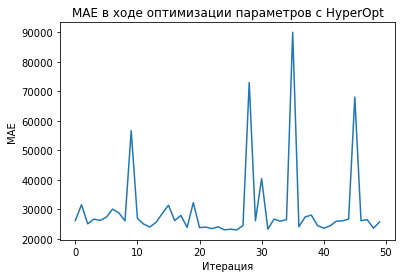

In [57]:
plt.figure(figsize=(6,4))
plt.title('МАЕ в ходе оптимизации параметров с HyperOpt')
plt.plot(trials.losses())
plt.xlabel('Итерация')
plt.ylabel('МАЕ');

In [58]:
best['max_depth'] = int(best['max_depth'])
best['n_estimators'] = int(best['n_estimators'])
lgbm = LGBMRegressor(**best, categorical_feature='auto')
lgbm.fit(X_train['A'], y_train)
mean_absolute_error(y_test, lgbm.predict(X_test['A']))

25196.82172243329

**Ваши выводы:**

HyperOpt позволяет подобрать параметры точнее даже при больших границах, чем GridSearch, добиваясь лучшего качества, не тратя сильно много времени - 10 минут и МАЕ=25к у HyperOpt VS 6 минут и МАЕ=33.8 у GridSearch

## Предсказание зрительских симпатий

Ну что, детишки, а теперь перейдём к действительно важным вопросам.

**Внимание!** Следующее задание сдается в системе cv-gml.ru, задание `Град. бустинг (ML)` Для выполнения этого задания необходимо скачать датасет из задания. Здесь вы можете немного почитать про датасет и, при желании, поэкспериментировать. На cv-gml.ru загружайте уже готовый скрипт с подобранными параметрами для обучаемого регрессора. Релизовать код необходимо в шаблонном файле awards_prediction.py, который вы можете найти в проверяющей системе.

В некотором царстве, некотором государстве была развита кинопромышленность. Новые фильмы в этом государстве показывают по интернету, а пользователи после просмотра могут дать фильму некоторую "награду". Наша цель - предсказать число наград для фильма.

В нашем распоряжении имеются следующие данные:

**awards** - количество наград, полученных фильмом от пользователей (целевое значение)  
**potions** - количество магических зелий, потраченных на создание спец-эффектов  
**genres** - жанры созданного фильма  
**questions** - количество вопросов, заданных пользователями на соответствующих форумах об этом фильме до премьеры  
**directors** - режиссеры фильма (если неизвестны, то unknown)  
**filming_locations** - области, в которых снимался фильм  
**runtime** - продолжительность фильма в некоторых единицах, принятых в этом государстве  
**critics_liked** - количество критиков из 100, присудивших награды фильму на предварительных закрытых показах  
**pre-orders** - количество зрителей, заранее купивших билеты на первый показ  
**keywords** - ключевые слова, описывающие содержание фильма
**release_year** - год, во котором фильм был показан (конечно, в летоисчислении этого государства)

Следующие поля появляются несколько раз с разными значениями i:

**actor_i_known_movies** - количество известных фильмов актера i (i от 1 до 3)

**actor_i_postogramm** - количество подписчиков в социальной сети "по сто грамм" актера i (i от 1 до 3)

**actor_i_gender** - пол актера i (i от 1 до 3)

**actor_i_age** - возраст актера i (i от 1 до 3)

-----
**Внимание!** Учтите, что при OHE кодировании признаки на обучении и тестировании должны совпадать! Если вы примените простое .get_dummies() или что-то подобное, то признаки на трейне и тесте получатся разные! Так что вам, вероятно, придётся придумать способ для того, чтобы сохранить их :)  

### Задание 8 (ML задание, 20 баллов):
**Данные**: датасет с ценами поддержанных автомобилей  
**Метрика**: MAE  
**Цели**: В данном задании следует выполнить следующие пункты:  
1. Взять любую библиотеку градиентного бустинга
2. Используя предложенный датасет, обучить регрессор для предсказания awards (предоставляем полную свободу в настройках и выборе методов)
3. Загрузить решение и получить качество на закрытой выборке больше порогового значения